In [1]:
%load_ext autoreload
%autoreload 2

# from IPython.core.interactiveshell import InteractiveShell
# InteractiveShell.ast_node_interactivity = 'all'

import numpy as np
import json
from random import sample

import matplotlib.pyplot as plt
import seaborn as sns


import torch
import torch.nn.functional as F

from transformers import *

import collections
import os

import nltk
%matplotlib inline

from pandas import Series,DataFrame
import pandas as pd

import json
import re


In [2]:
# 处理 am-for-bert 数据

In [5]:
am_for_bert = 'am_for_bert_antonyms.txt'
#am_for_bert_file = open(am_for_bert)

with open(am_for_bert, 'r') as f:
    file_lines = f.readlines()

keymap =  [re.split(' |\t',string) for string in file_lines]

cohyponym = {}

for item in keymap:

    # 筛选出 同位词
    if ('cohyponym' == item[4]):
        master4 = item[2]
        slave4 = []
        length = len(item)
        
        for i in range(int((length-5)/2)):
            slave4.append(item[5+i*2])
        
        cohyponym[master4] = slave4
        
#print(cohyponym)
print(len(cohyponym))


10826


In [6]:
print(list(cohyponym.items())[:10])

[('school', ['house', 'church', 'college', 'center', 'hospital', 'hotel', 'ministry', 'restaurant', 'palace', 'temple', 'architecture', 'residence', 'theater', 'ruin', 'villa', 'embassy', 'cinema', 'garage', 'cabin', 'casino', 'chapel', 'cafe', 'mansion', 'mosque', 'abbey', 'capitol', 'barn', 'observatory', 'monastery', 'shrine', 'kirk', 'greenhouse', 'manor', 'oracle', 'convent', 'consulate', 'courthouse', 'synagogue', 'tavern', 'motel', 'hostel', 'preschool', 'diner', 'rink', 'farmhouse', 'chateau', 'basilica', 'bungalow', 'clubhouse', 'conservatory']), ('city', ['state', 'country', 'town', 'department', 'county', 'kingdom', 'ward', 'commonwealth', 'reservation', 'hometown', 'township', 'borough', 'canton', 'commune', 'shire', 'prefecture', 'barrio', 'sultanate']), ('state', ['city', 'country', 'town', 'department', 'county', 'ward', 'reservation', 'municipality', 'hometown', 'township', 'borough', 'canton', 'commune', 'shire', 'prefecture']), ('university', ['office', 'prison', 'sho

In [7]:
# 再处理 SimEvalBless 的数据
filename = 'sim_eval_bless.csv'
file_colname=['word1','word2','relation']
df = pd.read_csv(filename,header=None,names=file_colname,sep = ';')

df

,word1,word2,relation
0,alligator,aggressive,attri
1,alligator,aquatic,attri
2,alligator,big,attri
3,alligator,carnivorous,attri
4,alligator,dangerous,attri
...,...,...,...
26548,sword,say,random
26549,sword,set,random
26550,sword,tram,random
26551,sword,win,random


In [8]:
df_clean = df[df['relation'].str.contains('coord')]
df_clean

,word1,word2,relation
16,alligator,crocodile,coord
17,alligator,frog,coord
18,alligator,lizard,coord
19,alligator,snake,coord
20,alligator,toad,coord
...,...,...,...
26423,sword,pistol,coord
26424,sword,revolver,coord
26425,sword,rifle,coord
26426,sword,shotgun,coord


In [11]:
data = df_clean.groupby(['word1'])['word2'].apply(list).to_dict()
print(data)
print(len(data))

{'acacia': ['birch', 'cedar', 'cypress', 'elm', 'oak', 'pine', 'poplar', 'willow'], 'alligator': ['crocodile', 'frog', 'lizard', 'snake', 'toad', 'turtle'], 'ambulance': ['battleship', 'bicycle', 'bike', 'bomber', 'bus', 'car', 'ferry', 'fighter', 'frigate', 'glider', 'helicopter', 'jet', 'moped', 'motorbike', 'motorcycle', 'scooter', 'tanker', 'tractor', 'train', 'truck', 'van', 'yacht'], 'ant': ['bee', 'beetle', 'butterfly', 'cockroach', 'cricket', 'dragonfly', 'fly', 'grasshopper', 'hornet', 'ladybug', 'locust', 'mosquito', 'moth', 'silverfish', 'wasp'], 'apple': ['apricot', 'banana', 'cherry', 'coconut', 'cranberry', 'grape', 'grapefruit', 'lemon', 'lime', 'peach', 'pear', 'pineapple', 'plum', 'strawberry'], 'apricot': ['apple', 'banana', 'cherry', 'coconut', 'cranberry', 'grape', 'grapefruit', 'lemon', 'lime', 'peach', 'pear', 'pineapple', 'plum', 'strawberry'], 'axe': ['chisel', 'corkscrew', 'dagger', 'drill', 'fork', 'hammer', 'hatchet', 'knife', 'mallet', 'pincer', 'pincers', '

In [9]:
templates = [
    'A * and a _ are of the same kind',
    'The co-hyponym for * is _ .'
]

In [12]:
all_cohyponym = {}

all_cohyponym.update(cohyponym)
all_cohyponym.update(data)

print(len(all_cohyponym))

10881


In [13]:
print(cohyponym.keys() & data.keys())

{'elephant', 'scooter', 'turtle', 'cedar', 'deer', 'dresser', 'woodpecker', 'cow', 'fighter', 'spinach', 'beaver', 'pineapple', 'guitar', 'dagger', 'bomb', 'plum', 'box', 'beetle', 'pub', 'saw', 'castle', 'frog', 'ambulance', 'hotel', 'birch', 'tanker', 'peach', 'salmon', 'jar', 'grape', 'cypress', 'washer', 'bomber', 'cauliflower', 'fork', 'shirt', 'parsley', 'glove', 'library', 'elm', 'broccoli', 'lettuce', 'eagle', 'dishwasher', 'robin', 'sofa', 'swan', 'pine', 'couch', 'knife', 'cranberry', 'bowl', 'sparrow', 'poplar', 'truck', 'radish', 'piano', 'car', 'desk', 'butterfly', 'willow', 'pig', 'helicopter', 'wardrobe', 'shovel', 'bag', 'horse', 'coat', 'sword', 'pear', 'gun', 'ant', 'sheep', 'oak', 'flute', 'spoon', 'squirrel', 'yacht', 'glider', 'hatchet', 'turnip', 'cloak', 'apricot', 'coyote', 'jet', 'table', 'crow', 'goat', 'wasp', 'ferry', 'phone', 'bus', 'fox', 'hat', 'apple', 'beet', 'banana', 'cottage', 'motorcycle', 'giraffe', 'hawk', 'owl', 'stove', 'robe', 'onion', 'lemon',

In [14]:
# 两个数据有很多相同的元素

In [15]:
# 模型
models = {}

model_class, tokenizer_class, shortcut, mask_token = RobertaForMaskedLM, RobertaTokenizer, 'roberta-base', '<mask>'
model, tokenizer = model_class.from_pretrained(shortcut), tokenizer_class.from_pretrained(shortcut)
models[shortcut] = (model, tokenizer, mask_token)

model_class, tokenizer_class, shortcut, mask_token = RobertaForMaskedLM, RobertaTokenizer, 'roberta-large', '<mask>'
model, tokenizer = model_class.from_pretrained(shortcut), tokenizer_class.from_pretrained(shortcut)
models[shortcut] = (model, tokenizer, mask_token)

model, tokenizer, mask_token = models['roberta-large']

Some weights of RobertaForMaskedLM were not initialized from the model checkpoint at roberta-base and are newly initialized: ['lm_head.decoder.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


loading state_dict took 1.002 sec


Some weights of RobertaForMaskedLM were not initialized from the model checkpoint at roberta-large and are newly initialized: ['lm_head.decoder.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


loading state_dict took 2.84 sec


A school and a _ are of the same kind
['hospital', 'church', 'library', 'university', 'home', 'college', 'house', 'school', 'prison', 'museum']
tensor([0.1667, 0.1230, 0.0606, 0.0522, 0.0501, 0.0291, 0.0254, 0.0244, 0.0181,
        0.0167])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
{'house': tensor(0.0254), 'church': tensor(0.1230), 'college': tensor(0.0291), 'center': tensor(0.0011), 'hospital': tensor(0.1667), 'hotel': tensor(0.0026), 'ministry': tensor(0.0053), 'restaurant': tensor(0.0007), 'palace': tensor(0.0048), 'temple': tensor(0.0065), 'architecture': tensor(4.6743e-06), 'residence': tensor(0.0031), 'theater': tensor(0.0009), 'ruin': tensor(5.9019e-05), 'embassy': tensor(1.5526e-05), 'cinema': tensor(0.0003), 'garage': tensor(0.0004), 

['person', 'business', 'corporation', 'state', 'company', 'country', 'government', 'bank', 'nation', 'man']
tensor([0.1224, 0.0909, 0.0473, 0.0472, 0.0452, 0.0415, 0.0297, 0.0271, 0.0253,
        0.0149])
vanguardis not in list
bodyguardis not in list
commandois not in list
picketis not in list
yeomanryis not in list
{'division': tensor(0.0011), 'command': tensor(0.0001), 'enemy': tensor(1.5014e-06), 'squad': tensor(5.6133e-05), 'battery': tensor(3.5382e-05), 'corps': tensor(3.0620e-05), 'patrol': tensor(6.6533e-07), 'territorial': tensor(1.2108e-06), 'artillery': tensor(1.3155e-08), 'regiment': tensor(7.3461e-05), 'infantry': tensor(1.3289e-08), 'militia': tensor(4.0834e-05), 'brigade': tensor(6.3926e-05), 'armor': tensor(5.9031e-09), 'cavalry': tensor(4.8982e-07), 'battalion': tensor(3.8057e-05), 'contingent': tensor(8.2541e-06), 'legion': tensor(1.7991e-05), 'troop': tensor(2.7476e-05), 'squadron': tensor(6.5910e-06), 'detachment': tensor(1.6752e-06), 'platoon': tensor(2.4213e-05)}


['product', 'gift', 'good', 'service', 'job', 'sale', 'transaction', 'commodity', 'tax', 'reward']
tensor([0.1421, 0.0848, 0.0425, 0.0404, 0.0359, 0.0171, 0.0161, 0.0150, 0.0115,
        0.0085])
{'research': tensor(2.1103e-05), 'chance': tensor(9.3961e-05), 'risk': tensor(0.0002), 'treatment': tensor(0.0012), 'operation': tensor(3.3392e-05), 'analysis': tensor(1.9323e-07), 'campaign': tensor(0.0002), 'effort': tensor(4.8704e-06), 'duty': tensor(0.0060), 'investigation': tensor(1.4855e-06), 'labor': tensor(0.0015), 'exercise': tensor(2.8762e-06), 'survey': tensor(0.0005), 'struggle': tensor(6.5859e-05), 'reform': tensor(3.1094e-05), 'hat': tensor(8.5267e-05), 'comparison': tensor(1.5338e-05), 'lesson': tensor(0.0022), 'therapy': tensor(0.0003), 'contrast': tensor(9.1603e-06), 'shower': tensor(3.4396e-05), 'examination': tensor(2.9450e-06), 'enterprise': tensor(2.4900e-05), 'bath': tensor(5.8216e-05), 'behalf': tensor(5.0423e-07), 'adventure': tensor(3.8689e-06), 'experiment': tensor(1.

['constitution', 'rule', 'contract', 'judgment', 'law', 'policy', 'decree', 'sentence', 'statute', 'punishment']
tensor([0.0908, 0.0729, 0.0426, 0.0250, 0.0243, 0.0241, 0.0238, 0.0230, 0.0216,
        0.0198])
kiteis not in list
girois not in list
{'act': tensor(0.0001), 'bill': tensor(0.0121), 'contract': tensor(0.0426), 'option': tensor(9.3725e-07), 'draft': tensor(0.0002), 'ticket': tensor(0.0001), 'treaty': tensor(0.0143), 'license': tensor(0.0021), 'charter': tensor(0.0026), 'patent': tensor(0.0008), 'assignment': tensor(2.7951e-07), 'franchise': tensor(0.0004), 'lease': tensor(5.3717e-05), 'passport': tensor(0.0004), 'mandate': tensor(0.0021), 'decree': tensor(0.0238), 'prohibition': tensor(0.0012), 'covenant': tensor(0.0010), 'pardon': tensor(0.0083), 'pickup': tensor(9.6566e-08), 'proxy': tensor(1.2670e-05), 'deed': tensor(0.0072), 'verification': tensor(2.2604e-06), 'indictment': tensor(1.8114e-05), 'concession': tensor(0.0002), 'ordinance': tensor(0.0002), 'injunction': tenso

['house', 'road', 'street', 'city', 'town', 'river', 'building', 'sidewalk', 'highway', 'lane']
tensor([0.0876, 0.0685, 0.0507, 0.0474, 0.0373, 0.0326, 0.0276, 0.0251, 0.0216,
        0.0205])
speedwayis not in list
portageis not in list
turnpikeis not in list
causewayis not in list
{'highway': tensor(0.0216), 'trail': tensor(0.0006), 'interstate': tensor(3.1739e-06), 'artery': tensor(2.0310e-05), 'driveway': tensor(0.0018), 'roadway': tensor(0.0022)}
max_probe is: tensor(0.0216)
the position of max probe is: 8
-----------------------------------------------------
*****************************************************
A council and a _ are of the same kind
['government', 'parliament', 'legislature', 'state', 'court', 'king', 'mayor', 'committee', 'church', 'cabinet']
tensor([0.0747, 0.0669, 0.0632, 0.0547, 0.0353, 0.0320, 0.0212, 0.0211, 0.0207,
        0.0188])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
{'department': tensor(0.0018),

max_probe is: tensor(0.0021)
20
40
80
the position of max probe is: 41
-----------------------------------------------------
*****************************************************
A office and a _ are of the same kind
['house', 'home', 'job', 'school', 'hospital', 'business', 'company', 'university', 'factory', 'city']
tensor([0.0591, 0.0423, 0.0326, 0.0287, 0.0240, 0.0191, 0.0120, 0.0112, 0.0107,
        0.0103])
secretariatis not in list
directorateis not in list
orphanageis not in list
bazaaris not in list
cabaretis not in list
canteenis not in list
panchayatis not in list
{'university': tensor(0.0112), 'department': tensor(0.0017), 'board': tensor(0.0005), 'council': tensor(0.0004), 'committee': tensor(0.0005), 'agency': tensor(4.4222e-05), 'prison': tensor(0.0061), 'shop': tensor(0.0055), 'joint': tensor(0.0002), 'intelligence': tensor(1.3851e-06), 'branch': tensor(0.0004), 'jail': tensor(0.0012), 'institution': tensor(0.0002), 'cabinet': tensor(0.0015), 'jury': tensor(0.0002), 'tr

['person', 'story', 'character', 'plot', 'place', 'situation', 'personality', 'thing', 'scene', 'creature']
tensor([0.0952, 0.0767, 0.0555, 0.0202, 0.0188, 0.0152, 0.0135, 0.0121, 0.0114,
        0.0078])
{'right': tensor(3.6677e-05), 'point': tensor(0.0006), 'kind': tensor(9.1731e-05), 'half': tensor(2.4832e-05), 'period': tensor(0.0013), 'value': tensor(0.0005), 'middle': tensor(6.7941e-06), 'model': tensor(0.0009), 'attention': tensor(5.8773e-07), 'version': tensor(2.2930e-05), 'style': tensor(0.0003), 'door': tensor(0.0010), 'access': tensor(3.6411e-08), 'rule': tensor(0.0006), 'product': tensor(0.0027), 'dream': tensor(0.0024), 'basis': tensor(2.5232e-05), 'teacher': tensor(0.0003), 'brand': tensor(0.0008), 'feature': tensor(0.0006), 'quarter': tensor(9.7776e-05), 'zero': tensor(2.1163e-05), 'category': tensor(0.0002), 'conclusion': tensor(6.4590e-05), 'fantasy': tensor(0.0005), 'monster': tensor(0.0048), 'aspect': tensor(3.5627e-06), 'sum': tensor(0.0001), 'dragon': tensor(0.0003

['shadow', 'candle', 'flame', 'fire', 'sound', 'mirror', 'star', 'lamp', 'light', 'torch']
tensor([0.0859, 0.0849, 0.0674, 0.0455, 0.0397, 0.0307, 0.0233, 0.0162, 0.0149,
        0.0098])
{'level': tensor(8.3593e-06), 'post': tensor(8.0867e-05), 'shot': tensor(0.0004), 'step': tensor(5.0010e-05), 'key': tensor(0.0004), 'mine': tensor(0.0002), 'computer': tensor(0.0007), 'gun': tensor(0.0085), 'machine': tensor(0.0014), 'spring': tensor(0.0003), 'fan': tensor(0.0006), 'engine': tensor(6.7677e-06), 'screen': tensor(0.0004), 'web': tensor(0.0004), 'bridge': tensor(0.0012), 'net': tensor(0.0007), 'governor': tensor(6.1409e-06), 'bell': tensor(0.0006), 'chair': tensor(0.0002), 'button': tensor(0.0002), 'spoke': tensor(7.1056e-06), 'bomb': tensor(0.0036), 'cable': tensor(8.0783e-05), 'weapon': tensor(0.0043), 'motor': tensor(0.0007), 'wheel': tensor(0.0007), 'gate': tensor(0.0002), 'battery': tensor(0.0033), 'server': tensor(1.5708e-05), 'mirror': tensor(0.0307), 'objective': tensor(6.8110e-

tensor([0.1755, 0.0922, 0.0920, 0.0303, 0.0230, 0.0205, 0.0191, 0.0168, 0.0120,
        0.0094])
{'right': tensor(0.0053), 'point': tensor(0.0066), 'kind': tensor(1.3125e-05), 'half': tensor(0.0028), 'type': tensor(1.1537e-05), 'period': tensor(0.0008), 'value': tensor(6.5964e-05), 'model': tensor(4.6165e-05), 'attention': tensor(2.6951e-07), 'version': tensor(6.7279e-05), 'style': tensor(0.0001), 'door': tensor(0.0018), 'access': tensor(2.0382e-07), 'rule': tensor(0.0004), 'product': tensor(4.0505e-05), 'basis': tensor(0.0001), 'teacher': tensor(8.0758e-06), 'brand': tensor(7.2073e-06), 'feature': tensor(0.0002), 'quarter': tensor(0.0040), 'zero': tensor(0.0018), 'category': tensor(1.0035e-05), 'conclusion': tensor(0.0011), 'aspect': tensor(3.5266e-07), 'sum': tensor(0.0005), 'component': tensor(8.1477e-06), 'quantity': tensor(5.3808e-06), 'triple': tensor(0.0001), 'copyright': tensor(8.1497e-07), 'syndrome': tensor(6.2974e-06), 'notion': tensor(1.9647e-06), 'perception': tensor(2.917

{'development': tensor(0.0011), 'addition': tensor(1.3817e-07), 'division': tensor(0.0014), 'constitution': tensor(0.0009), 'motion': tensor(0.0006), 'expansion': tensor(1.8468e-06), 'suicide': tensor(0.0001), 'extension': tensor(1.9994e-07), 'rent': tensor(5.8406e-06), 'improvement': tensor(7.8373e-07), 'burning': tensor(2.1279e-05), 'reduction': tensor(1.4914e-05), 'promotion': tensor(0.0002), 'cooking': tensor(2.8262e-07), 'destruction': tensor(0.0001), 'retirement': tensor(1.3512e-05), 'amendment': tensor(1.4344e-06), 'replacement': tensor(3.5629e-05), 'cleaning': tensor(4.4414e-06), 'disaster': tensor(0.0014), 'federation': tensor(0.0013), 'removal': tensor(5.2355e-06), 'discount': tensor(1.4225e-06), 'completion': tensor(1.8856e-05), 'abortion': tensor(2.1011e-07), 'restoration': tensor(0.0004), 'installation': tensor(1.0357e-06), 'withdrawal': tensor(6.2378e-05), 'reconstruction': tensor(7.7384e-05), 'graduation': tensor(9.4036e-06), 'perfection': tensor(8.5527e-06), 'correction

['boat', 'submarine', 'ship', 'man', 'person', 'plane', 'river', 'city', 'car', 'house']
tensor([0.0818, 0.0476, 0.0449, 0.0342, 0.0288, 0.0281, 0.0171, 0.0147, 0.0137,
        0.0119])
arkis not in list
bargeis not in list
lifeboatis not in list
frigateis not in list
glideris not in list
galleyis not in list
schooneris not in list
steamboatis not in list
airshipis not in list
sloopis not in list
biplaneis not in list
{'aircraft': tensor(0.0004), 'boat': tensor(0.0818), 'jet': tensor(0.0012), 'helicopter': tensor(0.0034), 'fighter': tensor(0.0003), 'ferry': tensor(0.0015), 'junk': tensor(1.8984e-05), 'airplane': tensor(0.0002), 'gig': tensor(1.8696e-05), 'balloon': tensor(0.0011), 'drone': tensor(0.0006), 'bomber': tensor(0.0004), 'yacht': tensor(0.0058), 'spacecraft': tensor(0.0014), 'smack': tensor(5.7434e-06), 'canoe': tensor(0.0025), 'punt': tensor(9.8755e-05), 'brig': tensor(0.0001)}
max_probe is: tensor(0.0818)
the position of max probe is: 0
-------------------------------------

40
80
160
320
the position of max probe is: 208
-----------------------------------------------------
*****************************************************
A trade and a _ are of the same kind
['contract', 'loan', 'transaction', 'war', 'sale', 'treaty', 'deal', 'purchase', 'friendship', 'marriage']
tensor([0.0725, 0.0708, 0.0638, 0.0552, 0.0458, 0.0308, 0.0270, 0.0259, 0.0240,
        0.0166])
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'industry': tensor(2.3022e-05), 'technology': tensor(3.5755e-05), 'career': tensor(0.0003), 'sale': tensor(0.0458), 'traffic': tensor(3.3287e-05), 'sport': tensor(0.0004), 'marketing': tensor(4.6089e-05), 'spending': tensor(1.1811e-05), 'employment': tensor(1.7134e-05), 'transportation': tensor(7.1013e-05), 'payment': tensor(0.0034), 'storage': tensor(5.3352e-06), 'trading': tensor(6.1261e-05), 'advertising': tensor(7.6292e-07), 'mining': tensor(1

max_probe is: tensor(2.2980e-05)
20
40
80
160
320
640
1280
the position of max probe is: 862
-----------------------------------------------------
*****************************************************
A township and a _ are of the same kind
['city', 'village', 'county', 'municipality', 'town', 'borough', 'district', 'community', 'state', 'parish']
tensor([0.1979, 0.1611, 0.1036, 0.0982, 0.0813, 0.0551, 0.0479, 0.0326, 0.0236,
        0.0197])
commonwealthis not in list
cantonis not in list
communeis not in list
shireis not in list
prefectureis not in list
sultanateis not in list
{'state': tensor(0.0236), 'city': tensor(0.1979), 'country': tensor(0.0083), 'town': tensor(0.0813), 'department': tensor(0.0013), 'county': tensor(0.1036), 'kingdom': tensor(0.0061), 'ward': tensor(0.0021), 'reservation': tensor(0.0003), 'municipality': tensor(0.0982), 'hometown': tensor(3.8593e-05), 'township': tensor(0.0184), 'borough': tensor(0.0551)}
max_probe is: tensor(0.1979)
the position of max probe i

20
the position of max probe is: 10
-----------------------------------------------------
*****************************************************
A officer and a _ are of the same kind
['dog', 'soldier', 'man', 'woman', 'horse', 'child', 'gun', 'thief', 'girl', 'person']
tensor([0.0411, 0.0380, 0.0339, 0.0304, 0.0183, 0.0152, 0.0151, 0.0111, 0.0107,
        0.0101])
consulis not in list
telleris not in list
caretakeris not in list
deaconis not in list
commandois not in list
listeris not in list
{'minister': tensor(0.0012), 'captain': tensor(0.0009), 'marine': tensor(0.0002), 'soldier': tensor(0.0380), 'ambassador': tensor(1.3979e-05), 'volunteer': tensor(0.0010), 'territorial': tensor(2.3058e-06), 'veteran': tensor(0.0004), 'prosecutor': tensor(0.0003), 'striker': tensor(8.0014e-05), 'incumbent': tensor(7.6555e-07), 'diplomat': tensor(0.0006), 'regulator': tensor(0.0002), 'envoy': tensor(5.7414e-07), 'usher': tensor(3.3479e-06), 'tanker': tensor(6.3498e-05)}
max_probe is: tensor(0.0380)


{'right': tensor(6.3408e-05), 'point': tensor(0.0003), 'kind': tensor(1.8858e-05), 'half': tensor(1.0121e-05), 'type': tensor(2.5451e-05), 'period': tensor(7.8312e-06), 'value': tensor(0.0029), 'middle': tensor(3.3008e-06), 'model': tensor(9.4087e-05), 'version': tensor(2.9037e-06), 'style': tensor(0.0002), 'door': tensor(1.4978e-05), 'access': tensor(6.4062e-07), 'rule': tensor(0.0008), 'basis': tensor(8.7602e-06), 'teacher': tensor(4.6642e-06), 'brand': tensor(4.6199e-05), 'quarter': tensor(3.8714e-06), 'zero': tensor(1.3267e-05), 'category': tensor(0.0001), 'conclusion': tensor(3.7695e-05), 'sum': tensor(1.9907e-05), 'component': tensor(0.0001), 'quantity': tensor(0.0001), 'triple': tensor(3.5256e-07), 'copyright': tensor(1.4886e-05), 'syndrome': tensor(3.1997e-05), 'notion': tensor(1.0132e-05), 'perception': tensor(5.4762e-05), 'genre': tensor(1.4556e-06), 'compound': tensor(4.1346e-06), 'charm': tensor(8.6611e-05), 'assumption': tensor(9.2366e-07), 'privilege': tensor(0.0004), 'cl

['contract', 'promise', 'handshake', 'trust', 'lease', 'gift', 'deed', 'bond', 'treaty', 'loan']
tensor([0.2074, 0.1276, 0.0378, 0.0205, 0.0189, 0.0164, 0.0163, 0.0158, 0.0150,
        0.0146])
kiteis not in list
girois not in list
{'law': tensor(0.0061), 'act': tensor(1.6656e-05), 'bill': tensor(0.0058), 'option': tensor(3.2201e-06), 'draft': tensor(0.0016), 'ticket': tensor(0.0004), 'treaty': tensor(0.0150), 'license': tensor(0.0049), 'patent': tensor(0.0022), 'assignment': tensor(8.5130e-06), 'passport': tensor(0.0005), 'mandate': tensor(0.0023), 'decree': tensor(0.0025), 'prohibition': tensor(0.0001), 'covenant': tensor(0.0030), 'pardon': tensor(0.0019), 'pickup': tensor(7.3065e-06), 'proxy': tensor(0.0001), 'deed': tensor(0.0163), 'verification': tensor(1.0383e-05), 'indictment': tensor(1.4716e-06), 'ordinance': tensor(5.1040e-06), 'injunction': tensor(5.9319e-06), 'writ': tensor(0.0014)}
max_probe is: tensor(0.0163)
the position of max probe is: 6
--------------------------------

['species', 'family', 'country', 'tribe', 'class', 'genus', 'population', 'nation', 'gene', 'place']
tensor([0.8279, 0.0137, 0.0082, 0.0074, 0.0071, 0.0063, 0.0055, 0.0049, 0.0045,
        0.0038])
{'type': tensor(0.0014), 'model': tensor(1.8420e-05), 'version': tensor(7.8429e-06), 'style': tensor(7.6402e-05), 'brand': tensor(0.0001), 'genre': tensor(0.0001), 'charm': tensor(3.8351e-06), 'breed': tensor(0.0003), 'flavor': tensor(3.1584e-05), 'stripe': tensor(1.7526e-05), 'perpendicular': tensor(7.0181e-09)}
max_probe is: tensor(0.0014)
20
40
the position of max probe is: 20
-----------------------------------------------------
*****************************************************
A engineering and a _ are of the same kind
['man', 'person', 'woman', 'child', 'computer', 'marriage', 'car', 'war', 'weapon', 'bomb']
tensor([0.0074, 0.0065, 0.0064, 0.0058, 0.0056, 0.0055, 0.0052, 0.0052, 0.0052,
        0.0051])
potteryis not in list
geologyis not in list
premiershipis not in list
apprentic

['river', 'spring', 'stream', 'flood', 'fountain', 'waterfall', 'lake', 'well', 'rain', 'storm']
tensor([0.1589, 0.1033, 0.0690, 0.0588, 0.0410, 0.0285, 0.0222, 0.0209, 0.0202,
        0.0179])
{'level': tensor(1.8865e-05), 'post': tensor(4.1182e-05), 'light': tensor(0.0003), 'shot': tensor(7.9422e-05), 'step': tensor(1.7074e-05), 'key': tensor(2.5155e-05), 'mine': tensor(0.0005), 'computer': tensor(1.3801e-05), 'gun': tensor(0.0002), 'machine': tensor(8.6066e-05), 'fan': tensor(0.0002), 'engine': tensor(6.6987e-06), 'screen': tensor(5.8372e-06), 'web': tensor(2.1251e-05), 'bridge': tensor(0.0016), 'net': tensor(3.4636e-05), 'governor': tensor(6.0148e-06), 'bell': tensor(0.0003), 'chair': tensor(4.8497e-05), 'button': tensor(2.7147e-05), 'spoke': tensor(4.7056e-07), 'bomb': tensor(0.0005), 'cable': tensor(4.0180e-05), 'weapon': tensor(4.3338e-05), 'motor': tensor(6.7616e-05), 'wheel': tensor(0.0009), 'gate': tensor(5.6339e-05), 'battery': tensor(0.0006), 'server': tensor(9.1020e-06), '

['soldier', 'general', 'commander', 'leader', 'captain', 'warrior', 'pilot', 'subordinate', 'servant', 'governor']
tensor([0.2047, 0.0663, 0.0453, 0.0250, 0.0197, 0.0187, 0.0156, 0.0154, 0.0138,
        0.0104])
marshalis not in list
commodoreis not in list
commandois not in list
brigadieris not in list
ensignis not in list
bombardieris not in list
adjutantis not in list
quartermasteris not in list
{'captain': tensor(0.0197), 'marine': tensor(0.0006), 'soldier': tensor(0.2047), 'lieutenant': tensor(0.0086), 'colonel': tensor(0.0097), 'volunteer': tensor(0.0030), 'territorial': tensor(6.0105e-06), 'sergeant': tensor(0.0052), 'veteran': tensor(0.0008), 'striker': tensor(0.0001), 'tanker': tensor(1.2036e-05)}
max_probe is: tensor(0.2047)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A hotel and a _ are of the same kind
['restaurant', 'house', 'home', 'casino', 'resort', 'residence', 'motel', 'man

['cure', 'diagnosis', 'disease', 'wound', 'medicine', 'remedy', 'treatment', 'prescription', 'surgery', 'procedure']
tensor([0.3927, 0.1119, 0.0551, 0.0286, 0.0248, 0.0238, 0.0216, 0.0181, 0.0179,
        0.0175])
{'job': tensor(0.0031), 'service': tensor(0.0059), 'research': tensor(0.0002), 'chance': tensor(1.8682e-05), 'risk': tensor(6.5153e-05), 'operation': tensor(0.0008), 'organization': tensor(3.1512e-07), 'commission': tensor(3.0241e-05), 'campaign': tensor(0.0002), 'effort': tensor(4.8253e-06), 'duty': tensor(0.0002), 'investigation': tensor(4.4242e-06), 'labor': tensor(0.0002), 'exercise': tensor(4.3874e-05), 'survey': tensor(4.6709e-05), 'struggle': tensor(5.9157e-05), 'reform': tensor(0.0007), 'hat': tensor(7.9629e-06), 'comparison': tensor(3.3186e-05), 'lesson': tensor(0.0012), 'contrast': tensor(4.2052e-05), 'shower': tensor(9.0152e-06), 'examination': tensor(9.9858e-05), 'enterprise': tensor(1.8876e-07), 'bath': tensor(0.0003), 'behalf': tensor(4.4142e-08), 'adventure': t

['train', 'car', 'truck', 'taxi', 'plane', 'bicycle', 'bus', 'subway', 'tractor', 'tram']
tensor([0.3488, 0.1150, 0.0508, 0.0398, 0.0380, 0.0196, 0.0181, 0.0180, 0.0114,
        0.0113])
battleshipis not in list
frigateis not in list
glideris not in list
mopedis not in list
motorbikeis not in list
scooteris not in list
{'ambulance': tensor(0.0001), 'bicycle': tensor(0.0196), 'bike': tensor(0.0045), 'bomber': tensor(0.0004), 'car': tensor(0.1150), 'ferry': tensor(0.0067), 'fighter': tensor(0.0001), 'helicopter': tensor(0.0067), 'jet': tensor(0.0019), 'motorcycle': tensor(0.0093), 'tanker': tensor(0.0008), 'tractor': tensor(0.0114), 'train': tensor(0.3488), 'truck': tensor(0.0508), 'van': tensor(0.0038), 'yacht': tensor(0.0005)}
max_probe is: tensor(0.3488)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A machine and a _ are of the same kind
['man', 'person', 'machine', 'human', 'tool', 'computer

['house', 'city', 'home', 'factory', 'garden', 'town', 'farm', 'village', 'forest', 'school']
tensor([0.1438, 0.0853, 0.0816, 0.0674, 0.0414, 0.0363, 0.0282, 0.0246, 0.0198,
        0.0171])
fisheryis not in list
shipyardis not in list
collieryis not in list
{'job': tensor(0.0013), 'location': tensor(8.5221e-05), 'studio': tensor(0.0010), 'lab': tensor(0.0011), 'workshop': tensor(0.0010), 'laundry': tensor(3.2460e-05), 'forge': tensor(2.8934e-05), 'bakery': tensor(0.0012)}
max_probe is: tensor(0.0013)
20
40
80
the position of max probe is: 79
-----------------------------------------------------
*****************************************************
A ministry and a _ are of the same kind
['church', 'ministry', 'government', 'state', 'school', 'university', 'hospital', 'party', 'religion', 'department']
tensor([0.1899, 0.0595, 0.0594, 0.0420, 0.0366, 0.0241, 0.0158, 0.0136, 0.0124,
        0.0094])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
k

['bird', 'fish', 'human', 'whale', 'submarine', 'mammal', 'person', 'dolphin', 'tree', 'plant']
tensor([0.1275, 0.1135, 0.1016, 0.0332, 0.0215, 0.0177, 0.0157, 0.0148, 0.0142,
        0.0136])
marshalis not in list
commodoreis not in list
commandois not in list
ensignis not in list
bombardieris not in list
adjutantis not in list
quartermasteris not in list
{'captain': tensor(1.5377e-05), 'marine': tensor(0.0038), 'commander': tensor(6.3924e-06), 'lieutenant': tensor(1.3047e-06), 'colonel': tensor(5.0961e-06), 'volunteer': tensor(7.3992e-05), 'territorial': tensor(2.7146e-05), 'sergeant': tensor(1.4000e-06), 'veteran': tensor(5.7395e-05), 'striker': tensor(4.7653e-06), 'tanker': tensor(5.5339e-05)}
max_probe is: tensor(0.0038)
20
40
80
the position of max probe is: 40
-----------------------------------------------------
*****************************************************
A enemy and a _ are of the same kind
['friend', 'comrade', 'victim', 'lover', 'hero', 'neighbor', 'soldier', 'mast

['price', 'commodity', 'profit', 'product', 'value', 'cost', 'gift', 'sale', 'promise', 'dollar']
tensor([0.1230, 0.0334, 0.0333, 0.0320, 0.0319, 0.0300, 0.0294, 0.0285, 0.0202,
        0.0166])
anchorageis not in list
portageis not in list
{'rate': tensor(0.0013), 'commission': tensor(0.0010), 'cash': tensor(5.5775e-05), 'benefit': tensor(0.0011), 'payment': tensor(0.0027), 'fee': tensor(0.0031), 'penalty': tensor(0.0001), 'wage': tensor(0.0069), 'bonus': tensor(0.0004), 'compensation': tensor(0.0004), 'reward': tensor(0.0038), 'expense': tensor(3.8058e-05), 'pension': tensor(0.0001), 'premium': tensor(0.0021), 'satisfaction': tensor(0.0001), 'footage': tensor(3.6137e-08), 'soap': tensor(1.3136e-05), 'toll': tensor(0.0004), 'freight': tensor(6.4211e-05), 'subscription': tensor(0.0005), 'fare': tensor(0.0001), 'tuition': tensor(1.2957e-05), 'royalty': tensor(0.0004), 'redemption': tensor(0.0009), 'ransom': tensor(0.0009), 'bounty': tensor(0.0004), 'bribe': tensor(0.0009), 'retribution'

['house', 'building', 'city', 'home', 'castle', 'person', 'palace', 'town', 'garden', 'residence']
tensor([0.0769, 0.0535, 0.0508, 0.0302, 0.0115, 0.0096, 0.0094, 0.0092, 0.0090,
        0.0089])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
{'school': tensor(0.0080), 'house': tensor(0.0769), 'church': tensor(0.0066), 'science': tensor(0.0007), 'center': tensor(0.0002), 'character': tensor(0.0022), 'hospital': tensor(0.0076), 'hotel': tensor(0.0043), 'strategy': tensor(0.0003), 'ministry': tensor(0.0009), 'restaurant': tensor(0.0030), 'engineering': tensor(2.9658e-05), 'literature': tensor(0.0001), 'painting': tensor(0.0018), 'palace': tensor(0.0094), 'philosophy': tensor(0.0009), 'temple': tensor(0.0060), 'logic': tensor(2.1679e-05), 'residence': tensor(0.0089), 'theater': tensor(0.0006), 'ruin': tensor(0.0008), 'psychology': tensor(0.0001), 'chemistry': tensor(5.0386e-05), 'cinema': tensor(0.0005), 'embassy': tensor(3.8047e

['thing', 'person', 'kind', 'gift', 'good', 'place', 'being', 'creature', 'number', 'law']
tensor([0.0971, 0.0587, 0.0477, 0.0244, 0.0223, 0.0185, 0.0134, 0.0121, 0.0120,
        0.0102])
invariantis not in list
tensoris not in list
{'right': tensor(0.0036), 'point': tensor(0.0015), 'half': tensor(0.0006), 'period': tensor(0.0005), 'value': tensor(0.0055), 'middle': tensor(0.0001), 'model': tensor(0.0003), 'attention': tensor(2.1771e-06), 'door': tensor(0.0002), 'access': tensor(3.8013e-07), 'rule': tensor(0.0011), 'product': tensor(0.0036), 'basis': tensor(4.8812e-05), 'teacher': tensor(0.0002), 'feature': tensor(0.0002), 'quarter': tensor(0.0003), 'zero': tensor(0.0001), 'conclusion': tensor(4.1179e-05), 'aspect': tensor(4.1447e-06), 'sum': tensor(0.0008), 'component': tensor(2.9065e-05), 'quantity': tensor(0.0039), 'triple': tensor(5.9019e-06), 'copyright': tensor(5.4505e-05), 'syndrome': tensor(0.0001), 'notion': tensor(0.0001), 'perception': tensor(0.0001), 'compound': tensor(0.00

{'weather': tensor(0.0011), 'wind': tensor(0.0249), 'rain': tensor(0.0373), 'snow': tensor(0.0022), 'draft': tensor(0.0013), 'cloud': tensor(0.0138), 'sweat': tensor(0.0001), 'sunset': tensor(0.0060), 'fog': tensor(0.0076), 'hail': tensor(0.0016), 'breeze': tensor(0.0087), 'sunrise': tensor(0.0039), 'puff': tensor(9.1688e-05), 'turbulence': tensor(8.7367e-05), 'gust': tensor(0.0002)}
max_probe is: tensor(0.0373)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A soccer and a _ are of the same kind
['football', 'ball', 'basketball', 'baseball', 'volleyball', 'bicycle', 'gun', 'horse', 'cricket', 'car']
tensor([0.2456, 0.0670, 0.0599, 0.0356, 0.0255, 0.0241, 0.0125, 0.0104, 0.0102,
        0.0088])
polois not in list
softballis not in list
lacrosseis not in list
sumois not in list
{'baseball': tensor(0.0356), 'soccer': tensor(0.0054), 'rugby': tensor(0.0023), 'cricket': tensor(0.0102), 'boxing': te

A intelligence and a _ are of the same kind
['lie', 'brain', 'mind', 'genius', 'mistake', 'disease', 'memory', 'child', 'gift', 'heart']
tensor([0.0327, 0.0159, 0.0156, 0.0152, 0.0110, 0.0087, 0.0084, 0.0083, 0.0081,
        0.0077])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(3.6408e-05), 'board': tensor(1.9226e-05), 'council': tensor(1.7285e-05), 'committee': tensor(3.4379e-05), 'agency': tensor(1.4127e-05), 'branch': tensor(3.2769e-05), 'cabinet': tensor(9.5991e-06), 'jury': tensor(0.0004), 'treasury': tensor(1.1621e-05), 'organ': tensor(8.1848e-06), 'subcommittee': tensor(2.9016e-07)}
max_probe is: tensor(0.0004)
20
40
80
160
320
640
the position of max probe is: 411
-----------------------------------------------------
*****************************************************
A graduate and a _ are of the same kind
['student', 'graduate', 'teacher', 'professional', 'slave', 'worker', 'sci

{'dick': tensor(8.0682e-05), 'lieutenant': tensor(0.0028), 'inspector': tensor(0.0002), 'detective': tensor(0.0294), 'sheriff': tensor(0.0317), 'policeman': tensor(0.0757), 'trooper': tensor(0.0061)}
max_probe is: tensor(0.0757)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A adult and a _ are of the same kind
['child', 'baby', 'dog', 'fetus', 'kitten', 'toddler', 'puppy', 'newborn', 'teenager', 'kid']
tensor([0.5845, 0.0659, 0.0364, 0.0335, 0.0311, 0.0298, 0.0170, 0.0157, 0.0111,
        0.0071])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
houndis not in list
chowis not in list
fleais not in list
bullockis not in list
feederis not in list
sireis not in list
scorpionis not in list
{'head': tensor(1.4591e-05), 'dog': tensor(0.0364), 'female': tensor(0.0016), 'fish': tensor(0.0005), 'male': tensor(0.0006), 'queen': tensor(9.4834e-05), 'tom'

max_probe is: tensor(0.0074)
the position of max probe is: 9
-----------------------------------------------------
*****************************************************
A wrestling and a _ are of the same kind
['fight', 'wrestling', 'fighting', 'shooting', 'sport', 'boxing', 'war', 'game', 'brawl', 'dance']
tensor([0.0606, 0.0536, 0.0203, 0.0161, 0.0155, 0.0144, 0.0144, 0.0131, 0.0125,
        0.0112])
polois not in list
lacrosseis not in list
joggingis not in list
judois not in list
archeryis not in list
badmintonis not in list
handballis not in list
netballis not in list
{'football': tensor(0.0096), 'exercise': tensor(0.0001), 'golf': tensor(0.0004), 'soccer': tensor(0.0014), 'basketball': tensor(0.0023), 'fishing': tensor(0.0003), 'rugby': tensor(0.0012), 'cricket': tensor(0.0007), 'tennis': tensor(0.0013), 'jumping': tensor(0.0009), 'boxing': tensor(0.0144), 'cycling': tensor(0.0004), 'yoga': tensor(0.0005), 'dive': tensor(0.0006), 'volleyball': tensor(0.0012), 'skiing': tensor(0.0

['conclusion', 'description', 'summary', 'closing', 'review', 'statement', 'warning', 'critique', 'quote', 'story']
tensor([0.1159, 0.0319, 0.0315, 0.0207, 0.0189, 0.0181, 0.0170, 0.0147, 0.0125,
        0.0113])
holocaustis not in list
{'development': tensor(0.0012), 'murder': tensor(2.7332e-05), 'transfer': tensor(0.0005), 'reform': tensor(8.2381e-05), 'constitution': tensor(4.9944e-05), 'suicide': tensor(0.0002), 'improvement': tensor(2.2384e-06), 'cooking': tensor(2.9118e-06), 'shower': tensor(1.0131e-05), 'destruction': tensor(3.5071e-05), 'retirement': tensor(8.5417e-05), 'bath': tensor(2.3823e-05), 'amendment': tensor(3.1124e-06), 'disaster': tensor(0.0002), 'cleaning': tensor(2.7951e-05), 'federation': tensor(2.1864e-06), 'removal': tensor(0.0013), 'vacation': tensor(0.0004), 'passage': tensor(0.0004), 'abortion': tensor(2.2834e-06), 'completion': tensor(0.0003), 'restoration': tensor(5.5645e-05), 'installation': tensor(8.0218e-06), 'reconstruction': tensor(0.0002), 'bombing': 

['right', 'privilege', 'duty', 'promise', 'crime', 'love', 'responsibility', 'pleasure', 'gift', 'wish']
tensor([0.0597, 0.0468, 0.0441, 0.0377, 0.0361, 0.0333, 0.0301, 0.0235, 0.0223,
        0.0197])
{'service': tensor(0.0163), 'research': tensor(2.4933e-06), 'chance': tensor(0.0002), 'risk': tensor(0.0021), 'treatment': tensor(5.6841e-05), 'operation': tensor(2.4341e-06), 'analysis': tensor(2.1877e-08), 'campaign': tensor(0.0001), 'effort': tensor(4.1140e-06), 'investigation': tensor(1.5619e-06), 'labor': tensor(0.0008), 'exercise': tensor(4.9678e-06), 'survey': tensor(3.3527e-05), 'struggle': tensor(0.0003), 'reform': tensor(8.5109e-05), 'comparison': tensor(2.2165e-06), 'lesson': tensor(0.0003), 'therapy': tensor(2.6791e-05), 'contrast': tensor(7.7337e-07), 'shower': tensor(1.9864e-06), 'examination': tensor(1.7454e-06), 'enterprise': tensor(2.9215e-06), 'bath': tensor(3.4375e-06), 'adventure': tensor(2.8694e-05), 'experiment': tensor(1.1885e-06), 'surveillance': tensor(2.1418e-05

['landscape', 'window', 'room', 'wardrobe', 'facade', 'garden', 'exterior', 'bathroom', 'house', 'home']
tensor([0.0423, 0.0293, 0.0287, 0.0283, 0.0254, 0.0244, 0.0224, 0.0215, 0.0210,
        0.0205])
shorelineis not in list
napeis not in list
{'top': tensor(0.0006), 'front': tensor(0.0020), 'bottom': tensor(0.0005), 'border': tensor(0.0016), 'edge': tensor(1.7677e-06), 'rear': tensor(0.0005), 'sole': tensor(1.6133e-05), 'interface': tensor(9.4298e-06), 'poll': tensor(7.4380e-06), 'frontier': tensor(8.2145e-05), 'desktop': tensor(0.0004), 'heel': tensor(3.0870e-06), 'verge': tensor(1.4345e-06), 'coastline': tensor(4.2885e-05), 'forefront': tensor(8.1462e-06), 'brink': tensor(3.0685e-07), 'substrate': tensor(2.2701e-05), 'skyline': tensor(0.0014), 'rooftop': tensor(0.0016), 'silhouette': tensor(0.0005), 'hem': tensor(1.8722e-06)}
max_probe is: tensor(0.0020)
20
40
80
the position of max probe is: 70
-----------------------------------------------------
*********************************

['pressure', 'temperature', 'force', 'number', 'sound', 'wave', 'time', 'pulse', 'voltage', 'quantity']
tensor([0.0602, 0.0501, 0.0441, 0.0361, 0.0298, 0.0272, 0.0242, 0.0216, 0.0191,
        0.0184])
incenseis not in list
{'music': tensor(2.8285e-05), 'sound': tensor(0.0298), 'taste': tensor(0.0010), 'vision': tensor(0.0002), 'noise': tensor(0.0015), 'threshold': tensor(0.0003), 'detection': tensor(5.0641e-05), 'sensation': tensor(0.0023), 'sour': tensor(4.8841e-07), 'melody': tensor(4.2574e-05), 'scent': tensor(0.0003), 'dub': tensor(1.4685e-06), 'harmonic': tensor(8.0010e-05), 'aroma': tensor(3.1407e-07)}
max_probe is: tensor(0.0298)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A y and a _ are of the same kind
['z', 'x', 'w', 'b', 'n', 'p', 't', 'r', 'd', 'v']
tensor([0.7631, 0.0529, 0.0478, 0.0251, 0.0142, 0.0115, 0.0088, 0.0083, 0.0064,
        0.0061])
xiis not in list
bethis not in lis

['film', 'novel', 'drama', 'documentary', 'story', 'biography', 'movie', 'fiction', 'play', 'report']
tensor([0.1143, 0.0821, 0.0775, 0.0684, 0.0615, 0.0452, 0.0326, 0.0275, 0.0247,
        0.0239])
yearbookis not in list
pictorialis not in list
tomeis not in list
reissueis not in list
{'book': tensor(0.0182), 'series': tensor(0.0076), 'album': tensor(9.6894e-06), 'collection': tensor(9.6467e-05), 'volume': tensor(3.1663e-05), 'journal': tensor(0.0013), 'edition': tensor(7.6915e-07), 'magazine': tensor(0.0015), 'novel': tensor(0.0821), 'publication': tensor(0.0005), 'inspiration': tensor(2.6895e-06), 'documentary': tensor(0.0684), 'cartoon': tensor(0.0028), 'catalog': tensor(4.4561e-05), 'compilation': tensor(0.0002), 'notebook': tensor(7.9189e-06), 'textbook': tensor(0.0003), 'masterpiece': tensor(0.0010), 'slick': tensor(2.8721e-06), 'digest': tensor(7.5344e-06), 'booklet': tensor(0.0002), 'anthology': tensor(3.7046e-06)}
max_probe is: tensor(0.0821)
the position of max probe is: 1
-

['farm', 'flower', 'city', 'garden', 'man', 'woman', 'house', 'plant', 'forest', 'crop']
tensor([0.0110, 0.0096, 0.0093, 0.0091, 0.0086, 0.0085, 0.0079, 0.0079, 0.0077,
        0.0077])
syndicationis not in list
{'trade': tensor(0.0011), 'industry': tensor(7.5419e-05), 'sale': tensor(0.0007), 'traffic': tensor(3.6453e-05), 'marketing': tensor(2.7816e-05), 'spending': tensor(2.3415e-05), 'transportation': tensor(4.4315e-05), 'payment': tensor(0.0001), 'storage': tensor(5.3015e-05), 'trading': tensor(1.4240e-05), 'advertising': tensor(9.7718e-07), 'mining': tensor(3.0649e-05), 'fishing': tensor(6.7678e-05), 'output': tensor(1.1150e-05), 'boring': tensor(4.4969e-06), 'banking': tensor(3.4427e-05), 'tourism': tensor(6.6394e-05), 'printing': tensor(4.9033e-06), 'tribute': tensor(0.0002), 'venture': tensor(0.0001), 'crop': tensor(0.0077), 'auction': tensor(7.7909e-06), 'financing': tensor(2.6410e-06), 'ferry': tensor(4.8258e-05), 'navigation': tensor(9.8172e-06), 'freight': tensor(1.3763e-05

['lemon', 'banana', 'mango', 'grape', 'pear', 'tomato', 'cherry', 'pineapple', 'strawberry', 'raspberry']
tensor([0.1478, 0.1321, 0.0800, 0.0666, 0.0438, 0.0424, 0.0410, 0.0363, 0.0323,
        0.0269])
berryis not in list
blackberryis not in list
scarletis not in list
burgundyis not in list
lavenderis not in list
maroonis not in list
indigois not in list
beigeis not in list
saskatoonis not in list
azureis not in list
{'wine': tensor(0.0002), 'apple': tensor(0.0022), 'chocolate': tensor(0.0007), 'emperor': tensor(1.6448e-07), 'cardinal': tensor(0.0003), 'lemon': tensor(0.1478), 'tan': tensor(0.0001), 'banana': tensor(0.1321), 'amber': tensor(4.3925e-06), 'lime': tensor(0.0046), 'violet': tensor(0.0067), 'grape': tensor(0.0666), 'fig': tensor(0.0071), 'peach': tensor(0.0203), 'strawberry': tensor(0.0323), 'blond': tensor(1.6882e-05), 'dun': tensor(8.5462e-06), 'plum': tensor(0.0179), 'mango': tensor(0.0800), 'pear': tensor(0.0438)}
max_probe is: tensor(0.1478)
the position of max probe 

['beer', 'flower', 'drink', 'spirit', 'cigar', 'woman', 'meal', 'grape', 'stone', 'wine']
tensor([0.0807, 0.0342, 0.0252, 0.0228, 0.0188, 0.0188, 0.0185, 0.0183, 0.0163,
        0.0144])
genevais not in list
manhattanis not in list
marcis not in list
scarletis not in list
brandyis not in list
burgundyis not in list
tequilais not in list
maroonis not in list
martiniis not in list
margaritais not in list
benedictineis not in list
{'beer': tensor(0.0807), 'sake': tensor(0.0004), 'punch': tensor(0.0003), 'flip': tensor(1.5748e-07), 'cardinal': tensor(1.9912e-05), 'liquor': tensor(0.0057), 'zombie': tensor(3.7309e-05), 'sour': tensor(0.0002), 'vodka': tensor(0.0015), 'whiskey': tensor(0.0033), 'cocktail': tensor(0.0039), 'ale': tensor(4.6147e-05), 'rum': tensor(0.0004), 'gin': tensor(0.0006), 'bourbon': tensor(0.0005), 'brew': tensor(0.0010)}
max_probe is: tensor(0.0807)
the position of max probe is: 0
-----------------------------------------------------
***********************************

['marriage', 'dream', 'lie', 'disaster', 'child', 'mistake', 'death', 'war', 'failure', 'crime']
tensor([0.0114, 0.0114, 0.0099, 0.0095, 0.0094, 0.0072, 0.0068, 0.0066, 0.0059,
        0.0047])
counterattackis not in list
{'fire': tensor(0.0021), 'mission': tensor(0.0025), 'invasion': tensor(1.2737e-05), 'offense': tensor(1.8222e-05), 'bombing': tensor(0.0002), 'breakthrough': tensor(0.0002), 'penetration': tensor(2.8101e-05), 'ambush': tensor(9.0175e-06), 'blitz': tensor(2.3205e-05), 'maneuver': tensor(6.1933e-05), 'reconnaissance': tensor(5.6060e-05), 'espionage': tensor(1.6711e-06), 'barrage': tensor(4.4624e-05)}
max_probe is: tensor(0.0025)
20
40
80
the position of max probe is: 43
-----------------------------------------------------
*****************************************************
A mine and a _ are of the same kind
['mine', 'river', 'forest', 'quarry', 'factory', 'dam', 'road', 'city', 'town', 'field']
tensor([0.0839, 0.0461, 0.0380, 0.0351, 0.0191, 0.0182, 0.0179, 0.0173, 

['hunting', 'shooting', 'hunt', 'sport', 'swimming', 'chase', 'game', 'killing', 'diving', 'fishing']
tensor([0.2268, 0.0929, 0.0504, 0.0298, 0.0128, 0.0117, 0.0104, 0.0097, 0.0091,
        0.0089])
polois not in list
lacrosseis not in list
judois not in list
archeryis not in list
badmintonis not in list
handballis not in list
{'trade': tensor(0.0006), 'industry': tensor(9.2640e-06), 'football': tensor(0.0017), 'sale': tensor(0.0002), 'traffic': tensor(0.0001), 'marketing': tensor(8.1471e-05), 'spending': tensor(0.0001), 'transportation': tensor(0.0005), 'payment': tensor(5.2516e-05), 'storage': tensor(7.6252e-05), 'trading': tensor(0.0002), 'golf': tensor(0.0012), 'advertising': tensor(2.8949e-05), 'mining': tensor(0.0004), 'soccer': tensor(0.0009), 'basketball': tensor(0.0006), 'output': tensor(6.7180e-07), 'boring': tensor(5.5387e-05), 'rugby': tensor(7.9926e-05), 'cricket': tensor(0.0006), 'tennis': tensor(0.0003), 'banking': tensor(9.0268e-05), 'tourism': tensor(0.0019), 'printing

['state', 'province', 'kingdom', 'colony', 'republic', 'county', 'nation', 'country', 'city', 'monarchy']
tensor([0.1653, 0.1257, 0.1113, 0.0769, 0.0728, 0.0537, 0.0468, 0.0442, 0.0348,
        0.0256])
confederationis not in list
cantonis not in list
communeis not in list
shireis not in list
prefectureis not in list
sultanateis not in list
{'city': tensor(0.0348), 'country': tensor(0.0442), 'town': tensor(0.0082), 'department': tensor(0.0006), 'league': tensor(0.0003), 'county': tensor(0.0537), 'kingdom': tensor(0.1113), 'ward': tensor(0.0002), 'tribe': tensor(0.0014), 'lobby': tensor(1.5399e-05), 'reservation': tensor(9.7393e-05), 'municipality': tensor(0.0184), 'hometown': tensor(9.3099e-06), 'township': tensor(0.0042), 'borough': tensor(0.0067)}
max_probe is: tensor(0.1113)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A chair and a _ are of the same kind
['table', 'desk', 'bed', 'bench', 

['missile', 'gun', 'bomb', 'tank', 'helicopter', 'submarine', 'plane', 'rocket', 'car', 'truck']
tensor([0.0958, 0.0828, 0.0802, 0.0593, 0.0315, 0.0294, 0.0259, 0.0239, 0.0228,
        0.0148])
{'car': tensor(0.0228), 'cup': tensor(2.1524e-05), 'box': tensor(0.0004), 'ship': tensor(0.0087), 'aircraft': tensor(0.0005), 'bus': tensor(0.0044), 'glass': tensor(1.2779e-05), 'van': tensor(0.0005), 'boat': tensor(0.0035), 'bag': tensor(0.0002), 'bowl': tensor(1.1401e-05), 'bottle': tensor(0.0003), 'truck': tensor(0.0148), 'chest': tensor(1.4976e-05), 'package': tensor(9.4556e-05), 'pocket': tensor(8.1556e-05), 'bath': tensor(8.5717e-05), 'pot': tensor(6.3587e-05), 'deck': tensor(3.1224e-05), 'kit': tensor(2.9906e-05), 'craft': tensor(0.0002), 'carrier': tensor(0.0009), 'rocket': tensor(0.0239), 'helicopter': tensor(0.0315), 'fighter': tensor(0.0047), 'trailer': tensor(0.0010), 'bin': tensor(3.2576e-05), 'shoe': tensor(0.0004), 'dish': tensor(6.4983e-05), 'portfolio': tensor(4.6903e-06), 'basi

['bone', 'body', 'hair', 'tissue', 'skin', 'muscle', 'heart', 'brain', 'face', 'blood']
tensor([0.1153, 0.0711, 0.0672, 0.0375, 0.0261, 0.0255, 0.0241, 0.0223, 0.0169,
        0.0130])
irisis not in list
marcelis not in list
beaveris not in list
roachis not in list
chopperis not in list
ligamentis not in list
maneis not in list
braidis not in list
ponytailis not in list
tunicis not in list
{'hair': tensor(0.0672), 'muscle': tensor(0.0255), 'bone': tensor(0.1153), 'coat': tensor(0.0059), 'bang': tensor(3.7196e-06), 'flesh': tensor(0.0051), 'nerve': tensor(0.0011), 'beard': tensor(0.0027), 'skull': tensor(0.0085), 'tooth': tensor(0.0109), 'fur': tensor(0.0036), 'jaw': tensor(0.0001), 'membrane': tensor(0.0033), 'feather': tensor(0.0056), 'rib': tensor(0.0011), 'marrow': tensor(0.0006), 'mustache': tensor(0.0002), 'cortex': tensor(0.0001), 'nasal': tensor(3.4176e-06), 'eyebrow': tensor(8.8958e-07), 'canine': tensor(8.4107e-06)}
max_probe is: tensor(0.1153)
the position of max probe is: 0


['soldier', 'knight', 'warrior', 'slave', 'thief', 'dog', 'queen', 'prince', 'king', 'saint']
tensor([0.1978, 0.0578, 0.0499, 0.0356, 0.0280, 0.0256, 0.0245, 0.0235, 0.0226,
        0.0203])
dukeis not in list
earlis not in list
baronis not in list
marquisis not in list
sireis not in list
cavalieris not in list
viscountis not in list
palatineis not in list
marquessis not in list
{'castle': tensor(0.0002), 'pawn': tensor(0.0007)}
max_probe is: tensor(0.0007)
20
40
80
160
the position of max probe is: 141
-----------------------------------------------------
*****************************************************
A rice and a _ are of the same kind
['potato', 'wheat', 'banana', 'bean', 'grain', 'tomato', 'vegetable', 'rice', 'tea', 'bread']
tensor([0.1188, 0.0991, 0.0641, 0.0636, 0.0509, 0.0271, 0.0164, 0.0157, 0.0139,
        0.0130])
danishis not in list
timothyis not in list
milois not in list
bluegrassis not in list
{'bread': tensor(0.0130), 'corn': tensor(0.0073), 'wheat': tensor(0.09

['man', 'cat', 'tree', 'dog', 'flower', 'bee', 'woman', 'cow', 'girl', 'horse']
tensor([0.0191, 0.0149, 0.0124, 0.0119, 0.0108, 0.0097, 0.0096, 0.0085, 0.0072,
        0.0067])
consulis not in list
telleris not in list
caretakeris not in list
deaconis not in list
barristeris not in list
listeris not in list
{'minister': tensor(6.6500e-05), 'ambassador': tensor(1.0593e-06), 'incumbent': tensor(3.0162e-07), 'referee': tensor(1.8631e-05), 'diplomat': tensor(1.3051e-05), 'regulator': tensor(2.9032e-05), 'solicitor': tensor(7.0052e-06), 'envoy': tensor(2.4740e-07), 'usher': tensor(6.0510e-07)}
max_probe is: tensor(6.6500e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2194
-----------------------------------------------------
*****************************************************
A replacement and a _ are of the same kind
['repair', 'replacement', 'restoration', 'renovation', 'renewal', 'modification', 'supplement', 'refund', 'revision', 'service']
tensor([0.3381, 0.0367, 0

['gift', 'loan', 'job', 'contract', 'death', 'mortgage', 'lie', 'child', 'crime', 'sale']
tensor([0.0215, 0.0165, 0.0143, 0.0089, 0.0083, 0.0076, 0.0075, 0.0072, 0.0071,
        0.0067])
nelsonis not in list
{'possession': tensor(0.0041), 'custody': tensor(2.5184e-05), 'timing': tensor(2.2823e-06), 'navigation': tensor(6.6711e-06), 'imprisonment': tensor(1.2994e-05), 'coordination': tensor(4.2989e-06), 'restriction': tensor(0.0001), 'restraint': tensor(5.3828e-05), 'suppression': tensor(2.9265e-05), 'confinement': tensor(1.2031e-05), 'constraint': tensor(0.0001), 'inhibition': tensor(4.1683e-07), 'clasp': tensor(4.2534e-06)}
max_probe is: tensor(0.0041)
20
40
the position of max probe is: 24
-----------------------------------------------------
*****************************************************
A phone and a _ are of the same kind
['computer', 'camera', 'laptop', 'tablet', 'car', 'phone', 'television', 'TV', 'person', 'radio']
tensor([0.2331, 0.0540, 0.0355, 0.0283, 0.0256, 0.0139, 

['house', 'home', 'garden', 'city', 'street', 'building', 'field', 'farm', 'town', 'tree']
tensor([0.4934, 0.0798, 0.0416, 0.0183, 0.0094, 0.0082, 0.0079, 0.0078, 0.0077,
        0.0060])
groveis not in list
paddyis not in list
oasisis not in list
apronis not in list
{'lot': tensor(0.0027), 'site': tensor(0.0003), 'range': tensor(8.8637e-05), 'park': tensor(0.0037), 'bed': tensor(0.0016), 'plot': tensor(0.0019), 'campus': tensor(0.0002), 'arena': tensor(2.7246e-06), 'clearing': tensor(0.0002), 'cemetery': tensor(0.0026), 'lawn': tensor(0.0035), 'terrain': tensor(4.8192e-05), 'monument': tensor(0.0001), 'plaza': tensor(4.8727e-05), 'battlefield': tensor(8.8311e-05), 'tee': tensor(3.6116e-06), 'midway': tensor(9.2872e-08), 'subdivision': tensor(0.0002)}
max_probe is: tensor(0.0037)
20
40
the position of max probe is: 23
-----------------------------------------------------
*****************************************************
A license and a _ are of the same kind
['permit', 'passport', 

{'development': tensor(0.0042), 'reform': tensor(0.0030), 'shower': tensor(1.9665e-05), 'bath': tensor(8.0297e-05), 'amendment': tensor(1.4167e-05), 'cleaning': tensor(0.0094), 'restoration': tensor(0.0272), 'reconstruction': tensor(0.0105), 'perfection': tensor(8.1338e-05), 'correction': tensor(0.0090), 'rehabilitation': tensor(0.0047), 'advancement': tensor(3.3596e-05), 'renovation': tensor(0.0405), 'enhancement': tensor(9.6922e-05), 'ventilation': tensor(2.2288e-05), 'optimization': tensor(1.7287e-05), 'sanitation': tensor(0.0009), 'purge': tensor(0.0005), 'enrichment': tensor(7.4124e-06), 'modernization': tensor(0.0048), 'retribution': tensor(4.3069e-06), 'stabilization': tensor(0.0002), 'stride': tensor(1.8023e-06), 'subsistence': tensor(1.0783e-05)}
max_probe is: tensor(0.0405)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A column and a _ are of the same kind
['table', 'row', 'column', 

['dress', 'shirt', 'tie', 'suit', 'coat', 'uniform', 'skirt', 'hat', 'jacket', 'gown']
tensor([0.1580, 0.0814, 0.0657, 0.0628, 0.0593, 0.0483, 0.0461, 0.0442, 0.0314,
        0.0292])
jeanis not in list
ulsteris not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
macintoshis not in list
dominois not in list
{'trial': tensor(5.7089e-05), 'hearing': tensor(1.4464e-06), 'shirt': tensor(0.0814), 'jersey': tensor(0.0028), 'hat': tensor(0.0442), 'procedure': tensor(4.1572e-06), 'cap': tensor(0.0041), 'belt': tensor(0.0033), 'uniform': tensor(0.0483), 'coat': tensor(0.0593), 'cape': tensor(0.0084), 'jacket': tensor(0.0314), 'mask': tensor(0.0057), 'stole': tensor(8.5690e-05), 'adoption': tensor(1.9015e-08), 'prosecution': tensor(3.4745e-07), 'costume': tensor(0.0125), 'outfit': tensor(0.0003), 'laundry': tensor(4.4762e-05), 'helmet': tensor(0.0057), 'lawsuit': tensor(8.9491e-05), 'litigation': tensor(9.8782e-08), 'objection': tensor(1.1244e-08), 'skirt

['procedure', 'wound', 'surgery', 'stroke', 'transplant', 'treatment', 'diagnosis', 'disease', 'miracle', 'death']
tensor([0.0623, 0.0426, 0.0363, 0.0344, 0.0305, 0.0271, 0.0261, 0.0181, 0.0179,
        0.0166])
tribuneis not in list
{'court': tensor(3.4431e-05), 'box': tensor(2.6004e-05), 'hall': tensor(9.9775e-06), 'library': tensor(8.3215e-06), 'medicine': tensor(0.0044), 'engineering': tensor(2.1958e-06), 'kitchen': tensor(1.0278e-05), 'bathroom': tensor(2.8531e-05), 'bedroom': tensor(1.7721e-05), 'chamber': tensor(1.5489e-05), 'gallery': tensor(2.1948e-06), 'toilet': tensor(0.0001), 'biology': tensor(1.5597e-05), 'cabin': tensor(1.5812e-05), 'den': tensor(1.3435e-06), 'classroom': tensor(4.0575e-06), 'boot': tensor(2.5711e-05), 'cage': tensor(1.4943e-05), 'cab': tensor(8.8883e-06), 'booth': tensor(2.7947e-06), 'closet': tensor(9.2503e-06), 'lounge': tensor(8.1685e-07), 'dock': tensor(4.8332e-06), 'module': tensor(8.6663e-07), 'anatomy': tensor(4.7540e-06), 'stall': tensor(1.0449e-

['devil', 'demon', 'dog', 'man', 'ghost', 'wolf', 'god', 'dragon', 'vampire', 'monster']
tensor([0.1950, 0.1179, 0.0478, 0.0271, 0.0267, 0.0251, 0.0226, 0.0181, 0.0175,
        0.0168])
genieis not in list
gnomeis not in list
{'saint': tensor(0.0031), 'devil': tensor(0.1950), 'fairy': tensor(0.0009), 'vampire': tensor(0.0175), 'goddess': tensor(0.0008), 'avatar': tensor(1.3008e-06), 'deity': tensor(0.0005), 'python': tensor(5.5927e-05), 'elf': tensor(3.3343e-05), 'goblin': tensor(0.0009), 'daemon': tensor(0.0002)}
max_probe is: tensor(0.1950)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A rain and a _ are of the same kind
['cloud', 'storm', 'snow', 'flood', 'rainbow', 'mist', 'wind', 'fog', 'hail', 'frost']
tensor([0.1095, 0.0885, 0.0673, 0.0665, 0.0523, 0.0516, 0.0442, 0.0282, 0.0188,
        0.0152])
galeis not in list
cycloneis not in list
stillnessis not in list
{'wind': tensor(0.0442), '

{'governor': tensor(4.1885e-05), 'screw': tensor(0.0077), 'pump': tensor(0.0014), 'hammer': tensor(0.0024), 'anchor': tensor(2.2189e-05), 'dial': tensor(0.0005), 'shuttle': tensor(0.0003), 'ramp': tensor(0.0014), 'broadcaster': tensor(5.8670e-07), 'lever': tensor(0.0058), 'regulator': tensor(5.9745e-05), 'bumper': tensor(1.6231e-05), 'timer': tensor(2.2390e-05), 'piston': tensor(0.0088), 'shutter': tensor(7.2321e-05), 'aperture': tensor(1.2493e-06), 'accelerator': tensor(7.3717e-06), 'compressor': tensor(4.1578e-05), 'selector': tensor(2.2976e-06)}
max_probe is: tensor(0.0088)
20
the position of max probe is: 16
-----------------------------------------------------
*****************************************************
A cat and a _ are of the same kind
['dog', 'mouse', 'bird', 'rabbit', 'snake', 'horse', 'fish', 'fox', 'wolf', 'human']
tensor([0.6111, 0.0388, 0.0322, 0.0190, 0.0155, 0.0154, 0.0105, 0.0104, 0.0086,
        0.0083])
beaveris not in list
cougaris not in list
coyoteis not 

{'fever': tensor(0.0184), 'syndrome': tensor(1.4182e-05), 'chill': tensor(0.0011), 'autism': tensor(7.1970e-08), 'scar': tensor(0.0008), 'rash': tensor(0.0008), 'inflammation': tensor(3.1225e-06), 'congestion': tensor(1.6332e-05), 'nausea': tensor(0.0004), 'eruption': tensor(1.4743e-06), 'aura': tensor(1.6873e-07)}
max_probe is: tensor(0.0184)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A buffalo and a _ are of the same kind
['cow', 'horse', 'camel', 'donkey', 'deer', 'goat', 'lion', 'calf', 'wolf', 'bull']
tensor([0.1165, 0.1019, 0.0934, 0.0889, 0.0595, 0.0477, 0.0461, 0.0427, 0.0386,
        0.0349])
nannyis not in list
springeris not in list
bullockis not in list
gnuis not in list
{'kid': tensor(0.0001), 'bull': tensor(0.0349), 'beef': tensor(0.0002), 'sheep': tensor(0.0241), 'cow': tensor(0.1165), 'goat': tensor(0.0477), 'ox': tensor(0.0003)}
max_probe is: tensor(0.1165)
the position of 

['pear', 'banana', 'potato', 'grape', 'plum', 'tomato', 'cherry', 'peach', 'pumpkin', 'tree']
tensor([0.1521, 0.0411, 0.0370, 0.0335, 0.0298, 0.0270, 0.0240, 0.0229, 0.0217,
        0.0210])
apricotis not in list
cranberryis not in list
grapefruitis not in list
{'banana': tensor(0.0411), 'cherry': tensor(0.0240), 'coconut': tensor(0.0022), 'grape': tensor(0.0335), 'lemon': tensor(0.0140), 'lime': tensor(0.0004), 'peach': tensor(0.0229), 'pear': tensor(0.1521), 'pineapple': tensor(0.0056), 'plum': tensor(0.0298), 'strawberry': tensor(0.0081)}
max_probe is: tensor(0.1521)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A enterprise and a _ are of the same kind
['business', 'person', 'child', 'job', 'disaster', 'man', 'market', 'contract', 'marriage', 'state']
tensor([0.0182, 0.0158, 0.0110, 0.0101, 0.0081, 0.0080, 0.0079, 0.0076, 0.0074,
        0.0072])
{'job': tensor(0.0101), 'service': tensor(0

['dress', 'uniform', 'badge', 'costume', 'garment', 'hat', 'suit', 'flag', 'shirt', 'coat']
tensor([0.0996, 0.0967, 0.0687, 0.0477, 0.0273, 0.0259, 0.0258, 0.0249, 0.0245,
        0.0240])
jeanis not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0258), 'shirt': tensor(0.0245), 'jersey': tensor(0.0012), 'hat': tensor(0.0259), 'cap': tensor(0.0059), 'belt': tensor(0.0022), 'coat': tensor(0.0240), 'cape': tensor(0.0044), 'jacket': tensor(0.0091), 'mask': tensor(0.0140), 'stole': tensor(0.0001), 'costume': tensor(0.0477), 'outfit': tensor(0.0003), 'laundry': tensor(2.1800e-05), 'helmet': tensor(0.0201), 'grocery': tensor(4.6799e-06), 'skirt': tensor(0.0103), 'disguise': tensor(0.0056), 'gown': tensor(0.0045), 'sweater': tensor(0.0024), 'glove': tensor(0.0012), 'ho

{'development': tensor(0.0062), 'step': tensor(0.0018), 'career': tensor(0.0007), 'addition': tensor(4.5569e-06), 'tour': tensor(0.0001), 'flight': tensor(0.0005), 'trip': tensor(0.0008), 'division': tensor(0.0008), 'murder': tensor(0.0001), 'progress': tensor(0.0005), 'transfer': tensor(0.0010), 'journey': tensor(0.0026), 'reform': tensor(0.0032), 'constitution': tensor(4.9929e-05), 'wave': tensor(0.0008), 'blow': tensor(0.0001), 'recovery': tensor(0.0030), 'motion': tensor(0.0004), 'expansion': tensor(5.1005e-05), 'suicide': tensor(0.0004), 'introduction': tensor(5.9527e-06), 'transportation': tensor(6.8008e-06), 'delivery': tensor(0.0001), 'extension': tensor(4.6018e-06), 'rent': tensor(1.8206e-05), 'improvement': tensor(1.4215e-05), 'burning': tensor(8.4427e-05), 'reduction': tensor(0.0007), 'promotion': tensor(0.0011), 'cooking': tensor(5.0028e-07), 'shower': tensor(4.7198e-05), 'closing': tensor(0.0005), 'destruction': tensor(0.0006), 'retirement': tensor(0.0011), 'immigration': 

['weapon', 'gun', 'knife', 'tool', 'blade', 'stone', 'hammer', 'machine', 'hand', 'pen']
tensor([0.1872, 0.0715, 0.0569, 0.0415, 0.0263, 0.0257, 0.0254, 0.0254, 0.0129,
        0.0076])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
crookis not in list
steameris not in list
improvisationis not in list
thongis not in list
malaccais not in list
{'road': tensor(0.0005), 'club': tensor(0.0004), 'staff': tensor(0.0007), 'bar': tensor(0.0002), 'stick': tensor(0.0018), 'steel': tensor(6.0121e-05), 'rail': tensor(1.9520e-05), 'instrument': tensor(0.0002), 'pan': tensor(0.0004), 'pot': tensor(0.0008), 'pole': tensor(0.0001), 'rod': tensor(0.0010), 'salvation': tensor(2.0826e-05), 'poker': tensor(8.1871e-05), 'needle': tensor(0.0050), 'pencil': tensor(0.0023), 'bolt': tensor(0.0003), 'gig': tensor(2.7977e-06), 'shaft': tensor(0.0001), 'cane': tensor(0.0010), 'cue': tensor(1.8448e-05), 'strap': tensor(6.6185e-05), 'spear': tensor(0.0018),

['PM', 'pm', 'nap', 'post', 'job', 'call', 'lie', 'tweet', 'bang', 'day']
tensor([0.0255, 0.0123, 0.0083, 0.0069, 0.0058, 0.0058, 0.0057, 0.0056, 0.0053,
        0.0050])
spectroscopyis not in list
microscopyis not in list
{'research': tensor(1.0189e-05), 'analysis': tensor(1.3698e-06), 'survey': tensor(0.0003), 'comparison': tensor(4.0795e-05), 'contrast': tensor(2.4372e-05), 'experiment': tensor(1.9706e-06), 'surveillance': tensor(2.0617e-05), 'inquiry': tensor(1.2818e-05), 'inspection': tensor(3.3734e-06), 'census': tensor(0.0002), 'audit': tensor(4.8312e-06), 'anatomy': tensor(9.2113e-08), 'analogy': tensor(8.8404e-07), 'countdown': tensor(8.4154e-05), 'autopsy': tensor(1.9224e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
1280
the position of max probe is: 656
-----------------------------------------------------
*****************************************************
A apartment and a _ are of the same kind
['house', 'home', 'building', 'hotel', 'car', 'residence', 'school

['bird', 'raven', 'dove', 'hawk', 'fox', 'rabbit', 'deer', 'bee', 'dog', 'duck']
tensor([0.0403, 0.0391, 0.0351, 0.0335, 0.0331, 0.0280, 0.0225, 0.0211, 0.0202,
        0.0191])
condoris not in list
falconis not in list
penguinis not in list
pheasantis not in list
robinis not in list
sparrowis not in list
swanis not in list
vultureis not in list
woodpeckeris not in list
{'crow': tensor(0.0180), 'dove': tensor(0.0351), 'goose': tensor(0.0152), 'hawk': tensor(0.0335), 'owl': tensor(0.0007), 'pigeon': tensor(0.0165)}
max_probe is: tensor(0.0351)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A manufacturer and a _ are of the same kind
['supplier', 'manufacturer', 'consumer', 'distributor', 'designer', 'customer', 'producer', 'buyer', 'factory', 'product']
tensor([0.0873, 0.0775, 0.0614, 0.0613, 0.0546, 0.0535, 0.0348, 0.0247, 0.0213,
        0.0211])
syndicateis not in list
{'agency': tensor(1.461

40
the position of max probe is: 28
-----------------------------------------------------
*****************************************************
A spoke and a _ are of the same kind
['nut', 'screw', 'nail', 'tube', 'hub', 'pin', 'bearing', 'ring', 'plate', 'cylinder']
tensor([0.0745, 0.0739, 0.0397, 0.0371, 0.0369, 0.0231, 0.0228, 0.0225, 0.0214,
        0.0162])
{'level': tensor(3.7024e-05), 'post': tensor(0.0022), 'light': tensor(0.0001), 'shot': tensor(0.0001), 'step': tensor(0.0005), 'key': tensor(0.0011), 'mine': tensor(1.2793e-05), 'computer': tensor(7.9072e-06), 'gun': tensor(5.3890e-05), 'machine': tensor(3.7906e-05), 'spring': tensor(0.0062), 'fan': tensor(0.0005), 'engine': tensor(2.4996e-05), 'screen': tensor(0.0001), 'web': tensor(4.1121e-05), 'bridge': tensor(0.0073), 'net': tensor(5.0494e-06), 'governor': tensor(3.4943e-05), 'bell': tensor(0.0047), 'chair': tensor(1.7932e-05), 'button': tensor(0.0009), 'spoke': tensor(0.0115), 'bomb': tensor(3.0835e-05), 'cable': tensor(0.

max_probe is: tensor(0.2384)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A root and a _ are of the same kind
['branch', 'leaf', 'tree', 'stem', 'flower', 'seed', 'plant', 'bud', 'vegetable', 'vine']
tensor([0.1551, 0.1437, 0.1324, 0.0927, 0.0623, 0.0375, 0.0319, 0.0217, 0.0174,
        0.0094])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(3.7064e-06), 'stick': tensor(0.0018), 'apple': tensor(2.0510e-05), 'branch': tensor(0.1551), 'fruit': tensor(0.0081), 'seed': tensor(0.0375), 'flower': tensor(0.0623), 'leaf': tensor(0.1437), 'blade': tensor(0.0005), 'bud': tensor(0.0217), 'axis': tensor(1.7290e-06), 'trunk': tensor(0.0024), 'banana': tensor(0.0001), 'pad': tensor(1.0927e-05), 'nut': tensor(0.0031), 'bean': tensor(0.0043), 'peanut': tensor(0.0002), 'onion': tensor(2.6983e-05), 'cane': tensor(2.8993e-05), 'grape': tensor(0.0004), 'fig

{'apple': tensor(2.9823e-05), 'marijuana': tensor(7.8738e-05), 'cherry': tensor(0.0014), 'ash': tensor(2.7788e-06), 'elder': tensor(5.8734e-07), 'oak': tensor(1.4449e-07), 'lemon': tensor(0.0025), 'pine': tensor(3.5959e-05), 'cannabis': tensor(4.6903e-05), 'ti': tensor(1.7260e-06), 'maple': tensor(3.9427e-05), 'lime': tensor(0.0002), 'fig': tensor(0.0002), 'peach': tensor(0.0006), 'cinnamon': tensor(0.0001), 'almond': tensor(4.2700e-06), 'plum': tensor(0.0002), 'mango': tensor(0.0005), 'citrus': tensor(8.1113e-06), 'fir': tensor(6.2127e-06), 'broom': tensor(5.3047e-05), 'pear': tensor(0.0002)}
max_probe is: tensor(0.0025)
20
40
80
the position of max probe is: 51
-----------------------------------------------------
*****************************************************
A amendment and a _ are of the same kind
['marriage', 'lie', 'contract', 'mistake', 'law', 'conspiracy', 'gift', 'threat', 'death', 'crime']
tensor([0.0102, 0.0091, 0.0062, 0.0060, 0.0056, 0.0055, 0.0053, 0.0052, 0.0048,

A villa and a _ are of the same kind
['house', 'palace', 'castle', 'mansion', 'home', 'hotel', 'city', 'farm', 'village', 'monastery']
tensor([0.1938, 0.0955, 0.0829, 0.0479, 0.0337, 0.0260, 0.0215, 0.0195, 0.0192,
        0.0186])
{'castle': tensor(0.0829), 'cathedral': tensor(0.0033), 'cottage': tensor(0.0077), 'hospital': tensor(0.0070), 'hotel': tensor(0.0260), 'inn': tensor(0.0002), 'library': tensor(0.0022), 'pub': tensor(0.0019), 'restaurant': tensor(0.0057), 'warehouse': tensor(0.0018)}
max_probe is: tensor(0.0829)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A permission and a _ are of the same kind
['command', 'warning', 'pardon', 'threat', 'request', 'promise', 'license', 'demand', 'warrant', 'permission']
tensor([0.1073, 0.1020, 0.0555, 0.0406, 0.0310, 0.0304, 0.0302, 0.0281, 0.0234,
        0.0164])
accreditationis not in list
reorganizationis not in list
syndicationis not in lis

['chain', 'loop', 'jump', 'curve', 'circle', 'stream', 'wave', 'hinge', 'bridge', 'sequence']
tensor([0.1035, 0.0576, 0.0222, 0.0213, 0.0201, 0.0179, 0.0122, 0.0119, 0.0118,
        0.0117])
bradis not in list
{'button': tensor(0.0003), 'hook': tensor(0.0054), 'clip': tensor(0.0005), 'brake': tensor(0.0002), 'locker': tensor(6.9690e-06), 'knot': tensor(0.0110), 'staple': tensor(0.0002), 'gag': tensor(0.0003), 'peg': tensor(0.0002), 'buckle': tensor(8.5220e-06), 'leash': tensor(0.0008), 'hitch': tensor(0.0002), 'muzzle': tensor(3.3425e-06), 'tack': tensor(1.9597e-05), 'latch': tensor(0.0001), 'clasp': tensor(0.0002)}
max_probe is: tensor(0.0110)
20
the position of max probe is: 11
-----------------------------------------------------
*****************************************************
A pole and a _ are of the same kind
['tree', 'rope', 'ball', 'branch', 'stick', 'rock', 'ladder', 'string', 'stone', 'pole']
tensor([0.0582, 0.0311, 0.0265, 0.0251, 0.0194, 0.0186, 0.0172, 0.0111, 0.0109

['beer', 'wine', 'meal', 'cigarette', 'sandwich', 'drink', 'cocktail', 'shot', 'pizza', 'song']
tensor([0.0446, 0.0369, 0.0341, 0.0299, 0.0234, 0.0222, 0.0146, 0.0120, 0.0114,
        0.0113])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margaritais not in list
maconis not in list
benedictineis not in list
{'port': tensor(0.0004), 'wine': tensor(0.0369), 'bishop': tensor(1.2908e-05), 'sake': tensor(0.0003), 'punch': tensor(0.0018), 'generic': tensor(6.3136e-06), 'flip': tensor(4.5922e-06), 'liquor': tensor(0.0025), 'vintage': tensor(2.5829e-05), 'champagne': tensor(0.0004), 'zombie': tensor(9.3751e-05), 'sour': tensor(0.0001), 'vodka': tensor(0.0026), 'whiskey': tensor(0.0093), 'cocktail': tensor(0.0146), 'rum': tensor(0.0009), 'gin': tensor(0.0019), 'bourbon': tensor(0.0012)}
max_probe is: tensor(0.0369)
the position of max probe is: 1
----------------------------------------------

['hell', 'devil', 'Hell', 'world', 'prison', 'paradise', 'heaven', 'palace', 'house', 'city']
tensor([0.9277, 0.0086, 0.0085, 0.0031, 0.0027, 0.0019, 0.0018, 0.0016, 0.0015,
        0.0014])
wonderlandis not in list
mermaidis not in list
rocis not in list
werewolfis not in list
warlockis not in list
{'dream': tensor(0.0004), 'fantasy': tensor(4.5077e-06), 'monster': tensor(0.0001), 'dragon': tensor(3.7315e-05), 'fancy': tensor(3.5771e-07), 'witch': tensor(1.9722e-05), 'troll': tensor(1.0030e-06)}
max_probe is: tensor(0.0004)
20
40
the position of max probe is: 31
-----------------------------------------------------
*****************************************************
A fun and a _ are of the same kind
['tragedy', 'joy', 'pleasure', 'challenge', 'game', 'fun', 'thrill', 'laugh', 'joke', 'lesson']
tensor([0.0376, 0.0317, 0.0258, 0.0255, 0.0216, 0.0194, 0.0192, 0.0176, 0.0166,
        0.0148])
carnivalis not in list
tangois not in list
galais not in list
waltzis not in list
sambais not 

['soldier', 'child', 'hero', 'terrorist', 'criminal', 'veteran', 'victim', 'patriot', 'martyr', 'citizen']
tensor([0.1429, 0.0353, 0.0292, 0.0274, 0.0274, 0.0213, 0.0192, 0.0183, 0.0177,
        0.0163])
marshalis not in list
commodoreis not in list
commandois not in list
ensignis not in list
bombardieris not in list
adjutantis not in list
quartermasteris not in list
{'captain': tensor(0.0001), 'marine': tensor(0.0013), 'commander': tensor(0.0009), 'soldier': tensor(0.1429), 'lieutenant': tensor(0.0001), 'colonel': tensor(0.0001), 'volunteer': tensor(0.0059), 'territorial': tensor(1.3337e-06), 'sergeant': tensor(0.0001), 'veteran': tensor(0.0213), 'striker': tensor(3.2673e-05), 'tanker': tensor(1.2795e-05)}
max_probe is: tensor(0.1429)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A liberation and a _ are of the same kind
['revolution', 'liberation', 'death', 'rebirth', 'resurrection', 'victor

['photograph', 'video', 'picture', 'story', 'document', 'photo', 'poem', 'film', 'movie', 'letter']
tensor([0.0984, 0.0469, 0.0395, 0.0320, 0.0304, 0.0300, 0.0265, 0.0247, 0.0186,
        0.0172])
panoramais not in list
zodiacis not in list
{'picture': tensor(0.0395), 'figure': tensor(0.0003), 'letter': tensor(0.0172), 'map': tensor(0.0050), 'copy': tensor(0.0012), 'carbon': tensor(1.0104e-05), 'plate': tensor(0.0001), 'document': tensor(0.0304), 'chart': tensor(0.0003), 'photograph': tensor(0.0984), 'toy': tensor(0.0008), 'globe': tensor(6.4535e-05), 'reflection': tensor(0.0008), 'portrait': tensor(0.0095), 'invitation': tensor(8.1690e-06), 'backup': tensor(1.1072e-05), 'sketch': tensor(0.0007), 'idol': tensor(5.7354e-06), 'illustration': tensor(4.7283e-05), 'modification': tensor(1.3536e-05), 'diagram': tensor(0.0010), 'counterpart': tensor(9.6458e-06), 'scenery': tensor(1.7811e-05), 'bidding': tensor(3.9742e-06), 'puppet': tensor(0.0003), 'miniature': tensor(0.0001), 'spectacle': te

['missile', 'helicopter', 'plane', 'rocket', 'submarine', 'bomb', 'drone', 'tank', 'UFO', 'car']
tensor([0.0884, 0.0771, 0.0643, 0.0582, 0.0501, 0.0269, 0.0236, 0.0192, 0.0180,
        0.0179])
battleshipis not in list
frigateis not in list
glideris not in list
scooteris not in list
{'ambulance': tensor(3.1639e-05), 'bomber': tensor(0.0149), 'bus': tensor(0.0052), 'car': tensor(0.0179), 'ferry': tensor(0.0017), 'helicopter': tensor(0.0771), 'jet': tensor(0.0152), 'motorcycle': tensor(0.0033), 'rocket': tensor(0.0582), 'tanker': tensor(0.0036), 'train': tensor(0.0157), 'truck': tensor(0.0053), 'van': tensor(0.0003), 'yacht': tensor(0.0024)}
max_probe is: tensor(0.0771)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A compound and a _ are of the same kind
['substance', 'compound', 'molecule', 'particle', 'product', 'reaction', 'chemical', 'material', 'drug', 'liquid']
tensor([0.2156, 0.1468, 0.09

['science', 'religion', 'philosophy', 'medicine', 'culture', 'society', 'politics', 'psychology', 'history', 'metaphor']
tensor([0.0805, 0.0341, 0.0229, 0.0199, 0.0191, 0.0162, 0.0157, 0.0156, 0.0102,
        0.0095])
geologyis not in list
topographyis not in list
biochemistryis not in list
dentistryis not in list
{'medicine': tensor(0.0199), 'surgery': tensor(0.0007), 'chemistry': tensor(0.0030), 'geography': tensor(0.0025), 'pharmacy': tensor(0.0026), 'hygiene': tensor(0.0001), 'astronomy': tensor(2.5376e-05), 'psychiatry': tensor(0.0005), 'pathology': tensor(0.0038)}
max_probe is: tensor(0.0199)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A presidency and a _ are of the same kind
['government', 'republic', 'state', 'democracy', 'monarchy', 'nation', 'party', 'ministry', 'dictatorship', 'Congress']
tensor([0.1190, 0.1042, 0.0863, 0.0774, 0.0329, 0.0317, 0.0201, 0.0195, 0.0145,
        0.01

['grape', 'bull', 'rose', 'lemon', 'camel', 'cardinal', 'lion', 'horse', 'poppy', 'German']
tensor([0.0230, 0.0226, 0.0162, 0.0129, 0.0121, 0.0102, 0.0099, 0.0095, 0.0086,
        0.0074])
argentineis not in list
ciscois not in list
catfishis not in list
lizais not in list
eelis not in list
ruddis not in list
{'salmon': tensor(0.0009), 'cod': tensor(0.0002), 'trout': tensor(0.0008), 'char': tensor(0.0001), 'carp': tensor(0.0005)}
max_probe is: tensor(0.0009)
20
40
80
160
320
the position of max probe is: 182
-----------------------------------------------------
*****************************************************
A quantum and a _ are of the same kind
['photon', 'particle', 'wave', 'molecule', 'point', 'substance', 'signal', 'ray', 'virus', 'pulse']
tensor([0.2817, 0.1641, 0.0833, 0.0278, 0.0207, 0.0105, 0.0104, 0.0092, 0.0082,
        0.0069])
{'right': tensor(2.4403e-05), 'point': tensor(0.0207), 'kind': tensor(2.0690e-05), 'half': tensor(6.5677e-05), 'type': tensor(3.8674e-05), 'pe

['shooting', 'murder', 'massacre', 'crime', 'bombing', 'killing', 'fire', 'suicide', 'riot', 'robbery']
tensor([0.2669, 0.0913, 0.0671, 0.0466, 0.0336, 0.0289, 0.0232, 0.0199, 0.0172,
        0.0160])
holocaustis not in list
counterattackis not in list
{'fire': tensor(0.0232), 'campaign': tensor(0.0003), 'mission': tensor(0.0004), 'disaster': tensor(0.0027), 'invasion': tensor(0.0001), 'offense': tensor(6.0533e-06), 'expedition': tensor(8.8822e-07), 'breakthrough': tensor(6.0260e-05), 'penetration': tensor(0.0002), 'demolition': tensor(0.0021), 'ambush': tensor(0.0001), 'blitz': tensor(0.0003), 'maneuver': tensor(8.5552e-05), 'reconnaissance': tensor(0.0001), 'espionage': tensor(6.2610e-06), 'barrage': tensor(0.0008)}
max_probe is: tensor(0.0232)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
A quarterback and a _ are of the same kind
['quarterback', 'coach', 'receiver', 'player', 'kicker', 'li

['tumor', 'stroke', 'migraine', 'cancer', 'fever', 'depression', 'mole', 'coma', 'headache', 'heartbeat']
tensor([0.3464, 0.1066, 0.0410, 0.0360, 0.0314, 0.0251, 0.0247, 0.0206, 0.0174,
        0.0097])
danishis not in list
peais not in list
{'rice': tensor(2.7006e-07), 'bread': tensor(1.6487e-07), 'potato': tensor(4.1777e-05), 'bean': tensor(2.8597e-05), 'toast': tensor(3.1162e-07), 'tomato': tensor(1.0422e-05), 'pumpkin': tensor(2.5142e-05), 'chili': tensor(2.9684e-06), 'squash': tensor(2.7890e-05), 'cabbage': tensor(1.7904e-05), 'bun': tensor(6.4378e-05)}
max_probe is: tensor(6.4378e-05)
20
40
80
160
320
640
the position of max probe is: 629
-----------------------------------------------------
*****************************************************
A wire and a _ are of the same kind
['cable', 'needle', 'string', 'wire', 'chain', 'mirror', 'nail', 'rod', 'thread', 'pencil']
tensor([0.0751, 0.0374, 0.0372, 0.0311, 0.0240, 0.0235, 0.0232, 0.0203, 0.0196,
        0.0176])
{'level': tens

{'industry': tensor(7.5857e-06), 'stock': tensor(0.0002), 'storage': tensor(0.0002), 'advertising': tensor(1.2092e-06), 'mining': tensor(9.0344e-06), 'fishing': tensor(7.7494e-06), 'output': tensor(1.0073e-05), 'boring': tensor(1.2317e-06), 'banking': tensor(1.5030e-05), 'tourism': tensor(9.2110e-05), 'printing': tensor(3.3178e-06), 'venture': tensor(0.0001), 'crop': tensor(0.0008), 'cargo': tensor(0.0201), 'generic': tensor(2.2871e-06), 'financing': tensor(9.4450e-06), 'ferry': tensor(0.0041), 'navigation': tensor(0.0001), 'freight': tensor(0.0150), 'packaging': tensor(8.4206e-06), 'cultivation': tensor(4.2593e-06), 'irregular': tensor(8.4514e-08), 'brewing': tensor(1.4104e-06)}
max_probe is: tensor(0.0201)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A plaza and a _ are of the same kind
['park', 'street', 'garden', 'city', 'square', 'market', 'town', 'temple', 'mall', 'village']
tensor([0.0

['compact', 'suitcase', 'laptop', 'large', 'portable', 'smartphone', 'backpack', 'convertible', 'sedan', 'car']
tensor([0.0768, 0.0626, 0.0360, 0.0233, 0.0227, 0.0226, 0.0215, 0.0175, 0.0154,
        0.0151])
{'law': tensor(2.8894e-05), 'car': tensor(0.0151), 'act': tensor(4.9974e-07), 'cup': tensor(0.0001), 'bill': tensor(2.9554e-05), 'box': tensor(0.0079), 'contract': tensor(7.7285e-05), 'glass': tensor(0.0001), 'van': tensor(0.0025), 'option': tensor(1.5181e-06), 'bag': tensor(0.0053), 'draft': tensor(2.2223e-05), 'tank': tensor(0.0016), 'bowl': tensor(1.5925e-05), 'ticket': tensor(0.0001), 'bottle': tensor(8.7879e-05), 'truck': tensor(0.0020), 'chest': tensor(0.0005), 'treaty': tensor(1.8882e-05), 'license': tensor(3.4001e-05), 'package': tensor(0.0034), 'pocket': tensor(0.0131), 'bath': tensor(6.5277e-05), 'pot': tensor(8.3901e-06), 'deck': tensor(9.2182e-05), 'kit': tensor(0.0011), 'carrier': tensor(0.0008), 'charter': tensor(2.6213e-05), 'patent': tensor(4.0537e-05), 'trailer': 

{'level': tensor(1.2252e-05), 'post': tensor(0.0002), 'light': tensor(0.0195), 'shot': tensor(0.0002), 'step': tensor(6.6596e-05), 'key': tensor(0.0025), 'mine': tensor(4.5773e-05), 'computer': tensor(0.0022), 'gun': tensor(0.0045), 'dream': tensor(0.0021), 'machine': tensor(0.0009), 'spring': tensor(7.0191e-05), 'fan': tensor(0.0006), 'engine': tensor(2.6778e-06), 'screen': tensor(0.0124), 'web': tensor(0.0002), 'bridge': tensor(0.0004), 'net': tensor(0.0003), 'governor': tensor(4.3666e-06), 'bell': tensor(0.0018), 'chair': tensor(0.0008), 'vision': tensor(0.0011), 'button': tensor(0.0006), 'spoke': tensor(3.3873e-06), 'bomb': tensor(0.0004), 'cable': tensor(9.5104e-05), 'weapon': tensor(0.0005), 'motor': tensor(1.9211e-05), 'wheel': tensor(0.0003), 'gate': tensor(0.0002), 'battery': tensor(0.0008), 'server': tensor(7.6914e-05), 'objective': tensor(4.3640e-06), 'circuit': tensor(7.1837e-05), 'gear': tensor(4.6604e-06), 'guitar': tensor(0.0003), 'clock': tensor(0.0151), 'knife': tensor

['sword', 'helmet', 'shield', 'flag', 'crown', 'gun', 'dagger', 'cross', 'ring', 'castle']
tensor([0.0605, 0.0263, 0.0148, 0.0117, 0.0109, 0.0109, 0.0106, 0.0102, 0.0094,
        0.0090])
commonwealthis not in list
communeis not in list
shireis not in list
prefectureis not in list
sultanateis not in list
{'state': tensor(0.0005), 'city': tensor(0.0014), 'country': tensor(0.0002), 'town': tensor(0.0004), 'department': tensor(0.0001), 'county': tensor(0.0002), 'kingdom': tensor(0.0003), 'ward': tensor(0.0042), 'reservation': tensor(0.0002), 'municipality': tensor(0.0002), 'hometown': tensor(6.1187e-06), 'township': tensor(6.3903e-05), 'borough': tensor(0.0001)}
max_probe is: tensor(0.0042)
20
40
the position of max probe is: 24
-----------------------------------------------------
*****************************************************
A leaf and a _ are of the same kind
['flower', 'seed', 'stem', 'branch', 'feather', 'stone', 'tree', 'leaf', 'worm', 'stick']
tensor([0.2580, 0.0630, 0.0374

['law', 'canon', 'prophecy', 'book', 'manifesto', 'legend', 'text', 'history', 'constitution', 'code']
tensor([0.0264, 0.0214, 0.0180, 0.0180, 0.0169, 0.0168, 0.0165, 0.0161, 0.0127,
        0.0116])
archbishopis not in list
vicaris not in list
chaplainis not in list
deaconis not in list
evangelistis not in list
diocesanis not in list
curateis not in list
priestessis not in list
archdeaconis not in list
{'bishop': tensor(0.0018), 'cardinal': tensor(0.0003), 'shepherd': tensor(4.0065e-05), 'preacher': tensor(0.0003), 'cleric': tensor(0.0001)}
max_probe is: tensor(0.0018)
20
40
80
160
the position of max probe is: 101
-----------------------------------------------------
*****************************************************
A taste and a _ are of the same kind
['smell', 'feeling', 'memory', 'touch', 'sound', 'vision', 'thought', 'sensation', 'word', 'scent']
tensor([0.1836, 0.1742, 0.0655, 0.0445, 0.0201, 0.0183, 0.0177, 0.0146, 0.0132,
        0.0127])
incenseis not in list
{'music': te

['bone', 'tendon', 'nerve', 'tissue', 'muscle', 'joint', 'cell', 'neuron', 'heart', 'brain']
tensor([0.2190, 0.1063, 0.0933, 0.0349, 0.0325, 0.0257, 0.0252, 0.0241, 0.0239,
        0.0171])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0091), 'bone': tensor(0.2190), 'flesh': tensor(0.0009), 'nerve': tensor(0.0933), 'skull': tensor(0.0012), 'tooth': tensor(0.0093), 'jaw': tensor(0.0002), 'membrane': tensor(0.0011), 'buff': tensor(3.6357e-06), 'rib': tensor(0.0016), 'marrow': tensor(0.0002), 'cortex': tensor(0.0002), 'nasal': tensor(1.1702e-06), 'scalp': tensor(7.0734e-05), 'canine': tensor(1.5570e-05)}
max_probe is: tensor(0.2190)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A cannon and a _ are of the same kind
['gun', 'bomb', 'missile', 'bullet', 'rifle', 'grenade', 'rocket', 'cannon', 'tank', 'sword']
tensor([0.1338, 0.1074, 0.0515, 0.

['question', 'lie', 'statement', 'mystery', 'story', 'response', 'solution', 'problem', 'mistake', 'revelation']
tensor([0.0334, 0.0220, 0.0180, 0.0129, 0.0125, 0.0112, 0.0102, 0.0102, 0.0090,
        0.0087])
curvatureis not in list
{'policy': tensor(0.0006), 'analysis': tensor(4.8071e-05), 'trial': tensor(0.0029), 'consideration': tensor(0.0001), 'experiment': tensor(2.8862e-05), 'inquiry': tensor(4.6188e-05), 'conversion': tensor(0.0003), 'poll': tensor(6.5247e-05), 'meditation': tensor(0.0001), 'ideology': tensor(1.0656e-05), 'calculation': tensor(0.0005), 'prediction': tensor(0.0063), 'synthesis': tensor(0.0007), 'analogy': tensor(2.4781e-05), 'projection': tensor(0.0001), 'prophecy': tensor(0.0033), 'plank': tensor(2.1039e-06), 'conjecture': tensor(0.0002), 'inference': tensor(1.2326e-05)}
max_probe is: tensor(0.0063)
20
the position of max probe is: 15
-----------------------------------------------------
*****************************************************
A wireless and a _ a

['house', 'home', 'bathroom', 'bedroom', 'garden', 'toilet', 'room', 'bath', 'kitchen', 'bed']
tensor([0.1037, 0.1036, 0.1005, 0.0654, 0.0334, 0.0326, 0.0267, 0.0235, 0.0231,
        0.0187])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
naveis not in list
pantryis not in list
{'court': tensor(0.0008), 'box': tensor(0.0005), 'hall': tensor(0.0014), 'library': tensor(0.0163), 'engineering': tensor(2.4791e-07), 'surgery': tensor(4.7131e-05), 'bathroom': tensor(0.1005), 'bedroom': tensor(0.0654), 'chamber': tensor(0.0004), 'gallery': tensor(0.0020), 'toilet': tensor(0.0326), 'cabin': tensor(0.0015), 'den': tensor(0.0003), 'classroom': tensor(0.0084), 'boot': tensor(9.6285e-05), 'cage': tensor(0.0003), 'cab': tensor(7.2111e-05), 'booth': tensor(0.0003), 'closet': tensor(0.0042), 'lounge': tensor(0.0012), 'dock': tensor(0.0002), 'module': tensor(7.3718e-06), 'stall': tensor(8.6162e-05), 'salon': tensor(0

{'level': tensor(2.8246e-06), 'post': tensor(0.0001), 'light': tensor(0.0190), 'shot': tensor(0.0020), 'step': tensor(2.8137e-05), 'key': tensor(0.0003), 'mine': tensor(0.0004), 'computer': tensor(0.0042), 'gun': tensor(0.0287), 'machine': tensor(0.0005), 'spring': tensor(5.4947e-05), 'fan': tensor(0.0006), 'engine': tensor(6.5860e-06), 'screen': tensor(0.0003), 'web': tensor(0.0001), 'bridge': tensor(0.0007), 'net': tensor(0.0005), 'governor': tensor(5.7107e-06), 'bell': tensor(0.0002), 'chair': tensor(0.0001), 'button': tensor(0.0003), 'spoke': tensor(4.6492e-06), 'bomb': tensor(0.0200), 'cable': tensor(0.0002), 'weapon': tensor(0.0043), 'motor': tensor(0.0012), 'wheel': tensor(8.8736e-05), 'gate': tensor(0.0001), 'battery': tensor(0.0010), 'server': tensor(2.2772e-05), 'mirror': tensor(0.0051), 'objective': tensor(4.6392e-07), 'circuit': tensor(0.0004), 'gear': tensor(1.0435e-06), 'guitar': tensor(9.9772e-05), 'clock': tensor(0.0019), 'knife': tensor(0.0034), 'tape': tensor(5.8411e-

['city', 'parliament', 'palace', 'state', 'republic', 'government', 'university', 'democracy', 'prison', 'legislature']
tensor([0.1136, 0.0574, 0.0485, 0.0448, 0.0417, 0.0372, 0.0329, 0.0267, 0.0246,
        0.0235])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
{'school': tensor(0.0059), 'house': tensor(0.0060), 'church': tensor(0.0111), 'center': tensor(0.0010), 'hospital': tensor(0.0034), 'hotel': tensor(0.0009), 'ministry': tensor(0.0026), 'restaurant': tensor(0.0001), 'palace': tensor(0.0485), 'temple': tensor(0.0131), 'architecture': tensor(2.8931e-06), 'residence': tensor(0.0023), 'theater': tensor(0.0014), 'ruin': tensor(0.0001), 'embassy': tensor(0.0002), 'cinema': tensor(8.0659e-05), 'garage': tensor(0.0001), 'cab

['flood', 'migration', 'flight', 'revolution', 'retreat', 'movement', 'death', 'fall', 'wave', 'crisis']
tensor([0.0998, 0.0608, 0.0302, 0.0201, 0.0195, 0.0126, 0.0112, 0.0097, 0.0087,
        0.0085])
{'development': tensor(0.0015), 'step': tensor(0.0003), 'career': tensor(0.0002), 'addition': tensor(1.1409e-06), 'tour': tensor(0.0005), 'flight': tensor(0.0302), 'trip': tensor(0.0037), 'division': tensor(0.0002), 'progress': tensor(9.7277e-05), 'transfer': tensor(0.0025), 'journey': tensor(0.0064), 'reform': tensor(0.0002), 'constitution': tensor(6.8427e-06), 'wave': tensor(0.0087), 'blow': tensor(0.0004), 'expansion': tensor(2.1775e-05), 'suicide': tensor(0.0014), 'introduction': tensor(1.5429e-06), 'transportation': tensor(0.0002), 'delivery': tensor(0.0002), 'extension': tensor(8.1229e-07), 'rent': tensor(3.6512e-05), 'improvement': tensor(7.7096e-07), 'burning': tensor(0.0003), 'reduction': tensor(0.0004), 'promotion': tensor(0.0002), 'cooking': tensor(1.7886e-06), 'closing': tens

['soul', 'consciousness', 'mind', 'body', 'memory', 'reality', 'being', 'thought', 'substance', 'dream']
tensor([0.1015, 0.1001, 0.0862, 0.0854, 0.0432, 0.0265, 0.0249, 0.0200, 0.0180,
        0.0138])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(0.0058), 'interest': tensor(3.4697e-06), 'doubt': tensor(0.0003), 'awareness': tensor(0.0002), 'mystery': tensor(0.0007), 'confusion': tensor(9.4498e-05), 'insight': tensor(1.5990e-05), 'appreciation': tensor(1.8811e-07), 'revelation': tensor(0.0016), 'enthusiasm': tensor(1.3402e-06), 'curiosity': tensor(9.0304e-05), 'certainty': tensor(8.8846e-05), 'assurance': tensor(1.1970e-07), 'realization': tensor(0.0017), 'reliance': tensor(2.9339e-06), 'coma': tensor(0.0003), 'dilemma': tensor(3.0205e-05), 'distraction': tensor(9.5367e-05), 'trance': tensor(0.0005), 'comprehension': tensor(7.0080e-05), 'hesitation': tensor(7.7927e-06), 'suspense': tensor(8.5449e-07)}
max_probe is: tensor(0.0058)
20
40
the position of 

['developer', 'designer', 'programmer', 'hacker', 'user', 'writer', 'publisher', 'client', 'manager', 'customer']
tensor([0.1301, 0.0859, 0.0728, 0.0698, 0.0392, 0.0299, 0.0294, 0.0229, 0.0159,
        0.0147])
telegraphis not in list
softballis not in list
wicketis not in list
pendulumis not in list
bardis not in list
{'bit': tensor(2.2790e-05), 'film': tensor(7.3590e-05), 'football': tensor(4.7780e-06), 'goal': tensor(3.1722e-05), 'ball': tensor(6.2059e-06), 'weight': tensor(8.1002e-07), 'jack': tensor(3.1006e-06), 'camera': tensor(0.0002), 'horse': tensor(6.2716e-05), 'net': tensor(2.0700e-05), 'iron': tensor(4.3260e-08), 'counter': tensor(2.5568e-05), 'baseball': tensor(2.9887e-06), 'castle': tensor(6.0793e-06), 'basketball': tensor(3.2053e-06), 'telephone': tensor(1.0518e-05), 'satellite': tensor(7.9497e-06), 'kit': tensor(3.1120e-05), 'knight': tensor(2.4248e-05), 'footage': tensor(8.2357e-08), 'receiver': tensor(0.0002), 'printer': tensor(0.0008), 'spike': tensor(8.9660e-07), 'm

['god', 'child', 'star', 'man', 'temple', 'woman', 'goddess', 'flower', 'king', 'dog']
tensor([0.0273, 0.0179, 0.0175, 0.0154, 0.0151, 0.0125, 0.0124, 0.0111, 0.0095,
        0.0088])
panoramais not in list
zodiacis not in list
{'picture': tensor(0.0006), 'figure': tensor(0.0004), 'letter': tensor(0.0009), 'map': tensor(0.0004), 'copy': tensor(9.8042e-05), 'frame': tensor(6.7762e-05), 'carbon': tensor(3.0004e-06), 'plate': tensor(0.0002), 'document': tensor(0.0001), 'chart': tensor(6.7343e-05), 'actress': tensor(1.7954e-05), 'photograph': tensor(0.0004), 'toy': tensor(0.0027), 'globe': tensor(0.0002), 'reflection': tensor(0.0004), 'portrait': tensor(0.0005), 'invitation': tensor(2.5482e-06), 'backup': tensor(9.9809e-06), 'sketch': tensor(2.7460e-05), 'comedian': tensor(0.0002), 'illustration': tensor(1.3123e-06), 'modification': tensor(8.2696e-06), 'diagram': tensor(5.6872e-05), 'counterpart': tensor(8.7106e-06), 'stereo': tensor(2.9604e-05), 'scenery': tensor(9.5801e-06), 'bidding': t

['number', 'dimension', 'point', 'space', 'quantity', 'volume', 'scale', 'length', 'concept', 'circle']
tensor([0.0779, 0.0598, 0.0276, 0.0260, 0.0215, 0.0210, 0.0168, 0.0156, 0.0156,
        0.0144])
{'right': tensor(6.3330e-05), 'point': tensor(0.0276), 'kind': tensor(0.0003), 'half': tensor(0.0004), 'type': tensor(0.0009), 'period': tensor(0.0045), 'value': tensor(0.0080), 'middle': tensor(8.7413e-05), 'model': tensor(0.0003), 'version': tensor(6.1211e-05), 'style': tensor(0.0001), 'door': tensor(0.0003), 'access': tensor(1.2367e-06), 'rule': tensor(0.0006), 'product': tensor(0.0007), 'basis': tensor(0.0004), 'teacher': tensor(5.8828e-06), 'brand': tensor(4.5929e-05), 'quarter': tensor(0.0005), 'zero': tensor(0.0004), 'category': tensor(0.0018), 'conclusion': tensor(6.4278e-05), 'sum': tensor(0.0014), 'component': tensor(0.0011), 'quantity': tensor(0.0215), 'triple': tensor(5.4919e-05), 'copyright': tensor(4.3222e-06), 'syndrome': tensor(2.7030e-05), 'notion': tensor(0.0010), 'perce

['chair', 'seat', 'table', 'bench', 'desk', 'wall', 'bed', 'stool', 'floor', 'house']
tensor([0.1791, 0.0895, 0.0689, 0.0267, 0.0192, 0.0187, 0.0179, 0.0139, 0.0129,
        0.0081])
terraceis not in list
mesais not in list
cotis not in list
armchairis not in list
davenportis not in list
chesterfieldis not in list
{'bed': tensor(0.0179), 'bar': tensor(0.0032), 'chair': tensor(0.1791), 'counter': tensor(0.0005), 'cabinet': tensor(0.0007), 'desk': tensor(0.0192), 'throne': tensor(0.0067), 'couch': tensor(0.0064), 'booth': tensor(0.0007), 'lamp': tensor(0.0012), 'altar': tensor(3.0368e-05), 'wheelchair': tensor(0.0070), 'sofa': tensor(0.0073), 'wardrobe': tensor(0.0005), 'buffet': tensor(0.0005), 'cradle': tensor(0.0016), 'stool': tensor(0.0139), 'berth': tensor(7.5472e-05), 'bunk': tensor(8.5433e-05)}
max_probe is: tensor(0.1791)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A rubber and a _ are

{'ambulance': tensor(6.6948e-05), 'bus': tensor(0.0010), 'car': tensor(0.0106), 'ferry': tensor(0.0002), 'fighter': tensor(0.0179), 'helicopter': tensor(0.0232), 'jet': tensor(0.0021), 'motorcycle': tensor(0.0006), 'rocket': tensor(0.0144), 'tanker': tensor(0.0009), 'train': tensor(0.0019), 'truck': tensor(0.0045), 'van': tensor(0.0002), 'yacht': tensor(0.0003)}
max_probe is: tensor(0.0232)
the position of max probe is: 7
-----------------------------------------------------
*****************************************************
A meter and a _ are of the same kind
['meter', 'ruler', 'needle', 'clock', 'scale', 'telescope', 'book', 'candle', 'map', 'pencil']
tensor([0.0542, 0.0263, 0.0244, 0.0208, 0.0145, 0.0136, 0.0103, 0.0093, 0.0091,
        0.0090])
krisis not in list
kylieis not in list
dirkis not in list
kilometeris not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(0.0005), 'gun': tensor(0.0046), 

['lie', 'scam', 'hoax', 'theft', 'mistake', 'deception', 'fraud', 'crime', 'con', 'conspiracy']
tensor([0.2042, 0.1224, 0.0978, 0.0574, 0.0419, 0.0351, 0.0346, 0.0307, 0.0165,
        0.0148])
{'crime': tensor(0.0307), 'evil': tensor(1.5934e-06), 'vice': tensor(0.0002), 'sin': tensor(0.0010), 'assault': tensor(7.5802e-06), 'raid': tensor(5.6072e-05), 'lottery': tensor(0.0001), 'robbery': tensor(0.0085), 'liar': tensor(0.0040), 'prostitution': tensor(8.1121e-05), 'wrath': tensor(5.2148e-07), 'kidnapping': tensor(0.0016), 'treason': tensor(0.0004), 'lust': tensor(1.9595e-05), 'felony': tensor(0.0012), 'abduction': tensor(6.1117e-06), 'arrogance': tensor(5.2948e-07), 'mimic': tensor(3.1722e-06), 'bribery': tensor(0.0007), 'blackmail': tensor(0.0008), 'mayhem': tensor(1.2708e-06)}
max_probe is: tensor(0.0307)
the position of max probe is: 7
-----------------------------------------------------
*****************************************************
A consideration and a _ are of the same kin

{'column': tensor(0.0026), 'tube': tensor(0.0027), 'pipe': tensor(0.0013), 'stem': tensor(2.9352e-05), 'tunnel': tensor(0.0325), 'barrel': tensor(7.5397e-05), 'drain': tensor(0.0008), 'runway': tensor(0.0030), 'airline': tensor(1.2569e-06), 'pipeline': tensor(0.0018), 'straw': tensor(1.2056e-05), 'aisle': tensor(7.1265e-05), 'hose': tensor(0.0001), 'arcade': tensor(6.7429e-06), 'manifold': tensor(0.0002)}
max_probe is: tensor(0.0325)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A ai and a _ are of the same kind
['', 'i', '', 'a', 'k', 'n', 'ha', '', 'i', 's']
tensor([0.1033, 0.0350, 0.0261, 0.0155, 0.0097, 0.0096, 0.0095, 0.0093, 0.0092,
        0.0082])
secretariatis not in list
directorateis not in list
biotechnologyis not in list
admiraltyis not in list
posseis not in list
telecommunicationis not in list
panchayatis not in list
{'department': tensor(6.8423e-06), 'board': tensor(2.1088e-05)

A pub and a _ are of the same kind
['restaurant', 'club', 'pub', 'bar', 'nightclub', 'church', 'house', 'home', 'school', 'cinema']
tensor([0.1088, 0.0497, 0.0459, 0.0458, 0.0300, 0.0270, 0.0264, 0.0215, 0.0212,
        0.0204])
villais not in list
{'bar': tensor(0.0458), 'castle': tensor(0.0066), 'cathedral': tensor(0.0026), 'cottage': tensor(0.0008), 'hospital': tensor(0.0070), 'hotel': tensor(0.0202), 'inn': tensor(0.0006), 'library': tensor(0.0112), 'restaurant': tensor(0.1088), 'shop': tensor(0.0083), 'store': tensor(0.0031), 'tavern': tensor(0.0179)}
max_probe is: tensor(0.1088)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A sovereign and a _ are of the same kind
['king', 'state', 'nation', 'citizen', 'government', 'victim', 'sovereign', 'subject', 'person', 'slave']
tensor([0.1503, 0.0659, 0.0642, 0.0635, 0.0297, 0.0224, 0.0182, 0.0174, 0.0169,
        0.0166])
bookeris not in list
ald

['house', 'home', 'barn', 'garage', 'car', 'shed', 'driveway', 'basement', 'building', 'garden']
tensor([0.3396, 0.0938, 0.0358, 0.0253, 0.0236, 0.0206, 0.0144, 0.0122, 0.0118,
        0.0116])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
{'school': tensor(0.0046), 'house': tensor(0.3396), 'church': tensor(0.0031), 'center': tensor(0.0001), 'hospital': tensor(0.0027), 'hotel': tensor(0.0041), 'ministry': tensor(0.0002), 'restaurant': tensor(0.0028), 'palace': tensor(0.0016), 'temple': tensor(0.0004), 'architecture': tensor(1.2245e-06), 'residence': tensor(0.0099), 'theater': tensor(0.0003), 'ruin': tensor(6.5998e-05), 'embassy': tensor(2.2861e-06), 'cinema': tensor(0.0002), 'cabin': tensor(0.0036), 'casino': tensor(0.0003), 'chapel': tensor(0.0009), 'cafe': tensor(0.0002), 

['cold', 'headache', 'stroke', 'fever', 'rash', 'coma', 'cough', 'disease', 'sickness', 'chill']
tensor([0.3969, 0.1065, 0.0703, 0.0480, 0.0300, 0.0289, 0.0280, 0.0213, 0.0150,
        0.0145])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0019), 'torture': tensor(3.7465e-05), 'syndrome': tensor(0.0003), 'chill': tensor(0.0145), 'headache': tensor(0.1065), 'autism': tensor(4.0443e-07), 'scar': tensor(6.5127e-05), 'rash': tensor(0.0300), 'inflammation': tensor(2.7895e-05), 'congestion': tensor(4.3226e-05), 'stitch': tensor(6.9743e-05), 'nausea': tensor(5.3212e-05), 'agony': tensor(1.3817e-06), 'eruption': tensor(3.5031e-06), 'aura': tensor(3.9720e-06)}
max_probe is: tensor(0.1065)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A bike and a _ are of the same kind
['car', 'horse', 'motorcycle', 'vehicle', 'bicycle', 'train', 'truck', 'bike', 'bus', 'dog']
tenso

['candle', 'flame', 'fire', 'light', 'lit', 'lamp', 'torch', 'spark', 'cigarette', 'fired']
tensor([0.0937, 0.0892, 0.0574, 0.0563, 0.0471, 0.0439, 0.0162, 0.0099, 0.0067,
        0.0065])
jurisprudenceis not in list
frescois not in list
{'character': tensor(0.0001), 'literature': tensor(4.4277e-05), 'painting': tensor(8.3262e-05), 'philosophy': tensor(4.2495e-05), 'architecture': tensor(3.9227e-07), 'logic': tensor(1.0723e-06), 'sculpture': tensor(6.3915e-05), 'ballet': tensor(2.4490e-06), 'rhetoric': tensor(6.8170e-06), 'methodology': tensor(6.0003e-07), 'portrayal': tensor(2.0258e-06)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 1102
-----------------------------------------------------
*****************************************************
A homeland and a _ are of the same kind
['country', 'nation', 'state', 'home', 'homeland', 'family', 'city', 'territory', 'place', 'community']
tensor([0.1659, 0.1378, 0.0690, 0.0671, 0.0425, 0.0386, 0.0311

['boat', 'bridge', 'pier', 'harbor', 'ship', 'dock', 'river', 'port', 'lake', 'canal']
tensor([0.0955, 0.0718, 0.0597, 0.0481, 0.0440, 0.0424, 0.0318, 0.0225, 0.0216,
        0.0208])
reedis not in list
{'court': tensor(0.0002), 'room': tensor(7.1538e-05), 'box': tensor(0.0005), 'hall': tensor(6.3298e-05), 'tree': tensor(0.0008), 'coffee': tensor(5.2020e-06), 'library': tensor(0.0005), 'engineering': tensor(6.2355e-08), 'kitchen': tensor(0.0002), 'surgery': tensor(3.5147e-06), 'rice': tensor(6.8304e-07), 'bathroom': tensor(0.0002), 'bedroom': tensor(2.3339e-05), 'chamber': tensor(1.2117e-05), 'rape': tensor(2.7124e-06), 'gallery': tensor(0.0001), 'flower': tensor(3.9047e-05), 'grass': tensor(4.7513e-05), 'toilet': tensor(0.0008), 'weed': tensor(5.4741e-05), 'tobacco': tensor(1.0836e-07), 'corn': tensor(2.7660e-06), 'marijuana': tensor(1.7734e-06), 'cabin': tensor(0.0010), 'den': tensor(9.1591e-06), 'ash': tensor(1.4765e-07), 'wheat': tensor(4.2394e-06), 'boot': tensor(0.0001), 'classro

['Christmas', 'holiday', 'winter', 'birthday', 'wedding', 'spring', 'funeral', 'Halloween', 'sunrise', 'day']
tensor([0.1066, 0.0926, 0.0303, 0.0292, 0.0273, 0.0257, 0.0108, 0.0100, 0.0093,
        0.0093])
galeis not in list
cycloneis not in list
monsoonis not in list
stillnessis not in list
{'snow': tensor(0.0036), 'rain': tensor(0.0013), 'draft': tensor(0.0001), 'fog': tensor(0.0002), 'hail': tensor(0.0002), 'breeze': tensor(7.9863e-05), 'puff': tensor(3.1438e-06), 'turbulence': tensor(1.2325e-06), 'gust': tensor(2.4047e-06)}
max_probe is: tensor(0.0036)
20
40
the position of max probe is: 30
-----------------------------------------------------
*****************************************************
A spacecraft and a _ are of the same kind
['satellite', 'rocket', 'bomb', 'missile', 'planet', 'spaceship', 'person', 'meteor', 'spacecraft', 'drone']
tensor([0.0808, 0.0526, 0.0357, 0.0294, 0.0273, 0.0261, 0.0249, 0.0234, 0.0222,
        0.0172])
telegraphis not in list
{'car': tensor(0.

['cherry', 'maple', 'pine', 'peach', 'pear', 'rose', 'fir', 'fig', 'tree', 'plum']
tensor([0.4119, 0.0968, 0.0948, 0.0313, 0.0234, 0.0198, 0.0177, 0.0126, 0.0116,
        0.0110])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
walnutis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
hardwoodis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
redwoodis not in list
juniperis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(0.0003), 'apple': tensor(0.0006), 'log': tensor(0.0006), 'cherry': tensor(0.4119), 'ash': tensor(0.0017), 'oak': tensor(0.0060), 'lemon': tensor(0.0094), 'pine': tensor(0.0948), 'lime': tensor(0.0052), 'fig': tensor(0.0126),

['reality', 'feeling', 'memory', 'thought', 'belief', 'perception', 'truth', 'lie', 'dream', 'sensation']
tensor([0.1169, 0.1009, 0.0929, 0.0624, 0.0566, 0.0242, 0.0210, 0.0208, 0.0197,
        0.0189])
{'right': tensor(0.0003), 'point': tensor(0.0002), 'kind': tensor(3.9237e-05), 'half': tensor(3.2451e-06), 'type': tensor(2.5169e-05), 'period': tensor(2.2273e-05), 'value': tensor(0.0009), 'middle': tensor(2.4673e-05), 'model': tensor(0.0006), 'attention': tensor(6.5418e-06), 'version': tensor(1.8575e-05), 'style': tensor(8.0402e-05), 'door': tensor(1.9621e-05), 'access': tensor(2.6226e-07), 'rule': tensor(9.3275e-05), 'product': tensor(0.0004), 'basis': tensor(6.5885e-05), 'teacher': tensor(3.7069e-05), 'brand': tensor(0.0004), 'feature': tensor(0.0002), 'quarter': tensor(3.0853e-06), 'zero': tensor(5.3407e-06), 'category': tensor(2.6158e-05), 'conclusion': tensor(0.0024), 'sum': tensor(1.5573e-05), 'component': tensor(3.1063e-06), 'quantity': tensor(1.6980e-05), 'triple': tensor(2.39

['lightning', 'rain', 'storm', 'hurricane', 'wind', 'flood', 'rainbow', 'flash', 'fire', 'light']
tensor([0.1341, 0.1031, 0.0549, 0.0335, 0.0317, 0.0275, 0.0261, 0.0238, 0.0216,
        0.0213])
rattleis not in list
plumpis not in list
hissis not in list
squeakis not in list
{'boom': tensor(0.0011), 'bang': tensor(0.0017), 'splash': tensor(0.0016), 'bark': tensor(0.0008), 'banging': tensor(2.6348e-06), 'crunch': tensor(6.1237e-06), 'hum': tensor(1.2861e-05), 'scrape': tensor(1.8713e-05), 'chatter': tensor(4.4489e-06)}
max_probe is: tensor(0.0017)
20
40
80
the position of max probe is: 71
-----------------------------------------------------
*****************************************************
A holocaust and a _ are of the same kind
['genocide', 'massacre', 'Holocaust', 'war', 'catastrophe', 'plague', 'disaster', 'tragedy', 'revolution', 'famine']
tensor([0.2611, 0.1113, 0.0819, 0.0700, 0.0424, 0.0341, 0.0321, 0.0295, 0.0273,
        0.0127])
holocaustis not in list
liquidationis not 

max_probe is: tensor(0.1716)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A dish and a _ are of the same kind
['meal', 'plate', 'dish', 'person', 'drink', 'cup', 'table', 'spoon', 'cake', 'pie']
tensor([0.0600, 0.0577, 0.0487, 0.0420, 0.0201, 0.0189, 0.0167, 0.0162, 0.0134,
        0.0124])
{'car': tensor(0.0019), 'cup': tensor(0.0189), 'box': tensor(0.0020), 'glass': tensor(0.0101), 'van': tensor(1.1191e-05), 'bag': tensor(0.0015), 'tank': tensor(0.0002), 'bottle': tensor(0.0043), 'truck': tensor(0.0001), 'chest': tensor(7.7640e-05), 'package': tensor(0.0007), 'pocket': tensor(0.0002), 'bath': tensor(0.0040), 'pot': tensor(0.0081), 'deck': tensor(0.0001), 'kit': tensor(3.4789e-05), 'carrier': tensor(9.7525e-05), 'trailer': tensor(2.4274e-05), 'bin': tensor(9.9474e-05), 'shoe': tensor(0.0065), 'portfolio': tensor(2.5336e-05), 'basin': tensor(0.0004), 'barrel': tensor(0.0008), 'basket': tensor

['punishment', 'murder', 'rape', 'crime', 'humiliation', 'death', 'killing', 'massacre', 'trial', 'lie']
tensor([0.0801, 0.0745, 0.0641, 0.0387, 0.0370, 0.0321, 0.0255, 0.0224, 0.0134,
        0.0103])
tendernessis not in list
nebulais not in list
pangis not in list
{'fever': tensor(0.0012), 'syndrome': tensor(1.2300e-05), 'chill': tensor(0.0002), 'headache': tensor(0.0008), 'autism': tensor(1.3892e-07), 'scar': tensor(0.0001), 'rash': tensor(0.0001), 'inflammation': tensor(1.3898e-07), 'congestion': tensor(3.6754e-07), 'stitch': tensor(1.3803e-05), 'nausea': tensor(3.2206e-06), 'agony': tensor(9.5747e-05), 'eruption': tensor(7.6246e-07), 'aura': tensor(3.7423e-08), 'anguish': tensor(1.5072e-05)}
max_probe is: tensor(0.0012)
20
40
80
160
the position of max probe is: 109
-----------------------------------------------------
*****************************************************
A finger and a _ are of the same kind
['hand', 'thumb', 'hair', 'nail', 'tooth', 'bone', 'toe', 'finger', 'rin

['gun', 'sword', 'bullet', 'fork', 'knife', 'firearm', 'weapon', 'hammer', 'blade', 'pen']
tensor([0.4292, 0.0587, 0.0480, 0.0344, 0.0288, 0.0218, 0.0216, 0.0203, 0.0159,
        0.0147])
chiselis not in list
corkscrewis not in list
hatchetis not in list
napkinis not in list
nutcrackeris not in list
pinceris not in list
pincersis not in list
plieris not in list
pliersis not in list
scalpelis not in list
scissoris not in list
screwdriveris not in list
sieveis not in list
spadeis not in list
tweezeris not in list
tweezersis not in list
{'axe': tensor(0.0002), 'dagger': tensor(0.0074), 'fork': tensor(0.0344), 'glass': tensor(0.0002), 'hammer': tensor(0.0203), 'plate': tensor(0.0002), 'rake': tensor(0.0002), 'saw': tensor(0.0010), 'scissors': tensor(0.0029), 'shovel': tensor(0.0012), 'spear': tensor(0.0065), 'spoon': tensor(0.0029), 'sword': tensor(0.0587), 'wrench': tensor(0.0012)}
max_probe is: tensor(0.0587)
the position of max probe is: 1
-----------------------------------------------

40
80
160
320
640
the position of max probe is: 623
-----------------------------------------------------
*****************************************************
A cage and a _ are of the same kind
['cage', 'prison', 'house', 'bird', 'cell', 'wall', 'tree', 'dog', 'gun', 'jail']
tensor([0.0712, 0.0503, 0.0216, 0.0164, 0.0155, 0.0150, 0.0143, 0.0133, 0.0121,
        0.0117])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
{'court': tensor(0.0008), 'room': tensor(0.0054), 'box': tensor(0.0111), 'hall': tensor(0.0004), 'library': tensor(0.0024), 'engineering': tensor(5.1145e-08), 'kitchen': tensor(0.0007), 'surgery': tensor(1.5746e-05), 'bathroom': tensor(0.0003), 'bedroom': tensor(0.0010), 'chamber': tensor(0.0009), 'gallery': tensor(0.0008), 'toilet': tensor(0.0041), 'cabin': tensor(0.0006), 'den': tensor(0.0001), 'classroom': tensor(0.0003), 'boot': tensor(0.0004), 'detention': tensor(7.7941e-05), 'cab'

['law', 'constitution', 'bill', 'statute', 'sentence', 'judgment', 'pardon', 'contract', 'document', 'warrant']
tensor([0.1015, 0.0844, 0.0412, 0.0368, 0.0347, 0.0347, 0.0289, 0.0256, 0.0248,
        0.0230])
kiteis not in list
girois not in list
{'law': tensor(0.1015), 'bill': tensor(0.0412), 'contract': tensor(0.0256), 'option': tensor(5.2446e-07), 'draft': tensor(0.0021), 'ticket': tensor(0.0002), 'treaty': tensor(0.0143), 'license': tensor(0.0023), 'charter': tensor(0.0110), 'patent': tensor(0.0049), 'assignment': tensor(1.0017e-06), 'franchise': tensor(0.0002), 'lease': tensor(0.0004), 'passport': tensor(0.0014), 'mandate': tensor(0.0034), 'decree': tensor(0.0130), 'prohibition': tensor(0.0022), 'covenant': tensor(0.0015), 'pardon': tensor(0.0289), 'pickup': tensor(1.8173e-07), 'proxy': tensor(5.6333e-05), 'deed': tensor(0.0104), 'verification': tensor(9.7284e-06), 'indictment': tensor(3.9036e-05), 'concession': tensor(9.6651e-05), 'injunction': tensor(1.9096e-05), 'writ': tensor(

['child', 'flower', 'person', 'dog', 'tree', 'dream', 'man', 'heart', 'woman', 'fire']
tensor([0.0138, 0.0110, 0.0067, 0.0067, 0.0066, 0.0065, 0.0059, 0.0059, 0.0058,
        0.0051])
seductionis not in list
walkoveris not in list
{'success': tensor(0.0003), 'triple': tensor(1.2410e-05), 'rally': tensor(0.0001), 'liberation': tensor(3.0871e-05), 'clearing': tensor(1.7977e-05), 'coup': tensor(0.0002), 'feat': tensor(4.1322e-06), 'rehabilitation': tensor(6.4961e-06), 'recruitment': tensor(8.7611e-06), 'touchdown': tensor(0.0002), 'homer': tensor(1.3506e-05), 'conquest': tensor(7.1728e-05), 'parole': tensor(2.7165e-06), 'stunt': tensor(0.0001), 'masterpiece': tensor(0.0001), 'advent': tensor(9.7952e-08), 'purge': tensor(9.6822e-05), 'emancipation': tensor(7.8171e-08), 'blockbuster': tensor(2.6449e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
1280
the position of max probe is: 719
-----------------------------------------------------
**********************************************

{'bear': tensor(0.0177), 'bull': tensor(0.0144), 'cat': tensor(0.0124), 'cow': tensor(0.0377), 'deer': tensor(0.0235), 'dog': tensor(0.0461), 'dolphin': tensor(0.0258), 'donkey': tensor(0.0456), 'fox': tensor(0.0096), 'goat': tensor(0.0154), 'gorilla': tensor(0.0131), 'horse': tensor(0.0506), 'lion': tensor(0.0427), 'mammoth': tensor(0.0011), 'pig': tensor(0.0099), 'rabbit': tensor(0.0221), 'rat': tensor(0.0097), 'sheep': tensor(0.0099), 'squirrel': tensor(0.0061), 'tiger': tensor(0.0403), 'whale': tensor(0.0209)}
max_probe is: tensor(0.0506)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A healthcare and a _ are of the same kind
['hospital', 'job', 'service', 'home', 'pension', 'medicine', 'life', 'relationship', 'university', 'cure']
tensor([0.0933, 0.0341, 0.0308, 0.0199, 0.0163, 0.0141, 0.0138, 0.0124, 0.0120,
        0.0115])
{'job': tensor(0.0341), 'service': tensor(0.0308), 'research': t

['flower', 'fruit', 'cherry', 'seed', 'strawberry', 'plum', 'grape', 'leaf', 'rose', 'banana']
tensor([0.1304, 0.0742, 0.0569, 0.0508, 0.0476, 0.0410, 0.0383, 0.0383, 0.0269,
        0.0264])
peais not in list
walnutis not in list
gemmais not in list
{'style': tensor(4.4500e-06), 'apple': tensor(0.0007), 'orange': tensor(0.0001), 'seed': tensor(0.0508), 'flower': tensor(0.1304), 'emperor': tensor(1.1176e-07), 'corn': tensor(0.0003), 'bud': tensor(0.0031), 'lemon': tensor(0.0145), 'banana': tensor(0.0264), 'nut': tensor(0.0125), 'bean': tensor(0.0186), 'peanut': tensor(0.0049), 'coconut': tensor(0.0034), 'lime': tensor(0.0007), 'grape': tensor(0.0383), 'fig': tensor(0.0131), 'peach': tensor(0.0124), 'stigma': tensor(0.0001), 'soy': tensor(1.5035e-05), 'pod': tensor(0.0006), 'mast': tensor(9.7499e-06), 'pollen': tensor(0.0032), 'rye': tensor(2.4530e-05), 'almond': tensor(0.0002), 'plum': tensor(0.0410), 'mango': tensor(0.0059), 'citrus': tensor(0.0004), 'pear': tensor(0.0084)}
max_probe 

['downgrade', 'upgrade', 'fix', 'replacement', 'repair', 'reboot', 'change', 'promotion', 'refresh', 'glitch']
tensor([0.0798, 0.0520, 0.0249, 0.0221, 0.0217, 0.0190, 0.0157, 0.0151, 0.0145,
        0.0108])
trojanis not in list
{'address': tensor(5.3101e-06), 'routine': tensor(7.4967e-05), 'spider': tensor(6.2915e-06), 'interface': tensor(8.5795e-06), 'instruction': tensor(1.4289e-05), 'patch': tensor(0.0021), 'browser': tensor(1.2930e-05), 'binary': tensor(2.7393e-05), 'macro': tensor(2.5097e-05), 'translator': tensor(1.0981e-05), 'compiler': tensor(1.7385e-05)}
max_probe is: tensor(0.0021)
20
40
80
the position of max probe is: 74
-----------------------------------------------------
*****************************************************
A abortion and a _ are of the same kind
['miscarriage', 'pregnancy', 'fetus', 'rape', 'marriage', 'birth', 'divorce', 'abortion', 'child', 'suicide']
tensor([0.1161, 0.0861, 0.0433, 0.0394, 0.0336, 0.0221, 0.0189, 0.0175, 0.0146,
        0.0129])
hol

['dog', 'cat', 'human', 'bird', 'mouse', 'rabbit', 'man', 'lion', 'rat', 'lizard']
tensor([0.1271, 0.0742, 0.0381, 0.0360, 0.0329, 0.0315, 0.0297, 0.0280, 0.0254,
        0.0226])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
weaselis not in list
{'dog': tensor(0.1271), 'ass': tensor(1.5878e-06), 'horse': tensor(0.0176), 'cat': tensor(0.0742), 'bitch': tensor(4.0001e-05), 'fox': tensor(0.0153), 'wolf': tensor(0.0107), 'mouse': tensor(0.0329), 'tiger': tensor(0.0138), 'lion': tensor(0.0280), 'rat': tensor(0.0254), 'cow': tensor(0.0089), 'elephant': tensor(0.0002), 'deer': tensor(0.0161), 'rabbit': tensor(0.0315), 'buck': tensor(0.0002), 'whale': tensor(0.0057), 'fisher': tensor(4.8243e-05), 'livestock': tensor(1.1829e-05), 'bunny': tensor(0.0017), 'squi

{'bit': tensor(0.0002), 'film': tensor(2.2624e-05), 'football': tensor(0.0011), 'goal': tensor(6.8386e-05), 'ball': tensor(0.0098), 'weight': tensor(6.3551e-05), 'jack': tensor(0.0001), 'camera': tensor(0.0002), 'horse': tensor(0.0011), 'net': tensor(0.0002), 'iron': tensor(1.9162e-06), 'counter': tensor(0.0001), 'baseball': tensor(0.0018), 'castle': tensor(0.0002), 'basketball': tensor(0.0006), 'telephone': tensor(0.0001), 'satellite': tensor(0.0001), 'kit': tensor(6.1386e-07), 'knight': tensor(1.6114e-05), 'footage': tensor(5.3180e-08), 'developer': tensor(1.2321e-06), 'receiver': tensor(4.8987e-05), 'printer': tensor(1.6378e-06), 'marble': tensor(0.0002), 'volleyball': tensor(0.0001), 'generator': tensor(3.2222e-05), 'packaging': tensor(7.2823e-08), 'apparatus': tensor(3.9496e-08), 'rig': tensor(5.4880e-06), 'stereo': tensor(3.1752e-06), 'recorder': tensor(3.0271e-06), 'spacecraft': tensor(1.7295e-05), 'transmitter': tensor(1.8910e-05), 'curb': tensor(0.0001), 'skate': tensor(5.6786

['theatre', 'theater', 'church', 'stage', 'library', 'cinema', 'gallery', 'temple', 'hall', 'museum']
tensor([0.1433, 0.1133, 0.0663, 0.0642, 0.0503, 0.0351, 0.0251, 0.0229, 0.0223,
        0.0208])
tribuneis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
naveis not in list
{'court': tensor(0.0073), 'room': tensor(0.0062), 'box': tensor(0.0004), 'hall': tensor(0.0223), 'library': tensor(0.0503), 'engineering': tensor(7.6922e-08), 'kitchen': tensor(0.0008), 'surgery': tensor(2.2692e-05), 'bathroom': tensor(0.0011), 'bedroom': tensor(0.0007), 'chamber': tensor(0.0023), 'gallery': tensor(0.0251), 'toilet': tensor(0.0016), 'cabin': tensor(0.0002), 'den': tensor(4.3405e-05), 'classroom': tensor(0.0147), 'boot': tensor(6.6445e-06), 'cage': tensor(0.0003), 'cab': tensor(2.4258e-05), 'booth': tensor(0.0003), 'closet': tensor(0.0001), 'lounge': tensor(0.0002), 'dock': tensor(9.6987e-05), 'module': tensor(2.2677e-06), 'stall': tensor(4.8138e-05

['horse', 'car', 'train', 'carriage', 'truck', 'tractor', 'boat', 'wagon', 'bicycle', 'donkey']
tensor([0.1381, 0.1276, 0.0838, 0.0503, 0.0478, 0.0348, 0.0341, 0.0311, 0.0283,
        0.0274])
{'car': tensor(0.1276), 'cup': tensor(4.8698e-05), 'box': tensor(0.0018), 'ship': tensor(0.0087), 'aircraft': tensor(4.0571e-05), 'bus': tensor(0.0092), 'glass': tensor(8.6374e-06), 'van': tensor(0.0061), 'boat': tensor(0.0341), 'bag': tensor(0.0002), 'tank': tensor(0.0062), 'bowl': tensor(2.9529e-05), 'bottle': tensor(6.6144e-05), 'chest': tensor(8.0525e-05), 'package': tensor(0.0003), 'pocket': tensor(1.9926e-05), 'bath': tensor(5.3206e-05), 'vessel': tensor(0.0004), 'pot': tensor(0.0003), 'deck': tensor(9.0539e-05), 'kit': tensor(6.9596e-05), 'craft': tensor(0.0003), 'carrier': tensor(0.0003), 'rocket': tensor(0.0004), 'helicopter': tensor(9.7553e-05), 'fighter': tensor(2.0317e-05), 'trailer': tensor(0.0040), 'bin': tensor(0.0002), 'shoe': tensor(0.0009), 'dish': tensor(4.9414e-05), 'portfolio

['god', 'person', 'saint', 'deity', 'demon', 'God', 'monster', 'goddess', 'king', 'man']
tensor([0.0959, 0.0400, 0.0300, 0.0270, 0.0264, 0.0238, 0.0221, 0.0206, 0.0200,
        0.0190])
genieis not in list
gnomeis not in list
archangelis not in list
{'angel': tensor(0.0001), 'devil': tensor(0.0152), 'fairy': tensor(0.0010), 'vampire': tensor(0.0066), 'python': tensor(7.0675e-06), 'elf': tensor(1.4757e-06), 'goblin': tensor(0.0003)}
max_probe is: tensor(0.0152)
20
the position of max probe is: 11
-----------------------------------------------------
*****************************************************
A spider and a _ are of the same kind
['fly', 'bee', 'butterfly', 'mosquito', 'beetle', 'worm', 'snake', 'moth', 'snail', 'spider']
tensor([0.1934, 0.1215, 0.0999, 0.0556, 0.0443, 0.0426, 0.0354, 0.0292, 0.0260,
        0.0183])
britis not in list
sawyeris not in list
trojanis not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
{'queen': tensor(0.

['lie', 'threat', 'mistake', 'crime', 'conspiracy', 'victim', 'child', 'protest', 'war', 'friend']
tensor([0.0309, 0.0147, 0.0104, 0.0101, 0.0094, 0.0076, 0.0066, 0.0064, 0.0063,
        0.0057])
{'service': tensor(0.0009), 'reward': tensor(0.0006), 'boost': tensor(8.7035e-05), 'mercy': tensor(0.0001), 'backing': tensor(4.8067e-06), 'adoption': tensor(2.6108e-06), 'blessing': tensor(0.0006), 'sponsorship': tensor(3.2625e-05), 'admiration': tensor(3.4197e-06), 'consolation': tensor(4.5213e-05)}
max_probe is: tensor(0.0009)
20
40
80
160
320
the position of max probe is: 190
-----------------------------------------------------
*****************************************************
A hawks and a _ are of the same kind
['hawk', 'bird', 'raven', 'dove', 'goose', 'fox', 'cat', 'crow', 'duck', 'butterfly']
tensor([0.0896, 0.0472, 0.0418, 0.0351, 0.0315, 0.0311, 0.0263, 0.0263, 0.0188,
        0.0177])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
weaveris not i

['song', 'poem', 'lament', 'prayer', 'dance', 'melody', 'story', 'joke', 'lyric', 'chant']
tensor([0.4306, 0.1608, 0.0428, 0.0294, 0.0168, 0.0167, 0.0161, 0.0146, 0.0096,
        0.0086])
carolis not in list
hymnis not in list
boogieis not in list
odeis not in list
lullabyis not in list
rhapsodyis not in list
limerickis not in list
choraleis not in list
{'verse': tensor(0.0042), 'keen': tensor(3.1320e-08), 'anthem': tensor(0.0003), 'lyric': tensor(0.0096)}
max_probe is: tensor(0.0096)
the position of max probe is: 8
-----------------------------------------------------
*****************************************************
A follow-up and a _ are of the same kind
['correction', 'sequel', 'clarification', 'response', 'reply', 'continuation', 'reaction', 'denial', 'conclusion', 'question']
tensor([0.0768, 0.0699, 0.0477, 0.0441, 0.0219, 0.0197, 0.0160, 0.0158, 0.0137,
        0.0119])
handbookis not in list
yearbookis not in list
pictorialis not in list
tomeis not in list
omnibusis not in

['transmitter', 'signal', 'microphone', 'camera', 'radio', 'satellite', 'battery', 'phone', 'telephone', 'brain']
tensor([0.0253, 0.0228, 0.0188, 0.0180, 0.0174, 0.0127, 0.0114, 0.0112, 0.0108,
        0.0094])
{'level': tensor(3.0823e-05), 'post': tensor(0.0008), 'light': tensor(0.0045), 'shot': tensor(0.0002), 'step': tensor(6.4032e-05), 'key': tensor(0.0008), 'mine': tensor(7.0452e-05), 'computer': tensor(0.0067), 'gun': tensor(0.0022), 'machine': tensor(0.0011), 'spring': tensor(0.0002), 'fan': tensor(0.0021), 'engine': tensor(1.2858e-05), 'screen': tensor(0.0021), 'web': tensor(0.0015), 'bridge': tensor(0.0022), 'net': tensor(0.0011), 'governor': tensor(2.4481e-05), 'bell': tensor(0.0028), 'chair': tensor(0.0004), 'button': tensor(0.0009), 'spoke': tensor(1.2210e-05), 'bomb': tensor(0.0012), 'cable': tensor(0.0039), 'weapon': tensor(0.0008), 'motor': tensor(0.0009), 'wheel': tensor(0.0004), 'gate': tensor(0.0003), 'battery': tensor(0.0114), 'server': tensor(0.0004), 'mirror': tens

max_probe is: tensor(0.0715)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A shepherd and a _ are of the same kind
['dog', 'horse', 'wolf', 'sheep', 'cat', 'lion', 'goat', 'tiger', 'shepherd', 'fox']
tensor([0.1376, 0.1045, 0.0751, 0.0485, 0.0342, 0.0338, 0.0311, 0.0282, 0.0278,
        0.0269])
archbishopis not in list
vicaris not in list
chaplainis not in list
deaconis not in list
evangelistis not in list
diocesanis not in list
curateis not in list
priestessis not in list
archdeaconis not in list
{'bishop': tensor(0.0003), 'priest': tensor(0.0007), 'canon': tensor(8.1179e-06), 'cardinal': tensor(0.0002), 'cowboy': tensor(0.0004), 'preacher': tensor(0.0002), 'cleric': tensor(2.8507e-05)}
max_probe is: tensor(0.0007)
20
40
80
160
the position of max probe is: 107
-----------------------------------------------------
*****************************************************
A yacht and a _ are of t

['reflection', 'dream', 'mirror', 'shadow', 'memory', 'picture', 'light', 'photograph', 'projection', 'vision']
tensor([0.0741, 0.0461, 0.0425, 0.0394, 0.0275, 0.0255, 0.0204, 0.0202, 0.0188,
        0.0168])
curvatureis not in list
derivationis not in list
{'policy': tensor(2.2420e-06), 'key': tensor(0.0002), 'analysis': tensor(4.4972e-06), 'theory': tensor(9.3529e-05), 'trial': tensor(0.0003), 'explanation': tensor(5.1936e-06), 'experiment': tensor(2.0955e-06), 'inquiry': tensor(1.0903e-07), 'conversion': tensor(2.3991e-05), 'poll': tensor(2.1191e-05), 'meditation': tensor(0.0001), 'ideology': tensor(4.8847e-07), 'calculation': tensor(3.1165e-05), 'prediction': tensor(0.0008), 'synthesis': tensor(0.0006), 'analogy': tensor(4.0720e-06), 'projection': tensor(0.0188), 'prophecy': tensor(0.0002), 'relativity': tensor(3.3336e-06), 'liberalism': tensor(4.8800e-08), 'plank': tensor(1.4429e-05), 'conjecture': tensor(4.5977e-05), 'inference': tensor(9.1378e-07)}
max_probe is: tensor(0.0188)
t

['cow', 'dog', 'chicken', 'goat', 'horse', 'cat', 'rabbit', 'donkey', 'sheep', 'duck']
tensor([0.1465, 0.0909, 0.0664, 0.0639, 0.0636, 0.0442, 0.0404, 0.0392, 0.0368,
        0.0188])
beaveris not in list
boaris not in list
coyoteis not in list
giraffeis not in list
{'bear': tensor(0.0063), 'bull': tensor(0.0070), 'cat': tensor(0.0442), 'cow': tensor(0.1465), 'deer': tensor(0.0186), 'dog': tensor(0.0909), 'dolphin': tensor(0.0022), 'donkey': tensor(0.0392), 'elephant': tensor(0.0001), 'fox': tensor(0.0126), 'goat': tensor(0.0639), 'gorilla': tensor(0.0025), 'horse': tensor(0.0636), 'lion': tensor(0.0104), 'rabbit': tensor(0.0404), 'rat': tensor(0.0090), 'sheep': tensor(0.0368), 'squirrel': tensor(0.0044), 'tiger': tensor(0.0055), 'whale': tensor(0.0040)}
max_probe is: tensor(0.1465)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A boost and a _ are of the same kind
['boost', 'drop', 'cut', 'dra

['butterfly', 'fly', 'mosquito', 'bee', 'bird', 'worm', 'flower', 'spider', 'beetle', 'moth']
tensor([0.2681, 0.1223, 0.0496, 0.0372, 0.0372, 0.0359, 0.0349, 0.0227, 0.0163,
        0.0131])
sawyeris not in list
peacockis not in list
fleais not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(0.0003), 'worker': tensor(0.0006), 'soldier': tensor(0.0016), 'cricket': tensor(0.0054), 'bug': tensor(0.0085), 'butterfly': tensor(0.2681), 'ant': tensor(0.0019), 'monarch': tensor(0.0007), 'mosquito': tensor(0.0496), 'beetle': tensor(0.0163), 'moth': tensor(0.0131)}
max_probe is: tensor(0.2681)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A sterling and a _ are of the same kind
['penny', 'dollar', 'coin', 'pound', 'diamond', 'horse', 'nickel', 'euro', 'crown', 'bull']
tensor([0.0644, 0.0514, 0.0282, 0.0205, 0.0135, 0.0084, 0.0080, 0.0073, 0.006

['woman', 'man', 'king', 'mother', 'girl', 'bull', 'lion', 'child', 'female', 'queen']
tensor([0.0314, 0.0192, 0.0159, 0.0146, 0.0143, 0.0140, 0.0110, 0.0107, 0.0094,
        0.0079])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(6.1932e-06), 's': tensor(2.0722e-05), 'd': tensor(1.8546e-05), 'm': tensor(6.1650e-06), 'b': tensor(2.3662e-05), 't': tensor(5.0216e-06), 'e': tensor(1.0612e-06), 'r': tensor(4.4670e-06), 'l': tensor(3.1941e-06), 'p': tensor(1.6968e-05), 'x': tensor(1.6949e-06), 'n': tensor(9.5860e-06), 'o': tensor(1.5650e-06), 'w': tensor(3.8846e-06), 'v': tensor(1.4530e-05), 'f': tensor(9.0476e-06), 'h': tensor(1.5946e-05), 'u': tensor(1.5674e-06), 'j': tensor(4.2316e-06), 'g': tensor(1.7198e-05), 'letter': tensor(0.0005), 'y': tensor(7.3111e-06), 'k': tensor(9.3203e-06), 'q': tensor(2.0473e-06), 'z': tensor(6.5978e-0

['delta', 'gamma', 'circle', 'pi', 'beta', 'zero', 'triangle', 'dot', 'square', 'sign']
tensor([0.1924, 0.1897, 0.0305, 0.0263, 0.0189, 0.0188, 0.0185, 0.0176, 0.0139,
        0.0133])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0001), 's': tensor(0.0018), 'd': tensor(0.0029), 'm': tensor(0.0003), 'b': tensor(0.0009), 't': tensor(0.0015), 'e': tensor(7.4912e-05), 'r': tensor(0.0007), 'l': tensor(9.8887e-05), 'p': tensor(0.0013), 'x': tensor(0.0003), 'n': tensor(0.0011), 'o': tensor(2.4300e-06), 'w': tensor(8.0927e-05), 'v': tensor(0.0004), 'f': tensor(0.0003), 'h': tensor(0.0003), 'u': tensor(0.0002), 'j': tensor(0.0002), 'g': tensor(0.0006), 'y': tensor(0.0002), 'k': tensor(0.0027), 'q': tensor(0.0004), 'z': tensor(0.0019), 'alpha': tensor(0.0006), 'beta': tensor(0.0189), 'chi': tensor(0.0058), 'pi': tensor(0.0263), 'font':

['hospital', 'resort', 'hotel', 'gym', 'salon', 'nightclub', 'clinic', 'club', 'vacation', 'restaurant']
tensor([0.1081, 0.1043, 0.0657, 0.0622, 0.0548, 0.0371, 0.0346, 0.0274, 0.0185,
        0.0178])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
dormitoryis not in list
{'school': tensor(0.0055), 'house': tensor(0.0050), 'church': tensor(0.0030), 'center': tensor(0.0003), 'hospital': tensor(0.1081), 'ministry': tensor(0.0004), 'restaurant': tensor(0.0178), 'palace': tensor(0.0012), 'temple': tensor(0.0083), 'architecture': tensor(4.7214e-07), 'residence': tensor(0.0013), 'theater': tensor(0.0011), 'ruin': tensor(3.7297e-05), 'embassy': tensor(5.9960e-06), 'cinema': tensor(0.0017), 'garage': tensor(0.0003), 'cabin': tensor(

{'tree': tensor(0.0089), 'coffee': tensor(0.0040), 'marijuana': tensor(0.0001), 'cherry': tensor(0.0057), 'ash': tensor(1.9345e-05), 'potato': tensor(0.0264), 'elder': tensor(4.2025e-06), 'oak': tensor(2.7650e-05), 'pine': tensor(0.0003), 'cannabis': tensor(8.0058e-05), 'peanut': tensor(0.0059), 'ti': tensor(7.9659e-06), 'maple': tensor(8.3771e-05), 'grape': tensor(0.0341), 'fig': tensor(0.0019), 'pumpkin': tensor(0.0094), 'peach': tensor(0.0031), 'soy': tensor(7.6142e-05), 'cinnamon': tensor(0.0017), 'squash': tensor(0.0020), 'marrow': tensor(3.3998e-05), 'plum': tensor(0.0005), 'mango': tensor(0.0046), 'citrus': tensor(0.0001), 'fir': tensor(4.8641e-05), 'broom': tensor(0.0011), 'pear': tensor(0.0036)}
max_probe is: tensor(0.0341)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A pension and a _ are of the same kind
['salary', 'pension', 'loan', 'gift', 'mortgage', 'benefit', 'job', 'wage', 'b

['church', 'mosque', 'cathedral', 'temple', 'synagogue', 'monastery', 'castle', 'palace', 'cemetery', 'hospital']
tensor([0.1676, 0.1117, 0.0778, 0.0419, 0.0410, 0.0402, 0.0354, 0.0249, 0.0184,
        0.0175])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
dormitoryis not in list
{'school': tensor(0.0113), 'house': tensor(0.0139), 'center': tensor(0.0001), 'hospital': tensor(0.0175), 'hotel': tensor(0.0047), 'ministry': tensor(0.0002), 'restaurant': tensor(0.0025), 'palace': tensor(0.0249), 'temple': tensor(0.0419), 'architecture': tensor(1.0271e-05), 'residence': tensor(0.0008), 'theater': tensor(0.0015), 'ruin': tensor(0.0008), 'embassy': tensor(2.8889e-05), 'cinema': tensor(0.0007), 'garage': tensor(0.0012), 'cabin': ten

['toilet', 'bath', 'bathroom', 'well', 'closet', 'cellar', 'vault', 'dungeon', 'room', 'cave']
tensor([0.1215, 0.0650, 0.0397, 0.0337, 0.0319, 0.0258, 0.0205, 0.0147, 0.0129,
        0.0128])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
{'school': tensor(0.0006), 'house': tensor(0.0080), 'court': tensor(0.0007), 'church': tensor(0.0068), 'center': tensor(2.7932e-05), 'hospital': tensor(0.0019), 'box': tensor(0.0033), 'hotel': tensor(0.0004), 'hall': tensor(0.0026), 'library': tensor(0.0050), 'ministry': tensor(8.5608e-05), 'restaurant': tensor(0.0003), 'engineering': tensor(2.4291e-08), 'kitchen': tensor(0.0079), 'surgery': tensor(0.0001), 'palace': tensor(0.0029), 'bathroom': tensor(0.0397), 'temple': tensor(0.0018), 'bedroom': tensor(0.0064), 'chamber': tensor(0.0079), 'architecture': tensor(6.5359e-08), 'gallery': tensor(0.0011), 'residence': tensor(0.0005), 'theater': tensor(0.0003), 'toilet': tensor(0.1215), 'ruin': tensor(0.0003), 'embas

['massacre', 'genocide', 'war', 'Holocaust', 'murder', 'catastrophe', 'revolution', 'disaster', 'rape', 'crime']
tensor([0.2391, 0.0934, 0.0804, 0.0612, 0.0413, 0.0351, 0.0264, 0.0243, 0.0222,
        0.0216])
holocaustis not in list
liquidationis not in list
{'murder': tensor(0.0413), 'suicide': tensor(0.0023), 'destruction': tensor(0.0003), 'retirement': tensor(3.9284e-06), 'disaster': tensor(0.0243), 'removal': tensor(6.1103e-05), 'abortion': tensor(8.6616e-06), 'completion': tensor(1.8225e-06), 'bombing': tensor(0.0107), 'graduation': tensor(9.1466e-07), 'finale': tensor(2.4715e-06), 'genocide': tensor(0.0934), 'assassination': tensor(0.0001), 'slaughter': tensor(0.0135), 'homicide': tensor(0.0010), 'overthrow': tensor(4.5928e-05), 'dissolution': tensor(3.0242e-05), 'abolition': tensor(4.4647e-07), 'demolition': tensor(7.6570e-05), 'orgasm': tensor(2.7826e-07), 'sabotage': tensor(9.9129e-05), 'fulfillment': tensor(1.0343e-06)}
max_probe is: tensor(0.0934)
the position of max probe 

['database', 'file', 'directory', 'list', 'website', 'mailbox', 'document', 'dictionary', 'library', 'spreadsheet']
tensor([0.1333, 0.1053, 0.0801, 0.0318, 0.0297, 0.0293, 0.0283, 0.0256, 0.0222,
        0.0206])
handbookis not in list
bibliographyis not in list
yearbookis not in list
codexis not in list
tomeis not in list
{'menu': tensor(0.0012), 'agenda': tensor(2.1706e-06), 'calendar': tensor(0.0045), 'inventory': tensor(9.1843e-06), 'catalog': tensor(0.0030), 'queue': tensor(0.0016), 'textbook': tensor(6.1134e-05), 'alphabet': tensor(2.2278e-06), 'timetable': tensor(0.0007), 'encyclopedia': tensor(8.7823e-06), 'booklet': tensor(0.0002)}
max_probe is: tensor(0.0045)
20
40
the position of max probe is: 32
-----------------------------------------------------
*****************************************************
A clearing and a _ are of the same kind
['forest', 'landslide', 'flood', 'fire', 'clearing', 'storm', 'hill', 'stream', 'slope', 'garden']
tensor([0.0570, 0.0448, 0.0431, 0.02

max_probe is: tensor(0.2067)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A bedroom and a _ are of the same kind
['bathroom', 'house', 'kitchen', 'home', 'study', 'closet', 'library', 'bedroom', 'room', 'bath']
tensor([0.2236, 0.1043, 0.0667, 0.0611, 0.0445, 0.0379, 0.0341, 0.0295, 0.0250,
        0.0186])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
naveis not in list
pantryis not in list
{'court': tensor(0.0004), 'box': tensor(0.0001), 'hall': tensor(0.0102), 'library': tensor(0.0341), 'engineering': tensor(9.8576e-08), 'kitchen': tensor(0.0667), 'surgery': tensor(3.5673e-05), 'bathroom': tensor(0.2236), 'chamber': tensor(0.0006), 'gallery': tensor(0.0019), 'toilet': tensor(0.0102), 'cabin': tensor(0.0035), 'den': tensor(0.0030), 'classroom': tensor(0.0014), 'boot': tensor(1.9840e-05), 'cage': tensor(0.

['helmet', 'gun', 'sword', 'hat', 'weapon', 'shield', 'glove', 'jacket', 'bicycle', 'mask']
tensor([0.1520, 0.0460, 0.0446, 0.0284, 0.0234, 0.0232, 0.0229, 0.0189, 0.0177,
        0.0171])
jeanis not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
horseshoeis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0123), 'shirt': tensor(0.0126), 'jersey': tensor(0.0023), 'hat': tensor(0.0284), 'cap': tensor(0.0083), 'belt': tensor(0.0067), 'uniform': tensor(0.0128), 'coat': tensor(0.0132), 'cape': tensor(0.0089), 'jacket': tensor(0.0189), 'mask': tensor(0.0171), 'stole': tensor(7.6432e-05), 'costume': tensor(0.0038), 'outfit': tensor(5.7871e-05), 'laundry': tensor(1.1661e-05), 'skirt': tensor(0.0039), 'disguise': tensor(0.0010), 'gown': tensor(0.0023), 'sweater': tensor(0.0058), 'glov

{'jet': tensor(0.0045), 'helicopter': tensor(0.0035), 'fighter': tensor(0.0003), 'airplane': tensor(0.0002), 'drone': tensor(0.0047), 'bomber': tensor(0.0003)}
max_probe is: tensor(0.0047)
20
40
the position of max probe is: 35
-----------------------------------------------------
*****************************************************
A bark and a _ are of the same kind
['bark', 'leaf', 'tree', 'branch', 'feather', 'flower', 'tooth', 'stick', 'seed', 'nail']
tensor([0.1662, 0.0981, 0.0852, 0.0276, 0.0166, 0.0145, 0.0141, 0.0109, 0.0106,
        0.0103])
rattleis not in list
plumpis not in list
hissis not in list
squeakis not in list
{'boom': tensor(9.2861e-05), 'bang': tensor(7.1757e-05), 'thunder': tensor(2.9537e-05), 'splash': tensor(9.9492e-05), 'banging': tensor(1.1957e-07), 'crunch': tensor(5.7068e-05), 'hum': tensor(9.8232e-05), 'scrape': tensor(0.0002), 'chatter': tensor(3.9212e-06)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 575
-------------

['river', 'sea', 'lake', 'mountain', 'city', 'beach', 'desert', 'glacier', 'border', 'lighthouse']
tensor([0.1405, 0.0416, 0.0351, 0.0324, 0.0265, 0.0215, 0.0205, 0.0186, 0.0167,
        0.0160])
shorelineis not in list
napeis not in list
{'top': tensor(0.0001), 'front': tensor(0.0004), 'surface': tensor(0.0004), 'bottom': tensor(0.0003), 'border': tensor(0.0167), 'edge': tensor(6.8263e-06), 'rear': tensor(2.3235e-05), 'sole': tensor(1.8993e-05), 'interface': tensor(9.8866e-07), 'poll': tensor(7.9428e-06), 'frontier': tensor(0.0015), 'desktop': tensor(1.9685e-05), 'heel': tensor(8.4781e-06), 'verge': tensor(4.6585e-06), 'coastline': tensor(0.0137), 'forefront': tensor(3.4232e-06), 'brink': tensor(1.4805e-06), 'substrate': tensor(2.9680e-05), 'skyline': tensor(0.0013), 'rooftop': tensor(9.0512e-05), 'silhouette': tensor(0.0001), 'hem': tensor(4.1561e-06)}
max_probe is: tensor(0.0167)
the position of max probe is: 8
-----------------------------------------------------
******************

{'trade': tensor(0.0008), 'technology': tensor(2.3517e-05), 'career': tensor(0.0006), 'sport': tensor(0.0001), 'employment': tensor(1.3143e-05), 'lesson': tensor(3.0140e-06), 'treasury': tensor(0.0004), 'engagement': tensor(1.4644e-05), 'throne': tensor(0.0011), 'profession': tensor(0.0007), 'presidency': tensor(0.0065), 'journalism': tensor(5.1677e-06), 'undertaking': tensor(8.5314e-06), 'automation': tensor(7.4204e-08), 'residency': tensor(0.0002), 'catering': tensor(6.3309e-07), 'internship': tensor(7.8117e-07), 'plumbing': tensor(4.2903e-07), 'specialization': tensor(1.2691e-05)}
max_probe is: tensor(0.0065)
20
40
the position of max probe is: 23
-----------------------------------------------------
*****************************************************
A amusement and a _ are of the same kind
['dream', 'lie', 'joke', 'tragedy', 'death', 'disaster', 'threat', 'nightmare', 'gift', 'love']
tensor([0.0122, 0.0118, 0.0110, 0.0109, 0.0106, 0.0081, 0.0079, 0.0079, 0.0064,
        0.0059])

{'stock': tensor(0.0016), 'menu': tensor(0.0003), 'agenda': tensor(3.1500e-06), 'cargo': tensor(0.0006), 'calendar': tensor(0.0003), 'generic': tensor(3.6770e-05), 'directory': tensor(0.0001), 'catalog': tensor(0.0002), 'queue': tensor(0.0006), 'irregular': tensor(5.0850e-07), 'alphabet': tensor(1.2031e-06), 'timetable': tensor(7.9390e-05)}
max_probe is: tensor(0.0016)
20
40
80
160
the position of max probe is: 92
-----------------------------------------------------
*****************************************************
A lottery and a _ are of the same kind
['lottery', 'fraud', 'scam', 'conspiracy', 'bribe', 'hoax', 'gift', 'casino', 'fortune', 'monopoly']
tensor([0.0819, 0.0343, 0.0310, 0.0251, 0.0235, 0.0197, 0.0151, 0.0143, 0.0139,
        0.0126])
polois not in list
monteis not in list
boliviais not in list
lacrosseis not in list
badmintonis not in list
handballis not in list
netballis not in list
snookeris not in list
{'football': tensor(0.0005), 'golf': tensor(1.5706e-05), 'bask

['dog', 'god', 'goat', 'demon', 'priest', 'king', 'cat', 'lion', 'vampire', 'monkey']
tensor([0.0200, 0.0198, 0.0185, 0.0183, 0.0154, 0.0153, 0.0152, 0.0152, 0.0151,
        0.0146])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(3.6998e-05), 's': tensor(4.8704e-05), 'd': tensor(6.3516e-05), 'm': tensor(1.5711e-05), 'b': tensor(1.8735e-05), 't': tensor(3.1520e-05), 'e': tensor(6.1618e-06), 'r': tensor(9.1531e-06), 'l': tensor(1.5260e-05), 'p': tensor(3.8267e-05), 'x': tensor(5.0603e-06), 'n': tensor(3.6756e-05), 'o': tensor(1.3809e-06), 'w': tensor(8.7495e-06), 'v': tensor(3.4320e-05), 'f': tensor(7.8110e-06), 'h': tensor(2.5645e-05), 'u': tensor(2.6206e-05), 'j': tensor(2.5272e-05), 'g': tensor(1.8719e-05), 'y': tensor(5.3299e-06), 'k': tensor(0.0001), 'q': tensor(2.6246e-05), 'z': tensor(2.7339e-05), 'alpha': tensor(5.5865e-06)

['sw', 'w', 'ss', 'sp', 's', 'sm', 'sn', 'ps', 'n', 'wh']
tensor([0.0312, 0.0190, 0.0127, 0.0100, 0.0087, 0.0078, 0.0078, 0.0077, 0.0075,
        0.0061])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(9.7465e-06), 'board': tensor(2.9787e-05), 'council': tensor(3.1375e-06), 'committee': tensor(2.5976e-06), 'intelligence': tensor(6.4445e-07), 'branch': tensor(0.0003), 'cabinet': tensor(3.6853e-06), 'jury': tensor(6.3590e-06), 'treasury': tensor(1.0021e-06), 'organ': tensor(7.1994e-06), 'subcommittee': tensor(3.9620e-07)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
1280
the position of max probe is: 667
-----------------------------------------------------
*****************************************************
A chaplain and a _ are of the same kind
['priest', 'doctor', 'pastor', 'preacher', 'soldier', 'minister', 'rabbi', 'teacher', 'missionary', 'bishop']
tensor([0.1959, 0.0654, 0.0522, 

['manager', 'servant', 'boss', 'worker', 'subordinate', 'teacher', 'supervisor', 'victim', 'leader', 'patient']
tensor([0.1441, 0.0738, 0.0654, 0.0471, 0.0437, 0.0404, 0.0209, 0.0169, 0.0158,
        0.0150])
trojanis not in list
{'routine': tensor(1.4736e-05), 'interface': tensor(1.2612e-07), 'spider': tensor(1.9499e-05), 'upgrade': tensor(4.4092e-08), 'patch': tensor(3.8437e-06), 'browser': tensor(2.0108e-06), 'binary': tensor(5.9115e-07), 'translator': tensor(0.0005), 'compiler': tensor(7.4951e-05)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 199
-----------------------------------------------------
*****************************************************
A alarm and a _ are of the same kind
['warning', 'threat', 'call', 'panic', 'bomb', 'bell', 'message', 'signal', 'gun', 'clock']
tensor([0.0936, 0.0413, 0.0200, 0.0167, 0.0130, 0.0128, 0.0127, 0.0125, 0.0117,
        0.0089])
{'level': tensor(6.4834e-06), 'post': tensor(0.0006), 'light': tensor(0.0006),

['baker', 'waiter', 'conductor', 'thief', 'banker', 'tailor', 'butcher', 'painter', 'merchant', 'chef']
tensor([0.0241, 0.0213, 0.0205, 0.0162, 0.0145, 0.0139, 0.0121, 0.0115, 0.0093,
        0.0091])
chapmanis not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(0.0241), 'dealer': tensor(0.0028), 'fence': tensor(0.0014), 'seller': tensor(0.0008), 'cleaner': tensor(0.0030), 'butcher': tensor(0.0121), 'trader': tensor(0.0029)}
max_probe is: tensor(0.0241)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A lyric and a _ are of the same kind
['poem', 'song', 'story', 'sentence', 'word', 'melody', 'verse', 'memory', 'prayer', 'dream']
tensor([0.1503, 0.0946, 0.0433, 0.0397, 0.0225, 0.0187, 0.0179, 0.0165, 0.0165,
        0.0156])
balladis not in list
stanzais not in list
rhapsodyis not in list
limerickis not in list
{'title': tensor(0.0028), 'letter': tensor(0.0

{'tree': tensor(0.0009), 'coffee': tensor(0.0006), 'rice': tensor(3.8789e-05), 'rape': tensor(9.2307e-05), 'flower': tensor(0.0022), 'grass': tensor(3.9563e-05), 'weed': tensor(0.0006), 'tobacco': tensor(8.8716e-05), 'corn': tensor(0.0002), 'marijuana': tensor(3.9189e-05), 'ash': tensor(2.9240e-06), 'wheat': tensor(0.0002), 'potato': tensor(0.0011), 'pepper': tensor(0.0004), 'elder': tensor(1.5363e-06), 'oak': tensor(1.0676e-05), 'cannabis': tensor(8.5224e-06), 'banana': tensor(0.0028), 'bent': tensor(1.3347e-05), 'honesty': tensor(5.8545e-07), 'vegetable': tensor(0.0002), 'dock': tensor(0.0001), 'brake': tensor(5.7863e-05), 'garlic': tensor(1.0511e-05), 'ginger': tensor(7.7060e-05), 'mint': tensor(0.0006), 'chess': tensor(0.0001), 'peanut': tensor(0.0014), 'ti': tensor(3.1971e-05), 'cereal': tensor(3.4524e-05), 'tomato': tensor(0.0012), 'maple': tensor(7.0155e-05), 'onion': tensor(1.5674e-05), 'ramp': tensor(2.9119e-05), 'violet': tensor(0.0001), 'vine': tensor(0.0001), 'grape': tenso

{'bit': tensor(0.0007), 'film': tensor(0.0002), 'football': tensor(1.1525e-05), 'goal': tensor(1.4683e-05), 'ball': tensor(0.0001), 'weight': tensor(7.8593e-06), 'jack': tensor(0.0001), 'camera': tensor(0.0013), 'horse': tensor(5.3631e-05), 'net': tensor(0.0005), 'iron': tensor(9.6192e-06), 'counter': tensor(0.0002), 'baseball': tensor(4.6313e-06), 'castle': tensor(1.4678e-05), 'basketball': tensor(2.5133e-06), 'telephone': tensor(0.0002), 'satellite': tensor(0.0002), 'kit': tensor(5.4947e-06), 'knight': tensor(1.2267e-05), 'footage': tensor(6.8525e-08), 'developer': tensor(4.1398e-05), 'receiver': tensor(0.0009), 'printer': tensor(0.0015), 'spike': tensor(6.3856e-05), 'marble': tensor(9.6986e-06), 'volleyball': tensor(1.3735e-06), 'generator': tensor(0.0023), 'packaging': tensor(3.2833e-06), 'apparatus': tensor(4.0661e-07), 'rig': tensor(3.8777e-05), 'stereo': tensor(2.5842e-05), 'recorder': tensor(3.4346e-05), 'spacecraft': tensor(2.1610e-05), 'transmitter': tensor(0.0006), 'curb': t

['computer', 'scanner', 'printer', 'camera', 'laptop', 'modem', 'fax', 'book', 'calculator', 'keyboard']
tensor([0.3544, 0.0745, 0.0728, 0.0255, 0.0213, 0.0144, 0.0143, 0.0142, 0.0111,
        0.0107])
willowis not in list
windmillis not in list
dynamois not in list
harrowis not in list
sawmillis not in list
{'computer': tensor(0.3544), 'engine': tensor(1.2663e-05), 'motor': tensor(0.0002), 'server': tensor(0.0024), 'telephone': tensor(0.0083), 'machinery': tensor(9.4812e-06), 'receiver': tensor(0.0013), 'starter': tensor(7.5563e-06), 'generator': tensor(0.0041), 'stereo': tensor(0.0001), 'transmitter': tensor(0.0009), 'scanner': tensor(0.0745), 'simulator': tensor(0.0001), 'booster': tensor(2.7501e-05), 'mixer': tensor(0.0002), 'amplifier': tensor(2.9565e-05), 'playback': tensor(1.8479e-06)}
max_probe is: tensor(0.3544)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A hogan and a _ are of the 

['sword', 'gun', 'bat', 'ball', 'hammer', 'baseball', 'whip', 'football', 'bullet', 'knife']
tensor([0.0642, 0.0359, 0.0346, 0.0325, 0.0222, 0.0199, 0.0166, 0.0146, 0.0138,
        0.0128])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
crookis not in list
spadeis not in list
steameris not in list
thongis not in list
pitchforkis not in list
sawmillis not in list
malaccais not in list
{'saw': tensor(0.0003), 'bar': tensor(0.0007), 'steel': tensor(2.9091e-05), 'tool': tensor(0.0015), 'rail': tensor(0.0001), 'pan': tensor(0.0001), 'pot': tensor(0.0002), 'pole': tensor(0.0006), 'hammer': tensor(0.0222), 'poker': tensor(0.0002), 'needle': tensor(0.0058), 'pencil': tensor(0.0067), 'bolt': tensor(0.0014), 'gig': tensor(9.8297e-06), 'shaft': tensor(7.3972e-05), 'cane': tensor(0.0044), 'cue': tensor(0.0002), 'opener': tensor(6.7813e-07), 'strap': tensor(0.0004), 'spear': tensor(0.0046), 'lever': tensor(0.0005), 'ped

['concert', 'show', 'party', 'performance', 'gig', 'play', 'dance', 'song', 'meeting', 'festival']
tensor([0.2209, 0.1011, 0.0882, 0.0423, 0.0222, 0.0166, 0.0144, 0.0141, 0.0122,
        0.0120])
chinais not in list
jimmyis not in list
arkis not in list
potteryis not in list
porcelainis not in list
batonis not in list
bargeis not in list
benderis not in list
crookis not in list
spadeis not in list
{'saw': tensor(1.0155e-05), 'club': tensor(0.0050), 'staff': tensor(1.2133e-05), 'bar': tensor(0.0022), 'stick': tensor(6.5448e-06), 'steel': tensor(7.5375e-07), 'tool': tensor(2.5409e-05), 'rail': tensor(1.5606e-05), 'pan': tensor(2.2081e-05), 'pot': tensor(1.8210e-05), 'pole': tensor(1.3294e-05), 'hammer': tensor(5.6070e-06), 'rod': tensor(2.0832e-06), 'poker': tensor(3.2645e-06), 'ferry': tensor(1.3737e-05), 'needle': tensor(1.3319e-05), 'junk': tensor(1.5539e-06), 'pencil': tensor(4.4226e-06), 'bolt': tensor(8.7808e-06), 'shaft': tensor(7.8788e-07), 'cane': tensor(2.3627e-06), 'cue': tens

['heart', 'brain', 'vein', 'kidney', 'muscle', 'bone', 'liver', 'lung', 'nerve', 'tumor']
tensor([0.0986, 0.0600, 0.0409, 0.0307, 0.0300, 0.0269, 0.0236, 0.0205, 0.0199,
        0.0199])
speedwayis not in list
portageis not in list
turnpikeis not in list
causewayis not in list
{'street': tensor(0.0004), 'highway': tensor(0.0004), 'trail': tensor(6.9846e-05), 'avenue': tensor(2.5450e-06), 'alley': tensor(7.4593e-07), 'vein': tensor(0.0409), 'interstate': tensor(2.0360e-07), 'driveway': tensor(2.8638e-05), 'roadway': tensor(3.5989e-05)}
max_probe is: tensor(0.0409)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A jaw and a _ are of the same kind
['tongue', 'heart', 'brain', 'mouth', 'tooth', 'skull', 'head', 'face', 'bone', 'nose']
tensor([0.0979, 0.0882, 0.0870, 0.0443, 0.0385, 0.0297, 0.0285, 0.0231, 0.0213,
        0.0210])
chopperis not in list
ligamentis not in list
{'skin': tensor(0.0028), 

['promotion', 'contract', 'resignation', 'transfer', 'vacancy', 'job', 'recruitment', 'rejection', 'search', 'termination']
tensor([0.0831, 0.0238, 0.0230, 0.0166, 0.0159, 0.0158, 0.0156, 0.0138, 0.0135,
        0.0124])
seductionis not in list
walkoveris not in list
{'success': tensor(0.0001), 'arrival': tensor(2.8497e-06), 'triple': tensor(4.8672e-06), 'rally': tensor(0.0003), 'liberation': tensor(6.8982e-05), 'clearing': tensor(1.5630e-05), 'coup': tensor(0.0016), 'feat': tensor(1.8099e-05), 'rehabilitation': tensor(0.0003), 'recruitment': tensor(0.0156), 'touchdown': tensor(3.4237e-05), 'homer': tensor(2.0143e-06), 'conquest': tensor(0.0005), 'parole': tensor(0.0002), 'stunt': tensor(0.0004), 'masterpiece': tensor(2.8140e-05), 'advent': tensor(1.5904e-07), 'purge': tensor(0.0012), 'emancipation': tensor(5.4233e-06), 'blockbuster': tensor(0.0001)}
max_probe is: tensor(0.0156)
the position of max probe is: 6
-----------------------------------------------------
**********************

{'progress': tensor(0.0047), 'flow': tensor(0.0005), 'translation': tensor(9.4995e-05), 'entrance': tensor(1.0794e-06), 'jet': tensor(2.5175e-06), 'invasion': tensor(1.5739e-06), 'descent': tensor(0.0068), 'elevation': tensor(3.4399e-05), 'fountain': tensor(2.7558e-05), 'sinking': tensor(8.6292e-05), 'flush': tensor(1.1716e-06), 'flux': tensor(0.0002), 'avalanche': tensor(2.3136e-06), 'diffusion': tensor(3.3205e-05), 'takeoff': tensor(9.1828e-05), 'landslide': tensor(5.8699e-05), 'amplitude': tensor(1.0128e-07)}
max_probe is: tensor(0.0068)
20
40
the position of max probe is: 22
-----------------------------------------------------
*****************************************************
A restriction and a _ are of the same kind
['license', 'prohibition', 'limitation', 'restriction', 'demand', 'privilege', 'limit', 'right', 'ban', 'veto']
tensor([0.0903, 0.0799, 0.0776, 0.0580, 0.0255, 0.0244, 0.0223, 0.0221, 0.0221,
        0.0211])
nelsonis not in list
{'right': tensor(0.0221), 'point'

['mosque', 'church', 'chapel', 'temple', 'cross', 'synagogue', 'cathedral', 'sanctuary', 'shrine', 'cave']
tensor([0.1241, 0.0857, 0.0827, 0.0726, 0.0668, 0.0471, 0.0367, 0.0267, 0.0227,
        0.0179])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
{'court': tensor(0.0007), 'room': tensor(0.0016), 'box': tensor(0.0004), 'hall': tensor(0.0030), 'library': tensor(0.0032), 'engineering': tensor(2.0402e-08), 'kitchen': tensor(0.0006), 'surgery': tensor(2.0391e-05), 'bathroom': tensor(0.0006), 'bedroom': tensor(0.0003), 'chamber': tensor(0.0008), 'gallery': tensor(0.0025), 'toilet': tensor(0.0005), 'cabin': tensor(0.0004), 'den': tensor(0.0001), 'classroom': tensor(0.0002), 'boot': tensor(1.8035e-05), 'cage': tensor(0.0003), 'cab': tensor(3.4549e-05), 'booth': tensor(0.0011), 'closet': tensor(0.0004), 'lounge': tensor(3.5833e-05), 'dock': tensor(0.0008), 'module': tensor(1.4393e-05), 'stall': tensor(0.0

['book', 'page', 'word', 'character', 'title', 'message', 'document', 'logo', 'paper', 'letter']
tensor([0.0396, 0.0384, 0.0281, 0.0173, 0.0171, 0.0166, 0.0151, 0.0126, 0.0122,
        0.0114])
xiis not in list
bethis not in list
tobyis not in list
{'i': tensor(4.2000e-06), 's': tensor(8.9831e-06), 'd': tensor(1.5093e-06), 'm': tensor(1.3383e-06), 'b': tensor(5.6042e-06), 't': tensor(2.8183e-06), 'e': tensor(1.3563e-06), 'r': tensor(4.2765e-06), 'l': tensor(2.3171e-06), 'p': tensor(7.7626e-06), 'x': tensor(1.1073e-06), 'n': tensor(2.8664e-06), 'o': tensor(6.4880e-07), 'w': tensor(3.7469e-06), 'v': tensor(2.5193e-06), 'f': tensor(6.4857e-07), 'h': tensor(4.0732e-06), 'u': tensor(3.0822e-06), 'j': tensor(2.2214e-06), 'g': tensor(1.0056e-05), 'letter': tensor(0.0114), 'y': tensor(1.3014e-06), 'k': tensor(2.9668e-06), 'q': tensor(3.0632e-06), 'tank': tensor(2.2915e-05), 'bowl': tensor(7.0818e-05), 'bottle': tensor(0.0002), 'z': tensor(2.3190e-06), 'bath': tensor(1.5301e-05), 'pot': tensor(

{'trade': tensor(0.0003), 'technology': tensor(9.3831e-06), 'career': tensor(0.0031), 'sport': tensor(2.4969e-05), 'employment': tensor(0.0001), 'lesson': tensor(5.3778e-05), 'engagement': tensor(1.7640e-05), 'throne': tensor(3.5708e-05), 'profession': tensor(0.0009), 'presidency': tensor(0.0002), 'journalism': tensor(2.9635e-06), 'undertaking': tensor(2.5447e-05), 'automation': tensor(2.7132e-07), 'catering': tensor(2.3502e-06), 'internship': tensor(9.2065e-06), 'plumbing': tensor(2.6536e-06), 'specialization': tensor(1.8610e-05)}
max_probe is: tensor(0.0031)
20
40
the position of max probe is: 39
-----------------------------------------------------
*****************************************************
A mercer and a _ are of the same kind
['shark', 'pirate', 'dragon', 'lion', 'snake', 'fish', 'troll', 'king', 'sailor', 'crab']
tensor([0.0515, 0.0480, 0.0263, 0.0196, 0.0169, 0.0153, 0.0142, 0.0140, 0.0137,
        0.0134])
chandleris not in list
chapmanis not in list
cutleris not in 

['soldier', 'terrorist', 'spy', 'sniper', 'warrior', 'mercenary', 'dog', 'hero', 'criminal', 'general']
tensor([0.1350, 0.0348, 0.0323, 0.0200, 0.0175, 0.0134, 0.0120, 0.0112, 0.0111,
        0.0106])
marshalis not in list
vanguardis not in list
bodyguardis not in list
commodoreis not in list
ensignis not in list
picketis not in list
bombardieris not in list
adjutantis not in list
quartermasteris not in list
yeomanryis not in list
{'company': tensor(0.0003), 'captain': tensor(0.0029), 'division': tensor(3.4447e-05), 'command': tensor(0.0004), 'enemy': tensor(2.7583e-05), 'squad': tensor(0.0003), 'marine': tensor(0.0072), 'commander': tensor(0.0072), 'battery': tensor(0.0004), 'soldier': tensor(0.1350), 'lieutenant': tensor(0.0021), 'colonel': tensor(0.0053), 'volunteer': tensor(0.0035), 'corps': tensor(9.4209e-05), 'patrol': tensor(0.0005), 'territorial': tensor(3.3232e-06), 'sergeant': tensor(0.0026), 'veteran': tensor(0.0024), 'artillery': tensor(8.2985e-07), 'infantry': tensor(3.948

['recorder', 'camera', 'microphone', 'diary', 'transmitter', 'record', 'printer', 'scanner', 'computer', 'memory']
tensor([0.0775, 0.0756, 0.0515, 0.0495, 0.0453, 0.0201, 0.0194, 0.0134, 0.0132,
        0.0127])
telegraphis not in list
softballis not in list
consulis not in list
wicketis not in list
{'bit': tensor(4.1175e-05), 'minister': tensor(0.0001), 'film': tensor(0.0101), 'football': tensor(1.7947e-05), 'goal': tensor(2.9531e-05), 'ball': tensor(0.0003), 'weight': tensor(3.6572e-05), 'jack': tensor(5.2109e-05), 'camera': tensor(0.0756), 'horse': tensor(8.6389e-05), 'net': tensor(0.0004), 'iron': tensor(7.1146e-07), 'counter': tensor(0.0005), 'baseball': tensor(1.7775e-05), 'castle': tensor(2.3071e-05), 'basketball': tensor(1.2175e-05), 'telephone': tensor(0.0054), 'satellite': tensor(0.0003), 'kit': tensor(0.0003), 'ambassador': tensor(4.4338e-06), 'knight': tensor(2.1450e-06), 'footage': tensor(1.2006e-05), 'developer': tensor(7.1725e-05), 'receiver': tensor(0.0039), 'prosecutor

['rose', 'flower', 'lemon', 'tomato', 'poppy', 'star', 'strawberry', 'bud', 'violet', 'butterfly']
tensor([0.0949, 0.0558, 0.0308, 0.0247, 0.0235, 0.0229, 0.0202, 0.0174, 0.0138,
        0.0130])
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0002), 'muscle': tensor(0.0001), 'bone': tensor(0.0003), 'flesh': tensor(3.0427e-05), 'nerve': tensor(0.0001), 'skull': tensor(0.0005), 'tooth': tensor(0.0007), 'jaw': tensor(3.6862e-05), 'garlic': tensor(0.0007), 'onion': tensor(0.0010), 'ramp': tensor(2.5268e-05), 'buff': tensor(1.0895e-05), 'rib': tensor(0.0004), 'marrow': tensor(2.4173e-05), 'cortex': tensor(0.0002), 'nasal': tensor(5.7465e-06), 'scalp': tensor(5.0971e-05), 'canine': tensor(2.9440e-05)}
max_probe is: tensor(0.0010)
20
40
80
160
the position of max probe is: 119
-----------------------------------------------------
*****************************************************
A punt and a _ are of the same kind
['kick', 'punt', 'kickoff', 'goal', 'to

['king', 'prince', 'knight', 'bishop', 'queen', 'cardinal', 'gentleman', 'lord', 'princess', 'sovereign']
tensor([0.1272, 0.1217, 0.1027, 0.0458, 0.0309, 0.0299, 0.0272, 0.0267, 0.0191,
        0.0166])
dukeis not in list
earlis not in list
baronis not in list
marquisis not in list
sireis not in list
cavalieris not in list
viscountis not in list
palatineis not in list
marquessis not in list
{'knight': tensor(0.1027)}
max_probe is: tensor(0.1027)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A bleeding and a _ are of the same kind
['wound', 'tear', 'death', 'rash', 'cut', 'fever', 'burn', 'stroke', 'leak', 'rupture']
tensor([0.4199, 0.0365, 0.0249, 0.0235, 0.0180, 0.0159, 0.0123, 0.0122, 0.0105,
        0.0100])
bruiseis not in list
{'disease': tensor(0.0034), 'shock': tensor(0.0084), 'illness': tensor(0.0001), 'infection': tensor(0.0007), 'wound': tensor(0.4199), 'breakdown': tensor(0.0030), '

['buyer', 'purchaser', 'customer', 'consumer', 'client', 'seller', 'buyers', 'thief', 'buy', 'broker']
tensor([9.5963e-01, 1.0485e-02, 6.4984e-03, 3.1823e-03, 2.7023e-03, 1.6508e-03,
        9.9603e-04, 6.9446e-04, 6.4347e-04, 4.8873e-04])
chandleris not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(4.6278e-06), 'fence': tensor(9.4576e-07), 'cleaner': tensor(7.9440e-06), 'butcher': tensor(1.8226e-05), 'trader': tensor(0.0001), 'retailer': tensor(0.0002)}
max_probe is: tensor(0.0002)
20
40
the position of max probe is: 21
-----------------------------------------------------
*****************************************************
A sleeve and a _ are of the same kind
['shirt', 'collar', 'sleeve', 'jacket', 'cap', 'hat', 'belt', 'scarf', 'pocket', 'blanket']
tensor([0.1144, 0.0883, 0.0683, 0.0456, 0.0430, 0.0375, 0.0246, 0.0236, 0.0173,
        0.0139])
afghanis not in list
{'car': tensor(3.3728e-05), 'cup': tensor(0.0013), 'box': tensor(0.0006), '

['crime', 'defence', 'punishment', 'warning', 'provocation', 'defense', 'mistake', 'penalty', 'conviction', 'violation']
tensor([0.1758, 0.1571, 0.0338, 0.0256, 0.0254, 0.0246, 0.0223, 0.0177, 0.0161,
        0.0160])
varsityis not in list
counterattackis not in list
{'fire': tensor(6.5716e-05), 'campaign': tensor(5.0699e-05), 'mission': tensor(0.0002), 'crew': tensor(8.3799e-06), 'invasion': tensor(7.5116e-06), 'offense': tensor(0.0014), 'expedition': tensor(1.4123e-06), 'bombing': tensor(7.5204e-05), 'breakthrough': tensor(0.0002), 'penetration': tensor(0.0001), 'ambush': tensor(7.5628e-07), 'platoon': tensor(2.1177e-06), 'blitz': tensor(6.8270e-06), 'maneuver': tensor(3.7548e-05), 'reconnaissance': tensor(1.2918e-05), 'espionage': tensor(4.7893e-06), 'barrage': tensor(1.5690e-05), 'powerhouse': tensor(9.6297e-08)}
max_probe is: tensor(0.0014)
20
40
80
160
the position of max probe is: 80
-----------------------------------------------------
******************************************

['psychology', 'science', 'philosophy', 'personality', 'religion', 'pathology', 'disease', 'physiology', 'culture', 'mind']
tensor([0.1127, 0.0456, 0.0386, 0.0282, 0.0265, 0.0222, 0.0205, 0.0197, 0.0172,
        0.0142])
biotechnologyis not in list
dentistryis not in list
botanyis not in list
zoologyis not in list
{'medicine': tensor(0.0135), 'surgery': tensor(0.0011), 'anatomy': tensor(0.0005), 'pharmacy': tensor(0.0017), 'hygiene': tensor(0.0004), 'forestry': tensor(1.6607e-06), 'ecology': tensor(6.8075e-05), 'psychiatry': tensor(0.0009), 'pathology': tensor(0.0222), 'neuroscience': tensor(0.0005), 'morphology': tensor(0.0004)}
max_probe is: tensor(0.0222)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************
A banana and a _ are of the same kind
['mango', 'banana', 'strawberry', 'tomato', 'cherry', 'pineapple', 'flower', 'lemon', 'fig', 'coconut']
tensor([0.1006, 0.0726, 0.0657, 0.0459, 0.0295, 0.0

['subway', 'highway', 'train', 'railway', 'tram', 'bus', 'bridge', 'road', 'freeway', 'tunnel']
tensor([0.1179, 0.1069, 0.1040, 0.0633, 0.0605, 0.0589, 0.0561, 0.0486, 0.0339,
        0.0312])
barrowis not in list
chariotis not in list
corvetteis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis not in list
gurneyis not in list
panzeris not in list
tramwayis not in list
privateeris not in list
{'car': tensor(0.0062), 'ship': tensor(0.0005), 'aircraft': tensor(1.7647e-05), 'bus': tensor(0.0589), 'van': tensor(0.0004), 'boat': tensor(0.0025), 'vehicle': tensor(0.0015), 'tank': tensor(0.0009), 'shipping': tensor(3.0414e-06), 'vessel': tensor(3.4911e-05), 'craft': tensor(2.4417e-05), 'carrier': tensor(4.1574e-05), 'rocket': tensor(0.0007), 'fighter': tensor(2.7157e-06), 'trailer': tensor(8.8790e-05), 'missile': tensor(5.4865e-05), 'cart': tensor(0.0002), 'bicycle': tensor(0.0070), 'carriage': tensor(0.0009), 'shuttle': tensor(0.0011), 'wagon': tensor

['cow', 'horse', 'donkey', 'camel', 'potato', 'field', 'pig', 'sheep', 'tractor', 'goat']
tensor([0.1557, 0.0755, 0.0569, 0.0210, 0.0181, 0.0160, 0.0158, 0.0120, 0.0111,
        0.0104])
groveis not in list
paddyis not in list
oasisis not in list
apronis not in list
churchyardis not in list
{'lot': tensor(0.0003), 'site': tensor(9.1247e-06), 'range': tensor(1.0480e-05), 'park': tensor(2.6322e-05), 'bed': tensor(0.0012), 'garden': tensor(0.0025), 'yard': tensor(0.0002), 'plot': tensor(0.0003), 'campus': tensor(3.8551e-06), 'arena': tensor(9.3924e-07), 'clearing': tensor(7.5303e-06), 'cemetery': tensor(0.0001), 'lawn': tensor(0.0006), 'terrain': tensor(1.6688e-06), 'monument': tensor(3.4246e-05), 'plaza': tensor(3.1599e-06), 'battlefield': tensor(6.1684e-05), 'backyard': tensor(1.9016e-05), 'playground': tensor(2.3034e-05), 'tee': tensor(3.1777e-05), 'midway': tensor(2.8948e-07), 'subdivision': tensor(3.7337e-06)}
max_probe is: tensor(0.0025)
20
40
80
the position of max probe is: 62
---

['rocket', 'missile', 'gun', 'grenade', 'rifle', 'camel', 'ram', 'cross', 'potato', 'bomb']
tensor([0.0417, 0.0253, 0.0203, 0.0134, 0.0124, 0.0109, 0.0106, 0.0100, 0.0100,
        0.0100])
confederateis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(2.2881e-05), 'pirate': tensor(0.0004), 'thief': tensor(7.6492e-05), 'booster': tensor(5.4161e-05), 'traitor': tensor(4.9562e-05), 'robber': tensor(0.0002), 'collaborator': tensor(2.8962e-06)}
max_probe is: tensor(0.0004)
20
40
80
160
320
640
the position of max probe is: 327
-----------------------------------------------------
*****************************************************
A wholesale and a _ are of the same kind
['retail', 'retailer', 'wholesale', 'distributor', 'supermarket', 'commercial', 'distribution', 'franchise', 'warehouse', 'trade']
tensor([0.5235, 0.0427, 0.0381, 0.0157, 0.0136, 0.0120, 0.0117, 0.0104, 0.0092,
        0.0090])
syndicationis not in list
{'trade': tensor(0.0090), 'industry': tensor(3.2

['pen', 'book', 'mattress', 'pillow', 'pencil', 'sponge', 'paper', 'sheet', 'notebook', 'pad']
tensor([0.0700, 0.0383, 0.0285, 0.0264, 0.0258, 0.0241, 0.0223, 0.0219, 0.0172,
        0.0146])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(1.3756e-05), 'stick': tensor(0.0033), 'apple': tensor(2.5503e-06), 'branch': tensor(6.6439e-05), 'fruit': tensor(1.1560e-05), 'root': tensor(1.6308e-05), 'seed': tensor(0.0002), 'flower': tensor(0.0015), 'blade': tensor(0.0006), 'bud': tensor(6.4302e-05), 'axis': tensor(2.5423e-08), 'trunk': tensor(0.0003), 'banana': tensor(0.0002), 'nut': tensor(5.3873e-05), 'bean': tensor(0.0003), 'peanut': tensor(0.0001), 'onion': tensor(2.2686e-06), 'cane': tensor(0.0002), 'grape': tensor(5.1220e-05), 'fig': tensor(4.2035e-06), 'limb': tensor(1.9967e-05), 'peach': tensor(8.9841e-06), 'bulb': tensor(6.9776e-05), 'stigma': tensor(1.5801e-05), 'pod': tensor(3.5148e-05), 'sucker': tensor(8.8010e-05), 'carrot': te

['boat', 'ship', 'castle', 'tomb', 'cave', 'tent', 'palace', 'fortress', 'coffin', 'canoe']
tensor([0.0560, 0.0484, 0.0349, 0.0289, 0.0231, 0.0200, 0.0196, 0.0193, 0.0170,
        0.0158])
arkis not in list
hulkis not in list
bargeis not in list
steameris not in list
corvetteis not in list
lifeboatis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis not in list
schooneris not in list
steamboatis not in list
sloopis not in list
privateeris not in list
{'ship': tensor(0.0484), 'ferry': tensor(0.0022), 'junk': tensor(1.2870e-05), 'pirate': tensor(0.0002), 'gig': tensor(7.1010e-06), 'submarine': tensor(0.0020), 'yacht': tensor(0.0007), 'flagship': tensor(2.3100e-05), 'smack': tensor(5.8784e-06), 'canoe': tensor(0.0158), 'destroyer': tensor(0.0004), 'cruiser': tensor(5.3964e-05), 'punt': tensor(0.0002), 'brig': tensor(3.4098e-05)}
max_probe is: tensor(0.0484)
the position of max probe is: 1
-----------------------------------------------------
*******

['book', 'magazine', 'novel', 'CD', 'newspaper', 'textbook', 'tablet', 'paperback', 'Kindle', 'dictionary']
tensor([0.1239, 0.1231, 0.1019, 0.0584, 0.0581, 0.0367, 0.0353, 0.0337, 0.0266,
        0.0245])
yearbookis not in list
pictorialis not in list
tomeis not in list
reissueis not in list
{'book': tensor(0.1239), 'series': tensor(0.0003), 'movie': tensor(0.0019), 'album': tensor(0.0002), 'collection': tensor(0.0005), 'journal': tensor(0.0160), 'edition': tensor(2.3364e-05), 'magazine': tensor(0.1231), 'novel': tensor(0.1019), 'publication': tensor(0.0002), 'inspiration': tensor(8.8325e-08), 'documentary': tensor(0.0002), 'cartoon': tensor(0.0001), 'catalog': tensor(0.0011), 'compilation': tensor(6.2446e-05), 'notebook': tensor(0.0118), 'textbook': tensor(0.0367), 'masterpiece': tensor(0.0002), 'slick': tensor(4.3801e-06), 'digest': tensor(0.0001), 'booklet': tensor(0.0101), 'anthology': tensor(1.5441e-05)}
max_probe is: tensor(0.1239)
the position of max probe is: 0
----------------

['flower', 'tree', 'leaf', 'plant', 'thorn', 'weed', 'seed', 'rose', 'rock', 'bud']
tensor([0.2918, 0.1419, 0.0565, 0.0345, 0.0251, 0.0230, 0.0151, 0.0145, 0.0132,
        0.0125])
reedis not in list
heatheris not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
blackberryis not in list
laurelis not in list
jasmineis not in list
{'tree': tensor(0.1419), 'coffee': tensor(0.0001), 'rape': tensor(4.5686e-05), 'flower': tensor(0.2918), 'grass': tensor(0.0025), 'weed': tensor(0.0230), 'tobacco': tensor(8.4149e-05), 'crop': tensor(0.0008), 'marijuana': tensor(6.3715e-05), 'ash': tensor(2.6530e-06), 'elder': tensor(2.2481e-06), 'oak': tensor(1.7844e-05), 'cannabis': tensor(2.8085e-05), 'banana': tensor(0.0026), 'bent': tensor(3.8973e-06), 'honesty': tensor(6.1717e-09), 'vegetable': tensor(0.0022), 'dock': tensor(4.5478e-05), 'brake': tensor(2.3979e-05), 'garlic': tensor(4.0199e-05), 'ginger': te

['battery', 'fuse', 'socket', 'wire', 'switch', 'spark', 'cord', 'plug', 'valve', 'light']
tensor([0.1149, 0.1072, 0.1049, 0.0712, 0.0223, 0.0198, 0.0192, 0.0180, 0.0170,
        0.0156])
weiris not in list
fenderis not in list
turnpikeis not in list
grilleis not in list
{'door': tensor(0.0009), 'gate': tensor(0.0004), 'barrier': tensor(0.0001), 'fence': tensor(0.0006), 'dam': tensor(0.0003), 'hazard': tensor(3.9809e-05), 'obstacle': tensor(1.0952e-06), 'hedge': tensor(3.5407e-05), 'blockade': tensor(1.9255e-05), 'bunker': tensor(1.1633e-05), 'hurdle': tensor(8.5247e-06)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 132
-----------------------------------------------------
*****************************************************
A tanker and a _ are of the same kind
['tanker', 'tank', 'submarine', 'ship', 'train', 'missile', 'boat', 'truck', 'car', 'helicopter']
tensor([0.0717, 0.0693, 0.0546, 0.0463, 0.0377, 0.0350, 0.0320, 0.0299, 0.0274,
        0.0259])
batt

['correction', 'reform', 'reversal', 'mistake', 'change', 'revision', 'regression', 'recovery', 'misunderstanding', 'review']
tensor([0.2702, 0.0353, 0.0348, 0.0306, 0.0265, 0.0217, 0.0130, 0.0109, 0.0106,
        0.0087])
holocaustis not in list
{'development': tensor(0.0024), 'murder': tensor(2.3590e-05), 'transfer': tensor(0.0003), 'reform': tensor(0.0353), 'constitution': tensor(4.1108e-05), 'suicide': tensor(0.0002), 'introduction': tensor(4.1943e-06), 'cooking': tensor(6.3320e-07), 'shower': tensor(1.0548e-05), 'destruction': tensor(0.0002), 'retirement': tensor(5.0956e-05), 'bath': tensor(1.6443e-05), 'disaster': tensor(0.0016), 'cleaning': tensor(0.0001), 'federation': tensor(4.7661e-06), 'removal': tensor(0.0001), 'vacation': tensor(0.0003), 'passage': tensor(5.5838e-05), 'abortion': tensor(7.4790e-07), 'completion': tensor(6.7950e-05), 'restoration': tensor(0.0087), 'installation': tensor(1.8359e-06), 'reconstruction': tensor(0.0026), 'bombing': tensor(2.3306e-05), 'graduatio

['rain', 'storm', 'tornado', 'rainbow', 'hurricane', 'flood', 'snow', 'frost', 'hail', 'shower']
tensor([0.1097, 0.1037, 0.0747, 0.0460, 0.0356, 0.0313, 0.0231, 0.0227, 0.0220,
        0.0188])
galeis not in list
cycloneis not in list
monsoonis not in list
stillnessis not in list
{'wind': tensor(0.0138), 'snow': tensor(0.0231), 'rain': tensor(0.1097), 'draft': tensor(0.0016), 'fog': tensor(0.0036), 'hail': tensor(0.0220), 'breeze': tensor(0.0024), 'puff': tensor(0.0003), 'turbulence': tensor(2.5981e-05), 'gust': tensor(0.0008)}
max_probe is: tensor(0.1097)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A pneumonia and a _ are of the same kind
['fever', 'cold', 'flu', 'stroke', 'virus', 'cough', 'tumor', 'migraine', 'headache', 'rash']
tensor([0.3106, 0.1304, 0.0976, 0.0889, 0.0522, 0.0343, 0.0181, 0.0141, 0.0118,
        0.0110])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.

{'captain': tensor(8.7452e-05), 'commander': tensor(0.0001), 'lieutenant': tensor(4.4190e-05), 'colonel': tensor(5.4348e-05), 'elephant': tensor(2.6860e-06), 'banner': tensor(0.0483), 'badge': tensor(0.0051), 'donkey': tensor(3.2715e-05), 'crest': tensor(0.0060), 'stripe': tensor(0.0003)}
max_probe is: tensor(0.0483)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A coupe and a _ are of the same kind
['convertible', 'sedan', 'car', 'wagon', 'taxi', 'motorcycle', 'crossover', 'GT', 'truck', 'Ferrari']
tensor([0.8125, 0.1071, 0.0099, 0.0059, 0.0050, 0.0034, 0.0031, 0.0025, 0.0024,
        0.0020])
jeepis not in list
coupeis not in list
limousineis not in list
{'bus': tensor(0.0008), 'truck': tensor(0.0024), 'ambulance': tensor(1.1656e-05), 'compact': tensor(0.0005), 'motorcycle': tensor(0.0034), 'pickup': tensor(0.0020), 'tractor': tensor(0.0011), 'sedan': tensor(0.1071), 'cruiser': tensor(0.0007)

['stroke', 'seizure', 'coma', 'fever', 'delusion', 'blackout', 'death', 'headache', 'breakdown', 'migraine']
tensor([0.1950, 0.1913, 0.1230, 0.0741, 0.0389, 0.0261, 0.0248, 0.0230, 0.0186,
        0.0162])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(2.5853e-05), 'self': tensor(2.6124e-06), 'interest': tensor(2.4065e-07), 'doubt': tensor(4.0529e-05), 'awareness': tensor(4.2557e-06), 'mystery': tensor(5.1857e-05), 'consciousness': tensor(0.0005), 'confusion': tensor(0.0006), 'enthusiasm': tensor(5.2805e-08), 'curiosity': tensor(3.2507e-06), 'certainty': tensor(5.7004e-06), 'assurance': tensor(2.3920e-08), 'reliance': tensor(3.0258e-07), 'dilemma': tensor(1.8196e-05), 'distraction': tensor(0.0002), 'trance': tensor(0.0032), 'hesitation': tensor(4.5559e-06), 'suspense': tensor(9.9750e-06)}
max_probe is: tensor(0.0032)
20
40
the position of max probe is: 21
-----------------------------------------------------
*********************************************

['revolution', 'transformation', 'reform', 'modernization', 'change', 'renaissance', 'regression', 'restructuring', 'restoration', 'crisis']
tensor([0.2435, 0.0998, 0.0602, 0.0507, 0.0391, 0.0380, 0.0289, 0.0259, 0.0168,
        0.0148])
holocaustis not in list
{'development': tensor(0.0082), 'murder': tensor(2.1315e-05), 'transfer': tensor(0.0010), 'reform': tensor(0.0602), 'constitution': tensor(0.0002), 'suicide': tensor(0.0002), 'introduction': tensor(2.3163e-06), 'cooking': tensor(4.7606e-07), 'shower': tensor(3.8858e-06), 'destruction': tensor(0.0016), 'retirement': tensor(0.0003), 'bath': tensor(1.0027e-05), 'amendment': tensor(3.1461e-06), 'disaster': tensor(0.0062), 'cleaning': tensor(0.0001), 'federation': tensor(0.0001), 'removal': tensor(6.5541e-05), 'vacation': tensor(6.7685e-05), 'passage': tensor(5.8489e-06), 'abortion': tensor(1.2131e-06), 'completion': tensor(4.6164e-05), 'restoration': tensor(0.0168), 'installation': tensor(1.7919e-06), 'reconstruction': tensor(0.0070

['flow', 'wave', 'flux', 'change', 'reaction', 'pulse', 'current', 'ripple', 'vibration', 'shock']
tensor([0.0596, 0.0541, 0.0397, 0.0200, 0.0163, 0.0159, 0.0130, 0.0129, 0.0123,
        0.0118])
eddyis not in list
stampedeis not in list
{'progress': tensor(2.4738e-05), 'translation': tensor(0.0001), 'entrance': tensor(1.1947e-06), 'jet': tensor(0.0003), 'invasion': tensor(4.7172e-06), 'descent': tensor(0.0001), 'elevation': tensor(9.7885e-06), 'fountain': tensor(0.0012), 'sinking': tensor(0.0001), 'flush': tensor(0.0003), 'avalanche': tensor(3.4777e-05), 'diffusion': tensor(0.0009), 'takeoff': tensor(1.9109e-05), 'landslide': tensor(0.0008), 'amplitude': tensor(4.1470e-06)}
max_probe is: tensor(0.0012)
20
40
80
160
the position of max probe is: 136
-----------------------------------------------------
*****************************************************
A blonde and a _ are of the same kind
['blonde', 'strawberry', 'brown', 'blond', 'red', 'blue', 'grey', 'white', 'man', 'black']
ten

['performance', 'speech', 'song', 'translation', 'prayer', 'confession', 'recording', 'sermon', 'poem', 'play']
tensor([0.1082, 0.0334, 0.0312, 0.0255, 0.0220, 0.0178, 0.0176, 0.0176, 0.0169,
        0.0163])
recitalis not in list
curvatureis not in list
derivationis not in list
{'policy': tensor(3.2940e-05), 'key': tensor(6.0270e-05), 'analysis': tensor(3.1389e-05), 'theory': tensor(0.0006), 'trial': tensor(0.0015), 'concert': tensor(0.0077), 'consideration': tensor(4.0254e-05), 'experiment': tensor(3.6129e-06), 'inquiry': tensor(2.9754e-06), 'conversion': tensor(0.0005), 'poll': tensor(2.8605e-05), 'meditation': tensor(0.0008), 'ideology': tensor(1.6632e-06), 'calculation': tensor(6.9303e-05), 'prediction': tensor(0.0042), 'synthesis': tensor(0.0010), 'analogy': tensor(2.7409e-06), 'projection': tensor(0.0032), 'prophecy': tensor(0.0040), 'relativity': tensor(5.7237e-07), 'liberalism': tensor(1.5962e-06), 'plank': tensor(1.5397e-06), 'conjecture': tensor(5.7249e-05), 'inference': ten

['hospital', 'health', 'service', 'security', 'toilet', 'bath', 'sanitation', 'disaster', 'sewer', 'crime']
tensor([0.0827, 0.0162, 0.0147, 0.0139, 0.0129, 0.0124, 0.0113, 0.0112, 0.0100,
        0.0098])
purificationis not in list
reclamationis not in list
{'development': tensor(0.0025), 'reform': tensor(0.0016), 'shower': tensor(0.0010), 'bath': tensor(0.0124), 'amendment': tensor(7.0996e-06), 'restoration': tensor(0.0008), 'reconstruction': tensor(0.0003), 'perfection': tensor(9.5054e-06), 'correction': tensor(0.0015), 'rehabilitation': tensor(0.0011), 'advancement': tensor(1.0637e-05), 'hygiene': tensor(0.0093), 'renovation': tensor(0.0007), 'enhancement': tensor(2.0659e-06), 'ventilation': tensor(0.0002), 'optimization': tensor(4.9527e-07), 'overhaul': tensor(9.2302e-06), 'sanitation': tensor(0.0113), 'purge': tensor(0.0007), 'enrichment': tensor(1.0408e-05), 'modernization': tensor(0.0003), 'retribution': tensor(2.5022e-05), 'stabilization': tensor(2.4471e-05), 'stride': tensor(8

['dream', 'nightmare', 'delusion', 'coma', 'headache', 'sleep', 'blackout', 'seizure', 'trance', 'depression']
tensor([0.2498, 0.0904, 0.0810, 0.0688, 0.0355, 0.0245, 0.0212, 0.0209, 0.0206,
        0.0142])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(3.8473e-05), 'self': tensor(1.2616e-05), 'interest': tensor(9.2934e-07), 'doubt': tensor(3.5379e-05), 'awareness': tensor(1.2896e-05), 'mystery': tensor(0.0002), 'consciousness': tensor(0.0023), 'confusion': tensor(0.0007), 'enthusiasm': tensor(8.4301e-07), 'curiosity': tensor(2.3594e-05), 'certainty': tensor(1.1573e-05), 'assurance': tensor(3.4677e-07), 'reliance': tensor(1.0308e-06), 'coma': tensor(0.0688), 'dilemma': tensor(0.0001), 'distraction': tensor(0.0007), 'hesitation': tensor(1.7856e-05), 'suspense': tensor(2.7089e-05)}
max_probe is: tensor(0.0688)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A arbo

['penetration', 'rape', 'kiss', 'wound', 'violation', 'circumcision', 'orgasm', 'seizure', 'breach', 'break']
tensor([0.2532, 0.1519, 0.0207, 0.0206, 0.0140, 0.0125, 0.0093, 0.0076, 0.0067,
        0.0064])
counterattackis not in list
{'fire': tensor(0.0003), 'campaign': tensor(3.2423e-05), 'mission': tensor(0.0007), 'offense': tensor(5.0487e-05), 'expedition': tensor(1.5463e-06), 'bombing': tensor(7.7989e-05), 'ambush': tensor(2.5124e-06), 'blitz': tensor(1.6466e-05), 'maneuver': tensor(9.1417e-05), 'reconnaissance': tensor(1.4610e-05), 'espionage': tensor(7.1143e-07), 'barrage': tensor(8.4351e-05)}
max_probe is: tensor(0.0007)
20
40
80
160
the position of max probe is: 157
-----------------------------------------------------
*****************************************************
A pedal and a _ are of the same kind
['microphone', 'drum', 'guitar', 'keyboard', 'computer', 'speaker', 'pedal', 'motor', 'piano', 'string']
tensor([0.0680, 0.0546, 0.0375, 0.0292, 0.0187, 0.0160, 0.0157, 0.

['pool', 'rink', 'field', 'lake', 'pond', 'playground', 'park', 'house', 'court', 'gym']
tensor([0.1099, 0.0396, 0.0278, 0.0276, 0.0239, 0.0200, 0.0154, 0.0151, 0.0139,
        0.0120])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
dormitoryis not in list
{'school': tensor(0.0029), 'house': tensor(0.0151), 'church': tensor(0.0027), 'center': tensor(0.0013), 'hospital': tensor(0.0017), 'hotel': tensor(0.0012), 'ministry': tensor(1.4051e-05), 'restaurant': tensor(0.0014), 'palace': tensor(0.0017), 'temple': tensor(0.0008), 'architecture': tensor(2.7100e-06), 'residence': tensor(0.0004), 'theater': tensor(0.0016), 'ruin': tensor(3.7655e-05), 'embassy': tensor(5.5622e-07), 'cinema': tensor(0.0002), 'garage': tensor(0.0015), 'ca

['knot', 'chain', 'cross', 'bow', 'ring', 'loop', 'circle', 'string', 'rope', 'twist']
tensor([0.1834, 0.0458, 0.0415, 0.0187, 0.0184, 0.0165, 0.0158, 0.0150, 0.0125,
        0.0112])
bradis not in list
{'button': tensor(0.0005), 'hook': tensor(0.0046), 'clip': tensor(7.6493e-05), 'brake': tensor(0.0001), 'locker': tensor(2.1835e-05), 'staple': tensor(0.0003), 'gag': tensor(0.0010), 'peg': tensor(0.0004), 'buckle': tensor(0.0005), 'leash': tensor(0.0008), 'muzzle': tensor(1.2475e-05), 'tack': tensor(7.2459e-05), 'latch': tensor(8.5102e-05), 'clasp': tensor(0.0013)}
max_probe is: tensor(0.0046)
20
40
the position of max probe is: 25
-----------------------------------------------------
*****************************************************
A flip and a _ are of the same kind
['flip', 'twist', 'snap', 'jump', 'slide', 'swing', 'throw', 'drop', 'swipe', 'turn']
tensor([0.0409, 0.0188, 0.0174, 0.0136, 0.0130, 0.0109, 0.0107, 0.0103, 0.0100,
        0.0100])
genevais not in list
manhattanis 

['consumer', 'customer', 'retailer', 'manufacturer', 'distributor', 'supermarket', 'buyer', 'business', 'store', 'company']
tensor([0.0680, 0.0552, 0.0362, 0.0341, 0.0340, 0.0263, 0.0259, 0.0258, 0.0220,
        0.0199])
chapmanis not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(0.0019), 'dealer': tensor(0.0096), 'fence': tensor(2.3028e-05), 'seller': tensor(0.0074), 'scout': tensor(0.0001), 'cleaner': tensor(0.0002), 'butcher': tensor(0.0014), 'trader': tensor(0.0044)}
max_probe is: tensor(0.0096)
20
40
the position of max probe is: 23
-----------------------------------------------------
*****************************************************
A collaborator and a _ are of the same kind
['collaborator', 'friend', 'partner', 'client', 'victim', 'lover', 'customer', 'colleague', 'master', 'student']
tensor([0.1876, 0.1544, 0.0836, 0.0389, 0.0195, 0.0172, 0.0140, 0.0125, 0.0124,
        0.0122])
confederateis not in list
gangsteris not in list
apa

['flower', 'vegetable', 'fungus', 'plant', 'wine', 'seed', 'herb', 'medicine', 'spice', 'food']
tensor([0.0402, 0.0316, 0.0185, 0.0179, 0.0156, 0.0126, 0.0122, 0.0119, 0.0115,
        0.0113])
heatheris not in list
ivyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
blackberryis not in list
laurelis not in list
blancis not in list
jasmineis not in list
veronicais not in list
{'tree': tensor(0.0064), 'coffee': tensor(0.0027), 'sugar': tensor(0.0021), 'salt': tensor(0.0021), 'flower': tensor(0.0402), 'honey': tensor(0.0030), 'weed': tensor(0.0052), 'crop': tensor(0.0028), 'sauce': tensor(0.0007), 'marijuana': tensor(0.0012), 'ash': tensor(3.3580e-05), 'potato': tensor(0.0023), 'pepper': tensor(0.0041), 'elder': tensor(2.8068e-05), 'oak': tensor(1.7255e-05), 'cannabis': tensor(0.0014), 'brake': tensor(1.4955e-05), 'garlic': tensor(0.0028), 'ginger': tensor(0.0002), 'spice': tensor(0.0115), 'ti': tensor(6.5

['substance', 'product', 'poison', 'food', 'vegetable', 'meal', 'molecule', 'reaction', 'protein', 'drug']
tensor([0.0514, 0.0407, 0.0218, 0.0191, 0.0177, 0.0174, 0.0169, 0.0160, 0.0150,
        0.0114])
{'right': tensor(6.6671e-05), 'kind': tensor(0.0001), 'half': tensor(0.0001), 'type': tensor(0.0002), 'period': tensor(0.0003), 'value': tensor(0.0029), 'middle': tensor(1.9218e-05), 'model': tensor(0.0002), 'attention': tensor(1.1549e-06), 'version': tensor(2.7857e-05), 'style': tensor(6.0859e-05), 'door': tensor(0.0002), 'access': tensor(6.5338e-07), 'rule': tensor(0.0005), 'product': tensor(0.0407), 'basis': tensor(4.7054e-05), 'teacher': tensor(0.0001), 'brand': tensor(0.0009), 'feature': tensor(0.0005), 'quarter': tensor(9.8337e-05), 'zero': tensor(0.0003), 'category': tensor(0.0002), 'conclusion': tensor(0.0001), 'aspect': tensor(1.1483e-06), 'sum': tensor(0.0002), 'component': tensor(0.0014), 'quantity': tensor(0.0026), 'triple': tensor(1.2877e-05), 'copyright': tensor(1.3910e-0

['tandem', 'quad', 'bicycle', 'motorcycle', 'tractor', 'helicopter', 'double', 'car', 'single', 'trailer']
tensor([0.0664, 0.0541, 0.0440, 0.0417, 0.0272, 0.0246, 0.0243, 0.0230, 0.0143,
        0.0133])
surreyis not in list
jeepis not in list
clarenceis not in list
coupeis not in list
barrowis not in list
chariotis not in list
limousineis not in list
hackneyis not in list
panzeris not in list
landauis not in list
stagecoachis not in list
{'car': tensor(0.0230), 'bus': tensor(0.0022), 'van': tensor(0.0032), 'tank': tensor(0.0062), 'truck': tensor(0.0100), 'carrier': tensor(0.0021), 'trailer': tensor(0.0133), 'cab': tensor(0.0015), 'ambulance': tensor(0.0004), 'compact': tensor(0.0006), 'motorcycle': tensor(0.0417), 'cart': tensor(0.0030), 'carriage': tensor(0.0029), 'wagon': tensor(0.0066), 'pickup': tensor(0.0043), 'tractor': tensor(0.0272), 'sedan': tensor(0.0057), 'cruiser': tensor(0.0128), 'racer': tensor(0.0042), 'streetcar': tensor(0.0003)}
max_probe is: tensor(0.0417)
the positi

['television', 'TV', 'computer', 'telephone', 'cellphone', 'radio', 'refrigerator', 'movie', 'newspaper', 'phone']
tensor([0.1373, 0.0516, 0.0247, 0.0241, 0.0213, 0.0188, 0.0173, 0.0142, 0.0142,
        0.0129])
willowis not in list
windmillis not in list
dynamois not in list
harrowis not in list
sawmillis not in list
{'computer': tensor(0.0247), 'engine': tensor(3.0742e-06), 'motor': tensor(0.0001), 'server': tensor(0.0001), 'machinery': tensor(2.1104e-06), 'printer': tensor(0.0005), 'starter': tensor(7.4835e-06), 'generator': tensor(0.0008), 'simulator': tensor(0.0002)}
max_probe is: tensor(0.0247)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A realization and a _ are of the same kind
['revelation', 'realization', 'dream', 'reaction', 'delusion', 'vision', 'feeling', 'decision', 'belief', 'thought']
tensor([0.1286, 0.0775, 0.0552, 0.0366, 0.0299, 0.0152, 0.0138, 0.0137, 0.0136,
        0.01

*****************************************************
A remedy and a _ are of the same kind
['cure', 'punishment', 'disease', 'remedy', 'solution', 'treatment', 'precaution', 'curse', 'prescription', 'prevention']
tensor([0.4503, 0.0771, 0.0231, 0.0230, 0.0172, 0.0157, 0.0126, 0.0107, 0.0101,
        0.0092])
purificationis not in list
reclamationis not in list
{'development': tensor(7.7257e-05), 'reform': tensor(0.0034), 'shower': tensor(1.2105e-05), 'bath': tensor(0.0002), 'amendment': tensor(2.8909e-06), 'cleaning': tensor(2.7632e-05), 'restoration': tensor(0.0014), 'reconstruction': tensor(0.0002), 'perfection': tensor(4.7500e-06), 'rehabilitation': tensor(0.0004), 'advancement': tensor(4.8657e-07), 'renovation': tensor(8.3442e-05), 'enhancement': tensor(4.6739e-06), 'ventilation': tensor(2.6062e-06), 'optimization': tensor(3.1003e-08), 'overhaul': tensor(4.1439e-07), 'sanitation': tensor(1.0089e-05), 'purge': tensor(0.0003), 'enrichment': tensor(2.5274e-06), 'modernization': tenso

['piercing', 'scar', 'tattoo', 'mark', 'brand', 'wound', 'name', 'ring', 'body', 'soul']
tensor([0.1218, 0.0815, 0.0506, 0.0208, 0.0161, 0.0143, 0.0141, 0.0105, 0.0096,
        0.0093])
ensignis not in list
argyleis not in list
{'band': tensor(0.0013), 'spot': tensor(0.0003), 'flag': tensor(0.0006), 'seal': tensor(0.0006), 'tattoo': tensor(0.0506), 'banner': tensor(0.0002), 'collar': tensor(0.0030), 'hatch': tensor(8.5716e-07), 'splash': tensor(9.9791e-06), 'blaze': tensor(2.1006e-05), 'crest': tensor(5.8440e-05), 'plaque': tensor(0.0007), 'emblem': tensor(5.0538e-06), 'weave': tensor(0.0004), 'motif': tensor(0.0001)}
max_probe is: tensor(0.0506)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A odyssey and a _ are of the same kind
['pilgrimage', 'journey', 'dream', 'tragedy', 'voyage', 'quest', 'labyrinth', 'nightmare', 'story', 'miracle']
tensor([0.1679, 0.1245, 0.0562, 0.0307, 0.0289, 0.0284,

['patient', 'servant', 'child', 'student', 'teacher', 'parent', 'helper', 'lover', 'guardian', 'provider']
tensor([0.0812, 0.0673, 0.0569, 0.0524, 0.0464, 0.0397, 0.0237, 0.0236, 0.0232,
        0.0176])
consulis not in list
telleris not in list
deaconis not in list
listeris not in list
{'minister': tensor(0.0021), 'ambassador': tensor(4.4765e-06), 'prosecutor': tensor(1.2432e-05), 'incumbent': tensor(1.1969e-06), 'diplomat': tensor(0.0003), 'regulator': tensor(0.0002), 'envoy': tensor(4.3357e-07), 'usher': tensor(1.5160e-06), 'curator': tensor(0.0003)}
max_probe is: tensor(0.0021)
20
40
80
the position of max probe is: 68
-----------------------------------------------------
*****************************************************
A envoy and a _ are of the same kind
['child', 'woman', 'lie', 'spy', 'thief', 'man', 'friend', 'liar', 'dog', 'bomb']
tensor([0.0146, 0.0098, 0.0097, 0.0096, 0.0092, 0.0084, 0.0064, 0.0063, 0.0063,
        0.0063])
consulis not in list
telleris not in list
boo

['lie', 'mistake', 'betrayal', 'crime', 'murder', 'death', 'misunderstanding', 'conspiracy', 'rape', 'love']
tensor([0.0934, 0.0815, 0.0628, 0.0451, 0.0437, 0.0338, 0.0305, 0.0280, 0.0265,
        0.0226])
{'crime': tensor(0.0451), 'evil': tensor(1.0579e-05), 'vice': tensor(0.0011), 'sin': tensor(0.0075), 'maintenance': tensor(1.9771e-05), 'assault': tensor(6.0883e-05), 'fraud': tensor(0.0121), 'violation': tensor(0.0025), 'foul': tensor(3.4817e-05), 'spoil': tensor(8.6409e-07), 'prostitution': tensor(2.0467e-05), 'injustice': tensor(0.0004), 'wrath': tensor(8.8081e-05), 'lust': tensor(0.0005), 'deception': tensor(0.0119), 'felony': tensor(0.0002), 'bribery': tensor(3.8642e-05), 'mischief': tensor(0.0002), 'mayhem': tensor(6.5859e-06)}
max_probe is: tensor(0.0451)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A alderman and a _ are of the same kind
['mayor', 'politician', 'citizen', 'judge', '

['wedding', 'party', 'banquet', 'funeral', 'dinner', 'meal', 'concert', 'feast', 'celebration', 'marriage']
tensor([0.1080, 0.0994, 0.0836, 0.0446, 0.0371, 0.0315, 0.0313, 0.0282, 0.0269,
        0.0212])
{'dinner': tensor(0.0371), 'tea': tensor(0.0017), 'wedding': tensor(0.1080), 'lunch': tensor(0.0032), 'breakfast': tensor(0.0031), 'reception': tensor(0.0072), 'reunion': tensor(0.0019), 'supper': tensor(0.0053), 'picnic': tensor(0.0130), 'barbecue': tensor(0.0020), 'banquet': tensor(0.0836), 'buffet': tensor(0.0030)}
max_probe is: tensor(0.1080)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A infringement and a _ are of the same kind
['mistake', 'lie', 'crime', 'threat', 'gift', 'death', 'murder', 'complaint', 'marriage', 'warning']
tensor([0.0173, 0.0166, 0.0148, 0.0096, 0.0092, 0.0067, 0.0057, 0.0055, 0.0053,
        0.0047])
{'crime': tensor(0.0148), 'evil': tensor(9.2751e-06), 'vice': te

['shock', 'stimulus', 'disturbance', 'pain', 'reaction', 'distraction', 'drug', 'release', 'punishment', 'craving']
tensor([0.2416, 0.0782, 0.0352, 0.0264, 0.0256, 0.0241, 0.0209, 0.0111, 0.0101,
        0.0096])
holocaustis not in list
{'development': tensor(7.8245e-05), 'murder': tensor(0.0001), 'transfer': tensor(0.0002), 'reform': tensor(3.5372e-05), 'constitution': tensor(9.2718e-06), 'suicide': tensor(0.0001), 'introduction': tensor(8.0159e-07), 'improvement': tensor(2.2572e-06), 'cooking': tensor(5.4485e-07), 'shower': tensor(5.2585e-05), 'destruction': tensor(0.0001), 'retirement': tensor(6.5967e-06), 'bath': tensor(0.0001), 'amendment': tensor(1.5990e-07), 'disaster': tensor(0.0004), 'cleaning': tensor(0.0001), 'federation': tensor(3.5851e-07), 'removal': tensor(0.0002), 'vacation': tensor(8.0696e-05), 'passage': tensor(2.2998e-05), 'abortion': tensor(7.3943e-07), 'completion': tensor(1.4333e-05), 'restoration': tensor(0.0007), 'installation': tensor(1.2780e-07), 'reconstructi

['hospital', 'school', 'prison', 'home', 'monastery', 'church', 'clinic', 'nursery', 'kindergarten', 'convent']
tensor([0.3150, 0.1453, 0.0766, 0.0267, 0.0208, 0.0194, 0.0193, 0.0174, 0.0160,
        0.0127])
orphanageis not in list
bazaaris not in list
cabaretis not in list
canteenis not in list
{'office': tensor(5.8967e-05), 'university': tensor(0.0118), 'prison': tensor(0.0766), 'shop': tensor(0.0003), 'joint': tensor(3.0118e-05), 'nick': tensor(1.6216e-06), 'jail': tensor(0.0119), 'casino': tensor(0.0004), 'plaza': tensor(7.7320e-06), 'salon': tensor(0.0001), 'marketplace': tensor(9.0082e-05), 'bakery': tensor(0.0010), 'boutique': tensor(0.0001), 'brig': tensor(3.4921e-06)}
max_probe is: tensor(0.0766)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A skyline and a _ are of the same kind
['city', 'skyline', 'sunset', 'landscape', 'sky', 'building', 'river', 'castle', 'town', 'cloud']
tensor(

['bridge', 'road', 'canal', 'highway', 'bypass', 'river', 'channel', 'railway', 'tunnel', 'ditch']
tensor([0.4655, 0.0716, 0.0547, 0.0300, 0.0266, 0.0204, 0.0201, 0.0180, 0.0175,
        0.0147])
speedwayis not in list
portageis not in list
turnpikeis not in list
causewayis not in list
{'street': tensor(0.0076), 'highway': tensor(0.0300), 'trail': tensor(0.0037), 'avenue': tensor(2.4003e-05), 'alley': tensor(4.1596e-06), 'interstate': tensor(1.8049e-06), 'artery': tensor(8.6765e-06), 'driveway': tensor(0.0013), 'roadway': tensor(0.0081)}
max_probe is: tensor(0.0300)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A saxophonist and a _ are of the same kind
['singer', 'musician', 'drummer', 'conductor', 'poet', 'composer', 'dancer', 'guitarist', 'rapper', 'preacher']
tensor([0.0892, 0.0455, 0.0431, 0.0386, 0.0338, 0.0325, 0.0211, 0.0203, 0.0183,
        0.0136])
piperis not in list
canaryis not in

['banana', 'cherry', 'grape', 'lemon', 'raspberry', 'mango', 'peach', 'plum', 'pineapple', 'tomato']
tensor([0.1535, 0.1104, 0.0732, 0.0683, 0.0556, 0.0383, 0.0375, 0.0276, 0.0262,
        0.0261])
apricotis not in list
blueberryis not in list
cranberryis not in list
currantis not in list
gooseberryis not in list
grapefruitis not in list
{'apple': tensor(0.0009), 'banana': tensor(0.1535), 'cherry': tensor(0.1104), 'coconut': tensor(0.0048), 'grape': tensor(0.0732), 'lemon': tensor(0.0683), 'lime': tensor(0.0028), 'peach': tensor(0.0375), 'pear': tensor(0.0167), 'pineapple': tensor(0.0262), 'plum': tensor(0.0276)}
max_probe is: tensor(0.1535)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A roach and a _ are of the same kind
['mosquito', 'spider', 'fly', 'worm', 'mouse', 'butterfly', 'beetle', 'moth', 'bee', 'rat']
tensor([0.1475, 0.1229, 0.0963, 0.0526, 0.0504, 0.0455, 0.0395, 0.0384, 0.0259,
 

['man', 'flower', 'baby', 'child', 'bee', 'cow', 'kiss', 'love', 'woman', 'cat']
tensor([0.0072, 0.0071, 0.0069, 0.0057, 0.0048, 0.0047, 0.0043, 0.0042, 0.0041,
        0.0037])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0002), 's': tensor(0.0002), 'd': tensor(0.0003), 'm': tensor(0.0002), 'b': tensor(0.0003), 't': tensor(0.0002), 'e': tensor(4.3245e-05), 'r': tensor(6.3334e-05), 'l': tensor(0.0001), 'p': tensor(0.0003), 'x': tensor(3.8083e-05), 'n': tensor(0.0003), 'o': tensor(1.9046e-05), 'w': tensor(0.0002), 'v': tensor(0.0003), 'f': tensor(0.0001), 'h': tensor(0.0002), 'u': tensor(0.0002), 'j': tensor(0.0003), 'g': tensor(0.0002), 'y': tensor(0.0001), 'k': tensor(0.0003), 'q': tensor(8.2917e-05), 'z': tensor(0.0001), 'alpha': tensor(6.8487e-06), 'beta': tensor(0.0009), 'chi': tensor(0.0003), 'pi': tensor(0.0002), 'font'

['criminal', 'terrorist', 'thief', 'murderer', 'politician', 'rapist', 'saint', 'killer', 'prostitute', 'thug']
tensor([0.0892, 0.0874, 0.0544, 0.0414, 0.0338, 0.0239, 0.0233, 0.0210, 0.0207,
        0.0179])
confederateis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(2.0840e-05), 'pirate': tensor(0.0052), 'thief': tensor(0.0544), 'booster': tensor(3.9448e-06), 'traitor': tensor(0.0057), 'robber': tensor(0.0140), 'collaborator': tensor(0.0007)}
max_probe is: tensor(0.0544)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A poultry and a _ are of the same kind
['fish', 'bird', 'cow', 'dog', 'pig', 'rabbit', 'human', 'horse', 'cat', 'duck']
tensor([0.0788, 0.0747, 0.0510, 0.0475, 0.0385, 0.0348, 0.0276, 0.0240, 0.0235,
        0.0202])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list


['technology', 'drug', 'science', 'virus', 'computer', 'medicine', 'pharmaceutical', 'vaccine', 'disease', 'weapon']
tensor([0.0766, 0.0707, 0.0442, 0.0408, 0.0407, 0.0380, 0.0317, 0.0198, 0.0179,
        0.0144])
geologyis not in list
jurisprudenceis not in list
genealogyis not in list
botanyis not in list
telecommunicationis not in list
frescois not in list
topologyis not in list
taxonomyis not in list
zoologyis not in list
etymologyis not in list
{'science': tensor(0.0442), 'strategy': tensor(0.0016), 'literature': tensor(0.0002), 'painting': tensor(0.0001), 'philosophy': tensor(0.0025), 'architecture': tensor(4.3210e-05), 'logic': tensor(5.9522e-05), 'psychology': tensor(0.0039), 'chemistry': tensor(0.0052), 'grammar': tensor(6.3372e-05), 'nutrition': tensor(5.0983e-05), 'geography': tensor(0.0002), 'theology': tensor(0.0006), 'sculpture': tensor(0.0002), 'geometry': tensor(2.1861e-05), 'anatomy': tensor(4.1594e-06), 'rhetoric': tensor(1.5176e-05), 'methodology': tensor(0.0008), 's

['cemetery', 'graveyard', 'garden', 'house', 'church', 'park', 'school', 'grave', 'farm', 'hospital']
tensor([0.3391, 0.1304, 0.0574, 0.0298, 0.0268, 0.0148, 0.0146, 0.0140, 0.0140,
        0.0099])
groveis not in list
paddyis not in list
oasisis not in list
apronis not in list
churchyardis not in list
{'lot': tensor(0.0008), 'site': tensor(0.0003), 'field': tensor(0.0081), 'range': tensor(5.3595e-05), 'park': tensor(0.0148), 'bed': tensor(0.0004), 'garden': tensor(0.0574), 'plot': tensor(0.0010), 'campus': tensor(0.0006), 'arena': tensor(6.4821e-06), 'clearing': tensor(0.0001), 'cemetery': tensor(0.3391), 'lawn': tensor(0.0029), 'terrain': tensor(4.5774e-05), 'monument': tensor(0.0011), 'plaza': tensor(0.0004), 'battlefield': tensor(0.0023), 'backyard': tensor(0.0030), 'playground': tensor(0.0058), 'tee': tensor(1.8364e-06), 'midway': tensor(3.6817e-07), 'subdivision': tensor(0.0003)}
max_probe is: tensor(0.3391)
the position of max probe is: 0
----------------------------------------

A enhancement and a _ are of the same kind
['child', 'woman', 'lie', 'virus', 'man', 'mistake', 'flower', 'mother', 'fall', 'bomb']
tensor([0.0123, 0.0107, 0.0078, 0.0068, 0.0066, 0.0062, 0.0062, 0.0057, 0.0056,
        0.0052])
holocaustis not in list
{'development': tensor(0.0002), 'murder': tensor(0.0011), 'transfer': tensor(9.3900e-05), 'reform': tensor(2.4685e-05), 'constitution': tensor(0.0002), 'suicide': tensor(0.0015), 'introduction': tensor(1.1358e-06), 'cooking': tensor(8.6614e-06), 'shower': tensor(0.0005), 'destruction': tensor(0.0002), 'retirement': tensor(4.4214e-05), 'bath': tensor(0.0006), 'amendment': tensor(1.0738e-06), 'disaster': tensor(0.0029), 'cleaning': tensor(2.2030e-05), 'federation': tensor(7.0459e-06), 'removal': tensor(2.1917e-05), 'vacation': tensor(0.0002), 'passage': tensor(3.6925e-05), 'abortion': tensor(9.1345e-06), 'completion': tensor(3.2046e-05), 'restoration': tensor(0.0001), 'installation': tensor(2.3879e-06), 'reconstruction': tensor(3.7990e-05)

['garment', 'dress', 'shirt', 'coat', 'hat', 'body', 'person', 'suit', 'blanket', 'shoe']
tensor([0.1490, 0.0637, 0.0482, 0.0297, 0.0214, 0.0208, 0.0193, 0.0187, 0.0177,
        0.0141])
bonnetis not in list
apronis not in list
blouseis not in list
liveryis not in list
argyleis not in list
{'hat': tensor(0.0214), 'cap': tensor(0.0035), 'belt': tensor(0.0020), 'uniform': tensor(0.0061), 'mask': tensor(0.0089), 'costume': tensor(0.0113), 'outfit': tensor(0.0001), 'helmet': tensor(0.0070), 'grocery': tensor(3.2928e-05), 'disguise': tensor(0.0008), 'glove': tensor(0.0050), 'accessory': tensor(2.7936e-05), 'apparel': tensor(7.0378e-06), 'sock': tensor(0.0026), 'wig': tensor(0.0044), 'attire': tensor(7.2274e-06), 'tam': tensor(8.3745e-06), 'holster': tensor(0.0001)}
max_probe is: tensor(0.0214)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A bakery and a _ are of the same kind
['restaurant', 'church

['boat', 'ship', 'tanker', 'ferry', 'tank', 'submarine', 'train', 'yacht', 'canoe', 'bridge']
tensor([0.1822, 0.1417, 0.0533, 0.0398, 0.0298, 0.0255, 0.0244, 0.0220, 0.0199,
        0.0192])
arkis not in list
hulkis not in list
steameris not in list
corvetteis not in list
lifeboatis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis not in list
schooneris not in list
steamboatis not in list
sloopis not in list
privateeris not in list
{'ship': tensor(0.1417), 'ferry': tensor(0.0398), 'junk': tensor(5.9428e-05), 'pirate': tensor(0.0002), 'gig': tensor(3.0371e-05), 'submarine': tensor(0.0255), 'yacht': tensor(0.0220), 'flagship': tensor(2.1006e-05), 'smack': tensor(1.0755e-05), 'canoe': tensor(0.0199), 'destroyer': tensor(0.0059), 'cruiser': tensor(0.0013), 'punt': tensor(0.0007), 'brig': tensor(0.0007)}
max_probe is: tensor(0.1417)
the position of max probe is: 1
-----------------------------------------------------
*********************************

['village', 'municipality', 'council', 'democracy', 'district', 'government', 'community', 'constituency', 'township', 'corporation']
tensor([0.2340, 0.1115, 0.0667, 0.0362, 0.0284, 0.0268, 0.0262, 0.0241, 0.0205,
        0.0191])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(0.0018), 'board': tensor(0.0035), 'committee': tensor(0.0051), 'agency': tensor(2.6045e-05), 'intelligence': tensor(3.5943e-08), 'branch': tensor(0.0003), 'cabinet': tensor(0.0006), 'jury': tensor(0.0001), 'treasury': tensor(0.0001), 'organ': tensor(8.7955e-07), 'subcommittee': tensor(2.7963e-05)}
max_probe is: tensor(0.0051)
20
40
the position of max probe is: 25
-----------------------------------------------------
*****************************************************
A sesame and a _ are of the same kind
['banana', 'peanut', 'potato', 'tomato', 'bean', 'nut', 'seed', 'pear', 'grape', 'coconut']
tensor([0.1516, 0.0704

max_probe is: tensor(0.0458)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A feather and a _ are of the same kind
['butterfly', 'bone', 'nail', 'worm', 'seed', 'bullet', 'feather', 'bug', 'flower', 'rock']
tensor([0.0635, 0.0282, 0.0261, 0.0242, 0.0223, 0.0218, 0.0212, 0.0203, 0.0201,
        0.0193])
marcelis not in list
beaveris not in list
roachis not in list
maneis not in list
braidis not in list
commotionis not in list
thrashis not in list
tremoris not in list
ponytailis not in list
{'hair': tensor(0.0177), 'skin': tensor(0.0027), 'blow': tensor(0.0006), 'wave': tensor(0.0022), 'coat': tensor(0.0002), 'punch': tensor(0.0003), 'bang': tensor(7.0161e-05), 'beard': tensor(0.0010), 'fur': tensor(0.0006), 'gesture': tensor(1.3672e-05), 'stab': tensor(2.6669e-05), 'disruption': tensor(1.8253e-06), 'outreach': tensor(4.8871e-10), 'vibration': tensor(0.0001), 'abduction': tensor(4.7713e-09), 'buf

max_probe is: tensor(0.0018)
20
40
80
160
the position of max probe is: 86
-----------------------------------------------------
*****************************************************
A professorship and a _ are of the same kind
['position', 'scholarship', 'fellowship', 'job', 'post', 'title', 'chair', 'PhD', 'degree', 'promotion']
tensor([0.0844, 0.0556, 0.0507, 0.0388, 0.0381, 0.0353, 0.0327, 0.0301, 0.0281,
        0.0204])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(0.0006), 'technology': tensor(3.3047e-05), 'career': tensor(0.0117), 'sport': tensor(0.0001), 'employment': tensor(7.7428e-05), 'lesson': tensor(0.0002), 'engagement': tensor(3.3625e-05), 'throne': tensor(0.0005), 'profession': tensor(0.0064), 'presidency': tensor(0.0023), 'journalism': tensor(7.2707e-05), 'undertaking': tensor(3.2433e-06), 'automation': t

max_probe is: tensor(0.2365)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A confinement and a _ are of the same kind
['restraint', 'punishment', 'prison', 'seizure', 'sentence', 'torture', 'compulsion', 'kidnapping', 'restriction', 'crime']
tensor([0.0938, 0.0642, 0.0359, 0.0309, 0.0261, 0.0149, 0.0142, 0.0141, 0.0130,
        0.0108])
nelsonis not in list
{'storage': tensor(1.5787e-05), 'possession': tensor(0.0050), 'timing': tensor(5.6814e-07), 'navigation': tensor(9.0853e-06), 'coordination': tensor(1.1597e-06), 'restriction': tensor(0.0130), 'retention': tensor(6.3441e-05), 'suppression': tensor(0.0010), 'inhibition': tensor(4.1594e-06), 'clasp': tensor(9.5676e-06)}
max_probe is: tensor(0.0130)
the position of max probe is: 8
-----------------------------------------------------
*****************************************************
A doe and a _ are of the same kind
['deer', 'buck', 'ram'

['tomato', 'potato', 'flower', 'carrot', 'banana', 'cabbage', 'grape', 'strawberry', 'mushroom', 'pepper']
tensor([0.0989, 0.0628, 0.0227, 0.0199, 0.0185, 0.0177, 0.0175, 0.0143, 0.0115,
        0.0112])
caulifloweris not in list
celeryis not in list
cucumberis not in list
leekis not in list
parsleyis not in list
radishis not in list
scallionis not in list
turnipis not in list
{'bean': tensor(0.0068), 'beans': tensor(7.0770e-05), 'beet': tensor(0.0086), 'broccoli': tensor(0.0020), 'cabbage': tensor(0.0177), 'carrot': tensor(0.0199), 'corn': tensor(0.0019), 'garlic': tensor(0.0038), 'lettuce': tensor(0.0056), 'potato': tensor(0.0628), 'spinach': tensor(0.0018)}
max_probe is: tensor(0.0628)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A fledgling and a _ are of the same kind
['child', 'flower', 'butterfly', 'baby', 'newborn', 'mother', 'parent', 'seed', 'fledgling', 'corpse']
tensor([0.0953, 0.

['punt', 'touchdown', 'pass', 'goal', 'kickoff', 'catch', 'return', 'kick', 'score', 'drive']
tensor([0.4103, 0.1513, 0.0540, 0.0376, 0.0341, 0.0238, 0.0222, 0.0186, 0.0132,
        0.0111])
holocaustis not in list
{'development': tensor(1.5454e-05), 'murder': tensor(4.7823e-06), 'transfer': tensor(0.0006), 'reform': tensor(1.3558e-07), 'constitution': tensor(2.4532e-07), 'suicide': tensor(1.9384e-05), 'introduction': tensor(1.7463e-06), 'improvement': tensor(1.2383e-07), 'cooking': tensor(2.0727e-07), 'shower': tensor(2.4602e-05), 'destruction': tensor(3.3655e-06), 'retirement': tensor(1.7363e-05), 'bath': tensor(8.3488e-06), 'amendment': tensor(5.0924e-08), 'disaster': tensor(4.4837e-05), 'cleaning': tensor(8.3493e-07), 'federation': tensor(1.7436e-07), 'removal': tensor(2.3505e-06), 'vacation': tensor(1.1018e-05), 'passage': tensor(3.6999e-05), 'abortion': tensor(1.1492e-07), 'completion': tensor(0.0031), 'restoration': tensor(1.4756e-05), 'installation': tensor(2.0511e-07), 'recons

{'ship': tensor(0.0874), 'ferry': tensor(0.0312), 'junk': tensor(1.8598e-05), 'pirate': tensor(0.0003), 'gig': tensor(2.5883e-05), 'submarine': tensor(0.0701), 'yacht': tensor(0.0247), 'flagship': tensor(1.9165e-05), 'smack': tensor(2.8557e-06), 'canoe': tensor(0.0169), 'destroyer': tensor(0.0031), 'cruiser': tensor(0.0010), 'punt': tensor(0.0004), 'brig': tensor(0.0001)}
max_probe is: tensor(0.0874)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A stall and a _ are of the same kind
['house', 'barn', 'cow', 'horse', 'bed', 'stall', 'toilet', 'garden', 'donkey', 'shed']
tensor([0.1079, 0.0556, 0.0510, 0.0399, 0.0185, 0.0177, 0.0162, 0.0152, 0.0131,
        0.0119])
ballroomis not in list
parloris not in list
pantryis not in list
dormitoryis not in list
{'court': tensor(0.0006), 'box': tensor(0.0030), 'hall': tensor(0.0016), 'library': tensor(0.0011), 'engineering': tensor(1.6495e-08), 'kitchen':

['fear', 'curiosity', 'desire', 'passion', 'love', 'longing', 'delusion', 'craving', 'dream', 'wish']
tensor([0.0727, 0.0638, 0.0556, 0.0352, 0.0281, 0.0234, 0.0188, 0.0170, 0.0165,
        0.0152])
amnesiais not in list
tangleis not in list
dazeis not in list
{'self': tensor(2.1792e-05), 'doubt': tensor(0.0065), 'awareness': tensor(2.0394e-05), 'mystery': tensor(0.0066), 'consciousness': tensor(0.0004), 'confusion': tensor(0.0005), 'certainty': tensor(0.0022), 'assurance': tensor(4.5831e-06), 'reliance': tensor(5.8286e-05), 'coma': tensor(0.0002), 'dilemma': tensor(0.0009), 'distraction': tensor(0.0005), 'trance': tensor(0.0003), 'hesitation': tensor(0.0007), 'suspense': tensor(0.0002)}
max_probe is: tensor(0.0066)
20
40
the position of max probe is: 22
-----------------------------------------------------
*****************************************************
A zeta and a _ are of the same kind
['beta', 'gamma', 'delta', 'Î²', 'neutron', 'Sigma', 'cluster', 'lambda', 'Delta', 'star']


['vacuum', 'cleaner', 'toilet', 'thief', 'sponge', 'painter', 'sewer', 'sink', 'tool', 'mirror']
tensor([0.0638, 0.0366, 0.0275, 0.0218, 0.0166, 0.0142, 0.0131, 0.0109, 0.0109,
        0.0098])
chandleris not in list
chapmanis not in list
flintis not in list
cutleris not in list
nitrateis not in list
merceris not in list
incenseis not in list
draperis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0005), 'acid': tensor(9.1531e-07), 'rubber': tensor(4.1868e-05), 'baker': tensor(0.0023), 'dealer': tensor(0.0002), 'anime': tensor(1.2035e-08), 'fence': tensor(0.0003), 'seller': tensor(0.0002), 'dioxide': tensor(1.7381e-07), 'amber': tensor(7.9024e-08), 'spice': tensor(0.0001), 'buffer': tensor(0.0005), 'butcher': tensor(0.0007), 'trader': tensor(4.1448e-05), 'vinegar': tensor(7.3410e-05), 'oxide': tensor(7.1585e-09), 'rust': tensor(5.2874e-05), 'retailer': tensor(7.0311e-05), 'ammonia': tensor(8.84

['question', 'response', 'request', 'query', 'statement', 'message', 'reply', 'comment', 'command', 'promise']
tensor([0.1230, 0.1013, 0.0846, 0.0730, 0.0396, 0.0361, 0.0247, 0.0244, 0.0235,
        0.0144])
inquisitionis not in list
courtshipis not in list
{'question': tensor(0.1230), 'interview': tensor(9.7113e-06), 'prayer': tensor(0.0027), 'invitation': tensor(5.5107e-06), 'notification': tensor(0.0037), 'bidding': tensor(8.5147e-06), 'interrogation': tensor(3.3276e-06), 'deposition': tensor(3.2181e-05)}
max_probe is: tensor(0.1230)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A mara and a _ are of the same kind
['mango', 'frog', 'mosquito', 'snake', 'butterfly', 'camel', 'fish', 'lizard', 'tiger', 'goat']
tensor([0.0329, 0.0265, 0.0224, 0.0210, 0.0153, 0.0153, 0.0129, 0.0126, 0.0122,
        0.0117])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris n

['liquid', 'solvent', 'resin', 'gel', 'substance', 'wax', 'polymer', 'mineral', 'water', 'metal']
tensor([0.1510, 0.0634, 0.0436, 0.0411, 0.0304, 0.0253, 0.0195, 0.0189, 0.0160,
        0.0155])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0038), 'acid': tensor(4.6851e-05), 'rubber': tensor(0.0085), 'soap': tensor(0.0029), 'dioxide': tensor(2.8982e-05), 'spice': tensor(0.0007), 'buffer': tensor(0.0003), 'vinegar': tensor(5.0801e-05), 'formulation': tensor(5.8403e-05), 'oxide': tensor(2.6696e-05), 'rust': tensor(0.0002), 'ammonia': tensor(2.3401e-06), 'chloride': tensor(5.6740e-05), 'polymer': tensor(0.0195), 'phosphate': tensor(0.0001), 'nylon': tensor(0.0002), 'arsenic': tensor(1.0997e-07), 'ether': tensor(1.4027e-05)}
max_probe is: tensor(0.0195)
the position of max probe is: 6
-----------------------------------------------------
********

{'point': tensor(0.0005), 'kind': tensor(4.1002e-05), 'half': tensor(8.2582e-05), 'type': tensor(3.0532e-05), 'period': tensor(0.0004), 'value': tensor(0.0003), 'middle': tensor(3.8992e-05), 'model': tensor(0.0005), 'attention': tensor(2.5298e-06), 'version': tensor(1.2389e-05), 'style': tensor(5.6099e-05), 'rule': tensor(0.0002), 'product': tensor(0.0017), 'basis': tensor(3.0566e-05), 'division': tensor(6.1185e-05), 'brand': tensor(0.0004), 'feature': tensor(0.0002), 'quarter': tensor(0.0003), 'zero': tensor(0.0003), 'category': tensor(2.4529e-05), 'rent': tensor(0.0001), 'conclusion': tensor(9.6282e-05), 'aspect': tensor(2.5252e-07), 'sum': tensor(0.0001), 'component': tensor(2.7036e-05), 'quantity': tensor(8.7159e-05), 'triple': tensor(2.7761e-05), 'syndrome': tensor(0.0001), 'notion': tensor(4.6504e-05), 'perception': tensor(0.0003), 'genre': tensor(1.5525e-05), 'compound': tensor(0.0003), 'charm': tensor(0.0003), 'assumption': tensor(2.2099e-06), 'closure': tensor(6.7406e-05), 'hy

['state', 'republic', 'monarchy', 'kingdom', 'dynasty', 'caliphate', 'colony', 'country', 'province', 'democracy']
tensor([0.2495, 0.1405, 0.0978, 0.0877, 0.0604, 0.0522, 0.0358, 0.0256, 0.0175,
        0.0166])
commonwealthis not in list
cantonis not in list
communeis not in list
shireis not in list
prefectureis not in list
sultanateis not in list
{'city': tensor(0.0105), 'town': tensor(0.0012), 'department': tensor(9.4001e-05), 'county': tensor(0.0026), 'kingdom': tensor(0.0877), 'ward': tensor(1.3736e-05), 'reservation': tensor(2.0145e-05), 'municipality': tensor(0.0022), 'hometown': tensor(8.4288e-06), 'township': tensor(0.0002), 'borough': tensor(5.1893e-05)}
max_probe is: tensor(0.0877)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A pencil and a _ are of the same kind
['pen', 'knife', 'pencil', 'hammer', 'pointer', 'ruler', 'paper', 'razor', 'mirror', 'book']
tensor([0.3314, 0.1000, 0.0

['dress', 'veil', 'robe', 'garment', 'hat', 'crown', 'mask', 'scarf', 'cloak', 'cap']
tensor([0.1033, 0.1025, 0.0668, 0.0519, 0.0358, 0.0336, 0.0289, 0.0282, 0.0271,
        0.0222])
jeanis not in list
ulsteris not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0030), 'shirt': tensor(0.0097), 'jersey': tensor(0.0002), 'hat': tensor(0.0358), 'cap': tensor(0.0222), 'belt': tensor(0.0014), 'uniform': tensor(0.0015), 'coat': tensor(0.0117), 'cape': tensor(0.0122), 'jacket': tensor(0.0031), 'mask': tensor(0.0289), 'stole': tensor(0.0006), 'costume': tensor(0.0070), 'outfit': tensor(8.7027e-05), 'laundry': tensor(1.0136e-05), 'helmet': tensor(0.0061), 'skirt': tensor(0.0137), 'disguise': tensor(0.0052), 'sweater': tensor(0

['horse', 'bull', 'cow', 'deer', 'buffalo', 'wolf', 'donkey', 'camel', 'sheep', 'goat']
tensor([0.1109, 0.1051, 0.0990, 0.0956, 0.0718, 0.0610, 0.0495, 0.0458, 0.0392,
        0.0304])
nannyis not in list
springeris not in list
bullockis not in list
elkis not in list
pollardis not in list
gnuis not in list
{'kid': tensor(5.9638e-05), 'bull': tensor(0.1051), 'beef': tensor(0.0004), 'sheep': tensor(0.0392), 'cow': tensor(0.0990), 'deer': tensor(0.0956), 'goat': tensor(0.0304), 'ox': tensor(0.0002), 'hind': tensor(7.2788e-06)}
max_probe is: tensor(0.1051)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A myrtle and a _ are of the same kind
['rose', 'maple', 'cherry', 'poppy', 'lemon', 'sage', 'fig', 'violet', 'strawberry', 'bud']
tensor([0.4062, 0.0414, 0.0358, 0.0281, 0.0226, 0.0209, 0.0205, 0.0165, 0.0153,
        0.0145])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not 

['flower', 'tree', 'rose', 'leaf', 'plant', 'vine', 'weed', 'butterfly', 'grass', 'moss']
tensor([0.1079, 0.0723, 0.0671, 0.0390, 0.0363, 0.0349, 0.0277, 0.0261, 0.0249,
        0.0232])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0723), 'coffee': tensor(0.0003), 'rape': tensor(6.5508e-05), 'flower': tensor(0.1079), 'grass': tensor(0.0249), 'weed': tensor(0.0277), 'tobacco': tensor(0.0002), 'marijuana': tensor(5.1615e-05), 'ash': tensor(2.3870e-05), 'potato': tensor(0.0054), 'pepper': tensor(0.0011), 'elder': tensor(6.1845e-06), 'oak': tensor(0.0001), 'cannabis': tensor(6.6379e-05), 'banana': tensor(0.0056), 'bent': tensor(1.1750e-05), 'honesty': tensor(2.0435e-09), 'vegetable': tensor(0.0021), 'dock': tensor(0.0003), 'garlic': tensor(7.4613e-05), 'ginger': tensor(0.0002), 'mint': tensor(0.0025), 'peanut': tensor(0.0014), 'ti': tensor(8

['split', 'rift', 'division', 'fracture', 'rupture', 'revolution', 'union', 'crisis', 'rebellion', 'breakdown']
tensor([0.2515, 0.0502, 0.0485, 0.0421, 0.0393, 0.0295, 0.0222, 0.0195, 0.0152,
        0.0143])
breakawayis not in list
{'rent': tensor(5.5712e-06), 'removal': tensor(2.7309e-05), 'withdrawal': tensor(0.0004), 'drain': tensor(5.2380e-06), 'elimination': tensor(1.3955e-07), 'extraction': tensor(2.1299e-07), 'subdivision': tensor(0.0002), 'abstraction': tensor(6.9329e-07), 'branching': tensor(3.0833e-06)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 207
-----------------------------------------------------
*****************************************************
A boring and a _ are of the same kind
['disaster', 'tragedy', 'failure', 'problem', 'nightmare', 'job', 'headache', 'friend', 'mistake', 'distraction']
tensor([0.0201, 0.0121, 0.0099, 0.0084, 0.0084, 0.0074, 0.0072, 0.0070, 0.0069,
        0.0067])
shipbuildingis not in list
frescois not in 

['message', 'communication', 'signal', 'telephone', 'computer', 'service', 'radio', 'transmission', 'broadcast', 'letter']
tensor([0.1120, 0.1119, 0.0792, 0.0399, 0.0311, 0.0277, 0.0223, 0.0217, 0.0175,
        0.0169])
gazetteis not in list
biotechnologyis not in list
{'film': tensor(0.0030), 'paper': tensor(0.0004), 'album': tensor(1.6667e-06), 'vehicle': tensor(0.0008), 'magazine': tensor(0.0004), 'newspaper': tensor(0.0042), 'journalism': tensor(0.0003), 'slick': tensor(4.4582e-07), 'tabloid': tensor(3.0221e-05)}
max_probe is: tensor(0.0042)
20
40
the position of max probe is: 29
-----------------------------------------------------
*****************************************************
A constraint and a _ are of the same kind
['freedom', 'choice', 'demand', 'desire', 'liberty', 'resource', 'gift', 'permission', 'possibility', 'reward']
tensor([0.0871, 0.0712, 0.0669, 0.0468, 0.0276, 0.0194, 0.0169, 0.0164, 0.0163,
        0.0150])
{'level': tensor(3.9608e-05), 'post': tensor(1.673

['hook', 'lure', 'fish', 'worm', 'predator', 'catch', 'trap', 'shark', 'gun', 'snake']
tensor([0.2679, 0.1606, 0.0875, 0.0481, 0.0356, 0.0348, 0.0333, 0.0152, 0.0148,
        0.0116])
{'level': tensor(1.1951e-06), 'post': tensor(6.8989e-05), 'light': tensor(2.0355e-05), 'shot': tensor(0.0006), 'step': tensor(2.5062e-05), 'key': tensor(0.0001), 'mine': tensor(0.0002), 'computer': tensor(9.7959e-06), 'gun': tensor(0.0148), 'machine': tensor(2.6612e-05), 'spring': tensor(2.0366e-05), 'fan': tensor(1.1800e-05), 'engine': tensor(1.3512e-06), 'screen': tensor(0.0002), 'web': tensor(0.0002), 'bridge': tensor(0.0001), 'net': tensor(0.0050), 'governor': tensor(1.0325e-06), 'bell': tensor(7.8212e-05), 'chair': tensor(3.3428e-05), 'button': tensor(6.5539e-05), 'spoke': tensor(7.2217e-07), 'bomb': tensor(0.0003), 'cable': tensor(3.2596e-05), 'weapon': tensor(0.0051), 'motor': tensor(0.0001), 'wheel': tensor(3.4956e-05), 'gate': tensor(2.2464e-06), 'battery': tensor(0.0004), 'server': tensor(3.2901

['bloom', 'virus', 'flower', 'filament', 'particle', 'cloud', 'flame', 'fungus', 'stain', 'fire']
tensor([0.1183, 0.0511, 0.0385, 0.0330, 0.0202, 0.0201, 0.0184, 0.0136, 0.0131,
        0.0126])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
{'style': tensor(1.5288e-05), 'apple': tensor(3.7403e-07), 'fruit': tensor(0.0006), 'orange': tensor(1.5969e-06), 'seed': tensor(0.0105), 'bud': tensor(0.0054), 'lemon': tensor(5.8858e-05), 'banana': tensor(0.0001), 'nut': tensor(5.6702e-05), 'bean': tensor(7.9614e-05), 'peanut': tensor(0.0003), 'lime': tensor(1.0966e-05), 'grape': tensor(2.8681e-05), 'fig': tensor(3.1187e-05), 'peach': tensor(1.7977e-05), 'strawberry': tensor(0.0001), 'stigma': tensor(0.0010), 'soy': tensor(2.4230e-06), 'pod': tensor(0.0001), 'mast': tensor(0.0001), 'pollen': tensor(0.0067), 'rye': tensor(8.5683e-07), 'almond': tensor(1.0513e-06), 'plum': tensor(3.2821e-05), 'mango': tensor(1.9175e-05), 'citrus': tensor(9

['fly', 'bee', 'bird', 'butterfly', 'worm', 'mosquito', 'moth', 'spider', 'rat', 'lizard']
tensor([0.1556, 0.0701, 0.0503, 0.0455, 0.0406, 0.0365, 0.0294, 0.0274, 0.0253,
        0.0240])
sawyeris not in list
peacockis not in list
fleais not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(0.0001), 'worker': tensor(0.0003), 'soldier': tensor(0.0011), 'cricket': tensor(0.0132), 'bug': tensor(0.0078), 'bee': tensor(0.0701), 'butterfly': tensor(0.0455), 'drone': tensor(0.0008), 'ant': tensor(0.0005), 'monarch': tensor(0.0006), 'beetle': tensor(0.0128), 'moth': tensor(0.0294)}
max_probe is: tensor(0.0701)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A draper and a _ are of the same kind
['tailor', 'painter', 'poet', 'priest', 'printer', 'writer', 'baker', 'magician', 'doctor', 'lawyer']
tensor([0.1141, 0.0779, 0.0513, 0.0246, 0.0245, 0.01

['gas', 'methane', 'hydrogen', 'water', 'gasoline', 'nitrogen', 'diesel', 'liquid', 'solvent', 'urine']
tensor([0.1045, 0.0881, 0.0450, 0.0320, 0.0222, 0.0178, 0.0170, 0.0150, 0.0112,
        0.0108])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0099), 'acid': tensor(0.0005), 'rubber': tensor(0.0028), 'soap': tensor(0.0008), 'anime': tensor(1.2019e-07), 'dioxide': tensor(0.0005), 'amber': tensor(1.0307e-05), 'spice': tensor(0.0003), 'buffer': tensor(0.0001), 'vinegar': tensor(0.0015), 'formulation': tensor(6.2670e-06), 'oxide': tensor(3.2098e-05), 'rust': tensor(0.0010), 'resin': tensor(0.0007), 'chloride': tensor(0.0022), 'polymer': tensor(0.0008), 'phosphate': tensor(0.0017), 'nylon': tensor(4.3010e-05), 'arsenic': tensor(5.6625e-05), 'ether': tensor(0.0003)}
max_probe is: tensor(0.0099)
20
the position of max probe is: 10
----------------

['year', 'series', 'calendar', 'festival', 'quarterly', 'millennium', 'census', 'decade', 'retrospective', 'marathon']
tensor([0.0633, 0.0468, 0.0462, 0.0426, 0.0321, 0.0316, 0.0252, 0.0238, 0.0234,
        0.0222])
reedis not in list
ivyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
jasmineis not in list
rosemaryis not in list
hazelis not in list
birchis not in list
{'tree': tensor(3.1572e-05), 'coffee': tensor(2.2444e-05), 'flower': tensor(0.0001), 'grass': tensor(1.5460e-06), 'weed': tensor(3.2242e-07), 'tobacco': tensor(2.8453e-07), 'crop': tensor(7.3456e-05), 'ash': tensor(1.6372e-07), 'potato': tensor(1.8521e-06), 'pepper': tensor(7.1171e-07), 'elder': tensor(2.0712e-07), 'oak': tensor(7.8324e-08), 'cannabis': tensor(9.2024e-07), 'banana': tensor(2.9513e-06), 'honesty': tensor(4.0207e-08), 'vegetable': tensor(1.5813e-05), 'dock': tensor(1.0178e-06), 'brake': tensor(2.4801e-06), 'ginger': tensor(4.0979e-07), 'mint':

['slick', 'smear', 'stain', 'slip', 'mess', 'spray', 'spill', 'slide', 'splash', 'leak']
tensor([0.1359, 0.0376, 0.0196, 0.0192, 0.0140, 0.0102, 0.0098, 0.0092, 0.0092,
        0.0091])
handbookis not in list
gazetteis not in list
yearbookis not in list
pictorialis not in list
tomeis not in list
omnibusis not in list
reissueis not in list
{'book': tensor(0.0003), 'series': tensor(2.7575e-05), 'collection': tensor(1.8546e-05), 'volume': tensor(3.1317e-05), 'journal': tensor(5.2638e-05), 'edition': tensor(7.5254e-08), 'newspaper': tensor(0.0002), 'directory': tensor(4.8600e-06), 'catalog': tensor(4.7020e-06), 'compilation': tensor(2.7896e-06), 'textbook': tensor(2.9138e-05), 'slick': tensor(0.1359), 'digest': tensor(6.4695e-06), 'encyclopedia': tensor(5.0019e-08), 'booklet': tensor(9.3780e-06), 'anthology': tensor(8.4552e-09), 'tabloid': tensor(3.5228e-05)}
max_probe is: tensor(0.1359)
the position of max probe is: 0
-----------------------------------------------------
*****************

['knight', 'soldier', 'general', 'prince', 'colonel', 'commander', 'captain', 'bishop', 'saint', 'king']
tensor([0.0913, 0.0839, 0.0568, 0.0424, 0.0277, 0.0262, 0.0204, 0.0173, 0.0155,
        0.0152])
dukeis not in list
earlis not in list
baronis not in list
marquisis not in list
sireis not in list
cavalieris not in list
viscountis not in list
palatineis not in list
marquessis not in list
{'knight': tensor(0.0913)}
max_probe is: tensor(0.0913)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A blossom and a _ are of the same kind
['flower', 'leaf', 'rose', 'bud', 'tree', 'seed', 'bloom', 'butterfly', 'star', 'fruit']
tensor([0.2910, 0.0585, 0.0390, 0.0352, 0.0314, 0.0308, 0.0237, 0.0229, 0.0163,
        0.0159])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(1.0153e-05), 'st

['maple', 'pine', 'cherry', 'fir', 'tree', 'pear', 'oak', 'rose', 'peach', 'coconut']
tensor([0.3337, 0.2289, 0.0564, 0.0497, 0.0182, 0.0176, 0.0114, 0.0089, 0.0070,
        0.0068])
cedaris not in list
hazelis not in list
birchis not in list
walnutis not in list
chestnutis not in list
spruceis not in list
beechis not in list
hardwoodis not in list
elmis not in list
mahoganyis not in list
ebonyis not in list
juniperis not in list
hickoryis not in list
eucalyptusis not in list
rosewoodis not in list
{'log': tensor(0.0057), 'cherry': tensor(0.0564), 'oak': tensor(0.0114), 'pine': tensor(0.2289), 'maple': tensor(0.3337), 'bamboo': tensor(0.0047), 'fir': tensor(0.0497)}
max_probe is: tensor(0.3337)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A jeep and a _ are of the same kind
['car', 'motorcycle', 'truck', 'tank', 'tractor', 'bus', 'taxi', 'horse', 'bicycle', 'pickup']
tensor([0.1211, 0.1135, 0

['flower', 'candle', 'seed', 'leaf', 'bulb', 'light', 'tree', 'star', 'needle', 'lamp']
tensor([0.0791, 0.0620, 0.0363, 0.0333, 0.0279, 0.0276, 0.0200, 0.0196, 0.0139,
        0.0122])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(1.4752e-05), 'stick': tensor(0.0040), 'apple': tensor(4.9525e-05), 'ray': tensor(0.0024), 'branch': tensor(0.0066), 'fruit': tensor(0.0077), 'root': tensor(0.0018), 'seed': tensor(0.0363), 'flower': tensor(0.0791), 'leaf': tensor(0.0333), 'blade': tensor(0.0022), 'bud': tensor(0.0071), 'axis': tensor(1.8949e-06), 'trunk': tensor(0.0004), 'banana': tensor(0.0009), 'pad': tensor(6.7226e-06), 'nut': tensor(0.0101), 'bean': tensor(0.0010), 'peanut': tensor(0.0027), 'candle': tensor(0.0620), 'spotlight': tensor(0.0003), 'cane': tensor(0.0004), 'grape': tensor(0.0011), 'fig': tensor(0.0001), 'limb': tensor(0.0006), 'peach': tensor(0.0002), 'stigma': tensor(8.4673e-05), 'pod': tensor(0.0003), 'sucker': tensor(

['timetable', 'plan', 'schedule', 'calendar', 'forecast', 'map', 'date', 'deadline', 'programme', 'program']
tensor([0.1095, 0.0949, 0.0840, 0.0433, 0.0210, 0.0204, 0.0168, 0.0136, 0.0116,
        0.0098])
bibliographyis not in list
codexis not in list
{'menu': tensor(0.0041), 'agenda': tensor(0.0002), 'calendar': tensor(0.0433), 'inventory': tensor(3.9213e-05), 'directory': tensor(0.0002), 'catalog': tensor(6.8758e-05), 'queue': tensor(0.0020), 'alphabet': tensor(1.9922e-06), 'timetable': tensor(0.1095)}
max_probe is: tensor(0.1095)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A stray and a _ are of the same kind
['dog', 'cat', 'pet', 'wolf', 'puppy', 'rabbit', 'kitten', 'horse', 'bird', 'stray']
tensor([0.2451, 0.0824, 0.0435, 0.0308, 0.0289, 0.0229, 0.0229, 0.0228, 0.0154,
        0.0144])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
h

piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0184), 'rape': tensor(0.0012), 'grass': tensor(0.0007), 'tobacco': tensor(0.0002), 'corn': tensor(0.0381), 'wheat': tensor(0.0856), 'banana': tensor(0.0792), 'bent': tensor(5.5153e-07), 'honesty': tensor(1.0706e-09), 'vegetable': tensor(0.0073), 'nut': tensor(0.0076), 'dock': tensor(2.0790e-06), 'ginger': tensor(0.0010), 'mint': tensor(7.4662e-05), 'chess': tensor(4.1245e-07), 'peanut': tensor(0.0959), 'coconut': tensor(0.0323), 'cereal': tensor(0.0014), 'tomato': tensor(0.0463), 'violet': tensor(5.0924e-05), 'mustard': tensor(0.0096), 'strawberry': tensor(0.0007), 'soy': tensor(0.0105), 'basil': tensor(9.8129e-05), 'bamboo': tensor(0.0002), 'barley': tensor(0.0073), 'carrot': tensor(0.0106), 'mast': tensor(9.3701e-06), 'cabbage': tensor(0.0066), 'rye': tensor(0.0011), 'almond': tensor(0.0011)}
max_probe is: tensor(0.0959)
the position of max probe is: 1
------

['tomato', 'lemon', 'potato', 'carrot', 'pepper', 'rose', 'mushroom', 'banana', 'cabbage', 'onion']
tensor([0.2134, 0.1117, 0.0707, 0.0428, 0.0351, 0.0289, 0.0169, 0.0163, 0.0149,
        0.0144])
caulifloweris not in list
celeryis not in list
cucumberis not in list
leekis not in list
parsleyis not in list
radishis not in list
scallionis not in list
turnipis not in list
{'bean': tensor(0.0034), 'beans': tensor(4.6586e-05), 'beet': tensor(0.0072), 'broccoli': tensor(0.0025), 'cabbage': tensor(0.0149), 'carrot': tensor(0.0428), 'corn': tensor(0.0006), 'lettuce': tensor(0.0018), 'onion': tensor(0.0144), 'potato': tensor(0.0707), 'spinach': tensor(0.0012)}
max_probe is: tensor(0.0707)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A erica and a _ are of the same kind
['romance', 'diary', 'book', 'porn', 'poem', 'whore', 'novel', 'love', 'bible', 'vagina']
tensor([0.0180, 0.0126, 0.0125, 0.0125, 0.0

['lie', 'mistake', 'child', 'woman', 'dream', 'marriage', 'failure', 'man', 'gift', 'person']
tensor([0.0401, 0.0158, 0.0104, 0.0085, 0.0076, 0.0056, 0.0055, 0.0053, 0.0052,
        0.0052])
{'service': tensor(0.0004), 'reward': tensor(0.0004), 'boost': tensor(0.0001), 'mercy': tensor(8.6715e-05), 'backing': tensor(3.2843e-06), 'adoption': tensor(1.8166e-06), 'blessing': tensor(0.0006), 'advocacy': tensor(1.0414e-07), 'sponsorship': tensor(8.2701e-06), 'admiration': tensor(9.7473e-07), 'consolation': tensor(2.4301e-05), 'insistence': tensor(1.4456e-07)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 318
-----------------------------------------------------
*****************************************************
A luggage and a _ are of the same kind
['car', 'suitcase', 'body', 'purse', 'vehicle', 'bag', 'person', 'horse', 'ship', 'house']
tensor([0.0607, 0.0421, 0.0304, 0.0292, 0.0256, 0.0192, 0.0189, 0.0175, 0.0169,
        0.0163])
{'car': tensor(0.0607), '

['cow', 'goat', 'horse', 'bull', 'dog', 'sheep', 'donkey', 'deer', 'pig', 'lamb']
tensor([0.3121, 0.0725, 0.0547, 0.0539, 0.0520, 0.0419, 0.0358, 0.0254, 0.0243,
        0.0196])
coltis not in list
britis not in list
bullockis not in list
tensoris not in list
{'chick': tensor(0.0007), 'lamb': tensor(0.0196), 'pup': tensor(0.0006), 'hog': tensor(0.0021), 'spat': tensor(1.1248e-07), 'antagonist': tensor(1.4453e-09), 'fledgling': tensor(2.2870e-05)}
max_probe is: tensor(0.0196)
the position of max probe is: 9
-----------------------------------------------------
*****************************************************
A truss and a _ are of the same kind
['beam', 'strut', 'bridge', 'plate', 'frame', 'column', 'pipe', 'roof', 'cable', 'tube']
tensor([0.3783, 0.0340, 0.0301, 0.0246, 0.0244, 0.0221, 0.0215, 0.0124, 0.0118,
        0.0100])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in list
sashis not in list
corniceis 

['riot', 'drunk', 'binge', 'murder', 'suicide', 'party', 'wreck', 'DUI', 'rave', 'crime']
tensor([0.0296, 0.0248, 0.0241, 0.0208, 0.0208, 0.0206, 0.0167, 0.0156, 0.0142,
        0.0139])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
shearis not in list
crookis not in list
spadeis not in list
{'saw': tensor(9.4059e-06), 'club': tensor(0.0003), 'staff': tensor(2.1839e-06), 'bar': tensor(0.0003), 'stick': tensor(2.6105e-05), 'steel': tensor(4.4722e-06), 'rail': tensor(9.0379e-06), 'knife': tensor(0.0002), 'pan': tensor(6.6534e-05), 'pot': tensor(7.0246e-05), 'pole': tensor(4.2403e-05), 'hammer': tensor(0.0001), 'rod': tensor(1.9961e-05), 'poker': tensor(1.0883e-05), 'bust': tensor(0.0018), 'needle': tensor(9.4370e-05), 'pencil': tensor(3.2395e-06), 'bolt': tensor(0.0001), 'gig': tensor(0.0009), 'shaft': tensor(1.3460e-06), 'cane': tensor(3.5148e-05), 'cue': tensor(2.6081e-06), 'opener': tensor(1.7455e-06), 's

['banana', 'mango', 'tree', 'coconut', 'potato', 'lemon', 'cane', 'grape', 'tomato', 'pineapple']
tensor([0.0824, 0.0675, 0.0528, 0.0452, 0.0410, 0.0318, 0.0303, 0.0287, 0.0249,
        0.0233])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
malaccais not in list
claryis not in list
{'stick': tensor(0.0005), 'ray': tensor(6.3000e-05), 'branch': tensor(0.0005), 'rice': tensor(0.0020), 'rape': tensor(0.0002), 'grass': tensor(0.0014), 'tobacco': tensor(0.0017), 'corn': tensor(0.0016), 'wheat': tensor(0.0036), 'axis': tensor(3.2240e-08), 'trunk': tensor(0.0001), 'banana': tensor(0.0824), 'bent': tensor(2.2802e-06), 'honesty': tensor(8.2376e-09), 'vegetable': tensor(0.0080), 'dock': tensor(9.6977e-05), 'ginger': tensor(0.0004), 'mint': tensor(0.0004), 'chess': tensor(7.2444e-06), 'peanut': tensor(0.0055), 'c

['dolphin', 'shark', 'whale', 'dragon', 'fish', 'unicorn', 'butterfly', 'frog', 'woman', 'crab']
tensor([0.2247, 0.0760, 0.0715, 0.0347, 0.0316, 0.0308, 0.0251, 0.0222, 0.0195,
        0.0177])
wonderlandis not in list
mermaidis not in list
rocis not in list
werewolfis not in list
warlockis not in list
{'dream': tensor(0.0004), 'fantasy': tensor(2.2430e-05), 'monster': tensor(0.0028), 'dragon': tensor(0.0347), 'fancy': tensor(2.3086e-06), 'witch': tensor(0.0052), 'troll': tensor(0.0042)}
max_probe is: tensor(0.0347)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A cpr and a _ are of the same kind
['balloon', 'pulse', 'heart', 'needle', 'bullet', 'cath', 'probe', 'laser', 'drip', 'virus']
tensor([0.0230, 0.0190, 0.0186, 0.0175, 0.0135, 0.0124, 0.0108, 0.0097, 0.0088,
        0.0086])
{'routine': tensor(5.3522e-05), 'integration': tensor(1.7513e-07), 'calculation': tensor(7.8442e-06), 'algorithm'

['corpse', 'grave', 'tomb', 'body', 'crypt', 'death', 'hospital', 'tumor', 'burial', 'cemetery']
tensor([0.0227, 0.0211, 0.0126, 0.0088, 0.0074, 0.0065, 0.0058, 0.0054, 0.0053,
        0.0051])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0033), 'leak': tensor(0.0011), 'asthma': tensor(1.1951e-06), 'tuberculosis': tensor(5.9386e-05), 'mosaic': tensor(0.0001), 'arthritis': tensor(1.4705e-06), 'pneumonia': tensor(0.0002), 'rust': tensor(7.6839e-05), 'hepatitis': tensor(1.8109e-05), 'influenza': tensor(4.0193e-06), 'leukemia': tensor(0.0002), 'pip': tensor(4.1656e-05)}
max_probe is: tensor(0.0033)
20
the position of max probe is: 18
-----------------------------------------------------
*****************************************************
A spectacle and a _ are of the same kind
['tragedy', 'show', 'drama', 'performance', 'spectacle', 'lie', 'joke', 'play', 'hoax', 'myth']
tensor([0.0388, 0.0380, 0.0364, 0.0356, 0.0306, 0.0203, 0.0192, 0.0190, 0.0178,
        0.0149])


['horse', 'cow', 'donkey', 'bull', 'calf', 'camel', 'goat', 'sheep', 'dog', 'steer']
tensor([0.1696, 0.1552, 0.1388, 0.1335, 0.0894, 0.0570, 0.0373, 0.0273, 0.0153,
        0.0142])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
springeris not in list
houndis not in list
chowis not in list
fleais not in list
bullockis not in list
feederis not in list
{'head': tensor(8.5529e-05), 'dog': tensor(0.0153), 'female': tensor(0.0001), 'fish': tensor(0.0001), 'queen': tensor(1.9605e-05), 'tom': tensor(1.2653e-05), 'adult': tensor(5.7096e-08), 'bird': tensor(0.0002), 'giant': tensor(2.5640e-05), 'mate': tensor(1.0094e-05), 'worker': tensor(1.3449e-05), 'pet': tensor(0.0001), 'beef': tensor(0.0004), 'spider': tensor(1.2956e-05), 'bug': tensor(1.8093e-05), 'cow': tensor(0.1552), 'dam': tensor(0.0002), 'chick': tensor(0.0001), 'lamb': tensor(0.0132), 'prey': tensor(2.7429e-06), 'frog': tensor(0.0009), 'stunt': tensor(6.9267e-07), 'bot': tensor(1.

['fence', 'flag', 'line', 'sign', 'blockade', 'policeman', 'gate', 'wall', 'protest', 'barrier']
tensor([0.1743, 0.0379, 0.0184, 0.0167, 0.0157, 0.0148, 0.0144, 0.0135, 0.0135,
        0.0112])
vanguardis not in list
bodyguardis not in list
{'company': tensor(8.1461e-05), 'division': tensor(0.0001), 'squad': tensor(0.0002), 'battery': tensor(0.0010), 'corps': tensor(3.0808e-05), 'patrol': tensor(0.0031), 'artillery': tensor(2.6268e-07), 'regiment': tensor(5.2262e-05), 'infantry': tensor(1.4905e-07), 'brigade': tensor(0.0002), 'cavalry': tensor(6.6772e-05), 'battalion': tensor(8.7666e-05), 'troop': tensor(0.0001), 'squadron': tensor(1.9052e-05), 'lookout': tensor(0.0002), 'platoon': tensor(0.0002)}
max_probe is: tensor(0.0031)
20
40
80
the position of max probe is: 44
-----------------------------------------------------
*****************************************************
A brandy and a _ are of the same kind
['wine', 'gin', 'whisky', 'beer', 'rose', 'cigar', 'whiskey', 'spirit', 'vod

['religion', 'delusion', 'cult', 'faith', 'spirituality', 'madness', 'mystery', 'psychosis', 'philosophy', 'conspiracy']
tensor([0.1808, 0.0871, 0.0623, 0.0495, 0.0240, 0.0146, 0.0121, 0.0105, 0.0091,
        0.0091])
voodoois not in list
curvatureis not in list
derivationis not in list
{'policy': tensor(1.3284e-05), 'key': tensor(8.9774e-06), 'analysis': tensor(3.4213e-06), 'theory': tensor(0.0002), 'trial': tensor(0.0002), 'explanation': tensor(2.6297e-06), 'charity': tensor(0.0007), 'consideration': tensor(4.6073e-06), 'experiment': tensor(9.1404e-06), 'inquiry': tensor(1.8348e-06), 'conversion': tensor(0.0037), 'poll': tensor(2.2388e-06), 'yoga': tensor(0.0003), 'meditation': tensor(0.0019), 'ideology': tensor(9.0349e-05), 'calculation': tensor(2.8078e-05), 'prediction': tensor(0.0001), 'synthesis': tensor(0.0003), 'analogy': tensor(8.3055e-07), 'projection': tensor(0.0001), 'prophecy': tensor(0.0026), 'relativity': tensor(8.7340e-06), 'liberalism': tensor(0.0002), 'plank': tensor(

['shirt', 'jacket', 'sweater', 'dress', 'hat', 'skirt', 'bra', 'scarf', 'suit', 'coat']
tensor([0.0821, 0.0576, 0.0536, 0.0484, 0.0426, 0.0422, 0.0386, 0.0319, 0.0251,
        0.0232])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(0.0251), 'jersey': tensor(0.0096), 'coat': tensor(0.0232), 'cape': tensor(0.0031), 'jacket': tensor(0.0576), 'stole': tensor(5.8844e-05), 'laundry': tensor(6.2956e-05), 'skirt': tensor(0.0422), 'sweater': tensor(0.0536), 'hose': tensor(9.7853e-05), 'vest': tensor(0.0109), 'scarf': tensor(0.0319), 'bikini': tensor(0.0019), 'cloak': tensor(0.0008), 'robe': tensor(0.0026), 'spat': tensor(3.9453e-06)}
max_probe is: tensor(0.0576)
the position of max probe is: 1
-----------------------------------------------------
****************************************************

['disaster', 'tragedy', 'catastrophe', 'miracle', 'crisis', 'war', 'misfortune', 'failure', 'flood', 'mistake']
tensor([0.2331, 0.1205, 0.0813, 0.0648, 0.0247, 0.0121, 0.0103, 0.0097, 0.0087,
        0.0083])
{'accident': tensor(0.0006), 'injury': tensor(6.0735e-05), 'crash': tensor(0.0014), 'weakness': tensor(0.0001), 'pity': tensor(0.0002), 'collision': tensor(0.0007), 'distress': tensor(0.0001), 'misery': tensor(7.7572e-05), 'concussion': tensor(0.0002), 'anguish': tensor(8.4868e-07)}
max_probe is: tensor(0.0014)
20
40
80
the position of max probe is: 68
-----------------------------------------------------
*****************************************************
A pinto and a _ are of the same kind
['pony', 'horse', 'Mustang', 'donkey', 'boxer', 'sedan', 'bull', 'camel', 'Ferrari', 'Jaguar']
tensor([0.0614, 0.0439, 0.0346, 0.0300, 0.0299, 0.0299, 0.0221, 0.0216, 0.0121,
        0.0114])
mareis not in list
mustangis not in list
muleis not in list
shireis not in list
zebrais not in list

['gas', 'virus', 'hormone', 'protein', 'HO', 'fever', 'molecule', 'temperature', 'cold', 'CO']
tensor([0.0414, 0.0133, 0.0132, 0.0128, 0.0122, 0.0098, 0.0097, 0.0088, 0.0073,
        0.0072])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0004), 'acid': tensor(0.0001), 'rubber': tensor(0.0002), 'soap': tensor(0.0002), 'anime': tensor(1.7384e-07), 'dioxide': tensor(9.6899e-05), 'amber': tensor(1.7791e-06), 'spice': tensor(9.0632e-05), 'buffer': tensor(0.0002), 'vinegar': tensor(7.2706e-05), 'formulation': tensor(1.4557e-05), 'oxide': tensor(1.4190e-05), 'rust': tensor(0.0001), 'ammonia': tensor(8.0369e-05), 'resin': tensor(4.3725e-05), 'chloride': tensor(7.6283e-05), 'polymer': tensor(6.7027e-05), 'phosphate': tensor(7.0732e-05), 'nylon': tensor(3.1457e-06), 'arsenic': tensor(5.4440e-07), 'ether': tensor(1.5537e-05)}
max_probe is: tensor(0.0004

['paperback', 'Kindle', 'book', 'novel', 'supplement', 'tabloid', 'DVD', 'copy', 'PDF', 'tablet']
tensor([0.8884, 0.0080, 0.0067, 0.0035, 0.0033, 0.0033, 0.0024, 0.0023, 0.0023,
        0.0023])
yearbookis not in list
pictorialis not in list
tomeis not in list
reissueis not in list
{'book': tensor(0.0067), 'series': tensor(8.4917e-05), 'movie': tensor(3.7542e-05), 'album': tensor(6.0824e-06), 'collection': tensor(9.8198e-05), 'journal': tensor(0.0011), 'edition': tensor(5.1861e-05), 'magazine': tensor(0.0017), 'novel': tensor(0.0035), 'publication': tensor(4.9730e-05), 'inspiration': tensor(2.6951e-08), 'documentary': tensor(1.7593e-05), 'cartoon': tensor(8.5133e-06), 'catalog': tensor(7.3446e-05), 'compilation': tensor(8.7322e-05), 'notebook': tensor(0.0017), 'textbook': tensor(0.0013), 'masterpiece': tensor(1.9815e-05), 'slick': tensor(8.7853e-06), 'digest': tensor(0.0004), 'booklet': tensor(0.0013), 'anthology': tensor(5.2259e-06)}
max_probe is: tensor(0.0067)
the position of max pr

['horse', 'bicycle', 'gun', 'telescope', 'helicopter', 'ball', 'helmet', 'bird', 'pigeon', 'rifle']
tensor([0.0131, 0.0120, 0.0119, 0.0108, 0.0108, 0.0101, 0.0096, 0.0088, 0.0087,
        0.0083])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0038), 'coffee': tensor(0.0002), 'marijuana': tensor(3.9835e-05), 'cherry': tensor(0.0004), 'ash': tensor(1.1561e-06), 'elder': tensor(2.6087e

['crisp', 'tear', 'crust', 'bite', 'cookie', 'crumble', 'crunch', 'snap', 'pie', 'meal']
tensor([0.0870, 0.0241, 0.0201, 0.0158, 0.0142, 0.0138, 0.0131, 0.0130, 0.0126,
        0.0101])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0006), 'sandwich': tensor(0.0047), 'soup': tensor(0.0006), 'salad': tensor(0.0047), 'pasta': tensor(6.5327e-05), 'curry': tensor(0.0007), 'turnover': tensor(0.0006), 'chili': tensor(0.0001), 'barbecue': tensor(0.0001), 'hash': tensor(0.0005), 'stew': tensor(0.0006)}
max_probe is: tensor(0.0047)
20
40
the position of max probe is: 20
-----------------------------------------------------
*****************************************************
A compressor and a _ are of the same kind
['generator', 'turbine', 'pump', 'compressor', 'fan', 'motor', 'valve', 'piston', 'vacuum', 'tractor']
tensor([0.1013, 0.0772, 0.0742, 0.0691, 0.0423, 0.0264, 0.0182, 0.0177, 0.0166,
        0.0149])
propelleris not in list
rudderis not in list
carouselis not in lis

['leaf', 'poppy', 'rose', 'butterfly', 'flower', 'cherry', 'penny', 'carrot', 'plum', 'worm']
tensor([0.1243, 0.0963, 0.0678, 0.0328, 0.0323, 0.0204, 0.0202, 0.0187, 0.0183,
        0.0176])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0026), 'coffee': tensor(0.0008), 'rice': tensor(6.7367e-05), 'rape': tensor(6.2630e-05), 'flower': tensor(0.0323), 'grass': tensor(0.0121), 'weed': tensor(0.0099), 'tobacco': tensor(0.0009), 'corn': tensor(0.0005), 'marijuana': tensor(7.6044e-05), 'ash': tensor(1.4124e-05), 'wheat': tensor(0.0022), 'potato': tensor(0.0106), 'pepper': tensor(0.0008), 'elder': tensor(3.5154e-06), 'oak': tensor(2.4117e-05), 'cannabis': tensor(3.1512e-05), 'banana': tensor(0.0101), 'bent': tensor(1.5561e-06), 'honesty': tensor(8.6811e-09), 'vegetable': tensor(0.0004), 'dock': tensor(5.0271e-05), 'brake': tensor(7.9829e-06), 'garlic': tensor(3.792

['dove', 'raven', 'fox', 'turkey', 'rabbit', 'deer', 'hawk', 'duck', 'goose', 'crow']
tensor([0.0964, 0.0649, 0.0581, 0.0560, 0.0361, 0.0355, 0.0341, 0.0335, 0.0320,
        0.0318])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
sawyeris not in list
houndis not in list
chowis not in list
{'head': tensor(0.0001), 'dog': tensor(0.0114), 'female': tensor(0.0002), 'fish': tensor(0.0007), 'male': tensor(0.0002), 'queen': tensor(0.0002), 'tom': tensor(0.0006), 'adult': tensor(3.3114e-07), 'bird': tensor(0.0068), 'giant': tensor(0.0001), 'mate': tensor(0.0002), 'worker': tensor(2.8507e-05), 'soldier': tensor(0.0002), 'cricket': tensor(0.0035), 'pet': tensor(0.0001), 'spider': tensor(0.0034), 'bug': tensor(8.2297e-05), 'dam': tensor(0.0001), 'chick': tensor(0.0004), 'bee': tensor(0.0088), 'lamb': tensor(0.0126), 'prey': tensor(1.7613e-05), 'butterfly': tensor(0.0058), 'frog': tensor(0.0071), 'drone': tensor(0.0004), 'ant': tensor(6.2226e-05

the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A buff and a _ are of the same kind
['buff', 'downgrade', 'penalty', 'punishment', 'ban', 'cut', 'tweak', 'boost', 'bonus', 'restriction']
tensor([0.1363, 0.0776, 0.0236, 0.0196, 0.0144, 0.0137, 0.0118, 0.0117, 0.0091,
        0.0083])
moroccois not in list
leopardis not in list
beaveris not in list
otteris not in list
alligatoris not in list
{'kid': tensor(2.1864e-06), 'fox': tensor(7.9401e-07), 'seal': tensor(8.4408e-05), 'fur': tensor(2.1794e-06), 'squirrel': tensor(4.3070e-06), 'parchment': tensor(7.2189e-08)}
max_probe is: tensor(8.4408e-05)
20
40
80
160
320
640
1280
the position of max probe is: 1046
-----------------------------------------------------
*****************************************************
A schema and a _ are of the same kind
['database', 'dictionary', 'document', 'function', 'model', 'schema', 'file', 'record', 'structure',

['river', 'lake', 'rainbow', 'glacier', 'pearl', 'volcano', 'stream', 'diamond', 'fish', 'waterfall']
tensor([0.0242, 0.0241, 0.0213, 0.0140, 0.0136, 0.0132, 0.0120, 0.0114, 0.0113,
        0.0111])
scarletis not in list
burgundyis not in list
lavenderis not in list
maroonis not in list
indigois not in list
beigeis not in list
azureis not in list
{'wine': tensor(0.0020), 'orange': tensor(0.0002), 'chocolate': tensor(0.0002), 'cardinal': tensor(0.0002), 'tan': tensor(0.0006), 'amber': tensor(0.0001), 'violet': tensor(0.0037), 'blond': tensor(1.7146e-05), 'dun': tensor(7.2493e-05)}
max_probe is: tensor(0.0037)
20
40
80
the position of max probe is: 48
-----------------------------------------------------
*****************************************************
A ox and a _ are of the same kind
['donkey', 'cow', 'horse', 'dog', 'sheep', 'camel', 'goat', 'bull', 'pig', 'rabbit']
tensor([0.1108, 0.1039, 0.0811, 0.0711, 0.0523, 0.0503, 0.0488, 0.0484, 0.0222,
        0.0216])
nannyis not in lis

the position of max probe is: 7
-----------------------------------------------------
*****************************************************
A salamander and a _ are of the same kind
['snake', 'lizard', 'frog', 'spider', 'mole', 'worm', 'butterfly', 'mosquito', 'snail', 'rat']
tensor([0.2301, 0.1424, 0.0975, 0.0423, 0.0395, 0.0327, 0.0317, 0.0301, 0.0203,
        0.0201])
swanis not in list
doeis not in list
falconis not in list
weaveris not in list
britis not in list
finchis not in list
crocodileis not in list
parrotis not in list
sparrowis not in list
kangaroois not in list
marais not in list
rocis not in list
viperis not in list
alligatoris not in list
werewolfis not in list
primateis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
{'fish': tensor(0.0089), 'bird': tensor(0.0027), 'turkey': tensor(7.8637e-05), 'chicken': tensor(0.0013), 'dragon': tensor(0.0038), 'mouse': tensor(0.0175), 'snake': tensor(0.2301), 'rat':

max_probe is: tensor(0.0014)
20
40
80
the position of max probe is: 50
-----------------------------------------------------
*****************************************************
A masjid and a _ are of the same kind
['mosque', 'temple', 'Mosque', 'church', 'synagogue', 'school', 'shrine', 'university', 'museum', 'library']
tensor([0.8312, 0.0203, 0.0176, 0.0163, 0.0107, 0.0102, 0.0055, 0.0036, 0.0034,
        0.0031])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
{'school': tensor(0.0102), 'house': tensor(0.0021), 'church': tensor(0.0163), 'center': tensor(0.0001), 'hospital': tensor(0.0029), 'hotel': tensor(0.0003), 'ministry': tensor(0.0002), 'restaurant': tensor(0.0002), 'palace': tensor(0.0021), 'temple': tensor(0.0203

['spider', 'mosquito', 'fly', 'mouse', 'butterfly', 'snail', 'worm', 'bird', 'snake', 'cat']
tensor([0.0513, 0.0512, 0.0489, 0.0457, 0.0399, 0.0356, 0.0343, 0.0318, 0.0297,
        0.0281])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(0.0002), 'gun': tensor(0.0011), 'knife': tensor(0.0003), 'sword': tensor(0.0004), 'bullet': tensor(0.0047), 'rifle': tensor(0.0001), 'arrow': tensor(1.2240e-05), 'cannon': tensor(5.4324e-05), 'pistol': tensor(9.7933e-05), 'shotgun': tensor(9.6106e-05), 'partisan': tensor(1.1638e-06), 'spear': tensor(9.2775e-05), 'firearm': tensor(1.6174e-05), 'dagger': tensor(9.0173e-05), 'revolver': tensor(6.3567e-05), 'seeker': tensor(3.3085e-06)}
max_probe is: tensor(0.0047)
20
40
80
the position of max probe is: 40
-----------------------------------------------------
*****************************************************
A bribery and a _ are of the same

['bishop', 'priest', 'saint', 'pastor', 'minister', 'preacher', 'rabbi', 'pope', 'cardinal', 'monk']
tensor([0.3550, 0.1533, 0.0399, 0.0350, 0.0267, 0.0226, 0.0170, 0.0149, 0.0144,
        0.0122])
archbishopis not in list
vicaris not in list
chaplainis not in list
deaconis not in list
evangelistis not in list
diocesanis not in list
curateis not in list
priestessis not in list
archdeaconis not in list
{'bishop': tensor(0.3550), 'priest': tensor(0.1533), 'canon': tensor(0.0007), 'cardinal': tensor(0.0144), 'shepherd': tensor(0.0063), 'preacher': tensor(0.0226), 'cleric': tensor(0.0081)}
max_probe is: tensor(0.3550)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A bulbs and a _ are of the same kind
['candle', 'flower', 'tree', 'light', 'lamp', 'star', 'bomb', 'bulb', 'rainbow', 'sun']
tensor([0.0240, 0.0174, 0.0125, 0.0116, 0.0109, 0.0100, 0.0080, 0.0065, 0.0060,
        0.0057])
berryis not in l

['bone', 'tendon', 'muscle', 'rib', 'tooth', 'joint', 'nerve', 'skull', 'spine', 'brain']
tensor([0.2151, 0.1830, 0.0794, 0.0712, 0.0644, 0.0329, 0.0194, 0.0156, 0.0113,
        0.0089])
chopperis not in list
ligamentis not in list
{'skin': tensor(0.0034), 'skull': tensor(0.0156), 'tooth': tensor(0.0644), 'jaw': tensor(0.0004), 'buff': tensor(4.0476e-07), 'rib': tensor(0.0712), 'marrow': tensor(0.0003), 'nasal': tensor(7.3792e-06), 'scalp': tensor(7.7610e-05), 'canine': tensor(7.2525e-05)}
max_probe is: tensor(0.0712)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A acacia and a _ are of the same kind
['rose', 'cherry', 'maple', 'lemon', 'fig', 'pine', 'poppy', 'plum', 'palm', 'peach']
tensor([0.1366, 0.0720, 0.0616, 0.0506, 0.0443, 0.0329, 0.0312, 0.0292, 0.0279,
        0.0231])
birchis not in list
cedaris not in list
cypressis not in list
elmis not in list
poplaris not in list
willowis not i

['convergence', 'merger', 'collision', 'divergence', 'shift', 'change', 'union', 'connection', 'transition', 'revolution']
tensor([0.2287, 0.0422, 0.0366, 0.0182, 0.0145, 0.0125, 0.0112, 0.0112, 0.0108,
        0.0105])
reorganizationis not in list
amalgamationis not in list
breakawayis not in list
temperanceis not in list
confluenceis not in list
concourseis not in list
{'division': tensor(0.0009), 'rent': tensor(2.2673e-05), 'burning': tensor(5.5585e-06), 'removal': tensor(3.3695e-05), 'explosion': tensor(4.0074e-05), 'withdrawal': tensor(0.0001), 'tide': tensor(0.0002), 'drain': tensor(7.1193e-06), 'elimination': tensor(6.5291e-07), 'revision': tensor(0.0003), 'reunion': tensor(0.0022), 'qualification': tensor(2.4223e-06), 'extraction': tensor(2.6139e-06), 'consolidation': tensor(0.0007), 'fracture': tensor(0.0009), 'impairment': tensor(1.2580e-06), 'detachment': tensor(0.0002), 'subdivision': tensor(0.0001), 'incorporation': tensor(9.4780e-06), 'substitution': tensor(0.0015), 'devi

['thief', 'robber', 'criminal', 'murderer', 'terrorist', 'pirate', 'soldier', 'spy', 'killer', 'slave']
tensor([0.1532, 0.0949, 0.0551, 0.0506, 0.0383, 0.0364, 0.0332, 0.0251, 0.0210,
        0.0170])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(1.7335e-05), 'pirate': tensor(0.0364), 'booster': tensor(2.0564e-06), 'traitor': tensor(0.0166), 'robber': tensor(0.0949), 'collaborator': tensor(0.0010)}
max_probe is: tensor(0.0949)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A bump and a _ are of the same kind
['bump', 'tear', 'fall', 'crack', 'scrape', 'drop', 'stroke', 'spill', 'burn', 'slip']
tensor([0.0729, 0.0587, 0.0567, 0.0390, 0.0365, 0.0314, 0.0295, 0.0291, 0.0278,
        0.0163])
bruiseis not in list
bulgeis not in list
keelis not in list
{'disease': tensor(0.0005), 'illness': tensor(2.5433e-05), 'tongue'

['singer', 'drummer', 'dancer', 'musician', 'conductor', 'composer', 'guitarist', 'poet', 'rapper', 'painter']
tensor([0.1581, 0.1529, 0.0762, 0.0695, 0.0692, 0.0581, 0.0510, 0.0188, 0.0146,
        0.0126])
piperis not in list
canaryis not in list
altois not in list
pianistis not in list
rockeris not in list
sopranois not in list
violinistis not in list
bassistis not in list
soloistis not in list
baritoneis not in list
organistis not in list
trumpeteris not in list
saxophonistis not in list
keyboardistis not in list
{'singer': tensor(0.1581), 'rapper': tensor(0.0146), 'guitarist': tensor(0.0510)}
max_probe is: tensor(0.1581)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A circumference and a _ are of the same kind
['circle', 'radius', 'diameter', 'square', 'rectangle', 'circumference', 'line', 'volume', 'length', 'point']
tensor([0.1462, 0.1095, 0.0955, 0.0693, 0.0434, 0.0405, 0.0387, 0.0267,

max_probe is: tensor(0.0265)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
A unicef and a _ are of the same kind
['charity', 'terrorist', 'child', 'missionary', 'diplomat', 'politician', 'hospital', 'refugee', 'doctor', 'humanitarian']
tensor([0.0297, 0.0219, 0.0214, 0.0156, 0.0153, 0.0130, 0.0122, 0.0116, 0.0111,
        0.0109])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(0.0002), 'board': tensor(0.0002), 'council': tensor(0.0004), 'committee': tensor(0.0005), 'agency': tensor(5.0160e-05), 'intelligence': tensor(8.3580e-06), 'branch': tensor(2.6996e-05), 'cabinet': tensor(0.0001), 'jury': tensor(0.0002), 'treasury': tensor(0.0002), 'organ': tensor(4.4939e-06), 'subcommittee': tensor(6.6692e-06)}
max_probe is: tensor(0.0005)
20
40
80
160
320
640
the position of max probe is: 328
-----------------

['ship', 'boat', 'castle', 'prison', 'fort', 'vessel', 'yacht', 'fortress', 'house', 'brig']
tensor([0.1513, 0.0645, 0.0259, 0.0208, 0.0194, 0.0194, 0.0168, 0.0151, 0.0142,
        0.0108])
arkis not in list
hulkis not in list
bargeis not in list
orphanageis not in list
steameris not in list
corvetteis not in list
lifeboatis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis not in list
schooneris not in list
steamboatis not in list
sloopis not in list
privateeris not in list
{'ship': tensor(0.1513), 'prison': tensor(0.0208), 'boat': tensor(0.0645), 'nick': tensor(5.8873e-05), 'jail': tensor(0.0042), 'ferry': tensor(0.0048), 'junk': tensor(0.0002), 'pirate': tensor(0.0022), 'gig': tensor(0.0001), 'submarine': tensor(0.0079), 'yacht': tensor(0.0168), 'flagship': tensor(0.0002), 'smack': tensor(4.6715e-05), 'canoe': tensor(0.0046), 'destroyer': tensor(0.0031), 'cruiser': tensor(0.0025), 'punt': tensor(0.0005), 'brig': tensor(0.0108)}
max_probe is: t

['triangle', 'circle', 'square', 'cube', 'rectangle', 'pyramid', 'sphere', 'ring', 'diamond', 'line']
tensor([0.2549, 0.1856, 0.1830, 0.0520, 0.0373, 0.0317, 0.0247, 0.0214, 0.0123,
        0.0059])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
{'court': tensor(9.5668e-06), 'room': tensor(2.0316e-05), 'hall': tensor(1.3761e-05), 'library': tensor(2.0436e-05), 'engineering': tensor(4.5294e-09), 'kitchen': tensor(5.9766e-07), 'surgery': tensor(7.0954e-07), 'bathroom': tensor(5.8699e-07), 'bedroom': tensor(6.2759e-07), 'chamber': tensor(1.2216e-05), 'gallery': tensor(7.2608e-05), 'toilet': tensor(1.5009e-06), 'cabin': tensor(5.4817e-07), 'den': tensor(2.7156e-06), 'classroom': tensor(9.5203e-06), 'boot': tensor(5.7809e-07), 'cage': tensor(0.0002), 'delta': tensor(0.0020), 'cab': tensor(9.2230e-07), 'booth': tensor(3.8023e-06), 'closet': tensor(2.9144e-06), 'lounge': tensor(3.3363e-07), 'dock': tensor(4.1205e-06), 'triangle': tensor(0.2549), '

['mystery', 'surprise', 'thriller', 'suspense', 'tragedy', 'drama', 'shock', 'thrill', 'fear', 'story']
tensor([0.3098, 0.0624, 0.0290, 0.0261, 0.0222, 0.0206, 0.0169, 0.0168, 0.0146,
        0.0126])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(4.5520e-05), 'self': tensor(2.9645e-06), 'interest': tensor(3.0313e-05), 'shadow': tensor(0.0002), 'awareness': tensor(2.6210e-06), 'mystery': tensor(0.3098), 'horror': tensor(0.0067), 'alarm': tensor(5.9412e-05), 'consciousness': tensor(3.0945e-05), 'panic': tensor(0.0031), 'confusion': tensor(0.0027), 'enthusiasm': tensor(1.8743e-06), 'curiosity': tensor(0.0066), 'certainty': tensor(0.0002), 'assurance': tensor(1.6525e-06), 'reliance': tensor(1.4074e-06), 'coma': tensor(0.0001), 'dilemma': tensor(0.0033), 'distraction': tensor(0.0028), 'trance': tensor(8.4861e-05), 'hesitation': tensor(8.5442e-05), 'intimidation': tensor(3.9738e-06), 'suspense': tensor(0.0261), 'hysteria': tensor(0.0003), 'gloom': tensor(1.7

['seed', 'variety', 'flower', 'species', 'specimen', 'plant', 'tree', 'clone', 'fruit', 'crop']
tensor([0.1848, 0.0945, 0.0765, 0.0649, 0.0623, 0.0542, 0.0345, 0.0323, 0.0273,
        0.0225])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0345), 'coffee': tensor(0.0003), 'rape': tensor(6.0360e-05), 'flower': tensor(0.0765), 'grass': tensor(0.0027), 'weed': tensor(0.0109), 'tobacco': tensor(0.0001), 'crop': tensor(0.0225), 'marijuana': tensor(3.5348e-05), 'ash': tensor(4.5998e-06), 'potato': tensor(0.0008), 'pepper': tensor(0.0003), 'elder': tensor(2.4138e-06), 'oak': tensor(9.6990e-06), 'cannabis': tensor(9.9459e-05), 'banana': tensor(5.7256e-05), 'bent': tensor(1.2411e-07), 'honesty': tensor(5.7638e-09), 'vegetable': tensor(0.0031), 'dock': tensor(2.4919e-06), 'brake': tensor(5.0820e-07), 'garlic': tensor(1.5386e-05), 'ginger': tensor(2.

['mall', 'cinema', 'theater', 'nightclub', 'casino', 'theatre', 'museum', 'library', 'club', 'supermarket']
tensor([0.1498, 0.1136, 0.1030, 0.0637, 0.0563, 0.0496, 0.0297, 0.0170, 0.0169,
        0.0162])
gazetteis not in list
{'film': tensor(0.0018), 'radio': tensor(8.9231e-05), 'paper': tensor(1.3011e-05), 'album': tensor(8.3023e-07), 'television': tensor(0.0009), 'vehicle': tensor(0.0001), 'magazine': tensor(0.0002), 'newspaper': tensor(0.0008), 'telephone': tensor(5.0319e-05), 'broadcasting': tensor(3.0582e-06), 'wireless': tensor(2.4854e-06), 'journalism': tensor(2.4296e-06), 'slick': tensor(3.7246e-06), 'tabloid': tensor(0.0002)}
max_probe is: tensor(0.0018)
20
40
80
the position of max probe is: 47
-----------------------------------------------------
*****************************************************
A brit and a _ are of the same kind
['Brit', 'German', 'lamb', 'negro', 'potato', 'British', 'dog', 'duck', 'goose', 'Canadian']
tensor([0.0403, 0.0212, 0.0103, 0.0099, 0.0090, 

max_probe is: tensor(0.1606)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A tee and a _ are of the same kind
['ball', 'club', 'hole', 'swing', 'shoe', 'pin', 'baseball', 'shot', 'net', 'bag']
tensor([0.4172, 0.0434, 0.0179, 0.0121, 0.0117, 0.0106, 0.0083, 0.0082, 0.0071,
        0.0071])
{'lot': tensor(0.0004), 'level': tensor(0.0001), 'post': tensor(0.0030), 'light': tensor(0.0002), 'field': tensor(0.0015), 'shot': tensor(0.0082), 'step': tensor(0.0001), 'key': tensor(0.0009), 'range': tensor(0.0005), 'park': tensor(0.0009), 'mine': tensor(6.6730e-05), 'bed': tensor(0.0001), 'computer': tensor(0.0003), 'gun': tensor(0.0008), 'machine': tensor(0.0002), 'spring': tensor(2.2274e-05), 'fan': tensor(0.0011), 'engine': tensor(1.2397e-06), 'screen': tensor(0.0008), 'web': tensor(0.0006), 'garden': tensor(4.7494e-05), 'bridge': tensor(0.0004), 'net': tensor(0.0071), 'governor': tensor(7.9051e-06), '

the position of max probe is: 41
-----------------------------------------------------
*****************************************************
A thigh and a _ are of the same kind
['foot', 'leg', 'knee', 'breast', 'thigh', 'penis', 'heart', 'hand', 'hip', 'calf']
tensor([0.0963, 0.0476, 0.0429, 0.0404, 0.0392, 0.0345, 0.0343, 0.0229, 0.0203,
        0.0191])
fangis not in list
{'arm': tensor(0.0013), 'leg': tensor(0.0476), 'finger': tensor(0.0110), 'pin': tensor(0.0002), 'thumb': tensor(0.0047), 'toe': tensor(0.0152), 'digit': tensor(0.0001), 'fin': tensor(2.2621e-05), 'claw': tensor(0.0001), 'forearm': tensor(0.0052)}
max_probe is: tensor(0.0476)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A brokerage and a _ are of the same kind
['bank', 'broker', 'brokerage', 'dealer', 'consultancy', 'trust', 'company', 'consultant', 'banker', 'business']
tensor([0.4635, 0.0957, 0.0624, 0.0225, 0.0210, 0.02

{'wave': tensor(0.0012), 'blow': tensor(0.0018), 'punch': tensor(0.0021), 'rotation': tensor(0.0002), 'gesture': tensor(0.0008), 'stab': tensor(0.0035), 'disruption': tensor(0.0013), 'feather': tensor(6.0426e-06), 'outreach': tensor(3.7576e-07), 'abduction': tensor(2.5665e-06), 'vibration': tensor(9.1491e-06), 'knockout': tensor(0.0005), 'havoc': tensor(1.6346e-05), 'swat': tensor(8.4470e-05), 'punt': tensor(0.0005), 'rampage': tensor(0.0012), 'melee': tensor(0.0828)}
max_probe is: tensor(0.0828)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A sclerosis and a _ are of the same kind
['tumor', 'cancer', 'stroke', 'fever', 'migraine', 'coma', 'depression', 'disease', 'virus', 'rash']
tensor([0.1573, 0.0871, 0.0497, 0.0417, 0.0387, 0.0232, 0.0208, 0.0199, 0.0194,
        0.0193])
bruiseis not in list
{'disease': tensor(0.0199), 'injury': tensor(0.0002), 'shock': tensor(0.0030), 'illness': tensor(0

['motorcycle', 'bicycle', 'bike', 'car', 'horse', 'vehicle', 'wheelchair', 'bus', 'cycle', 'tractor']
tensor([0.4078, 0.3036, 0.1292, 0.0508, 0.0134, 0.0070, 0.0066, 0.0065, 0.0063,
        0.0054])
battleshipis not in list
frigateis not in list
glideris not in list
mopedis not in list
motorbikeis not in list
{'ambulance': tensor(2.5092e-05), 'bicycle': tensor(0.3036), 'bike': tensor(0.1292), 'bomber': tensor(6.5963e-06), 'bus': tensor(0.0065), 'car': tensor(0.0508), 'ferry': tensor(0.0001), 'fighter': tensor(3.7269e-05), 'helicopter': tensor(0.0011), 'jet': tensor(0.0004), 'motorcycle': tensor(0.4078), 'tanker': tensor(2.5631e-05), 'tractor': tensor(0.0054), 'train': tensor(0.0014), 'truck': tensor(0.0034), 'van': tensor(0.0025), 'yacht': tensor(0.0002)}
max_probe is: tensor(0.4078)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A epistle and a _ are of the same kind
['sermon', 'prayer', 'gosp

['diamond', 'quartz', 'salt', 'metal', 'hydrogen', 'glass', 'crystal', 'water', 'silicon', 'mineral']
tensor([0.1475, 0.0549, 0.0531, 0.0376, 0.0311, 0.0298, 0.0249, 0.0228, 0.0213,
        0.0206])
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0531), 'acid': tensor(0.0003), 'rubber': tensor(0.0089), 'soap': tensor(0.0008), 'anime': tensor(5.4968e-09), 'dioxide': tensor(0.0002), 'amber': tensor(8.7298e-06), 'spice': tensor(0.0006), 'buffer': tensor(0.0002), 'vinegar': tensor(8.6220e-05), 'formulation': tensor(2.0224e-06), 'rust': tensor(0.0005), 'ammonia': tensor(0.0001), 'resin': tensor(0.0107), 'chloride': tensor(0.0060), 'polymer': tensor(0.0186), 'phosphate': tensor(0.0118), 'nylon': tensor(0.0003), 'arsenic': tensor(3.7215e-05), 'ether': tensor(0.0001)}
max_probe is: tensor(0.0531)
the position of max probe is: 2
--------------------------------------------

['bladder', 'lung', 'gall', 'horse', 'heart', 'kidney', 'liver', 'fever', 'wound', 'worm']
tensor([0.0188, 0.0185, 0.0161, 0.0140, 0.0121, 0.0116, 0.0106, 0.0103, 0.0100,
        0.0098])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0034), 'leak': tensor(0.0020), 'asthma': tensor(2.1658e-06), 'tuberculosis': tensor(0.0004), 'mosaic': tensor(0.0002), 'arthritis': tensor(1.6560e-05), 'pneumonia': tensor(0.0009), 'rust': tensor(0.0002), 'hepatitis': tensor(0.0004), 'influenza': tensor(2.3785e-05), 'leukemia': tensor(0.0002), 'pip': tensor(0.0002)}
max_probe is: tensor(0.0034)
20
40
the position of max probe is: 38
-----------------------------------------------------
*****************************************************
A brothel and a _ are of the same kind
['hotel', 'prostitute', 'casino', 'house', 'bar', 'home', 'hospital', 'nightclub', 'prison', 'restaurant']
tensor([0.0811, 0.0517, 0.0480, 0.0439, 0.0351, 0.0328, 0.0312, 0.0303, 0.0297,
        0.0281])
villais no

['retreat', 'move', 'trip', 'conquest', 'leap', 'raid', 'discovery', 'journey', 'venture', 'landing']
tensor([0.0377, 0.0206, 0.0177, 0.0176, 0.0174, 0.0160, 0.0143, 0.0134, 0.0114,
        0.0108])
counterattackis not in list
{'fire': tensor(0.0002), 'struggle': tensor(0.0011), 'contribution': tensor(0.0002), 'invasion': tensor(0.0002), 'essay': tensor(2.5840e-06), 'liberation': tensor(0.0004), 'bombing': tensor(0.0004), 'breakthrough': tensor(0.0043), 'batting': tensor(1.3503e-06), 'audition': tensor(3.6906e-06), 'duel': tensor(0.0004), 'ambush': tensor(4.9024e-05), 'blitz': tensor(0.0004), 'jihad': tensor(0.0001), 'barrage': tensor(7.1948e-05)}
max_probe is: tensor(0.0043)
20
40
the position of max probe is: 38
-----------------------------------------------------
*****************************************************
A flamboyant and a _ are of the same kind
['clown', 'fool', 'romantic', 'coward', 'patriot', 'gentleman', 'rebel', 'fanatic', 'martyr', 'liar']
tensor([0.0335, 0.0224, 

['cherry', 'pear', 'banana', 'grape', 'fig', 'peanut', 'tomato', 'lemon', 'coconut', 'strawberry']
tensor([0.0883, 0.0535, 0.0470, 0.0397, 0.0339, 0.0324, 0.0258, 0.0256, 0.0213,
        0.0202])
berryis not in list
blackberryis not in list
peais not in list
mandarinis not in list
walnutis not in list
saskatoonis not in list
{'apple': tensor(0.0031), 'orange': tensor(0.0007), 'seed': tensor(0.0162), 'emperor': tensor(1.4718e-06), 'corn': tensor(0.0010), 'cherry': tensor(0.0883), 'lemon': tensor(0.0256), 'banana': tensor(0.0470), 'bean': tensor(0.0059), 'peanut': tensor(0.0324), 'coconut': tensor(0.0213), 'lime': tensor(0.0035), 'grape': tensor(0.0397), 'fig': tensor(0.0339), 'peach': tensor(0.0152), 'strawberry': tensor(0.0202), 'soy': tensor(0.0010), 'pod': tensor(0.0004), 'mast': tensor(2.0370e-05), 'rye': tensor(0.0003), 'plum': tensor(0.0192), 'mango': tensor(0.0164), 'citrus': tensor(0.0005), 'pear': tensor(0.0535)}
max_probe is: tensor(0.0883)
the position of max probe is: 0
----

A condominium and a _ are of the same kind
['house', 'hotel', 'home', 'mansion', 'residence', 'building', 'palace', 'condo', 'farm', 'flat']
tensor([0.3068, 0.1144, 0.1081, 0.0743, 0.0348, 0.0190, 0.0182, 0.0149, 0.0126,
        0.0111])
villais not in list
manoris not in list
hoganis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
bungalowis not in list
hospiceis not in list
penthouseis not in list
dormitoryis not in list
hermitageis not in list
hearthis not in list
prioryis not in list
{'house': tensor(0.3068), 'camp': tensor(0.0002), 'apartment': tensor(0.0046), 'palace': tensor(0.0182), 'residence': tensor(0.0348), 'suite': tensor(0.0017), 'cabin': tensor(0.0015), 'mansion': tensor(0.0743), 'monastery': tensor(0.0017), 'convent': tensor(0.0010)}
max_probe is: tensor(0.3068)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A retribution and a _ are of the same ki

['wheel', 'pitcher', 'roller', 'blender', 'drum', 'broom', 'ball', 'spoon', 'fan', 'bicycle']
tensor([0.0483, 0.0185, 0.0176, 0.0154, 0.0121, 0.0115, 0.0115, 0.0111, 0.0109,
        0.0087])
telegraphis not in list
softballis not in list
wicketis not in list
pendulumis not in list
bardis not in list
{'bit': tensor(0.0001), 'film': tensor(0.0005), 'football': tensor(0.0015), 'goal': tensor(2.5735e-05), 'ball': tensor(0.0115), 'weight': tensor(0.0002), 'jack': tensor(0.0001), 'camera': tensor(0.0030), 'horse': tensor(0.0009), 'net': tensor(0.0018), 'iron': tensor(2.5755e-05), 'counter': tensor(0.0006), 'baseball': tensor(0.0008), 'castle': tensor(0.0002), 'basketball': tensor(0.0011), 'telephone': tensor(0.0012), 'satellite': tensor(0.0003), 'kit': tensor(0.0002), 'knight': tensor(7.9868e-06), 'footage': tensor(4.1277e-07), 'developer': tensor(6.0959e-05), 'receiver': tensor(0.0010), 'printer': tensor(0.0037), 'spike': tensor(0.0004), 'marble': tensor(0.0005), 'volleyball': tensor(0.0005

the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A playlist and a _ are of the same kind
['song', 'playlist', 'record', 'blog', 'meme', 'recording', 'download', 'CD', 'book', 'diary']
tensor([0.1221, 0.0606, 0.0545, 0.0256, 0.0217, 0.0207, 0.0147, 0.0141, 0.0131,
        0.0122])
bibliographyis not in list
codexis not in list
{'menu': tensor(0.0012), 'agenda': tensor(4.4605e-06), 'calendar': tensor(0.0039), 'inventory': tensor(3.5442e-06), 'directory': tensor(0.0008), 'catalog': tensor(0.0015), 'queue': tensor(0.0015), 'alphabet': tensor(2.3718e-06), 'timetable': tensor(0.0003)}
max_probe is: tensor(0.0039)
20
40
the position of max probe is: 35
-----------------------------------------------------
*****************************************************
A allegory and a _ are of the same kind
['tragedy', 'myth', 'satire', 'story', 'poem', 'metaphor', 'drama', 'novel', 'parody', 'comedy']
tensor([0.

['soldier', 'dog', 'cop', 'trooper', 'policeman', 'horse', 'citizen', 'criminal', 'detective', 'woman']
tensor([0.0976, 0.0594, 0.0373, 0.0301, 0.0236, 0.0221, 0.0149, 0.0146, 0.0129,
        0.0124])
bobbyis not in list
marshalis not in list
wardenis not in list
{'dick': tensor(0.0002), 'marine': tensor(0.0017), 'deputy': tensor(0.0107), 'lieutenant': tensor(0.0010), 'inspector': tensor(2.3332e-05), 'detective': tensor(0.0129), 'territorial': tensor(1.0885e-06), 'sheriff': tensor(0.0064), 'tanker': tensor(7.5983e-05)}
max_probe is: tensor(0.0129)
the position of max probe is: 8
-----------------------------------------------------
*****************************************************
A septa and a _ are of the same kind
['vein', 'penis', 'kidney', 'tumor', 'bladder', 'valve', 'nipple', 'vagina', 'muscle', 'duct']
tensor([0.0304, 0.0245, 0.0183, 0.0175, 0.0148, 0.0143, 0.0137, 0.0132, 0.0117,
        0.0107])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not

['fraud', 'theft', 'bribe', 'robbery', 'deception', 'laundering', 'crime', 'corruption', 'conspiracy', 'scam']
tensor([0.2940, 0.0477, 0.0360, 0.0356, 0.0338, 0.0224, 0.0183, 0.0176, 0.0174,
        0.0174])
{'job': tensor(0.0001), 'service': tensor(0.0001), 'research': tensor(4.4671e-06), 'chance': tensor(9.9410e-06), 'risk': tensor(4.3008e-05), 'treatment': tensor(5.3108e-05), 'operation': tensor(2.4568e-05), 'analysis': tensor(8.7605e-07), 'campaign': tensor(0.0001), 'effort': tensor(9.3928e-07), 'duty': tensor(4.5868e-05), 'investigation': tensor(1.8554e-05), 'labor': tensor(2.1698e-05), 'exercise': tensor(7.3521e-07), 'survey': tensor(0.0002), 'struggle': tensor(7.3067e-06), 'reform': tensor(6.9987e-05), 'hat': tensor(9.1543e-07), 'comparison': tensor(2.7401e-05), 'lesson': tensor(4.5226e-06), 'therapy': tensor(1.0733e-05), 'contrast': tensor(8.2106e-06), 'shower': tensor(1.9175e-05), 'examination': tensor(1.9033e-06), 'enterprise': tensor(6.9755e-06), 'bath': tensor(6.4934e-05), 

['rook', 'goose', 'raven', 'hawk', 'pigeon', 'fox', 'hen', 'cat', 'dove', 'gull']
tensor([0.0752, 0.0505, 0.0493, 0.0446, 0.0418, 0.0407, 0.0340, 0.0330, 0.0280,
        0.0228])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
canaryis not in list
nightingaleis not in list
larkis not in list
{'castle': tensor(0.0007), 'knight': tensor(0.0078), 'crow': tensor(0.0192), 'raven': tensor(0.0493), 'pawn': tensor(0.0006), 'rook': tensor(0.0752)}
max_probe is: tensor(0.0752)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A incense and a _ are of the same kind
['candle', 'cigarette', 'flower', 'perfume', 'smoke', 'prayer', 'flame', 'fire', 'lamp', 'fragrance']
tensor([0.3458, 0.0513, 0.0440, 0.0410, 0.0326, 0.0228, 0.0134, 0.0130, 0.0126,
        0.0113])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis n

{'car': tensor(7.5619e-05), 'cup': tensor(0.0001), 'box': tensor(0.0002), 'glass': tensor(7.2167e-05), 'van': tensor(2.6690e-05), 'bag': tensor(3.1012e-05), 'tank': tensor(0.0006), 'bowl': tensor(5.5465e-05), 'bottle': tensor(0.0002), 'truck': tensor(1.8723e-05), 'chest': tensor(3.4656e-05), 'package': tensor(2.7082e-05), 'pocket': tensor(5.6892e-05), 'bath': tensor(7.1219e-05), 'pot': tensor(8.0768e-05), 'deck': tensor(1.9934e-05), 'kit': tensor(3.2769e-05), 'carrier': tensor(0.0005), 'trailer': tensor(1.6455e-05), 'bin': tensor(4.7079e-06), 'shoe': tensor(0.0002), 'dish': tensor(0.0005), 'portfolio': tensor(2.7378e-06), 'basin': tensor(1.8518e-05), 'barrel': tensor(6.9528e-05), 'basket': tensor(4.3213e-05), 'wallet': tensor(2.0739e-05), 'garbage': tensor(4.0160e-06), 'cab': tensor(8.0982e-06), 'trunk': tensor(1.1130e-05), 'compact': tensor(1.5478e-05), 'motorcycle': tensor(9.3175e-06), 'bucket': tensor(4.3469e-05), 'tin': tensor(8.4915e-06), 'cart': tensor(3.7912e-05), 'bicycle': ten

['knife', 'hammer', 'sword', 'fork', 'shovel', 'spear', 'gun', 'stick', 'weapon', 'torch']
tensor([0.1771, 0.0764, 0.0631, 0.0392, 0.0334, 0.0280, 0.0238, 0.0238, 0.0157,
        0.0156])
benderis not in list
shearis not in list
spadeis not in list
pitchforkis not in list
sawmillis not in list
{'saw': tensor(0.0020), 'knife': tensor(0.1771), 'hammer': tensor(0.0764), 'opener': tensor(4.7041e-07), 'razor': tensor(0.0022), 'crank': tensor(0.0021), 'shovel': tensor(0.0334), 'ax': tensor(0.0002), 'rake': tensor(0.0025)}
max_probe is: tensor(0.1771)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A interment and a _ are of the same kind
['burial', 'grave', 'funeral', 'tomb', 'memorial', 'death', 'monument', 'cemetery', 'resurrection', 'sacrifice']
tensor([0.3286, 0.1891, 0.1279, 0.0522, 0.0483, 0.0155, 0.0153, 0.0132, 0.0117,
        0.0074])
coronationis not in list
commemorationis not in list
{'ope

{'i': tensor(0.0006), 's': tensor(0.0005), 'd': tensor(0.0007), 'm': tensor(0.0003), 'b': tensor(0.0006), 't': tensor(0.0007), 'e': tensor(0.0005), 'r': tensor(0.0002), 'l': tensor(0.0003), 'p': tensor(0.0008), 'x': tensor(0.0005), 'n': tensor(0.0006), 'o': tensor(0.0001), 'w': tensor(0.0004), 'v': tensor(0.0003), 'f': tensor(0.0003), 'h': tensor(0.0004), 'u': tensor(0.0006), 'j': tensor(0.0007), 'g': tensor(0.0008), 'y': tensor(0.0006), 'k': tensor(0.0016), 'q': tensor(0.0012), 'z': tensor(0.0041), 'alpha': tensor(2.3939e-05), 'beta': tensor(0.0014), 'chi': tensor(0.0043), 'pi': tensor(0.0027), 'font': tensor(4.6653e-05), 'omega': tensor(2.7528e-05), 'nun': tensor(0.0003), 'pe': tensor(0.0012), 'gamma': tensor(0.0003), 'mu': tensor(0.0017), 'dagger': tensor(0.0002), 'nu': tensor(0.0010), 'thorn': tensor(0.0002), 'psi': tensor(0.0003), 'vowel': tensor(0.0003), 'rune': tensor(5.5582e-05)}
max_probe is: tensor(0.0043)
the position of max probe is: 5
--------------------------------------

['hurricane', 'storm', 'tornado', 'rainbow', 'rain', 'flood', 'shower', 'sunset', 'fire', 'sunrise']
tensor([0.2637, 0.1103, 0.1028, 0.0652, 0.0364, 0.0348, 0.0254, 0.0214, 0.0157,
        0.0119])
halois not in list
galeis not in list
typhoonis not in list
dewis not in list
cycloneis not in list
blizzardis not in list
tempestis not in list
monsoonis not in list
inversionis not in list
stillnessis not in list
{'weather': tensor(0.0001), 'wind': tensor(0.0049), 'rain': tensor(0.0364), 'snow': tensor(0.0010), 'draft': tensor(0.0010), 'cloud': tensor(0.0102), 'sweat': tensor(9.5458e-05), 'hurricane': tensor(0.2637), 'sunset': tensor(0.0214), 'fog': tensor(0.0051), 'hail': tensor(0.0042), 'breeze': tensor(0.0021), 'sunrise': tensor(0.0119), 'tornado': tensor(0.1028), 'puff': tensor(3.5299e-05), 'turbulence': tensor(2.0998e-05), 'gust': tensor(0.0001)}
max_probe is: tensor(0.2637)
the position of max probe is: 0
-----------------------------------------------------
*************************

['robbery', 'theft', 'kidnapping', 'burglary', 'murder', 'crime', 'rape', 'trespass', 'homicide', 'fraud']
tensor([0.4657, 0.1889, 0.0726, 0.0594, 0.0371, 0.0281, 0.0136, 0.0128, 0.0083,
        0.0074])
{'assault': tensor(0.0003), 'fraud': tensor(0.0074), 'raid': tensor(0.0017), 'robbery': tensor(0.4657), 'prostitution': tensor(2.5264e-05), 'kidnapping': tensor(0.0726), 'treason': tensor(1.3875e-05), 'abduction': tensor(0.0001), 'piracy': tensor(3.0584e-05), 'bribery': tensor(2.6649e-05), 'blackmail': tensor(0.0001), 'mayhem': tensor(2.6231e-05)}
max_probe is: tensor(0.4657)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A penthouse and a _ are of the same kind
['mansion', 'palace', 'castle', 'condo', 'house', 'hotel', 'yacht', 'tower', 'home', 'basement']
tensor([0.2421, 0.1076, 0.0710, 0.0502, 0.0358, 0.0291, 0.0217, 0.0169, 0.0156,
        0.0140])
villais not in list
manoris not in list
ho

['beer', 'drink', 'brew', 'meal', 'wine', 'beverage', 'fire', 'tea', 'bath', 'recipe']
tensor([0.0900, 0.0622, 0.0550, 0.0294, 0.0165, 0.0139, 0.0118, 0.0113, 0.0112,
        0.0088])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margaritais not in list
maconis not in list
benedictineis not in list
{'port': tensor(0.0004), 'wine': tensor(0.0165), 'bishop': tensor(1.0722e-05), 'sake': tensor(0.0002), 'punch': tensor(0.0007), 'generic': tensor(2.3311e-06), 'flip': tensor(3.1359e-06), 'liquor': tensor(0.0014), 'vintage': tensor(0.0002), 'champagne': tensor(7.7496e-05), 'zombie': tensor(5.3981e-05), 'sour': tensor(0.0002), 'vodka': tensor(0.0006), 'whiskey': tensor(0.0021), 'cocktail': tensor(0.0081), 'rum': tensor(0.0005), 'gin': tensor(0.0014), 'bourbon': tensor(0.0003)}
max_probe is: tensor(0.0165)
the position of max probe is: 4
-----------------------------------------------------
*

['ghost', 'phantom', 'shadow', 'dream', 'demon', 'vision', 'spirit', 'devil', 'soul', 'memory']
tensor([0.3624, 0.0654, 0.0612, 0.0437, 0.0190, 0.0184, 0.0172, 0.0131, 0.0130,
        0.0088])
genieis not in list
gnomeis not in list
archangelis not in list
{'saint': tensor(0.0011), 'angel': tensor(0.0001), 'ghost': tensor(0.3624), 'devil': tensor(0.0131), 'fairy': tensor(0.0011), 'vampire': tensor(0.0041), 'goddess': tensor(0.0006), 'avatar': tensor(2.3518e-06), 'deity': tensor(0.0008), 'python': tensor(7.5329e-06), 'elf': tensor(1.4129e-06), 'goblin': tensor(0.0003), 'daemon': tensor(0.0003)}
max_probe is: tensor(0.3624)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A millet and a _ are of the same kind
['potato', 'bean', 'carrot', 'beet', 'tomato', 'grain', 'wheat', 'seed', 'barley', 'squash']
tensor([0.2431, 0.0981, 0.0862, 0.0663, 0.0529, 0.0394, 0.0378, 0.0248, 0.0209,
        0.0192])
ti

['bull', 'grape', 'pear', 'fig', 'tomato', 'rose', 'frog', 'beetle', 'ram', 'trumpet']
tensor([0.0314, 0.0276, 0.0162, 0.0150, 0.0126, 0.0123, 0.0118, 0.0111, 0.0101,
        0.0098])
peacockis not in list
mermaidis not in list
rocis not in list
werewolfis not in list
partridgeis not in list
argusis not in list
warlockis not in list
{'monster': tensor(0.0002), 'dragon': tensor(0.0026), 'witch': tensor(0.0002), 'troll': tensor(0.0002)}
max_probe is: tensor(0.0026)
20
40
80
the position of max probe is: 74
-----------------------------------------------------
*****************************************************
A menus and a _ are of the same kind
['book', 'menu', 'letter', 'library', 'newspaper', 'meal', 'diary', 'restaurant', 'website', 'blog']
tensor([0.0159, 0.0092, 0.0068, 0.0054, 0.0054, 0.0052, 0.0048, 0.0045, 0.0039,
        0.0038])
bibliographyis not in list
codexis not in list
{'menu': tensor(0.0092), 'calendar': tensor(0.0028), 'inventory': tensor(3.8657e-05), 'directory': t

['ship', 'helicopter', 'drone', 'bird', 'submarine', 'plane', 'destroyer', 'pilot', 'catapult', 'flyer']
tensor([0.0330, 0.0325, 0.0317, 0.0286, 0.0263, 0.0212, 0.0173, 0.0172, 0.0155,
        0.0155])
arkis not in list
hulkis not in list
bargeis not in list
steameris not in list
corvetteis not in list
lifeboatis not in list
frigateis not in list
warshipis not in list
glideris not in list
battleshipis not in list
galleyis not in list
schooneris not in list
steamboatis not in list
airshipis not in list
sloopis not in list
privateeris not in list
biplaneis not in list
{'ship': tensor(0.0330), 'aircraft': tensor(0.0004), 'boat': tensor(0.0127), 'vessel': tensor(0.0024), 'jet': tensor(0.0016), 'helicopter': tensor(0.0325), 'fighter': tensor(0.0050), 'ferry': tensor(0.0029), 'junk': tensor(1.7513e-05), 'pirate': tensor(0.0030), 'airplane': tensor(0.0004), 'gig': tensor(1.4228e-05), 'balloon': tensor(0.0035), 'drone': tensor(0.0317), 'bomber': tensor(0.0145), 'yacht': tensor(0.0019), 'flagsh

['penis', 'tumor', 'virus', 'condom', 'uterus', 'kidney', 'vagina', 'parasite', 'prostate', 'worm']
tensor([0.0343, 0.0329, 0.0222, 0.0127, 0.0109, 0.0104, 0.0090, 0.0077, 0.0073,
        0.0073])
telegraphis not in list
softballis not in list
wicketis not in list
pendulumis not in list
bardis not in list
{'bit': tensor(9.7607e-05), 'film': tensor(0.0003), 'football': tensor(0.0005), 'goal': tensor(5.4405e-05), 'ball': tensor(0.0011), 'weight': tensor(4.1900e-05), 'jack': tensor(0.0002), 'camera': tensor(0.0006), 'horse': tensor(0.0010), 'net': tensor(0.0004), 'iron': tensor(1.1677e-06), 'counter': tensor(0.0001), 'baseball': tensor(0.0006), 'castle': tensor(4.4724e-05), 'basketball': tensor(0.0004), 'telephone': tensor(0.0004), 'satellite': tensor(0.0007), 'kit': tensor(1.9232e-05), 'knight': tensor(9.7112e-06), 'footage': tensor(7.1367e-07), 'developer': tensor(1.1526e-05), 'receiver': tensor(9.6296e-05), 'printer': tensor(7.1955e-05), 'spike': tensor(0.0011), 'marble': tensor(0.0004

['terrorist', 'politician', 'criminal', 'murderer', 'thief', 'saint', 'rapist', 'killer', 'prostitute', 'psychopath']
tensor([0.0782, 0.0528, 0.0483, 0.0420, 0.0327, 0.0256, 0.0236, 0.0175, 0.0153,
        0.0148])
confederateis not in list
gangsteris not in list
banditis not in list
coyoteis not in list
{'hood': tensor(1.6108e-05), 'pirate': tensor(0.0043), 'thief': tensor(0.0327), 'booster': tensor(5.4117e-06), 'traitor': tensor(0.0049), 'robber': tensor(0.0085), 'collaborator': tensor(0.0004)}
max_probe is: tensor(0.0327)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A fragrance and a _ are of the same kind
['flower', 'taste', 'scent', 'perfume', 'smell', 'color', 'fragrance', 'memory', 'stain', 'kiss']
tensor([0.0815, 0.0637, 0.0605, 0.0476, 0.0360, 0.0256, 0.0248, 0.0152, 0.0140,
        0.0104])
{'music': tensor(0.0005), 'sound': tensor(0.0059), 'taste': tensor(0.0637), 'vision': tensor(

['salad', 'sauce', 'pizza', 'tomato', 'cake', 'dish', 'meal', 'potato', 'vegetable', 'sandwich']
tensor([0.0546, 0.0344, 0.0313, 0.0310, 0.0297, 0.0286, 0.0282, 0.0254, 0.0218,
        0.0216])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0313), 'sandwich': tensor(0.0216), 'soup': tensor(0.0099), 'salad': tensor(0.0546), 'curry': tensor(0.0028), 'turnover': tensor(6.7310e-05), 'chili': tensor(0.0003), 'barbecue': tensor(0.0001), 'hash': tensor(0.0003), 'stew': tensor(0.0046)}
max_probe is: tensor(0.0546)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A legume and a _ are of the same kind
['flower', 'plant', 'mushroom', 'vegetable', 'leaf', 'seed', 'fungus', 'tree', 'weed', 'fruit']
tensor([0.1244, 0.1076, 0.0703, 0.0533, 0.0444, 0.0430, 0.0416, 0.0378, 0.0353,
        0.0309])
reedis not in list
berryis not in list
heatheris not in list
ivyis not in list
timothyis not in list


['URL', 'domain', 'message', 'link', 'file', 'name', 'string', 'post', 'word', 'url']
tensor([0.0754, 0.0362, 0.0346, 0.0300, 0.0266, 0.0244, 0.0240, 0.0233, 0.0195,
        0.0186])
trojanis not in list
{'software': tensor(2.2991e-05), 'routine': tensor(4.9609e-05), 'spider': tensor(3.9864e-05), 'interface': tensor(1.3044e-05), 'upgrade': tensor(3.1779e-07), 'instruction': tensor(1.1799e-05), 'patch': tensor(9.9362e-05), 'browser': tensor(0.0004), 'binary': tensor(0.0008), 'macro': tensor(0.0006), 'translator': tensor(7.6539e-06), 'compiler': tensor(7.2237e-06)}
max_probe is: tensor(0.0008)
20
40
80
160
320
the position of max probe is: 172
-----------------------------------------------------
*****************************************************
A yew and a _ are of the same kind
['maple', 'pine', 'cherry', 'fir', 'rose', 'fig', 'pear', 'peach', 'plum', 'lemon']
tensor([0.3855, 0.1044, 0.0979, 0.0612, 0.0418, 0.0386, 0.0279, 0.0228, 0.0140,
        0.0128])
cedaris not in list
hazeli

['stew', 'soup', 'salad', 'meal', 'pie', 'broth', 'cake', 'roast', 'sauce', 'curry']
tensor([0.3042, 0.1766, 0.0604, 0.0407, 0.0247, 0.0212, 0.0198, 0.0191, 0.0154,
        0.0134])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0008), 'sandwich': tensor(0.0099), 'soup': tensor(0.1766), 'salad': tensor(0.0604), 'pasta': tensor(0.0013), 'curry': tensor(0.0134), 'turnover': tensor(7.5072e-05), 'disturbance': tensor(1.0542e-05), 'chili': tensor(0.0013), 'barbecue': tensor(0.0007), 'hash': tensor(0.0013)}
max_probe is: tensor(0.1766)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A uplift and a _ are of the same kind
['depression', 'boost', 'loss', 'setback', 'fall', 'tragedy', 'blessing', 'disaster', 'decline', 'lift']
tensor([0.0319, 0.0262, 0.0235, 0.0214, 0.0205, 0.0175, 0.0168, 0.0161, 0.0158,
        0.0158])
eddyis not in list
blouseis not in list
thongis not in list
stampede

['diamond', 'ruby', 'pearl', 'pear', 'gold', 'cherry', 'rose', 'lemon', 'coral', 'peach']
tensor([0.2094, 0.1573, 0.0923, 0.0309, 0.0305, 0.0293, 0.0275, 0.0228, 0.0171,
        0.0166])
cedaris not in list
hazelis not in list
birchis not in list
walnutis not in list
chestnutis not in list
spruceis not in list
beechis not in list
hardwoodis not in list
elmis not in list
mahoganyis not in list
cypressis not in list
ebonyis not in list
redwoodis not in list
juniperis not in list
hickoryis not in list
eucalyptusis not in list
rosewoodis not in list
{'log': tensor(0.0001), 'cherry': tensor(0.0293), 'oak': tensor(0.0027), 'pine': tensor(0.0016), 'maple': tensor(0.0070), 'chalk': tensor(6.7827e-05), 'bamboo': tensor(0.0017), 'fir': tensor(0.0005)}
max_probe is: tensor(0.0293)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************
A embryos and a _ are of the same kind
['fetus', 'sperm', 'child', 'baby', 'flo

the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A hemorrhage and a _ are of the same kind
['stroke', 'tumor', 'bleed', 'wound', 'fever', 'rupture', 'clot', 'seizure', 'leak', 'burst']
tensor([0.4188, 0.0498, 0.0486, 0.0402, 0.0365, 0.0345, 0.0296, 0.0215, 0.0142,
        0.0128])
bruiseis not in list
{'disease': tensor(0.0014), 'shock': tensor(0.0059), 'illness': tensor(1.9393e-05), 'infection': tensor(0.0008), 'wound': tensor(0.0402), 'breakdown': tensor(0.0039), 'disability': tensor(6.9928e-05), 'bleeding': tensor(0.0082), 'bump': tensor(0.0002), 'tumor': tensor(0.0498), 'asthma': tensor(4.2412e-07), 'fracture': tensor(0.0128), 'mosaic': tensor(4.8470e-05), 'arthritis': tensor(2.4473e-06), 'pneumonia': tensor(0.0011), 'rust': tensor(3.6104e-06), 'hepatitis': tensor(0.0004), 'dysfunction': tensor(1.8310e-05), 'paralysis': tensor(0.0002), 'pathology': tensor(0.0001), 'influenza': tensor(6.6589e-

['realism', 'religion', 'socialism', 'communism', 'capitalism', 'spirituality', 'nationalism', 'democracy', 'philosophy', 'science']
tensor([0.0542, 0.0459, 0.0439, 0.0428, 0.0291, 0.0259, 0.0232, 0.0229, 0.0224,
        0.0214])
{'anger': tensor(6.5240e-06), 'excitement': tensor(1.2955e-06), 'rage': tensor(6.0394e-05), 'testament': tensor(2.9393e-05), 'millennium': tensor(1.7227e-05), 'feminism': tensor(0.0050), 'nationalism': tensor(0.0232), 'creed': tensor(0.0004), 'realism': tensor(0.0542), 'erection': tensor(3.0208e-06), 'imitation': tensor(7.4710e-06)}
max_probe is: tensor(0.0542)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A carmine and a _ are of the same kind
['poppy', 'rose', 'diamond', 'flower', 'butterfly', 'spider', 'thorn', 'mushroom', 'bomb', 'fungus']
tensor([0.1121, 0.0648, 0.0355, 0.0284, 0.0270, 0.0210, 0.0205, 0.0183, 0.0174,
        0.0159])
scarletis not in list
burgund

{'skin': tensor(0.0012), 'governor': tensor(1.9096e-05), 'wheel': tensor(0.0004), 'muscle': tensor(0.0600), 'gear': tensor(4.4373e-05), 'bone': tensor(0.0013), 'android': tensor(4.6883e-09), 'flesh': tensor(1.5152e-05), 'screw': tensor(0.0009), 'pump': tensor(0.0024), 'hammer': tensor(0.0009), 'nerve': tensor(0.0020), 'skull': tensor(0.0012), 'tooth': tensor(0.0011), 'anchor': tensor(1.8197e-06), 'cam': tensor(0.0001), 'jaw': tensor(0.0012), 'dial': tensor(0.0001), 'shuttle': tensor(0.0002), 'ramp': tensor(0.0001), 'broadcaster': tensor(2.2137e-06), 'lever': tensor(0.0007), 'helm': tensor(5.9188e-05), 'ignition': tensor(3.4032e-08), 'regulator': tensor(0.0014), 'puck': tensor(2.8966e-05), 'bumper': tensor(2.6205e-05), 'buff': tensor(2.1267e-06), 'timer': tensor(0.0002), 'rib': tensor(0.0030), 'marrow': tensor(3.9057e-06), 'cortex': tensor(8.9527e-05), 'paddle': tensor(0.0005), 'nasal': tensor(7.4816e-05), 'piston': tensor(0.0078), 'scalp': tensor(0.0002), 'shutter': tensor(0.0002), 'ap

['shutdown', 'coma', 'reboot', 'malfunction', 'reversal', 'disruption', 'blackout', 'activation', 'regeneration', 'reaction']
tensor([0.1031, 0.0960, 0.0526, 0.0371, 0.0271, 0.0231, 0.0220, 0.0160, 0.0142,
        0.0131])
holocaustis not in list
liquidationis not in list
{'murder': tensor(0.0007), 'suicide': tensor(0.0031), 'destruction': tensor(0.0003), 'retirement': tensor(0.0001), 'disaster': tensor(6.9300e-05), 'removal': tensor(0.0003), 'abortion': tensor(4.4274e-06), 'completion': tensor(6.0513e-05), 'bombing': tensor(1.4524e-05), 'graduation': tensor(1.7550e-05), 'finale': tensor(1.9328e-05), 'genocide': tensor(2.6539e-05), 'assassination': tensor(1.0022e-06), 'slaughter': tensor(3.0905e-05), 'homicide': tensor(0.0005), 'overthrow': tensor(2.9397e-06), 'dissolution': tensor(0.0001), 'abolition': tensor(4.3036e-07), 'demolition': tensor(3.6784e-05), 'orgasm': tensor(5.4484e-05), 'sabotage': tensor(9.1925e-05), 'fulfillment': tensor(2.7754e-06)}
max_probe is: tensor(0.0031)
20
40

['blue', 'green', 'red', 'violet', 'yellow', 'pearl', 'rose', 'purple', 'peach', 'white']
tensor([0.0874, 0.0581, 0.0553, 0.0521, 0.0462, 0.0405, 0.0405, 0.0349, 0.0279,
        0.0265])
drakeis not in list
scarletis not in list
burgundyis not in list
lavenderis not in list
maroonis not in list
indigois not in list
beigeis not in list
redheadis not in list
azureis not in list
brantis not in list
{'wine': tensor(0.0003), 'orange': tensor(0.0010), 'chocolate': tensor(0.0018), 'cardinal': tensor(0.0109), 'tan': tensor(0.0061), 'amber': tensor(0.0001), 'violet': tensor(0.0521), 'goose': tensor(0.0004), 'blond': tensor(0.0007), 'dun': tensor(0.0010)}
max_probe is: tensor(0.0521)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A tub and a _ are of the same kind
['toilet', 'sink', 'pool', 'bath', 'shower', 'bed', 'tub', 'bucket', 'basin', 'tank']
tensor([0.1154, 0.1102, 0.0409, 0.0386, 0.0381, 0.0322, 

['maple', 'pine', 'cherry', 'tree', 'pear', 'rose', 'fig', 'lemon', 'peach', 'grape']
tensor([0.2878, 0.0978, 0.0592, 0.0463, 0.0422, 0.0271, 0.0236, 0.0227, 0.0166,
        0.0150])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
walnutis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
hardwoodis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
{'coffee': tensor(0.0002), 'apple': tensor(0.0006), 'log': tensor(0.0021), 'marijuana': tensor(0.0002), 'cherry': tensor(0.0592), 'ash': tensor(0.0002), 'elder': tensor(2.4966e-05), 'oak': tensor(0.0094), 'lemon': tensor(0.0227), 'pine': tensor(0.0978), 'cannabis': tensor(7.4067e-05

the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A mulberry and a _ are of the same kind
['raspberry', 'cherry', 'rose', 'plum', 'strawberry', 'fig', 'poppy', 'peach', 'lemon', 'mango']
tensor([0.1184, 0.1129, 0.0775, 0.0731, 0.0719, 0.0317, 0.0296, 0.0272, 0.0243,
        0.0238])
blackberryis not in list
laurelis not in list
mandarinis not in list
rowanis not in list
myrtleis not in list
saskatoonis not in list
hickoryis not in list
mangroveis not in list
{'apple': tensor(0.0005), 'orange': tensor(0.0003), 'emperor': tensor(3.3316e-07), 'cherry': tensor(0.1129), 'lemon': tensor(0.0243), 'banana': tensor(0.0199), 'lime': tensor(0.0016), 'maple': tensor(0.0094), 'grape': tensor(0.0121), 'fig': tensor(0.0317), 'peach': tensor(0.0272), 'strawberry': tensor(0.0719), 'cinnamon': tensor(0.0005), 'almond': tensor(0.0002), 'plum': tensor(0.0731), 'mango': tensor(0.0238), 'citrus': tensor(0.0005), 'pear'

the position of max probe is: 6
-----------------------------------------------------
*****************************************************
A noaa and a _ are of the same kind
['whale', 'bee', 'frog', 'rabbit', 'UFO', 'moth', 'dolphin', 'tree', 'mosquito', 'cat']
tensor([0.0233, 0.0198, 0.0128, 0.0121, 0.0086, 0.0084, 0.0074, 0.0072, 0.0069,
        0.0069])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(4.4809e-06), 'board': tensor(8.3235e-05), 'council': tensor(8.7238e-06), 'committee': tensor(2.6220e-05), 'intelligence': tensor(4.8988e-07), 'branch': tensor(0.0002), 'cabinet': tensor(1.0238e-05), 'jury': tensor(2.1562e-05), 'treasury': tensor(4.5198e-06), 'organ': tensor(1.0266e-05), 'subcommittee': tensor(1.0479e-06)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 671
-----------------------------------------------------
******************************

{'salt': tensor(0.0357), 'acid': tensor(0.0018), 'rubber': tensor(0.0013), 'soap': tensor(0.0025), 'anime': tensor(2.7245e-09), 'dioxide': tensor(0.0002), 'amber': tensor(7.3711e-07), 'spice': tensor(0.0001), 'buffer': tensor(0.0020), 'vinegar': tensor(0.0050), 'formulation': tensor(3.6897e-06), 'rust': tensor(0.0011), 'ammonia': tensor(0.0027), 'resin': tensor(0.0024), 'chloride': tensor(0.0196), 'polymer': tensor(0.0097), 'phosphate': tensor(0.0032), 'nylon': tensor(4.8226e-05), 'arsenic': tensor(9.5755e-06), 'ether': tensor(0.0011)}
max_probe is: tensor(0.0357)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
A dragonfly and a _ are of the same kind
['butterfly', 'moth', 'mosquito', 'bee', 'beetle', 'fly', 'spider', 'cricket', 'snake', 'snail']
tensor([0.1914, 0.1722, 0.1555, 0.1264, 0.0380, 0.0329, 0.0202, 0.0195, 0.0145,
        0.0099])
sawyeris not in list
peacockis not in list
fleais not 

['chef', 'general', 'commander', 'spy', 'sergeant', 'cook', 'soldier', 'doctor', 'colonel', 'lieutenant']
tensor([0.0700, 0.0548, 0.0419, 0.0217, 0.0215, 0.0212, 0.0212, 0.0205, 0.0197,
        0.0189])
marshalis not in list
commodoreis not in list
commandois not in list
brigadieris not in list
ensignis not in list
bombardieris not in list
adjutantis not in list
quartermasteris not in list
{'captain': tensor(0.0150), 'marine': tensor(0.0008), 'commander': tensor(0.0419), 'soldier': tensor(0.0212), 'lieutenant': tensor(0.0189), 'colonel': tensor(0.0197), 'volunteer': tensor(0.0030), 'territorial': tensor(5.4331e-07), 'sergeant': tensor(0.0215), 'veteran': tensor(0.0005), 'striker': tensor(0.0004), 'tanker': tensor(4.9566e-05)}
max_probe is: tensor(0.0419)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A malnutrition and a _ are of the same kind
['disease', 'fever', 'famine', 'hunger', 'starvatio

['maple', 'pine', 'fir', 'tree', 'oak', 'cherry', 'rose', 'stump', 'pear', 'plum']
tensor([0.2032, 0.1922, 0.0802, 0.0517, 0.0322, 0.0279, 0.0201, 0.0172, 0.0167,
        0.0093])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
walnutis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
hardwoodis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
{'coffee': tensor(3.5811e-05), 'apple': tensor(0.0007), 'log': tensor(0.0067), 'marijuana': tensor(1.2020e-05), 'cherry': tensor(0.0279), 'ash': tensor(0.0027), 'elder': tensor(8.5368e-05), 'oak': tensor(0.0322), 'lemon': tensor(0.0042), 'pine': tensor(0.1922), 'cannabis': tensor(8.515

['turkey', 'bull', 'goose', 'rabbit', 'raven', 'dove', 'pigeon', 'buck', 'hen', 'fox']
tensor([0.0488, 0.0443, 0.0315, 0.0220, 0.0205, 0.0200, 0.0196, 0.0176, 0.0172,
        0.0171])
partridgeis not in list
argusis not in list
cochinis not in list
{'turkey': tensor(0.0488), 'chicken': tensor(0.0091), 'chick': tensor(0.0007), 'cock': tensor(0.0058), 'dove': tensor(0.0200), 'pigeon': tensor(0.0196), 'hen': tensor(0.0172)}
max_probe is: tensor(0.0488)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A priestess and a _ are of the same kind
['priest', 'nun', 'prostitute', 'witch', 'woman', 'saint', 'whore', 'virgin', 'queen', 'bishop']
tensor([0.2785, 0.0658, 0.0447, 0.0341, 0.0257, 0.0251, 0.0228, 0.0220, 0.0179,
        0.0167])
archbishopis not in list
vicaris not in list
chaplainis not in list
deaconis not in list
evangelistis not in list
diocesanis not in list
curateis not in list
priestessis n

A monochrome and a _ are of the same kind
['rainbow', 'mosaic', 'hue', 'color', 'photograph', 'hybrid', 'portrait', 'composite', 'spectrum', 'contrast']
tensor([0.1145, 0.0991, 0.0439, 0.0377, 0.0315, 0.0295, 0.0261, 0.0201, 0.0178,
        0.0178])
panoramais not in list
zodiacis not in list
frescois not in list
{'figure': tensor(0.0003), 'letter': tensor(6.5751e-05), 'map': tensor(0.0006), 'copy': tensor(0.0003), 'frame': tensor(0.0002), 'carbon': tensor(1.2110e-05), 'plate': tensor(8.5601e-05), 'document': tensor(3.6454e-05), 'chart': tensor(8.6457e-05), 'landscape': tensor(0.0024), 'icon': tensor(1.3527e-05), 'toy': tensor(1.0161e-05), 'globe': tensor(0.0002), 'reflection': tensor(0.0039), 'portrait': tensor(0.0261), 'invitation': tensor(2.8120e-08), 'backup': tensor(3.6606e-06), 'sketch': tensor(0.0001), 'canvas': tensor(0.0008), 'idol': tensor(1.3776e-07), 'illustration': tensor(9.4453e-06), 'modification': tensor(3.1732e-06), 'nude': tensor(0.0007), 'diagram': tensor(0.0002), 'c

{'pain': tensor(0.0002), 'fever': tensor(9.7544e-05), 'torture': tensor(1.2298e-06), 'syndrome': tensor(8.2587e-06), 'chill': tensor(0.0002), 'headache': tensor(0.0006), 'autism': tensor(7.8376e-09), 'scar': tensor(0.0005), 'rash': tensor(6.7165e-05), 'inflammation': tensor(2.5087e-07), 'congestion': tensor(4.8476e-05), 'stitch': tensor(0.0002), 'nausea': tensor(4.5748e-06), 'agony': tensor(5.5658e-08), 'eruption': tensor(2.7109e-06), 'aura': tensor(2.1432e-07)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 210
-----------------------------------------------------
*****************************************************
A limousine and a _ are of the same kind
['taxi', 'car', 'bus', 'motorcycle', 'helicopter', 'train', 'truck', 'bicycle', 'boat', 'carriage']
tensor([0.1576, 0.1527, 0.0834, 0.0540, 0.0386, 0.0299, 0.0268, 0.0263, 0.0227,
        0.0203])
jeepis not in list
coupeis not in list
{'bus': tensor(0.0834), 'truck': tensor(0.0268), 'ambulance': tensor

['theology', 'philosophy', 'psychology', 'religion', 'sociology', 'theory', 'history', 'science', 'worldview', 'politics']
tensor([0.2451, 0.2402, 0.0507, 0.0484, 0.0396, 0.0258, 0.0258, 0.0240, 0.0162,
        0.0149])
jurisprudenceis not in list
frescois not in list
{'character': tensor(0.0002), 'literature': tensor(0.0015), 'painting': tensor(1.7793e-05), 'architecture': tensor(1.0684e-05), 'logic': tensor(0.0140), 'sculpture': tensor(1.1185e-05), 'ballet': tensor(2.4518e-06), 'rhetoric': tensor(0.0007), 'portrayal': tensor(1.0552e-06)}
max_probe is: tensor(0.0140)
20
the position of max probe is: 10
-----------------------------------------------------
*****************************************************
A galley and a _ are of the same kind
['ship', 'boat', 'warehouse', 'yacht', 'vessel', 'dock', 'tank', 'house', 'submarine', 'harbor']
tensor([0.0960, 0.0506, 0.0235, 0.0225, 0.0191, 0.0148, 0.0129, 0.0121, 0.0120,
        0.0109])
arkis not in list
hulkis not in list
bargeis not 

['chair', 'bed', 'pillow', 'mattress', 'cushion', 'seat', 'table', 'blanket', 'sofa', 'couch']
tensor([0.0950, 0.0635, 0.0609, 0.0466, 0.0396, 0.0259, 0.0258, 0.0235, 0.0152,
        0.0147])
{'level': tensor(1.1666e-05), 'post': tensor(0.0003), 'light': tensor(0.0005), 'shot': tensor(6.8720e-05), 'step': tensor(0.0004), 'key': tensor(0.0003), 'mine': tensor(0.0001), 'computer': tensor(0.0003), 'gun': tensor(0.0005), 'machine': tensor(0.0009), 'spring': tensor(0.0009), 'fan': tensor(0.0034), 'engine': tensor(4.4388e-06), 'screen': tensor(0.0022), 'web': tensor(0.0001), 'bridge': tensor(0.0018), 'net': tensor(0.0005), 'governor': tensor(6.2211e-06), 'bell': tensor(0.0008), 'chair': tensor(0.0950), 'button': tensor(0.0009), 'spoke': tensor(6.0406e-06), 'bomb': tensor(0.0003), 'cable': tensor(0.0003), 'weapon': tensor(0.0004), 'motor': tensor(5.8946e-05), 'wheel': tensor(0.0010), 'gate': tensor(0.0003), 'battery': tensor(0.0006), 'server': tensor(4.5779e-05), 'mirror': tensor(0.0025), 'ob

['waiver', 'pardon', 'loophole', 'mistake', 'bribe', 'typo', 'cheat', 'dismissal', 'vacation', 'suspension']
tensor([0.0566, 0.0520, 0.0421, 0.0349, 0.0281, 0.0247, 0.0186, 0.0159, 0.0149,
        0.0137])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(4.6941e-05), 'sandwich': tensor(0.0007), 'soup': tensor(7.2768e-06), 'salad': tensor(7.5032e-05), 'pasta': tensor(2.9263e-06), 'curry': tensor(4.0026e-05), 'turnover': tensor(0.0004), 'chili': tensor(1.9974e-06), 'barbecue': tensor(4.6588e-05), 'hash': tensor(7.9018e-06)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 217
-----------------------------------------------------
*****************************************************
A minstrel and a _ are of the same kind
['clown', 'comedian', 'singer', 'magician', 'poet', 'musician', 'dancer', 'fool', 'preacher', 'performer']
tensor([0.1498, 0.0805, 0.0660, 0.0372, 0.0323, 0.0242, 0.0208, 0.0203, 0.0202,
        0.0178])
piperis not in list
canaryis

80
160
the position of max probe is: 159
-----------------------------------------------------
*****************************************************
A sash and a _ are of the same kind
['crown', 'belt', 'collar', 'badge', 'cap', 'ribbon', 'scarf', 'hat', 'veil', 'flag']
tensor([0.0765, 0.0659, 0.0612, 0.0499, 0.0444, 0.0322, 0.0292, 0.0265, 0.0260,
        0.0251])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in list
corniceis not in list
{'window': tensor(6.6328e-05), 'frame': tensor(0.0002), 'weed': tensor(5.8018e-06), 'basement': tensor(1.3775e-06), 'collar': tensor(0.0612), 'tire': tensor(1.1749e-05), 'rack': tensor(7.4967e-05), 'rim': tensor(2.6056e-05), 'grill': tensor(6.3403e-05), 'mat': tensor(0.0004), 'prop': tensor(1.4784e-05), 'chassis': tensor(5.7873e-07), 'hoop': tensor(0.0003), 'radial': tensor(7.0002e-08)}
max_probe is: tensor(0.0612)
the position of max probe is: 2
-------------------------------

['pier', 'dock', 'bridge', 'runway', 'beach', 'harbor', 'boat', 'lighthouse', 'ramp', 'channel']
tensor([0.1216, 0.0673, 0.0633, 0.0501, 0.0459, 0.0345, 0.0287, 0.0270, 0.0219,
        0.0195])
weiris not in list
fenderis not in list
turnpikeis not in list
grilleis not in list
{'door': tensor(0.0002), 'gate': tensor(0.0026), 'fence': tensor(0.0031), 'dam': tensor(0.0087), 'plug': tensor(0.0007), 'hazard': tensor(6.1742e-05), 'obstacle': tensor(1.0156e-05), 'hedge': tensor(0.0001), 'blockade': tensor(0.0007), 'bunker': tensor(0.0017), 'hurdle': tensor(8.2478e-05)}
max_probe is: tensor(0.0087)
20
the position of max probe is: 16
-----------------------------------------------------
*****************************************************
A repeater and a _ are of the same kind
['missile', 'shooter', 'sniper', 'runner', 'torpedo', 'destroyer', 'hunter', 'flyer', 'fighter', 'cutter']
tensor([0.0156, 0.0154, 0.0141, 0.0125, 0.0107, 0.0103, 0.0100, 0.0098, 0.0095,
        0.0094])
confederateis

['microphone', 'tongue', 'mouth', 'tooth', 'valve', 'voice', 'throat', 'speaker', 'nose', 'horn']
tensor([0.2578, 0.0559, 0.0402, 0.0243, 0.0184, 0.0155, 0.0154, 0.0139, 0.0118,
        0.0108])
{'level': tensor(7.5307e-06), 'post': tensor(0.0002), 'light': tensor(0.0002), 'shot': tensor(0.0002), 'step': tensor(4.9508e-05), 'key': tensor(0.0020), 'mine': tensor(7.7326e-05), 'computer': tensor(0.0003), 'gun': tensor(0.0031), 'machine': tensor(0.0002), 'spring': tensor(9.3282e-05), 'fan': tensor(0.0008), 'engine': tensor(3.5394e-06), 'screen': tensor(0.0014), 'web': tensor(2.8530e-05), 'bridge': tensor(0.0037), 'net': tensor(6.4698e-05), 'governor': tensor(9.9668e-06), 'bell': tensor(0.0082), 'chair': tensor(0.0002), 'button': tensor(0.0066), 'spoke': tensor(6.5304e-05), 'bomb': tensor(0.0002), 'cable': tensor(0.0004), 'weapon': tensor(0.0012), 'motor': tensor(0.0010), 'wheel': tensor(0.0003), 'gate': tensor(0.0002), 'battery': tensor(0.0018), 'server': tensor(3.6251e-05), 'mirror': tens

['rabbit', 'fox', 'squirrel', 'mouse', 'cat', 'deer', 'dog', 'bear', 'rat', 'lion']
tensor([0.1219, 0.1094, 0.0835, 0.0564, 0.0550, 0.0539, 0.0458, 0.0445, 0.0395,
        0.0371])
kittyis not in list
moroccois not in list
leopardis not in list
beaveris not in list
badgeris not in list
pantheris not in list
jaguaris not in list
houndis not in list
chowis not in list
wolverineis not in list
bulldogis not in list
otteris not in list
coyoteis not in list
alligatoris not in list
weaselis not in list
lynxis not in list
{'dog': tensor(0.0458), 'kid': tensor(5.7050e-05), 'tom': tensor(3.2300e-05), 'cat': tensor(0.0550), 'bitch': tensor(2.9036e-05), 'fox': tensor(0.1094), 'wolf': tensor(0.0347), 'tiger': tensor(0.0227), 'seal': tensor(0.0032), 'leather': tensor(2.8002e-07), 'lion': tensor(0.0371), 'fisher': tensor(0.0002), 'squirrel': tensor(0.0835), 'buff': tensor(4.3879e-06), 'canine': tensor(0.0009), 'parchment': tensor(2.4778e-08)}
max_probe is: tensor(0.1094)
the position of max probe is:

['tail', 'crown', 'beard', 'hat', 'feather', 'crest', 'cap', 'saddle', 'hair', 'comb']
tensor([0.4269, 0.0432, 0.0282, 0.0242, 0.0182, 0.0178, 0.0160, 0.0148, 0.0133,
        0.0126])
marcelis not in list
beaveris not in list
roachis not in list
maneis not in list
braidis not in list
ponytailis not in list
{'skin': tensor(9.8705e-05), 'coat': tensor(0.0028), 'bang': tensor(4.8669e-05), 'beard': tensor(0.0282), 'fur': tensor(0.0007), 'feather': tensor(0.0182), 'buff': tensor(1.0061e-05), 'mustache': tensor(0.0078), 'scalp': tensor(0.0005), 'eyebrow': tensor(1.7127e-05)}
max_probe is: tensor(0.0282)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A infield and a _ are of the same kind
['child', 'woman', 'horse', 'tree', 'dog', 'flower', 'man', 'gun', 'car', 'person']
tensor([0.0085, 0.0069, 0.0066, 0.0064, 0.0063, 0.0060, 0.0057, 0.0056, 0.0055,
        0.0053])
groveis not in list
paddyis not in 

['wave', 'wind', 'storm', 'hurricane', 'port', 'reverse', 'bow', 'breeze', 'forward', 'tide']
tensor([0.0437, 0.0399, 0.0354, 0.0316, 0.0316, 0.0268, 0.0182, 0.0164, 0.0122,
        0.0121])
napeis not in list
{'top': tensor(0.0001), 'front': tensor(0.0112), 'bottom': tensor(0.0002), 'rear': tensor(0.0060), 'sole': tensor(8.3972e-05), 'interface': tensor(8.0579e-08), 'poll': tensor(0.0001), 'desktop': tensor(5.7744e-06), 'heel': tensor(0.0003), 'forefront': tensor(1.4865e-05), 'substrate': tensor(3.9721e-06), 'rooftop': tensor(2.5293e-05)}
max_probe is: tensor(0.0112)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
A harem and a _ are of the same kind
['palace', 'marriage', 'convent', 'house', 'family', 'temple', 'castle', 'household', 'cult', 'monastery']
tensor([0.1240, 0.0982, 0.0352, 0.0286, 0.0261, 0.0241, 0.0217, 0.0194, 0.0186,
        0.0182])
villais not in list
manoris not in list


['poem', 'song', 'story', 'play', 'novel', 'speech', 'poetry', 'book', 'melody', 'dialogue']
tensor([0.3409, 0.0576, 0.0205, 0.0182, 0.0157, 0.0150, 0.0143, 0.0120, 0.0114,
        0.0094])
stanzais not in list
{'title': tensor(0.0008), 'letter': tensor(0.0058), 'copy': tensor(0.0002), 'excuse': tensor(1.8442e-06), 'invitation': tensor(8.2738e-07), 'verse': tensor(0.0089), 'headline': tensor(0.0001), 'cue': tensor(4.9971e-06), 'bidding': tensor(4.2609e-06), 'lyric': tensor(0.0023), 'installment': tensor(3.9181e-07)}
max_probe is: tensor(0.0089)
20
the position of max probe is: 11
-----------------------------------------------------
*****************************************************
A hummingbird and a _ are of the same kind
['bee', 'butterfly', 'mosquito', 'moth', 'crow', 'dove', 'cricket', 'hawk', 'bird', 'snake']
tensor([0.2315, 0.1429, 0.0476, 0.0461, 0.0270, 0.0268, 0.0265, 0.0215, 0.0171,
        0.0148])
jayis not in list
robinis not in list
penguinis not in list
swanis not i

{'assault': tensor(0.0001), 'fraud': tensor(0.1756), 'raid': tensor(0.0003), 'robbery': tensor(0.1392), 'prostitution': tensor(0.0016), 'kidnapping': tensor(0.0545), 'treason': tensor(0.0016), 'abduction': tensor(4.7903e-05), 'piracy': tensor(0.0011), 'bribery': tensor(0.0081), 'blackmail': tensor(0.0050), 'mayhem': tensor(4.0862e-05)}
max_probe is: tensor(0.1756)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A colonisation and a _ are of the same kind
['genocide', 'conquest', 'colonization', 'revolution', 'migration', 'takeover', 'massacre', 'rape', 'colonialism', 'settlement']
tensor([0.1601, 0.1010, 0.0614, 0.0359, 0.0292, 0.0261, 0.0260, 0.0218, 0.0201,
        0.0194])
authorshipis not in list
{'introduction': tensor(1.3532e-06), 'federation': tensor(0.0003), 'installation': tensor(4.4519e-06), 'activation': tensor(1.5188e-07), 'initiation': tensor(6.7595e-06), 'startup': tensor(1.9155e-0

['diamond', 'pearl', 'ruby', 'violet', 'butterfly', 'pear', 'rose', 'rainbow', 'marble', 'lemon']
tensor([0.2918, 0.1428, 0.0726, 0.0255, 0.0220, 0.0217, 0.0216, 0.0182, 0.0177,
        0.0151])
jadeis not in list
scarletis not in list
jasperis not in list
burgundyis not in list
lavenderis not in list
maroonis not in list
indigois not in list
turquoiseis not in list
beigeis not in list
azureis not in list
{'wine': tensor(0.0003), 'orange': tensor(0.0002), 'chocolate': tensor(0.0004), 'cardinal': tensor(0.0007), 'tan': tensor(0.0003), 'amber': tensor(1.1047e-05), 'violet': tensor(0.0255), 'blond': tensor(2.2290e-05), 'dun': tensor(6.7640e-06)}
max_probe is: tensor(0.0255)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A borderline and a _ are of the same kind
['defect', 'mistake', 'boundary', 'crisis', 'split', 'depression', 'contradiction', 'delusion', 'breakdown', 'break']
tensor([0.0207, 0.01

{'tree': tensor(0.0013), 'coffee': tensor(0.0008), 'marijuana': tensor(0.0003), 'cherry': tensor(0.0172), 'ash': tensor(7.0825e-06), 'elder': tensor(4.6362e-06), 'oak': tensor(1.3791e-05), 'pine': tensor(0.0009), 'cannabis': tensor(0.0002), 'ti': tensor(4.9466e-05), 'maple': tensor(0.0017), 'fig': tensor(0.0100), 'peach': tensor(0.0089), 'cinnamon': tensor(0.0003), 'plum': tensor(0.0132), 'mango': tensor(0.0039), 'citrus': tensor(0.0006), 'fir': tensor(0.0003), 'broom': tensor(0.0021), 'pear': tensor(0.0061)}
max_probe is: tensor(0.0172)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
A vermilion and a _ are of the same kind
['violet', 'rose', 'pearl', 'red', 'purple', 'yellow', 'cream', 'blue', 'crimson', 'stain']
tensor([0.2193, 0.1046, 0.0738, 0.0433, 0.0422, 0.0228, 0.0226, 0.0209, 0.0205,
        0.0181])
scarletis not in list
burgundyis not in list
lavenderis not in list
maroonis not i

['modem', 'pc', 'PC', 'laptop', 'battery', 'CPU', 'computer', 'USB', 'camera', 'router']
tensor([0.0848, 0.0628, 0.0313, 0.0216, 0.0155, 0.0152, 0.0125, 0.0123, 0.0099,
        0.0094])
jeepis not in list
coupeis not in list
limousineis not in list
panzeris not in list
{'car': tensor(0.0012), 'bus': tensor(0.0016), 'van': tensor(0.0001), 'tank': tensor(0.0009), 'truck': tensor(0.0002), 'carrier': tensor(0.0002), 'ambulance': tensor(1.0498e-05), 'compact': tensor(0.0002), 'motorcycle': tensor(4.4266e-05), 'pickup': tensor(6.8636e-05), 'tractor': tensor(0.0003), 'sedan': tensor(1.3537e-05), 'cruiser': tensor(4.9111e-06), 'racer': tensor(5.4515e-06), 'streetcar': tensor(5.4656e-06)}
max_probe is: tensor(0.0016)
20
40
80
160
the position of max probe is: 86
-----------------------------------------------------
*****************************************************
A roundhouse and a _ are of the same kind
['cannon', 'catapult', 'barn', 'castle', 'turret', 'shotgun', 'revolver', 'pistol', 'b

['butterfly', 'rainbow', 'comet', 'meteor', 'star', 'hurricane', 'moon', 'tornado', 'comma', 'moth']
tensor([0.1624, 0.0640, 0.0545, 0.0405, 0.0391, 0.0389, 0.0280, 0.0279, 0.0186,
        0.0169])
galeis not in list
cycloneis not in list
monsoonis not in list
stillnessis not in list
{'snow': tensor(0.0002), 'rain': tensor(0.0016), 'draft': tensor(3.8475e-05), 'fog': tensor(0.0007), 'hail': tensor(0.0005), 'breeze': tensor(0.0011), 'puff': tensor(0.0004), 'turbulence': tensor(2.4439e-05), 'gust': tensor(2.6594e-05)}
max_probe is: tensor(0.0016)
20
40
80
the position of max probe is: 66
-----------------------------------------------------
*****************************************************
A gadget and a _ are of the same kind
['toy', 'tool', 'gadget', 'weapon', 'computer', 'phone', 'gun', 'person', 'device', 'bomb']
tensor([0.0572, 0.0385, 0.0306, 0.0301, 0.0248, 0.0189, 0.0175, 0.0175, 0.0170,
        0.0157])
{'level': tensor(8.6808e-06), 'post': tensor(0.0002), 'light': tensor(0.

['highway', 'freeway', 'bypass', 'bridge', 'tunnel', 'road', 'street', 'lane', 'roadway', 'corridor']
tensor([0.3558, 0.2857, 0.0682, 0.0337, 0.0324, 0.0309, 0.0212, 0.0084, 0.0080,
        0.0061])
speedwayis not in list
portageis not in list
causewayis not in list
{'street': tensor(0.0212), 'trail': tensor(0.0036), 'avenue': tensor(1.8729e-05), 'alley': tensor(3.2521e-05), 'interstate': tensor(0.0026), 'artery': tensor(0.0001), 'driveway': tensor(0.0016), 'roadway': tensor(0.0080)}
max_probe is: tensor(0.0212)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
A sedition and a _ are of the same kind
['riot', 'conspiracy', 'threat', 'provocation', 'libel', 'rebellion', 'crime', 'protest', 'petition', 'murder']
tensor([0.1965, 0.1291, 0.0776, 0.0531, 0.0526, 0.0486, 0.0376, 0.0215, 0.0186,
        0.0160])
{'assault': tensor(9.1569e-05), 'fraud': tensor(0.0044), 'raid': tensor(0.0006), 'robbery': t

['dove', 'duck', 'crow', 'goose', 'turkey', 'hawk', 'pigeon', 'raven', 'chicken', 'bee']
tensor([0.1617, 0.0817, 0.0814, 0.0787, 0.0703, 0.0601, 0.0566, 0.0343, 0.0314,
        0.0290])
peacockis not in list
partridgeis not in list
argusis not in list
cochinis not in list
{'turkey': tensor(0.0703), 'chicken': tensor(0.0314), 'chick': tensor(0.0019), 'cock': tensor(0.0045), 'goose': tensor(0.0787), 'dove': tensor(0.1617), 'pigeon': tensor(0.0566), 'poultry': tensor(3.9642e-05), 'hen': tensor(0.0241)}
max_probe is: tensor(0.1617)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A manoeuvre and a _ are of the same kind
['maneuver', 'strike', 'drill', 'stunt', 'plan', 'move', 'movement', 'fight', 'chase', 'threat']
tensor([0.0495, 0.0318, 0.0270, 0.0251, 0.0232, 0.0232, 0.0201, 0.0182, 0.0171,
        0.0160])
counterattackis not in list
{'fire': tensor(0.0007), 'project': tensor(0.0002), 'policy': t

['bird', 'dog', 'fish', 'dove', 'rabbit', 'duck', 'goose', 'deer', 'cat', 'crow']
tensor([0.1293, 0.0613, 0.0506, 0.0464, 0.0378, 0.0369, 0.0350, 0.0237, 0.0231,
        0.0230])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
parrotis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
argusis not in list
condoris not in list
rheais not in list
trumpeteris not in list
{'eagle': tensor(7.3356e-05), 'hobby': tensor(7.5899e-06), 'hawk': tensor(0.0139), 'owl': tensor(0.0002), 'crow': tensor(0.0230), 'raven': tensor(0.0076), 'pigeon': tensor(0.0122), 'hen': tensor(0.0114), 'rook': tensor(0.0016)}
max_probe is: tensor(0.0230)
the position of max probe is: 9
-----------------------------------------------------
**************************************

{'trial': tensor(0.0017), 'hearing': tensor(4.6649e-05), 'appeal': tensor(5.2451e-06), 'procedure': tensor(2.3665e-05), 'adoption': tensor(9.2957e-06), 'prosecution': tensor(0.0002), 'lawsuit': tensor(0.0149), 'litigation': tensor(0.0001), 'objection': tensor(3.1919e-07), 'ordeal': tensor(4.5720e-07)}
max_probe is: tensor(0.0149)
the position of max probe is: 8
-----------------------------------------------------
*****************************************************
A mortuary and a _ are of the same kind
['cemetery', 'hospital', 'graveyard', 'funeral', 'museum', 'church', 'chapel', 'library', 'grave', 'clinic']
tensor([0.3862, 0.1874, 0.0969, 0.0501, 0.0307, 0.0265, 0.0141, 0.0134, 0.0130,
        0.0104])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in

['liver', 'heart', 'kidney', 'lung', 'brain', 'bladder', 'stomach', 'uterus', 'prostate', 'tumor']
tensor([0.3932, 0.1753, 0.1540, 0.0465, 0.0435, 0.0340, 0.0170, 0.0110, 0.0086,
        0.0084])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0003), 'muscle': tensor(0.0017), 'bone': tensor(0.0034), 'flesh': tensor(1.5152e-05), 'nerve': tensor(0.0009), 'skull': tensor(0.0010), 'tooth': tensor(0.0005), 'harassment': tensor(1.3001e-09), 'jaw': tensor(0.0003), 'fury': tensor(3.0667e-07), 'wrath': tensor(9.3690e-08), 'membrane': tensor(0.0001), 'buff': tensor(8.7247e-08), 'rib': tensor(0.0059), 'marrow': tensor(0.0002), 'cortex': tensor(8.5494e-05), 'nasal': tensor(4.5321e-06), 'scalp': tensor(1.9310e-05), 'annoyance': tensor(1.7716e-09), 'canine': tensor(2.2947e-06), 'displeasure': tensor(5.0002e-10)}
max_probe is: tensor(0.0059)
20
the position of max probe is: 12
-----------------------------------------------------
*****************

{'i': tensor(0.0006), 's': tensor(0.0005), 'd': tensor(0.0004), 'm': tensor(0.0001), 'b': tensor(0.0016), 't': tensor(0.0004), 'e': tensor(0.0002), 'r': tensor(0.0014), 'l': tensor(0.0003), 'p': tensor(0.0065), 'x': tensor(7.9275e-05), 'n': tensor(0.0009), 'o': tensor(0.0001), 'w': tensor(0.0003), 'v': tensor(0.0006), 'f': tensor(0.0006), 'h': tensor(0.0018), 'u': tensor(0.0003), 'j': tensor(0.0002), 'g': tensor(0.0021), 'y': tensor(0.0003), 'k': tensor(0.0018), 'q': tensor(0.0014), 'z': tensor(0.0009), 'alpha': tensor(0.0003), 'beta': tensor(0.0335), 'chi': tensor(0.0039), 'pi': tensor(0.0057), 'font': tensor(5.9840e-07), 'omega': tensor(7.9954e-05), 'nun': tensor(2.3455e-05), 'pe': tensor(0.0001), 'gamma': tensor(0.0129), 'mu': tensor(0.0062), 'dagger': tensor(3.7461e-05), 'nu': tensor(0.0009), 'thorn': tensor(1.3998e-06), 'psi': tensor(0.0003), 'vowel': tensor(1.5500e-05), 'rune': tensor(2.1537e-06)}
max_probe is: tensor(0.0335)
the position of max probe is: 1
----------------------

['radio', 'microphone', 'telephone', 'computer', 'piano', 'television', 'phone', 'refrigerator', 'stereo', 'guitar']
tensor([0.1041, 0.0405, 0.0397, 0.0384, 0.0284, 0.0208, 0.0203, 0.0183, 0.0173,
        0.0155])
willowis not in list
windmillis not in list
dynamois not in list
harrowis not in list
sawmillis not in list
{'computer': tensor(0.0384), 'engine': tensor(5.3099e-06), 'motor': tensor(0.0003), 'server': tensor(0.0005), 'machinery': tensor(3.6647e-06), 'printer': tensor(0.0019), 'starter': tensor(2.0686e-05), 'generator': tensor(0.0026), 'simulator': tensor(0.0002)}
max_probe is: tensor(0.0384)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A assemblyman and a _ are of the same kind
['politician', 'president', 'congressman', 'governor', 'senator', 'king', 'judge', 'woman', 'legislator', 'mayor']
tensor([0.0587, 0.0438, 0.0339, 0.0328, 0.0318, 0.0255, 0.0195, 0.0168, 0.0162,
        0.01

['lobby', 'hallway', 'hall', 'library', 'staircase', 'garden', 'porch', 'kitchen', 'house', 'bedroom']
tensor([0.0739, 0.0629, 0.0622, 0.0613, 0.0510, 0.0493, 0.0339, 0.0313, 0.0285,
        0.0209])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
naveis not in list
{'court': tensor(0.0049), 'box': tensor(0.0002), 'hall': tensor(0.0622), 'library': tensor(0.0613), 'engineering': tensor(1.4476e-08), 'kitchen': tensor(0.0313), 'surgery': tensor(2.5829e-05), 'bathroom': tensor(0.0131), 'bedroom': tensor(0.0209), 'chamber': tensor(0.0024), 'gallery': tensor(0.0100), 'toilet': tensor(0.0009), 'cabin': tensor(0.0008), 'den': tensor(0.0011), 'classroom': tensor(0.0021), 'boot': tensor(5.9397e-05), 'cage': tensor(0.0001), 'cab': tensor(2.2012e-05), 'booth': tensor(0.0001), 'closet': tensor(0.0022), 'lounge': tensor(0.0051), 'dock': tensor(0.0004), 'module': tensor(5.0487e-06), 'stall': tensor(3.0043e-05), 'sa

['fire', 'fireplace', 'furnace', 'bed', 'stove', 'house', 'home', 'flame', 'window', 'table']
tensor([0.1848, 0.1640, 0.0725, 0.0559, 0.0427, 0.0362, 0.0257, 0.0183, 0.0145,
        0.0136])
villais not in list
manoris not in list
tribuneis not in list
hoganis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
rodeois not in list
hospiceis not in list
bungalowis not in list
penthouseis not in list
dormitoryis not in list
hermitageis not in list
mausoleumis not in list
prioryis not in list
{'house': tensor(0.0362), 'camp': tensor(0.0007), 'apartment': tensor(6.1766e-06), 'palace': tensor(0.0010), 'chamber': tensor(0.0024), 'residence': tensor(0.0010), 'suite': tensor(6.2368e-06), 'cabin': tensor(0.0013), 'cage': tensor(0.0003), 'mansion': tensor(7.6938e-05), 'dock': tensor(4.1950e-05), 'monastery': tensor(0.0001), 'vault': tensor(0.0020), 'forge': tensor(0.0028), 'cockpit': tensor(1.1458e-05), 'convent': tensor(4.4249e-05), 'furnace': tensor(0.0725), 'firepla

['judge', 'magistrate', 'policeman', 'lawyer', 'sheriff', 'prosecutor', 'priest', 'soldier', 'thief', 'clerk']
tensor([0.2157, 0.0928, 0.0624, 0.0515, 0.0353, 0.0297, 0.0203, 0.0166, 0.0156,
        0.0142])
consulis not in list
telleris not in list
caretakeris not in list
deaconis not in list
listeris not in list
{'minister': tensor(0.0052), 'ambassador': tensor(8.0387e-06), 'prosecutor': tensor(0.0297), 'incumbent': tensor(8.4828e-07), 'diplomat': tensor(0.0012), 'regulator': tensor(0.0010), 'envoy': tensor(1.5214e-06), 'usher': tensor(1.3310e-05)}
max_probe is: tensor(0.0297)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************
A fao and a _ are of the same kind
['ball', 'bowl', 'yuan', 'bean', 'flower', 'cat', 'dog', 'bird', 'frog', 'bow']
tensor([0.0115, 0.0114, 0.0098, 0.0091, 0.0080, 0.0070, 0.0065, 0.0056, 0.0056,
        0.0055])
secretariatis not in list
directorateis not in list
admiraltyi

['tomato', 'pear', 'lemon', 'grape', 'banana', 'mango', 'plum', 'cherry', 'strawberry', 'peach']
tensor([0.1074, 0.0777, 0.0747, 0.0581, 0.0569, 0.0451, 0.0443, 0.0374, 0.0372,
        0.0347])
berryis not in list
ivyis not in list
blackberryis not in list
peais not in list
walnutis not in list
saskatoonis not in list
{'apple': tensor(0.0005), 'orange': tensor(0.0003), 'seed': tensor(0.0074), 'emperor': tensor(1.0071e-07), 'corn': tensor(0.0006), 'potato': tensor(0.0261), 'pepper': tensor(0.0024), 'lemon': tensor(0.0747), 'banana': tensor(0.0569), 'nut': tensor(0.0032), 'bean': tensor(0.0088), 'peanut': tensor(0.0087), 'coconut': tensor(0.0069), 'lime': tensor(0.0041), 'grape': tensor(0.0581), 'fig': tensor(0.0271), 'pumpkin': tensor(0.0139), 'peach': tensor(0.0347), 'strawberry': tensor(0.0372), 'soy': tensor(1.8011e-05), 'pod': tensor(0.0005), 'mast': tensor(5.6196e-06), 'squash': tensor(0.0096), 'rye': tensor(2.1291e-05), 'almond': tensor(6.2112e-05), 'marrow': tensor(1.1065e-05), '

['bitch', 'dog', 'child', 'maid', 'shrew', 'whore', 'bully', 'mother', 'slave', 'gossip']
tensor([0.0754, 0.0285, 0.0272, 0.0247, 0.0237, 0.0219, 0.0194, 0.0187, 0.0183,
        0.0133])
mareis not in list
mustangis not in list
muleis not in list
shireis not in list
zebrais not in list
stallionis not in list
pintois not in list
hackneyis not in list
racehorseis not in list
{'ass': tensor(6.2519e-05), 'pony': tensor(0.0002), 'dun': tensor(8.8930e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 483
-----------------------------------------------------
*****************************************************
A nac and a _ are of the same kind
['lac', 'comma', 'nut', 'coma', 'null', 'gamma', 'n', 'root', 'net', 'virus']
tensor([0.0081, 0.0070, 0.0055, 0.0053, 0.0050, 0.0043, 0.0043, 0.0043, 0.0040,
        0.0037])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(3

['hammer', 'cutter', 'shovel', 'mortar', 'ruler', 'baker', 'knife', 'spoon', 'clock', 'crank']
tensor([0.1107, 0.0198, 0.0160, 0.0158, 0.0123, 0.0111, 0.0093, 0.0086, 0.0078,
        0.0073])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
shearis not in list
crookis not in list
spadeis not in list
steameris not in list
{'saw': tensor(0.0015), 'club': tensor(0.0008), 'staff': tensor(0.0002), 'bar': tensor(0.0007), 'stick': tensor(0.0013), 'steel': tensor(0.0001), 'rail': tensor(7.1981e-05), 'knife': tensor(0.0093), 'pan': tensor(0.0005), 'pot': tensor(0.0007), 'pole': tensor(0.0003), 'hammer': tensor(0.1107), 'rod': tensor(0.0006), 'poker': tensor(0.0011), 'needle': tensor(0.0023), 'pencil': tensor(0.0025), 'bolt': tensor(0.0003), 'gig': tensor(7.2097e-06), 'shaft': tensor(8.2007e-05), 'cane': tensor(0.0022), 'cue': tensor(9.2999e-06), 'opener': tensor(1.6242e-05), 'strap': tensor(0.0004), 'spear': tensor(0.

['man', 'sin', 'noun', 'mal', 'love', '', 'sperm', 'male', 'will', 'pain']
tensor([0.0064, 0.0051, 0.0045, 0.0029, 0.0026, 0.0026, 0.0025, 0.0024, 0.0023,
        0.0023])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(3.8003e-05), 'elder': tensor(3.9166e-05), 'cannabis': tensor(6.0070e-05), 'ti': tensor(0.0001), 'broom': tensor(5.7494e-05)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1509
-----------------------------------------------------
*****************************************************
A cornice and a _ are of the same kind
['roof', 'crown', 'curtain', 'flower', 'border', 'veil', 'window', 'collar', 'skirt', 'bow']
tensor([0.0549, 0.0399, 0.0340, 0.0318, 0.0280, 0.0200, 0.0160, 0.0152, 0.0151,
        0.0150])
derrickis not in list
arboris not in list
latticeis n

['gun', 'bullet', 'grenade', 'baseball', 'bomb', 'football', 'basketball', 'handgun', 'pistol', 'firearm']
tensor([0.1508, 0.1103, 0.0392, 0.0294, 0.0267, 0.0263, 0.0225, 0.0186, 0.0182,
        0.0169])
{'car': tensor(0.0047), 'cup': tensor(0.0003), 'football': tensor(0.0263), 'box': tensor(0.0002), 'glass': tensor(0.0005), 'van': tensor(4.0822e-05), 'bag': tensor(0.0001), 'tank': tensor(0.0008), 'bowl': tensor(0.0001), 'bottle': tensor(0.0014), 'truck': tensor(0.0007), 'golf': tensor(0.0003), 'baseball': tensor(0.0294), 'chest': tensor(4.9668e-06), 'soccer': tensor(0.0006), 'basketball': tensor(0.0225), 'package': tensor(7.9561e-05), 'pocket': tensor(2.5368e-05), 'bath': tensor(4.3740e-05), 'rugby': tensor(3.7021e-05), 'pot': tensor(0.0002), 'deck': tensor(1.2369e-05), 'cricket': tensor(0.0018), 'kit': tensor(1.3042e-05), 'tennis': tensor(5.1094e-05), 'carrier': tensor(1.3556e-05), 'trailer': tensor(6.3786e-05), 'bin': tensor(1.0709e-05), 'shoe': tensor(0.0010), 'dish': tensor(7.2274

['necklace', 'ring', 'bracelet', 'chain', 'crown', 'coin', 'watch', 'cross', 'pearl', 'bell']
tensor([0.2285, 0.1641, 0.0852, 0.0218, 0.0214, 0.0189, 0.0177, 0.0129, 0.0126,
        0.0125])
emeraldis not in list
sapphireis not in list
plumeis not in list
braidis not in list
{'diamond': tensor(0.0100), 'pin': tensor(0.0032), 'clip': tensor(0.0002), 'pearl': tensor(0.0126), 'ruby': tensor(0.0030), 'jewelry': tensor(0.0008), 'necklace': tensor(0.2285), 'jewel': tensor(0.0084), 'bracelet': tensor(0.0852), 'fluorescent': tensor(4.7904e-08)}
max_probe is: tensor(0.2285)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A sequoia and a _ are of the same kind
['maple', 'pine', 'tree', 'fir', 'pear', 'rose', 'butterfly', 'fig', 'cherry', 'mango']
tensor([0.0906, 0.0587, 0.0581, 0.0561, 0.0405, 0.0326, 0.0306, 0.0296, 0.0289,
        0.0193])
cedaris not in list
hazelis not in list
birchis not in list
waln

['freeze', 'frost', 'freezing', 'chill', 'warming', 'plunge', 'rebound', 'cold', 'retreat', 'depression']
tensor([0.8214, 0.0206, 0.0108, 0.0065, 0.0052, 0.0048, 0.0046, 0.0043, 0.0036,
        0.0036])
halois not in list
galeis not in list
typhoonis not in list
dewis not in list
cycloneis not in list
blizzardis not in list
tempestis not in list
monsoonis not in list
inversionis not in list
stillnessis not in list
{'wind': tensor(7.0150e-05), 'rain': tensor(0.0005), 'snow': tensor(0.0007), 'draft': tensor(0.0001), 'storm': tensor(0.0016), 'cloud': tensor(2.2550e-05), 'sweat': tensor(2.5053e-05), 'hurricane': tensor(0.0004), 'sunset': tensor(2.3464e-05), 'fog': tensor(0.0002), 'hail': tensor(1.0314e-05), 'breeze': tensor(7.5930e-05), 'sunrise': tensor(1.6748e-05), 'tornado': tensor(4.8360e-05), 'puff': tensor(5.0228e-06), 'turbulence': tensor(9.1532e-07), 'gust': tensor(9.5247e-06)}
max_probe is: tensor(0.0016)
20
40
the position of max probe is: 24
-------------------------------------

{'car': tensor(0.0001), 'cup': tensor(0.0193), 'box': tensor(0.0067), 'glass': tensor(0.0026), 'van': tensor(2.7978e-05), 'bag': tensor(0.0111), 'tank': tensor(4.0651e-05), 'bowl': tensor(0.0206), 'bottle': tensor(0.0022), 'truck': tensor(4.0692e-05), 'chest': tensor(0.0002), 'pocket': tensor(0.0002), 'bath': tensor(4.9254e-05), 'pot': tensor(0.0043), 'deck': tensor(0.0001), 'kit': tensor(2.9048e-05), 'carrier': tensor(9.7121e-05), 'trailer': tensor(2.4792e-05), 'bin': tensor(0.0008), 'shoe': tensor(0.0032), 'dish': tensor(0.0052), 'portfolio': tensor(0.0002), 'basin': tensor(0.0008), 'barrel': tensor(0.0042), 'basket': tensor(0.0502), 'wallet': tensor(0.0001), 'garbage': tensor(2.5260e-05), 'cab': tensor(5.7337e-06), 'trunk': tensor(0.0022), 'compact': tensor(9.1905e-05), 'motorcycle': tensor(7.3176e-06), 'bucket': tensor(0.0030), 'tin': tensor(0.0005), 'cart': tensor(0.0002), 'bicycle': tensor(0.0002), 'carriage': tensor(0.0001), 'purse': tensor(0.0020), 'bundle': tensor(0.0150), 'sa

max_probe is: tensor(0.1350)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A frail and a _ are of the same kind
['woman', 'child', 'miracle', 'liar', 'lie', 'man', 'death', 'disaster', 'monster', 'corpse']
tensor([0.0116, 0.0095, 0.0089, 0.0085, 0.0081, 0.0077, 0.0076, 0.0071, 0.0058,
        0.0056])
{'car': tensor(0.0005), 'cup': tensor(7.6695e-05), 'box': tensor(5.3825e-05), 'glass': tensor(7.0512e-05), 'van': tensor(2.2724e-05), 'bag': tensor(0.0001), 'tank': tensor(0.0002), 'bowl': tensor(4.2300e-05), 'bottle': tensor(8.6554e-05), 'truck': tensor(0.0002), 'chest': tensor(6.4001e-05), 'package': tensor(8.3335e-05), 'pocket': tensor(8.8888e-05), 'bath': tensor(7.4632e-05), 'pot': tensor(6.4312e-05), 'deck': tensor(3.9516e-06), 'kit': tensor(2.4046e-06), 'carrier': tensor(6.2007e-05), 'trailer': tensor(5.5508e-05), 'bin': tensor(1.2043e-05), 'shoe': tensor(0.0001), 'dish': tensor(3.6863e-05)

['camera', 'tripod', 'mirror', 'telescope', 'crane', 'television', 'screen', 'ladder', 'tent', 'TV']
tensor([0.4677, 0.0185, 0.0168, 0.0152, 0.0138, 0.0105, 0.0104, 0.0083, 0.0082,
        0.0076])
harpis not in list
backseatis not in list
{'post': tensor(0.0004), 'step': tensor(0.0003), 'chair': tensor(0.0046), 'spoke': tensor(3.7752e-06), 'console': tensor(0.0002), 'shelf': tensor(0.0014), 'timber': tensor(6.4325e-06), 'brace': tensor(0.0002), 'pier': tensor(7.5236e-05), 'tee': tensor(9.7245e-06), 'strap': tensor(0.0003), 'saddle': tensor(0.0010), 'harness': tensor(0.0003), 'rib': tensor(2.6418e-05)}
max_probe is: tensor(0.0046)
20
40
the position of max probe is: 20
-----------------------------------------------------
*****************************************************
A sofa and a _ are of the same kind
['bed', 'chair', 'table', 'mattress', 'couch', 'bench', 'seat', 'desk', 'sofa', 'bedroom']
tensor([0.5032, 0.2191, 0.0390, 0.0135, 0.0120, 0.0116, 0.0109, 0.0097, 0.0097,
       

['beard', 'mustache', 'wig', 'crown', 'hair', 'haircut', 'hat', 'head', 'flower', 'tail']
tensor([0.0996, 0.0691, 0.0358, 0.0291, 0.0282, 0.0265, 0.0244, 0.0201, 0.0148,
        0.0147])
marcelis not in list
beaveris not in list
roachis not in list
maneis not in list
braidis not in list
ponytailis not in list
{'coat': tensor(0.0013), 'bang': tensor(0.0020), 'beard': tensor(0.0996), 'fur': tensor(0.0006), 'mustache': tensor(0.0691), 'eyebrow': tensor(0.0004)}
max_probe is: tensor(0.0996)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A bathtub and a _ are of the same kind
['toilet', 'shower', 'bath', 'bed', 'sink', 'bathroom', 'pool', 'tub', 'fountain', 'mattress']
tensor([0.3247, 0.0848, 0.0751, 0.0597, 0.0524, 0.0283, 0.0212, 0.0172, 0.0111,
        0.0099])
{'car': tensor(0.0039), 'cup': tensor(0.0006), 'box': tensor(0.0008), 'glass': tensor(0.0009), 'van': tensor(0.0001), 'bag': tensor(0.000

['prison', 'hospital', 'jail', 'school', 'church', 'factory', 'house', 'cemetery', 'home', 'farm']
tensor([0.3471, 0.1141, 0.0805, 0.0776, 0.0372, 0.0327, 0.0132, 0.0124, 0.0122,
        0.0119])
orphanageis not in list
bazaaris not in list
cabaretis not in list
canteenis not in list
{'office': tensor(2.8622e-05), 'university': tensor(0.0029), 'prison': tensor(0.3471), 'shop': tensor(0.0010), 'joint': tensor(3.9383e-05), 'nick': tensor(4.6020e-07), 'institution': tensor(0.0001), 'casino': tensor(0.0002), 'plaza': tensor(8.5337e-06), 'salon': tensor(0.0001), 'marketplace': tensor(0.0006), 'bakery': tensor(0.0015), 'boutique': tensor(3.1320e-05), 'brig': tensor(1.7613e-05)}
max_probe is: tensor(0.3471)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A iaea and a _ are of the same kind
['pearl', 'rose', 'lemon', 'comma', 'grape', 'fish', 'coral', 'shell', 'fungus', 'flower']
tensor([0.0191, 0.0162,

['tornado', 'hurricane', 'volcano', 'rainbow', 'meteor', 'UFO', 'lemon', 'fire', 'bull', 'tree']
tensor([0.0260, 0.0181, 0.0176, 0.0112, 0.0077, 0.0076, 0.0071, 0.0065, 0.0064,
        0.0063])
wonderlandis not in list
mermaidis not in list
rocis not in list
werewolfis not in list
warlockis not in list
{'dream': tensor(0.0019), 'fantasy': tensor(5.0310e-05), 'monster': tensor(0.0020), 'dragon': tensor(0.0046), 'fancy': tensor(1.9485e-05), 'witch': tensor(0.0008), 'troll': tensor(0.0004)}
max_probe is: tensor(0.0046)
20
40
the position of max probe is: 20
-----------------------------------------------------
*****************************************************
A specter and a _ are of the same kind
['ghost', 'phantom', 'demon', 'shadow', 'dream', 'spirit', 'devil', 'monster', 'nightmare', 'vampire']
tensor([0.3978, 0.0687, 0.0417, 0.0340, 0.0227, 0.0223, 0.0201, 0.0122, 0.0112,
        0.0094])
genieis not in list
gnomeis not in list
archangelis not in list
{'saint': tensor(0.0028), 'a

['thin', 'limp', 'fat', 'lean', 'skinny', 'slim', 'bloated', 'thick', 'small', 'slender']
tensor([0.0424, 0.0399, 0.0394, 0.0373, 0.0254, 0.0164, 0.0146, 0.0108, 0.0106,
        0.0106])
rattleis not in list
plumpis not in list
hissis not in list
squeakis not in list
{'boom': tensor(0.0003), 'bang': tensor(0.0002), 'thunder': tensor(1.0225e-05), 'splash': tensor(2.5482e-05), 'bark': tensor(3.2913e-05), 'banging': tensor(3.0600e-05), 'crunch': tensor(0.0003), 'hum': tensor(2.4976e-05), 'scrape': tensor(3.5957e-05), 'chatter': tensor(4.9130e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 380
-----------------------------------------------------
*****************************************************
A patio and a _ are of the same kind
['garden', 'balcony', 'house', 'lawn', 'roof', 'porch', 'backyard', 'pool', 'patio', 'home']
tensor([0.2015, 0.0540, 0.0379, 0.0337, 0.0322, 0.0315, 0.0289, 0.0238, 0.0215,
        0.0204])
tribuneis not in list
auditori

['dictionary', 'photograph', 'design', 'style', 'language', 'map', 'poem', 'grammar', 'text', 'logo']
tensor([0.0377, 0.0270, 0.0266, 0.0259, 0.0257, 0.0202, 0.0195, 0.0195, 0.0181,
        0.0179])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'technology': tensor(0.0009), 'career': tensor(0.0002), 'sport': tensor(8.8565e-05), 'employment': tensor(3.0125e-07), 'lesson': tensor(8.9832e-05), 'engagement': tensor(1.6388e-07), 'throne': tensor(1.1286e-05), 'profession': tensor(0.0003), 'presidency': tensor(3.8672e-05), 'journalism': tensor(0.0004), 'undertaking': tensor(6.7717e-07), 'automation': tensor(4.3870e-07), 'residency': tensor(2.7538e-06), 'catering': tensor(6.6949e-07), 'internship': tensor(1.8313e-08), 'plumbing': tensor(5.9410e-06), 'specialization': tensor(1.1635e-05)}
max_probe is: tensor(0.0009)
20
40
80
160
320
the position o

{'development': tensor(0.0012), 'step': tensor(3.4568e-05), 'career': tensor(8.5679e-06), 'addition': tensor(3.8030e-07), 'tour': tensor(6.9045e-06), 'flight': tensor(0.0003), 'trip': tensor(7.2936e-06), 'division': tensor(0.0007), 'progress': tensor(6.4342e-06), 'transfer': tensor(0.0038), 'journey': tensor(6.6490e-06), 'reform': tensor(0.0206), 'constitution': tensor(0.0014), 'wave': tensor(3.6928e-05), 'blow': tensor(1.1070e-05), 'motion': tensor(2.7437e-06), 'expansion': tensor(1.3735e-05), 'suicide': tensor(0.0002), 'introduction': tensor(1.3712e-06), 'transportation': tensor(4.7477e-06), 'delivery': tensor(6.4981e-06), 'extension': tensor(9.2058e-06), 'rent': tensor(0.0003), 'improvement': tensor(1.5434e-06), 'burning': tensor(2.8672e-05), 'reduction': tensor(0.0004), 'promotion': tensor(0.0004), 'cooking': tensor(2.7088e-07), 'closing': tensor(0.0001), 'destruction': tensor(0.0003), 'retirement': tensor(0.0002), 'immigration': tensor(1.4565e-05), 'amendment': tensor(5.5942e-06),

['horse', 'saddle', 'rope', 'whip', 'chain', 'tack', 'ring', 'nut', 'dog', 'harness']
tensor([0.1182, 0.1009, 0.0288, 0.0200, 0.0127, 0.0118, 0.0113, 0.0108, 0.0104,
        0.0102])
bradis not in list
{'button': tensor(0.0013), 'hook': tensor(0.0085), 'clip': tensor(0.0009), 'tendency': tensor(1.2054e-05), 'locker': tensor(0.0001), 'knot': tensor(0.0016), 'staple': tensor(0.0002), 'peg': tensor(0.0034), 'buckle': tensor(0.0048), 'hitch': tensor(0.0014), 'latch': tensor(0.0004), 'clasp': tensor(0.0001)}
max_probe is: tensor(0.0085)
20
the position of max probe is: 16
-----------------------------------------------------
*****************************************************
A tricycle and a _ are of the same kind
['bicycle', 'motorcycle', 'car', 'bike', 'horse', 'bus', 'train', 'tractor', 'boat', 'carriage']
tensor([0.4297, 0.1596, 0.0801, 0.0609, 0.0539, 0.0156, 0.0131, 0.0104, 0.0094,
        0.0080])
{'car': tensor(0.0801), 'cup': tensor(6.9879e-06), 'box': tensor(0.0001), 'ship': te

['dog', 'cat', 'human', 'wolf', 'mouse', 'rabbit', 'fox', 'bird', 'horse', 'lion']
tensor([0.2565, 0.0768, 0.0512, 0.0428, 0.0412, 0.0411, 0.0380, 0.0271, 0.0249,
        0.0229])
doeis not in list
hareis not in list
homois not in list
badgeris not in list
houndis not in list
muleis not in list
chowis not in list
marais not in list
zebrais not in list
wolverineis not in list
bulldogis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
{'dog': tensor(0.2565), 'ass': tensor(1.1710e-06), 'horse': tensor(0.0249), 'bitch': tensor(6.5097e-05), 'fox': tensor(0.0380), 'wolf': tensor(0.0428), 'mouse': tensor(0.0412), 'rat': tensor(0.0167), 'monkey': tensor(0.0151), 'cow': tensor(0.0027), 'elephant': tensor(5.3978e-05), 'deer': tensor(0.0083), 'rabbit': tensor(0.0411), 'buck': tensor(2.9903e-05), 'whale': tensor(0.0016), 'fisher': tensor(0.0004), 'livestock': tensor(4.2432e-05), 'bunny': tensor(0.0018), 'squirr

['guardian', 'trust', 'visitation', 'tenancy', 'bond', 'marriage', 'loan', 'pardon', 'contract', 'gift']
tensor([0.0737, 0.0660, 0.0348, 0.0224, 0.0202, 0.0185, 0.0180, 0.0148, 0.0121,
        0.0120])
karateis not in list
judois not in list
{'defense': tensor(0.0015), 'conservation': tensor(6.7716e-05), 'requirement': tensor(0.0002), 'patrol': tensor(4.5703e-05), 'preservation': tensor(0.0001), 'escort': tensor(9.0946e-06), 'imperative': tensor(1.5257e-06), 'insulation': tensor(4.8240e-08)}
max_probe is: tensor(0.0015)
20
40
80
160
the position of max probe is: 116
-----------------------------------------------------
*****************************************************
A harvester and a _ are of the same kind
['tractor', 'horse', 'farmer', 'cutter', 'cow', 'shovel', 'machine', 'crane', 'combine', 'dog']
tensor([0.2044, 0.0501, 0.0361, 0.0161, 0.0148, 0.0145, 0.0133, 0.0130, 0.0128,
        0.0117])
willowis not in list
windmillis not in list
dynamois not in list
harrowis not in list

max_probe is: tensor(0.0590)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A bogie and a _ are of the same kind
['boat', 'train', 'canoe', 'river', 'bog', 'duck', 'goose', 'dog', 'ferry', 'tank']
tensor([0.0513, 0.0248, 0.0200, 0.0192, 0.0161, 0.0151, 0.0128, 0.0122, 0.0118,
        0.0112])
arkis not in list
hulkis not in list
bargeis not in list
airbusis not in list
genieis not in list
steameris not in list
corvetteis not in list
lifeboatis not in list
frigateis not in list
warshipis not in list
glideris not in list
battleshipis not in list
galleyis not in list
schooneris not in list
steamboatis not in list
airshipis not in list
sloopis not in list
interceptoris not in list
privateeris not in list
biplaneis not in list
{'ship': tensor(0.0090), 'boat': tensor(0.0513), 'vessel': tensor(0.0016), 'devil': tensor(0.0004), 'jet': tensor(0.0021), 'helicopter': tensor(0.0023), 'fighter': tensor(0.00

        0.0177])
telegraphis not in list
panoramais not in list
pendulumis not in list
zodiacis not in list
reformeris not in list
{'picture': tensor(0.0055), 'figure': tensor(0.0001), 'letter': tensor(0.0007), 'map': tensor(0.0003), 'frame': tensor(4.8649e-05), 'carbon': tensor(9.9847e-06), 'plate': tensor(1.3256e-05), 'document': tensor(0.0057), 'chart': tensor(9.0450e-06), 'photograph': tensor(0.0177), 'toy': tensor(0.0007), 'globe': tensor(5.5577e-06), 'reflection': tensor(0.0065), 'portrait': tensor(0.0061), 'invitation': tensor(1.5427e-07), 'backup': tensor(6.5022e-06), 'sketch': tensor(0.0045), 'idol': tensor(3.1031e-06), 'illustration': tensor(9.4876e-06), 'generator': tensor(4.6378e-05), 'modification': tensor(0.0005), 'diagram': tensor(0.0006), 'counterpart': tensor(4.4008e-05), 'stereo': tensor(1.0549e-06), 'scenery': tensor(1.3910e-06), 'bidding': tensor(1.7640e-07), 'puppet': tensor(0.0004), 'miniature': tensor(0.0004), 'spectacle': tensor(5.4062e-05), 'dummy': tensor(0.00

['hospital', 'cemetery', 'graveyard', 'church', 'prison', 'library', 'museum', 'funeral', 'grave', 'clinic']
tensor([0.2721, 0.0978, 0.0585, 0.0471, 0.0458, 0.0273, 0.0225, 0.0211, 0.0168,
        0.0144])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
{'school': tensor(0.0064), 'house': tensor(0.0055), 'church': tensor(0.0471), 'center': tensor(7.9388e-05), 'hospital': tensor(0.2721), 'hotel': tensor(0.0037), 'ministry': tensor(0.0006), 'restaurant': tensor(0.0044), 'palace': tensor(0.0013), 'temple': tensor(0.0028), 'architecture': tensor(1.6404e-07), 'residence': tensor(0.0005), 'theater': tensor(0.0021), 'ruin': tensor(4.9356e-05), 'embassy': tensor(1.5316e-05), 'cinema': tensor(0.0007), 'garage': tensor(0.0023), 'cabin'

['glacier', 'star', 'tree', 'volcano', 'butterfly', 'wolf', 'tornado', 'comet', 'diamond', 'forest']
tensor([0.0157, 0.0073, 0.0072, 0.0064, 0.0059, 0.0059, 0.0054, 0.0051, 0.0049,
        0.0045])
wonderlandis not in list
mermaidis not in list
rocis not in list
werewolfis not in list
warlockis not in list
{'dream': tensor(0.0004), 'fantasy': tensor(4.6300e-05), 'monster': tensor(0.0008), 'dragon': tensor(0.0040), 'fancy': tensor(2.6191e-05), 'witch': tensor(0.0003), 'troll': tensor(0.0001)}
max_probe is: tensor(0.0040)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
A crossbow and a _ are of the same kind
['rifle', 'gun', 'shotgun', 'pistol', 'bow', 'spear', 'handgun', 'revolver', 'grenade', 'firearm']
tensor([0.1943, 0.1286, 0.0782, 0.0458, 0.0427, 0.0400, 0.0354, 0.0314, 0.0309,
        0.0304])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
saberis not in

['wheelchair', 'bed', 'chair', 'ladder', 'table', 'mattress', 'coffin', 'patient', 'sling', 'body']
tensor([0.1983, 0.0840, 0.0538, 0.0229, 0.0224, 0.0215, 0.0192, 0.0159, 0.0133,
        0.0114])
propelleris not in list
derrickis not in list
arboris not in list
rudderis not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in list
sashis not in list
carouselis not in list
doorbellis not in list
discusis not in list
corniceis not in list
{'window': tensor(0.0002), 'governor': tensor(6.0812e-06), 'frame': tensor(0.0010), 'wheel': tensor(0.0064), 'gear': tensor(3.8271e-05), 'android': tensor(1.6006e-07), 'screw': tensor(0.0003), 'pump': tensor(0.0005), 'hammer': tensor(0.0004), 'disk': tensor(0.0001), 'basement': tensor(2.1617e-05), 'anchor': tensor(1.3258e-05), 'cam': tensor(1.0173e-05), 'dial': tensor(5.8687e-06), 'shuttle': tensor(0.0006), 'grill': tensor(8.2233e-05), 'rack': tensor(0.0028), 'ramp': tensor(0.0094), 'mat': tensor(0.0012), 'broadcaste

the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A giraffe and a _ are of the same kind
['lion', 'camel', 'donkey', 'buffalo', 'goat', 'cow', 'bull', 'calf', 'horse', 'deer']
tensor([0.0960, 0.0884, 0.0534, 0.0522, 0.0516, 0.0498, 0.0490, 0.0440, 0.0375,
        0.0345])
beaveris not in list
coyoteis not in list
okapiis not in list
zebrais not in list
{'bear': tensor(0.0243), 'bull': tensor(0.0490), 'cat': tensor(0.0071), 'cow': tensor(0.0498), 'deer': tensor(0.0345), 'dog': tensor(0.0149), 'dolphin': tensor(0.0127), 'donkey': tensor(0.0534), 'elephant': tensor(0.0007), 'fox': tensor(0.0068), 'goat': tensor(0.0516), 'gorilla': tensor(0.0271), 'horse': tensor(0.0375), 'lion': tensor(0.0960), 'pig': tensor(0.0095), 'rabbit': tensor(0.0174), 'rat': tensor(0.0032), 'sheep': tensor(0.0155), 'squirrel': tensor(0.0038), 'tiger': tensor(0.0334), 'whale': tensor(0.0040)}
max_probe is: tensor(0.0960)
the p

['book', 'Bible', 'diary', 'dictionary', 'piano', 'journal', 'poem', 'song', 'guitar', 'manuscript']
tensor([0.0664, 0.0589, 0.0542, 0.0373, 0.0335, 0.0294, 0.0263, 0.0260, 0.0243,
        0.0139])
handbookis not in list
yearbookis not in list
pictorialis not in list
tomeis not in list
omnibusis not in list
reissueis not in list
{'series': tensor(0.0001), 'collection': tensor(0.0006), 'volume': tensor(0.0002), 'journal': tensor(0.0294), 'edition': tensor(9.6942e-07), 'magazine': tensor(0.0064), 'directory': tensor(4.3445e-05), 'catalog': tensor(0.0005), 'compilation': tensor(3.5253e-05), 'textbook': tensor(0.0024), 'slick': tensor(1.3888e-06), 'digest': tensor(1.1877e-05), 'encyclopedia': tensor(0.0002), 'booklet': tensor(0.0012), 'anthology': tensor(1.5506e-06)}
max_probe is: tensor(0.0294)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************
A wac and a _ are of the same kind
['chip', 'mac', 'modem

['tomato', 'potato', 'wheat', 'grape', 'strawberry', 'carrot', 'beet', 'cabbage', 'lettuce', 'bean']
tensor([0.0779, 0.0743, 0.0674, 0.0662, 0.0455, 0.0435, 0.0317, 0.0265, 0.0203,
        0.0197])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0011), 'rape': tensor(0.0005), 'grass': tensor(0.0109), 'tobacco': tensor(0.0027), 'corn': tensor(0.0173), 'wheat': tensor(0.0674), 'banana': tensor(0.0174), 'hay': tensor(0.0025), 'bent': tensor(3.2020e-06), 'honesty': tensor(5.6133e-09), 'vegetable': tensor(0.0060), 'dock': tensor(6.1310e-05), 'ginger': tensor(0.0002), 'mint': tensor(0.0016), 'chess': tensor(9.6621e-06), 'peanut': tensor(0.0066), 'cereal': tensor(0.0004), 'tomato': tensor(0.0779), 'violet': tensor(0.0003), 'mustard': tensor(0.0016), 'strawberry': tensor(0.0

['vampire', 'fox', 'wolf', 'cat', 'dog', 'snake', 'witch', 'mouse', 'woman', 'rabbit']
tensor([0.1168, 0.0450, 0.0350, 0.0313, 0.0301, 0.0293, 0.0272, 0.0243, 0.0240,
        0.0194])
houndis not in list
chowis not in list
bulldogis not in list
coyoteis not in list
greyhoundis not in list
{'dog': tensor(0.0301), 'bitch': tensor(0.0055), 'dragon': tensor(0.0103), 'wolf': tensor(0.0350), 'pointer': tensor(4.5633e-05)}
max_probe is: tensor(0.0350)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A crusher and a _ are of the same kind
['hammer', 'shovel', 'drill', 'blender', 'mortar', 'cutter', 'broom', 'vacuum', 'mixer', 'knife']
tensor([0.1673, 0.0598, 0.0327, 0.0290, 0.0280, 0.0221, 0.0161, 0.0130, 0.0102,
        0.0101])
{'level': tensor(1.9524e-05), 'post': tensor(0.0001), 'light': tensor(0.0004), 'shot': tensor(0.0002), 'step': tensor(0.0001), 'key': tensor(0.0004), 'mine': tensor(0.0007), 'co

['boat', 'submarine', 'ship', 'yacht', 'cutter', 'canoe', 'vessel', 'fisherman', 'tug', 'destroyer']
tensor([0.1393, 0.1078, 0.1034, 0.0606, 0.0238, 0.0236, 0.0232, 0.0228, 0.0177,
        0.0173])
arkis not in list
hulkis not in list
bargeis not in list
steameris not in list
corvetteis not in list
lifeboatis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis not in list
schooneris not in list
steamboatis not in list
sloopis not in list
privateeris not in list
{'ship': tensor(0.1034), 'boat': tensor(0.1393), 'ferry': tensor(0.0129), 'junk': tensor(8.2385e-05), 'pirate': tensor(0.0033), 'gig': tensor(6.5022e-05), 'submarine': tensor(0.1078), 'yacht': tensor(0.0606), 'flagship': tensor(5.0691e-05), 'smack': tensor(2.1858e-05), 'canoe': tensor(0.0236), 'destroyer': tensor(0.0173), 'cruiser': tensor(0.0030), 'punt': tensor(0.0005), 'brig': tensor(0.0008)}
max_probe is: tensor(0.1393)
the position of max probe is: 0
------------------------------------

max_probe is: tensor(0.1054)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A kola and a _ are of the same kind
['tomato', 'potato', 'banana', 'coconut', 'mango', 'cake', 'grape', 'pumpkin', 'cow', 'poppy']
tensor([0.0275, 0.0272, 0.0262, 0.0203, 0.0199, 0.0145, 0.0120, 0.0117, 0.0110,
        0.0103])
laurelis not in list
mandarinis not in list
rowanis not in list
myrtleis not in list
hickoryis not in list
mangroveis not in list
{'apple': tensor(0.0002), 'cherry': tensor(0.0045), 'lemon': tensor(0.0100), 'lime': tensor(0.0028), 'maple': tensor(0.0003), 'peach': tensor(0.0036), 'cinnamon': tensor(0.0003), 'almond': tensor(6.2925e-05), 'plum': tensor(0.0037), 'mango': tensor(0.0199), 'citrus': tensor(8.5493e-05), 'pear': tensor(0.0045)}
max_probe is: tensor(0.0199)
the position of max probe is: 4
-----------------------------------------------------
**********************************************

20
40
80
160
320
the position of max probe is: 222
-----------------------------------------------------
*****************************************************
A exaggeration and a _ are of the same kind
['lie', 'hoax', 'delusion', 'rumor', 'falsehood', 'misunderstanding', 'mistake', 'dream', 'joke', 'fabrication']
tensor([0.2627, 0.0487, 0.0409, 0.0371, 0.0291, 0.0226, 0.0212, 0.0184, 0.0171,
        0.0147])
abbreviationis not in list
{'addition': tensor(3.7572e-06), 'expansion': tensor(4.4013e-06), 'extension': tensor(9.5323e-07), 'discount': tensor(5.9510e-05), 'irony': tensor(1.2856e-05), 'metaphor': tensor(0.0024), 'accumulation': tensor(3.6883e-07), 'incorporation': tensor(6.4145e-08), 'contraction': tensor(0.0005), 'exhaustion': tensor(9.2230e-06), 'annexation': tensor(2.7996e-07)}
max_probe is: tensor(0.0024)
20
40
80
the position of max probe is: 46
-----------------------------------------------------
*****************************************************
A golem and a _ are o

['spa', 'hotel', 'hospital', 'resort', 'gym', 'casino', 'club', 'restaurant', 'nightclub', 'salon']
tensor([0.2589, 0.1140, 0.0547, 0.0507, 0.0427, 0.0229, 0.0193, 0.0175, 0.0172,
        0.0132])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
dormitoryis not in list
{'school': tensor(0.0039), 'house': tensor(0.0048), 'church': tensor(0.0030), 'center': tensor(0.0003), 'hospital': tensor(0.0547), 'ministry': tensor(0.0002), 'restaurant': tensor(0.0175), 'palace': tensor(0.0050), 'temple': tensor(0.0055), 'architecture': tensor(6.4666e-06), 'residence': tensor(0.0007), 'theater': tensor(0.0047), 'ruin': tensor(4.1912e-05), 'embassy': tensor(3.8049e-05), 'cinema': tensor(0.0051), 'garage': tensor(0.0003), 'cabin': tensor(0.000

['snake', 'rabbit', 'deer', 'fox', 'lizard', 'lion', 'bull', 'frog', 'dog', 'wolf']
tensor([0.0393, 0.0312, 0.0287, 0.0282, 0.0270, 0.0255, 0.0243, 0.0241, 0.0232,
        0.0230])
jeanis not in list
ulsteris not in list
cobrais not in list
viperis not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(1.6691e-05), 'shirt': tensor(2.5962e-05), 'jersey': tensor(3.6219e-05), 'coat': tensor(8.8731e-05), 'cape': tensor(6.3329e-05), 'jacket': tensor(7.6342e-05), 'stole': tensor(1.0557e-05), 'laundry': tensor(8.0895e-06), 'skirt': tensor(6.7052e-05), 'sweater': tensor(3.3843e-05), 'hose': tensor(5.4020e-05), 'vest': tensor(1.9848e-05), 'bikini': tensor(6.9088e-05), 'cloak': tensor(3.7510e-05), 'robe': tensor(5.7926e-05), 'spat': tensor(6.2702e-06)}
max_probe is: tensor(8.8731e-05)
20
40
80
160
320
640
the position of max probe is:

['termination', 'cessation', 'change', 'cancellation', 'reversal', 'continuation', 'delay', 'restart', 'hiatus', 'closure']
tensor([0.0953, 0.0580, 0.0551, 0.0267, 0.0217, 0.0204, 0.0175, 0.0175, 0.0170,
        0.0159])
holocaustis not in list
{'development': tensor(0.0077), 'murder': tensor(8.0909e-05), 'transfer': tensor(0.0044), 'reform': tensor(0.0040), 'constitution': tensor(1.4651e-05), 'suicide': tensor(0.0005), 'introduction': tensor(2.1170e-05), 'improvement': tensor(1.2697e-05), 'cooking': tensor(2.8423e-07), 'shower': tensor(3.0009e-06), 'destruction': tensor(0.0004), 'retirement': tensor(0.0038), 'bath': tensor(2.2702e-06), 'amendment': tensor(7.1493e-06), 'disaster': tensor(0.0009), 'cleaning': tensor(1.5805e-05), 'federation': tensor(1.3192e-05), 'removal': tensor(0.0010), 'vacation': tensor(0.0014), 'passage': tensor(0.0004), 'abortion': tensor(2.4155e-06), 'completion': tensor(0.0029), 'restoration': tensor(0.0052), 'installation': tensor(3.9391e-06), 'reconstruction':

{'opening': tensor(4.3717e-06), 'wedding': tensor(0.0031), 'dedication': tensor(0.0007), 'burial': tensor(0.0002), 'initiation': tensor(8.5181e-06), 'commencement': tensor(0.0001), 'inauguration': tensor(2.7048e-06), 'pageant': tensor(0.0005)}
max_probe is: tensor(0.0031)
20
40
80
the position of max probe is: 49
-----------------------------------------------------
*****************************************************
A burglar and a _ are of the same kind
['thief', 'robber', 'criminal', 'murderer', 'rapist', 'terrorist', 'killer', 'spy', 'prostitute', 'vandal']
tensor([0.4313, 0.0888, 0.0630, 0.0548, 0.0428, 0.0288, 0.0153, 0.0118, 0.0109,
        0.0098])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(4.4800e-06), 'pirate': tensor(0.0036), 'booster': tensor(2.1690e-06), 'traitor': tensor(0.0028), 'robber': tensor(0.0888), 'collaborator': tensor(0.0002)}
max_probe is: tensor(0.0888)
the position of max p

['highway', 'road', 'route', 'street', 'lane', 'path', 'shortcut', 'trail', 'roadway', 'bypass']
tensor([0.2948, 0.1960, 0.0739, 0.0581, 0.0391, 0.0293, 0.0238, 0.0216, 0.0177,
        0.0148])
speedwayis not in list
portageis not in list
turnpikeis not in list
causewayis not in list
{'street': tensor(0.0581), 'highway': tensor(0.2948), 'trail': tensor(0.0216), 'avenue': tensor(9.2028e-05), 'alley': tensor(4.6453e-05), 'interstate': tensor(5.4631e-05), 'artery': tensor(0.0001), 'driveway': tensor(0.0016), 'roadway': tensor(0.0177)}
max_probe is: tensor(0.2948)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A concordat and a _ are of the same kind
['contract', 'treaty', 'compact', 'map', 'correspondence', 'document', 'compromise', 'pact', 'constitution', 'letter']
tensor([0.1121, 0.0860, 0.0254, 0.0206, 0.0171, 0.0138, 0.0137, 0.0130, 0.0106,
        0.0106])
kiteis not in list
girois not in lis

['haircut', 'shave', 'tattoo', 'beard', 'massage', 'divorce', 'job', 'marriage', 'kiss', 'piercing']
tensor([0.1922, 0.0801, 0.0418, 0.0386, 0.0290, 0.0206, 0.0118, 0.0104, 0.0103,
        0.0100])
marcelis not in list
beaveris not in list
roachis not in list
maneis not in list
abbreviationis not in list
braidis not in list
ponytailis not in list
{'coat': tensor(0.0004), 'bang': tensor(0.0014), 'beard': tensor(0.0386), 'fur': tensor(2.4815e-05), 'contraction': tensor(5.5628e-05), 'mustache': tensor(0.0032), 'eyebrow': tensor(8.5001e-06)}
max_probe is: tensor(0.0386)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A accompanist and a _ are of the same kind
['singer', 'conductor', 'composer', 'musician', 'drummer', 'performer', 'dancer', 'guitarist', 'teacher', 'player']
tensor([0.2118, 0.1368, 0.0806, 0.0467, 0.0379, 0.0348, 0.0192, 0.0171, 0.0158,
        0.0150])
piperis not in list
canaryis no

['rose', 'violet', 'poppy', 'flower', 'peach', 'plum', 'cherry', 'lemon', 'strawberry', 'pear']
tensor([0.5781, 0.0588, 0.0278, 0.0207, 0.0195, 0.0174, 0.0169, 0.0161, 0.0118,
        0.0113])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0047), 'coffee': tensor(0.0003), 'marijuana': tensor(5.4999e-05), 'cherry': tensor(0.0169), 'ash': tensor(3.6342e-06), 'elder': tensor(5.5541e-06)

['car', 'motorcycle', 'bicycle', 'horse', 'train', 'helicopter', 'truck', 'vehicle', 'bike', 'tractor']
tensor([0.2382, 0.2317, 0.1277, 0.0299, 0.0276, 0.0270, 0.0239, 0.0238, 0.0181,
        0.0155])
jeepis not in list
coupeis not in list
limousineis not in list
{'car': tensor(0.2382), 'bus': tensor(0.0117), 'truck': tensor(0.0239), 'ambulance': tensor(0.0002), 'compact': tensor(5.6323e-05), 'pickup': tensor(0.0010), 'tractor': tensor(0.0155), 'sedan': tensor(0.0007), 'cruiser': tensor(0.0004), 'racer': tensor(0.0005)}
max_probe is: tensor(0.2382)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A puncture and a _ are of the same kind
['cut', 'scratch', 'leak', 'wound', 'hole', 'tear', 'burn', 'rupture', 'bleed', 'break']
tensor([0.1358, 0.0943, 0.0878, 0.0782, 0.0521, 0.0381, 0.0287, 0.0278, 0.0268,
        0.0215])
{'accident': tensor(0.0001), 'injury': tensor(0.0004), 'crash': tensor(0.0020),

['sweater', 'jacket', 'coat', 'scarf', 'shirt', 'dress', 'skirt', 'hat', 'vest', 'jumper']
tensor([0.1851, 0.1239, 0.1129, 0.1059, 0.0677, 0.0671, 0.0396, 0.0353, 0.0252,
        0.0244])
jeanis not in list
ulsteris not in list
houndis not in list
chowis not in list
bulldogis not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
greyhoundis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(0.0181), 'shirt': tensor(0.0677), 'jersey': tensor(0.0055), 'coat': tensor(0.1129), 'cape': tensor(0.0114), 'jacket': tensor(0.1239), 'stole': tensor(0.0008), 'laundry': tensor(2.0671e-05), 'skirt': tensor(0.0396), 'hose': tensor(0.0003), 'vest': tensor(0.0252), 'pointer': tensor(2.6892e-06), 'scarf': tensor(0.1059), 'bikini': tensor(0.0028), 'cloak': tensor(0.0045), 'robe': tensor(0.0152), 'spat': tensor(2.9678e-06)}
max_probe is: tensor(0.1239)
the position of max probe is:

['helmet', 'hat', 'cap', 'mask', 'scarf', 'dress', 'garment', 'crown', 'wig', 'hood']
tensor([0.2511, 0.2413, 0.0590, 0.0409, 0.0279, 0.0258, 0.0212, 0.0205, 0.0200,
        0.0137])
jeanis not in list
derrickis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0046), 'shirt': tensor(0.0076), 'jersey': tensor(0.0006), 'belt': tensor(0.0035), 'uniform': tensor(0.0052), 'coat': tensor(0.0098), 'cape': tensor(0.0114), 'jacket': tensor(0.0067), 'mask': tensor(0.0409), 'stole': tensor(6.6100e-05), 'costume': tensor(0.0107), 'outfit': tensor(0.0001), 'laundry': tensor(4.0153e-06), 'grocery': tensor(4.2715e-06), 'elevator': tensor(3.7644e-08), 'skirt': tensor(0.0059), 'disguise': tensor(0.0027), 'gown': tensor(0.0030), 'sweater': tensor(0.0022), 'glove': tensor(0.003

['love', 'kindness', 'passion', 'pity', 'sadness', 'weakness', 'longing', 'fear', 'cruelty', 'compassion']
tensor([0.1636, 0.0832, 0.0322, 0.0302, 0.0275, 0.0192, 0.0183, 0.0154, 0.0152,
        0.0142])
nebulais not in list
pangis not in list
{'fever': tensor(0.0010), 'torture': tensor(0.0002), 'syndrome': tensor(1.7752e-05), 'chill': tensor(0.0006), 'headache': tensor(0.0002), 'autism': tensor(7.4445e-07), 'scar': tensor(5.8818e-05), 'rash': tensor(0.0003), 'inflammation': tensor(4.7697e-07), 'congestion': tensor(5.1426e-06), 'stitch': tensor(4.2285e-06), 'nausea': tensor(4.2017e-05), 'agony': tensor(2.9643e-05), 'eruption': tensor(2.0602e-07), 'aura': tensor(2.0728e-07)}
max_probe is: tensor(0.0010)
20
40
80
160
the position of max probe is: 141
-----------------------------------------------------
*****************************************************
A septum and a _ are of the same kind
['vein', 'penis', 'tooth', 'tumor', 'lip', 'kidney', 'nipple', 'muscle', 'prostate', 'gland']
t

['tree', 'feather', 'rose', 'branch', 'maple', 'broom', 'bark', 'leaf', 'pine', 'hedge']
tensor([0.0475, 0.0456, 0.0232, 0.0207, 0.0181, 0.0164, 0.0134, 0.0130, 0.0122,
        0.0112])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in list
sashis not in list
corniceis not in list
{'window': tensor(0.0017), 'frame': tensor(0.0008), 'basement': tensor(9.7808e-06), 'rack': tensor(0.0002), 'grill': tensor(9.7778e-05), 'mat': tensor(0.0015), 'prop': tensor(3.2597e-05), 'chassis': tensor(4.4787e-07), 'hoop': tensor(0.0005)}
max_probe is: tensor(0.0017)
20
40
80
160
the position of max probe is: 117
-----------------------------------------------------
*****************************************************
A hovercraft and a _ are of the same kind
['helicopter', 'drone', 'boat', 'submarine', 'plane', 'motorcycle', 'car', 'rocket', 'bicycle', 'parachute']
tensor([0.2940, 0.0620, 0.0496, 0.0426, 0.0424, 0.0416, 0.0376, 0.0

['rose', 'tree', 'flower', 'butterfly', 'lemon', 'tomato', 'poppy', 'strawberry', 'mango', 'grape']
tensor([0.1199, 0.0504, 0.0468, 0.0324, 0.0320, 0.0258, 0.0256, 0.0191, 0.0183,
        0.0170])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0504), 'coffee': tensor(0.0005), 'marijuana': tensor(0.0006), 'cherry': tensor(0.0110), 'ash': tensor(1.2158e-05), 'elder': tensor(3.5994e-06)

['cross', 'fence', 'gate', 'bridge', 'bar', 'door', 'chain', 'post', 'bolt', 'lock']
tensor([0.0571, 0.0512, 0.0475, 0.0350, 0.0163, 0.0139, 0.0131, 0.0115, 0.0113,
        0.0088])
chinais not in list
jimmyis not in list
telegraphis not in list
{'saw': tensor(0.0002), 'bit': tensor(0.0002), 'club': tensor(0.0009), 'film': tensor(2.6386e-05), 'football': tensor(0.0011), 'goal': tensor(0.0001), 'staff': tensor(0.0002), 'ball': tensor(0.0012), 'weight': tensor(6.7541e-05), 'jack': tensor(0.0012), 'camera': tensor(0.0006), 'horse': tensor(0.0010), 'net': tensor(0.0006), 'iron': tensor(9.5627e-06), 'stick': tensor(0.0008), 'steel': tensor(0.0001), 'tool': tensor(0.0002), 'counter': tensor(0.0006), 'baseball': tensor(0.0004), 'castle': tensor(0.0007), 'rail': tensor(0.0040), 'basketball': tensor(0.0002), 'telephone': tensor(0.0016), 'satellite': tensor(8.7299e-05), 'pan': tensor(0.0001), 'pot': tensor(9.3616e-05), 'kit': tensor(2.1094e-05), 'knight': tensor(6.6357e-05), 'pole': tensor(0.002

['bitter', 'sour', 'sweet', 'lemon', 'sweetness', 'disappointment', 'delight', 'tart', 'bitterness', 'honey']
tensor([0.1868, 0.1765, 0.1109, 0.0526, 0.0232, 0.0112, 0.0094, 0.0090, 0.0086,
        0.0075])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(1.1881e-05), 'coffee': tensor(0.0017), 'rape': tensor(3.3880e-05), 'flower': tensor(0.0006), 'grass': tensor(1.4787e-05), 'weed': tensor(8.0714e-05), 'tobacco': tensor(2.5984e-05), 'marijuana': tensor(1.5858e-05), 'cherry': tensor(0.0067), 'ash': tensor(5.8670e-07), 'potato': tensor(2.3156e-05), 'pepper': tensor(0.0001), 'elder': tensor(1.0563e-06), 'oak': tensor(2.3257e-07), 'pine': tensor(3.2531e-05), 'cannabis': tensor(9.6532e-06), 'banana': tensor(0.0010), 'bent': tensor(7.1792e-07), 'honesty': tensor(7.5323e-07), 'vegetable': tensor(2.3456e-05), 'dock': tensor(2.2753e-06), 'brake': tenso

['help', 'benefit', 'blessing', 'barrier', 'nuisance', 'danger', 'distraction', 'resource', 'boon', 'gift']
tensor([0.1654, 0.0979, 0.0619, 0.0253, 0.0191, 0.0188, 0.0188, 0.0155, 0.0154,
        0.0146])
weiris not in list
fenderis not in list
turnpikeis not in list
grilleis not in list
{'door': tensor(0.0003), 'gate': tensor(0.0008), 'fence': tensor(0.0002), 'dam': tensor(0.0001), 'plug': tensor(5.2852e-05), 'hazard': tensor(0.0095), 'hedge': tensor(0.0009), 'blockade': tensor(0.0003), 'bunker': tensor(2.1160e-07)}
max_probe is: tensor(0.0095)
20
the position of max probe is: 18
-----------------------------------------------------
*****************************************************
A ifc and a _ are of the same kind
['if', 'b', 'c', 'f', 'bc', 'p', 'is', 'lambda', 'd', 's']
tensor([0.0428, 0.0176, 0.0141, 0.0109, 0.0093, 0.0082, 0.0079, 0.0072, 0.0071,
        0.0071])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not i

['parody', 'satire', 'joke', 'spoof', 'comedy', 'remake', 'caricature', 'cartoon', 'masterpiece', 'sequel']
tensor([0.4831, 0.1249, 0.0643, 0.0486, 0.0247, 0.0161, 0.0150, 0.0115, 0.0091,
        0.0075])
choreographyis not in list
frescois not in list
modernismis not in list
terminusis not in list
{'painting': tensor(0.0005), 'landscape': tensor(9.1261e-06), 'icon': tensor(2.2817e-06), 'bronze': tensor(8.9833e-07), 'genre': tensor(7.6607e-05), 'statue': tensor(2.7667e-05), 'bust': tensor(6.9099e-05), 'sculpture': tensor(2.5103e-05), 'canvas': tensor(1.4267e-05), 'nude': tensor(4.4258e-06), 'gem': tensor(0.0006), 'miniature': tensor(4.7398e-05), 'mosaic': tensor(0.0003)}
max_probe is: tensor(0.0006)
20
40
80
the position of max probe is: 74
-----------------------------------------------------
*****************************************************
A aerosol and a _ are of the same kind
['liquid', 'gas', 'smoke', 'vapor', 'gasoline', 'fluid', 'particle', 'solvent', 'powder', 'substance']

['socialism', 'nationalism', 'racism', 'fascism', 'communism', 'democracy', 'populism', 'liberalism', 'capitalism', 'religion']
tensor([0.1535, 0.1325, 0.0574, 0.0487, 0.0445, 0.0334, 0.0304, 0.0279, 0.0276,
        0.0247])
providenceis not in list
karateis not in list
judois not in list
{'defense': tensor(0.0003), 'conservation': tensor(0.0014), 'patrol': tensor(2.1465e-06), 'testament': tensor(3.9982e-06), 'escort': tensor(3.0021e-08), 'millennium': tensor(4.6209e-06), 'feminism': tensor(0.0102), 'nationalism': tensor(0.1325), 'creed': tensor(7.5339e-05), 'realism': tensor(0.0012), 'insulation': tensor(1.2121e-07), 'imitation': tensor(1.5970e-06)}
max_probe is: tensor(0.1325)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A restroom and a _ are of the same kind
['bathroom', 'toilet', 'bedroom', 'bath', 'hospital', 'kitchen', 'house', 'sink', 'shower', 'bed']
tensor([0.1016, 0.0774, 0.0557, 0

['square', 'gas', 'ring', 'beta', 'f', 'cat', 'vas', 'gamma', 'lambda', 'fat']
tensor([0.0039, 0.0037, 0.0034, 0.0031, 0.0029, 0.0028, 0.0027, 0.0026, 0.0026,
        0.0026])
tendernessis not in list
nebulais not in list
pangis not in list
{'la': tensor(0.0003), 're': tensor(0.0006), 'pain': tensor(0.0002), 'fever': tensor(0.0005), 'fa': tensor(0.0004), 'torture': tensor(1.6491e-05), 'mi': tensor(0.0003), 'chill': tensor(2.2451e-05), 'headache': tensor(0.0001), 'autism': tensor(2.5348e-06), 'ti': tensor(0.0003), 'scar': tensor(0.0005), 'rash': tensor(0.0003), 'inflammation': tensor(7.6065e-06), 'congestion': tensor(6.5434e-05), 'stitch': tensor(0.0002), 'nausea': tensor(5.1143e-05), 'agony': tensor(9.7251e-07), 'eruption': tensor(6.6542e-06), 'aura': tensor(3.7365e-05)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 249
-----------------------------------------------------
*****************************************************
A appointee and a _ are of the

['mistake', 'lie', 'disaster', 'gift', 'dream', 'failure', 'problem', 'tragedy', 'threat', 'fall']
tensor([0.0144, 0.0137, 0.0120, 0.0113, 0.0101, 0.0088, 0.0087, 0.0071, 0.0067,
        0.0061])
{'accident': tensor(0.0002), 'injury': tensor(6.1637e-05), 'crash': tensor(0.0013), 'weakness': tensor(0.0030), 'pity': tensor(0.0003), 'collision': tensor(0.0005), 'famine': tensor(0.0013), 'apocalypse': tensor(2.0774e-05), 'tsunami': tensor(0.0011), 'hardship': tensor(0.0003), 'concussion': tensor(0.0003), 'visitation': tensor(0.0002)}
max_probe is: tensor(0.0030)
20
40
the position of max probe is: 38
-----------------------------------------------------
*****************************************************
A welt and a _ are of the same kind
['blister', 'rash', 'mole', 'wart', 'wound', 'scar', 'mark', 'cut', 'boil', 'scratch']
tensor([0.0974, 0.0609, 0.0548, 0.0495, 0.0490, 0.0393, 0.0296, 0.0285, 0.0285,
        0.0244])
bruiseis not in list
{'disease': tensor(0.0018), 'shock': tensor(0.0

['dove', 'hawk', 'bird', 'raven', 'duck', 'crow', 'bee', 'gull', 'goose', 'pigeon']
tensor([0.0649, 0.0597, 0.0579, 0.0456, 0.0371, 0.0355, 0.0322, 0.0277, 0.0253,
        0.0190])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0026), 'coffee': tensor(1.0269e-05), 'marijuana': tensor(8.6987e-07), 'cherry': tensor(0.0001), 'ash': tensor(1.1552e-06), 'elder': tensor(2.5767e-07), 'oak':

['knot', 'tie', 'triangle', 'chain', 'zipper', 'slip', 'butterfly', 'loop', 'bow', 'scarf']
tensor([0.6116, 0.0136, 0.0082, 0.0070, 0.0065, 0.0058, 0.0056, 0.0052, 0.0052,
        0.0046])
bradis not in list
{'button': tensor(0.0009), 'hook': tensor(0.0011), 'clip': tensor(0.0004), 'locker': tensor(2.1907e-05), 'staple': tensor(0.0001), 'peg': tensor(2.7485e-05), 'buckle': tensor(0.0002), 'hitch': tensor(0.0003), 'tack': tensor(4.4766e-05), 'latch': tensor(0.0002), 'clasp': tensor(0.0004)}
max_probe is: tensor(0.0011)
20
40
80
the position of max probe is: 50
-----------------------------------------------------
*****************************************************
A bombard and a _ are of the same kind
['bombardment', 'bomb', 'barrage', 'strike', 'missile', 'mortar', 'shot', 'shell', 'siege', 'grenade']
tensor([0.1409, 0.0627, 0.0565, 0.0254, 0.0215, 0.0201, 0.0168, 0.0167, 0.0152,
        0.0123])
fluteis not in list
gongis not in list
harpis not in list
fifeis not in list
cellois no

['dog', 'thief', 'horse', 'rat', 'thug', 'cop', 'fox', 'snake', 'criminal', 'tiger']
tensor([0.0544, 0.0461, 0.0295, 0.0261, 0.0219, 0.0195, 0.0187, 0.0182, 0.0169,
        0.0164])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(0.0001), 'pirate': tensor(0.0055), 'thief': tensor(0.0461), 'booster': tensor(1.4641e-05), 'traitor': tensor(0.0030), 'robber': tensor(0.0109), 'collaborator': tensor(0.0002)}
max_probe is: tensor(0.0461)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A foal and a _ are of the same kind
['cow', 'ram', 'calf', 'bull', 'horse', 'donkey', 'sow', 'lamb', 'goat', 'baby']
tensor([0.1421, 0.1352, 0.1266, 0.0829, 0.0631, 0.0418, 0.0309, 0.0298, 0.0254,
        0.0236])
britis not in list
bullockis not in list
maverickis not in list
{'chick': tensor(0.0022), 'lamb': tensor(0.0298), 'calf': tensor(0.

['microscope', 'photograph', 'diagram', 'synthesis', 'chemistry', 'graph', 'model', 'map', 'visualization', 'reconstruction']
tensor([0.0608, 0.0389, 0.0293, 0.0247, 0.0233, 0.0220, 0.0200, 0.0179, 0.0175,
        0.0143])
geologyis not in list
biotechnologyis not in list
topographyis not in list
biochemistryis not in list
dentistryis not in list
botanyis not in list
topologyis not in list
zoologyis not in list
{'medicine': tensor(0.0009), 'surgery': tensor(0.0028), 'chemistry': tensor(0.0233), 'biology': tensor(0.0034), 'geography': tensor(0.0020), 'anatomy': tensor(0.0002), 'pharmacy': tensor(0.0008), 'hygiene': tensor(2.3473e-05), 'forestry': tensor(4.4357e-06), 'ecology': tensor(8.8183e-06), 'astronomy': tensor(6.7402e-05), 'physiology': tensor(0.0039), 'psychiatry': tensor(4.8576e-05), 'pathology': tensor(0.0044), 'neuroscience': tensor(9.1484e-05), 'morphology': tensor(0.0015)}
max_probe is: tensor(0.0233)
the position of max probe is: 4
------------------------------------------

['blitz', 'massacre', 'siege', 'coup', 'genocide', 'tsunami', 'revolution', 'war', 'bombardment', 'slaughter']
tensor([0.1236, 0.1198, 0.0647, 0.0229, 0.0222, 0.0189, 0.0188, 0.0187, 0.0182,
        0.0153])
counterattackis not in list
{'fire': tensor(0.0004), 'campaign': tensor(0.0060), 'mission': tensor(0.0005), 'invasion': tensor(0.0013), 'offense': tensor(3.1731e-06), 'expedition': tensor(1.0472e-05), 'bombing': tensor(0.0139), 'breakthrough': tensor(0.0043), 'penetration': tensor(0.0007), 'ambush': tensor(0.0003), 'blitz': tensor(0.1236), 'maneuver': tensor(0.0012), 'reconnaissance': tensor(0.0019), 'espionage': tensor(1.5274e-06), 'barrage': tensor(0.0091)}
max_probe is: tensor(0.1236)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A automaker and a _ are of the same kind
['company', 'manufacturer', 'factory', 'politician', 'government', 'bank', 'car', 'corporation', 'business', 'brand']


['dolphin', 'shark', 'frog', 'whale', 'fish', 'butterfly', 'snake', 'bee', 'crab', 'mosquito']
tensor([0.0426, 0.0348, 0.0325, 0.0314, 0.0296, 0.0288, 0.0269, 0.0204, 0.0198,
        0.0186])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
parrotis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
partridgeis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
condoris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'turkey': tensor(0.0004), 'chicken': tensor(0.0019), 'eagle': tensor(3.9404e-05), 'chick': tensor(0.0003), 'cock': tensor(0.0005), 'hobby': tensor(4.4149e-06), 'hawk': tensor(0.0025), 'owl': tensor(8.2618e-05), 'crow': tensor(0.0034), 'goose': tensor(0.0026), 'raven': tensor(0.0021), 'dove': tensor(0.0066), 'pigeon': tensor(0.0015), 'hen': 

{'policy': tensor(2.3938e-05), 'analysis': tensor(9.7750e-06), 'fruit': tensor(1.1043e-05), 'intervention': tensor(1.9185e-07), 'ideology': tensor(8.7085e-08), 'prediction': tensor(0.0006), 'sequel': tensor(0.0908), 'synthesis': tensor(0.0006), 'analogy': tensor(3.3830e-05), 'projection': tensor(7.3500e-05), 'prophecy': tensor(0.0005), 'apartheid': tensor(3.7071e-09), 'imperialism': tensor(1.1516e-07), 'plank': tensor(2.0686e-06), 'conjecture': tensor(0.0023)}
max_probe is: tensor(0.0908)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A misrepresentation and a _ are of the same kind
['lie', 'falsehood', 'fabrication', 'fraud', 'deception', 'hoax', 'misunderstanding', 'distortion', 'misconception', 'deceit']
tensor([0.4632, 0.1377, 0.1317, 0.0582, 0.0396, 0.0267, 0.0140, 0.0110, 0.0088,
        0.0085])
{'crime': tensor(0.0014), 'evil': tensor(7.9264e-08), 'vice': tensor(3.5219e-05), 'sin': tens

['depreciation', 'correction', 'deflation', 'haircut', 'recession', 'restructuring', 'conversion', 'recovery', 'stabilization', 'depression']
tensor([0.3424, 0.0925, 0.0461, 0.0224, 0.0205, 0.0177, 0.0176, 0.0160, 0.0152,
        0.0152])
nelsonis not in list
abbreviationis not in list
{'addition': tensor(5.7220e-06), 'expansion': tensor(4.2864e-05), 'storage': tensor(1.0886e-06), 'extension': tensor(1.3336e-05), 'possession': tensor(1.5380e-05), 'custody': tensor(3.4593e-08), 'timing': tensor(2.3978e-06), 'discount': tensor(0.0052), 'navigation': tensor(2.3683e-07), 'imprisonment': tensor(1.1084e-07), 'coordination': tensor(8.3579e-07), 'restriction': tensor(0.0002), 'retention': tensor(1.0496e-05), 'restraint': tensor(2.1707e-05), 'accumulation': tensor(1.0786e-05), 'suppression': tensor(5.7960e-05), 'incorporation': tensor(1.2343e-06), 'confinement': tensor(1.7946e-07), 'contraction': tensor(0.0073), 'exhaustion': tensor(7.0520e-07), 'annexation': tensor(7.4824e-06), 'constraint': t

['cap', 'hat', 'cape', 'cloak', 'hood', 'collar', 'crown', 'helmet', 'scarf', 'mask']
tensor([0.1558, 0.1417, 0.0912, 0.0821, 0.0692, 0.0460, 0.0396, 0.0379, 0.0320,
        0.0273])
bonnetis not in list
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis not in list
{'housing': tensor(2.2153e-06), 'hat': tensor(0.1417), 'cap': tensor(0.1558), 'roof': tensor(0.0001), 'shelter': tensor(0.0002), 'shield': tensor(0.0037), 'helmet': tensor(0.0379), 'armor': tensor(3.1894e-06), 'umbrella': tensor(1.3021e-05), 'curtain': tensor(0.0004), 'frontal': tensor(2.5964e-07), 'shutter': tensor(1.7095e-05), 'windshield': tensor(5.5507e-06), 'tam': tensor(6.6089e-05), 'holster': tensor(9.2227e-05)}
max_probe is: tensor(0.1558)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A carton and a _ are of the same kind
['bottle', 'box', 'bag', 'can', 'container', 'suitcase', 'barrel', 'cup', 'bucke

['bed', 'cradle', 'crib', 'mattress', 'coffin', 'house', 'baby', 'toilet', 'womb', 'nursery']
tensor([0.2138, 0.1243, 0.1007, 0.0388, 0.0307, 0.0246, 0.0221, 0.0192, 0.0147,
        0.0119])
pewis not in list
chronologyis not in list
cotis not in list
armchairis not in list
davenportis not in list
{'table': tensor(0.0086), 'bed': tensor(0.2138), 'bar': tensor(0.0002), 'seat': tensor(0.0034), 'chair': tensor(0.0112), 'entry': tensor(2.3891e-07), 'counter': tensor(5.5852e-05), 'cabinet': tensor(0.0019), 'desk': tensor(0.0026), 'log': tensor(2.6953e-05), 'bench': tensor(0.0021), 'throne': tensor(0.0041), 'couch': tensor(0.0053), 'timeline': tensor(4.8283e-06), 'booth': tensor(0.0003), 'lamp': tensor(0.0014), 'altar': tensor(7.0679e-06), 'wheelchair': tensor(0.0034), 'sofa': tensor(0.0047), 'wardrobe': tensor(0.0035), 'memo': tensor(4.6276e-07), 'transcript': tensor(4.1595e-07), 'buffet': tensor(0.0001), 'cradle': tensor(0.1243), 'stool': tensor(0.0008), 'berth': tensor(8.6318e-05), 'bunk'

['bullet', 'seed', 'bird', 'feather', 'fish', 'rock', 'stone', 'shell', 'ball', 'grain']
tensor([0.1232, 0.0865, 0.0373, 0.0319, 0.0250, 0.0220, 0.0201, 0.0156, 0.0133,
        0.0127])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(0.0022), 'gun': tensor(0.0047), 'knife': tensor(0.0010), 'sword': tensor(0.0004), 'bullet': tensor(0.1232), 'rifle': tensor(0.0005), 'arrow': tensor(0.0001), 'cannon': tensor(0.0007), 'pistol': tensor(0.0003), 'foam': tensor(9.8937e-05), 'shotgun': tensor(0.0001), 'partisan': tensor(7.7453e-07), 'spear': tensor(0.0006), 'firearm': tensor(0.0003), 'dagger': tensor(7.0700e-05), 'revolver': tensor(0.0001), 'seeker': tensor(7.7141e-06)}
max_probe is: tensor(0.1232)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A commotion and a _ are of the same kind
['dist

['boxer', 'dog', 'fox', 'bull', 'shepherd', 'rabbit', 'wolf', 'Labrador', 'cat', 'tiger']
tensor([0.0501, 0.0476, 0.0420, 0.0372, 0.0346, 0.0301, 0.0284, 0.0187, 0.0179,
        0.0156])
kittyis not in list
houndis not in list
feederis not in list
bulldogis not in list
coyoteis not in list
greyhoundis not in list
{'head': tensor(0.0001), 'tom': tensor(0.0005), 'bitch': tensor(0.0009), 'fox': tensor(0.0420), 'wolf': tensor(0.0284), 'stray': tensor(0.0009), 'pointer': tensor(0.0049)}
max_probe is: tensor(0.0420)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A flask and a _ are of the same kind
['bottle', 'cup', 'flask', 'barrel', 'jar', 'jug', 'container', 'glass', 'bucket', 'bowl']
tensor([0.1982, 0.0530, 0.0433, 0.0289, 0.0218, 0.0201, 0.0198, 0.0178, 0.0164,
        0.0152])
tobyis not in list
vaseis not in list
magnumis not in list
dixieis not in list
{'tank': tensor(0.0049), 'bowl': tensor(

['correction', 'clarification', 'revision', 'denial', 'mistake', 'reversal', 'confession', 'rewrite', 'pardon', 'change']
tensor([0.3768, 0.1128, 0.0621, 0.0401, 0.0227, 0.0160, 0.0146, 0.0129, 0.0115,
        0.0080])
{'development': tensor(9.9651e-05), 'step': tensor(5.2916e-05), 'career': tensor(2.1643e-05), 'addition': tensor(3.3973e-06), 'tour': tensor(1.1069e-05), 'flight': tensor(1.8047e-05), 'trip': tensor(3.6474e-05), 'division': tensor(1.2177e-05), 'progress': tensor(5.1191e-06), 'transfer': tensor(0.0004), 'journey': tensor(1.2365e-05), 'reform': tensor(0.0026), 'constitution': tensor(9.0587e-06), 'wave': tensor(1.1973e-05), 'blow': tensor(9.4242e-05), 'expansion': tensor(4.7977e-06), 'suicide': tensor(0.0002), 'introduction': tensor(2.3035e-06), 'transportation': tensor(3.6151e-07), 'delivery': tensor(4.1903e-05), 'extension': tensor(9.8806e-07), 'rent': tensor(1.2283e-06), 'improvement': tensor(5.8909e-06), 'burning': tensor(1.7140e-05), 'reduction': tensor(0.0004), 'promo

['barrel', 'bottle', 'jug', 'flask', 'vessel', 'jar', 'cup', 'box', 'can', 'bucket']
tensor([0.2139, 0.1958, 0.0611, 0.0391, 0.0246, 0.0241, 0.0181, 0.0181, 0.0159,
        0.0150])
{'car': tensor(0.0007), 'cup': tensor(0.0181), 'box': tensor(0.0181), 'glass': tensor(0.0101), 'van': tensor(5.5887e-05), 'bag': tensor(0.0055), 'tank': tensor(0.0038), 'bowl': tensor(0.0049), 'bottle': tensor(0.1958), 'truck': tensor(0.0002), 'chest': tensor(0.0038), 'package': tensor(0.0002), 'pocket': tensor(0.0003), 'bath': tensor(0.0005), 'pot': tensor(0.0060), 'deck': tensor(8.2160e-05), 'kit': tensor(0.0001), 'carrier': tensor(0.0002), 'trailer': tensor(6.1402e-05), 'bin': tensor(0.0003), 'shoe': tensor(0.0014), 'dish': tensor(0.0008), 'portfolio': tensor(1.7782e-05), 'basin': tensor(0.0030), 'barrel': tensor(0.2139), 'basket': tensor(0.0037), 'wallet': tensor(9.8142e-05), 'garbage': tensor(1.5347e-05), 'cab': tensor(0.0001), 'trunk': tensor(0.0029), 'compact': tensor(4.3702e-05), 'motorcycle': tenso

['dog', 'cat', 'cow', 'donkey', 'chicken', 'goat', 'horse', 'rabbit', 'pig', 'baby']
tensor([0.0907, 0.0564, 0.0443, 0.0438, 0.0333, 0.0319, 0.0314, 0.0299, 0.0258,
        0.0250])
coltis not in list
britis not in list
bullockis not in list
maverickis not in list
{'chick': tensor(0.0017), 'lamb': tensor(0.0163), 'calf': tensor(0.0054), 'pup': tensor(0.0003), 'hog': tensor(0.0016), 'spat': tensor(1.3683e-06), 'fledgling': tensor(6.6754e-06)}
max_probe is: tensor(0.0163)
20
the position of max probe is: 15
-----------------------------------------------------
*****************************************************
A subpoena and a _ are of the same kind
['warrant', 'summons', 'subpoena', 'warning', 'threat', 'search', 'letter', 'demand', 'request', 'notice']
tensor([0.1867, 0.1598, 0.1394, 0.0757, 0.0398, 0.0314, 0.0265, 0.0253, 0.0219,
        0.0193])
kiteis not in list
girois not in list
{'law': tensor(0.0008), 'act': tensor(1.7797e-06), 'bill': tensor(0.0022), 'contract': tensor(0.002

['worm', 'parasite', 'virus', 'mosquito', 'fungus', 'spider', 'bacteria', 'mole', 'beetle', 'snail']
tensor([0.3411, 0.1235, 0.0436, 0.0335, 0.0311, 0.0272, 0.0265, 0.0223, 0.0212,
        0.0188])
britis not in list
oysteris not in list
octopusis not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
molluskis not in list
gastropodis not in list
{'queen': tensor(0.0002), 'worker': tensor(9.1458e-05), 'soldier': tensor(0.0006), 'cricket': tensor(0.0065), 'spider': tensor(0.0272), 'bug': tensor(0.0168), 'bee': tensor(0.0068), 'butterfly': tensor(0.0062), 'ant': tensor(0.0003), 'shrimp': tensor(0.0090), 'insect': tensor(0.0001), 'crab': tensor(0.0074), 'tick': tensor(0.0034), 'lobster': tensor(0.0008), 'mosquito': tensor(0.0335), 'sponge': tensor(0.0018), 'beetle': tensor(0.0212), 'moth': tensor(0.0097), 'squid': tensor(0.0018), 'snail': tensor(0.0188)}
max_probe is: tensor(0.0335)
the position of max probe is: 3
------------------------------------

['tail', 'paddle', 'wing', 'claw', 'hook', 'hand', 'butterfly', 'whip', 'foot', 'feather']
tensor([0.0391, 0.0261, 0.0247, 0.0224, 0.0222, 0.0198, 0.0163, 0.0159, 0.0155,
        0.0153])
muleis not in list
fangis not in list
{'arm': tensor(0.0001), 'leg': tensor(0.0048), 'finger': tensor(0.0102), 'pump': tensor(0.0006), 'pin': tensor(0.0033), 'lap': tensor(4.1004e-05), 'boot': tensor(0.0014), 'thumb': tensor(0.0048), 'toe': tensor(0.0098), 'digit': tensor(0.0003), 'fin': tensor(0.0047), 'thigh': tensor(0.0007), 'claw': tensor(0.0224), 'forearm': tensor(0.0005)}
max_probe is: tensor(0.0224)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A syringe and a _ are of the same kind
['needle', 'pen', 'virus', 'pill', 'drug', 'bullet', 'gun', 'vaccine', 'vein', 'tube']
tensor([0.5286, 0.0865, 0.0220, 0.0218, 0.0159, 0.0156, 0.0147, 0.0101, 0.0077,
        0.0075])
krisis not in list
kylieis not in list


['condom', 'tx', 'CD', 'cc', 'cell', 'c', 'PC', 'pc', 'sperm', 'tumor']
tensor([0.0121, 0.0088, 0.0086, 0.0078, 0.0054, 0.0052, 0.0046, 0.0045, 0.0039,
        0.0038])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(4.1984e-05), 'board': tensor(0.0001), 'council': tensor(3.3081e-05), 'committee': tensor(3.0684e-05), 'intelligence': tensor(1.5696e-06), 'branch': tensor(0.0011), 'cabinet': tensor(3.8568e-05), 'jury': tensor(1.9698e-05), 'treasury': tensor(0.0001), 'organ': tensor(4.2535e-05), 'subcommittee': tensor(1.8785e-06)}
max_probe is: tensor(0.0011)
20
40
80
160
the position of max probe is: 103
-----------------------------------------------------
*****************************************************
A venturi and a _ are of the same kind
['bicycle', 'crane', 'tractor', 'parachute', 'helicopter', 'car', 'wheel', 'motor', 'motorcycle', 'piston']
tensor([0.0120, 0.0111, 0.0104, 0.0096, 0.

['bird', 'crow', 'dove', 'chicken', 'pigeon', 'cat', 'hawk', 'snake', 'butterfly', 'bee']
tensor([0.2084, 0.0899, 0.0409, 0.0371, 0.0301, 0.0273, 0.0261, 0.0254, 0.0254,
        0.0231])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
partridgeis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
condoris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'turkey': tensor(0.0053), 'chicken': tensor(0.0371), 'eagle': tensor(8.4724e-05), 'chick': tensor(0.0014), 'cock': tensor(0.0022), 'hobby': tensor(8.5962e-06), 'hawk': tensor(0.0261), 'owl': tensor(0.0003), 'crow': tensor(0.0899), 'goose': tensor(0.0106), 'raven': tensor(0.0136), 'dove': tensor(0.0409), 'pigeon': tensor(0.0301), 'hen': tensor(0.0057), 'rook': tensor

tensor([0.0991, 0.0487, 0.0276, 0.0141, 0.0136, 0.0132, 0.0122, 0.0116, 0.0112,
        0.0104])
telegraphis not in list
softballis not in list
wicketis not in list
pendulumis not in list
bardis not in list
{'bit': tensor(0.0003), 'film': tensor(0.0007), 'football': tensor(7.0903e-06), 'goal': tensor(2.9647e-05), 'ball': tensor(0.0002), 'weight': tensor(7.8714e-05), 'jack': tensor(0.0002), 'camera': tensor(0.0012), 'horse': tensor(9.6310e-06), 'net': tensor(0.0002), 'iron': tensor(2.8353e-06), 'counter': tensor(0.0019), 'baseball': tensor(5.7998e-06), 'castle': tensor(1.0041e-05), 'basketball': tensor(3.2837e-06), 'telephone': tensor(0.0002), 'satellite': tensor(6.5322e-05), 'kit': tensor(0.0001), 'knight': tensor(9.4034e-06), 'footage': tensor(2.0364e-07), 'developer': tensor(0.0004), 'receiver': tensor(0.0035), 'printer': tensor(0.0056), 'spike': tensor(0.0009), 'marble': tensor(4.2766e-05), 'volleyball': tensor(2.5600e-06), 'generator': tensor(0.0116), 'packaging': tensor(7.7653e-05

['dove', 'crow', 'chicken', 'pigeon', 'cricket', 'snake', 'rabbit', 'butterfly', 'bird', 'bee']
tensor([0.0899, 0.0578, 0.0485, 0.0468, 0.0417, 0.0323, 0.0313, 0.0305, 0.0302,
        0.0269])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
partridgeis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
condoris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'turkey': tensor(0.0117), 'chicken': tensor(0.0485), 'eagle': tensor(4.0709e-05), 'chick': tensor(0.0022), 'cock': tensor(0.0083), 'hobby': tensor(7.0436e-06), 'hawk': tensor(0.0203), 'owl': tensor(0.0002), 'crow': tensor(0.0578), 'goose': tensor(0.0079), 'raven': tensor(0.0224), 'dove': tensor(0.0899), 'pigeon': tensor(0.0468), 'hen': tensor(0.0185), 'rook': 

{'medicine': tensor(3.2679e-05), 'surgery': tensor(2.8368e-05), 'chemistry': tensor(0.0010), 'gravity': tensor(0.0090), 'biology': tensor(8.0735e-05), 'geography': tensor(1.0315e-05), 'anatomy': tensor(4.9722e-07), 'pharmacy': tensor(3.1572e-05), 'hygiene': tensor(1.4885e-06), 'forestry': tensor(2.1682e-07), 'ecology': tensor(7.8607e-07), 'astronomy': tensor(6.4123e-06), 'physiology': tensor(1.4063e-05), 'psychiatry': tensor(8.5936e-07), 'affinity': tensor(1.5409e-05), 'pathology': tensor(4.0643e-05), 'neuroscience': tensor(8.0157e-06), 'morphology': tensor(4.2287e-06)}
max_probe is: tensor(0.0090)
20
the position of max probe is: 15
-----------------------------------------------------
*****************************************************
A mistrust and a _ are of the same kind
['fear', 'suspicion', 'hatred', 'distrust', 'prejudice', 'misunderstanding', 'dislike', 'hate', 'love', 'mistrust']
tensor([0.1291, 0.0897, 0.0546, 0.0523, 0.0352, 0.0284, 0.0274, 0.0199, 0.0199,
        0.0196

['documentary', 'play', 'performance', 'demonstration', 'recreation', 'simulation', 'film', 'drama', 'hoax', 'show']
tensor([0.1192, 0.0690, 0.0676, 0.0512, 0.0329, 0.0308, 0.0241, 0.0234, 0.0225,
        0.0148])
tangois not in list
waltzis not in list
sambais not in list
polkais not in list
{'character': tensor(3.9597e-05), 'hero': tensor(1.9361e-05), 'ballet': tensor(0.0009), 'villain': tensor(2.2313e-06), 'parody': tensor(0.0076), 'portrayal': tensor(0.0003), 'heroine': tensor(5.3938e-07)}
max_probe is: tensor(0.0076)
20
the position of max probe is: 18
-----------------------------------------------------
*****************************************************
A ilia and a _ are of the same kind
['disease', 'tumor', 'virus', 'cancer', 'comma', 'fever', 'love', 'child', 'parasite', 'woman']
tensor([0.0078, 0.0075, 0.0073, 0.0071, 0.0047, 0.0045, 0.0043, 0.0039, 0.0036,
        0.0035])
chopperis not in list
ligamentis not in list
{'skin': tensor(0.0002), 'skull': tensor(0.0006), 'too

the position of max probe is: 24
-----------------------------------------------------
*****************************************************
A bulldozer and a _ are of the same kind
['tractor', 'helicopter', 'tank', 'crane', 'truck', 'bomb', 'car', 'drone', 'train', 'motorcycle']
tensor([0.1432, 0.0858, 0.0849, 0.0592, 0.0585, 0.0305, 0.0244, 0.0168, 0.0139,
        0.0138])
jeepis not in list
coupeis not in list
limousineis not in list
panzeris not in list
{'car': tensor(0.0244), 'bus': tensor(0.0073), 'van': tensor(0.0028), 'tank': tensor(0.0849), 'truck': tensor(0.0585), 'carrier': tensor(0.0003), 'ambulance': tensor(0.0007), 'compact': tensor(4.4809e-05), 'motorcycle': tensor(0.0138), 'pickup': tensor(0.0025), 'tractor': tensor(0.1432), 'sedan': tensor(0.0001), 'cruiser': tensor(0.0002), 'racer': tensor(0.0002), 'streetcar': tensor(0.0005)}
max_probe is: tensor(0.1432)
the position of max probe is: 0
-----------------------------------------------------
****************************

['submarine', 'destroyer', 'ship', 'missile', 'tank', 'helicopter', 'bomber', 'boat', 'bridge', 'glacier']
tensor([0.3820, 0.0466, 0.0338, 0.0276, 0.0194, 0.0188, 0.0167, 0.0146, 0.0125,
        0.0121])
holocaustis not in list
arkis not in list
{'development': tensor(6.7532e-06), 'murder': tensor(3.6067e-05), 'boat': tensor(0.0146), 'transfer': tensor(1.5249e-05), 'reform': tensor(2.9535e-06), 'constitution': tensor(7.5246e-06), 'suicide': tensor(0.0002), 'introduction': tensor(4.3962e-08), 'improvement': tensor(6.5966e-08), 'cooking': tensor(2.7471e-07), 'shower': tensor(8.5710e-05), 'destruction': tensor(3.6327e-06), 'retirement': tensor(2.2117e-05), 'bath': tensor(0.0001), 'amendment': tensor(5.3019e-08), 'cleaning': tensor(1.0307e-06), 'disaster': tensor(0.0003), 'federation': tensor(4.4190e-06), 'vacation': tensor(7.5446e-05), 'removal': tensor(7.3383e-07), 'passage': tensor(1.4316e-05), 'completion': tensor(4.8788e-07), 'abortion': tensor(3.3064e-07), 'restoration': tensor(1.026

['knot', 'chain', 'trap', 'bind', 'connection', 'binding', 'lock', 'rope', 'bond', 'tie']
tensor([0.0955, 0.0443, 0.0284, 0.0208, 0.0123, 0.0114, 0.0108, 0.0108, 0.0104,
        0.0104])
{'level': tensor(2.0892e-05), 'post': tensor(3.9229e-05), 'light': tensor(2.1080e-05), 'shot': tensor(0.0001), 'step': tensor(0.0001), 'key': tensor(0.0004), 'mine': tensor(0.0001), 'computer': tensor(2.0997e-05), 'gun': tensor(8.6181e-05), 'machine': tensor(5.0346e-05), 'spring': tensor(0.0004), 'fan': tensor(4.6338e-05), 'engine': tensor(1.6616e-06), 'screen': tensor(2.2670e-05), 'web': tensor(0.0065), 'bridge': tensor(0.0012), 'net': tensor(0.0042), 'governor': tensor(3.9049e-06), 'bell': tensor(9.9614e-05), 'chair': tensor(6.1170e-05), 'button': tensor(1.2836e-05), 'spoke': tensor(6.6445e-07), 'bomb': tensor(6.1485e-05), 'cable': tensor(0.0008), 'weapon': tensor(0.0002), 'motor': tensor(2.2293e-05), 'wheel': tensor(0.0002), 'gate': tensor(0.0001), 'battery': tensor(0.0001), 'server': tensor(5.7858e

the position of max probe is: 15
-----------------------------------------------------
*****************************************************
A stroll and a _ are of the same kind
['walk', 'run', 'ride', 'jog', 'stroll', 'trip', 'hike', 'drive', 'journey', 'cruise']
tensor([0.1762, 0.1074, 0.0842, 0.0635, 0.0524, 0.0492, 0.0322, 0.0238, 0.0177,
        0.0141])
odysseyis not in list
excursionis not in list
{'tour': tensor(0.0098), 'flight': tensor(0.0125), 'trip': tensor(0.0492), 'journey': tensor(0.0177), 'exploration': tensor(2.0249e-05), 'voyage': tensor(0.0010), 'trek': tensor(0.0027), 'hike': tensor(0.0322), 'pilgrimage': tensor(0.0033), 'glide': tensor(0.0009)}
max_probe is: tensor(0.0492)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************
A cacao and a _ are of the same kind
['banana', 'coffee', 'coconut', 'mango', 'bean', 'fig', 'tea', 'chocolate', 'grape', 'peanut']
tensor([0.2674, 0.0881, 

['child', 'woman', 'man', 'dog', 'flower', 'tree', 'person', 'cat', 'horse', 'heart']
tensor([0.0134, 0.0118, 0.0110, 0.0108, 0.0107, 0.0094, 0.0082, 0.0081, 0.0079,
        0.0062])
trojanis not in list
{'address': tensor(4.7332e-06), 'software': tensor(1.4350e-05), 'routine': tensor(2.2807e-05), 'spider': tensor(0.0018), 'interface': tensor(4.1396e-07), 'upgrade': tensor(4.9346e-07), 'instruction': tensor(8.2341e-07), 'patch': tensor(5.8884e-05), 'browser': tensor(5.7987e-05), 'binary': tensor(2.1156e-05), 'macro': tensor(1.5717e-05), 'translator': tensor(1.6596e-05), 'compiler': tensor(2.3336e-05)}
max_probe is: tensor(0.0018)
20
40
80
the position of max probe is: 72
-----------------------------------------------------
*****************************************************
A scapular and a _ are of the same kind
['finger', 'thumb', 'crown', 'hand', 'wrist', 'tooth', 'ring', 'fist', 'forearm', 'skull']
tensor([0.0586, 0.0561, 0.0360, 0.0335, 0.0331, 0.0308, 0.0290, 0.0270, 0.0258,
 

['house', 'home', 'church', 'hut', 'barn', 'tent', 'village', 'shack', 'palace', 'castle']
tensor([0.2060, 0.0262, 0.0253, 0.0246, 0.0214, 0.0190, 0.0182, 0.0177, 0.0175,
        0.0157])
carolis not in list
pavilionis not in list
hymnis not in list
balladis not in list
boogieis not in list
lullabyis not in list
choraleis not in list
{'keen': tensor(2.4116e-08), 'haven': tensor(0.0001), 'tent': tensor(0.0190), 'harbor': tensor(0.0004), 'refuge': tensor(0.0003), 'hut': tensor(0.0246), 'anthem': tensor(9.9262e-08)}
max_probe is: tensor(0.0246)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A cusp and a _ are of the same kind
['curve', 'star', 'triangle', 'point', 'coma', 'comma', 'circle', 'hinge', 'wedge', 'knot']
tensor([0.0287, 0.0224, 0.0207, 0.0205, 0.0175, 0.0159, 0.0157, 0.0143, 0.0123,
        0.0112])
irisis not in list
pikeis not in list
chopperis not in list
ligamentis not in list
term

['frog', 'goose', 'rabbit', 'dog', 'fish', 'goat', 'fox', 'bee', 'fly', 'bird']
tensor([0.0288, 0.0236, 0.0187, 0.0184, 0.0175, 0.0149, 0.0145, 0.0139, 0.0133,
        0.0129])
{'level': tensor(5.7031e-06), 'post': tensor(0.0001), 'light': tensor(0.0004), 'shot': tensor(0.0005), 'step': tensor(9.6406e-05), 'key': tensor(8.1557e-05), 'mine': tensor(0.0004), 'computer': tensor(3.8739e-05), 'gun': tensor(0.0044), 'machine': tensor(0.0002), 'spring': tensor(0.0008), 'fan': tensor(0.0007), 'engine': tensor(3.4969e-06), 'screen': tensor(7.0054e-05), 'web': tensor(0.0001), 'bridge': tensor(0.0004), 'net': tensor(0.0005), 'governor': tensor(2.2164e-05), 'bell': tensor(0.0008), 'chair': tensor(9.2327e-05), 'button': tensor(0.0001), 'spoke': tensor(1.1470e-05), 'bomb': tensor(0.0006), 'cable': tensor(0.0001), 'weapon': tensor(0.0002), 'motor': tensor(3.2960e-05), 'wheel': tensor(0.0010), 'gate': tensor(0.0001), 'battery': tensor(0.0003), 'server': tensor(2.1985e-05), 'mirror': tensor(0.0001), 'o

80
160
320
640
the position of max probe is: 444
-----------------------------------------------------
*****************************************************
A odour and a _ are of the same kind
['smell', 'scent', 'fragrance', 'stink', 'sound', 'odor', 'taste', 'perfume', 'aroma', 'feeling']
tensor([0.6005, 0.0659, 0.0345, 0.0164, 0.0159, 0.0142, 0.0141, 0.0087, 0.0076,
        0.0073])
{'music': tensor(0.0002), 'sound': tensor(0.0159), 'heat': tensor(0.0006), 'taste': tensor(0.0141), 'temperature': tensor(0.0005), 'vision': tensor(0.0015), 'noise': tensor(0.0066), 'threshold': tensor(6.3921e-06), 'detection': tensor(2.2866e-05), 'sour': tensor(8.5744e-06), 'melody': tensor(0.0003), 'dub': tensor(2.2925e-06), 'harmonic': tensor(3.8737e-07)}
max_probe is: tensor(0.0159)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A deformity and a _ are of the same kind
['defect', 'disease', 'disorder', 'flaw'

['lizard', 'frog', 'snake', 'mosquito', 'turtle', 'butterfly', 'cricket', 'bird', 'dolphin', 'pigeon']
tensor([0.0657, 0.0507, 0.0492, 0.0404, 0.0391, 0.0382, 0.0338, 0.0335, 0.0326,
        0.0240])
partridgeis not in list
argusis not in list
cochinis not in list
{'turkey': tensor(0.0021), 'chicken': tensor(0.0170), 'chick': tensor(0.0021), 'cock': tensor(0.0017), 'dove': tensor(0.0120), 'pigeon': tensor(0.0240), 'hen': tensor(0.0037)}
max_probe is: tensor(0.0240)
the position of max probe is: 9
-----------------------------------------------------
*****************************************************
A impasse and a _ are of the same kind
['compromise', 'crisis', 'war', 'negotiation', 'conflict', 'truce', 'solution', 'standoff', 'ceasefire', 'treaty']
tensor([0.0976, 0.0697, 0.0383, 0.0338, 0.0271, 0.0257, 0.0200, 0.0191, 0.0188,
        0.0184])
speedwayis not in list
portageis not in list
turnpikeis not in list
causewayis not in list
{'street': tensor(6.2567e-05), 'crisis': tensor(

['ship', 'boat', 'yacht', 'vessel', 'fleet', 'submarine', 'canoe', 'castle', 'city', 'cannon']
tensor([0.3151, 0.0419, 0.0399, 0.0267, 0.0173, 0.0159, 0.0148, 0.0119, 0.0094,
        0.0092])
arkis not in list
hulkis not in list
bargeis not in list
steameris not in list
corvetteis not in list
lifeboatis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis not in list
schooneris not in list
steamboatis not in list
sloopis not in list
privateeris not in list
{'ship': tensor(0.3151), 'boat': tensor(0.0419), 'ferry': tensor(0.0041), 'junk': tensor(7.6830e-05), 'pirate': tensor(0.0045), 'gig': tensor(4.8536e-05), 'submarine': tensor(0.0159), 'yacht': tensor(0.0399), 'flagship': tensor(0.0007), 'smack': tensor(2.0671e-05), 'canoe': tensor(0.0148), 'destroyer': tensor(0.0079), 'cruiser': tensor(0.0036), 'punt': tensor(0.0007), 'brig': tensor(0.0040)}
max_probe is: tensor(0.3151)
the position of max probe is: 0
----------------------------------------------

['poet', 'musician', 'composer', 'singer', 'philosopher', 'painter', 'magician', 'writer', 'dancer', 'conductor']
tensor([0.0946, 0.0523, 0.0461, 0.0446, 0.0278, 0.0271, 0.0261, 0.0222, 0.0215,
        0.0196])
piperis not in list
canaryis not in list
altois not in list
pianistis not in list
rockeris not in list
sopranois not in list
violinistis not in list
bassistis not in list
soloistis not in list
baritoneis not in list
organistis not in list
trumpeteris not in list
saxophonistis not in list
keyboardistis not in list
{'singer': tensor(0.0446), 'rapper': tensor(0.0023), 'drummer': tensor(0.0108), 'guitarist': tensor(0.0043)}
max_probe is: tensor(0.0446)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A barque and a _ are of the same kind
['boat', 'ship', 'canoe', 'carriage', 'cart', 'yacht', 'car', 'box', 'wagon', 'caravan']
tensor([0.1312, 0.0606, 0.0437, 0.0421, 0.0215, 0.0210, 0.0192, 0.013

['car', 'bicycle', 'bag', 'cart', 'suitcase', 'cup', 'horse', 'box', 'shoe', 'purse']
tensor([0.0279, 0.0273, 0.0262, 0.0249, 0.0245, 0.0205, 0.0198, 0.0168, 0.0133,
        0.0131])
{'car': tensor(0.0279), 'cup': tensor(0.0205), 'box': tensor(0.0168), 'glass': tensor(0.0006), 'van': tensor(0.0007), 'bag': tensor(0.0262), 'tank': tensor(0.0013), 'bowl': tensor(0.0048), 'bottle': tensor(0.0044), 'truck': tensor(0.0040), 'chest': tensor(0.0003), 'package': tensor(0.0017), 'pocket': tensor(0.0017), 'bath': tensor(0.0006), 'pot': tensor(0.0030), 'deck': tensor(0.0003), 'kit': tensor(0.0010), 'carrier': tensor(0.0036), 'trailer': tensor(0.0017), 'bin': tensor(0.0022), 'shoe': tensor(0.0133), 'dish': tensor(0.0013), 'portfolio': tensor(8.6981e-05), 'basin': tensor(0.0003), 'barrel': tensor(0.0015), 'basket': tensor(0.0098), 'wallet': tensor(0.0026), 'garbage': tensor(8.3264e-05), 'cab': tensor(0.0020), 'trunk': tensor(0.0042), 'compact': tensor(0.0001), 'motorcycle': tensor(0.0022), 'bucket'

the position of max probe is: 21
-----------------------------------------------------
*****************************************************
A rapier and a _ are of the same kind
['sword', 'knife', 'dagger', 'pistol', 'gun', 'revolver', 'rifle', 'spear', 'weapon', 'hammer']
tensor([0.2203, 0.0890, 0.0624, 0.0600, 0.0572, 0.0487, 0.0362, 0.0269, 0.0176,
        0.0175])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(0.0006), 'gun': tensor(0.0572), 'knife': tensor(0.0890), 'bullet': tensor(0.0089), 'rifle': tensor(0.0362), 'arrow': tensor(0.0002), 'missile': tensor(0.0041), 'cannon': tensor(0.0064), 'pistol': tensor(0.0600), 'shotgun': tensor(0.0110), 'partisan': tensor(9.3760e-06), 'spear': tensor(0.0269), 'firearm': tensor(0.0086), 'dagger': tensor(0.0624), 'revolver': tensor(0.0487), 'seeker': tensor(1.3557e-05), 'projectile': tensor(0.0004)}
max_probe is: tensor(0.0890)
t

['hydrogen', 'gas', 'compound', 'molecule', 'salt', 'chloride', 'liquid', 'fluoride', 'neutron', 'solid']
tensor([0.1521, 0.0994, 0.0579, 0.0505, 0.0442, 0.0350, 0.0345, 0.0225, 0.0211,
        0.0203])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'acid': tensor(0.0008), 'rubber': tensor(0.0006), 'soap': tensor(0.0002), 'anime': tensor(7.8016e-09), 'dioxide': tensor(0.0002), 'amber': tensor(4.4027e-07), 'spice': tensor(2.3297e-05), 'buffer': tensor(0.0005), 'vinegar': tensor(2.0059e-05), 'formulation': tensor(2.4149e-06), 'oxide': tensor(0.0014), 'rust': tensor(1.8124e-05), 'ammonia': tensor(0.0001), 'resin': tensor(0.0004), 'chloride': tensor(0.0350), 'polymer': tensor(0.0034), 'phosphate': tensor(0.0072), 'nylon': tensor(9.7078e-06), 'arsenic': tensor(5.8182e-06), 'ether': tensor(0.0006)}
max_probe is: tensor(0.0350)
the position of max probe is: 5
-------

['threat', 'provocation', 'warning', 'conspiracy', 'slander', 'lie', 'libel', 'crime', 'hoax', 'denial']
tensor([0.3766, 0.2291, 0.0404, 0.0140, 0.0134, 0.0101, 0.0091, 0.0076, 0.0062,
        0.0058])
holocaustis not in list
{'development': tensor(1.6538e-05), 'murder': tensor(0.0013), 'transfer': tensor(2.2496e-05), 'reform': tensor(1.4838e-05), 'constitution': tensor(1.0993e-05), 'suicide': tensor(0.0004), 'introduction': tensor(1.3458e-06), 'improvement': tensor(1.5090e-07), 'cooking': tensor(1.7357e-07), 'shower': tensor(1.2695e-06), 'destruction': tensor(3.5392e-05), 'retirement': tensor(2.2966e-06), 'bath': tensor(1.9220e-06), 'amendment': tensor(1.8101e-06), 'disaster': tensor(0.0002), 'cleaning': tensor(4.3265e-07), 'federation': tensor(1.9896e-06), 'removal': tensor(1.0766e-05), 'vacation': tensor(1.3866e-05), 'passage': tensor(1.1742e-05), 'abortion': tensor(7.4168e-07), 'completion': tensor(2.0245e-06), 'restoration': tensor(7.1692e-06), 'installation': tensor(1.5881e-07), 

['candle', 'rocket', 'bomb', 'gun', 'volcano', 'condom', 'missile', 'battery', 'tank', 'balloon']
tensor([0.0176, 0.0161, 0.0138, 0.0137, 0.0114, 0.0108, 0.0103, 0.0100, 0.0096,
        0.0084])
moroccois not in list
leopardis not in list
beaveris not in list
otteris not in list
alligatoris not in list
{'kid': tensor(5.3488e-05), 'fox': tensor(0.0004), 'seal': tensor(0.0003), 'leather': tensor(9.9927e-06), 'squirrel': tensor(0.0005), 'buff': tensor(1.5093e-05), 'parchment': tensor(2.3179e-05)}
max_probe is: tensor(0.0005)
20
40
80
160
320
640
the position of max probe is: 402
-----------------------------------------------------
*****************************************************
A saki and a _ are of the same kind
['condom', 'skirt', 'shirt', 'curry', 'bikini', 'blanket', 'salad', 'dress', 'banana', 'bra']
tensor([0.0219, 0.0137, 0.0127, 0.0127, 0.0126, 0.0114, 0.0107, 0.0103, 0.0094,
        0.0088])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in li

['fountain', 'hose', 'waterfall', 'fan', 'tornado', 'toilet', 'shower', 'mosquito', 'hurricane', 'tap']
tensor([0.0901, 0.0849, 0.0449, 0.0295, 0.0293, 0.0274, 0.0231, 0.0225, 0.0159,
        0.0142])
propelleris not in list
rudderis not in list
carouselis not in list
doorbellis not in list
discusis not in list
{'governor': tensor(2.0970e-05), 'wheel': tensor(0.0004), 'gear': tensor(4.4289e-07), 'android': tensor(1.6218e-08), 'screw': tensor(0.0001), 'pump': tensor(0.0117), 'hammer': tensor(0.0008), 'disk': tensor(1.4568e-05), 'anchor': tensor(6.6009e-07), 'cam': tensor(2.9889e-05), 'dial': tensor(2.9709e-05), 'shuttle': tensor(1.8043e-05), 'ramp': tensor(5.9370e-05), 'broadcaster': tensor(9.2246e-06), 'lever': tensor(0.0001), 'helm': tensor(1.0585e-06), 'ignition': tensor(1.8601e-07), 'regulator': tensor(0.0005), 'puck': tensor(1.7564e-05), 'bumper': tensor(4.3151e-05), 'timer': tensor(0.0023), 'paddle': tensor(0.0001), 'piston': tensor(0.0001), 'shutter': tensor(0.0001), 'aperture': 

['wave', 'sigh', 'breeze', 'flight', 'breath', 'whisper', 'rush', 'heartbeat', 'cry', 'fall']
tensor([0.0683, 0.0659, 0.0396, 0.0211, 0.0208, 0.0187, 0.0187, 0.0136, 0.0131,
        0.0130])
{'development': tensor(4.3891e-05), 'step': tensor(0.0005), 'career': tensor(2.2965e-05), 'addition': tensor(2.9917e-07), 'tour': tensor(3.0345e-05), 'flight': tensor(0.0211), 'trip': tensor(0.0006), 'division': tensor(7.1552e-06), 'progress': tensor(6.0217e-06), 'transfer': tensor(0.0001), 'journey': tensor(0.0001), 'reform': tensor(8.0423e-06), 'constitution': tensor(5.2943e-06), 'blow': tensor(0.0027), 'expansion': tensor(6.0685e-07), 'suicide': tensor(4.1728e-05), 'introduction': tensor(1.2960e-07), 'transportation': tensor(4.1841e-06), 'delivery': tensor(0.0001), 'extension': tensor(9.4029e-08), 'rent': tensor(2.2658e-05), 'improvement': tensor(2.8588e-07), 'burning': tensor(0.0004), 'reduction': tensor(2.1142e-05), 'promotion': tensor(2.9973e-05), 'cooking': tensor(2.8321e-07), 'closing': ten

['ball', 'club', 'baseball', 'bat', 'racket', 'glove', 'football', 'basketball', 'paddle', 'stick']
tensor([0.3430, 0.0546, 0.0521, 0.0274, 0.0264, 0.0242, 0.0211, 0.0162, 0.0161,
        0.0157])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
crookis not in list
spadeis not in list
steameris not in list
thongis not in list
pitchforkis not in list
{'saw': tensor(0.0003), 'club': tensor(0.0546), 'staff': tensor(0.0034), 'bar': tensor(0.0010), 'stick': tensor(0.0157), 'steel': tensor(2.9567e-05), 'tool': tensor(0.0046), 'rail': tensor(3.6544e-05), 'pan': tensor(3.9187e-05), 'pot': tensor(0.0003), 'pole': tensor(0.0012), 'hammer': tensor(0.0108), 'rod': tensor(0.0011), 'poker': tensor(0.0006), 'needle': tensor(0.0015), 'pencil': tensor(0.0031), 'bolt': tensor(0.0003), 'gig': tensor(2.7134e-06), 'shaft': tensor(0.0004), 'cane': tensor(0.0021), 'cue': tensor(0.0004), 'opener': tensor(6.9541e-07), 'strap': tensor

hareis not in list
homois not in list
badgeris not in list
marais not in list
wolverineis not in list
otteris not in list
primateis not in list
weaselis not in list
{'dog': tensor(0.0359), 'cat': tensor(0.0267), 'bitch': tensor(3.3940e-06), 'fox': tensor(0.0235), 'wolf': tensor(0.0125), 'mouse': tensor(0.0713), 'rat': tensor(0.0412), 'monkey': tensor(0.0351), 'cow': tensor(0.0033), 'elephant': tensor(6.6515e-05), 'rabbit': tensor(0.0570), 'buck': tensor(3.1327e-05), 'whale': tensor(0.0014), 'livestock': tensor(5.1339e-06), 'squirrel': tensor(0.0085), 'camel': tensor(0.0079), 'ape': tensor(7.7831e-05), 'mammoth': tensor(0.0025), 'canine': tensor(0.0056)}
max_probe is: tensor(0.0713)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A bse and a _ are of the same kind
['bee', 'b', 'c', 'cat', 'tree', 'sac', 'seed', 'flower', 'log', 's']
tensor([0.0146, 0.0090, 0.0058, 0.0052, 0.0046, 0.0036, 0.0035, 

['fortress', 'battery', 'castle', 'shield', 'wall', 'fort', 'garrison', 'bridge', 'defense', 'cannon']
tensor([0.1653, 0.0559, 0.0555, 0.0531, 0.0415, 0.0300, 0.0256, 0.0235, 0.0206,
        0.0181])
weiris not in list
fenderis not in list
turnpikeis not in list
grilleis not in list
{'door': tensor(0.0017), 'gate': tensor(0.0103), 'fence': tensor(0.0039), 'dam': tensor(0.0027), 'plug': tensor(0.0005), 'hazard': tensor(2.4039e-05), 'obstacle': tensor(8.3648e-06), 'hedge': tensor(0.0046), 'blockade': tensor(0.0044), 'bunker': tensor(0.0010), 'hurdle': tensor(3.8688e-05)}
max_probe is: tensor(0.0103)
20
the position of max probe is: 13
-----------------------------------------------------
*****************************************************
A strobe and a _ are of the same kind
['flash', 'laser', 'flare', 'flashlight', 'light', 'spotlight', 'beam', 'camera', 'beacon', 'lighthouse']
tensor([0.2385, 0.1771, 0.0596, 0.0557, 0.0511, 0.0489, 0.0138, 0.0118, 0.0106,
        0.0102])
krisis not

['knife', 'sword', 'gun', 'dagger', 'hammer', 'pistol', 'handgun', 'shovel', 'blade', 'razor']
tensor([0.2871, 0.1230, 0.0680, 0.0577, 0.0442, 0.0299, 0.0224, 0.0217, 0.0215,
        0.0203])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(5.5910e-05), 'gun': tensor(0.0680), 'sword': tensor(0.1230), 'bullet': tensor(0.0085), 'rifle': tensor(0.0185), 'arrow': tensor(3.0594e-05), 'missile': tensor(0.0015), 'cannon': tensor(0.0008), 'pistol': tensor(0.0299), 'shotgun': tensor(0.0180), 'partisan': tensor(1.0909e-06), 'spear': tensor(0.0177), 'firearm': tensor(0.0136), 'dagger': tensor(0.0577), 'revolver': tensor(0.0185), 'seeker': tensor(2.3440e-07), 'projectile': tensor(0.0001)}
max_probe is: tensor(0.1230)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A fingerboard and a _ are of the 

['broom', 'bucket', 'shovel', 'vacuum', 'rake', 'sponge', 'shoe', 'hose', 'blade', 'brush']
tensor([0.4743, 0.1025, 0.0786, 0.0137, 0.0137, 0.0126, 0.0101, 0.0092, 0.0084,
        0.0076])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
crookis not in list
spadeis not in list
steameris not in list
thongis not in list
pitchforkis not in list
{'saw': tensor(0.0009), 'club': tensor(0.0001), 'staff': tensor(8.0299e-05), 'bar': tensor(0.0001), 'stick': tensor(0.0016), 'steel': tensor(7.0379e-06), 'tool': tensor(0.0010), 'rail': tensor(7.8683e-06), 'pan': tensor(0.0012), 'pot': tensor(0.0008), 'pole': tensor(0.0005), 'hammer': tensor(0.0073), 'rod': tensor(0.0001), 'poker': tensor(5.0182e-05), 'needle': tensor(0.0014), 'pencil': tensor(0.0005), 'bolt': tensor(6.9446e-05), 'gig': tensor(5.4363e-07), 'shaft': tensor(1.8396e-05), 'cane': tensor(0.0036), 'cue': tensor(2.2603e-06), 'opener': tensor(1.0002e-06), 'strap'

['container', 'cup', 'bottle', 'box', 'plate', 'bowl', 'bag', 'jar', 'vessel', 'bucket']
tensor([0.1479, 0.0391, 0.0300, 0.0283, 0.0248, 0.0195, 0.0165, 0.0160, 0.0141,
        0.0124])
{'car': tensor(0.0004), 'cup': tensor(0.0391), 'box': tensor(0.0283), 'glass': tensor(0.0062), 'van': tensor(3.1735e-05), 'bag': tensor(0.0165), 'tank': tensor(0.0030), 'bowl': tensor(0.0195), 'bottle': tensor(0.0300), 'truck': tensor(0.0001), 'chest': tensor(0.0009), 'package': tensor(0.0020), 'pocket': tensor(0.0033), 'bath': tensor(0.0002), 'pot': tensor(0.0040), 'deck': tensor(0.0002), 'kit': tensor(0.0002), 'carrier': tensor(0.0018), 'trailer': tensor(8.0062e-05), 'bin': tensor(0.0031), 'shoe': tensor(0.0021), 'dish': tensor(0.0074), 'portfolio': tensor(6.6480e-05), 'basin': tensor(0.0028), 'barrel': tensor(0.0104), 'basket': tensor(0.0064), 'wallet': tensor(0.0014), 'cab': tensor(1.1781e-05), 'trunk': tensor(0.0022), 'compact': tensor(0.0002), 'motorcycle': tensor(2.3387e-05), 'bucket': tensor(0.0

{'school': tensor(0.0140), 'church': tensor(0.0054), 'center': tensor(6.2007e-05), 'hospital': tensor(0.0164), 'hotel': tensor(0.0052), 'ministry': tensor(0.0001), 'restaurant': tensor(0.0055), 'palace': tensor(0.0210), 'temple': tensor(0.0016), 'architecture': tensor(1.8416e-06), 'residence': tensor(0.0025), 'theater': tensor(0.0016), 'ruin': tensor(0.0001), 'embassy': tensor(2.3350e-06), 'cinema': tensor(0.0006), 'garage': tensor(0.0102), 'cabin': tensor(0.0022), 'casino': tensor(0.0006), 'chapel': tensor(0.0010), 'cafe': tensor(0.0004), 'mansion': tensor(0.0103), 'mosque': tensor(0.0006), 'barn': tensor(0.0104), 'monastery': tensor(0.0010), 'shrine': tensor(0.0006), 'greenhouse': tensor(0.0077), 'convent': tensor(0.0006), 'consulate': tensor(6.5747e-06), 'courthouse': tensor(5.6967e-05), 'synagogue': tensor(0.0008), 'tavern': tensor(0.0004), 'motel': tensor(0.0006), 'diner': tensor(0.0003), 'rink': tensor(0.0001), 'clubhouse': tensor(0.0010)}
max_probe is: tensor(0.0210)
the positio

['gin', 'wine', 'whisky', 'beer', 'whiskey', 'vodka', 'drink', 'lemon', 'bourbon', 'rum']
tensor([0.0558, 0.0541, 0.0488, 0.0453, 0.0390, 0.0339, 0.0158, 0.0136, 0.0129,
        0.0125])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margaritais not in list
margueriteis not in list
myrtleis not in list
maconis not in list
benedictineis not in list
{'port': tensor(0.0006), 'wine': tensor(0.0541), 'beer': tensor(0.0453), 'bishop': tensor(1.5457e-05), 'sake': tensor(0.0006), 'punch': tensor(0.0011), 'generic': tensor(1.3419e-05), 'flip': tensor(8.0707e-07), 'liquor': tensor(0.0088), 'vintage': tensor(8.0316e-05), 'champagne': tensor(0.0071), 'zombie': tensor(0.0003), 'sour': tensor(0.0009), 'vodka': tensor(0.0339), 'whiskey': tensor(0.0390), 'cocktail': tensor(0.0063), 'ale': tensor(0.0008), 'rum': tensor(0.0125), 'gin': tensor(0.0558), 'bourbon': tensor(0.0129), 'brew': tensor(0.0013)}


80
the position of max probe is: 74
-----------------------------------------------------
*****************************************************
A phs and a _ are of the same kind
['ph', 'p', 's', 'ps', 'pi', 'd', 'ts', 'f', 'b', 'h']
tensor([0.0431, 0.0380, 0.0268, 0.0262, 0.0154, 0.0142, 0.0136, 0.0116, 0.0114,
        0.0110])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(7.1647e-06), 'board': tensor(1.0957e-05), 'council': tensor(1.0476e-06), 'committee': tensor(1.3173e-06), 'intelligence': tensor(3.5363e-07), 'branch': tensor(8.2109e-05), 'cabinet': tensor(1.0186e-06), 'jury': tensor(1.2850e-06), 'treasury': tensor(4.5892e-06), 'organ': tensor(7.0742e-06), 'subcommittee': tensor(2.2185e-08)}
max_probe is: tensor(8.2109e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1347
-----------------------------------------------------
**********************************************

['skirt', 'hat', 'dress', 'helmet', 'violin', 'glove', 'cap', 'shirt', 'guitar', 'bracelet']
tensor([0.0433, 0.0297, 0.0263, 0.0259, 0.0237, 0.0237, 0.0236, 0.0190, 0.0171,
        0.0165])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0004), 'muscle': tensor(8.1579e-05), 'bone': tensor(0.0005), 'flesh': tensor(1.3895e-05), 'nerve': tensor(7.3436e-06), 'skull': tensor(0.0015), 'tooth': tensor(0.0001), 'jaw': tensor(8.9369e-05), 'buff': tensor(7.2305e-05), 'rib': tensor(0.0002), 'marrow': tensor(2.7218e-06), 'cortex': tensor(4.8429e-06), 'nasal': tensor(3.2368e-05), 'scalp': tensor(0.0001), 'canine': tensor(7.0538e-06)}
max_probe is: tensor(0.0015)
20
40
80
160
the position of max probe is: 106
-----------------------------------------------------
*****************************************************
A manger and a _ are of the same kind
['manager', 'servant', 'master', 'slave', 'banker', 'clerk', 'priest', 'shepherd', 'landlord', 

['modernization', 'revolution', 'conversion', 'democracy', 'regression', 'religion', 'reform', 'renaissance', 'nationalism', 'transformation']
tensor([0.0895, 0.0782, 0.0461, 0.0273, 0.0269, 0.0204, 0.0190, 0.0180, 0.0163,
        0.0161])
{'development': tensor(0.0006), 'step': tensor(4.7354e-05), 'career': tensor(2.1599e-05), 'addition': tensor(1.7574e-07), 'tour': tensor(6.5209e-06), 'flight': tensor(0.0002), 'trip': tensor(3.2594e-05), 'division': tensor(0.0005), 'progress': tensor(0.0001), 'journey': tensor(3.3017e-05), 'reform': tensor(0.0190), 'constitution': tensor(0.0006), 'wave': tensor(4.6907e-05), 'blow': tensor(1.4853e-05), 'motion': tensor(4.5163e-06), 'expansion': tensor(6.1094e-06), 'suicide': tensor(0.0020), 'introduction': tensor(3.6579e-07), 'transportation': tensor(1.4145e-06), 'delivery': tensor(1.7660e-06), 'extension': tensor(1.8554e-06), 'rent': tensor(6.8860e-06), 'improvement': tensor(2.1595e-06), 'burning': tensor(7.1980e-05), 'reduction': tensor(0.0007), 'pr

the position of max probe is: 22
-----------------------------------------------------
*****************************************************
A celery and a _ are of the same kind
['carrot', 'potato', 'tomato', 'lemon', 'cabbage', 'beet', 'pear', 'pepper', 'pumpkin', 'grape']
tensor([0.4736, 0.1836, 0.0714, 0.0413, 0.0241, 0.0183, 0.0146, 0.0138, 0.0086,
        0.0081])
caulifloweris not in list
cucumberis not in list
parsleyis not in list
radishis not in list
turnipis not in list
{'bean': tensor(0.0049), 'beans': tensor(2.8304e-05), 'beet': tensor(0.0183), 'broccoli': tensor(0.0019), 'cabbage': tensor(0.0241), 'carrot': tensor(0.4736), 'corn': tensor(0.0006), 'garlic': tensor(0.0027), 'lettuce': tensor(0.0071), 'onion': tensor(0.0022), 'potato': tensor(0.1836), 'spinach': tensor(0.0025)}
max_probe is: tensor(0.4736)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A reflux and a _ are of the sam

['rose', 'cherry', 'poppy', 'violet', 'strawberry', 'butterfly', 'raspberry', 'plum', 'peach', 'pear']
tensor([0.1379, 0.1028, 0.0814, 0.0553, 0.0512, 0.0475, 0.0455, 0.0316, 0.0283,
        0.0257])
daisyis not in list
irisis not in list
veronicais not in list
orchidis not in list
{'flower': tensor(0.0185), 'garlic': tensor(5.4292e-05), 'onion': tensor(3.0592e-05), 'ramp': tensor(4.1827e-06), 'vanilla': tensor(9.3984e-05), 'cosmos': tensor(0.0001)}
max_probe is: tensor(0.0185)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
A wmd and a _ are of the same kind
['w', 'dd', 'suicide', 'kill', 'tx', 'stroke', 'rm', 'diff', 'gun', 'ms']
tensor([0.0072, 0.0070, 0.0064, 0.0064, 0.0062, 0.0055, 0.0053, 0.0051, 0.0049,
        0.0040])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'

['client', 'salesman', 'manager', 'recruit', 'buyer', 'candidate', 'consultant', 'customer', 'scout', 'student']
tensor([0.0523, 0.0461, 0.0416, 0.0401, 0.0356, 0.0355, 0.0334, 0.0228, 0.0219,
        0.0182])
chandleris not in list
consulis not in list
telleris not in list
caretakeris not in list
deaconis not in list
listeris not in list
{'minister': tensor(0.0003), 'ambassador': tensor(5.1027e-06), 'prosecutor': tensor(0.0002), 'incumbent': tensor(2.7584e-06), 'diplomat': tensor(0.0015), 'regulator': tensor(0.0018), 'distributor': tensor(0.0025), 'retailer': tensor(0.0015), 'envoy': tensor(3.4460e-07), 'usher': tensor(4.3419e-07)}
max_probe is: tensor(0.0025)
20
40
80
the position of max probe is: 64
-----------------------------------------------------
*****************************************************
A shopper and a _ are of the same kind
['customer', 'buyer', 'salesman', 'consumer', 'merchant', 'seller', 'thief', 'tourist', 'farmer', 'vendor']
tensor([0.1257, 0.0431, 0.0427, 0

['camel', 'donkey', 'horse', 'goat', 'cow', 'sheep', 'dog', 'bull', 'lion', 'rabbit']
tensor([0.1873, 0.1715, 0.0972, 0.0756, 0.0453, 0.0342, 0.0307, 0.0294, 0.0198,
        0.0161])
mareis not in list
nannyis not in list
muleis not in list
zebrais not in list
elkis not in list
boaris not in list
bisonis not in list
pollardis not in list
gnuis not in list
pintois not in list
racehorseis not in list
{'ass': tensor(1.8689e-06), 'kid': tensor(4.0349e-05), 'horse': tensor(0.0972), 'sheep': tensor(0.0342), 'deer': tensor(0.0109), 'goat': tensor(0.0756), 'pony': tensor(0.0046), 'camel': tensor(0.1873), 'ox': tensor(2.7251e-05), 'hind': tensor(8.5359e-06)}
max_probe is: tensor(0.1873)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A jak and a _ are of the same kind
['bird', 'duck', 'frog', 'dolphin', 'chicken', 'fish', 'snake', 'shark', 'cow', 'monkey']
tensor([0.0258, 0.0207, 0.0196, 0.0175, 0.0160, 

['bull', 'mole', 'tiger', 'butterfly', 'lion', 'rabbit', 'bear', 'bee', 'deer', 'snake']
tensor([0.0603, 0.0472, 0.0451, 0.0389, 0.0383, 0.0330, 0.0268, 0.0194, 0.0186,
        0.0185])
kittyis not in list
leopardis not in list
badgeris not in list
pantheris not in list
jaguaris not in list
houndis not in list
chowis not in list
wolverineis not in list
bulldogis not in list
otteris not in list
coyoteis not in list
weaselis not in list
lynxis not in list
{'dog': tensor(0.0106), 'tom': tensor(3.7889e-05), 'cat': tensor(0.0052), 'bitch': tensor(0.0005), 'fox': tensor(0.0107), 'wolf': tensor(0.0184), 'tiger': tensor(0.0451), 'lion': tensor(0.0383), 'fisher': tensor(3.8068e-05), 'canine': tensor(0.0008)}
max_probe is: tensor(0.0451)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A caster and a _ are of the same kind
['magician', 'healer', 'witch', 'priest', 'wizard', 'liar', 'prophet', 'thief', 'foo

['sword', 'knife', 'dagger', 'pistol', 'gun', 'revolver', 'blade', 'rifle', 'spear', 'hammer']
tensor([0.2831, 0.1848, 0.0904, 0.0414, 0.0392, 0.0302, 0.0270, 0.0259, 0.0233,
        0.0230])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(0.0003), 'gun': tensor(0.0392), 'knife': tensor(0.1848), 'bullet': tensor(0.0033), 'rifle': tensor(0.0259), 'arrow': tensor(7.1263e-05), 'missile': tensor(0.0006), 'cannon': tensor(0.0020), 'pistol': tensor(0.0414), 'shotgun': tensor(0.0071), 'partisan': tensor(1.4853e-06), 'spear': tensor(0.0233), 'firearm': tensor(0.0069), 'dagger': tensor(0.0904), 'revolver': tensor(0.0302), 'seeker': tensor(3.4801e-07), 'projectile': tensor(0.0002)}
max_probe is: tensor(0.1848)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A loach and a _ are of the same kind


['comma', 'crown', 'fist', 'case', 'dagger', 'stroke', 'circle', 'letter', 'cross', 'notch']
tensor([0.0791, 0.0568, 0.0454, 0.0239, 0.0183, 0.0167, 0.0163, 0.0141, 0.0140,
        0.0139])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(9.7648e-05), 's': tensor(0.0006), 'd': tensor(0.0003), 'm': tensor(4.5662e-05), 'b': tensor(0.0002), 't': tensor(0.0004), 'e': tensor(2.0100e-05), 'r': tensor(0.0004), 'l': tensor(0.0003), 'p': tensor(0.0002), 'x': tensor(5.5028e-05), 'n': tensor(0.0003), 'o': tensor(2.8799e-05), 'w': tensor(9.6381e-05), 'v': tensor(0.0010), 'f': tensor(0.0002), 'h': tensor(0.0004), 'u': tensor(0.0005), 'j': tensor(9.5128e-05), 'g': tensor(0.0002), 'letter': tensor(0.0141), 'y': tensor(0.0002), 'k': tensor(0.0003), 'q': tensor(0.0001), 'z': tensor(0.0001), 'alpha': tensor(1.7181e-06), 'beta': tensor(0.0007), 'chi'

['circus', 'wedding', 'marriage', 'race', 'war', 'bull', 'festival', 'horse', 'parade', 'party']
tensor([0.0592, 0.0375, 0.0274, 0.0274, 0.0260, 0.0158, 0.0141, 0.0126, 0.0113,
        0.0099])
tribuneis not in list
encoreis not in list
rodeois not in list
mausoleumis not in list
{'performance': tensor(0.0003), 'chamber': tensor(1.1906e-05), 'cage': tensor(7.6251e-05), 'dock': tensor(1.5184e-05), 'vault': tensor(3.5852e-05), 'forge': tensor(2.4710e-05), 'cockpit': tensor(5.4254e-06), 'furnace': tensor(2.7700e-05), 'fireplace': tensor(4.2580e-05), 'aquarium': tensor(1.1264e-05), 'recess': tensor(7.9565e-06), 'repository': tensor(1.6974e-06), 'crypt': tensor(4.3584e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 403
-----------------------------------------------------
*****************************************************
A dishonesty and a _ are of the same kind
['lie', 'falsehood', 'fraud', 'deception', 'deceit', 'slander', 'crime', 'mistake', 'mis

['diplomat', 'minister', 'governor', 'senator', 'general', 'president', 'chancellor', 'bishop', 'cardinal', 'judge']
tensor([0.1368, 0.0865, 0.0800, 0.0521, 0.0450, 0.0419, 0.0318, 0.0289, 0.0201,
        0.0181])
consulis not in list
telleris not in list
caretakeris not in list
deaconis not in list
beyis not in list
viceroyis not in list
listeris not in list
nawabis not in list
{'minister': tensor(0.0865), 'ambassador': tensor(0.0101), 'prosecutor': tensor(0.0047), 'incumbent': tensor(1.8998e-06), 'diplomat': tensor(0.1368), 'regulator': tensor(0.0002), 'envoy': tensor(0.0004), 'usher': tensor(1.0036e-06)}
max_probe is: tensor(0.1368)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A brickyard and a _ are of the same kind
['factory', 'cemetery', 'church', 'farm', 'school', 'house', 'hospital', 'city', 'brewery', 'graveyard']
tensor([0.1416, 0.0455, 0.0353, 0.0250, 0.0223, 0.0216, 0.0202, 0.0201

['restaurant', 'cafe', 'bar', 'cafÃ©', 'library', 'bookstore', 'hotel', 'bakery', 'pub', 'museum']
tensor([0.1324, 0.0628, 0.0605, 0.0532, 0.0462, 0.0414, 0.0344, 0.0306, 0.0302,
        0.0199])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
dormitoryis not in list
{'school': tensor(0.0081), 'house': tensor(0.0081), 'church': tensor(0.0141), 'center': tensor(0.0002), 'hospital': tensor(0.0118), 'hotel': tensor(0.0344), 'ministry': tensor(0.0002), 'palace': tensor(0.0016), 'temple': tensor(0.0038), 'architecture': tensor(1.2893e-06), 'residence': tensor(0.0011), 'theater': tensor(0.0053), 'ruin': tensor(9.8563e-05), 'embassy': tensor(1.3737e-05), 'cinema': tensor(0.0039), 'garage': tensor(0.0020), 'cabin': tensor(0.0002), 'c

['thread', 'needle', 'string', 'hook', 'wheel', 'rope', 'wire', 'screw', 'tube', 'ball']
tensor([0.0899, 0.0791, 0.0517, 0.0385, 0.0184, 0.0182, 0.0178, 0.0174, 0.0170,
        0.0157])
propelleris not in list
carouselis not in list
{'wheel': tensor(0.0184), 'gear': tensor(9.5048e-05), 'screw': tensor(0.0174), 'pump': tensor(0.0016), 'hammer': tensor(0.0012), 'anchor': tensor(2.0158e-05), 'ramp': tensor(0.0002), 'broadcaster': tensor(1.4202e-06), 'lever': tensor(0.0033), 'bumper': tensor(1.6235e-05), 'piston': tensor(0.0002), 'shutter': tensor(7.7213e-05), 'compressor': tensor(1.5913e-05)}
max_probe is: tensor(0.0184)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A carnivore and a _ are of the same kind
['predator', 'mammal', 'hunter', 'parasite', 'bird', 'vegetarian', 'lizard', 'dog', 'vampire', 'snake']
tensor([0.2146, 0.0497, 0.0344, 0.0294, 0.0275, 0.0265, 0.0190, 0.0171, 0.0170,
        0

['mango', 'lemon', 'banana', 'pineapple', 'tomato', 'palm', 'coconut', 'pear', 'mosquito', 'butterfly']
tensor([0.0655, 0.0386, 0.0336, 0.0297, 0.0198, 0.0198, 0.0183, 0.0171, 0.0157,
        0.0156])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(0.0004), 'elder': tensor(2.8718e-06), 'cannabis': tensor(0.0005), 'ti': tensor(3.8429e-05), 'broom': tensor(0.0006)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 215
-----------------------------------------------------
*****************************************************
A clary and a _ are of the same kind
['cross', 'crucifix', 'heart', 'compass', 'candle', 'butterfly', 'rose', 'stone', 'ring', 'bell']
tensor([0.1221, 0.0426, 0.0269, 0.0232, 0.0228, 0.0165, 0.0115, 0.0101, 0.0088,
        0.0084])
reedis not in list
timo

['nightmare', 'dream', 'reality', 'world', 'memory', 'fantasy', 'prison', 'delusion', 'city', 'graveyard']
tensor([0.2357, 0.1426, 0.1030, 0.0343, 0.0284, 0.0250, 0.0233, 0.0174, 0.0137,
        0.0115])
wonderlandis not in list
mermaidis not in list
rocis not in list
werewolfis not in list
warlockis not in list
{'dream': tensor(0.1426), 'fantasy': tensor(0.0250), 'monster': tensor(0.0004), 'dragon': tensor(4.8990e-05), 'fancy': tensor(2.4243e-05), 'witch': tensor(2.2495e-05), 'troll': tensor(1.3610e-05)}
max_probe is: tensor(0.1426)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A cramp and a _ are of the same kind
['headache', 'fever', 'migraine', 'stroke', 'cough', 'pain', 'rash', 'tear', 'stitch', 'twitch']
tensor([0.2763, 0.0813, 0.0451, 0.0353, 0.0238, 0.0215, 0.0199, 0.0186, 0.0158,
        0.0134])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0215),

{'style': tensor(2.6173e-05), 'stick': tensor(0.0012), 'apple': tensor(2.7138e-05), 'ray': tensor(0.0004), 'branch': tensor(0.0013), 'fruit': tensor(0.0009), 'root': tensor(0.0004), 'seed': tensor(0.0017), 'flower': tensor(0.0207), 'leaf': tensor(0.0044), 'blade': tensor(0.0010), 'bud': tensor(0.0022), 'axis': tensor(5.3087e-07), 'trunk': tensor(0.0004), 'banana': tensor(0.0022), 'pad': tensor(0.0001), 'nut': tensor(0.0009), 'bean': tensor(0.0009), 'peanut': tensor(0.0019), 'onion': tensor(8.1326e-05), 'cane': tensor(0.0009), 'grape': tensor(0.0056), 'fig': tensor(0.0008), 'limb': tensor(0.0003), 'peach': tensor(0.0010), 'bulb': tensor(0.0008), 'stigma': tensor(9.4037e-05), 'pod': tensor(0.0002), 'sucker': tensor(0.0005), 'carrot': tensor(0.0015), 'pollen': tensor(0.0001), 'almond': tensor(1.7013e-05), 'plum': tensor(0.0018), 'mango': tensor(0.0011), 'citrus': tensor(5.2622e-05), 'pear': tensor(0.0025), 'wand': tensor(0.0008)}
max_probe is: tensor(0.0207)
the position of max probe is: 

40
80
the position of max probe is: 41
-----------------------------------------------------
*****************************************************
A parasol and a _ are of the same kind
['hat', 'scarf', 'crown', 'helmet', 'cap', 'veil', 'purse', 'flag', 'flower', 'sword']
tensor([0.1360, 0.0298, 0.0260, 0.0204, 0.0177, 0.0166, 0.0164, 0.0161, 0.0158,
        0.0151])
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis not in list
{'housing': tensor(3.3958e-06), 'roof': tensor(0.0024), 'shelter': tensor(0.0004), 'shield': tensor(0.0079), 'helmet': tensor(0.0204), 'armor': tensor(3.2422e-06), 'umbrella': tensor(0.0076), 'curtain': tensor(0.0022), 'frontal': tensor(6.9524e-07), 'shutter': tensor(0.0001), 'windshield': tensor(0.0005), 'holster': tensor(0.0003)}
max_probe is: tensor(0.0204)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A hornbill and a _ are of the same kind
[

['theft', 'conspiracy', 'coup', 'conquest', 'rebellion', 'revolution', 'seizure', 'takeover', 'robbery', 'kidnapping']
tensor([0.0867, 0.0776, 0.0649, 0.0481, 0.0460, 0.0441, 0.0355, 0.0348, 0.0326,
        0.0244])
{'crime': tensor(0.0086), 'evil': tensor(7.8616e-07), 'vice': tensor(0.0004), 'sin': tensor(0.0003), 'maintenance': tensor(4.2648e-05), 'assault': tensor(5.2920e-05), 'fraud': tensor(0.0113), 'violation': tensor(0.0052), 'foul': tensor(4.9964e-05), 'conquest': tensor(0.0481), 'spoil': tensor(6.7415e-06), 'prostitution': tensor(3.6680e-05), 'injustice': tensor(3.0797e-05), 'wrath': tensor(8.2676e-06), 'treason': tensor(0.0095), 'lust': tensor(4.4068e-05), 'deception': tensor(0.0022), 'felony': tensor(0.0007), 'bribery': tensor(0.0005), 'mischief': tensor(0.0004), 'mayhem': tensor(4.9826e-06)}
max_probe is: tensor(0.0481)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A hippos and a _

['lie', 'fabrication', 'fraud', 'truth', 'deception', 'falsehood', 'hoax', 'slander', 'rumor', 'delusion']
tensor([0.4893, 0.0510, 0.0362, 0.0348, 0.0303, 0.0260, 0.0213, 0.0172, 0.0172,
        0.0167])
{'crime': tensor(0.0054), 'evil': tensor(8.9506e-07), 'vice': tensor(9.7981e-05), 'sin': tensor(0.0012), 'maintenance': tensor(2.6460e-07), 'assault': tensor(5.8125e-06), 'fraud': tensor(0.0362), 'violation': tensor(0.0001), 'foul': tensor(3.2436e-06), 'spoil': tensor(4.8351e-06), 'prostitution': tensor(6.9624e-06), 'wrath': tensor(3.9190e-07), 'injustice': tensor(1.2212e-05), 'treason': tensor(7.7645e-05), 'lust': tensor(2.9855e-06), 'felony': tensor(0.0003), 'bribery': tensor(1.8679e-05), 'mischief': tensor(0.0001), 'mayhem': tensor(3.8181e-07)}
max_probe is: tensor(0.0362)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A amide and a _ are of the same kind
['hydrogen', 'gas', 'chloride', 'ste

['defense', 'defensive', 'provocation', 'retreat', 'reaction', 'defence', 'response', 'retaliation', 'comeback', 'diversion']
tensor([0.2250, 0.1035, 0.0647, 0.0543, 0.0426, 0.0264, 0.0252, 0.0214, 0.0197,
        0.0118])
counterattackis not in list
{'fire': tensor(6.4378e-05), 'campaign': tensor(0.0015), 'mission': tensor(9.9279e-05), 'invasion': tensor(6.1826e-05), 'expedition': tensor(4.3199e-06), 'bombing': tensor(0.0005), 'breakthrough': tensor(0.0027), 'penetration': tensor(0.0003), 'ambush': tensor(9.4631e-05), 'blitz': tensor(0.0019), 'maneuver': tensor(0.0012), 'reconnaissance': tensor(0.0018), 'espionage': tensor(2.5693e-06), 'barrage': tensor(0.0021)}
max_probe is: tensor(0.0027)
20
40
the position of max probe is: 38
-----------------------------------------------------
*****************************************************
A minelayer and a _ are of the same kind
['soldier', 'sniper', 'drone', 'mole', 'miner', 'vampire', 'mercenary', 'robot', 'scout', 'spy']
tensor([0.0220

['realism', 'liberalism', 'conservatism', 'Renaissance', 'Marxism', 'socialism', 'fascism', 'synthesis', 'nationalism', 'populism']
tensor([0.1634, 0.0712, 0.0553, 0.0444, 0.0384, 0.0272, 0.0260, 0.0249, 0.0233,
        0.0229])
geologyis not in list
biotechnologyis not in list
jurisprudenceis not in list
genealogyis not in list
telecommunicationis not in list
frescois not in list
topologyis not in list
taxonomyis not in list
etymologyis not in list
{'science': tensor(0.0043), 'character': tensor(5.2130e-06), 'strategy': tensor(4.2586e-05), 'engineering': tensor(2.8698e-06), 'literature': tensor(0.0002), 'painting': tensor(0.0002), 'philosophy': tensor(0.0045), 'architecture': tensor(8.4970e-06), 'logic': tensor(0.0014), 'psychology': tensor(0.0006), 'chemistry': tensor(4.7663e-05), 'grammar': tensor(0.0006), 'biology': tensor(0.0001), 'nutrition': tensor(6.5407e-07), 'geography': tensor(8.9806e-05), 'theology': tensor(0.0011), 'sculpture': tensor(4.8501e-05), 'ballet': tensor(0.0001),

['dye', 'photon', 'pigment', 'laser', 'light', 'molecule', 'protein', 'metal', 'neutron', 'catalyst']
tensor([0.2008, 0.1153, 0.0773, 0.0386, 0.0225, 0.0217, 0.0210, 0.0189, 0.0162,
        0.0161])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0020), 'acid': tensor(2.9617e-05), 'rubber': tensor(0.0003), 'soap': tensor(0.0001), 'anime': tensor(1.3146e-08), 'dioxide': tensor(3.2573e-05), 'amber': tensor(1.0036e-06), 'spice': tensor(2.4961e-05), 'buffer': tensor(0.0007), 'vinegar': tensor(1.8776e-05), 'formulation': tensor(5.6051e-06), 'oxide': tensor(4.1045e-05), 'rust': tensor(8.7138e-05), 'ammonia': tensor(6.5098e-06), 'resin': tensor(0.0004), 'chloride': tensor(0.0017), 'polymer': tensor(0.0094), 'phosphate': tensor(0.0020), 'nylon': tensor(1.7232e-05), 'arsenic': tensor(1.7566e-06), 'ether': tensor(1.3284e-05)}
max_probe is: tensor(0.0094)

['sandwich', 'burger', 'pizza', 'meal', 'salad', 'steak', 'pie', 'chicken', 'curry', 'cake']
tensor([0.1509, 0.0712, 0.0615, 0.0456, 0.0445, 0.0280, 0.0242, 0.0173, 0.0148,
        0.0136])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0615), 'sandwich': tensor(0.1509), 'soup': tensor(0.0037), 'salad': tensor(0.0445), 'pasta': tensor(0.0008), 'curry': tensor(0.0148), 'turnover': tensor(5.3093e-05), 'chili': tensor(0.0006), 'barbecue': tensor(0.0034), 'hash': tensor(0.0015), 'stew': tensor(0.0064)}
max_probe is: tensor(0.1509)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A sepia and a _ are of the same kind
['violet', 'rose', 'yellow', 'purple', 'blue', 'pearl', 'pink', 'red', 'peach', 'green']
tensor([0.2729, 0.0817, 0.0514, 0.0482, 0.0344, 0.0269, 0.0250, 0.0242, 0.0169,
        0.0156])
scarletis not in list
burgundyis not in list
lavenderis not in list
maroonis not in list

['god', 'moon', 'Shiva', 'love', 'temple', 'goddess', 'soul', 'deity', 'sun', 'snake']
tensor([0.0108, 0.0086, 0.0075, 0.0074, 0.0065, 0.0064, 0.0055, 0.0054, 0.0049,
        0.0049])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(8.8455e-06), 'board': tensor(4.3821e-05), 'council': tensor(3.6866e-05), 'committee': tensor(2.9859e-05), 'intelligence': tensor(1.0302e-05), 'branch': tensor(0.0002), 'cabinet': tensor(1.2130e-05), 'jury': tensor(3.4525e-05), 'treasury': tensor(3.9984e-05), 'organ': tensor(2.7407e-05), 'subcommittee': tensor(2.6423e-07)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 1183
-----------------------------------------------------
*****************************************************
A faq and a _ are of the same kind
['veil', 'robe', 'scarf', 'hijab', 'mosque', 'prayer', 'dress', 'hat', 'ring', 'beard']
tensor([0.0389, 0.0286, 0.028

['crime', 'violation', 'misdemeanor', 'felony', 'conviction', 'warning', 'fine', 'mistake', 'punishment', 'sin']
tensor([0.3206, 0.1241, 0.0826, 0.0512, 0.0292, 0.0181, 0.0167, 0.0151, 0.0138,
        0.0099])
{'crime': tensor(0.3206), 'evil': tensor(9.1843e-07), 'vice': tensor(0.0004), 'sin': tensor(0.0099), 'assault': tensor(0.0005), 'fraud': tensor(0.0023), 'raid': tensor(9.8526e-05), 'lottery': tensor(3.3829e-06), 'robbery': tensor(0.0007), 'prostitution': tensor(2.6905e-05), 'wrath': tensor(1.2442e-05), 'kidnapping': tensor(0.0003), 'treason': tensor(0.0007), 'lust': tensor(3.9337e-06), 'felony': tensor(0.0512), 'abduction': tensor(6.0968e-06), 'arrogance': tensor(5.0080e-07), 'bribery': tensor(0.0001), 'blackmail': tensor(3.0876e-05), 'mayhem': tensor(2.3443e-05)}
max_probe is: tensor(0.3206)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A merman and a _ are of the same kind
['shark', 'w

['crawl', 'worm', 'spider', 'butterfly', 'frog', 'fly', 'flies', 'crawling', 'walk', 'flap']
tensor([0.1055, 0.0278, 0.0230, 0.0115, 0.0104, 0.0103, 0.0098, 0.0097, 0.0086,
        0.0077])
{'development': tensor(1.6831e-05), 'step': tensor(0.0010), 'career': tensor(2.1771e-05), 'addition': tensor(3.4537e-06), 'tour': tensor(0.0001), 'flight': tensor(0.0023), 'trip': tensor(0.0003), 'division': tensor(2.6196e-05), 'progress': tensor(9.3659e-06), 'transfer': tensor(1.7835e-05), 'journey': tensor(3.6092e-05), 'reform': tensor(1.2642e-06), 'constitution': tensor(5.2724e-06), 'wave': tensor(0.0011), 'blow': tensor(0.0003), 'expansion': tensor(1.0558e-05), 'suicide': tensor(6.4339e-05), 'introduction': tensor(1.6868e-06), 'transportation': tensor(8.2661e-06), 'delivery': tensor(1.3959e-05), 'extension': tensor(3.8382e-06), 'rent': tensor(1.3135e-05), 'improvement': tensor(4.0987e-07), 'burning': tensor(4.0282e-05), 'reduction': tensor(8.8045e-06), 'promotion': tensor(9.8827e-06), 'cooking':

['c', 't', 'cat', 'T', 'pc', 'b', 'p', 'cell', 'tx', 'd']
tensor([0.0169, 0.0102, 0.0097, 0.0053, 0.0049, 0.0048, 0.0045, 0.0043, 0.0042,
        0.0040])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(3.4290e-05), 'board': tensor(0.0002), 'committee': tensor(2.3821e-05), 'agency': tensor(3.8516e-06), 'intelligence': tensor(4.9163e-06), 'branch': tensor(0.0008), 'cabinet': tensor(3.9456e-05), 'jury': tensor(3.5263e-05), 'treasury': tensor(4.6416e-05), 'organ': tensor(4.4060e-05), 'subcommittee': tensor(9.9433e-07)}
max_probe is: tensor(0.0008)
20
40
80
160
320
the position of max probe is: 168
-----------------------------------------------------
*****************************************************
A changer and a _ are of the same kind
['change', 'destroyer', 'maker', 'creator', 'transformer', 'builder', 'leader', 'follower', 'constant', 'teacher']
tensor([0.0471, 0.0452, 0.0420, 0.0397, 0.

['cave', 'hole', 'crack', 'closet', 'corner', 'doorway', 'vent', 'niche', 'window', 'pocket']
tensor([0.1025, 0.0436, 0.0415, 0.0400, 0.0313, 0.0238, 0.0217, 0.0200, 0.0177,
        0.0174])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
{'court': tensor(8.5206e-05), 'room': tensor(0.0046), 'box': tensor(0.0013), 'hall': tensor(0.0025), 'library': tensor(0.0153), 'engineering': tensor(1.8506e-08), 'kitchen': tensor(0.0025), 'surgery': tensor(8.1082e-06), 'bathroom': tensor(0.0112), 'bedroom': tensor(0.0024), 'chamber': tensor(0.0006), 'gallery': tensor(0.0033), 'toilet': tensor(0.0057), 'cabin': tensor(0.0012), 'den': tensor(0.0046), 'classroom': tensor(0.0003), 'boot': tensor(2.7069e-05), 'cage': tensor(0.0004), 'cab': tensor(8.5079e-06), 'booth': tensor(0.0006), 'closet': tensor(0.0400), 'lounge': tensor(0.0007), 'dock': tensor(0.0002), 'module': tensor(8.9506e-06), 'stall': tensor(0.0001), 'salon'

['saint', 'prophet', 'priest', 'demon', 'Jew', 'vampire', 'martyr', 'virgin', 'god', 'Christian']
tensor([0.0457, 0.0401, 0.0394, 0.0392, 0.0363, 0.0298, 0.0221, 0.0180, 0.0178,
        0.0159])
genieis not in list
gnomeis not in list
archangelis not in list
{'saint': tensor(0.0457), 'devil': tensor(0.0107), 'fairy': tensor(0.0003), 'vampire': tensor(0.0298), 'goddess': tensor(0.0054), 'avatar': tensor(9.3870e-06), 'deity': tensor(0.0055), 'python': tensor(0.0001), 'elf': tensor(1.8029e-05), 'goblin': tensor(0.0008), 'daemon': tensor(0.0025)}
max_probe is: tensor(0.0457)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A chanter and a _ are of the same kind
['singer', 'choir', 'priest', 'dove', 'preacher', 'musician', 'poet', 'bell', 'shepherd', 'bishop']
tensor([0.0466, 0.0331, 0.0273, 0.0210, 0.0175, 0.0162, 0.0160, 0.0152, 0.0131,
        0.0124])
fluteis not in list
fifeis not in list
accordi

['bunker', 'bomb', 'tank', 'tunnel', 'submarine', 'parachute', 'lock', 'door', 'hangar', 'vault']
tensor([0.0421, 0.0385, 0.0372, 0.0291, 0.0230, 0.0199, 0.0181, 0.0159, 0.0132,
        0.0129])
tribuneis not in list
rodeois not in list
mausoleumis not in list
{'cage': tensor(0.0039), 'dock': tensor(0.0021), 'vault': tensor(0.0129), 'forge': tensor(7.0099e-05), 'cockpit': tensor(0.0010), 'furnace': tensor(0.0003), 'fireplace': tensor(0.0002), 'aquarium': tensor(9.3018e-06), 'recess': tensor(2.8022e-05), 'repository': tensor(0.0002), 'crypt': tensor(0.0006)}
max_probe is: tensor(0.0129)
the position of max probe is: 9
-----------------------------------------------------
*****************************************************
A sepsis and a _ are of the same kind
['fever', 'stroke', 'cold', 'virus', 'flu', 'tumor', 'seizure', 'coma', 'pneumonia', 'shock']
tensor([0.3058, 0.1887, 0.0545, 0.0414, 0.0412, 0.0172, 0.0168, 0.0168, 0.0166,
        0.0153])
bruiseis not in list
{'disease': tenso

['nut', 'screw', 'bolt', 'nail', 'hammer', 'ring', 'hinge', 'pin', 'wire', 'plate']
tensor([0.1797, 0.1795, 0.1402, 0.0906, 0.0245, 0.0191, 0.0171, 0.0121, 0.0114,
        0.0111])
bradis not in list
{'button': tensor(0.0026), 'hook': tensor(0.0025), 'clip': tensor(0.0008), 'locker': tensor(5.2161e-05), 'knot': tensor(0.0022), 'staple': tensor(0.0021), 'peg': tensor(0.0028), 'buckle': tensor(0.0026), 'hitch': tensor(0.0004), 'tack': tensor(0.0011), 'latch': tensor(0.0005), 'clasp': tensor(0.0006)}
max_probe is: tensor(0.0028)
20
40
the position of max probe is: 29
-----------------------------------------------------
*****************************************************
A artemisia and a _ are of the same kind
['rose', 'lemon', 'fig', 'violet', 'butterfly', 'poppy', 'mushroom', 'tomato', 'strawberry', 'flower']
tensor([0.0841, 0.0590, 0.0390, 0.0387, 0.0333, 0.0325, 0.0195, 0.0181, 0.0181,
        0.0158])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not 

['wound', 'tumor', 'boil', 'fever', 'cavity', 'mole', 'blister', 'bleed', 'cut', 'clot']
tensor([0.2192, 0.1413, 0.0455, 0.0411, 0.0310, 0.0297, 0.0287, 0.0207, 0.0192,
        0.0184])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0008), 'fever': tensor(0.0411), 'torture': tensor(3.8307e-05), 'syndrome': tensor(0.0001), 'chill': tensor(5.2169e-05), 'headache': tensor(0.0028), 'autism': tensor(2.6224e-07), 'scar': tensor(0.0048), 'rash': tensor(0.0166), 'inflammation': tensor(0.0002), 'congestion': tensor(0.0003), 'stitch': tensor(0.0019), 'nausea': tensor(2.0488e-05), 'agony': tensor(5.7292e-07), 'eruption': tensor(6.2031e-05), 'aura': tensor(1.5181e-06)}
max_probe is: tensor(0.0411)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A cranium and a _ are of the same kind
['brain', 'heart', 'skull', 'head', 'kidney', 'penis', 'bone', 'liver', 'mind', 'face']
te

['walk', 'run', 'stroll', 'jog', 'sprint', 'hike', 'dance', 'race', 'ride', 'swim']
tensor([0.3975, 0.0910, 0.0870, 0.0420, 0.0391, 0.0263, 0.0254, 0.0157, 0.0121,
        0.0115])
odysseyis not in list
parryis not in list
emigrationis not in list
excursionis not in list
breaststrokeis not in list
backstrokeis not in list
{'step': tensor(0.0012), 'career': tensor(7.3860e-05), 'tour': tensor(0.0005), 'flight': tensor(0.0036), 'trip': tensor(0.0039), 'progress': tensor(8.0736e-06), 'journey': tensor(0.0015), 'closing': tensor(1.3650e-07), 'immigration': tensor(1.6492e-07), 'stroke': tensor(0.0016), 'completion': tensor(2.0399e-06), 'exploration': tensor(1.1231e-06), 'migration': tensor(3.2718e-05), 'pursuit': tensor(0.0003), 'descent': tensor(0.0004), 'interference': tensor(2.5229e-08), 'dive': tensor(0.0032), 'voyage': tensor(9.6982e-05), 'slice': tensor(2.1016e-05), 'butterfly': tensor(8.0710e-05), 'pas': tensor(1.4274e-05), 'trek': tensor(0.0006), 'spill': tensor(0.0001), 'hike': tens

['coat', 'jacket', 'hat', 'sweater', 'cape', 'cloak', 'scarf', 'dress', 'vest', 'shirt']
tensor([0.2084, 0.1543, 0.0725, 0.0581, 0.0405, 0.0396, 0.0363, 0.0346, 0.0324,
        0.0306])
dominois not in list
macintoshis not in list
abais not in list
tunicis not in list
newmarketis not in list
{'oil': tensor(5.8426e-07), 'cape': tensor(0.0405), 'jacket': tensor(0.1543), 'couch': tensor(1.2104e-05), 'cloak': tensor(0.0396)}
max_probe is: tensor(0.1543)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A kp and a _ are of the same kind
['k', 'gun', 'bullet', 'kg', 'p', 'pistol', 'K', 'cc', 'g', 'bomb']
tensor([0.0309, 0.0210, 0.0183, 0.0154, 0.0126, 0.0115, 0.0091, 0.0067, 0.0060,
        0.0056])
marshalis not in list
commodoreis not in list
commandois not in list
ensignis not in list
bombardieris not in list
adjutantis not in list
quartermasteris not in list
{'captain': tensor(9.7782e-06), 'marine':

['tractor', 'hammer', 'shovel', 'broom', 'drill', 'saw', 'crane', 'machine', 'blender', 'cutter']
tensor([0.1638, 0.0317, 0.0309, 0.0225, 0.0211, 0.0198, 0.0183, 0.0178, 0.0166,
        0.0153])
willowis not in list
windmillis not in list
dynamois not in list
harrowis not in list
sawmillis not in list
{'computer': tensor(0.0028), 'engine': tensor(6.7786e-05), 'motor': tensor(0.0037), 'server': tensor(0.0004), 'machinery': tensor(0.0002), 'printer': tensor(0.0019), 'starter': tensor(9.0793e-05), 'generator': tensor(0.0058), 'skate': tensor(3.8128e-05), 'simulator': tensor(4.1662e-05)}
max_probe is: tensor(0.0058)
20
40
the position of max probe is: 26
-----------------------------------------------------
*****************************************************
A cuticle and a _ are of the same kind
['cut', 'nail', 'hair', 'wound', 'blister', 'tooth', 'scar', 'germ', 'tear', 'skin']
tensor([0.0481, 0.0380, 0.0350, 0.0295, 0.0279, 0.0251, 0.0242, 0.0239, 0.0217,
        0.0206])
marcelis not

['psychology', 'disease', 'pathology', 'personality', 'biology', 'brain', 'physiology', 'science', 'religion', 'philosophy']
tensor([0.1258, 0.0474, 0.0370, 0.0337, 0.0274, 0.0236, 0.0226, 0.0150, 0.0145,
        0.0134])
biotechnologyis not in list
dentistryis not in list
botanyis not in list
zoologyis not in list
{'medicine': tensor(0.0086), 'surgery': tensor(0.0035), 'anatomy': tensor(0.0002), 'pharmacy': tensor(0.0057), 'hygiene': tensor(0.0003), 'forestry': tensor(2.5774e-06), 'ecology': tensor(3.8357e-05), 'physiology': tensor(0.0226), 'psychiatry': tensor(0.0065), 'pathology': tensor(0.0370), 'morphology': tensor(0.0002)}
max_probe is: tensor(0.0370)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A meniscus and a _ are of the same kind
['tendon', 'penis', 'colon', 'knee', 'tear', 'nail', 'muscle', 'bone', 'tooth', 'vagina']
tensor([0.1341, 0.1180, 0.0392, 0.0319, 0.0241, 0.0211, 0.0202, 

['composer', 'poet', 'singer', 'musician', 'conductor', 'painter', 'writer', 'dancer', 'drummer', 'philosopher']
tensor([0.0875, 0.0811, 0.0721, 0.0617, 0.0463, 0.0245, 0.0228, 0.0218, 0.0197,
        0.0197])
piperis not in list
canaryis not in list
altois not in list
pianistis not in list
rockeris not in list
sopranois not in list
violinistis not in list
bassistis not in list
soloistis not in list
baritoneis not in list
organistis not in list
trumpeteris not in list
saxophonistis not in list
keyboardistis not in list
{'singer': tensor(0.0721), 'rapper': tensor(0.0025), 'drummer': tensor(0.0197), 'guitarist': tensor(0.0095)}
max_probe is: tensor(0.0721)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A nimbus and a _ are of the same kind
['moon', 'star', 'rainbow', 'cloud', 'flower', 'butterfly', 'candle', 'rose', 'hurricane', 'comet']
tensor([0.0501, 0.0370, 0.0357, 0.0285, 0.0255, 0.0223, 0.0

['backpack', 'purse', 'bag', 'suitcase', 'box', 'case', 'trunk', 'jacket', 'wallet', 'basket']
tensor([0.1906, 0.1856, 0.1678, 0.1531, 0.0208, 0.0133, 0.0127, 0.0119, 0.0106,
        0.0096])
{'car': tensor(0.0012), 'cup': tensor(0.0015), 'box': tensor(0.0208), 'glass': tensor(0.0001), 'van': tensor(0.0002), 'tank': tensor(0.0005), 'bowl': tensor(0.0003), 'bottle': tensor(0.0006), 'truck': tensor(0.0002), 'chest': tensor(0.0022), 'package': tensor(0.0026), 'pocket': tensor(0.0043), 'bath': tensor(2.8981e-05), 'pot': tensor(0.0002), 'deck': tensor(0.0001), 'kit': tensor(0.0003), 'carrier': tensor(0.0019), 'trailer': tensor(0.0002), 'bin': tensor(0.0012), 'shoe': tensor(0.0022), 'dish': tensor(0.0001), 'portfolio': tensor(0.0009), 'basin': tensor(2.2185e-05), 'barrel': tensor(6.7413e-05), 'basket': tensor(0.0096), 'wallet': tensor(0.0106), 'garbage': tensor(1.5805e-05), 'cab': tensor(2.1374e-05), 'trunk': tensor(0.0127), 'compact': tensor(0.0004), 'motorcycle': tensor(0.0001), 'bucket': 

['smell', 'fart', 'noise', 'cough', 'fire', 'stain', 'stink', 'tear', 'sound', 'fog']
tensor([0.0963, 0.0428, 0.0292, 0.0259, 0.0257, 0.0202, 0.0191, 0.0170, 0.0152,
        0.0151])
incenseis not in list
{'music': tensor(7.3596e-05), 'sound': tensor(0.0152), 'taste': tensor(0.0034), 'vision': tensor(0.0010), 'noise': tensor(0.0292), 'threshold': tensor(5.6279e-06), 'sour': tensor(5.7807e-05), 'scent': tensor(0.0131), 'dub': tensor(8.6749e-06), 'harmonic': tensor(3.7478e-07), 'aroma': tensor(0.0001)}
max_probe is: tensor(0.0292)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A contrabass and a _ are of the same kind
['bass', 'violin', 'guitar', 'drum', 'trumpet', 'bell', 'bow', 'cigar', 'drill', 'piano']
tensor([0.0568, 0.0561, 0.0377, 0.0274, 0.0169, 0.0161, 0.0150, 0.0111, 0.0105,
        0.0097])
fluteis not in list
gongis not in list
harpis not in list
fifeis not in list
cellois not in list

['hurricane', 'storm', 'tornado', 'flood', 'rainbow', 'cloud', 'drought', 'shower', 'rain', 'fire']
tensor([0.1445, 0.1079, 0.0906, 0.0895, 0.0786, 0.0237, 0.0229, 0.0206, 0.0191,
        0.0138])
halois not in list
galeis not in list
typhoonis not in list
dewis not in list
cycloneis not in list
blizzardis not in list
tempestis not in list
monsoonis not in list
inversionis not in list
stillnessis not in list
{'weather': tensor(0.0001), 'wind': tensor(0.0070), 'snow': tensor(0.0063), 'draft': tensor(0.0019), 'cloud': tensor(0.0237), 'sweat': tensor(0.0003), 'hurricane': tensor(0.1445), 'sunset': tensor(0.0121), 'fog': tensor(0.0134), 'hail': tensor(0.0077), 'breeze': tensor(0.0027), 'sunrise': tensor(0.0051), 'tornado': tensor(0.0906), 'puff': tensor(2.3700e-05), 'turbulence': tensor(2.1719e-05), 'gust': tensor(0.0001)}
max_probe is: tensor(0.1445)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************


max_probe is: tensor(0.2707)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A buttercup and a _ are of the same kind
['butterfly', 'rose', 'strawberry', 'pear', 'pumpkin', 'flower', 'lemon', 'cherry', 'poppy', 'peach']
tensor([0.1162, 0.0641, 0.0493, 0.0440, 0.0386, 0.0305, 0.0297, 0.0287, 0.0244,
        0.0236])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0024), 'coffee': tensor(0.0028), 'rice': tensor(0.0002), 'rape': tensor(4.8991e-05), 'flower': tensor(0.0305), 'grass': tensor(0.0009), 'weed': tensor(0.0004), 'tobacco': tensor(0.0001), 'corn': tensor(0.0004), 'marijuana': tensor(4.2798e-05), 'ash': tensor(6.6171e-07), 'wheat': tensor(0.0016), 'potato': tensor(0.0112), 'pepper': tensor(0.0007), 'elder': tensor(1.0294e-06), 'oak': tensor(6.3322e-06), 'cannabis':

['paragraph', 'colon', 'diagram', 'map', 'letter', 'grammar', 'comma', 'sentence', 'poem', 'caption']
tensor([0.0294, 0.0243, 0.0170, 0.0150, 0.0150, 0.0149, 0.0141, 0.0141, 0.0106,
        0.0090])
ensignis not in list
argyleis not in list
{'band': tensor(7.4201e-05), 'spot': tensor(5.5251e-05), 'flag': tensor(0.0009), 'seal': tensor(0.0007), 'tattoo': tensor(0.0002), 'banner': tensor(0.0003), 'collar': tensor(0.0002), 'hatch': tensor(1.7158e-05), 'splash': tensor(7.1910e-05), 'blaze': tensor(2.9547e-05), 'crest': tensor(0.0002), 'plaque': tensor(0.0020), 'weave': tensor(1.1284e-05), 'motif': tensor(0.0003)}
max_probe is: tensor(0.0020)
20
40
80
160
the position of max probe is: 80
-----------------------------------------------------
*****************************************************
A barnacle and a _ are of the same kind
['worm', 'spider', 'wart', 'fungus', 'butterfly', 'snail', 'fly', 'tumor', 'crab', 'mole']
tensor([0.0975, 0.0542, 0.0405, 0.0349, 0.0307, 0.0302, 0.0266, 0.024

['stroke', 'bleed', 'seizure', 'fever', 'wound', 'tumor', 'clot', 'burn', 'heartbeat', 'gunshot']
tensor([0.5177, 0.0575, 0.0331, 0.0272, 0.0246, 0.0241, 0.0180, 0.0169, 0.0128,
        0.0115])
bruiseis not in list
{'disease': tensor(0.0008), 'shock': tensor(0.0077), 'illness': tensor(1.2970e-05), 'infection': tensor(0.0003), 'wound': tensor(0.0246), 'breakdown': tensor(0.0012), 'disability': tensor(3.8885e-05), 'bleeding': tensor(0.0077), 'bump': tensor(0.0001), 'tumor': tensor(0.0241), 'asthma': tensor(5.1812e-07), 'fracture': tensor(0.0061), 'mosaic': tensor(1.3017e-05), 'arthritis': tensor(9.5017e-07), 'pneumonia': tensor(0.0007), 'rust': tensor(2.2611e-06), 'hepatitis': tensor(0.0002), 'dysfunction': tensor(5.5824e-06), 'paralysis': tensor(0.0001), 'pathology': tensor(4.1300e-05), 'influenza': tensor(5.1462e-06), 'blindness': tensor(2.0690e-05), 'pip': tensor(3.5576e-07), 'gall': tensor(4.1139e-05)}
max_probe is: tensor(0.0246)
the position of max probe is: 4
--------------------

['flaw', 'fetish', 'problem', 'weakness', 'hole', 'thrill', 'mystery', 'curiosity', 'crush', 'vice']
tensor([0.0270, 0.0210, 0.0197, 0.0184, 0.0165, 0.0154, 0.0150, 0.0120, 0.0100,
        0.0096])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0080), 'fever': tensor(0.0035), 'torture': tensor(0.0006), 'syndrome': tensor(0.0002), 'chill': tensor(0.0007), 'headache': tensor(0.0034), 'autism': tensor(1.2523e-06), 'scar': tensor(0.0019), 'rash': tensor(0.0011), 'inflammation': tensor(4.3702e-07), 'congestion': tensor(7.6082e-06), 'stitch': tensor(0.0013), 'nausea': tensor(1.6715e-05), 'agony': tensor(5.7433e-06), 'eruption': tensor(5.1984e-07), 'aura': tensor(2.3988e-06)}
max_probe is: tensor(0.0080)
20
the position of max probe is: 13
-----------------------------------------------------
*****************************************************
A sweetener and a _ are of the same kind
['sugar', 'spice', 'salt', 'poison', 'solvent', 'fat', 'pesticide', 'syr

['whisper', 'conversation', 'cry', 'rumor', 'shout', 'roar', 'gossip', 'laugh', 'noise', 'riot']
tensor([0.0501, 0.0264, 0.0228, 0.0183, 0.0152, 0.0131, 0.0124, 0.0122, 0.0119,
        0.0102])
rattleis not in list
plumpis not in list
hissis not in list
squeakis not in list
{'boom': tensor(0.0036), 'dialogue': tensor(0.0041), 'bang': tensor(0.0050), 'thunder': tensor(0.0008), 'splash': tensor(0.0012), 'bark': tensor(0.0029), 'banging': tensor(6.4343e-05), 'crunch': tensor(8.9991e-05), 'hum': tensor(0.0029), 'scrape': tensor(0.0003)}
max_probe is: tensor(0.0050)
20
40
the position of max probe is: 34
-----------------------------------------------------
*****************************************************
A ventilator and a _ are of the same kind
['wheelchair', 'heart', 'bed', 'pump', 'generator', 'hospital', 'machine', 'refrigerator', 'monitor', 'tank']
tensor([0.0951, 0.0898, 0.0379, 0.0340, 0.0273, 0.0256, 0.0225, 0.0177, 0.0142,
        0.0109])
{'level': tensor(2.8964e-06), 'post'

['strawberry', 'cherry', 'raspberry', 'rose', 'tomato', 'lemon', 'plum', 'peach', 'carrot', 'grape']
tensor([0.2002, 0.1124, 0.1009, 0.0596, 0.0577, 0.0564, 0.0360, 0.0343, 0.0265,
        0.0240])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0016), 'coffee': tensor(0.0010), 'rice': tensor(3.6932e-05), 'rape': tensor(0.0004), 'flower': tensor(0.0042), 'grass': tensor(0.0004), 'weed': tensor(0.0033), 'tobacco': tensor(0.0006), 'corn': tensor(0.0003), 'marijuana': tensor(0.0001), 'ash': tensor(3.3577e-06), 'wheat': tensor(0.0004), 'potato': tensor(0.0170), 'pepper': tensor(0.0023), 'elder': tensor(1.4390e-05), 'oak': tensor(1.6298e-05), 'cannabis': tensor(0.0001), 'banana': tensor(0.0097), 'bent': tensor(9.4763e-07), 'honesty': tensor(1.7526e-08), 'dock': tensor(2.0075e-05), 'brake': tensor(6.3225e-06), 'bean': tensor(0.0011), 'garlic': tensor(0.0003), 'ginge

['scandal', 'riot', 'rumor', 'controversy', 'conspiracy', 'protest', 'crisis', 'storm', 'misunderstanding', 'debate']
tensor([0.1434, 0.0830, 0.0448, 0.0408, 0.0271, 0.0231, 0.0172, 0.0149, 0.0133,
        0.0122])
commotionis not in list
thrashis not in list
tremoris not in list
{'wave': tensor(0.0011), 'blow': tensor(0.0002), 'punch': tensor(2.6142e-05), 'rotation': tensor(7.6239e-06), 'gesture': tensor(7.5086e-05), 'stab': tensor(9.2042e-06), 'disruption': tensor(0.0015), 'feather': tensor(7.5019e-05), 'outreach': tensor(2.7468e-08), 'abduction': tensor(3.3589e-07), 'vibration': tensor(2.3224e-05), 'retro': tensor(2.1181e-07), 'knockout': tensor(9.0886e-06), 'havoc': tensor(1.9514e-05), 'swat': tensor(6.2112e-06), 'punt': tensor(4.9114e-05), 'rampage': tensor(0.0001), 'melee': tensor(0.0003)}
max_probe is: tensor(0.0015)
20
40
80
160
the position of max probe is: 85
-----------------------------------------------------
*****************************************************
A ganja an

{'tree': tensor(0.0048), 'coffee': tensor(0.0008), 'rice': tensor(0.0001), 'rape': tensor(0.0002), 'flower': tensor(0.0133), 'grass': tensor(0.0041), 'weed': tensor(0.0185), 'tobacco': tensor(0.0005), 'corn': tensor(0.0005), 'marijuana': tensor(0.0002), 'ash': tensor(3.5270e-05), 'wheat': tensor(0.0006), 'potato': tensor(0.0046), 'pepper': tensor(0.0009), 'elder': tensor(8.3720e-06), 'oak': tensor(0.0002), 'cannabis': tensor(0.0002), 'banana': tensor(0.0024), 'bent': tensor(1.6092e-05), 'honesty': tensor(1.8410e-08), 'vegetable': tensor(0.0003), 'dock': tensor(0.0005), 'brake': tensor(7.5566e-05), 'garlic': tensor(0.0010), 'ginger': tensor(0.0004), 'mint': tensor(0.0036), 'chess': tensor(1.0991e-05), 'peanut': tensor(0.0014), 'ti': tensor(1.5238e-05), 'cereal': tensor(2.0015e-05), 'tomato': tensor(0.0162), 'maple': tensor(0.0026), 'onion': tensor(0.0001), 'ramp': tensor(2.3463e-05), 'violet': tensor(0.0270), 'vine': tensor(0.0029), 'grape': tensor(0.0040), 'fig': tensor(0.0059), 'tuna'

['worm', 'fish', 'snail', 'snake', 'crab', 'frog', 'shark', 'butterfly', 'beetle', 'spider']
tensor([0.1951, 0.0629, 0.0463, 0.0437, 0.0308, 0.0302, 0.0301, 0.0287, 0.0268,
        0.0206])
britis not in list
oysteris not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
gastropodis not in list
{'queen': tensor(6.8214e-05), 'worker': tensor(1.7965e-05), 'soldier': tensor(0.0002), 'cricket': tensor(0.0147), 'spider': tensor(0.0206), 'bug': tensor(0.0049), 'bee': tensor(0.0040), 'butterfly': tensor(0.0287), 'ant': tensor(0.0002), 'shrimp': tensor(0.0144), 'insect': tensor(0.0003), 'crab': tensor(0.0308), 'worm': tensor(0.1951), 'tick': tensor(0.0006), 'lobster': tensor(0.0047), 'mosquito': tensor(0.0085), 'sponge': tensor(0.0055), 'beetle': tensor(0.0268), 'moth': tensor(0.0028), 'snail': tensor(0.0463)}
max_probe is: tensor(0.1951)
the position of max probe is: 0
-----------------------------------------------------
*******************************

['valve', 'liner', 'drum', 'seal', 'screw', 'nut', 'bolt', 'cylinder', 'nail', 'pipe']
tensor([0.1175, 0.0322, 0.0319, 0.0273, 0.0246, 0.0243, 0.0239, 0.0220, 0.0218,
        0.0198])
bradis not in list
{'button': tensor(0.0019), 'hook': tensor(0.0002), 'clip': tensor(0.0008), 'locker': tensor(8.2340e-05), 'knot': tensor(9.7511e-05), 'staple': tensor(0.0005), 'peg': tensor(0.0001), 'buckle': tensor(0.0027), 'hitch': tensor(0.0002), 'tack': tensor(9.7868e-05), 'latch': tensor(0.0012), 'clasp': tensor(0.0002)}
max_probe is: tensor(0.0027)
20
40
80
the position of max probe is: 57
-----------------------------------------------------
*****************************************************
A librarianship and a _ are of the same kind
['library', 'university', 'museum', 'school', 'marriage', 'career', 'bookstore', 'scholarship', 'home', 'ministry']
tensor([0.3264, 0.0682, 0.0310, 0.0246, 0.0223, 0.0169, 0.0169, 0.0123, 0.0122,
        0.0121])
potteryis not in list
premiershipis not in list
a

['pencil', 'marker', 'pen', 'razor', 'ruler', 'knife', 'stamp', 'brush', 'lipstick', 'comb']
tensor([0.3553, 0.1989, 0.1514, 0.0219, 0.0115, 0.0110, 0.0074, 0.0068, 0.0049,
        0.0047])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
crookis not in list
spadeis not in list
steameris not in list
thongis not in list
pitchforkis not in list
{'saw': tensor(6.6261e-05), 'club': tensor(2.8744e-05), 'staff': tensor(5.9480e-06), 'bar': tensor(2.2666e-05), 'stick': tensor(0.0013), 'steel': tensor(3.4594e-06), 'tool': tensor(0.0010), 'rail': tensor(1.2925e-06), 'pan': tensor(1.4905e-05), 'pot': tensor(3.8814e-05), 'pole': tensor(3.4103e-06), 'hammer': tensor(0.0024), 'rod': tensor(5.5250e-05), 'poker': tensor(7.7882e-05), 'needle': tensor(0.0016), 'pencil': tensor(0.3553), 'bolt': tensor(2.0764e-05), 'gig': tensor(3.2129e-07), 'shaft': tensor(8.3560e-07), 'cane': tensor(0.0001), 'cue': tensor(2.5829e-05), 'opener'

['lipid', 'derivative', 'protein', 'glucose', 'phosphate', 'salt', 'fat', 'steroid', 'beta', 'sugar']
tensor([0.0852, 0.0783, 0.0535, 0.0532, 0.0382, 0.0358, 0.0302, 0.0275, 0.0258,
        0.0220])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'acid': tensor(0.0015), 'rubber': tensor(0.0004), 'soap': tensor(0.0003), 'anime': tensor(1.0092e-08), 'dioxide': tensor(6.1475e-05), 'amber': tensor(1.2088e-06), 'spice': tensor(0.0001), 'buffer': tensor(0.0016), 'vinegar': tensor(0.0002), 'formulation': tensor(2.0570e-05), 'oxide': tensor(0.0001), 'rust': tensor(2.7699e-05), 'ammonia': tensor(0.0006), 'resin': tensor(0.0008), 'chloride': tensor(0.0078), 'polymer': tensor(0.0009), 'phosphate': tensor(0.0382), 'nylon': tensor(8.9781e-06), 'arsenic': tensor(1.2714e-06), 'ether': tensor(0.0002)}
max_probe is: tensor(0.0382)
the position of max probe is: 4
---------------

['rose', 'butterfly', 'weed', 'flower', 'fly', 'spider', 'tomato', 'poppy', 'leaf', 'fig']
tensor([0.1171, 0.0522, 0.0467, 0.0413, 0.0297, 0.0296, 0.0296, 0.0254, 0.0198,
        0.0193])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0035), 'coffee': tensor(0.0007), 'rape': tensor(0.0003), 'flower': tensor(0.0413), 'grass': tensor(0.0146), 'tobacco': tensor(0.0009), 'marijuana': tensor(9.5734e-05), 'ash': tensor(2.3457e-05), 'potato': tensor(0.0103), 'pepper': tensor(0.0020), 'elder': tensor(1.4165e-05), 'oak': tensor(0.0001), 'cannabis': tensor(7.3029e-05), 'banana': tensor(0.0028), 'bent': tensor(2.5520e-06), 'honesty': tensor(5.1090e-09), 'vegetable': tensor(0.0007), 'dock': tensor(0.0004), 'brake': tensor(1.1701e-05), 'garlic': tensor(0.0004), 'ginger': tensor(0.0007), 'mint': tensor(0.0056), 'peanut': tensor(0.0024), 'ti': tensor(9.7

['cross', 'scroll', 'crucifix', 'candle', 'Bible', 'pearl', 'sword', 'coin', 'book', 'ring']
tensor([0.1121, 0.0373, 0.0249, 0.0208, 0.0179, 0.0159, 0.0147, 0.0147, 0.0141,
        0.0127])
{'car': tensor(0.0004), 'cup': tensor(0.0028), 'box': tensor(0.0009), 'van': tensor(2.7546e-05), 'bag': tensor(0.0012), 'tank': tensor(0.0002), 'bowl': tensor(0.0015), 'bottle': tensor(0.0018), 'truck': tensor(2.7452e-05), 'chest': tensor(0.0002), 'package': tensor(0.0002), 'pocket': tensor(0.0005), 'bath': tensor(0.0002), 'pot': tensor(0.0005), 'deck': tensor(3.5365e-05), 'kit': tensor(2.4898e-05), 'carrier': tensor(1.6899e-05), 'trailer': tensor(1.2141e-05), 'bin': tensor(1.4265e-05), 'shoe': tensor(0.0018), 'dish': tensor(0.0006), 'portfolio': tensor(0.0001), 'basin': tensor(8.6277e-05), 'barrel': tensor(0.0007), 'basket': tensor(0.0005), 'wallet': tensor(0.0007), 'garbage': tensor(5.3566e-06), 'cab': tensor(7.4642e-06), 'trunk': tensor(7.1192e-05), 'compact': tensor(0.0002), 'motorcycle': tensor

80
160
the position of max probe is: 102
-----------------------------------------------------
*****************************************************
A extrapolation and a _ are of the same kind
['projection', 'prediction', 'hypothesis', 'conjecture', 'regression', 'conclusion', 'forecast', 'calculation', 'construction', 'guess']
tensor([0.1129, 0.0701, 0.0633, 0.0514, 0.0411, 0.0210, 0.0183, 0.0119, 0.0095,
        0.0093])
curvatureis not in list
derivationis not in list
{'policy': tensor(3.8030e-05), 'analysis': tensor(0.0019), 'trial': tensor(0.0002), 'experiment': tensor(8.4183e-05), 'intervention': tensor(2.9065e-06), 'inquiry': tensor(5.0834e-05), 'conversion': tensor(0.0035), 'poll': tensor(1.5626e-05), 'ideology': tensor(3.6848e-06), 'prediction': tensor(0.0701), 'synthesis': tensor(0.0055), 'analogy': tensor(0.0002), 'projection': tensor(0.1129), 'prophecy': tensor(0.0004), 'apartheid': tensor(1.7186e-07), 'imperialism': tensor(1.6212e-06), 'plank': tensor(6.1850e-07), 'conjec

['tree', 'house', 'garden', 'forest', 'flower', 'wall', 'barn', 'bush', 'hedge', 'fence']
tensor([0.2714, 0.0440, 0.0301, 0.0210, 0.0151, 0.0143, 0.0124, 0.0114, 0.0111,
        0.0108])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in list
sashis not in list
corniceis not in list
{'window': tensor(0.0057), 'frame': tensor(0.0002), 'basement': tensor(0.0004), 'rack': tensor(0.0002), 'grill': tensor(0.0002), 'mat': tensor(0.0001), 'prop': tensor(1.8390e-05), 'chassis': tensor(2.7739e-06), 'hoop': tensor(0.0004)}
max_probe is: tensor(0.0057)
20
40
the position of max probe is: 20
-----------------------------------------------------
*****************************************************
A sailplane and a _ are of the same kind
['helicopter', 'submarine', 'boat', 'plane', 'ship', 'rocket', 'parachute', 'drone', 'balloon', 'jet']
tensor([0.2818, 0.0967, 0.0905, 0.0397, 0.0377, 0.0358, 0.0267, 0.0258, 0.0253,
        0

['crime', 'sin', 'mistake', 'kindness', 'lie', 'folly', 'virtue', 'love', 'delusion', 'curse']
tensor([0.1083, 0.0727, 0.0412, 0.0351, 0.0256, 0.0237, 0.0232, 0.0187, 0.0177,
        0.0176])
{'crime': tensor(0.1083), 'evil': tensor(0.0006), 'vice': tensor(0.0092), 'sin': tensor(0.0727), 'maintenance': tensor(4.2683e-06), 'assault': tensor(5.4903e-06), 'fraud': tensor(0.0047), 'foul': tensor(0.0003), 'lottery': tensor(5.8463e-06), 'robbery': tensor(0.0007), 'spoil': tensor(1.9540e-05), 'prostitution': tensor(3.9481e-05), 'injustice': tensor(0.0004), 'wrath': tensor(0.0018), 'kidnapping': tensor(7.5232e-05), 'treason': tensor(0.0017), 'lust': tensor(0.0007), 'deception': tensor(0.0123), 'felony': tensor(0.0014), 'abduction': tensor(8.3648e-07), 'arrogance': tensor(0.0001), 'bribery': tensor(7.0914e-05), 'blackmail': tensor(2.1064e-05), 'mischief': tensor(0.0055), 'mayhem': tensor(1.0195e-05)}
max_probe is: tensor(0.1083)
the position of max probe is: 0
----------------------------------

krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(0.0012), 'gun': tensor(0.0447), 'knife': tensor(0.0136), 'sword': tensor(0.0501), 'bullet': tensor(0.0082), 'rifle': tensor(0.1447), 'arrow': tensor(0.0020), 'missile': tensor(0.0044), 'cannon': tensor(0.0084), 'pistol': tensor(0.0802), 'shotgun': tensor(0.0531), 'partisan': tensor(1.5476e-06), 'spear': tensor(0.0431), 'firearm': tensor(0.0146), 'dagger': tensor(0.0345), 'revolver': tensor(0.0977), 'seeker': tensor(7.2103e-06), 'projectile': tensor(0.0019)}
max_probe is: tensor(0.1447)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A extinguisher and a _ are of the same kind
['hose', 'gun', 'weapon', 'bomb', 'lighter', 'torch', 'pump', 'flashlight', 'toilet', 'candle']
tensor([0.0628, 0.0575, 0.0331, 0.0258, 0.0223, 0.0187, 0.0176, 0.01

        0.0140])
jeanis not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(0.0140), 'shirt': tensor(0.0341), 'jersey': tensor(0.0068), 'hat': tensor(0.0061), 'cap': tensor(0.0014), 'belt': tensor(0.0039), 'uniform': tensor(0.0053), 'coat': tensor(0.0115), 'cape': tensor(0.0017), 'jacket': tensor(0.0122), 'mask': tensor(0.0016), 'stole': tensor(0.0003), 'costume': tensor(0.0051), 'outfit': tensor(0.0002), 'laundry': tensor(0.0001), 'helmet': tensor(0.0021), 'skirt': tensor(0.1015), 'disguise': tensor(0.0004), 'gown': tensor(0.0111), 'sweater': tensor(0.0242), 'glove': tensor(0.0096), 'hose': tensor(0.0072), 'vest': tensor(0.0067), 'scarf': tensor(0.0103), 'accessory': tensor(1.9046e-05), 'apparel': tensor(1.0640e-05), 'bikini': tensor(0.0119), 'cloak': tensor(0.00

A lavatory and a _ are of the same kind
['toilet', 'bathroom', 'bath', 'restroom', 'bedroom', 'kitchen', 'shower', 'hospital', 'closet', 'sink']
tensor([0.4379, 0.1208, 0.0563, 0.0371, 0.0226, 0.0213, 0.0187, 0.0159, 0.0120,
        0.0109])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
naveis not in list
{'court': tensor(0.0003), 'box': tensor(0.0003), 'hall': tensor(0.0008), 'library': tensor(0.0048), 'engineering': tensor(2.2724e-08), 'kitchen': tensor(0.0213), 'surgery': tensor(0.0002), 'bathroom': tensor(0.1208), 'bedroom': tensor(0.0226), 'chamber': tensor(0.0010), 'shower': tensor(0.0187), 'gallery': tensor(0.0003), 'toilet': tensor(0.4379), 'cabin': tensor(0.0003), 'den': tensor(6.7996e-05), 'classroom': tensor(0.0022), 'boot': tensor(0.0001), 'cage': tensor(0.0004), 'cab': tensor(2.0741e-05), 'booth': tensor(0.0004), 'lounge': tensor(0.0002), 'dock': tensor(0.0002), 'module': tensor(2.0714e

['snake', 'tiger', 'lion', 'mosquito', 'python', 'bull', 'dog', 'wolf', 'cow', 'monkey']
tensor([0.0743, 0.0641, 0.0620, 0.0380, 0.0338, 0.0322, 0.0286, 0.0257, 0.0229,
        0.0215])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0015), 'coffee': tensor(8.2025e-05), 'marijuana': tensor(4.0489e-05), 'cherry': tensor(0.0001), 'ash': tensor(3.4925e-07), 'elder': tensor(6.3901e-07), '

['turkey', 'goose', 'lamb', 'pie', 'rabbit', 'steak', 'pudding', 'sausage', 'ham', 'potato']
tensor([0.1030, 0.0466, 0.0315, 0.0271, 0.0223, 0.0200, 0.0191, 0.0186, 0.0185,
        0.0161])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0020), 'sandwich': tensor(0.0089), 'soup': tensor(0.0011), 'salad': tensor(0.0047), 'pasta': tensor(8.9877e-05), 'curry': tensor(0.0126), 'turnover': tensor(2.7719e-05), 'chili': tensor(0.0001), 'barbecue': tensor(0.0025), 'hash': tensor(0.0042), 'stew': tensor(0.0057)}
max_probe is: tensor(0.0126)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
A hod and a _ are of the same kind
['dog', 'horse', 'goat', 'hen', 'cow', 'mast', 'house', 'hog', 'goose', 'ram']
tensor([0.0218, 0.0185, 0.0150, 0.0129, 0.0123, 0.0118, 0.0109, 0.0080, 0.0075,
        0.0067])
{'car': tensor(0.0020), 'cup': tensor(0.0008), 'glass': tensor(6.6679e-05), 'van': tensor(0.

['wound', 'burn', 'cut', 'blister', 'headache', 'fever', 'scar', 'tear', 'rash', 'tumor']
tensor([0.2249, 0.1441, 0.1292, 0.0411, 0.0365, 0.0245, 0.0237, 0.0211, 0.0162,
        0.0153])
{'disease': tensor(0.0020), 'shock': tensor(0.0012), 'illness': tensor(6.0128e-05), 'infection': tensor(0.0002), 'wound': tensor(0.2249), 'breakdown': tensor(0.0010), 'disability': tensor(0.0002), 'bleeding': tensor(0.0011), 'bump': tensor(0.0127), 'tumor': tensor(0.0153), 'asthma': tensor(5.8257e-08), 'fracture': tensor(0.0098), 'mosaic': tensor(3.0293e-05), 'arthritis': tensor(4.2260e-06), 'pneumonia': tensor(7.7412e-05), 'rust': tensor(8.2590e-06), 'hepatitis': tensor(2.1457e-05), 'dysfunction': tensor(4.7788e-06), 'paralysis': tensor(5.3655e-05), 'pathology': tensor(2.7209e-05), 'influenza': tensor(8.6074e-07), 'blindness': tensor(1.3778e-05), 'pip': tensor(1.6877e-07), 'gall': tensor(4.2791e-06)}
max_probe is: tensor(0.2249)
the position of max probe is: 0
-----------------------------------------

{'shot': tensor(0.0003), 'gun': tensor(0.0002), 'weapon': tensor(7.1067e-05), 'clock': tensor(2.7550e-05), 'knife': tensor(0.0001), 'sword': tensor(0.0004), 'graduate': tensor(1.4421e-06), 'bullet': tensor(0.0067), 'radar': tensor(3.7377e-05), 'rifle': tensor(3.3214e-05), 'arrow': tensor(2.3592e-06), 'stake': tensor(1.0239e-05), 'missile': tensor(0.0006), 'meter': tensor(8.2410e-05), 'console': tensor(3.2719e-06), 'cannon': tensor(7.3279e-05), 'gauge': tensor(9.8831e-06), 'pistol': tensor(0.0001), 'shotgun': tensor(2.4448e-05), 'telescope': tensor(6.1213e-05), 'partisan': tensor(7.9240e-07), 'compass': tensor(6.8079e-05), 'spear': tensor(0.0006), 'firearm': tensor(2.3374e-05), 'timer': tensor(6.2480e-05), 'dagger': tensor(0.0002), 'microscope': tensor(0.0002), 'seeker': tensor(5.0773e-06), 'projectile': tensor(0.0004)}
max_probe is: tensor(0.0067)
20
40
the position of max probe is: 24
-----------------------------------------------------
***********************************************

['computer', 'bicycle', 'treadmill', 'car', 'bed', 'chair', 'bike', 'toilet', 'wheelchair', 'battery']
tensor([0.0877, 0.0842, 0.0660, 0.0356, 0.0336, 0.0321, 0.0248, 0.0234, 0.0175,
        0.0170])
{'level': tensor(1.7276e-05), 'post': tensor(0.0003), 'light': tensor(0.0006), 'shot': tensor(6.0583e-05), 'step': tensor(0.0007), 'key': tensor(0.0002), 'mine': tensor(0.0001), 'computer': tensor(0.0877), 'gun': tensor(0.0005), 'machine': tensor(0.0124), 'spring': tensor(0.0013), 'fan': tensor(0.0006), 'engine': tensor(0.0001), 'screen': tensor(0.0029), 'web': tensor(0.0003), 'bridge': tensor(0.0015), 'net': tensor(0.0001), 'governor': tensor(3.1868e-05), 'bell': tensor(0.0003), 'chair': tensor(0.0321), 'button': tensor(0.0001), 'spoke': tensor(8.6238e-07), 'bomb': tensor(0.0003), 'cable': tensor(0.0023), 'weapon': tensor(0.0002), 'motor': tensor(0.0008), 'wheel': tensor(0.0076), 'gate': tensor(0.0006), 'battery': tensor(0.0170), 'server': tensor(0.0010), 'mirror': tensor(0.0004), 'object

['house', 'greenhouse', 'freezer', 'barn', 'refrigerator', 'castle', 'glacier', 'pond', 'home', 'farm']
tensor([0.0602, 0.0588, 0.0260, 0.0256, 0.0236, 0.0194, 0.0172, 0.0157, 0.0144,
        0.0135])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
dormitoryis not in list
{'school': tensor(0.0032), 'church': tensor(0.0056), 'center': tensor(0.0002), 'hospital': tensor(0.0113), 'hotel': tensor(0.0051), 'ministry': tensor(7.5644e-05), 'restaurant': tensor(0.0066), 'palace': tensor(0.0076), 'temple': tensor(0.0013), 'architecture': tensor(9.8735e-07), 'residence': tensor(0.0023), 'theater': tensor(0.0004), 'ruin': tensor(0.0004), 'embassy': tensor(4.9172e-06), 'cinema': tensor(0.0003), 'garage': tensor(0.0085), 'cabin': tensor(0

['terrorist', 'bomber', 'criminal', 'murderer', 'rapist', 'hostage', 'robber', 'victim', 'thief', 'killer']
tensor([0.5483, 0.0287, 0.0203, 0.0197, 0.0173, 0.0166, 0.0156, 0.0150, 0.0145,
        0.0123])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(4.2583e-06), 'pirate': tensor(0.0015), 'booster': tensor(7.2069e-06), 'traitor': tensor(0.0030), 'robber': tensor(0.0156), 'collaborator': tensor(0.0004)}
max_probe is: tensor(0.0156)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
A evocation and a _ are of the same kind
['prayer', 'warning', 'dream', 'suggestion', 'provocation', 'prediction', 'command', 'threat', 'speech', 'revelation']
tensor([0.0352, 0.0277, 0.0248, 0.0220, 0.0169, 0.0158, 0.0150, 0.0139, 0.0131,
        0.0130])
mojois not in list
insigniais not in list
{'dream': tensor(0.0248), 'vision': tensor(0

['fire', 'combustion', 'burn', 'burning', 'death', 'explosion', 'flood', 'blaze', 'wildfire', 'disaster']
tensor([0.2569, 0.0721, 0.0277, 0.0233, 0.0220, 0.0138, 0.0114, 0.0113, 0.0113,
        0.0110])
reorganizationis not in list
amalgamationis not in list
breakawayis not in list
temperanceis not in list
confluenceis not in list
concourseis not in list
{'division': tensor(0.0002), 'rent': tensor(3.7750e-05), 'removal': tensor(9.1419e-05), 'explosion': tensor(0.0138), 'withdrawal': tensor(0.0004), 'drain': tensor(4.9485e-05), 'elimination': tensor(2.1168e-05), 'revision': tensor(3.5078e-05), 'reunion': tensor(8.6165e-05), 'qualification': tensor(2.2725e-06), 'extraction': tensor(1.8511e-05), 'consolidation': tensor(3.5095e-05), 'fracture': tensor(0.0009), 'impairment': tensor(3.3947e-06), 'detachment': tensor(0.0001), 'subdivision': tensor(3.7906e-05), 'incorporation': tensor(4.5428e-06), 'arson': tensor(0.0011), 'abstraction': tensor(7.3994e-06), 'percussion': tensor(3.1729e-06), 'br

['suicide', 'drowning', 'stroke', 'death', 'murder', 'poisoning', 'homicide', 'seizure', 'coma', 'killing']
tensor([0.1528, 0.1503, 0.1263, 0.0818, 0.0681, 0.0471, 0.0322, 0.0254, 0.0188,
        0.0120])
holocaustis not in list
liquidationis not in list
{'murder': tensor(0.0681), 'suicide': tensor(0.1528), 'destruction': tensor(7.5436e-05), 'retirement': tensor(5.1515e-06), 'disaster': tensor(0.0010), 'removal': tensor(3.9915e-05), 'hunger': tensor(0.0002), 'abortion': tensor(0.0004), 'completion': tensor(6.9341e-06), 'bombing': tensor(0.0008), 'graduation': tensor(1.0552e-05), 'finale': tensor(1.6993e-06), 'genocide': tensor(0.0008), 'assassination': tensor(0.0001), 'slaughter': tensor(0.0004), 'homicide': tensor(0.0322), 'overthrow': tensor(9.8335e-06), 'thirst': tensor(0.0004), 'dissolution': tensor(0.0002), 'abolition': tensor(3.7051e-07), 'demolition': tensor(1.9843e-05), 'orgasm': tensor(0.0001), 'sabotage': tensor(1.7355e-05), 'starvation': tensor(0.0015), 'fulfillment': tensor

['singer', 'musician', 'poet', 'dancer', 'drummer', 'magician', 'conductor', 'composer', 'clown', 'painter']
tensor([0.0478, 0.0334, 0.0228, 0.0192, 0.0163, 0.0159, 0.0151, 0.0151, 0.0113,
        0.0101])
piperis not in list
canaryis not in list
altois not in list
pianistis not in list
rockeris not in list
sopranois not in list
violinistis not in list
bassistis not in list
soloistis not in list
baritoneis not in list
organistis not in list
trumpeteris not in list
saxophonistis not in list
keyboardistis not in list
{'singer': tensor(0.0478), 'rapper': tensor(0.0046), 'drummer': tensor(0.0163), 'guitarist': tensor(0.0079)}
max_probe is: tensor(0.0478)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A patrolman and a _ are of the same kind
['policeman', 'soldier', 'dog', 'thief', 'cop', 'criminal', 'detective', 'driver', 'citizen', 'robber']
tensor([0.2336, 0.0573, 0.0375, 0.0373, 0.0341, 0.0250, 

['cow', 'lamb', 'sheep', 'calf', 'bull', 'hog', 'horse', 'goat', 'pig', 'ram']
tensor([0.1341, 0.0629, 0.0613, 0.0433, 0.0424, 0.0352, 0.0323, 0.0264, 0.0245,
        0.0239])
bruiseis not in list
{'disease': tensor(8.8719e-06), 'shock': tensor(3.0876e-05), 'illness': tensor(5.8269e-08), 'infection': tensor(7.5285e-08), 'wound': tensor(8.7581e-06), 'breakdown': tensor(1.0435e-06), 'disability': tensor(6.7754e-07), 'bleeding': tensor(3.5823e-06), 'bump': tensor(0.0003), 'tumor': tensor(1.3136e-05), 'asthma': tensor(1.8823e-08), 'fracture': tensor(1.2497e-06), 'mosaic': tensor(3.8040e-06), 'arthritis': tensor(2.5187e-08), 'pneumonia': tensor(3.9596e-06), 'rust': tensor(8.6563e-06), 'hepatitis': tensor(3.2452e-07), 'dysfunction': tensor(1.3861e-08), 'paralysis': tensor(3.8539e-07), 'pathology': tensor(1.1593e-08), 'influenza': tensor(3.0179e-07), 'blindness': tensor(1.1954e-06), 'pip': tensor(4.4753e-05), 'gall': tensor(0.0003)}
max_probe is: tensor(0.0003)
20
40
80
160
320
the position o

['click', 'whisper', 'pop', 'snap', 'bark', 'scream', 'fart', 'moan', 'bang', 'crash']
tensor([0.0725, 0.0689, 0.0627, 0.0617, 0.0454, 0.0440, 0.0423, 0.0351, 0.0342,
        0.0254])
rattleis not in list
seductionis not in list
plumpis not in list
hissis not in list
squeakis not in list
walkoveris not in list
{'success': tensor(6.3698e-06), 'arrival': tensor(8.8238e-07), 'boom': tensor(0.0088), 'bang': tensor(0.0342), 'triple': tensor(2.1593e-05), 'thunder': tensor(0.0004), 'rally': tensor(6.9599e-06), 'liberation': tensor(2.0948e-07), 'clearing': tensor(1.9113e-06), 'coup': tensor(8.1453e-05), 'feat': tensor(3.0756e-06), 'rehabilitation': tensor(5.1957e-08), 'recruitment': tensor(3.4729e-07), 'touchdown': tensor(9.9812e-06), 'homer': tensor(4.1645e-06), 'conquest': tensor(6.0518e-07), 'parole': tensor(3.7205e-07), 'stunt': tensor(1.6770e-05), 'splash': tensor(0.0178), 'bark': tensor(0.0454), 'masterpiece': tensor(1.1006e-06), 'advent': tensor(2.1771e-07), 'banging': tensor(6.8095e-05

['hammer', 'drum', 'bow', 'bell', 'horn', 'nail', 'sword', 'bolt', 'string', 'violin']
tensor([0.0492, 0.0490, 0.0436, 0.0298, 0.0202, 0.0176, 0.0161, 0.0138, 0.0135,
        0.0116])
berryis not in list
adobeis not in list
gemmais not in list
siennais not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(2.8282e-05), 'till': tensor(3.2720e-05), 'lake': tensor(2.6383e-05), 'stick': tensor(0.0067), 'apple': tensor(1.4218e-05), 'ray': tensor(8.2678e-05), 'branch': tensor(0.0024), 'fruit': tensor(0.0001), 'sand': tensor(2.8455e-05), 'root': tensor(0.0005), 'seed': tensor(0.0003), 'flower': tensor(0.0010), 'clay': tensor(9.2406e-05), 'leaf': tensor(0.0012), 'blade': tensor(0.0111), 'mud': tensor(9.4703e-06), 'bud': tensor(0.0005), 'axis': tensor(3.0672e-06), 'trunk': tensor(0.0003), 'banana': tensor(0.0002), 'pad': tensor(0.0001), 'nut': tensor(0.0039), 'bean': tensor(0.0003), 'peanut': tensor(0.0001), 'onion': tensor(2.1724e-06), 'cane': tensor(0.0061), 'grape': tenso

['rose', 'lemon', 'poppy', 'grape', 'violet', 'flower', 'cherry', 'lime', 'tomato', 'mushroom']
tensor([0.1471, 0.0928, 0.0520, 0.0352, 0.0286, 0.0251, 0.0193, 0.0182, 0.0158,
        0.0126])
berryis not in list
blackberryis not in list
mandarinis not in list
saskatoonis not in list
{'apple': tensor(0.0003), 'orange': tensor(0.0005), 'emperor': tensor(2.8299e-06), 'cherry': tensor(0.0193), 'lemon': tensor(0.0928), 'banana': tensor(0.0055), 'lime': tensor(0.0182), 'grape': tensor(0.0352), 'fig': tensor(0.0089), 'peach': tensor(0.0087), 'strawberry': tensor(0.0081), 'almond': tensor(0.0001), 'plum': tensor(0.0102), 'mango': tensor(0.0045), 'citrus': tensor(0.0023), 'pear': tensor(0.0106)}
max_probe is: tensor(0.0928)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A dak and a _ are of the same kind
['dolphin', 'snake', 'deer', 'dog', 'duck', 'bird', 'mosquito', 'donkey', 'goat', 'tiger']
tensor([

the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A waratah and a _ are of the same kind
['lion', 'tiger', 'python', 'snake', 'buffalo', 'wolf', 'bull', 'fox', 'rabbit', 'deer']
tensor([0.1063, 0.0980, 0.0487, 0.0442, 0.0310, 0.0310, 0.0292, 0.0264, 0.0254,
        0.0239])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not 

the position of max probe is: 291
-----------------------------------------------------
*****************************************************
A mafioso and a _ are of the same kind
['criminal', 'terrorist', 'thief', 'murderer', 'prostitute', 'rapist', 'communist', 'politician', 'killer', 'saint']
tensor([0.0979, 0.0976, 0.0522, 0.0348, 0.0285, 0.0252, 0.0171, 0.0164, 0.0141,
        0.0140])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(1.8470e-05), 'pirate': tensor(0.0054), 'thief': tensor(0.0522), 'booster': tensor(3.8950e-06), 'traitor': tensor(0.0042), 'robber': tensor(0.0127), 'collaborator': tensor(0.0006)}
max_probe is: tensor(0.0522)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A pompadour and a _ are of the same kind
['mustache', 'beard', 'crown', 'haircut', 'wig', 'hat', 'bow', 'flower', 'scarf', 'cap'

['plate', 'towel', 'cup', 'spoon', 'cloth', 'fork', 'condom', 'receipt', 'tissue', 'pen']
tensor([0.0401, 0.0401, 0.0303, 0.0277, 0.0268, 0.0267, 0.0262, 0.0220, 0.0193,
        0.0176])
jeanis not in list
ulsteris not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
{'suit': tensor(0.0011), 'shirt': tensor(0.0034), 'jersey': tensor(2.7599e-05), 'hat': tensor(0.0053), 'cap': tensor(0.0013), 'belt': tensor(0.0003), 'uniform': tensor(0.0005), 'coat': tensor(0.0010), 'cape': tensor(0.0001), 'jacket': tensor(0.0019), 'mask': tensor(0.0005), 'stole': tensor(2.6981e-05), 'costume': tensor(0.0001), 'outfit': tensor(6.7687e-06), 'laundry': tensor(2.8355e-05), 'helmet': tensor(0.0006), 'skirt': tensor(0.0011), 'disguise': tensor(2.7144e-05), 'gown': tensor(0.0009), 'sw

['gamble', 'shot', 'chance', 'bluff', 'mistake', 'bet', 'joke', 'miracle', 'punt', 'strike']
tensor([0.0601, 0.0445, 0.0302, 0.0289, 0.0213, 0.0165, 0.0150, 0.0142, 0.0132,
        0.0131])
panoramais not in list
zodiacis not in list
{'figure': tensor(1.5773e-05), 'letter': tensor(5.4206e-05), 'map': tensor(2.8715e-05), 'copy': tensor(9.3281e-05), 'frame': tensor(3.2199e-05), 'carbon': tensor(3.8748e-07), 'plate': tensor(4.0306e-06), 'document': tensor(7.8133e-06), 'chart': tensor(8.6399e-06), 'toy': tensor(0.0001), 'globe': tensor(7.9223e-06), 'reflection': tensor(0.0001), 'portrait': tensor(1.2689e-05), 'invitation': tensor(8.9595e-07), 'backup': tensor(9.2320e-05), 'sketch': tensor(7.8714e-05), 'idol': tensor(5.7386e-07), 'illustration': tensor(1.0900e-07), 'modification': tensor(6.1809e-06), 'diagram': tensor(1.7498e-05), 'counterpart': tensor(1.9380e-06), 'stereo': tensor(5.2858e-07), 'scenery': tensor(3.9811e-08), 'bidding': tensor(1.0078e-06), 'puppet': tensor(1.8807e-05), 'mini

{'science': tensor(0.0004), 'character': tensor(4.4264e-05), 'strategy': tensor(5.9925e-05), 'engineering': tensor(8.2063e-07), 'literature': tensor(0.0002), 'painting': tensor(0.0002), 'philosophy': tensor(0.0004), 'architecture': tensor(4.2664e-06), 'logic': tensor(0.0007), 'psychology': tensor(0.0002), 'chemistry': tensor(6.0557e-05), 'grammar': tensor(0.0039), 'biology': tensor(4.5351e-05), 'nutrition': tensor(2.1790e-06), 'geography': tensor(0.0002), 'theology': tensor(0.0006), 'sculpture': tensor(0.0005), 'ballet': tensor(0.0004), 'geometry': tensor(0.0008), 'rhetoric': tensor(0.0002), 'methodology': tensor(3.4826e-05), 'sociology': tensor(1.1131e-05), 'algebra': tensor(0.0001), 'astronomy': tensor(2.6555e-06), 'anthropology': tensor(1.1383e-06), 'portrayal': tensor(2.2984e-06), 'calculus': tensor(0.0012)}
max_probe is: tensor(0.0039)
20
40
the position of max probe is: 21
-----------------------------------------------------
*****************************************************


{'level': tensor(1.2128e-05), 'post': tensor(0.0009), 'light': tensor(4.5880e-05), 'shot': tensor(7.0298e-05), 'step': tensor(0.0006), 'key': tensor(6.0892e-05), 'mine': tensor(0.0010), 'computer': tensor(9.6764e-05), 'gun': tensor(0.0002), 'machine': tensor(0.0003), 'spring': tensor(0.0009), 'fan': tensor(8.2164e-05), 'engine': tensor(0.0001), 'screen': tensor(0.0001), 'web': tensor(9.5147e-05), 'bridge': tensor(0.0158), 'net': tensor(0.0006), 'governor': tensor(8.8742e-06), 'bell': tensor(0.0003), 'chair': tensor(0.0021), 'button': tensor(4.0167e-05), 'spoke': tensor(2.2005e-06), 'bomb': tensor(0.0001), 'cable': tensor(0.0041), 'weapon': tensor(3.0840e-05), 'motor': tensor(0.0028), 'wheel': tensor(0.0038), 'gate': tensor(0.0005), 'battery': tensor(0.0007), 'server': tensor(1.8210e-05), 'mirror': tensor(4.4092e-05), 'objective': tensor(3.6542e-07), 'circuit': tensor(4.8791e-05), 'gear': tensor(0.0001), 'guitar': tensor(0.0002), 'clock': tensor(2.1532e-05), 'knife': tensor(0.0001), 'ta

['skirt', 'scarf', 'shirt', 'dress', 'bikini', 'jacket', 'gown', 'sweater', 'suit', 'robe']
tensor([0.0828, 0.0618, 0.0412, 0.0406, 0.0306, 0.0264, 0.0244, 0.0237, 0.0197,
        0.0187])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(1.0919e-05), 'elder': tensor(2.4634e-07), 'cannabis': tensor(6.4326e-06), 'ti': tensor(0.0001), 'broom': tensor(0.0006)}
max_probe is: tensor(0.0006)
20
40
80
160
the position of max probe is: 158
-----------------------------------------------------
*****************************************************
A humus and a _ are of the same kind
['germ', 'virus', 'sperm', 'fungus', 'worm', 'fart', 'bacteria', 'bone', 'blood', 'tumor']
tensor([0.0471, 0.0418, 0.0345, 0.0178, 0.0171, 0.0146, 0.0117, 0.0113, 0.0105,
        0.0095])
adobeis not in list
blancis not in list
{'

['play', 'song', 'poem', 'sermon', 'tragedy', 'musical', 'comedy', 'dance', 'speech', 'story']
tensor([0.0557, 0.0361, 0.0298, 0.0227, 0.0163, 0.0128, 0.0117, 0.0114, 0.0111,
        0.0108])
{'right': tensor(6.2570e-05), 'point': tensor(0.0002), 'kind': tensor(8.0099e-05), 'half': tensor(3.9474e-05), 'type': tensor(2.2228e-05), 'period': tensor(0.0001), 'value': tensor(9.7937e-06), 'middle': tensor(2.3033e-05), 'model': tensor(0.0002), 'attention': tensor(1.0360e-06), 'version': tensor(5.5040e-05), 'style': tensor(6.7208e-05), 'door': tensor(0.0001), 'access': tensor(2.3515e-07), 'rule': tensor(0.0002), 'product': tensor(0.0001), 'basis': tensor(5.9241e-06), 'teacher': tensor(0.0004), 'brand': tensor(0.0001), 'feature': tensor(6.6654e-05), 'quarter': tensor(0.0001), 'zero': tensor(2.2543e-05), 'category': tensor(7.5581e-06), 'conclusion': tensor(0.0003), 'aspect': tensor(3.4391e-07), 'sum': tensor(4.0428e-05), 'component': tensor(4.6463e-06), 'triple': tensor(2.7473e-05), 'copyright':

['disability', 'disease', 'tumor', 'cancer', 'stroke', 'depression', 'disorder', 'coma', 'deficiency', 'syndrome']
tensor([0.1080, 0.0634, 0.0631, 0.0484, 0.0405, 0.0250, 0.0218, 0.0180, 0.0166,
        0.0129])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0484), 'leak': tensor(0.0003), 'asthma': tensor(1.1253e-05), 'tuberculosis': tensor(0.0017), 'mosaic': tensor(0.0004), 'arthritis': tensor(3.6487e-05), 'pneumonia': tensor(0.0003), 'rust': tensor(5.0351e-06), 'hepatitis': tensor(0.0002), 'influenza': tensor(1.1430e-05), 'leukemia': tensor(0.0015), 'pip': tensor(3.9241e-07)}
max_probe is: tensor(0.0484)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A mulch and a _ are of the same kind
['tree', 'stone', 'rock', 'weed', 'fence', 'seed', 'carpet', 'manure', 'lawn', 'blanket']
tensor([0.0336, 0.0304, 0.0303, 0.0193, 0.0174, 0.0174, 0.0172, 0.0156, 0.0154,
        0.0152])
gear

['list', 'collection', 'survey', 'compilation', 'grouping', 'diagram', 'review', 'composition', 'report', 'map']
tensor([0.0469, 0.0317, 0.0245, 0.0236, 0.0191, 0.0177, 0.0129, 0.0122, 0.0113,
        0.0098])
{'dinner': tensor(3.3361e-05), 'tea': tensor(3.0787e-05), 'lunch': tensor(1.4644e-05), 'breakfast': tensor(2.0476e-05), 'harvest': tensor(0.0001), 'supper': tensor(8.6236e-06), 'picnic': tensor(0.0001), 'compilation': tensor(0.0236), 'barbecue': tensor(7.5956e-06), 'banquet': tensor(0.0008), 'buffet': tensor(0.0002), 'relegation': tensor(1.7255e-05)}
max_probe is: tensor(0.0236)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A snag and a _ are of the same kind
['snag', 'thorn', 'tear', 'knot', 'bump', 'problem', 'fly', 'hitch', 'stick', 'scrape']
tensor([0.0494, 0.0242, 0.0162, 0.0149, 0.0138, 0.0116, 0.0111, 0.0102, 0.0098,
        0.0098])
heatheris not in list
heathis not in list
willo

['reduction', 'substitution', 'reversal', 'blockade', 'transformation', 'stabilization', 'reaction', 'containment', 'modification', 'defense']
tensor([0.0637, 0.0519, 0.0402, 0.0247, 0.0240, 0.0190, 0.0173, 0.0155, 0.0145,
        0.0135])
holocaustis not in list
{'development': tensor(0.0006), 'murder': tensor(0.0002), 'transfer': tensor(0.0015), 'reform': tensor(0.0017), 'constitution': tensor(5.9788e-05), 'suicide': tensor(0.0003), 'introduction': tensor(2.4545e-06), 'improvement': tensor(2.9120e-05), 'cooking': tensor(4.1305e-06), 'shower': tensor(1.6790e-05), 'retirement': tensor(0.0001), 'bath': tensor(1.9093e-05), 'amendment': tensor(6.3641e-06), 'disaster': tensor(0.0004), 'cleaning': tensor(0.0004), 'federation': tensor(0.0001), 'removal': tensor(0.0034), 'vacation': tensor(2.0739e-05), 'passage': tensor(5.0248e-05), 'abortion': tensor(1.4534e-06), 'completion': tensor(0.0003), 'restoration': tensor(0.0078), 'installation': tensor(1.4874e-06), 'reconstruction': tensor(0.0013),

['mosque', 'church', 'cross', 'pyramid', 'temple', 'mosaic', 'statue', 'synagogue', 'crucifix', 'cathedral']
tensor([0.0375, 0.0336, 0.0326, 0.0266, 0.0250, 0.0206, 0.0150, 0.0144, 0.0137,
        0.0130])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
dormitoryis not in list
{'school': tensor(0.0017), 'house': tensor(0.0066), 'center': tensor(7.3990e-05), 'hospital': tensor(0.0022), 'hotel': tensor(0.0005), 'ministry': tensor(6.3493e-05), 'restaurant': tensor(0.0009), 'palace': tensor(0.0051), 'temple': tensor(0.0250), 'architecture': tensor(4.2175e-05), 'residence': tensor(0.0002), 'theater': tensor(0.0005), 'ruin': tensor(0.0005), 'embassy': tensor(2.6920e-05), 'cinema': tensor(0.0001), 'garage': tensor(0.0004), 'cabin': 

['painting', 'documentary', 'portrait', 'masterpiece', 'film', 'photograph', 'movie', 'selfie', 'mosaic', 'cartoon']
tensor([0.0639, 0.0510, 0.0481, 0.0302, 0.0275, 0.0218, 0.0209, 0.0171, 0.0142,
        0.0136])
panoramais not in list
zodiacis not in list
{'figure': tensor(4.3979e-05), 'letter': tensor(0.0003), 'map': tensor(0.0003), 'copy': tensor(0.0003), 'frame': tensor(0.0001), 'carbon': tensor(5.7210e-06), 'plate': tensor(8.6627e-05), 'document': tensor(0.0005), 'chart': tensor(4.9902e-05), 'photograph': tensor(0.0218), 'toy': tensor(0.0003), 'globe': tensor(4.5837e-05), 'reflection': tensor(0.0006), 'portrait': tensor(0.0481), 'invitation': tensor(3.7551e-07), 'backup': tensor(5.8794e-06), 'sketch': tensor(0.0017), 'idol': tensor(5.7107e-06), 'illustration': tensor(9.9732e-06), 'modification': tensor(9.2236e-06), 'diagram': tensor(4.7123e-05), 'counterpart': tensor(3.4668e-06), 'stereo': tensor(0.0001), 'scenery': tensor(5.4394e-05), 'bidding': tensor(6.9418e-07), 'puppet': ten

['cake', 'cross', 'candle', 'crucifix', 'coffin', 'table', 'skull', 'grave', 'church', 'pie']
tensor([0.0468, 0.0463, 0.0385, 0.0286, 0.0206, 0.0204, 0.0097, 0.0096, 0.0095,
        0.0092])
harpis not in list
backseatis not in list
{'post': tensor(0.0006), 'step': tensor(4.0961e-05), 'chair': tensor(0.0055), 'spoke': tensor(4.3812e-06), 'chest': tensor(0.0015), 'console': tensor(8.3493e-05), 'timber': tensor(6.8009e-06), 'shelf': tensor(0.0016), 'brace': tensor(8.2723e-05), 'pier': tensor(0.0001), 'tee': tensor(9.8544e-06), 'strap': tensor(4.2554e-05), 'saddle': tensor(0.0002), 'harness': tensor(4.5081e-05), 'rib': tensor(0.0002), 'crate': tensor(0.0002)}
max_probe is: tensor(0.0055)
20
40
the position of max probe is: 23
-----------------------------------------------------
*****************************************************
A pupae and a _ are of the same kind
['worm', 'sperm', 'fetus', 'seed', 'flower', 'virus', 'germ', 'snail', 'parasite', 'butterfly']
tensor([0.1195, 0.1114, 0.

['cake', 'gift', 'meal', 'drink', 'dessert', 'pastry', 'sandwich', 'cookie', 'flower', 'pie']
tensor([0.0577, 0.0548, 0.0525, 0.0355, 0.0219, 0.0185, 0.0176, 0.0173, 0.0172,
        0.0170])
shipbuildingis not in list
frescois not in list
{'art': tensor(2.1406e-05), 'construction': tensor(6.3837e-05), 'planning': tensor(1.7865e-06), 'painting': tensor(0.0012), 'formation': tensor(8.8208e-06), 'avenue': tensor(9.0956e-08), 'sculpture': tensor(0.0013), 'baking': tensor(0.0001), 'drilling': tensor(1.7476e-07), 'realization': tensor(4.3761e-05), 'pornography': tensor(1.3620e-05), 'excavation': tensor(1.0746e-07), 'fabrication': tensor(5.5522e-05)}
max_probe is: tensor(0.0013)
20
40
80
160
the position of max probe is: 102
-----------------------------------------------------
*****************************************************
A hymenoptera and a _ are of the same kind
['butterfly', 'mosquito', 'moth', 'bee', 'fly', 'spider', 'worm', 'beetle', 'cricket', 'frog']
tensor([0.1607, 0.1500, 0.

['coma', 'fever', 'stroke', 'seizure', 'death', 'headache', 'disease', 'depression', 'delusion', 'migraine']
tensor([0.3587, 0.0390, 0.0366, 0.0303, 0.0279, 0.0203, 0.0129, 0.0112, 0.0112,
        0.0100])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(0.0002), 'self': tensor(2.8827e-05), 'interest': tensor(3.6643e-06), 'doubt': tensor(7.8508e-05), 'awareness': tensor(8.2789e-06), 'mystery': tensor(0.0003), 'consciousness': tensor(0.0010), 'confusion': tensor(0.0009), 'enthusiasm': tensor(2.0217e-06), 'curiosity': tensor(4.7953e-05), 'certainty': tensor(2.3765e-05), 'assurance': tensor(1.0835e-07), 'reliance': tensor(1.7329e-06), 'coma': tensor(0.3587), 'dilemma': tensor(0.0002), 'distraction': tensor(0.0002), 'trance': tensor(0.0041), 'hesitation': tensor(2.9639e-05), 'suspense': tensor(3.7875e-05)}
max_probe is: tensor(0.3587)
the position of max probe is: 0
-----------------------------------------------------
****************************************

['cake', 'pie', 'dessert', 'cookie', 'sandwich', 'pizza', 'salad', 'pastry', 'pudding', 'rose']
tensor([0.2033, 0.0874, 0.0440, 0.0401, 0.0230, 0.0196, 0.0146, 0.0105, 0.0090,
        0.0082])
babais not in list
panoramais not in list
zodiacis not in list
{'figure': tensor(1.3135e-05), 'letter': tensor(0.0001), 'map': tensor(6.1025e-05), 'copy': tensor(2.9004e-05), 'frame': tensor(2.6258e-05), 'carbon': tensor(2.0794e-06), 'plate': tensor(0.0004), 'document': tensor(6.9879e-05), 'chart': tensor(3.0962e-05), 'toy': tensor(0.0009), 'globe': tensor(8.4598e-05), 'reflection': tensor(5.0360e-05), 'portrait': tensor(0.0001), 'invitation': tensor(2.8731e-06), 'backup': tensor(6.7379e-06), 'sketch': tensor(3.6741e-05), 'cookie': tensor(0.0401), 'idol': tensor(2.5264e-06), 'illustration': tensor(4.2815e-07), 'modification': tensor(1.7533e-06), 'diagram': tensor(1.9708e-05), 'counterpart': tensor(3.3962e-06), 'stereo': tensor(5.4412e-06), 'scenery': tensor(1.4307e-06), 'bidding': tensor(1.5954e-

['delay', 'dismissal', 'suspension', 'resignation', 'summons', 'cancellation', 'warning', 'notice', 'pardon', 'resolution']
tensor([0.0440, 0.0417, 0.0383, 0.0378, 0.0284, 0.0269, 0.0241, 0.0227, 0.0139,
        0.0117])
holocaustis not in list
{'development': tensor(0.0004), 'murder': tensor(0.0002), 'transfer': tensor(0.0007), 'reform': tensor(0.0003), 'constitution': tensor(0.0002), 'suicide': tensor(0.0004), 'introduction': tensor(1.6182e-05), 'improvement': tensor(2.4349e-06), 'cooking': tensor(1.0920e-06), 'shower': tensor(1.9526e-05), 'destruction': tensor(0.0001), 'retirement': tensor(0.0013), 'bath': tensor(1.4997e-05), 'amendment': tensor(0.0002), 'disaster': tensor(0.0002), 'cleaning': tensor(1.6840e-05), 'federation': tensor(4.9053e-06), 'removal': tensor(0.0026), 'vacation': tensor(0.0032), 'passage': tensor(0.0005), 'abortion': tensor(4.5713e-06), 'completion': tensor(0.0006), 'restoration': tensor(0.0009), 'installation': tensor(2.1433e-06), 'reconstruction': tensor(0.00

['drawing', 'photograph', 'cut', 'picture', 'cartoon', 'sketch', 'copy', 'painting', 'portrait', 'circle']
tensor([0.0479, 0.0372, 0.0293, 0.0230, 0.0184, 0.0166, 0.0150, 0.0136, 0.0111,
        0.0111])
doorbellis not in list
{'governor': tensor(1.1175e-05), 'frame': tensor(0.0022), 'dial': tensor(0.0003), 'stereo': tensor(2.1620e-05), 'regulator': tensor(6.8814e-06), 'timer': tensor(9.0742e-05), 'aperture': tensor(1.4013e-05), 'glossy': tensor(2.0245e-06), 'accelerator': tensor(1.2464e-07), 'selector': tensor(9.4313e-06)}
max_probe is: tensor(0.0022)
20
40
80
the position of max probe is: 63
-----------------------------------------------------
*****************************************************
A baiting and a _ are of the same kind
['trap', 'lure', 'warning', 'trapping', 'bait', 'chase', 'fishing', 'provocation', 'prank', 'hunt']
tensor([0.0797, 0.0608, 0.0235, 0.0211, 0.0206, 0.0203, 0.0142, 0.0138, 0.0129,
        0.0117])
{'torture': tensor(0.0005), 'exploitation': tensor(2.92

['lemon', 'mango', 'banana', 'coconut', 'poppy', 'flower', 'rose', 'grape', 'carrot', 'tree']
tensor([0.0831, 0.0674, 0.0396, 0.0367, 0.0321, 0.0277, 0.0265, 0.0218, 0.0214,
        0.0199])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(0.0014), 'apple': tensor(0.0004), 'marijuana': tensor(0.0003), 'cherry': tensor(0.0043), 'ash': tensor(6.3801e-05), 'elder': tensor(6.6010e-06), 'oak': tensor(2.9169e-05), 'lemon': tensor(0.0831), 'pine': tensor(0.

['steak', 'cocktail', 'rose', 'cigar', 'salad', 'wine', 'champagne', 'cake', 'pie', 'beer']
tensor([0.0260, 0.0255, 0.0191, 0.0189, 0.0123, 0.0105, 0.0092, 0.0090, 0.0083,
        0.0080])
fluteis not in list
fifeis not in list
accordionis not in list
clarinetis not in list
harmonicais not in list
tromboneis not in list
piccolois not in list
oboeis not in list
{'brass': tensor(2.3687e-05), 'serpent': tensor(0.0002), 'sax': tensor(2.0589e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 861
-----------------------------------------------------
*****************************************************
A maxis and a _ are of the same kind
['bikini', 'mini', 'bra', 'dress', 'skirt', 'convertible', 'jersey', 'vest', 'pant', 'short']
tensor([0.0791, 0.0638, 0.0232, 0.0160, 0.0125, 0.0104, 0.0090, 0.0075, 0.0074,
        0.0063])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongi

['colon', 'comma', 'subscript', 'decimal', 'prefix', 'period', 'symbol', 'number', 'letter', 'cipher']
tensor([0.1486, 0.0839, 0.0611, 0.0358, 0.0262, 0.0239, 0.0226, 0.0178, 0.0170,
        0.0164])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(2.9865e-05), 's': tensor(0.0001), 'd': tensor(5.9413e-05), 'm': tensor(1.8009e-05), 'b': tensor(8.4856e-05), 't': tensor(0.0002), 'e': tensor(1.4619e-05), 'r': tensor(5.1912e-05), 'l': tensor(5.7768e-05), 'p': tensor(9.8353e-05), 'x': tensor(1.5598e-05), 'n': tensor(8.5254e-05), 'o': tensor(2.2685e-06), 'w': tensor(1.4190e-05), 'v': tensor(0.0001), 'f': tensor(2.4953e-05), 'h': tensor(2.9991e-05), 'u': tensor(4.9725e-05), 'j': tensor(5.4168e-05), 'g': tensor(2.3302e-05), 'letter': tensor(0.0170), 'y': tensor(6.6739e-06), 'k': tensor(5.6258e-05), 'q': tensor(6.0955e-05), 'z': tensor(6.656

['parachute', 'wing', 'brake', 'rotor', 'compass', 'tail', 'tractor', 'helicopter', 'throttle', 'pilot']
tensor([0.2992, 0.0488, 0.0253, 0.0147, 0.0144, 0.0134, 0.0107, 0.0098, 0.0096,
        0.0096])
{'level': tensor(3.8977e-05), 'post': tensor(0.0002), 'light': tensor(0.0006), 'shot': tensor(0.0002), 'step': tensor(0.0003), 'key': tensor(0.0008), 'mine': tensor(8.3788e-05), 'computer': tensor(0.0005), 'gun': tensor(0.0011), 'machine': tensor(6.2016e-05), 'spring': tensor(0.0009), 'fan': tensor(0.0021), 'engine': tensor(0.0011), 'screen': tensor(0.0002), 'web': tensor(7.9645e-05), 'bridge': tensor(0.0014), 'net': tensor(0.0005), 'governor': tensor(0.0002), 'bell': tensor(0.0008), 'chair': tensor(6.3322e-05), 'button': tensor(0.0005), 'spoke': tensor(2.1529e-05), 'bomb': tensor(0.0023), 'cable': tensor(0.0018), 'weapon': tensor(0.0008), 'motor': tensor(0.0024), 'wheel': tensor(0.0059), 'gate': tensor(0.0005), 'battery': tensor(0.0007), 'server': tensor(4.7785e-06), 'mirror': tensor(0.

{'level': tensor(1.7823e-05), 'post': tensor(0.0007), 'light': tensor(0.0005), 'shot': tensor(0.0003), 'step': tensor(0.0003), 'key': tensor(0.0004), 'mine': tensor(0.0002), 'computer': tensor(0.0001), 'gun': tensor(0.0031), 'machine': tensor(0.0001), 'spring': tensor(0.0008), 'fan': tensor(0.0007), 'engine': tensor(9.7795e-06), 'screen': tensor(0.0001), 'web': tensor(0.0002), 'bridge': tensor(0.0008), 'net': tensor(0.0004), 'governor': tensor(2.4634e-05), 'bell': tensor(0.0019), 'chair': tensor(0.0003), 'button': tensor(0.0013), 'spoke': tensor(1.3712e-05), 'bomb': tensor(0.0013), 'cable': tensor(0.0001), 'weapon': tensor(0.0002), 'motor': tensor(0.0002), 'wheel': tensor(0.0005), 'gate': tensor(0.0002), 'battery': tensor(0.0004), 'server': tensor(8.1646e-05), 'mirror': tensor(0.0005), 'objective': tensor(1.1151e-06), 'circuit': tensor(4.1855e-05), 'gear': tensor(2.7580e-05), 'guitar': tensor(0.0003), 'clock': tensor(0.0003), 'knife': tensor(0.0007), 'tape': tensor(8.9647e-05), 'sword'

['fraud', 'marriage', 'divorce', 'murder', 'rape', 'suicide', 'lie', 'scandal', 'crime', 'miscarriage']
tensor([0.1178, 0.1177, 0.0854, 0.0621, 0.0575, 0.0406, 0.0406, 0.0255, 0.0253,
        0.0228])
{'assault': tensor(4.1903e-05), 'fraud': tensor(0.1178), 'raid': tensor(8.0674e-05), 'robbery': tensor(0.0043), 'prostitution': tensor(0.0021), 'kidnapping': tensor(0.0041), 'treason': tensor(0.0028), 'felony': tensor(0.0084), 'abduction': tensor(2.6780e-05), 'bribery': tensor(0.0003), 'blackmail': tensor(0.0036), 'mayhem': tensor(1.2868e-05)}
max_probe is: tensor(0.1178)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A tenderloin and a _ are of the same kind
['steak', 'rabbit', 'chicken', 'goose', 'duck', 'ham', 'lamb', 'turkey', 'sausage', 'pig']
tensor([0.1172, 0.0494, 0.0458, 0.0388, 0.0369, 0.0345, 0.0255, 0.0243, 0.0213,
        0.0172])
medinais not in list
barriois not in list
dockyardis n

['tie', 'collar', 'scarf', 'shirt', 'hat', 'belt', 'necklace', 'sweater', 'jacket', 'ribbon']
tensor([0.1466, 0.0971, 0.0781, 0.0693, 0.0465, 0.0406, 0.0329, 0.0199, 0.0197,
        0.0191])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(0.0096), 'shirt': tensor(0.0693), 'jersey': tensor(0.0006), 'coat': tensor(0.0064), 'cape': tensor(0.0148), 'jacket': tensor(0.0197), 'stole': tensor(0.0003), 'laundry': tensor(3.4670e-06), 'skirt': tensor(0.0042), 'sweater': tensor(0.0199), 'hose': tensor(0.0006), 'vest': tensor(0.0161), 'scarf': tensor(0.0781), 'bikini': tensor(0.0003), 'cloak': tensor(0.0019), 'robe': tensor(0.0020), 'spat': tensor(4.8972e-06)}
max_probe is: tensor(0.0781)
the position of max probe is: 2
-----------------------------------------------------
*****************************

['diary', 'journal', 'notebook', 'pen', 'pencil', 'camera', 'photograph', 'dictionary', 'book', 'painting']
tensor([0.1047, 0.0634, 0.0546, 0.0385, 0.0379, 0.0316, 0.0296, 0.0281, 0.0259,
        0.0199])
yearbookis not in list
pictorialis not in list
tomeis not in list
reissueis not in list
{'book': tensor(0.0259), 'series': tensor(0.0001), 'movie': tensor(0.0009), 'album': tensor(2.7647e-05), 'collection': tensor(0.0003), 'journal': tensor(0.0634), 'edition': tensor(4.1231e-07), 'magazine': tensor(0.0079), 'novel': tensor(0.0103), 'publication': tensor(0.0001), 'inspiration': tensor(6.5697e-07), 'documentary': tensor(0.0001), 'cartoon': tensor(0.0007), 'catalog': tensor(0.0005), 'compilation': tensor(4.5101e-06), 'notebook': tensor(0.0546), 'textbook': tensor(0.0025), 'masterpiece': tensor(0.0004), 'slick': tensor(5.0278e-07), 'digest': tensor(6.5001e-06), 'booklet': tensor(0.0006), 'anthology': tensor(3.7184e-07)}
max_probe is: tensor(0.0634)
the position of max probe is: 1
--------

['coward', 'drunk', 'virgin', 'martyr', 'murderer', 'depressive', 'fool', 'savage', 'predator', 'killer']
tensor([0.0362, 0.0223, 0.0181, 0.0174, 0.0172, 0.0169, 0.0165, 0.0159, 0.0124,
        0.0117])
scarletis not in list
burgundyis not in list
lavenderis not in list
maroonis not in list
indigois not in list
beigeis not in list
azureis not in list
{'wine': tensor(0.0004), 'orange': tensor(2.0412e-06), 'chocolate': tensor(2.4266e-05), 'cardinal': tensor(0.0005), 'tan': tensor(0.0001), 'amber': tensor(2.8953e-07), 'violet': tensor(0.0006), 'blond': tensor(5.7075e-05), 'dun': tensor(7.6952e-05)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 240
-----------------------------------------------------
*****************************************************
A flail and a _ are of the same kind
['whip', 'feather', 'bird', 'sword', 'sling', 'hawk', 'fly', 'dart', 'bow', 'parachute']
tensor([0.0952, 0.0281, 0.0212, 0.0210, 0.0183, 0.0178, 0.0154, 0.0138, 0.0124,
   

['hammer', 'bell', 'ball', 'gun', 'rope', 'pistol', 'knife', 'sword', 'bar', 'drill']
tensor([0.1114, 0.0400, 0.0348, 0.0276, 0.0263, 0.0164, 0.0153, 0.0152, 0.0123,
        0.0106])
wicketis not in list
javelinis not in list
discusis not in list
{'horse': tensor(0.0047), 'iron': tensor(3.6013e-05), 'baseball': tensor(0.0086), 'basketball': tensor(0.0088), 'spike': tensor(0.0013), 'skate': tensor(6.4613e-05), 'mound': tensor(1.2451e-05), 'wedge': tensor(0.0011)}
max_probe is: tensor(0.0088)
20
the position of max probe is: 13
-----------------------------------------------------
*****************************************************
A statehouse and a _ are of the same kind
['prison', 'university', 'church', 'house', 'school', 'city', 'state', 'hospital', 'democracy', 'castle']
tensor([0.0653, 0.0569, 0.0445, 0.0346, 0.0308, 0.0300, 0.0274, 0.0257, 0.0223,
        0.0208])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris 

['fight', 'duel', 'brawl', 'handshake', 'match', 'war', 'battle', 'contest', 'race', 'game']
tensor([0.2179, 0.0866, 0.0800, 0.0298, 0.0173, 0.0163, 0.0149, 0.0129, 0.0124,
        0.0120])
holocaustis not in list
{'development': tensor(9.1475e-06), 'murder': tensor(0.0018), 'transfer': tensor(0.0001), 'reform': tensor(2.5811e-06), 'constitution': tensor(6.5501e-06), 'suicide': tensor(0.0012), 'introduction': tensor(6.9872e-07), 'improvement': tensor(7.9853e-08), 'cooking': tensor(2.1639e-06), 'shower': tensor(5.2914e-05), 'destruction': tensor(2.9331e-05), 'retirement': tensor(0.0002), 'bath': tensor(0.0001), 'amendment': tensor(6.8389e-08), 'disaster': tensor(0.0003), 'cleaning': tensor(1.3538e-05), 'federation': tensor(8.5503e-06), 'removal': tensor(1.6939e-05), 'vacation': tensor(0.0001), 'dispute': tensor(0.0027), 'passage': tensor(1.9109e-05), 'controversy': tensor(0.0008), 'abortion': tensor(2.2510e-06), 'completion': tensor(3.4990e-05), 'restoration': tensor(2.2486e-05), 'insta

['hell', 'hath', 'thou', 'beast', 'wrath', 'hast', 'god', 'son', 'wit', 'he']
tensor([0.0578, 0.0321, 0.0267, 0.0240, 0.0123, 0.0103, 0.0094, 0.0088, 0.0086,
        0.0075])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(3.1439e-05), 's': tensor(0.0002), 'd': tensor(6.8178e-05), 'm': tensor(4.4798e-05), 'b': tensor(1.4226e-05), 't': tensor(4.2775e-05), 'e': tensor(2.9754e-05), 'r': tensor(2.4027e-05), 'l': tensor(2.8729e-05), 'p': tensor(1.1728e-05), 'x': tensor(3.2017e-06), 'n': tensor(3.4796e-05), 'o': tensor(7.0847e-06), 'w': tensor(0.0004), 'v': tensor(1.7881e-05), 'f': tensor(0.0001), 'h': tensor(0.0005), 'u': tensor(1.3103e-05), 'j': tensor(2.9898e-05), 'g': tensor(6.2150e-05), 'y': tensor(6.3168e-05), 'k': tensor(4.7277e-05), 'q': tensor(2.0281e-05), 'z': tensor(1.1751e-05), 'alpha': tensor(1.1438e-06), 'beta': tensor(1.9

['rose', 'flower', 'butterfly', 'lemon', 'tomato', 'strawberry', 'poppy', 'violet', 'pumpkin', 'plum']
tensor([0.3036, 0.0681, 0.0428, 0.0288, 0.0230, 0.0172, 0.0170, 0.0163, 0.0157,
        0.0149])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0100), 'coffee': tensor(0.0004), 'rape': tensor(7.9347e-05), 'flower': tensor(0.0681), 'grass': tensor(0.0020), 'weed': tensor(0.0051), 'tobacco': tensor(0.0002), 'marijuana': tensor(0.0001), 'ash': tensor(4.0220e-06), 'potato': tensor(0.0024), 'pepper': tensor(0.0010), 'elder': tensor(5.4552e-06), 'oak': tensor(5.7042e-05), 'cannabis': tensor(6.8020e-05), 'banana': tensor(0.0075), 'bent': tensor(5.1418e-06), 'honesty': tensor(7.2445e-09), 'vegetable': tensor(0.0006), 'dock': tensor(0.0003), 'brake': tensor(1.5526e-05), 'garlic': tensor(0.0002), 'ginger': tensor(0.0003), 'mint': tensor(0.0036), 'p

['gift', 'loss', 'gain', 'loan', 'profit', 'return', 'saving', 'waste', 'reward', 'withdrawal']
tensor([0.0836, 0.0721, 0.0599, 0.0546, 0.0455, 0.0391, 0.0193, 0.0154, 0.0126,
        0.0125])
syndicationis not in list
{'trade': tensor(0.0012), 'industry': tensor(6.0312e-07), 'sale': tensor(0.0034), 'traffic': tensor(4.7603e-06), 'marketing': tensor(6.3639e-06), 'spending': tensor(0.0020), 'storage': tensor(2.2511e-05), 'trading': tensor(7.2866e-06), 'advertising': tensor(4.7289e-07), 'mining': tensor(6.7497e-06), 'fishing': tensor(5.2040e-06), 'output': tensor(2.4159e-05), 'boring': tensor(9.6040e-07), 'banking': tensor(1.3082e-05), 'tourism': tensor(4.1971e-06), 'printing': tensor(3.1825e-06), 'venture': tensor(0.0006), 'tribute': tensor(0.0008), 'auction': tensor(8.9195e-07), 'financing': tensor(5.7538e-05), 'ferry': tensor(2.3121e-06), 'navigation': tensor(3.1228e-06), 'wholesale': tensor(1.3303e-05), 'packaging': tensor(4.4151e-07), 'cultivation': tensor(1.3032e-05), 'brewing': te

['toy', 'gadget', 'computer', 'device', 'phone', 'tool', 'book', 'watch', 'gun', 'bug']
tensor([0.0733, 0.0660, 0.0329, 0.0279, 0.0258, 0.0217, 0.0209, 0.0148, 0.0143,
        0.0137])
{'level': tensor(7.0423e-06), 'post': tensor(0.0002), 'light': tensor(0.0010), 'shot': tensor(5.4121e-05), 'step': tensor(3.1676e-05), 'key': tensor(0.0028), 'mine': tensor(5.9664e-05), 'computer': tensor(0.0329), 'gun': tensor(0.0143), 'machine': tensor(0.0096), 'spring': tensor(4.2439e-05), 'fan': tensor(0.0015), 'engine': tensor(1.8101e-05), 'screen': tensor(0.0015), 'web': tensor(0.0007), 'bridge': tensor(0.0004), 'net': tensor(0.0008), 'governor': tensor(1.5309e-05), 'bell': tensor(0.0013), 'chair': tensor(0.0006), 'button': tensor(0.0094), 'spoke': tensor(3.4660e-06), 'bomb': tensor(0.0093), 'cable': tensor(0.0005), 'weapon': tensor(0.0042), 'motor': tensor(0.0008), 'wheel': tensor(0.0009), 'gate': tensor(9.3301e-05), 'battery': tensor(0.0124), 'server': tensor(0.0002), 'mirror': tensor(0.0022), 'o

['worm', 'pigeon', 'mole', 'frog', 'butterfly', 'rabbit', 'fish', 'fly', 'ball', 'bird']
tensor([0.0374, 0.0173, 0.0150, 0.0150, 0.0146, 0.0141, 0.0101, 0.0100, 0.0097,
        0.0097])
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis not in list
{'housing': tensor(2.1370e-05), 'roof': tensor(7.7671e-05), 'shelter': tensor(6.3797e-05), 'shield': tensor(0.0009), 'holder': tensor(1.0329e-05), 'keyboard': tensor(8.0662e-06), 'helmet': tensor(0.0003), 'armor': tensor(5.3729e-07), 'umbrella': tensor(3.4010e-06), 'curtain': tensor(0.0002), 'frontal': tensor(2.9798e-06), 'shutter': tensor(1.3540e-05), 'windshield': tensor(1.3795e-05), 'holster': tensor(9.5965e-06)}
max_probe is: tensor(0.0009)
20
40
80
160
320
the position of max probe is: 210
-----------------------------------------------------
*****************************************************
A pubis and a _ are of the same kind
['penis', 'vagina', 'prostate', 'nipple', 'breast', 'uterus', 'mouth', 'kidney', 't

['condom', 'toilet', 'box', 'refrigerator', 'suitcase', 'gun', 'coffin', 'bomb', 'bottle', 'pill']
tensor([0.0392, 0.0250, 0.0242, 0.0187, 0.0177, 0.0165, 0.0133, 0.0129, 0.0127,
        0.0096])
{'car': tensor(0.0051), 'cup': tensor(0.0015), 'box': tensor(0.0242), 'glass': tensor(0.0012), 'van': tensor(0.0002), 'bag': tensor(0.0064), 'tank': tensor(0.0030), 'bowl': tensor(0.0011), 'bottle': tensor(0.0127), 'truck': tensor(0.0010), 'chest': tensor(0.0009), 'package': tensor(0.0020), 'pocket': tensor(0.0037), 'bath': tensor(0.0006), 'pot': tensor(0.0024), 'deck': tensor(9.3025e-05), 'kit': tensor(0.0003), 'carrier': tensor(0.0003), 'trailer': tensor(0.0003), 'bin': tensor(0.0006), 'shoe': tensor(0.0045), 'dish': tensor(0.0004), 'portfolio': tensor(8.8774e-05), 'basin': tensor(0.0001), 'barrel': tensor(0.0008), 'basket': tensor(0.0012), 'wallet': tensor(0.0072), 'garbage': tensor(5.1329e-05), 'cab': tensor(7.0922e-05), 'trunk': tensor(0.0008), 'compact': tensor(0.0002), 'bucket': tensor(

the position of max probe is: 226
-----------------------------------------------------
*****************************************************
A upturn and a _ are of the same kind
['recession', 'crash', 'correction', 'decline', 'depression', 'fall', 'reversal', 'downturn', 'slump', 'plunge']
tensor([0.0975, 0.0764, 0.0587, 0.0587, 0.0502, 0.0425, 0.0356, 0.0332, 0.0239,
        0.0227])
holocaustis not in list
{'development': tensor(0.0002), 'murder': tensor(1.9376e-05), 'transfer': tensor(1.5858e-05), 'reform': tensor(9.3355e-05), 'constitution': tensor(1.7304e-05), 'suicide': tensor(0.0002), 'introduction': tensor(3.5650e-07), 'cooking': tensor(9.5449e-07), 'shower': tensor(2.7696e-05), 'destruction': tensor(0.0002), 'retirement': tensor(0.0002), 'bath': tensor(3.6210e-05), 'amendment': tensor(5.4132e-08), 'disaster': tensor(0.0042), 'cleaning': tensor(7.0588e-06), 'federation': tensor(1.2684e-06), 'removal': tensor(9.8957e-06), 'vacation': tensor(8.8890e-05), 'passage': tensor(7.123

max_probe is: tensor(0.2686)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A sneeze and a _ are of the same kind
['cough', 'fart', 'yawn', 'laugh', 'tear', 'breath', 'cry', 'smile', 'sigh', 'sniff']
tensor([0.6919, 0.0652, 0.0343, 0.0223, 0.0216, 0.0153, 0.0114, 0.0103, 0.0099,
        0.0088])
tendernessis not in list
nebulais not in list
pangis not in list
gulpis not in list
winceis not in list
{'pain': tensor(0.0001), 'fever': tensor(0.0029), 'torture': tensor(3.7099e-07), 'syndrome': tensor(2.2076e-06), 'chill': tensor(0.0003), 'headache': tensor(0.0015), 'autism': tensor(3.8391e-08), 'scar': tensor(2.7971e-05), 'rash': tensor(0.0004), 'inflammation': tensor(1.3151e-07), 'congestion': tensor(1.2947e-05), 'stitch': tensor(8.5174e-05), 'nausea': tensor(1.7254e-05), 'agony': tensor(1.6707e-08), 'eruption': tensor(1.5541e-06), 'vomit': tensor(0.0007), 'aura': tensor(1.1289e-07)}
max_probe is: 

{'medicine': tensor(0.0089), 'surgery': tensor(0.0009), 'chemistry': tensor(0.0039), 'biology': tensor(0.0257), 'geography': tensor(0.0173), 'anatomy': tensor(0.0002), 'pharmacy': tensor(0.0044), 'hygiene': tensor(0.0002), 'forestry': tensor(0.0002), 'ecology': tensor(0.0005), 'astronomy': tensor(0.0003), 'physiology': tensor(0.0051), 'psychiatry': tensor(0.0023), 'pathology': tensor(0.0035), 'neuroscience': tensor(0.0009), 'morphology': tensor(9.5931e-05)}
max_probe is: tensor(0.0257)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
A zephyrs and a _ are of the same kind
['butterfly', 'comet', 'rainbow', 'wolf', 'moon', 'dragon', 'meteor', 'star', 'moth', 'tornado']
tensor([0.0764, 0.0258, 0.0243, 0.0231, 0.0205, 0.0203, 0.0196, 0.0175, 0.0151,
        0.0140])
galeis not in list
cycloneis not in list
monsoonis not in list
stillnessis not in list
{'snow': tensor(0.0003), 'rain': tensor(0.0021), 

['salt', 'stone', 'candle', 'sponge', 'rock', 'pencil', 'mortar', 'diamond', 'spoon', 'lemon']
tensor([0.0407, 0.0322, 0.0239, 0.0238, 0.0206, 0.0149, 0.0144, 0.0136, 0.0128,
        0.0123])
flintis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0407), 'acid': tensor(2.0696e-05), 'rubber': tensor(0.0011), 'soap': tensor(0.0042), 'anime': tensor(5.8733e-08), 'dioxide': tensor(4.1279e-06), 'amber': tensor(4.6301e-06), 'spice': tensor(0.0016), 'buffer': tensor(0.0001), 'vinegar': tensor(0.0006), 'formulation': tensor(1.4832e-06), 'oxide': tensor(5.4998e-07), 'rust': tensor(7.7523e-05), 'ammonia': tensor(6.8257e-06), 'resin': tensor(0.0003), 'chloride': tensor(0.0001), 'polymer': tensor(0.0002), 'phosphate': tensor(4.4266e-05), 'nylon': tensor(1.3424e-05), 'arsenic': tensor(4.1537e-06), 'ether': tensor(5.7735e-06)}
max_probe is: tensor(0.0407)
the position of max probe is: 0


['compass', 'clock', 'calculator', 'telescope', 'computer', 'watch', 'GPS', 'meter', 'piano', 'bicycle']
tensor([0.1457, 0.1068, 0.0657, 0.0233, 0.0150, 0.0141, 0.0130, 0.0126, 0.0112,
        0.0104])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(5.0851e-05), 'gun': tensor(0.0065), 'weapon': tensor(0.0005), 'clock': tensor(0.1068), 'knife': tensor(0.0013), 'sword': tensor(0.0005), 'graduate': tensor(2.2433e-06), 'bullet': tensor(0.0008), 'radar': tensor(0.0043), 'rifle': tensor(0.0006), 'arrow': tensor(5.6986e-06), 'stake': tensor(6.0088e-05), 'missile': tensor(0.0008), 'meter': tensor(0.0126), 'console': tensor(0.0003), 'cannon': tensor(0.0009), 'gauge': tensor(0.0073), 'pistol': tensor(0.0006), 'shotgun': tensor(0.0008), 'telescope': tensor(0.0233), 'partisan': tensor(1.0121e-06), 'compass': tensor(0.1457), 'spear': tensor(0.0001), 'firearm': tensor(

['tick', 'moth', 'frog', 'worm', 'rose', 'fly', 'rabbit', 'fox', 'spider', 'pumpkin']
tensor([0.0181, 0.0175, 0.0161, 0.0161, 0.0155, 0.0153, 0.0148, 0.0146, 0.0145,
        0.0131])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0002), 'rape': tensor(0.0002), 'grass': tensor(0.0028), 'tobacco': tensor(0.0006), 'corn': tensor(0.0007), 'wheat': tensor(0.0015), 'banana': tensor(0.0008), 'bent': tensor(1.4959e-05), 'honesty': tensor(4.4044e-08), 'vegetable': tensor(0.0005), 'dock': tensor(0.0006), 'ginger': tensor(0.0006), 'mint': tensor(0.0022), 'chess': tensor(9.7998e-05), 'peanut': tensor(0.0010), 'cereal': tensor(5.7520e-05), 'tomato': tensor(0.0068), 'violet': tensor(0.0090), 'mustard': tensor(0.0019), 'strawberry': tensor(0.0035), 'soy': tensor(3.5887e-05), 'basi

max_probe is: tensor(0.0203)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
A clerkship and a _ are of the same kind
['job', 'position', 'promotion', 'commission', 'scholarship', 'post', 'fellowship', 'license', 'contract', 'secretary']
tensor([0.0850, 0.0458, 0.0434, 0.0374, 0.0282, 0.0277, 0.0223, 0.0180, 0.0163,
        0.0153])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(0.0019), 'technology': tensor(2.7542e-05), 'career': tensor(0.0060), 'sport': tensor(4.8621e-05), 'employment': tensor(0.0004), 'lesson': tensor(0.0003), 'engagement': tensor(6.7034e-05), 'throne': tensor(4.9025e-05), 'profession': tensor(0.0030), 'presidency': tensor(0.0007), 'journalism': tensor(5.1852e-05), 'undertaking': tensor(1.1170e-05), 'automation': 

['penny', 'rose', 'pearl', 'pepper', 'diamond', 'lemon', 'poppy', 'dollar', 'plum', 'nickel']
tensor([0.0947, 0.0856, 0.0650, 0.0490, 0.0393, 0.0314, 0.0270, 0.0225, 0.0223,
        0.0180])
rueis not in list
blancis not in list
rosemaryis not in list
maceis not in list
angelicais not in list
{'sugar': tensor(0.0003), 'salt': tensor(0.0020), 'honey': tensor(0.0006), 'sauce': tensor(1.9312e-05), 'pepper': tensor(0.0490), 'garlic': tensor(0.0007), 'ginger': tensor(0.0005), 'spice': tensor(0.0021), 'sage': tensor(0.0007), 'vanilla': tensor(6.9668e-05), 'herb': tensor(7.6893e-05), 'syrup': tensor(2.6411e-05), 'mustard': tensor(0.0017), 'mole': tensor(0.0014), 'vinegar': tensor(4.8201e-05), 'salsa': tensor(5.5703e-06)}
max_probe is: tensor(0.0490)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A turnkey and a _ are of the same kind
['rental', 'lease', 'job', 'conversion', 'franchise', 'contractor', 

['thief', 'criminal', 'robber', 'murderer', 'slave', 'coward', 'fugitive', 'soldier', 'rebel', 'martyr']
tensor([0.0655, 0.0645, 0.0417, 0.0407, 0.0361, 0.0341, 0.0311, 0.0307, 0.0295,
        0.0258])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(2.3934e-05), 'pirate': tensor(0.0205), 'thief': tensor(0.0655), 'booster': tensor(2.1612e-06), 'traitor': tensor(0.0111), 'robber': tensor(0.0417), 'collaborator': tensor(0.0007)}
max_probe is: tensor(0.0655)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A angiosperm and a _ are of the same kind
['sperm', 'fetus', 'seed', 'virus', 'worm', 'cell', 'penis', 'germ', 'nucleus', 'tumor']
tensor([0.4429, 0.0489, 0.0384, 0.0205, 0.0168, 0.0155, 0.0151, 0.0141, 0.0113,
        0.0105])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
rueis not in

['bully', 'killer', 'fighter', 'destroyer', 'baker', 'sucker', 'lover', 'cheat', 'liar', 'boxer']
tensor([0.1188, 0.0159, 0.0156, 0.0155, 0.0147, 0.0124, 0.0102, 0.0091, 0.0090,
        0.0085])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
crookis not in list
spadeis not in list
steameris not in list
thongis not in list
pitchforkis not in list
{'saw': tensor(1.5428e-05), 'club': tensor(0.0001), 'staff': tensor(1.3850e-05), 'bar': tensor(7.0234e-05), 'stick': tensor(0.0002), 'steel': tensor(4.4228e-05), 'tool': tensor(0.0024), 'rail': tensor(2.9824e-05), 'pan': tensor(7.1984e-05), 'pot': tensor(7.2458e-05), 'pole': tensor(9.8844e-05), 'hammer': tensor(0.0028), 'rod': tensor(0.0001), 'poker': tensor(6.8197e-05), 'needle': tensor(0.0002), 'pencil': tensor(0.0001), 'bolt': tensor(3.4046e-05), 'gig': tensor(6.9301e-06), 'shaft': tensor(1.3916e-05), 'cane': tensor(0.0007), 'cue': tensor(7.8163e-06), 'opener': t

['ring', 'seed', 'nucleus', 'flower', 'mushroom', 'diamond', 'star', 'cluster', 'sperm', 'crystal']
tensor([0.0734, 0.0242, 0.0192, 0.0164, 0.0147, 0.0131, 0.0126, 0.0114, 0.0105,
        0.0096])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0027), 'coffee': tensor(0.0011), 'marijuana': tensor(0.0002), 'cherry': tensor(0.0006), 'ash': tensor(1.4468e-05), 'elder': tensor(5.0776e-07)

['chloride', 'salt', 'fluoride', 'hydrogen', 'gas', 'chlorine', 'liquid', 'metal', 'base', 'solvent']
tensor([0.1357, 0.0787, 0.0647, 0.0625, 0.0363, 0.0319, 0.0268, 0.0217, 0.0207,
        0.0164])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0787), 'acid': tensor(0.0007), 'rubber': tensor(0.0011), 'soap': tensor(0.0005), 'anime': tensor(1.5047e-08), 'dioxide': tensor(0.0003), 'amber': tensor(1.3649e-06), 'spice': tensor(6.7987e-05), 'buffer': tensor(0.0011), 'vinegar': tensor(0.0003), 'formulation': tensor(3.3692e-06), 'oxide': tensor(0.0006), 'rust': tensor(0.0003), 'ammonia': tensor(0.0007), 'resin': tensor(0.0005), 'chloride': tensor(0.1357), 'polymer': tensor(0.0071), 'phosphate': tensor(0.0049), 'nylon': tensor(4.1835e-05), 'arsenic': tensor(5.8718e-05), 'ether': tensor(0.0006)}
max_probe is: tensor(0.1357)
the position of max probe i

{'court': tensor(0.0006), 'box': tensor(0.0007), 'hall': tensor(0.0038), 'library': tensor(0.0654), 'engineering': tensor(1.6052e-07), 'kitchen': tensor(0.0986), 'surgery': tensor(7.9995e-05), 'bathroom': tensor(0.0242), 'bedroom': tensor(0.0244), 'chamber': tensor(0.0010), 'gallery': tensor(0.0032), 'toilet': tensor(0.0108), 'cabin': tensor(0.0011), 'den': tensor(0.0006), 'classroom': tensor(0.0110), 'boot': tensor(0.0003), 'cage': tensor(0.0003), 'cab': tensor(3.4828e-05), 'booth': tensor(0.0002), 'closet': tensor(0.0208), 'lounge': tensor(0.0006), 'dock': tensor(0.0003), 'module': tensor(5.9247e-06), 'stall': tensor(0.0002), 'salon': tensor(0.0006), 'vault': tensor(0.0171), 'nursery': tensor(0.0062), 'forge': tensor(0.0004), 'disco': tensor(2.2679e-05), 'cockpit': tensor(8.2671e-05), 'quad': tensor(4.5940e-06), 'cache': tensor(0.0006), 'compartment': tensor(0.0007), 'cellar': tensor(0.0458), 'drawer': tensor(0.0013), 'furnace': tensor(0.0015), 'enclosure': tensor(2.6659e-06), 'firep

['helmet', 'gun', 'car', 'seat', 'weapon', 'child', 'tire', 'windshield', 'parachute', 'firearm']
tensor([0.1884, 0.0624, 0.0378, 0.0339, 0.0227, 0.0220, 0.0211, 0.0194, 0.0177,
        0.0162])
bradis not in list
{'button': tensor(0.0011), 'hook': tensor(0.0003), 'clip': tensor(5.7160e-05), 'brake': tensor(0.0047), 'locker': tensor(9.4919e-05), 'knot': tensor(0.0002), 'staple': tensor(2.1321e-05), 'gag': tensor(0.0002), 'peg': tensor(1.3764e-05), 'buckle': tensor(0.0017), 'leash': tensor(0.0044), 'hitch': tensor(0.0001), 'muzzle': tensor(0.0001), 'tack': tensor(5.8890e-06), 'latch': tensor(4.2881e-05), 'holster': tensor(0.0007), 'clasp': tensor(1.0931e-05)}
max_probe is: tensor(0.0047)
20
40
the position of max probe is: 27
-----------------------------------------------------
*****************************************************
A dioramas and a _ are of the same kind
['museum', 'book', 'sculpture', 'gallery', 'library', 'painting', 'movie', 'toy', 'zoo', 'film']
tensor([0.1707, 0.04

['beer', 'drink', 'gin', 'whisky', 'coffee', 'wine', 'pie', 'cocktail', 'tea', 'brew']
tensor([0.0509, 0.0505, 0.0185, 0.0150, 0.0146, 0.0143, 0.0127, 0.0125, 0.0124,
        0.0116])
bradis not in list
{'button': tensor(7.5471e-05), 'hook': tensor(2.6719e-05), 'clip': tensor(5.1732e-05), 'locker': tensor(4.1976e-06), 'knot': tensor(0.0003), 'staple': tensor(3.4226e-05), 'peg': tensor(1.5735e-05), 'buckle': tensor(4.6776e-06), 'hitch': tensor(1.4220e-05), 'tack': tensor(1.4785e-05), 'latch': tensor(2.0955e-06), 'clasp': tensor(1.4865e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 418
-----------------------------------------------------
*****************************************************
A licorice and a _ are of the same kind
['lemon', 'cherry', 'grape', 'rose', 'poppy', 'strawberry', 'banana', 'pumpkin', 'plum', 'chocolate']
tensor([0.0878, 0.0761, 0.0478, 0.0397, 0.0380, 0.0338, 0.0231, 0.0180, 0.0177,
        0.0166])
reedis not in list
heat

['bridge', 'tunnel', 'road', 'highway', 'railway', 'railroad', 'train', 'ramp', 'staircase', 'fence']
tensor([0.0712, 0.0360, 0.0348, 0.0229, 0.0220, 0.0220, 0.0169, 0.0162, 0.0149,
        0.0100])
barrowis not in list
chariotis not in list
corvetteis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis not in list
gurneyis not in list
panzeris not in list
tramwayis not in list
privateeris not in list
{'car': tensor(0.0044), 'ship': tensor(0.0007), 'aircraft': tensor(1.0632e-05), 'bus': tensor(0.0039), 'van': tensor(0.0004), 'boat': tensor(0.0040), 'vehicle': tensor(0.0012), 'tank': tensor(0.0014), 'shipping': tensor(4.1550e-06), 'vessel': tensor(0.0001), 'craft': tensor(0.0001), 'carrier': tensor(5.7349e-05), 'rocket': tensor(0.0003), 'fighter': tensor(1.9461e-05), 'trailer': tensor(0.0006), 'missile': tensor(0.0001), 'cart': tensor(0.0013), 'bicycle': tensor(0.0037), 'carriage': tensor(0.0023), 'shuttle': tensor(0.0007), 'wagon': tensor(0.0021), 

['bishop', 'king', 'priest', 'judge', 'student', 'saint', 'prince', 'knight', 'philosopher', 'cardinal']
tensor([0.0533, 0.0387, 0.0329, 0.0169, 0.0150, 0.0149, 0.0136, 0.0130, 0.0126,
        0.0123])
consulis not in list
telleris not in list
caretakeris not in list
deaconis not in list
listeris not in list
{'minister': tensor(0.0030), 'ambassador': tensor(1.6566e-05), 'prosecutor': tensor(0.0004), 'incumbent': tensor(6.5056e-06), 'diplomat': tensor(0.0009), 'regulator': tensor(0.0003), 'envoy': tensor(2.1510e-06), 'usher': tensor(2.1264e-06)}
max_probe is: tensor(0.0030)
20
40
80
the position of max probe is: 62
-----------------------------------------------------
*****************************************************
A armadillos and a _ are of the same kind
['snake', 'lizard', 'rabbit', 'mosquito', 'python', 'frog', 'fox', 'bull', 'shark', 'turtle']
tensor([0.0855, 0.0348, 0.0328, 0.0308, 0.0222, 0.0193, 0.0192, 0.0181, 0.0151,
        0.0144])
doeis not in list
hareis not in list


['theology', 'psychology', 'sociology', 'religion', 'philosophy', 'pathology', 'physiology', 'medicine', 'psychiatry', 'science']
tensor([0.2187, 0.0946, 0.0398, 0.0391, 0.0380, 0.0234, 0.0211, 0.0207, 0.0182,
        0.0147])
geologyis not in list
biotechnologyis not in list
jurisprudenceis not in list
genealogyis not in list
telecommunicationis not in list
frescois not in list
topologyis not in list
taxonomyis not in list
etymologyis not in list
{'science': tensor(0.0147), 'strategy': tensor(0.0002), 'engineering': tensor(2.6869e-05), 'literature': tensor(0.0014), 'painting': tensor(0.0001), 'philosophy': tensor(0.0380), 'architecture': tensor(4.8405e-05), 'logic': tensor(0.0033), 'psychology': tensor(0.0946), 'chemistry': tensor(0.0020), 'grammar': tensor(0.0051), 'biology': tensor(0.0115), 'nutrition': tensor(0.0002), 'geography': tensor(0.0020), 'sculpture': tensor(5.8686e-05), 'geometry': tensor(0.0005), 'rhetoric': tensor(0.0004), 'methodology': tensor(0.0008), 'sociology': tens

['storm', 'hurricane', 'tornado', 'flood', 'rain', 'fire', 'cloud', 'rainbow', 'snow', 'cold']
tensor([0.0959, 0.0924, 0.0734, 0.0353, 0.0325, 0.0276, 0.0257, 0.0251, 0.0183,
        0.0181])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(1.8783e-05), 's': tensor(3.1571e-05), 'd': tensor(4.2948e-05), 'm': tensor(4.3255e-05), 'b': tensor(3.1156e-05), 't': tensor(2.2626e-05), 'e': tensor(3.3768e-06), 'r': tensor(1.0523e-05), 'l': tensor(1.5735e-05), 'p': tensor(3.3631e-05), 'x': tensor(5.2350e-06), 'n': tensor(2.9787e-05), 'o': tensor(2.0916e-06), 'w': tensor(0.0001), 'v': tensor(2.3682e-05), 'f': tensor(1.9795e-05), 'h': tensor(4.8997e-05), 'u': tensor(2.4545e-06), 'j': tensor(1.3220e-05), 'g': tensor(3.1688e-05), 'y': tensor(8.7951e-06), 'k': tensor(3.5736e-05), 'q': tensor(4.4232e-06), 'z': tensor(1.0349e-05), 'alpha': tensor(1.

['tree', 'clock', 'temple', 'cross', 'mirror', 'snake', 'pyramid', 'goat', 'tower', 'house']
tensor([0.0185, 0.0182, 0.0151, 0.0143, 0.0108, 0.0106, 0.0105, 0.0103, 0.0097,
        0.0092])
{'level': tensor(8.6401e-06), 'post': tensor(0.0002), 'light': tensor(0.0007), 'shot': tensor(1.8863e-05), 'step': tensor(0.0001), 'key': tensor(0.0014), 'mine': tensor(0.0002), 'computer': tensor(0.0006), 'gun': tensor(0.0011), 'machine': tensor(0.0003), 'spring': tensor(0.0008), 'fan': tensor(0.0030), 'engine': tensor(3.0231e-06), 'screen': tensor(0.0005), 'web': tensor(0.0002), 'bridge': tensor(0.0021), 'net': tensor(0.0006), 'governor': tensor(5.6358e-05), 'bell': tensor(0.0089), 'chair': tensor(0.0017), 'button': tensor(0.0004), 'spoke': tensor(6.8400e-06), 'bomb': tensor(0.0006), 'cable': tensor(7.0337e-05), 'weapon': tensor(0.0004), 'motor': tensor(1.3144e-05), 'wheel': tensor(0.0020), 'gate': tensor(0.0029), 'battery': tensor(0.0007), 'server': tensor(0.0006), 'mirror': tensor(0.0108), 'obje

['frog', 'snake', 'butterfly', 'cricket', 'lizard', 'duck', 'rabbit', 'turtle', 'mosquito', 'fly']
tensor([0.2729, 0.0403, 0.0388, 0.0275, 0.0257, 0.0256, 0.0231, 0.0200, 0.0183,
        0.0154])
polois not in list
monteis not in list
boliviais not in list
odysseyis not in list
parryis not in list
lacrosseis not in list
emigrationis not in list
excursionis not in list
badmintonis not in list
{'step': tensor(8.0354e-05), 'football': tensor(0.0011), 'career': tensor(4.0049e-06), 'tour': tensor(2.4657e-06), 'flight': tensor(0.0001), 'trip': tensor(1.5109e-05), 'journey': tensor(1.4554e-06), 'golf': tensor(1.9957e-05), 'basketball': tensor(0.0015), 'closing': tensor(3.4038e-07), 'immigration': tensor(2.0772e-08), 'cricket': tensor(0.0275), 'tennis': tensor(3.1517e-05), 'stroke': tensor(4.4611e-05), 'completion': tensor(1.0619e-07), 'auction': tensor(8.7471e-09), 'exploration': tensor(4.1169e-09), 'migration': tensor(1.5480e-06), 'casino': tensor(9.2171e-06), 'pursuit': tensor(3.8587e-06), 

['virus', 'sperm', 'worm', 'germ', 'tumor', 'seed', 'cell', 'butterfly', 'neuron', 'cancer']
tensor([0.1327, 0.0719, 0.0570, 0.0567, 0.0352, 0.0310, 0.0275, 0.0237, 0.0218,
        0.0203])
britis not in list
oysteris not in list
octopusis not in list
cholerais not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
molluskis not in list
gastropodis not in list
{'disease': tensor(0.0005), 'cancer': tensor(0.0203), 'queen': tensor(0.0003), 'worker': tensor(0.0001), 'soldier': tensor(0.0002), 'shock': tensor(2.4066e-05), 'cricket': tensor(0.0039), 'spider': tensor(0.0170), 'breakdown': tensor(8.7858e-06), 'bug': tensor(0.0040), 'bee': tensor(0.0072), 'leak': tensor(0.0002), 'butterfly': tensor(0.0237), 'tumor': tensor(0.0352), 'ant': tensor(0.0003), 'shrimp': tensor(0.0015), 'asthma': tensor(6.2919e-08), 'insect': tensor(2.9721e-05), 'crab': tensor(0.0018), 'worm': tensor(0.0570), 'tick': tensor(0.0006), 'tuberculosis': tensor(6.3673e-05), 'lobster':

['thief', 'hunter', 'tourist', 'criminal', 'murderer', 'robber', 'predator', 'killer', 'rapist', 'farmer']
tensor([0.2449, 0.0868, 0.0541, 0.0320, 0.0263, 0.0256, 0.0171, 0.0170, 0.0135,
        0.0125])
{'car': tensor(4.0181e-05), 'cup': tensor(6.1651e-07), 'box': tensor(2.7870e-06), 'glass': tensor(2.6922e-06), 'van': tensor(2.4481e-06), 'bag': tensor(1.0882e-05), 'tank': tensor(4.6821e-05), 'bowl': tensor(1.9474e-06), 'bottle': tensor(8.3268e-06), 'truck': tensor(2.1685e-05), 'chest': tensor(4.0713e-07), 'package': tensor(2.9972e-06), 'pocket': tensor(1.4145e-05), 'bath': tensor(1.4506e-06), 'pan': tensor(8.3787e-06), 'pot': tensor(1.5050e-05), 'deck': tensor(1.4657e-07), 'kit': tensor(3.1464e-06), 'carrier': tensor(2.9277e-05), 'trailer': tensor(2.8564e-06), 'bin': tensor(3.6824e-06), 'shoe': tensor(4.0856e-06), 'dish': tensor(9.0711e-06), 'portfolio': tensor(3.0419e-07), 'basin': tensor(2.9666e-07), 'barrel': tensor(7.4926e-06), 'basket': tensor(5.4545e-06), 'wallet': tensor(1.287

['rose', 'butterfly', 'dove', 'star', 'flower', 'trumpet', 'bell', 'bee', 'pigeon', 'cross']
tensor([0.0383, 0.0306, 0.0178, 0.0176, 0.0146, 0.0146, 0.0138, 0.0131, 0.0122,
        0.0121])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0002), 'shirt': tensor(0.0006), 'jersey': tensor(0.0003), 'coat': tensor(0.0007), 'cape': tensor(0.0010), 'jacket': tensor(0.0009), 'stole': tensor(0.0005), 'laundry': tensor(1.5678e-05), 'skirt': tensor(0.0009), 'sweater': tensor(0.0004), 'vest': tensor(0.0003), 'scarf': tensor(0.0024), 'bikini': tensor(0.0006), 'cloak': tensor(0.0015), 'sock': tensor(0.0008), 'robe': tensor(0.0008), 'spat': tensor(1.7947e-05)}
max_probe is: tensor(0.0024)
20
40
80
the position of max probe is: 69
-----------------------------------------------------

['goat', 'mango', 'banana', 'penis', 'cow', 'coconut', 'flower', 'potato', 'tomato', 'knot']
tensor([0.0125, 0.0110, 0.0094, 0.0090, 0.0083, 0.0080, 0.0078, 0.0063, 0.0055,
        0.0052])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(0.0006), 'apple': tensor(5.2747e-05), 'cherry': tensor(0.0036), 'ash': tensor(2.1845e-05), 'oak': tensor(5.7272e-06), 'lemon': tensor(0.0038), 'pine': tensor(0.0004), 'lime': tensor(0.0010), 'maple': tensor(0.0002), 'fig': tensor(0.0015), 'peach': tensor(0.0018), 'cinnamon': tensor(0.0002), 'almond': 

['camp', 'tent', 'retreat', 'bunker', 'shelter', 'refuge', 'caravan', 'picnic', 'squat', 'hotel']
tensor([0.1812, 0.0895, 0.0509, 0.0314, 0.0281, 0.0198, 0.0183, 0.0181, 0.0158,
        0.0151])
groveis not in list
paddyis not in list
oasisis not in list
apronis not in list
dormitoryis not in list
churchyardis not in list
{'lot': tensor(0.0003), 'field': tensor(0.0004), 'range': tensor(0.0001), 'park': tensor(0.0023), 'bed': tensor(0.0015), 'camp': tensor(0.1812), 'garden': tensor(0.0010), 'yard': tensor(8.2660e-05), 'plot': tensor(0.0004), 'campus': tensor(0.0001), 'arena': tensor(7.2091e-07), 'clearing': tensor(0.0001), 'cemetery': tensor(0.0029), 'lawn': tensor(5.3244e-05), 'terrain': tensor(5.8913e-06), 'monument': tensor(0.0002), 'plaza': tensor(7.3074e-05), 'battlefield': tensor(0.0015), 'backyard': tensor(0.0003), 'playground': tensor(0.0004), 'tee': tensor(1.5276e-05), 'midway': tensor(4.2178e-06), 'subdivision': tensor(6.7818e-05)}
max_probe is: tensor(0.1812)
the position of 

['violin', 'piano', 'coffin', 'house', 'fountain', 'convent', 'vagina', 'greenhouse', 'castle', 'garden']
tensor([0.0119, 0.0115, 0.0099, 0.0097, 0.0079, 0.0076, 0.0076, 0.0075, 0.0071,
        0.0066])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(0.0002), 'apple': tensor(4.6927e-06), 'marijuana': tensor(8.8778e-05), 'cherry': tensor(0.0009), 'ash': tensor(2.7808e-07), 'elder': tensor(3.6429e-07), 'oak': tensor(6.3577e-06), 'lemon': tensor(0.0009

['singer', 'composer', 'poet', 'conductor', 'performer', 'musician', 'dancer', 'writer', 'teacher', 'magician']
tensor([0.0885, 0.0651, 0.0472, 0.0465, 0.0424, 0.0412, 0.0342, 0.0310, 0.0243,
        0.0194])
piperis not in list
canaryis not in list
altois not in list
pianistis not in list
rockeris not in list
sopranois not in list
violinistis not in list
bassistis not in list
baritoneis not in list
organistis not in list
trumpeteris not in list
saxophonistis not in list
keyboardistis not in list
{'singer': tensor(0.0885), 'rapper': tensor(0.0028), 'drummer': tensor(0.0068), 'guitarist': tensor(0.0045)}
max_probe is: tensor(0.0885)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A liftoff and a _ are of the same kind
['landing', 'touchdown', 'launch', 'takeoff', 'crash', 'jump', 'thrust', 'recovery', 'burn', 'rescue']
tensor([0.4158, 0.1174, 0.0521, 0.0510, 0.0210, 0.0184, 0.0163, 0.0124, 0.0106

['church', 'chapel', 'cemetery', 'temple', 'synagogue', 'hospital', 'mosque', 'school', 'sanctuary', 'cathedral']
tensor([0.3229, 0.0844, 0.0579, 0.0543, 0.0505, 0.0476, 0.0382, 0.0233, 0.0210,
        0.0199])
tobyis not in list
vaseis not in list
magnumis not in list
dixieis not in list
canteenis not in list
{'tank': tensor(0.0001), 'bowl': tensor(1.8719e-05), 'bottle': tensor(1.0757e-05), 'bath': tensor(0.0013), 'pot': tensor(6.2574e-06), 'barrel': tensor(1.5467e-05), 'bucket': tensor(1.6281e-06), 'tin': tensor(4.0567e-07), 'jar': tensor(7.8343e-06), 'shook': tensor(4.0188e-09), 'tub': tensor(2.1573e-05), 'pitcher': tensor(3.2543e-06), 'mug': tensor(8.3250e-07), 'boiler': tensor(1.6868e-05), 'aquarium': tensor(5.2579e-06), 'kettle': tensor(9.4545e-06), 'jug': tensor(1.0190e-06), 'tun': tensor(3.7851e-07)}
max_probe is: tensor(0.0013)
20
40
80
the position of max probe is: 49
-----------------------------------------------------
*****************************************************
A

['maple', 'cherry', 'pine', 'tree', 'rose', 'pear', 'fig', 'fir', 'plum', 'broom']
tensor([0.1744, 0.1171, 0.1004, 0.0274, 0.0248, 0.0191, 0.0135, 0.0133, 0.0122,
        0.0117])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
walnutis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
hardwoodis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'tree': tensor(0.0274), 'coffee': tensor(0.0004), 'log': tensor(0.0095), 'marijuana': tensor(0.0002), 'cherry': tensor(0.1171), 'ash': tensor(0.0019), 'elder': tensor(9.1418e-05), 'oak': tensor(0.0090), 'pine': tensor(0.1

['fever', 'stroke', 'migraine', 'tumor', 'headache', 'cold', 'rash', 'cough', 'flu', 'seizure']
tensor([0.1832, 0.1380, 0.1371, 0.0980, 0.0957, 0.0556, 0.0274, 0.0168, 0.0148,
        0.0130])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0116), 'leak': tensor(0.0008), 'asthma': tensor(6.6913e-06), 'tuberculosis': tensor(0.0021), 'mosaic': tensor(4.1184e-05), 'arthritis': tensor(8.7599e-05), 'pneumonia': tensor(0.0016), 'rust': tensor(8.0300e-06), 'hepatitis': tensor(0.0011), 'influenza': tensor(4.7152e-05), 'leukemia': tensor(0.0007), 'pip': tensor(1.2710e-07)}
max_probe is: tensor(0.0116)
20
the position of max probe is: 10
-----------------------------------------------------
*****************************************************
A cetacean and a _ are of the same kind
['whale', 'fish', 'dolphin', 'bird', 'worm', 'human', 'shark', 'butterfly', 'snake', 'turtle']
tensor([0.1096, 0.0992, 0.0768, 0.0491, 0.0410, 0.0379, 0.0369, 0.0346, 0.0224,
        0.0220])
doeis n

{'level': tensor(1.0447e-05), 'post': tensor(0.0004), 'light': tensor(0.0007), 'shot': tensor(0.0006), 'step': tensor(3.3516e-05), 'key': tensor(0.0029), 'mine': tensor(0.0002), 'computer': tensor(0.0002), 'gun': tensor(0.0151), 'spring': tensor(0.0005), 'fan': tensor(0.0092), 'engine': tensor(3.0670e-06), 'screen': tensor(0.0002), 'web': tensor(4.8799e-05), 'bridge': tensor(0.0018), 'net': tensor(0.0001), 'governor': tensor(9.4949e-05), 'bell': tensor(0.0022), 'chair': tensor(0.0006), 'button': tensor(0.0045), 'spoke': tensor(1.0543e-05), 'bomb': tensor(0.0116), 'cable': tensor(0.0001), 'weapon': tensor(0.0017), 'motor': tensor(7.6832e-05), 'wheel': tensor(0.0007), 'gate': tensor(0.0004), 'battery': tensor(0.0015), 'server': tensor(0.0001), 'mirror': tensor(0.0035), 'objective': tensor(2.4732e-07), 'circuit': tensor(1.7409e-05), 'gear': tensor(3.1632e-06), 'guitar': tensor(0.0011), 'clock': tensor(0.0059), 'knife': tensor(0.0051), 'tape': tensor(9.0661e-05), 'sword': tensor(0.0025), '

['chorus', 'riot', 'harmony', 'roar', 'melody', 'choir', 'storm', 'noise', 'hurricane', 'plague']
tensor([0.0522, 0.0334, 0.0313, 0.0271, 0.0255, 0.0241, 0.0229, 0.0211, 0.0179,
        0.0176])
rattleis not in list
plumpis not in list
hissis not in list
squeakis not in list
{'boom': tensor(0.0067), 'bang': tensor(0.0063), 'thunder': tensor(0.0017), 'splash': tensor(0.0003), 'bark': tensor(0.0001), 'banging': tensor(4.1438e-05), 'crunch': tensor(5.3684e-05), 'hum': tensor(0.0049), 'scrape': tensor(1.5226e-05), 'chatter': tensor(0.0002)}
max_probe is: tensor(0.0067)
20
40
the position of max probe is: 28
-----------------------------------------------------
*****************************************************
A lory and a _ are of the same kind
['rose', 'pearl', 'flower', 'snake', 'cross', 'poppy', 'lion', 'heart', 'feather', 'plum']
tensor([0.0525, 0.0221, 0.0220, 0.0140, 0.0139, 0.0136, 0.0107, 0.0101, 0.0099,
        0.0098])
jayis not in list
robinis not in list
penguinis not in li

['lion', 'tiger', 'wolf', 'bear', 'deer', 'fox', 'monkey', 'rabbit', 'dolphin', 'dog']
tensor([0.0741, 0.0687, 0.0577, 0.0349, 0.0348, 0.0337, 0.0316, 0.0310, 0.0247,
        0.0223])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
{'dog': tensor(0.0223), 'ass': tensor(1.2952e-06), 'horse': tensor(0.0135), 'cat': tensor(0.0199), 'bitch': tensor(5.6835e-05), 'fox': tensor(0.0337), 'wolf': tensor(0.0577), 'mouse': tensor(0.0125), 'tiger': tensor(0.0687), 'lion': tensor(0.0741), 'rat': tensor(0.0070), 'monkey': tensor(0.0316), 'cow': tensor(0.0094), 'elephant': tensor(0.0003), 'deer': tensor(0.0348), 'rabbit': tensor(0.0310), 'buck': tensor(0.0004), 'whale': tensor(0.0062), 'fisher': tensor(0.0001), 'livestock': te

['house', 'library', 'greenhouse', 'garden', 'palace', 'kitchen', 'church', 'toilet', 'home', 'castle']
tensor([0.0831, 0.0251, 0.0245, 0.0216, 0.0180, 0.0180, 0.0173, 0.0149, 0.0147,
        0.0139])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
dormitoryis not in list
{'school': tensor(0.0059), 'house': tensor(0.0831), 'church': tensor(0.0173), 'center': tensor(9.5523e-05), 'hospital': tensor(0.0067), 'hotel': tensor(0.0093), 'ministry': tensor(0.0003), 'palace': tensor(0.0180), 'temple': tensor(0.0059), 'architecture': tensor(2.1434e-06), 'residence': tensor(0.0029), 'theater': tensor(0.0008), 'ruin': tensor(0.0005), 'embassy': tensor(1.1467e-05), 'cinema': tensor(0.0004), 'garage': tensor(0.0066), 'cabin': tensor(0.0023

{'head': tensor(0.0002), 'dog': tensor(0.0243), 'female': tensor(0.0007), 'fish': tensor(0.0023), 'male': tensor(0.0003), 'queen': tensor(0.0005), 'tom': tensor(0.0005), 'adult': tensor(7.4126e-07), 'bird': tensor(0.0055), 'giant': tensor(0.0003), 'mate': tensor(9.5828e-05), 'worker': tensor(0.0002), 'pet': tensor(0.0002), 'spider': tensor(0.0015), 'bug': tensor(0.0003), 'dam': tensor(0.0003), 'chick': tensor(0.0004), 'lamb': tensor(0.0143), 'prey': tensor(4.9613e-05), 'frog': tensor(0.0093), 'stunt': tensor(9.3823e-06), 'bot': tensor(1.8634e-05), 'insect': tensor(2.5738e-06), 'captive': tensor(0.0002), 'worm': tensor(0.0027), 'stray': tensor(0.0004), 'calf': tensor(0.0094), 'pointer': tensor(0.0014), 'predator': tensor(0.0003), 'mutant': tensor(7.0570e-05), 'pest': tensor(4.8536e-05), 'pup': tensor(0.0004), 'hen': tensor(0.0083), 'sponge': tensor(9.3465e-05), 'hog': tensor(0.0079), 'beetle': tensor(0.0007), 'embryo': tensor(3.7680e-06), 'snail': tensor(0.0007)}
max_probe is: tensor(0.

['reaction', 'breakdown', 'dissolution', 'synthesis', 'transformation', 'reduction', 'degradation', 'precipitation', 'corrosion', 'decay']
tensor([0.0618, 0.0409, 0.0333, 0.0300, 0.0298, 0.0212, 0.0193, 0.0190, 0.0163,
        0.0159])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(2.7418e-05), 'fever': tensor(0.0006), 'torture': tensor(5.8375e-05), 'syndrome': tensor(5.4005e-05), 'chill': tensor(0.0001), 'headache': tensor(1.5902e-05), 'autism': tensor(9.7656e-08), 'scar': tensor(0.0003), 'rash': tensor(0.0002), 'inflammation': tensor(0.0001), 'congestion': tensor(0.0001), 'stitch': tensor(1.3577e-05), 'nausea': tensor(4.6198e-06), 'agony': tensor(2.4255e-07), 'eruption': tensor(0.0004), 'aura': tensor(3.9788e-07)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 211
-----------------------------------------------------
*****************************************************
A scrambler and a _ are of the same kind
['runner', 

['dress', 'costume', 'garment', 'crown', 'hat', 'jewel', 'flower', 'sword', 'mask', 'gift']
tensor([0.0478, 0.0451, 0.0434, 0.0367, 0.0213, 0.0210, 0.0179, 0.0167, 0.0151,
        0.0124])
jeanis not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0064), 'shirt': tensor(0.0033), 'jersey': tensor(0.0003), 'hat': tensor(0.0213), 'cap': tensor(0.0023), 'belt': tensor(0.0009), 'uniform': tensor(0.0037), 'coat': tensor(0.0046), 'cape': tensor(0.0019), 'jacket': tensor(0.0008), 'mask': tensor(0.0151), 'stole': tensor(0.0002), 'costume': tensor(0.0451), 'outfit': tensor(0.0001), 'laundry': tensor(3.3359e-05), 'helmet': tensor(0.0030), 'skirt': tensor(0.0020), 'disguise': tensor(0.0035), 'gown': tensor(0.0092), 'sweater': tensor(0.0013), 'glove': te

['particle', 'solid', 'liquid', 'sphere', 'substance', 'nucleus', 'mass', 'fluid', 'shell', 'column']
tensor([0.0866, 0.0453, 0.0385, 0.0212, 0.0207, 0.0184, 0.0177, 0.0164, 0.0129,
        0.0125])
guineais not in list
medallionis not in list
{'copper': tensor(4.9417e-05), 'arrow': tensor(8.0892e-06), 'accent': tensor(7.8955e-07), 'penny': tensor(9.8030e-05), 'nickel': tensor(5.7779e-05), 'bracket': tensor(7.8822e-05), 'brace': tensor(3.7465e-05), 'dime': tensor(1.8093e-05), 'slug': tensor(0.0002)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 600
-----------------------------------------------------
*****************************************************
A pitfall and a _ are of the same kind
['fall', 'slide', 'landslide', 'drop', 'waterfall', 'cliff', 'flood', 'plunge', 'slip', 'river']
tensor([0.1498, 0.0463, 0.0422, 0.0417, 0.0276, 0.0187, 0.0178, 0.0150, 0.0140,
        0.0132])
{'level': tensor(4.1181e-05), 'post': tensor(4.2467e-05), 'light': ten

['museum', 'library', 'zoo', 'greenhouse', 'garden', 'gallery', 'cave', 'laboratory', 'cemetery', 'crypt']
tensor([0.1155, 0.0906, 0.0845, 0.0586, 0.0292, 0.0269, 0.0241, 0.0221, 0.0160,
        0.0131])
tribuneis not in list
rodeois not in list
coteis not in list
mausoleumis not in list
{'chamber': tensor(0.0007), 'cage': tensor(0.0015), 'dock': tensor(0.0002), 'umbrella': tensor(1.2613e-06), 'forge': tensor(7.7474e-05), 'cockpit': tensor(5.1883e-05), 'furnace': tensor(0.0005), 'fireplace': tensor(0.0010), 'aquarium': tensor(0.0005), 'repository': tensor(0.0003), 'crypt': tensor(0.0131)}
max_probe is: tensor(0.0131)
the position of max probe is: 9
-----------------------------------------------------
*****************************************************
A myna and a _ are of the same kind
['vagina', 'kidney', 'penis', 'uterus', 'ring', 'mole', 'tooth', 'bone', 'nail', 'tumor']
tensor([0.0416, 0.0255, 0.0253, 0.0237, 0.0146, 0.0120, 0.0120, 0.0117, 0.0107,
        0.0105])
jayis not in

['violet', 'mosaic', 'rose', 'comma', 'lemon', 'butterfly', 'mole', 'fig', 'tomato', 'fungus']
tensor([0.0336, 0.0330, 0.0321, 0.0262, 0.0244, 0.0188, 0.0147, 0.0124, 0.0122,
        0.0113])
chopperis not in list
ligamentis not in list
{'skin': tensor(0.0001), 'skull': tensor(0.0002), 'tooth': tensor(0.0006), 'jaw': tensor(2.5075e-05), 'buff': tensor(0.0001), 'rib': tensor(0.0003), 'marrow': tensor(3.7348e-05), 'nasal': tensor(1.0531e-05), 'scalp': tensor(4.5946e-05), 'canine': tensor(6.0230e-05)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 220
-----------------------------------------------------
*****************************************************
A primitivism and a _ are of the same kind
['nationalism', 'delusion', 'conservatism', 'liberalism', 'fascism', 'denial', 'populism', 'nostalgia', 'racism', 'religion']
tensor([0.0522, 0.0459, 0.0444, 0.0286, 0.0266, 0.0240, 0.0214, 0.0194, 0.0194,
        0.0140])
choreographyis not in list
frescois not in

['mosquito', 'mouse', 'cricket', 'monkey', 'shrew', 'tiger', 'rabbit', 'mole', 'frog', 'bee']
tensor([0.0865, 0.0542, 0.0525, 0.0280, 0.0263, 0.0242, 0.0233, 0.0230, 0.0209,
        0.0178])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'coffee': tensor(0.0001), 'apple': tensor(8.5641e-07), 'cotton': tensor(3.7300e-05), 'marijuana': tensor(1.9617e-05), 'cherry': tensor(0.0005), 'ash': tensor(3.0553e-07), 'elder': tensor(2.0073e-07), 'oak': tensor(1.9185e-06), 'silk': tensor(9.5974e-06), 'lemon': tensor(0.0013), 'pine': tensor(0.0003), 'cannabis': tensor(2.0248e-05), 

['tumor', 'virus', 'mole', 'cancer', 'fetus', 'lens', 'cat', 'condom', 'disc', 'penis']
tensor([0.0091, 0.0048, 0.0043, 0.0042, 0.0040, 0.0035, 0.0034, 0.0032, 0.0030,
        0.0030])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(8.6422e-05), 'stick': tensor(0.0006), 'apple': tensor(3.3199e-05), 'branch': tensor(0.0008), 'fruit': tensor(0.0002), 'orange': tensor(4.7960e-06), 'root': tensor(0.0008), 'seed': tensor(0.0014), 'flower': tensor(0.0009), 'leaf': tensor(0.0003), 'blade': tensor(0.0012), 'bud': tensor(0.0008), 'axis': tensor(3.5488e-05), 'trunk': tensor(0.0004), 'lemon': tensor(0.0003), 'banana': tensor(0.0009), 'pad': tensor(0.0007), 'nut': tensor(0.0005), 'bean': tensor(0.0002), 'peanut': tensor(0.0010), 'lime': tensor(6.5602e-05), 'onion': tensor(7.8224e-05), 'cane': tensor(0.0002), 'grape': tensor(0.0003), 'fig': tensor(0.0006), 'limb': tensor(0.0007)

['snake', 'dove', 'rabbit', 'lizard', 'mole', 'fox', 'frog', 'mosquito', 'cricket', 'duck']
tensor([0.0663, 0.0465, 0.0335, 0.0328, 0.0326, 0.0283, 0.0281, 0.0252, 0.0209,
        0.0205])
{'car': tensor(6.7285e-05), 'cup': tensor(2.3436e-05), 'box': tensor(0.0002), 'glass': tensor(1.2192e-05), 'van': tensor(1.1032e-05), 'bag': tensor(2.3717e-05), 'tank': tensor(0.0003), 'bowl': tensor(1.9746e-05), 'bottle': tensor(0.0002), 'truck': tensor(2.7104e-05), 'chest': tensor(1.8059e-05), 'package': tensor(8.0057e-06), 'pocket': tensor(4.4512e-05), 'bath': tensor(1.3816e-05), 'pizza': tensor(1.3955e-05), 'pot': tensor(9.0577e-06), 'deck': tensor(1.4004e-06), 'kit': tensor(3.4716e-05), 'carrier': tensor(1.2897e-05), 'trailer': tensor(3.3570e-06), 'bin': tensor(1.3938e-06), 'shoe': tensor(4.7925e-05), 'portfolio': tensor(4.3205e-07), 'basin': tensor(4.3603e-06), 'barrel': tensor(5.7871e-05), 'sandwich': tensor(1.0508e-05), 'soup': tensor(9.8982e-06), 'basket': tensor(3.5060e-05), 'salad': tensor

{'car': tensor(4.8803e-05), 'cup': tensor(0.1720), 'box': tensor(0.0006), 'glass': tensor(0.0148), 'van': tensor(1.2298e-05), 'bag': tensor(0.0020), 'tank': tensor(0.0002), 'bowl': tensor(0.0396), 'bottle': tensor(0.0127), 'truck': tensor(8.0735e-05), 'chest': tensor(2.3340e-05), 'package': tensor(5.5931e-05), 'pocket': tensor(6.9221e-05), 'bath': tensor(0.0001), 'pot': tensor(0.0222), 'deck': tensor(1.7051e-05), 'kit': tensor(5.2531e-05), 'carrier': tensor(0.0001), 'trailer': tensor(3.5480e-06), 'bin': tensor(0.0002), 'shoe': tensor(0.0027), 'dish': tensor(0.0105), 'portfolio': tensor(3.8224e-06), 'basin': tensor(0.0049), 'barrel': tensor(0.0087), 'basket': tensor(0.0044), 'wallet': tensor(1.2384e-05), 'garbage': tensor(1.1762e-05), 'cab': tensor(1.5800e-06), 'trunk': tensor(3.5359e-05), 'compact': tensor(9.5825e-06), 'motorcycle': tensor(2.0362e-06), 'bucket': tensor(0.0362), 'tin': tensor(0.0004), 'cart': tensor(0.0002), 'bicycle': tensor(5.3702e-05), 'carriage': tensor(0.0001), 'pu

['presidency', 'commission', 'president', 'Presidency', 'cabinet', 'position', 'mandate', 'promotion', 'pardon', 'term']
tensor([0.7333, 0.0157, 0.0152, 0.0145, 0.0105, 0.0103, 0.0091, 0.0085, 0.0076,
        0.0071])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(8.6025e-06), 'technology': tensor(1.9029e-06), 'career': tensor(0.0002), 'sport': tensor(1.4217e-06), 'employment': tensor(4.6671e-07), 'lesson': tensor(1.5121e-06), 'engagement': tensor(1.0797e-06), 'throne': tensor(0.0013), 'profession': tensor(7.7584e-06), 'presidency': tensor(0.7333), 'journalism': tensor(1.8618e-06), 'undertaking': tensor(7.2035e-08), 'automation': tensor(2.2079e-09), 'residency': tensor(0.0001), 'catering': tensor(7.8089e-08), 'internship': tensor(7.1202e-06), 'plumbing': tensor(8.5236e-08), 'specialization': tensor(9.5474e-06)}
max_probe is

['monkey', 'tiger', 'lion', 'gorilla', 'python', 'dolphin', 'rabbit', 'wolf', 'snake', 'shark']
tensor([0.1253, 0.1039, 0.0717, 0.0591, 0.0473, 0.0345, 0.0316, 0.0316, 0.0263,
        0.0230])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
kangaroois not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
{'dog': tensor(0.0214), 'ass': tensor(4.1837e-07), 'horse': tensor(0.0032), 'cat': tensor(0.0184), 'bitch': tensor(1.6689e-05), 'fox': tensor(0.0173), 'wolf': tensor(0.0316), 'mouse': tensor(0.0170), 'tiger': tensor(0.1039), 'lion': tensor(0.0717), 'rat': tensor(0.0190), 'monkey': tensor(0.1253), 'cow': tensor(0.0034), 'elephant': tensor(0.0005), 'deer': tensor(0.0154), 'rabbit': tensor(0.0316), 'buck': tensor(0.0005), 'whale': tensor(0.0038), 'fisher':

the position of max probe is: 29
-----------------------------------------------------
*****************************************************
A crematory and a _ are of the same kind
['cemetery', 'graveyard', 'hospital', 'funeral', 'church', 'grave', 'tomb', 'chapel', 'memorial', 'crypt']
tensor([0.3539, 0.0864, 0.0518, 0.0491, 0.0440, 0.0392, 0.0343, 0.0272, 0.0265,
        0.0169])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
{'school': tensor(0.0007), 'house': tensor(0.0023), 'church': tensor(0.0440), 'center': tensor(0.0001), 'hospital': tensor(0.0518), 'hotel': tensor(0.0018), 'ministry': tensor(0.0002), 'restaurant': tensor(0.0014), 'palace': tensor(0.0006), 'temple': tensor(0.0066), 'architecture': tensor(1.8439e-07), 'residence': tensor(0.0013), 'theater': tensor(0.0

['jumper', 'runner', 'dancer', 'sleeper', 'rider', 'brake', 'fighter', 'cutter', 'driver', 'magnet']
tensor([0.0429, 0.0403, 0.0189, 0.0117, 0.0113, 0.0107, 0.0102, 0.0088, 0.0079,
        0.0078])
surreyis not in list
jeepis not in list
clarenceis not in list
coupeis not in list
barrowis not in list
chariotis not in list
limousineis not in list
hackneyis not in list
panzeris not in list
landauis not in list
stagecoachis not in list
{'car': tensor(0.0006), 'bus': tensor(0.0003), 'van': tensor(3.9518e-05), 'tank': tensor(0.0017), 'truck': tensor(0.0002), 'carrier': tensor(0.0027), 'trailer': tensor(0.0002), 'cab': tensor(0.0001), 'ambulance': tensor(1.0630e-05), 'compact': tensor(0.0002), 'motorcycle': tensor(0.0002), 'cart': tensor(0.0001), 'bicycle': tensor(0.0010), 'carriage': tensor(0.0008), 'wagon': tensor(0.0003), 'pickup': tensor(9.9932e-05), 'tractor': tensor(0.0011), 'sedan': tensor(8.1295e-05), 'cruiser': tensor(0.0007), 'racer': tensor(0.0018), 'streetcar': tensor(8.8228e-05)

['mosquito', 'snake', 'cow', 'mole', 'worm', 'camel', 'tiger', 'bull', 'fly', 'frog']
tensor([0.0576, 0.0370, 0.0187, 0.0145, 0.0142, 0.0141, 0.0134, 0.0112, 0.0105,
        0.0100])
chopperis not in list
ligamentis not in list
{'skin': tensor(0.0001), 'skull': tensor(0.0010), 'tooth': tensor(0.0010), 'jaw': tensor(0.0002), 'buff': tensor(4.3153e-05), 'rib': tensor(0.0002), 'marrow': tensor(5.6340e-05), 'nasal': tensor(2.6602e-05), 'scalp': tensor(0.0001), 'canine': tensor(0.0003)}
max_probe is: tensor(0.0010)
20
40
80
160
the position of max probe is: 154
-----------------------------------------------------
*****************************************************
A grindstone and a _ are of the same kind
['hammer', 'mortar', 'stone', 'drill', 'knife', 'wheel', 'rock', 'shovel', 'blade', 'mill']
tensor([0.2240, 0.0917, 0.0544, 0.0507, 0.0392, 0.0387, 0.0231, 0.0212, 0.0193,
        0.0154])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not 

['soap', 'shampoo', 'perfume', 'bath', 'razor', 'cosmetics', 'shower', 'toilet', 'condom', 'lipstick']
tensor([0.1456, 0.1094, 0.0817, 0.0137, 0.0126, 0.0125, 0.0107, 0.0102, 0.0099,
        0.0091])
hospiceis not in list
nebulais not in list
liveryis not in list
{'treatment': tensor(0.0006), 'therapy': tensor(0.0002), 'healthcare': tensor(0.0002), 'nursing': tensor(1.3817e-05), 'medication': tensor(0.0011), 'soap': tensor(0.1456), 'massage': tensor(0.0046), 'irrigation': tensor(1.0510e-05), 'chemotherapy': tensor(0.0001)}
max_probe is: tensor(0.1456)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A ecosoc and a _ are of the same kind
['virus', 'gas', 'battery', 'cloud', 'snowball', 'solvent', 'laser', 'magnet', 'candle', 'cell']
tensor([0.0148, 0.0142, 0.0080, 0.0078, 0.0069, 0.0066, 0.0065, 0.0064, 0.0052,
        0.0052])
secretariatis not in list
directorateis not in list
admiraltyis not in

['dog', 'cat', 'cur', 'snake', 'frog', 'goose', 'spider', 'bull', 'bee', 'horse']
tensor([0.0230, 0.0148, 0.0147, 0.0147, 0.0142, 0.0111, 0.0108, 0.0103, 0.0098,
        0.0098])
kittyis not in list
houndis not in list
chowis not in list
feederis not in list
bulldogis not in list
coyoteis not in list
greyhoundis not in list
{'head': tensor(0.0008), 'tom': tensor(0.0001), 'bitch': tensor(0.0007), 'fox': tensor(0.0066), 'wolf': tensor(0.0043), 'stray': tensor(0.0002), 'pointer': tensor(0.0002)}
max_probe is: tensor(0.0066)
20
40
the position of max probe is: 20
-----------------------------------------------------
*****************************************************
A indiscretion and a _ are of the same kind
['mistake', 'sin', 'crime', 'scandal', 'lie', 'betrayal', 'misunderstanding', 'lapse', 'rape', 'confession']
tensor([0.2023, 0.1428, 0.0645, 0.0289, 0.0193, 0.0171, 0.0139, 0.0134, 0.0126,
        0.0110])
{'crime': tensor(0.0645), 'evil': tensor(1.1471e-05), 'vice': tensor(0.0037)

['star', 'tree', 'hawk', 'butterfly', 'bee', 'hurricane', 'tornado', 'dove', 'snake', 'rose']
tensor([0.0328, 0.0259, 0.0242, 0.0232, 0.0226, 0.0186, 0.0183, 0.0161, 0.0138,
        0.0119])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(3.3685e-05), 'apple': tensor(5.8296e-05), 'marijuana': tensor(9.0874e-06), 'cherry': tensor(0.0058), 'ash': tensor(7.4062e-06), 'elder': tensor(3.8447e-06), 'oak': tensor(0.0004), 'lemon': tensor(0.0044), 'pine': t

['robe', 'shirt', 'garment', 'dress', 'sheet', 'gown', 'towel', 'skirt', 'cloak', 'coat']
tensor([0.0951, 0.0870, 0.0789, 0.0650, 0.0558, 0.0385, 0.0311, 0.0299, 0.0284,
        0.0277])
jeanis not in list
ulsteris not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
{'suit': tensor(0.0271), 'shirt': tensor(0.0870), 'jersey': tensor(0.0046), 'hat': tensor(0.0102), 'cap': tensor(0.0071), 'belt': tensor(0.0092), 'uniform': tensor(0.0144), 'coat': tensor(0.0277), 'cape': tensor(0.0070), 'jacket': tensor(0.0149), 'mask': tensor(0.0028), 'stole': tensor(0.0019), 'costume': tensor(0.0043), 'outfit': tensor(5.4408e-05), 'laundry': tensor(0.0002), 'helmet': tensor(0.0054), 'skirt': tensor(0.0299), 'disguise': tensor(0.0004), 'gown': tensor(0.0385), 'sweater': tensor(0

['fountain', 'well', 'spring', 'waterfall', 'stream', 'river', 'pond', 'dam', 'pool', 'lake']
tensor([0.5242, 0.0431, 0.0362, 0.0336, 0.0304, 0.0282, 0.0119, 0.0082, 0.0081,
        0.0072])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
{'i': tensor(1.0748e-07), 's': tensor(2.3537e-06), 'd': tensor(5.3633e-07), 'm': tensor(1.8828e-06), 'b': tensor(9.8736e-07), 't': tensor(8.6150e-07), 'e': tensor(1.1748e-07), 'r': tensor(9.9349e-07), 'l': tensor(2.1416e-06), 'p': tensor(3.2261e-06), 'x': tensor(6.6295e-08), 'n': tensor(6.2606e-07), 'o': tensor(1.4376e-07), 'w': tensor(1.5085e-06), 'v': tensor(7.7170e-06), 'f': tensor(1.7931e-06), 'h': tensor(7.7724e-07), 'u': tensor(1.0678e-07), 'j': tensor(7.4553e-07), 'g': tensor(2.1783e-06), 'letter': tensor(6.2274e-06), 'y': tensor(3.9729e-07), 'k': tensor(9.6603e-07), 'q': tensor(3.7325e-07), 'z': tensor(4.6372e-08), 'shower': tensor(0.0021)

['horse', 'dolphin', 'rabbit', 'deer', 'donkey', 'pigeon', 'mosquito', 'bird', 'camel', 'lizard']
tensor([0.0423, 0.0367, 0.0364, 0.0239, 0.0236, 0.0233, 0.0208, 0.0202, 0.0194,
        0.0191])
polois not in list
lacrosseis not in list
badmintonis not in list
handballis not in list
netballis not in list
{'football': tensor(0.0014), 'golf': tensor(7.6576e-05), 'baseball': tensor(0.0029), 'soccer': tensor(0.0002), 'basketball': tensor(0.0013), 'rugby': tensor(2.9209e-05), 'cricket': tensor(0.0041), 'tennis': tensor(4.8465e-05), 'volleyball': tensor(0.0007)}
max_probe is: tensor(0.0041)
20
40
80
the position of max probe is: 49
-----------------------------------------------------
*****************************************************
A tarsier and a _ are of the same kind
['knife', 'sword', 'dagger', 'snake', 'shovel', 'hawk', 'crane', 'spear', 'rose', 'rabbit']
tensor([0.0282, 0.0260, 0.0204, 0.0157, 0.0139, 0.0128, 0.0102, 0.0101, 0.0101,
        0.0100])
doeis not in list
hareis not i

['tank', 'helicopter', 'truck', 'car', 'drone', 'vehicle', 'bomb', 'motorcycle', 'submarine', 'gun']
tensor([0.3071, 0.1347, 0.0440, 0.0244, 0.0190, 0.0178, 0.0166, 0.0155, 0.0131,
        0.0125])
arkis not in list
surreyis not in list
hulkis not in list
clarenceis not in list
bargeis not in list
barrowis not in list
chariotis not in list
steameris not in list
corvetteis not in list
frigateis not in list
warshipis not in list
glideris not in list
{'car': tensor(0.0244), 'ship': tensor(0.0017), 'aircraft': tensor(0.0002), 'van': tensor(0.0043), 'boat': tensor(0.0042), 'tank': tensor(0.3071), 'truck': tensor(0.0440), 'vessel': tensor(0.0001), 'craft': tensor(0.0001), 'carrier': tensor(0.0008), 'rocket': tensor(0.0053), 'helicopter': tensor(0.1347), 'fighter': tensor(0.0027), 'trailer': tensor(0.0036), 'missile': tensor(0.0086), 'cab': tensor(0.0003), 'ferry': tensor(0.0002), 'motorcycle': tensor(0.0155), 'cart': tensor(0.0003), 'bicycle': tensor(0.0026), 'junk': tensor(9.3895e-06), 'car

['copy', 'photograph', 'duplicate', 'fax', 'document', 'photo', 'receipt', 'scan', 'lie', 'reproduction']
tensor([0.2840, 0.1135, 0.0503, 0.0404, 0.0298, 0.0237, 0.0200, 0.0186, 0.0116,
        0.0110])
panoramais not in list
zodiacis not in list
{'figure': tensor(4.8660e-06), 'letter': tensor(0.0108), 'map': tensor(0.0005), 'frame': tensor(0.0002), 'carbon': tensor(8.2472e-05), 'plate': tensor(2.3978e-05), 'document': tensor(0.0298), 'chart': tensor(0.0001), 'toy': tensor(2.6094e-05), 'globe': tensor(2.8946e-06), 'reflection': tensor(0.0009), 'portrait': tensor(0.0003), 'invitation': tensor(1.0957e-06), 'backup': tensor(0.0006), 'sketch': tensor(0.0027), 'idol': tensor(1.6668e-08), 'illustration': tensor(4.0627e-06), 'modification': tensor(0.0003), 'diagram': tensor(0.0011), 'counterpart': tensor(1.0162e-05), 'stereo': tensor(2.7424e-06), 'scenery': tensor(7.7272e-08), 'bidding': tensor(3.7659e-07), 'puppet': tensor(3.4607e-06), 'miniature': tensor(5.8908e-05), 'spectacle': tensor(1.7

['mask', 'helmet', 'parachute', 'backpack', 'vest', 'hat', 'blanket', 'torch', 'suit', 'tank']
tensor([0.5013, 0.1386, 0.0152, 0.0115, 0.0081, 0.0071, 0.0070, 0.0064, 0.0056,
        0.0054])
{'level': tensor(1.0641e-06), 'post': tensor(6.3790e-06), 'light': tensor(0.0002), 'shot': tensor(0.0002), 'step': tensor(1.0811e-05), 'key': tensor(8.5660e-05), 'mine': tensor(5.1710e-05), 'computer': tensor(0.0003), 'gun': tensor(0.0039), 'machine': tensor(0.0008), 'spring': tensor(4.3384e-05), 'fan': tensor(0.0027), 'engine': tensor(2.4399e-06), 'screen': tensor(0.0004), 'web': tensor(9.2770e-06), 'bridge': tensor(0.0002), 'net': tensor(0.0002), 'governor': tensor(3.1953e-06), 'housing': tensor(5.4359e-06), 'bell': tensor(0.0003), 'chair': tensor(0.0004), 'button': tensor(0.0002), 'spoke': tensor(8.7436e-07), 'bomb': tensor(0.0020), 'cable': tensor(5.3807e-05), 'weapon': tensor(0.0022), 'motor': tensor(2.0647e-05), 'wheel': tensor(0.0001), 'roof': tensor(0.0001), 'gate': tensor(1.7566e-05), 'ba

['ring', 'crown', 'collar', 'cap', 'belt', 'necklace', 'hat', 'bracelet', 'helmet', 'ribbon']
tensor([0.1398, 0.1155, 0.0506, 0.0427, 0.0406, 0.0386, 0.0360, 0.0303, 0.0251,
        0.0220])
emeraldis not in list
sapphireis not in list
equatoris not in list
plumeis not in list
pendantis not in list
braidis not in list
{'diamond': tensor(0.0009), 'pin': tensor(0.0026), 'clip': tensor(0.0001), 'pearl': tensor(0.0008), 'ruby': tensor(0.0002), 'jewelry': tensor(0.0002), 'necklace': tensor(0.0386), 'jewel': tensor(0.0013), 'bracelet': tensor(0.0303)}
max_probe is: tensor(0.0386)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************
A musketry and a _ are of the same kind
['rifle', 'gun', 'revolver', 'pistol', 'cannon', 'sword', 'shotgun', 'firearm', 'weapon', 'catapult']
tensor([0.2049, 0.1524, 0.0885, 0.0856, 0.0619, 0.0530, 0.0291, 0.0218, 0.0178,
        0.0108])
vanguardis not in list
bodyguardis not i

['tomato', 'banana', 'mango', 'potato', 'sandwich', 'chicken', 'taco', 'cake', 'coconut', 'dog']
tensor([0.0469, 0.0462, 0.0281, 0.0220, 0.0166, 0.0154, 0.0152, 0.0132, 0.0122,
        0.0119])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0054), 'sandwich': tensor(0.0166), 'soup': tensor(0.0013), 'salad': tensor(0.0078), 'pasta': tensor(0.0003), 'curry': tensor(0.0016), 'turnover': tensor(2.9868e-05), 'chili': tensor(0.0008), 'barbecue': tensor(0.0005), 'hash': tensor(0.0003), 'stew': tensor(0.0008)}
max_probe is: tensor(0.0166)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A palanquin and a _ are of the same kind
['coffin', 'horse', 'car', 'carriage', 'donkey', 'camel', 'statue', 'sword', 'throne', 'boat']
tensor([0.0784, 0.0529, 0.0185, 0.0181, 0.0153, 0.0141, 0.0138, 0.0116, 0.0111,
        0.0106])
barrowis not in list
chariotis not in list
corvetteis not in list
frigatei

['cutter', 'printer', 'hammer', 'fan', 'knife', 'roller', 'mortar', 'broom', 'blade', 'filter']
tensor([0.0274, 0.0224, 0.0188, 0.0174, 0.0170, 0.0156, 0.0134, 0.0108, 0.0106,
        0.0104])
propelleris not in list
benderis not in list
shearis not in list
spadeis not in list
rudderis not in list
carouselis not in list
pitchforkis not in list
doorbellis not in list
sawmillis not in list
discusis not in list
{'saw': tensor(0.0014), 'governor': tensor(4.1319e-05), 'wheel': tensor(0.0017), 'gear': tensor(2.2845e-05), 'knife': tensor(0.0170), 'android': tensor(6.1911e-08), 'screw': tensor(0.0011), 'pump': tensor(0.0060), 'hammer': tensor(0.0188), 'disk': tensor(0.0007), 'anchor': tensor(1.6779e-05), 'cam': tensor(3.8214e-05), 'dial': tensor(8.4618e-05), 'shuttle': tensor(0.0003), 'ramp': tensor(0.0005), 'broadcaster': tensor(0.0001), 'opener': tensor(3.7528e-05), 'lever': tensor(0.0018), 'razor': tensor(0.0085), 'helm': tensor(1.2931e-05), 'ignition': tensor(2.9100e-07), 'regulator': tens

*****************************************************
A soapbox and a _ are of the same kind
['toilet', 'mailbox', 'box', 'telephone', 'house', 'mirror', 'broom', 'candle', 'fountain', 'church']
tensor([0.0411, 0.0212, 0.0208, 0.0143, 0.0094, 0.0091, 0.0089, 0.0089, 0.0084,
        0.0082])
casketis not in list
quayis not in list
{'stage': tensor(0.0019), 'floor': tensor(0.0005), 'chest': tensor(0.0005), 'deck': tensor(0.0002), 'runway': tensor(0.0002), 'coffin': tensor(0.0049), 'pier': tensor(5.3169e-05), 'pavement': tensor(6.1695e-05)}
max_probe is: tensor(0.0049)
20
40
the position of max probe is: 27
-----------------------------------------------------
*****************************************************
A propellor and a _ are of the same kind
['piston', 'motor', 'rotor', 'wheel', 'turbine', 'screw', 'blade', 'shaft', 'fan', 'sail']
tensor([0.0852, 0.0544, 0.0378, 0.0361, 0.0338, 0.0288, 0.0266, 0.0200, 0.0162,
        0.0159])
propelleris not in list
rudderis not in list
carous

the position of max probe is: 8
-----------------------------------------------------
*****************************************************
A sturmabteilung and a _ are of the same kind
['bomb', 'blast', 'bombing', 'riot', 'chase', 'blitz', 'raid', 'crash', 'seizure', 'grenade']
tensor([0.0691, 0.0261, 0.0166, 0.0165, 0.0147, 0.0099, 0.0099, 0.0087, 0.0083,
        0.0081])
vanguardis not in list
bodyguardis not in list
commandois not in list
picketis not in list
yeomanryis not in list
{'company': tensor(4.1795e-05), 'division': tensor(6.6967e-05), 'command': tensor(0.0005), 'enemy': tensor(1.1355e-06), 'squad': tensor(9.0148e-05), 'battery': tensor(0.0044), 'corps': tensor(1.6076e-05), 'patrol': tensor(0.0009), 'territorial': tensor(3.7327e-06), 'artillery': tensor(2.8092e-06), 'regiment': tensor(0.0003), 'infantry': tensor(6.9245e-07), 'brigade': tensor(0.0002), 'armor': tensor(7.8556e-07), 'cavalry': tensor(0.0002), 'battalion': tensor(0.0002), 'contingent': tensor(1.5006e-05), 'leg

['dog', 'thief', 'goose', 'cat', 'mouse', 'sailor', 'snake', 'pirate', 'child', 'goat']
tensor([0.0181, 0.0170, 0.0095, 0.0083, 0.0077, 0.0077, 0.0077, 0.0073, 0.0073,
        0.0068])
fangis not in list
{'arm': tensor(3.3325e-06), 'leg': tensor(9.8020e-05), 'finger': tensor(0.0005), 'pin': tensor(0.0010), 'lap': tensor(7.2854e-05), 'thumb': tensor(0.0004), 'toe': tensor(0.0001), 'digit': tensor(5.8025e-06), 'fin': tensor(9.1216e-05), 'thigh': tensor(7.2920e-05), 'limb': tensor(5.4569e-05), 'claw': tensor(0.0002), 'forearm': tensor(9.0934e-06)}
max_probe is: tensor(0.0010)
20
40
80
160
320
the position of max probe is: 212
-----------------------------------------------------
*****************************************************
A objectification and a _ are of the same kind
['representation', 'metaphor', 'manipulation', 'justification', 'denial', 'distortion', 'transformation', 'construction', 'critique', 'description']
tensor([0.0337, 0.0291, 0.0234, 0.0230, 0.0177, 0.0167, 0.0165, 0

['ring', 'belt', 'sling', 'needle', 'sword', 'hat', 'chain', 'necklace', 'purse', 'bow']
tensor([0.0445, 0.0277, 0.0262, 0.0235, 0.0213, 0.0209, 0.0208, 0.0191, 0.0186,
        0.0166])
benderis not in list
shearis not in list
spadeis not in list
pitchforkis not in list
sawmillis not in list
{'saw': tensor(0.0004), 'knife': tensor(0.0137), 'hammer': tensor(0.0077), 'opener': tensor(2.6978e-06), 'razor': tensor(0.0005), 'crank': tensor(0.0002), 'shovel': tensor(0.0026), 'ax': tensor(2.6870e-05), 'rake': tensor(0.0006)}
max_probe is: tensor(0.0137)
20
the position of max probe is: 10
-----------------------------------------------------
*****************************************************
A midgard and a _ are of the same kind
['dwarf', 'wolf', 'vampire', 'dragon', 'unicorn', 'virgin', 'mage', 'monk', 'child', 'butterfly']
tensor([0.0217, 0.0217, 0.0189, 0.0181, 0.0161, 0.0109, 0.0098, 0.0094, 0.0092,
        0.0087])
wonderlandis not in list
mermaidis not in list
rocis not in list
were

['bicycle', 'motorcycle', 'bike', 'car', 'horse', 'wheelchair', 'bus', 'train', 'cycle', 'ski']
tensor([0.5143, 0.1575, 0.0815, 0.0430, 0.0185, 0.0125, 0.0087, 0.0072, 0.0067,
        0.0056])
{'car': tensor(0.0430), 'cup': tensor(5.8758e-06), 'box': tensor(0.0001), 'ship': tensor(0.0002), 'aircraft': tensor(3.9699e-05), 'bus': tensor(0.0087), 'glass': tensor(1.7928e-06), 'van': tensor(0.0021), 'boat': tensor(0.0044), 'bag': tensor(5.4009e-05), 'tank': tensor(0.0023), 'bowl': tensor(8.7316e-06), 'bottle': tensor(2.1546e-05), 'truck': tensor(0.0028), 'chest': tensor(5.3752e-06), 'package': tensor(1.4387e-05), 'pocket': tensor(6.8948e-06), 'bath': tensor(1.5197e-05), 'vessel': tensor(1.3361e-05), 'pot': tensor(7.0653e-06), 'deck': tensor(1.4790e-05), 'kit': tensor(1.2865e-05), 'craft': tensor(7.2378e-05), 'carrier': tensor(8.5692e-05), 'rocket': tensor(0.0013), 'helicopter': tensor(0.0016), 'fighter': tensor(2.8992e-05), 'trailer': tensor(0.0008), 'bin': tensor(8.1834e-06), 'shoe': tenso

['tent', 'shed', 'house', 'garage', 'cabin', 'trailer', 'greenhouse', 'bunker', 'caravan', 'barn']
tensor([0.2007, 0.0425, 0.0299, 0.0287, 0.0253, 0.0249, 0.0206, 0.0200, 0.0195,
        0.0187])
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis not in list
{'housing': tensor(6.3523e-05), 'roof': tensor(0.0032), 'shield': tensor(4.5411e-05), 'helmet': tensor(0.0002), 'armor': tensor(7.5492e-08), 'umbrella': tensor(6.4581e-06), 'curtain': tensor(4.2552e-05), 'frontal': tensor(1.3434e-06), 'shutter': tensor(4.7024e-05), 'windshield': tensor(0.0001), 'holster': tensor(1.1515e-05)}
max_probe is: tensor(0.0032)
20
40
80
the position of max probe is: 42
-----------------------------------------------------
*****************************************************
A swab and a _ are of the same kind
['needle', 'pen', 'fingerprint', 'sample', 'sponge', 'stain', 'probe', 'test', 'pencil', 'knife']
tensor([0.0866, 0.0428, 0.0345, 0.0316, 0.0275, 0.0202, 0.0183, 0.0158, 0.0154

{'development': tensor(0.0218), 'step': tensor(1.6191e-05), 'career': tensor(7.9610e-05), 'addition': tensor(8.5261e-06), 'tour': tensor(6.4940e-05), 'flight': tensor(0.0001), 'trip': tensor(5.3448e-05), 'division': tensor(0.0002), 'progress': tensor(9.9885e-05), 'transfer': tensor(0.0003), 'journey': tensor(7.0774e-05), 'reform': tensor(0.0005), 'constitution': tensor(6.4002e-05), 'wave': tensor(5.1897e-05), 'blow': tensor(3.6724e-05), 'motion': tensor(2.0521e-05), 'expansion': tensor(0.0002), 'suicide': tensor(0.0003), 'introduction': tensor(5.5817e-06), 'transportation': tensor(5.5528e-05), 'delivery': tensor(1.6049e-05), 'extension': tensor(3.7440e-05), 'rent': tensor(5.0019e-05), 'improvement': tensor(4.4932e-05), 'burning': tensor(0.0017), 'reduction': tensor(0.0004), 'promotion': tensor(9.5616e-05), 'cooking': tensor(1.1560e-06), 'closing': tensor(7.1679e-06), 'destruction': tensor(0.0024), 'retirement': tensor(0.0002), 'immigration': tensor(1.5570e-05), 'amendment': tensor(1.51

['bank', 'library', 'bookstore', 'pharmacy', 'supermarket', 'store', 'casino', 'church', 'warehouse', 'market']
tensor([0.1822, 0.0563, 0.0391, 0.0335, 0.0275, 0.0229, 0.0216, 0.0186, 0.0186,
        0.0181])
bazaaris not in list
canteenis not in list
{'garage': tensor(0.0170), 'plaza': tensor(0.0001), 'stall': tensor(0.0003), 'salon': tensor(0.0023), 'marketplace': tensor(0.0062), 'supermarket': tensor(0.0275), 'bakery': tensor(0.0093), 'boutique': tensor(0.0032)}
max_probe is: tensor(0.0275)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A sprig and a _ are of the same kind
['flower', 'leaf', 'seed', 'weed', 'plant', 'root', 'branch', 'thorn', 'hair', 'bud']
tensor([0.2410, 0.2003, 0.1167, 0.0377, 0.0219, 0.0214, 0.0198, 0.0165, 0.0162,
        0.0156])
sugarcaneis not in list
malaccais not in list
{'stick': tensor(0.0044), 'ray': tensor(0.0002), 'axis': tensor(6.1980e-08), 'trunk': tensor(0.

['placebo', 'methamphetamine', 'steroid', 'morphine', 'serotonin', 'heroin', 'chloride', 'fentanyl', 'cocaine', 'dopamine']
tensor([0.1465, 0.0765, 0.0686, 0.0650, 0.0517, 0.0422, 0.0352, 0.0272, 0.0232,
        0.0207])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0098), 'acid': tensor(0.0002), 'rubber': tensor(5.3012e-05), 'soap': tensor(0.0005), 'anime': tensor(1.9238e-08), 'dioxide': tensor(2.2149e-05), 'amber': tensor(2.8901e-06), 'spice': tensor(0.0001), 'buffer': tensor(0.0008), 'vinegar': tensor(0.0006), 'formulation': tensor(6.6583e-05), 'oxide': tensor(2.7033e-05), 'rust': tensor(3.8212e-05), 'ammonia': tensor(0.0006), 'resin': tensor(9.5966e-05), 'chloride': tensor(0.0352), 'polymer': tensor(0.0004), 'phosphate': tensor(0.0049), 'nylon': tensor(2.4945e-05), 'arsenic': tensor(4.1531e-05), 'ether': tensor(0.0005)}
max_probe is: tens

['smear', 'crust', 'coating', 'layer', 'texture', 'powder', 'deposit', 'sheet', 'paste', 'film']
tensor([0.0481, 0.0417, 0.0341, 0.0214, 0.0136, 0.0121, 0.0104, 0.0104, 0.0100,
        0.0095])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0006), 'muscle': tensor(8.1267e-05), 'bone': tensor(0.0001), 'flesh': tensor(3.3148e-05), 'nerve': tensor(1.4121e-05), 'skull': tensor(3.0504e-05), 'tooth': tensor(0.0003), 'jaw': tensor(1.4780e-05), 'membrane': tensor(0.0023), 'buff': tensor(0.0001), 'rib': tensor(2.4330e-05), 'marrow': tensor(3.4699e-06), 'cortex': tensor(0.0005), 'nasal': tensor(6.0480e-06), 'scalp': tensor(1.5719e-05), 'canine': tensor(2.3696e-07)}
max_probe is: tensor(0.0023)
20
40
80
the position of max probe is: 75
-----------------------------------------------------
*****************************************************
A honorarium and a _ are of the same kind
['pension', 'salary', 'bribe', 'scholarship', 'gift', 'rewar

['painting', 'portrait', 'mural', 'drawing', 'photograph', 'mosaic', 'sculpture', 'picture', 'canvas', 'cartoon']
tensor([0.2485, 0.0690, 0.0544, 0.0543, 0.0505, 0.0452, 0.0373, 0.0253, 0.0134,
        0.0120])
choreographyis not in list
frescois not in list
modernismis not in list
terminusis not in list
{'painting': tensor(0.2485), 'landscape': tensor(0.0108), 'icon': tensor(2.6765e-05), 'bronze': tensor(2.0852e-05), 'genre': tensor(0.0003), 'statue': tensor(0.0040), 'bust': tensor(0.0038), 'sculpture': tensor(0.0373), 'canvas': tensor(0.0134), 'nude': tensor(0.0002), 'gem': tensor(0.0002), 'miniature': tensor(0.0071), 'mosaic': tensor(0.0452)}
max_probe is: tensor(0.2485)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A glycoside and a _ are of the same kind
['lipid', 'liquid', 'sugar', 'protein', 'salt', 'solvent', 'glucose', 'solid', 'gas', 'water']
tensor([0.3104, 0.1248, 0.0530, 0.0381, 0

the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A wheal and a _ are of the same kind
['lamb', 'donkey', 'sheep', 'calf', 'camel', 'cow', 'goat', 'duck', 'horse', 'bull']
tensor([0.1113, 0.0816, 0.0594, 0.0473, 0.0415, 0.0406, 0.0388, 0.0376, 0.0375,
        0.0337])
bruiseis not in list
{'disease': tensor(2.8581e-07), 'shock': tensor(2.8515e-06), 'illness': tensor(2.5008e-09), 'infection': tensor(4.4356e-09), 'wound': tensor(1.5139e-06), 'breakdown': tensor(3.9611e-08), 'disability': tensor(1.8639e-07), 'bleeding': tensor(1.2526e-06), 'bump': tensor(4.4018e-06), 'tumor': tensor(1.9376e-06), 'asthma': tensor(9.6497e-09), 'fracture': tensor(3.5542e-07), 'mosaic': tensor(5.5460e-07), 'arthritis': tensor(5.1221e-09), 'pneumonia': tensor(7.0292e-06), 'rust': tensor(1.0403e-06), 'hepatitis': tensor(3.2200e-07), 'dysfunction': tensor(2.0674e-09), 'paralysis': tensor(6.4134e-07), 'pathology': tensor(4.6

['catalyst', 'solvent', 'polymer', 'dye', 'pigment', 'metal', 'resin', 'reactor', 'primer', 'compound']
tensor([0.2225, 0.1463, 0.1383, 0.0220, 0.0202, 0.0150, 0.0123, 0.0083, 0.0080,
        0.0074])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0067), 'acid': tensor(7.4072e-05), 'rubber': tensor(0.0035), 'soap': tensor(0.0005), 'anime': tensor(1.3717e-08), 'dioxide': tensor(3.4645e-05), 'amber': tensor(4.0120e-07), 'spice': tensor(0.0001), 'buffer': tensor(0.0025), 'vinegar': tensor(4.7627e-05), 'formulation': tensor(5.5243e-05), 'oxide': tensor(0.0001), 'rust': tensor(0.0002), 'ammonia': tensor(1.6336e-05), 'resin': tensor(0.0123), 'chloride': tensor(0.0012), 'phosphate': tensor(0.0003), 'nylon': tensor(0.0002), 'arsenic': tensor(2.2955e-06), 'ether': tensor(0.0002)}
max_probe is: tensor(0.0123)
the position of max probe is: 6
------------

['rose', 'cherry', 'strawberry', 'flower', 'plum', 'peach', 'violet', 'poppy', 'pear', 'lemon']
tensor([0.3631, 0.0294, 0.0241, 0.0238, 0.0236, 0.0218, 0.0201, 0.0193, 0.0176,
        0.0166])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0130), 'coffee': tensor(0.0006), 'marijuana': tensor(0.0003), 'cherry': tensor(0.0294), 'ash': tensor(4.0697e-05), 'elder': tensor(5.8400e-05), 'o

['riot', 'joy', 'celebration', 'party', 'quarrel', 'disaster', 'joke', 'tragedy', 'laugh', 'sorrow']
tensor([0.0310, 0.0279, 0.0241, 0.0235, 0.0215, 0.0213, 0.0181, 0.0174, 0.0165,
        0.0138])
carnivalis not in list
tangois not in list
galais not in list
waltzis not in list
sambais not in list
judois not in list
cabaretis not in list
polkais not in list
archeryis not in list
badmintonis not in list
handballis not in list
netballis not in list
interludeis not in list
sumois not in list
{'fun': tensor(0.0012), 'performance': tensor(0.0010), 'football': tensor(3.5908e-05), 'doctor': tensor(6.5687e-05), 'sport': tensor(0.0017), 'festival': tensor(0.0024), 'entertainment': tensor(1.6767e-05), 'golf': tensor(3.9588e-06), 'soccer': tensor(1.4033e-06), 'basketball': tensor(9.3021e-06), 'fishing': tensor(9.6609e-06), 'exhibition': tensor(1.4657e-06), 'rugby': tensor(2.2343e-06), 'tennis': tensor(2.3612e-06), 'presentation': tensor(3.4668e-05), 'celebration': tensor(0.0241), 'jumping': tens

['tailor', 'baker', 'printer', 'cutter', 'brewer', 'butcher', 'farmer', 'surgeon', 'painter', 'manufacturer']
tensor([0.1125, 0.0589, 0.0587, 0.0339, 0.0338, 0.0288, 0.0246, 0.0226, 0.0216,
        0.0210])
chandleris not in list
chapmanis not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(0.0589), 'dealer': tensor(0.0029), 'fence': tensor(8.9565e-05), 'seller': tensor(0.0006), 'cleaner': tensor(0.0012), 'butcher': tensor(0.0288), 'trader': tensor(0.0099), 'retailer': tensor(0.0006)}
max_probe is: tensor(0.0589)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A faceplate and a _ are of the same kind
['helmet', 'mask', 'shield', 'glove', 'skull', 'plate', 'hat', 'mirror', 'face', 'crown']
tensor([0.2588, 0.1211, 0.0291, 0.0157, 0.0148, 0.0111, 0.0109, 0.0104, 0.0087,
        0.0084])
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis

['migraine', 'headache', 'retina', 'rash', 'fever', 'coma', 'stroke', 'tumor', 'vision', 'virus']
tensor([0.4251, 0.1192, 0.0623, 0.0408, 0.0275, 0.0242, 0.0193, 0.0190, 0.0188,
        0.0174])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0004), 'fever': tensor(0.0275), 'torture': tensor(1.8314e-06), 'syndrome': tensor(0.0006), 'chill': tensor(0.0002), 'headache': tensor(0.1192), 'autism': tensor(5.3605e-06), 'scar': tensor(0.0007), 'rash': tensor(0.0408), 'congestion': tensor(9.9484e-05), 'stitch': tensor(0.0002), 'nausea': tensor(4.3382e-05), 'agony': tensor(1.2713e-07), 'eruption': tensor(1.3777e-06), 'aura': tensor(1.5955e-05)}
max_probe is: tensor(0.1192)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A walk-through and a _ are of the same kind
['presentation', 'tour', 'preview', 'demonstration', 'demo', 'lecture', 'review', 'video', 'show', 'rehearsa

['deer', 'wolf', 'fox', 'rabbit', 'turkey', 'bear', 'raven', 'squirrel', 'bull', 'dove']
tensor([0.1231, 0.1126, 0.1105, 0.0954, 0.0684, 0.0490, 0.0365, 0.0335, 0.0204,
        0.0195])
nannyis not in list
bullockis not in list
elkis not in list
bisonis not in list
pollardis not in list
gnuis not in list
{'kid': tensor(1.2057e-05), 'bull': tensor(0.0204), 'beef': tensor(6.9531e-05), 'sheep': tensor(0.0040), 'cow': tensor(0.0029), 'goat': tensor(0.0062), 'ox': tensor(1.2092e-05), 'hind': tensor(1.5040e-05)}
max_probe is: tensor(0.0204)
the position of max probe is: 8
-----------------------------------------------------
*****************************************************
A anther and a _ are of the same kind
['germ', 'pearl', 'yeast', 'water', 'worm', 'feather', 'moth', 'sucker', 'sperm', 'fish']
tensor([0.0133, 0.0120, 0.0111, 0.0103, 0.0095, 0.0092, 0.0087, 0.0077, 0.0077,
        0.0074])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis

['bee', 'mouse', 'frog', 'mosquito', 'butterfly', 'spider', 'cricket', 'worm', 'fly', 'moth']
tensor([0.0823, 0.0665, 0.0620, 0.0592, 0.0350, 0.0313, 0.0280, 0.0242, 0.0235,
        0.0218])
britis not in list
sawyeris not in list
peacockis not in list
fleais not in list
scorpionis not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(7.8575e-05), 'worker': tensor(3.3011e-05), 'soldier': tensor(0.0001), 'cricket': tensor(0.0280), 'spider': tensor(0.0313), 'bug': tensor(0.0032), 'bee': tensor(0.0823), 'butterfly': tensor(0.0350), 'drone': tensor(0.0013), 'ant': tensor(0.0002), 'shrimp': tensor(0.0013), 'crab': tensor(0.0040), 'monarch': tensor(0.0002), 'tick': tensor(0.0103), 'lobster': tensor(0.0019), 'mosquito': tensor(0.0592), 'beetle': tensor(0.0115), 'moth': tensor(0.0218)}
max_probe is: tensor(0.0823)
the position of max probe is: 0
-----------------------------------------------------
**************************************

['restriction', 'punishment', 'ban', 'suspension', 'prohibition', 'penalty', 'restraint', 'sanction', 'reduction', 'limitation']
tensor([0.1105, 0.1031, 0.0666, 0.0605, 0.0423, 0.0289, 0.0280, 0.0229, 0.0226,
        0.0133])
nelsonis not in list
{'storage': tensor(7.3606e-06), 'possession': tensor(0.0001), 'custody': tensor(2.3123e-05), 'timing': tensor(9.0616e-06), 'navigation': tensor(4.3551e-06), 'imprisonment': tensor(0.0002), 'coordination': tensor(1.2214e-05), 'restriction': tensor(0.1105), 'retention': tensor(5.5021e-05), 'suppression': tensor(0.0031), 'confinement': tensor(0.0005), 'constraint': tensor(0.0032), 'inhibition': tensor(2.3604e-05), 'clasp': tensor(4.4414e-07)}
max_probe is: tensor(0.1105)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A scow and a _ are of the same kind
['horse', 'donkey', 'cow', 'tractor', 'wagon', 'dog', 'cart', 'sheep', 'goat', 'shovel']
tensor([0.1733,

['speech', 'commission', 'mandate', 'veto', 'vote', 'trial', 'position', 'post', 'title', 'hearing']
tensor([0.0308, 0.0290, 0.0268, 0.0261, 0.0231, 0.0168, 0.0156, 0.0154, 0.0153,
        0.0150])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(0.0003), 'technology': tensor(5.0298e-06), 'career': tensor(0.0057), 'sport': tensor(7.1224e-05), 'employment': tensor(2.2722e-06), 'lesson': tensor(0.0003), 'engagement': tensor(1.1837e-05), 'throne': tensor(0.0026), 'profession': tensor(0.0003), 'presidency': tensor(0.0117), 'journalism': tensor(2.6261e-05), 'undertaking': tensor(9.0484e-07), 'automation': tensor(6.1408e-09), 'residency': tensor(0.0007), 'catering': tensor(4.4131e-07), 'internship': tensor(4.0486e-05), 'plumbing': tensor(2.5296e-07), 'specialization': tensor(2.2846e-05)}
max_probe is: tensor(0.0117)
20
the position

['loan', 'bond', 'mortgage', 'note', 'lease', 'debt', 'guarantee', 'warrant', 'pledge', 'trust']
tensor([0.5013, 0.0842, 0.0670, 0.0662, 0.0528, 0.0371, 0.0215, 0.0081, 0.0079,
        0.0079])
kiteis not in list
girois not in list
{'law': tensor(6.1603e-06), 'act': tensor(1.8342e-07), 'bill': tensor(0.0012), 'contract': tensor(0.0051), 'option': tensor(1.0840e-05), 'draft': tensor(0.0003), 'ticket': tensor(7.8905e-05), 'treaty': tensor(0.0001), 'license': tensor(0.0001), 'charter': tensor(0.0012), 'patent': tensor(0.0030), 'assignment': tensor(3.9032e-06), 'franchise': tensor(0.0008), 'lease': tensor(0.0528), 'passport': tensor(5.0992e-05), 'mandate': tensor(0.0006), 'decree': tensor(3.1666e-05), 'prohibition': tensor(6.4073e-06), 'covenant': tensor(0.0033), 'pardon': tensor(1.3672e-05), 'pickup': tensor(8.1754e-07), 'proxy': tensor(4.4437e-05), 'deed': tensor(0.0007), 'verification': tensor(1.7008e-06), 'indictment': tensor(2.7460e-07), 'concession': tensor(0.0018), 'ordinance': tens

the position of max probe is: 8
-----------------------------------------------------
*****************************************************
A woodcreeper and a _ are of the same kind
['frog', 'rabbit', 'fox', 'squirrel', 'raven', 'bee', 'dove', 'deer', 'hawk', 'mouse']
tensor([0.0629, 0.0617, 0.0613, 0.0494, 0.0483, 0.0461, 0.0407, 0.0401, 0.0387,
        0.0320])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
canaryis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
larkis not in list
{'crow': tensor(0.0306), 'raven': tensor(0.0483), 'rook': tensor(0.0045)}
max_probe is: tensor(0.0483)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A spearmint and a _ are of the same kind
['lemon', 'grape', 'penny', 'rose', 'cherry', 'pearl', 'mushroom', 'mint', 'pepper', 'poppy']
tensor([0.0407, 0.0371, 0.0326, 0.0271, 0.0243, 0.0219, 0.0150, 0.0

['potato', 'carrot', 'poppy', 'tomato', 'pumpkin', 'strawberry', 'lemon', 'grape', 'cherry', 'pear']
tensor([0.1385, 0.1016, 0.0922, 0.0573, 0.0511, 0.0362, 0.0348, 0.0287, 0.0284,
        0.0234])
reedis not in list
berryis not in list
heatheris not in list
{'style': tensor(1.5255e-06), 'tree': tensor(0.0003), 'coffee': tensor(0.0007), 'stick': tensor(0.0006), 'apple': tensor(0.0003), 'branch': tensor(0.0003), 'fruit': tensor(0.0019), 'rice': tensor(0.0003), 'rape': tensor(0.0002), 'seed': tensor(0.0180), 'flower': tensor(0.0091), 'grass': tensor(0.0027), 'weed': tensor(0.0121), 'tobacco': tensor(0.0011), 'corn': tensor(0.0010), 'marijuana': tensor(6.9639e-05), 'leaf': tensor(0.0104), 'blade': tensor(0.0001), 'ash': tensor(3.3804e-06), 'wheat': tensor(0.0022), 'potato': tensor(0.1385), 'bud': tensor(0.0011), 'pepper': tensor(0.0087), 'elder': tensor(2.0471e-06), 'axis': tensor(2.0411e-09), 'oak': tensor(6.0207e-06), 'trunk': tensor(2.4006e-06), 'cannabis': tensor(6.0729e-05), 'banana'

['coat', 'jacket', 'dress', 'garment', 'sweater', 'shirt', 'scarf', 'hat', 'skirt', 'costume']
tensor([0.1658, 0.1250, 0.0562, 0.0533, 0.0483, 0.0439, 0.0391, 0.0340, 0.0265,
        0.0177])
jeanis not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0164), 'shirt': tensor(0.0439), 'jersey': tensor(0.0055), 'hat': tensor(0.0340), 'cap': tensor(0.0050), 'belt': tensor(0.0012), 'uniform': tensor(0.0149), 'coat': tensor(0.1658), 'cape': tensor(0.0026), 'jacket': tensor(0.1250), 'mask': tensor(0.0041), 'stole': tensor(8.8138e-05), 'costume': tensor(0.0177), 'outfit': tensor(0.0009), 'laundry': tensor(0.0001), 'helmet': tensor(0.0132), 'grocery': tensor(5.0665e-05), 'skirt': tensor(0.0265), 'disguise': tensor(0.0017), 'sweater': tensor(0.0483), '

['rose', 'pearl', 'violet', 'butterfly', 'ruby', 'diamond', 'lemon', 'flower', 'star', 'coral']
tensor([0.1488, 0.1042, 0.0933, 0.0340, 0.0299, 0.0289, 0.0198, 0.0164, 0.0123,
        0.0119])
scarletis not in list
burgundyis not in list
lavenderis not in list
maroonis not in list
indigois not in list
beigeis not in list
azureis not in list
{'wine': tensor(0.0006), 'orange': tensor(0.0002), 'chocolate': tensor(0.0002), 'cardinal': tensor(0.0051), 'tan': tensor(0.0003), 'amber': tensor(1.3458e-05), 'violet': tensor(0.0933), 'blond': tensor(1.7041e-05), 'dun': tensor(9.3852e-06)}
max_probe is: tensor(0.0933)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A critter and a _ are of the same kind
['person', 'human', 'butterfly', 'bird', 'man', 'dog', 'bug', 'flower', 'fish', 'plant']
tensor([0.0635, 0.0475, 0.0382, 0.0342, 0.0252, 0.0235, 0.0235, 0.0214, 0.0208,
        0.0207])
kittyis not in list
c

['dress', 'skirt', 'garment', 'bra', 'shirt', 'diaper', 'gown', 'coat', 'condom', 'jacket']
tensor([0.2250, 0.1134, 0.1050, 0.0651, 0.0375, 0.0349, 0.0253, 0.0192, 0.0189,
        0.0176])
jeanis not in list
ulsteris not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0149), 'shirt': tensor(0.0375), 'jersey': tensor(0.0018), 'hat': tensor(0.0059), 'cap': tensor(0.0022), 'belt': tensor(0.0044), 'uniform': tensor(0.0078), 'coat': tensor(0.0192), 'cape': tensor(0.0013), 'jacket': tensor(0.0176), 'mask': tensor(0.0032), 'stole': tensor(0.0001), 'costume': tensor(0.0111), 'outfit': tensor(0.0003), 'laundry': tensor(9.4233e-05), 'helmet': tensor(0.0032), 'skirt': tensor(0.1134), 'disguise': tensor(0.0011), 'sweater': tensor(0.0093), 'glove': t

['wrestler', 'boxer', 'fighter', 'dancer', 'warrior', 'referee', 'runner', 'striker', 'thief', 'coach']
tensor([0.1934, 0.1304, 0.1292, 0.0198, 0.0145, 0.0141, 0.0114, 0.0095, 0.0086,
        0.0084])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
shearis not in list
crookis not in list
spadeis not in list
steameris not in list
{'saw': tensor(1.9232e-06), 'club': tensor(2.4506e-05), 'staff': tensor(1.6071e-05), 'bar': tensor(1.2960e-05), 'stick': tensor(2.2202e-05), 'steel': tensor(3.0371e-06), 'rail': tensor(6.5106e-06), 'knife': tensor(0.0001), 'pan': tensor(2.5417e-06), 'pot': tensor(5.1932e-06), 'pole': tensor(1.7429e-05), 'hammer': tensor(0.0001), 'rod': tensor(4.7966e-06), 'poker': tensor(2.2192e-05), 'needle': tensor(1.3405e-05), 'pencil': tensor(1.2910e-05), 'bolt': tensor(1.6447e-06), 'gig': tensor(9.7059e-07), 'shaft': tensor(4.7975e-07), 'cane': tensor(2.6092e-05), 'cue': tensor(1.1874e-06), 'ope

['hammer', 'nail', 'rod', 'stick', 'needle', 'knife', 'paddle', 'blade', 'rope', 'handle']
tensor([0.0983, 0.0610, 0.0427, 0.0305, 0.0292, 0.0218, 0.0181, 0.0142, 0.0142,
        0.0135])
bradis not in list
{'button': tensor(0.0016), 'hook': tensor(0.0112), 'clip': tensor(0.0001), 'brake': tensor(9.5961e-05), 'locker': tensor(2.6529e-05), 'knot': tensor(0.0028), 'staple': tensor(0.0004), 'gag': tensor(1.1304e-05), 'peg': tensor(0.0055), 'buckle': tensor(0.0006), 'leash': tensor(7.3719e-05), 'hitch': tensor(0.0001), 'muzzle': tensor(1.9146e-05), 'tack': tensor(0.0004), 'latch': tensor(9.8827e-05), 'clasp': tensor(8.5245e-05)}
max_probe is: tensor(0.0112)
20
the position of max probe is: 15
-----------------------------------------------------
*****************************************************
A choroid and a _ are of the same kind
['virus', 'neuron', 'spike', 'nucleus', 'beta', 'protein', 'serotonin', 'nerve', 'signal', 'chromosome']
tensor([0.0494, 0.0478, 0.0250, 0.0233, 0.0188, 0.

['scream', 'cry', 'moan', 'shout', 'screams', 'gasp', 'yell', 'cries', 'roar', 'laugh']
tensor([0.2813, 0.1255, 0.0621, 0.0426, 0.0372, 0.0368, 0.0272, 0.0226, 0.0176,
        0.0173])
rattleis not in list
plumpis not in list
hissis not in list
squeakis not in list
{'boom': tensor(0.0017), 'bang': tensor(0.0047), 'thunder': tensor(0.0014), 'splash': tensor(0.0005), 'bark': tensor(0.0019), 'banging': tensor(5.4034e-05), 'crunch': tensor(9.2349e-05), 'hum': tensor(0.0010), 'scrape': tensor(1.6533e-05), 'chatter': tensor(0.0004)}
max_probe is: tensor(0.0047)
20
the position of max probe is: 16
-----------------------------------------------------
*****************************************************
A pitot and a _ are of the same kind
['vein', 'mole', 'uterus', 'clot', 'pit', 'hole', 'tube', 'tumor', 'kidney', 'worm']
tensor([0.0713, 0.0533, 0.0313, 0.0253, 0.0218, 0.0209, 0.0204, 0.0203, 0.0139,
        0.0127])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in 

['prostitute', 'whore', 'priest', 'widow', 'farmer', 'woman', 'witch', 'mother', 'slave', 'maid']
tensor([0.0648, 0.0409, 0.0357, 0.0291, 0.0267, 0.0264, 0.0252, 0.0249, 0.0231,
        0.0215])
argentineis not in list
ciscois not in list
catfishis not in list
eelis not in list
ruddis not in list
{'salmon': tensor(2.9019e-05), 'cod': tensor(1.4245e-05), 'trout': tensor(4.4345e-05), 'char': tensor(6.4227e-06), 'carp': tensor(1.5386e-05)}
max_probe is: tensor(4.4345e-05)
20
40
80
160
320
640
1280
the position of max probe is: 955
-----------------------------------------------------
*****************************************************
A burqa and a _ are of the same kind
['hijab', 'veil', 'dress', 'scarf', 'skirt', 'robe', 'mask', 'bikini', 'diaper', 'hat']
tensor([0.2431, 0.1621, 0.0801, 0.0486, 0.0330, 0.0323, 0.0277, 0.0243, 0.0227,
        0.0178])
jeanis not in list
ulsteris not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
macintoshis not

['wolf', 'lion', 'snake', 'horse', 'dog', 'lizard', 'bear', 'bird', 'dolphin', 'dinosaur']
tensor([0.0539, 0.0459, 0.0419, 0.0341, 0.0340, 0.0331, 0.0323, 0.0307, 0.0302,
        0.0271])
kittyis not in list
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
pantheris not in list
jaguaris not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
lynxis not in list
{'ass': tensor(4.4073e-07), 'tom': tensor(8.5295e-06), 'horse': tensor(0.0341), 'cat': tensor(0.0120), 'mouse': tensor(0.0174), 'tiger': tensor(0.0189), 'lion': tensor(0.0459), 'rat': tensor(0.0103), 'monkey': tensor(0.0181), 'cow': tensor(0.0048), 'elephant': tensor(0.0001), 'deer': tensor(0.0186), 'rabbit': tensor(0.0242), 'buck': tensor(0.0002), 'whale': tensor(0.0111), 'fisher': tensor(0.0002), 'livestock': tensor(3.3025e-05), 'bunny': t

['soup', 'stew', 'sandwich', 'meal', 'salad', 'cake', 'pudding', 'pie', 'cookie', 'broth']
tensor([0.1131, 0.1021, 0.0627, 0.0587, 0.0337, 0.0297, 0.0214, 0.0214, 0.0174,
        0.0165])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0067), 'sandwich': tensor(0.0627), 'soup': tensor(0.1131), 'salad': tensor(0.0337), 'pasta': tensor(0.0041), 'curry': tensor(0.0103), 'turnover': tensor(0.0001), 'chili': tensor(0.0013), 'barbecue': tensor(0.0002), 'hash': tensor(0.0016), 'stew': tensor(0.1021)}
max_probe is: tensor(0.1131)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A leotard and a _ are of the same kind
['dress', 'skirt', 'shirt', 'suit', 'sweater', 'coat', 'jacket', 'bra', 'robe', 'hat']
tensor([0.1235, 0.1036, 0.0594, 0.0413, 0.0370, 0.0319, 0.0314, 0.0301, 0.0241,
        0.0225])
jeanis not in list
ulsteris not in list
bonnetis not in list
apronis not in list
blouseis not 

['cabbage', 'potato', 'tomato', 'lemon', 'lettuce', 'carrot', 'beet', 'pumpkin', 'squash', 'goose']
tensor([0.1409, 0.1116, 0.0729, 0.0438, 0.0403, 0.0387, 0.0227, 0.0148, 0.0138,
        0.0131])
peais not in list
{'potato': tensor(0.1116), 'bean': tensor(0.0058), 'garlic': tensor(0.0100), 'tomato': tensor(0.0729), 'onion': tensor(0.0055), 'ramp': tensor(1.5613e-05), 'pumpkin': tensor(0.0148), 'chili': tensor(0.0002), 'squash': tensor(0.0138), 'cabbage': tensor(0.1409)}
max_probe is: tensor(0.1409)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A adulteration and a _ are of the same kind
['fraud', 'poison', 'corruption', 'poisoning', 'mistake', 'lie', 'fabrication', 'counterfeit', 'sin', 'murder']
tensor([0.0752, 0.0564, 0.0390, 0.0321, 0.0247, 0.0234, 0.0229, 0.0222, 0.0222,
        0.0191])
{'development': tensor(5.3098e-05), 'step': tensor(0.0001), 'career': tensor(8.6054e-06), 'addition': 

['bus', 'taxi', 'train', 'metro', 'car', 'tram', 'bicycle', 'motorcycle', 'coach', 'boat']
tensor([0.2416, 0.1479, 0.1163, 0.0366, 0.0363, 0.0355, 0.0263, 0.0259, 0.0175,
        0.0167])
barrowis not in list
chariotis not in list
corvetteis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis not in list
gurneyis not in list
panzeris not in list
tramwayis not in list
privateeris not in list
{'car': tensor(0.0363), 'ship': tensor(0.0009), 'aircraft': tensor(8.2884e-05), 'bus': tensor(0.2416), 'van': tensor(0.0136), 'boat': tensor(0.0167), 'vehicle': tensor(0.0042), 'tank': tensor(0.0089), 'shipping': tensor(6.6071e-06), 'vessel': tensor(0.0001), 'craft': tensor(0.0001), 'carrier': tensor(0.0001), 'rocket': tensor(0.0007), 'fighter': tensor(7.9791e-05), 'trailer': tensor(0.0011), 'missile': tensor(0.0001), 'cart': tensor(0.0037), 'bicycle': tensor(0.0263), 'carriage': tensor(0.0048), 'shuttle': tensor(0.0035), 'wagon': tensor(0.0037), 'bomber': tenso

['quartz', 'diamond', 'mineral', 'clay', 'solid', 'crystal', 'marble', 'limestone', 'conglomerate', 'glass']
tensor([0.1659, 0.1004, 0.0336, 0.0286, 0.0234, 0.0232, 0.0222, 0.0210, 0.0208,
        0.0202])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'acid': tensor(0.0002), 'rubber': tensor(0.0024), 'soap': tensor(0.0009), 'anime': tensor(1.0313e-08), 'dioxide': tensor(0.0002), 'amber': tensor(2.4533e-05), 'spice': tensor(3.7769e-05), 'buffer': tensor(0.0002), 'vinegar': tensor(3.0242e-05), 'formulation': tensor(3.8021e-06), 'oxide': tensor(0.0013), 'rust': tensor(0.0008), 'ammonia': tensor(4.1236e-05), 'resin': tensor(0.0042), 'chloride': tensor(0.0062), 'polymer': tensor(0.0115), 'phosphate': tensor(0.0133), 'nylon': tensor(0.0001), 'arsenic': tensor(5.1951e-05), 'ether': tensor(5.2321e-05)}
max_probe is: tensor(0.0133)
20
the position of max probe is: 12


['photograph', 'landscape', 'painting', 'sunset', 'film', 'picture', 'photo', 'mosaic', 'rainbow', 'documentary']
tensor([0.1408, 0.0394, 0.0376, 0.0311, 0.0249, 0.0225, 0.0208, 0.0207, 0.0158,
        0.0156])
panoramais not in list
zodiacis not in list
{'figure': tensor(0.0002), 'letter': tensor(9.6983e-05), 'map': tensor(0.0124), 'copy': tensor(8.9137e-05), 'frame': tensor(0.0005), 'carbon': tensor(2.5021e-07), 'plate': tensor(0.0002), 'document': tensor(0.0007), 'chart': tensor(0.0002), 'photograph': tensor(0.1408), 'toy': tensor(0.0002), 'globe': tensor(0.0013), 'reflection': tensor(0.0014), 'portrait': tensor(0.0131), 'invitation': tensor(8.0590e-08), 'backup': tensor(3.4204e-06), 'sketch': tensor(0.0003), 'idol': tensor(6.7924e-07), 'illustration': tensor(5.5359e-06), 'modification': tensor(3.9517e-06), 'diagram': tensor(0.0005), 'counterpart': tensor(2.6780e-06), 'stereo': tensor(0.0005), 'scenery': tensor(0.0002), 'bidding': tensor(1.2723e-07), 'puppet': tensor(0.0003), 'minia

['burn', 'fire', 'flame', 'burning', 'stain', 'blister', 'blaze', 'spark', 'wound', 'boil']
tensor([0.5332, 0.0562, 0.0363, 0.0287, 0.0175, 0.0154, 0.0134, 0.0130, 0.0102,
        0.0061])
cholerais not in list
smallpoxis not in list
bruiseis not in list
{'cancer': tensor(0.0004), 'wound': tensor(0.0102), 'bleeding': tensor(0.0001), 'leak': tensor(0.0009), 'bump': tensor(0.0004), 'asthma': tensor(7.0833e-08), 'fracture': tensor(0.0008), 'tuberculosis': tensor(2.9041e-06), 'mosaic': tensor(9.3194e-05), 'arthritis': tensor(8.4388e-07), 'pneumonia': tensor(2.5495e-05), 'rust': tensor(0.0001), 'hepatitis': tensor(3.3427e-06), 'influenza': tensor(2.3638e-07), 'leukemia': tensor(6.5132e-06), 'pip': tensor(4.5691e-07)}
max_probe is: tensor(0.0102)
the position of max probe is: 8
-----------------------------------------------------
*****************************************************
A price-fixing and a _ are of the same kind
['conspiracy', 'scam', 'fraud', 'bribe', 'hoax', 'robbery', 'cart

the position of max probe is: 277
-----------------------------------------------------
*****************************************************
A triskelion and a _ are of the same kind
['triangle', 'ring', 'comma', 'cluster', 'circle', 'spiral', 'pyramid', 'spike', 'loop', 'delta']
tensor([0.0563, 0.0240, 0.0180, 0.0180, 0.0160, 0.0157, 0.0145, 0.0142, 0.0131,
        0.0104])
ensignis not in list
argyleis not in list
{'band': tensor(0.0012), 'spot': tensor(0.0003), 'flag': tensor(7.6592e-05), 'seal': tensor(0.0002), 'tattoo': tensor(0.0002), 'banner': tensor(2.5090e-05), 'collar': tensor(0.0008), 'hatch': tensor(6.6756e-05), 'splash': tensor(2.5043e-05), 'blaze': tensor(2.0166e-05), 'crest': tensor(0.0004), 'plaque': tensor(0.0002), 'emblem': tensor(7.2158e-07), 'weave': tensor(2.5268e-05), 'motif': tensor(9.1475e-05)}
max_probe is: tensor(0.0012)
20
40
80
160
the position of max probe is: 148
-----------------------------------------------------
***************************************

['smartphone', 'tablet', 'phone', 'iPhone', 'laptop', 'computer', 'iPad', 'cellphone', 'android', 'pc']
tensor([0.1503, 0.0644, 0.0481, 0.0421, 0.0278, 0.0204, 0.0173, 0.0147, 0.0092,
        0.0091])
syndicationis not in list
{'trade': tensor(7.4906e-06), 'industry': tensor(4.3251e-06), 'sale': tensor(2.9959e-05), 'traffic': tensor(1.3045e-05), 'marketing': tensor(7.0958e-06), 'spending': tensor(3.9958e-06), 'payment': tensor(5.0502e-05), 'transportation': tensor(9.2888e-06), 'storage': tensor(9.6339e-05), 'trading': tensor(1.4442e-06), 'advertising': tensor(4.5101e-06), 'mining': tensor(3.5156e-06), 'fishing': tensor(1.1422e-06), 'output': tensor(5.2671e-06), 'boring': tensor(1.6079e-06), 'banking': tensor(2.3100e-05), 'tourism': tensor(6.2842e-06), 'printing': tensor(4.6851e-06), 'venture': tensor(4.8339e-06), 'tribute': tensor(9.6328e-06), 'auction': tensor(2.6635e-06), 'financing': tensor(2.8624e-06), 'ferry': tensor(1.3179e-05), 'navigation': tensor(1.8719e-05), 'freight': tensor

['walk', 'dance', 'stroll', 'run', 'fart', 'flight', 'jog', 'marathon', 'dream', 'jump']
tensor([0.0456, 0.0434, 0.0383, 0.0342, 0.0197, 0.0168, 0.0148, 0.0130, 0.0123,
        0.0118])
odysseyis not in list
excursionis not in list
breaststrokeis not in list
backstrokeis not in list
{'tour': tensor(0.0009), 'flight': tensor(0.0168), 'trip': tensor(0.0040), 'journey': tensor(0.0012), 'exploration': tensor(1.0986e-06), 'voyage': tensor(0.0003), 'butterfly': tensor(0.0011), 'pas': tensor(3.1553e-05), 'trek': tensor(0.0008), 'hike': tensor(0.0041), 'pilgrimage': tensor(0.0012), 'glide': tensor(0.0018)}
max_probe is: tensor(0.0168)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************
A okapi and a _ are of the same kind
['gorilla', 'lion', 'monkey', 'buffalo', 'python', 'tiger', 'goat', 'cow', 'dolphin', 'bull']
tensor([0.0821, 0.0683, 0.0599, 0.0513, 0.0467, 0.0435, 0.0430, 0.0402, 0.0368,
        0.0292

['thief', 'terrorist', 'robber', 'murderer', 'rapist', 'criminal', 'killer', 'vandal', 'prostitute', 'predator']
tensor([0.3445, 0.1037, 0.0817, 0.0600, 0.0596, 0.0464, 0.0151, 0.0127, 0.0088,
        0.0067])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(7.0931e-06), 'pirate': tensor(0.0018), 'booster': tensor(4.2488e-06), 'traitor': tensor(0.0013), 'robber': tensor(0.0817), 'collaborator': tensor(8.7673e-05)}
max_probe is: tensor(0.0817)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A harmonicas and a _ are of the same kind
['violin', 'piano', 'guitar', 'trumpet', 'heart', 'drum', 'keyboard', 'bell', 'song', 'triangle']
tensor([0.0765, 0.0567, 0.0497, 0.0260, 0.0126, 0.0123, 0.0081, 0.0080, 0.0076,
        0.0074])
fluteis not in list
fifeis not in list
accordionis not in list
clarinetis not in list
harmonicais

['rose', 'flower', 'butterfly', 'tree', 'poppy', 'leaf', 'vine', 'dove', 'bird', 'beard']
tensor([0.1586, 0.0936, 0.0282, 0.0274, 0.0202, 0.0163, 0.0121, 0.0110, 0.0095,
        0.0094])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0274), 'coffee': tensor(0.0002), 'marijuana': tensor(1.7718e-05), 'cherry': tensor(0.0077), 'ash': tensor(4.3943e-06), 'elder': tensor(2.6469e-06), 'oak

{'tree': tensor(0.0554), 'coffee': tensor(0.0006), 'rape': tensor(0.0002), 'flower': tensor(0.0106), 'grass': tensor(0.0070), 'weed': tensor(0.0159), 'tobacco': tensor(0.0002), 'marijuana': tensor(0.0006), 'ash': tensor(1.4587e-05), 'potato': tensor(0.0196), 'pepper': tensor(0.0022), 'elder': tensor(2.3226e-06), 'oak': tensor(0.0004), 'cannabis': tensor(0.0004), 'banana': tensor(0.0237), 'bent': tensor(3.3103e-06), 'honesty': tensor(5.7622e-09), 'vegetable': tensor(0.0013), 'dock': tensor(0.0002), 'brake': tensor(1.0854e-05), 'garlic': tensor(0.0003), 'ginger': tensor(0.0008), 'mint': tensor(0.0045), 'peanut': tensor(0.0016), 'ti': tensor(3.0336e-05), 'cereal': tensor(1.1532e-05), 'tomato': tensor(0.0626), 'maple': tensor(0.0098), 'onion': tensor(0.0003), 'ramp': tensor(1.9643e-05), 'violet': tensor(0.0020), 'grape': tensor(0.0115), 'fig': tensor(0.0128), 'herb': tensor(0.0002), 'tuna': tensor(1.7430e-05), 'pumpkin': tensor(0.0360), 'mustard': tensor(0.0008), 'strawberry': tensor(0.019

['goose', 'turkey', 'rabbit', 'duck', 'hen', 'dove', 'crane', 'raven', 'chicken', 'fox']
tensor([0.0836, 0.0524, 0.0491, 0.0430, 0.0395, 0.0387, 0.0320, 0.0319, 0.0308,
        0.0300])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
canaryis not in list
nightingaleis not in list
larkis not in list
{'crow': tensor(0.0175), 'raven': tensor(0.0319), 'rook': tensor(0.0072)}
max_probe is: tensor(0.0319)
the position of max probe is: 7
-----------------------------------------------------
*****************************************************
A ovule and a _ are of the same kind
['sperm', 'virus', 'tumor', 'fetus', 'germ', 'cell', 'seed', 'uterus', 'worm', 'gland']
tensor([0.4417, 0.0765, 0.0340, 0.0337, 0.0288, 0.0209, 0.0203, 0.0111, 0.0079,
        0.0070])
berryis not in list
blackberryis not in list
peais not in list
roeis not in list
gemmais not in list
{'style': tensor(6.7859e-07), 'stick': tensor(0.0005), 'apple': tensor(5.2865e-06), 'branch': tensor(0.

['education', 'game', 'media', 'library', 'documentary', 'video', 'cinema', 'movie', 'technology', 'television']
tensor([0.0239, 0.0198, 0.0169, 0.0112, 0.0103, 0.0095, 0.0086, 0.0085, 0.0084,
        0.0075])
carnivalis not in list
tangois not in list
galais not in list
encoreis not in list
waltzis not in list
rodeois not in list
sambais not in list
judois not in list
cabaretis not in list
polkais not in list
archeryis not in list
badmintonis not in list
handballis not in list
netballis not in list
interludeis not in list
sumois not in list
{'fun': tensor(0.0008), 'performance': tensor(0.0006), 'football': tensor(0.0003), 'doctor': tensor(0.0002), 'sport': tensor(0.0021), 'festival': tensor(0.0008), 'golf': tensor(6.9403e-05), 'soccer': tensor(5.1351e-05), 'basketball': tensor(5.7100e-05), 'fishing': tensor(2.3969e-05), 'exhibition': tensor(0.0002), 'rugby': tensor(3.7338e-06), 'tennis': tensor(1.5138e-05), 'presentation': tensor(0.0026), 'celebration': tensor(0.0001), 'jumping': tens

['sandwich', 'barbecue', 'steak', 'wedding', 'salad', 'meal', 'cake', 'baby', 'marriage', 'cigar']
tensor([0.0249, 0.0202, 0.0189, 0.0152, 0.0143, 0.0136, 0.0108, 0.0092, 0.0088,
        0.0087])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0054), 'sandwich': tensor(0.0249), 'soup': tensor(0.0011), 'salad': tensor(0.0143), 'pasta': tensor(0.0001), 'curry': tensor(0.0065), 'turnover': tensor(2.7291e-05), 'chili': tensor(0.0009), 'barbecue': tensor(0.0202), 'hash': tensor(0.0002), 'stew': tensor(0.0017)}
max_probe is: tensor(0.0249)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A armrest and a _ are of the same kind
['seat', 'chair', 'table', 'bench', 'cushion', 'couch', 'wheelchair', 'desk', 'sofa', 'pillow']
tensor([0.1840, 0.1335, 0.0478, 0.0357, 0.0301, 0.0255, 0.0206, 0.0201, 0.0195,
        0.0178])
harpis not in list
backseatis not in list
{'post': tensor(0.0003), 'step'

['rope', 'chain', 'gun', 'leash', 'collar', 'gag', 'whip', 'belt', 'cuff', 'paddle']
tensor([0.0670, 0.0628, 0.0582, 0.0422, 0.0351, 0.0302, 0.0249, 0.0230, 0.0204,
        0.0199])
bradis not in list
{'button': tensor(0.0006), 'hook': tensor(0.0031), 'clip': tensor(0.0006), 'brake': tensor(0.0004), 'locker': tensor(0.0002), 'knot': tensor(0.0027), 'staple': tensor(0.0002), 'gag': tensor(0.0302), 'peg': tensor(0.0002), 'buckle': tensor(0.0005), 'leash': tensor(0.0422), 'hitch': tensor(2.1646e-05), 'muzzle': tensor(0.0021), 'tack': tensor(5.1122e-05), 'latch': tensor(0.0002), 'clasp': tensor(0.0001)}
max_probe is: tensor(0.0422)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A weathervane and a _ are of the same kind
['windshield', 'telescope', 'balloon', 'billboard', 'lighthouse', 'helicopter', 'tornado', 'parachute', 'crane', 'mailbox']
tensor([0.0273, 0.0246, 0.0216, 0.0201, 0.0201, 0.0194, 0

['knot', 'bun', 'scarf', 'curl', 'bow', 'veil', 'twist', 'weave', 'skirt', 'tie']
tensor([0.1845, 0.0442, 0.0379, 0.0356, 0.0343, 0.0202, 0.0178, 0.0166, 0.0163,
        0.0126])
marcelis not in list
beaveris not in list
roachis not in list
maneis not in list
braidis not in list
ponytailis not in list
{'coat': tensor(0.0005), 'bang': tensor(0.0024), 'beard': tensor(0.0066), 'fur': tensor(0.0001), 'mustache': tensor(0.0041), 'eyebrow': tensor(1.7301e-05)}
max_probe is: tensor(0.0066)
20
the position of max probe is: 18
-----------------------------------------------------
*****************************************************
A squeal and a _ are of the same kind
['scream', 'gasp', 'cry', 'sigh', 'moan', 'fart', 'shout', 'laugh', 'sob', 'cough']
tensor([0.1859, 0.1113, 0.0799, 0.0527, 0.0483, 0.0336, 0.0264, 0.0244, 0.0243,
        0.0233])
rattleis not in list
plumpis not in list
hissis not in list
squeakis not in list
{'boom': tensor(0.0025), 'bang': tensor(0.0067), 'thunder': tensor(0

['weed', 'poppy', 'rose', 'flower', 'strawberry', 'grass', 'potato', 'mushroom', 'carrot', 'tomato']
tensor([0.0988, 0.0710, 0.0689, 0.0296, 0.0251, 0.0244, 0.0237, 0.0221, 0.0200,
        0.0189])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0061), 'coffee': tensor(0.0011), 'rape': tensor(0.0008), 'flower': tensor(0.0296), 'grass': tensor(0.0244), 'tobacco': tensor(0.0023), 'marijuana': tensor(0.0008), 'ash': tensor(3.3094e-05), 'potato': tensor(0.0237), 'pepper': tensor(0.0024), 'elder': tensor(7.6317e-06), 'oak': tensor(0.0001), 'cannabis': tensor(0.0005), 'banana': tensor(0.0033), 'bent': tensor(9.3037e-06), 'honesty': tensor(9.1577e-09), 'vegetable': tensor(0.0018), 'dock': tensor(0.0003), 'brake': tensor(3.5015e-05), 'garlic': tensor(0.0006), 'ginger': tensor(0.0004), 'mint': tensor(0.0071), 'peanut': tensor(0.0017), 'ti': tensor(1

['spark', 'fuse', 'flame', 'torch', 'lighter', 'catalyst', 'heater', 'generator', 'burner', 'battery']
tensor([0.1593, 0.0790, 0.0546, 0.0544, 0.0395, 0.0365, 0.0219, 0.0218, 0.0190,
        0.0164])
{'level': tensor(1.0511e-05), 'post': tensor(0.0002), 'light': tensor(0.0041), 'shot': tensor(0.0002), 'step': tensor(7.5527e-05), 'key': tensor(0.0010), 'mine': tensor(0.0004), 'computer': tensor(0.0005), 'gun': tensor(0.0054), 'machine': tensor(0.0003), 'spring': tensor(0.0011), 'fan': tensor(0.0109), 'engine': tensor(0.0002), 'screen': tensor(9.2197e-05), 'web': tensor(1.2484e-05), 'bridge': tensor(0.0002), 'net': tensor(1.3660e-05), 'governor': tensor(2.1766e-05), 'bell': tensor(0.0003), 'chair': tensor(2.4215e-05), 'button': tensor(0.0006), 'spoke': tensor(7.1575e-06), 'bomb': tensor(0.0073), 'cable': tensor(0.0001), 'weapon': tensor(0.0011), 'motor': tensor(0.0146), 'wheel': tensor(0.0006), 'gate': tensor(0.0002), 'battery': tensor(0.0164), 'server': tensor(2.4884e-05), 'mirror': ten

['rabbit', 'deer', 'horse', 'cow', 'lion', 'camel', 'bear', 'goat', 'dog', 'wolf']
tensor([0.0890, 0.0821, 0.0752, 0.0473, 0.0374, 0.0373, 0.0346, 0.0322, 0.0313,
        0.0264])
mareis not in list
muleis not in list
zebrais not in list
boaris not in list
pintois not in list
racehorseis not in list
{'ass': tensor(2.7425e-06), 'horse': tensor(0.0752), 'pony': tensor(0.0021), 'camel': tensor(0.0373)}
max_probe is: tensor(0.0752)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A blackening and a _ are of the same kind
['burning', 'burn', 'fading', 'sunset', 'death', 'fire', 'fever', 'swelling', 'stain', 'bleeding']
tensor([0.2599, 0.0271, 0.0233, 0.0205, 0.0196, 0.0191, 0.0115, 0.0111, 0.0110,
        0.0102])
holocaustis not in list
{'development': tensor(0.0002), 'murder': tensor(0.0009), 'transfer': tensor(7.5822e-05), 'reform': tensor(7.0109e-05), 'constitution': tensor(2.4765e-05), 'suicide':

['library', 'chapel', 'crypt', 'chamber', 'bathroom', 'laboratory', 'vault', 'cellar', 'gallery', 'tomb']
tensor([0.0459, 0.0389, 0.0329, 0.0287, 0.0277, 0.0248, 0.0245, 0.0224, 0.0220,
        0.0216])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
naveis not in list
{'court': tensor(0.0015), 'box': tensor(0.0016), 'hall': tensor(0.0124), 'library': tensor(0.0459), 'engineering': tensor(3.7946e-07), 'kitchen': tensor(0.0084), 'surgery': tensor(0.0001), 'bathroom': tensor(0.0277), 'bedroom': tensor(0.0172), 'chamber': tensor(0.0287), 'gallery': tensor(0.0220), 'toilet': tensor(0.0139), 'cabin': tensor(0.0036), 'den': tensor(0.0003), 'classroom': tensor(0.0056), 'boot': tensor(0.0001), 'cage': tensor(0.0009), 'cab': tensor(5.7382e-05), 'booth': tensor(0.0017), 'closet': tensor(0.0148), 'lounge': tensor(0.0006), 'dock': tensor(0.0006), 'module': tensor(4.0082e-05), 'stall': tensor(0.0002), 'salon': ten

['horse', 'snake', 'lion', 'deer', 'tiger', 'donkey', 'cow', 'dog', 'buffalo', 'monkey']
tensor([0.0879, 0.0503, 0.0434, 0.0368, 0.0304, 0.0286, 0.0277, 0.0258, 0.0246,
        0.0221])
swanis not in list
doeis not in list
falconis not in list
hareis not in list
homois not in list
weaveris not in list
britis not in list
badgeris not in list
finchis not in list
crocodileis not in list
parrotis not in list
sparrowis not in list
kangaroois not in list
marais not in list
wolverineis not in list
otteris not in list
{'dog': tensor(0.0258), 'fish': tensor(0.0005), 'cat': tensor(0.0083), 'bitch': tensor(0.0002), 'bird': tensor(0.0183), 'fox': tensor(0.0086), 'turkey': tensor(0.0060), 'chicken': tensor(0.0039), 'wolf': tensor(0.0158), 'mouse': tensor(0.0024), 'snake': tensor(0.0503), 'rat': tensor(0.0023), 'monkey': tensor(0.0221), 'cow': tensor(0.0277), 'eagle': tensor(0.0003), 'elephant': tensor(0.0017), 'rabbit': tensor(0.0117), 'buck': tensor(0.0044), 'salmon': tensor(0.0002), 'whale': tens

['mango', 'banana', 'potato', 'poppy', 'lemon', 'tomato', 'pumpkin', 'flower', 'mushroom', 'grape']
tensor([0.0676, 0.0373, 0.0338, 0.0322, 0.0252, 0.0211, 0.0176, 0.0176, 0.0174,
        0.0174])
genevais not in list
phoenixis not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margaritais not in list
maconis not in list
benedictineis not in list
{'port': tensor(4.8388e-05), 'wine': tensor(0.0002), 'beer': tensor(0.0003), 'bishop': tensor(3.3918e-05), 'sake': tensor(1.4098e-05), 'punch': tensor(7.7702e-05), 'generic': tensor(5.2690e-06), 'flip': tensor(4.1521e-06), 'liquor': tensor(4.6769e-05), 'vintage': tensor(7.9782e-06), 'champagne': tensor(1.7624e-05), 'zombie': tensor(0.0002), 'sour': tensor(3.5356e-05), 'vodka': tensor(1.6748e-05), 'whiskey': tensor(5.6960e-06), 'cocktail': tensor(9.3389e-05), 'ale': tensor(3.5610e-07), 'rum': tensor(1.5939e-05), 'gin': tensor(2.1002e-05), 'bourbon': tensor

['tumor', 'migraine', 'thyroid', 'stroke', 'fever', 'cancer', 'cold', 'headache', 'depression', 'virus']
tensor([0.1783, 0.1578, 0.1004, 0.0503, 0.0480, 0.0455, 0.0445, 0.0376, 0.0349,
        0.0222])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0004), 'fever': tensor(0.0480), 'torture': tensor(6.1130e-06), 'syndrome': tensor(0.0013), 'chill': tensor(0.0005), 'headache': tensor(0.0376), 'autism': tensor(2.3967e-06), 'scar': tensor(6.8774e-05), 'rash': tensor(0.0141), 'congestion': tensor(8.3640e-05), 'stitch': tensor(2.3573e-05), 'nausea': tensor(0.0002), 'agony': tensor(1.1159e-07), 'eruption': tensor(2.8159e-06), 'aura': tensor(4.2354e-06)}
max_probe is: tensor(0.0480)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A boudoir and a _ are of the same kind
['bedroom', 'home', 'library', 'house', 'dungeon', 'palace', 'bathroom', 'kitchen', 'room', 'nursery']

['tail', 'knot', 'bow', 'curl', 'ring', 'mustache', 'crown', 'ribbon', 'scarf', 'beard']
tensor([0.0787, 0.0584, 0.0401, 0.0302, 0.0293, 0.0239, 0.0186, 0.0185, 0.0172,
        0.0164])
kittyis not in list
leopardis not in list
badgeris not in list
pantheris not in list
jaguaris not in list
houndis not in list
chowis not in list
wolverineis not in list
bulldogis not in list
otteris not in list
coyoteis not in list
weaselis not in list
lynxis not in list
{'dog': tensor(0.0023), 'tom': tensor(7.7621e-06), 'cat': tensor(0.0012), 'bitch': tensor(0.0001), 'fox': tensor(0.0003), 'wolf': tensor(0.0001), 'tiger': tensor(0.0002), 'lion': tensor(0.0004), 'fisher': tensor(6.3126e-07), 'canine': tensor(0.0001)}
max_probe is: tensor(0.0023)
20
40
80
the position of max probe is: 55
-----------------------------------------------------
*****************************************************
A annelid and a _ are of the same kind
['butterfly', 'moth', 'worm', 'mosquito', 'cricket', 'spider', 'beetle', 

['gin', 'wine', 'port', 'beer', 'vodka', 'whisky', 'cider', 'champagne', 'stout', 'spirit']
tensor([0.0886, 0.0884, 0.0769, 0.0581, 0.0538, 0.0443, 0.0425, 0.0411, 0.0381,
        0.0326])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margaritais not in list
maconis not in list
benedictineis not in list
{'port': tensor(0.0769), 'beer': tensor(0.0581), 'bishop': tensor(4.0834e-06), 'sake': tensor(0.0048), 'punch': tensor(0.0089), 'generic': tensor(8.7332e-06), 'flip': tensor(1.5322e-07), 'liquor': tensor(0.0031), 'vintage': tensor(0.0013), 'champagne': tensor(0.0411), 'zombie': tensor(5.0599e-06), 'sour': tensor(0.0084), 'vodka': tensor(0.0538), 'whiskey': tensor(0.0262), 'cocktail': tensor(0.0232), 'ale': tensor(0.0010), 'rum': tensor(0.0271), 'gin': tensor(0.0886), 'bourbon': tensor(0.0143), 'brew': tensor(0.0007)}
max_probe is: tensor(0.0886)
the position of max probe is: 0
-------

['pipe', 'whistle', 'drum', 'microphone', 'cigar', 'horn', 'gun', 'cigarette', 'trumpet', 'revolver']
tensor([0.1246, 0.0587, 0.0281, 0.0267, 0.0190, 0.0189, 0.0186, 0.0167, 0.0146,
        0.0145])
chimneyis not in list
aqueductis not in list
{'column': tensor(9.8957e-05), 'trap': tensor(0.0002), 'pipe': tensor(0.1246), 'stem': tensor(0.0006), 'barrel': tensor(0.0028), 'drain': tensor(0.0002), 'airline': tensor(3.8550e-07), 'pipeline': tensor(0.0001), 'straw': tensor(0.0046), 'hose': tensor(0.0065), 'sewer': tensor(6.5058e-05), 'manifold': tensor(7.6961e-05)}
max_probe is: tensor(0.1246)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A pipefish and a _ are of the same kind
['shark', 'carp', 'trout', 'frog', 'shrimp', 'snail', 'lobster', 'squid', 'worm', 'snake']
tensor([0.0942, 0.0559, 0.0546, 0.0508, 0.0485, 0.0409, 0.0336, 0.0319, 0.0296,
        0.0279])
argentineis not in list
ciscois not 

['hole', 'mole', 'slit', 'dam', 'well', 'drain', 'toilet', 'ditch', 'stone', 'river']
tensor([0.0503, 0.0193, 0.0128, 0.0102, 0.0093, 0.0078, 0.0072, 0.0069, 0.0069,
        0.0067])
houndis not in list
chowis not in list
bulldogis not in list
coyoteis not in list
greyhoundis not in list
{'dog': tensor(0.0013), 'bitch': tensor(0.0003), 'fox': tensor(0.0004), 'wolf': tensor(0.0002), 'pointer': tensor(0.0001)}
max_probe is: tensor(0.0013)
20
40
80
160
the position of max probe is: 133
-----------------------------------------------------
*****************************************************
A hyponatremia and a _ are of the same kind
['coma', 'seizure', 'stroke', 'fever', 'depression', 'migraine', 'blackout', 'headache', 'binge', 'panic']
tensor([0.3279, 0.1562, 0.1102, 0.0520, 0.0363, 0.0356, 0.0217, 0.0204, 0.0121,
        0.0115])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(3.9547e-05), 'fever': tensor(0.0520), 'torture': tensor(1.3359e-05), 'syndr

['prohibition', 'violation', 'clause', 'judgment', 'complaint', 'conjunction', 'dismissal', 'prejudice', 'sentence', 'comma']
tensor([0.0274, 0.0162, 0.0122, 0.0121, 0.0120, 0.0118, 0.0109, 0.0108, 0.0105,
        0.0105])
reorganizationis not in list
amalgamationis not in list
breakawayis not in list
temperanceis not in list
confluenceis not in list
concourseis not in list
{'division': tensor(0.0015), 'rent': tensor(6.4050e-05), 'burning': tensor(2.2188e-06), 'removal': tensor(0.0008), 'explosion': tensor(7.1570e-06), 'withdrawal': tensor(0.0013), 'drain': tensor(1.1192e-06), 'elimination': tensor(5.0823e-06), 'revision': tensor(0.0011), 'reunion': tensor(0.0002), 'qualification': tensor(0.0004), 'extraction': tensor(2.6136e-06), 'consolidation': tensor(9.7969e-05), 'fracture': tensor(4.3706e-05), 'impairment': tensor(4.7942e-06), 'detachment': tensor(5.2062e-05), 'subdivision': tensor(0.0002), 'incorporation': tensor(6.3207e-06), 'arson': tensor(6.9919e-06), 'abstraction': tensor(1.7

['smear', 'stain', 'splash', 'spill', 'drip', 'drop', 'tear', 'spray', 'trickle', 'streak']
tensor([0.1377, 0.1231, 0.0934, 0.0618, 0.0502, 0.0453, 0.0140, 0.0125, 0.0106,
        0.0096])
rattleis not in list
plumpis not in list
hissis not in list
squeakis not in list
{'boom': tensor(9.4224e-05), 'bang': tensor(0.0008), 'thunder': tensor(1.0397e-05), 'splash': tensor(0.0934), 'bark': tensor(0.0001), 'banging': tensor(1.3538e-06), 'crunch': tensor(0.0001), 'hum': tensor(8.0543e-05), 'scrape': tensor(0.0021), 'chatter': tensor(1.6004e-05)}
max_probe is: tensor(0.0934)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A arachnid and a _ are of the same kind
['spider', 'butterfly', 'moth', 'mosquito', 'fly', 'worm', 'beetle', 'bee', 'bug', 'fungus']
tensor([0.1073, 0.0981, 0.0958, 0.0891, 0.0787, 0.0668, 0.0490, 0.0334, 0.0274,
        0.0266])
britis not in list
oysteris not in list
sawyeris not in 

['shot', 'bullet', 'strike', 'missile', 'thrust', 'blow', 'volley', 'barrage', 'sword', 'bolt']
tensor([0.1030, 0.0409, 0.0349, 0.0301, 0.0268, 0.0259, 0.0241, 0.0193, 0.0168,
        0.0165])
counterattackis not in list
{'fire': tensor(0.0011), 'campaign': tensor(0.0001), 'mission': tensor(0.0002), 'invasion': tensor(1.6676e-06), 'offense': tensor(3.5787e-06), 'expedition': tensor(1.9211e-06), 'bombing': tensor(0.0009), 'breakthrough': tensor(0.0001), 'penetration': tensor(0.0015), 'ambush': tensor(5.8685e-05), 'blitz': tensor(0.0014), 'maneuver': tensor(0.0009), 'reconnaissance': tensor(0.0001), 'espionage': tensor(3.3457e-07), 'barrage': tensor(0.0193)}
max_probe is: tensor(0.0193)
the position of max probe is: 7
-----------------------------------------------------
*****************************************************
A buffalos and a _ are of the same kind
['bull', 'horse', 'lion', 'buffalo', 'donkey', 'tiger', 'camel', 'deer', 'cow', 'wolf']
tensor([0.1182, 0.1101, 0.0775, 0.0758

['conclusion', 'completion', 'synthesis', 'compromise', 'realization', 'decision', 'revision', 'confirmation', 'clarification', 'culmination']
tensor([0.1058, 0.0782, 0.0397, 0.0286, 0.0266, 0.0255, 0.0237, 0.0228, 0.0190,
        0.0166])
holocaustis not in list
liquidationis not in list
{'murder': tensor(2.3842e-05), 'suicide': tensor(0.0001), 'destruction': tensor(0.0006), 'retirement': tensor(0.0001), 'disaster': tensor(0.0004), 'removal': tensor(0.0002), 'abortion': tensor(1.5208e-06), 'bombing': tensor(4.5401e-06), 'graduation': tensor(0.0004), 'finale': tensor(0.0005), 'genocide': tensor(2.4241e-05), 'assassination': tensor(1.1139e-06), 'slaughter': tensor(3.8264e-05), 'homicide': tensor(4.8406e-06), 'overthrow': tensor(1.0370e-05), 'dissolution': tensor(0.0023), 'abolition': tensor(6.6020e-06), 'demolition': tensor(0.0005), 'orgasm': tensor(1.3489e-06), 'sabotage': tensor(7.6181e-06), 'fulfillment': tensor(0.0019)}
max_probe is: tensor(0.0023)
20
40
80
the position of max probe

tensor([0.1611, 0.1277, 0.0972, 0.0956, 0.0431, 0.0356, 0.0320, 0.0277, 0.0197,
        0.0176])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0002), 'muscle': tensor(0.0033), 'bone': tensor(0.0007), 'flesh': tensor(2.1203e-06), 'nerve': tensor(0.0029), 'skull': tensor(9.9157e-05), 'tooth': tensor(0.0019), 'jaw': tensor(0.0002), 'membrane': tensor(7.3197e-05), 'buff': tensor(1.3975e-06), 'rib': tensor(0.0009), 'marrow': tensor(1.0443e-05), 'cortex': tensor(4.9362e-05), 'nasal': tensor(2.5518e-05), 'scalp': tensor(0.0004), 'canine': tensor(5.1356e-06)}
max_probe is: tensor(0.0033)
20
40
the position of max probe is: 22
-----------------------------------------------------
*****************************************************
A peris and a _ are of the same kind
['comma', 'penis', 'coma', 'paradox', 'rose', 'bull', 'cross', 'vagina', 'pole', 'sac']
tensor([0.0135, 0.0107, 0.0078, 0.0051, 0.0041, 0.0040, 0.0040, 0.0036, 0.0034,
     

['weapon', 'gadget', 'toy', 'tool', 'gift', 'gun', 'device', 'hobby', 'bomb', 'computer']
tensor([0.0768, 0.0643, 0.0622, 0.0297, 0.0259, 0.0236, 0.0191, 0.0143, 0.0136,
        0.0113])
{'level': tensor(6.9598e-06), 'post': tensor(0.0001), 'light': tensor(0.0005), 'shot': tensor(6.5504e-05), 'step': tensor(3.3890e-05), 'key': tensor(0.0004), 'mine': tensor(0.0002), 'computer': tensor(0.0113), 'gun': tensor(0.0236), 'machine': tensor(0.0111), 'spring': tensor(5.9647e-05), 'fan': tensor(0.0007), 'engine': tensor(1.9438e-05), 'screen': tensor(0.0006), 'web': tensor(0.0002), 'bridge': tensor(0.0005), 'net': tensor(0.0005), 'governor': tensor(6.3687e-06), 'bell': tensor(0.0004), 'chair': tensor(0.0007), 'button': tensor(0.0004), 'spoke': tensor(1.0490e-06), 'bomb': tensor(0.0136), 'cable': tensor(7.0720e-05), 'weapon': tensor(0.0768), 'motor': tensor(0.0006), 'wheel': tensor(0.0005), 'gate': tensor(4.1063e-05), 'battery': tensor(0.0055), 'server': tensor(5.5706e-05), 'mirror': tensor(0.002

['polymer', 'rubber', 'lipid', 'plastic', 'fiber', 'solvent', 'vinyl', 'protein', 'sugar', 'resin']
tensor([0.2302, 0.0460, 0.0447, 0.0299, 0.0278, 0.0266, 0.0258, 0.0256, 0.0245,
        0.0232])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0041), 'acid': tensor(0.0002), 'rubber': tensor(0.0460), 'soap': tensor(0.0013), 'anime': tensor(3.0085e-08), 'dioxide': tensor(3.1543e-05), 'amber': tensor(1.4214e-06), 'spice': tensor(7.9895e-05), 'buffer': tensor(0.0001), 'vinegar': tensor(0.0002), 'formulation': tensor(9.9878e-06), 'oxide': tensor(8.3509e-05), 'rust': tensor(9.4381e-05), 'ammonia': tensor(9.5859e-05), 'resin': tensor(0.0232), 'chloride': tensor(0.0023), 'phosphate': tensor(0.0033), 'arsenic': tensor(3.4010e-06), 'ether': tensor(0.0003)}
max_probe is: tensor(0.0460)
the position of max probe is: 1
-------------------------------------

['tumor', 'rainbow', 'moon', 'cloud', 'coma', 'hurricane', 'storm', 'meteor', 'tornado', 'cancer']
tensor([0.0510, 0.0437, 0.0395, 0.0378, 0.0273, 0.0263, 0.0228, 0.0213, 0.0201,
        0.0191])
halois not in list
galeis not in list
typhoonis not in list
dewis not in list
cycloneis not in list
blizzardis not in list
tempestis not in list
monsoonis not in list
inversionis not in list
stillnessis not in list
{'weather': tensor(0.0001), 'wind': tensor(0.0002), 'rain': tensor(0.0042), 'snow': tensor(0.0003), 'draft': tensor(1.5949e-05), 'storm': tensor(0.0228), 'sweat': tensor(0.0004), 'hurricane': tensor(0.0263), 'sunset': tensor(0.0048), 'fog': tensor(0.0027), 'hail': tensor(0.0004), 'breeze': tensor(6.9540e-05), 'sunrise': tensor(0.0021), 'tornado': tensor(0.0201), 'puff': tensor(0.0002), 'turbulence': tensor(1.3470e-05), 'gust': tensor(4.2272e-05)}
max_probe is: tensor(0.0263)
the position of max probe is: 5
-----------------------------------------------------
***********************

['fisherman', 'farmer', 'butcher', 'chef', 'priest', 'doctor', 'baker', 'pirate', 'politician', 'sailor']
tensor([0.1467, 0.0513, 0.0485, 0.0217, 0.0189, 0.0176, 0.0150, 0.0142, 0.0142,
        0.0114])
chandleris not in list
chapmanis not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(0.0150), 'fence': tensor(5.1288e-05), 'seller': tensor(0.0016), 'cleaner': tensor(0.0005), 'butcher': tensor(0.0485), 'retailer': tensor(0.0008)}
max_probe is: tensor(0.0485)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A aetiology and a _ are of the same kind
['pathology', 'physiology', 'disease', 'phenotype', 'biology', 'ology', 'diagnosis', 'psychology', 'medicine', 'syndrome']
tensor([0.1702, 0.0613, 0.0551, 0.0277, 0.0237, 0.0197, 0.0183, 0.0143, 0.0142,
        0.0113])
jurisprudenceis not in list
frescois not in list
{'character': tensor(0.0005), 'factor': tensor(

max_probe is: tensor(0.0073)
20
the position of max probe is: 10
-----------------------------------------------------
*****************************************************
A ballista and a _ are of the same kind
['player', 'striker', 'footballer', 'goalkeeper', 'pitcher', 'defender', 'manager', 'boxer', 'hitter', 'coach']
tensor([0.0433, 0.0387, 0.0381, 0.0302, 0.0299, 0.0249, 0.0220, 0.0184, 0.0153,
        0.0148])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(0.0016), 'gun': tensor(0.0014), 'weapon': tensor(0.0012), 'clock': tensor(8.4267e-05), 'knife': tensor(0.0002), 'sword': tensor(0.0002), 'graduate': tensor(6.6022e-05), 'bullet': tensor(0.0004), 'radar': tensor(0.0001), 'rifle': tensor(0.0004), 'arrow': tensor(6.3825e-07), 'stake': tensor(9.2054e-06), 'missile': tensor(0.0053), 'meter': tensor(3.7053e-05), 'console': tensor(2.7052e-05), 'cannon

['hurricane', 'wave', 'tornado', 'storm', 'breeze', 'wind', 'tsunami', 'rainbow', 'vortex', 'flood']
tensor([0.0842, 0.0444, 0.0374, 0.0346, 0.0309, 0.0246, 0.0199, 0.0189, 0.0164,
        0.0108])
galeis not in list
cycloneis not in list
monsoonis not in list
stillnessis not in list
{'snow': tensor(0.0008), 'rain': tensor(0.0056), 'draft': tensor(0.0107), 'fog': tensor(0.0045), 'hail': tensor(0.0012), 'breeze': tensor(0.0309), 'puff': tensor(0.0004), 'turbulence': tensor(0.0002), 'gust': tensor(0.0097)}
max_probe is: tensor(0.0309)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A solidi and a _ are of the same kind
['particle', 'solid', 'nucleus', 'liquid', 'substance', 'mass', 'mineral', 'compound', 'coin', 'bond']
tensor([0.0371, 0.0271, 0.0145, 0.0127, 0.0116, 0.0102, 0.0090, 0.0089, 0.0087,
        0.0087])
guineais not in list
medallionis not in list
{'copper': tensor(0.0002), 'arrow': te

['potato', 'flower', 'root', 'carrot', 'leaf', 'weed', 'seed', 'branch', 'tree', 'tomato']
tensor([0.0514, 0.0476, 0.0474, 0.0441, 0.0400, 0.0380, 0.0373, 0.0231, 0.0223,
        0.0222])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0002), 'rape': tensor(0.0007), 'grass': tensor(0.0051), 'tobacco': tensor(0.0007), 'corn': tensor(0.0009), 'wheat': tensor(0.0019), 'banana': tensor(0.0060), 'bent': tensor(8.5873e-06), 'honesty': tensor(7.2879e-09), 'vegetable': tensor(0.0079), 'dock': tensor(5.6022e-05), 'ginger': tensor(0.0005), 'mint': tensor(0.0006), 'chess': tensor(1.1472e-05), 'peanut': tensor(0.0028), 'cereal': tensor(2.6342e-05), 'tomato': tensor(0.0222), 'violet': tensor(0.0003), 'mustard': tensor(0.0004), 'strawberry': tensor(0.0068), 'soy': tensor(4.5224e-0

{'marijuana': tensor(0.0032), 'elder': tensor(3.0695e-06), 'cannabis': tensor(0.0025), 'ti': tensor(3.3152e-05), 'broom': tensor(2.2260e-05)}
max_probe is: tensor(0.0032)
20
40
80
the position of max probe is: 52
-----------------------------------------------------
*****************************************************
A lumberyard and a _ are of the same kind
['factory', 'farm', 'cemetery', 'mill', 'hospital', 'warehouse', 'mine', 'forest', 'landfill', 'prison']
tensor([0.0960, 0.0709, 0.0519, 0.0459, 0.0336, 0.0267, 0.0234, 0.0234, 0.0211,
        0.0208])
vineyardis not in list
fisheryis not in list
shipyardis not in list
grangeis not in list
croftis not in list
collieryis not in list
{'job': tensor(0.0010), 'location': tensor(4.6282e-05), 'farm': tensor(0.0709), 'studio': tensor(0.0011), 'lab': tensor(0.0004), 'workshop': tensor(0.0029), 'dairy': tensor(0.0017), 'laundry': tensor(0.0006), 'ranch': tensor(0.0044), 'forge': tensor(0.0004), 'bakery': tensor(0.0062)}
max_probe is: tens

{'level': tensor(4.3449e-06), 'post': tensor(5.4041e-05), 'light': tensor(0.0001), 'shot': tensor(0.0001), 'step': tensor(2.7485e-05), 'key': tensor(9.3907e-05), 'mine': tensor(2.8091e-05), 'computer': tensor(0.0005), 'gun': tensor(9.4364e-05), 'machine': tensor(0.0005), 'spring': tensor(1.2992e-05), 'fan': tensor(0.0016), 'engine': tensor(8.8322e-06), 'screen': tensor(9.6367e-05), 'web': tensor(3.6675e-06), 'bridge': tensor(0.0007), 'net': tensor(9.6357e-05), 'governor': tensor(0.0028), 'bell': tensor(9.5331e-05), 'chair': tensor(6.9345e-05), 'button': tensor(4.6560e-05), 'spoke': tensor(1.1110e-06), 'bomb': tensor(0.0006), 'cable': tensor(2.0932e-05), 'weapon': tensor(0.0007), 'motor': tensor(6.2506e-05), 'wheel': tensor(6.4640e-05), 'gate': tensor(0.0004), 'battery': tensor(0.0002), 'server': tensor(0.0018), 'mirror': tensor(0.0005), 'objective': tensor(1.3034e-06), 'circuit': tensor(8.7351e-05), 'gear': tensor(2.7444e-06), 'guitar': tensor(3.1896e-06), 'clock': tensor(0.0006), 'kni

['skirt', 'scarf', 'jacket', 'dress', 'hijab', 'shirt', 'sweater', 'cape', 'coat', 'cap']
tensor([0.1203, 0.0812, 0.0780, 0.0491, 0.0455, 0.0427, 0.0400, 0.0376, 0.0370,
        0.0364])
ulsteris not in list
blouseis not in list
dominois not in list
macintoshis not in list
abais not in list
tunicis not in list
newmarketis not in list
{'coat': tensor(0.0370), 'cape': tensor(0.0376), 'jacket': tensor(0.0780), 'gown': tensor(0.0097)}
max_probe is: tensor(0.0780)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A dressmaking and a _ are of the same kind
['wedding', 'dress', 'marriage', 'painting', 'costume', 'dance', 'fashion', 'dressing', 'garment', 'haircut']
tensor([0.0674, 0.0487, 0.0437, 0.0346, 0.0314, 0.0270, 0.0200, 0.0167, 0.0139,
        0.0066])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in lis

['basketball', 'football', 'volleyball', 'game', 'ball', 'sport', 'baseball', 'bicycle', 'racket', 'bridge']
tensor([0.0651, 0.0562, 0.0535, 0.0353, 0.0340, 0.0254, 0.0195, 0.0095, 0.0090,
        0.0076])
polois not in list
monteis not in list
boliviais not in list
lacrosseis not in list
badmintonis not in list
handballis not in list
netballis not in list
snookeris not in list
{'football': tensor(0.0562), 'golf': tensor(0.0021), 'basketball': tensor(0.0651), 'cricket': tensor(0.0058), 'tennis': tensor(0.0034), 'auction': tensor(9.4621e-06), 'casino': tensor(0.0011), 'poker': tensor(0.0014), 'lottery': tensor(0.0004), 'volleyball': tensor(0.0535), 'chess': tensor(0.0058), 'gin': tensor(0.0001)}
max_probe is: tensor(0.0651)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A vivarium and a _ are of the same kind
['zoo', 'museum', 'greenhouse', 'laboratory', 'hospital', 'library', 'garden', 'gallery

['priest', 'bishop', 'pastor', 'minister', 'preacher', 'missionary', 'saint', 'magistrate', 'policeman', 'judge']
tensor([0.2044, 0.0974, 0.0783, 0.0489, 0.0435, 0.0198, 0.0175, 0.0153, 0.0152,
        0.0144])
consulis not in list
telleris not in list
caretakeris not in list
deaconis not in list
listeris not in list
{'minister': tensor(0.0489), 'ambassador': tensor(3.5794e-05), 'prosecutor': tensor(0.0004), 'incumbent': tensor(2.4554e-06), 'diplomat': tensor(0.0022), 'regulator': tensor(8.3285e-05), 'envoy': tensor(1.1678e-06), 'usher': tensor(2.7446e-05)}
max_probe is: tensor(0.0489)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A wmds and a _ are of the same kind
['cancer', 'virus', 'stroke', 'tumor', 'suicide', 'disease', 'depression', 'migraine', 'cure', 'coma']
tensor([0.0532, 0.0250, 0.0192, 0.0159, 0.0145, 0.0077, 0.0075, 0.0074, 0.0058,
        0.0053])
krisis not in list
kylieis not 

['symbol', 'sign', 'logo', 'diagram', 'map', 'symbols', 'photograph', 'letter', 'logos', 'image']
tensor([0.0784, 0.0378, 0.0265, 0.0207, 0.0190, 0.0138, 0.0135, 0.0134, 0.0131,
        0.0112])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0002), 's': tensor(0.0005), 'd': tensor(3.7491e-05), 'm': tensor(6.6883e-05), 'b': tensor(0.0001), 't': tensor(0.0001), 'e': tensor(0.0001), 'r': tensor(0.0001), 'l': tensor(0.0001), 'p': tensor(8.0369e-05), 'x': tensor(7.4116e-05), 'n': tensor(0.0002), 'o': tensor(5.8081e-05), 'w': tensor(4.3161e-05), 'v': tensor(8.3878e-05), 'f': tensor(8.1720e-05), 'h': tensor(6.0499e-05), 'u': tensor(1.6555e-05), 'j': tensor(2.0442e-05), 'g': tensor(7.5516e-05), 'letter': tensor(0.0134), 'y': tensor(1.6016e-05), 'k': tensor(5.2085e-05), 'q': tensor(1.9108e-05), 'z': tensor(0.0002), 'alpha': tensor(4.231

['zombie', 'vampire', 'robot', 'human', 'dog', 'dinosaur', 'mosquito', 'unicorn', 'person', 'virus']
tensor([0.2104, 0.0426, 0.0259, 0.0255, 0.0213, 0.0152, 0.0146, 0.0129, 0.0117,
        0.0114])
genieis not in list
gnomeis not in list
archangelis not in list
{'saint': tensor(0.0007), 'angel': tensor(4.0650e-05), 'devil': tensor(0.0009), 'fairy': tensor(0.0009), 'vampire': tensor(0.0426), 'goddess': tensor(0.0003), 'avatar': tensor(2.3549e-06), 'python': tensor(0.0013), 'elf': tensor(2.0504e-05), 'goblin': tensor(0.0021), 'daemon': tensor(8.6508e-05)}
max_probe is: tensor(0.0426)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A coreopsis and a _ are of the same kind
['flower', 'rose', 'mushroom', 'fungus', 'bud', 'butterfly', 'tomato', 'moth', 'strawberry', 'poppy']
tensor([0.0509, 0.0286, 0.0262, 0.0242, 0.0202, 0.0199, 0.0183, 0.0180, 0.0141,
        0.0137])
reedis not in list
heatheris no

['rat', 'prostitute', 'snake', 'whore', 'dog', 'thief', 'rapist', 'troll', 'mole', 'vampire']
tensor([0.0994, 0.0742, 0.0373, 0.0307, 0.0295, 0.0205, 0.0161, 0.0160, 0.0148,
        0.0141])
carnivalis not in list
tangois not in list
galais not in list
waltzis not in list
sambais not in list
judois not in list
cabaretis not in list
polkais not in list
archeryis not in list
badmintonis not in list
handballis not in list
netballis not in list
interludeis not in list
sumois not in list
{'fun': tensor(8.3315e-06), 'performance': tensor(1.1003e-06), 'character': tensor(5.1287e-05), 'football': tensor(4.9407e-05), 'doctor': tensor(0.0006), 'sport': tensor(1.0038e-05), 'festival': tensor(2.7098e-06), 'hero': tensor(0.0001), 'entertainment': tensor(4.8999e-08), 'golf': tensor(3.4422e-06), 'soccer': tensor(1.7354e-06), 'basketball': tensor(4.0808e-05), 'fishing': tensor(5.8489e-06), 'exhibition': tensor(6.0521e-08), 'rugby': tensor(3.6937e-06), 'tennis': tensor(1.9530e-06), 'presentation': tens

['rock', 'parachute', 'bucket', 'tent', 'beach', 'suitcase', 'bag', 'shovel', 'bomb', 'sponge']
tensor([0.0332, 0.0263, 0.0229, 0.0191, 0.0181, 0.0166, 0.0140, 0.0133, 0.0129,
        0.0126])
{'car': tensor(0.0064), 'cup': tensor(0.0011), 'box': tensor(0.0039), 'glass': tensor(0.0007), 'van': tensor(0.0003), 'tank': tensor(0.0046), 'bowl': tensor(0.0007), 'bottle': tensor(0.0045), 'truck': tensor(0.0046), 'chest': tensor(0.0001), 'package': tensor(0.0004), 'pocket': tensor(0.0004), 'bath': tensor(0.0009), 'pot': tensor(0.0006), 'deck': tensor(0.0002), 'kit': tensor(9.0894e-05), 'carrier': tensor(0.0002), 'trailer': tensor(0.0021), 'bin': tensor(0.0016), 'shoe': tensor(0.0095), 'dish': tensor(0.0003), 'portfolio': tensor(5.2243e-05), 'basin': tensor(0.0003), 'barrel': tensor(0.0033), 'basket': tensor(0.0023), 'wallet': tensor(0.0005), 'garbage': tensor(0.0001), 'cab': tensor(3.3250e-05), 'trunk': tensor(0.0004), 'compact': tensor(0.0001), 'motorcycle': tensor(0.0007), 'bucket': tensor(

['cleaner', 'soap', 'solvent', 'shampoo', 'sponge', 'scrub', 'vacuum', 'filter', 'healer', 'razor']
tensor([0.2943, 0.0728, 0.0680, 0.0405, 0.0263, 0.0202, 0.0165, 0.0160, 0.0146,
        0.0116])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0011), 'acid': tensor(1.4389e-05), 'rubber': tensor(6.2085e-05), 'anime': tensor(6.1217e-09), 'dioxide': tensor(8.6154e-07), 'amber': tensor(2.4149e-07), 'spice': tensor(0.0004), 'buffer': tensor(0.0020), 'vinegar': tensor(0.0011), 'oxide': tensor(2.5176e-07), 'rust': tensor(3.1180e-05), 'ammonia': tensor(1.2524e-05), 'resin': tensor(6.3344e-05), 'chloride': tensor(1.6528e-05), 'polymer': tensor(0.0001), 'phosphate': tensor(1.8988e-06), 'nylon': tensor(4.2489e-06), 'arsenic': tensor(5.9826e-07), 'ether': tensor(3.9645e-06)}
max_probe is: tensor(0.0020)
20
40
80
the position of max probe is: 51
----------

['pulse', 'k', 'ps', 'p', 'delta', 'pc', 'stroke', 'g', 's', 'psi']
tensor([0.0290, 0.0213, 0.0193, 0.0151, 0.0096, 0.0093, 0.0078, 0.0069, 0.0066,
        0.0065])
marshalis not in list
commodoreis not in list
commandois not in list
ensignis not in list
bombardieris not in list
adjutantis not in list
quartermasteris not in list
{'captain': tensor(3.1337e-06), 'marine': tensor(6.1413e-06), 'commander': tensor(4.6879e-06), 'soldier': tensor(1.2604e-05), 'lieutenant': tensor(8.0504e-07), 'colonel': tensor(9.2291e-07), 'volunteer': tensor(4.9263e-05), 'territorial': tensor(5.7284e-07), 'sergeant': tensor(1.1112e-05), 'veteran': tensor(2.1929e-06), 'striker': tensor(1.5458e-05), 'tanker': tensor(3.6853e-06)}
max_probe is: tensor(4.9263e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 2593
-----------------------------------------------------
*****************************************************
A chickadee and a _ are of the same kind
['rabbit', 'snake', 'bird', 'duck

['maple', 'pine', 'tree', 'wood', 'log', 'cherry', 'branch', 'bark', 'mushroom', 'seed']
tensor([0.1055, 0.0759, 0.0730, 0.0496, 0.0485, 0.0242, 0.0141, 0.0139, 0.0131,
        0.0126])
cedaris not in list
hazelis not in list
birchis not in list
walnutis not in list
chestnutis not in list
spruceis not in list
beechis not in list
hardwoodis not in list
elmis not in list
mahoganyis not in list
cypressis not in list
ebonyis not in list
redwoodis not in list
juniperis not in list
hickoryis not in list
eucalyptusis not in list
rosewoodis not in list
{'log': tensor(0.0485), 'cherry': tensor(0.0242), 'oak': tensor(0.0025), 'pine': tensor(0.0759), 'maple': tensor(0.1055), 'bamboo': tensor(0.0022), 'fir': tensor(0.0050)}
max_probe is: tensor(0.1055)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A crosscut and a _ are of the same kind
['cross', 'circle', 'cut', 'square', 'triangle', 'drawing', 'portrait

['pipe', 'tire', 'windshield', 'car', 'wheel', 'cigarette', 'tail', 'motor', 'motorcycle', 'hose']
tensor([0.0743, 0.0435, 0.0339, 0.0328, 0.0171, 0.0161, 0.0159, 0.0142, 0.0121,
        0.0111])
{'column': tensor(0.0007), 'trap': tensor(0.0001), 'pipe': tensor(0.0743), 'stem': tensor(0.0010), 'barrel': tensor(0.0030), 'drain': tensor(0.0020), 'airline': tensor(9.2430e-07), 'pipeline': tensor(0.0019), 'straw': tensor(0.0020), 'hose': tensor(0.0111), 'sewer': tensor(0.0007), 'manifold': tensor(0.0004)}
max_probe is: tensor(0.0743)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A furze and a _ are of the same kind
['beard', 'fur', 'hair', 'mole', 'coat', 'feather', 'scarf', 'blanket', 'fox', 'rabbit']
tensor([0.0379, 0.0231, 0.0217, 0.0171, 0.0163, 0.0142, 0.0133, 0.0131, 0.0124,
        0.0100])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not i

['steroid', 'serotonin', 'beta', 'testosterone', 'cannabinoid', 'derivative', 'hormone', 'morphine', 'caffeine', 'methamphetamine']
tensor([0.2114, 0.0910, 0.0464, 0.0341, 0.0290, 0.0189, 0.0171, 0.0157, 0.0152,
        0.0134])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0062), 'acid': tensor(0.0004), 'rubber': tensor(0.0001), 'soap': tensor(6.9903e-05), 'anime': tensor(2.4287e-08), 'dioxide': tensor(3.7797e-05), 'amber': tensor(2.8663e-07), 'spice': tensor(0.0007), 'buffer': tensor(0.0013), 'vinegar': tensor(0.0002), 'formulation': tensor(2.3648e-05), 'oxide': tensor(4.4825e-05), 'rust': tensor(7.2796e-05), 'ammonia': tensor(0.0001), 'resin': tensor(0.0001), 'chloride': tensor(0.0089), 'polymer': tensor(0.0009), 'phosphate': tensor(0.0032), 'nylon': tensor(0.0001), 'arsenic': tensor(1.8051e-05), 'ether': tensor(8.7901e-05)}
max_probe is: 

the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A hyrax and a _ are of the same kind
['shark', 'lizard', 'snake', 'wolf', 'rat', 'frog', 'dolphin', 'shrew', 'mosquito', 'mole']
tensor([0.0732, 0.0520, 0.0480, 0.0379, 0.0359, 0.0346, 0.0323, 0.0307, 0.0306,
        0.0257])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
kangaroois not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
{'dog': tensor(0.0159), 'ass': tensor(1.3808e-06), 'horse': tensor(0.0088), 'cat': tensor(0.0071), 'bitch': tensor(0.0001), 'fox': tensor(0.0218), 'wolf': tensor(0.0379), 'mouse': tensor(0.0234), 'tiger': tensor(0.0193), 'lion': tensor(0.0175), 'rat': tensor(0.0359), 'monkey': tensor

['wound', 'rash', 'glove', 'dress', 'cast', 'collar', 'scar', 'sleeve', 'stitch', 'mask']
tensor([0.0490, 0.0429, 0.0232, 0.0227, 0.0224, 0.0217, 0.0187, 0.0170, 0.0162,
        0.0161])
jeanis not in list
ulsteris not in list
blouseis not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(0.0026), 'shirt': tensor(0.0078), 'jersey': tensor(0.0007), 'coat': tensor(0.0039), 'cape': tensor(0.0009), 'jacket': tensor(0.0046), 'stole': tensor(0.0003), 'laundry': tensor(3.8046e-05), 'skirt': tensor(0.0031), 'gown': tensor(0.0095), 'sweater': tensor(0.0076), 'hose': tensor(0.0026), 'vest': tensor(0.0027), 'scarf': tensor(0.0111), 'bikini': tensor(0.0056), 'cloak': tensor(0.0017), 'robe': tensor(0.0053), 'spat': tensor(6.7247e-05)}
max_probe is: tensor(0.0111)
20
the position of max probe is: 15
--------------------------------------

['migraine', 'rash', 'headache', 'cancer', 'tumor', 'cold', 'virus', 'burn', 'retina', 'flu']
tensor([0.1165, 0.0768, 0.0651, 0.0459, 0.0435, 0.0388, 0.0302, 0.0283, 0.0216,
        0.0205])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0035), 'fever': tensor(0.0166), 'torture': tensor(1.7400e-05), 'syndrome': tensor(0.0012), 'chill': tensor(0.0001), 'headache': tensor(0.0651), 'autism': tensor(2.5268e-05), 'scar': tensor(0.0027), 'rash': tensor(0.0768), 'congestion': tensor(0.0036), 'stitch': tensor(0.0001), 'nausea': tensor(0.0002), 'agony': tensor(3.5603e-06), 'eruption': tensor(0.0002), 'aura': tensor(8.4486e-05)}
max_probe is: tensor(0.0768)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A houseplant and a _ are of the same kind
['tree', 'flower', 'plant', 'butterfly', 'spider', 'mushroom', 'fungus', 'tomato', 'worm', 'snake']
tensor([0.1744, 0.0862, 0.

{'development': tensor(0.0020), 'murder': tensor(0.0006), 'transfer': tensor(0.0007), 'reform': tensor(7.8328e-05), 'constitution': tensor(2.3504e-05), 'suicide': tensor(0.0002), 'introduction': tensor(1.2168e-06), 'improvement': tensor(2.0201e-06), 'cooking': tensor(5.3774e-06), 'shower': tensor(6.7927e-05), 'destruction': tensor(0.0008), 'retirement': tensor(1.7683e-05), 'bath': tensor(0.0003), 'amendment': tensor(1.1034e-06), 'disaster': tensor(0.0022), 'cleaning': tensor(5.8917e-05), 'federation': tensor(1.3488e-06), 'removal': tensor(7.4332e-05), 'vacation': tensor(5.5572e-05), 'abortion': tensor(1.2111e-06), 'completion': tensor(3.4132e-05), 'restoration': tensor(0.0056), 'installation': tensor(1.8028e-05), 'reconstruction': tensor(0.0072), 'bombing': tensor(1.4023e-05), 'graduation': tensor(2.7326e-05), 'perfection': tensor(6.1239e-06), 'correction': tensor(3.1634e-05), 'rehabilitation': tensor(1.8891e-05), 'finale': tensor(5.6670e-06), 'genocide': tensor(0.0001), 'baking': tens

['gun', 'violin', 'cow', 'sword', 'condom', 'guitar', 'horse', 'bicycle', 'dog', 'pistol']
tensor([0.0123, 0.0119, 0.0094, 0.0094, 0.0084, 0.0081, 0.0078, 0.0073, 0.0068,
        0.0064])
genieis not in list
gnomeis not in list
archangelis not in list
{'saint': tensor(0.0003), 'angel': tensor(3.4553e-06), 'devil': tensor(0.0002), 'fairy': tensor(0.0001), 'vampire': tensor(0.0003), 'goddess': tensor(0.0002), 'avatar': tensor(5.7835e-07), 'deity': tensor(5.5629e-05), 'python': tensor(0.0013), 'elf': tensor(1.5025e-06), 'goblin': tensor(0.0001), 'daemon': tensor(8.9718e-06)}
max_probe is: tensor(0.0013)
20
40
80
160
320
the position of max probe is: 166
-----------------------------------------------------
*****************************************************
A rumination and a _ are of the same kind
['dream', 'delusion', 'thought', 'reflection', 'memory', 'fantasy', 'prayer', 'nightmare', 'revelation', 'vision']
tensor([0.1961, 0.0769, 0.0463, 0.0316, 0.0268, 0.0244, 0.0233, 0.0154, 0.01

['seizure', 'search', 'stroke', 'test', 'touch', 'diagnosis', 'measurement', 'probe', 'poke', 'check']
tensor([0.1147, 0.0580, 0.0354, 0.0261, 0.0245, 0.0237, 0.0167, 0.0142, 0.0119,
        0.0116])
spectroscopyis not in list
microscopyis not in list
{'research': tensor(4.9582e-05), 'analysis': tensor(4.1606e-05), 'survey': tensor(0.0029), 'comparison': tensor(0.0003), 'contrast': tensor(0.0003), 'experiment': tensor(1.5018e-05), 'surveillance': tensor(0.0008), 'inquiry': tensor(2.9625e-05), 'inspection': tensor(0.0002), 'census': tensor(0.0012), 'audit': tensor(7.4921e-06), 'anatomy': tensor(1.3152e-06), 'analogy': tensor(7.2936e-07), 'countdown': tensor(0.0003), 'autopsy': tensor(0.0001)}
max_probe is: tensor(0.0029)
20
40
80
the position of max probe is: 46
-----------------------------------------------------
*****************************************************
A downshift and a _ are of the same kind
['shift', 'stop', 'slide', 'drift', 'brake', 'restart', 'pull', 'slip', 'jump',

['worm', 'fox', 'moth', 'fish', 'duck', 'w', 'bow', 'lamb', 'knot', 'tick']
tensor([0.0097, 0.0071, 0.0069, 0.0066, 0.0059, 0.0057, 0.0049, 0.0044, 0.0042,
        0.0042])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(1.0005e-05), 'board': tensor(9.9399e-05), 'council': tensor(3.2818e-06), 'committee': tensor(1.6450e-05), 'intelligence': tensor(1.4765e-06), 'branch': tensor(0.0008), 'cabinet': tensor(3.0199e-06), 'jury': tensor(2.3928e-05), 'treasury': tensor(7.8739e-06), 'organ': tensor(2.7706e-05), 'subcommittee': tensor(9.5654e-07)}
max_probe is: tensor(0.0008)
20
40
80
160
320
the position of max probe is: 225
-----------------------------------------------------
*****************************************************
A wheatgrass and a _ are of the same kind
['potato', 'grass', 'weed', 'cabbage', 'carrot', 'wheat', 'poppy', 'bean', 'barley', 'tomato']
tensor([0.1959, 0.0547, 0.0465, 0.04

['potato', 'carrot', 'barley', 'wheat', 'cabbage', 'bean', 'beet', 'squash', 'pumpkin', 'rye']
tensor([0.1544, 0.0989, 0.0960, 0.0690, 0.0459, 0.0359, 0.0335, 0.0325, 0.0319,
        0.0236])
walnutis not in list
{'rice': tensor(0.0028), 'corn': tensor(0.0109), 'wheat': tensor(0.0690), 'nut': tensor(0.0014), 'bean': tensor(0.0359), 'coconut': tensor(0.0004), 'soy': tensor(0.0005), 'popcorn': tensor(0.0003), 'barley': tensor(0.0960), 'mast': tensor(7.6257e-06), 'almond': tensor(0.0001), 'rye': tensor(0.0236)}
max_probe is: tensor(0.0960)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A jigger and a _ are of the same kind
['horse', 'shovel', 'donkey', 'broom', 'slave', 'wagon', 'tractor', 'wheel', 'bucket', 'whip']
tensor([0.0375, 0.0180, 0.0167, 0.0145, 0.0142, 0.0127, 0.0125, 0.0122, 0.0112,
        0.0105])
{'car': tensor(0.0068), 'cup': tensor(0.0005), 'box': tensor(0.0013), 'van': tensor(0.0

tensor([0.0475, 0.0424, 0.0338, 0.0337, 0.0281, 0.0231, 0.0228, 0.0200, 0.0199,
        0.0190])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0020), 'coffee': tensor(0.0012), 'rape': tensor(0.0004), 'flower': tensor(0.0184), 'grass': tensor(0.0147), 'tobacco': tensor(0.0032), 'marijuana': tensor(0.0002), 'ash': tensor(2.2021e-05), 'potato': tensor(0.0101), 'pepper': tensor(0.0017), 'elder': tensor(1.6698e-05), 'oak': tensor(7.6462e-05), 'cannabis': tensor(0.0003), 'banana': tensor(0.0027), 'bent': tensor(7.6818e-06), 'honesty': tensor(7.9362e-09), 'vegetable': tensor(0.0011), 'dock': tensor(0.0002), 'brake': tensor(3.5489e-05), 'garlic': tensor(0.0007), 'ginger': tensor(0.0004), 'mint': tensor(0.0190), 'peanut': tensor(0.0024), 'ti': tensor(6.6879e-06), 'cereal': tensor(6.9840e-05), 'tomato': tensor(0.0174), 'maple': tensor(0.0015), 'oni

['diabetes', 'hypertension', 'stroke', 'depression', 'diabetic', 'cancer', 'suicide', 'migraine', 'coma', 'binge']
tensor([0.1931, 0.1827, 0.1506, 0.0714, 0.0399, 0.0262, 0.0241, 0.0225, 0.0155,
        0.0124])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(8.0818e-05), 'fever': tensor(0.0080), 'torture': tensor(8.2560e-06), 'syndrome': tensor(0.0055), 'chill': tensor(1.8081e-05), 'headache': tensor(0.0046), 'autism': tensor(6.2465e-05), 'scar': tensor(1.5514e-05), 'rash': tensor(0.0003), 'inflammation': tensor(6.6699e-05), 'congestion': tensor(8.5024e-06), 'stitch': tensor(1.0079e-06), 'nausea': tensor(1.9280e-05), 'agony': tensor(6.1593e-08), 'eruption': tensor(1.3078e-06), 'aura': tensor(1.0016e-05)}
max_probe is: tensor(0.0080)
20
the position of max probe is: 15
-----------------------------------------------------
*****************************************************
A aniseed and a _ are of the same kind
['rose', 'poppy', 'flower', 'lemon', 'gr

['grill', 'microwave', 'refrigerator', 'blender', 'barbecue', 'roast', 'smoker', 'fridge', 'pan', 'pizza']
tensor([0.0925, 0.0420, 0.0391, 0.0264, 0.0247, 0.0242, 0.0149, 0.0134, 0.0128,
        0.0128])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
{'school': tensor(0.0001), 'house': tensor(0.0012), 'church': tensor(0.0004), 'center': tensor(4.7738e-05), 'hospital': tensor(0.0004), 'hotel': tensor(0.0002), 'ministry': tensor(4.6500e-06), 'palace': tensor(0.0001), 'temple': tensor(0.0005), 'architecture': tensor(2.5772e-07), 'residence': tensor(3.1620e-05), 'theater': tensor(0.0005), 'ruin': tensor(5.3856e-06), 'embassy': tensor(2.0633e-07), 'cinema': tensor(0.0003), 'garage': tensor(0.0005), 'cabin': tensor(4.7766e-05), 'casino': tensor(0.0002), '

['sleeper', 'nest', 'hunter', 'predator', 'miner', 'robber', 'transmitter', 'swallow', 'moth', 'seeker']
tensor([0.1934, 0.0318, 0.0251, 0.0201, 0.0112, 0.0101, 0.0100, 0.0089, 0.0089,
        0.0082])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
doeis not in list
falconis not in list
weaveris not in list
britis not in list
finchis not in list
crocodileis not in list
canaryis not in list
parrotis not in list
sparrowis not in list
kangaroois not in list
marais not in list
phoebeis not in list
viperis not in list
{'fish': tensor(0.0008), 'turkey': tensor(0.0006), 'chicken': tensor(0.0006), 'mouse': tensor(0.0032), 'snake': tensor(0.0012), 'rat': tensor(0.0024), 'monkey': tensor(8.1426e-05), 'cow': tensor(0.0002), 'eagle': tensor(5.9832e-05), 'elephant': tensor(1.8001e-06), 'chick': tensor(0.0001), 'cock': tensor(0.0006), 'buck': tensor(9.7877e-05), 'salmon': tensor(0.0002), 'turtle': tensor(0.0027), 'frog': tensor(0.0005), 'pioneer': tensor(0.0012), 'liv

['test', 'virus', 'joke', 'placebo', 'problem', 'puzzle', 'sample', 'lie', 'worm', 'hypothesis']
tensor([0.0940, 0.0109, 0.0105, 0.0063, 0.0054, 0.0048, 0.0044, 0.0042, 0.0042,
        0.0041])
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis not in list
{'housing': tensor(1.1964e-05), 'roof': tensor(3.6349e-05), 'shelter': tensor(0.0001), 'shield': tensor(0.0002), 'helmet': tensor(5.5902e-05), 'armor': tensor(6.9874e-07), 'umbrella': tensor(1.2491e-06), 'curtain': tensor(2.8921e-05), 'frontal': tensor(4.8388e-06), 'shutter': tensor(1.1717e-05), 'windshield': tensor(6.4980e-06), 'holster': tensor(7.6770e-06)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 915
-----------------------------------------------------
*****************************************************
A medlar and a _ are of the same kind
['helmet', 'mask', 'scarf', 'blanket', 'necklace', 'parachute', 'jacket', 'bracelet', 'vest', 'veil']
tensor([0.0466, 0.028

['fox', 'dog', 'goose', 'horse', 'goat', 'cat', 'duck', 'rabbit', 'wolf', 'sheep']
tensor([0.0397, 0.0371, 0.0330, 0.0226, 0.0183, 0.0182, 0.0181, 0.0163, 0.0123,
        0.0112])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(2.2152e-05), 'sandwich': tensor(8.8378e-05), 'soup': tensor(7.5007e-05), 'salad': tensor(9.6567e-05), 'pasta': tensor(4.5891e-06), 'curry': tensor(0.0002), 'turnover': tensor(6.6812e-06), 'chili': tensor(2.0942e-05), 'barbecue': tensor(4.2033e-05), 'hash': tensor(6.1246e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 624
-----------------------------------------------------
*****************************************************
A kurrajong and a _ are of the same kind
['drum', 'coconut', 'mango', 'crane', 'violin', 'gun', 'guitar', 'broom', 'catapult', 'bamboo']
tensor([0.0224, 0.0156, 0.0117, 0.0116, 0.0116, 0.0112, 0.0106, 0.0099, 0.0090,
        0.0085])
willowis not in list
cedaris not in list
laurelis not in

['burial', 'resurrection', 'funeral', 'death', 'grave', 'murder', 'baptism', 'sacrifice', 'tomb', 'suicide']
tensor([0.5479, 0.1279, 0.0819, 0.0182, 0.0146, 0.0120, 0.0111, 0.0089, 0.0060,
        0.0056])
coronationis not in list
commemorationis not in list
{'opening': tensor(4.2882e-06), 'wedding': tensor(0.0006), 'dedication': tensor(0.0005), 'burial': tensor(0.5479), 'initiation': tensor(1.4865e-05), 'commencement': tensor(5.8575e-05), 'inauguration': tensor(5.1405e-06), 'pageant': tensor(4.1392e-06)}
max_probe is: tensor(0.5479)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A sousaphone and a _ are of the same kind
['microphone', 'telephone', 'trumpet', 'piano', 'guitar', 'radio', 'violin', 'recorder', 'keyboard', 'drum']
tensor([0.2923, 0.0480, 0.0463, 0.0423, 0.0371, 0.0358, 0.0337, 0.0300, 0.0176,
        0.0146])
fluteis not in list
gongis not in list
harpis not in list
fifeis not in 

['bee', 'dove', 'crow', 'butterfly', 'cardinal', 'pigeon', 'hawk', 'raven', 'bird', 'moth']
tensor([0.0769, 0.0735, 0.0696, 0.0514, 0.0463, 0.0457, 0.0450, 0.0373, 0.0330,
        0.0269])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
canaryis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
larkis not in list
{'crow': tensor(0.0696), 'raven': tensor(0.0373), 'rook': tensor(0.0066)}
max_probe is: tensor(0.0696)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A victimisation and a _ are of the same kind
['crime', 'victim', 'rape', 'humiliation', 'persecution', 'murder', 'betrayal', 'violation', 'trauma', 'punishment']
tensor([0.2127, 0.1667, 0.1017, 0.0330, 0.0279, 0.0244, 0.0210, 0.0141, 0.0119,
        0.0113])
modernismis not in list
{'fashion': tensor(1.4370e-05), 'custom': tensor(2.6000e-05), 'cooperation': tensor(7.9715e-06), 

{'attitude': tensor(5.8160e-05), 'routine': tensor(1.4375e-05), 'integration': tensor(0.0001), 'fraud': tensor(0.0003), 'calculation': tensor(6.4478e-05), 'algorithm': tensor(1.3565e-05), 'mapping': tensor(0.0002), 'transplant': tensor(3.4977e-05), 'differentiation': tensor(0.0003), 'taxis': tensor(3.7599e-08), 'multiplication': tensor(0.0002)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 476
-----------------------------------------------------
*****************************************************
A headwind and a _ are of the same kind
['hurricane', 'storm', 'wave', 'breeze', 'tornado', 'rainbow', 'wind', 'cloud', 'rain', 'flood']
tensor([0.0739, 0.0664, 0.0581, 0.0505, 0.0344, 0.0273, 0.0264, 0.0137, 0.0124,
        0.0112])
galeis not in list
cycloneis not in list
monsoonis not in list
stillnessis not in list
{'snow': tensor(0.0012), 'rain': tensor(0.0124), 'draft': tensor(0.0095), 'fog': tensor(0.0083), 'hail': tensor(0.0019), 'breeze': tensor(0.

{'tree': tensor(0.0007), 'coffee': tensor(0.0004), 'rice': tensor(4.2494e-05), 'rape': tensor(0.0022), 'flower': tensor(0.0020), 'grass': tensor(0.0003), 'weed': tensor(0.0006), 'tobacco': tensor(0.0003), 'corn': tensor(9.3595e-05), 'marijuana': tensor(0.0003), 'ash': tensor(4.1080e-05), 'wheat': tensor(0.0002), 'potato': tensor(0.0012), 'pepper': tensor(0.0002), 'elder': tensor(2.3149e-06), 'oak': tensor(3.5115e-05), 'cannabis': tensor(0.0003), 'banana': tensor(0.0008), 'bent': tensor(3.2484e-06), 'honesty': tensor(6.0224e-08), 'vegetable': tensor(0.0002), 'dock': tensor(1.5122e-05), 'brake': tensor(0.0003), 'garlic': tensor(0.0002), 'ginger': tensor(5.1589e-05), 'mint': tensor(0.0007), 'chess': tensor(1.0133e-05), 'peanut': tensor(0.0005), 'ti': tensor(2.7634e-05), 'cereal': tensor(8.8515e-06), 'tomato': tensor(0.0026), 'maple': tensor(0.0001), 'onion': tensor(9.1818e-05), 'ramp': tensor(1.6755e-05), 'violet': tensor(0.0008), 'vine': tensor(0.0004), 'grape': tensor(0.0019), 'fig': te

['virus', 'fever', 'tumor', 'cancer', 'plague', 'stroke', 'leukemia', 'tuberculosis', 'rash', 'cold']
tensor([0.1916, 0.1760, 0.0897, 0.0627, 0.0479, 0.0433, 0.0318, 0.0299, 0.0260,
        0.0248])
bruiseis not in list
{'disease': tensor(0.0087), 'injury': tensor(3.0698e-06), 'shock': tensor(0.0005), 'illness': tensor(3.1459e-05), 'wound': tensor(0.0007), 'breakdown': tensor(0.0003), 'disability': tensor(8.0181e-05), 'bleeding': tensor(0.0004), 'bump': tensor(2.8199e-05), 'tumor': tensor(0.0897), 'asthma': tensor(7.6214e-06), 'fracture': tensor(0.0001), 'mosaic': tensor(0.0007), 'arthritis': tensor(3.1695e-05), 'pneumonia': tensor(0.0122), 'rust': tensor(5.5842e-05), 'hepatitis': tensor(0.0229), 'dysfunction': tensor(1.2402e-05), 'paralysis': tensor(0.0004), 'pathology': tensor(0.0002), 'influenza': tensor(0.0008), 'blindness': tensor(0.0002), 'pip': tensor(7.3229e-08), 'gall': tensor(9.2318e-05)}
max_probe is: tensor(0.0897)
the position of max probe is: 2
---------------------------

{'picture': tensor(0.0006), 'figure': tensor(8.9062e-06), 'title': tensor(0.0002), 'letter': tensor(0.3993), 'map': tensor(0.0004), 'copy': tensor(0.0004), 'frame': tensor(1.8473e-05), 'carbon': tensor(3.4578e-06), 'plate': tensor(2.1154e-05), 'chart': tensor(6.8134e-05), 'photograph': tensor(0.0034), 'toy': tensor(0.0001), 'globe': tensor(1.2899e-05), 'reflection': tensor(0.0001), 'portrait': tensor(9.9543e-05), 'backup': tensor(4.6194e-06), 'verse': tensor(0.0002), 'sketch': tensor(7.9006e-05), 'idol': tensor(1.6165e-07), 'illustration': tensor(3.1909e-07), 'modification': tensor(4.1344e-06), 'headline': tensor(0.0002), 'diagram': tensor(0.0001), 'counterpart': tensor(1.9577e-06), 'stereo': tensor(1.2606e-06), 'scenery': tensor(1.2309e-07), 'cue': tensor(3.3239e-05), 'puppet': tensor(1.5027e-05), 'miniature': tensor(9.0736e-06), 'spectacle': tensor(1.9196e-05), 'lyric': tensor(2.8891e-05), 'dummy': tensor(2.5447e-05), 'duplicate': tensor(2.1328e-05), 'replica': tensor(1.7563e-05), 'e

['mango', 'banana', 'lemon', 'tomato', 'grape', 'pineapple', 'coconut', 'pear', 'peach', 'pumpkin']
tensor([0.3011, 0.1161, 0.0554, 0.0496, 0.0417, 0.0386, 0.0281, 0.0251, 0.0240,
        0.0228])
berryis not in list
blackberryis not in list
laurelis not in list
peais not in list
mandarinis not in list
walnutis not in list
rowanis not in list
myrtleis not in list
saskatoonis not in list
hickoryis not in list
mangroveis not in list
{'apple': tensor(0.0003), 'orange': tensor(0.0003), 'seed': tensor(0.0012), 'emperor': tensor(2.7537e-07), 'corn': tensor(0.0004), 'cherry': tensor(0.0153), 'lemon': tensor(0.0554), 'banana': tensor(0.1161), 'nut': tensor(0.0026), 'bean': tensor(0.0019), 'peanut': tensor(0.0117), 'coconut': tensor(0.0281), 'lime': tensor(0.0043), 'maple': tensor(0.0004), 'grape': tensor(0.0417), 'fig': tensor(0.0121), 'peach': tensor(0.0240), 'strawberry': tensor(0.0128), 'soy': tensor(5.3821e-05), 'pod': tensor(0.0002), 'cinnamon': tensor(0.0003), 'mast': tensor(9.9116e-06),

the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A hematuria and a _ are of the same kind
['tumor', 'migraine', 'rash', 'fever', 'stroke', 'mole', 'headache', 'depression', 'seizure', 'coma']
tensor([0.1731, 0.0716, 0.0687, 0.0518, 0.0423, 0.0326, 0.0176, 0.0174, 0.0173,
        0.0133])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0003), 'fever': tensor(0.0518), 'torture': tensor(1.6030e-05), 'syndrome': tensor(0.0098), 'chill': tensor(0.0002), 'headache': tensor(0.0176), 'autism': tensor(1.7667e-05), 'scar': tensor(0.0013), 'rash': tensor(0.0687), 'inflammation': tensor(2.3425e-05), 'congestion': tensor(0.0002), 'stitch': tensor(0.0005), 'nausea': tensor(4.2378e-05), 'agony': tensor(2.1032e-07), 'eruption': tensor(6.2237e-06), 'aura': tensor(2.1353e-05)}
max_probe is: tensor(0.0687)
the position of max probe is: 2
-------------------------------------------

['drum', 'trumpet', 'bell', 'whistle', 'hammer', 'horn', 'gun', 'sword', 'violin', 'drummer']
tensor([0.3100, 0.0636, 0.0427, 0.0218, 0.0182, 0.0157, 0.0149, 0.0132, 0.0113,
        0.0105])
gongis not in list
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in list
sashis not in list
corniceis not in list
{'window': tensor(7.9721e-05), 'frame': tensor(0.0001), 'piano': tensor(0.0049), 'basement': tensor(2.8293e-06), 'rack': tensor(5.1725e-05), 'grill': tensor(0.0003), 'mat': tensor(0.0002), 'prop': tensor(0.0001), 'chassis': tensor(1.4786e-06), 'hoop': tensor(0.0005)}
max_probe is: tensor(0.0049)
20
the position of max probe is: 18
-----------------------------------------------------
*****************************************************
A entailment and a _ are of the same kind
['contract', 'promise', 'lease', 'covenant', 'loan', 'pledge', 'commitment', 'bond', 'gift', 'warrant']
tensor([0.0820, 0.0657, 0.0536, 0.

['title', 'dynasty', 'kingdom', 'state', 'clan', 'monarchy', 'crown', 'family', 'colony', 'tribe']
tensor([0.0739, 0.0683, 0.0587, 0.0384, 0.0333, 0.0248, 0.0243, 0.0198, 0.0156,
        0.0153])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(0.0006), 'technology': tensor(2.1695e-05), 'career': tensor(0.0005), 'sport': tensor(0.0002), 'employment': tensor(7.4717e-07), 'lesson': tensor(5.2011e-06), 'engagement': tensor(2.2155e-06), 'throne': tensor(0.0132), 'profession': tensor(0.0010), 'presidency': tensor(0.0012), 'journalism': tensor(1.7364e-06), 'undertaking': tensor(2.2380e-06), 'automation': tensor(6.9767e-09), 'residency': tensor(0.0002), 'catering': tensor(6.8464e-08), 'internship': tensor(1.7990e-08), 'plumbing': tensor(1.2297e-07), 'specialization': tensor(7.0819e-06)}
max_probe is: tensor(0.0132)
20
the position o

['seat', 'chair', 'table', 'pillow', 'cushion', 'mattress', 'bed', 'desk', 'couch', 'stool']
tensor([0.2348, 0.0849, 0.0700, 0.0666, 0.0323, 0.0285, 0.0267, 0.0255, 0.0127,
        0.0110])
harpis not in list
backseatis not in list
{'post': tensor(0.0002), 'step': tensor(0.0006), 'chair': tensor(0.0849), 'spoke': tensor(8.6296e-06), 'console': tensor(0.0055), 'timber': tensor(9.3135e-07), 'shelf': tensor(0.0035), 'pillow': tensor(0.0666), 'brace': tensor(0.0009), 'pier': tensor(1.0716e-05), 'tee': tensor(2.1651e-05), 'strap': tensor(0.0008), 'saddle': tensor(0.0051), 'harness': tensor(0.0025), 'rib': tensor(8.7295e-05)}
max_probe is: tensor(0.0849)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A megillah and a _ are of the same kind
['prayer', 'bomb', 'sermon', 'prophet', 'gunshot', 'gun', 'miracle', 'prophecy', 'tweet', 'dream']
tensor([0.1560, 0.0544, 0.0349, 0.0170, 0.0150, 0.0109, 0.0101, 

['merger', 'union', 'reform', 'separation', 'federation', 'referendum', 'redistribution', 'democracy', 'unification', 'republic']
tensor([0.0483, 0.0469, 0.0380, 0.0371, 0.0371, 0.0357, 0.0335, 0.0280, 0.0270,
        0.0254])
nelsonis not in list
{'storage': tensor(1.5804e-06), 'possession': tensor(3.0666e-05), 'custody': tensor(2.6554e-06), 'timing': tensor(9.4862e-07), 'navigation': tensor(1.4450e-06), 'imprisonment': tensor(2.1401e-06), 'coordination': tensor(9.5618e-05), 'restriction': tensor(0.0008), 'retention': tensor(6.1845e-05), 'restraint': tensor(0.0002), 'suppression': tensor(0.0002), 'confinement': tensor(4.2136e-06), 'constraint': tensor(7.4861e-05), 'inhibition': tensor(4.1372e-07), 'clasp': tensor(1.2700e-07)}
max_probe is: tensor(0.0008)
20
40
80
160
the position of max probe is: 131
-----------------------------------------------------
*****************************************************
A twirl and a _ are of the same kind
['spin', 'dance', 'swing', 'jump', 'leap',

['fireplace', 'table', 'desk', 'chair', 'mirror', 'window', 'clock', 'shelf', 'door', 'piano']
tensor([0.1127, 0.0680, 0.0584, 0.0410, 0.0402, 0.0333, 0.0255, 0.0228, 0.0195,
        0.0176])
harpis not in list
backseatis not in list
{'post': tensor(0.0005), 'step': tensor(0.0001), 'chair': tensor(0.0410), 'spoke': tensor(8.8131e-06), 'console': tensor(0.0007), 'timber': tensor(1.4148e-05), 'brace': tensor(5.1130e-05), 'pier': tensor(2.4205e-05), 'tee': tensor(1.4915e-06), 'strap': tensor(1.2222e-05), 'saddle': tensor(8.6486e-05), 'harness': tensor(2.4133e-05), 'rib': tensor(2.2891e-05)}
max_probe is: tensor(0.0410)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A fizzle and a _ are of the same kind
['flash', 'flare', 'spark', 'pop', 'flame', 'burst', 'bang', 'fireball', 'boom', 'snap']
tensor([0.1009, 0.0930, 0.0716, 0.0495, 0.0333, 0.0312, 0.0267, 0.0215, 0.0205,
        0.0170])
rattleis not

['politician', 'president', 'judge', 'citizen', 'governor', 'President', 'government', 'voter', 'representative', 'person']
tensor([0.0472, 0.0340, 0.0166, 0.0143, 0.0111, 0.0108, 0.0106, 0.0102, 0.0101,
        0.0099])
consulis not in list
telleris not in list
caretakeris not in list
deaconis not in list
listeris not in list
{'minister': tensor(0.0093), 'ambassador': tensor(9.4635e-05), 'prosecutor': tensor(0.0013), 'incumbent': tensor(7.7096e-05), 'diplomat': tensor(0.0012), 'regulator': tensor(0.0016), 'envoy': tensor(6.6134e-06), 'usher': tensor(1.5123e-05)}
max_probe is: tensor(0.0093)
20
the position of max probe is: 10
-----------------------------------------------------
*****************************************************
A transvestism and a _ are of the same kind
['fetish', 'delusion', 'lie', 'fraud', 'homosexuality', 'suicide', 'rape', 'fantasy', 'cult', 'revolution']
tensor([0.0846, 0.0418, 0.0369, 0.0346, 0.0190, 0.0188, 0.0166, 0.0155, 0.0143,
        0.0138])
modernis

['bakery', 'restaurant', 'church', 'house', 'home', 'hotel', 'factory', 'kitchen', 'hospital', 'farm']
tensor([0.2418, 0.0622, 0.0575, 0.0295, 0.0205, 0.0203, 0.0194, 0.0175, 0.0161,
        0.0146])
vineyardis not in list
fisheryis not in list
bazaaris not in list
shipyardis not in list
canteenis not in list
grangeis not in list
croftis not in list
collieryis not in list
{'job': tensor(0.0003), 'location': tensor(4.8746e-05), 'farm': tensor(0.0146), 'studio': tensor(0.0029), 'lab': tensor(0.0004), 'garage': tensor(0.0087), 'workshop': tensor(0.0030), 'dairy': tensor(0.0028), 'laundry': tensor(0.0007), 'plaza': tensor(5.6062e-05), 'ranch': tensor(0.0006), 'stall': tensor(0.0002), 'salon': tensor(0.0033), 'marketplace': tensor(0.0021), 'supermarket': tensor(0.0119), 'forge': tensor(0.0003), 'bakery': tensor(0.2418), 'boutique': tensor(0.0041)}
max_probe is: tensor(0.2418)
the position of max probe is: 0
-----------------------------------------------------
******************************

['gate', 'cannon', 'fence', 'wall', 'door', 'bridge', 'gun', 'shield', 'battery', 'catapult']
tensor([0.0645, 0.0428, 0.0413, 0.0387, 0.0370, 0.0238, 0.0219, 0.0208, 0.0188,
        0.0167])
weiris not in list
fenderis not in list
turnpikeis not in list
grilleis not in list
{'door': tensor(0.0370), 'gate': tensor(0.0645), 'barrier': tensor(0.0069), 'fence': tensor(0.0413), 'dam': tensor(0.0056), 'plug': tensor(0.0016), 'hazard': tensor(3.1830e-05), 'obstacle': tensor(3.9004e-05), 'hedge': tensor(0.0022), 'blockade': tensor(0.0063), 'bunker': tensor(0.0057), 'hurdle': tensor(0.0003)}
max_probe is: tensor(0.0645)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A gingivitis and a _ are of the same kind
['headache', 'cold', 'migraine', 'rash', 'stroke', 'fever', 'flu', 'cough', 'virus', 'concussion']
tensor([0.2267, 0.2193, 0.2031, 0.0689, 0.0478, 0.0470, 0.0314, 0.0273, 0.0183,
        0.0103])
cho

['tragedy', 'party', 'drama', 'circus', 'disaster', 'celebration', 'comedy', 'festival', 'banquet', 'show']
tensor([0.0362, 0.0225, 0.0180, 0.0171, 0.0171, 0.0136, 0.0135, 0.0127, 0.0123,
        0.0114])
carnivalis not in list
tangois not in list
galais not in list
encoreis not in list
waltzis not in list
rodeois not in list
sambais not in list
judois not in list
cabaretis not in list
polkais not in list
archeryis not in list
badmintonis not in list
handballis not in list
netballis not in list
interludeis not in list
sumois not in list
{'fun': tensor(0.0021), 'performance': tensor(0.0045), 'football': tensor(0.0006), 'doctor': tensor(0.0001), 'sport': tensor(0.0018), 'festival': tensor(0.0127), 'golf': tensor(8.6646e-05), 'soccer': tensor(5.4408e-05), 'basketball': tensor(9.7121e-05), 'fishing': tensor(1.8348e-05), 'exhibition': tensor(0.0002), 'rugby': tensor(3.2036e-05), 'tennis': tensor(3.4104e-05), 'presentation': tensor(0.0003), 'celebration': tensor(0.0136), 'jumping': tensor(4.

['taste', 'smell', 'flavour', 'scent', 'fragrance', 'sweetness', 'poison', 'flavor', 'colour', 'perfume']
tensor([0.4713, 0.1426, 0.0405, 0.0389, 0.0319, 0.0225, 0.0176, 0.0127, 0.0110,
        0.0073])
incenseis not in list
{'music': tensor(6.2782e-05), 'sound': tensor(0.0049), 'vision': tensor(0.0001), 'noise': tensor(0.0004), 'threshold': tensor(1.0052e-06), 'sour': tensor(0.0003), 'scent': tensor(0.0389), 'dub': tensor(6.2062e-07), 'harmonic': tensor(2.3474e-07), 'aroma': tensor(0.0029)}
max_probe is: tensor(0.0389)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A underframe and a _ are of the same kind
['frame', 'bridge', 'roof', 'window', 'door', 'body', 'firewall', 'wall', 'box', 'tent']
tensor([0.0256, 0.0228, 0.0198, 0.0161, 0.0151, 0.0129, 0.0116, 0.0106, 0.0092,
        0.0084])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in lis

['cricket', 'mango', 'frog', 'rabbit', 'snake', 'pumpkin', 'lizard', 'mosquito', 'python', 'palm']
tensor([0.0377, 0.0308, 0.0266, 0.0263, 0.0245, 0.0163, 0.0159, 0.0158, 0.0157,
        0.0154])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
canaryis not in list
nightingaleis not in list
larkis not in list
{'crow': tensor(0.0023), 'raven': tensor(0.0014), 'rook': tensor(0.0013)}
max_probe is: tensor(0.0023)
20
40
80
160
the position of max probe is: 88
-----------------------------------------------------
*****************************************************
A ewer and a _ are of the same kind
['kettle', 'pot', 'sink', 'bowl', 'cup', 'stove', 'pitcher', 'jug', 'bucket', 'spoon']
tensor([0.1632, 0.0604, 0.0451, 0.0293, 0.0292, 0.0244, 0.0232, 0.0219, 0.0181,
        0.0158])
{'car': tensor(0.0005), 'cup': tensor(0.0292), 'box': tensor(0.0012), 'glass': tensor(0.0071), 'van': tensor(4.8885e-05), 'bag': tensor(0.0014), 'tank': tensor(0.0025), 'bowl': tenso

['suffix', 'comma', 'prefix', 'conjunction', 'merger', 'colon', 'contraction', 'symbol', 'period', 'number']
tensor([0.1029, 0.0782, 0.0782, 0.0536, 0.0441, 0.0371, 0.0281, 0.0181, 0.0132,
        0.0130])
breakawayis not in list
{'rent': tensor(2.3254e-06), 'removal': tensor(2.9134e-05), 'withdrawal': tensor(8.7160e-05), 'harvest': tensor(1.3853e-06), 'drain': tensor(4.6930e-06), 'elimination': tensor(1.3523e-05), 'extraction': tensor(1.7846e-06), 'compilation': tensor(0.0001), 'detachment': tensor(1.3102e-05), 'subdivision': tensor(0.0012), 'relegation': tensor(6.2881e-05), 'abstraction': tensor(2.4072e-06), 'branching': tensor(1.5972e-05)}
max_probe is: tensor(0.0012)
20
40
80
160
the position of max probe is: 102
-----------------------------------------------------
*****************************************************
A carpel and a _ are of the same kind
['knife', 'blade', 'needle', 'hammer', 'razor', 'pencil', 'nail', 'dagger', 'drill', 'pen']
tensor([0.2864, 0.0699, 0.0645, 0.0

['protein', 'virus', 'molecule', 'cell', 'particle', 'DNA', 'photon', 'neuron', 'gene', 'drug']
tensor([0.1872, 0.1842, 0.0651, 0.0487, 0.0430, 0.0344, 0.0341, 0.0191, 0.0164,
        0.0140])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0032), 'acid': tensor(1.6834e-05), 'rubber': tensor(9.9752e-05), 'soap': tensor(9.9968e-05), 'anime': tensor(1.5854e-08), 'dioxide': tensor(2.1722e-06), 'amber': tensor(4.4194e-08), 'spice': tensor(0.0001), 'buffer': tensor(2.9700e-05), 'vinegar': tensor(3.6572e-06), 'formulation': tensor(2.4118e-06), 'oxide': tensor(1.0939e-06), 'rust': tensor(2.5825e-05), 'ammonia': tensor(8.0493e-07), 'resin': tensor(6.1203e-05), 'chloride': tensor(8.7753e-05), 'polymer': tensor(0.0026), 'phosphate': tensor(0.0002), 'nylon': tensor(1.7331e-06), 'arsenic': tensor(4.9688e-07), 'ether': tensor(2.3128e-06)}
max_probe is: tens

40
80
the position of max probe is: 76
-----------------------------------------------------
*****************************************************
A cockspur and a _ are of the same kind
['horse', 'cow', 'dog', 'cat', 'snake', 'camel', 'bull', 'unicorn', 'tiger', 'penis']
tensor([0.0253, 0.0158, 0.0145, 0.0144, 0.0141, 0.0136, 0.0125, 0.0108, 0.0107,
        0.0106])
reedis not in list
heatheris not in list
timothyis not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
{'coffee': tensor(0.0002), 'apple': tensor(1.2909e-05), 'rice': tensor(1.3801e-05), 'corn': tensor(5.2045e-05), 'marijuana': tensor(5.2010e-05), 'cherry': tensor(0.0009), 'ash': tensor(1.0120e-06), 'wheat': tensor(6.9207e-05), 'elder': tensor(8.1716e-07), 'oak': tenso

['seeing', 'revelation', 'vision', 'hearing', 'knowing', 'witnessing', 'dream', 'glimpse', 'waking', 'sight']
tensor([0.0947, 0.0754, 0.0740, 0.0533, 0.0258, 0.0223, 0.0181, 0.0125, 0.0117,
        0.0109])
incenseis not in list
{'music': tensor(6.3217e-05), 'sound': tensor(0.0009), 'heat': tensor(2.2376e-05), 'taste': tensor(0.0006), 'temperature': tensor(2.5772e-06), 'vision': tensor(0.0740), 'noise': tensor(0.0001), 'threshold': tensor(3.4502e-05), 'detection': tensor(0.0007), 'sensation': tensor(0.0018), 'sour': tensor(1.3344e-06), 'melody': tensor(2.8294e-05), 'scent': tensor(6.7590e-05), 'dub': tensor(1.3882e-06), 'harmonic': tensor(4.4264e-08), 'aroma': tensor(3.2978e-07)}
max_probe is: tensor(0.0740)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A prompter and a _ are of the same kind
['microphone', 'calendar', 'preacher', 'script', 'book', 'projector', 'reader', 'referee', 'manuscript

['maple', 'cherry', 'rose', 'peach', 'lemon', 'pear', 'pumpkin', 'strawberry', 'raspberry', 'grape']
tensor([0.0704, 0.0589, 0.0545, 0.0483, 0.0381, 0.0370, 0.0298, 0.0266, 0.0166,
        0.0158])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(0.0003), 'apple': tensor(0.0006), 'cherry': tensor(0.0589), 'ash': tensor(6.1233e-05), 'oak': tensor(0.0010), 'lemon': tensor(0.0381), 'pine': tensor(0.0157), 'lime': tensor(0.0033), 'maple': tensor(0.0704), 'fig': tensor(0.0077), 'peach': tensor(0.0483), 'cinnamon': tensor(0.0006), 'almond': 

20
40
80
160
the position of max probe is: 99
-----------------------------------------------------
*****************************************************
A chapeau and a _ are of the same kind
['hat', 'crown', 'collar', 'cap', 'shirt', 'scarf', 'flower', 'dress', 'necklace', 'ribbon']
tensor([0.1019, 0.0312, 0.0298, 0.0265, 0.0257, 0.0249, 0.0238, 0.0218, 0.0209,
        0.0196])
jeanis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0059), 'shirt': tensor(0.0257), 'jersey': tensor(0.0014), 'hat': tensor(0.1019), 'cap': tensor(0.0265), 'belt': tensor(0.0058), 'uniform': tensor(0.0012), 'coat': tensor(0.0089), 'cape': tensor(0.0087), 'jacket': tensor(0.0104), 'mask': tensor(0.0082), 'stole': tensor(0.0008), 'costume': tensor(0.0026), 'outfit': tensor(2.7280e-

['presentation', 'gift', 'promise', 'statement', 'confession', 'speech', 'proposal', 'declaration', 'gesture', 'lie']
tensor([0.0380, 0.0347, 0.0322, 0.0205, 0.0199, 0.0188, 0.0166, 0.0138, 0.0134,
        0.0132])
inquisitionis not in list
courtshipis not in list
{'question': tensor(0.0018), 'interview': tensor(3.8681e-05), 'prayer': tensor(0.0018), 'invitation': tensor(0.0001), 'notification': tensor(0.0006), 'bidding': tensor(3.6680e-05), 'interrogation': tensor(3.2462e-06), 'deposition': tensor(0.0019)}
max_probe is: tensor(0.0019)
20
40
80
160
the position of max probe is: 95
-----------------------------------------------------
*****************************************************
A doubler and a _ are of the same kind
['believer', 'liar', 'fool', 'critic', 'prophet', 'sucker', 'victim', 'supporter', 'fanatic', 'fan']
tensor([0.2609, 0.1327, 0.0655, 0.0216, 0.0216, 0.0199, 0.0197, 0.0145, 0.0131,
        0.0119])
{'level': tensor(7.7437e-07), 'post': tensor(3.1908e-06), 'light': 

['mango', 'rose', 'banana', 'tomato', 'flower', 'grape', 'lemon', 'strawberry', 'pear', 'cherry']
tensor([0.0726, 0.0614, 0.0580, 0.0458, 0.0374, 0.0345, 0.0268, 0.0252, 0.0243,
        0.0198])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0093), 'coffee': tensor(0.0009), 'marijuana': tensor(0.0002), 'cherry': tensor(0.0198), 'ash': tensor(9.5406e-07), 'elder': tensor(1.7092e-06), 

['lemon', 'rose', 'tomato', 'beer', 'grape', 'strawberry', 'soda', 'banana', 'lime', 'wine']
tensor([0.0783, 0.0430, 0.0330, 0.0300, 0.0277, 0.0228, 0.0221, 0.0189, 0.0139,
        0.0113])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0006), 'coffee': tensor(0.0057), 'rice': tensor(0.0001), 'rape': tensor(0.0009), 'flower': tensor(0.0059), 'grass': tensor(0.0004), 'weed': tensor(0.0053), 'tobacco': tensor(0.0005), 'corn': tensor(0.0003), 'marijuana': tensor(0.0008), 'ash': tensor(4.3559e-06), 'wheat': tensor(0.0004), 'potato': tensor(0.0081), 'pepper': tensor(0.0018), 'elder': tensor(5.3806e-06), 'oak': tensor(6.1774e-06), 'cannabis': tensor(0.0009), 'banana': tensor(0.0189), 'bent': tensor(4.2333e-06), 'honesty': tensor(1.2413e-07), 'vegetable': tensor(0.0032), 'dock': tensor(5.9817e-05), 'brake': tensor(7.7286e-05), 'garlic': tensor(0.0013), 'ginger': ten

the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A dawah and a _ are of the same kind
['prayer', 'mosque', 'bride', 'slave', 'cow', 'woman', 'camel', 'goat', 'sword', 'child']
tensor([0.0313, 0.0163, 0.0125, 0.0106, 0.0104, 0.0092, 0.0091, 0.0089, 0.0066,
        0.0059])
{'job': tensor(0.0014), 'service': tensor(0.0003), 'research': tensor(1.6358e-05), 'chance': tensor(0.0001), 'risk': tensor(2.0684e-05), 'treatment': tensor(5.7106e-05), 'operation': tensor(1.0649e-05), 'analysis': tensor(5.0932e-07), 'campaign': tensor(4.0367e-05), 'effort': tensor(7.9325e-07), 'duty': tensor(0.0002), 'investigation': tensor(2.3897e-06), 'labor': tensor(1.6694e-05), 'exercise': tensor(2.1100e-06), 'survey': tensor(5.2015e-05), 'struggle': tensor(0.0002), 'reform': tensor(2.8721e-05), 'hat': tensor(0.0010), 'comparison': tensor(2.2630e-05), 'lesson': tensor(0.0002), 'therapy': tensor(1.8015e-05), 'contrast': ten

['tomato', 'mango', 'potato', 'banana', 'cabbage', 'coconut', 'lemon', 'pepper', 'cow', 'carrot']
tensor([0.0740, 0.0502, 0.0420, 0.0273, 0.0200, 0.0146, 0.0140, 0.0134, 0.0125,
        0.0120])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0017), 'sandwich': tensor(0.0026), 'soup': tensor(0.0013), 'salad': tensor(0.0048), 'pasta': tensor(0.0003), 'curry': tensor(0.0090), 'turnover': tensor(2.5750e-05), 'chili': tensor(0.0037), 'barbecue': tensor(0.0002), 'hash': tensor(0.0004), 'stew': tensor(0.0006)}
max_probe is: tensor(0.0090)
20
the position of max probe is: 11
-----------------------------------------------------
*****************************************************
A plop and a _ are of the same kind
['splash', 'bang', 'crash', 'fart', 'pop', 'bump', 'ping', 'boom', 'smack', 'slap']
tensor([0.1725, 0.0981, 0.0600, 0.0597, 0.0438, 0.0362, 0.0284, 0.0237, 0.0188,
        0.0151])
rattleis not in list
plumpis not in list
hissis not in list
squeakis not in list
{'bo

['butterfly', 'moth', 'worm', 'spider', 'mosquito', 'cricket', 'fungus', 'frog', 'mole', 'mushroom']
tensor([0.0311, 0.0281, 0.0239, 0.0218, 0.0216, 0.0213, 0.0187, 0.0182, 0.0174,
        0.0163])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0032), 'leak': tensor(4.0158e-05), 'asthma': tensor(3.4937e-07), 'tuberculosis': tensor(0.0003), 'mosaic': tensor(0.0021), 'arthritis': tensor(3.1675e-06), 'pneumonia': tensor(0.0001), 'rust': tensor(0.0007), 'hepatitis': tensor(4.8116e-05), 'influenza': tensor(2.1568e-05), 'leukemia': tensor(0.0002), 'pip': tensor(0.0001)}
max_probe is: tensor(0.0032)
20
40
80
the position of max probe is: 55
-----------------------------------------------------
*****************************************************
A turaco and a _ are of the same kind
['donkey', 'camel', 'goat', 'bull', 'horse', 'cow', 'dolphin', 'turtle', 'turkey', 'rabbit']
tensor([0.0333, 0.0270, 0.0249, 0.0220, 0.0206, 0.0187, 0.0155, 0.0149, 0.0147,
        0.0143])
jayi

['house', 'lighthouse', 'barn', 'shed', 'boat', 'bridge', 'garage', 'toilet', 'greenhouse', 'castle']
tensor([0.1069, 0.0434, 0.0337, 0.0171, 0.0160, 0.0154, 0.0146, 0.0132, 0.0127,
        0.0120])
ballroomis not in list
parloris not in list
pantryis not in list
dormitoryis not in list
{'court': tensor(0.0003), 'box': tensor(0.0011), 'hall': tensor(0.0003), 'library': tensor(0.0031), 'engineering': tensor(1.4761e-07), 'kitchen': tensor(0.0023), 'surgery': tensor(8.0238e-06), 'bathroom': tensor(0.0020), 'bedroom': tensor(0.0009), 'gallery': tensor(0.0004), 'toilet': tensor(0.0132), 'cabin': tensor(0.0065), 'den': tensor(7.8524e-05), 'classroom': tensor(0.0007), 'boot': tensor(0.0003), 'cab': tensor(0.0002), 'booth': tensor(0.0002), 'closet': tensor(0.0007), 'lounge': tensor(0.0002), 'module': tensor(2.7881e-05), 'stall': tensor(0.0002), 'salon': tensor(0.0001), 'nursery': tensor(0.0011), 'vault': tensor(0.0007), 'disco': tensor(0.0002), 'cockpit': tensor(0.0004), 'dungeon': tensor(0.00

['rose', 'cheese', 'lemon', 'grape', 'sausage', 'wine', 'tomato', 'pie', 'cake', 'strawberry']
tensor([0.0312, 0.0274, 0.0250, 0.0216, 0.0165, 0.0154, 0.0142, 0.0139, 0.0130,
        0.0120])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
canaryis not in list
nightingaleis not in list
larkis not in list
{'crow': tensor(0.0003), 'raven': tensor(0.0002), 'rook': tensor(0.0003)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 485
-----------------------------------------------------
*****************************************************
A praetorship and a _ are of the same kind
['fellowship', 'title', 'commission', 'chair', 'ministry', 'pension', 'pardon', 'post', 'position', 'trust']
tensor([0.0402, 0.0362, 0.0280, 0.0218, 0.0217, 0.0208, 0.0172, 0.0169, 0.0157,
        0.0156])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list


['smell', 'stink', 'stain', 'scent', 'fart', 'whiff', 'leak', 'cough', 'smear', 'nuisance']
tensor([0.2835, 0.2689, 0.0301, 0.0255, 0.0224, 0.0144, 0.0134, 0.0072, 0.0059,
        0.0051])
incenseis not in list
{'music': tensor(8.1208e-06), 'sound': tensor(0.0025), 'taste': tensor(0.0019), 'vision': tensor(0.0001), 'noise': tensor(0.0019), 'threshold': tensor(5.0446e-06), 'sour': tensor(6.4354e-05), 'scent': tensor(0.0255), 'dub': tensor(2.3988e-05), 'harmonic': tensor(4.1666e-08), 'aroma': tensor(0.0003)}
max_probe is: tensor(0.0255)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A hogshead and a _ are of the same kind
['horse', 'rabbit', 'goose', 'pig', 'cow', 'bull', 'goat', 'head', 'penis', 'duck']
tensor([0.0267, 0.0265, 0.0194, 0.0188, 0.0180, 0.0174, 0.0167, 0.0148, 0.0141,
        0.0128])
tobyis not in list
gillis not in list
vaseis not in list
peckis not in list
magnumis not in list
d

['gun', 'pistol', 'cannon', 'rifle', 'revolver', 'soldier', 'horse', 'shotgun', 'sword', 'guard']
tensor([0.1365, 0.0647, 0.0545, 0.0531, 0.0465, 0.0266, 0.0216, 0.0197, 0.0171,
        0.0131])
bobbyis not in list
marshalis not in list
wardenis not in list
nannyis not in list
{'dick': tensor(2.0485e-05), 'deputy': tensor(0.0006), 'lieutenant': tensor(0.0004), 'inspector': tensor(2.6242e-05), 'detective': tensor(0.0004), 'sheriff': tensor(0.0028), 'policeman': tensor(0.0067), 'trooper': tensor(0.0032)}
max_probe is: tensor(0.0067)
20
the position of max probe is: 15
-----------------------------------------------------
*****************************************************
A guavas and a _ are of the same kind
['mango', 'banana', 'tomato', 'coconut', 'pineapple', 'potato', 'tree', 'strawberry', 'grape', 'flower']
tensor([0.1445, 0.1212, 0.0288, 0.0255, 0.0233, 0.0168, 0.0147, 0.0120, 0.0103,
        0.0097])
laurelis not in list
mandarinis not in list
rowanis not in list
myrtleis not in

['delusion', 'depression', 'breakdown', 'suicide', 'revolution', 'betrayal', 'humiliation', 'purge', 'conversion', 'regression']
tensor([0.0505, 0.0352, 0.0326, 0.0249, 0.0226, 0.0192, 0.0181, 0.0160, 0.0143,
        0.0139])
holocaustis not in list
{'development': tensor(0.0002), 'murder': tensor(0.0062), 'transfer': tensor(0.0003), 'reform': tensor(0.0015), 'constitution': tensor(0.0001), 'suicide': tensor(0.0249), 'introduction': tensor(1.0390e-06), 'improvement': tensor(4.5528e-06), 'cooking': tensor(2.4751e-06), 'shower': tensor(9.7132e-06), 'destruction': tensor(0.0021), 'retirement': tensor(0.0008), 'bath': tensor(4.0294e-05), 'amendment': tensor(6.2003e-07), 'disaster': tensor(0.0043), 'cleaning': tensor(3.4840e-05), 'federation': tensor(3.8011e-05), 'removal': tensor(0.0002), 'vacation': tensor(0.0003), 'passage': tensor(1.5960e-05), 'abortion': tensor(2.4143e-05), 'completion': tensor(4.5112e-05), 'restoration': tensor(0.0024), 'installation': tensor(1.0825e-06), 'reconstruct

{'style': tensor(3.7436e-06), 'orange': tensor(0.0003), 'seed': tensor(0.0066), 'flower': tensor(0.0219), 'emperor': tensor(9.4608e-07), 'corn': tensor(0.0004), 'bud': tensor(0.0022), 'lemon': tensor(0.0369), 'banana': tensor(0.1165), 'nut': tensor(0.0071), 'bean': tensor(0.0080), 'peanut': tensor(0.0041), 'coconut': tensor(0.0171), 'lime': tensor(0.0040), 'grape': tensor(0.0128), 'fig': tensor(0.0277), 'peach': tensor(0.0091), 'strawberry': tensor(0.0170), 'stigma': tensor(0.0001), 'soy': tensor(5.5216e-05), 'pod': tensor(0.0029), 'mast': tensor(3.2306e-05), 'pollen': tensor(0.0004), 'rye': tensor(1.5360e-05), 'almond': tensor(0.0003), 'plum': tensor(0.0405), 'mango': tensor(0.0730), 'citrus': tensor(0.0006)}
max_probe is: tensor(0.1165)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A silverfish and a _ are of the same kind
['shark', 'trout', 'shrimp', 'lobster', 'frog', 'snail', 'cricket', '

['pharmacy', 'bookstore', 'supermarket', 'shop', 'salon', 'store', 'bank', 'hotel', 'restaurant', 'library']
tensor([0.1677, 0.0569, 0.0565, 0.0474, 0.0381, 0.0362, 0.0342, 0.0275, 0.0272,
        0.0233])
bazaaris not in list
canteenis not in list
napkinis not in list
{'garage': tensor(0.0120), 'laundry': tensor(0.0015), 'plaza': tensor(0.0001), 'stall': tensor(0.0002), 'salon': tensor(0.0381), 'marketplace': tensor(0.0038), 'supermarket': tensor(0.0565), 'bakery': tensor(0.0219), 'boutique': tensor(0.0224)}
max_probe is: tensor(0.0565)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A bemusement and a _ are of the same kind
['surprise', 'smile', 'shock', 'laugh', 'delight', 'fright', 'curiosity', 'fear', 'joy', 'misunderstanding']
tensor([0.0894, 0.0598, 0.0582, 0.0356, 0.0327, 0.0295, 0.0275, 0.0220, 0.0203,
        0.0140])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matt

['cough', 'cold', 'fever', 'migraine', 'pneumonia', 'headache', 'stroke', 'tumor', 'flu', 'tuberculosis']
tensor([0.2043, 0.1286, 0.1240, 0.0611, 0.0540, 0.0529, 0.0501, 0.0270, 0.0239,
        0.0196])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0081), 'leak': tensor(0.0003), 'asthma': tensor(0.0006), 'tuberculosis': tensor(0.0196), 'mosaic': tensor(0.0001), 'arthritis': tensor(6.1854e-05), 'pneumonia': tensor(0.0540), 'rust': tensor(1.3602e-05), 'hepatitis': tensor(0.0008), 'influenza': tensor(0.0014), 'leukemia': tensor(0.0010), 'pip': tensor(1.1193e-06)}
max_probe is: tensor(0.0540)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A warplane and a _ are of the same kind
['missile', 'bomb', 'rocket', 'helicopter', 'submarine', 'drone', 'bird', 'gun', 'car', 'plane']
tensor([0.1182, 0.0580, 0.0441, 0.0404, 0.0328, 0.0296, 0.0292, 0.0268, 0.0243,
        0.0224])
arkis not i

['horse', 'bicycle', 'dog', 'runner', 'pedestrian', 'donkey', 'human', 'camel', 'cyclist', 'car']
tensor([0.0618, 0.0531, 0.0509, 0.0498, 0.0490, 0.0426, 0.0306, 0.0253, 0.0220,
        0.0128])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
houndis not in list
chowis not in list
fleais not in list
bullockis not in list
feederis not in list
sireis not in list
scorpionis not in list
{'head': tensor(0.0002), 'dog': tensor(0.0509), 'female': tensor(5.3081e-05), 'fish': tensor(0.0002), 'male': tensor(9.3219e-05), 'queen': tensor(9.8153e-05), 'tom': tensor(8.0311e-05), 'adult': tensor(8.3842e-06), 'bird': tensor(0.0028), 'giant': tensor(0.0007), 'mate': tensor(4.9436e-05), 'worker': tensor(0.0003), 'pet': tensor(0.0008), 'spider': tensor(0.0019), 'bug': tensor(0.0004), 'dam': tensor(3.8390e-05), 'chick': tensor(0.0002), 'lamb': tensor(0.0005), 'prey': tensor(0.0001), 'frog': tensor(0.0044), 'stunt': tensor(7.9062e-05), 'bot': tensor(0.000

['fraud', 'theft', 'debt', 'loan', 'mistake', 'scam', 'misunderstanding', 'default', 'bankruptcy', 'loss']
tensor([0.1516, 0.0829, 0.0657, 0.0502, 0.0448, 0.0418, 0.0233, 0.0210, 0.0197,
        0.0196])
{'price': tensor(1.6903e-05), 'trade': tensor(0.0001), 'rate': tensor(3.4488e-05), 'industry': tensor(1.3221e-07), 'commission': tensor(0.0007), 'sale': tensor(0.0015), 'cash': tensor(5.9820e-05), 'traffic': tensor(2.1104e-06), 'benefit': tensor(0.0004), 'marketing': tensor(1.9154e-06), 'spending': tensor(0.0002), 'transportation': tensor(4.4422e-06), 'payment': tensor(0.0178), 'storage': tensor(7.3095e-06), 'trading': tensor(2.7242e-06), 'advertising': tensor(2.4628e-07), 'mining': tensor(4.5609e-06), 'rent': tensor(0.0003), 'fishing': tensor(2.4493e-06), 'output': tensor(1.9687e-07), 'fee': tensor(0.0010), 'penalty': tensor(0.0036), 'wage': tensor(9.6650e-05), 'boring': tensor(4.0856e-07), 'bonus': tensor(0.0034), 'compensation': tensor(0.0003), 'reward': tensor(0.0001), 'banking': t

['dog', 'goat', 'cow', 'mango', 'cat', 'flower', 'horse', 'gun', 'bull', 'coin']
tensor([0.0082, 0.0081, 0.0081, 0.0065, 0.0062, 0.0061, 0.0058, 0.0051, 0.0045,
        0.0037])
mandarinis not in list
{'apple': tensor(6.5608e-05), 'cherry': tensor(0.0009), 'lemon': tensor(0.0019), 'lime': tensor(0.0004), 'peach': tensor(0.0009), 'almond': tensor(4.1564e-05), 'plum': tensor(0.0007), 'mango': tensor(0.0065), 'citrus': tensor(3.2671e-05), 'pear': tensor(0.0013)}
max_probe is: tensor(0.0065)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A sporangium and a _ are of the same kind
['virus', 'worm', 'parasite', 'germ', 'fungus', 'bacteria', 'tumor', 'cancer', 'mushroom', 'chromosome']
tensor([0.2638, 0.1121, 0.0536, 0.0523, 0.0512, 0.0276, 0.0233, 0.0158, 0.0153,
        0.0131])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
sugarcaneis not 

['worm', 'cricket', 'butterfly', 'frog', 'mosquito', 'moth', 'spider', 'bee', 'snail', 'beetle']
tensor([0.0456, 0.0359, 0.0358, 0.0298, 0.0254, 0.0237, 0.0233, 0.0200, 0.0196,
        0.0181])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(9.0688e-06), 'stick': tensor(0.0006), 'apple': tensor(1.2472e-05), 'branch': tensor(0.0006), 'fruit': tensor(0.0003), 'orange': tensor(1.6284e-05), 'root': tensor(0.0003), 'seed': tensor(0.0010), 'flower': tensor(0.0046), 'leaf': tensor(0.0020), 'blade': tensor(0.0003), 'bud': tensor(0.0037), 'axis': tensor(3.3961e-07), 'trunk': tensor(2.9820e-05), 'lemon': tensor(0.0079), 'banana': tensor(0.0013), 'pad': tensor(1.2433e-05), 'nut': tensor(0.0005), 'bean': tensor(0.0008), 'peanut': tensor(0.0013), 'lime': tensor(0.0013), 'onion': tensor(5.0810e-05), 'cane': tensor(0.0003), 'grape': tensor(0.0038), 'fig': tensor(0.0024), 'limb': t

['musician', 'poet', 'singer', 'dancer', 'drummer', 'preacher', 'cowboy', 'clown', 'politician', 'philosopher']
tensor([0.0432, 0.0407, 0.0396, 0.0270, 0.0210, 0.0191, 0.0184, 0.0178, 0.0161,
        0.0156])
piperis not in list
canaryis not in list
altois not in list
pianistis not in list
rockeris not in list
sopranois not in list
violinistis not in list
bassistis not in list
soloistis not in list
baritoneis not in list
organistis not in list
trumpeteris not in list
saxophonistis not in list
keyboardistis not in list
{'singer': tensor(0.0396), 'rapper': tensor(0.0088), 'drummer': tensor(0.0210), 'guitarist': tensor(0.0053)}
max_probe is: tensor(0.0396)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A haberdasher and a _ are of the same kind
['thief', 'butcher', 'tailor', 'prostitute', 'doctor', 'robber', 'criminal', 'salesman', 'murderer', 'magician']
tensor([0.1110, 0.0509, 0.0315, 0.0280, 0.

['mosaic', 'wall', 'fence', 'staircase', 'roof', 'sculpture', 'maze', 'bridge', 'pyramid', 'ladder']
tensor([0.0416, 0.0269, 0.0263, 0.0211, 0.0187, 0.0177, 0.0161, 0.0160, 0.0156,
        0.0137])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in list
sashis not in list
corniceis not in list
{'window': tensor(0.0079), 'frame': tensor(0.0062), 'basement': tensor(0.0005), 'rack': tensor(0.0004), 'grill': tensor(0.0007), 'mat': tensor(0.0005), 'prop': tensor(2.4027e-05), 'chassis': tensor(6.9003e-05), 'hoop': tensor(0.0004)}
max_probe is: tensor(0.0079)
20
the position of max probe is: 16
-----------------------------------------------------
*****************************************************
A macer and a _ are of the same kind
['baker', 'cook', 'mortar', 'catalyst', 'cleaner', 'producer', 'ferment', 'miner', 'digest', 'solvent']
tensor([0.0550, 0.0188, 0.0188, 0.0179, 0.0173, 0.0158, 0.0137, 0.0134, 0.0133,
    

max_probe is: tensor(0.0027)
20
40
80
the position of max probe is: 66
-----------------------------------------------------
*****************************************************
A barilla and a _ are of the same kind
['banana', 'peanut', 'mango', 'lemon', 'strawberry', 'tomato', 'flower', 'seed', 'potato', 'carrot']
tensor([0.0650, 0.0264, 0.0226, 0.0214, 0.0190, 0.0186, 0.0180, 0.0175, 0.0127,
        0.0126])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0018), 'coffee': tensor(0.0016), 'rice': tensor(0.0004), 'rape': tensor(0.0001), 'flower': tensor(0.0180), 'grass': tensor(0.0006), 'weed': tensor(0.0021), 'tobacco': tensor(0.0003), 'corn': tensor(0.0005), 'marijuana': tensor(0.0003), 'cherry': tensor(0.0074), 'ash': tensor(1.5829e-06), 'wheat': tensor(0.0008), 'potato': tensor(0.0127), 'pepper': tensor(0.0049), 'elder': tensor(1.0124e-06), 'oak': tensor

['salad', 'potato', 'cabbage', 'stew', 'sandwich', 'tomato', 'pie', 'dip', 'sausage', 'curry']
tensor([0.2103, 0.0669, 0.0445, 0.0435, 0.0323, 0.0255, 0.0217, 0.0162, 0.0140,
        0.0135])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0019), 'sandwich': tensor(0.0323), 'soup': tensor(0.0087), 'pasta': tensor(0.0006), 'curry': tensor(0.0135), 'turnover': tensor(0.0004), 'chili': tensor(0.0089), 'barbecue': tensor(0.0016), 'hash': tensor(0.0023), 'stew': tensor(0.0435)}
max_probe is: tensor(0.0435)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A puka and a _ are of the same kind
['bear', 'dolphin', 'lion', 'tiger', 'rabbit', 'whale', 'wolf', 'shark', 'fox', 'turtle']
tensor([0.0536, 0.0460, 0.0406, 0.0394, 0.0364, 0.0329, 0.0320, 0.0287, 0.0255,
        0.0231])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laureli

['virus', 'tumor', 'mole', 'sperm', 'nucleus', 'chromosome', 'bone', 'worm', 'neuron', 'protein']
tensor([0.0451, 0.0426, 0.0369, 0.0347, 0.0238, 0.0197, 0.0196, 0.0188, 0.0134,
        0.0110])
chopperis not in list
ligamentis not in list
{'skin': tensor(0.0012), 'skull': tensor(0.0022), 'tooth': tensor(0.0101), 'jaw': tensor(0.0003), 'buff': tensor(4.4235e-06), 'rib': tensor(0.0050), 'marrow': tensor(0.0006), 'nasal': tensor(0.0002), 'scalp': tensor(0.0001), 'canine': tensor(9.6851e-05)}
max_probe is: tensor(0.0101)
20
the position of max probe is: 13
-----------------------------------------------------
*****************************************************
A sachet and a _ are of the same kind
['bottle', 'container', 'jar', 'flask', 'cup', 'bag', 'capsule', 'pot', 'bowl', 'teaspoon']
tensor([0.0945, 0.0584, 0.0541, 0.0494, 0.0389, 0.0261, 0.0244, 0.0233, 0.0221,
        0.0182])
{'car': tensor(0.0001), 'cup': tensor(0.0389), 'box': tensor(0.0155), 'glass': tensor(0.0144), 'van': ten

['shirt', 'blanket', 'sock', 'sweater', 'cloth', 'sheet', 'rag', 'towel', 'glove', 'garment']
tensor([0.0370, 0.0307, 0.0282, 0.0251, 0.0250, 0.0238, 0.0204, 0.0202, 0.0191,
        0.0161])
shorelineis not in list
napeis not in list
{'top': tensor(0.0007), 'front': tensor(9.4677e-05), 'bottom': tensor(0.0004), 'border': tensor(0.0004), 'edge': tensor(2.2119e-06), 'rear': tensor(1.2016e-05), 'sole': tensor(0.0007), 'interface': tensor(1.2502e-07), 'poll': tensor(1.7097e-05), 'frontier': tensor(1.5668e-05), 'desktop': tensor(6.1389e-06), 'heel': tensor(0.0002), 'verge': tensor(1.6122e-06), 'coastline': tensor(1.5777e-06), 'forefront': tensor(9.8141e-07), 'brink': tensor(3.5947e-07), 'substrate': tensor(3.7876e-05), 'skyline': tensor(4.4522e-06), 'rooftop': tensor(4.0472e-06), 'silhouette': tensor(8.6397e-05), 'hem': tensor(0.0016)}
max_probe is: tensor(0.0016)
20
40
80
160
the position of max probe is: 87
-----------------------------------------------------
****************************

{'court': tensor(6.0021e-05), 'box': tensor(0.0006), 'hall': tensor(0.0013), 'library': tensor(0.0159), 'engineering': tensor(5.1543e-08), 'surgery': tensor(1.2376e-05), 'bathroom': tensor(0.1018), 'bedroom': tensor(0.0703), 'gallery': tensor(0.0007), 'toilet': tensor(0.0200), 'cabin': tensor(0.0013), 'den': tensor(0.0016), 'classroom': tensor(0.0042), 'boot': tensor(9.0526e-05), 'cab': tensor(5.8431e-05), 'booth': tensor(0.0024), 'closet': tensor(0.0101), 'lounge': tensor(0.0057), 'module': tensor(3.1218e-05), 'stall': tensor(0.0002), 'salon': tensor(0.0023), 'nursery': tensor(0.0104), 'vault': tensor(0.0004), 'disco': tensor(9.4047e-05), 'cockpit': tensor(0.0002), 'compartment': tensor(0.0002), 'dungeon': tensor(0.0006)}
max_probe is: tensor(0.1018)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A misapplication and a _ are of the same kind
['mistake', 'misunderstanding', 'fraud', 'typo', 'mi

['gun', 'rifle', 'sock', 'horse', 'blanket', 'penny', 'knife', 'dog', 'sheep', 'shovel']
tensor([0.0089, 0.0077, 0.0065, 0.0057, 0.0057, 0.0056, 0.0053, 0.0047, 0.0045,
        0.0044])
wonderlandis not in list
mermaidis not in list
rocis not in list
werewolfis not in list
warlockis not in list
{'dream': tensor(0.0006), 'fantasy': tensor(1.7362e-05), 'monster': tensor(0.0001), 'dragon': tensor(0.0003), 'fancy': tensor(5.6574e-05), 'witch': tensor(0.0005), 'troll': tensor(0.0005)}
max_probe is: tensor(0.0006)
20
40
80
160
320
640
the position of max probe is: 361
-----------------------------------------------------
*****************************************************
A wonton and a _ are of the same kind
['banana', 'mango', 'peanut', 'tomato', 'pineapple', 'potato', 'coconut', 'cabbage', 'lemon', 'sandwich']
tensor([0.1418, 0.0591, 0.0424, 0.0386, 0.0372, 0.0280, 0.0205, 0.0172, 0.0168,
        0.0143])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0018), 'sandwich': 

['maze', 'game', 'chase', 'hunt', 'puzzle', 'race', 'mystery', 'prank', 'labyrinth', 'tag']
tensor([0.0932, 0.0918, 0.0685, 0.0486, 0.0483, 0.0216, 0.0149, 0.0137, 0.0117,
        0.0098])
polois not in list
monteis not in list
boliviais not in list
lacrosseis not in list
badmintonis not in list
handballis not in list
netballis not in list
snookeris not in list
{'football': tensor(0.0021), 'golf': tensor(0.0002), 'basketball': tensor(0.0010), 'cricket': tensor(0.0005), 'tennis': tensor(5.1694e-05), 'auction': tensor(3.1523e-05), 'casino': tensor(0.0006), 'poker': tensor(0.0006), 'lottery': tensor(0.0026), 'bowling': tensor(0.0006), 'volleyball': tensor(0.0005), 'chess': tensor(0.0006), 'gin': tensor(1.1141e-05)}
max_probe is: tensor(0.0026)
20
40
the position of max probe is: 36
-----------------------------------------------------
*****************************************************
A spectrogram and a _ are of the same kind
['spectrum', 'photograph', 'graph', 'map', 'signal', 'pictu

cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(8.0103e-05), 'rape': tensor(4.9513e-06), 'grass': tensor(0.0002), 'tobacco': tensor(1.2395e-05), 'corn': tensor(6.1654e-05), 'wheat': tensor(0.0003), 'banana': tensor(0.0015), 'bent': tensor(4.3391e-06), 'honesty': tensor(7.0767e-09), 'vegetable': tensor(0.0002), 'dock': tensor(2.5549e-05), 'ginger': tensor(1.3004e-06), 'mint': tensor(2.1020e-05), 'chess': tensor(2.5417e-05), 'peanut': tensor(0.0073), 'cereal': tensor(2.0306e-05), 'tomato': tensor(0.0006), 'violet': tensor(0.0001), 'mustard': tensor(2.1140e-05), 'strawberry': tensor(0.0004), 'soy': tensor(7.4024e-06), 'basil': tensor(7.6273e-06), 'bamboo': tensor(2.4926e-05), 'barley': tensor(1.1873e-05), 'carrot': tensor(0.0003), 'cabbage': tensor(0.0001), 'rye': tensor(2.1231e-05)}
max_probe is: tensor(0.0073)
20
40
the position of max probe is: 26
----------------------

['stroke', 'tumor', 'fever', 'cancer', 'migraine', 'headache', 'pneumonia', 'coronary', 'virus', 'infection']
tensor([0.1053, 0.0471, 0.0382, 0.0350, 0.0324, 0.0230, 0.0217, 0.0215, 0.0162,
        0.0137])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0018), 'fever': tensor(0.0382), 'torture': tensor(2.5044e-05), 'syndrome': tensor(0.0068), 'chill': tensor(0.0002), 'headache': tensor(0.0230), 'autism': tensor(4.4742e-05), 'scar': tensor(0.0007), 'rash': tensor(0.0089), 'congestion': tensor(0.0009), 'stitch': tensor(7.1312e-05), 'nausea': tensor(0.0002), 'agony': tensor(4.5684e-06), 'eruption': tensor(0.0002), 'aura': tensor(0.0001)}
max_probe is: tensor(0.0382)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A eurypterid and a _ are of the same kind
['worm', 'spider', 'shark', 'cricket', 'mosquito', 'butterfly', 'frog', 'snake', 'snail', 'shrimp']
tensor([0.

the position of max probe is: 742
-----------------------------------------------------
*****************************************************
A flagon and a _ are of the same kind
['flask', 'bottle', 'cup', 'glass', 'jug', 'pitcher', 'barrel', 'candle', 'mug', 'fountain']
tensor([0.1225, 0.1045, 0.0881, 0.0821, 0.0357, 0.0239, 0.0151, 0.0150, 0.0147,
        0.0141])
{'car': tensor(0.0004), 'cup': tensor(0.0881), 'box': tensor(0.0026), 'glass': tensor(0.0821), 'van': tensor(2.8613e-05), 'bag': tensor(0.0038), 'tank': tensor(0.0016), 'bowl': tensor(0.0061), 'bottle': tensor(0.1045), 'truck': tensor(4.1783e-05), 'chest': tensor(0.0001), 'package': tensor(7.5557e-05), 'pocket': tensor(0.0005), 'bath': tensor(0.0008), 'pot': tensor(0.0039), 'deck': tensor(2.6994e-05), 'kit': tensor(6.2316e-05), 'carrier': tensor(0.0002), 'trailer': tensor(3.2358e-05), 'bin': tensor(0.0001), 'shoe': tensor(0.0007), 'dish': tensor(0.0022), 'portfolio': tensor(2.4101e-05), 'basin': tensor(0.0017), 'barrel': t

['watch', 'wallet', 'phone', 'key', 'pen', 'ring', 'bracelet', 'knife', 'compass', 'belt']
tensor([0.0562, 0.0244, 0.0223, 0.0219, 0.0203, 0.0176, 0.0145, 0.0114, 0.0111,
        0.0109])
emeraldis not in list
sapphireis not in list
plumeis not in list
pendantis not in list
braidis not in list
{'diamond': tensor(0.0007), 'pin': tensor(0.0031), 'clip': tensor(0.0013), 'pearl': tensor(0.0003), 'ruby': tensor(0.0002), 'jewelry': tensor(0.0012), 'necklace': tensor(0.0045), 'jewel': tensor(0.0003), 'bracelet': tensor(0.0145)}
max_probe is: tensor(0.0145)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
A poinciana and a _ are of the same kind
['rose', 'poppy', 'lemon', 'flower', 'tomato', 'pumpkin', 'strawberry', 'violet', 'raspberry', 'mint']
tensor([0.2344, 0.0748, 0.0560, 0.0396, 0.0357, 0.0320, 0.0288, 0.0269, 0.0160,
        0.0158])
heatheris not in list
heathis not in list
jasmineis not in list

['dog', 'horse', 'cat', 'goose', 'rabbit', 'frog', 'fish', 'snake', 'bird', 'butterfly']
tensor([0.0227, 0.0213, 0.0130, 0.0125, 0.0125, 0.0117, 0.0111, 0.0103, 0.0100,
        0.0083])
argentineis not in list
coltis not in list
britis not in list
ciscois not in list
bullockis not in list
catfishis not in list
maverickis not in list
eelis not in list
{'chick': tensor(0.0002), 'shark': tensor(0.0020), 'lamb': tensor(0.0039), 'salmon': tensor(0.0007), 'trout': tensor(0.0014), 'skate': tensor(6.8161e-05), 'calf': tensor(0.0014), 'pup': tensor(0.0003), 'hog': tensor(0.0008), 'hind': tensor(2.8994e-05), 'spat': tensor(2.1993e-05), 'fledgling': tensor(1.7944e-05)}
max_probe is: tensor(0.0039)
20
40
the position of max probe is: 34
-----------------------------------------------------
*****************************************************
A puffbird and a _ are of the same kind
['cardinal', 'swallow', 'dove', 'crow', 'bee', 'raven', 'pigeon', 'crane', 'hawk', 'gull']
tensor([0.1454, 0.1014, 0.

['wood', 'maple', 'tree', 'pine', 'stone', 'cherry', 'bark', 'timber', 'nail', 'bone']
tensor([0.0852, 0.0451, 0.0430, 0.0375, 0.0323, 0.0262, 0.0174, 0.0129, 0.0124,
        0.0123])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0430), 'coffee': tensor(0.0005), 'marijuana': tensor(0.0003), 'cherry': tensor(0.0262), 'ash': tensor(0.0005), 'elder': tensor(1.0846e-05), 'oak': tensor(0

['bullet', 'gun', 'gunshot', 'murder', 'shot', 'concussion', 'hit', 'kill', 'bomb', 'grenade']
tensor([0.1604, 0.0500, 0.0421, 0.0403, 0.0277, 0.0193, 0.0183, 0.0145, 0.0137,
        0.0101])
panoramais not in list
zodiacis not in list
{'figure': tensor(1.2336e-05), 'letter': tensor(0.0014), 'map': tensor(0.0002), 'copy': tensor(0.0002), 'struggle': tensor(0.0002), 'frame': tensor(0.0001), 'carbon': tensor(8.8789e-07), 'plate': tensor(4.8766e-05), 'document': tensor(0.0006), 'chart': tensor(2.3328e-05), 'contribution': tensor(4.7564e-05), 'toy': tensor(9.8951e-05), 'globe': tensor(1.8650e-05), 'reflection': tensor(9.6860e-05), 'portrait': tensor(0.0005), 'essay': tensor(2.1030e-06), 'invitation': tensor(2.6178e-06), 'backup': tensor(2.2733e-05), 'liberation': tensor(4.0105e-06), 'sketch': tensor(0.0001), 'idol': tensor(3.9602e-07), 'illustration': tensor(3.0677e-07), 'modification': tensor(4.8774e-06), 'batting': tensor(8.0690e-07), 'diagram': tensor(0.0001), 'counterpart': tensor(1.27

['seat', 'chair', 'cushion', 'bed', 'bench', 'couch', 'table', 'pillow', 'mattress', 'sofa']
tensor([0.3038, 0.1437, 0.0424, 0.0375, 0.0323, 0.0279, 0.0278, 0.0257, 0.0229,
        0.0201])
{'level': tensor(1.3703e-05), 'post': tensor(0.0002), 'light': tensor(7.0699e-05), 'shot': tensor(1.0467e-05), 'step': tensor(0.0008), 'key': tensor(8.3672e-05), 'mine': tensor(1.7017e-05), 'computer': tensor(0.0007), 'gun': tensor(7.5502e-05), 'machine': tensor(0.0003), 'spring': tensor(0.0002), 'fan': tensor(0.0011), 'engine': tensor(4.0023e-06), 'screen': tensor(0.0009), 'web': tensor(1.7006e-05), 'bridge': tensor(0.0006), 'net': tensor(6.0562e-05), 'governor': tensor(4.7310e-06), 'bell': tensor(7.4003e-05), 'chair': tensor(0.1437), 'button': tensor(8.4515e-05), 'spoke': tensor(3.0881e-06), 'bomb': tensor(3.1569e-05), 'cable': tensor(7.8201e-05), 'weapon': tensor(0.0002), 'motor': tensor(3.2953e-05), 'wheel': tensor(0.0016), 'gate': tensor(0.0002), 'battery': tensor(0.0001), 'server': tensor(5.41

{'tree': tensor(0.2481), 'coffee': tensor(0.0002), 'marijuana': tensor(8.4959e-05), 'cherry': tensor(0.0071), 'ash': tensor(4.7669e-06), 'elder': tensor(2.6170e-06), 'oak': tensor(0.0005), 'pine': tensor(0.0025), 'cannabis': tensor(3.1040e-05), 'ti': tensor(2.9572e-06), 'maple': tensor(0.0068), 'fig': tensor(0.0035), 'peach': tensor(0.0035), 'cinnamon': tensor(4.1061e-05), 'plum': tensor(0.0087), 'mango': tensor(0.0030), 'citrus': tensor(0.0002), 'fir': tensor(0.0008), 'broom': tensor(0.0014), 'pear': tensor(0.0036)}
max_probe is: tensor(0.2481)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A placoderm and a _ are of the same kind
['tumor', 'sperm', 'prostate', 'brain', 'penis', 'uterus', 'virus', 'germ', 'kidney', 'lung']
tensor([0.0858, 0.0351, 0.0277, 0.0258, 0.0248, 0.0214, 0.0214, 0.0210, 0.0207,
        0.0185])
swanis not in list
doeis not in list
falconis not in list
weaveris not in li

['mustard', 'lemon', 'carrot', 'potato', 'tomato', 'pepper', 'fig', 'rose', 'cabbage', 'lime']
tensor([0.1498, 0.1290, 0.0993, 0.0847, 0.0415, 0.0289, 0.0275, 0.0225, 0.0191,
        0.0190])
sugarcaneis not in list
malaccais not in list
{'stick': tensor(0.0013), 'ray': tensor(3.1048e-05), 'branch': tensor(0.0007), 'axis': tensor(3.2240e-09), 'trunk': tensor(4.8089e-06), 'garlic': tensor(0.0104), 'onion': tensor(0.0021), 'ramp': tensor(1.5611e-05), 'cane': tensor(0.0003), 'limb': tensor(1.0369e-05), 'wand': tensor(5.2803e-05)}
max_probe is: tensor(0.0104)
20
the position of max probe is: 16
-----------------------------------------------------
*****************************************************
A perplexity and a _ are of the same kind
['mystery', 'confusion', 'misunderstanding', 'puzzle', 'paradox', 'delusion', 'curiosity', 'dilemma', 'surprise', 'contradiction']
tensor([0.1187, 0.0638, 0.0617, 0.0549, 0.0430, 0.0334, 0.0249, 0.0230, 0.0225,
        0.0199])
amnesiais not in list
da

['fan', 'lamp', 'flashlight', 'projector', 'torch', 'candle', 'camera', 'telescope', 'light', 'radio']
tensor([0.2807, 0.1010, 0.0913, 0.0440, 0.0370, 0.0304, 0.0179, 0.0161, 0.0149,
        0.0138])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
trussis not in list
sashis not in list
corniceis not in list
{'frame': tensor(3.3076e-05), 'rack': tensor(2.6402e-05), 'grill': tensor(0.0003), 'mat': tensor(2.9229e-05), 'chassis': tensor(7.8637e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
the position of max probe is: 153
-----------------------------------------------------
*****************************************************
A shalwar and a _ are of the same kind
['shirt', 'jacket', 'skirt', 'suit', 'coat', 'dress', 'sweater', 'vest', 'cap', 'scarf']
tensor([0.1350, 0.1185, 0.0814, 0.0537, 0.0391, 0.0381, 0.0351, 0.0347, 0.0323,
        0.0294])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list


['worm', 'human', 'mosquito', 'shark', 'dinosaur', 'fish', 'crab', 'frog', 'butterfly', 'whale']
tensor([0.0974, 0.0598, 0.0363, 0.0279, 0.0258, 0.0247, 0.0199, 0.0199, 0.0193,
        0.0192])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
octopusis not in list
{'head': tensor(9.1769e-05), 'dog': tensor(0.0055), 'female': tensor(0.0004), 'fish': tensor(0.0247), 'male': tensor(0.0005), 'queen': tensor(0.0004), 'tom': tensor(5.8713e-06), 'adult': tensor(1.0800e-05), 'bird': tensor(0.0155), 'giant': tensor(0.0004), 'mate': tensor(4.3538e-05), 'worker': tensor(6.0012e-05), 'soldier': tensor(0.0007), 'cricket': tensor(0.0080), 'pet': tensor(0.0003), 'spider': tensor(0.0138), 'bug': tensor(0.0040), 'dam': tensor(6.4318e-05), 'chick': tensor(0.0009), 'bee': tensor(0.0112), 'lamb': tensor(0.0010), 'prey': tensor(3.8591e-05), 'butterfly': tensor(0.0193), 'frog': tensor(0.0199), 'ant': tensor(0.0004), 'stunt': tensor(1.5784e-07), 'shrimp': te

['comb', 'razor', 'brush', 'mirror', 'knife', 'pen', 'pencil', 'needle', 'vacuum', 'broom']
tensor([0.1737, 0.1040, 0.0477, 0.0468, 0.0460, 0.0353, 0.0350, 0.0174, 0.0168,
        0.0139])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
crookis not in list
spadeis not in list
steameris not in list
thongis not in list
pitchforkis not in list
{'saw': tensor(0.0005), 'club': tensor(0.0001), 'staff': tensor(0.0003), 'bar': tensor(0.0002), 'stick': tensor(0.0010), 'steel': tensor(1.0729e-05), 'tool': tensor(0.0056), 'rail': tensor(4.4027e-06), 'pan': tensor(0.0002), 'pot': tensor(0.0005), 'pole': tensor(7.9269e-05), 'hammer': tensor(0.0105), 'rod': tensor(0.0004), 'poker': tensor(0.0003), 'needle': tensor(0.0174), 'pencil': tensor(0.0350), 'bolt': tensor(3.4593e-05), 'gig': tensor(8.7926e-07), 'shaft': tensor(2.3789e-05), 'cane': tensor(0.0017), 'cue': tensor(2.1804e-05), 'opener': tensor(1.8159e-06), 'strap': te

['fake', 'counterfeit', 'copy', 'fraud', 'duplicate', 'replica', 'steal', 'scam', 'parody', 'hoax']
tensor([0.2322, 0.2101, 0.1639, 0.0378, 0.0292, 0.0209, 0.0189, 0.0182, 0.0175,
        0.0122])
panoramais not in list
zodiacis not in list
{'picture': tensor(8.8541e-05), 'figure': tensor(2.4319e-06), 'letter': tensor(0.0001), 'map': tensor(6.2497e-06), 'frame': tensor(8.2280e-06), 'carbon': tensor(3.6217e-06), 'plate': tensor(2.5478e-06), 'document': tensor(4.8378e-05), 'chart': tensor(1.1054e-06), 'photograph': tensor(0.0002), 'toy': tensor(0.0004), 'globe': tensor(2.0042e-07), 'reflection': tensor(0.0002), 'portrait': tensor(6.1518e-05), 'invitation': tensor(5.0848e-07), 'backup': tensor(2.1447e-05), 'sketch': tensor(6.9429e-05), 'idol': tensor(1.2175e-06), 'illustration': tensor(2.2244e-07), 'modification': tensor(0.0001), 'diagram': tensor(3.1671e-06), 'counterpart': tensor(1.5098e-05), 'stereo': tensor(2.9886e-06), 'scenery': tensor(6.7791e-08), 'bidding': tensor(3.9438e-07), 'pu

birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
{'tree': tensor(0.0034), 'coffee': tensor(0.0014), 'apple': tensor(3.5650e-05), 'orange': tensor(1.2034e-05), 'emperor': tensor(9.6108e-07), 'marijuana': tensor(0.0003), 'cherry': tensor(0.0006), 'ash': tensor(7.4762e-07), 'elder': tensor(8.0152e-07), 'oak': tensor(9.9329e-07), 'lemon': tensor(0.0051), 'pine': tensor(7.8180e-05), 'cannabis': tensor(7.0696e-05), 'banana': tensor(0.0074), 'ti': tensor(5.9915e-06), 'maple': tensor(0.0002), 'lime': tensor(7.2389e-05), 'grape': tensor(0.0013), 'fig': tensor(7.9780e-05), 'peach': tensor(0.0010), 'strawberry': tensor(0.0009), 'cinnamon': tensor(4.1386e-05), 'plum': tensor(0.0008), 'mango': tensor(0.0013), 'citrus': tensor(1.3055e-05), 'fir': tensor(9.8

['delusion', 'fraud', 'deception', 'humiliation', 'lie', 'theft', 'betrayal', 'robbery', 'bribe', 'provocation']
tensor([0.0481, 0.0394, 0.0385, 0.0293, 0.0271, 0.0270, 0.0238, 0.0211, 0.0191,
        0.0149])
abbreviationis not in list
{'addition': tensor(3.0760e-06), 'expansion': tensor(8.6639e-06), 'extension': tensor(2.2581e-06), 'discount': tensor(0.0001), 'accumulation': tensor(1.7758e-05), 'incorporation': tensor(1.5080e-06), 'contraction': tensor(3.9195e-05), 'exhaustion': tensor(3.8133e-06), 'annexation': tensor(8.5501e-06)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 876
-----------------------------------------------------
*****************************************************
A helminth and a _ are of the same kind
['worm', 'butterfly', 'moth', 'fly', 'spider', 'mosquito', 'frog', 'cricket', 'beetle', 'snake']
tensor([0.0789, 0.0569, 0.0404, 0.0383, 0.0341, 0.0277, 0.0274, 0.0217, 0.0211,
        0.0209])
britis not in list
oysteris n

['flower', 'seed', 'leaf', 'bloom', 'bud', 'butterfly', 'weed', 'fruit', 'rose', 'pollen']
tensor([0.4288, 0.0935, 0.0706, 0.0364, 0.0303, 0.0200, 0.0137, 0.0134, 0.0117,
        0.0110])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
{'style': tensor(1.3183e-05), 'apple': tensor(8.9865e-06), 'fruit': tensor(0.0134), 'orange': tensor(2.5675e-06), 'seed': tensor(0.0935), 'bud': tensor(0.0303), 'lemon': tensor(0.0004), 'banana': tensor(0.0007), 'nut': tensor(0.0017), 'bean': tensor(0.0043), 'peanut': tensor(0.0009), 'lime': tensor(6.8762e-05), 'grape': tensor(0.0014), 'fig': tensor(0.0010), 'peach': tensor(0.0002), 'strawberry': tensor(0.0024), 'stigma': tensor(0.0003), 'soy': tensor(4.1949e-06), 'pod': tensor(0.0019), 'mast': tensor(2.9576e-05), 'pollen': tensor(0.0110), 'rye': tensor(7.6807e-06), 'almond': tensor(4.3179e-06), 'plum': tensor(0.0010), 'mango': tensor(0.0004), 'citrus': tensor(2.9528e-05), 'pear': tensor(0.0005)}

['virus', 'worm', 'memory', 'seed', 'particle', 'pixel', 'computer', 'file', 'modem', 'binary']
tensor([0.2220, 0.0332, 0.0294, 0.0125, 0.0110, 0.0098, 0.0094, 0.0083, 0.0076,
        0.0074])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
parrotis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
partridgeis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
argusis not in list
condoris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'turkey': tensor(7.4966e-06), 'chicken': tensor(3.0255e-05), 'eagle': tensor(3.6900e-07), 'chick': tensor(4.1061e-06), 'cock': tensor(5.8701e-05), 'hobby': tensor(3.0257e-05), 'hawk': tensor(1.7770e-05), 'owl': tensor(2.9673e-07), 'crow': tensor(1.5770e-05), 'goose': tensor(3.6617e-06), 'raven': tensor(0.0001), 'dove': 

{'company': tensor(0.0003), 'division': tensor(2.3046e-05), 'command': tensor(2.2827e-05), 'enemy': tensor(1.4063e-05), 'squad': tensor(0.0001), 'battery': tensor(0.0003), 'corps': tensor(5.1940e-05), 'patrol': tensor(0.0001), 'territorial': tensor(1.3196e-06), 'artillery': tensor(5.5044e-07), 'regiment': tensor(0.0006), 'infantry': tensor(1.0448e-06), 'militia': tensor(0.0202), 'brigade': tensor(0.0004), 'armor': tensor(1.7497e-07), 'cavalry': tensor(0.0001), 'battalion': tensor(0.0004), 'contingent': tensor(1.1785e-05), 'legion': tensor(0.0002), 'troop': tensor(0.0001), 'squadron': tensor(3.4770e-05), 'detachment': tensor(2.4882e-05), 'platoon': tensor(0.0004)}
max_probe is: tensor(0.0202)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************
A brazilwood and a _ are of the same kind
['maple', 'pine', 'cherry', 'tree', 'coconut', 'palm', 'pineapple', 'mango', 'banana', 'fig']
tensor([0.1318, 0.1057,

['bomb', 'gun', 'printer', 'laser', 'camera', 'microscope', 'scanner', 'microwave', 'computer', 'microphone']
tensor([0.0545, 0.0402, 0.0373, 0.0351, 0.0328, 0.0311, 0.0267, 0.0252, 0.0171,
        0.0166])
{'car': tensor(0.0005), 'cup': tensor(9.3128e-05), 'box': tensor(0.0004), 'glass': tensor(0.0002), 'van': tensor(7.7859e-05), 'bag': tensor(0.0006), 'tank': tensor(0.0029), 'bowl': tensor(6.7741e-05), 'bottle': tensor(0.0006), 'truck': tensor(0.0002), 'chest': tensor(5.2427e-05), 'package': tensor(0.0002), 'pocket': tensor(6.4082e-05), 'bath': tensor(5.8334e-05), 'pot': tensor(0.0002), 'deck': tensor(8.1942e-06), 'kit': tensor(0.0003), 'carrier': tensor(0.0001), 'trailer': tensor(3.7503e-05), 'bin': tensor(0.0002), 'shoe': tensor(7.6785e-05), 'dish': tensor(0.0003), 'portfolio': tensor(4.1597e-06), 'basin': tensor(1.2029e-05), 'barrel': tensor(0.0010), 'basket': tensor(6.3199e-05), 'wallet': tensor(6.9962e-05), 'garbage': tensor(5.6674e-06), 'cab': tensor(8.1615e-06), 'trunk': tenso

['chloride', 'salt', 'lipid', 'phosphate', 'solvent', 'derivative', 'base', 'hydrogen', 'polymer', 'radical']
tensor([0.1138, 0.0777, 0.0506, 0.0372, 0.0339, 0.0314, 0.0264, 0.0247, 0.0243,
        0.0202])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'acid': tensor(0.0029), 'rubber': tensor(0.0035), 'soap': tensor(0.0014), 'anime': tensor(9.2197e-09), 'dioxide': tensor(0.0004), 'amber': tensor(9.1303e-07), 'spice': tensor(4.6824e-05), 'buffer': tensor(0.0034), 'vinegar': tensor(0.0004), 'formulation': tensor(1.7576e-05), 'oxide': tensor(0.0012), 'rust': tensor(0.0001), 'ammonia': tensor(0.0048), 'resin': tensor(0.0052), 'chloride': tensor(0.1138), 'polymer': tensor(0.0243), 'phosphate': tensor(0.0372), 'nylon': tensor(0.0007), 'arsenic': tensor(2.5166e-05), 'ether': tensor(0.0026)}
max_probe is: tensor(0.1138)
the position of max probe is: 0
---------------

{'acid': tensor(0.0004), 'rubber': tensor(0.0002), 'soap': tensor(0.0002), 'anime': tensor(5.2843e-07), 'dioxide': tensor(4.1755e-05), 'amber': tensor(9.6044e-06), 'spice': tensor(0.0002), 'buffer': tensor(0.0004), 'vinegar': tensor(0.0013), 'formulation': tensor(1.5604e-05), 'oxide': tensor(3.5057e-05), 'rust': tensor(0.0001), 'ammonia': tensor(8.5973e-05), 'resin': tensor(0.0001), 'chloride': tensor(0.0009), 'polymer': tensor(8.4747e-05), 'phosphate': tensor(0.0020), 'nylon': tensor(6.1945e-06), 'arsenic': tensor(1.7450e-05), 'ether': tensor(4.9514e-05)}
max_probe is: tensor(0.0020)
20
40
80
the position of max probe is: 78
-----------------------------------------------------
*****************************************************
A goosefoot and a _ are of the same kind
['foot', 'duck', 'goose', 'rabbit', 'heel', 'shoe', 'frog', 'pigeon', 'toe', 'fly']
tensor([0.0375, 0.0337, 0.0327, 0.0316, 0.0231, 0.0190, 0.0172, 0.0165, 0.0141,
        0.0135])
reedis not in list
heatheris not in 

['salad', 'cocktail', 'taco', 'pizza', 'beer', 'sandwich', 'pie', 'steak', 'stew', 'burger']
tensor([0.1038, 0.0515, 0.0401, 0.0372, 0.0356, 0.0234, 0.0202, 0.0167, 0.0150,
        0.0121])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0372), 'sandwich': tensor(0.0234), 'salad': tensor(0.1038), 'pasta': tensor(0.0015), 'curry': tensor(0.0102), 'turnover': tensor(0.0002), 'chili': tensor(0.0043), 'barbecue': tensor(0.0116), 'hash': tensor(0.0005), 'stew': tensor(0.0150)}
max_probe is: tensor(0.1038)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A schoolbook and a _ are of the same kind
['Bible', 'book', 'dictionary', 'diary', 'textbook', 'newspaper', 'library', 'computer', 'child', 'novel']
tensor([0.0601, 0.0570, 0.0505, 0.0276, 0.0266, 0.0235, 0.0163, 0.0155, 0.0152,
        0.0141])
handbookis not in list
yearbookis not in list
pictorialis not in list
tomeis not in list
omni

{'i': tensor(1.7365e-05), 's': tensor(4.7654e-05), 'd': tensor(4.2754e-05), 'm': tensor(1.6909e-05), 'b': tensor(3.7173e-05), 't': tensor(3.3464e-05), 'e': tensor(7.1260e-06), 'r': tensor(1.2952e-05), 'l': tensor(2.3526e-05), 'p': tensor(5.7128e-05), 'x': tensor(8.0892e-06), 'n': tensor(3.7166e-05), 'o': tensor(1.5724e-06), 'w': tensor(2.6274e-05), 'v': tensor(4.3968e-05), 'f': tensor(2.3395e-05), 'h': tensor(4.1024e-05), 'u': tensor(1.5070e-05), 'j': tensor(4.5448e-05), 'g': tensor(3.4771e-05), 'y': tensor(7.7249e-06), 'k': tensor(0.0001), 'q': tensor(2.4830e-05), 'z': tensor(2.9449e-05), 'juice': tensor(5.5625e-05), 'fitness': tensor(1.1537e-06), 'alpha': tensor(1.1255e-06), 'beta': tensor(7.7395e-05), 'chi': tensor(0.0002), 'pi': tensor(0.0001), 'bloom': tensor(0.0002), 'font': tensor(5.0858e-05), 'omega': tensor(8.8196e-06), 'nun': tensor(0.0020), 'pe': tensor(1.6501e-05), 'gamma': tensor(1.7692e-05), 'mu': tensor(1.2287e-05), 'dagger': tensor(0.0014), 'nu': tensor(1.1916e-05), 'th

['link', 'meme', 'tweet', 'post', 'blog', 'comment', 'retweet', 'connection', 'chain', 'joke']
tensor([0.0967, 0.0609, 0.0308, 0.0231, 0.0229, 0.0197, 0.0126, 0.0123, 0.0105,
        0.0099])
bradis not in list
{'button': tensor(0.0011), 'hook': tensor(0.0004), 'clip': tensor(0.0001), 'brake': tensor(6.6631e-06), 'locker': tensor(1.1614e-05), 'knot': tensor(0.0002), 'staple': tensor(7.9943e-06), 'gag': tensor(0.0005), 'peg': tensor(3.4889e-05), 'buckle': tensor(7.4247e-07), 'leash': tensor(7.3646e-05), 'hitch': tensor(5.2115e-05), 'muzzle': tensor(4.6799e-06), 'tack': tensor(2.2643e-05), 'latch': tensor(1.1420e-05), 'clasp': tensor(1.6585e-05)}
max_probe is: tensor(0.0011)
20
40
80
160
the position of max probe is: 131
-----------------------------------------------------
*****************************************************
A aperitif and a _ are of the same kind
['cocktail', 'drink', 'meal', 'beer', 'wine', 'beverage', 'cigar', 'toast', 'champagne', 'dessert']
tensor([0.2559, 0.0930,

['tumor', 'transplant', 'virus', 'tissue', 'sperm', 'graft', 'bone', 'kidney', 'liver', 'heart']
tensor([0.1290, 0.1103, 0.0569, 0.0394, 0.0358, 0.0328, 0.0252, 0.0247, 0.0225,
        0.0203])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0083), 'muscle': tensor(0.0144), 'bone': tensor(0.0252), 'flesh': tensor(0.0003), 'nerve': tensor(0.0024), 'skull': tensor(0.0004), 'tooth': tensor(0.0008), 'jaw': tensor(5.2772e-05), 'membrane': tensor(0.0019), 'buff': tensor(3.0101e-06), 'rib': tensor(0.0031), 'marrow': tensor(0.0072), 'cortex': tensor(0.0001), 'nasal': tensor(4.6249e-05), 'scalp': tensor(0.0004), 'canine': tensor(1.6723e-05)}
max_probe is: tensor(0.0252)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
A groyne and a _ are of the same kind
['goose', 'frog', 'goat', 'fox', 'rabbit', 'mole', 'pigeon', 'worm', 'dog', 'horse']
tensor([0.021

{'development': tensor(0.0005), 'murder': tensor(0.0001), 'transfer': tensor(0.0001), 'reform': tensor(7.6667e-05), 'constitution': tensor(8.2725e-06), 'suicide': tensor(2.3262e-05), 'introduction': tensor(2.1553e-07), 'improvement': tensor(3.3790e-05), 'cooking': tensor(4.1294e-06), 'shower': tensor(3.0851e-05), 'destruction': tensor(0.0001), 'retirement': tensor(1.2300e-05), 'bath': tensor(5.5682e-05), 'amendment': tensor(3.0057e-07), 'disaster': tensor(0.0003), 'cleaning': tensor(0.0001), 'federation': tensor(3.0376e-08), 'removal': tensor(0.0003), 'vacation': tensor(7.5733e-06), 'passage': tensor(5.6217e-05), 'abortion': tensor(3.7437e-06), 'completion': tensor(2.3208e-06), 'restoration': tensor(0.0002), 'installation': tensor(2.0798e-07), 'reconstruction': tensor(4.6976e-05), 'bombing': tensor(6.5820e-06), 'graduation': tensor(1.5721e-05), 'perfection': tensor(4.8084e-05), 'correction': tensor(0.0003), 'rehabilitation': tensor(4.2159e-06), 'finale': tensor(9.7501e-07), 'genocide':

['cherry', 'raspberry', 'strawberry', 'plum', 'rose', 'pumpkin', 'poppy', 'peach', 'snowball', 'lemon']
tensor([0.1337, 0.1123, 0.1111, 0.0623, 0.0603, 0.0261, 0.0249, 0.0231, 0.0198,
        0.0191])
reedis not in list
ivyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
jasmineis not in list
rosemaryis not in list
hazelis not in list
birchis not in list
{'tree': tensor(0.0047), 'coffee': tensor(0.0017), 'flower': tensor(0.0134), 'grass': tensor(0.0010), 'weed': tensor(0.0037), 'tobacco': tensor(0.0003), 'crop': tensor(0.0003), 'ash': tensor(9.6361e-06), 'potato': tensor(0.0079), 'pepper': tensor(0.0010), 'elder': tensor(5.1414e-06), 'oak': tensor(4.0407e-05), 'cannabis': tensor(5.8172e-05), 'banana': tensor(0.0144), 'honesty': tensor(6.5224e-09), 'vegetable': tensor(0.0006), 'dock': tensor(3.4956e-05), 'brake': tensor(1.1724e-05), 'ginger': tensor(0.0003), 'mint': tensor(0.0014), 'peanut': tensor(0.0032), 'ti': tensor(8.0

['fever', 'migraine', 'miscarriage', 'rash', 'stroke', 'tumor', 'cold', 'pregnancy', 'virus', 'depression']
tensor([0.1213, 0.0829, 0.0766, 0.0619, 0.0493, 0.0431, 0.0376, 0.0353, 0.0304,
        0.0290])
tendernessis not in list
nebulais not in list
pangis not in list
{'fever': tensor(0.1213), 'torture': tensor(1.5151e-05), 'syndrome': tensor(0.0047), 'chill': tensor(0.0005), 'headache': tensor(0.0247), 'autism': tensor(1.7361e-05), 'scar': tensor(6.2557e-05), 'rash': tensor(0.0619), 'inflammation': tensor(3.2744e-05), 'congestion': tensor(5.3559e-05), 'stitch': tensor(2.6223e-05), 'nausea': tensor(0.0001), 'agony': tensor(5.9136e-07), 'eruption': tensor(1.2466e-05), 'aura': tensor(4.9909e-06)}
max_probe is: tensor(0.1213)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A stayer and a _ are of the same kind
['visitor', 'traveller', 'traveler', 'tourist', 'guest', 'sleeper', 'worker', 'runner', 

A atomization and a _ are of the same kind
['synthesis', 'reaction', 'fusion', 'combustion', 'decay', 'collision', 'transformation', 'fragmentation', 'split', 'multiplication']
tensor([0.0803, 0.0789, 0.0373, 0.0201, 0.0196, 0.0195, 0.0172, 0.0171, 0.0158,
        0.0135])
holocaustis not in list
breakawayis not in list
{'rent': tensor(1.6504e-05), 'disaster': tensor(9.8065e-05), 'removal': tensor(0.0002), 'withdrawal': tensor(0.0001), 'bombing': tensor(4.2080e-05), 'drain': tensor(7.8566e-06), 'elimination': tensor(6.1774e-05), 'extraction': tensor(2.8760e-05), 'detachment': tensor(0.0002), 'demolition': tensor(0.0005), 'subdivision': tensor(0.0002), 'sabotage': tensor(7.4103e-06), 'abstraction': tensor(2.9269e-05), 'branching': tensor(7.2986e-05)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 270
-----------------------------------------------------
*****************************************************
A seeder and a _ are of the same kind
['seed', 'farm

['duck', 'goose', 'rose', 'rabbit', 'cross', 'pumpkin', 'snowball', 'goat', 'poppy', 'dove']
tensor([0.0188, 0.0140, 0.0102, 0.0089, 0.0076, 0.0072, 0.0066, 0.0063, 0.0062,
        0.0061])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
canaryis not in list
nightingaleis not in list
larkis not in list
{'crow': tensor(0.0030), 'raven': tensor(0.0019), 'rook': tensor(0.0011)}
max_probe is: tensor(0.0030)
20
40
80
the position of max probe is: 42
-----------------------------------------------------
*****************************************************
A pilaf and a _ are of the same kind
['salad', 'pie', 'sandwich', 'cake', 'potato', 'pizza', 'curry', 'loaf', 'stew', 'banana']
tensor([0.0831, 0.0681, 0.0570, 0.0430, 0.0371, 0.0297, 0.0251, 0.0224, 0.0207,
        0.0143])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0297), 'sandwich': tensor(0.0570), 'soup': tensor(0.0067), 'salad': tensor(0.0831), 'pasta': tensor(0.0068), 'curry': tensor

['rose', 'flower', 'poppy', 'pear', 'butterfly', 'tree', 'plum', 'penny', 'strawberry', 'cherry']
tensor([0.1836, 0.1420, 0.0244, 0.0105, 0.0099, 0.0090, 0.0078, 0.0069, 0.0068,
        0.0067])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(8.1777e-05), 'sandwich': tensor(0.0002), 'soup': tensor(0.0001), 'salad': tensor(0.0007), 'pasta': tensor(1.7484e-05), 'curry': tensor(0.0002), 'turnover': tensor(3.8440e-05), 'chili': tensor(6.9492e-05), 'barbecue': tensor(1.3463e-05), 'hash': tensor(5.9492e-05), 'stew': tensor(5.7179e-05)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 175
-----------------------------------------------------
*****************************************************
A masterstroke and a _ are of the same kind
['mistake', 'stroke', 'masterpiece', 'tragedy', 'genius', 'miracle', 'joke', 'disaster', 'bluff', 'failure']
tensor([0.1790, 0.0461, 0.0421, 0.0361, 0.0264, 0.0204, 0.0188, 0.0159, 0.0141,
        0.0133])
seductionis n

['virus', 'tumor', 'mosquito', 'cancer', 'worm', 'fungus', 'peanut', 'fly', 'potato', 'parasite']
tensor([0.0839, 0.0598, 0.0300, 0.0189, 0.0185, 0.0178, 0.0152, 0.0109, 0.0102,
        0.0095])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'acid': tensor(2.3884e-06), 'rubber': tensor(0.0006), 'soap': tensor(6.3060e-05), 'anime': tensor(3.2858e-06), 'dioxide': tensor(1.6341e-06), 'amber': tensor(1.8255e-06), 'spice': tensor(0.0001), 'buffer': tensor(3.2443e-05), 'vinegar': tensor(3.8444e-05), 'formulation': tensor(2.4144e-06), 'oxide': tensor(5.1425e-07), 'rust': tensor(0.0007), 'ammonia': tensor(8.6919e-07), 'resin': tensor(0.0002), 'chloride': tensor(8.0355e-06), 'polymer': tensor(0.0003), 'phosphate': tensor(8.4678e-06), 'nylon': tensor(2.3472e-05), 'arsenic': tensor(1.0816e-06), 'ether': tensor(4.5229e-06)}
max_probe is: tensor(0.0007)
20
40
80
160
320
th

['cow', 'goat', 'curry', 'banana', 'mango', 'horse', 'dog', 'cake', 'condom', 'shoe']
tensor([0.0162, 0.0103, 0.0091, 0.0089, 0.0085, 0.0071, 0.0066, 0.0065, 0.0053,
        0.0052])
villais not in list
abbeyis not in list
manoris not in list
farmhouseis not in list
chateauis not in list
bungalowis not in list
prioryis not in list
{'palace': tensor(0.0006), 'residence': tensor(6.9303e-05), 'cabin': tensor(3.3171e-05), 'mansion': tensor(0.0002), 'monastery': tensor(0.0001), 'convent': tensor(5.6208e-05)}
max_probe is: tensor(0.0006)
20
40
80
160
320
640
the position of max probe is: 335
-----------------------------------------------------
*****************************************************
A kvass and a _ are of the same kind
['dog', 'gun', 'horse', 'violin', 'cat', 'ball', 'river', 'goat', 'penis', 'car']
tensor([0.0120, 0.0081, 0.0056, 0.0048, 0.0042, 0.0041, 0.0037, 0.0037, 0.0037,
        0.0036])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in lis

['worm', 'fly', 'beetle', 'spider', 'moth', 'cricket', 'mosquito', 'mouse', 'fungus', 'butterfly']
tensor([0.4120, 0.0396, 0.0384, 0.0352, 0.0325, 0.0292, 0.0282, 0.0244, 0.0167,
        0.0167])
britis not in list
oysteris not in list
octopusis not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
molluskis not in list
gastropodis not in list
{'queen': tensor(0.0002), 'worker': tensor(4.5366e-05), 'soldier': tensor(0.0002), 'cricket': tensor(0.0292), 'spider': tensor(0.0352), 'bug': tensor(0.0140), 'bee': tensor(0.0130), 'butterfly': tensor(0.0167), 'ant': tensor(0.0003), 'shrimp': tensor(0.0088), 'insect': tensor(9.0182e-05), 'crab': tensor(0.0049), 'tick': tensor(0.0031), 'lobster': tensor(0.0007), 'mosquito': tensor(0.0282), 'sponge': tensor(0.0009), 'beetle': tensor(0.0384), 'moth': tensor(0.0325), 'squid': tensor(0.0009), 'snail': tensor(0.0155)}
max_probe is: tensor(0.0384)
the position of max probe is: 2
----------------------------------

['butterfly', 'moth', 'spider', 'worm', 'hydra', 'shark', 'fish', 'crab', 'beetle', 'shrimp']
tensor([0.0369, 0.0268, 0.0238, 0.0201, 0.0190, 0.0184, 0.0179, 0.0156, 0.0154,
        0.0147])
doeis not in list
hareis not in list
leopardis not in list
mareis not in list
homois not in list
badgeris not in list
jaguaris not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
primateis not in list
weaselis not in list
pintois not in list
racehorseis not in list
{'dog': tensor(0.0017), 'ass': tensor(4.4640e-06), 'horse': tensor(0.0021), 'cat': tensor(0.0024), 'bitch': tensor(2.2299e-05), 'fox': tensor(0.0017), 'wolf': tensor(0.0035), 'mouse': tensor(0.0039), 'tiger': tensor(0.0024), 'lion': tensor(0.0019), 'rat': tensor(0.0027), 'monkey': tensor(0.0032), 'cow': tensor(0.0004), 'elephant': tensor(0.0003), 'rabbit': tensor(0.0031), 'buck': tensor(6.6768e-05), 'whale': tensor(0.0020), 'fisher': tensor(0.0002), 'lives

['rose', 'weed', 'poppy', 'tree', 'potato', 'maple', 'grape', 'vine', 'strawberry', 'pumpkin']
tensor([0.0714, 0.0418, 0.0373, 0.0278, 0.0265, 0.0261, 0.0257, 0.0257, 0.0242,
        0.0239])
reedis not in list
timothyis not in list
bluegrassis not in list
sugarcaneis not in list
{'rice': tensor(0.0003), 'corn': tensor(0.0017), 'wheat': tensor(0.0023), 'bent': tensor(8.1030e-06), 'chess': tensor(3.9732e-05), 'cereal': tensor(8.5397e-05), 'popcorn': tensor(5.3079e-05), 'bamboo': tensor(0.0070), 'barley': tensor(0.0008), 'rye': tensor(0.0009)}
max_probe is: tensor(0.0070)
20
40
the position of max probe is: 29
-----------------------------------------------------
*****************************************************
A osteitis and a _ are of the same kind
['tumor', 'cancer', 'stroke', 'migraine', 'fever', 'virus', 'pneumonia', 'cold', 'rash', 'flu']
tensor([0.0772, 0.0545, 0.0354, 0.0347, 0.0340, 0.0293, 0.0261, 0.0206, 0.0197,
        0.0182])
tendernessis not in list
nebulais not in li

['terrorist', 'thief', 'criminal', 'mercenary', 'traitor', 'pirate', 'communist', 'slave', 'spy', 'patriot']
tensor([0.1577, 0.0908, 0.0452, 0.0341, 0.0338, 0.0322, 0.0300, 0.0234, 0.0229,
        0.0194])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(7.0518e-06), 'booster': tensor(1.4045e-05), 'traitor': tensor(0.0338), 'robber': tensor(0.0189), 'collaborator': tensor(0.0040)}
max_probe is: tensor(0.0338)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A scrapie and a _ are of the same kind
['diary', 'book', 'stamp', 'bookmark', 'notebook', 'journal', 'letter', 'photograph', 'scrap', 'receipt']
tensor([0.0233, 0.0171, 0.0162, 0.0152, 0.0144, 0.0143, 0.0126, 0.0112, 0.0110,
        0.0084])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(8.2904e-05), 'leak': tensor(0.0003), 'asthma': tensor(3.2403e-0

['deer', 'rabbit', 'wolf', 'lion', 'bear', 'camel', 'goat', 'tiger', 'fox', 'squirrel']
tensor([0.1072, 0.0732, 0.0525, 0.0506, 0.0472, 0.0301, 0.0291, 0.0277, 0.0245,
        0.0206])
marcelis not in list
beaveris not in list
roachis not in list
maneis not in list
braidis not in list
heronis not in list
ponytailis not in list
reeveis not in list
trumpeteris not in list
{'hair': tensor(1.3862e-05), 'skin': tensor(7.8601e-06), 'coat': tensor(1.6596e-05), 'bang': tensor(1.5146e-06), 'beard': tensor(9.4153e-05), 'fur': tensor(7.0528e-06), 'buff': tensor(1.0134e-05), 'mustache': tensor(2.8458e-05), 'scalp': tensor(3.9649e-06), 'eyebrow': tensor(2.6461e-08)}
max_probe is: tensor(9.4153e-05)
20
40
80
160
320
the position of max probe is: 315
-----------------------------------------------------
*****************************************************
A safecracker and a _ are of the same kind
['thief', 'robber', 'hacker', 'rapist', 'terrorist', 'murderer', 'criminal', 'killer', 'vandal', 'snipe

['tomato', 'rose', 'poppy', 'grape', 'lemon', 'strawberry', 'potato', 'cherry', 'fig', 'violet']
tensor([0.0547, 0.0519, 0.0509, 0.0487, 0.0372, 0.0251, 0.0225, 0.0211, 0.0193,
        0.0149])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(0.0011), 'apple': tensor(6.9354e-05), 'marijuana': tensor(0.0001), 'cherry': tensor(0.0211), 'ash': tensor(3.5952e-06), 'elder': tensor(3.1655e-06), 'oak': tensor(1.1676e-05), 'lemon': tensor(0.0372), 'pine': te

['murder', 'killing', 'death', 'burning', 'rape', 'torture', 'suicide', 'massacre', 'resurrection', 'wound']
tensor([0.1407, 0.0488, 0.0444, 0.0328, 0.0283, 0.0263, 0.0201, 0.0200, 0.0185,
        0.0172])
breakawayis not in list
{'division': tensor(0.0002), 'rent': tensor(1.3755e-05), 'withdrawal': tensor(0.0003), 'drain': tensor(3.8939e-05), 'elimination': tensor(9.3074e-05), 'extraction': tensor(4.3280e-05), 'transplant': tensor(0.0013), 'detachment': tensor(0.0002), 'subdivision': tensor(4.4406e-06), 'taxis': tensor(6.4364e-10), 'abstraction': tensor(6.3601e-06), 'branching': tensor(3.7318e-06)}
max_probe is: tensor(0.0013)
20
40
80
160
the position of max probe is: 89
-----------------------------------------------------
*****************************************************
A omelet and a _ are of the same kind
['sandwich', 'toast', 'salad', 'pie', 'cake', 'breakfast', 'steak', 'pizza', 'cookie', 'meal']
tensor([0.2167, 0.0680, 0.0672, 0.0608, 0.0425, 0.0415, 0.0308, 0.0293, 0.023

['mirror', 'comb', 'razor', 'knife', 'necklace', 'nail', 'wig', 'pencil', 'ring', 'shoe']
tensor([0.0383, 0.0314, 0.0252, 0.0235, 0.0232, 0.0211, 0.0176, 0.0152, 0.0147,
        0.0141])
jeanis not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0008), 'shirt': tensor(0.0031), 'jersey': tensor(4.2571e-05), 'hat': tensor(0.0136), 'cap': tensor(0.0054), 'belt': tensor(0.0017), 'uniform': tensor(0.0004), 'coat': tensor(0.0004), 'cape': tensor(0.0006), 'jacket': tensor(0.0006), 'mask': tensor(0.0036), 'stole': tensor(5.1836e-05), 'costume': tensor(0.0010), 'outfit': tensor(1.5163e-05), 'laundry': tensor(1.6465e-05), 'helmet': tensor(0.0037), 'skirt': tensor(0.0011), 'disguise': tensor(0.0001), 'gown': tensor(0.0005), 'sweater': tensor(0.0019), '

{'salt': tensor(0.0007), 'acid': tensor(1.2174e-05), 'rubber': tensor(0.0003), 'soap': tensor(0.0003), 'anime': tensor(3.4026e-09), 'dioxide': tensor(9.2619e-06), 'amber': tensor(3.4755e-07), 'spice': tensor(0.0003), 'buffer': tensor(0.0007), 'vinegar': tensor(0.0001), 'formulation': tensor(2.9408e-05), 'oxide': tensor(1.2487e-06), 'rust': tensor(8.9584e-05), 'ammonia': tensor(8.0364e-06), 'resin': tensor(0.0009), 'chloride': tensor(6.2134e-05), 'polymer': tensor(0.0008), 'phosphate': tensor(3.0058e-05), 'nylon': tensor(2.1065e-05), 'arsenic': tensor(1.0514e-05), 'ether': tensor(4.2423e-06)}
max_probe is: tensor(0.0009)
20
40
80
the position of max probe is: 64
-----------------------------------------------------
*****************************************************
A psaltery and a _ are of the same kind
['book', 'Bible', 'bible', 'cross', 'scroll', 'prayer', 'manuscript', 'sermon', 'Torah', 'church']
tensor([0.0476, 0.0398, 0.0237, 0.0231, 0.0197, 0.0191, 0.0171, 0.0166, 0.0138,
   

['costume', 'dress', 'suit', 'uniform', 'mask', 'disguise', 'garment', 'skirt', 'hat', 'gown']
tensor([0.3127, 0.1121, 0.0404, 0.0276, 0.0266, 0.0232, 0.0213, 0.0164, 0.0117,
        0.0103])
jeanis not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0404), 'shirt': tensor(0.0083), 'jersey': tensor(0.0014), 'hat': tensor(0.0117), 'cap': tensor(0.0019), 'belt': tensor(0.0008), 'uniform': tensor(0.0276), 'coat': tensor(0.0064), 'cape': tensor(0.0060), 'jacket': tensor(0.0059), 'mask': tensor(0.0266), 'stole': tensor(3.2020e-05), 'costume': tensor(0.3127), 'outfit': tensor(0.0022), 'laundry': tensor(3.4109e-05), 'helmet': tensor(0.0030), 'skirt': tensor(0.0164), 'disguise': tensor(0.0232), 'gown': tensor(0.0103), 'sweater': tensor(0.0055), 'glo

['pond', 'fountain', 'stone', 'sponge', 'bottle', 'cup', 'river', 'stream', 'stain', 'flower']
tensor([0.0180, 0.0138, 0.0119, 0.0104, 0.0103, 0.0102, 0.0092, 0.0091, 0.0088,
        0.0087])
tobyis not in list
vaseis not in list
magnumis not in list
dixieis not in list
steameris not in list
canteenis not in list
{'tank': tensor(0.0010), 'bowl': tensor(0.0076), 'bottle': tensor(0.0103), 'bath': tensor(0.0018), 'pan': tensor(0.0038), 'basin': tensor(0.0019), 'barrel': tensor(0.0074), 'bucket': tensor(0.0056), 'tin': tensor(0.0001), 'jar': tensor(0.0061), 'shook': tensor(9.0228e-08), 'tub': tensor(0.0012), 'pitcher': tensor(0.0055), 'mug': tensor(0.0026), 'boiler': tensor(9.8928e-05), 'aquarium': tensor(4.5075e-06), 'kettle': tensor(0.0070), 'jug': tensor(0.0060), 'tun': tensor(6.3275e-05)}
max_probe is: tensor(0.0103)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A swoosh and a _ are of the sam

['placebo', 'steroid', 'contraceptive', 'prescription', 'synthetic', 'derivative', 'blocker', 'tablet', 'topical', 'psychedelic']
tensor([0.3756, 0.0983, 0.0810, 0.0212, 0.0173, 0.0163, 0.0127, 0.0127, 0.0110,
        0.0094])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0004), 'acid': tensor(2.6609e-06), 'rubber': tensor(1.8839e-05), 'soap': tensor(8.8264e-06), 'anime': tensor(4.7818e-09), 'dioxide': tensor(1.5895e-06), 'amber': tensor(1.9517e-07), 'spice': tensor(2.7922e-05), 'buffer': tensor(6.5146e-05), 'vinegar': tensor(1.0433e-06), 'formulation': tensor(0.0011), 'oxide': tensor(1.0090e-05), 'rust': tensor(2.6762e-07), 'ammonia': tensor(9.5844e-07), 'resin': tensor(1.5189e-06), 'chloride': tensor(3.1862e-05), 'polymer': tensor(1.2057e-05), 'phosphate': tensor(0.0002), 'nylon': tensor(7.6341e-06), 'arsenic': tensor(1.8292e-06), 'ether': 

['telescope', 'radar', 'camera', 'GPS', 'helicopter', 'compass', 'satellite', 'microscope', 'drone', 'balloon']
tensor([0.3050, 0.0714, 0.0688, 0.0415, 0.0381, 0.0272, 0.0263, 0.0254, 0.0158,
        0.0129])
telegraphis not in list
softballis not in list
wicketis not in list
pendulumis not in list
bardis not in list
{'bit': tensor(9.7977e-06), 'film': tensor(0.0007), 'football': tensor(0.0003), 'goal': tensor(2.6890e-05), 'ball': tensor(0.0003), 'weight': tensor(1.7534e-05), 'jack': tensor(1.6512e-05), 'camera': tensor(0.0688), 'horse': tensor(8.2710e-05), 'net': tensor(0.0006), 'iron': tensor(7.2191e-08), 'counter': tensor(0.0002), 'baseball': tensor(0.0001), 'castle': tensor(6.9615e-05), 'basketball': tensor(8.4638e-05), 'telephone': tensor(0.0051), 'satellite': tensor(0.0263), 'kit': tensor(3.3325e-05), 'knight': tensor(2.3904e-06), 'footage': tensor(1.0161e-06), 'developer': tensor(2.1342e-06), 'receiver': tensor(0.0010), 'printer': tensor(0.0017), 'spike': tensor(2.4088e-05), 'ma

['rose', 'flower', 'butterfly', 'poppy', 'pearl', 'mushroom', 'grape', 'rabbit', 'coin', 'pigeon']
tensor([0.0719, 0.0544, 0.0529, 0.0326, 0.0152, 0.0107, 0.0103, 0.0093, 0.0085,
        0.0082])
peais not in list
{'potato': tensor(0.0019), 'bean': tensor(0.0008), 'garlic': tensor(0.0002), 'tomato': tensor(0.0053), 'ramp': tensor(0.0001), 'pumpkin': tensor(0.0058), 'chili': tensor(6.4958e-05), 'squash': tensor(0.0011), 'cabbage': tensor(0.0007)}
max_probe is: tensor(0.0058)
20
40
the position of max probe is: 26
-----------------------------------------------------
*****************************************************
A afspc and a _ are of the same kind
['pc', 'GPS', 'drone', 'laser', 'helicopter', 'PC', 'laptop', 'gun', 'car', 'battery']
tensor([0.0085, 0.0084, 0.0075, 0.0073, 0.0066, 0.0060, 0.0057, 0.0056, 0.0052,
        0.0051])
vanguardis not in list
bodyguardis not in list
commandois not in list
picketis not in list
yeomanryis not in list
{'company': tensor(5.2282e-05), 'divisi

['cigarette', 'gun', 'bullet', 'cigar', 'prayer', 'bomb', 'beer', 'suicide', 'wine', 'cocktail']
tensor([0.0217, 0.0164, 0.0121, 0.0105, 0.0102, 0.0101, 0.0097, 0.0072, 0.0064,
        0.0060])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margaritais not in list
maconis not in list
benedictineis not in list
{'port': tensor(0.0002), 'wine': tensor(0.0064), 'beer': tensor(0.0097), 'bishop': tensor(0.0001), 'sake': tensor(0.0002), 'punch': tensor(0.0003), 'generic': tensor(8.7179e-05), 'flip': tensor(1.1922e-05), 'vintage': tensor(5.9960e-05), 'champagne': tensor(0.0012), 'zombie': tensor(0.0004), 'sour': tensor(0.0002), 'vodka': tensor(0.0040), 'whiskey': tensor(0.0011), 'cocktail': tensor(0.0060), 'ale': tensor(6.5631e-05), 'rum': tensor(0.0004), 'gin': tensor(0.0009), 'bourbon': tensor(0.0004), 'brew': tensor(0.0014)}
max_probe is: tensor(0.0097)
the position of max probe is: 6
----

['snake', 'rabbit', 'butterfly', 'mosquito', 'mango', 'lizard', 'goat', 'cow', 'pumpkin', 'banana']
tensor([0.0220, 0.0211, 0.0201, 0.0155, 0.0147, 0.0143, 0.0131, 0.0118, 0.0114,
        0.0111])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
parrotis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
partridgeis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
argusis not in list
condoris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'turkey': tensor(0.0027), 'chicken': tensor(0.0057), 'eagle': tensor(2.5616e-05), 'chick': tensor(0.0004), 'cock': tensor(0.0011), 'hobby': tensor(2.9676e-05), 'hawk': tensor(0.0023), 'owl': tensor(3.4573e-05), 'crow': tensor(0.0026), 'goose': tensor(0.0029), 'raven': tensor(0.0012), 'dove': tensor(0.0060), 'pigeon'

['worm', 'butterfly', 'spider', 'mosquito', 'fly', 'moth', 'cricket', 'snail', 'parasite', 'shrimp']
tensor([0.1210, 0.0421, 0.0372, 0.0295, 0.0280, 0.0245, 0.0215, 0.0197, 0.0174,
        0.0168])
britis not in list
sawyeris not in list
peacockis not in list
fleais not in list
scorpionis not in list
waspis not in list
viceroyis not in list
hornetis not in list
{'queen': tensor(0.0004), 'worker': tensor(0.0002), 'soldier': tensor(0.0004), 'cricket': tensor(0.0215), 'spider': tensor(0.0372), 'bug': tensor(0.0021), 'bee': tensor(0.0105), 'butterfly': tensor(0.0421), 'drone': tensor(0.0040), 'ant': tensor(0.0002), 'shrimp': tensor(0.0168), 'crab': tensor(0.0158), 'monarch': tensor(0.0006), 'tick': tensor(0.0019), 'lobster': tensor(0.0032), 'mosquito': tensor(0.0295), 'beetle': tensor(0.0155), 'moth': tensor(0.0245)}
max_probe is: tensor(0.0421)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A grom

['nucleus', 'chromosome', 'membrane', 'protein', 'cell', 'ring', 'bone', 'DNA', 'neuron', 'germ']
tensor([0.6241, 0.0471, 0.0183, 0.0172, 0.0138, 0.0124, 0.0082, 0.0075, 0.0073,
        0.0072])
marcelis not in list
beaveris not in list
roachis not in list
maneis not in list
braidis not in list
ponytailis not in list
{'skin': tensor(5.8186e-05), 'coat': tensor(9.6341e-07), 'bang': tensor(1.8597e-06), 'beard': tensor(8.8968e-06), 'fur': tensor(1.5223e-06), 'feather': tensor(0.0004), 'nucleus': tensor(0.6241), 'buff': tensor(1.1974e-07), 'mustache': tensor(4.0484e-06), 'scalp': tensor(3.9277e-06), 'eyebrow': tensor(7.9846e-08)}
max_probe is: tensor(0.6241)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A mugshot and a _ are of the same kind
['confession', 'photograph', 'selfie', 'tattoo', 'photo', 'crime', 'passport', 'meme', 'portrait', 'picture']
tensor([0.0625, 0.0590, 0.0533, 0.0316, 0.0245, 

['migraine', 'delusion', 'headache', 'depression', 'coma', 'dream', 'psychosis', 'stroke', 'concussion', 'nightmare']
tensor([0.1885, 0.1365, 0.0648, 0.0525, 0.0432, 0.0304, 0.0238, 0.0220, 0.0215,
        0.0177])
incenseis not in list
{'music': tensor(9.6064e-05), 'sound': tensor(0.0007), 'heat': tensor(6.6840e-06), 'taste': tensor(0.0006), 'temperature': tensor(0.0001), 'vision': tensor(0.0129), 'noise': tensor(0.0001), 'threshold': tensor(2.4093e-05), 'detection': tensor(1.0273e-05), 'sour': tensor(2.4663e-06), 'melody': tensor(7.5060e-05), 'scent': tensor(2.1405e-05), 'dub': tensor(7.1052e-06), 'harmonic': tensor(1.2414e-05), 'aroma': tensor(3.2575e-07)}
max_probe is: tensor(0.0129)
20
the position of max probe is: 13
-----------------------------------------------------
*****************************************************
A cockatiel and a _ are of the same kind
['dove', 'crow', 'pigeon', 'chicken', 'hawk', 'bird', 'butterfly', 'cardinal', 'cricket', 'raven']
tensor([0.1136, 0.1

['hat', 'scarf', 'necklace', 'cap', 'ring', 'dagger', 'sword', 'beard', 'knife', 'helmet']
tensor([0.0305, 0.0180, 0.0178, 0.0170, 0.0162, 0.0155, 0.0151, 0.0127, 0.0108,
        0.0106])
villais not in list
manoris not in list
pavilionis not in list
hoganis not in list
farmhouseis not in list
chateauis not in list
bungalowis not in list
hermitageis not in list
hearthis not in list
prioryis not in list
{'house': tensor(0.0003), 'palace': tensor(6.9918e-05), 'residence': tensor(1.1426e-05), 'cabin': tensor(7.8988e-06), 'haven': tensor(2.8030e-06), 'harbor': tensor(6.2303e-06), 'mansion': tensor(9.9415e-06), 'refuge': tensor(1.2889e-05), 'hut': tensor(0.0002), 'monastery': tensor(5.8403e-05), 'convent': tensor(1.4242e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 511
-----------------------------------------------------
*****************************************************
A wolffish and a _ are of the same kind
['trout', 'salmon', 'carp', 'fox', 'r

{'pain': tensor(0.0003), 'fever': tensor(0.0322), 'torture': tensor(3.6470e-06), 'syndrome': tensor(0.0018), 'chill': tensor(0.0002), 'headache': tensor(0.0198), 'autism': tensor(4.8530e-06), 'scar': tensor(0.0023), 'rash': tensor(0.2475), 'congestion': tensor(0.0005), 'stitch': tensor(0.0004), 'nausea': tensor(4.1470e-05), 'agony': tensor(1.2359e-07), 'eruption': tensor(2.8136e-05), 'aura': tensor(2.8898e-06)}
max_probe is: tensor(0.2475)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A presidentship and a _ are of the same kind
['presidency', 'republic', 'monarchy', 'democracy', 'government', 'state', 'marriage', 'dynasty', 'dictatorship', 'war']
tensor([0.1057, 0.0459, 0.0344, 0.0313, 0.0298, 0.0268, 0.0228, 0.0207, 0.0188,
        0.0163])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumoi

['joke', 'comedy', 'prank', 'hoax', 'satire', 'parody', 'play', 'performance', 'spoof', 'tragedy']
tensor([0.2156, 0.0704, 0.0393, 0.0355, 0.0324, 0.0305, 0.0206, 0.0164, 0.0136,
        0.0131])
wonderlandis not in list
mermaidis not in list
rocis not in list
werewolfis not in list
warlockis not in list
{'dream': tensor(0.0056), 'fantasy': tensor(0.0069), 'monster': tensor(0.0002), 'dragon': tensor(3.1603e-05), 'fancy': tensor(4.3546e-05), 'witch': tensor(0.0001), 'troll': tensor(0.0016)}
max_probe is: tensor(0.0069)
20
40
the position of max probe is: 23
-----------------------------------------------------
*****************************************************
A microtome and a _ are of the same kind
['virus', 'cell', 'neuron', 'gene', 'genome', 'chromosome', 'tumor', 'protein', 'molecule', 'bacteria']
tensor([0.2709, 0.0579, 0.0431, 0.0355, 0.0303, 0.0289, 0.0266, 0.0263, 0.0147,
        0.0129])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris

['bull', 'rabbit', 'dog', 'goose', 'cow', 'frog', 'horse', 'goat', 'penis', 'donkey']
tensor([0.0143, 0.0134, 0.0130, 0.0127, 0.0116, 0.0111, 0.0102, 0.0098, 0.0093,
        0.0091])
mareis not in list
mustangis not in list
muleis not in list
shireis not in list
zebrais not in list
stallionis not in list
pintois not in list
hackneyis not in list
racehorseis not in list
{'horse': tensor(0.0102), 'pony': tensor(0.0022), 'dun': tensor(0.0001)}
max_probe is: tensor(0.0102)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
A bottlebrush and a _ are of the same kind
['brush', 'pen', 'knife', 'comb', 'razor', 'pencil', 'sponge', 'mirror', 'hammer', 'lipstick']
tensor([0.1164, 0.0479, 0.0364, 0.0350, 0.0342, 0.0315, 0.0285, 0.0250, 0.0186,
        0.0186])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
crookis not in list
spad

the position of max probe is: 279
-----------------------------------------------------
*****************************************************
A dapple and a _ are of the same kind
['lemon', 'rose', 'cherry', 'peach', 'pear', 'grape', 'butterfly', 'rainbow', 'plum', 'bee']
tensor([0.0687, 0.0489, 0.0450, 0.0307, 0.0251, 0.0233, 0.0203, 0.0160, 0.0157,
        0.0145])
ensignis not in list
argyleis not in list
{'band': tensor(2.5207e-05), 'spot': tensor(8.7743e-05), 'flag': tensor(0.0002), 'seal': tensor(0.0005), 'tattoo': tensor(3.1684e-05), 'banner': tensor(1.0734e-05), 'collar': tensor(3.1856e-05), 'hatch': tensor(1.3683e-05), 'blaze': tensor(3.4237e-05), 'crest': tensor(1.5317e-05), 'emblem': tensor(1.5445e-07), 'weave': tensor(1.8645e-06), 'motif': tensor(1.6632e-06)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 247
-----------------------------------------------------
*****************************************************
A baluster and a _ are of the 

A gunstock and a _ are of the same kind
['holster', 'magazine', 'trigger', 'sling', 'barrel', 'stock', 'clip', 'gun', 'hammer', 'pistol']
tensor([0.2455, 0.1709, 0.0470, 0.0304, 0.0269, 0.0253, 0.0240, 0.0145, 0.0145,
        0.0130])
{'level': tensor(1.8963e-05), 'post': tensor(0.0001), 'light': tensor(0.0003), 'shot': tensor(0.0001), 'step': tensor(3.3478e-05), 'key': tensor(0.0007), 'mine': tensor(6.3006e-05), 'computer': tensor(0.0001), 'gun': tensor(0.0145), 'machine': tensor(0.0002), 'spring': tensor(0.0017), 'fan': tensor(0.0005), 'engine': tensor(6.8039e-07), 'screen': tensor(0.0004), 'web': tensor(9.0500e-05), 'bridge': tensor(0.0002), 'net': tensor(1.4578e-05), 'governor': tensor(8.1066e-06), 'bell': tensor(0.0004), 'chair': tensor(0.0001), 'button': tensor(0.0014), 'spoke': tensor(6.2356e-06), 'bomb': tensor(0.0002), 'cable': tensor(0.0016), 'weapon': tensor(0.0024), 'motor': tensor(6.1456e-05), 'wheel': tensor(0.0002), 'gate': tensor(0.0003), 'battery': tensor(0.0031), 'ser

['ring', 'chromosome', 'nucleus', 'chain', 'molecule', 'DNA', 'gene', 'cluster', 'protein', 'cycle']
tensor([0.0774, 0.0588, 0.0461, 0.0451, 0.0324, 0.0299, 0.0238, 0.0225, 0.0219,
        0.0203])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0011), 'acid': tensor(3.0604e-05), 'rubber': tensor(1.9446e-05), 'soap': tensor(5.5758e-06), 'anime': tensor(2.1317e-08), 'dioxide': tensor(8.0975e-07), 'amber': tensor(9.2866e-09), 'spice': tensor(8.8979e-06), 'buffer': tensor(5.5967e-05), 'vinegar': tensor(1.2517e-06), 'formulation': tensor(2.2807e-07), 'oxide': tensor(2.3983e-06), 'rust': tensor(2.4894e-06), 'ammonia': tensor(1.4037e-06), 'resin': tensor(1.4026e-05), 'chloride': tensor(0.0001), 'polymer': tensor(0.0035), 'phosphate': tensor(0.0023), 'nylon': tensor(5.8576e-06), 'arsenic': tensor(2.3646e-07), 'ether': tensor(8.7582e-06)}
max_probe is:

40
the position of max probe is: 36
-----------------------------------------------------
*****************************************************
A workwear and a _ are of the same kind
['dress', 'skirt', 'garment', 'suit', 'uniform', 'jacket', 'coat', 'shirt', 'costume', 'hat']
tensor([0.1559, 0.0870, 0.0792, 0.0771, 0.0770, 0.0582, 0.0468, 0.0388, 0.0282,
        0.0249])
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0771), 'shirt': tensor(0.0388), 'jersey': tensor(0.0044), 'hat': tensor(0.0249), 'cap': tensor(0.0060), 'belt': tensor(0.0018), 'uniform': tensor(0.0770), 'coat': tensor(0.0468), 'cape': tensor(0.0014), 'jacket': tensor(0.0582), 'mask': tensor(0.0052), 'stole': tensor(0.0001), 'costume': tensor(0.0282), 'outfit': tensor(0.0010), 'laun

['comma', 'coma', 'conjunction', 'moon', 'star', 'sunset', 'circle', 'bow', 'curve', 'summit']
tensor([0.0535, 0.0424, 0.0301, 0.0256, 0.0191, 0.0173, 0.0169, 0.0164, 0.0111,
        0.0104])
chopperis not in list
ligamentis not in list
{'skin': tensor(3.0374e-06), 'skull': tensor(0.0003), 'tooth': tensor(0.0002), 'jaw': tensor(0.0002), 'buff': tensor(3.0122e-06), 'rib': tensor(0.0012), 'marrow': tensor(7.1337e-07), 'nasal': tensor(5.3637e-05), 'scalp': tensor(1.7471e-05), 'canine': tensor(3.7114e-05)}
max_probe is: tensor(0.0012)
20
40
80
160
the position of max probe is: 145
-----------------------------------------------------
*****************************************************
A roquette and a _ are of the same kind
['rose', 'ribbon', 'flower', 'pie', 'salad', 'cake', 'dress', 'ring', 'steak', 'skirt']
tensor([0.0309, 0.0139, 0.0138, 0.0107, 0.0094, 0.0091, 0.0090, 0.0087, 0.0080,
        0.0070])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
da

['rabbit', 'crane', 'frog', 'dove', 'snake', 'trumpet', 'jack', 'turtle', 'mole', 'fox']
tensor([0.0321, 0.0310, 0.0230, 0.0212, 0.0200, 0.0178, 0.0166, 0.0145, 0.0142,
        0.0141])
berryis not in list
ivyis not in list
blackberryis not in list
saskatoonis not in list
{'apple': tensor(4.1132e-06), 'orange': tensor(3.7024e-05), 'emperor': tensor(5.2543e-06), 'potato': tensor(0.0012), 'pepper': tensor(0.0002), 'lemon': tensor(0.0068), 'banana': tensor(0.0010), 'peanut': tensor(0.0007), 'lime': tensor(0.0014), 'grape': tensor(0.0073), 'fig': tensor(0.0020), 'pumpkin': tensor(0.0054), 'peach': tensor(0.0036), 'strawberry': tensor(0.0031), 'soy': tensor(4.9762e-06), 'squash': tensor(0.0024), 'marrow': tensor(9.1536e-06), 'plum': tensor(0.0009), 'mango': tensor(0.0020), 'citrus': tensor(6.7696e-05), 'pear': tensor(0.0038)}
max_probe is: tensor(0.0073)
20
40
the position of max probe is: 32
-----------------------------------------------------
*********************************************

['bee', 'butterfly', 'mosquito', 'moth', 'cricket', 'rabbit', 'snake', 'frog', 'dove', 'bird']
tensor([0.0921, 0.0704, 0.0339, 0.0310, 0.0285, 0.0204, 0.0202, 0.0189, 0.0182,
        0.0168])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
canaryis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
larkis not in list
{'crow': tensor(0.0117), 'raven': tensor(0.0061), 'rook': tensor(0.0011)}
max_probe is: tensor(0.0117)
20
the position of max probe is: 16
-----------------------------------------------------
*****************************************************
A aardwolf and a _ are of the same kind
['wolf', 'fox', 'dog', 'bear', 'lion', 'tiger', 'rabbit', 'raven', 'cat', 'dragon']
tensor([0.4235, 0.0787, 0.0574, 0.0570, 0.0384, 0.0384, 0.0202, 0.0172, 0.0157,
        0.0107])
houndis not in list
chowis not in list
bulldogis not in list
coyoteis not in list
greyhoundis not in list
{'dog': tensor(0.0574), 'bitch': tensor(0.0003

['fig', 'goat', 'bean', 'grape', 'potato', 'worm', 'hen', 'rose', 'lemon', 'lamb']
tensor([0.0161, 0.0145, 0.0142, 0.0120, 0.0120, 0.0115, 0.0092, 0.0090, 0.0089,
        0.0081])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0057), 'coffee': tensor(0.0006), 'rice': tensor(0.0004), 'rape': tensor(0.0006), 'flower': tensor(0.0067), 'grass': tensor(0.0017), 'weed': tensor(0.0048), 'tobacco': tensor(0.0003), 'corn': tensor(0.0035), 'marijuana': tensor(4.8411e-05), 'ash': tensor(2.8788e-05), 'wheat': tensor(0.0037), 'potato': tensor(0.0120), 'pepper': tensor(0.0022), 'elder': tensor(2.7834e-05), 'oak': tensor(0.0001), 'cannabis': tensor(9.2052e-05), 'banana': tensor(0.0018), 'bent': tensor(2.3041e-05), 'honesty': tensor(1.5767e-07), 'vegetable': tensor(0.0015), 'dock': tensor(0.0004), 'brake': tensor(8.6786e-05), 'garlic': tensor(0.0008), 'ginger': tensor(0.0002

['condom', 'vagina', 'penis', 'flower', 'violin', 'heart', 'bomb', 'pearl', 'gun', 'UFO']
tensor([0.0187, 0.0116, 0.0109, 0.0071, 0.0051, 0.0050, 0.0049, 0.0048, 0.0048,
        0.0047])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
walnutis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
hardwoodis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
{'coffee': tensor(0.0006), 'apple': tensor(2.7346e-05), 'log': tensor(0.0004), 'marijuana': tensor(0.0002), 'cherry': tensor(0.0016), 'ash': tensor(3.3303e-06), 'elder': tensor(1.0547e-06), 'oak': tensor(8.3079e-06), 'lemon': tensor(0.0030), 'pine': tensor(0.0002), 'cannabis': t

['nail', 'pencil', 'hammer', 'magnet', 'needle', 'key', 'nut', 'screw', 'knife', 'pen']
tensor([0.1071, 0.0793, 0.0590, 0.0381, 0.0262, 0.0229, 0.0196, 0.0191, 0.0170,
        0.0167])
bradis not in list
{'button': tensor(0.0124), 'hook': tensor(0.0026), 'clip': tensor(0.0012), 'locker': tensor(2.2970e-05), 'knot': tensor(0.0023), 'staple': tensor(0.0020), 'peg': tensor(0.0008), 'buckle': tensor(0.0001), 'hitch': tensor(6.2796e-05), 'latch': tensor(0.0003), 'clasp': tensor(6.8204e-05)}
max_probe is: tensor(0.0124)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
A verdure and a _ are of the same kind
['flower', 'weed', 'rose', 'fly', 'worm', 'grass', 'frog', 'fungus', 'butterfly', 'moth']
tensor([0.0389, 0.0335, 0.0141, 0.0132, 0.0122, 0.0120, 0.0107, 0.0099, 0.0093,
        0.0087])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(2.5270e

['scandal', 'marriage', 'lie', 'pregnancy', 'gift', 'fraud', 'disgrace', 'crime', 'confession', 'disguise']
tensor([0.0227, 0.0165, 0.0147, 0.0136, 0.0107, 0.0104, 0.0094, 0.0090, 0.0090,
        0.0089])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(0.0001), 'technology': tensor(1.2134e-05), 'career': tensor(0.0011), 'sport': tensor(6.8348e-05), 'ministry': tensor(0.0009), 'employment': tensor(3.7150e-06), 'lesson': tensor(0.0002), 'engagement': tensor(4.5073e-05), 'throne': tensor(0.0005), 'profession': tensor(0.0011), 'presidency': tensor(9.0612e-05), 'journalism': tensor(0.0001), 'undertaking': tensor(5.8364e-06), 'automation': tensor(7.7418e-08), 'residency': tensor(1.8851e-05), 'catering': tensor(5.2530e-07), 'internship': tensor(1.6847e-06), 'plumbing': tensor(6.5986e-06), 'specialization': tensor(3.3390e-06)}
max_p

['migraine', 'rash', 'cold', 'burn', 'headache', 'tumor', 'concussion', 'virus', 'coma', 'stroke']
tensor([0.1845, 0.0842, 0.0842, 0.0499, 0.0492, 0.0485, 0.0407, 0.0362, 0.0333,
        0.0216])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0001), 'fever': tensor(0.0161), 'torture': tensor(2.1372e-06), 'syndrome': tensor(0.0013), 'chill': tensor(0.0003), 'headache': tensor(0.0492), 'autism': tensor(2.1702e-06), 'scar': tensor(0.0013), 'rash': tensor(0.0842), 'congestion': tensor(0.0005), 'stitch': tensor(0.0003), 'nausea': tensor(1.4920e-05), 'agony': tensor(3.9227e-08), 'eruption': tensor(3.2977e-05), 'aura': tensor(5.4234e-06)}
max_probe is: tensor(0.0842)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A perpetration and a _ are of the same kind
['repetition', 'betrayal', 'resurrection', 'punishment', 'crime', 'relapse', 'murder', 'reversal', 'restoration

20
40
80
160
320
640
the position of max probe is: 447
-----------------------------------------------------
*****************************************************
A salmonellosis and a _ are of the same kind
['fever', 'flu', 'virus', 'plague', 'cold', 'rash', 'diarrhea', 'poisoning', 'pneumonia', 'parasite']
tensor([0.2858, 0.0970, 0.0839, 0.0801, 0.0395, 0.0299, 0.0285, 0.0272, 0.0229,
        0.0212])
cholerais not in list
{'disease': tensor(0.0090), 'cancer': tensor(0.0127), 'shock': tensor(0.0016), 'breakdown': tensor(0.0006), 'leak': tensor(6.0630e-05), 'tumor': tensor(0.0054), 'asthma': tensor(6.4332e-06), 'tuberculosis': tensor(0.0156), 'mosaic': tensor(0.0012), 'arthritis': tensor(2.3928e-05), 'pneumonia': tensor(0.0229), 'rust': tensor(3.4885e-05), 'hepatitis': tensor(0.0126), 'influenza': tensor(0.0018), 'pip': tensor(1.8203e-07)}
max_probe is: tensor(0.0229)
the position of max probe is: 8
-----------------------------------------------------
********************************

['deletion', 'defect', 'mistake', 'lapse', 'reversal', 'correction', 'violation', 'substitution', 'deduction', 'duplication']
tensor([0.0844, 0.0659, 0.0194, 0.0159, 0.0148, 0.0142, 0.0140, 0.0107, 0.0102,
        0.0092])
breakawayis not in list
{'division': tensor(0.0003), 'rent': tensor(2.0297e-05), 'withdrawal': tensor(0.0031), 'drain': tensor(3.8984e-05), 'elimination': tensor(3.2513e-05), 'extraction': tensor(3.1663e-05), 'detachment': tensor(0.0002), 'subdivision': tensor(1.6818e-05), 'abstraction': tensor(6.2444e-06), 'branching': tensor(8.3512e-06)}
max_probe is: tensor(0.0031)
20
40
80
the position of max probe is: 49
-----------------------------------------------------
*****************************************************
A exemplification and a _ are of the same kind
['demonstration', 'description', 'proof', 'metaphor', 'representation', 'prototype', 'statement', 'definition', 'model', 'example']
tensor([0.0844, 0.0386, 0.0330, 0.0317, 0.0264, 0.0219, 0.0199, 0.0184, 0.017

max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 250
-----------------------------------------------------
*****************************************************
A ackee and a _ are of the same kind
['horse', 'dog', 'gun', 'duck', 'frog', 'bee', 'cat', 'cow', 'snake', 'rabbit']
tensor([0.0192, 0.0105, 0.0104, 0.0092, 0.0084, 0.0079, 0.0067, 0.0067, 0.0064,
        0.0062])
berryis not in list
blackberryis not in list
peais not in list
walnutis not in list
saskatoonis not in list
{'apple': tensor(4.3680e-05), 'orange': tensor(1.2394e-05), 'seed': tensor(0.0006), 'emperor': tensor(5.5476e-06), 'corn': tensor(0.0001), 'lemon': tensor(0.0008), 'banana': tensor(0.0008), 'nut': tensor(0.0027), 'bean': tensor(0.0008), 'peanut': tensor(0.0011), 'coconut': tensor(0.0005), 'lime': tensor(0.0002), 'grape': tensor(0.0015), 'fig': tensor(0.0001), 'peach': tensor(0.0008), 'strawberry': tensor(0.0002), 'soy': tensor(1.0525e-05), 'pod': tensor(4.9206e-05), 'mast': tensor(0.00

the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A jailor and a _ are of the same kind
['prisoner', 'judge', 'guard', 'slave', 'murderer', 'criminal', 'governor', 'priest', 'prison', 'convict']
tensor([0.2442, 0.0471, 0.0362, 0.0295, 0.0249, 0.0215, 0.0182, 0.0163, 0.0158,
        0.0140])
bobbyis not in list
marshalis not in list
wardenis not in list
nannyis not in list
{'dick': tensor(5.2534e-06), 'deputy': tensor(0.0016), 'lieutenant': tensor(0.0005), 'inspector': tensor(4.3077e-05), 'detective': tensor(0.0020), 'sheriff': tensor(0.0047), 'policeman': tensor(0.0088), 'trooper': tensor(0.0002)}
max_probe is: tensor(0.0088)
20
the position of max probe is: 18
-----------------------------------------------------
*****************************************************
A coachwhip and a _ are of the same kind
['whip', 'cane', 'sword', 'horse', 'belt', 'pistol', 'gun', 'paddle', 'knife', 'rope']
tens

['butterfly', 'pigeon', 'frog', 'goose', 'bee', 'dove', 'rabbit', 'mole', 'duck', 'mosquito']
tensor([0.0292, 0.0264, 0.0211, 0.0160, 0.0140, 0.0128, 0.0124, 0.0121, 0.0121,
        0.0111])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
crookis not in list
spadeis not in list
steameris not in list
thongis not in list
pitchforkis not in list
sawmillis not in list
malaccais not in list
{'saw': tensor(0.0001), 'club': tensor(0.0004), 'staff': tensor(5.6371e-05), 'bar': tensor(0.0001), 'stick': tensor(0.0004), 'steel': tensor(1.1062e-05), 'tool': tensor(4.3092e-05), 'rail': tensor(0.0003), 'pan': tensor(0.0001), 'pot': tensor(9.3598e-05), 'pole': tensor(0.0003), 'hammer': tensor(0.0008), 'rod': tensor(0.0001), 'poker': tensor(0.0002), 'needle': tensor(0.0006), 'pencil': tensor(0.0001), 'bolt': tensor(0.0005), 'shaft': tensor(4.7504e-05), 'cane': tensor(0.0004), 'cue': tensor(1.7683e-05), 'opener': tensor(9.750

{'figure': tensor(0.0001), 'letter': tensor(0.0026), 'map': tensor(0.0027), 'copy': tensor(0.0002), 'frame': tensor(7.9178e-05), 'carbon': tensor(6.4077e-07), 'plate': tensor(2.4688e-05), 'document': tensor(0.0044), 'chart': tensor(0.0023), 'photograph': tensor(0.0881), 'toy': tensor(0.0004), 'globe': tensor(9.3948e-05), 'reflection': tensor(0.0003), 'portrait': tensor(0.0021), 'invitation': tensor(1.2829e-06), 'backup': tensor(1.2441e-05), 'sketch': tensor(0.0003), 'idol': tensor(3.7836e-07), 'illustration': tensor(2.4360e-06), 'modification': tensor(5.8423e-06), 'diagram': tensor(0.0051), 'counterpart': tensor(1.4573e-06), 'stereo': tensor(2.5659e-05), 'scenery': tensor(5.6118e-07), 'bidding': tensor(3.1158e-07), 'puppet': tensor(3.5490e-05), 'miniature': tensor(5.4892e-05), 'spectacle': tensor(4.0669e-05), 'dummy': tensor(6.5831e-05), 'duplicate': tensor(5.7760e-05), 'replica': tensor(0.0001), 'backdrop': tensor(4.1832e-06), 'imitation': tensor(2.6860e-08), 'glossy': tensor(3.6754e-

['salt', 'fluoride', 'chloride', 'solvent', 'metal', 'gas', 'lithium', 'catalyst', 'dye', 'nickel']
tensor([0.0797, 0.0737, 0.0596, 0.0308, 0.0264, 0.0228, 0.0223, 0.0223, 0.0211,
        0.0202])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'acid': tensor(0.0009), 'rubber': tensor(0.0047), 'soap': tensor(0.0007), 'anime': tensor(6.2577e-08), 'dioxide': tensor(0.0003), 'amber': tensor(1.6930e-06), 'spice': tensor(0.0004), 'buffer': tensor(0.0018), 'vinegar': tensor(0.0004), 'formulation': tensor(1.0561e-05), 'oxide': tensor(0.0006), 'rust': tensor(0.0017), 'ammonia': tensor(0.0012), 'resin': tensor(0.0016), 'chloride': tensor(0.0596), 'polymer': tensor(0.0127), 'phosphate': tensor(0.0136), 'nylon': tensor(0.0002), 'arsenic': tensor(0.0001), 'ether': tensor(0.0006)}
max_probe is: tensor(0.0596)
the position of max probe is: 2
---------------------------------

['weed', 'poppy', 'potato', 'carrot', 'rose', 'strawberry', 'tomato', 'mushroom', 'flower', 'pumpkin']
tensor([0.1130, 0.0889, 0.0376, 0.0374, 0.0359, 0.0340, 0.0269, 0.0253, 0.0232,
        0.0224])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0003), 'rape': tensor(0.0012), 'grass': tensor(0.0165), 'tobacco': tensor(0.0035), 'corn': tensor(0.0008), 'wheat': tensor(0.0027), 'banana': tensor(0.0061), 'bent': tensor(6.5260e-06), 'honesty': tensor(6.1040e-09), 'dock': tensor(0.0003), 'ginger': tensor(0.0005), 'mint': tensor(0.0052), 'chess': tensor(1.3979e-05), 'peanut': tensor(0.0026), 'cereal': tensor(9.1158e-05), 'tomato': tensor(0.0269), 'violet': tensor(0.0046), 'mustard': tensor(0.0122), 'strawberry': tensor(0.0340), 'soy': tensor(9.6130e-05), 'basil': tensor(0

['pesticide', 'sunscreen', 'perfume', 'stain', 'solvent', 'filter', 'cleaner', 'virus', 'candle', 'lipstick']
tensor([0.0681, 0.0465, 0.0301, 0.0287, 0.0281, 0.0230, 0.0203, 0.0192, 0.0184,
        0.0172])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0003), 'acid': tensor(4.1995e-05), 'rubber': tensor(0.0002), 'soap': tensor(0.0097), 'anime': tensor(4.0720e-08), 'dioxide': tensor(3.9666e-06), 'amber': tensor(7.3182e-07), 'spice': tensor(0.0008), 'buffer': tensor(0.0007), 'vinegar': tensor(0.0012), 'formulation': tensor(5.8804e-05), 'oxide': tensor(1.6422e-06), 'rust': tensor(0.0001), 'ammonia': tensor(7.9606e-06), 'resin': tensor(0.0001), 'chloride': tensor(1.0328e-05), 'polymer': tensor(0.0001), 'phosphate': tensor(9.4275e-06), 'nylon': tensor(2.3640e-05), 'arsenic': tensor(9.5550e-07), 'ether': tensor(3.7798e-06)}
max_probe is: tensor(0.0

['rash', 'tumor', 'fever', 'depression', 'migraine', 'mole', 'headache', 'cancer', 'stroke', 'cold']
tensor([0.1118, 0.0942, 0.0741, 0.0296, 0.0294, 0.0291, 0.0230, 0.0189, 0.0123,
        0.0111])
tendernessis not in list
nebulais not in list
pangis not in list
{'fever': tensor(0.0741), 'torture': tensor(3.8134e-05), 'syndrome': tensor(0.0039), 'chill': tensor(0.0005), 'headache': tensor(0.0230), 'autism': tensor(1.8935e-05), 'scar': tensor(0.0032), 'rash': tensor(0.1118), 'inflammation': tensor(0.0003), 'congestion': tensor(0.0007), 'stitch': tensor(0.0005), 'nausea': tensor(0.0003), 'agony': tensor(2.6367e-06), 'eruption': tensor(9.5346e-05), 'aura': tensor(8.2125e-05)}
max_probe is: tensor(0.1118)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A patka and a _ are of the same kind
['cake', 'banana', 'sandwich', 'mango', 'potato', 'pie', 'tomato', 'curry', 'cow', 'cigarette']
tensor([0.0277, 

{'tree': tensor(0.0162), 'coffee': tensor(0.0004), 'rice': tensor(3.9417e-05), 'rape': tensor(0.0001), 'flower': tensor(0.0122), 'grass': tensor(0.0010), 'weed': tensor(0.0019), 'tobacco': tensor(0.0006), 'corn': tensor(0.0003), 'marijuana': tensor(0.0004), 'ash': tensor(4.3325e-05), 'wheat': tensor(0.0003), 'potato': tensor(0.0012), 'pepper': tensor(0.0013), 'elder': tensor(3.0241e-05), 'oak': tensor(0.0007), 'cannabis': tensor(0.0003), 'banana': tensor(0.0033), 'bent': tensor(5.9474e-06), 'honesty': tensor(3.0200e-08), 'vegetable': tensor(0.0001), 'dock': tensor(0.0002), 'brake': tensor(9.4704e-06), 'garlic': tensor(0.0004), 'ginger': tensor(0.0012), 'mint': tensor(0.0043), 'chess': tensor(4.0727e-05), 'peanut': tensor(0.0007), 'ti': tensor(5.6514e-05), 'cereal': tensor(9.7984e-06), 'tomato': tensor(0.0045), 'maple': tensor(0.0192), 'onion': tensor(0.0001), 'ramp': tensor(1.1045e-05), 'violet': tensor(0.0201), 'vine': tensor(0.0041), 'grape': tensor(0.0114), 'fig': tensor(0.0123), 't

['barn', 'house', 'shed', 'greenhouse', 'farm', 'kitchen', 'garden', 'stable', 'nest', 'home']
tensor([0.2318, 0.1098, 0.0395, 0.0378, 0.0324, 0.0169, 0.0158, 0.0147, 0.0143,
        0.0139])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
{'school': tensor(0.0069), 'house': tensor(0.1098), 'church': tensor(0.0124), 'center': tensor(2.0463e-05), 'hospital': tensor(0.0052), 'hotel': tensor(0.0023), 'ministry': tensor(6.0565e-05), 'restaurant': tensor(0.0034), 'palace': tensor(0.0047), 'temple': tensor(0.0008), 'architecture': tensor(2.4988e-07), 'residence': tensor(0.0035), 'theater': tensor(0.0002), 'ruin': tensor(0.0002), 'embassy': tensor(2.9612e-06), 'cinema': tensor(0.0001), 'garage': tensor(0.0131), 'cabin': tensor(0.004

['cigar', 'mango', 'banana', 'mole', 'grape', 'condom', 'penis', 'coconut', 'goat', 'tomato']
tensor([0.0144, 0.0121, 0.0119, 0.0117, 0.0116, 0.0091, 0.0088, 0.0085, 0.0077,
        0.0076])
harpis not in list
cellois not in list
banjois not in list
accordionis not in list
harpsichordis not in list
synthesizeris not in list
mandolinis not in list
{'guitar': tensor(0.0039), 'piano': tensor(0.0018), 'violin': tensor(0.0035)}
max_probe is: tensor(0.0039)
20
40
the position of max probe is: 25
-----------------------------------------------------
*****************************************************
A ricos and a _ are of the same kind
['tomato', 'potato', 'lemon', 'banana', 'grape', 'mole', 'cheese', 'mushroom', 'cigar', 'mango']
tensor([0.0228, 0.0173, 0.0167, 0.0147, 0.0124, 0.0112, 0.0105, 0.0099, 0.0084,
        0.0070])
kiteis not in list
girois not in list
{'act': tensor(1.4892e-06), 'bill': tensor(0.0002), 'contract': tensor(5.3917e-05), 'option': tensor(7.4307e-07), 'draft': tenso

['fetus', 'miscarriage', 'pregnancy', 'uterus', 'baby', 'birth', 'vagina', 'child', 'newborn', 'sperm']
tensor([0.3299, 0.1575, 0.1236, 0.0485, 0.0382, 0.0309, 0.0226, 0.0181, 0.0116,
        0.0092])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(6.3579e-07), 'stick': tensor(3.5416e-05), 'apple': tensor(5.3989e-07), 'branch': tensor(4.2497e-05), 'fruit': tensor(0.0003), 'orange': tensor(2.5942e-08), 'root': tensor(5.7758e-05), 'seed': tensor(0.0014), 'flower': tensor(0.0010), 'leaf': tensor(4.3092e-05), 'blade': tensor(1.7500e-05), 'bud': tensor(0.0002), 'axis': tensor(4.2536e-08), 'trunk': tensor(9.2685e-06), 'lemon': tensor(9.5378e-05), 'banana': tensor(0.0005), 'pad': tensor(5.3277e-06), 'nut': tensor(2.1783e-05), 'bean': tensor(0.0008), 'peanut': tensor(0.0005), 'lime': tensor(2.3777e-06), 'onion': tensor(4.7844e-07), 'cane': tensor(1.0317e-05), 'grape': tenso

['camera', 'sensor', 'meter', 'microscope', 'microphone', 'pen', 'battery', 'needle', 'computer', 'laser']
tensor([0.1341, 0.0350, 0.0279, 0.0268, 0.0235, 0.0206, 0.0187, 0.0187, 0.0180,
        0.0174])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(0.0002), 'gun': tensor(0.0099), 'weapon': tensor(0.0010), 'clock': tensor(0.0163), 'knife': tensor(0.0032), 'sword': tensor(0.0003), 'graduate': tensor(4.3189e-06), 'bullet': tensor(0.0017), 'radar': tensor(0.0054), 'rifle': tensor(0.0010), 'arrow': tensor(3.9549e-06), 'stake': tensor(7.1099e-05), 'missile': tensor(0.0004), 'meter': tensor(0.0279), 'console': tensor(0.0003), 'cannon': tensor(0.0003), 'gauge': tensor(0.0036), 'pistol': tensor(0.0010), 'shotgun': tensor(0.0004), 'telescope': tensor(0.0069), 'partisan': tensor(5.8919e-07), 'compass': tensor(0.0145), 'spear': tensor(0.0001), 'firearm': tensor(0.

['tumor', 'stroke', 'cancer', 'syndrome', 'migraine', 'leukemia', 'sclerosis', 'diabetes', 'disease', 'depression']
tensor([0.2418, 0.1203, 0.1178, 0.0214, 0.0186, 0.0150, 0.0123, 0.0123, 0.0097,
        0.0088])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.1178), 'leak': tensor(0.0007), 'asthma': tensor(0.0002), 'tuberculosis': tensor(0.0054), 'mosaic': tensor(0.0009), 'arthritis': tensor(0.0020), 'pneumonia': tensor(0.0081), 'rust': tensor(5.1203e-06), 'hepatitis': tensor(0.0026), 'influenza': tensor(0.0001), 'leukemia': tensor(0.0150), 'pip': tensor(2.5722e-07)}
max_probe is: tensor(0.1178)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A aspergillosis and a _ are of the same kind
['rash', 'fever', 'tumor', 'tuberculosis', 'plague', 'cancer', 'herpes', 'pneumonia', 'virus', 'malaria']
tensor([0.0871, 0.0682, 0.0497, 0.0435, 0.0404, 0.0375, 0.0281, 0.0277, 0.0237,
        

['cleansing', 'baptism', 'resurrection', 'rebirth', 'redemption', 'regeneration', 'renewal', 'blessing', 'restoration', 'repentance']
tensor([0.3249, 0.0971, 0.0521, 0.0394, 0.0325, 0.0310, 0.0223, 0.0184, 0.0182,
        0.0174])
purificationis not in list
liturgyis not in list
consecrationis not in list
{'none': tensor(3.5918e-07), 'shower': tensor(0.0001), 'bath': tensor(0.0012), 'presentation': tensor(1.9362e-05), 'rite': tensor(0.0004), 'baptism': tensor(0.0971), 'sanitation': tensor(1.7970e-05), 'immersion': tensor(4.7453e-05), 'sacrament': tensor(0.0039)}
max_probe is: tensor(0.0971)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A inroad and a _ are of the same kind
['road', 'breach', 'highway', 'trespass', 'ditch', 'bridge', 'shortcut', 'driveway', 'boundary', 'tunnel']
tensor([0.0969, 0.0325, 0.0243, 0.0210, 0.0180, 0.0163, 0.0140, 0.0118, 0.0102,
        0.0100])
{'crime': tensor(0.0

['chloride', 'salt', 'beta', 'cocaine', 'heroin', 'methamphetamine', 'steroid', 'mercury', 'sodium', 'compound']
tensor([0.0505, 0.0240, 0.0219, 0.0210, 0.0196, 0.0190, 0.0178, 0.0164, 0.0164,
        0.0157])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0240), 'acid': tensor(0.0004), 'rubber': tensor(0.0003), 'soap': tensor(0.0004), 'anime': tensor(7.3552e-08), 'dioxide': tensor(0.0001), 'amber': tensor(6.0635e-06), 'spice': tensor(0.0005), 'buffer': tensor(0.0031), 'vinegar': tensor(0.0003), 'formulation': tensor(3.9832e-05), 'oxide': tensor(0.0003), 'rust': tensor(7.6810e-05), 'ammonia': tensor(0.0007), 'resin': tensor(0.0003), 'chloride': tensor(0.0505), 'polymer': tensor(0.0019), 'phosphate': tensor(0.0066), 'nylon': tensor(0.0001), 'arsenic': tensor(0.0002), 'ether': tensor(0.0007)}
max_probe is: tensor(0.0505)
the position of max prob

['mosquito', 'mango', 'snake', 'frog', 'cow', 'butterfly', 'tiger', 'monkey', 'lion', 'goat']
tensor([0.0379, 0.0299, 0.0235, 0.0204, 0.0191, 0.0175, 0.0168, 0.0149, 0.0142,
        0.0140])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0075), 'coffee': tensor(0.0007), 'rape': tensor(0.0006), 'flower': tensor(0.0078), 'grass': tensor(0.0010), 'weed': tensor(0.0024), 'tobacco': tensor(0.0002), 'marijuana': tensor(0.0003), 'ash': tensor(4.0692e-06), 'potato': tensor(0.0022), 'pepper': tensor(0.0007), 'elder': tensor(3.5079e-06), 'oak': tensor(1.8389e-05), 'cannabis': tensor(0.0003), 'banana': tensor(0.0114), 'bent': tensor(2.8651e-06), 'honesty': tensor(3.5107e-08), 'vegetable': tensor(0.0004), 'dock': tensor(7.7846e-05), 'brake': tensor(2.0169e-05), 'garlic': tensor(0.0002), 'ginger': tensor(0.0002), 'mint': tensor(9.6592e-05), 'peanut': t

['barn', 'house', 'toilet', 'garden', 'farm', 'greenhouse', 'shed', 'home', 'zoo', 'garage']
tensor([0.0745, 0.0500, 0.0344, 0.0317, 0.0263, 0.0250, 0.0235, 0.0193, 0.0170,
        0.0140])
tribuneis not in list
rodeois not in list
mausoleumis not in list
{'chamber': tensor(0.0002), 'cage': tensor(0.0134), 'dock': tensor(0.0010), 'vault': tensor(0.0022), 'forge': tensor(0.0002), 'cockpit': tensor(0.0002), 'furnace': tensor(0.0010), 'fireplace': tensor(0.0025), 'aquarium': tensor(6.7962e-05), 'recess': tensor(4.1663e-05), 'repository': tensor(5.5157e-05), 'crypt': tensor(0.0028)}
max_probe is: tensor(0.0134)
20
the position of max probe is: 10
-----------------------------------------------------
*****************************************************
A lifework and a _ are of the same kind
['marriage', 'death', 'tragedy', 'funeral', 'wedding', 'career', 'life', 'job', 'murder', 'play']
tensor([0.0356, 0.0271, 0.0230, 0.0181, 0.0155, 0.0147, 0.0140, 0.0124, 0.0120,
        0.0103])
potter

['banana', 'potato', 'tomato', 'bean', 'peanut', 'pumpkin', 'mango', 'grape', 'poppy', 'pear']
tensor([0.1229, 0.1147, 0.0680, 0.0539, 0.0459, 0.0396, 0.0371, 0.0338, 0.0318,
        0.0294])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
peais not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0044), 'rape': tensor(0.0004), 'grass': tensor(0.0024), 'tobacco': tensor(0.0010), 'corn': tensor(0.0051), 'wheat': tensor(0.0116), 'banana': tensor(0.1229), 'bent': tensor(8.2425e-07), 'honesty': tensor(1.3600e-09), 'dock': tensor(3.4558e-06), 'ginger': tensor(0.0005), 'mint': tensor(0.0004), 'chess': tensor(9.7339e-06), 'peanut': tensor(0.0459), 'cereal': tensor(0.0008), 'tomato': tensor(0.0680), 'violet': tensor(0.0008), 'mustard': tensor(0.0010), 'strawberry': tensor(0.0084), 'soy': tensor(0.0007), 'basil': te

['hurricane', 'trough', 'storm', 'depression', 'tsunami', 'tornado', 'wave', 'low', 'disco', 'front']
tensor([0.3027, 0.1737, 0.0704, 0.0430, 0.0330, 0.0232, 0.0232, 0.0144, 0.0125,
        0.0103])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(6.5608e-05), 'coffee': tensor(2.9914e-05), 'rape': tensor(1.8266e-05), 'flower': tensor(0.0001), 'grass': tensor(9.2078e-06), 'weed': tensor(1.5517e-05), 'tobacco': tensor(1.7865e-06), 'marijuana': tensor(5.9924e-07), 'ash': tensor(3.8451e-07), 'potato': tensor(4.5364e-05), 'pepper': tensor(1.5668e-06), 'elder': tensor(3.5773e-08), 'oak': tensor(6.3221e-07), 'cannabis': tensor(9.5082e-07), 'banana': tensor(6.4621e-05), 'bent': tensor(1.5774e-05), 'honesty': tensor(7.6139e-10), 'vegetable': tensor(2.1699e-07), 'dock': tensor(1.1577e-05), 'brake': tensor(1.0784e-05), 'garlic': tensor(8.9581e-07), 'ging

['message', 'letter', 'gift', 'threat', 'call', 'bribe', 'messenger', 'communication', 'note', 'fax']
tensor([0.1269, 0.0388, 0.0203, 0.0193, 0.0117, 0.0115, 0.0112, 0.0104, 0.0102,
        0.0099])
villais not in list
manoris not in list
hoganis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
bungalowis not in list
hospiceis not in list
penthouseis not in list
dormitoryis not in list
hermitageis not in list
hearthis not in list
prioryis not in list
{'house': tensor(8.3731e-05), 'camp': tensor(3.6723e-05), 'apartment': tensor(6.4396e-07), 'palace': tensor(3.9990e-05), 'residence': tensor(3.2160e-05), 'suite': tensor(1.4375e-05), 'cabin': tensor(1.4332e-05), 'mansion': tensor(5.9160e-06), 'monastery': tensor(5.3700e-06), 'convent': tensor(2.1614e-05)}
max_probe is: tensor(8.3731e-05)
20
40
80
160
320
640
1280
the position of max probe is: 1161
-----------------------------------------------------
*****************************************************
A fire

['car', 'taxi', 'bus', 'helicopter', 'motorcycle', 'train', 'bicycle', 'plane', 'truck', 'boat']
tensor([0.1312, 0.1211, 0.0506, 0.0300, 0.0240, 0.0204, 0.0180, 0.0174, 0.0153,
        0.0138])
jeepis not in list
coupeis not in list
limousineis not in list
{'bus': tensor(0.0506), 'truck': tensor(0.0153), 'ambulance': tensor(0.0010), 'compact': tensor(9.4481e-05), 'motorcycle': tensor(0.0240), 'pickup': tensor(0.0015), 'tractor': tensor(0.0060), 'sedan': tensor(0.0057), 'cruiser': tensor(0.0005), 'racer': tensor(0.0004)}
max_probe is: tensor(0.0506)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A cathouse and a _ are of the same kind
['church', 'cathedral', 'chapel', 'monastery', 'temple', 'prison', 'library', 'house', 'convent', 'mosque']
tensor([0.1217, 0.0346, 0.0327, 0.0254, 0.0224, 0.0199, 0.0190, 0.0166, 0.0165,
        0.0161])
villais not in list
abbeyis not in list
capitolis not in lis

['shrimp', 'fish', 'snail', 'shark', 'trout', 'crab', 'frog', 'lobster', 'salmon', 'carp']
tensor([0.0966, 0.0906, 0.0854, 0.0689, 0.0619, 0.0558, 0.0462, 0.0326, 0.0308,
        0.0268])
argentineis not in list
britis not in list
ciscois not in list
catfishis not in list
eelis not in list
{'shark': tensor(0.0689), 'salmon': tensor(0.0308), 'trout': tensor(0.0619), 'skate': tensor(0.0035), 'hind': tensor(2.7761e-06)}
max_probe is: tensor(0.0689)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A carambola and a _ are of the same kind
['grape', 'tomato', 'banana', 'lemon', 'mango', 'rose', 'cherry', 'strawberry', 'potato', 'pear']
tensor([0.0312, 0.0269, 0.0227, 0.0223, 0.0205, 0.0194, 0.0161, 0.0133, 0.0124,
        0.0123])
berryis not in list
blackberryis not in list
laurelis not in list
peais not in list
mandarinis not in list
walnutis not in list
rowanis not in list
myrtleis not in list
saska

['limestone', 'rock', 'marble', 'sponge', 'diamond', 'stone', 'quartz', 'shale', 'granite', 'chalk']
tensor([0.0806, 0.0743, 0.0700, 0.0545, 0.0506, 0.0461, 0.0306, 0.0277, 0.0248,
        0.0236])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0123), 'acid': tensor(5.4347e-05), 'rubber': tensor(0.0018), 'soap': tensor(0.0003), 'anime': tensor(6.9127e-09), 'dioxide': tensor(1.4251e-05), 'amber': tensor(9.2039e-06), 'spice': tensor(0.0001), 'buffer': tensor(0.0001), 'vinegar': tensor(3.2783e-05), 'formulation': tensor(1.9212e-06), 'oxide': tensor(1.0647e-05), 'rust': tensor(0.0005), 'ammonia': tensor(5.5032e-06), 'resin': tensor(0.0022), 'chloride': tensor(0.0003), 'polymer': tensor(0.0011), 'phosphate': tensor(0.0017), 'nylon': tensor(2.4577e-05), 'arsenic': tensor(3.5177e-06), 'ether': tensor(4.4858e-06)}
max_probe is: tensor(0.0123)
20
the p

['taco', 'sandwich', 'salad', 'steak', 'pizza', 'pie', 'burger', 'meal', 'tomato', 'sausage']
tensor([0.3968, 0.0764, 0.0604, 0.0382, 0.0325, 0.0176, 0.0173, 0.0142, 0.0132,
        0.0096])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0325), 'sandwich': tensor(0.0764), 'soup': tensor(0.0031), 'salad': tensor(0.0604), 'pasta': tensor(0.0004), 'curry': tensor(0.0019), 'turnover': tensor(2.0998e-05), 'chili': tensor(0.0038), 'barbecue': tensor(0.0036), 'hash': tensor(0.0002), 'stew': tensor(0.0024)}
max_probe is: tensor(0.0764)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A repellant and a _ are of the same kind
['deterrent', 'predator', 'barrier', 'magnet', 'sunscreen', 'pesticide', 'weapon', 'defense', 'poison', 'condom']
tensor([0.1470, 0.0815, 0.0397, 0.0267, 0.0187, 0.0182, 0.0167, 0.0151, 0.0150,
        0.0141])
flintis not in list
nitrateis not in list
incenseis not in

['liar', 'thief', 'politician', 'fraud', 'criminal', 'fool', 'terrorist', 'businessman', 'salesman', 'patriot']
tensor([0.1296, 0.1013, 0.0435, 0.0385, 0.0318, 0.0274, 0.0164, 0.0134, 0.0132,
        0.0128])
chandleris not in list
chapmanis not in list
barkeris not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(0.0002), 'dealer': tensor(0.0029), 'fence': tensor(1.7834e-05), 'cleaner': tensor(4.5441e-05), 'butcher': tensor(0.0014), 'trader': tensor(0.0027), 'retailer': tensor(0.0002), 'promoter': tensor(0.0010)}
max_probe is: tensor(0.0029)
20
40
80
the position of max probe is: 57
-----------------------------------------------------
*****************************************************
A mackle and a _ are of the same kind
['mouse', 'frog', 'crow', 'rabbit', 'shrew', 'cricket', 'fox', 'duck', 'rat', 'goat']
tensor([0.1145, 0.0511, 0.0489, 0.0329, 0.0315, 0.0233, 0.0224, 0.0219, 0.0210,
        0.0191])
handbookis not in list
yearbookis not in 

['mole', 'tumor', 'penis', 'nail', 'comma', 'kidney', 'tooth', 'ring', 'rib', 'vagina']
tensor([0.0307, 0.0233, 0.0215, 0.0164, 0.0161, 0.0154, 0.0147, 0.0119, 0.0116,
        0.0074])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0005), 'muscle': tensor(0.0037), 'bone': tensor(0.0070), 'flesh': tensor(8.4711e-05), 'nerve': tensor(0.0018), 'skull': tensor(0.0048), 'tooth': tensor(0.0147), 'jaw': tensor(0.0012), 'pulp': tensor(0.0003), 'membrane': tensor(0.0017), 'buff': tensor(1.1630e-05), 'rib': tensor(0.0116), 'marrow': tensor(0.0003), 'cortex': tensor(0.0012), 'nasal': tensor(0.0003), 'scalp': tensor(0.0007), 'canine': tensor(0.0003), 'gall': tensor(0.0016)}
max_probe is: tensor(0.0147)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
A jinni and a _ are of the same kind
['snake', 'tiger', 'mosquito', 'demon', 'butterfly', 'monkey', 'god'

['contraction', 'stroke', 'seizure', 'bite', 'kiss', 'wound', 'smile', 'cut', 'shock', 'reflex']
tensor([0.0654, 0.0342, 0.0239, 0.0160, 0.0146, 0.0130, 0.0106, 0.0095, 0.0089,
        0.0076])
{'development': tensor(0.0002), 'step': tensor(0.0005), 'career': tensor(1.3361e-05), 'addition': tensor(5.1846e-06), 'tour': tensor(2.1510e-05), 'flight': tensor(0.0008), 'trip': tensor(0.0010), 'division': tensor(0.0001), 'progress': tensor(1.7032e-05), 'transfer': tensor(0.0003), 'journey': tensor(6.1346e-05), 'reform': tensor(5.9765e-05), 'constitution': tensor(4.3846e-05), 'wave': tensor(0.0020), 'blow': tensor(0.0040), 'motion': tensor(0.0004), 'expansion': tensor(2.0380e-05), 'suicide': tensor(0.0009), 'introduction': tensor(3.7629e-06), 'transportation': tensor(1.4837e-05), 'delivery': tensor(0.0004), 'extension': tensor(1.0977e-05), 'rent': tensor(3.2211e-05), 'improvement': tensor(2.1276e-06), 'burning': tensor(0.0007), 'reduction': tensor(0.0007), 'promotion': tensor(0.0002), 'cooking

['stitch', 'cut', 'chop', 'swipe', 'wash', 'dab', 'wipe', 'sweep', 'pinch', 'scrape']
tensor([0.0258, 0.0220, 0.0179, 0.0176, 0.0154, 0.0134, 0.0128, 0.0121, 0.0114,
        0.0113])
syndicationis not in list
{'trade': tensor(0.0002), 'industry': tensor(4.3459e-07), 'sale': tensor(0.0001), 'traffic': tensor(4.7861e-06), 'marketing': tensor(3.0733e-06), 'spending': tensor(7.2412e-07), 'payment': tensor(2.1306e-05), 'transportation': tensor(2.7302e-06), 'storage': tensor(7.3928e-06), 'trading': tensor(1.9193e-06), 'advertising': tensor(7.7861e-08), 'mining': tensor(1.4593e-06), 'fishing': tensor(4.1132e-05), 'output': tensor(2.5056e-06), 'boring': tensor(1.4292e-05), 'banking': tensor(1.2496e-05), 'tourism': tensor(2.6202e-06), 'printing': tensor(1.6677e-05), 'venture': tensor(6.5070e-06), 'tribute': tensor(1.9817e-05), 'auction': tensor(8.4321e-07), 'financing': tensor(2.9775e-07), 'ferry': tensor(6.4516e-05), 'navigation': tensor(4.0817e-06), 'freight': tensor(3.4408e-06), 'wholesale':

['mango', 'banana', 'pineapple', 'lemon', 'grape', 'poppy', 'coconut', 'tomato', 'rose', 'mushroom']
tensor([0.1303, 0.1010, 0.0384, 0.0351, 0.0345, 0.0340, 0.0280, 0.0270, 0.0171,
        0.0151])
cocais not in list
cedaris not in list
hazelis not in list
birchis not in list
walnutis not in list
chestnutis not in list
spruceis not in list
beechis not in list
hardwoodis not in list
elmis not in list
mahoganyis not in list
cypressis not in list
ebonyis not in list
redwoodis not in list
juniperis not in list
hickoryis not in list
eucalyptusis not in list
rosewoodis not in list
{'log': tensor(0.0005), 'cotton': tensor(0.0007), 'tobacco': tensor(0.0040), 'cherry': tensor(0.0099), 'anime': tensor(2.8144e-07), 'cigarette': tensor(0.0019), 'oak': tensor(6.1130e-05), 'pine': tensor(0.0025), 'straw': tensor(0.0003), 'amber': tensor(5.0272e-06), 'maple': tensor(0.0029), 'cigar': tensor(0.0078), 'bamboo': tensor(0.0039), 'fir': tensor(0.0002)}
max_probe is: tensor(0.0099)
20
the position of max p

['toilet', 'sink', 'bucket', 'tub', 'shower', 'bath', 'mirror', 'bathroom', 'kettle', 'basin']
tensor([0.4217, 0.1724, 0.0282, 0.0192, 0.0164, 0.0149, 0.0147, 0.0136, 0.0108,
        0.0098])
tobyis not in list
vaseis not in list
magnumis not in list
dixieis not in list
canteenis not in list
{'tank': tensor(0.0047), 'bowl': tensor(0.0048), 'bottle': tensor(0.0018), 'shower': tensor(0.0164), 'bath': tensor(0.0149), 'pot': tensor(0.0031), 'toilet': tensor(0.4217), 'barrel': tensor(0.0015), 'bucket': tensor(0.0282), 'tin': tensor(5.1211e-05), 'jar': tensor(0.0011), 'shook': tensor(8.3775e-09), 'tub': tensor(0.0192), 'pitcher': tensor(0.0031), 'mug': tensor(0.0010), 'boiler': tensor(0.0009), 'aquarium': tensor(1.5629e-05), 'kettle': tensor(0.0108), 'jug': tensor(0.0025), 'tun': tensor(4.8828e-06)}
max_probe is: tensor(0.4217)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A bow-wow and a _ are of t

['bull', 'fox', 'rabbit', 'wolf', 'lion', 'deer', 'unicorn', 'goat', 'horse', 'tiger']
tensor([0.0207, 0.0191, 0.0156, 0.0144, 0.0120, 0.0116, 0.0109, 0.0106, 0.0102,
        0.0097])
bobbyis not in list
marshalis not in list
wardenis not in list
sawyeris not in list
diggeris not in list
{'dick': tensor(0.0004), 'deputy': tensor(6.9142e-05), 'lieutenant': tensor(6.2824e-05), 'inspector': tensor(4.2493e-07), 'detective': tensor(4.7407e-05), 'sheriff': tensor(9.5885e-05), 'cleaner': tensor(3.4382e-05), 'cowboy': tensor(0.0006), 'peasant': tensor(9.9189e-05), 'policeman': tensor(9.4420e-05), 'scorer': tensor(8.6749e-06), 'miner': tensor(0.0006), 'trooper': tensor(0.0005)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 246
-----------------------------------------------------
*****************************************************
A oriflamme and a _ are of the same kind
['rose', 'butterfly', 'flower', 'comma', 'violet', 'mole', 'pearl', 'moth', 'raspberry', 'blo

['worm', 'frog', 'dancer', 'spider', 'snake', 'lizard', 'sucker', 'butterfly', 'duck', 'bug']
tensor([0.2510, 0.0446, 0.0216, 0.0168, 0.0163, 0.0157, 0.0146, 0.0106, 0.0092,
        0.0088])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
houndis not in list
chowis not in list
fleais not in list
bullockis not in list
feederis not in list
sireis not in list
scorpionis not in list
{'head': tensor(0.0001), 'dog': tensor(0.0033), 'female': tensor(1.8302e-05), 'fish': tensor(0.0022), 'male': tensor(1.2586e-05), 'queen': tensor(0.0002), 'tom': tensor(2.6723e-05), 'adult': tensor(3.3074e-06), 'bird': tensor(0.0019), 'giant': tensor(0.0016), 'mate': tensor(5.7561e-05), 'worker': tensor(0.0003), 'pet': tensor(9.2124e-05), 'spider': tensor(0.0168), 'bug': tensor(0.0088), 'dam': tensor(1.2982e-05), 'chick': tensor(0.0001), 'lamb': tensor(0.0007), 'prey': tensor(3.9433e-05), 'frog': tensor(0.0446), 'stunt': tensor(6.8870e-05), 'bot': tensor(0.000

['tomato', 'mushroom', 'sausage', 'lemon', 'potato', 'grape', 'pizza', 'penis', 'salad', 'steak']
tensor([0.0393, 0.0241, 0.0224, 0.0199, 0.0185, 0.0170, 0.0150, 0.0146, 0.0145,
        0.0133])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(4.6298e-05), 'stick': tensor(0.0007), 'apple': tensor(3.6058e-05), 'branch': tensor(0.0006), 'fruit': tensor(0.0007), 'orange': tensor(3.9524e-05), 'root': tensor(0.0015), 'seed': tensor(0.0007), 'flower': tensor(0.0034), 'leaf': tensor(0.0011), 'blade': tensor(0.0002), 'bud': tensor(0.0005), 'axis': tensor(3.6896e-08), 'trunk': tensor(2.7812e-05), 'lemon': tensor(0.0199), 'banana': tensor(0.0100), 'pad': tensor(7.2243e-05), 'nut': tensor(0.0005), 'bean': tensor(0.0027), 'peanut': tensor(0.0024), 'lime': tensor(0.0015), 'onion': tensor(0.0001), 'cane': tensor(0.0004), 'grape': tensor(0.0170), 'fig': tensor(0.0021), 'limb': tens

A charabanc and a _ are of the same kind
['coin', 'horse', 'bridge', 'pawn', 'loan', 'sword', 'bull', 'diamond', 'castle', 'ring']
tensor([0.0220, 0.0169, 0.0154, 0.0149, 0.0134, 0.0092, 0.0091, 0.0080, 0.0078,
        0.0075])
barrowis not in list
chariotis not in list
corvetteis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis not in list
gurneyis not in list
panzeris not in list
tramwayis not in list
privateeris not in list
{'car': tensor(0.0043), 'ship': tensor(0.0048), 'aircraft': tensor(2.7033e-05), 'bus': tensor(0.0009), 'van': tensor(0.0006), 'boat': tensor(0.0044), 'vehicle': tensor(0.0019), 'tank': tensor(0.0008), 'shipping': tensor(2.1547e-05), 'vessel': tensor(0.0016), 'craft': tensor(8.3262e-05), 'carrier': tensor(6.6696e-05), 'rocket': tensor(0.0004), 'fighter': tensor(7.9986e-05), 'trailer': tensor(0.0003), 'missile': tensor(0.0007), 'cart': tensor(0.0009), 'bicycle': tensor(0.0027), 'carriage': tensor(0.0016), 'shuttle': tensor(0

A psis and a _ are of the same kind
['tumor', 'virus', 'cancer', 'fetus', 'gene', 'beta', 'protein', 'prostate', 'stain', 'neuron']
tensor([0.0732, 0.0328, 0.0214, 0.0102, 0.0091, 0.0091, 0.0079, 0.0077, 0.0073,
        0.0069])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0003), 's': tensor(0.0005), 'd': tensor(0.0003), 'm': tensor(0.0001), 'b': tensor(0.0004), 't': tensor(0.0005), 'e': tensor(2.3646e-05), 'r': tensor(0.0001), 'l': tensor(0.0002), 'p': tensor(0.0024), 'x': tensor(0.0002), 'n': tensor(0.0004), 'o': tensor(2.3411e-05), 'w': tensor(0.0001), 'v': tensor(0.0005), 'f': tensor(9.7847e-05), 'h': tensor(0.0007), 'u': tensor(0.0002), 'j': tensor(0.0001), 'g': tensor(0.0002), 'y': tensor(0.0002), 'k': tensor(0.0003), 'q': tensor(0.0002), 'z': tensor(0.0002), 'alpha': tensor(3.6615e-05), 'beta': tensor(0.0091), 'chi': t

['thief', 'robber', 'pirate', 'soldier', 'prostitute', 'spy', 'rapist', 'slave', 'mercenary', 'murderer']
tensor([0.1466, 0.0796, 0.0486, 0.0374, 0.0260, 0.0249, 0.0240, 0.0223, 0.0174,
        0.0173])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(3.2100e-06), 'booster': tensor(1.0357e-05), 'traitor': tensor(0.0093), 'robber': tensor(0.0796), 'collaborator': tensor(0.0018)}
max_probe is: tensor(0.0796)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A grindle and a _ are of the same kind
['grind', 'hammer', 'drill', 'wrench', 'mortar', 'knife', 'crank', 'roller', 'blade', 'wheel']
tensor([0.0420, 0.0373, 0.0338, 0.0123, 0.0115, 0.0109, 0.0104, 0.0102, 0.0095,
        0.0093])
argentineis not in list
ciscois not in list
catfishis not in list
lizais not in list
eelis not in list
ruddis not in list
{'salmon': tensor(

['mushroom', 'knot', 'potato', 'maze', 'tree', 'funnel', 'pipe', 'mole', 'kettle', 'heart']
tensor([0.0146, 0.0103, 0.0091, 0.0085, 0.0085, 0.0082, 0.0077, 0.0075, 0.0071,
        0.0071])
reedis not in list
ivyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
jasmineis not in list
rosemaryis not in list
hazelis not in list
birchis not in list
{'tree': tensor(0.0085), 'coffee': tensor(0.0004), 'flower': tensor(0.0047), 'grass': tensor(0.0006), 'weed': tensor(0.0046), 'tobacco': tensor(0.0002), 'crop': tensor(0.0008), 'ash': tensor(8.4768e-06), 'potato': tensor(0.0091), 'pepper': tensor(0.0008), 'elder': tensor(3.8967e-06), 'oak': tensor(3.9080e-05), 'cannabis': tensor(7.8068e-05), 'banana': tensor(0.0016), 'honesty': tensor(3.8202e-08), 'vegetable': tensor(0.0004), 'dock': tensor(0.0002), 'brake': tensor(6.2836e-05), 'ginger': tensor(7.6358e-05), 'mint': tensor(0.0003), 'peanut': tensor(0.0010), 'ti': tensor(1.4524e-05), 't

['loan', 'borrower', 'lender', 'thief', 'friend', 'landlord', 'student', 'donor', 'customer', 'rental']
tensor([0.1526, 0.0648, 0.0444, 0.0400, 0.0332, 0.0285, 0.0269, 0.0187, 0.0170,
        0.0166])
jeepis not in list
coupeis not in list
limousineis not in list
{'bus': tensor(2.8616e-05), 'truck': tensor(0.0001), 'ambulance': tensor(7.0932e-07), 'compact': tensor(1.6287e-05), 'motorcycle': tensor(1.3200e-05), 'pickup': tensor(5.2699e-05), 'tractor': tensor(0.0002), 'sedan': tensor(1.1165e-05), 'cruiser': tensor(3.7411e-05), 'racer': tensor(8.4362e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 418
-----------------------------------------------------
*****************************************************
A sketcher and a _ are of the same kind
['painter', 'writer', 'poet', 'liar', 'printer', 'philosopher', 'photographer', 'reader', 'thief', 'novelist']
tensor([0.2152, 0.1363, 0.0652, 0.0153, 0.0145, 0.0142, 0.0139, 0.0136, 0.0132,
        0.0127])

['taco', 'sandwich', 'salad', 'pizza', 'pie', 'burger', 'steak', 'cookie', 'cake', 'sausage']
tensor([0.2915, 0.1622, 0.0964, 0.0921, 0.0386, 0.0336, 0.0184, 0.0171, 0.0148,
        0.0065])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0921), 'sandwich': tensor(0.1622), 'soup': tensor(0.0033), 'salad': tensor(0.0964), 'pasta': tensor(0.0011), 'curry': tensor(0.0015), 'turnover': tensor(0.0002), 'chili': tensor(0.0021), 'barbecue': tensor(0.0012), 'hash': tensor(0.0006), 'stew': tensor(0.0022)}
max_probe is: tensor(0.1622)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A lightwood and a _ are of the same kind
['pine', 'maple', 'wood', 'tree', 'cherry', 'timber', 'bamboo', 'oak', 'branch', 'log']
tensor([0.1513, 0.1441, 0.0413, 0.0359, 0.0310, 0.0129, 0.0120, 0.0114, 0.0112,
        0.0110])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandar

['tumor', 'fever', 'migraine', 'mole', 'rash', 'cancer', 'plague', 'headache', 'miscarriage', 'stroke']
tensor([0.1126, 0.0948, 0.0499, 0.0482, 0.0379, 0.0318, 0.0278, 0.0198, 0.0171,
        0.0159])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0003), 'fever': tensor(0.0948), 'torture': tensor(9.8154e-06), 'syndrome': tensor(0.0011), 'chill': tensor(0.0002), 'headache': tensor(0.0198), 'autism': tensor(1.6874e-06), 'scar': tensor(0.0017), 'rash': tensor(0.0379), 'inflammation': tensor(1.6464e-05), 'congestion': tensor(8.5085e-05), 'stitch': tensor(0.0003), 'nausea': tensor(8.2486e-05), 'agony': tensor(2.9398e-07), 'eruption': tensor(5.1699e-05), 'aura': tensor(7.0929e-06)}
max_probe is: tensor(0.0948)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A formalwear and a _ are of the same kind
['suit', 'dress', 'uniform', 'jacket', 'coat', 'skirt', 'hat', 'gown

['rush', 'tease', 'jerk', 'kiss', 'thrill', 'joke', 'hurry', 'romance', 'dump', 'lie']
tensor([0.0214, 0.0152, 0.0145, 0.0135, 0.0128, 0.0126, 0.0124, 0.0118, 0.0106,
        0.0079])
purificationis not in list
reclamationis not in list
{'development': tensor(2.8787e-05), 'reform': tensor(3.0802e-05), 'shower': tensor(0.0006), 'bath': tensor(0.0012), 'amendment': tensor(2.3245e-07), 'cleaning': tensor(3.3625e-05), 'restoration': tensor(8.7417e-05), 'reconstruction': tensor(7.6525e-06), 'perfection': tensor(9.2184e-06), 'correction': tensor(5.7104e-05), 'rehabilitation': tensor(1.5402e-05), 'advancement': tensor(5.3842e-07), 'renovation': tensor(2.8697e-05), 'enhancement': tensor(5.8847e-07), 'ventilation': tensor(4.0816e-07), 'optimization': tensor(8.8971e-08), 'overhaul': tensor(6.7423e-07), 'sanitation': tensor(4.7616e-06), 'purge': tensor(0.0008), 'enrichment': tensor(2.4093e-07), 'modernization': tensor(1.9411e-05), 'retribution': tensor(3.2490e-06), 'stabilization': tensor(3.8031e

['chemistry', 'physics', 'biology', 'science', 'physiology', 'psychology', 'climate', 'synthesis', 'temperature', 'chemical']
tensor([0.2322, 0.1093, 0.0306, 0.0231, 0.0219, 0.0161, 0.0101, 0.0097, 0.0083,
        0.0075])
geologyis not in list
biotechnologyis not in list
topographyis not in list
biochemistryis not in list
dentistryis not in list
botanyis not in list
topologyis not in list
zoologyis not in list
{'medicine': tensor(0.0074), 'surgery': tensor(0.0008), 'biology': tensor(0.0306), 'geography': tensor(0.0021), 'anatomy': tensor(6.8050e-05), 'pharmacy': tensor(0.0045), 'hygiene': tensor(0.0005), 'forestry': tensor(2.9041e-05), 'ecology': tensor(0.0001), 'astronomy': tensor(0.0002), 'physiology': tensor(0.0219), 'psychiatry': tensor(0.0005), 'pathology': tensor(0.0033), 'neuroscience': tensor(0.0011), 'morphology': tensor(0.0003)}
max_probe is: tensor(0.0306)
the position of max probe is: 2
-----------------------------------------------------
*********************************

{'disease': tensor(0.0917), 'injury': tensor(0.0001), 'shock': tensor(0.0014), 'illness': tensor(0.0018), 'infection': tensor(0.0039), 'wound': tensor(0.0013), 'breakdown': tensor(0.0002), 'disability': tensor(0.0022), 'bleeding': tensor(6.9452e-05), 'bump': tensor(2.8272e-05), 'tumor': tensor(0.0272), 'asthma': tensor(0.0007), 'fracture': tensor(5.2574e-05), 'mosaic': tensor(0.0005), 'arthritis': tensor(0.0007), 'pneumonia': tensor(0.0008), 'rust': tensor(2.7313e-05), 'hepatitis': tensor(0.0008), 'dysfunction': tensor(0.0004), 'paralysis': tensor(0.0046), 'influenza': tensor(0.0008), 'blindness': tensor(0.0009), 'pip': tensor(1.3678e-07), 'gall': tensor(0.0006)}
max_probe is: tensor(0.0917)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A refractometer and a _ are of the same kind
['microscope', 'telescope', 'camera', 'mirror', 'compass', 'detector', 'lens', 'laser', 'meter', 'flashlight']
ten

['penis', 'sperm', 'frog', 'fetus', 'worm', 'butterfly', 'mosquito', 'spider', 'fly', 'mole']
tensor([0.0664, 0.0327, 0.0287, 0.0246, 0.0214, 0.0198, 0.0183, 0.0159, 0.0149,
        0.0144])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(4.1839e-05), 'fever': tensor(0.0003), 'torture': tensor(1.0950e-06), 'syndrome': tensor(0.0001), 'chill': tensor(3.4279e-05), 'headache': tensor(5.3576e-05), 'autism': tensor(1.3786e-06), 'scar': tensor(0.0002), 'rash': tensor(0.0001), 'inflammation': tensor(2.9950e-07), 'congestion': tensor(2.1067e-06), 'stitch': tensor(2.0175e-05), 'nausea': tensor(8.1391e-06), 'agony': tensor(2.1524e-08), 'eruption': tensor(2.8190e-06), 'aura': tensor(1.0523e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 411
-----------------------------------------------------
*****************************************************
A phis and a _ are of the same kind
['tumor', 'penis', 'virus', 'mole', 'mosquito

['dog', 'penis', 'rabbit', 'goat', 'horse', 'woman', 'flower', 'violin', 'vagina', 'condom']
tensor([0.0115, 0.0093, 0.0086, 0.0083, 0.0082, 0.0078, 0.0070, 0.0069, 0.0068,
        0.0065])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margaritais not in list
maconis not in list
benedictineis not in list
{'port': tensor(0.0001), 'beer': tensor(0.0005), 'bishop': tensor(0.0005), 'sake': tensor(2.2774e-05), 'punch': tensor(7.8494e-05), 'generic': tensor(2.7767e-05), 'flip': tensor(4.3832e-06), 'liquor': tensor(6.0147e-05), 'vintage': tensor(2.5741e-05), 'champagne': tensor(0.0001), 'zombie': tensor(0.0002), 'sour': tensor(4.1764e-05), 'vodka': tensor(0.0005), 'whiskey': tensor(4.0334e-05), 'cocktail': tensor(0.0005), 'ale': tensor(7.4367e-06), 'rum': tensor(2.8987e-05), 'gin': tensor(0.0002), 'bourbon': tensor(3.6193e-05), 'brew': tensor(4.6004e-05)}
max_probe is: tensor(0.0005)
20
40


['beard', 'mustache', 'crown', 'wig', 'haircut', 'curl', 'cap', 'knot', 'tail', 'ring']
tensor([0.1591, 0.1495, 0.0356, 0.0330, 0.0306, 0.0277, 0.0189, 0.0172, 0.0158,
        0.0126])
marcelis not in list
beaveris not in list
roachis not in list
maneis not in list
braidis not in list
ponytailis not in list
{'coat': tensor(0.0003), 'bang': tensor(0.0018), 'beard': tensor(0.1591), 'fur': tensor(0.0001), 'mustache': tensor(0.1495), 'eyebrow': tensor(0.0002)}
max_probe is: tensor(0.1591)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A minium and a _ are of the same kind
['nickel', 'platinum', 'lithium', 'mercury', 'gold', 'uranium', 'lead', 'neutron', 'silver', 'diamond']
tensor([0.2138, 0.0778, 0.0682, 0.0573, 0.0563, 0.0539, 0.0392, 0.0369, 0.0294,
        0.0240])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
s

['bee', 'dove', 'turkey', 'hawk', 'raven', 'pigeon', 'crow', 'crane', 'cardinal', 'chicken']
tensor([0.0556, 0.0492, 0.0469, 0.0388, 0.0331, 0.0321, 0.0302, 0.0301, 0.0205,
        0.0177])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
canaryis not in list
nightingaleis not in list
larkis not in list
{'crow': tensor(0.0302), 'raven': tensor(0.0331), 'rook': tensor(0.0051)}
max_probe is: tensor(0.0331)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A venturis and a _ are of the same kind
['lung', 'valve', 'colon', 'radius', 'muscle', 'penis', 'tendon', 'kidney', 'mole', 'bladder']
tensor([0.0313, 0.0212, 0.0170, 0.0161, 0.0161, 0.0146, 0.0138, 0.0127, 0.0109,
        0.0107])
chimneyis not in list
aqueductis not in list
{'column': tensor(0.0051), 'trap': tensor(0.0001), 'pipe': tensor(0.0003), 'stem': tensor(0.0012), 'barrel': tensor(0.0003), 'drain': tensor(0.00

['worm', 'moth', 'mole', 'butterfly', 'spider', 'mosquito', 'fly', 'cricket', 'frog', 'rabbit']
tensor([0.0307, 0.0251, 0.0190, 0.0170, 0.0146, 0.0140, 0.0113, 0.0109, 0.0107,
        0.0093])
carnivalis not in list
tangois not in list
galais not in list
waltzis not in list
sambais not in list
judois not in list
cabaretis not in list
polkais not in list
archeryis not in list
badmintonis not in list
handballis not in list
netballis not in list
interludeis not in list
sumois not in list
{'fun': tensor(7.0169e-05), 'performance': tensor(3.2012e-06), 'football': tensor(0.0008), 'doctor': tensor(6.4871e-05), 'sport': tensor(1.5674e-05), 'festival': tensor(5.6307e-05), 'entertainment': tensor(1.6306e-07), 'golf': tensor(0.0002), 'soccer': tensor(5.3005e-05), 'basketball': tensor(0.0007), 'fishing': tensor(7.2449e-06), 'exhibition': tensor(8.6706e-07), 'rugby': tensor(0.0001), 'tennis': tensor(0.0001), 'presentation': tensor(1.0641e-05), 'jumping': tensor(6.7087e-05), 'boxing': tensor(1.7940e

['demon', 'witch', 'god', 'devil', 'shaman', 'magician', 'vampire', 'priest', 'saint', 'sorcerer']
tensor([0.0970, 0.0602, 0.0442, 0.0432, 0.0351, 0.0267, 0.0249, 0.0215, 0.0200,
        0.0192])
genieis not in list
gnomeis not in list
archangelis not in list
{'saint': tensor(0.0200), 'angel': tensor(0.0011), 'devil': tensor(0.0432), 'fairy': tensor(0.0019), 'vampire': tensor(0.0249), 'goddess': tensor(0.0156), 'avatar': tensor(0.0001), 'deity': tensor(0.0093), 'python': tensor(0.0003), 'elf': tensor(8.6323e-05), 'goblin': tensor(0.0017), 'daemon': tensor(0.0026)}
max_probe is: tensor(0.0432)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A stirrer and a _ are of the same kind
['spoon', 'blender', 'mixer', 'pitcher', 'mortar', 'kettle', 'knife', 'hammer', 'pot', 'fan']
tensor([0.0654, 0.0337, 0.0281, 0.0250, 0.0205, 0.0201, 0.0188, 0.0182, 0.0162,
        0.0158])
chinais not in list
jimmyis no

['cloud', 'flag', 'veil', 'parachute', 'sail', 'rainbow', 'banner', 'balloon', 'fog', 'curtain']
tensor([0.0483, 0.0287, 0.0286, 0.0219, 0.0181, 0.0152, 0.0133, 0.0127, 0.0118,
        0.0100])
halois not in list
galeis not in list
typhoonis not in list
dewis not in list
cycloneis not in list
blizzardis not in list
tempestis not in list
monsoonis not in list
inversionis not in list
stillnessis not in list
{'weather': tensor(0.0001), 'wind': tensor(0.0022), 'rain': tensor(0.0008), 'snow': tensor(0.0004), 'draft': tensor(0.0007), 'storm': tensor(0.0052), 'sweat': tensor(4.5347e-05), 'hurricane': tensor(0.0025), 'sunset': tensor(0.0063), 'fog': tensor(0.0118), 'hail': tensor(0.0008), 'breeze': tensor(0.0020), 'sunrise': tensor(0.0022), 'tornado': tensor(0.0058), 'puff': tensor(0.0005), 'turbulence': tensor(9.1008e-05), 'gust': tensor(0.0004)}
max_probe is: tensor(0.0118)
the position of max probe is: 8
-----------------------------------------------------
*********************************

['rose', 'cigar', 'dress', 'bikini', 'sandwich', 'steak', 'skirt', 'scarf', 'jacket', 'duck']
tensor([0.0183, 0.0084, 0.0081, 0.0073, 0.0063, 0.0056, 0.0049, 0.0048, 0.0047,
        0.0046])
emeraldis not in list
sapphireis not in list
plumeis not in list
pendantis not in list
braidis not in list
{'diamond': tensor(0.0027), 'pin': tensor(0.0006), 'clip': tensor(0.0002), 'pearl': tensor(0.0015), 'ruby': tensor(0.0003), 'necklace': tensor(0.0023), 'jewel': tensor(0.0009), 'bracelet': tensor(0.0011)}
max_probe is: tensor(0.0027)
20
40
the position of max probe is: 36
-----------------------------------------------------
*****************************************************
A parvis and a _ are of the same kind
['penis', 'vagina', 'bladder', 'kidney', 'uterus', 'prostate', 'heart', 'colon', 'lung', 'liver']
tensor([0.1136, 0.0979, 0.0913, 0.0747, 0.0625, 0.0574, 0.0306, 0.0285, 0.0264,
        0.0170])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in 

20
the position of max probe is: 10
-----------------------------------------------------
*****************************************************
A swatter and a _ are of the same kind
['knife', 'broom', 'sword', 'gun', 'shovel', 'hammer', 'paddle', 'whip', 'razor', 'brush']
tensor([0.0818, 0.0680, 0.0455, 0.0438, 0.0334, 0.0316, 0.0283, 0.0263, 0.0173,
        0.0162])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
crookis not in list
spadeis not in list
steameris not in list
thongis not in list
pitchforkis not in list
{'saw': tensor(0.0014), 'club': tensor(0.0076), 'staff': tensor(0.0006), 'bar': tensor(0.0002), 'stick': tensor(0.0089), 'steel': tensor(2.3169e-05), 'tool': tensor(0.0030), 'rail': tensor(1.9435e-05), 'pan': tensor(0.0010), 'pot': tensor(0.0009), 'pole': tensor(0.0008), 'hammer': tensor(0.0316), 'rod': tensor(0.0031), 'poker': tensor(0.0023), 'needle': tensor(0.0103), 'pencil': tensor(0.0047)

['loan', 'grant', 'scholarship', 'subsidy', 'gift', 'guarantee', 'donation', 'contract', 'bailout', 'voucher']
tensor([0.7831, 0.0548, 0.0311, 0.0263, 0.0084, 0.0062, 0.0054, 0.0044, 0.0043,
        0.0032])
philanthropyis not in list
dowryis not in list
{'award': tensor(3.9507e-05), 'offering': tensor(8.6418e-07), 'prize': tensor(0.0002), 'contribution': tensor(0.0004), 'scholarship': tensor(0.0311), 'fellowship': tensor(0.0026), 'subsidy': tensor(0.0263), 'parcel': tensor(2.6221e-05), 'enrichment': tensor(2.2437e-07)}
max_probe is: tensor(0.0311)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A minicar and a _ are of the same kind
['car', 'motorcycle', 'bus', 'taxi', 'truck', 'tractor', 'helicopter', 'bicycle', 'van', 'tank']
tensor([0.1138, 0.0892, 0.0609, 0.0507, 0.0495, 0.0359, 0.0354, 0.0341, 0.0310,
        0.0224])
jeepis not in list
coupeis not in list
limousineis not in list
{'bus': t

{'tree': tensor(0.0034), 'coffee': tensor(0.0009), 'rice': tensor(0.0004), 'rape': tensor(0.0002), 'flower': tensor(0.0072), 'grass': tensor(0.0026), 'weed': tensor(0.0044), 'tobacco': tensor(0.0005), 'corn': tensor(0.0016), 'marijuana': tensor(0.0001), 'ash': tensor(9.6026e-06), 'wheat': tensor(0.0010), 'potato': tensor(0.0088), 'pepper': tensor(0.0007), 'elder': tensor(5.1513e-06), 'oak': tensor(5.5902e-05), 'cannabis': tensor(0.0003), 'banana': tensor(0.0028), 'bent': tensor(2.1987e-05), 'honesty': tensor(1.4773e-08), 'vegetable': tensor(0.0004), 'dock': tensor(0.0002), 'brake': tensor(0.0001), 'garlic': tensor(0.0007), 'ginger': tensor(6.5463e-05), 'mint': tensor(0.0005), 'chess': tensor(3.3362e-05), 'peanut': tensor(0.0041), 'ti': tensor(2.7983e-05), 'cereal': tensor(0.0001), 'tomato': tensor(0.0112), 'maple': tensor(0.0012), 'onion': tensor(9.8913e-05), 'ramp': tensor(5.7792e-05), 'violet': tensor(0.0036), 'vine': tensor(0.0034), 'grape': tensor(0.0099), 'fig': tensor(0.0069), 't

['sculpture', 'painting', 'piece', 'work', 'puzzle', 'picture', 'statue', 'toy', 'tool', 'photograph']
tensor([0.0887, 0.0349, 0.0151, 0.0132, 0.0119, 0.0115, 0.0110, 0.0106, 0.0096,
        0.0094])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(0.0006), 'technology': tensor(0.0001), 'career': tensor(0.0003), 'sport': tensor(0.0001), 'lesson': tensor(0.0004), 'engagement': tensor(3.6197e-06), 'throne': tensor(0.0002), 'profession': tensor(0.0001), 'presidency': tensor(2.8766e-06), 'journalism': tensor(1.1637e-05), 'undertaking': tensor(3.6989e-06), 'automation': tensor(1.6988e-07), 'residency': tensor(9.5950e-07), 'catering': tensor(2.0288e-07), 'internship': tensor(9.6697e-08), 'plumbing': tensor(1.9876e-05), 'specialization': tensor(4.7559e-06)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 

['stroke', 'coma', 'migraine', 'hypertension', 'depression', 'fever', 'seizure', 'headache', 'diabetes', 'tumor']
tensor([0.1326, 0.1014, 0.0829, 0.0771, 0.0618, 0.0601, 0.0496, 0.0203, 0.0189,
        0.0175])
bruiseis not in list
{'disease': tensor(0.0026), 'injury': tensor(1.4423e-05), 'shock': tensor(0.0011), 'illness': tensor(3.5747e-05), 'infection': tensor(0.0002), 'wound': tensor(6.3727e-05), 'breakdown': tensor(0.0010), 'disability': tensor(0.0007), 'bleeding': tensor(0.0008), 'bump': tensor(2.4667e-05), 'tumor': tensor(0.0175), 'asthma': tensor(9.2293e-05), 'fracture': tensor(0.0006), 'mosaic': tensor(0.0002), 'arthritis': tensor(5.7410e-05), 'pneumonia': tensor(0.0018), 'rust': tensor(2.9851e-06), 'hepatitis': tensor(0.0040), 'dysfunction': tensor(0.0007), 'paralysis': tensor(0.0025), 'influenza': tensor(8.4396e-05), 'blindness': tensor(0.0017), 'pip': tensor(6.5536e-08), 'gall': tensor(0.0001)}
max_probe is: tensor(0.0175)
the position of max probe is: 9
-------------------

{'tree': tensor(0.0032), 'coffee': tensor(0.0002), 'sugar': tensor(5.1186e-05), 'salt': tensor(0.0004), 'rice': tensor(0.0002), 'rape': tensor(0.0006), 'flower': tensor(0.0028), 'honey': tensor(0.0001), 'grass': tensor(0.0004), 'weed': tensor(0.0006), 'tobacco': tensor(2.6253e-05), 'corn': tensor(0.0003), 'sauce': tensor(0.0002), 'marijuana': tensor(1.5456e-05), 'ash': tensor(1.3648e-05), 'wheat': tensor(0.0004), 'potato': tensor(0.0013), 'pepper': tensor(0.0001), 'elder': tensor(4.5496e-06), 'oak': tensor(2.7812e-05), 'cannabis': tensor(7.4263e-06), 'banana': tensor(0.0002), 'bent': tensor(1.9169e-05), 'honesty': tensor(9.9277e-07), 'vegetable': tensor(0.0003), 'dock': tensor(0.0001), 'brake': tensor(0.0001), 'garlic': tensor(3.7207e-05), 'ginger': tensor(8.6616e-06), 'mint': tensor(0.0002), 'chess': tensor(8.3844e-05), 'peanut': tensor(0.0001), 'spice': tensor(0.0002), 'ti': tensor(1.8793e-05), 'cereal': tensor(2.9084e-05), 'tomato': tensor(0.0002), 'maple': tensor(7.8281e-05), 'onio

['dye', 'salt', 'lipid', 'chloride', 'protein', 'diamond', 'glucose', 'vitamin', 'sugar', 'phosphate']
tensor([0.0663, 0.0484, 0.0259, 0.0245, 0.0224, 0.0214, 0.0208, 0.0202, 0.0162,
        0.0154])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0484), 'acid': tensor(0.0003), 'rubber': tensor(0.0027), 'soap': tensor(0.0007), 'anime': tensor(8.2386e-08), 'dioxide': tensor(0.0001), 'amber': tensor(1.2421e-05), 'spice': tensor(0.0003), 'buffer': tensor(0.0011), 'vinegar': tensor(0.0003), 'formulation': tensor(6.3425e-06), 'oxide': tensor(0.0002), 'rust': tensor(0.0015), 'ammonia': tensor(0.0007), 'resin': tensor(0.0018), 'chloride': tensor(0.0245), 'polymer': tensor(0.0085), 'phosphate': tensor(0.0154), 'nylon': tensor(0.0001), 'arsenic': tensor(0.0001), 'ether': tensor(0.0002)}
max_probe is: tensor(0.0484)
the position of max probe is: 1
------

['CD', 'DVD', 'computer', 'disk', 'disc', 'tape', 'record', 'book', 'cassette', 'radio']
tensor([0.2701, 0.2455, 0.0463, 0.0275, 0.0256, 0.0203, 0.0198, 0.0175, 0.0135,
        0.0129])
{'car': tensor(0.0003), 'cup': tensor(1.0597e-05), 'box': tensor(0.0010), 'glass': tensor(2.8878e-05), 'van': tensor(3.5951e-06), 'bag': tensor(0.0001), 'tank': tensor(3.3722e-05), 'bowl': tensor(4.0421e-06), 'bottle': tensor(2.4840e-05), 'truck': tensor(1.5073e-05), 'chest': tensor(5.8637e-06), 'package': tensor(0.0001), 'pocket': tensor(2.9767e-05), 'bath': tensor(3.1898e-07), 'pot': tensor(1.4155e-05), 'deck': tensor(4.8403e-05), 'kit': tensor(4.4034e-05), 'carrier': tensor(6.8055e-05), 'trailer': tensor(3.7301e-05), 'bin': tensor(1.1966e-05), 'shoe': tensor(1.9686e-05), 'dish': tensor(5.5859e-05), 'portfolio': tensor(4.0274e-06), 'basin': tensor(8.8884e-08), 'barrel': tensor(3.6632e-06), 'basket': tensor(4.5039e-06), 'wallet': tensor(0.0002), 'garbage': tensor(4.6864e-06), 'cab': tensor(2.2850e-06),

['confusion', 'misunderstanding', 'surprise', 'mystery', 'curiosity', 'puzzle', 'shock', 'wonder', 'delusion', 'paradox']
tensor([0.1344, 0.0682, 0.0583, 0.0558, 0.0378, 0.0334, 0.0227, 0.0160, 0.0143,
        0.0120])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(6.4432e-05), 'self': tensor(6.1929e-06), 'interest': tensor(4.8273e-05), 'doubt': tensor(0.0076), 'awareness': tensor(3.0527e-05), 'mystery': tensor(0.0558), 'consciousness': tensor(0.0003), 'enthusiasm': tensor(2.0813e-05), 'curiosity': tensor(0.0378), 'certainty': tensor(0.0032), 'assurance': tensor(9.4288e-06), 'reliance': tensor(3.1395e-05), 'coma': tensor(0.0008), 'dilemma': tensor(0.0086), 'distraction': tensor(0.0029), 'trance': tensor(0.0004), 'hesitation': tensor(0.0010), 'suspense': tensor(0.0006)}
max_probe is: tensor(0.0558)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A solemnization an

['snake', 'mosquito', 'frog', 'cow', 'mango', 'butterfly', 'tiger', 'lizard', 'bee', 'tree']
tensor([0.0236, 0.0222, 0.0194, 0.0191, 0.0115, 0.0108, 0.0099, 0.0092, 0.0086,
        0.0084])
pattyis not in list
hamburgeris not in list
{'marine': tensor(3.6594e-05), 'pizza': tensor(0.0002), 'sandwich': tensor(0.0002), 'territorial': tensor(1.4629e-06), 'soup': tensor(0.0002), 'salad': tensor(0.0001), 'pasta': tensor(2.1372e-05), 'curry': tensor(0.0008), 'turnover': tensor(1.4640e-05), 'chili': tensor(0.0001), 'barbecue': tensor(2.2206e-05), 'hash': tensor(8.5249e-05), 'tanker': tensor(8.5118e-05)}
max_probe is: tensor(0.0008)
20
40
80
160
320
the position of max probe is: 223
-----------------------------------------------------
*****************************************************
A rallys and a _ are of the same kind
['race', 'rally', 'fight', 'war', 'festival', 'competition', 'protest', 'concert', 'derby', 'battle']
tensor([0.1861, 0.0749, 0.0374, 0.0263, 0.0247, 0.0206, 0.0182, 0.017

['worm', 'bacteria', 'virus', 'sperm', 'cell', 'fungus', 'sponge', 'fish', 'neuron', 'coral']
tensor([0.1456, 0.1137, 0.0690, 0.0391, 0.0358, 0.0324, 0.0243, 0.0210, 0.0176,
        0.0165])
britis not in list
oysteris not in list
octopusis not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
molluskis not in list
gastropodis not in list
{'queen': tensor(0.0002), 'worker': tensor(2.3451e-05), 'soldier': tensor(4.8222e-05), 'cricket': tensor(0.0009), 'spider': tensor(0.0024), 'bug': tensor(0.0010), 'bee': tensor(0.0012), 'butterfly': tensor(0.0055), 'ant': tensor(9.3697e-05), 'shrimp': tensor(0.0063), 'insect': tensor(1.2460e-05), 'crab': tensor(0.0043), 'worm': tensor(0.1456), 'tick': tensor(0.0002), 'lobster': tensor(0.0005), 'mosquito': tensor(0.0031), 'sponge': tensor(0.0243), 'beetle': tensor(0.0021), 'moth': tensor(0.0002), 'squid': tensor(0.0029), 'snail': tensor(0.0101)}
max_probe is: tensor(0.1456)
the position of max probe is: 0
-------

20
40
80
160
320
the position of max probe is: 240
-----------------------------------------------------
*****************************************************
A perambulation and a _ are of the same kind
['walk', 'flight', 'stroll', 'trip', 'movement', 'retreat', 'regression', 'dance', 'journey', 'run']
tensor([0.0378, 0.0352, 0.0307, 0.0164, 0.0161, 0.0127, 0.0120, 0.0118, 0.0118,
        0.0117])
odysseyis not in list
excursionis not in list
{'tour': tensor(0.0025), 'flight': tensor(0.0352), 'trip': tensor(0.0164), 'journey': tensor(0.0118), 'exploration': tensor(5.1586e-05), 'voyage': tensor(0.0033), 'trek': tensor(0.0022), 'hike': tensor(0.0034), 'pilgrimage': tensor(0.0035), 'glide': tensor(0.0070)}
max_probe is: tensor(0.0352)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A toxemia and a _ are of the same kind
['fever', 'stroke', 'virus', 'coma', 'cancer', 'tumor', 'disease', 'depression

['terrorist', 'criminal', 'thief', 'killer', 'murderer', 'rapist', 'robber', 'sniper', 'thug', 'hacker']
tensor([0.2034, 0.0412, 0.0394, 0.0355, 0.0342, 0.0311, 0.0273, 0.0233, 0.0231,
        0.0198])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(5.7237e-05), 'pirate': tensor(0.0043), 'thief': tensor(0.0394), 'booster': tensor(1.2660e-05), 'traitor': tensor(0.0037), 'robber': tensor(0.0273), 'collaborator': tensor(0.0005)}
max_probe is: tensor(0.0394)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A dik-dik and a _ are of the same kind
['bomb', 'gun', 'UFO', 'bullet', 'drone', 'fart', 'snowball', 'grenade', 'snake', 'dart']
tensor([0.0215, 0.0158, 0.0135, 0.0107, 0.0086, 0.0084, 0.0077, 0.0073, 0.0071,
        0.0067])
nannyis not in list
springeris not in list
bullockis not in list
bisonis not in list
gnuis not 

tensor([0.0163, 0.0145, 0.0124, 0.0118, 0.0110, 0.0100, 0.0090, 0.0080, 0.0072,
        0.0070])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(0.0007), 'shirt': tensor(0.0009), 'jersey': tensor(0.0002), 'coat': tensor(0.0006), 'cape': tensor(0.0002), 'jacket': tensor(0.0010), 'stole': tensor(4.3347e-05), 'laundry': tensor(0.0002), 'skirt': tensor(0.0007), 'sweater': tensor(0.0010), 'hose': tensor(0.0004), 'vest': tensor(0.0003), 'scarf': tensor(0.0022), 'bikini': tensor(0.0005), 'cloak': tensor(0.0002), 'robe': tensor(0.0006), 'spat': tensor(3.1560e-05)}
max_probe is: tensor(0.0022)
20
40
80
the position of max probe is: 72
-----------------------------------------------------
*****************************************************
A ccrc and a _ are of the same kind
['PC', 'CPU', 'modem', 

['fig', 'rose', 'moss', 'mint', 'lemon', 'strawberry', 'poppy', 'mushroom', 'weed', 'grape']
tensor([0.1262, 0.0579, 0.0382, 0.0349, 0.0289, 0.0278, 0.0269, 0.0243, 0.0202,
        0.0196])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0043), 'coffee': tensor(0.0014), 'rape': tensor(0.0004), 'flower': tensor(0.0123), 'grass': tensor(0.0080), 'weed': tensor(0.0202), 'tobacco': tensor(0.0044), 'marijuana': tensor(0.0003), 'cherry': tensor(0.0096), 'ash': tensor(3.3937e-05), 'potato': tensor(0.0079), 'pepper': tensor(0.0019), 'elder': tensor(3.0626e-05), 'oak': tensor(0.0002), 'pine': tensor(0.0014), 'cannabis': tensor(0.0006), 'banana': tensor(0.0042), 'bent': tensor(7.9647e-06), 'honesty': tensor(7.2433e-09), 'vegetable': tensor(0.0007), 'dock': tensor(0.0003), 'brake': tensor(2.4142e-05), 'garlic': tensor(0.0009), 'ginger': tensor(0.0005), 'mint': tensor(0.0

['fever', 'rash', 'migraine', 'seizure', 'tumor', 'cold', 'headache', 'stroke', 'coma', 'depression']
tensor([0.0875, 0.0734, 0.0457, 0.0445, 0.0340, 0.0302, 0.0289, 0.0246, 0.0226,
        0.0223])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0005), 'fever': tensor(0.0875), 'torture': tensor(6.4733e-05), 'syndrome': tensor(0.0054), 'chill': tensor(0.0017), 'headache': tensor(0.0289), 'autism': tensor(4.3428e-05), 'scar': tensor(0.0003), 'rash': tensor(0.0734), 'congestion': tensor(0.0004), 'stitch': tensor(0.0002), 'nausea': tensor(0.0004), 'agony': tensor(9.5979e-07), 'eruption': tensor(3.8217e-06), 'aura': tensor(3.4929e-05)}
max_probe is: tensor(0.0875)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A spicebush and a _ are of the same kind
['tree', 'rose', 'flower', 'poppy', 'plant', 'pumpkin', 'weed', 'mushroom', 'tomato', 'sage']
tensor([0.1291, 0.103

['scarf', 'skirt', 'sweater', 'hat', 'dress', 'jacket', 'robe', 'bra', 'cape', 'bikini']
tensor([0.0799, 0.0717, 0.0500, 0.0401, 0.0385, 0.0325, 0.0257, 0.0210, 0.0205,
        0.0183])
reedis not in list
timothyis not in list
bluegrassis not in list
sugarcaneis not in list
{'rice': tensor(1.8484e-06), 'corn': tensor(5.3906e-06), 'wheat': tensor(1.6264e-06), 'bent': tensor(1.5323e-06), 'chess': tensor(4.2096e-06), 'cereal': tensor(3.0407e-06), 'popcorn': tensor(3.5332e-06), 'bamboo': tensor(5.4760e-06), 'barley': tensor(9.3261e-07), 'rye': tensor(1.2887e-06)}
max_probe is: tensor(5.4760e-06)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 3349
-----------------------------------------------------
*****************************************************
A gallinule and a _ are of the same kind
['bullet', 'mole', 'coin', 'ring', 'particle', 'pearl', 'nail', 'sphere', 'stone', 'marble']
tensor([0.0448, 0.0228, 0.0172, 0.0151, 0.0141, 0.0139, 0.0122, 0.0116, 0.0116,
        

['fever', 'virus', 'cold', 'rash', 'flu', 'cough', 'plague', 'tumor', 'measles', 'diarrhea']
tensor([0.1590, 0.1041, 0.0896, 0.0547, 0.0422, 0.0380, 0.0346, 0.0215, 0.0193,
        0.0138])
nannyis not in list
bullockis not in list
elkis not in list
bisonis not in list
pollardis not in list
gnuis not in list
{'kid': tensor(1.8556e-05), 'bull': tensor(0.0001), 'beef': tensor(2.7032e-05), 'sheep': tensor(2.9591e-05), 'cow': tensor(0.0003), 'goat': tensor(0.0002), 'ox': tensor(9.6578e-07)}
max_probe is: tensor(0.0003)
20
40
80
160
320
the position of max probe is: 162
-----------------------------------------------------
*****************************************************
A bobsledding and a _ are of the same kind
['skiing', 'marathon', 'race', 'sled', 'ski', 'sport', 'bicycle', 'football', 'racing', 'train']
tensor([0.0739, 0.0708, 0.0648, 0.0644, 0.0330, 0.0201, 0.0187, 0.0167, 0.0145,
        0.0144])
polois not in list
lacrosseis not in list
judois not in list
archeryis not in list


A gastrula and a _ are of the same kind
['worm', 'cricket', 'butterfly', 'mushroom', 'mole', 'frog', 'moth', 'penis', 'spider', 'snail']
tensor([0.0444, 0.0381, 0.0235, 0.0235, 0.0223, 0.0198, 0.0191, 0.0163, 0.0154,
        0.0154])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
houndis not in list
chowis not in list
fleais not in list
bullockis not in list
feederis not in list
sireis not in list
scorpionis not in list
bulldogis not in list
{'head': tensor(0.0006), 'dog': tensor(0.0007), 'female': tensor(0.0005), 'fish': tensor(0.0054), 'male': tensor(0.0005), 'queen': tensor(0.0001), 'tom': tensor(1.2789e-05), 'adult': tensor(2.5648e-06), 'bird': tensor(0.0020), 'giant': tensor(0.0003), 'mate': tensor(9.2751e-05), 'worker': tensor(8.8898e-05), 'pet': tensor(0.0002), 'spider': tensor(0.0154), 'bug': tensor(0.0063), 'dam': tensor(8.3585e-05), 'chick': tensor(0.0007), 'lamb': tensor(0.0004), 'prey': tensor(1.5734e-05), 'frog': tensor(

['thief', 'liar', 'terrorist', 'murderer', 'criminal', 'man', 'woman', 'politician', 'soldier', 'dog']
tensor([0.0426, 0.0214, 0.0211, 0.0195, 0.0178, 0.0156, 0.0144, 0.0139, 0.0115,
        0.0114])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(1.4023e-05), 'pirate': tensor(0.0045), 'booster': tensor(2.0760e-05), 'traitor': tensor(0.0060), 'robber': tensor(0.0073), 'collaborator': tensor(0.0005)}
max_probe is: tensor(0.0073)
20
the position of max probe is: 14
-----------------------------------------------------
*****************************************************
A bluejacket and a _ are of the same kind
['sweater', 'jacket', 'shirt', 'hat', 'coat', 'suit', 'scarf', 'vest', 'skirt', 'jumper']
tensor([0.0869, 0.0725, 0.0578, 0.0502, 0.0433, 0.0330, 0.0315, 0.0291, 0.0287,
        0.0285])
marshalis not in list
commodoreis not in list
commandois not in list
ensignis not in list
bombardieris not in list


['half', 'quarter', 'halves', 'quarters', 'whole', 'full', 'double', 'thirds', 'third', 'doubles']
tensor([0.1591, 0.1051, 0.0733, 0.0711, 0.0667, 0.0578, 0.0269, 0.0184, 0.0162,
        0.0132])
{'right': tensor(0.0007), 'point': tensor(0.0010), 'kind': tensor(9.0430e-05), 'half': tensor(0.1591), 'type': tensor(3.7842e-06), 'period': tensor(8.7078e-05), 'value': tensor(1.1930e-05), 'middle': tensor(0.0003), 'model': tensor(2.4765e-05), 'attention': tensor(2.1252e-07), 'version': tensor(0.0001), 'style': tensor(9.2780e-06), 'door': tensor(4.0846e-06), 'access': tensor(4.5356e-08), 'rule': tensor(1.3395e-05), 'product': tensor(0.0001), 'basis': tensor(2.8858e-05), 'teacher': tensor(1.1112e-06), 'brand': tensor(2.2051e-05), 'feature': tensor(5.1015e-06), 'quarter': tensor(0.1051), 'zero': tensor(0.0008), 'category': tensor(2.2714e-05), 'conclusion': tensor(4.8742e-06), 'aspect': tensor(1.9415e-07), 'sum': tensor(0.0013), 'component': tensor(9.1568e-07), 'quantity': tensor(4.7194e-06), 't

['motorcycle', 'bicycle', 'car', 'bike', 'bus', 'taxi', 'truck', 'helicopter', 'tractor', 'van']
tensor([0.3378, 0.2260, 0.0875, 0.0629, 0.0170, 0.0162, 0.0113, 0.0108, 0.0095,
        0.0083])
jeepis not in list
coupeis not in list
limousineis not in list
{'car': tensor(0.0875), 'bus': tensor(0.0170), 'truck': tensor(0.0113), 'ambulance': tensor(0.0002), 'compact': tensor(0.0007), 'pickup': tensor(0.0066), 'tractor': tensor(0.0095), 'sedan': tensor(0.0040), 'cruiser': tensor(0.0019), 'racer': tensor(0.0008)}
max_probe is: tensor(0.0875)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A menorrhagia and a _ are of the same kind
['fever', 'stroke', 'migraine', 'seizure', 'rash', 'tumor', 'coma', 'headache', 'miscarriage', 'cold']
tensor([0.1890, 0.1461, 0.1310, 0.0465, 0.0463, 0.0420, 0.0370, 0.0301, 0.0213,
        0.0139])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain':

['rose', 'flower', 'lemon', 'grape', 'poppy', 'vine', 'tree', 'fig', 'tomato', 'strawberry']
tensor([0.1094, 0.0341, 0.0277, 0.0236, 0.0233, 0.0222, 0.0206, 0.0186, 0.0120,
        0.0112])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margaritais not in list
maconis not in list
benedictineis not in list
{'port': tensor(0.0003), 'wine': tensor(0.0004), 'beer': tensor(0.0002), 'bishop': tensor(9.0161e-05), 'sake': tensor(1.9813e-05), 'punch': tensor(2.0461e-05), 'generic': tensor(7.6769e-06), 'flip': tensor(9.4010e-07), 'liquor': tensor(3.3452e-05), 'vintage': tensor(7.6004e-06), 'champagne': tensor(5.2066e-05), 'zombie': tensor(8.0681e-05), 'sour': tensor(3.3027e-05), 'vodka': tensor(1.1443e-05), 'whiskey': tensor(1.1145e-05), 'cocktail': tensor(3.3088e-05), 'ale': tensor(1.0735e-06), 'rum': tensor(5.7733e-06), 'gin': tensor(3.6525e-05), 'bourbon': tensor(9.9024e-06), 'brew': tensor(

['lock', 'gun', 'pistol', 'holster', 'key', 'firearm', 'handgun', 'shotgun', 'revolver', 'chain']
tensor([0.1992, 0.0870, 0.0464, 0.0413, 0.0371, 0.0331, 0.0215, 0.0182, 0.0176,
        0.0144])
propelleris not in list
rudderis not in list
carouselis not in list
doorbellis not in list
discusis not in list
{'governor': tensor(5.5106e-05), 'wheel': tensor(0.0003), 'gear': tensor(3.1602e-05), 'android': tensor(5.8810e-08), 'screw': tensor(0.0015), 'pump': tensor(0.0008), 'hammer': tensor(0.0087), 'disk': tensor(9.0335e-05), 'anchor': tensor(1.0302e-05), 'cam': tensor(6.8191e-05), 'dial': tensor(9.7334e-05), 'shuttle': tensor(7.5590e-06), 'ramp': tensor(0.0002), 'broadcaster': tensor(1.1047e-06), 'lever': tensor(0.0009), 'helm': tensor(6.8470e-06), 'ignition': tensor(2.2469e-06), 'regulator': tensor(0.0006), 'puck': tensor(1.8158e-05), 'bumper': tensor(0.0003), 'timer': tensor(0.0006), 'paddle': tensor(0.0010), 'piston': tensor(9.6443e-05), 'shutter': tensor(0.0009), 'aperture': tensor(2.0

['pill', 'bullet', 'virus', 'bomb', 'needle', 'liquid', 'capsule', 'seed', 'bottle', 'drug']
tensor([0.0327, 0.0287, 0.0220, 0.0192, 0.0190, 0.0132, 0.0111, 0.0106, 0.0102,
        0.0095])
tobyis not in list
vaseis not in list
magnumis not in list
dixieis not in list
canteenis not in list
{'tank': tensor(0.0011), 'bowl': tensor(0.0003), 'bath': tensor(0.0003), 'pot': tensor(0.0006), 'basin': tensor(7.2093e-05), 'barrel': tensor(0.0008), 'bucket': tensor(0.0009), 'tin': tensor(0.0001), 'jar': tensor(0.0007), 'shook': tensor(3.8930e-08), 'tub': tensor(8.9607e-05), 'pitcher': tensor(0.0003), 'mug': tensor(0.0003), 'boiler': tensor(2.9955e-05), 'aquarium': tensor(1.1210e-06), 'kettle': tensor(0.0003), 'jug': tensor(0.0005), 'tun': tensor(7.8142e-06)}
max_probe is: tensor(0.0011)
20
40
80
160
the position of max probe is: 158
-----------------------------------------------------
*****************************************************
A carafe and a _ are of the same kind
['glass', 'cup', 'bo

['coin', 'nucleus', 'mosaic', 'letter', 'base', 'noun', 'corpus', 'copy', 'comma', 'diagram']
tensor([0.0087, 0.0082, 0.0068, 0.0068, 0.0068, 0.0057, 0.0052, 0.0051, 0.0050,
        0.0048])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0012), 'coffee': tensor(0.0002), 'rice': tensor(0.0002), 'rape': tensor(7.0984e-05), 'flower': tensor(0.0029), 'grass': tensor(0.0004), 'weed': tensor(0.0001), 'tobacco': tensor(7.8909e-05), 'corn': tensor(0.0005), 'marijuana': tensor(5.0147e-05), 'ash': tensor(4.3331e-06), 'wheat': tensor(0.0009), 'potato': tensor(0.0006), 'pepper': tensor(0.0001), 'elder': tensor(2.1144e-06), 'oak': tensor(4.9586e-06), 'cannabis': tensor(5.7040e-05), 'banana': tensor(0.0004), 'bent': tensor(2.7980e-05), 'honesty': tensor(3.5252e-07), 'vegetable': tensor(0.0008), 'dock': tensor(2.7596e-05), 'brake': tensor(1.7079e-05), 'garlic': tensor(0.000

['riot', 'scandal', 'fight', 'joke', 'brawl', 'protest', 'misunderstanding', 'tragedy', 'prank', 'party']
tensor([0.0916, 0.0408, 0.0390, 0.0368, 0.0239, 0.0206, 0.0205, 0.0184, 0.0174,
        0.0164])
rattleis not in list
commotionis not in list
plumpis not in list
hissis not in list
squeakis not in list
{'boom': tensor(0.0007), 'bang': tensor(0.0010), 'thunder': tensor(2.4148e-05), 'splash': tensor(0.0004), 'bark': tensor(5.1313e-05), 'disruption': tensor(0.0023), 'banging': tensor(4.5838e-06), 'crunch': tensor(1.9925e-05), 'hum': tensor(3.4150e-05), 'havoc': tensor(1.9912e-05), 'rampage': tensor(0.0004), 'scrape': tensor(0.0003), 'chatter': tensor(4.9995e-05), 'melee': tensor(0.0013)}
max_probe is: tensor(0.0023)
20
40
80
the position of max probe is: 70
-----------------------------------------------------
*****************************************************
A sclerite and a _ are of the same kind
['diamond', 'quartz', 'marble', 'crystal', 'pearl', 'sponge', 'stone', 'prism', 'sp

['prayer', 'temple', 'flower', 'candle', 'tree', 'rose', 'song', 'beard', 'dance', 'bow']
tensor([0.0399, 0.0190, 0.0181, 0.0158, 0.0122, 0.0119, 0.0080, 0.0075, 0.0073,
        0.0071])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(7.7941e-06), 's': tensor(6.6954e-05), 'd': tensor(2.4242e-05), 'm': tensor(1.9357e-05), 'b': tensor(3.6263e-05), 't': tensor(1.0703e-05), 'e': tensor(4.8518e-06), 'r': tensor(1.0584e-05), 'l': tensor(1.0722e-05), 'p': tensor(1.6442e-05), 'x': tensor(1.0493e-06), 'n': tensor(2.7134e-05), 'o': tensor(4.6050e-07), 'w': tensor(1.7121e-05), 'v': tensor(3.0921e-05), 'f': tensor(3.2834e-06), 'h': tensor(8.0348e-05), 'u': tensor(5.6881e-06), 'j': tensor(5.6783e-05), 'g': tensor(1.7053e-05), 'y': tensor(4.6456e-06), 'k': tensor(8.0343e-05), 'q': tensor(1.8966e-05), 'z': tensor(8.7064e-06), 'alpha': tensor(5.3

['lie', 'deception', 'hoax', 'joke', 'fraud', 'trick', 'delusion', 'misunderstanding', 'prank', 'mistake']
tensor([0.1338, 0.0903, 0.0815, 0.0684, 0.0597, 0.0545, 0.0433, 0.0273, 0.0186,
        0.0163])
carnivalis not in list
tangois not in list
galais not in list
waltzis not in list
sambais not in list
judois not in list
cabaretis not in list
polkais not in list
archeryis not in list
badmintonis not in list
handballis not in list
netballis not in list
interludeis not in list
sumois not in list
{'fun': tensor(0.0002), 'performance': tensor(0.0008), 'football': tensor(2.0327e-05), 'doctor': tensor(5.3114e-05), 'sport': tensor(0.0003), 'festival': tensor(5.0279e-05), 'entertainment': tensor(6.1610e-06), 'golf': tensor(3.4034e-06), 'soccer': tensor(4.5906e-07), 'basketball': tensor(5.3177e-06), 'fishing': tensor(7.2213e-06), 'exhibition': tensor(1.2251e-06), 'rugby': tensor(2.5353e-06), 'tennis': tensor(1.5719e-06), 'presentation': tensor(2.5923e-05), 'celebration': tensor(0.0003), 'jump

{'tree': tensor(0.0009), 'coffee': tensor(8.2338e-06), 'rice': tensor(7.1773e-07), 'rape': tensor(2.8464e-06), 'flower': tensor(6.5998e-05), 'grass': tensor(1.1949e-05), 'weed': tensor(1.0928e-05), 'tobacco': tensor(1.1511e-06), 'corn': tensor(1.3744e-05), 'marijuana': tensor(4.2751e-07), 'ash': tensor(3.4089e-08), 'wheat': tensor(1.9928e-06), 'potato': tensor(0.0001), 'pepper': tensor(1.3358e-06), 'elder': tensor(1.4509e-07), 'oak': tensor(9.2577e-07), 'cannabis': tensor(2.8458e-07), 'banana': tensor(6.9080e-05), 'bent': tensor(4.2604e-07), 'honesty': tensor(5.8209e-10), 'vegetable': tensor(5.6573e-06), 'dock': tensor(9.1708e-07), 'brake': tensor(3.1728e-06), 'garlic': tensor(2.5776e-07), 'ginger': tensor(7.8489e-06), 'mint': tensor(2.6469e-06), 'chess': tensor(4.2346e-06), 'peanut': tensor(7.3030e-05), 'ti': tensor(2.4602e-06), 'cereal': tensor(1.4738e-07), 'tomato': tensor(8.3449e-05), 'maple': tensor(0.0001), 'onion': tensor(4.6914e-07), 'ramp': tensor(1.6806e-06), 'violet': tensor

['mushroom', 'spider', 'butterfly', 'worm', 'fungus', 'cricket', 'mole', 'mosquito', 'moth', 'tomato']
tensor([0.0618, 0.0305, 0.0281, 0.0221, 0.0212, 0.0186, 0.0184, 0.0175, 0.0162,
        0.0151])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0056), 'leak': tensor(2.6950e-05), 'asthma': tensor(4.9836e-07), 'tuberculosis': tensor(0.0004), 'mosaic': tensor(0.0043), 'arthritis': tensor(2.0206e-06), 'pneumonia': tensor(6.7927e-05), 'rust': tensor(0.0003), 'hepatitis': tensor(1.9461e-05), 'influenza': tensor(2.2853e-05), 'leukemia': tensor(0.0004), 'pip': tensor(2.4601e-05)}
max_probe is: tensor(0.0056)
20
40
the position of max probe is: 33
-----------------------------------------------------
*****************************************************
A annunciator and a _ are of the same kind
['preacher', 'singer', 'prophet', 'poet', 'messenger', 'speaker', 'writer', 'priest', 'composer', 'herald']
tensor([0.0736, 0.0374, 0.0262, 0.0241, 0.0237, 0.0214, 0.0177, 0.0165, 0.

max_probe is: tensor(0.0061)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
A boneshaker and a _ are of the same kind
['shovel', 'hammer', 'drill', 'blender', 'gun', 'dentist', 'coffin', 'knife', 'vacuum', 'surgeon']
tensor([0.0705, 0.0607, 0.0353, 0.0260, 0.0183, 0.0129, 0.0121, 0.0117, 0.0105,
        0.0096])
{'car': tensor(0.0027), 'cup': tensor(2.0002e-05), 'box': tensor(0.0006), 'ship': tensor(0.0002), 'aircraft': tensor(7.6086e-06), 'bus': tensor(0.0002), 'glass': tensor(0.0002), 'van': tensor(0.0002), 'boat': tensor(0.0003), 'bag': tensor(0.0003), 'tank': tensor(0.0018), 'bowl': tensor(0.0001), 'bottle': tensor(5.1940e-05), 'truck': tensor(0.0023), 'chest': tensor(0.0002), 'package': tensor(2.1723e-05), 'pocket': tensor(5.5771e-05), 'bath': tensor(0.0001), 'vessel': tensor(3.9780e-05), 'pot': tensor(8.8855e-05), 'deck': tensor(2.6395e-05), 'kit': tensor(0.0002), 'craft': tensor(2.82

['whore', 'prostitute', 'cow', 'circus', 'woman', 'house', 'donkey', 'tavern', 'horse', 'goat']
tensor([0.0210, 0.0141, 0.0108, 0.0099, 0.0095, 0.0091, 0.0081, 0.0078, 0.0073,
        0.0072])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
dormitoryis not in list
{'school': tensor(0.0024), 'house': tensor(0.0091), 'church': tensor(0.0037), 'center': tensor(9.3295e-05), 'hospital': tensor(0.0024), 'hotel': tensor(0.0048), 'ministry': tensor(0.0001), 'restaurant': tensor(0.0025), 'palace': tensor(0.0013), 'temple': tensor(0.0011), 'architecture': tensor(2.5978e-07), 'residence': tensor(0.0004), 'theater': tensor(0.0006), 'ruin': tensor(0.0003), 'embassy': tensor(5.6505e-06), 'cinema': tensor(0.0003), 'garage': tensor(0.0009), 

['mango', 'banana', 'tomato', 'coconut', 'sausage', 'potato', 'grape', 'pineapple', 'fish', 'frog']
tensor([0.0664, 0.0299, 0.0251, 0.0158, 0.0108, 0.0106, 0.0100, 0.0100, 0.0097,
        0.0089])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0036), 'coffee': tensor(0.0020), 'marijuana': tensor(0.0004), 'cherry': tensor(0.0023), 'ash': tensor(6.0159e-06), 'elder': tensor(4.1559e-06)

['fox', 'lizard', 'mouse', 'rabbit', 'frog', 'duck', 'shrew', 'pigeon', 'rat', 'mole']
tensor([0.0443, 0.0440, 0.0378, 0.0377, 0.0320, 0.0295, 0.0294, 0.0253, 0.0238,
        0.0228])
{'level': tensor(1.3002e-07), 'post': tensor(1.0512e-05), 'light': tensor(8.4433e-06), 'shot': tensor(3.8705e-05), 'step': tensor(1.7736e-05), 'key': tensor(1.3578e-05), 'mine': tensor(9.4394e-05), 'computer': tensor(1.6143e-05), 'gun': tensor(0.0003), 'machine': tensor(2.9485e-06), 'spring': tensor(4.4843e-05), 'fan': tensor(0.0001), 'engine': tensor(1.2616e-07), 'screen': tensor(8.8653e-06), 'web': tensor(3.3768e-05), 'bridge': tensor(2.2900e-05), 'net': tensor(3.8853e-05), 'governor': tensor(2.7915e-06), 'bell': tensor(0.0002), 'chair': tensor(9.9326e-06), 'button': tensor(9.3250e-05), 'spoke': tensor(7.1932e-07), 'bomb': tensor(1.9937e-05), 'cable': tensor(1.7993e-05), 'weapon': tensor(1.9086e-06), 'motor': tensor(4.8347e-06), 'wheel': tensor(4.6878e-05), 'gate': tensor(1.9235e-06), 'battery': tensor(

['box', 'suitcase', 'condom', 'coffin', 'purse', 'diary', 'wallet', 'toilet', 'gun', 'book']
tensor([0.0270, 0.0259, 0.0256, 0.0209, 0.0191, 0.0156, 0.0128, 0.0114, 0.0111,
        0.0110])
{'car': tensor(0.0024), 'cup': tensor(0.0016), 'glass': tensor(0.0008), 'van': tensor(0.0001), 'bag': tensor(0.0091), 'tank': tensor(0.0011), 'bowl': tensor(0.0009), 'bottle': tensor(0.0027), 'truck': tensor(0.0005), 'chest': tensor(0.0014), 'package': tensor(0.0016), 'pocket': tensor(0.0046), 'bath': tensor(0.0011), 'pot': tensor(0.0008), 'deck': tensor(5.9440e-05), 'kit': tensor(0.0006), 'carrier': tensor(0.0004), 'trailer': tensor(0.0003), 'bin': tensor(0.0011), 'shoe': tensor(0.0032), 'dish': tensor(0.0003), 'portfolio': tensor(0.0006), 'basin': tensor(0.0001), 'barrel': tensor(0.0005), 'basket': tensor(0.0009), 'wallet': tensor(0.0128), 'garbage': tensor(0.0001), 'cab': tensor(5.6495e-05), 'trunk': tensor(0.0025), 'compact': tensor(0.0004), 'motorcycle': tensor(0.0005), 'bucket': tensor(0.0021)

['worm', 'spider', 'virus', 'rod', 'parasite', 'bullet', 'fungus', 'spike', 'filament', 'pearl']
tensor([0.0374, 0.0186, 0.0167, 0.0148, 0.0127, 0.0111, 0.0106, 0.0095, 0.0094,
        0.0092])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(9.3698e-06), 'stick': tensor(0.0014), 'apple': tensor(1.6959e-05), 'branch': tensor(0.0046), 'fruit': tensor(0.0006), 'root': tensor(0.0028), 'seed': tensor(0.0066), 'flower': tensor(0.0014), 'leaf': tensor(0.0041), 'blade': tensor(0.0021), 'bud': tensor(0.0028), 'axis': tensor(3.9516e-06), 'trunk': tensor(0.0001), 'banana': tensor(0.0038), 'pad': tensor(7.3888e-05), 'nut': tensor(0.0013), 'bean': tensor(0.0010), 'peanut': tensor(0.0035), 'onion': tensor(0.0001), 'cane': tensor(0.0009), 'grape': tensor(0.0014), 'fig': tensor(0.0008), 'limb': tensor(0.0006), 'peach': tensor(0.0006), 'bulb': tensor(0.0026), 'stigma': tensor(0.0014), 'pod': tensor(0.0012), 'sucker': tensor(0.0081), 'carrot': tenso

['mattress', 'bed', 'toilet', 'lamp', 'pillow', 'candle', 'chair', 'table', 'blanket', 'sheet']
tensor([0.2194, 0.0964, 0.0489, 0.0223, 0.0200, 0.0190, 0.0185, 0.0174, 0.0149,
        0.0123])
{'car': tensor(0.0004), 'cup': tensor(0.0018), 'box': tensor(0.0033), 'glass': tensor(0.0016), 'van': tensor(1.2138e-05), 'bag': tensor(0.0006), 'tank': tensor(0.0006), 'bowl': tensor(0.0048), 'bottle': tensor(0.0013), 'truck': tensor(9.5146e-05), 'chest': tensor(0.0004), 'package': tensor(4.2985e-05), 'pocket': tensor(7.5575e-05), 'bath': tensor(0.0085), 'pot': tensor(0.0051), 'deck': tensor(6.5604e-05), 'kit': tensor(4.4403e-05), 'carrier': tensor(3.3510e-05), 'trailer': tensor(4.2298e-05), 'bin': tensor(0.0003), 'shoe': tensor(0.0057), 'dish': tensor(0.0014), 'portfolio': tensor(1.3865e-05), 'basin': tensor(0.0021), 'barrel': tensor(0.0010), 'basket': tensor(0.0022), 'wallet': tensor(0.0003), 'garbage': tensor(2.5107e-05), 'cab': tensor(8.4760e-06), 'trunk': tensor(0.0005), 'compact': tensor(4

['virus', 'bacteria', 'fungus', 'cancer', 'mushroom', 'mosquito', 'parasite', 'worm', 'tumor', 'sperm']
tensor([0.2487, 0.1725, 0.0886, 0.0360, 0.0263, 0.0231, 0.0223, 0.0204, 0.0176,
        0.0163])
britis not in list
oysteris not in list
octopusis not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
molluskis not in list
gastropodis not in list
{'queen': tensor(0.0001), 'worker': tensor(7.3459e-05), 'soldier': tensor(0.0002), 'cricket': tensor(0.0036), 'spider': tensor(0.0047), 'bug': tensor(0.0050), 'bee': tensor(0.0057), 'butterfly': tensor(0.0072), 'ant': tensor(0.0006), 'shrimp': tensor(0.0017), 'insect': tensor(8.3888e-05), 'crab': tensor(0.0024), 'worm': tensor(0.0204), 'tick': tensor(0.0006), 'lobster': tensor(0.0003), 'mosquito': tensor(0.0231), 'sponge': tensor(0.0004), 'beetle': tensor(0.0030), 'moth': tensor(0.0040), 'squid': tensor(0.0007), 'snail': tensor(0.0078)}
max_probe is: tensor(0.0231)
the position of max probe is: 5
-----

['bee', 'moth', 'butterfly', 'mosquito', 'fly', 'beetle', 'spider', 'cricket', 'worm', 'snail']
tensor([0.2102, 0.1829, 0.1584, 0.0986, 0.0591, 0.0373, 0.0232, 0.0224, 0.0146,
        0.0073])
britis not in list
sawyeris not in list
peacockis not in list
fleais not in list
scorpionis not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(0.0001), 'worker': tensor(0.0001), 'soldier': tensor(0.0002), 'cricket': tensor(0.0224), 'spider': tensor(0.0232), 'bug': tensor(0.0034), 'bee': tensor(0.2102), 'butterfly': tensor(0.1584), 'drone': tensor(0.0007), 'ant': tensor(0.0003), 'shrimp': tensor(0.0018), 'crab': tensor(0.0016), 'monarch': tensor(0.0015), 'tick': tensor(0.0019), 'lobster': tensor(0.0003), 'mosquito': tensor(0.0986), 'beetle': tensor(0.0373), 'moth': tensor(0.1829)}
max_probe is: tensor(0.2102)
the position of max probe is: 0
-----------------------------------------------------
********************************************

['dove', 'turkey', 'hawk', 'crow', 'pigeon', 'raven', 'bee', 'duck', 'crane', 'bird']
tensor([0.1203, 0.0661, 0.0658, 0.0573, 0.0530, 0.0473, 0.0472, 0.0278, 0.0215,
        0.0199])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
canaryis not in list
nightingaleis not in list
larkis not in list
{'crow': tensor(0.0573), 'raven': tensor(0.0473), 'rook': tensor(0.0073)}
max_probe is: tensor(0.0573)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A dombeya and a _ are of the same kind
['goat', 'snake', 'donkey', 'frog', 'rabbit', 'camel', 'cow', 'mosquito', 'dog', 'horse']
tensor([0.0271, 0.0204, 0.0203, 0.0172, 0.0158, 0.0142, 0.0139, 0.0117, 0.0106,
        0.0103])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not 

['stain', 'wound', 'mural', 'mosaic', 'sculpture', 'sign', 'projection', 'flower', 'comma', 'portrait']
tensor([0.0139, 0.0108, 0.0101, 0.0067, 0.0059, 0.0054, 0.0054, 0.0052, 0.0049,
        0.0047])
bruiseis not in list
{'disease': tensor(0.0016), 'injury': tensor(8.9498e-05), 'shock': tensor(0.0008), 'illness': tensor(1.9678e-05), 'infection': tensor(4.2590e-05), 'wound': tensor(0.0108), 'breakdown': tensor(0.0002), 'disability': tensor(0.0002), 'bleeding': tensor(0.0001), 'bump': tensor(0.0007), 'tumor': tensor(0.0037), 'asthma': tensor(5.8400e-07), 'fracture': tensor(0.0016), 'mosaic': tensor(0.0067), 'arthritis': tensor(3.5952e-06), 'pneumonia': tensor(6.7345e-05), 'rust': tensor(0.0001), 'hepatitis': tensor(1.0847e-05), 'dysfunction': tensor(4.1453e-05), 'paralysis': tensor(0.0003), 'influenza': tensor(1.5240e-06), 'blindness': tensor(0.0003), 'pip': tensor(1.0021e-05), 'gall': tensor(0.0001)}
max_probe is: tensor(0.0108)
the position of max probe is: 1
-------------------------

['meal', 'snack', 'sandwich', 'breakfast', 'dessert', 'drink', 'cookie', 'dinner', 'lunch', 'pie']
tensor([0.1652, 0.1551, 0.1159, 0.0231, 0.0225, 0.0223, 0.0196, 0.0124, 0.0118,
        0.0113])
berryis not in list
blackberryis not in list
peais not in list
walnutis not in list
saskatoonis not in list
{'apple': tensor(8.4909e-06), 'orange': tensor(2.6063e-06), 'seed': tensor(0.0001), 'emperor': tensor(2.1223e-07), 'corn': tensor(1.2679e-05), 'lemon': tensor(0.0004), 'banana': tensor(0.0025), 'nut': tensor(0.0002), 'bean': tensor(0.0003), 'peanut': tensor(0.0004), 'coconut': tensor(0.0001), 'lime': tensor(8.8651e-05), 'grape': tensor(0.0003), 'fig': tensor(5.0237e-05), 'peach': tensor(0.0002), 'strawberry': tensor(0.0002), 'soy': tensor(6.0022e-06), 'pod': tensor(1.7137e-05), 'mast': tensor(9.8852e-06), 'rye': tensor(1.3369e-05), 'almond': tensor(3.6735e-07), 'plum': tensor(0.0001), 'mango': tensor(9.5031e-05), 'citrus': tensor(1.8354e-06), 'pear': tensor(0.0002)}
max_probe is: tensor(

['cherry', 'raspberry', 'plum', 'rose', 'strawberry', 'lemon', 'banana', 'peach', 'flower', 'grape']
tensor([0.1022, 0.0711, 0.0614, 0.0613, 0.0609, 0.0574, 0.0309, 0.0259, 0.0250,
        0.0204])
heatheris not in list
heathis not in list
blackberryis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
saskatoonis not in list
{'apple': tensor(0.0005), 'orange': tensor(0.0003), 'emperor': tensor(8.1082e-07), 'marijuana': tensor(0.0002), 'elder': tensor(1.5151e-05), 'lemon': tensor(0.0574), 'cannabis': tensor(8.5890e-05), 'banana': tensor(0.0309), 'ti': tensor(2.6116e-05), 'lime': tensor(0.0013), 'grape': tensor(0.0204), 'fig': tensor(0.0067), 'peach': tensor(0.0259), 'strawberry': tensor(0.0609), 'plum': tensor(0.0614), 'mango': tensor(0.0130), 'citrus': tensor(0.0004), 'broom': tensor(0.0002), 'pear': tensor(0.0092)}
max_probe is: tensor(0.0614)
the p

{'job': tensor(0.0004), 'location': tensor(4.0185e-05), 'farm': tensor(0.0039), 'studio': tensor(0.0012), 'lab': tensor(0.0002), 'workshop': tensor(0.0010), 'dairy': tensor(0.0003), 'ranch': tensor(0.0001), 'forge': tensor(8.5283e-05), 'bakery': tensor(0.0020)}
max_probe is: tensor(0.0039)
20
40
the position of max probe is: 30
-----------------------------------------------------
*****************************************************
A corrugation and a _ are of the same kind
['sheet', 'partition', 'plate', 'seam', 'panel', 'roof', 'wall', 'box', 'frame', 'board']
tensor([0.0682, 0.0311, 0.0266, 0.0247, 0.0185, 0.0182, 0.0155, 0.0142, 0.0121,
        0.0111])
{'development': tensor(7.9227e-05), 'step': tensor(0.0003), 'career': tensor(3.2105e-06), 'addition': tensor(1.1450e-05), 'tour': tensor(4.6861e-06), 'flight': tensor(1.5209e-05), 'trip': tensor(1.3568e-05), 'division': tensor(0.0003), 'progress': tensor(5.3249e-06), 'transfer': tensor(7.3057e-05), 'journey': tensor(3.7930e-06), '

20
40
the position of max probe is: 32
-----------------------------------------------------
*****************************************************
A hominoid and a _ are of the same kind
['human', 'virus', 'monkey', 'dog', 'zombie', 'vampire', 'mosquito', 'person', 'mammal', 'worm']
tensor([0.2211, 0.0284, 0.0265, 0.0245, 0.0241, 0.0214, 0.0174, 0.0164, 0.0159,
        0.0157])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
weaselis not in list
{'dog': tensor(0.0245), 'ass': tensor(1.5933e-06), 'horse': tensor(0.0040), 'cat': tensor(0.0059), 'bitch': tensor(6.8430e-05), 'fox': tensor(0.0044), 'wolf': tensor(0.0153), 'mouse': tensor(0.0095), 'tiger': tensor(0.0023), 'lion': tensor(0.0035), 'rat': tensor(0.0123), 'monkey': tensor(0.0265), 'cow': tensor(0.

{'development': tensor(6.9653e-05), 'murder': tensor(0.0033), 'transfer': tensor(0.0001), 'reform': tensor(4.7800e-05), 'constitution': tensor(2.0761e-05), 'suicide': tensor(0.0005), 'introduction': tensor(2.8157e-06), 'improvement': tensor(1.3767e-06), 'cooking': tensor(3.2411e-05), 'shower': tensor(0.0006), 'destruction': tensor(0.0007), 'retirement': tensor(2.0230e-05), 'bath': tensor(0.0011), 'amendment': tensor(5.7677e-07), 'disaster': tensor(0.0030), 'cleaning': tensor(0.0013), 'federation': tensor(2.9927e-06), 'removal': tensor(0.0003), 'vacation': tensor(0.0002), 'passage': tensor(0.0002), 'abortion': tensor(6.8256e-06), 'completion': tensor(3.9417e-05), 'restoration': tensor(0.0002), 'installation': tensor(5.4704e-07), 'reconstruction': tensor(0.0002), 'bombing': tensor(0.0002), 'graduation': tensor(1.7858e-05), 'perfection': tensor(7.5743e-06), 'correction': tensor(0.0003), 'rehabilitation': tensor(3.9982e-06), 'finale': tensor(4.8392e-05), 'genocide': tensor(0.0002), 'baking

['tumor', 'fever', 'stroke', 'migraine', 'rash', 'virus', 'cold', 'cancer', 'hepatitis', 'coma']
tensor([0.1742, 0.1689, 0.1048, 0.0507, 0.0504, 0.0378, 0.0199, 0.0192, 0.0160,
        0.0145])
bruiseis not in list
{'disease': tensor(0.0041), 'injury': tensor(5.7034e-06), 'shock': tensor(0.0010), 'illness': tensor(2.5009e-05), 'infection': tensor(0.0016), 'wound': tensor(0.0017), 'breakdown': tensor(0.0026), 'disability': tensor(0.0002), 'bleeding': tensor(0.0032), 'bump': tensor(3.4741e-05), 'tumor': tensor(0.1742), 'asthma': tensor(7.1265e-06), 'fracture': tensor(0.0028), 'mosaic': tensor(0.0005), 'arthritis': tensor(4.3133e-05), 'pneumonia': tensor(0.0057), 'rust': tensor(8.2049e-06), 'hepatitis': tensor(0.0160), 'dysfunction': tensor(6.0997e-05), 'paralysis': tensor(0.0004), 'influenza': tensor(8.5584e-05), 'blindness': tensor(0.0001), 'pip': tensor(1.8897e-07), 'gall': tensor(0.0009)}
max_probe is: tensor(0.1742)
the position of max probe is: 0
------------------------------------

['seizure', 'stroke', 'coma', 'migraine', 'fever', 'headache', 'depression', 'panic', 'delusion', 'psychosis']
tensor([0.1999, 0.1673, 0.1415, 0.0622, 0.0602, 0.0574, 0.0327, 0.0159, 0.0150,
        0.0145])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0004), 'fever': tensor(0.0602), 'torture': tensor(3.3865e-05), 'syndrome': tensor(0.0011), 'chill': tensor(0.0017), 'headache': tensor(0.0574), 'autism': tensor(5.0001e-06), 'scar': tensor(5.1186e-06), 'rash': tensor(0.0020), 'inflammation': tensor(6.2942e-06), 'stitch': tensor(1.0264e-05), 'nausea': tensor(0.0002), 'agony': tensor(1.0912e-06), 'eruption': tensor(6.5403e-06), 'aura': tensor(5.0664e-05)}
max_probe is: tensor(0.0602)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A charlatanism and a _ are of the same kind
['fraud', 'scam', 'lie', 'hoax', 'delusion', 'deception', 'con', 'joke', 'conspiracy', 's

{'post': tensor(0.0014), 'step': tensor(0.0005), 'chair': tensor(0.0021), 'spoke': tensor(1.3704e-05), 'console': tensor(0.0001), 'timber': tensor(3.8042e-05), 'brace': tensor(0.0005), 'pier': tensor(0.0008), 'tee': tensor(5.4554e-05), 'strap': tensor(0.0010), 'saddle': tensor(0.0031), 'harness': tensor(0.0006), 'rib': tensor(0.0002)}
max_probe is: tensor(0.0031)
20
40
80
the position of max probe is: 46
-----------------------------------------------------
*****************************************************
A baneberry and a _ are of the same kind
['raspberry', 'cherry', 'strawberry', 'plum', 'rose', 'lemon', 'peach', 'fig', 'mango', 'banana']
tensor([0.1723, 0.1120, 0.0660, 0.0536, 0.0438, 0.0418, 0.0347, 0.0308, 0.0307,
        0.0223])
reedis not in list
berryis not in list
ivyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0025), 'coffee': tensor(0.0021), 'apple': tensor(0.0005), 'orange': tensor(0.0004), 'seed': tens

['calculator', 'printer', 'reader', 'clock', 'writer', 'pencil', 'needle', 'pen', 'knife', 'timer']
tensor([0.0347, 0.0267, 0.0200, 0.0153, 0.0129, 0.0127, 0.0114, 0.0112, 0.0106,
        0.0085])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in list
sashis not in list
corniceis not in list
{'window': tensor(0.0004), 'frame': tensor(0.0001), 'basement': tensor(2.5037e-05), 'rack': tensor(0.0002), 'grill': tensor(0.0001), 'mat': tensor(0.0002), 'prop': tensor(0.0002), 'chassis': tensor(1.6475e-05), 'hoop': tensor(0.0002)}
max_probe is: tensor(0.0004)
20
40
80
160
320
640
the position of max probe is: 514
-----------------------------------------------------
*****************************************************
A iceboat and a _ are of the same kind
['boat', 'submarine', 'canoe', 'helicopter', 'ship', 'yacht', 'car', 'glacier', 'ferry', 'ski']
tensor([0.1347, 0.1139, 0.0458, 0.0338, 0.0305, 0.0261, 0.0216, 0.0196, 

['water', 'river', 'lake', 'glacier', 'fish', 'stream', 'waterfall', 'spring', 'volcano', 'rainbow']
tensor([0.0149, 0.0139, 0.0120, 0.0102, 0.0098, 0.0097, 0.0080, 0.0079, 0.0065,
        0.0064])
scarletis not in list
burgundyis not in list
lavenderis not in list
maroonis not in list
indigois not in list
beigeis not in list
azureis not in list
{'wine': tensor(0.0017), 'orange': tensor(0.0002), 'chocolate': tensor(0.0003), 'cardinal': tensor(3.2458e-05), 'tan': tensor(0.0009), 'amber': tensor(0.0002), 'violet': tensor(0.0008), 'blond': tensor(1.7440e-05), 'dun': tensor(0.0002)}
max_probe is: tensor(0.0017)
20
40
80
the position of max probe is: 67
-----------------------------------------------------
*****************************************************
A lasagne and a _ are of the same kind
['cake', 'salad', 'dessert', 'meal', 'pizza', 'wedding', 'pie', 'steak', 'banquet', 'dinner']
tensor([0.0675, 0.0646, 0.0361, 0.0313, 0.0297, 0.0217, 0.0214, 0.0183, 0.0181,
        0.0165])
patty

['worm', 'butterfly', 'spider', 'mole', 'crab', 'cricket', 'frog', 'shark', 'fly', 'bullet']
tensor([0.0423, 0.0249, 0.0244, 0.0236, 0.0219, 0.0196, 0.0169, 0.0146, 0.0143,
        0.0143])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
parrotis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
partridgeis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
condoris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'turkey': tensor(0.0004), 'chicken': tensor(0.0012), 'eagle': tensor(2.8552e-05), 'chick': tensor(0.0014), 'cock': tensor(0.0015), 'hobby': tensor(3.5639e-06), 'hawk': tensor(0.0035), 'owl': tensor(4.9633e-05), 'crow': tensor(0.0015), 'goose': tensor(0.0010), 'raven': tensor(0.0002), 'dove': tensor(0.0006), 'pigeon': tensor(0.0023), 'hen': te

['transplant', 'graft', 'tattoo', 'tumor', 'tissue', 'heart', 'bone', 'clone', 'donor', 'kidney']
tensor([0.2510, 0.0672, 0.0260, 0.0257, 0.0149, 0.0132, 0.0121, 0.0117, 0.0108,
        0.0102])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0056), 'muscle': tensor(0.0066), 'bone': tensor(0.0121), 'flesh': tensor(0.0004), 'nerve': tensor(0.0006), 'skull': tensor(0.0008), 'tooth': tensor(0.0005), 'jaw': tensor(6.0592e-05), 'membrane': tensor(0.0003), 'buff': tensor(5.6641e-06), 'rib': tensor(0.0008), 'marrow': tensor(0.0007), 'cortex': tensor(4.1861e-05), 'nasal': tensor(4.1214e-05), 'scalp': tensor(0.0008), 'canine': tensor(3.5256e-05)}
max_probe is: tensor(0.0121)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
A corkwood and a _ are of the same kind
['wood', 'cherry', 'stone', 'pine', 'maple', 'tree', 'rock', 'marble', 'cigar', 'coal']
ten

the position of max probe is: 62
-----------------------------------------------------
*****************************************************
A acerola and a _ are of the same kind
['grape', 'lemon', 'tomato', 'cherry', 'rose', 'banana', 'pear', 'strawberry', 'potato', 'mango']
tensor([0.0624, 0.0588, 0.0489, 0.0298, 0.0283, 0.0255, 0.0229, 0.0208, 0.0190,
        0.0188])
daisyis not in list
blackberryis not in list
veronicais not in list
orchidis not in list
saskatoonis not in list
{'apple': tensor(0.0006), 'orange': tensor(0.0004), 'flower': tensor(0.0096), 'emperor': tensor(2.0224e-06), 'lemon': tensor(0.0588), 'banana': tensor(0.0255), 'lime': tensor(0.0046), 'vanilla': tensor(0.0001), 'grape': tensor(0.0624), 'fig': tensor(0.0187), 'peach': tensor(0.0128), 'strawberry': tensor(0.0208), 'cosmos': tensor(0.0002), 'plum': tensor(0.0148), 'mango': tensor(0.0188), 'citrus': tensor(0.0015), 'pear': tensor(0.0229)}
max_probe is: tensor(0.0624)
the position of max probe is: 0
------------

thongis not in list
pitchforkis not in list
{'saw': tensor(6.9137e-05), 'club': tensor(5.4553e-05), 'staff': tensor(2.9495e-06), 'bar': tensor(0.0004), 'stick': tensor(0.0015), 'steel': tensor(6.1527e-06), 'tool': tensor(0.0002), 'rail': tensor(0.0002), 'pan': tensor(0.0002), 'pot': tensor(7.6038e-06), 'pole': tensor(0.0002), 'hammer': tensor(0.0002), 'rod': tensor(0.0003), 'poker': tensor(5.5052e-05), 'needle': tensor(0.0003), 'pencil': tensor(0.0001), 'bolt': tensor(0.0046), 'gig': tensor(0.0002), 'shaft': tensor(0.0001), 'cane': tensor(3.9713e-05), 'cue': tensor(1.3706e-05), 'opener': tensor(1.8471e-05), 'strap': tensor(0.0040), 'spear': tensor(5.2638e-05), 'lever': tensor(0.0006), 'pedal': tensor(0.0001), 'mast': tensor(1.1332e-05), 'charcoal': tensor(1.8797e-06), 'crank': tensor(0.0003), 'paddle': tensor(0.0001), 'shovel': tensor(1.8960e-05), 'rotor': tensor(3.9163e-06), 'broom': tensor(2.2891e-05), 'wand': tensor(2.5922e-05), 'axle': tensor(2.5429e-07), 'accelerator': tensor(8.94

['cruise', 'voyage', 'vacation', 'trip', 'holiday', 'sail', 'yacht', 'race', 'ride', 'boat']
tensor([0.3484, 0.0337, 0.0318, 0.0261, 0.0170, 0.0148, 0.0132, 0.0129, 0.0127,
        0.0118])
tobyis not in list
vaseis not in list
magnumis not in list
dixieis not in list
canteenis not in list
{'tank': tensor(0.0003), 'bowl': tensor(2.2829e-05), 'bath': tensor(0.0012), 'pot': tensor(1.6844e-05), 'basin': tensor(1.2028e-05), 'barrel': tensor(3.9584e-05), 'bucket': tensor(3.1775e-05), 'tin': tensor(3.0868e-06), 'jar': tensor(4.3264e-06), 'shook': tensor(1.0380e-08), 'tub': tensor(2.1352e-05), 'pitcher': tensor(5.5732e-06), 'mug': tensor(8.7477e-06), 'boiler': tensor(1.0086e-05), 'aquarium': tensor(3.5865e-06), 'kettle': tensor(6.5757e-06), 'jug': tensor(6.3991e-06), 'tun': tensor(6.4709e-06)}
max_probe is: tensor(0.0012)
20
40
80
the position of max probe is: 64
-----------------------------------------------------
*****************************************************
A jewelweed and a _ are

max_probe is: tensor(0.0307)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A antiknock and a _ are of the same kind
['prank', 'bomb', 'gun', 'troll', 'hoax', 'drill', 'typo', 'joke', 'hack', 'nail']
tensor([0.0346, 0.0167, 0.0133, 0.0116, 0.0114, 0.0107, 0.0086, 0.0085, 0.0069,
        0.0064])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(5.1803e-05), 'acid': tensor(2.3468e-06), 'rubber': tensor(3.3263e-05), 'soap': tensor(0.0002), 'anime': tensor(4.9717e-06), 'dioxide': tensor(6.0304e-07), 'amber': tensor(4.4746e-07), 'spice': tensor(3.3817e-05), 'buffer': tensor(9.6225e-05), 'vinegar': tensor(1.4220e-05), 'formulation': tensor(6.9112e-06), 'oxide': tensor(1.6039e-07), 'rust': tensor(1.7648e-05), 'ammonia': tensor(5.1617e-07), 'resin': tensor(1.2645e

{'tree': tensor(0.0202), 'coffee': tensor(0.0026), 'rice': tensor(0.0003), 'rape': tensor(0.0002), 'flower': tensor(0.0481), 'grass': tensor(0.0155), 'weed': tensor(0.0316), 'tobacco': tensor(0.0020), 'corn': tensor(0.0003), 'marijuana': tensor(0.0005), 'ash': tensor(0.0002), 'wheat': tensor(0.0008), 'potato': tensor(0.0043), 'pepper': tensor(0.0018), 'elder': tensor(7.6675e-06), 'oak': tensor(0.0002), 'cannabis': tensor(0.0005), 'banana': tensor(0.0079), 'bent': tensor(1.0208e-05), 'honesty': tensor(7.1120e-09), 'vegetable': tensor(0.0016), 'dock': tensor(0.0006), 'brake': tensor(5.7201e-05), 'garlic': tensor(0.0004), 'ginger': tensor(7.9882e-05), 'mint': tensor(0.0110), 'chess': tensor(1.0512e-05), 'peanut': tensor(0.0015), 'ti': tensor(1.5031e-05), 'cereal': tensor(6.1659e-05), 'tomato': tensor(0.0069), 'maple': tensor(0.0061), 'onion': tensor(0.0001), 'ramp': tensor(2.0821e-05), 'violet': tensor(0.0043), 'vine': tensor(0.0125), 'grape': tensor(0.0109), 'fig': tensor(0.0099), 'tuna'

['fan', 'pitcher', 'fountain', 'drink', 'glass', 'beer', 'soda', 'spoon', 'cocktail', 'candle']
tensor([0.0344, 0.0308, 0.0285, 0.0270, 0.0217, 0.0200, 0.0186, 0.0131, 0.0129,
        0.0121])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margaritais not in list
maconis not in list
benedictineis not in list
{'port': tensor(0.0004), 'wine': tensor(0.0042), 'beer': tensor(0.0200), 'bishop': tensor(2.7710e-05), 'sake': tensor(0.0001), 'punch': tensor(0.0053), 'generic': tensor(3.5122e-05), 'flip': tensor(1.3770e-05), 'liquor': tensor(0.0009), 'vintage': tensor(4.2229e-05), 'champagne': tensor(0.0005), 'zombie': tensor(9.8458e-05), 'sour': tensor(9.7309e-05), 'vodka': tensor(0.0045), 'whiskey': tensor(0.0017), 'cocktail': tensor(0.0129), 'ale': tensor(6.3189e-05), 'rum': tensor(0.0003), 'gin': tensor(0.0028), 'bourbon': tensor(0.0006), 'brew': tensor(0.0009)}
max_probe is: tensor(0.0200)

lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0016), 'coffee': tensor(0.0006), 'marijuana': tensor(4.0752e-05), 'cherry': tensor(0.0031), 'ash': tensor(1.4063e-05), 'elder': tensor(5.5419e-06), 'oak': tensor(6.1554e-05), 'pine': tensor(0.0008), 'cannabis': tensor(0.0001), 'ti': tensor(3.0776e-05), 'maple': tensor(0.0008), 'fig': tensor(0.0132), 'peach': tensor(0.0060), 'cinnamon': tensor(0.0002), 'plum': tensor(0.0041), 'mango': tensor(0.0032), 'citrus': tensor(0.0001), 'fir': tensor(0.0004), 'broom': tensor(0.0019), 'pear': tensor(0.0042)}
max_probe is: tensor(0.0132)
20
the position of max probe is: 11
----

['surgeon', 'doctor', 'gun', 'helicopter', 'generator', 'robot', 'bomb', 'hospital', 'wheelchair', 'weapon']
tensor([0.0269, 0.0251, 0.0240, 0.0194, 0.0189, 0.0171, 0.0166, 0.0166, 0.0159,
        0.0147])
{'level': tensor(3.2031e-06), 'post': tensor(6.6846e-05), 'light': tensor(0.0007), 'shot': tensor(0.0007), 'step': tensor(4.0475e-05), 'key': tensor(0.0004), 'mine': tensor(0.0002), 'computer': tensor(0.0095), 'gun': tensor(0.0240), 'machine': tensor(0.0112), 'spring': tensor(0.0003), 'fan': tensor(0.0024), 'engine': tensor(6.4982e-05), 'screen': tensor(0.0003), 'web': tensor(2.6090e-05), 'bridge': tensor(0.0013), 'net': tensor(0.0010), 'governor': tensor(0.0001), 'bell': tensor(0.0006), 'chair': tensor(0.0012), 'button': tensor(0.0003), 'spoke': tensor(1.2490e-06), 'bomb': tensor(0.0166), 'cable': tensor(0.0001), 'weapon': tensor(0.0147), 'motor': tensor(0.0017), 'wheel': tensor(0.0011), 'gate': tensor(0.0002), 'battery': tensor(0.0049), 'server': tensor(0.0004), 'mirror': tensor(0.

['cemetery', 'tomb', 'church', 'grave', 'chapel', 'convent', 'shrine', 'memorial', 'garden', 'prison']
tensor([0.0570, 0.0494, 0.0467, 0.0418, 0.0225, 0.0215, 0.0209, 0.0179, 0.0168,
        0.0162])
{'car': tensor(0.0005), 'cup': tensor(4.9734e-05), 'box': tensor(0.0006), 'glass': tensor(1.9719e-05), 'van': tensor(3.2406e-05), 'bag': tensor(9.4101e-05), 'tank': tensor(0.0005), 'bowl': tensor(0.0001), 'bottle': tensor(0.0002), 'truck': tensor(4.9940e-05), 'chest': tensor(0.0001), 'package': tensor(2.9007e-05), 'pocket': tensor(0.0002), 'bath': tensor(0.0090), 'pot': tensor(0.0001), 'deck': tensor(4.9494e-05), 'kit': tensor(1.4716e-05), 'carrier': tensor(4.8054e-06), 'trailer': tensor(0.0001), 'bin': tensor(5.6715e-05), 'shoe': tensor(5.2876e-05), 'dish': tensor(5.1408e-05), 'portfolio': tensor(1.0723e-05), 'basin': tensor(0.0002), 'barrel': tensor(0.0002), 'basket': tensor(0.0003), 'wallet': tensor(5.3541e-05), 'garbage': tensor(1.8956e-05), 'cab': tensor(3.5279e-05), 'trunk': tensor(0

{'tree': tensor(0.0023), 'coffee': tensor(0.0009), 'rice': tensor(0.0002), 'rape': tensor(0.0003), 'flower': tensor(0.0140), 'grass': tensor(0.0005), 'weed': tensor(0.0017), 'tobacco': tensor(0.0003), 'corn': tensor(0.0003), 'marijuana': tensor(6.8155e-05), 'ash': tensor(1.6942e-05), 'wheat': tensor(0.0002), 'potato': tensor(0.0025), 'pepper': tensor(0.0003), 'elder': tensor(2.7057e-06), 'oak': tensor(1.1580e-05), 'cannabis': tensor(2.8622e-05), 'banana': tensor(0.0025), 'bent': tensor(1.8690e-05), 'honesty': tensor(4.6136e-07), 'vegetable': tensor(0.0005), 'dock': tensor(0.0002), 'brake': tensor(7.1769e-05), 'garlic': tensor(6.3143e-05), 'ginger': tensor(9.7024e-05), 'mint': tensor(0.0006), 'chess': tensor(0.0004), 'peanut': tensor(0.0005), 'ti': tensor(4.2675e-05), 'cereal': tensor(0.0001), 'tomato': tensor(0.0010), 'maple': tensor(0.0001), 'onion': tensor(8.4623e-05), 'ramp': tensor(0.0001), 'violet': tensor(0.0008), 'vine': tensor(0.0007), 'grape': tensor(0.0025), 'fig': tensor(0.0

['potato', 'weed', 'carrot', 'poppy', 'cabbage', 'grass', 'strawberry', 'bean', 'pumpkin', 'wheat']
tensor([0.1075, 0.0451, 0.0439, 0.0385, 0.0373, 0.0312, 0.0275, 0.0269, 0.0226,
        0.0215])
timothyis not in list
milois not in list
bluegrassis not in list
{'rice': tensor(0.0033), 'corn': tensor(0.0049), 'wheat': tensor(0.0215), 'bent': tensor(2.7394e-05), 'chess': tensor(1.3462e-05), 'popcorn': tensor(0.0002), 'barley': tensor(0.0136), 'rye': tensor(0.0050)}
max_probe is: tensor(0.0215)
the position of max probe is: 9
-----------------------------------------------------
*****************************************************
A thumbscrew and a _ are of the same kind
['hammer', 'wrench', 'screw', 'drill', 'key', 'nail', 'knife', 'needle', 'nut', 'pencil']
tensor([0.1131, 0.1050, 0.0587, 0.0567, 0.0555, 0.0537, 0.0456, 0.0237, 0.0209,
        0.0178])
bradis not in list
{'button': tensor(0.0018), 'hook': tensor(0.0015), 'clip': tensor(0.0005), 'locker': tensor(3.2693e-05), 'knot': t

max_probe is: tensor(0.0014)
20
40
80
160
the position of max probe is: 108
-----------------------------------------------------
*****************************************************
A inkstand and a _ are of the same kind
['book', 'keyboard', 'lamp', 'printer', 'pen', 'computer', 'desk', 'mirror', 'table', 'notebook']
tensor([0.0340, 0.0340, 0.0261, 0.0258, 0.0239, 0.0237, 0.0217, 0.0181, 0.0161,
        0.0153])
tobyis not in list
vaseis not in list
hopperis not in list
magnumis not in list
dixieis not in list
canteenis not in list
{'tank': tensor(0.0005), 'bowl': tensor(0.0007), 'bottle': tensor(0.0011), 'bath': tensor(0.0003), 'pot': tensor(0.0007), 'basin': tensor(0.0003), 'barrel': tensor(0.0003), 'garbage': tensor(3.0630e-05), 'bucket': tensor(0.0003), 'tin': tensor(5.3276e-05), 'jar': tensor(0.0002), 'shook': tensor(2.6120e-08), 'tub': tensor(0.0002), 'pitcher': tensor(0.0004), 'mug': tensor(0.0031), 'boiler': tensor(0.0001), 'aquarium': tensor(6.5267e-06), 'kettle': tensor(0.

max_probe is: tensor(0.0508)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A corozo and a _ are of the same kind
['worm', 'snail', 'mosquito', 'frog', 'butterfly', 'shark', 'beetle', 'spider', 'cricket', 'lizard']
tensor([0.0869, 0.0396, 0.0339, 0.0281, 0.0263, 0.0249, 0.0184, 0.0184, 0.0164,
        0.0160])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(0.0004), 'apple': tensor(5.3310e-06), 'cherry': tensor(0.0003), 'ash': tensor(2.3257e-0

['hawk', 'raven', 'fox', 'dove', 'crane', 'crow', 'rabbit', 'bee', 'pigeon', 'turkey']
tensor([0.1881, 0.0707, 0.0579, 0.0450, 0.0316, 0.0278, 0.0219, 0.0194, 0.0189,
        0.0150])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in list
sashis not in list
corniceis not in list
{'window': tensor(3.0934e-05), 'frame': tensor(1.3073e-05), 'basement': tensor(2.6772e-07), 'rack': tensor(9.0336e-06), 'grill': tensor(5.4018e-05), 'mat': tensor(2.4485e-06), 'prop': tensor(1.3271e-05), 'chassis': tensor(1.0214e-07), 'hoop': tensor(0.0002)}
max_probe is: tensor(0.0002)
20
40
80
160
320
the position of max probe is: 280
-----------------------------------------------------
*****************************************************
A viscacha and a _ are of the same kind
['beer', 'syrup', 'lemon', 'wine', 'mustard', 'cream', 'soda', 'grape', 'vodka', 'yogurt']
tensor([0.0267, 0.0213, 0.0209, 0.0197, 0.0177, 0.0145, 0.0139, 0.012

{'tree': tensor(0.0171), 'coffee': tensor(0.0004), 'rape': tensor(0.0005), 'flower': tensor(0.0630), 'grass': tensor(0.0022), 'tobacco': tensor(0.0006), 'marijuana': tensor(0.0003), 'ash': tensor(1.1283e-05), 'potato': tensor(0.0070), 'pepper': tensor(0.0012), 'elder': tensor(9.8172e-06), 'oak': tensor(0.0002), 'cannabis': tensor(0.0002), 'banana': tensor(0.0061), 'bent': tensor(6.2076e-06), 'honesty': tensor(1.6703e-08), 'vegetable': tensor(0.0009), 'dock': tensor(0.0001), 'brake': tensor(1.2432e-05), 'garlic': tensor(0.0002), 'ginger': tensor(0.0003), 'mint': tensor(0.0030), 'peanut': tensor(0.0018), 'ti': tensor(1.5800e-05), 'cereal': tensor(2.1794e-05), 'tomato': tensor(0.0160), 'maple': tensor(0.0046), 'onion': tensor(0.0002), 'ramp': tensor(7.4884e-06), 'violet': tensor(0.0067), 'vine': tensor(0.0079), 'grape': tensor(0.0248), 'fig': tensor(0.0119), 'herb': tensor(0.0005), 'tuna': tensor(1.2868e-05), 'pumpkin': tensor(0.0109), 'mustard': tensor(0.0007), 'strawberry': tensor(0.033

the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A orangewood and a _ are of the same kind
['tree', 'maple', 'pine', 'cherry', 'rose', 'pear', 'oak', 'peach', 'lemon', 'plum']
tensor([0.1437, 0.0573, 0.0500, 0.0491, 0.0467, 0.0383, 0.0174, 0.0154, 0.0145,
        0.0127])
cedaris not in list
hazelis not in list
birchis not in list
walnutis not in list
chestnutis not in list
spruceis not in list
beechis not in list
hardwoodis not in list
elmis not in list
mahoganyis not in list
cypressis not in list
ebonyis not in list
redwoodis not in list
juniperis not in list
hickoryis not in list
eucalyptusis not in list
rosewoodis not in list
{'log': tensor(0.0019), 'cherry': tensor(0.0491), 'oak': tensor(0.0174), 'pine': tensor(0.0500), 'maple': tensor(0.0573), 'bamboo': tensor(0.0058), 'fir': tensor(0.0075)}
max_probe is: tensor(0.0573)
the position of max probe is: 1
---------------------------------------

the position of max probe is: 262
-----------------------------------------------------
*****************************************************
A billys and a _ are of the same kind
['bull', 'horse', 'goose', 'goat', 'duck', 'rabbit', 'deer', 'ram', 'cow', 'fox']
tensor([0.0608, 0.0378, 0.0296, 0.0234, 0.0210, 0.0192, 0.0170, 0.0160, 0.0144,
        0.0142])
batonis not in list
nannyis not in list
springeris not in list
bullockis not in list
crookis not in list
bisonis not in list
gnuis not in list
malaccais not in list
{'staff': tensor(6.7365e-05), 'kid': tensor(7.2141e-05), 'bull': tensor(0.0608), 'beef': tensor(0.0004), 'sheep': tensor(0.0119), 'cow': tensor(0.0144), 'cane': tensor(0.0006), 'ox': tensor(0.0002), 'paddle': tensor(0.0004)}
max_probe is: tensor(0.0608)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A uvss and a _ are of the same kind
['penis', 'vagina', 'condom', 'uterus', 'sperm

['human', 'mosquito', 'dolphin', 'worm', 'dinosaur', 'lizard', 'frog', 'bird', 'snake', 'shark']
tensor([0.0461, 0.0381, 0.0370, 0.0290, 0.0256, 0.0251, 0.0211, 0.0199, 0.0175,
        0.0172])
swanis not in list
doeis not in list
falconis not in list
weaveris not in list
britis not in list
finchis not in list
crocodileis not in list
parrotis not in list
sparrowis not in list
kangaroois not in list
marais not in list
viperis not in list
alligatoris not in list
primateis not in list
newtis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'fish': tensor(0.0078), 'bird': tensor(0.0199), 'turkey': tensor(0.0013), 'chicken': tensor(0.0064), 'mouse': tensor(0.0108), 'snake': tensor(0.0175), 'rat': tensor(0.0110), 'monkey': tensor(0.0135), 'cow': tensor(0.0042), 'eagle': tensor(0.0003), 'elephant': tensor(0.0005), 'buck': tensor(0.0002), 'salmon': tensor(0.0013),

['cough', 'headache', 'smile', 'virus', 'fart', 'migraine', 'tumor', 'penis', 'heart', 'dream']
tensor([0.0112, 0.0092, 0.0083, 0.0081, 0.0069, 0.0062, 0.0059, 0.0057, 0.0049,
        0.0038])
wonderlandis not in list
mermaidis not in list
rocis not in list
werewolfis not in list
warlockis not in list
{'dream': tensor(0.0038), 'fantasy': tensor(0.0002), 'monster': tensor(0.0009), 'dragon': tensor(0.0006), 'fancy': tensor(6.3893e-05), 'witch': tensor(0.0009), 'troll': tensor(0.0009)}
max_probe is: tensor(0.0038)
the position of max probe is: 9
-----------------------------------------------------
*****************************************************
A anapsid and a _ are of the same kind
['worm', 'tumor', 'virus', 'cancer', 'butterfly', 'mosquito', 'parasite', 'fetus', 'spider', 'hydra']
tensor([0.0573, 0.0471, 0.0443, 0.0296, 0.0285, 0.0198, 0.0175, 0.0165, 0.0152,
        0.0136])
swanis not in list
doeis not in list
falconis not in list
weaveris not in list
britis not in list
finchis

max_probe is: tensor(0.0234)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************
A activewear and a _ are of the same kind
['dress', 'jacket', 'skirt', 'suit', 'uniform', 'shirt', 'clothing', 'costume', 'coat', 'sweater']
tensor([0.0535, 0.0349, 0.0296, 0.0242, 0.0220, 0.0187, 0.0186, 0.0185, 0.0171,
        0.0171])
jeanis not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0242), 'shirt': tensor(0.0187), 'jersey': tensor(0.0087), 'hat': tensor(0.0097), 'cap': tensor(0.0023), 'belt': tensor(0.0014), 'uniform': tensor(0.0220), 'coat': tensor(0.0171), 'cape': tensor(0.0010), 'jacket': tensor(0.0349), 'mask': tensor(0.0026), 'stole': tensor(3.5615e-05), 'co

['fan', 'compressor', 'radiator', 'piston', 'parachute', 'heater', 'turbine', 'balloon', 'generator', 'rocket']
tensor([0.0914, 0.0500, 0.0446, 0.0369, 0.0307, 0.0219, 0.0189, 0.0182, 0.0139,
        0.0133])
telegraphis not in list
softballis not in list
wicketis not in list
pendulumis not in list
bardis not in list
{'bit': tensor(4.4588e-05), 'film': tensor(0.0001), 'football': tensor(0.0005), 'goal': tensor(1.7584e-05), 'ball': tensor(0.0005), 'weight': tensor(0.0001), 'jack': tensor(0.0001), 'camera': tensor(0.0024), 'horse': tensor(0.0001), 'net': tensor(0.0003), 'iron': tensor(5.8269e-07), 'counter': tensor(0.0003), 'baseball': tensor(7.9833e-05), 'castle': tensor(5.3160e-05), 'basketball': tensor(9.6437e-05), 'telephone': tensor(0.0001), 'satellite': tensor(0.0010), 'kit': tensor(3.0520e-05), 'knight': tensor(9.0543e-06), 'footage': tensor(1.4843e-07), 'developer': tensor(2.4467e-05), 'receiver': tensor(0.0006), 'printer': tensor(0.0015), 'spike': tensor(0.0004), 'marble': tenso

tensor([0.0962, 0.0288, 0.0262, 0.0197, 0.0196, 0.0179, 0.0168, 0.0167, 0.0159,
        0.0159])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(2.5841e-05), 'rape': tensor(1.8084e-05), 'grass': tensor(0.0002), 'tobacco': tensor(2.8486e-05), 'corn': tensor(7.4982e-05), 'wheat': tensor(5.5349e-05), 'banana': tensor(0.0004), 'bent': tensor(3.9438e-06), 'honesty': tensor(6.4696e-09), 'vegetable': tensor(0.0007), 'dock': tensor(9.3242e-05), 'ginger': tensor(1.8266e-05), 'mint': tensor(3.3275e-05), 'chess': tensor(2.7227e-05), 'peanut': tensor(0.0007), 'cereal': tensor(9.8556e-06), 'tomato': tensor(0.0006), 'violet': tensor(0.0002), 'mustard': tensor(3.7516e-06), 'strawberry': tensor(0.0004), 'soy': tensor(3.7435e-06), 'basil': tensor(1.6723e-05), 'bamboo': tensor(0.0001), 

{'level': tensor(1.1235e-05), 'post': tensor(0.0011), 'light': tensor(0.0012), 'shot': tensor(4.0165e-05), 'step': tensor(0.0002), 'key': tensor(0.0003), 'mine': tensor(0.0007), 'computer': tensor(0.0005), 'gun': tensor(0.0012), 'machine': tensor(0.0009), 'spring': tensor(0.0002), 'fan': tensor(0.0008), 'engine': tensor(0.0003), 'screen': tensor(0.0003), 'web': tensor(4.0710e-05), 'bridge': tensor(0.0202), 'net': tensor(0.0002), 'governor': tensor(9.7084e-05), 'bell': tensor(0.0045), 'chair': tensor(0.0036), 'button': tensor(0.0003), 'spoke': tensor(5.0723e-06), 'bomb': tensor(0.0020), 'cable': tensor(0.0019), 'weapon': tensor(0.0002), 'motor': tensor(0.0030), 'wheel': tensor(0.0096), 'gate': tensor(0.0022), 'battery': tensor(0.0075), 'server': tensor(0.0001), 'mirror': tensor(0.0012), 'objective': tensor(5.6561e-07), 'circuit': tensor(0.0001), 'gear': tensor(4.4561e-05), 'guitar': tensor(0.0015), 'clock': tensor(0.0021), 'knife': tensor(0.0005), 'tape': tensor(5.1331e-05), 'sword': te

20
40
80
160
the position of max probe is: 147
-----------------------------------------------------
*****************************************************
A dermabrasion and a _ are of the same kind
['tattoo', 'piercing', 'circumcision', 'massage', 'cut', 'haircut', 'facial', 'surgery', 'burn', 'mole']
tensor([0.2062, 0.1820, 0.1397, 0.0354, 0.0299, 0.0262, 0.0255, 0.0163, 0.0152,
        0.0146])
breakawayis not in list
{'division': tensor(2.8475e-06), 'rent': tensor(3.7466e-06), 'withdrawal': tensor(6.6912e-05), 'drain': tensor(0.0008), 'elimination': tensor(1.7460e-07), 'extraction': tensor(9.8301e-05), 'detachment': tensor(9.0953e-05), 'subdivision': tensor(9.0087e-07), 'abstraction': tensor(2.0427e-08), 'branching': tensor(2.1282e-07)}
max_probe is: tensor(0.0008)
20
40
80
the position of max probe is: 71
-----------------------------------------------------
*****************************************************
A prodrome and a _ are of the same kind
['tumor', 'disease', 'disorder

['stew', 'sauce', 'roast', 'salad', 'pan', 'curry', 'dip', 'soup', 'salsa', 'simmer']
tensor([0.1122, 0.0682, 0.0546, 0.0530, 0.0441, 0.0399, 0.0278, 0.0265, 0.0181,
        0.0174])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0015), 'sandwich': tensor(0.0105), 'soup': tensor(0.0265), 'salad': tensor(0.0530), 'pasta': tensor(0.0023), 'curry': tensor(0.0399), 'turnover': tensor(0.0004), 'chili': tensor(0.0129), 'barbecue': tensor(0.0048), 'hash': tensor(0.0023), 'stew': tensor(0.1122)}
max_probe is: tensor(0.1122)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A ostracod and a _ are of the same kind
['shark', 'dolphin', 'turtle', 'snake', 'lizard', 'frog', 'snail', 'fish', 'whale', 'crab']
tensor([0.1347, 0.0655, 0.0590, 0.0581, 0.0459, 0.0377, 0.0349, 0.0323, 0.0267,
        0.0266])
britis not in list
sawyeris not in list
fleais not in list
scorpionis not in list
waspis not 

['fever', 'coma', 'tumor', 'cancer', 'plague', 'migraine', 'comma', 'disease', 'delusion', 'depression']
tensor([0.0928, 0.0739, 0.0458, 0.0369, 0.0327, 0.0174, 0.0164, 0.0157, 0.0149,
        0.0146])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(0.0003), 'self': tensor(8.9799e-05), 'interest': tensor(2.2083e-06), 'doubt': tensor(7.7164e-05), 'awareness': tensor(2.7519e-06), 'mystery': tensor(0.0004), 'consciousness': tensor(0.0004), 'confusion': tensor(0.0006), 'enthusiasm': tensor(3.8426e-06), 'curiosity': tensor(0.0002), 'certainty': tensor(5.5946e-05), 'assurance': tensor(7.1155e-08), 'reliance': tensor(6.9575e-07), 'coma': tensor(0.0739), 'dilemma': tensor(0.0001), 'distraction': tensor(0.0003), 'trance': tensor(0.0020), 'hesitation': tensor(1.9189e-05), 'suspense': tensor(1.9097e-05)}
max_probe is: tensor(0.0739)
the position of max probe is: 1
-----------------------------------------------------
************************************************

['fungus', 'rose', 'moss', 'mushroom', 'poppy', 'weed', 'fig', 'spider', 'mint', 'vine']
tensor([0.0364, 0.0345, 0.0329, 0.0282, 0.0238, 0.0226, 0.0184, 0.0170, 0.0161,
        0.0160])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0015), 'coffee': tensor(0.0011), 'rape': tensor(0.0004), 'flower': tensor(0.0108), 'grass': tensor(0.0096), 'weed': tensor(0.0226), 'tobacco': tensor(0.0037), 'marijuana': tensor(0.0002), 'ash': tensor(3.9058e-05), 'potato': tensor(0.0057), 'pepper': tensor(0.0020), 'elder': tensor(2.8211e-05), 'oak': tensor(8.8212e-05), 'cannabis': tensor(0.0005), 'banana': tensor(0.0017), 'bent': tensor(1.7835e-05), 'honesty': tensor(1.1912e-08), 'vegetable': tensor(0.0003), 'dock': tensor(0.0004), 'brake': tensor(8.6587e-05), 'garlic': tensor(0.0010), 'ginger': tensor(0.0004), 'mint': tensor(0.0161), 'peanut': tensor(0.0025)

['virus', 'condom', 'sperm', 'bee', 'penis', 'bomb', 'gun', 'cat', 'tumor', 'fart']
tensor([0.0048, 0.0046, 0.0042, 0.0038, 0.0034, 0.0032, 0.0029, 0.0026, 0.0025,
        0.0025])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(4.0543e-05), 'board': tensor(0.0002), 'council': tensor(1.1864e-05), 'committee': tensor(3.3252e-05), 'intelligence': tensor(1.6759e-06), 'branch': tensor(0.0009), 'cabinet': tensor(2.2694e-05), 'jury': tensor(3.9808e-05), 'treasury': tensor(8.7122e-06), 'organ': tensor(4.2621e-05), 'subcommittee': tensor(1.5071e-06)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 147
-----------------------------------------------------
*****************************************************
A singlestick and a _ are of the same kind
['candle', 'hammer', 'knife', 'sword', 'nail', 'stone', 'compass', 'cross', 'stick', 'pencil']
tensor([0.0591, 0.0270, 0.0203, 0.0

['potato', 'tomato', 'pumpkin', 'squash', 'rabbit', 'cabbage', 'crab', 'frog', 'mushroom', 'carrot']
tensor([0.0776, 0.0663, 0.0549, 0.0407, 0.0300, 0.0261, 0.0253, 0.0226, 0.0218,
        0.0215])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
{'dog': tensor(0.0011), 'ass': tensor(5.0622e-06), 'horse': tensor(0.0036), 'cat': tensor(0.0015), 'bitch': tensor(4.5505e-05), 'fox': tensor(0.0014), 'wolf': tensor(0.0002), 'mouse': tensor(0.0037), 'tiger': tensor(0.0005), 'lion': tensor(0.0006), 'rat': tensor(0.0020), 'monkey': tensor(0.0003), 'cow': tensor(0.0035), 'elephant': tensor(5.2204e-06), 'deer': tensor(0.0035), 'rabbit': tensor(0.0300), 'buck': tensor(0.0005), 'whale': tensor(0.0003), 'fisher': tensor(0.0002

['missile', 'virus', 'UFO', 'bomb', 'meteor', 'satellite', 'rocket', 'comet', 'telescope', 'drone']
tensor([0.0366, 0.0346, 0.0266, 0.0257, 0.0225, 0.0208, 0.0206, 0.0140, 0.0100,
        0.0100])
telegraphis not in list
softballis not in list
wicketis not in list
pendulumis not in list
bardis not in list
{'bit': tensor(5.6371e-05), 'film': tensor(0.0003), 'football': tensor(0.0010), 'goal': tensor(5.9533e-05), 'ball': tensor(0.0010), 'weight': tensor(8.1234e-06), 'jack': tensor(5.6055e-05), 'camera': tensor(0.0016), 'horse': tensor(0.0011), 'net': tensor(0.0002), 'iron': tensor(1.1983e-06), 'counter': tensor(5.1470e-05), 'baseball': tensor(0.0007), 'castle': tensor(0.0002), 'basketball': tensor(0.0005), 'telephone': tensor(0.0020), 'kit': tensor(5.7650e-06), 'knight': tensor(2.5739e-05), 'footage': tensor(5.9726e-07), 'developer': tensor(4.3144e-06), 'receiver': tensor(0.0001), 'printer': tensor(0.0002), 'spike': tensor(0.0002), 'marble': tensor(0.0002), 'volleyball': tensor(0.0003), 

['cake', 'mango', 'banana', 'goat', 'tomato', 'pie', 'chicken', 'sandwich', 'pizza', 'beer']
tensor([0.0191, 0.0162, 0.0160, 0.0159, 0.0155, 0.0140, 0.0137, 0.0135, 0.0127,
        0.0126])
{'column': tensor(0.0002), 'trap': tensor(0.0002), 'pipe': tensor(0.0009), 'stem': tensor(0.0001), 'barrel': tensor(0.0002), 'drain': tensor(8.0838e-05), 'airline': tensor(6.0347e-07), 'pipeline': tensor(3.0989e-05), 'straw': tensor(0.0003), 'hose': tensor(9.4787e-05), 'sewer': tensor(3.1906e-05), 'manifold': tensor(6.7720e-06)}
max_probe is: tensor(0.0009)
20
40
80
160
320
the position of max probe is: 183
-----------------------------------------------------
*****************************************************
A bogy and a _ are of the same kind
['tree', 'horse', 'flower', 'dog', 'camel', 'cow', 'rainbow', 'goat', 'marriage', 'waterfall']
tensor([0.0169, 0.0165, 0.0094, 0.0092, 0.0092, 0.0089, 0.0069, 0.0062, 0.0057,
        0.0055])
arkis not in list
hulkis not in list
bargeis not in list
airbus

['sock', 'shoe', 'hat', 'feather', 'boot', 'glove', 'butterfly', 'flower', 'stocking', 'collar']
tensor([0.0563, 0.0189, 0.0164, 0.0120, 0.0115, 0.0113, 0.0102, 0.0095, 0.0086,
        0.0086])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
crookis not in list
spadeis not in list
steameris not in list
thongis not in list
pitchforkis not in list
sawmillis not in list
{'saw': tensor(7.5413e-05), 'club': tensor(0.0005), 'staff': tensor(0.0001), 'bar': tensor(0.0002), 'steel': tensor(4.1176e-06), 'tool': tensor(0.0001), 'rail': tensor(0.0002), 'pan': tensor(6.8584e-05), 'pot': tensor(0.0003), 'pole': tensor(0.0002), 'hammer': tensor(0.0012), 'rod': tensor(0.0002), 'poker': tensor(0.0005), 'needle': tensor(0.0034), 'pencil': tensor(0.0009), 'bolt': tensor(0.0006), 'gig': tensor(2.6300e-05), 'shaft': tensor(9.3818e-05), 'cane': tensor(0.0013), 'cue': tensor(3.2821e-05), 'opener': tensor(8.4788e-07), 'strap': tens

['worm', 'pearl', 'filament', 'spike', 'spider', 'mushroom', 'mole', 'butterfly', 'sucker', 'ring']
tensor([0.0176, 0.0144, 0.0138, 0.0132, 0.0132, 0.0112, 0.0112, 0.0108, 0.0104,
        0.0095])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(1.7032e-05), 'stick': tensor(0.0015), 'apple': tensor(1.0085e-05), 'branch': tensor(0.0037), 'fruit': tensor(0.0004), 'root': tensor(0.0017), 'seed': tensor(0.0022), 'flower': tensor(0.0026), 'leaf': tensor(0.0047), 'blade': tensor(0.0017), 'bud': tensor(0.0024), 'axis': tensor(2.6615e-06), 'trunk': tensor(0.0001), 'banana': tensor(0.0025), 'pad': tensor(5.7099e-05), 'nut': tensor(0.0007), 'bean': tensor(0.0007), 'peanut': tensor(0.0024), 'onion': tensor(0.0001), 'cane': tensor(0.0006), 'grape': tensor(0.0017), 'fig': tensor(0.0020), 'limb': tensor(0.0007), 'peach': tensor(0.0009), 'bulb': tensor(0.0020), 'stigma': tensor(0.0013), 'pod': tensor(0.0006), 'sucker': tensor(0.0104), 'carrot': te

['witch', 'dog', 'prostitute', 'whore', 'woman', 'vampire', 'nun', 'virgin', 'wolf', 'goat']
tensor([0.0530, 0.0355, 0.0349, 0.0338, 0.0328, 0.0215, 0.0186, 0.0181, 0.0145,
        0.0123])
wonderlandis not in list
mermaidis not in list
rocis not in list
werewolfis not in list
warlockis not in list
{'dream': tensor(0.0004), 'fantasy': tensor(9.0090e-05), 'monster': tensor(0.0049), 'dragon': tensor(0.0047), 'fancy': tensor(4.9185e-05), 'witch': tensor(0.0530), 'troll': tensor(0.0066)}
max_probe is: tensor(0.0530)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A pushchair and a _ are of the same kind
['wheelchair', 'bicycle', 'baby', 'car', 'chair', 'buggy', 'child', 'bike', 'cart', 'backpack']
tensor([0.3266, 0.0617, 0.0406, 0.0376, 0.0228, 0.0214, 0.0212, 0.0193, 0.0192,
        0.0190])
{'car': tensor(0.0376), 'cup': tensor(0.0001), 'box': tensor(0.0017), 'ship': tensor(0.0001), 'aircraft': te

['headache', 'migraine', 'tumor', 'fever', 'cough', 'rash', 'mole', 'blister', 'burn', 'wound']
tensor([0.1303, 0.0565, 0.0367, 0.0266, 0.0256, 0.0249, 0.0244, 0.0137, 0.0129,
        0.0123])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0001), 'coffee': tensor(0.0001), 'rice': tensor(4.4257e-06), 'rape': tensor(0.0042), 'flower': tensor(0.0007), 'grass': tensor(5.4517e-06), 'weed': tensor(4.8800e-05), 'tobacco': tensor(1.4490e-05), 'corn': tensor(2.2314e-05), 'marijuana': tensor(2.2577e-05), 'ash': tensor(2.2870e-06), 'wheat': tensor(1.4530e-05), 'potato': tensor(0.0004), 'pepper': tensor(0.0001), 'elder': tensor(3.1309e-07), 'oak': tensor(2.6239e-06), 'cannabis': tensor(5.9187e-06), 'banana': tensor(0.0006), 'bent': tensor(6.9721e-06), 'honesty': tensor(1.1147e-07), 'vegetable': tensor(9.3012e-05), 'dock': tensor(3.6188e-06), 'brake': tensor(0.0002), 'gar

['mole', 'worm', 'spider', 'mosquito', 'fly', 'fungus', 'frog', 'butterfly', 'moth', 'mushroom']
tensor([0.0341, 0.0299, 0.0290, 0.0226, 0.0201, 0.0187, 0.0175, 0.0175, 0.0171,
        0.0168])
sawyeris not in list
peacockis not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(0.0001), 'worker': tensor(5.5961e-05), 'soldier': tensor(0.0004), 'cricket': tensor(0.0145), 'bug': tensor(0.0053), 'bee': tensor(0.0167), 'butterfly': tensor(0.0175), 'drone': tensor(0.0001), 'ant': tensor(0.0002), 'monarch': tensor(0.0003), 'mosquito': tensor(0.0226), 'beetle': tensor(0.0124), 'moth': tensor(0.0171)}
max_probe is: tensor(0.0226)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A panchayet and a _ are of the same kind
['village', 'municipality', 'council', 'district', 'city', 'constituency', 'town', 'township', 'corporation', 'government']
tensor([

['well', 'fountain', 'lighthouse', 'house', 'pond', 'ladder', 'hedge', 'telescope', 'tree', 'garden']
tensor([0.0347, 0.0188, 0.0089, 0.0088, 0.0084, 0.0081, 0.0081, 0.0076, 0.0063,
        0.0063])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0063), 'coffee': tensor(9.1519e-05), 'rice': tensor(7.5087e-06), 'rape': tensor(2.7320e-05), 'flower': tensor(0.0009), 'grass': tensor(0.0001), 'weed': tensor(0.0004), 'tobacco': tensor(1.1655e-05), 'corn': tensor(9.0609e-05), 'marijuana': tensor(7.7605e-06), 'ash': tensor(2.2057e-06), 'wheat': tensor(4.9732e-05), 'potato': tensor(0.0006), 'pepper': tensor(4.2873e-05), 'elder': tensor(1.1249e-06), 'oak': tensor(3.9503e-05), 'cannabis': tensor(5.6065e-06), 'banana': tensor(0.0002), 'bent': tensor(9.2942e-06), 'honesty': tensor(2.0534e-07), 'vegetable': tensor(6.7066e-05), 'dock': tensor(0.0015), 'brake': tensor(0.0001)

['broom', 'vacuum', 'fan', 'shovel', 'toilet', 'brush', 'comb', 'teaspoon', 'spoon', 'bucket']
tensor([0.2773, 0.0588, 0.0435, 0.0376, 0.0217, 0.0197, 0.0184, 0.0182, 0.0159,
        0.0136])
{'car': tensor(0.0007), 'cup': tensor(0.0025), 'box': tensor(0.0017), 'glass': tensor(0.0055), 'van': tensor(2.9956e-05), 'bag': tensor(0.0010), 'tank': tensor(0.0002), 'bowl': tensor(0.0048), 'bottle': tensor(0.0007), 'truck': tensor(0.0002), 'chest': tensor(6.6485e-05), 'package': tensor(1.8454e-05), 'pocket': tensor(7.1921e-05), 'bath': tensor(0.0006), 'pot': tensor(0.0026), 'deck': tensor(1.4699e-05), 'kit': tensor(3.2850e-05), 'carrier': tensor(0.0002), 'trailer': tensor(1.5366e-05), 'bin': tensor(0.0014), 'shoe': tensor(0.0062), 'dish': tensor(0.0026), 'portfolio': tensor(1.0546e-05), 'basin': tensor(0.0006), 'barrel': tensor(0.0005), 'basket': tensor(0.0012), 'wallet': tensor(0.0004), 'garbage': tensor(7.8508e-05), 'cab': tensor(2.1768e-06), 'trunk': tensor(6.1272e-05), 'compact': tensor(0.

['belt', 'vest', 'dress', 'skirt', 'bra', 'shirt', 'collar', 'ring', 'jacket', 'scarf']
tensor([0.0683, 0.0654, 0.0637, 0.0617, 0.0502, 0.0354, 0.0343, 0.0283, 0.0256,
        0.0250])
emeraldis not in list
sapphireis not in list
plumeis not in list
pendantis not in list
braidis not in list
{'diamond': tensor(0.0003), 'pin': tensor(0.0010), 'clip': tensor(8.0175e-05), 'pearl': tensor(0.0006), 'ruby': tensor(5.2395e-05), 'jewelry': tensor(7.0803e-05), 'necklace': tensor(0.0174), 'jewel': tensor(0.0004), 'bracelet': tensor(0.0086)}
max_probe is: tensor(0.0174)
20
the position of max probe is: 13
-----------------------------------------------------
*****************************************************
A vender and a _ are of the same kind
['vendor', 'customer', 'seller', 'merchant', 'buyer', 'consumer', 'client', 'waiter', 'salesman', 'reader']
tensor([0.1599, 0.0897, 0.0614, 0.0361, 0.0356, 0.0207, 0.0188, 0.0167, 0.0157,
        0.0115])
chandleris not in list
cutleris not in list
merc

*****************************************************
A greengage and a _ are of the same kind
['tomato', 'potato', 'lemon', 'weed', 'banana', 'strawberry', 'raspberry', 'grape', 'mushroom', 'flower']
tensor([0.1081, 0.0310, 0.0293, 0.0264, 0.0228, 0.0194, 0.0176, 0.0176, 0.0158,
        0.0153])
berryis not in list
blackberryis not in list
saskatoonis not in list
{'apple': tensor(0.0001), 'orange': tensor(0.0001), 'emperor': tensor(8.6114e-07), 'lemon': tensor(0.0293), 'banana': tensor(0.0228), 'lime': tensor(0.0046), 'grape': tensor(0.0176), 'fig': tensor(0.0090), 'peach': tensor(0.0057), 'strawberry': tensor(0.0194), 'almond': tensor(4.5357e-05), 'mango': tensor(0.0114), 'citrus': tensor(0.0011), 'pear': tensor(0.0037)}
max_probe is: tensor(0.0293)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A countrys and a _ are of the same kind
['country', 'nation', 'city', 'state', 'town', 'house', 'h

['horse', 'dog', 'man', 'house', 'plague', 'candle', 'fountain', 'beard', 'cross', 'car']
tensor([0.0051, 0.0044, 0.0044, 0.0042, 0.0038, 0.0038, 0.0035, 0.0034, 0.0033,
        0.0032])
propelleris not in list
rudderis not in list
carouselis not in list
vaneis not in list
doorbellis not in list
discusis not in list
{'governor': tensor(9.9425e-05), 'wheel': tensor(0.0022), 'gear': tensor(1.1132e-05), 'android': tensor(2.1725e-07), 'screw': tensor(0.0003), 'pump': tensor(0.0005), 'hammer': tensor(0.0009), 'disk': tensor(0.0001), 'anchor': tensor(9.3694e-06), 'cam': tensor(4.0502e-05), 'dial': tensor(4.6622e-05), 'shuttle': tensor(0.0002), 'ramp': tensor(0.0003), 'broadcaster': tensor(4.3929e-06), 'lever': tensor(0.0002), 'helm': tensor(8.3143e-05), 'ignition': tensor(5.7996e-07), 'regulator': tensor(2.5428e-05), 'puck': tensor(7.0611e-05), 'bumper': tensor(3.5602e-05), 'timer': tensor(4.2140e-05), 'piston': tensor(0.0002), 'shutter': tensor(9.5969e-05), 'aperture': tensor(7.5743e-06), '

A appurtenance and a _ are of the same kind
['repair', 'maintenance', 'renovation', 'restoration', 'service', 'cleaning', 'vacation', 'fix', 'job', 'cure']
tensor([0.1515, 0.0417, 0.0288, 0.0239, 0.0204, 0.0144, 0.0137, 0.0125, 0.0112,
        0.0105])
telegraphis not in list
softballis not in list
wicketis not in list
pendulumis not in list
reformeris not in list
horseshoeis not in list
handballis not in list
javelinis not in list
discusis not in list
{'film': tensor(2.8295e-05), 'football': tensor(1.0721e-05), 'goal': tensor(0.0005), 'ball': tensor(4.6745e-06), 'weight': tensor(9.2367e-06), 'jack': tensor(8.9212e-07), 'camera': tensor(3.0554e-05), 'horse': tensor(2.5865e-05), 'net': tensor(4.9589e-05), 'iron': tensor(3.1237e-07), 'counter': tensor(2.8324e-05), 'baseball': tensor(3.3594e-06), 'castle': tensor(5.7549e-05), 'basketball': tensor(1.9539e-06), 'telephone': tensor(2.1267e-05), 'satellite': tensor(1.0072e-05), 'knight': tensor(1.0726e-06), 'footage': tensor(5.7113e-07), 'dev

40
80
160
the position of max probe is: 110
-----------------------------------------------------
*****************************************************
A barnburner and a _ are of the same kind
['hurricane', 'fire', 'wildfire', 'tornado', 'barbecue', 'volcano', 'picnic', 'tractor', 'smoker', 'barn']
tensor([0.0411, 0.0394, 0.0338, 0.0316, 0.0236, 0.0177, 0.0126, 0.0118, 0.0094,
        0.0093])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(1.1424e-05), 'pirate': tensor(0.0010), 'thief': tensor(0.0007), 'booster': tensor(0.0001), 'traitor': tensor(0.0001), 'robber': tensor(5.4099e-05), 'collaborator': tensor(3.5929e-05)}
max_probe is: tensor(0.0010)
20
40
80
160
the position of max probe is: 151
-----------------------------------------------------
*****************************************************
A hyperpyrexia and a _ are of the same kind
['stroke', 'coma', 'seizure', 'migraine', 'fever', 'depression

['mutation', 'defect', 'transformation', 'deletion', 'contraction', 'rupture', 'distortion', 'formation', 'synthesis', 'change']
tensor([0.0140, 0.0112, 0.0108, 0.0108, 0.0101, 0.0095, 0.0089, 0.0077, 0.0072,
        0.0063])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(6.7342e-05), 'fever': tensor(0.0013), 'torture': tensor(7.9634e-05), 'syndrome': tensor(0.0009), 'chill': tensor(1.7507e-05), 'headache': tensor(0.0001), 'autism': tensor(9.2595e-07), 'scar': tensor(0.0003), 'rash': tensor(0.0022), 'inflammation': tensor(4.4085e-05), 'congestion': tensor(0.0004), 'stitch': tensor(0.0002), 'nausea': tensor(5.6397e-05), 'agony': tensor(5.7743e-07), 'eruption': tensor(6.9090e-05), 'aura': tensor(2.6163e-06)}
max_probe is: tensor(0.0022)
20
40
80
the position of max probe is: 63
-----------------------------------------------------
*****************************************************
A vibist and a _ are of the same kind
['poet', 'liar', 'politician', 'm

['fox', 'rabbit', 'deer', 'duck', 'crane', 'dove', 'turtle', 'turkey', 'frog', 'pigeon']
tensor([0.0427, 0.0391, 0.0332, 0.0331, 0.0328, 0.0315, 0.0240, 0.0240, 0.0233,
        0.0221])
berryis not in list
blackberryis not in list
saskatoonis not in list
{'apple': tensor(9.6902e-07), 'orange': tensor(5.4521e-06), 'emperor': tensor(3.0832e-06), 'lemon': tensor(0.0012), 'banana': tensor(0.0003), 'lime': tensor(0.0002), 'grape': tensor(0.0008), 'fig': tensor(0.0003), 'peach': tensor(0.0007), 'strawberry': tensor(0.0005), 'plum': tensor(0.0003), 'mango': tensor(0.0006), 'citrus': tensor(6.1104e-06), 'pear': tensor(0.0010)}
max_probe is: tensor(0.0012)
20
40
80
160
the position of max probe is: 95
-----------------------------------------------------
*****************************************************
A booyong and a _ are of the same kind
['snake', 'flower', 'tree', 'frog', 'mango', 'cow', 'monkey', 'tiger', 'bird', 'dog']
tensor([0.0150, 0.0146, 0.0134, 0.0126, 0.0114, 0.0102, 0.0102, 0

['dress', 'skirt', 'robe', 'gown', 'garment', 'coat', 'shirt', 'suit', 'bra', 'sweater']
tensor([0.2644, 0.0943, 0.0500, 0.0436, 0.0342, 0.0256, 0.0255, 0.0234, 0.0209,
        0.0184])
jeanis not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0234), 'shirt': tensor(0.0255), 'jersey': tensor(0.0018), 'hat': tensor(0.0163), 'cap': tensor(0.0047), 'belt': tensor(0.0018), 'uniform': tensor(0.0078), 'coat': tensor(0.0256), 'cape': tensor(0.0046), 'jacket': tensor(0.0155), 'mask': tensor(0.0098), 'stole': tensor(0.0005), 'costume': tensor(0.0181), 'outfit': tensor(0.0002), 'laundry': tensor(8.3801e-05), 'helmet': tensor(0.0029), 'skirt': tensor(0.0943), 'disguise': tensor(0.0019), 'gown': tensor(0.0436), 'sweater': tensor(0.0184), 'glove': tenso

max_probe is: tensor(0.0018)
20
40
80
the position of max probe is: 76
-----------------------------------------------------
*****************************************************
A requital and a _ are of the same kind
['concert', 'performance', 'funeral', 'mass', 'play', 'ballet', 'review', 'lament', 'dance', 'prayer']
tensor([0.1579, 0.0638, 0.0211, 0.0207, 0.0205, 0.0200, 0.0187, 0.0184, 0.0172,
        0.0167])
{'cash': tensor(2.7113e-07), 'benefit': tensor(0.0002), 'rent': tensor(1.7389e-06), 'wage': tensor(3.6665e-06), 'bonus': tensor(3.5134e-05), 'compensation': tensor(5.9487e-06), 'reward': tensor(0.0001), 'pension': tensor(5.3750e-05), 'premium': tensor(5.2236e-06), 'satisfaction': tensor(1.5236e-05), 'soap': tensor(2.3020e-05), 'subscription': tensor(0.0005), 'allowance': tensor(4.5954e-08), 'royalty': tensor(4.0540e-06), 'redemption': tensor(0.0001), 'bounty': tensor(4.6142e-06), 'bribe': tensor(4.9256e-05), 'retribution': tensor(1.5734e-06), 'installment': tensor(2.7382e-07

['diabetic', 'liar', 'psychopath', 'smoker', 'vegetarian', 'homosexual', 'zombie', 'depressive', 'murderer', 'vampire']
tensor([0.4919, 0.0377, 0.0172, 0.0156, 0.0144, 0.0104, 0.0104, 0.0100, 0.0100,
        0.0098])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(3.7567e-05), 'coffee': tensor(2.8944e-05), 'rice': tensor(5.7810e-06), 'rape': tensor(5.6830e-06), 'flower': tensor(1.9450e-05), 'grass': tensor(7.4769e-06), 'weed': tensor(3.6770e-05), 'tobacco': tensor(2.3675e-05), 'corn': tensor(2.4232e-05), 'marijuana': tensor(1.4310e-05), 'ash': tensor(2.4300e-07), 'wheat': tensor(0.0002), 'potato': tensor(0.0058), 'pepper': tensor(1.9885e-05), 'elder': tensor(3.4892e-07), 'oak': tensor(4.8617e-07), 'cannabis': tensor(1.3591e-05), 'banana': tensor(0.0002), 'bent': tensor(1.6611e-06), 'honesty': tensor(1.0442e-08), 'dock': tensor(1.9518e-06), 'brake': tensor(4.4764

['genocide', 'massacre', 'revolution', 'tyranny', 'Holocaust', 'modernization', 'regression', 'dictatorship', 'murder', 'humiliation']
tensor([0.2635, 0.0911, 0.0624, 0.0211, 0.0181, 0.0136, 0.0133, 0.0128, 0.0124,
        0.0112])
holocaustis not in list
{'development': tensor(0.0003), 'murder': tensor(0.0124), 'transfer': tensor(1.8024e-05), 'reform': tensor(0.0025), 'constitution': tensor(0.0001), 'suicide': tensor(0.0033), 'introduction': tensor(3.6452e-07), 'improvement': tensor(1.0553e-05), 'cooking': tensor(1.7566e-06), 'shower': tensor(7.4133e-06), 'destruction': tensor(0.0016), 'retirement': tensor(1.1873e-05), 'bath': tensor(8.4436e-05), 'amendment': tensor(4.5781e-07), 'disaster': tensor(0.0057), 'cleaning': tensor(3.0268e-05), 'federation': tensor(2.4218e-05), 'removal': tensor(9.7298e-05), 'vacation': tensor(9.6213e-05), 'passage': tensor(1.1833e-05), 'abortion': tensor(1.3564e-05), 'completion': tensor(3.4065e-06), 'restoration': tensor(0.0017), 'installation': tensor(2.5

['criminal', 'thief', 'murderer', 'rebel', 'terrorist', 'killer', 'traitor', 'robber', 'thug', 'liar']
tensor([0.2291, 0.1677, 0.0767, 0.0406, 0.0395, 0.0237, 0.0200, 0.0183, 0.0177,
        0.0168])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(4.3781e-06), 'pirate': tensor(0.0070), 'thief': tensor(0.1677), 'booster': tensor(1.9162e-06), 'traitor': tensor(0.0200), 'robber': tensor(0.0183), 'collaborator': tensor(0.0020)}
max_probe is: tensor(0.1677)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A potage and a _ are of the same kind
['pot', 'kettle', 'bath', 'basin', 'sponge', 'dish', 'bottle', 'bowl', 'cup', 'jar']
tensor([0.0382, 0.0225, 0.0215, 0.0142, 0.0127, 0.0123, 0.0104, 0.0099, 0.0090,
        0.0089])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0001), 'sandwich': tensor(0.0009), 'sala

['frog', 'butterfly', 'grape', 'pigeon', 'snake', 'mango', 'lemon', 'rose', 'trumpet', 'crane']
tensor([0.0205, 0.0136, 0.0131, 0.0119, 0.0117, 0.0117, 0.0115, 0.0112, 0.0109,
        0.0103])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(8.9813e-05), 'elder': tensor(3.8885e-06), 'cannabis': tensor(7.0040e-05), 'ti': tensor(6.0256e-05), 'broom': tensor(0.0015)}
max_probe is: tensor(0.0015)
20
40
80
160
the position of max probe is: 124
-----------------------------------------------------
*****************************************************
A phlebotomus and a _ are of the same kind
['tumor', 'virus', 'mole', 'worm', 'kidney', 'penis', 'brain', 'bladder', 'liver', 'prostate']
tensor([0.1228, 0.0339, 0.0295, 0.0192, 0.0184, 0.0182, 0.0149, 0.0138, 0.0138,
        0.0125])
cholerais not in list
sm

['grape', 'vine', 'bull', 'flower', 'tomato', 'rose', 'comma', 'condom', 'squash', 'tree']
tensor([0.0123, 0.0104, 0.0100, 0.0082, 0.0082, 0.0071, 0.0047, 0.0043, 0.0039,
        0.0038])
anchorageis not in list
portageis not in list
{'price': tensor(6.1933e-05), 'rate': tensor(2.3040e-05), 'commission': tensor(7.9892e-05), 'cash': tensor(3.7474e-05), 'benefit': tensor(9.9291e-06), 'payment': tensor(1.1199e-05), 'fee': tensor(7.1679e-05), 'penalty': tensor(5.8084e-05), 'wage': tensor(1.9416e-05), 'bonus': tensor(9.3017e-05), 'compensation': tensor(4.7689e-06), 'reward': tensor(1.5820e-05), 'expense': tensor(8.1530e-07), 'pension': tensor(0.0002), 'premium': tensor(5.4877e-05), 'satisfaction': tensor(5.6515e-06), 'footage': tensor(2.0662e-06), 'soap': tensor(8.6389e-05), 'toll': tensor(2.9096e-05), 'freight': tensor(7.4938e-06), 'subscription': tensor(4.8360e-05), 'fare': tensor(1.6986e-05), 'tuition': tensor(1.4341e-05), 'royalty': tensor(2.4893e-05), 'redemption': tensor(6.1373e-06), 

['tumor', 'rash', 'fever', 'cancer', 'virus', 'cold', 'wound', 'stroke', 'migraine', 'blister']
tensor([0.1711, 0.0896, 0.0677, 0.0541, 0.0411, 0.0290, 0.0252, 0.0251, 0.0184,
        0.0154])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0018), 'fever': tensor(0.0677), 'torture': tensor(1.2012e-05), 'syndrome': tensor(0.0021), 'chill': tensor(0.0002), 'headache': tensor(0.0133), 'autism': tensor(2.9964e-06), 'scar': tensor(0.0014), 'rash': tensor(0.0896), 'congestion': tensor(0.0006), 'stitch': tensor(0.0006), 'nausea': tensor(6.9237e-05), 'agony': tensor(5.3644e-07), 'eruption': tensor(1.9082e-05), 'aura': tensor(1.8977e-06)}
max_probe is: tensor(0.0896)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A chelicera and a _ are of the same kind
['virus', 'worm', 'spider', 'butterfly', 'mole', 'parasite', 'tumor', 'neuron', 'penis', 'mushroom']
tensor([0.0493, 

{'school': tensor(0.0069), 'house': tensor(0.1176), 'church': tensor(0.0130), 'center': tensor(5.7317e-05), 'hospital': tensor(0.0094), 'hotel': tensor(0.0255), 'ministry': tensor(0.0007), 'restaurant': tensor(0.0159), 'palace': tensor(0.0163), 'temple': tensor(0.0020), 'architecture': tensor(1.3317e-05), 'residence': tensor(0.0177), 'theater': tensor(0.0010), 'ruin': tensor(0.0008), 'embassy': tensor(5.1980e-05), 'cinema': tensor(0.0016), 'garage': tensor(0.0422), 'cabin': tensor(0.0055), 'casino': tensor(0.0013), 'chapel': tensor(0.0046), 'cafe': tensor(0.0013), 'mansion': tensor(0.0574), 'mosque': tensor(0.0036), 'barn': tensor(0.0157), 'monastery': tensor(0.0029), 'shrine': tensor(0.0004), 'greenhouse': tensor(0.0065), 'convent': tensor(0.0014), 'consulate': tensor(0.0003), 'courthouse': tensor(0.0006), 'synagogue': tensor(0.0013), 'tavern': tensor(0.0033), 'motel': tensor(0.0065), 'diner': tensor(0.0015), 'rink': tensor(6.1417e-05), 'clubhouse': tensor(0.0006)}
max_probe is: tenso

['witness', 'victim', 'murderer', 'rapist', 'criminal', 'perpetrator', 'defendant', 'thief', 'liar', 'killer']
tensor([0.2047, 0.1601, 0.0732, 0.0710, 0.0592, 0.0521, 0.0206, 0.0201, 0.0199,
        0.0106])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(3.5609e-06), 'pirate': tensor(0.0004), 'thief': tensor(0.0201), 'booster': tensor(1.0920e-05), 'traitor': tensor(0.0058), 'robber': tensor(0.0104), 'collaborator': tensor(0.0077)}
max_probe is: tensor(0.0201)
the position of max probe is: 7
-----------------------------------------------------
*****************************************************
A gemmae and a _ are of the same kind
['pearl', 'diamond', 'ruby', 'gem', 'star', 'butterfly', 'ring', 'stone', 'flower', 'marble']
tensor([0.0992, 0.0521, 0.0293, 0.0249, 0.0166, 0.0146, 0.0144, 0.0139, 0.0116,
        0.0106])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
sas

['virus', 'computer', 'mirror', 'mosaic', 'UFO', 'diary', 'painting', 'tattoo', 'delusion', 'condom']
tensor([0.0111, 0.0096, 0.0089, 0.0066, 0.0065, 0.0063, 0.0059, 0.0056, 0.0051,
        0.0048])
shipbuildingis not in list
ensignis not in list
frescois not in list
argyleis not in list
{'construction': tensor(0.0002), 'band': tensor(0.0006), 'planning': tensor(3.4891e-06), 'spot': tensor(5.3750e-05), 'painting': tensor(0.0059), 'flag': tensor(0.0024), 'formation': tensor(2.0203e-05), 'seal': tensor(0.0002), 'avenue': tensor(1.3014e-07), 'tattoo': tensor(0.0056), 'banner': tensor(0.0010), 'collar': tensor(0.0002), 'sculpture': tensor(0.0020), 'baking': tensor(2.2423e-06), 'hatch': tensor(1.1215e-05), 'drilling': tensor(9.3227e-06), 'realization': tensor(2.2145e-05), 'splash': tensor(3.7455e-05), 'blaze': tensor(4.0318e-05), 'pornography': tensor(0.0026), 'crest': tensor(0.0002), 'plaque': tensor(0.0011), 'emblem': tensor(4.4316e-06), 'excavation': tensor(1.1890e-06), 'weave': tensor(5

['microscope', 'laser', 'magnet', 'compass', 'detector', 'camera', 'radar', 'microphone', 'scanner', 'telescope']
tensor([0.1282, 0.0948, 0.0745, 0.0697, 0.0532, 0.0504, 0.0487, 0.0260, 0.0247,
        0.0229])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(2.8786e-05), 'gun': tensor(0.0016), 'weapon': tensor(0.0001), 'clock': tensor(0.0160), 'knife': tensor(0.0003), 'sword': tensor(0.0001), 'graduate': tensor(1.2857e-06), 'bullet': tensor(0.0006), 'radar': tensor(0.0487), 'rifle': tensor(0.0004), 'arrow': tensor(3.3114e-07), 'stake': tensor(9.6615e-06), 'missile': tensor(0.0003), 'meter': tensor(0.0052), 'console': tensor(4.6755e-05), 'cannon': tensor(0.0006), 'gauge': tensor(0.0042), 'pistol': tensor(0.0002), 'shotgun': tensor(0.0002), 'telescope': tensor(0.0229), 'partisan': tensor(1.6902e-07), 'compass': tensor(0.0697), 'spear': tensor(4.5853e-05), '

daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0007), 'coffee': tensor(0.0001), 'marijuana': tensor(3.6532e-05), 'cherry': tensor(0.0009), 'ash': tensor(3.4909e-06), 'elder': tensor(5.6159e-07), 'oak': tensor(2.9757e-06), 'pine': tensor(9.4705e-05), 'cannabis': tensor(3.7641e-05), 'ti': tensor(2.7494e-05), 'maple': tensor(7.5880e-05), 'fig': tensor(0.0011), 'peach': tensor(0.0004), 'cinnamon': tensor(3.6039e-05), 'plum': tensor(0.0008), 'mango': tensor(0.0005), 'citrus': tensor(3.2310e-05), 'fir': tensor(1.7614e-05), 'broom': tensor(0.0001), 'pear': tensor(0.0007)}
max_probe is: tensor(0.0011)
20
40
80
160
the position of max probe is: 148
-----------------------------------------------------
*****************************************************
A befuddlement

max_probe is: tensor(0.0008)
20
40
80
160
320
the position of max probe is: 240
-----------------------------------------------------
*****************************************************
A precentorship and a _ are of the same kind
['bishop', 'priesthood', 'parish', 'church', 'ministry', 'commission', 'mission', 'title', 'council', 'chapel']
tensor([0.0348, 0.0315, 0.0255, 0.0235, 0.0194, 0.0171, 0.0148, 0.0134, 0.0134,
        0.0092])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(0.0002), 'technology': tensor(7.2711e-06), 'career': tensor(0.0003), 'sport': tensor(1.0479e-05), 'employment': tensor(1.4068e-05), 'lesson': tensor(0.0001), 'engagement': tensor(1.2866e-05), 'throne': tensor(0.0023), 'profession': tensor(0.0022), 'presidency': tensor(0.0053), 'journalism': tensor(1.2944e-05), 'undertaking': tensor(8.8221e-06),

['penis', 'fetus', 'tumor', 'virus', 'comma', 'flower', 'parasite', 'worm', 'vagina', 'condom']
tensor([0.0336, 0.0106, 0.0104, 0.0099, 0.0092, 0.0092, 0.0088, 0.0087, 0.0083,
        0.0078])
{'type': tensor(4.5762e-05), 'model': tensor(6.8909e-05), 'version': tensor(1.1324e-05), 'style': tensor(3.1579e-05), 'brand': tensor(9.9890e-05), 'genre': tensor(7.1065e-06), 'charm': tensor(0.0006), 'breed': tensor(2.0230e-05), 'flavor': tensor(1.4744e-05), 'genus': tensor(0.0004), 'stripe': tensor(0.0003), 'perpendicular': tensor(4.5075e-06)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 317
-----------------------------------------------------
*****************************************************
A distributer and a _ are of the same kind
['distributor', 'retailer', 'manufacturer', 'dealer', 'supplier', 'buyer', 'broker', 'merchant', 'publisher', 'producer']
tensor([0.3538, 0.1239, 0.0554, 0.0516, 0.0381, 0.0308, 0.0283, 0.0269, 0.0253,
        0.0195])
{'level':

['gift', 'hug', 'bribe', 'threat', 'compliment', 'joke', 'kiss', 'massage', 'slap', 'nightmare']
tensor([0.0382, 0.0281, 0.0263, 0.0157, 0.0145, 0.0130, 0.0118, 0.0117, 0.0114,
        0.0113])
{'level': tensor(4.8944e-06), 'post': tensor(9.8800e-05), 'light': tensor(7.3794e-05), 'shot': tensor(0.0018), 'step': tensor(6.8697e-05), 'key': tensor(0.0001), 'mine': tensor(1.4536e-05), 'computer': tensor(8.0734e-05), 'gun': tensor(0.0013), 'machine': tensor(7.1169e-05), 'spring': tensor(9.7838e-05), 'fan': tensor(0.0001), 'engine': tensor(4.8766e-07), 'screen': tensor(4.6019e-05), 'web': tensor(5.6480e-06), 'bridge': tensor(0.0004), 'net': tensor(4.1760e-05), 'governor': tensor(1.0581e-05), 'bell': tensor(0.0002), 'chair': tensor(5.0409e-05), 'button': tensor(6.0025e-05), 'spoke': tensor(5.3341e-07), 'bomb': tensor(0.0047), 'cable': tensor(3.1304e-06), 'weapon': tensor(0.0014), 'motor': tensor(2.8079e-05), 'wheel': tensor(6.2328e-05), 'gate': tensor(1.1360e-05), 'battery': tensor(0.0006), '

['swelling', 'bubble', 'depression', 'mass', 'lump', 'cough', 'headache', 'puff', 'bump', 'drop']
tensor([0.0422, 0.0250, 0.0241, 0.0209, 0.0201, 0.0193, 0.0180, 0.0172, 0.0160,
        0.0159])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0029), 'fever': tensor(0.0145), 'torture': tensor(7.6486e-06), 'syndrome': tensor(0.0002), 'chill': tensor(0.0011), 'headache': tensor(0.0180), 'autism': tensor(3.2228e-07), 'scar': tensor(0.0006), 'rash': tensor(0.0052), 'inflammation': tensor(0.0001), 'congestion': tensor(0.0041), 'stitch': tensor(9.5870e-05), 'nausea': tensor(0.0015), 'agony': tensor(3.2657e-06), 'eruption': tensor(3.6173e-05), 'aura': tensor(1.1198e-05)}
max_probe is: tensor(0.0180)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
A washing-up and a _ are of the same kind
['bath', 'shower', 'wash', 'washing', 'cleaning', 'toilet', 'meal', 'laundry', 'to

['dog', 'gun', 'vampire', 'prostitute', 'slave', 'cat', 'terrorist', 'child', 'bull', 'thief']
tensor([0.0105, 0.0078, 0.0077, 0.0074, 0.0067, 0.0066, 0.0065, 0.0052, 0.0048,
        0.0045])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0001), 'acid': tensor(1.6306e-06), 'rubber': tensor(2.6406e-05), 'soap': tensor(0.0001), 'anime': tensor(1.6170e-05), 'dioxide': tensor(5.8246e-07), 'amber': tensor(1.5200e-06), 'spice': tensor(8.8989e-05), 'buffer': tensor(9.3675e-05), 'vinegar': tensor(1.0073e-05), 'formulation': tensor(1.9880e-06), 'oxide': tensor(2.0194e-07), 'rust': tensor(9.3273e-06), 'ammonia': tensor(2.2923e-07), 'resin': tensor(9.0514e-06), 'chloride': tensor(4.3356e-06), 'polymer': tensor(2.0031e-05), 'phosphate': tensor(5.9796e-07), 'nylon': tensor(3.1701e-06), 'arsenic': tensor(9.6305e-07), 'ether': tensor(3.1066e-06)}
max_probe i

A pteridophyte and a _ are of the same kind
['butterfly', 'mosquito', 'fly', 'worm', 'bird', 'moth', 'spider', 'bee', 'cricket', 'beetle']
tensor([0.1373, 0.0764, 0.0546, 0.0492, 0.0461, 0.0409, 0.0308, 0.0277, 0.0241,
        0.0216])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0011), 'coffee': tensor(3.4221e-05), 'rape': tensor(5.7469e-06), 'flower': tensor(0.0007), 'grass': tensor(7.0293e-05), 'weed': tensor(0.0005), 'tobacco': tensor(1.1186e-05), 'crop': tensor(0.0001), 'marijuana': tensor(1.9855e-06), 'ash': tensor(1.2475e-07), 'potato': tensor(0.0004), 'pepper': tensor(7.7027e-06), 'elder': tensor(7.5008e-08), 'oak': tensor(4.7777e-07), 'cannabis': tensor(5.1750e-06), 'banana': tensor(0.0004), 'bent': tensor(3.6086e-06), 'honesty': tensor(1.4821e-10), 'vegetable': tensor(5.3488e-05), 'dock': tensor(9.8320e-06), 'garlic': tensor(1.

['suitcase', 'backpack', 'purse', 'bag', 'wallet', 'trunk', 'case', 'box', 'basket', 'pocket']
tensor([0.1734, 0.1610, 0.1595, 0.1064, 0.0318, 0.0237, 0.0232, 0.0196, 0.0105,
        0.0077])
{'car': tensor(0.0016), 'cup': tensor(0.0009), 'box': tensor(0.0196), 'glass': tensor(9.1072e-05), 'van': tensor(0.0002), 'tank': tensor(0.0006), 'bowl': tensor(0.0003), 'bottle': tensor(0.0009), 'truck': tensor(0.0005), 'chest': tensor(0.0031), 'package': tensor(0.0036), 'pocket': tensor(0.0077), 'bath': tensor(2.9101e-05), 'pot': tensor(0.0004), 'deck': tensor(5.6657e-05), 'kit': tensor(0.0008), 'carrier': tensor(0.0018), 'trailer': tensor(0.0004), 'bin': tensor(0.0015), 'shoe': tensor(0.0026), 'dish': tensor(0.0001), 'portfolio': tensor(0.0010), 'basin': tensor(4.9254e-05), 'barrel': tensor(0.0003), 'basket': tensor(0.0105), 'wallet': tensor(0.0318), 'garbage': tensor(4.0470e-05), 'cab': tensor(3.2401e-05), 'trunk': tensor(0.0237), 'compact': tensor(0.0005), 'motorcycle': tensor(0.0006), 'bucke

['nail', 'wart', 'tooth', 'thorn', 'headache', 'blister', 'mole', 'spider', 'scar', 'mosquito']
tensor([0.2098, 0.0603, 0.0426, 0.0379, 0.0200, 0.0175, 0.0161, 0.0138, 0.0133,
        0.0131])
marcelis not in list
beaveris not in list
roachis not in list
chopperis not in list
ligamentis not in list
maneis not in list
braidis not in list
ponytailis not in list
{'hair': tensor(0.0074), 'bone': tensor(0.0072), 'coat': tensor(6.4226e-05), 'bang': tensor(0.0002), 'beard': tensor(0.0043), 'skull': tensor(0.0002), 'tooth': tensor(0.0426), 'fur': tensor(7.8940e-05), 'jaw': tensor(0.0002), 'feather': tensor(0.0023), 'buff': tensor(5.7189e-06), 'rib': tensor(0.0009), 'marrow': tensor(9.6475e-06), 'mustache': tensor(0.0034), 'nasal': tensor(8.0275e-06), 'scalp': tensor(0.0005), 'eyebrow': tensor(1.1652e-05), 'canine': tensor(4.6216e-05)}
max_probe is: tensor(0.0426)
the position of max probe is: 2
-----------------------------------------------------
**********************************************

['tumor', 'prostate', 'colon', 'penis', 'kidney', 'bladder', 'mole', 'fetus', 'uterus', 'cancer']
tensor([0.0867, 0.0412, 0.0336, 0.0301, 0.0271, 0.0221, 0.0217, 0.0183, 0.0152,
        0.0137])
argentineis not in list
ciscois not in list
catfishis not in list
lizais not in list
eelis not in list
ruddis not in list
{'salmon': tensor(0.0007), 'cod': tensor(7.9772e-05), 'trout': tensor(8.5605e-05), 'char': tensor(5.1017e-06), 'carp': tensor(0.0005)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 184
-----------------------------------------------------
*****************************************************
A horsewhip and a _ are of the same kind
['whip', 'sword', 'knife', 'cane', 'gun', 'rope', 'pistol', 'spear', 'dagger', 'paddle']
tensor([0.5171, 0.0457, 0.0400, 0.0271, 0.0263, 0.0196, 0.0162, 0.0117, 0.0106,
        0.0105])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis no

['cross', 'sword', 'hat', 'helmet', 'sausage', 'crucifix', 'dagger', 'ring', 'bell', 'violin']
tensor([0.0343, 0.0207, 0.0178, 0.0154, 0.0140, 0.0127, 0.0113, 0.0098, 0.0089,
        0.0082])
ensignis not in list
insigniais not in list
argyleis not in list
{'band': tensor(0.0006), 'spot': tensor(2.4414e-05), 'flag': tensor(0.0037), 'seal': tensor(0.0007), 'elephant': tensor(1.2268e-05), 'tattoo': tensor(0.0010), 'banner': tensor(0.0007), 'collar': tensor(0.0021), 'badge': tensor(0.0026), 'hatch': tensor(2.4150e-05), 'splash': tensor(2.0201e-05), 'blaze': tensor(3.6560e-05), 'donkey': tensor(0.0008), 'crest': tensor(0.0001), 'plaque': tensor(0.0006), 'emblem': tensor(3.4720e-06), 'weave': tensor(3.3493e-05), 'motif': tensor(3.3589e-05), 'stripe': tensor(3.5586e-05)}
max_probe is: tensor(0.0037)
20
40
80
the position of max probe is: 43
-----------------------------------------------------
*****************************************************
A neuropil and a _ are of the same kind
['neu

{'bit': tensor(8.6212e-05), 'film': tensor(0.0022), 'football': tensor(0.0001), 'goal': tensor(3.5837e-05), 'ball': tensor(0.0004), 'weight': tensor(5.1350e-05), 'jack': tensor(8.2300e-05), 'camera': tensor(0.0358), 'horse': tensor(0.0001), 'net': tensor(0.0003), 'iron': tensor(3.8050e-07), 'counter': tensor(0.0010), 'baseball': tensor(6.2096e-05), 'castle': tensor(3.5213e-05), 'basketball': tensor(0.0001), 'telephone': tensor(0.0084), 'satellite': tensor(0.0018), 'kit': tensor(1.9649e-05), 'knight': tensor(2.1576e-06), 'footage': tensor(9.3809e-07), 'developer': tensor(8.3955e-06), 'receiver': tensor(0.0023), 'printer': tensor(0.0038), 'spike': tensor(0.0002), 'marble': tensor(2.4477e-05), 'volleyball': tensor(3.9908e-05), 'generator': tensor(0.0098), 'packaging': tensor(7.1257e-07), 'apparatus': tensor(1.9015e-06), 'rig': tensor(2.2561e-05), 'stereo': tensor(0.0026), 'spacecraft': tensor(0.0002), 'transmitter': tensor(0.0187), 'curb': tensor(5.4238e-06), 'skate': tensor(4.9850e-06), 

['rose', 'poppy', 'lemon', 'tomato', 'violet', 'raspberry', 'mustard', 'strawberry', 'mint', 'flower']
tensor([0.1224, 0.0505, 0.0476, 0.0452, 0.0375, 0.0290, 0.0253, 0.0252, 0.0206,
        0.0193])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(0.0008), 'apple': tensor(6.9603e-05), 'cherry': tensor(0.0085), 'ash': tensor(8.2107e-06), 'oak': tensor(3.8814e-05), 'lemon': tensor(0.0476), 'pine': tensor(0.0005), 'lime': tensor(0.0049), 'maple': tensor(0.0007), 'fig': tensor(0.0182), 'peach': tensor(0.0086), 'cinnamon': tensor(0.0006), 

['poppy', 'weed', 'rose', 'strawberry', 'raspberry', 'pumpkin', 'potato', 'lemon', 'mushroom', 'carrot']
tensor([0.1016, 0.0547, 0.0479, 0.0371, 0.0308, 0.0277, 0.0254, 0.0253, 0.0238,
        0.0211])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(0.0022), 'elder': tensor(1.3122e-05), 'cannabis': tensor(0.0018), 'ti': tensor(4.3560e-05), 'broom': tensor(0.0046)}
max_probe is: tensor(0.0046)
20
40
80
the position of max probe is: 40
-----------------------------------------------------
*****************************************************
A uscb and a _ are of the same kind
['pc', 'USB', 'chip', 'router', 'kernel', 'cc', 'modem', 'bitcoin', 'virus', 'binary']
tensor([0.0100, 0.0100, 0.0087, 0.0075, 0.0070, 0.0060, 0.0059, 0.0056, 0.0052,
        0.0050])
secretariatis not in list
directorateis not

['rash', 'fever', 'boil', 'virus', 'fungus', 'blister', 'tumor', 'bloom', 'plague', 'breakdown']
tensor([0.0492, 0.0438, 0.0390, 0.0377, 0.0321, 0.0314, 0.0285, 0.0201, 0.0185,
        0.0163])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0134), 'leak': tensor(0.0017), 'asthma': tensor(2.6777e-05), 'tuberculosis': tensor(0.0074), 'mosaic': tensor(0.0162), 'arthritis': tensor(0.0001), 'pneumonia': tensor(0.0130), 'rust': tensor(0.0031), 'hepatitis': tensor(0.0011), 'influenza': tensor(0.0001), 'leukemia': tensor(0.0080), 'pip': tensor(5.3105e-07)}
max_probe is: tensor(0.0162)
20
the position of max probe is: 10
-----------------------------------------------------
*****************************************************
A zygoma and a _ are of the same kind
['sperm', 'fetus', 'germ', 'tumor', 'cell', 'virus', 'seed', 'uterus', 'chromosome', 'penis']
tensor([0.2713, 0.2053, 0.0707, 0.0577, 0.0298, 0.0287, 0.0259, 0.0206, 0.0155,
        0.0145])
chopperis not in list
lig

['penis', 'dog', 'condom', 'man', 'child', 'tree', 'cat', 'cow', 'woman', 'baby']
tensor([0.0090, 0.0086, 0.0073, 0.0069, 0.0062, 0.0057, 0.0057, 0.0051, 0.0048,
        0.0046])
marshalis not in list
commodoreis not in list
brigadieris not in list
ensignis not in list
bombardieris not in list
adjutantis not in list
quartermasteris not in list
{'captain': tensor(2.4887e-05), 'commander': tensor(9.2460e-06), 'lieutenant': tensor(1.4984e-05), 'colonel': tensor(2.7089e-05), 'sergeant': tensor(6.3873e-05)}
max_probe is: tensor(6.3873e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2510
-----------------------------------------------------
*****************************************************
A peignoir and a _ are of the same kind
['rose', 'pigeon', 'flower', 'dove', 'goose', 'duck', 'balloon', 'rabbit', 'goat', 'crane']
tensor([0.0240, 0.0100, 0.0097, 0.0087, 0.0079, 0.0063, 0.0061, 0.0056, 0.0056,
        0.0053])
jeanis not in list
bonnetis not in list
apronis not in l

['reflection', 'coma', 'light', 'glow', 'flash', 'radiation', 'vapor', 'bloom', 'combustion', 'fire']
tensor([0.0658, 0.0482, 0.0371, 0.0341, 0.0314, 0.0283, 0.0245, 0.0197, 0.0166,
        0.0163])
cholerais not in list
bulgeis not in list
keelis not in list
{'disease': tensor(0.0003), 'cancer': tensor(0.0004), 'shock': tensor(0.0032), 'tongue': tensor(9.9440e-06), 'tail': tensor(3.1092e-05), 'breakdown': tensor(0.0004), 'leak': tensor(0.0019), 'tumor': tensor(0.0001), 'asthma': tensor(9.2903e-07), 'tuberculosis': tensor(7.7849e-06), 'mosaic': tensor(0.0001), 'spur': tensor(2.0846e-05), 'arthritis': tensor(5.1714e-07), 'pneumonia': tensor(7.3565e-05), 'rust': tensor(0.0001), 'hepatitis': tensor(3.9685e-06), 'influenza': tensor(2.6709e-06), 'leukemia': tensor(4.0691e-05), 'pip': tensor(8.5955e-07)}
max_probe is: tensor(0.0032)
20
40
80
the position of max probe is: 52
-----------------------------------------------------
*****************************************************
A kieselguh

jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
saskatoonis not in list
{'apple': tensor(0.0005), 'orange': tensor(0.0005), 'emperor': tensor(3.4433e-07), 'marijuana': tensor(0.0001), 'elder': tensor(4.4092e-05), 'lemon': tensor(0.0366), 'cannabis': tensor(0.0001), 'banana': tensor(0.0075), 'ti': tensor(1.5942e-05), 'lime': tensor(0.0022), 'grape': tensor(0.0138), 'fig': tensor(0.0355), 'peach': tensor(0.0611), 'strawberry': tensor(0.0562), 'plum': tensor(0.0835), 'mango': tensor(0.0096), 'citrus': tensor(0.0004), 'broom': tensor(0.0007), 'pear': tensor(0.0199)}
max_probe is: tensor(0.0835)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A caryopsis and a _ are of the same kind
['mushroom', 'fungus', 'flower', 'tomato', 'rose', 'moth', 'butterfly', 'lemon', 'fig', 'popp

['virus', 'worm', 'tumor', 'penis', 'comma', 'mushroom', 'condom', 'butterfly', 'cancer', 'sperm']
tensor([0.0236, 0.0196, 0.0173, 0.0109, 0.0089, 0.0083, 0.0078, 0.0074, 0.0065,
        0.0062])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0004), 'muscle': tensor(0.0011), 'bone': tensor(0.0010), 'flesh': tensor(3.6975e-05), 'nerve': tensor(0.0004), 'skull': tensor(0.0005), 'tooth': tensor(0.0012), 'jaw': tensor(4.9266e-05), 'buff': tensor(2.2285e-05), 'rib': tensor(0.0007), 'marrow': tensor(9.8488e-05), 'cortex': tensor(0.0018), 'nasal': tensor(2.9580e-05), 'scalp': tensor(8.5852e-05), 'canine': tensor(5.8632e-05)}
max_probe is: tensor(0.0018)
20
40
80
the position of max probe is: 72
-----------------------------------------------------
*****************************************************
A stomacher and a _ are of the same kind
['bladder', 'heart', 'penis', 'kidney', 'lung', 'stomach', 'brain', 'heartbeat', 'uterus', 'knee']


['tumor', 'mole', 'comma', 'penis', 'butterfly', 'ring', 'tail', 'cancer', 'rib', 'fetus']
tensor([0.0496, 0.0384, 0.0177, 0.0176, 0.0121, 0.0099, 0.0095, 0.0093, 0.0078,
        0.0076])
halois not in list
galeis not in list
typhoonis not in list
dewis not in list
cycloneis not in list
blizzardis not in list
tempestis not in list
monsoonis not in list
inversionis not in list
stillnessis not in list
{'weather': tensor(4.9578e-06), 'wind': tensor(2.2158e-05), 'rain': tensor(1.2184e-05), 'snow': tensor(1.0129e-05), 'draft': tensor(1.3326e-05), 'storm': tensor(9.0402e-05), 'sweat': tensor(4.1078e-05), 'hurricane': tensor(0.0001), 'sunset': tensor(5.6957e-05), 'fog': tensor(1.7290e-05), 'hail': tensor(6.9489e-06), 'breeze': tensor(6.5277e-06), 'sunrise': tensor(3.4951e-05), 'tornado': tensor(0.0002), 'puff': tensor(7.5256e-05), 'turbulence': tensor(5.2501e-06), 'gust': tensor(5.1532e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 769
-------------

['rose', 'pie', 'salad', 'cake', 'dress', 'sauce', 'tart', 'soup', 'cocktail', 'steak']
tensor([0.0318, 0.0316, 0.0277, 0.0153, 0.0128, 0.0106, 0.0080, 0.0079, 0.0077,
        0.0067])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0014), 'sandwich': tensor(0.0059), 'soup': tensor(0.0079), 'salad': tensor(0.0277), 'pasta': tensor(0.0015), 'curry': tensor(0.0023), 'turnover': tensor(0.0008), 'chili': tensor(0.0008), 'barbecue': tensor(0.0005), 'hash': tensor(0.0005), 'stew': tensor(0.0053)}
max_probe is: tensor(0.0277)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A engrossment and a _ are of the same kind
['stain', 'smear', 'wound', 'scratch', 'mark', 'seal', 'reflection', 'hole', 'cut', 'scar']
tensor([0.1674, 0.0352, 0.0131, 0.0109, 0.0103, 0.0099, 0.0098, 0.0092, 0.0072,
        0.0072])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(6.0708e-

['toilet', 'bathroom', 'refrigerator', 'greenhouse', 'hospital', 'furnace', 'sewer', 'laboratory', 'restroom', 'generator']
tensor([0.1313, 0.0432, 0.0361, 0.0341, 0.0227, 0.0175, 0.0164, 0.0163, 0.0143,
        0.0137])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0004), 'coffee': tensor(3.9182e-05), 'rice': tensor(1.6638e-06), 'rape': tensor(2.2660e-05), 'flower': tensor(0.0002), 'grass': tensor(2.1047e-05), 'weed': tensor(0.0001), 'tobacco': tensor(8.6093e-06), 'corn': tensor(3.0467e-06), 'marijuana': tensor(2.4973e-05), 'ash': tensor(1.7822e-06), 'wheat': tensor(1.8664e-06), 'potato': tensor(9.4438e-06), 'pepper': tensor(7.6876e-06), 'elder': tensor(1.1069e-07), 'oak': tensor(3.2514e-07), 'cannabis': tensor(1.2670e-05), 'banana': tensor(1.4673e-05), 'bent': tensor(8.3636e-07), 'honesty': tensor(2.3168e-08), 'vegetable': tensor(6.2516e-05), 'dock': tenso

1280
the position of max probe is: 912
-----------------------------------------------------
*****************************************************
A hatrack and a _ are of the same kind
['hat', 'helmet', 'saddle', 'cap', 'tent', 'horse', 'bag', 'rack', 'cape', 'suitcase']
tensor([0.1496, 0.0333, 0.0322, 0.0157, 0.0156, 0.0153, 0.0139, 0.0137, 0.0123,
        0.0106])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
trussis not in list
sashis not in list
corniceis not in list
{'window': tensor(0.0002), 'frame': tensor(0.0007), 'grill': tensor(0.0005), 'mat': tensor(0.0004), 'chassis': tensor(1.5451e-05)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 204
-----------------------------------------------------
*****************************************************
A ngas and a _ are of the same kind
['gas', 'laser', 'photon', 'gun', 'plasma', 'neutron', 'bomb', 'candle', 'pulse', 'virus']
tensor([0.0565, 0.0276, 0.0167, 0.0160

['sword', 'pearl', 'jewel', 'coin', 'candle', 'stone', 'ring', 'dagger', 'ball', 'cross']
tensor([0.0132, 0.0099, 0.0069, 0.0066, 0.0063, 0.0063, 0.0062, 0.0058, 0.0046,
        0.0045])
sawyeris not in list
peacockis not in list
fleais not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(0.0003), 'worker': tensor(6.2431e-05), 'soldier': tensor(0.0004), 'cricket': tensor(0.0003), 'bug': tensor(0.0005), 'bee': tensor(0.0007), 'butterfly': tensor(0.0020), 'drone': tensor(0.0008), 'ant': tensor(2.1535e-05), 'monarch': tensor(0.0001), 'mosquito': tensor(0.0007), 'beetle': tensor(0.0011), 'moth': tensor(0.0016)}
max_probe is: tensor(0.0020)
20
40
80
the position of max probe is: 62
-----------------------------------------------------
*****************************************************
A sepulture and a _ are of the same kind
['flower', 'butterfly', 'tree', 'rose', 'bird', 'dove', 'bee', 'pigeon', 'snake', 'poppy']
tensor([0.0317,

['weed', 'potato', 'grass', 'cabbage', 'strawberry', 'thorn', 'carrot', 'bean', 'rose', 'flower']
tensor([0.0876, 0.0519, 0.0382, 0.0282, 0.0265, 0.0254, 0.0230, 0.0214, 0.0212,
        0.0199])
reedis not in list
timothyis not in list
bluegrassis not in list
sugarcaneis not in list
{'rice': tensor(0.0004), 'corn': tensor(0.0026), 'wheat': tensor(0.0092), 'bent': tensor(5.5608e-05), 'chess': tensor(7.4707e-06), 'cereal': tensor(0.0003), 'popcorn': tensor(3.7135e-05), 'bamboo': tensor(0.0061), 'barley': tensor(0.0050), 'rye': tensor(0.0048)}
max_probe is: tensor(0.0092)
20
the position of max probe is: 17
-----------------------------------------------------
*****************************************************
A lansoprazole and a _ are of the same kind
['placebo', 'steroid', 'drug', 'heroin', 'morphine', 'methamphetamine', 'virus', 'cocaine', 'pill', 'serotonin']
tensor([0.2772, 0.0486, 0.0287, 0.0238, 0.0236, 0.0211, 0.0191, 0.0159, 0.0153,
        0.0148])
flintis not in list
nitrat

640
1280
the position of max probe is: 773
-----------------------------------------------------
*****************************************************
A pseudoscorpion and a _ are of the same kind
['virus', 'tumor', 'worm', 'cancer', 'fetus', 'neuron', 'parasite', 'mole', 'cell', 'butterfly']
tensor([0.1557, 0.1208, 0.0666, 0.0553, 0.0329, 0.0200, 0.0170, 0.0164, 0.0152,
        0.0139])
britis not in list
sawyeris not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
{'queen': tensor(9.8110e-05), 'worker': tensor(0.0001), 'soldier': tensor(0.0002), 'cricket': tensor(0.0017), 'spider': tensor(0.0057), 'bug': tensor(0.0022), 'bee': tensor(0.0010), 'butterfly': tensor(0.0139), 'drone': tensor(0.0009), 'ant': tensor(8.1798e-05), 'shrimp': tensor(0.0007), 'insect': tensor(2.1922e-05), 'crab': tensor(0.0028), 'tick': tensor(0.0005), 'lobster': tensor(0.0003), 'mosquito': tensor(0.0055), 'beetle': tensor(0.0022), 'moth': tensor(0.0020)}
max_probe is: t

['prayer', 'sermon', 'verb', 'noun', 'poem', 'curse', 'sentence', 'speech', 'slogan', 'statement']
tensor([0.1397, 0.0398, 0.0276, 0.0256, 0.0181, 0.0169, 0.0151, 0.0103, 0.0102,
        0.0098])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(3.1510e-05), 'fever': tensor(2.6411e-05), 'torture': tensor(2.9560e-05), 'syndrome': tensor(5.5930e-05), 'chill': tensor(3.5967e-06), 'headache': tensor(5.5768e-05), 'autism': tensor(1.0808e-07), 'scar': tensor(2.7373e-05), 'rash': tensor(7.5947e-05), 'inflammation': tensor(3.3708e-07), 'congestion': tensor(2.4694e-06), 'stitch': tensor(4.7022e-06), 'nausea': tensor(1.0432e-05), 'agony': tensor(1.0687e-06), 'aura': tensor(6.3814e-07)}
max_probe is: tensor(7.5947e-05)
20
40
80
160
320
640
1280
the position of max probe is: 1146
-----------------------------------------------------
*****************************************************
A miscount and a _ are of the same kind
['mistake', 'typo', 'fraud', 'misunderstan

['shark', 'trout', 'carp', 'shrimp', 'tuna', 'dolphin', 'bass', 'salmon', 'lobster', 'squid']
tensor([0.1946, 0.0954, 0.0794, 0.0448, 0.0422, 0.0391, 0.0363, 0.0290, 0.0273,
        0.0272])
argentineis not in list
ciscois not in list
catfishis not in list
lizais not in list
eelis not in list
ruddis not in list
{'salmon': tensor(0.0290), 'cod': tensor(0.0096), 'trout': tensor(0.0954), 'char': tensor(0.0002), 'carp': tensor(0.0794)}
max_probe is: tensor(0.0954)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A aalii and a _ are of the same kind
['', 'hydra', 'cat', '', 'mosquito', 'coli', 'salmon', 'fish', 'bee', 's']
tensor([0.0079, 0.0049, 0.0046, 0.0044, 0.0042, 0.0041, 0.0036, 0.0034, 0.0031,
        0.0031])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not 

{'tree': tensor(0.0003), 'coffee': tensor(8.1729e-06), 'rice': tensor(8.2310e-07), 'rape': tensor(2.0711e-05), 'flower': tensor(2.8465e-05), 'grass': tensor(3.8640e-06), 'weed': tensor(5.6899e-06), 'tobacco': tensor(2.3389e-06), 'corn': tensor(1.0788e-05), 'marijuana': tensor(1.5070e-06), 'ash': tensor(5.0227e-07), 'wheat': tensor(3.1039e-06), 'potato': tensor(9.3983e-06), 'pepper': tensor(2.4531e-06), 'elder': tensor(3.3986e-07), 'oak': tensor(9.6978e-07), 'cannabis': tensor(3.0414e-07), 'banana': tensor(2.2806e-06), 'bent': tensor(9.7310e-07), 'honesty': tensor(4.9115e-08), 'vegetable': tensor(8.7612e-06), 'dock': tensor(0.0004), 'brake': tensor(2.9700e-05), 'garlic': tensor(6.1555e-07), 'ginger': tensor(1.8339e-07), 'mint': tensor(9.8347e-05), 'chess': tensor(1.1678e-06), 'peanut': tensor(1.4689e-05), 'ti': tensor(1.3273e-07), 'cereal': tensor(1.2743e-06), 'tomato': tensor(1.8304e-06), 'maple': tensor(3.7552e-06), 'onion': tensor(2.4084e-07), 'ramp': tensor(0.0001), 'violet': tensor

{'pain': tensor(0.0013), 'fever': tensor(0.0221), 'torture': tensor(1.2244e-05), 'syndrome': tensor(0.0029), 'chill': tensor(5.1050e-05), 'headache': tensor(0.0084), 'autism': tensor(3.7087e-05), 'scar': tensor(0.0019), 'rash': tensor(0.0201), 'congestion': tensor(0.0029), 'stitch': tensor(0.0002), 'nausea': tensor(0.0002), 'agony': tensor(1.5815e-06), 'eruption': tensor(0.0001), 'aura': tensor(1.7617e-05)}
max_probe is: tensor(0.0221)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A argal and a _ are of the same kind
['camel', 'flower', 'mango', 'mosquito', 'cow', 'butterfly', 'snake', 'tree', 'rabbit', 'frog']
tensor([0.0127, 0.0122, 0.0119, 0.0119, 0.0115, 0.0112, 0.0102, 0.0102, 0.0097,
        0.0091])
nannyis not in list
springeris not in list
bullockis not in list
bisonis not in list
gnuis not in list
{'kid': tensor(0.0001), 'bull': tensor(0.0087), 'beef': tensor(0.0004), 'sheep': tensor

['worm', 'shark', 'mosquito', 'dolphin', 'lizard', 'human', 'dinosaur', 'crab', 'hydra', 'spider']
tensor([0.0549, 0.0512, 0.0417, 0.0398, 0.0369, 0.0355, 0.0284, 0.0274, 0.0257,
        0.0248])
britis not in list
oysteris not in list
octopusis not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
molluskis not in list
gastropodis not in list
{'queen': tensor(0.0002), 'worker': tensor(5.6959e-05), 'soldier': tensor(0.0006), 'cricket': tensor(0.0112), 'spider': tensor(0.0248), 'bug': tensor(0.0020), 'bee': tensor(0.0069), 'butterfly': tensor(0.0167), 'ant': tensor(0.0002), 'shrimp': tensor(0.0091), 'insect': tensor(9.2150e-05), 'crab': tensor(0.0274), 'worm': tensor(0.0549), 'tick': tensor(0.0019), 'lobster': tensor(0.0052), 'mosquito': tensor(0.0417), 'sponge': tensor(0.0008), 'beetle': tensor(0.0131), 'moth': tensor(0.0052), 'squid': tensor(0.0190), 'snail': tensor(0.0198)}
max_probe is: tensor(0.0549)
the position of max probe is: 0
----------

['pyramid', 'circle', 'triangle', 'spiral', 'sphere', 'cross', 'star', 'cone', 'ring', 'square']
tensor([0.1494, 0.0982, 0.0568, 0.0457, 0.0315, 0.0292, 0.0230, 0.0147, 0.0142,
        0.0131])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
crookis not in list
spadeis not in list
steameris not in list
thongis not in list
pitchforkis not in list
{'saw': tensor(5.9257e-05), 'club': tensor(0.0009), 'staff': tensor(3.4177e-05), 'bar': tensor(0.0012), 'stick': tensor(9.7968e-05), 'steel': tensor(1.6311e-06), 'tool': tensor(1.0932e-05), 'rail': tensor(8.9110e-05), 'pan': tensor(6.9229e-05), 'pot': tensor(4.0529e-05), 'pole': tensor(0.0008), 'hammer': tensor(0.0007), 'rod': tensor(0.0005), 'poker': tensor(2.2232e-05), 'needle': tensor(0.0002), 'pencil': tensor(8.2121e-05), 'bolt': tensor(0.0002), 'gig': tensor(1.1672e-06), 'shaft': tensor(0.0006), 'cane': tensor(7.7743e-05), 'cue': tensor(2.3238e-06), 'opener': te

['seed', 'flower', 'leaf', 'plant', 'mushroom', 'bean', 'fruit', 'banana', 'pod', 'potato']
tensor([0.3856, 0.1183, 0.0417, 0.0344, 0.0168, 0.0156, 0.0153, 0.0118, 0.0116,
        0.0112])
berryis not in list
blackberryis not in list
walnutis not in list
gemmais not in list
saskatoonis not in list
{'style': tensor(1.5749e-06), 'apple': tensor(2.5840e-05), 'orange': tensor(4.2034e-06), 'seed': tensor(0.3856), 'flower': tensor(0.1183), 'emperor': tensor(1.0665e-07), 'corn': tensor(0.0002), 'bud': tensor(0.0060), 'lemon': tensor(0.0012), 'banana': tensor(0.0118), 'nut': tensor(0.0048), 'bean': tensor(0.0156), 'coconut': tensor(0.0029), 'lime': tensor(0.0003), 'grape': tensor(0.0019), 'fig': tensor(0.0013), 'peach': tensor(0.0002), 'strawberry': tensor(0.0030), 'stigma': tensor(0.0002), 'soy': tensor(1.3555e-05), 'pod': tensor(0.0116), 'mast': tensor(2.8621e-05), 'pollen': tensor(0.0071), 'rye': tensor(7.0499e-06), 'almond': tensor(1.5666e-05), 'plum': tensor(0.0011), 'mango': tensor(0.004

['sword', '', 'gun', 'flower', 'ring', 'bra', 'condom', 'helmet', ',', 'violin']
tensor([0.0044, 0.0034, 0.0032, 0.0028, 0.0027, 0.0026, 0.0025, 0.0025, 0.0023,
        0.0023])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0008), 'rape': tensor(0.0005), 'grass': tensor(0.0003), 'tobacco': tensor(0.0002), 'corn': tensor(0.0002), 'wheat': tensor(0.0006), 'banana': tensor(0.0022), 'bent': tensor(1.9735e-05), 'honesty': tensor(8.6897e-07), 'vegetable': tensor(0.0004), 'dock': tensor(7.2317e-05), 'ginger': tensor(0.0002), 'mint': tensor(0.0002), 'chess': tensor(0.0005), 'peanut': tensor(0.0005), 'cereal': tensor(6.3105e-05), 'tomato': tensor(0.0012), 'violet': tensor(0.0003), 'mustard': tensor(0.0002), 'strawberry': tensor(0.0006), 'soy': tensor(8.4868e-05), 'basil': t

{'tree': tensor(0.0016), 'coffee': tensor(0.0002), 'rice': tensor(7.0771e-05), 'rape': tensor(0.0002), 'flower': tensor(0.0027), 'grass': tensor(0.0001), 'weed': tensor(0.0012), 'tobacco': tensor(6.1374e-05), 'corn': tensor(4.7713e-05), 'marijuana': tensor(7.0749e-05), 'ash': tensor(1.7474e-06), 'wheat': tensor(2.4388e-05), 'potato': tensor(0.0022), 'pepper': tensor(6.2777e-05), 'elder': tensor(7.9334e-07), 'oak': tensor(9.0930e-07), 'cannabis': tensor(4.6713e-05), 'banana': tensor(0.0030), 'bent': tensor(6.0705e-06), 'honesty': tensor(2.1193e-09), 'vegetable': tensor(0.0002), 'dock': tensor(7.5111e-05), 'brake': tensor(6.2443e-05), 'garlic': tensor(1.5777e-05), 'ginger': tensor(5.3525e-06), 'mint': tensor(3.5083e-05), 'chess': tensor(7.5682e-06), 'peanut': tensor(0.0019), 'ti': tensor(7.9048e-06), 'cereal': tensor(2.1797e-05), 'tomato': tensor(0.0008), 'maple': tensor(6.6518e-05), 'onion': tensor(1.6237e-05), 'ramp': tensor(4.5718e-05), 'violet': tensor(5.9016e-05), 'vine': tensor(9.1

{'job': tensor(0.0016), 'service': tensor(0.0003), 'research': tensor(9.4276e-05), 'chance': tensor(0.0002), 'policy': tensor(0.0002), 'key': tensor(0.0001), 'risk': tensor(0.0002), 'treatment': tensor(0.0001), 'operation': tensor(1.2303e-05), 'analysis': tensor(1.1965e-05), 'campaign': tensor(0.0005), 'effort': tensor(1.8686e-06), 'theory': tensor(0.0004), 'duty': tensor(3.1900e-05), 'labor': tensor(4.3154e-05), 'exercise': tensor(3.0247e-06), 'survey': tensor(0.0008), 'struggle': tensor(0.0001), 'reform': tensor(2.4658e-05), 'hat': tensor(0.0004), 'comparison': tensor(0.0001), 'explanation': tensor(5.3184e-06), 'lesson': tensor(0.0004), 'therapy': tensor(0.0002), 'contrast': tensor(5.0196e-05), 'consideration': tensor(2.1132e-05), 'shower': tensor(0.0003), 'examination': tensor(5.1731e-06), 'enterprise': tensor(4.4628e-06), 'bath': tensor(0.0003), 'behalf': tensor(4.3555e-07), 'adventure': tensor(4.6784e-06), 'experiment': tensor(9.1978e-06), 'surveillance': tensor(6.3415e-05), 'inqu

20
40
80
the position of max probe is: 45
-----------------------------------------------------
*****************************************************
A aircraftsman and a _ are of the same kind
['pilot', 'sailor', 'soldier', 'farmer', 'man', 'fisherman', 'mechanic', 'driver', 'surgeon', 'fighter']
tensor([0.1439, 0.0580, 0.0328, 0.0233, 0.0184, 0.0175, 0.0174, 0.0148, 0.0142,
        0.0136])
marshalis not in list
commodoreis not in list
brigadieris not in list
ensignis not in list
bombardieris not in list
adjutantis not in list
quartermasteris not in list
{'captain': tensor(0.0043), 'commander': tensor(0.0012), 'lieutenant': tensor(0.0005), 'colonel': tensor(0.0010), 'sergeant': tensor(0.0005)}
max_probe is: tensor(0.0043)
20
40
the position of max probe is: 37
-----------------------------------------------------
*****************************************************
A nightie and a _ are of the same kind
['dress', 'skirt', 'shirt', 'sweater', 'bra', 'robe', 'suit', 'jacket', 'coat', 

['potato', 'mushroom', 'carrot', 'seed', 'tomato', 'lemon', 'root', 'weed', 'leaf', 'flower']
tensor([0.0504, 0.0364, 0.0333, 0.0325, 0.0318, 0.0308, 0.0265, 0.0253, 0.0245,
        0.0230])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0166), 'coffee': tensor(0.0017), 'rice': tensor(0.0008), 'rape': tensor(0.0006), 'flower': tensor(0.0230), 'grass': tensor(0.0064), 'weed': tensor(0.0253), 'tobacco': tensor(0.0023), 'corn': tensor(0.0011), 'marijuana': tensor(0.0015), 'ash': tensor(5.4811e-05), 'wheat': tensor(0.0035), 'potato': tensor(0.0504), 'pepper': tensor(0.0044), 'elder': tensor(7.5256e-06), 'oak': tensor(0.0001), 'cannabis': tensor(0.0009), 'banana': tensor(0.0129), 'bent': tensor(3.8892e-06), 'honesty': tensor(1.3759e-08), 'vegetable': tensor(0.0078), 'dock': tensor(9.1418e-05), 'brake': tensor(5.7019e-05), 'garlic': tensor(0.0015), 'ginger': tensor

['rabbit', 'frog', 'fox', 'cabbage', 'worm', 'lizard', 'pigeon', 'bee', 'snake', 'hen']
tensor([0.0204, 0.0183, 0.0129, 0.0115, 0.0107, 0.0103, 0.0103, 0.0101, 0.0098,
        0.0090])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0001), 'acid': tensor(7.9653e-07), 'rubber': tensor(0.0002), 'soap': tensor(9.6728e-05), 'anime': tensor(1.7549e-06), 'dioxide': tensor(1.7244e-06), 'amber': tensor(1.3219e-05), 'spice': tensor(0.0002), 'buffer': tensor(5.5798e-05), 'vinegar': tensor(4.7979e-05), 'formulation': tensor(4.9074e-07), 'oxide': tensor(3.5157e-07), 'rust': tensor(0.0002), 'ammonia': tensor(9.3546e-07), 'resin': tensor(0.0002), 'chloride': tensor(2.2851e-06), 'polymer': tensor(1.6896e-05), 'phosphate': tensor(3.4748e-06), 'nylon': tensor(2.1620e-05), 'arsenic': tensor(9.8301e-07), 'ether': tensor(2.0519e-06)}
max_probe is: tensor(0.0002)
2

['kettle', 'refrigerator', 'toilet', 'microwave', 'lamp', 'computer', 'telephone', 'stove', 'pot', 'clock']
tensor([0.0709, 0.0458, 0.0372, 0.0368, 0.0339, 0.0308, 0.0253, 0.0217, 0.0139,
        0.0133])
tobyis not in list
vaseis not in list
magnumis not in list
dixieis not in list
steameris not in list
canteenis not in list
{'tank': tensor(0.0020), 'bowl': tensor(0.0010), 'bottle': tensor(0.0016), 'bath': tensor(0.0022), 'pan': tensor(0.0016), 'basin': tensor(0.0001), 'barrel': tensor(0.0010), 'bucket': tensor(0.0012), 'tin': tensor(0.0001), 'jar': tensor(0.0005), 'shook': tensor(1.1839e-08), 'tub': tensor(0.0005), 'pitcher': tensor(0.0013), 'mug': tensor(0.0053), 'boiler': tensor(0.0037), 'aquarium': tensor(4.2826e-06), 'kettle': tensor(0.0709), 'jug': tensor(0.0005), 'tun': tensor(1.5111e-06)}
max_probe is: tensor(0.0709)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A squeamishness and a 

['penis', 'mole', 'vagina', 'fetus', 'tail', 'comma', 'tumor', 'colon', 'sucker', 'lobe']
tensor([0.0547, 0.0131, 0.0112, 0.0108, 0.0095, 0.0094, 0.0073, 0.0069, 0.0067,
        0.0065])
britis not in list
oysteris not in list
sawyeris not in list
octopusis not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
molluskis not in list
gastropodis not in list
{'queen': tensor(2.8319e-05), 'worker': tensor(3.4800e-05), 'soldier': tensor(7.9131e-05), 'cricket': tensor(0.0005), 'spider': tensor(0.0019), 'bug': tensor(0.0004), 'bee': tensor(0.0002), 'butterfly': tensor(0.0033), 'drone': tensor(0.0002), 'ant': tensor(1.9396e-05), 'shrimp': tensor(0.0006), 'insect': tensor(1.1509e-05), 'crab': tensor(0.0014), 'worm': tensor(0.0033), 'tick': tensor(0.0003), 'lobster': tensor(0.0005), 'mosquito': tensor(0.0014), 'sponge': tensor(0.0006), 'beetle': tensor(0.0005), 'moth': tensor(0.0014), 'squid': tensor(0.0004), 'snail': tensor(0.0006)}
max_probe is: tensor(0

['blasphemy', 'slander', 'misunderstanding', 'slur', 'distortion', 'joke', 'curse', 'mockery', 'provocation', 'mistake']
tensor([0.0862, 0.0673, 0.0548, 0.0378, 0.0325, 0.0261, 0.0237, 0.0191, 0.0180,
        0.0157])
holocaustis not in list
{'development': tensor(7.3730e-05), 'murder': tensor(0.0018), 'transfer': tensor(8.3032e-05), 'reform': tensor(0.0003), 'constitution': tensor(2.1954e-05), 'suicide': tensor(0.0012), 'introduction': tensor(3.0062e-06), 'improvement': tensor(1.8065e-05), 'cooking': tensor(4.8237e-06), 'shower': tensor(3.4076e-05), 'destruction': tensor(0.0002), 'retirement': tensor(4.3114e-06), 'bath': tensor(5.9931e-05), 'amendment': tensor(2.0012e-06), 'disaster': tensor(0.0011), 'cleaning': tensor(4.3638e-05), 'federation': tensor(1.9156e-06), 'removal': tensor(0.0002), 'vacation': tensor(6.4057e-05), 'passage': tensor(0.0002), 'abortion': tensor(1.5260e-05), 'completion': tensor(5.7439e-06), 'restoration': tensor(0.0001), 'installation': tensor(3.2555e-07), 'rec

['thigh', 'tail', 'saddle', 'quarter', 'flank', 'knee', 'breast', 'leg', 'shoulder', 'horse']
tensor([0.0322, 0.0254, 0.0252, 0.0222, 0.0221, 0.0200, 0.0184, 0.0180, 0.0169,
        0.0162])
{'shoulder': tensor(0.0169), 'bacon': tensor(6.6604e-05), 'chuck': tensor(0.0001), 'ham': tensor(0.0004), 'steak': tensor(0.0010), 'rack': tensor(0.0003), 'roast': tensor(6.0553e-05), 'chop': tensor(0.0002), 'shin': tensor(0.0015), 'saddle': tensor(0.0252)}
max_probe is: tensor(0.0252)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A couvade and a _ are of the same kind
['rose', 'coup', 'bullet', 'ribbon', 'ring', 'cross', 'flower', 'drop', 'pie', 'spike']
tensor([0.0142, 0.0081, 0.0064, 0.0059, 0.0053, 0.0047, 0.0046, 0.0044, 0.0044,
        0.0041])
modernismis not in list
{'fashion': tensor(0.0002), 'cooperation': tensor(1.6880e-06), 'torture': tensor(8.5778e-05), 'habit': tensor(0.0002), 'slavery': tens

['protest', 'funeral', 'fire', 'riot', 'rescue', 'celebration', 'demonstration', 'fight', 'disaster', 'party']
tensor([0.0418, 0.0240, 0.0239, 0.0232, 0.0224, 0.0201, 0.0168, 0.0161, 0.0145,
        0.0141])
reorganizationis not in list
amalgamationis not in list
breakawayis not in list
temperanceis not in list
confluenceis not in list
concourseis not in list
{'division': tensor(4.9595e-05), 'rent': tensor(2.3430e-05), 'removal': tensor(7.0784e-05), 'explosion': tensor(0.0001), 'withdrawal': tensor(0.0002), 'drain': tensor(4.1928e-05), 'elimination': tensor(3.1062e-07), 'revision': tensor(3.7741e-05), 'reunion': tensor(0.0003), 'qualification': tensor(5.4444e-06), 'extraction': tensor(3.3111e-06), 'consolidation': tensor(4.2653e-05), 'fracture': tensor(1.8628e-05), 'impairment': tensor(7.7154e-08), 'detachment': tensor(4.6364e-05), 'subdivision': tensor(7.1428e-05), 'incorporation': tensor(8.4158e-07), 'arson': tensor(0.0001), 'abstraction': tensor(6.1686e-07), 'percussion': tensor(1.6

['virus', 'worm', 'parasite', 'fungus', 'bacteria', 'mosquito', 'fly', 'spider', 'neuron', 'tumor']
tensor([0.1806, 0.1375, 0.1020, 0.0423, 0.0232, 0.0228, 0.0195, 0.0192, 0.0123,
        0.0121])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(1.0579e-06), 'stick': tensor(0.0004), 'apple': tensor(2.2405e-07), 'ray': tensor(0.0006), 'branch': tensor(0.0002), 'fruit': tensor(0.0003), 'root': tensor(0.0002), 'seed': tensor(0.0034), 'flower': tensor(0.0007), 'leaf': tensor(0.0007), 'blade': tensor(0.0001), 'bud': tensor(0.0010), 'axis': tensor(1.6518e-07), 'trunk': tensor(8.9060e-07), 'banana': tensor(0.0008), 'pad': tensor(2.4744e-06), 'nut': tensor(6.6583e-05), 'bean': tensor(0.0002), 'peanut': tensor(0.0008), 'onion': tensor(8.7671e-06), 'cane': tensor(4.9295e-05), 'grape': tensor(0.0003), 'fig': tensor(7.2323e-05), 'limb': tensor(6.0305e-05), 'peach': tensor(7.9905e-05), 'bulb': tensor(0.0006), 'stigma': tensor(0.0006), 'pod': ten

['door', 'window', 'cabinet', 'table', 'shelf', 'wall', 'desk', 'chair', 'doorway', 'closet']
tensor([0.1630, 0.1079, 0.0411, 0.0311, 0.0273, 0.0268, 0.0252, 0.0163, 0.0147,
        0.0135])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in list
sashis not in list
corniceis not in list
{'window': tensor(0.1079), 'frame': tensor(0.0112), 'basement': tensor(0.0007), 'rack': tensor(0.0019), 'grill': tensor(0.0011), 'mat': tensor(0.0007), 'prop': tensor(9.4460e-05), 'chassis': tensor(9.3466e-05), 'hoop': tensor(9.8498e-05)}
max_probe is: tensor(0.1079)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A overskirt and a _ are of the same kind
['skirt', 'dress', 'jacket', 'gown', 'coat', 'shirt', 'bikini', 'sweater', 'vest', 'bra']
tensor([0.3778, 0.1866, 0.0452, 0.0284, 0.0275, 0.0227, 0.0210, 0.0207, 0.0207,
        0.0206])
jean

80
160
the position of max probe is: 113
-----------------------------------------------------
*****************************************************
A shabbiness and a _ are of the same kind
['disgrace', 'shame', 'beauty', 'lack', 'weakness', 'sadness', 'tragedy', 'poverty', 'misfortune', 'sickness']
tensor([0.0263, 0.0223, 0.0167, 0.0163, 0.0153, 0.0153, 0.0138, 0.0135, 0.0122,
        0.0116])
{'crime': tensor(0.0064), 'evil': tensor(4.9397e-05), 'vice': tensor(0.0023), 'sin': tensor(0.0067), 'maintenance': tensor(7.5279e-05), 'assault': tensor(4.8354e-06), 'fraud': tensor(0.0028), 'violation': tensor(0.0008), 'foul': tensor(0.0002), 'spoil': tensor(5.6370e-05), 'prostitution': tensor(0.0002), 'injustice': tensor(0.0002), 'wrath': tensor(0.0003), 'treason': tensor(0.0002), 'lust': tensor(0.0006), 'deception': tensor(0.0018), 'felony': tensor(0.0002), 'bribery': tensor(5.3227e-05), 'mischief': tensor(0.0006), 'mayhem': tensor(1.6505e-05)}
max_probe is: tensor(0.0067)
20
the position o

['helmet', 'glove', 'shoe', 'hat', 'cap', 'sock', 'ring', 'boot', 'skirt', 'crown']
tensor([0.0996, 0.0716, 0.0667, 0.0358, 0.0327, 0.0257, 0.0225, 0.0205, 0.0127,
        0.0102])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in list
sashis not in list
corniceis not in list
{'window': tensor(0.0003), 'frame': tensor(0.0003), 'basement': tensor(8.5840e-06), 'rack': tensor(0.0002), 'grill': tensor(0.0004), 'mat': tensor(0.0002), 'prop': tensor(0.0001), 'chassis': tensor(6.8204e-06), 'hoop': tensor(0.0007)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 211
-----------------------------------------------------
*****************************************************
A gearstick and a _ are of the same kind
['clutch', 'wheel', 'stick', 'pedal', 'lever', 'brake', 'joystick', 'throttle', 'motor', 'transmission']
tensor([0.1829, 0.1090, 0.0569, 0.0495, 0.0438, 0.0366, 0.0291, 0.0273, 0.0193,
 

['duck', 'bee', 'goose', 'tree', 'crane', 'deer', 'crow', 'dog', 'bird', 'dove']
tensor([0.0203, 0.0157, 0.0151, 0.0132, 0.0113, 0.0112, 0.0110, 0.0098, 0.0096,
        0.0095])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
myrtleis not in list
{'marijuana': tensor(4.4938e-05), 'elder': tensor(6.4022e-07), 'cannabis': tensor(1.2042e-05), 'ti': tensor(1.5918e-05), 'broom': tensor(0.0035)}
max_probe is: tensor(0.0035)
20
40
80
the position of max probe is: 40
-----------------------------------------------------
*****************************************************
A gumwood and a _ are of the same kind
['tree', 'maple', 'pine', 'cherry', 'wood', 'log', 'nut', 'pear', 'bark', 'branch']
tensor([0.0776, 0.0759, 0.0739, 0.0459, 0.0269, 0.0182, 0.0179, 0.0152, 0.0149,
        0.0129])
cedaris not in list
hazelis not in list
birchis not in list
walnutis not in list
c

['rope', 'chain', 'needle', 'collar', 'sling', 'crucifix', 'hook', 'gun', 'nail', 'leash']
tensor([0.0569, 0.0555, 0.0208, 0.0208, 0.0197, 0.0176, 0.0174, 0.0171, 0.0165,
        0.0161])
bradis not in list
{'button': tensor(0.0012), 'hook': tensor(0.0174), 'clip': tensor(0.0006), 'brake': tensor(0.0002), 'locker': tensor(0.0002), 'knot': tensor(0.0037), 'staple': tensor(0.0008), 'gag': tensor(0.0034), 'peg': tensor(0.0024), 'buckle': tensor(0.0007), 'leash': tensor(0.0161), 'hitch': tensor(6.2561e-05), 'muzzle': tensor(0.0008), 'tack': tensor(0.0003), 'latch': tensor(0.0003), 'clasp': tensor(0.0005)}
max_probe is: tensor(0.0174)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
A balsamroot and a _ are of the same kind
['carrot', 'rose', 'lemon', 'potato', 'mushroom', 'weed', 'tomato', 'flower', 'poppy', 'strawberry']
tensor([0.0832, 0.0649, 0.0606, 0.0388, 0.0355, 0.0313, 0.0302, 0.0274, 0.0250,

['tumor', 'stroke', 'fever', 'cancer', 'migraine', 'seizure', 'virus', 'clot', 'coma', 'kidney']
tensor([0.2739, 0.1701, 0.0390, 0.0358, 0.0321, 0.0205, 0.0203, 0.0195, 0.0190,
        0.0178])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0003), 'fever': tensor(0.0390), 'torture': tensor(3.1388e-06), 'chill': tensor(4.3497e-05), 'headache': tensor(0.0040), 'autism': tensor(5.9995e-07), 'scar': tensor(0.0005), 'rash': tensor(0.0115), 'inflammation': tensor(0.0001), 'congestion': tensor(0.0004), 'stitch': tensor(5.1304e-05), 'nausea': tensor(2.8298e-05), 'agony': tensor(1.1442e-07), 'eruption': tensor(6.9983e-06), 'dysfunction': tensor(0.0004), 'aura': tensor(3.0458e-06), 'paralysis': tensor(0.0003)}
max_probe is: tensor(0.0390)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A sneezeweed and a _ are of the same kind
['cough', 'virus', 'cold', 'fart', 'fly', '

['pie', 'meal', 'cake', 'dessert', 'salad', 'pudding', 'banquet', 'joke', 'cocktail', 'sandwich']
tensor([0.0265, 0.0225, 0.0217, 0.0205, 0.0188, 0.0182, 0.0181, 0.0177, 0.0135,
        0.0116])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0024), 'sandwich': tensor(0.0116), 'soup': tensor(0.0014), 'salad': tensor(0.0188), 'pasta': tensor(0.0006), 'curry': tensor(0.0032), 'turnover': tensor(0.0006), 'chili': tensor(0.0001), 'barbecue': tensor(0.0014), 'hash': tensor(0.0004)}
max_probe is: tensor(0.0188)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A poulterer and a _ are of the same kind
['surgeon', 'doctor', 'butcher', 'physician', 'knife', 'healer', 'dentist', 'needle', 'baker', 'nurse']
tensor([0.0663, 0.0404, 0.0229, 0.0226, 0.0199, 0.0140, 0.0124, 0.0108, 0.0096,
        0.0087])
chandleris not in list
chapmanis not in list
cutleris not in list
merceris not in list
drape

['charge', 'bribe', 'complaint', 'threat', 'warning', 'demand', 'lawsuit', 'summons', 'protest', 'fine']
tensor([0.1248, 0.0620, 0.0602, 0.0263, 0.0207, 0.0189, 0.0179, 0.0161, 0.0157,
        0.0134])
counterattackis not in list
{'fire': tensor(0.0001), 'invasion': tensor(1.0168e-06), 'testimony': tensor(0.0002), 'bombing': tensor(7.6987e-06), 'denial': tensor(0.0121), 'breakthrough': tensor(4.7991e-05), 'penetration': tensor(1.1351e-05), 'contention': tensor(0.0002), 'cancellation': tensor(0.0020), 'ambush': tensor(1.6368e-06), 'blitz': tensor(6.1345e-05), 'barrage': tensor(0.0003)}
max_probe is: tensor(0.0121)
20
the position of max probe is: 13
-----------------------------------------------------
*****************************************************
A carobs and a _ are of the same kind
['horse', 'tree', 'car', 'cow', 'dog', 'rabbit', 'flower', 'bird', 'cat', 'donkey']
tensor([0.0163, 0.0138, 0.0119, 0.0096, 0.0095, 0.0077, 0.0076, 0.0073, 0.0071,
        0.0071])
willowis not in 

['nail', 'tooth', 'spider', 'worm', 'mole', 'dog', 'snake', 'hammer', 'needle', 'snail']
tensor([0.1454, 0.0252, 0.0243, 0.0215, 0.0185, 0.0177, 0.0154, 0.0152, 0.0146,
        0.0144])
bradis not in list
{'button': tensor(0.0012), 'hook': tensor(0.0016), 'clip': tensor(3.9446e-05), 'locker': tensor(9.8234e-06), 'knot': tensor(0.0009), 'staple': tensor(6.8207e-05), 'peg': tensor(0.0002), 'buckle': tensor(5.8815e-05), 'hitch': tensor(7.9789e-05), 'tack': tensor(0.0002), 'latch': tensor(3.4012e-05), 'clasp': tensor(6.7913e-06)}
max_probe is: tensor(0.0016)
20
40
80
160
the position of max probe is: 99
-----------------------------------------------------
*****************************************************
A incitation and a _ are of the same kind
['warning', 'threat', 'command', 'provocation', 'request', 'challenge', 'summons', 'sermon', 'demand', 'suggestion']
tensor([0.1756, 0.0897, 0.0862, 0.0677, 0.0283, 0.0247, 0.0216, 0.0210, 0.0170,
        0.0167])
holocaustis not in list
{'dev

['library', 'kitchen', 'church', 'hall', 'restaurant', 'house', 'chapel', 'theatre', 'palace', 'theater']
tensor([0.1047, 0.0820, 0.0601, 0.0412, 0.0373, 0.0365, 0.0331, 0.0317, 0.0257,
        0.0195])
ballroomis not in list
parloris not in list
pantryis not in list
dormitoryis not in list
{'court': tensor(0.0095), 'box': tensor(0.0003), 'hall': tensor(0.0412), 'library': tensor(0.1047), 'engineering': tensor(2.1146e-08), 'kitchen': tensor(0.0820), 'surgery': tensor(8.9525e-05), 'bathroom': tensor(0.0042), 'bedroom': tensor(0.0168), 'gallery': tensor(0.0080), 'toilet': tensor(0.0043), 'cabin': tensor(0.0011), 'den': tensor(0.0005), 'classroom': tensor(0.0140), 'boot': tensor(3.8700e-05), 'cab': tensor(3.3782e-05), 'booth': tensor(0.0003), 'closet': tensor(0.0007), 'lounge': tensor(0.0027), 'module': tensor(1.6041e-06), 'stall': tensor(8.7518e-05), 'salon': tensor(0.0051), 'nursery': tensor(0.0038), 'vault': tensor(0.0006), 'disco': tensor(9.3670e-05), 'cockpit': tensor(6.6197e-05), 'c

{'i': tensor(1.0604e-07), 's': tensor(1.4510e-06), 'd': tensor(3.1408e-07), 'm': tensor(3.8360e-07), 'b': tensor(1.3709e-06), 't': tensor(1.8144e-06), 'e': tensor(6.1430e-08), 'r': tensor(1.0022e-06), 'l': tensor(1.1407e-06), 'p': tensor(1.2270e-06), 'x': tensor(1.0313e-06), 'n': tensor(6.2968e-07), 'o': tensor(6.0661e-08), 'w': tensor(2.6341e-07), 'v': tensor(1.4776e-06), 'f': tensor(4.2500e-07), 'h': tensor(2.2910e-07), 'u': tensor(1.1509e-07), 'j': tensor(4.7464e-07), 'g': tensor(2.1385e-06), 'letter': tensor(0.0153), 'y': tensor(6.2642e-08), 'k': tensor(1.8575e-07), 'q': tensor(3.7468e-07), 'z': tensor(4.2178e-07), 'alpha': tensor(1.1979e-07), 'beta': tensor(3.2995e-05), 'chi': tensor(5.6905e-07), 'pi': tensor(1.9049e-06), 'font': tensor(0.0014), 'omega': tensor(1.7619e-08), 'nun': tensor(5.2612e-06), 'pe': tensor(4.6133e-07), 'gamma': tensor(3.3639e-06), 'mu': tensor(8.9218e-08), 'dagger': tensor(0.0001), 'nu': tensor(7.4892e-08), 'thorn': tensor(8.5190e-06), 'psi': tensor(1.1332e

['liar', 'baker', 'butcher', 'thief', 'murderer', 'politician', 'philosopher', 'Nazi', 'chef', 'journalist']
tensor([0.0484, 0.0344, 0.0326, 0.0263, 0.0235, 0.0173, 0.0172, 0.0157, 0.0155,
        0.0119])
chandleris not in list
chapmanis not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(0.0344), 'fence': tensor(4.2494e-05), 'seller': tensor(0.0004), 'cleaner': tensor(0.0004), 'butcher': tensor(0.0326), 'retailer': tensor(0.0002)}
max_probe is: tensor(0.0344)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A cornucopias and a _ are of the same kind
['flower', 'tree', 'rose', 'rainbow', 'pumpkin', 'butterfly', 'garden', 'banana', 'cherry', 'pyramid']
tensor([0.0599, 0.0304, 0.0269, 0.0264, 0.0178, 0.0163, 0.0153, 0.0088, 0.0088,
        0.0081])
insigniais not in list
{'dream': tensor(0.0011), 'vision': tensor(0.0001), 'plenty': tensor(2.9252e-06), 'wealt

['chloride', 'hydrogen', 'fluoride', 'chlorine', 'gas', 'salt', 'dye', 'base', 'metal', 'bleach']
tensor([0.1075, 0.0633, 0.0627, 0.0448, 0.0385, 0.0340, 0.0327, 0.0261, 0.0232,
        0.0204])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0340), 'acid': tensor(0.0010), 'rubber': tensor(0.0014), 'soap': tensor(0.0008), 'anime': tensor(1.8680e-08), 'dioxide': tensor(0.0006), 'amber': tensor(2.0001e-06), 'spice': tensor(8.0918e-05), 'buffer': tensor(0.0014), 'vinegar': tensor(0.0005), 'formulation': tensor(5.0668e-06), 'oxide': tensor(0.0005), 'rust': tensor(0.0004), 'ammonia': tensor(0.0008), 'resin': tensor(0.0009), 'chloride': tensor(0.1075), 'polymer': tensor(0.0092), 'phosphate': tensor(0.0064), 'nylon': tensor(7.3329e-05), 'arsenic': tensor(5.2395e-05), 'ether': tensor(0.0007)}
max_probe is: tensor(0.1075)
the position of max probe is: 0

['pearl', 'rose', 'flower', 'mushroom', 'lemon', 'poppy', 'grape', 'butterfly', 'mole', 'candle']
tensor([0.0264, 0.0216, 0.0185, 0.0179, 0.0171, 0.0156, 0.0110, 0.0110, 0.0092,
        0.0087])
berryis not in list
blackberryis not in list
peais not in list
walnutis not in list
saskatoonis not in list
{'apple': tensor(5.1803e-05), 'orange': tensor(6.3814e-05), 'seed': tensor(0.0024), 'emperor': tensor(3.7029e-06), 'corn': tensor(0.0004), 'lemon': tensor(0.0171), 'banana': tensor(0.0034), 'nut': tensor(0.0018), 'bean': tensor(0.0011), 'peanut': tensor(0.0026), 'coconut': tensor(0.0022), 'lime': tensor(0.0037), 'grape': tensor(0.0110), 'fig': tensor(0.0055), 'peach': tensor(0.0037), 'strawberry': tensor(0.0045), 'soy': tensor(2.7939e-05), 'pod': tensor(0.0005), 'mast': tensor(0.0003), 'rye': tensor(0.0002), 'almond': tensor(3.1479e-05), 'plum': tensor(0.0025), 'mango': tensor(0.0026), 'citrus': tensor(0.0004), 'pear': tensor(0.0045)}
max_probe is: tensor(0.0171)
the position of max probe

A snakefly and a _ are of the same kind
['mosquito', 'moth', 'fly', 'bee', 'butterfly', 'spider', 'worm', 'beetle', 'cricket', 'snail']
tensor([0.3311, 0.1398, 0.1054, 0.1009, 0.0716, 0.0398, 0.0296, 0.0213, 0.0138,
        0.0065])
sawyeris not in list
peacockis not in list
fleais not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(6.7833e-05), 'worker': tensor(5.8817e-05), 'soldier': tensor(0.0001), 'cricket': tensor(0.0138), 'bug': tensor(0.0055), 'bee': tensor(0.1009), 'butterfly': tensor(0.0716), 'drone': tensor(0.0003), 'ant': tensor(0.0003), 'monarch': tensor(0.0005), 'mosquito': tensor(0.3311), 'beetle': tensor(0.0213), 'moth': tensor(0.1398)}
max_probe is: tensor(0.3311)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A deliss and a _ are of the same kind
['kiss', 'worm', 'pearl', 'lemon', 'dog', 'dream', 'mole', 'smile', 'flow

the position of max probe is: 472
-----------------------------------------------------
*****************************************************
A paraquet and a _ are of the same kind
['hat', 'ball', 'helmet', 'tent', 'blanket', 'parachute', 'glove', 'skirt', 'net', 'bag']
tensor([0.0198, 0.0191, 0.0167, 0.0153, 0.0121, 0.0118, 0.0118, 0.0114, 0.0097,
        0.0092])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
partridgeis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
condoris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'turkey': tensor(0.0002), 'chicken': tensor(0.0003), 'eagle': tensor(2.4070e-06), 'chick': tensor(1.8704e-05), 'cock': tensor(0.0002), 'hobby': tensor(0.0002), 'hawk': tensor(0.0001), 'o

['pilgrimage', 'marriage', 'suicide', 'retreat', 'flight', 'runaway', 'revolution', 'rebellion', 'kidnapping', 'delusion']
tensor([0.0428, 0.0322, 0.0176, 0.0158, 0.0154, 0.0153, 0.0151, 0.0149, 0.0136,
        0.0117])
odysseyis not in list
parryis not in list
emigrationis not in list
excursionis not in list
breaststrokeis not in list
backstrokeis not in list
{'step': tensor(3.9353e-05), 'career': tensor(0.0036), 'tour': tensor(0.0007), 'flight': tensor(0.0154), 'trip': tensor(0.0057), 'progress': tensor(1.9318e-05), 'journey': tensor(0.0087), 'closing': tensor(3.2113e-06), 'immigration': tensor(1.0890e-05), 'stroke': tensor(0.0007), 'completion': tensor(1.7267e-05), 'exploration': tensor(3.0789e-06), 'migration': tensor(0.0031), 'pursuit': tensor(0.0004), 'descent': tensor(0.0003), 'interference': tensor(6.0577e-07), 'dive': tensor(0.0002), 'voyage': tensor(0.0063), 'slice': tensor(1.9263e-06), 'butterfly': tensor(9.3414e-05), 'pas': tensor(1.7186e-06), 'trek': tensor(0.0002), 'spill

['conspiracy', 'cult', 'democracy', 'delusion', 'sm', 'fallacy', 'religion', 'denial', 'paradox', 'contradiction']
tensor([0.0261, 0.0220, 0.0219, 0.0216, 0.0186, 0.0176, 0.0152, 0.0132, 0.0124,
        0.0113])
bruiseis not in list
{'disease': tensor(0.0011), 'injury': tensor(8.5585e-07), 'shock': tensor(0.0003), 'illness': tensor(6.0838e-06), 'infection': tensor(1.6034e-06), 'wound': tensor(1.0837e-05), 'breakdown': tensor(0.0003), 'disability': tensor(0.0002), 'bleeding': tensor(3.7353e-06), 'bump': tensor(8.9179e-06), 'tumor': tensor(0.0004), 'asthma': tensor(2.0431e-08), 'fracture': tensor(8.1066e-05), 'mosaic': tensor(0.0003), 'arthritis': tensor(1.8637e-07), 'pneumonia': tensor(1.1796e-06), 'rust': tensor(2.8456e-06), 'hepatitis': tensor(3.7820e-06), 'dysfunction': tensor(8.5496e-05), 'paralysis': tensor(7.5300e-05), 'pathology': tensor(0.0007), 'influenza': tensor(1.2877e-07), 'blindness': tensor(9.1320e-05), 'pip': tensor(6.4236e-07), 'gall': tensor(1.1500e-05)}
max_probe is: 

['pig', 'cow', 'horse', 'rabbit', 'potato', 'goose', 'dog', 'snake', 'sheep', 'worm']
tensor([0.0278, 0.0274, 0.0238, 0.0148, 0.0147, 0.0136, 0.0131, 0.0129, 0.0123,
        0.0122])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0002), 'rape': tensor(0.0005), 'grass': tensor(0.0005), 'tobacco': tensor(0.0002), 'corn': tensor(0.0003), 'wheat': tensor(0.0003), 'banana': tensor(0.0027), 'bent': tensor(7.0485e-06), 'honesty': tensor(1.8165e-07), 'vegetable': tensor(0.0017), 'dock': tensor(0.0002), 'ginger': tensor(4.5322e-05), 'mint': tensor(6.3432e-05), 'chess': tensor(4.8282e-05), 'peanut': tensor(0.0007), 'cereal': tensor(6.9703e-05), 'tomato': tensor(0.0023), 'violet': tensor(7.6547e-05), 'mustard': tensor(0.0001), 'strawberry': tensor(0.0012), 'soy': tensor(1.6123

['six', 'five', 'four', 'seven', 'three', 'two', 'ten', 'double', 'triple', 'typo']
tensor([0.0673, 0.0443, 0.0339, 0.0300, 0.0230, 0.0159, 0.0138, 0.0137, 0.0133,
        0.0130])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'dollar': tensor(0.0010), 'rice': tensor(1.0598e-06), 'rape': tensor(5.3965e-05), 'grass': tensor(1.1099e-05), 'tobacco': tensor(4.5413e-06), 'corn': tensor(1.2102e-05), 'wheat': tensor(1.2272e-05), 'banana': tensor(0.0001), 'bent': tensor(1.2856e-05), 'honesty': tensor(1.7465e-07), 'vegetable': tensor(2.0747e-05), 'dock': tensor(5.4405e-05), 'ginger': tensor(7.0726e-06), 'mint': tensor(3.8981e-05), 'chess': tensor(5.1315e-06), 'peanut': tensor(0.0002), 'cereal': tensor(1.7929e-06), 'tomato': tensor(0.0001), 'violet': tensor(4.2132e-05), 'mustard': tensor(2.1

['tree', 'stone', 'rock', 'flower', 'pearl', 'grape', 'thorn', 'marble', 'bullet', 'plant']
tensor([0.0243, 0.0233, 0.0163, 0.0124, 0.0086, 0.0082, 0.0070, 0.0066, 0.0063,
        0.0060])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
houndis not in list
chowis not in list
fleais not in list
bullockis not in list
feederis not in list
sireis not in list
scorpionis not in list
{'head': tensor(0.0006), 'dog': tensor(0.0017), 'female': tensor(0.0001), 'fish': tensor(0.0018), 'male': tensor(0.0001), 'queen': tensor(0.0002), 'tom': tensor(6.8062e-05), 'adult': tensor(7.1454e-07), 'bird': tensor(0.0033), 'giant': tensor(0.0002), 'mate': tensor(8.4180e-05), 'worker': tensor(0.0001), 'pet': tensor(0.0004), 'spider': tensor(0.0020), 'bug': tensor(0.0016), 'dam': tensor(0.0004), 'chick': tensor(0.0001), 'lamb': tensor(0.0006), 'prey': tensor(3.6018e-05), 'frog': tensor(0.0036), 'stunt': tensor(3.0221e-05), 'bot': tensor(4.6876e-05), 'insect': 

['mosquito', 'worm', 'snake', 'frog', 'mango', 'banana', 'fly', 'cricket', 'spider', 'monkey']
tensor([0.1160, 0.0421, 0.0309, 0.0267, 0.0214, 0.0202, 0.0187, 0.0187, 0.0178,
        0.0171])
berryis not in list
blackberryis not in list
laurelis not in list
peais not in list
mandarinis not in list
walnutis not in list
rowanis not in list
myrtleis not in list
saskatoonis not in list
hickoryis not in list
mangroveis not in list
{'apple': tensor(9.2196e-06), 'orange': tensor(1.2100e-05), 'seed': tensor(0.0010), 'emperor': tensor(2.3948e-06), 'corn': tensor(0.0001), 'cherry': tensor(0.0011), 'lemon': tensor(0.0050), 'banana': tensor(0.0202), 'nut': tensor(0.0008), 'bean': tensor(0.0006), 'peanut': tensor(0.0075), 'coconut': tensor(0.0023), 'lime': tensor(0.0008), 'maple': tensor(0.0001), 'grape': tensor(0.0031), 'fig': tensor(0.0011), 'peach': tensor(0.0021), 'strawberry': tensor(0.0028), 'soy': tensor(2.7517e-05), 'pod': tensor(0.0002), 'cinnamon': tensor(7.7490e-05), 'mast': tensor(6.740

['hat', 'scarf', 'sword', 'ring', 'gun', 'flower', 'candle', 'pistol', 'violin', 'helmet']
tensor([0.0122, 0.0110, 0.0103, 0.0085, 0.0081, 0.0073, 0.0073, 0.0066, 0.0066,
        0.0063])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(0.0015), 'shirt': tensor(0.0017), 'jersey': tensor(0.0003), 'coat': tensor(0.0027), 'cape': tensor(0.0006), 'jacket': tensor(0.0029), 'stole': tensor(0.0003), 'laundry': tensor(0.0001), 'skirt': tensor(0.0028), 'sweater': tensor(0.0034), 'hose': tensor(0.0008), 'vest': tensor(0.0012), 'scarf': tensor(0.0110), 'bikini': tensor(0.0009), 'cloak': tensor(0.0017), 'robe': tensor(0.0027), 'spat': tensor(2.4476e-05)}
max_probe is: tensor(0.0110)
the position of max probe is: 1
-----------------------------------------------------
************************************

['bee', 'dove', 'crow', 'cardinal', 'swallow', 'raven', 'pigeon', 'hawk', 'crane', 'cricket']
tensor([0.0794, 0.0790, 0.0713, 0.0711, 0.0632, 0.0483, 0.0399, 0.0341, 0.0301,
        0.0299])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
canaryis not in list
nightingaleis not in list
larkis not in list
{'crow': tensor(0.0713), 'raven': tensor(0.0483), 'rook': tensor(0.0095)}
max_probe is: tensor(0.0713)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A funiculi and a _ are of the same kind
['butterfly', 'mole', 'pearl', 'worm', 'beetle', 'comma', 'penis', 'spider', 'moth', 'grape']
tensor([0.0152, 0.0148, 0.0116, 0.0113, 0.0096, 0.0094, 0.0093, 0.0089, 0.0088,
        0.0083])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(4.0701e-05), 'stick': tensor(0.0013), 'apple': tensor(2.3647e-05), 'ray': tensor(0.0014

['god', 'guru', 'saint', 'Hindu', 'priest', 'king', 'Buddha', 'deity', 'dog', 'man']
tensor([0.0198, 0.0195, 0.0192, 0.0171, 0.0161, 0.0147, 0.0115, 0.0110, 0.0107,
        0.0106])
swanis not in list
doeis not in list
falconis not in list
weaveris not in list
britis not in list
finchis not in list
ciscois not in list
crocodileis not in list
parrotis not in list
sparrowis not in list
kangaroois not in list
marais not in list
viperis not in list
alligatoris not in list
primateis not in list
newtis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
rheais not in list
{'fish': tensor(0.0013), 'bird': tensor(0.0005), 'turkey': tensor(0.0002), 'chicken': tensor(0.0004), 'mouse': tensor(0.0007), 'snake': tensor(0.0070), 'rat': tensor(0.0016), 'monkey': tensor(0.0048), 'cow': tensor(0.0043), 'eagle': tensor(3.1369e-05), 'elephant': tensor(0.0001), 'shark': tensor(0.0003), 'buck': tensor(0.0002), 'salmon': tensor(6.1563e-05), 'tu

['rose', 'tree', 'cherry', 'maple', 'plum', 'pear', 'peach', 'strawberry', 'flower', 'mango']
tensor([0.0888, 0.0324, 0.0275, 0.0233, 0.0204, 0.0167, 0.0163, 0.0160, 0.0144,
        0.0143])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
walnutis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
hardwoodis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'tree': tensor(0.0324), 'coffee': tensor(0.0018), 'log': tensor(0.0006), 'marijuana': tensor(0.0005), 'cherry': tensor(0.0275), 'ash': tensor(0.0002), 'elder': tensor(6.5646e-05), 'oak': tensor(0.0017), 'pine':

['potato', 'tomato', 'banana', 'carrot', 'bean', 'beet', 'pumpkin', 'peanut', 'cabbage', 'grape']
tensor([0.2633, 0.0550, 0.0451, 0.0392, 0.0366, 0.0348, 0.0302, 0.0288, 0.0280,
        0.0221])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0021), 'coffee': tensor(0.0045), 'rape': tensor(0.0005), 'flower': tensor(0.0017), 'grass': tensor(0.0025), 'weed': tensor(0.0060), 'tobacco': tensor(0.0011), 'marijuana': tensor(0.0002), 'ash': tensor(3.3071e-06), 'potato': tensor(0.2633), 'pepper': tensor(0.0032), 'elder': tensor(6.6510e-07), 'oak': tensor(8.4284e-06), 'cannabis': tensor(0.0002), 'banana': tensor(0.0451), 'bent': tensor(3.5640e-06), 'honesty': tensor(1.4794e-09), 'vegetable': tensor(0.0045), 'dock': tensor(4.0876e-05), 'brake': tensor(6.6737e-06), 'garlic': tensor(0.0004), 'ginger': tensor(0.0003), 'mint': tensor(0.0003), 'peanut': t

['cold', 'migraine', 'concussion', 'cough', 'headache', 'fever', 'stroke', 'tumor', 'virus', 'rash']
tensor([0.1874, 0.1526, 0.0854, 0.0849, 0.0736, 0.0730, 0.0510, 0.0474, 0.0323,
        0.0168])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0040), 'leak': tensor(0.0002), 'asthma': tensor(5.8956e-05), 'tuberculosis': tensor(0.0045), 'mosaic': tensor(0.0002), 'arthritis': tensor(6.3557e-05), 'pneumonia': tensor(0.0099), 'rust': tensor(6.9996e-06), 'hepatitis': tensor(0.0008), 'influenza': tensor(0.0003), 'leukemia': tensor(0.0004), 'pip': tensor(1.2735e-06)}
max_probe is: tensor(0.0099)
20
the position of max probe is: 11
-----------------------------------------------------
*****************************************************
A sporophyll and a _ are of the same kind
['seed', 'germ', 'mushroom', 'virus', 'fungus', 'protein', 'crystal', 'pollen', 'pigment', 'filament']
tensor([0.0584, 0.0561, 0.0450, 0.0398, 0.0296, 0.0191, 0.0189, 0.0160, 0.0142,
        0.0141])


['diarrhea', 'rash', 'fever', 'pneumonia', 'virus', 'cough', 'tuberculosis', 'flu', 'tumor', 'cancer']
tensor([0.0763, 0.0523, 0.0491, 0.0489, 0.0440, 0.0351, 0.0325, 0.0310, 0.0295,
        0.0252])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0005), 'fever': tensor(0.0491), 'torture': tensor(1.8826e-05), 'syndrome': tensor(0.0026), 'chill': tensor(8.1786e-05), 'headache': tensor(0.0038), 'autism': tensor(0.0002), 'scar': tensor(0.0005), 'rash': tensor(0.0523), 'congestion': tensor(0.0024), 'stitch': tensor(4.0725e-05), 'nausea': tensor(0.0012), 'agony': tensor(1.2847e-06), 'eruption': tensor(0.0002), 'aura': tensor(1.1865e-05)}
max_probe is: tensor(0.0523)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A monsignori and a _ are of the same kind
['bishop', 'cardinal', 'priest', 'knight', 'saint', 'monk', 'pope', 'magistrate', 'king', 'doctor']
tensor([0.137

{'tree': tensor(0.0017), 'coffee': tensor(0.0019), 'rice': tensor(0.0003), 'rape': tensor(0.0004), 'flower': tensor(0.0064), 'grass': tensor(0.0171), 'weed': tensor(0.0334), 'tobacco': tensor(0.0032), 'corn': tensor(0.0004), 'marijuana': tensor(0.0003), 'ash': tensor(4.0626e-05), 'wheat': tensor(0.0011), 'potato': tensor(0.0061), 'pepper': tensor(0.0014), 'elder': tensor(2.2271e-05), 'oak': tensor(0.0002), 'cannabis': tensor(0.0006), 'banana': tensor(0.0017), 'bent': tensor(4.0958e-05), 'honesty': tensor(2.0928e-08), 'vegetable': tensor(0.0005), 'dock': tensor(0.0009), 'brake': tensor(7.4318e-05), 'garlic': tensor(0.0010), 'ginger': tensor(0.0005), 'mint': tensor(0.0161), 'chess': tensor(8.2533e-05), 'peanut': tensor(0.0015), 'ti': tensor(1.4021e-05), 'cereal': tensor(0.0002), 'tomato': tensor(0.0067), 'maple': tensor(0.0024), 'onion': tensor(9.3866e-05), 'ramp': tensor(2.1124e-05), 'violet': tensor(0.0343), 'vine': tensor(0.0210), 'grape': tensor(0.0118), 'fig': tensor(0.0146), 'tuna'

['singer', 'poet', 'musician', 'composer', 'conductor', 'drummer', 'dancer', 'magician', 'rapper', 'priest']
tensor([0.0682, 0.0394, 0.0321, 0.0247, 0.0222, 0.0214, 0.0157, 0.0149, 0.0129,
        0.0117])
piperis not in list
canaryis not in list
altois not in list
pianistis not in list
rockeris not in list
sopranois not in list
violinistis not in list
bassistis not in list
soloistis not in list
baritoneis not in list
organistis not in list
trumpeteris not in list
saxophonistis not in list
keyboardistis not in list
{'singer': tensor(0.0682), 'rapper': tensor(0.0129), 'drummer': tensor(0.0214), 'guitarist': tensor(0.0113)}
max_probe is: tensor(0.0682)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A hamelia and a _ are of the same kind
['moth', 'butterfly', 'rose', 'worm', 'spider', 'lemon', 'bee', 'poppy', 'violet', 'mushroom']
tensor([0.0584, 0.0460, 0.0265, 0.0250, 0.0206, 0.0183, 0.0164, 0.0

['magnet', 'laser', 'microscope', 'radar', 'compass', 'camera', 'microwave', 'computer', 'telescope', 'GPS']
tensor([0.1068, 0.0674, 0.0535, 0.0347, 0.0324, 0.0278, 0.0172, 0.0137, 0.0130,
        0.0125])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(9.3736e-05), 'gun': tensor(0.0030), 'weapon': tensor(0.0005), 'clock': tensor(0.0070), 'knife': tensor(0.0008), 'sword': tensor(0.0004), 'graduate': tensor(2.8761e-06), 'bullet': tensor(0.0018), 'radar': tensor(0.0347), 'rifle': tensor(0.0010), 'arrow': tensor(9.2566e-06), 'stake': tensor(2.2341e-05), 'missile': tensor(0.0012), 'meter': tensor(0.0020), 'console': tensor(2.3385e-05), 'cannon': tensor(0.0006), 'gauge': tensor(0.0026), 'pistol': tensor(0.0006), 'shotgun': tensor(0.0003), 'telescope': tensor(0.0130), 'partisan': tensor(1.8830e-06), 'compass': tensor(0.0324), 'spear': tensor(0.0002), 'firearm':

['bee', 'cricket', 'rabbit', 'hen', 'dove', 'chicken', 'mouse', 'spider', 'butterfly', 'duck']
tensor([0.0463, 0.0364, 0.0343, 0.0233, 0.0216, 0.0203, 0.0202, 0.0199, 0.0189,
        0.0188])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(3.6292e-05), 'rape': tensor(0.0002), 'grass': tensor(0.0002), 'tobacco': tensor(0.0002), 'corn': tensor(0.0002), 'wheat': tensor(0.0001), 'banana': tensor(0.0011), 'bent': tensor(4.8336e-06), 'honesty': tensor(2.2323e-08), 'vegetable': tensor(0.0001), 'dock': tensor(8.6936e-05), 'ginger': tensor(0.0003), 'mint': tensor(0.0001), 'chess': tensor(0.0002), 'peanut': tensor(0.0020), 'cereal': tensor(8.5185e-06), 'tomato': tensor(0.0043), 'violet': tensor(0.0008), 'mustard': tensor(0.0002), 'strawberry': tensor(0.0026), 'soy': tensor(6.608

['fever', 'cold', 'cough', 'headache', 'migraine', 'tumor', 'rash', 'virus', 'concussion', 'stroke']
tensor([0.1448, 0.1160, 0.0965, 0.0939, 0.0906, 0.0531, 0.0437, 0.0334, 0.0168,
        0.0160])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0012), 'fever': tensor(0.1448), 'torture': tensor(1.7058e-05), 'syndrome': tensor(0.0016), 'chill': tensor(0.0018), 'headache': tensor(0.0939), 'autism': tensor(1.0851e-05), 'scar': tensor(0.0001), 'rash': tensor(0.0437), 'congestion': tensor(0.0006), 'stitch': tensor(9.8917e-05), 'nausea': tensor(0.0004), 'agony': tensor(6.3251e-07), 'eruption': tensor(9.6773e-06), 'aura': tensor(9.3316e-06)}
max_probe is: tensor(0.1448)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A khukuri and a _ are of the same kind
['skirt', 'shirt', 'jacket', 'dress', 'suit', 'scarf', 'sweater', 'bikini', 'vest', 'top']
tensor([0.2000, 0.0998,

['bomb', 'gun', 'grenade', 'missile', 'weapon', 'suicide', 'bullet', 'rocket', 'firearm', 'terrorist']
tensor([0.1816, 0.0498, 0.0402, 0.0227, 0.0192, 0.0189, 0.0124, 0.0082, 0.0076,
        0.0074])
fluteis not in list
gongis not in list
harpis not in list
fifeis not in list
cellois not in list
banjois not in list
accordionis not in list
harmonicais not in list
tromboneis not in list
piccolois not in list
harpsichordis not in list
synthesizeris not in list
mandolinis not in list
{'guitar': tensor(0.0003), 'piano': tensor(0.0006), 'drum': tensor(0.0002), 'violin': tensor(0.0007), 'serpent': tensor(2.7010e-05)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 181
-----------------------------------------------------
*****************************************************
A pockmark and a _ are of the same kind
['scar', 'mark', 'mole', 'stain', 'wound', 'tattoo', 'tumor', 'fingerprint', 'tear', 'wart']
tensor([0.2582, 0.0831, 0.0643, 0.0524, 0.0389, 0.0274, 0.018

['stone', 'diamond', 'pearl', 'rock', 'butterfly', 'ruby', 'nail', 'marble', 'crystal', 'star']
tensor([0.0675, 0.0548, 0.0491, 0.0350, 0.0253, 0.0213, 0.0160, 0.0159, 0.0150,
        0.0135])
berryis not in list
blackberryis not in list
peais not in list
walnutis not in list
saskatoonis not in list
{'apple': tensor(1.6317e-05), 'orange': tensor(6.4733e-06), 'seed': tensor(0.0058), 'emperor': tensor(2.7184e-07), 'corn': tensor(3.8904e-05), 'lemon': tensor(0.0035), 'banana': tensor(0.0014), 'nut': tensor(0.0013), 'bean': tensor(0.0002), 'peanut': tensor(0.0022), 'coconut': tensor(0.0006), 'lime': tensor(0.0011), 'grape': tensor(0.0023), 'fig': tensor(0.0003), 'peach': tensor(0.0005), 'strawberry': tensor(0.0011), 'soy': tensor(7.0803e-06), 'pod': tensor(0.0001), 'mast': tensor(4.0542e-05), 'rye': tensor(7.4681e-06), 'almond': tensor(5.9857e-06), 'plum': tensor(0.0010), 'mango': tensor(0.0002), 'citrus': tensor(3.0134e-05), 'pear': tensor(0.0011)}
max_probe is: tensor(0.0058)
20
40
the p

tensor([0.0755, 0.0357, 0.0336, 0.0258, 0.0257, 0.0176, 0.0167, 0.0164, 0.0154,
        0.0148])
panoramais not in list
zodiacis not in list
{'figure': tensor(6.9621e-05), 'letter': tensor(0.0002), 'map': tensor(0.0038), 'copy': tensor(0.0007), 'frame': tensor(0.0002), 'carbon': tensor(1.4705e-05), 'plate': tensor(1.9199e-05), 'document': tensor(0.0009), 'chart': tensor(9.5408e-05), 'toy': tensor(0.0002), 'globe': tensor(0.0002), 'reflection': tensor(0.0045), 'portrait': tensor(0.0019), 'invitation': tensor(1.3596e-06), 'backup': tensor(6.1390e-06), 'sketch': tensor(0.0002), 'idol': tensor(8.0624e-06), 'illustration': tensor(7.1979e-06), 'modification': tensor(2.9052e-05), 'diagram': tensor(0.0005), 'counterpart': tensor(3.0650e-05), 'stereo': tensor(0.0008), 'scenery': tensor(1.6016e-05), 'bidding': tensor(2.0142e-06), 'puppet': tensor(0.0002), 'miniature': tensor(0.0002), 'spectacle': tensor(0.0012), 'dummy': tensor(0.0002), 'duplicate': tensor(0.0007), 'replica': tensor(0.0012), 'ba

['cow', 'blanket', 'condom', 'sweater', 'shoe', 'hat', 'shirt', 'saddle', 'coat', 'skirt']
tensor([0.0414, 0.0330, 0.0271, 0.0180, 0.0170, 0.0150, 0.0149, 0.0139, 0.0132,
        0.0126])
moroccois not in list
leopardis not in list
beaveris not in list
otteris not in list
alligatoris not in list
{'kid': tensor(3.7996e-05), 'fox': tensor(0.0008), 'seal': tensor(0.0029), 'fur': tensor(0.0022), 'squirrel': tensor(0.0003), 'buff': tensor(2.5411e-05), 'parchment': tensor(0.0002)}
max_probe is: tensor(0.0029)
20
40
80
the position of max probe is: 65
-----------------------------------------------------
*****************************************************
A trepan and a _ are of the same kind
['telescope', 'roof', 'crane', 'window', 'bridge', 'tripod', 'dome', 'pyramid', 'tower', 'cross']
tensor([0.0244, 0.0189, 0.0153, 0.0136, 0.0129, 0.0123, 0.0120, 0.0093, 0.0093,
        0.0093])
benderis not in list
shearis not in list
spadeis not in list
pitchforkis not in list
sawmillis not in list
{

['destroyer', 'multiplier', 'distributor', 'planner', 'manager', 'collector', 'leader', 'builder', 'producer', 'specialist']
tensor([0.1013, 0.0761, 0.0327, 0.0310, 0.0128, 0.0123, 0.0121, 0.0118, 0.0098,
        0.0090])
willowis not in list
windmillis not in list
dynamois not in list
harrowis not in list
sawmillis not in list
{'engine': tensor(1.4595e-05), 'motor': tensor(0.0001), 'server': tensor(0.0002), 'laptop': tensor(4.3768e-06), 'machinery': tensor(7.1615e-06), 'printer': tensor(0.0003), 'starter': tensor(0.0015), 'generator': tensor(0.0057), 'notebook': tensor(4.2083e-06), 'simulator': tensor(0.0006)}
max_probe is: tensor(0.0057)
20
40
the position of max probe is: 20
-----------------------------------------------------
*****************************************************
A strafes and a _ are of the same kind
['sword', 'whip', 'knife', 'rope', 'dagger', 'chain', 'belt', 'shield', 'sling', 'gun']
tensor([0.0346, 0.0266, 0.0191, 0.0168, 0.0143, 0.0129, 0.0125, 0.0123, 0.0110

['cricket', 'rabbit', 'mosquito', 'heel', 'mole', 'frog', 'horse', 'fly', 'camel', 'mouse']
tensor([0.0244, 0.0228, 0.0227, 0.0225, 0.0218, 0.0198, 0.0180, 0.0147, 0.0140,
        0.0128])
reedis not in list
timothyis not in list
bluegrassis not in list
sugarcaneis not in list
{'rice': tensor(1.2847e-05), 'corn': tensor(9.6003e-05), 'wheat': tensor(6.7426e-05), 'bent': tensor(1.3349e-05), 'chess': tensor(0.0001), 'cereal': tensor(4.2368e-06), 'popcorn': tensor(8.5087e-06), 'bamboo': tensor(6.2431e-05), 'barley': tensor(3.9076e-05), 'rye': tensor(4.1398e-05)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 851
-----------------------------------------------------
*****************************************************
A crimper and a _ are of the same kind
['hammer', 'nail', 'ruler', 'screw', 'clamp', 'wrench', 'pin', 'hinge', 'comb', 'hook']
tensor([0.1287, 0.0324, 0.0296, 0.0252, 0.0246, 0.0189, 0.0160, 0.0157, 0.0153,
        0.0150])
propelleris no

['filter', 'catalyst', 'conductor', 'transmitter', 'lens', 'laser', 'sensor', 'collector', 'solvent', 'receptor']
tensor([0.0800, 0.0466, 0.0251, 0.0227, 0.0184, 0.0177, 0.0171, 0.0155, 0.0152,
        0.0125])
{'level': tensor(2.3604e-05), 'post': tensor(6.9929e-05), 'light': tensor(0.0030), 'shot': tensor(0.0002), 'step': tensor(7.8787e-05), 'key': tensor(9.7295e-05), 'mine': tensor(0.0001), 'computer': tensor(0.0002), 'gun': tensor(0.0005), 'machine': tensor(0.0002), 'spring': tensor(0.0005), 'fan': tensor(0.0086), 'engine': tensor(2.7496e-05), 'screen': tensor(0.0003), 'web': tensor(2.5893e-05), 'bridge': tensor(0.0009), 'net': tensor(0.0003), 'governor': tensor(5.3728e-05), 'bell': tensor(4.1923e-05), 'chair': tensor(1.4115e-05), 'button': tensor(0.0001), 'spoke': tensor(1.2458e-06), 'bomb': tensor(0.0012), 'cable': tensor(0.0001), 'weapon': tensor(0.0015), 'motor': tensor(0.0028), 'wheel': tensor(0.0003), 'gate': tensor(0.0008), 'battery': tensor(0.0008), 'server': tensor(0.0002)

['zombie', 'vampire', 'human', 'dog', 'virus', 'robot', 'corpse', 'dinosaur', 'ghost', 'mosquito']
tensor([0.1970, 0.0367, 0.0233, 0.0225, 0.0166, 0.0159, 0.0125, 0.0117, 0.0117,
        0.0111])
genieis not in list
gnomeis not in list
archangelis not in list
{'saint': tensor(0.0004), 'angel': tensor(7.8591e-05), 'devil': tensor(0.0010), 'fairy': tensor(0.0007), 'vampire': tensor(0.0367), 'goddess': tensor(0.0002), 'avatar': tensor(6.9725e-06), 'python': tensor(0.0013), 'elf': tensor(3.0257e-05), 'goblin': tensor(0.0019), 'daemon': tensor(0.0002)}
max_probe is: tensor(0.0367)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A energiser and a _ are of the same kind
['generator', 'battery', 'motor', 'transformer', 'heater', 'transmitter', 'reactor', 'pump', 'compressor', 'catalyst']
tensor([0.2043, 0.1086, 0.0521, 0.0298, 0.0240, 0.0171, 0.0147, 0.0104, 0.0104,
        0.0103])
{'level': tensor(9.9

['duck', 'fox', 'goose', 'rabbit', 'crow', 'pigeon', 'dove', 'squirrel', 'frog', 'chicken']
tensor([0.0473, 0.0426, 0.0394, 0.0378, 0.0343, 0.0218, 0.0207, 0.0194, 0.0188,
        0.0188])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(2.7428e-05), 'sandwich': tensor(5.0023e-05), 'soup': tensor(1.5573e-05), 'salad': tensor(2.7444e-05), 'pasta': tensor(1.5901e-06), 'curry': tensor(2.8661e-05), 'turnover': tensor(4.1248e-06), 'chili': tensor(2.5859e-06), 'barbecue': tensor(1.8049e-05), 'hash': tensor(6.7464e-06)}
max_probe is: tensor(5.0023e-05)
20
40
80
160
320
640
1280
the position of max probe is: 746
-----------------------------------------------------
*****************************************************
A catss and a _ are of the same kind
['dog', 'cat', 'mouse', 'bird', 'rabbit', 'snake', 'horse', 'rat', 'kitten', 'fox']
tensor([0.2263, 0.1065, 0.0493, 0.0458, 0.0244, 0.0214, 0.0207, 0.0201, 0.0177,
        0.0156])
badgeris not in list
houndis not in list
chowis no

40
80
160
320
640
1280
2560
the position of max probe is: 2037
-----------------------------------------------------
*****************************************************
A qss and a _ are of the same kind
['q', 's', 'k', 'ss', 'c', 'w', 'b', 'p', 'd', 'sq']
tensor([0.0774, 0.0377, 0.0240, 0.0224, 0.0187, 0.0142, 0.0139, 0.0126, 0.0114,
        0.0097])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0032), 's': tensor(0.0377), 'd': tensor(0.0114), 'm': tensor(0.0034), 'b': tensor(0.0139), 't': tensor(0.0071), 'e': tensor(0.0014), 'r': tensor(0.0055), 'l': tensor(0.0032), 'p': tensor(0.0126), 'x': tensor(0.0033), 'n': tensor(0.0086), 'o': tensor(0.0004), 'w': tensor(0.0142), 'v': tensor(0.0053), 'f': tensor(0.0081), 'h': tensor(0.0062), 'u': tensor(0.0046), 'j': tensor(0.0058), 'g': tensor(0.0078), 'y': tensor(0.0014), 'k': tens

['baptism', 'confession', 'heresy', 'sacrament', 'prayer', 'cult', 'pilgrimage', 'sermon', 'cross', 'miracle']
tensor([0.1092, 0.0406, 0.0243, 0.0233, 0.0225, 0.0216, 0.0182, 0.0166, 0.0140,
        0.0131])
modernismis not in list
{'fashion': tensor(6.9377e-05), 'custom': tensor(0.0007), 'cooperation': tensor(6.0907e-06), 'torture': tensor(0.0004), 'habit': tensor(0.0009), 'slavery': tensor(9.4574e-05), 'harassment': tensor(3.4870e-05), 'exploitation': tensor(1.3997e-06), 'persecution': tensor(0.0008), 'oppression': tensor(9.0252e-06), 'cruelty': tensor(5.4791e-05), 'disregard': tensor(3.4123e-06), 'tease': tensor(2.1387e-05), 'symbolism': tensor(0.0001), 'rendition': tensor(2.9554e-05), 'occult': tensor(1.4287e-05)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 136
-----------------------------------------------------
*****************************************************
A cicatrix and a _ are of the same kind
['prostitute', 'virgin', 'whore', 'vampire', 'wo

['coin', 'bomb', 'gun', 'clock', 'sword', 'heart', 'stone', 'bullet', 'weapon', 'candle']
tensor([0.0127, 0.0100, 0.0099, 0.0086, 0.0075, 0.0074, 0.0070, 0.0064, 0.0064,
        0.0059])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(5.8968e-05), 'elder': tensor(6.7175e-07), 'cannabis': tensor(2.2388e-05), 'ti': tensor(2.2608e-06), 'broom': tensor(0.0003)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
1280
the position of max probe is: 825
-----------------------------------------------------
*****************************************************
A commixture and a _ are of the same kind
['mixture', 'substance', 'liquid', 'solution', 'gas', 'fluid', 'stream', 'flux', 'mass', 'fountain']
tensor([0.1052, 0.0412, 0.0342, 0.0246, 0.0232, 0.0221, 0.0217, 0.0185, 0.0119,
        0.0088])
reorganizati

['snake', 'butterfly', 'mosquito', 'frog', 'bird', 'spider', 'cat', 'dolphin', 'monkey', 'worm']
tensor([0.0155, 0.0120, 0.0101, 0.0101, 0.0079, 0.0077, 0.0074, 0.0073, 0.0071,
        0.0069])
fluteis not in list
gongis not in list
harpis not in list
fifeis not in list
cellois not in list
banjois not in list
accordionis not in list
harmonicais not in list
tromboneis not in list
piccolois not in list
harpsichordis not in list
synthesizeris not in list
mandolinis not in list
{'guitar': tensor(0.0009), 'piano': tensor(0.0010), 'drum': tensor(0.0009), 'brass': tensor(2.4693e-05), 'violin': tensor(0.0019), 'serpent': tensor(0.0016)}
max_probe is: tensor(0.0019)
20
40
80
160
the position of max probe is: 85
-----------------------------------------------------
*****************************************************
A searchs and a _ are of the same kind
['search', 'hunt', 'chase', 'crime', 'rescue', 'war', 'quest', 'raid', 'threat', 'pursuit']
tensor([0.1360, 0.0535, 0.0204, 0.0121, 0.0090, 0

max_probe is: tensor(0.0348)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A cascarilla and a _ are of the same kind
['lizard', 'snake', 'mosquito', 'rabbit', 'butterfly', 'dog', 'cow', 'goat', 'cat', 'chicken']
tensor([0.0305, 0.0278, 0.0275, 0.0273, 0.0188, 0.0181, 0.0153, 0.0150, 0.0149,
        0.0139])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(7.9694e-05), 'elder': tensor(5.6530e-07), 'cannabis': tensor(4.5259e-05), 'ti': tensor(1.4357e-05), 'broom': tensor(0.0003)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 343
-----------------------------------------------------
*****************************************************
A narcs and a _ are of the same kind
['cr

['dog', 'unicorn', 'bull', 'snake', 'goat', 'dragon', 'rainbow', 'cat', 'god', 'monkey']
tensor([0.0084, 0.0084, 0.0083, 0.0078, 0.0074, 0.0069, 0.0069, 0.0063, 0.0057,
        0.0057])
berryis not in list
blackberryis not in list
peais not in list
mandarinis not in list
walnutis not in list
saskatoonis not in list
{'apple': tensor(1.5975e-05), 'orange': tensor(7.4910e-06), 'seed': tensor(0.0005), 'emperor': tensor(2.7501e-05), 'corn': tensor(0.0001), 'cherry': tensor(0.0002), 'lemon': tensor(0.0010), 'banana': tensor(0.0007), 'nut': tensor(0.0005), 'bean': tensor(0.0004), 'peanut': tensor(0.0004), 'coconut': tensor(0.0012), 'lime': tensor(9.1275e-05), 'grape': tensor(0.0009), 'fig': tensor(0.0003), 'peach': tensor(0.0006), 'strawberry': tensor(0.0003), 'soy': tensor(2.0934e-05), 'pod': tensor(6.1874e-05), 'mast': tensor(0.0003), 'rye': tensor(1.0548e-05), 'almond': tensor(9.4422e-06), 'plum': tensor(0.0002), 'mango': tensor(0.0008), 'citrus': tensor(2.4812e-05), 'pear': tensor(0.0005)

{'tree': tensor(0.0051), 'coffee': tensor(0.0004), 'rice': tensor(0.0006), 'rape': tensor(0.0004), 'flower': tensor(0.0123), 'grass': tensor(0.0018), 'weed': tensor(0.0168), 'tobacco': tensor(0.0004), 'corn': tensor(0.0009), 'marijuana': tensor(0.0001), 'ash': tensor(2.7342e-06), 'wheat': tensor(0.0031), 'potato': tensor(0.2034), 'pepper': tensor(0.0055), 'elder': tensor(1.5843e-06), 'oak': tensor(1.1505e-05), 'cannabis': tensor(6.8459e-05), 'banana': tensor(0.0159), 'bent': tensor(2.7336e-06), 'honesty': tensor(1.1843e-09), 'vegetable': tensor(0.0157), 'dock': tensor(2.5326e-05), 'brake': tensor(1.2590e-05), 'garlic': tensor(0.0010), 'ginger': tensor(0.0007), 'mint': tensor(0.0010), 'chess': tensor(3.5965e-06), 'peanut': tensor(0.0037), 'ti': tensor(3.6684e-06), 'cereal': tensor(0.0001), 'tomato': tensor(0.0646), 'maple': tensor(0.0005), 'onion': tensor(0.0007), 'ramp': tensor(1.1434e-05), 'violet': tensor(0.0007), 'vine': tensor(0.0048), 'grape': tensor(0.0171), 'fig': tensor(0.0051)

['mango', 'coconut', 'banana', 'lemon', 'cow', 'tree', 'snake', 'mosquito', 'butterfly', 'monkey']
tensor([0.0758, 0.0288, 0.0173, 0.0170, 0.0168, 0.0152, 0.0136, 0.0126, 0.0116,
        0.0101])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0011), 'rape': tensor(0.0004), 'grass': tensor(0.0007), 'tobacco': tensor(0.0003), 'corn': tensor(0.0003), 'wheat': tensor(0.0009), 'banana': tensor(0.0173), 'bent': tensor(1.0033e-05), 'honesty': tensor(6.6993e-08), 'vegetable': tensor(0.0020), 'dock': tensor(0.0003), 'ginger': tensor(0.0006), 'mint': tensor(0.0006), 'chess': tensor(0.0002), 'peanut': tensor(0.0023), 'cereal': tensor(2.8759e-05), 'tomato': tensor(0.0074), 'violet': tensor(0.0003), 'mustard': tensor(0.0005), 'strawberry': tensor(0.0018), 'soy': tensor(5.9973e-0

*****************************************************
A gasbag and a _ are of the same kind
['bomb', 'grenade', 'gun', 'bullet', 'tank', 'parachute', 'tire', 'battery', 'weapon', 'backpack']
tensor([0.2537, 0.1095, 0.0473, 0.0348, 0.0322, 0.0317, 0.0160, 0.0116, 0.0107,
        0.0105])
{'car': tensor(0.0071), 'cup': tensor(0.0003), 'box': tensor(0.0014), 'glass': tensor(0.0002), 'van': tensor(0.0003), 'tank': tensor(0.0322), 'bowl': tensor(5.9668e-05), 'bottle': tensor(0.0038), 'truck': tensor(0.0026), 'chest': tensor(0.0002), 'package': tensor(0.0008), 'pocket': tensor(0.0006), 'bath': tensor(8.7269e-05), 'pot': tensor(0.0001), 'deck': tensor(1.5477e-05), 'kit': tensor(0.0001), 'carrier': tensor(0.0002), 'trailer': tensor(0.0004), 'bin': tensor(0.0004), 'shoe': tensor(0.0026), 'dish': tensor(5.4302e-05), 'portfolio': tensor(6.9855e-06), 'basin': tensor(1.4819e-05), 'barrel': tensor(0.0015), 'basket': tensor(0.0012), 'wallet': tensor(0.0002), 'garbage': tensor(3.7380e-05), 'cab': tens

{'salt': tensor(0.0084), 'acid': tensor(5.6223e-05), 'rubber': tensor(7.3781e-05), 'soap': tensor(4.6276e-05), 'anime': tensor(5.2061e-09), 'dioxide': tensor(3.9486e-06), 'amber': tensor(3.0073e-07), 'spice': tensor(8.9776e-05), 'buffer': tensor(0.0002), 'vinegar': tensor(2.3712e-05), 'formulation': tensor(1.7518e-06), 'oxide': tensor(6.3123e-06), 'rust': tensor(0.0003), 'ammonia': tensor(5.7072e-06), 'resin': tensor(8.3753e-05), 'chloride': tensor(0.0006), 'polymer': tensor(0.0104), 'phosphate': tensor(0.0021), 'nylon': tensor(8.6795e-06), 'arsenic': tensor(3.8364e-06), 'ether': tensor(2.8932e-06)}
max_probe is: tensor(0.0104)
20
the position of max probe is: 11
-----------------------------------------------------
*****************************************************
A absconder and a _ are of the same kind
['fugitive', 'criminal', 'felon', 'convict', 'thief', 'prisoner', 'victim', 'murderer', 'runaway', 'delinquent']
tensor([0.4709, 0.0590, 0.0556, 0.0417, 0.0374, 0.0358, 0.0219, 0.

['coma', 'stroke', 'migraine', 'comma', 'cluster', 'depression', 'tumor', 'fever', 'headache', 'syndrome']
tensor([0.0708, 0.0660, 0.0606, 0.0407, 0.0401, 0.0263, 0.0156, 0.0153, 0.0148,
        0.0119])
ballroomis not in list
parloris not in list
pantryis not in list
dormitoryis not in list
{'court': tensor(6.6269e-06), 'box': tensor(7.1148e-05), 'hall': tensor(1.6409e-05), 'library': tensor(3.0406e-05), 'engineering': tensor(1.7309e-08), 'kitchen': tensor(1.5273e-06), 'surgery': tensor(0.0004), 'bathroom': tensor(5.5374e-06), 'bedroom': tensor(3.8480e-06), 'gallery': tensor(3.0946e-05), 'toilet': tensor(5.6482e-06), 'cabin': tensor(1.2855e-05), 'den': tensor(4.0072e-06), 'classroom': tensor(6.5819e-06), 'boot': tensor(2.0939e-05), 'cab': tensor(9.4052e-06), 'booth': tensor(1.3035e-05), 'closet': tensor(3.4733e-05), 'lounge': tensor(1.4246e-06), 'module': tensor(1.4726e-05), 'stall': tensor(5.8691e-05), 'salon': tensor(2.6901e-05), 'nursery': tensor(1.0128e-05), 'vault': tensor(2.9742

['delusion', 'pharmacy', 'placebo', 'disease', 'psychosis', 'migraine', 'drug', 'headache', 'prescription', 'depression']
tensor([0.0321, 0.0297, 0.0267, 0.0196, 0.0183, 0.0177, 0.0171, 0.0163, 0.0157,
        0.0137])
handbookis not in list
yearbookis not in list
pictorialis not in list
tomeis not in list
omnibusis not in list
reissueis not in list
{'series': tensor(5.7220e-05), 'collection': tensor(5.2466e-05), 'volume': tensor(1.2379e-05), 'journal': tensor(0.0022), 'edition': tensor(6.0432e-07), 'magazine': tensor(0.0003), 'directory': tensor(1.1518e-05), 'catalog': tensor(5.6845e-05), 'compilation': tensor(6.8973e-06), 'textbook': tensor(0.0007), 'slick': tensor(7.4587e-07), 'digest': tensor(5.2020e-05), 'encyclopedia': tensor(2.3151e-05), 'booklet': tensor(6.3990e-05), 'anthology': tensor(8.6490e-07)}
max_probe is: tensor(0.0022)
20
40
80
the position of max probe is: 56
-----------------------------------------------------
*****************************************************
A 

['butterfly', 'snake', 'lizard', 'snail', 'rock', 'mosquito', 'spider', 'tree', 'rabbit', 'weed']
tensor([0.0220, 0.0133, 0.0127, 0.0126, 0.0110, 0.0097, 0.0096, 0.0095, 0.0093,
        0.0093])
cocais not in list
cedaris not in list
hazelis not in list
birchis not in list
walnutis not in list
chestnutis not in list
spruceis not in list
beechis not in list
hardwoodis not in list
elmis not in list
mahoganyis not in list
ebonyis not in list
redwoodis not in list
juniperis not in list
hickoryis not in list
eucalyptusis not in list
rosewoodis not in list
{'log': tensor(0.0015), 'cotton': tensor(0.0001), 'tobacco': tensor(9.3777e-05), 'cherry': tensor(0.0027), 'anime': tensor(5.2659e-07), 'cigarette': tensor(0.0007), 'oak': tensor(7.3553e-05), 'pine': tensor(0.0020), 'straw': tensor(0.0002), 'amber': tensor(2.4063e-06), 'maple': tensor(0.0013), 'cigar': tensor(0.0030), 'bamboo': tensor(0.0006), 'fir': tensor(0.0005)}
max_probe is: tensor(0.0030)
20
40
80
the position of max probe is: 59
---

['move', 'counter', 'retreat', 'reversal', 'trap', 'reaction', 'pass', 'block', 'steal', 'takedown']
tensor([0.0653, 0.0597, 0.0253, 0.0225, 0.0210, 0.0203, 0.0180, 0.0172, 0.0158,
        0.0154])
counterattackis not in list
{'fire': tensor(4.6273e-05), 'campaign': tensor(4.3816e-05), 'mission': tensor(4.4210e-05), 'invasion': tensor(6.4150e-06), 'offense': tensor(5.1571e-05), 'expedition': tensor(2.9368e-07), 'bombing': tensor(9.0116e-05), 'breakthrough': tensor(0.0007), 'penetration': tensor(0.0003), 'ambush': tensor(0.0002), 'blitz': tensor(0.0031), 'maneuver': tensor(0.0069), 'reconnaissance': tensor(0.0002), 'espionage': tensor(2.0778e-06), 'barrage': tensor(0.0002)}
max_probe is: tensor(0.0069)
20
40
the position of max probe is: 21
-----------------------------------------------------
*****************************************************
A pleurodynia and a _ are of the same kind
['tumor', 'mole', 'rash', 'migraine', 'depression', 'headache', 'cancer', 'fever', 'coma', 'thyroid

['dollar', 'coin', 'diamond', 'penny', 'ring', 'euro', 'goat', 'bill', 'cow', 'check']
tensor([0.0412, 0.0272, 0.0186, 0.0161, 0.0100, 0.0082, 0.0070, 0.0068, 0.0064,
        0.0060])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
{'tree': tensor(0.0008), 'coffee': tensor(0.0008), 'marijuana': tensor(0.0001), 'cherry': tensor(0.0004), 'ash': tensor(1.0128e-05), 'elder': tensor(3.6490e-06), 'oak': tensor(7.8544e-06), 'pine': t

['virus', 'parasite', 'worm', 'sperm', 'bacteria', 'fungus', 'germ', 'contraceptive', 'mosquito', 'protein']
tensor([0.3203, 0.0991, 0.0796, 0.0649, 0.0203, 0.0198, 0.0188, 0.0144, 0.0135,
        0.0125])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(3.1283e-07), 'stick': tensor(0.0002), 'apple': tensor(2.5617e-07), 'branch': tensor(3.1324e-05), 'fruit': tensor(0.0005), 'orange': tensor(2.3062e-07), 'root': tensor(4.7537e-05), 'seed': tensor(0.0071), 'flower': tensor(0.0004), 'leaf': tensor(0.0002), 'blade': tensor(4.1233e-05), 'bud': tensor(0.0006), 'axis': tensor(1.2257e-07), 'trunk': tensor(3.9496e-07), 'lemon': tensor(0.0005), 'banana': tensor(0.0008), 'pad': tensor(1.8893e-06), 'nut': tensor(4.9835e-05), 'bean': tensor(0.0002), 'peanut': tensor(0.0008), 'lime': tensor(4.1931e-05), 'onion': tensor(5.0065e-06), 'cane': tensor(2.5459e-05), 'grape': tensor(0.000

['sewer', 'ditch', 'hole', 'pit', 'cave', 'drain', 'well', 'grave', 'toilet', 'tunnel']
tensor([0.0608, 0.0559, 0.0502, 0.0410, 0.0336, 0.0311, 0.0295, 0.0266, 0.0213,
        0.0171])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
{'court': tensor(0.0004), 'box': tensor(0.0006), 'hall': tensor(0.0003), 'library': tensor(0.0002), 'engineering': tensor(3.0768e-08), 'kitchen': tensor(0.0005), 'surgery': tensor(1.3600e-05), 'bathroom': tensor(0.0016), 'bedroom': tensor(0.0002), 'chamber': tensor(0.0007), 'gallery': tensor(0.0005), 'toilet': tensor(0.0213), 'cabin': tensor(0.0002), 'den': tensor(0.0002), 'classroom': tensor(9.4039e-05), 'boot': tensor(0.0004), 'cage': tensor(0.0004), 'leak': tensor(0.0042), 'cab': tensor(1.3601e-05), 'booth': tensor(9.6764e-05), 'closet': tensor(0.0008), 'lounge': tensor(3.5240e-05), 'dock': tensor(0.0006), 'module': tensor(7.0547e-06), 'stall': tensor(0.0001), 'salon': tensor(2.6387e-05), 'vault': tensor(0.001

['spider', 'snake', 'vampire', 'zombie', 'butterfly', 'mosquito', 'bug', 'lizard', 'frog', 'mole']
tensor([0.1541, 0.0520, 0.0454, 0.0403, 0.0357, 0.0325, 0.0246, 0.0236, 0.0210,
        0.0209])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
houndis not in list
chowis not in list
fleais not in list
bullockis not in list
feederis not in list
sireis not in list
scorpionis not in list
{'head': tensor(8.5140e-05), 'dog': tensor(0.0071), 'female': tensor(0.0002), 'fish': tensor(0.0012), 'male': tensor(9.7539e-05), 'queen': tensor(0.0001), 'tom': tensor(1.6338e-05), 'adult': tensor(4.0745e-06), 'bird': tensor(0.0021), 'giant': tensor(0.0005), 'mate': tensor(5.2233e-05), 'worker': tensor(3.3925e-05), 'pet': tensor(0.0014), 'spider': tensor(0.1541), 'bug': tensor(0.0246), 'dam': tensor(1.5269e-05), 'chick': tensor(0.0002), 'lamb': tensor(0.0003), 'prey': tensor(6.6050e-06), 'frog': tensor(0.0210), 'stunt': tensor(6.8722e-07), 'bot': tensor(

['moth', 'mosquito', 'butterfly', 'bee', 'fly', 'beetle', 'spider', 'cricket', 'snake', 'frog']
tensor([0.1842, 0.1498, 0.1487, 0.1082, 0.0361, 0.0321, 0.0186, 0.0177, 0.0157,
        0.0116])
sawyeris not in list
peacockis not in list
fleais not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(0.0003), 'worker': tensor(5.5326e-05), 'soldier': tensor(0.0001), 'cricket': tensor(0.0177), 'bug': tensor(0.0028), 'bee': tensor(0.1082), 'butterfly': tensor(0.1487), 'drone': tensor(0.0014), 'ant': tensor(0.0004), 'monarch': tensor(0.0012), 'mosquito': tensor(0.1498), 'beetle': tensor(0.0321), 'moth': tensor(0.1842)}
max_probe is: tensor(0.1842)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A platan and a _ are of the same kind
['frog', 'snake', 'fish', 'rabbit', 'penis', 'butterfly', 'lizard', 'mosquito', 'rat', 'bird']
tensor([0.0155, 0.0147

max_probe is: tensor(0.0844)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A taxer and a _ are of the same kind
['tax', 'taxpayer', 'collector', 'politician', 'legislator', 'judge', 'citizen', 'banker', 'thief', 'lawyer']
tensor([0.0756, 0.0587, 0.0326, 0.0205, 0.0175, 0.0174, 0.0169, 0.0168, 0.0146,
        0.0120])
consulis not in list
telleris not in list
caretakeris not in list
deaconis not in list
listeris not in list
{'minister': tensor(0.0044), 'ambassador': tensor(3.0102e-05), 'prosecutor': tensor(0.0033), 'incumbent': tensor(2.0971e-06), 'diplomat': tensor(0.0071), 'regulator': tensor(0.0076), 'envoy': tensor(4.0466e-06), 'usher': tensor(1.4467e-06)}
max_probe is: tensor(0.0076)
20
the position of max probe is: 16
-----------------------------------------------------
*****************************************************
A lithiasis and a _ are of the same kind
['rash', 'tumor', 'fever

tensor([0.0113, 0.0097, 0.0085, 0.0083, 0.0079, 0.0077, 0.0075, 0.0071, 0.0071,
        0.0065])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
trussis not in list
sashis not in list
corniceis not in list
{'window': tensor(0.0012), 'frame': tensor(0.0014), 'grill': tensor(0.0047), 'mat': tensor(0.0002), 'chassis': tensor(0.0003)}
max_probe is: tensor(0.0047)
20
the position of max probe is: 16
-----------------------------------------------------
*****************************************************
A perimysium and a _ are of the same kind
['diamond', 'mercury', 'crystal', 'neutron', 'gas', 'ruby', 'virus', 'quartz', 'metal', 'lithium']
tensor([0.0420, 0.0331, 0.0250, 0.0231, 0.0171, 0.0157, 0.0151, 0.0141, 0.0126,
        0.0119])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(8.8457e-05), 'muscle': tensor(0.0001), 'bone': tensor(0.0007), 'flesh': tensor(3.1523e-05), 'nerve': tensor(0.0007), 's

['dog', 'lie', 'beard', 'man', 'priest', 'goat', 'dagger', 'sword', 'thief', 'spy']
tensor([0.0053, 0.0053, 0.0046, 0.0046, 0.0045, 0.0043, 0.0041, 0.0040, 0.0040,
        0.0039])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(0.0002), 'gun': tensor(0.0028), 'knife': tensor(0.0025), 'sword': tensor(0.0040), 'bullet': tensor(0.0008), 'rifle': tensor(0.0007), 'arrow': tensor(2.8739e-05), 'missile': tensor(0.0019), 'cannon': tensor(0.0002), 'pistol': tensor(0.0007), 'shotgun': tensor(0.0002), 'partisan': tensor(4.6004e-05), 'spear': tensor(0.0012), 'firearm': tensor(0.0002), 'dagger': tensor(0.0041), 'revolver': tensor(0.0005), 'seeker': tensor(0.0002), 'projectile': tensor(0.0001)}
max_probe is: tensor(0.0041)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
A pleopod and a _ are of th

['fever', 'plague', 'fire', 'pearl', 'disease', 'dream', 'delusion', 'joke', 'headache', 'mistake']
tensor([0.0162, 0.0100, 0.0098, 0.0097, 0.0081, 0.0074, 0.0066, 0.0059, 0.0056,
        0.0056])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0010), 'coffee': tensor(0.0003), 'rice': tensor(1.7793e-05), 'rape': tensor(0.0008), 'flower': tensor(0.0035), 'grass': tensor(0.0002), 'weed': tensor(0.0006), 'tobacco': tensor(9.5938e-05), 'corn': tensor(0.0001), 'marijuana': tensor(2.9515e-05), 'ash': tensor(2.8519e-06), 'wheat': tensor(0.0002), 'potato': tensor(0.0007), 'pepper': tensor(0.0002), 'elder': tensor(1.5740e-06), 'oak': tensor(9.0605e-06), 'cannabis': tensor(1.3829e-05), 'banana': tensor(0.0002), 'bent': tensor(7.6718e-06), 'honesty': tensor(1.0218e-06), 'vegetable': tensor(0.0004), 'dock': tensor(6.3308e-05), 'brake': tensor(0.0002), 'garlic': tensor(3.8

20
40
80
160
320
the position of max probe is: 193
-----------------------------------------------------
*****************************************************
A fluegelhorn and a _ are of the same kind
['violin', 'trumpet', 'drum', 'guitar', 'piano', 'bell', 'whistle', 'horn', 'hammer', 'gun']
tensor([0.1996, 0.1749, 0.0722, 0.0404, 0.0354, 0.0342, 0.0325, 0.0273, 0.0129,
        0.0106])
fluteis not in list
fifeis not in list
accordionis not in list
clarinetis not in list
harmonicais not in list
tromboneis not in list
piccolois not in list
oboeis not in list
{'serpent': tensor(0.0004), 'sax': tensor(0.0009)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 90
-----------------------------------------------------
*****************************************************
A finess and a _ are of the same kind
['beauty', 'charm', 'smile', 'tragedy', 'mystery', 'grace', 'crown', 'folly', 'passion', 'curse']
tensor([0.0465, 0.0116, 0.0108, 0.0107, 0.0103, 0.0098, 0.0094, 

['loser', 'disappointment', 'performer', 'winner', 'failure', 'bust', 'leader', 'star', 'superstar', 'disaster']
tensor([0.1497, 0.0883, 0.0782, 0.0398, 0.0323, 0.0267, 0.0246, 0.0223, 0.0199,
        0.0155])
syndicateis not in list
{'agency': tensor(1.7896e-07), 'corporation': tensor(1.6631e-05), 'newspaper': tensor(3.6645e-06), 'rail': tensor(1.5480e-05), 'railway': tensor(4.1073e-06), 'partnership': tensor(2.2070e-05), 'metro': tensor(1.1187e-06), 'manufacturer': tensor(0.0004), 'dealer': tensor(0.0001), 'franchise': tensor(3.3640e-05), 'publisher': tensor(0.0001), 'airline': tensor(3.5954e-07), 'processor': tensor(4.8875e-05), 'conglomerate': tensor(5.0252e-05)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 242
-----------------------------------------------------
*****************************************************
A maconnais and a _ are of the same kind
['rose', 'potato', 'pie', 'tomato', 'sausage', 'cheese', 'lemon', 'mushroom', 'salad', 'strawbe

['bubble', 'virus', 'tumor', 'cluster', 'cancer', 'tsunami', 'galaxy', 'vortex', 'depression', 'tornado']
tensor([0.0678, 0.0544, 0.0315, 0.0233, 0.0216, 0.0181, 0.0179, 0.0174, 0.0149,
        0.0144])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
{'style': tensor(5.8699e-06), 'apple': tensor(2.9718e-07), 'fruit': tensor(5.6871e-06), 'orange': tensor(1.3805e-07), 'seed': tensor(0.0014), 'flower': tensor(0.0002), 'bud': tensor(1.2883e-05), 'lemon': tensor(9.3319e-05), 'banana': tensor(9.5303e-05), 'nut': tensor(3.4633e-05), 'bean': tensor(1.3202e-05), 'peanut': tensor(0.0002), 'lime': tensor(1.4584e-05), 'grape': tensor(7.9451e-06), 'fig': tensor(1.1411e-05), 'peach': tensor(1.2867e-05), 'strawberry': tensor(6.0560e-06), 'stigma': tensor(6.7064e-05), 'soy': tensor(9.2374e-07), 'pod': tensor(0.0002), 'mast': tensor(1.4280e-05), 'pollen': tensor(4.7396e-06), 'rye': tensor(1.3907e-06), 'almond': tensor(7.7278e-07), 'plum': tenso

['butterfly', 'raspberry', 'strawberry', 'rose', 'cherry', 'flower', 'plum', 'bee', 'lemon', 'banana']
tensor([0.0451, 0.0444, 0.0429, 0.0395, 0.0351, 0.0335, 0.0324, 0.0231, 0.0221,
        0.0192])
laurelis not in list
mandarinis not in list
rowanis not in list
myrtleis not in list
hickoryis not in list
mangroveis not in list
{'apple': tensor(0.0004), 'cherry': tensor(0.0351), 'lemon': tensor(0.0221), 'lime': tensor(0.0006), 'maple': tensor(0.0013), 'peach': tensor(0.0153), 'cinnamon': tensor(0.0002), 'almond': tensor(0.0001), 'plum': tensor(0.0324), 'mango': tensor(0.0124), 'citrus': tensor(9.5167e-05), 'pear': tensor(0.0079)}
max_probe is: tensor(0.0351)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A horseweed and a _ are of the same kind
['weed', 'poppy', 'grass', 'carrot', 'potato', 'mushroom', 'rose', 'flower', 'strawberry', 'grape']
tensor([0.1557, 0.0705, 0.0429, 0.0303, 0.0286, 0.02

max_probe is: tensor(0.0318)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A monkeypod and a _ are of the same kind
['frog', 'monkey', 'dolphin', 'lizard', 'snake', 'rat', 'mosquito', 'bird', 'mouse', 'python']
tensor([0.0801, 0.0664, 0.0461, 0.0376, 0.0338, 0.0310, 0.0287, 0.0248, 0.0239,
        0.0211])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(6.3964e-05), 'apple': tensor(1.0419e-06), 'cherry': tensor(4.4010e-05), 'ash': tensor(9.46

['hypothesis', 'prediction', 'belief', 'theory', 'thesis', 'conjecture', 'revelation', 'speculation', 'proof', 'conspiracy']
tensor([0.1906, 0.1291, 0.0684, 0.0664, 0.0351, 0.0193, 0.0152, 0.0149, 0.0134,
        0.0130])
derivationis not in list
{'policy': tensor(0.0006), 'analysis': tensor(0.0002), 'intervention': tensor(4.1347e-06), 'prediction': tensor(0.1291), 'synthesis': tensor(0.0023), 'analogy': tensor(4.1732e-06), 'projection': tensor(0.0015), 'prophecy': tensor(0.0051), 'apartheid': tensor(1.0053e-08), 'imperialism': tensor(2.9763e-07), 'plank': tensor(1.1772e-06), 'inference': tensor(2.7925e-05)}
max_probe is: tensor(0.1291)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A souvlakia and a _ are of the same kind
['salad', 'sandwich', 'cake', 'pizza', 'pie', 'dessert', 'burger', 'meal', 'soup', 'curry']
tensor([0.0668, 0.0503, 0.0435, 0.0354, 0.0350, 0.0271, 0.0183, 0.0173, 0.0137,
  

['computer', 'camera', 'scanner', 'microphone', 'microscope', 'calculator', 'detector', 'sensor', 'compass', 'radar']
tensor([0.0641, 0.0498, 0.0477, 0.0431, 0.0324, 0.0285, 0.0284, 0.0270, 0.0264,
        0.0260])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(3.3502e-05), 'gun': tensor(0.0027), 'weapon': tensor(0.0002), 'clock': tensor(0.0240), 'knife': tensor(0.0008), 'sword': tensor(0.0002), 'graduate': tensor(2.2658e-06), 'bullet': tensor(0.0004), 'radar': tensor(0.0260), 'rifle': tensor(0.0002), 'arrow': tensor(1.6303e-06), 'stake': tensor(1.0987e-05), 'missile': tensor(0.0003), 'meter': tensor(0.0106), 'console': tensor(0.0003), 'cannon': tensor(0.0004), 'gauge': tensor(0.0041), 'pistol': tensor(0.0003), 'shotgun': tensor(0.0002), 'telescope': tensor(0.0050), 'partisan': tensor(3.0578e-07), 'compass': tensor(0.0264), 'spear': tensor(4.4956e-05), '

['butterfly', 'snake', 'dragon', 'penis', 'bull', 'frog', 'hydra', 'worm', 'spider', 'unicorn']
tensor([0.0288, 0.0209, 0.0199, 0.0168, 0.0161, 0.0129, 0.0128, 0.0123, 0.0120,
        0.0114])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(9.2231e-05), 'muscle': tensor(0.0002), 'bone': tensor(0.0004), 'flesh': tensor(1.7141e-05), 'nerve': tensor(5.1457e-05), 'skull': tensor(0.0022), 'tooth': tensor(0.0006), 'jaw': tensor(2.5227e-05), 'buff': tensor(1.2842e-05), 'rib': tensor(0.0004), 'marrow': tensor(2.3457e-05), 'cortex': tensor(2.3450e-05), 'nasal': tensor(5.3507e-06), 'scalp': tensor(8.1236e-05), 'canine': tensor(0.0002)}
max_probe is: tensor(0.0022)
20
40
80
the position of max probe is: 71
-----------------------------------------------------
*****************************************************
A lungen and a _ are of the same kind
['lung', 'sleeve', 'collar', 'tendon', 'scarf', 'sock', 'knot', 'rib', 'skirt', 'knee']
tensor([0

['rose', 'lemon', 'mushroom', 'tree', 'butterfly', 'tomato', 'flower', 'fig', 'mango', 'spider']
tensor([0.0367, 0.0326, 0.0315, 0.0302, 0.0260, 0.0250, 0.0244, 0.0233, 0.0169,
        0.0151])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0302), 'coffee': tensor(0.0009), 'marijuana': tensor(0.0006), 'cherry': tensor(0.0075), 'ash': tensor(4.5334e-05), 'elder': tensor(1.4291e-05), '

['layer', 'mask', 'filter', 'painter', 'marker', 'shadow', 'veil', 'blanket', 'wrapper', 'cover']
tensor([0.0704, 0.0263, 0.0153, 0.0142, 0.0122, 0.0120, 0.0106, 0.0093, 0.0088,
        0.0088])
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis not in list
{'housing': tensor(5.9156e-05), 'roof': tensor(0.0016), 'shelter': tensor(0.0002), 'shield': tensor(0.0014), 'helmet': tensor(0.0007), 'armor': tensor(6.9996e-06), 'umbrella': tensor(1.6545e-05), 'curtain': tensor(0.0033), 'frontal': tensor(8.1910e-05), 'shutter': tensor(0.0003), 'windshield': tensor(0.0002), 'holster': tensor(3.6069e-05)}
max_probe is: tensor(0.0033)
20
40
the position of max probe is: 30
-----------------------------------------------------
*****************************************************
A butterweed and a _ are of the same kind
['poppy', 'weed', 'strawberry', 'carrot', 'rose', 'potato', 'mustard', 'raspberry', 'pumpkin', 'lemon']
tensor([0.0768, 0.0587, 0.0454, 0.0399, 0.0390, 0.0380,

['shark', 'shrimp', 'snail', 'lobster', 'squid', 'carp', 'frog', 'crab', 'trout', 'cricket']
tensor([0.1270, 0.0541, 0.0508, 0.0498, 0.0498, 0.0372, 0.0355, 0.0312, 0.0305,
        0.0275])
argentineis not in list
ciscois not in list
catfishis not in list
lizais not in list
eelis not in list
ruddis not in list
{'salmon': tensor(0.0221), 'cod': tensor(0.0055), 'trout': tensor(0.0305), 'char': tensor(8.1148e-05), 'carp': tensor(0.0372)}
max_probe is: tensor(0.0372)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************
A newsvendor and a _ are of the same kind
['journalist', 'reporter', 'vendor', 'publisher', 'newspaper', 'customer', 'blogger', 'writer', 'broadcaster', 'website']
tensor([0.1070, 0.0797, 0.0599, 0.0484, 0.0348, 0.0161, 0.0140, 0.0134, 0.0105,
        0.0088])
chandleris not in list
chapmanis not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(0.0008

['snake', 'runner', 'horse', 'pirate', 'rabbit', 'rat', 'vampire', 'camel', 'thief', 'mosquito']
tensor([0.0183, 0.0176, 0.0170, 0.0149, 0.0145, 0.0137, 0.0123, 0.0105, 0.0101,
        0.0097])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(5.6525e-05), 'pirate': tensor(0.0149), 'thief': tensor(0.0101), 'booster': tensor(9.7652e-05), 'traitor': tensor(0.0011), 'robber': tensor(0.0023), 'collaborator': tensor(8.4134e-05)}
max_probe is: tensor(0.0149)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A chrysomelid and a _ are of the same kind
['butterfly', 'worm', 'moth', 'spider', 'beetle', 'mosquito', 'fly', 'cricket', 'frog', 'shrimp']
tensor([0.1286, 0.1075, 0.0509, 0.0492, 0.0382, 0.0358, 0.0346, 0.0329, 0.0317,
        0.0309])
sawyeris not in list
peacockis not in list
fleais not in list
waspis not in list
vicero

{'head': tensor(0.0002), 'dog': tensor(5.5310e-05), 'female': tensor(6.5883e-05), 'fish': tensor(0.0069), 'male': tensor(0.0001), 'queen': tensor(0.0004), 'tom': tensor(5.6780e-07), 'adult': tensor(3.1025e-06), 'bird': tensor(9.7638e-05), 'giant': tensor(0.0002), 'mate': tensor(1.7088e-05), 'worker': tensor(0.0001), 'soldier': tensor(7.2315e-05), 'cricket': tensor(0.0018), 'pet': tensor(2.4482e-05), 'spider': tensor(0.0037), 'bug': tensor(0.0015), 'dam': tensor(0.0002), 'chick': tensor(8.1800e-05), 'bee': tensor(0.0009), 'lamb': tensor(4.5165e-05), 'prey': tensor(1.1254e-05), 'butterfly': tensor(0.0030), 'frog': tensor(0.0021), 'ant': tensor(6.7530e-05), 'stunt': tensor(5.6967e-08), 'shrimp': tensor(0.0088), 'bot': tensor(2.3421e-05), 'insect': tensor(1.3533e-05), 'crab': tensor(0.0046), 'captive': tensor(9.7545e-07), 'worm': tensor(0.1217), 'tick': tensor(0.0001), 'stray': tensor(1.9683e-06), 'lobster': tensor(0.0006), 'calf': tensor(1.9369e-05), 'predator': tensor(7.2611e-05), 'mutan

['virus', 'mushroom', 'fungus', 'worm', 'bacteria', 'seed', 'neuron', 'yeast', 'parasite', 'germ']
tensor([0.1010, 0.0619, 0.0526, 0.0515, 0.0511, 0.0366, 0.0270, 0.0161, 0.0142,
        0.0121])
reedis not in list
ivyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
jasmineis not in list
rosemaryis not in list
hazelis not in list
birchis not in list
{'tree': tensor(0.0029), 'coffee': tensor(0.0007), 'flower': tensor(0.0041), 'grass': tensor(0.0020), 'weed': tensor(0.0064), 'tobacco': tensor(0.0006), 'crop': tensor(0.0004), 'ash': tensor(2.4140e-06), 'potato': tensor(0.0095), 'pepper': tensor(0.0002), 'elder': tensor(1.0748e-06), 'oak': tensor(2.6585e-06), 'cannabis': tensor(0.0002), 'banana': tensor(0.0046), 'honesty': tensor(1.1984e-09), 'vegetable': tensor(0.0008), 'dock': tensor(3.4720e-05), 'brake': tensor(2.8693e-05), 'ginger': tensor(3.1212e-05), 'mint': tensor(0.0002), 'peanut': tensor(0.0040), 'ti': tensor(8.1088e-

max_probe is: tensor(0.0209)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A cubbyhole and a _ are of the same kind
['closet', 'toilet', 'door', 'hole', 'bathroom', 'doorway', 'vagina', 'window', 'cave', 'pocket']
tensor([0.1272, 0.0659, 0.0396, 0.0389, 0.0349, 0.0181, 0.0176, 0.0145, 0.0140,
        0.0116])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
naveis not in list
{'court': tensor(1.5357e-05), 'box': tensor(0.0050), 'hall': tensor(0.0004), 'library': tensor(0.0033), 'engineering': tensor(2.0812e-08), 'kitchen': tensor(0.0018), 'surgery': tensor(1.0895e-05), 'bathroom': tensor(0.0349), 'bedroom': tensor(0.0053), 'chamber': tensor(0.0006), 'gallery': tensor(0.0004), 'toilet': tensor(0.0659), 'cabin': tensor(0.0006), 'den': tensor(0.0003), 'classroom': tensor(0.0008), 'boot': tensor(0.0004), 'cage': t

['bullet', 'horse', 'stone', 'feather', 'snake', 'ball', 'gun', 'whip', 'dart', 'missile']
tensor([0.0094, 0.0082, 0.0074, 0.0068, 0.0064, 0.0063, 0.0059, 0.0057, 0.0054,
        0.0053])
coltis not in list
britis not in list
bullockis not in list
maverickis not in list
{'chick': tensor(0.0001), 'lamb': tensor(0.0011), 'calf': tensor(0.0005), 'pup': tensor(0.0001), 'hog': tensor(0.0005), 'spat': tensor(0.0001), 'fledgling': tensor(1.5583e-05)}
max_probe is: tensor(0.0011)
20
40
80
160
320
the position of max probe is: 187
-----------------------------------------------------
*****************************************************
A pilafs and a _ are of the same kind
['potato', 'salad', 'pie', 'cake', 'fish', 'banana', 'tomato', 'sandwich', 'curry', 'pizza']
tensor([0.0181, 0.0178, 0.0142, 0.0121, 0.0108, 0.0108, 0.0098, 0.0091, 0.0070,
        0.0063])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0063), 'sandwich': tensor(0.0091), 'soup': tensor(0.0034), 'salad': tenso

['baptism', 'sacrifice', 'cleansing', 'confession', 'passion', 'resurrection', 'sacrament', 'blessing', 'cure', 'miracle']
tensor([0.0675, 0.0270, 0.0223, 0.0165, 0.0165, 0.0142, 0.0136, 0.0122, 0.0116,
        0.0088])
holocaustis not in list
{'development': tensor(0.0002), 'murder': tensor(0.0023), 'transfer': tensor(0.0004), 'reform': tensor(0.0016), 'constitution': tensor(0.0007), 'suicide': tensor(0.0023), 'introduction': tensor(1.2373e-05), 'improvement': tensor(6.4193e-06), 'cooking': tensor(3.8525e-05), 'shower': tensor(0.0006), 'destruction': tensor(0.0006), 'retirement': tensor(0.0001), 'bath': tensor(0.0037), 'amendment': tensor(6.4345e-06), 'disaster': tensor(0.0005), 'cleaning': tensor(0.0003), 'federation': tensor(7.3245e-06), 'removal': tensor(0.0004), 'vacation': tensor(0.0002), 'passage': tensor(0.0003), 'abortion': tensor(3.3957e-05), 'completion': tensor(0.0003), 'restoration': tensor(0.0029), 'installation': tensor(6.2964e-06), 'reconstruction': tensor(0.0001), 'bom

['singer', 'composer', 'conductor', 'poet', 'preacher', 'comedian', 'musician', 'drummer', 'dancer', 'writer']
tensor([0.2089, 0.1063, 0.0468, 0.0381, 0.0222, 0.0218, 0.0182, 0.0179, 0.0155,
        0.0139])
piperis not in list
canaryis not in list
altois not in list
pianistis not in list
rockeris not in list
sopranois not in list
violinistis not in list
bassistis not in list
soloistis not in list
baritoneis not in list
organistis not in list
trumpeteris not in list
keyboardistis not in list
{'singer': tensor(0.2089), 'rapper': tensor(0.0066), 'drummer': tensor(0.0179), 'guitarist': tensor(0.0105)}
max_probe is: tensor(0.2089)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A xerophile and a _ are of the same kind
['homosexual', 'Nazi', 'feminist', 'lesbian', 'fascist', 'transsexual', 'psychopath', 'communist', 'racist', 'rapist']
tensor([0.1265, 0.0492, 0.0466, 0.0397, 0.0330, 0.0213, 0.0208, 0

['sock', 'skirt', 'bikini', 'condom', 'shirt', 'bra', 'sweater', 'dress', 'shoe', 'jacket']
tensor([0.0507, 0.0390, 0.0321, 0.0247, 0.0205, 0.0204, 0.0198, 0.0182, 0.0149,
        0.0141])
tobyis not in list
vaseis not in list
magnumis not in list
dixieis not in list
canteenis not in list
{'tank': tensor(0.0041), 'bowl': tensor(0.0007), 'bath': tensor(0.0001), 'pot': tensor(0.0003), 'basin': tensor(2.0547e-05), 'barrel': tensor(5.3014e-05), 'bucket': tensor(0.0003), 'tin': tensor(1.0104e-05), 'jar': tensor(0.0002), 'shook': tensor(7.7521e-08), 'tub': tensor(3.1921e-05), 'pitcher': tensor(9.7396e-05), 'mug': tensor(0.0002), 'boiler': tensor(7.6212e-05), 'aquarium': tensor(6.0770e-07), 'kettle': tensor(0.0003), 'jug': tensor(0.0002), 'tun': tensor(3.0380e-05)}
max_probe is: tensor(0.0041)
20
40
the position of max probe is: 35
-----------------------------------------------------
*****************************************************
A sermonizer and a _ are of the same kind
['preacher', 

['tornado', 'missile', 'mosquito', 'butterfly', 'bomb', 'virus', 'bee', 'bull', 'moth', 'bullet']
tensor([0.0183, 0.0166, 0.0149, 0.0142, 0.0116, 0.0114, 0.0092, 0.0085, 0.0081,
        0.0078])
{'company': tensor(6.1152e-05), 'level': tensor(1.2850e-05), 'post': tensor(0.0002), 'light': tensor(0.0009), 'shot': tensor(0.0012), 'step': tensor(6.3936e-05), 'key': tensor(0.0002), 'mine': tensor(0.0002), 'computer': tensor(0.0004), 'gun': tensor(0.0068), 'machine': tensor(0.0003), 'spring': tensor(0.0007), 'fan': tensor(0.0010), 'division': tensor(1.9612e-05), 'engine': tensor(2.6186e-05), 'screen': tensor(5.5289e-05), 'web': tensor(4.7582e-05), 'bridge': tensor(0.0010), 'net': tensor(0.0002), 'governor': tensor(3.2533e-05), 'bell': tensor(0.0015), 'chair': tensor(0.0002), 'button': tensor(0.0002), 'spoke': tensor(1.6938e-06), 'bomb': tensor(0.0116), 'cable': tensor(0.0001), 'weapon': tensor(0.0016), 'motor': tensor(0.0004), 'wheel': tensor(0.0004), 'gate': tensor(9.8809e-05), 'battery': t

['tumor', 'cancer', 'mole', 'worm', 'virus', 'mosaic', 'rash', 'depression', 'leukemia', 'reflex']
tensor([0.0981, 0.0353, 0.0298, 0.0260, 0.0158, 0.0147, 0.0124, 0.0122, 0.0119,
        0.0098])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0353), 'leak': tensor(0.0003), 'asthma': tensor(7.5098e-05), 'tuberculosis': tensor(0.0037), 'mosaic': tensor(0.0147), 'arthritis': tensor(9.4555e-05), 'pneumonia': tensor(0.0014), 'rust': tensor(3.7626e-05), 'hepatitis': tensor(0.0006), 'influenza': tensor(0.0002), 'leukemia': tensor(0.0119), 'pip': tensor(3.6959e-06)}
max_probe is: tensor(0.0353)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A pussys and a _ are of the same kind
['penis', 'vagina', 'fart', 'uterus', 'cock', 'pussy', 'baby', 'dick', 'man', 'girl']
tensor([0.1212, 0.0832, 0.0228, 0.0204, 0.0150, 0.0137, 0.0115, 0.0114, 0.0105,
        0.0102])
kittyis not in list
houndis

['marriage', 'school', 'diary', 'student', 'lie', 'book', 'mistress', 'whore', 'child', 'girl']
tensor([0.0162, 0.0133, 0.0127, 0.0121, 0.0107, 0.0105, 0.0079, 0.0075, 0.0074,
        0.0069])
spectroscopyis not in list
microscopyis not in list
{'research': tensor(0.0001), 'study': tensor(0.0038), 'analysis': tensor(9.6446e-06), 'survey': tensor(0.0004), 'comparison': tensor(2.1968e-05), 'contrast': tensor(1.1236e-05), 'experiment': tensor(7.8313e-05), 'surveillance': tensor(2.0778e-05), 'inquiry': tensor(1.9296e-05), 'inspection': tensor(8.2532e-06), 'census': tensor(0.0002), 'accommodation': tensor(2.8213e-06), 'audit': tensor(1.8564e-05), 'conditioning': tensor(2.9543e-06), 'anatomy': tensor(2.4814e-05), 'analogy': tensor(4.9524e-06), 'countdown': tensor(7.8422e-06), 'autopsy': tensor(8.9282e-06)}
max_probe is: tensor(0.0038)
20
40
the position of max probe is: 22
-----------------------------------------------------
*****************************************************
A acquittanc

['microscope', 'camera', 'compass', 'calculator', 'scanner', 'condom', 'computer', 'map', 'graph', 'sensor']
tensor([0.0355, 0.0226, 0.0197, 0.0191, 0.0165, 0.0144, 0.0135, 0.0131, 0.0124,
        0.0108])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(0.0002), 'gun': tensor(0.0035), 'weapon': tensor(0.0006), 'clock': tensor(0.0101), 'knife': tensor(0.0019), 'sword': tensor(0.0004), 'graduate': tensor(2.1335e-05), 'bullet': tensor(0.0009), 'radar': tensor(0.0042), 'rifle': tensor(0.0005), 'arrow': tensor(2.8917e-06), 'stake': tensor(3.3394e-05), 'missile': tensor(0.0004), 'meter': tensor(0.0050), 'console': tensor(0.0002), 'cannon': tensor(0.0002), 'gauge': tensor(0.0038), 'pistol': tensor(0.0008), 'shotgun': tensor(0.0003), 'telescope': tensor(0.0033), 'partisan': tensor(3.0355e-06), 'compass': tensor(0.0197), 'spear': tensor(0.0002), 'firearm': tensor(

['mango', 'cow', 'butterfly', 'mosquito', 'dolphin', 'frog', 'snake', 'dog', 'monkey', 'goat']
tensor([0.0144, 0.0139, 0.0129, 0.0122, 0.0121, 0.0113, 0.0111, 0.0098, 0.0095,
        0.0094])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(0.0003), 'apple': tensor(1.8927e-05), 'cherry': tensor(0.0009), 'ash': tensor(4.0021e-06), 'oak': tensor(1.0884e-05), 'lemon': tensor(0.0031), 'pine': tensor(0.0004), 'lime': tensor(0.0005), 'maple': tensor(0.0004), 'fig': tensor(0.0005), 'peach': tensor(0.0015), 'cinnamon': tensor(7.5387e-05), 'alm

['microscope', 'camera', 'compass', 'clock', 'computer', 'heater', 'telescope', 'meter', 'calculator', 'microwave']
tensor([0.1083, 0.0557, 0.0410, 0.0398, 0.0324, 0.0259, 0.0242, 0.0235, 0.0205,
        0.0202])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(3.1960e-05), 'gun': tensor(0.0035), 'weapon': tensor(0.0009), 'clock': tensor(0.0398), 'knife': tensor(0.0010), 'sword': tensor(0.0003), 'graduate': tensor(5.2206e-06), 'bullet': tensor(0.0003), 'radar': tensor(0.0131), 'rifle': tensor(0.0005), 'arrow': tensor(5.8514e-07), 'stake': tensor(1.8349e-05), 'missile': tensor(0.0003), 'meter': tensor(0.0235), 'console': tensor(0.0004), 'cannon': tensor(0.0005), 'gauge': tensor(0.0120), 'pistol': tensor(0.0004), 'shotgun': tensor(0.0003), 'telescope': tensor(0.0242), 'partisan': tensor(4.8259e-07), 'compass': tensor(0.0410), 'spear': tensor(5.1924e-05), 'fi

{'tree': tensor(0.0010), 'coffee': tensor(0.0003), 'rice': tensor(3.6659e-05), 'rape': tensor(0.0017), 'flower': tensor(0.0026), 'grass': tensor(0.0001), 'weed': tensor(0.0006), 'tobacco': tensor(0.0001), 'corn': tensor(0.0001), 'marijuana': tensor(8.3084e-05), 'ash': tensor(4.3715e-06), 'wheat': tensor(0.0002), 'potato': tensor(0.0013), 'pepper': tensor(6.0970e-05), 'elder': tensor(1.9666e-06), 'oak': tensor(1.2413e-05), 'cannabis': tensor(0.0001), 'banana': tensor(0.0009), 'bent': tensor(1.7693e-05), 'honesty': tensor(3.6101e-08), 'vegetable': tensor(0.0001), 'dock': tensor(7.7615e-05), 'brake': tensor(0.0002), 'garlic': tensor(0.0001), 'ginger': tensor(2.5959e-05), 'mint': tensor(0.0003), 'chess': tensor(4.2845e-05), 'peanut': tensor(0.0006), 'ti': tensor(3.8031e-05), 'cereal': tensor(1.6961e-05), 'tomato': tensor(0.0013), 'maple': tensor(0.0004), 'onion': tensor(2.0718e-05), 'ramp': tensor(4.2893e-05), 'violet': tensor(0.0033), 'vine': tensor(0.0007), 'grape': tensor(0.0016), 'fig'

['salad', 'pizza', 'taco', 'tomato', 'sausage', 'steak', 'pie', 'sandwich', 'mango', 'goat']
tensor([0.0275, 0.0248, 0.0231, 0.0185, 0.0182, 0.0157, 0.0142, 0.0112, 0.0111,
        0.0109])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0248), 'sandwich': tensor(0.0112), 'salad': tensor(0.0275), 'pasta': tensor(0.0015), 'curry': tensor(0.0020), 'turnover': tensor(0.0001), 'chili': tensor(0.0015), 'barbecue': tensor(0.0026), 'hash': tensor(0.0003), 'stew': tensor(0.0011)}
max_probe is: tensor(0.0275)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A mezereon and a _ are of the same kind
['laser', 'lens', 'magnet', 'gun', 'battery', 'telescope', 'bullet', 'capacitor', 'meteor', 'neutron']
tensor([0.0280, 0.0118, 0.0103, 0.0102, 0.0100, 0.0093, 0.0084, 0.0084, 0.0082,
        0.0081])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not 

['flower', 'rose', 'leaf', 'pearl', 'feather', 'butterfly', 'ribbon', 'diamond', 'veil', 'poppy']
tensor([0.0593, 0.0546, 0.0489, 0.0347, 0.0239, 0.0201, 0.0195, 0.0166, 0.0096,
        0.0092])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(0.0004), 'apple': tensor(4.5776e-05), 'cherry': tensor(0.0028), 'ash': tensor(1.9100e-05), 'oak': tensor(1.3463e-05), 'lemon': tensor(0.0028), 'pine': tensor(0.0002), 'lime': tensor(0.0003), 'maple': tensor(0.0007), 'fig': tensor(0.0004), 'peach': tensor(0.0012), 'cinnamon': tensor(9.8595e-05), '

['help', 'blessing', 'benefit', 'nuisance', 'favor', 'warning', 'distraction', 'danger', 'burden', 'barrier']
tensor([0.3225, 0.0539, 0.0454, 0.0304, 0.0281, 0.0271, 0.0195, 0.0156, 0.0133,
        0.0125])
weiris not in list
fenderis not in list
turnpikeis not in list
grilleis not in list
{'door': tensor(9.2716e-05), 'gate': tensor(0.0004), 'fence': tensor(0.0001), 'dam': tensor(6.9288e-05), 'plug': tensor(3.2225e-05), 'hazard': tensor(0.0094), 'hedge': tensor(0.0006), 'blockade': tensor(0.0007), 'bunker': tensor(1.7478e-07)}
max_probe is: tensor(0.0094)
20
the position of max probe is: 15
-----------------------------------------------------
*****************************************************
A poikilotherm and a _ are of the same kind
['tumor', 'placebo', 'migraine', 'virus', 'contraceptive', 'cancer', 'seizure', 'depression', 'fever', 'coma']
tensor([0.0717, 0.0452, 0.0340, 0.0240, 0.0219, 0.0175, 0.0168, 0.0164, 0.0149,
        0.0102])
kittyis not in list
coltis not in list
bri

['sermon', 'theology', 'confession', 'baptism', 'funeral', 'prayer', 'tragedy', 'religion', 'sacrament', 'heresy']
tensor([0.1199, 0.1026, 0.0272, 0.0201, 0.0131, 0.0118, 0.0114, 0.0099, 0.0087,
        0.0085])
geologyis not in list
biotechnologyis not in list
jurisprudenceis not in list
genealogyis not in list
telecommunicationis not in list
frescois not in list
topologyis not in list
taxonomyis not in list
etymologyis not in list
{'science': tensor(0.0014), 'strategy': tensor(9.6951e-05), 'engineering': tensor(9.4636e-07), 'literature': tensor(0.0005), 'painting': tensor(0.0003), 'philosophy': tensor(0.0057), 'architecture': tensor(5.6778e-06), 'logic': tensor(0.0005), 'psychology': tensor(0.0026), 'chemistry': tensor(0.0001), 'grammar': tensor(0.0035), 'biology': tensor(0.0004), 'nutrition': tensor(1.4556e-05), 'geography': tensor(0.0002), 'sculpture': tensor(0.0003), 'geometry': tensor(0.0001), 'rhetoric': tensor(0.0010), 'methodology': tensor(0.0002), 'sociology': tensor(0.0032),

{'coffee': tensor(0.0002), 'apple': tensor(2.2000e-05), 'marijuana': tensor(6.6103e-05), 'cherry': tensor(0.0005), 'ash': tensor(8.4699e-06), 'elder': tensor(1.8653e-06), 'oak': tensor(3.6867e-06), 'lemon': tensor(0.0012), 'pine': tensor(0.0002), 'cannabis': tensor(6.5330e-05), 'ti': tensor(3.0159e-05), 'maple': tensor(0.0002), 'lime': tensor(0.0002), 'fig': tensor(0.0006), 'peach': tensor(0.0005), 'cinnamon': tensor(5.1645e-05), 'almond': tensor(1.6887e-05), 'plum': tensor(0.0005), 'mango': tensor(0.0033), 'citrus': tensor(2.6332e-05), 'fir': tensor(8.4117e-05), 'broom': tensor(0.0001), 'pear': tensor(0.0007)}
max_probe is: tensor(0.0033)
20
40
80
the position of max probe is: 45
-----------------------------------------------------
*****************************************************
A backscratcher and a _ are of the same kind
['razor', 'comb', 'pencil', 'hammer', 'compass', 'knife', 'pen', 'ruler', 'fan', 'needle']
tensor([0.0402, 0.0290, 0.0275, 0.0242, 0.0211, 0.0202, 0.0169, 0.

{'research': tensor(0.0001), 'analysis': tensor(4.2774e-05), 'survey': tensor(0.0025), 'comparison': tensor(0.0003), 'contrast': tensor(0.0002), 'experiment': tensor(8.6664e-06), 'surveillance': tensor(0.0001), 'inquiry': tensor(7.3357e-07), 'inspection': tensor(2.1965e-05), 'census': tensor(0.0019), 'audit': tensor(1.2769e-05), 'anatomy': tensor(1.2391e-05), 'analogy': tensor(1.8780e-07), 'countdown': tensor(5.6132e-05), 'autopsy': tensor(0.0009)}
max_probe is: tensor(0.0025)
20
40
80
the position of max probe is: 48
-----------------------------------------------------
*****************************************************
A biliousness and a _ are of the same kind
['fever', 'delusion', 'depression', 'headache', 'coma', 'sickness', 'cold', 'psychosis', 'melancholy', 'weakness']
tensor([0.1747, 0.1139, 0.0404, 0.0377, 0.0279, 0.0250, 0.0170, 0.0148, 0.0147,
        0.0139])
bruiseis not in list
impatienceis not in list
{'disease': tensor(0.0060), 'injury': tensor(2.6014e-05), 'shock': 

the position of max probe is: 19
-----------------------------------------------------
*****************************************************
A lemonwood and a _ are of the same kind
['lemon', 'cherry', 'maple', 'peach', 'pine', 'pear', 'fig', 'pineapple', 'rose', 'mango']
tensor([0.1285, 0.0889, 0.0627, 0.0583, 0.0399, 0.0384, 0.0352, 0.0326, 0.0326,
        0.0292])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
walnutis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
hardwoodis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
{'coffee': tensor(0.0007), 'apple': tensor(0.0018), 'log': tensor(0.0024), 'marijuana': tensor(0

['dealer', 'publisher', 'salesman', 'writer', 'journalist', 'lawyer', 'politician', 'psychiatrist', 'doctor', 'thief']
tensor([0.0594, 0.0516, 0.0343, 0.0296, 0.0294, 0.0257, 0.0253, 0.0228, 0.0193,
        0.0174])
chandleris not in list
chapmanis not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(0.0027), 'dealer': tensor(0.0594), 'fence': tensor(2.0584e-05), 'seller': tensor(0.0024), 'cleaner': tensor(0.0003), 'butcher': tensor(0.0086), 'trader': tensor(0.0048), 'retailer': tensor(0.0066)}
max_probe is: tensor(0.0594)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A uvulae and a _ are of the same kind
['penis', 'vagina', 'tumor', 'prostate', 'vein', 'mole', 'uterus', 'kidney', 'bladder', 'tooth']
tensor([0.0493, 0.0297, 0.0290, 0.0271, 0.0256, 0.0250, 0.0243, 0.0193, 0.0162,
        0.0146])
irisis not in list
chopperis not in list
ligamentis not in l

['spoon', 'cup', 'knife', 'bowl', 'teaspoon', 'plate', 'glass', 'candle', 'mug', 'jar']
tensor([0.0569, 0.0399, 0.0310, 0.0214, 0.0207, 0.0185, 0.0175, 0.0174, 0.0158,
        0.0150])
{'car': tensor(0.0002), 'cup': tensor(0.0399), 'box': tensor(0.0032), 'glass': tensor(0.0175), 'van': tensor(6.6533e-06), 'bag': tensor(0.0030), 'tank': tensor(0.0001), 'bowl': tensor(0.0214), 'bottle': tensor(0.0116), 'truck': tensor(1.9322e-05), 'chest': tensor(6.3333e-05), 'package': tensor(0.0001), 'pocket': tensor(0.0013), 'bath': tensor(0.0004), 'pizza': tensor(0.0003), 'pot': tensor(0.0102), 'deck': tensor(3.3769e-05), 'kit': tensor(0.0002), 'carrier': tensor(0.0001), 'trailer': tensor(7.8687e-06), 'bin': tensor(0.0002), 'shoe': tensor(0.0100), 'portfolio': tensor(2.9179e-05), 'basin': tensor(0.0018), 'barrel': tensor(0.0014), 'sandwich': tensor(0.0024), 'soup': tensor(0.0008), 'basket': tensor(0.0052), 'salad': tensor(0.0019), 'wallet': tensor(0.0010), 'garbage': tensor(1.2460e-05), 'cab': tensor

['hammer', 'fist', 'snowball', 'bullet', 'penis', 'ball', 'gun', 'shovel', 'catapult', 'cigar']
tensor([0.0143, 0.0084, 0.0078, 0.0075, 0.0065, 0.0064, 0.0056, 0.0055, 0.0054,
        0.0053])
mandarinis not in list
{'apple': tensor(2.2011e-05), 'cherry': tensor(0.0012), 'lemon': tensor(0.0013), 'lime': tensor(0.0002), 'peach': tensor(0.0014), 'almond': tensor(5.6985e-06), 'plum': tensor(0.0010), 'mango': tensor(0.0022), 'pear': tensor(0.0010)}
max_probe is: tensor(0.0022)
20
40
80
the position of max probe is: 69
-----------------------------------------------------
*****************************************************
A punchs and a _ are of the same kind
['punch', 'slap', 'kick', 'blow', 'kiss', 'jab', 'fart', 'shot', 'hit', 'fight']
tensor([0.0840, 0.0411, 0.0314, 0.0299, 0.0234, 0.0215, 0.0200, 0.0140, 0.0097,
        0.0088])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margar

40
80
160
the position of max probe is: 94
-----------------------------------------------------
*****************************************************
A astrantia and a _ are of the same kind
['worm', 'virus', 'butterfly', 'hydra', 'parasite', 'moth', 'comma', 'fetus', 'mosquito', 'cancer']
tensor([0.0184, 0.0148, 0.0148, 0.0119, 0.0109, 0.0100, 0.0093, 0.0091, 0.0088,
        0.0080])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0016), 'coffee': tensor(0.0003), 'rice': tensor(6.9925e-05), 'rape': tensor(0.0003), 'flower': tensor(0.0029), 'grass': tensor(0.0003), 'weed': tensor(0.0008), 'tobacco': tensor(8.8984e-05), 'corn': tensor(0.0002), 'marijuana': tensor(6.2282e-05), 'ash': tensor(4.5496e-06), 'wheat': tensor(0.0002), 'potato': tensor(0.0008), 'pepper': tensor(7.1026e-05), 'elder': tensor(1.5442e-06), 'oak': tensor(7.4437e-06), 'cannabis': tensor(0.00

['mushroom', 'pearl', 'worm', 'lemon', 'butterfly', 'flower', 'rose', 'grape', 'spider', 'fungus']
tensor([0.0154, 0.0144, 0.0099, 0.0099, 0.0098, 0.0096, 0.0091, 0.0086, 0.0085,
        0.0082])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0023), 'shock': tensor(0.0001), 'breakdown': tensor(7.6440e-06), 'leak': tensor(0.0001), 'tumor': tensor(0.0064), 'asthma': tensor(9.4985e-07), 'tuberculosis': tensor(0.0002), 'mosaic': tensor(0.0036), 'arthritis': tensor(5.2259e-06), 'pneumonia': tensor(0.0001), 'rust': tensor(0.0001), 'hepatitis': tensor(3.6950e-05), 'influenza': tensor(3.0228e-05), 'leukemia': tensor(0.0002), 'pip': tensor(0.0001)}
max_probe is: tensor(0.0064)
20
the position of max probe is: 16
-----------------------------------------------------
*****************************************************
A coralberry and a _ are of the same kind
['raspberry', 'strawberry', 'cherry', 'lemon', 'plum', 'mango', 'rose', 'peach', 'banana', 'poppy']
tensor([0.1202, 0.0

['clarification', 'footnote', 'supplement', 'revision', 'correction', 'clause', 'modification', 'change', 'substitute', 'comment']
tensor([0.0823, 0.0544, 0.0503, 0.0458, 0.0441, 0.0261, 0.0178, 0.0174, 0.0144,
        0.0143])
bibliographyis not in list
codexis not in list
{'menu': tensor(9.9235e-05), 'agenda': tensor(7.4994e-06), 'calendar': tensor(9.3499e-05), 'inventory': tensor(9.8141e-07), 'directory': tensor(2.1163e-05), 'catalog': tensor(9.9714e-05), 'queue': tensor(2.5556e-06), 'alphabet': tensor(1.3673e-07), 'timetable': tensor(0.0003)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 325
-----------------------------------------------------
*****************************************************
A once-over and a _ are of the same kind
['hug', 'kiss', 'glance', 'haircut', 'handshake', 'compliment', 'search', 'look', 'visit', 'diagnosis']
tensor([0.0630, 0.0384, 0.0345, 0.0317, 0.0291, 0.0217, 0.0129, 0.0112, 0.0104,
        0.0102])
spectroscopyi

['tree', 'rose', 'bud', 'mango', 'flower', 'pear', 'lemon', 'maple', 'weed', 'palm']
tensor([0.0733, 0.0622, 0.0273, 0.0219, 0.0180, 0.0180, 0.0133, 0.0133, 0.0123,
        0.0110])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(0.0010), 'apple': tensor(0.0005), 'marijuana': tensor(0.0018), 'cherry': tensor(0.0103), 'ash': tensor(4.7053e-05), 'elder': tensor(2.0130e-05), 'oak': tensor(0.0005), 'lemon': tensor(0.0133), 'pine': tensor(0.0040), 'canna

heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(0.0011), 'apple': tensor(1.1194e-05), 'marijuana': tensor(6.0361e-05), 'cherry': tensor(0.0007), 'ash': tensor(8.2452e-07), 'elder': tensor(4.3569e-07), 'oak': tensor(3.0643e-06), 'lemon': tensor(0.0035), 'pine': tensor(0.0004), 'cannabis': tensor(5.3527e-05), 'ti': tensor(3.8246e-05), 'maple': tensor(0.0002), 'lime': tensor(0.0009), 'fig': tensor(0.0021), 'peach': tensor(0.0016), 'cinnamon': tensor(9.

['horse', 'peanut', 'turkey', 'bull', 'hammer', 'brick', 'football', 'cigar', 'rabbit', 'quarter']
tensor([0.0178, 0.0132, 0.0109, 0.0106, 0.0092, 0.0091, 0.0082, 0.0078, 0.0078,
        0.0075])
argentineis not in list
ciscois not in list
catfishis not in list
eelis not in list
ruddis not in list
{'salmon': tensor(0.0005), 'cod': tensor(3.3422e-05), 'trout': tensor(0.0013), 'char': tensor(8.3353e-06), 'carp': tensor(0.0002)}
max_probe is: tensor(0.0013)
20
40
80
160
the position of max probe is: 153
-----------------------------------------------------
*****************************************************
A birchs and a _ are of the same kind
['maple', 'pine', 'tree', 'cherry', 'rose', 'fir', 'frog', 'oak', 'pear', 'plum']
tensor([0.1213, 0.0837, 0.0750, 0.0370, 0.0292, 0.0291, 0.0148, 0.0129, 0.0119,
        0.0096])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in lis

['maid', 'mistress', 'cook', 'servant', 'master', 'woman', 'slave', 'maiden', 'witch', 'maker']
tensor([0.1103, 0.0645, 0.0324, 0.0304, 0.0254, 0.0250, 0.0220, 0.0189, 0.0185,
        0.0181])
{'type': tensor(4.0901e-05), 'model': tensor(0.0015), 'version': tensor(2.4996e-05), 'style': tensor(4.3207e-05), 'brand': tensor(0.0001), 'genre': tensor(3.9496e-06), 'charm': tensor(0.0003), 'breed': tensor(2.2222e-05), 'flavor': tensor(1.8652e-06), 'genus': tensor(5.1479e-07), 'stripe': tensor(2.1094e-06), 'perpendicular': tensor(9.8485e-08)}
max_probe is: tensor(0.0015)
20
40
80
160
the position of max probe is: 83
-----------------------------------------------------
*****************************************************
A pigss and a _ are of the same kind
['dog', 'sheep', 'cow', 'cat', 'horse', 'goat', 'rabbit', 'chicken', 'donkey', 'pig']
tensor([0.0750, 0.0549, 0.0487, 0.0468, 0.0446, 0.0411, 0.0375, 0.0332, 0.0320,
        0.0303])
nannyis not in list
elkis not in list
boaris not in list

max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 190
-----------------------------------------------------
*****************************************************
A crosss and a _ are of the same kind
['cross', 'crucifix', 'sword', 'flag', 'tree', 'sign', 'compass', 'bridge', 'fence', 'knife']
tensor([0.1241, 0.0280, 0.0234, 0.0149, 0.0121, 0.0104, 0.0098, 0.0094, 0.0094,
        0.0088])
ensignis not in list
argyleis not in list
{'band': tensor(0.0002), 'spot': tensor(0.0001), 'flag': tensor(0.0149), 'seal': tensor(0.0005), 'tattoo': tensor(0.0010), 'banner': tensor(0.0021), 'collar': tensor(0.0012), 'hatch': tensor(5.7568e-05), 'splash': tensor(1.5533e-05), 'blaze': tensor(2.8374e-05), 'crest': tensor(0.0004), 'plaque': tensor(0.0009), 'weave': tensor(6.2579e-05), 'motif': tensor(7.7126e-05)}
max_probe is: tensor(0.0149)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************


{'minister': tensor(5.0054e-06), 'ambassador': tensor(1.6310e-07), 'prosecutor': tensor(4.7731e-06), 'incumbent': tensor(6.2480e-08), 'diplomat': tensor(7.6891e-07), 'regulator': tensor(9.8757e-05), 'envoy': tensor(1.8208e-08), 'usher': tensor(1.2495e-08)}
max_probe is: tensor(9.8757e-05)
20
40
80
160
320
640
1280
the position of max probe is: 1065
-----------------------------------------------------
*****************************************************
A rhubarbs and a _ are of the same kind
['flower', 'tree', 'rose', 'mushroom', 'banana', 'tomato', 'grape', 'weed', 'plant', 'fungus']
tensor([0.0387, 0.0347, 0.0239, 0.0237, 0.0161, 0.0157, 0.0153, 0.0146, 0.0144,
        0.0138])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0347), 'coffee': tensor(0.0012), 'rice': tensor(0.0011), 'rape': tensor(0.0006), 'flower': tensor(0.0387), 'grass': tensor(0.0131), '

{'style': tensor(5.6657e-06), 'stick': tensor(0.0024), 'apple': tensor(1.0657e-05), 'ray': tensor(0.0021), 'branch': tensor(0.0006), 'fruit': tensor(0.0006), 'root': tensor(0.0003), 'seed': tensor(0.0057), 'flower': tensor(0.0238), 'leaf': tensor(0.0016), 'blade': tensor(0.0003), 'bud': tensor(0.0007), 'axis': tensor(3.7130e-07), 'trunk': tensor(3.4622e-05), 'banana': tensor(0.0037), 'pad': tensor(1.1183e-05), 'nut': tensor(0.0022), 'bean': tensor(0.0007), 'peanut': tensor(0.0087), 'onion': tensor(2.5215e-05), 'cane': tensor(3.8702e-05), 'grape': tensor(0.0037), 'fig': tensor(0.0003), 'limb': tensor(0.0003), 'peach': tensor(0.0003), 'bulb': tensor(0.0003), 'stigma': tensor(9.3617e-05), 'pod': tensor(0.0002), 'sucker': tensor(0.0010), 'carrot': tensor(0.0013), 'pollen': tensor(0.0007), 'almond': tensor(9.8602e-06), 'plum': tensor(0.0007), 'mango': tensor(0.0003), 'citrus': tensor(1.2088e-05), 'pear': tensor(0.0011), 'wand': tensor(0.0001)}
max_probe is: tensor(0.0238)
the position of ma

['delusion', 'habit', 'marriage', 'lie', 'dream', 'passion', 'disease', 'love', 'confession', 'compulsion']
tensor([0.0304, 0.0220, 0.0102, 0.0099, 0.0095, 0.0092, 0.0087, 0.0064, 0.0057,
        0.0054])
modernismis not in list
{'fashion': tensor(0.0006), 'custom': tensor(0.0017), 'cooperation': tensor(3.6620e-05), 'torture': tensor(0.0005), 'habit': tensor(0.0220), 'slavery': tensor(0.0001), 'harassment': tensor(7.5599e-05), 'exploitation': tensor(1.4576e-06), 'persecution': tensor(0.0001), 'oppression': tensor(6.6899e-06), 'cruelty': tensor(0.0002), 'disregard': tensor(4.2101e-05), 'tease': tensor(0.0001), 'symbolism': tensor(4.2932e-05), 'rendition': tensor(1.1197e-05), 'occult': tensor(3.3251e-06)}
max_probe is: tensor(0.0220)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A cicatrice and a _ are of the same kind
['horse', 'donkey', 'dog', 'cat', 'camel', 'cow', 'bull', 'rabbit', 'goat', '

{'hood': tensor(2.3227e-05), 'pirate': tensor(0.0011), 'thief': tensor(0.0043), 'booster': tensor(4.1833e-05), 'robber': tensor(0.0003), 'collaborator': tensor(6.8758e-05)}
max_probe is: tensor(0.0043)
20
40
the position of max probe is: 28
-----------------------------------------------------
*****************************************************
A gariss and a _ are of the same kind
['flower', 'dog', 'cat', 'frog', 'rose', 'goat', 'butterfly', 'snake', 'horse', 'goose']
tensor([0.0103, 0.0091, 0.0088, 0.0079, 0.0078, 0.0073, 0.0073, 0.0071, 0.0068,
        0.0061])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(3.3100e-05), 'elder': tensor(2.2658e-06), 'cannabis': tensor(2.5464e-05), 'ti': tensor(5.1964e-05), 'broom': tensor(0.0007)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of m

['headache', 'fever', 'cough', 'migraine', 'sickness', 'fear', 'cold', 'rash', 'thirst', 'nausea']
tensor([0.3832, 0.1135, 0.0648, 0.0352, 0.0239, 0.0213, 0.0206, 0.0141, 0.0127,
        0.0115])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0019), 'fever': tensor(0.1135), 'torture': tensor(1.6707e-05), 'syndrome': tensor(0.0001), 'chill': tensor(0.0115), 'headache': tensor(0.3832), 'autism': tensor(1.4442e-07), 'scar': tensor(6.5108e-05), 'rash': tensor(0.0141), 'inflammation': tensor(4.1679e-06), 'congestion': tensor(0.0001), 'stitch': tensor(0.0002), 'agony': tensor(1.2955e-06), 'eruption': tensor(1.1240e-06), 'aura': tensor(4.6696e-06)}
max_probe is: tensor(0.3832)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A ochronosis and a _ are of the same kind
['paradox', 'crisis', 'catastrophe', 'depression', 'tragedy', 'coincidence', 'cycle', 'reversal', 'rupt

['tumor', 'mole', 'clot', 'stroke', 'blister', 'wound', 'cancer', 'bleed', 'boil', 'fracture']
tensor([0.3435, 0.1554, 0.0624, 0.0307, 0.0201, 0.0190, 0.0177, 0.0161, 0.0151,
        0.0147])
tendernessis not in list
nebulais not in list
pangis not in list
{'fever': tensor(0.0129), 'torture': tensor(4.2599e-06), 'syndrome': tensor(0.0003), 'chill': tensor(2.1227e-05), 'headache': tensor(0.0041), 'autism': tensor(3.1875e-07), 'scar': tensor(0.0088), 'rash': tensor(0.0132), 'inflammation': tensor(1.6212e-05), 'congestion': tensor(7.1969e-05), 'stitch': tensor(0.0009), 'nausea': tensor(4.2999e-06), 'agony': tensor(2.0674e-08), 'eruption': tensor(5.7212e-06), 'aura': tensor(6.6083e-07)}
max_probe is: tensor(0.0132)
20
the position of max probe is: 11
-----------------------------------------------------
*****************************************************
A speckless and a _ are of the same kind
['butterfly', 'mole', 'fly', 'diamond', 'moth', 'cricket', 'spider', 'star', 'comma', 'wolf']


['rabbit', 'butterfly', 'duck', 'mouse', 'mole', 'frog', 'squirrel', 'goose', 'deer', 'spider']
tensor([0.0419, 0.0250, 0.0220, 0.0214, 0.0195, 0.0178, 0.0163, 0.0157, 0.0157,
        0.0137])
moroccois not in list
leopardis not in list
beaveris not in list
otteris not in list
alligatoris not in list
{'kid': tensor(7.6404e-05), 'fox': tensor(0.0107), 'seal': tensor(0.0031), 'fur': tensor(0.0002), 'squirrel': tensor(0.0163), 'buff': tensor(4.8562e-05), 'parchment': tensor(2.5208e-05)}
max_probe is: tensor(0.0163)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
A siress and a _ are of the same kind
['dress', 'skirt', 'flower', 'scarf', 'hat', 'shirt', 'rose', 'robe', 'sweater', 'gown']
tensor([0.0580, 0.0359, 0.0293, 0.0258, 0.0188, 0.0187, 0.0164, 0.0160, 0.0150,
        0.0145])
dukeis not in list
earlis not in list
baronis not in list
marquisis not in list
sireis not in list
cavalieris not in l

40
80
160
the position of max probe is: 129
-----------------------------------------------------
*****************************************************
A fulmination and a _ are of the same kind
['pregnancy', 'miscarriage', 'birth', 'bloom', 'seed', 'flower', 'reproduction', 'harvest', 'fetus', 'fruit']
tensor([0.0575, 0.0522, 0.0512, 0.0375, 0.0278, 0.0276, 0.0253, 0.0239, 0.0196,
        0.0147])
reorganizationis not in list
amalgamationis not in list
breakawayis not in list
temperanceis not in list
confluenceis not in list
concourseis not in list
{'division': tensor(0.0006), 'rent': tensor(1.0602e-05), 'burning': tensor(0.0004), 'removal': tensor(5.8247e-05), 'withdrawal': tensor(0.0003), 'drain': tensor(4.4860e-05), 'elimination': tensor(2.3492e-06), 'revision': tensor(4.1478e-05), 'reunion': tensor(0.0003), 'qualification': tensor(4.3763e-06), 'extraction': tensor(1.4707e-05), 'consolidation': tensor(0.0002), 'fracture': tensor(0.0002), 'impairment': tensor(1.3037e-06), 'detachmen

['crime', 'murder', 'kidnapping', 'robbery', 'homicide', 'war', 'terrorism', 'drug', 'mafia', 'terrorist']
tensor([0.2085, 0.0721, 0.0601, 0.0525, 0.0477, 0.0205, 0.0187, 0.0170, 0.0138,
        0.0123])
syndicationis not in list
{'trade': tensor(0.0023), 'industry': tensor(1.4655e-05), 'sale': tensor(0.0006), 'marketing': tensor(1.9699e-05), 'spending': tensor(3.1727e-06), 'payment': tensor(0.0001), 'transportation': tensor(0.0002), 'storage': tensor(2.6919e-06), 'trading': tensor(2.2826e-05), 'advertising': tensor(3.2396e-07), 'mining': tensor(7.6323e-05), 'fishing': tensor(2.2083e-05), 'output': tensor(2.3318e-07), 'boring': tensor(2.2230e-07), 'banking': tensor(2.8136e-05), 'tourism': tensor(0.0012), 'printing': tensor(1.4771e-06), 'venture': tensor(7.6660e-05), 'tribute': tensor(4.3806e-05), 'auction': tensor(3.4058e-06), 'financing': tensor(7.8141e-05), 'ferry': tensor(7.6697e-05), 'navigation': tensor(1.6250e-05), 'freight': tensor(9.4648e-05), 'wholesale': tensor(1.2958e-05), '

['sphere', 'pyramid', 'triangle', 'circle', 'wave', 'bubble', 'rainbow', 'ring', 'star', 'spiral']
tensor([0.0737, 0.0450, 0.0305, 0.0301, 0.0288, 0.0272, 0.0251, 0.0248, 0.0242,
        0.0195])
britis not in list
sawyeris not in list
peacockis not in list
fleais not in list
scorpionis not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(3.4646e-05), 'worker': tensor(4.2379e-06), 'soldier': tensor(2.3894e-06), 'cricket': tensor(5.7005e-05), 'spider': tensor(0.0003), 'bug': tensor(0.0004), 'bee': tensor(0.0002), 'butterfly': tensor(0.0061), 'drone': tensor(0.0002), 'ant': tensor(2.1909e-06), 'shrimp': tensor(1.1507e-05), 'crab': tensor(4.3073e-05), 'monarch': tensor(1.1706e-05), 'tick': tensor(4.1175e-05), 'lobster': tensor(8.2615e-06), 'mosquito': tensor(3.8220e-05), 'beetle': tensor(0.0002), 'moth': tensor(0.0002)}
max_probe is: tensor(0.0061)
20
40
the position of max probe is: 29
--------------------------------------------

['tumor', 'penis', 'worm', 'mole', 'mushroom', 'virus', 'wart', 'fungus', 'flower', 'germ']
tensor([0.0588, 0.0305, 0.0230, 0.0222, 0.0215, 0.0208, 0.0179, 0.0177, 0.0170,
        0.0149])
cholerais not in list
{'disease': tensor(0.0006), 'cancer': tensor(0.0086), 'shock': tensor(0.0001), 'breakdown': tensor(2.0522e-05), 'leak': tensor(0.0002), 'tumor': tensor(0.0588), 'asthma': tensor(2.1577e-07), 'tuberculosis': tensor(0.0002), 'mosaic': tensor(0.0070), 'arthritis': tensor(2.9708e-06), 'pneumonia': tensor(0.0001), 'rust': tensor(7.7560e-05), 'hepatitis': tensor(2.5372e-05), 'influenza': tensor(1.1934e-05), 'leukemia': tensor(0.0004), 'pip': tensor(1.6895e-05)}
max_probe is: tensor(0.0588)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A buntal and a _ are of the same kind
['flower', 'rose', 'ribbon', 'butterfly', 'knot', 'tree', 'poppy', 'beard', 'feather', 'balloon']
tensor([0.0322, 0.0125, 

['conversion', 'transformation', 'delusion', 'rebirth', 'resurrection', 'revelation', 'regression', 'baptism', 'trance', 'dream']
tensor([0.2086, 0.1271, 0.0567, 0.0478, 0.0283, 0.0249, 0.0239, 0.0180, 0.0124,
        0.0120])
{'development': tensor(0.0004), 'step': tensor(0.0001), 'career': tensor(6.3337e-05), 'addition': tensor(3.5017e-07), 'tour': tensor(4.7048e-05), 'flight': tensor(0.0003), 'trip': tensor(0.0009), 'division': tensor(2.6416e-05), 'murder': tensor(0.0013), 'progress': tensor(4.4364e-05), 'transfer': tensor(0.0006), 'journey': tensor(0.0007), 'reform': tensor(0.0020), 'constitution': tensor(0.0001), 'wave': tensor(7.1100e-05), 'blow': tensor(4.7471e-05), 'motion': tensor(8.3492e-06), 'expansion': tensor(3.5687e-06), 'suicide': tensor(0.0083), 'introduction': tensor(7.6516e-07), 'transportation': tensor(2.1755e-06), 'delivery': tensor(1.9501e-05), 'extension': tensor(7.6999e-07), 'rent': tensor(3.7679e-06), 'improvement': tensor(4.0063e-06), 'burning': tensor(0.0002),

['hurricane', 'hawk', 'tornado', 'north', 'rainbow', 'Yankee', 'storm', 'tiger', 'northern', 'south']
tensor([0.1053, 0.0210, 0.0170, 0.0155, 0.0152, 0.0139, 0.0125, 0.0115, 0.0110,
        0.0093])
galeis not in list
cycloneis not in list
monsoonis not in list
stillnessis not in list
{'snow': tensor(0.0008), 'rain': tensor(0.0014), 'draft': tensor(9.7986e-05), 'fog': tensor(0.0013), 'hail': tensor(0.0004), 'breeze': tensor(0.0062), 'puff': tensor(3.7522e-05), 'turbulence': tensor(9.4242e-06), 'gust': tensor(0.0002)}
max_probe is: tensor(0.0062)
20
40
the position of max probe is: 20
-----------------------------------------------------
*****************************************************
A episcia and a _ are of the same kind
['vagina', 'penis', 'uterus', 'colon', 'kidney', 'prostate', 'bladder', 'tumor', 'sac', 'nipple']
tensor([0.0470, 0.0341, 0.0229, 0.0200, 0.0174, 0.0169, 0.0167, 0.0122, 0.0115,
        0.0098])
reedis not in list
ivyis not in list
rueis not in list
heathis not 

['triangle', 'prism', 'cross', 'circle', 'paradox', 'coincidence', 'pyramid', 'cycle', 'conjunction', 'comma']
tensor([0.0329, 0.0298, 0.0275, 0.0218, 0.0204, 0.0132, 0.0116, 0.0110, 0.0105,
        0.0096])
{'level': tensor(3.2545e-05), 'post': tensor(0.0003), 'light': tensor(0.0003), 'shot': tensor(7.2903e-05), 'step': tensor(0.0004), 'key': tensor(0.0002), 'mine': tensor(7.4522e-05), 'computer': tensor(2.9282e-05), 'gun': tensor(0.0003), 'machine': tensor(8.9112e-05), 'spring': tensor(0.0004), 'fan': tensor(0.0016), 'engine': tensor(2.6399e-06), 'screen': tensor(9.7017e-05), 'web': tensor(0.0001), 'bridge': tensor(0.0030), 'net': tensor(0.0002), 'governor': tensor(2.4184e-05), 'bell': tensor(0.0010), 'chair': tensor(7.4806e-05), 'button': tensor(0.0003), 'spoke': tensor(2.0123e-06), 'bomb': tensor(0.0007), 'cable': tensor(2.5547e-05), 'weapon': tensor(0.0002), 'motor': tensor(8.7149e-05), 'wheel': tensor(0.0004), 'gate': tensor(0.0002), 'battery': tensor(0.0001), 'server': tensor(8.

['sandwich', 'taco', 'beer', 'pizza', 'drink', 'salad', 'cocktail', 'snack', 'nap', 'pie']
tensor([0.0225, 0.0216, 0.0197, 0.0179, 0.0177, 0.0167, 0.0128, 0.0126, 0.0113,
        0.0108])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0005), 'rape': tensor(0.0004), 'grass': tensor(9.1792e-05), 'tobacco': tensor(0.0002), 'corn': tensor(0.0002), 'wheat': tensor(7.9364e-05), 'banana': tensor(0.0073), 'bent': tensor(7.2410e-06), 'honesty': tensor(7.3150e-07), 'vegetable': tensor(0.0004), 'dock': tensor(4.7424e-05), 'ginger': tensor(4.2615e-05), 'mint': tensor(0.0004), 'chess': tensor(0.0001), 'peanut': tensor(0.0005), 'cereal': tensor(0.0002), 'tomato': tensor(0.0016), 'violet': tensor(3.7140e-05), 'mustard': tensor(9.5016e-05), 'strawberry': tensor(0.0004), 'soy': tens

['dog', 'cat', 'rabbit', 'penis', 'goat', 'mouse', 'snake', 'frog', 'monkey', 'rat']
tensor([0.0194, 0.0188, 0.0143, 0.0139, 0.0135, 0.0121, 0.0115, 0.0113, 0.0106,
        0.0095])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0031), 'coffee': tensor(0.0006), 'marijuana': tensor(0.0002), 'cherry': tensor(0.0023), 'ash': tensor(9.0293e-06), 'elder': tensor(2.5000e-06), 'oak': tensor

['camel', 'goat', 'donkey', 'penis', 'pigeon', 'frog', 'condom', 'cat', 'bull', 'dog']
tensor([0.0164, 0.0110, 0.0097, 0.0078, 0.0073, 0.0067, 0.0064, 0.0063, 0.0063,
        0.0058])
nannyis not in list
springeris not in list
bullockis not in list
bisonis not in list
gnuis not in list
{'kid': tensor(0.0002), 'bull': tensor(0.0063), 'beef': tensor(0.0002), 'sheep': tensor(0.0028), 'cow': tensor(0.0056), 'goat': tensor(0.0110), 'ox': tensor(6.5351e-05)}
max_probe is: tensor(0.0110)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A pseudocarp and a _ are of the same kind
['ring', 'mole', 'tumor', 'tooth', 'nail', 'spine', 'nucleus', 'thyroid', 'crest', 'hippocampus']
tensor([0.0215, 0.0177, 0.0170, 0.0160, 0.0155, 0.0148, 0.0145, 0.0143, 0.0127,
        0.0123])
berryis not in list
blackberryis not in list
peais not in list
walnutis not in list
gemmais not in list
saskatoonis not in list
{'style':

['rabbit', 'frog', 'snake', 'fox', 'shrew', 'mouse', 'cricket', 'lizard', 'rat', 'squirrel']
tensor([0.0440, 0.0393, 0.0371, 0.0343, 0.0334, 0.0321, 0.0225, 0.0210, 0.0208,
        0.0176])
{'column': tensor(6.4608e-05), 'trap': tensor(0.0009), 'pipe': tensor(0.0002), 'stem': tensor(4.7249e-05), 'barrel': tensor(4.1004e-05), 'drain': tensor(2.9247e-05), 'airline': tensor(1.3465e-07), 'pipeline': tensor(1.4299e-06), 'straw': tensor(7.3516e-06), 'hose': tensor(3.4837e-05), 'sewer': tensor(1.4502e-05), 'manifold': tensor(8.7548e-06)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 120
-----------------------------------------------------
*****************************************************
A syncarp and a _ are of the same kind
['violin', 'piano', 'trumpet', 'guitar', 'whistle', 'horn', 'recorder', 'drone', 'keyboard', 'bell']
tensor([0.1508, 0.0821, 0.0380, 0.0364, 0.0306, 0.0278, 0.0277, 0.0241, 0.0185,
        0.0178])
berryis not in list
blackberryis not in li

['mango', 'tomato', 'squash', 'lemon', 'fig', 'pear', 'banana', 'mole', 'grape', 'pumpkin']
tensor([0.0622, 0.0411, 0.0331, 0.0302, 0.0270, 0.0245, 0.0239, 0.0235, 0.0202,
        0.0190])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(0.0007), 'elder': tensor(3.0320e-05), 'cannabis': tensor(0.0008), 'ti': tensor(7.1704e-05), 'broom': tensor(0.0017)}
max_probe is: tensor(0.0017)
20
40
80
160
the position of max probe is: 81
-----------------------------------------------------
*****************************************************
A poriferan and a _ are of the same kind
['worm', 'butterfly', 'beetle', 'fungus', 'moth', 'mushroom', 'mosquito', 'spider', 'frog', 'cricket']
tensor([0.0721, 0.0365, 0.0273, 0.0263, 0.0255, 0.0225, 0.0217, 0.0208, 0.0198,
        0.0192])
kittyis not in list
coltis not 

['camel', 'goat', 'mango', 'banana', 'horse', 'cow', 'poppy', 'tomato', 'violin', 'coconut']
tensor([0.0184, 0.0162, 0.0102, 0.0086, 0.0084, 0.0078, 0.0069, 0.0068, 0.0066,
        0.0060])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0007), 'sandwich': tensor(0.0010), 'soup': tensor(0.0002), 'salad': tensor(0.0010), 'pasta': tensor(0.0003), 'curry': tensor(0.0027), 'turnover': tensor(6.1787e-05), 'chili': tensor(0.0004), 'barbecue': tensor(0.0005), 'hash': tensor(0.0002), 'stew': tensor(0.0003)}
max_probe is: tensor(0.0027)
20
40
80
the position of max probe is: 52
-----------------------------------------------------
*****************************************************
A bilharzias and a _ are of the same kind
['virus', 'fever', 'tuberculosis', 'rash', 'tumor', 'malaria', 'plague', 'worm', 'measles', 'cancer']
tensor([0.0989, 0.0704, 0.0478, 0.0471, 0.0348, 0.0316, 0.0270, 0.0238, 0.0226,
        0.0205])
bruiseis not in list
{'disease': tensor(0.0057), 'injury': t

['lens', 'mirror', 'mask', 'helmet', 'microscope', 'hat', 'camera', 'cap', 'nose', 'prescription']
tensor([0.1177, 0.0604, 0.0366, 0.0279, 0.0272, 0.0250, 0.0218, 0.0164, 0.0159,
        0.0147])
{'car': tensor(0.0005), 'cup': tensor(0.0058), 'box': tensor(0.0005), 'glass': tensor(0.0045), 'van': tensor(2.8541e-05), 'bag': tensor(0.0017), 'tank': tensor(0.0004), 'bowl': tensor(0.0007), 'bottle': tensor(0.0018), 'truck': tensor(8.9876e-05), 'chest': tensor(5.8348e-05), 'package': tensor(0.0002), 'pocket': tensor(0.0011), 'bath': tensor(9.0479e-05), 'pot': tensor(0.0002), 'deck': tensor(3.4972e-05), 'kit': tensor(4.4080e-05), 'carrier': tensor(0.0001), 'trailer': tensor(2.3613e-05), 'bin': tensor(0.0005), 'shoe': tensor(0.0127), 'dish': tensor(0.0005), 'portfolio': tensor(4.8265e-05), 'basin': tensor(9.0036e-05), 'barrel': tensor(0.0003), 'basket': tensor(0.0001), 'wallet': tensor(0.0013), 'garbage': tensor(8.5589e-06), 'cab': tensor(7.6913e-06), 'trunk': tensor(8.7729e-05), 'compact': t

['com', 'comm', 'om', 'COM', 'con', 'comma', 'channel', 'spam', 'codec', 'modem']
tensor([0.1446, 0.0350, 0.0136, 0.0111, 0.0080, 0.0076, 0.0064, 0.0061, 0.0058,
        0.0058])
marshalis not in list
commodoreis not in list
commandois not in list
brigadieris not in list
ensignis not in list
adjutantis not in list
quartermasteris not in list
{'captain': tensor(7.2824e-05), 'marine': tensor(2.7569e-05), 'commander': tensor(0.0002), 'soldier': tensor(5.8503e-05), 'lieutenant': tensor(1.4203e-05), 'colonel': tensor(7.6179e-05), 'volunteer': tensor(4.8892e-05), 'territorial': tensor(7.1509e-07), 'veteran': tensor(3.6040e-05), 'striker': tensor(2.4556e-05), 'tanker': tensor(3.4388e-06)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 665
-----------------------------------------------------
*****************************************************
A shadblow and a _ are of the same kind
['whistle', 'hammer', 'whip', 'snowball', 'blow', 'dart', 'bullet', 'bee

['purge', 'cleaning', 'spring', 'flood', 'bath', 'wedding', 'renovation', 'winter', 'haircut', 'shower']
tensor([0.0672, 0.0625, 0.0361, 0.0329, 0.0234, 0.0223, 0.0203, 0.0177, 0.0153,
        0.0151])
purificationis not in list
reclamationis not in list
{'development': tensor(8.4529e-05), 'reform': tensor(0.0003), 'shower': tensor(0.0151), 'bath': tensor(0.0234), 'amendment': tensor(2.0254e-06), 'restoration': tensor(0.0087), 'reconstruction': tensor(0.0028), 'perfection': tensor(2.1585e-06), 'correction': tensor(0.0020), 'rehabilitation': tensor(0.0006), 'advancement': tensor(1.6997e-06), 'renovation': tensor(0.0203), 'enhancement': tensor(8.9545e-07), 'ventilation': tensor(6.4214e-05), 'optimization': tensor(1.1777e-06), 'overhaul': tensor(0.0001), 'sanitation': tensor(0.0010), 'purge': tensor(0.0672), 'enrichment': tensor(3.6323e-06), 'modernization': tensor(0.0003), 'retribution': tensor(1.3934e-05), 'stabilization': tensor(8.7065e-05), 'stride': tensor(1.6152e-06)}
max_probe is: 

{'level': tensor(1.3203e-05), 'post': tensor(3.5202e-05), 'light': tensor(0.0006), 'shot': tensor(5.2392e-05), 'step': tensor(8.9376e-05), 'key': tensor(0.0001), 'mine': tensor(8.7576e-05), 'computer': tensor(0.0118), 'gun': tensor(0.0013), 'machine': tensor(0.0023), 'spring': tensor(1.9391e-05), 'fan': tensor(0.0002), 'engine': tensor(4.9168e-06), 'screen': tensor(0.0014), 'web': tensor(1.6959e-05), 'bridge': tensor(0.0003), 'net': tensor(9.4485e-05), 'governor': tensor(2.4862e-05), 'bell': tensor(0.0003), 'chair': tensor(3.4914e-05), 'button': tensor(7.9583e-05), 'spoke': tensor(2.0493e-06), 'bomb': tensor(0.0003), 'cable': tensor(0.0002), 'weapon': tensor(0.0002), 'motor': tensor(0.0008), 'wheel': tensor(0.0002), 'gate': tensor(7.3025e-05), 'battery': tensor(0.0018), 'server': tensor(3.6792e-05), 'mirror': tensor(0.0044), 'objective': tensor(3.4443e-06), 'circuit': tensor(0.0006), 'gear': tensor(7.0171e-06), 'guitar': tensor(0.0013), 'clock': tensor(0.0047), 'knife': tensor(0.0002),

{'suit': tensor(0.0104), 'shirt': tensor(0.0155), 'jersey': tensor(0.0028), 'hat': tensor(0.0179), 'cap': tensor(0.0058), 'belt': tensor(0.0024), 'uniform': tensor(0.0098), 'coat': tensor(0.0175), 'cape': tensor(0.0047), 'jacket': tensor(0.0295), 'mask': tensor(0.0115), 'stole': tensor(0.0004), 'costume': tensor(0.0032), 'outfit': tensor(0.0003), 'laundry': tensor(7.8368e-05), 'helmet': tensor(0.0084), 'skirt': tensor(0.0336), 'disguise': tensor(0.0039), 'gown': tensor(0.0104), 'sweater': tensor(0.0147), 'glove': tensor(0.0008), 'hose': tensor(0.0008), 'vest': tensor(0.0131), 'scarf': tensor(0.0420), 'accessory': tensor(2.3354e-05), 'apparel': tensor(1.1312e-05), 'bikini': tensor(0.0192), 'cloak': tensor(0.0106), 'sock': tensor(0.0011), 'wig': tensor(0.0057), 'robe': tensor(0.0569), 'attire': tensor(4.0702e-05), 'spat': tensor(2.2957e-05), 'tam': tensor(0.0001), 'holster': tensor(0.0002)}
max_probe is: tensor(0.0569)
the position of max probe is: 2
-------------------------------------

tensor([0.0480, 0.0468, 0.0354, 0.0335, 0.0248, 0.0202, 0.0167, 0.0165, 0.0157,
        0.0156])
{'development': tensor(0.0005), 'step': tensor(7.3312e-05), 'career': tensor(2.5478e-05), 'addition': tensor(6.7169e-06), 'tour': tensor(2.0640e-05), 'flight': tensor(0.0001), 'trip': tensor(0.0006), 'division': tensor(8.5418e-05), 'progress': tensor(6.5707e-06), 'transfer': tensor(0.0024), 'journey': tensor(2.7857e-05), 'reform': tensor(0.0001), 'constitution': tensor(5.3029e-05), 'wave': tensor(9.7610e-05), 'blow': tensor(0.0006), 'motion': tensor(1.2214e-05), 'expansion': tensor(1.6702e-05), 'suicide': tensor(0.0039), 'introduction': tensor(1.1318e-06), 'transportation': tensor(1.3946e-05), 'delivery': tensor(0.0010), 'extension': tensor(2.3081e-06), 'rent': tensor(7.4694e-06), 'improvement': tensor(2.9321e-06), 'burning': tensor(0.0006), 'reduction': tensor(0.0034), 'promotion': tensor(0.0007), 'cooking': tensor(3.7642e-06), 'closing': tensor(3.6235e-05), 'destruction': tensor(9.4339e-0

['mole', 'butterfly', 'snail', 'spider', 'mushroom', 'moth', 'beetle', 'frog', 'pearl', 'worm']
tensor([0.0397, 0.0246, 0.0182, 0.0142, 0.0134, 0.0125, 0.0120, 0.0116, 0.0108,
        0.0102])
bradis not in list
{'button': tensor(0.0024), 'hook': tensor(0.0005), 'clip': tensor(2.3643e-05), 'brake': tensor(0.0002), 'locker': tensor(2.0551e-05), 'knot': tensor(0.0019), 'staple': tensor(2.7566e-05), 'gag': tensor(0.0001), 'peg': tensor(0.0003), 'buckle': tensor(9.3057e-05), 'leash': tensor(4.2590e-05), 'hitch': tensor(5.4643e-05), 'muzzle': tensor(6.5134e-05), 'tack': tensor(5.4718e-05), 'latch': tensor(2.4290e-05), 'clasp': tensor(6.9902e-05)}
max_probe is: tensor(0.0024)
20
40
80
160
the position of max probe is: 83
-----------------------------------------------------
*****************************************************
A chaplainship and a _ are of the same kind
['hospital', 'ministry', 'school', 'church', 'chapel', 'marriage', 'mission', 'university', 'monastery', 'priesthood']
tens

['brain', 'neuron', 'tumor', 'cell', 'muscle', 'retina', 'heart', 'lung', 'membrane', 'nerve']
tensor([0.1547, 0.0999, 0.0769, 0.0478, 0.0340, 0.0334, 0.0331, 0.0251, 0.0221,
        0.0212])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0179), 'muscle': tensor(0.0340), 'bone': tensor(0.0107), 'flesh': tensor(6.0235e-05), 'nerve': tensor(0.0212), 'skull': tensor(0.0066), 'tooth': tensor(0.0036), 'jaw': tensor(0.0002), 'membrane': tensor(0.0221), 'buff': tensor(3.8751e-07), 'rib': tensor(0.0018), 'marrow': tensor(0.0002), 'cortex': tensor(0.0141), 'nasal': tensor(2.5504e-05), 'scalp': tensor(0.0015), 'canine': tensor(7.7951e-06)}
max_probe is: tensor(0.0340)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A highjack and a _ are of the same kind
['revolver', 'jack', 'robbery', 'pistol', 'gun', 'double', 'thief', 'cheat', 'skip', 'bridge']
ten

the position of max probe is: 2028
-----------------------------------------------------
*****************************************************
A sporophore and a _ are of the same kind
['virus', 'parasite', 'worm', 'fungus', 'bacteria', 'tumor', 'germ', 'protein', 'sperm', 'mushroom']
tensor([0.2090, 0.0922, 0.0766, 0.0326, 0.0185, 0.0140, 0.0140, 0.0121, 0.0110,
        0.0103])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(2.0573e-06), 'stick': tensor(0.0005), 'apple': tensor(3.8173e-07), 'branch': tensor(0.0001), 'fruit': tensor(0.0003), 'orange': tensor(1.1216e-06), 'root': tensor(0.0002), 'seed': tensor(0.0084), 'flower': tensor(0.0005), 'leaf': tensor(0.0005), 'blade': tensor(0.0002), 'bud': tensor(0.0011), 'axis': tensor(2.7707e-07), 'trunk': tensor(1.2496e-06), 'lemon': tensor(0.0007), 'banana': tensor(0.0008), 'pad': tensor(9.4571e-06), 'nut': tensor(0.00

['fart', 'dig', 'hole', 'cough', 'worm', 'sigh', 'dog', 'kiss', 'poop', 'laugh']
tensor([0.0371, 0.0306, 0.0104, 0.0086, 0.0072, 0.0071, 0.0066, 0.0065, 0.0055,
        0.0054])
villais not in list
manoris not in list
hoganis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
bungalowis not in list
hospiceis not in list
penthouseis not in list
dormitoryis not in list
hermitageis not in list
hearthis not in list
{'house': tensor(0.0007), 'camp': tensor(5.0567e-05), 'apartment': tensor(3.9221e-06), 'palace': tensor(4.4274e-05), 'residence': tensor(2.2945e-05), 'suite': tensor(7.4686e-06), 'cabin': tensor(2.1554e-05), 'mansion': tensor(4.6139e-05)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 274
-----------------------------------------------------
*****************************************************
A saigas and a _ are of the same kind
['snake', 'tiger', 'cat', 'cow', 'monkey', 'bull', 'goat', 'dog', 'deer', 'tree']
tensor([0.

{'apple': tensor(0.0019), 'orange': tensor(0.0009), 'seed': tensor(0.0016), 'emperor': tensor(4.2849e-07), 'corn': tensor(0.0005), 'lemon': tensor(0.0291), 'banana': tensor(0.1636), 'nut': tensor(0.0028), 'bean': tensor(0.0022), 'peanut': tensor(0.0123), 'coconut': tensor(0.0034), 'lime': tensor(0.0018), 'grape': tensor(0.0396), 'fig': tensor(0.0324), 'peach': tensor(0.0301), 'strawberry': tensor(0.0265), 'soy': tensor(0.0002), 'pod': tensor(0.0004), 'mast': tensor(6.7221e-06), 'rye': tensor(7.7046e-05), 'almond': tensor(0.0002), 'plum': tensor(0.0242), 'mango': tensor(0.1719), 'citrus': tensor(0.0007), 'pear': tensor(0.0664)}
max_probe is: tensor(0.1719)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A haemothorax and a _ are of the same kind
['tumor', 'mole', 'migraine', 'rash', 'fever', 'headache', 'cancer', 'boil', 'stroke', 'blister']
tensor([0.2562, 0.1336, 0.0427, 0.0307, 0.0227, 0.0197,

{'turkey': tensor(0.0045), 'chicken': tensor(0.0064), 'eagle': tensor(3.1393e-05), 'chick': tensor(0.0011), 'cock': tensor(0.0026), 'hobby': tensor(1.4367e-05), 'hawk': tensor(0.0020), 'owl': tensor(4.8949e-05), 'crow': tensor(0.0032), 'goose': tensor(0.0066), 'raven': tensor(0.0017), 'dove': tensor(0.0024), 'pigeon': tensor(0.0088), 'hen': tensor(0.0054), 'rook': tensor(0.0011)}
max_probe is: tensor(0.0088)
20
the position of max probe is: 18
-----------------------------------------------------
*****************************************************
A idesia and a _ are of the same kind
['rainbow', 'vagina', 'penis', 'smile', 'comma', 'stain', 'depression', 'tumor', 'mole', 'cross']
tensor([0.0252, 0.0184, 0.0163, 0.0140, 0.0139, 0.0137, 0.0132, 0.0121, 0.0116,
        0.0103])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in li

['butcher', 'dog', 'vegetarian', 'farmer', 'pig', 'baker', 'man', 'prostitute', 'cow', 'horse']
tensor([0.3138, 0.0252, 0.0211, 0.0195, 0.0136, 0.0132, 0.0131, 0.0127, 0.0119,
        0.0111])
chandleris not in list
chapmanis not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(0.0132), 'dealer': tensor(0.0006), 'fence': tensor(4.6423e-05), 'seller': tensor(0.0003), 'cleaner': tensor(0.0002), 'butcher': tensor(0.3138), 'trader': tensor(0.0010), 'retailer': tensor(5.5915e-05)}
max_probe is: tensor(0.3138)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A madwort and a _ are of the same kind
['rose', 'weed', 'fungus', 'poppy', 'mint', 'moss', 'fig', 'lemon', 'vine', 'mushroom']
tensor([0.0456, 0.0364, 0.0313, 0.0271, 0.0253, 0.0250, 0.0232, 0.0219, 0.0216,
        0.0215])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesam

['microscope', 'camera', 'mirror', 'compass', 'telescope', 'flashlight', 'meter', 'clock', 'lens', 'scanner']
tensor([0.1561, 0.0892, 0.0663, 0.0523, 0.0487, 0.0258, 0.0254, 0.0209, 0.0141,
        0.0126])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(4.4990e-05), 'gun': tensor(0.0044), 'weapon': tensor(0.0005), 'clock': tensor(0.0209), 'knife': tensor(0.0016), 'sword': tensor(0.0003), 'graduate': tensor(8.9270e-06), 'bullet': tensor(0.0003), 'radar': tensor(0.0052), 'rifle': tensor(0.0005), 'arrow': tensor(6.3315e-07), 'stake': tensor(2.2062e-05), 'missile': tensor(0.0001), 'meter': tensor(0.0254), 'console': tensor(6.7122e-05), 'cannon': tensor(0.0001), 'gauge': tensor(0.0091), 'pistol': tensor(0.0008), 'shotgun': tensor(0.0005), 'telescope': tensor(0.0487), 'partisan': tensor(1.3778e-06), 'compass': tensor(0.0523), 'spear': tensor(4.7201e-05), 'fire

['flower', 'ribbon', 'veil', 'ring', 'rose', 'mask', 'leaf', 'scroll', 'curtain', 'mirror']
tensor([0.0369, 0.0244, 0.0158, 0.0156, 0.0124, 0.0124, 0.0118, 0.0103, 0.0095,
        0.0091])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(5.2138e-05), 'rape': tensor(2.2500e-05), 'grass': tensor(0.0004), 'tobacco': tensor(4.8020e-05), 'corn': tensor(0.0001), 'wheat': tensor(0.0002), 'banana': tensor(0.0003), 'bent': tensor(6.2006e-06), 'honesty': tensor(4.9716e-08), 'vegetable': tensor(0.0002), 'dock': tensor(0.0001), 'ginger': tensor(1.5737e-05), 'mint': tensor(0.0002), 'chess': tensor(0.0002), 'peanut': tensor(0.0001), 'cereal': tensor(8.9873e-06), 'tomato': tensor(0.0004), 'violet': tensor(0.0003), 'mustard': tensor(8.6676e-05), 'strawberry': tensor(0.0003), 'soy': ten

['fever', 'rash', 'migraine', 'cold', 'headache', 'tumor', 'cough', 'virus', 'stroke', 'concussion']
tensor([0.1558, 0.1052, 0.0866, 0.0714, 0.0696, 0.0456, 0.0439, 0.0275, 0.0259,
        0.0209])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0012), 'fever': tensor(0.1558), 'torture': tensor(3.3494e-05), 'syndrome': tensor(0.0012), 'chill': tensor(0.0011), 'headache': tensor(0.0696), 'autism': tensor(1.0297e-05), 'scar': tensor(0.0007), 'rash': tensor(0.1052), 'congestion': tensor(0.0005), 'stitch': tensor(0.0004), 'nausea': tensor(0.0001), 'agony': tensor(8.0307e-07), 'eruption': tensor(2.5937e-05), 'aura': tensor(8.6675e-06)}
max_probe is: tensor(0.1558)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A poeciliid and a _ are of the same kind
['worm', 'parasite', 'mosquito', 'mole', 'virus', 'butterfly', 'fetus', 'cancer', 'cricket', 'fly']
tensor([0.0527, 

['graph', 'photograph', 'map', 'matrix', 'maze', 'projection', 'diagram', 'picture', 'mask', 'pyramid']
tensor([0.0436, 0.0330, 0.0321, 0.0232, 0.0223, 0.0217, 0.0216, 0.0169, 0.0167,
        0.0145])
panoramais not in list
zodiacis not in list
{'figure': tensor(0.0017), 'letter': tensor(9.2265e-05), 'map': tensor(0.0321), 'copy': tensor(0.0005), 'frame': tensor(0.0006), 'carbon': tensor(1.2567e-05), 'plate': tensor(0.0001), 'document': tensor(0.0003), 'chart': tensor(0.0016), 'toy': tensor(0.0002), 'globe': tensor(0.0014), 'reflection': tensor(0.0047), 'portrait': tensor(0.0093), 'invitation': tensor(3.7253e-07), 'backup': tensor(2.7765e-06), 'sketch': tensor(0.0018), 'idol': tensor(2.5059e-06), 'illustration': tensor(5.7079e-05), 'modification': tensor(1.7983e-05), 'diagram': tensor(0.0216), 'counterpart': tensor(0.0002), 'stereo': tensor(0.0002), 'scenery': tensor(3.1484e-05), 'bidding': tensor(6.2677e-07), 'puppet': tensor(9.4689e-05), 'miniature': tensor(0.0002), 'spectacle': tens

['tumor', 'brain', 'virus', 'neuron', 'cell', 'cancer', 'liver', 'kidney', 'seizure', 'fetus']
tensor([0.4692, 0.0818, 0.0296, 0.0210, 0.0206, 0.0103, 0.0085, 0.0068, 0.0067,
        0.0063])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0003), 'muscle': tensor(0.0035), 'bone': tensor(0.0018), 'flesh': tensor(7.7920e-06), 'nerve': tensor(0.0016), 'skull': tensor(0.0017), 'tooth': tensor(0.0009), 'jaw': tensor(4.0037e-05), 'membrane': tensor(0.0004), 'buff': tensor(1.1181e-06), 'rib': tensor(0.0004), 'marrow': tensor(5.2286e-05), 'cortex': tensor(0.0028), 'nasal': tensor(6.8104e-06), 'scalp': tensor(0.0001), 'canine': tensor(7.7448e-06)}
max_probe is: tensor(0.0035)
20
the position of max probe is: 18
-----------------------------------------------------
*****************************************************
A jejunitis and a _ are of the same kind
['cold', 'tumor', 'fever', 'stroke', 'migraine', 'rash', 'virus', 'cough', 'headache'

['fox', 'crane', 'gull', 'goose', 'dove', 'raven', 'deer', 'wolf', 'hawk', 'duck']
tensor([0.0664, 0.0422, 0.0379, 0.0371, 0.0332, 0.0317, 0.0317, 0.0269, 0.0262,
        0.0261])
argentineis not in list
ciscois not in list
catfishis not in list
lizais not in list
eelis not in list
ruddis not in list
{'salmon': tensor(0.0026), 'cod': tensor(0.0003), 'trout': tensor(0.0067), 'char': tensor(0.0001), 'carp': tensor(0.0019)}
max_probe is: tensor(0.0067)
20
40
the position of max probe is: 36
-----------------------------------------------------
*****************************************************
A candleberry and a _ are of the same kind
['rose', 'cherry', 'raspberry', 'lemon', 'plum', 'strawberry', 'flower', 'peach', 'grape', 'poppy']
tensor([0.1079, 0.0596, 0.0584, 0.0558, 0.0415, 0.0316, 0.0287, 0.0283, 0.0225,
        0.0197])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphne

max_probe is: tensor(0.0076)
the position of max probe is: 8
-----------------------------------------------------
*****************************************************
A sadhe and a _ are of the same kind
['saint', 'prostitute', 'poet', 'hero', 'lover', 'demon', 'man', 'woman', 'goddess', 'heroine']
tensor([0.0803, 0.0240, 0.0184, 0.0175, 0.0164, 0.0148, 0.0139, 0.0139, 0.0132,
        0.0129])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(4.8818e-05), 's': tensor(8.3659e-05), 'd': tensor(8.7267e-05), 'm': tensor(2.1446e-05), 'b': tensor(3.9368e-05), 't': tensor(1.1510e-05), 'e': tensor(1.7736e-05), 'r': tensor(8.6349e-06), 'l': tensor(1.6125e-05), 'p': tensor(3.3016e-05), 'x': tensor(1.4967e-06), 'n': tensor(5.7367e-05), 'o': tensor(2.0824e-06), 'w': tensor(1.6903e-05), 'v': tensor(3.4369e-05), 'f': tensor(1.4403e-05), 'h': te

the position of max probe is: 9
-----------------------------------------------------
*****************************************************
A parazoa and a _ are of the same kind
['worm', 'virus', 'snail', 'butterfly', 'mushroom', 'mosquito', 'fungus', 'cricket', 'moth', 'spider']
tensor([0.0515, 0.0352, 0.0347, 0.0335, 0.0300, 0.0277, 0.0263, 0.0213, 0.0187,
        0.0166])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
octopusis not in list
{'head': tensor(0.0001), 'dog': tensor(0.0009), 'female': tensor(0.0004), 'fish': tensor(0.0102), 'male': tensor(0.0004), 'queen': tensor(0.0003), 'tom': tensor(3.3394e-06), 'adult': tensor(2.4297e-06), 'bird': tensor(0.0016), 'giant': tensor(0.0002), 'mate': tensor(0.0001), 'worker': tensor(9.0391e-05), 'soldier': tensor(0.0002), 'cricket': tensor(0.0213), 'pet': tensor(0.0002), 'spider': tensor(0.0166), 'bug': tensor(0.0024), 'dam': tensor(0.0001), 'chick': tensor(0.0003), 'bee': tensor(0.008

['frog', 'snake', 'cow', 'horse', 'goat', 'mango', 'goose', 'donkey', 'rabbit', 'dog']
tensor([0.0207, 0.0127, 0.0123, 0.0119, 0.0118, 0.0113, 0.0106, 0.0102, 0.0102,
        0.0100])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(0.0006), 'apple': tensor(0.0002), 'marijuana': tensor(8.6971e-05), 'cherry': tensor(0.0034), 'ash': tensor(8.0967e-06), 'elder': tensor(4.1625e-06), 'oak': tensor(6.2134e-05), 'lemon': tensor(0.0036), 'pine': tensor(0.000

['fly', 'worm', 'sperm', 'mosquito', 'butterfly', 'cricket', 'seed', 'bee', 'tomato', 'penis']
tensor([0.0437, 0.0386, 0.0376, 0.0363, 0.0339, 0.0287, 0.0248, 0.0205, 0.0196,
        0.0194])
mandarinis not in list
{'apple': tensor(5.7577e-05), 'cherry': tensor(0.0043), 'lemon': tensor(0.0051), 'lime': tensor(0.0006), 'peach': tensor(0.0047), 'almond': tensor(2.6528e-05), 'plum': tensor(0.0052), 'mango': tensor(0.0095), 'pear': tensor(0.0055)}
max_probe is: tensor(0.0095)
20
40
the position of max probe is: 20
-----------------------------------------------------
*****************************************************
A clupeid and a _ are of the same kind
['cricket', 'worm', 'butterfly', 'spider', 'moth', 'frog', 'mosquito', 'snail', 'shark', 'mole']
tensor([0.0494, 0.0489, 0.0399, 0.0332, 0.0313, 0.0306, 0.0283, 0.0265, 0.0236,
        0.0222])
argentineis not in list
ciscois not in list
catfishis not in list
lizais not in list
eelis not in list
ruddis not in list
{'salmon': tensor(0.0

['rose', 'tree', 'raspberry', 'cherry', 'poppy', 'fig', 'butterfly', 'weed', 'pumpkin', 'strawberry']
tensor([0.0866, 0.0409, 0.0254, 0.0221, 0.0211, 0.0210, 0.0184, 0.0177, 0.0165,
        0.0160])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0409), 'coffee': tensor(0.0008), 'marijuana': tensor(0.0002), 'cherry': tensor(0.0221), 'ash': tensor(3.8926e-05), 'elder': tensor(1.9682e-0

['weed', 'poppy', 'potato', 'cabbage', 'grass', 'carrot', 'pumpkin', 'strawberry', 'raspberry', 'broom']
tensor([0.0728, 0.0575, 0.0496, 0.0382, 0.0342, 0.0302, 0.0218, 0.0183, 0.0164,
        0.0160])
timothyis not in list
bluegrassis not in list
{'rice': tensor(0.0005), 'corn': tensor(0.0027), 'wheat': tensor(0.0064), 'bent': tensor(4.1737e-05), 'chess': tensor(3.0638e-05), 'cereal': tensor(0.0004), 'popcorn': tensor(9.7964e-05), 'barley': tensor(0.0033), 'rye': tensor(0.0034)}
max_probe is: tensor(0.0064)
20
40
the position of max probe is: 25
-----------------------------------------------------
*****************************************************
A aspersorium and a _ are of the same kind
['mirror', 'tomb', 'crypt', 'library', 'grave', 'temple', 'church', 'telescope', 'microscope', 'compass']
tensor([0.0415, 0.0131, 0.0109, 0.0098, 0.0089, 0.0086, 0.0085, 0.0076, 0.0072,
        0.0068])
{'level': tensor(6.1812e-06), 'post': tensor(9.7376e-05), 'light': tensor(0.0004), 'shot': te

['horse', 'car', 'tractor', 'donkey', 'bicycle', 'wagon', 'cart', 'carriage', 'train', 'truck']
tensor([0.0914, 0.0542, 0.0542, 0.0516, 0.0477, 0.0300, 0.0292, 0.0284, 0.0227,
        0.0185])
surreyis not in list
jeepis not in list
clarenceis not in list
coupeis not in list
barrowis not in list
chariotis not in list
{'car': tensor(0.0542), 'policy': tensor(2.2037e-06), 'key': tensor(5.7440e-05), 'analysis': tensor(2.4012e-08), 'theory': tensor(1.4015e-06), 'trial': tensor(3.7122e-05), 'bus': tensor(0.0126), 'van': tensor(0.0028), 'tank': tensor(0.0048), 'truck': tensor(0.0185), 'explanation': tensor(4.1400e-08), 'consideration': tensor(2.1165e-07), 'experiment': tensor(6.1240e-07), 'carrier': tensor(0.0002), 'inquiry': tensor(6.3442e-08), 'conversion': tensor(1.8131e-05), 'trailer': tensor(0.0024), 'poll': tensor(1.2535e-05), 'upgrade': tensor(5.3409e-08), 'cab': tensor(0.0017), 'ambulance': tensor(7.2533e-05), 'compact': tensor(1.7933e-05), 'motorcycle': tensor(0.0064), 'meditation':

['tear', 'drop', 'trickle', 'penny', 'drip', 'slip', 'ripple', 'tumble', 'loss', 'spill']
tensor([0.0564, 0.0326, 0.0297, 0.0257, 0.0204, 0.0189, 0.0116, 0.0091, 0.0084,
        0.0082])
sawyeris not in list
peacockis not in list
fleais not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(4.2576e-05), 'worker': tensor(5.7377e-06), 'soldier': tensor(1.5189e-05), 'cricket': tensor(0.0001), 'bug': tensor(0.0002), 'bee': tensor(0.0006), 'butterfly': tensor(0.0009), 'drone': tensor(8.0667e-05), 'ant': tensor(9.2454e-06), 'monarch': tensor(1.0167e-05), 'mosquito': tensor(7.6180e-05), 'beetle': tensor(9.5212e-05), 'moth': tensor(0.0003)}
max_probe is: tensor(0.0009)
20
40
80
160
320
the position of max probe is: 190
-----------------------------------------------------
*****************************************************
A wireworm and a _ are of the same kind
['worm', 'fly', 'moth', 'mosquito', 'spider', 'mouse', 'parasite', 'beetle

max_probe is: tensor(0.0045)
20
40
the position of max probe is: 30
-----------------------------------------------------
*****************************************************
A sanitisation and a _ are of the same kind
['cleansing', 'cleaning', 'purge', 'cleanup', 'sanitation', 'washing', 'renovation', 'cure', 'wash', 'repair']
tensor([0.3133, 0.1625, 0.0351, 0.0345, 0.0189, 0.0167, 0.0131, 0.0124, 0.0116,
        0.0114])
purificationis not in list
reclamationis not in list
{'development': tensor(0.0002), 'reform': tensor(0.0029), 'shower': tensor(0.0011), 'bath': tensor(0.0038), 'amendment': tensor(2.3371e-05), 'restoration': tensor(0.0106), 'reconstruction': tensor(0.0034), 'perfection': tensor(9.5850e-05), 'correction': tensor(0.0038), 'rehabilitation': tensor(0.0046), 'advancement': tensor(2.0444e-06), 'renovation': tensor(0.0131), 'enhancement': tensor(2.2750e-05), 'ventilation': tensor(0.0003), 'optimization': tensor(3.0763e-06), 'overhaul': tensor(0.0002), 'sanitation': tensor

['rose', 'lemon', 'poppy', 'strawberry', 'cherry', 'maple', 'raspberry', 'grape', 'tomato', 'mint']
tensor([0.1197, 0.0427, 0.0416, 0.0352, 0.0258, 0.0248, 0.0245, 0.0242, 0.0231,
        0.0214])
reedis not in list
timothyis not in list
bluegrassis not in list
sugarcaneis not in list
{'rice': tensor(0.0002), 'corn': tensor(0.0010), 'wheat': tensor(0.0013), 'bent': tensor(8.9974e-06), 'cereal': tensor(6.1951e-05), 'popcorn': tensor(5.8111e-05), 'bamboo': tensor(0.0054), 'barley': tensor(0.0005), 'rye': tensor(0.0005)}
max_probe is: tensor(0.0054)
20
40
the position of max probe is: 36
-----------------------------------------------------
*****************************************************
A flatfeet and a _ are of the same kind
['mosquito', 'dog', 'penis', 'frog', 'horse', 'UFO', 'snake', 'mouse', 'camel', 'butterfly']
tensor([0.0114, 0.0108, 0.0105, 0.0099, 0.0098, 0.0096, 0.0089, 0.0077, 0.0076,
        0.0075])
bobbyis not in list
marshalis not in list
wardenis not in list
{'dick'

['noise', 'click', 'whisper', 'roar', 'bang', 'ringing', 'hum', 'resonance', 'sound', 'crash']
tensor([0.0494, 0.0261, 0.0252, 0.0249, 0.0222, 0.0205, 0.0191, 0.0172, 0.0157,
        0.0148])
rattleis not in list
plumpis not in list
hissis not in list
squeakis not in list
{'boom': tensor(0.0134), 'bang': tensor(0.0222), 'thunder': tensor(0.0008), 'splash': tensor(0.0057), 'bark': tensor(0.0029), 'banging': tensor(0.0002), 'crunch': tensor(0.0014), 'hum': tensor(0.0191), 'scrape': tensor(0.0009), 'chatter': tensor(0.0010)}
max_probe is: tensor(0.0222)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A blackseed and a _ are of the same kind
['seed', 'tomato', 'pumpkin', 'poppy', 'potato', 'worm', 'weed', 'peanut', 'banana', 'grape']
tensor([0.1251, 0.0421, 0.0415, 0.0376, 0.0376, 0.0298, 0.0294, 0.0228, 0.0211,
        0.0168])
timothyis not in list
bluegrassis not in list
{'rice': tensor(0.0009), 

['horse', 'broom', 'gun', 'donkey', 'goat', 'cane', 'ball', 'bicycle', 'dog', 'tree']
tensor([0.0148, 0.0111, 0.0077, 0.0067, 0.0066, 0.0063, 0.0060, 0.0057, 0.0056,
        0.0055])
bobbyis not in list
marshalis not in list
wardenis not in list
{'dick': tensor(0.0008), 'deputy': tensor(3.8926e-05), 'lieutenant': tensor(1.1451e-05), 'inspector': tensor(6.5095e-06), 'detective': tensor(6.4164e-05), 'sheriff': tensor(3.2812e-05), 'trooper': tensor(2.7674e-05)}
max_probe is: tensor(0.0008)
20
40
80
160
320
the position of max probe is: 254
-----------------------------------------------------
*****************************************************
A yakuzas and a _ are of the same kind
['samurai', 'prostitute', 'gun', 'sword', 'condom', 'penis', 'manga', 'dog', 'temple', 'taxi']
tensor([0.0263, 0.0121, 0.0111, 0.0096, 0.0072, 0.0058, 0.0054, 0.0053, 0.0051,
        0.0049])
confederateis not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(0.0002), 'pir

{'queen': tensor(0.0003), 'worker': tensor(0.0003), 'soldier': tensor(0.0007), 'cricket': tensor(0.0004), 'bee': tensor(0.0011), 'butterfly': tensor(0.0367), 'drone': tensor(0.0022), 'ant': tensor(3.7163e-06), 'monarch': tensor(0.0003), 'mosquito': tensor(0.0062), 'beetle': tensor(0.0004), 'moth': tensor(0.0002)}
max_probe is: tensor(0.0367)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A finchs and a _ are of the same kind
['butterfly', 'crow', 'bee', 'dove', 'bird', 'hawk', 'pigeon', 'moth', 'raven', 'goose']
tensor([0.0745, 0.0622, 0.0607, 0.0570, 0.0564, 0.0445, 0.0371, 0.0333, 0.0246,
        0.0226])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
larkis not in list
{'crow': tensor(0.0622), 'raven': tensor(0.0246), 'rook': tensor(0.0107)}
max_probe is: tensor(0.0622)
the position of max pr

{'tree': tensor(0.0047), 'coffee': tensor(0.0010), 'rice': tensor(0.0001), 'rape': tensor(0.0002), 'flower': tensor(0.0489), 'grass': tensor(0.0048), 'weed': tensor(0.0167), 'tobacco': tensor(0.0004), 'corn': tensor(0.0007), 'marijuana': tensor(0.0003), 'ash': tensor(7.4733e-06), 'wheat': tensor(0.0012), 'potato': tensor(0.0093), 'pepper': tensor(0.0012), 'elder': tensor(9.2483e-06), 'oak': tensor(2.3542e-05), 'cannabis': tensor(0.0003), 'banana': tensor(0.0065), 'bent': tensor(1.3158e-05), 'honesty': tensor(1.2221e-08), 'vegetable': tensor(0.0007), 'dock': tensor(0.0003), 'brake': tensor(2.8078e-05), 'garlic': tensor(0.0002), 'ginger': tensor(0.0003), 'mint': tensor(0.0018), 'chess': tensor(4.5391e-05), 'peanut': tensor(0.0037), 'ti': tensor(2.3411e-05), 'cereal': tensor(0.0001), 'tomato': tensor(0.0123), 'maple': tensor(0.0010), 'onion': tensor(8.0522e-05), 'ramp': tensor(3.5302e-05), 'violet': tensor(0.0125), 'vine': tensor(0.0046), 'grape': tensor(0.0080), 'fig': tensor(0.0073), 't

['lemon', 'mosquito', 'mango', 'spider', 'mushroom', 'rose', 'butterfly', 'fungus', 'cricket', 'tomato']
tensor([0.0323, 0.0257, 0.0232, 0.0192, 0.0184, 0.0177, 0.0152, 0.0134, 0.0125,
        0.0117])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0084), 'coffee': tensor(0.0016), 'rice': tensor(0.0007), 'rape': tensor(0.0005), 'flower': tensor(0.0108), 'grass': tensor(0.0018), 'weed': tensor(0.0034), 'tobacco': tensor(0.0012), 'corn': tensor(0.0005), 'marijuana': tensor(0.0004), 'ash': tensor(7.9248e-05), 'wheat': tensor(0.0007), 'potato': tensor(0.0040), 'pepper': tensor(0.0031), 'elder': tensor(1.2887e-05), 'oak': tensor(0.0001), 'cannabis': tensor(0.0006), 'banana': tensor(0.0106), 'bent': tensor(9.0966e-06), 'honesty': tensor(4.5240e-08), 'vegetable': tensor(0.0006), 'dock': tensor(0.0002), 'brake': tensor(0.0001), 'garlic': tensor(0.0021), 'ginger': ten

ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(0.0017), 'apple': tensor(1.5132e-05), 'cherry': tensor(0.0009), 'ash': tensor(1.4894e-05), 'oak': tensor(1.1474e-05), 'lemon': tensor(0.0013), 'pine': tensor(0.0003), 'lime': tensor(0.0006), 'maple': tensor(0.0002), 'fig': tensor(0.0008), 'peach': tensor(0.0003), 'cinnamon': tensor(0.0002), 'almond': tensor(5.5301e-06), 'plum': tensor(0.0004), 'mango': tensor(0.0004), 'citrus': tensor(6.8550e-05), 'fir': tensor(0.0002), 'pear': tensor(0.0004)}
max_probe is: tensor(0.0017)
20
40
80
the position of max probe is: 55
-----------------------------------------------------
*****************************************************
A lamellibranch and a _ are of the same kind
['worm', 'bacteria', 'virus', 'neuron', 'cell', 'fungus', 'parasite', 'germ', 'mole', 'protein']
tensor([0.2189, 0.0814, 0.0630, 0.0545, 0.0477, 0.0225, 0.

{'button': tensor(0.0023), 'hook': tensor(0.0014), 'clip': tensor(5.8594e-05), 'brake': tensor(0.0004), 'locker': tensor(0.0006), 'knot': tensor(6.3979e-05), 'staple': tensor(0.0003), 'gag': tensor(0.0003), 'peg': tensor(8.2846e-05), 'buckle': tensor(2.8447e-05), 'leash': tensor(0.0011), 'hitch': tensor(0.0002), 'muzzle': tensor(9.8731e-05), 'tack': tensor(6.1176e-05), 'latch': tensor(0.0013), 'clasp': tensor(7.4208e-06)}
max_probe is: tensor(0.0023)
20
40
80
the position of max probe is: 69
-----------------------------------------------------
*****************************************************
A gadoid and a _ are of the same kind
['virus', 'worm', 'mushroom', 'germ', 'sperm', 'spike', 'mole', 'neuron', 'bullet', 'chromosome']
tensor([0.0408, 0.0266, 0.0154, 0.0141, 0.0131, 0.0115, 0.0110, 0.0109, 0.0104,
        0.0099])
argentineis not in list
ciscois not in list
catfishis not in list
lizais not in list
eelis not in list
ruddis not in list
{'salmon': tensor(0.0003), 'trout': tens

['weed', 'fungus', 'mushroom', 'poppy', 'lemon', 'butterfly', 'strawberry', 'cabbage', 'rose', 'raspberry']
tensor([0.0891, 0.0376, 0.0351, 0.0211, 0.0197, 0.0188, 0.0178, 0.0151, 0.0145,
        0.0140])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0021), 'coffee': tensor(0.0018), 'rice': tensor(0.0002), 'rape': tensor(0.0006), 'flower': tensor(0.0116), 'grass': tensor(0.0075), 'weed': tensor(0.0891), 'tobacco': tensor(0.0019), 'corn': tensor(0.0006), 'marijuana': tensor(0.0009), 'ash': tensor(2.1273e-05), 'wheat': tensor(0.0008), 'potato': tensor(0.0139), 'pepper': tensor(0.0022), 'elder': tensor(1.6883e-05), 'oak': tensor(7.2553e-05), 'cannabis': tensor(0.0008), 'banana': tensor(0.0039), 'bent': tensor(1.1151e-05), 'honesty': tensor(2.0858e-08), 'vegetable': tensor(0.0007), 'dock': tensor(0.0014), 'brake': tensor(3.4531e-05), 'garlic': tensor(0.0016), 'g

['rose', 'picnic', 'cake', 'baby', 'wedding', 'dog', 'pie', 'flower', 'tree', 'marriage']
tensor([0.0090, 0.0085, 0.0083, 0.0068, 0.0066, 0.0058, 0.0057, 0.0056, 0.0055,
        0.0055])
{'car': tensor(0.0021), 'cup': tensor(0.0004), 'box': tensor(0.0007), 'glass': tensor(0.0003), 'van': tensor(0.0001), 'bag': tensor(0.0006), 'tank': tensor(0.0005), 'bowl': tensor(0.0003), 'bottle': tensor(0.0015), 'truck': tensor(0.0003), 'chest': tensor(0.0002), 'package': tensor(0.0002), 'pocket': tensor(0.0003), 'bath': tensor(0.0044), 'pot': tensor(0.0005), 'deck': tensor(4.0529e-05), 'kit': tensor(9.5144e-05), 'carrier': tensor(2.0958e-05), 'trailer': tensor(0.0001), 'bin': tensor(8.6947e-05), 'shoe': tensor(0.0009), 'dish': tensor(0.0008), 'portfolio': tensor(3.7273e-05), 'basin': tensor(0.0002), 'barrel': tensor(0.0004), 'basket': tensor(0.0008), 'wallet': tensor(0.0002), 'garbage': tensor(3.7698e-05), 'cab': tensor(0.0002), 'trunk': tensor(0.0003), 'compact': tensor(6.0044e-05), 'motorcycle': 

['dress', 'skirt', 'gown', 'hat', 'shirt', 'coat', 'jacket', 'robe', 'cap', 'garment']
tensor([0.0851, 0.0367, 0.0359, 0.0220, 0.0205, 0.0176, 0.0174, 0.0147, 0.0123,
        0.0120])
{'car': tensor(0.0006), 'cup': tensor(0.0017), 'box': tensor(0.0017), 'glass': tensor(9.0542e-05), 'van': tensor(3.4676e-05), 'bag': tensor(0.0043), 'tank': tensor(0.0008), 'bowl': tensor(0.0005), 'bottle': tensor(0.0005), 'truck': tensor(7.1939e-05), 'chest': tensor(0.0007), 'package': tensor(0.0002), 'pocket': tensor(0.0013), 'bath': tensor(0.0009), 'pot': tensor(0.0002), 'deck': tensor(0.0002), 'kit': tensor(0.0002), 'carrier': tensor(8.4237e-05), 'trailer': tensor(5.1176e-05), 'bin': tensor(2.9866e-05), 'shoe': tensor(0.0040), 'dish': tensor(0.0008), 'portfolio': tensor(0.0001), 'basin': tensor(0.0004), 'barrel': tensor(0.0005), 'basket': tensor(0.0006), 'wallet': tensor(0.0003), 'garbage': tensor(6.3149e-06), 'cab': tensor(0.0001), 'trunk': tensor(0.0015), 'compact': tensor(0.0003), 'motorcycle': ten

['tumor', 'cancer', 'rash', 'virus', 'migraine', 'depression', 'fever', 'mole', 'coma', 'leukemia']
tensor([0.2084, 0.0479, 0.0270, 0.0260, 0.0249, 0.0220, 0.0209, 0.0184, 0.0157,
        0.0115])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0005), 'fever': tensor(0.0209), 'torture': tensor(2.1081e-05), 'syndrome': tensor(0.0097), 'chill': tensor(0.0001), 'headache': tensor(0.0088), 'autism': tensor(5.8594e-05), 'scar': tensor(0.0006), 'rash': tensor(0.0270), 'inflammation': tensor(0.0001), 'congestion': tensor(0.0002), 'stitch': tensor(0.0001), 'nausea': tensor(0.0002), 'agony': tensor(2.1555e-07), 'eruption': tensor(4.7409e-05), 'aura': tensor(5.1581e-05)}
max_probe is: tensor(0.0270)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A goddessess and a _ are of the same kind
['goddess', 'god', 'Goddess', 'deity', 'princess', 'witch', 'woman', 'saint', 'virgi

['comb', 'tick', 'rabbit', 'mouse', 'spider', 'fly', 'snake', 'mole', 'bee', 'hawk']
tensor([0.0401, 0.0232, 0.0206, 0.0202, 0.0199, 0.0198, 0.0193, 0.0192, 0.0172,
        0.0158])
sawyeris not in list
peacockis not in list
fleais not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(4.1969e-05), 'worker': tensor(3.9410e-05), 'soldier': tensor(0.0002), 'cricket': tensor(0.0111), 'bug': tensor(0.0009), 'bee': tensor(0.0172), 'butterfly': tensor(0.0084), 'drone': tensor(0.0006), 'ant': tensor(0.0005), 'monarch': tensor(0.0003), 'mosquito': tensor(0.0050), 'beetle': tensor(0.0056), 'moth': tensor(0.0096)}
max_probe is: tensor(0.0172)
the position of max probe is: 8
-----------------------------------------------------
*****************************************************
A charrs and a _ are of the same kind
['snake', 'butterfly', 'fox', 'horse', 'cat', 'mouse', 'frog', 'rabbit', 'dog', 'fish']
tensor([0.0275, 0.0215, 0.0196, 0.01

['shortcut', 'path', 'route', 'tunnel', 'bypass', 'diversion', 'loop', 'pathway', 'channel', 'trail']
tensor([0.1075, 0.0782, 0.0527, 0.0314, 0.0246, 0.0226, 0.0207, 0.0202, 0.0165,
        0.0152])
speedwayis not in list
portageis not in list
turnpikeis not in list
causewayis not in list
{'street': tensor(0.0030), 'highway': tensor(0.0097), 'trail': tensor(0.0152), 'avenue': tensor(8.6073e-05), 'alley': tensor(8.8372e-05), 'interstate': tensor(1.5528e-05), 'artery': tensor(0.0002), 'driveway': tensor(0.0008), 'roadway': tensor(0.0017)}
max_probe is: tensor(0.0152)
the position of max probe is: 9
-----------------------------------------------------
*****************************************************
A tunicas and a _ are of the same kind
['violin', 'ring', 'bracelet', 'compass', 'sword', 'penis', 'guitar', 'necklace', 'skull', 'cross']
tensor([0.0133, 0.0109, 0.0098, 0.0090, 0.0078, 0.0072, 0.0071, 0.0070, 0.0065,
        0.0065])
irisis not in list
chopperis not in list
ligamentis 

['map', 'photograph', 'sign', 'cipher', 'stamp', 'calendar', 'signature', 'pseudonym', 'symbol', 'fingerprint']
tensor([0.0502, 0.0307, 0.0288, 0.0201, 0.0196, 0.0179, 0.0154, 0.0131, 0.0126,
        0.0103])
panoramais not in list
zodiacis not in list
{'picture': tensor(0.0045), 'figure': tensor(0.0006), 'letter': tensor(0.0088), 'map': tensor(0.0502), 'copy': tensor(0.0027), 'frame': tensor(0.0003), 'carbon': tensor(2.3949e-05), 'plate': tensor(0.0009), 'document': tensor(0.0041), 'chart': tensor(0.0056), 'photograph': tensor(0.0307), 'toy': tensor(6.5682e-05), 'globe': tensor(0.0008), 'reflection': tensor(0.0004), 'portrait': tensor(0.0044), 'invitation': tensor(3.6819e-06), 'backup': tensor(1.9926e-05), 'sketch': tensor(0.0007), 'idol': tensor(2.9498e-06), 'illustration': tensor(7.9805e-06), 'modification': tensor(1.3404e-05), 'diagram': tensor(0.0063), 'counterpart': tensor(1.3204e-05), 'stereo': tensor(7.1071e-05), 'scenery': tensor(2.8668e-06), 'bidding': tensor(3.3712e-06), 'pu

['writer', 'troll', 'blogger', 'liar', 'politician', 'hacker', 'poet', 'journalist', 'comedian', 'thief']
tensor([0.0483, 0.0449, 0.0407, 0.0397, 0.0212, 0.0208, 0.0206, 0.0160, 0.0109,
        0.0102])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
doeis not in list
falconis not in list
weaveris not in list
britis not in list
finchis not in list
crocodileis not in list
canaryis not in list
parrotis not in list
sparrowis not in list
kangaroois not in list
marais not in list
phoebeis not in list
viperis not in list
nightingaleis not in list
{'fish': tensor(0.0005), 'turkey': tensor(0.0003), 'chicken': tensor(0.0004), 'mouse': tensor(0.0014), 'snake': tensor(0.0028), 'rat': tensor(0.0027), 'monkey': tensor(0.0015), 'cow': tensor(0.0008), 'eagle': tensor(1.2015e-06), 'elephant': tensor(5.9293e-06), 'chick': tensor(2.1151e-05), 'cock': tensor(6.1408e-05), 'buck': tensor(3.9803e-05), 'salmon': tensor(1.8261e-05), 'turtle': tensor(0.0007), 'frog': tensor(0.002

the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A miltomate and a _ are of the same kind
['salt', 'starch', 'steroid', 'mushroom', 'phosphate', 'derivative', 'vitamin', 'pearl', 'seed', 'chloride']
tensor([0.0382, 0.0196, 0.0179, 0.0116, 0.0109, 0.0109, 0.0107, 0.0105, 0.0101,
        0.0100])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0002), 'rape': tensor(0.0012), 'grass': tensor(0.0006), 'tobacco': tensor(0.0013), 'corn': tensor(0.0002), 'wheat': tensor(0.0009), 'banana': tensor(0.0024), 'bent': tensor(2.4612e-06), 'honesty': tensor(1.3072e-08), 'vegetable': tensor(0.0005), 'dock': tensor(2.8812e-05), 'ginger': tensor(0.0005), 'mint': tensor(0.0007), 'chess': tensor(1.

kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
{'school': tensor(0.0100), 'house': tensor(0.0052), 'church': tensor(0.0206), 'center': tensor(0.0002), 'hospital': tensor(0.0289), 'hotel': tensor(0.0085), 'ministry': tensor(0.0006), 'restaurant': tensor(0.0029), 'palace': tensor(0.0045), 'temple': tensor(0.0077), 'architecture': tensor(5.6629e-05), 'residence': tensor(0.0009), 'theater': tensor(0.0020), 'ruin': tensor(8.6393e-05), 'embassy': tensor(9.6804e-05), 'cinema': tensor(0.0036), 'garage': tensor(0.0016), 'cabin': tensor(0.0005), 'casino': tensor(0.0009), 'chapel': tensor(0.0028), 'cafe': tensor(0.0004), 'mansion': tensor(0.0014), 'mosque': tensor(0.0076), 'barn': tensor(0.0019), 'monastery': tensor(0.0091), 'shrine': tensor(0.0013), 'greenhouse': tensor(0.0073), 'convent': tensor(0.0008), 'consulate': te

160
the position of max probe is: 127
-----------------------------------------------------
*****************************************************
A whirler and a _ are of the same kind
['fan', 'drill', 'wheel', 'whistle', 'drone', 'tornado', 'bell', 'hammer', 'helicopter', 'butterfly']
tensor([0.0474, 0.0171, 0.0153, 0.0152, 0.0132, 0.0129, 0.0121, 0.0119, 0.0103,
        0.0101])
{'level': tensor(6.4354e-06), 'post': tensor(0.0001), 'light': tensor(0.0018), 'shot': tensor(0.0002), 'step': tensor(8.6669e-05), 'key': tensor(0.0004), 'mine': tensor(0.0003), 'computer': tensor(0.0009), 'gun': tensor(0.0018), 'machine': tensor(0.0016), 'spring': tensor(0.0005), 'fan': tensor(0.0474), 'engine': tensor(0.0001), 'screen': tensor(0.0004), 'web': tensor(0.0003), 'bridge': tensor(0.0007), 'net': tensor(0.0011), 'governor': tensor(3.1653e-05), 'bell': tensor(0.0121), 'chair': tensor(0.0002), 'button': tensor(0.0006), 'spoke': tensor(4.5724e-05), 'bomb': tensor(0.0008), 'cable': tensor(0.0005), 'w

['banana', 'mango', 'strawberry', 'grape', 'cherry', 'lemon', 'peach', 'tomato', 'raspberry', 'plum']
tensor([0.1464, 0.0649, 0.0565, 0.0531, 0.0501, 0.0345, 0.0317, 0.0315, 0.0279,
        0.0260])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0037), 'coffee': tensor(0.0026), 'apple': tensor(0.0036), 'orange': tensor(0.0006), 'rice': tensor(0.0004), 'rape': tensor(0.0003), 'flower': tensor(0.0143), 'grass': tensor(0.0027), 'emperor': tensor(8.7930e-07), 'weed': tensor(0.0036), 'tobacco': tensor(0.0011), 'corn': tensor(0.0025), 'marijuana': tensor(0.0005), 'ash': tensor(1.3674e-05), 'wheat': tensor(0.0036), 'potato': tensor(0.0138), 'pepper': tensor(0.0055), 'elder': tensor(1.8908e-05), 'oak': tensor(2.1488e-05), 'lemon': tensor(0.0345), 'cannabis': tensor(0.0008), 'banana': tensor(0.1464), 'bent': tensor(1.1878e-06), 'honesty': tensor(3.0361e-08), 'vegetabl

['telescope', 'lens', 'valve', 'mole', 'sponge', 'candle', 'pearl', 'compass', 'funnel', 'mushroom']
tensor([0.0142, 0.0133, 0.0131, 0.0113, 0.0108, 0.0093, 0.0090, 0.0084, 0.0079,
        0.0071])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(7.5397e-05), 'rape': tensor(5.5952e-05), 'grass': tensor(0.0001), 'tobacco': tensor(8.4091e-05), 'corn': tensor(0.0002), 'wheat': tensor(0.0002), 'banana': tensor(0.0010), 'bent': tensor(1.9768e-05), 'honesty': tensor(2.2698e-08), 'vegetable': tensor(0.0002), 'dock': tensor(0.0001), 'ginger': tensor(7.8698e-06), 'mint': tensor(0.0001), 'chess': tensor(3.7734e-05), 'peanut': tensor(0.0015), 'cereal': tensor(5.3649e-05), 'tomato': tensor(0.0005), 'violet': tensor(0.0005), 'mustard': tensor(0.0002), 'strawberry': tensor(0.0005), '

['butterfly', 'pearl', 'comma', 'worm', 'moth', 'mushroom', 'spider', 'mole', 'flower', 'penis']
tensor([0.0212, 0.0152, 0.0129, 0.0123, 0.0118, 0.0114, 0.0105, 0.0098, 0.0097,
        0.0096])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0004), 'muscle': tensor(0.0005), 'bone': tensor(0.0023), 'flesh': tensor(6.4857e-05), 'nerve': tensor(0.0003), 'skull': tensor(0.0027), 'tooth': tensor(0.0060), 'jaw': tensor(0.0004), 'membrane': tensor(0.0004), 'buff': tensor(3.0701e-05), 'rib': tensor(0.0018), 'marrow': tensor(0.0002), 'cortex': tensor(0.0007), 'nasal': tensor(4.2959e-05), 'scalp': tensor(0.0002), 'canine': tensor(0.0002)}
max_probe is: tensor(0.0060)
20
40
the position of max probe is: 20
-----------------------------------------------------
*****************************************************
A electrosleep and a _ are of the same kind
['coma', 'nap', 'dream', 'blackout', 'sleep', 'seizure', 'migraine', 'headache', 'nightma

max_probe is: tensor(0.0340)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A conacaste and a _ are of the same kind
['tree', 'coconut', 'pineapple', 'mango', 'palm', 'crane', 'grape', 'banana', 'volcano', 'cone']
tensor([0.0753, 0.0269, 0.0214, 0.0163, 0.0156, 0.0128, 0.0125, 0.0125, 0.0107,
        0.0086])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(0

{'lot': tensor(0.0003), 'site': tensor(3.5349e-05), 'field': tensor(0.0039), 'range': tensor(0.0002), 'park': tensor(0.0003), 'bed': tensor(1.4927e-05), 'garden': tensor(6.3649e-05), 'yard': tensor(0.0001), 'plot': tensor(5.1834e-06), 'campus': tensor(2.4373e-05), 'arena': tensor(1.7608e-06), 'tackle': tensor(0.0004), 'clearing': tensor(5.1917e-05), 'cemetery': tensor(9.7333e-05), 'lawn': tensor(3.2915e-05), 'terrain': tensor(2.6386e-06), 'monument': tensor(9.0082e-05), 'plaza': tensor(1.9261e-05), 'battlefield': tensor(5.9676e-05), 'quarterback': tensor(0.0039), 'backyard': tensor(0.0001), 'playground': tensor(0.0003), 'tee': tensor(0.0003), 'goalkeeper': tensor(0.0013), 'midway': tensor(4.8476e-06), 'subdivision': tensor(1.2722e-05), 'catcher': tensor(0.0448), 'cleanup': tensor(0.0007), 'linebacker': tensor(0.0024), 'fullback': tensor(0.0043), 'shortstop': tensor(0.0803)}
max_probe is: tensor(0.0803)
the position of max probe is: 0
----------------------------------------------------

['weed', 'moss', 'fungus', 'fig', 'poppy', 'mustard', 'vine', 'rose', 'mushroom', 'violet']
tensor([0.0465, 0.0354, 0.0345, 0.0323, 0.0238, 0.0229, 0.0228, 0.0195, 0.0194,
        0.0176])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0021), 'coffee': tensor(0.0013), 'rice': tensor(0.0003), 'rape': tensor(0.0006), 'flower': tensor(0.0105), 'grass': tensor(0.0141), 'weed': tensor(0.0465), 'tobacco': tensor(0.0023), 'corn': tensor(0.0004), 'marijuana': tensor(0.0004), 'ash': tensor(6.0491e-05), 'wheat': tensor(0.0008), 'potato': tensor(0.0094), 'pepper': tensor(0.0015), 'elder': tensor(5.0406e-05), 'oak': tensor(0.0001), 'cannabis': tensor(0.0009), 'banana': tensor(0.0023), 'bent': tensor(2.0247e-05), 'honesty': tensor(1.2907e-08), 'vegetable': tensor(0.0006), 'dock': tensor(0.0005), 'brake': tensor(3.7266e-05), 'garlic': tensor(0.0009), 'ginger': tensor(0.000

['painter', 'woman', 'sculpture', 'poet', 'dancer', 'model', 'writer', 'prostitute', 'teacher', 'statue']
tensor([0.0980, 0.0346, 0.0316, 0.0280, 0.0252, 0.0209, 0.0178, 0.0139, 0.0136,
        0.0135])
shipbuildingis not in list
jurisprudenceis not in list
choreographyis not in list
frescois not in list
modernismis not in list
{'character': tensor(0.0006), 'construction': tensor(5.8926e-05), 'planning': tensor(1.4453e-06), 'literature': tensor(2.6109e-05), 'painting': tensor(0.0077), 'philosophy': tensor(6.5169e-05), 'formation': tensor(7.7852e-06), 'architecture': tensor(8.0222e-06), 'logic': tensor(7.9021e-07), 'landscape': tensor(0.0002), 'avenue': tensor(1.1228e-07), 'icon': tensor(8.4848e-06), 'genre': tensor(2.1608e-05), 'sculpture': tensor(0.0316), 'ballet': tensor(0.0003), 'canvas': tensor(0.0006), 'rhetoric': tensor(1.4201e-06), 'baking': tensor(3.5116e-06), 'drilling': tensor(8.4708e-07), 'realization': tensor(3.4603e-06), 'methodology': tensor(2.1222e-06), 'gem': tensor(7.0

['curry', 'mango', 'coconut', 'lemon', 'tea', 'cigarette', 'flower', 'tomato', 'banana', 'cake']
tensor([0.0320, 0.0245, 0.0232, 0.0168, 0.0142, 0.0130, 0.0113, 0.0105, 0.0090,
        0.0085])
nannyis not in list
bullockis not in list
elkis not in list
bisonis not in list
pollardis not in list
gnuis not in list
{'kid': tensor(5.9561e-05), 'bull': tensor(0.0007), 'beef': tensor(0.0007), 'sheep': tensor(0.0002), 'cow': tensor(0.0027), 'goat': tensor(0.0015), 'ox': tensor(4.2358e-06), 'hind': tensor(1.8418e-05)}
max_probe is: tensor(0.0027)
20
40
80
the position of max probe is: 50
-----------------------------------------------------
*****************************************************
A cephalochordate and a _ are of the same kind
['ring', 'diamond', 'spike', 'sphere', 'nucleus', 'branch', 'star', 'rod', 'cone', 'chain']
tensor([0.0567, 0.0242, 0.0223, 0.0155, 0.0139, 0.0118, 0.0111, 0.0110, 0.0109,
        0.0100])
kittyis not in list
swanis not in list
doeis not in list
coltis not i

{'tree': tensor(0.0014), 'coffee': tensor(0.0035), 'apple': tensor(0.0004), 'orange': tensor(0.0007), 'emperor': tensor(3.2888e-07), 'marijuana': tensor(0.0003), 'cherry': tensor(0.1059), 'ash': tensor(1.4016e-05), 'elder': tensor(1.8348e-05), 'oak': tensor(2.9240e-05), 'lemon': tensor(0.0583), 'pine': tensor(0.0009), 'cannabis': tensor(0.0002), 'banana': tensor(0.0197), 'ti': tensor(1.4624e-05), 'maple': tensor(0.0024), 'lime': tensor(0.0023), 'grape': tensor(0.0248), 'fig': tensor(0.0297), 'peach': tensor(0.0369), 'strawberry': tensor(0.0503), 'cinnamon': tensor(0.0020), 'plum': tensor(0.0954), 'mango': tensor(0.0261), 'citrus': tensor(0.0009), 'fir': tensor(9.2082e-05), 'broom': tensor(0.0003), 'pear': tensor(0.0174)}
max_probe is: tensor(0.1059)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A sumss and a _ are of the same kind
['coin', 'sum', 'meal', 'sausage', 'bill', 'ball', 'pie', 'gun'

['tomato', 'potato', 'carrot', 'beet', 'grape', 'lemon', 'pear', 'strawberry', 'lettuce', 'cabbage']
tensor([0.1224, 0.0867, 0.0783, 0.0610, 0.0547, 0.0494, 0.0410, 0.0368, 0.0324,
        0.0297])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0003), 'rape': tensor(0.0003), 'grass': tensor(0.0009), 'tobacco': tensor(0.0004), 'corn': tensor(0.0011), 'wheat': tensor(0.0021), 'banana': tensor(0.0208), 'bent': tensor(4.7652e-06), 'honesty': tensor(1.1200e-08), 'vegetable': tensor(0.0026), 'dock': tensor(4.8544e-05), 'ginger': tensor(0.0004), 'mint': tensor(0.0023), 'chess': tensor(3.1276e-05), 'peanut': tensor(0.0021), 'cereal': tensor(0.0001), 'tomato': tensor(0.1224), 'violet': tensor(0.0046), 'mustard': tensor(0.0026), 'strawberry': tensor(0.0368), 'soy': tensor(7.2

['candle', 'fan', 'cigarette', 'torch', 'lamp', 'kettle', 'flashlight', 'cigar', 'lantern', 'gun']
tensor([0.1080, 0.0210, 0.0173, 0.0149, 0.0124, 0.0096, 0.0090, 0.0083, 0.0080,
        0.0078])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
crookis not in list
spadeis not in list
steameris not in list
thongis not in list
pitchforkis not in list
{'saw': tensor(0.0002), 'club': tensor(0.0003), 'staff': tensor(0.0002), 'bar': tensor(0.0002), 'stick': tensor(0.0016), 'steel': tensor(2.6866e-05), 'tool': tensor(0.0004), 'rail': tensor(4.7053e-05), 'pan': tensor(0.0006), 'pot': tensor(0.0015), 'pole': tensor(0.0001), 'hammer': tensor(0.0035), 'rod': tensor(0.0003), 'poker': tensor(0.0014), 'needle': tensor(0.0037), 'pencil': tensor(0.0048), 'bolt': tensor(0.0002), 'gig': tensor(1.8008e-05), 'shaft': tensor(3.8819e-05), 'cane': tensor(0.0006), 'cue': tensor(1.1257e-05), 'opener': tensor(1.1360e-05), 'strap': ten

['rib', 'bone', 'knee', 'foot', 'brain', 'joint', 'hip', 'kidney', 'skull', 'heart']
tensor([0.0520, 0.0485, 0.0446, 0.0396, 0.0364, 0.0347, 0.0347, 0.0305, 0.0300,
        0.0291])
chopperis not in list
ligamentis not in list
{'skin': tensor(0.0020), 'skull': tensor(0.0300), 'tooth': tensor(0.0171), 'jaw': tensor(0.0053), 'buff': tensor(1.3273e-06), 'rib': tensor(0.0520), 'marrow': tensor(0.0003), 'nasal': tensor(3.0070e-05), 'scalp': tensor(0.0005), 'canine': tensor(0.0002)}
max_probe is: tensor(0.0520)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A gummosis and a _ are of the same kind
['rash', 'blister', 'tumor', 'boil', 'mole', 'fever', 'cough', 'headache', 'cavity', 'swelling']
tensor([0.1878, 0.0561, 0.0551, 0.0480, 0.0405, 0.0305, 0.0088, 0.0083, 0.0075,
        0.0073])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0041), 'leak': tensor(0.0039), 'asthma': tensor(5.

['microscope', 'camera', 'scanner', 'MRI', 'heartbeat', 'heart', 'microphone', 'laser', 'computer', 'treadmill']
tensor([0.0483, 0.0471, 0.0361, 0.0314, 0.0293, 0.0281, 0.0203, 0.0176, 0.0173,
        0.0160])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(0.0006), 'gun': tensor(0.0157), 'weapon': tensor(0.0006), 'clock': tensor(0.0024), 'knife': tensor(0.0024), 'sword': tensor(0.0007), 'graduate': tensor(4.2432e-06), 'bullet': tensor(0.0024), 'radar': tensor(0.0033), 'rifle': tensor(0.0017), 'arrow': tensor(8.4353e-07), 'stake': tensor(4.3546e-05), 'missile': tensor(6.3153e-05), 'meter': tensor(0.0045), 'console': tensor(0.0002), 'cannon': tensor(0.0013), 'gauge': tensor(0.0009), 'pistol': tensor(0.0031), 'shotgun': tensor(0.0032), 'telescope': tensor(0.0073), 'partisan': tensor(6.9954e-07), 'compass': tensor(0.0114), 'spear': tensor(0.0001), 'firearm':

['melancholy', 'sickness', 'depression', 'delusion', 'sadness', 'death', 'madness', 'disease', 'weakness', 'tragedy']
tensor([0.0546, 0.0513, 0.0491, 0.0300, 0.0273, 0.0237, 0.0205, 0.0205, 0.0198,
        0.0156])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(0.0002), 'self': tensor(6.6760e-05), 'interest': tensor(4.2001e-05), 'doubt': tensor(0.0007), 'awareness': tensor(3.0853e-05), 'mystery': tensor(0.0050), 'consciousness': tensor(0.0017), 'confusion': tensor(0.0022), 'enthusiasm': tensor(2.5741e-05), 'curiosity': tensor(0.0106), 'certainty': tensor(0.0011), 'assurance': tensor(1.5462e-06), 'reliance': tensor(2.3779e-05), 'coma': tensor(0.0037), 'dilemma': tensor(0.0008), 'distraction': tensor(0.0001), 'trance': tensor(0.0003), 'hesitation': tensor(0.0003), 'suspense': tensor(0.0002)}
max_probe is: tensor(0.0106)
20
the position of max probe is: 15
-----------------------------------------------------
***********************************************

160
the position of max probe is: 147
-----------------------------------------------------
*****************************************************
A mecopteran and a _ are of the same kind
['butterfly', 'mosquito', 'bird', 'bee', 'drone', 'fly', 'worm', 'moth', 'spider', 'helicopter']
tensor([0.1230, 0.1056, 0.0674, 0.0666, 0.0516, 0.0265, 0.0264, 0.0245, 0.0215,
        0.0208])
britis not in list
sawyeris not in list
peacockis not in list
fleais not in list
scorpionis not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(0.0002), 'worker': tensor(0.0001), 'soldier': tensor(0.0003), 'cricket': tensor(0.0130), 'spider': tensor(0.0215), 'bug': tensor(0.0026), 'bee': tensor(0.0666), 'butterfly': tensor(0.1230), 'drone': tensor(0.0516), 'ant': tensor(0.0002), 'shrimp': tensor(0.0010), 'crab': tensor(0.0078), 'monarch': tensor(0.0020), 'tick': tensor(0.0008), 'lobster': tensor(0.0008), 'mosquito': tensor(0.1056), 'beetle': tensor(0.0

heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(0.0001), 'elder': tensor(1.4883e-05), 'cannabis': tensor(9.5677e-05), 'ti': tensor(1.6450e-05), 'broom': tensor(0.0006)}
max_probe is: tensor(0.0006)
20
40
80
160
the position of max probe is: 94
-----------------------------------------------------
*****************************************************
A semiconsciousness and a _ are of the same kind
['delusion', 'consciousness', 'psychosis', 'dream', 'coma', 'perception', 'subconscious', 'conscience', 'blindness', 'memory']
tensor([0.2762, 0.2561, 0.0355, 0.0275, 0.0106, 0.0102, 0.0089, 0.0078, 0.0073,
        0.0072])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(0.0001), 'self': tensor(0.0009), 'interest': tensor(2.1714e-06), 'doubt': tensor(0.0011), 'awareness': tensor(0.0012), 'myster

['bus', 'car', 'train', 'bicycle', 'taxi', 'truck', 'horse', 'tractor', 'donkey', 'vehicle']
tensor([0.0763, 0.0525, 0.0404, 0.0271, 0.0261, 0.0247, 0.0196, 0.0159, 0.0120,
        0.0112])
reedis not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0084), 'coffee': tensor(0.0001), 'bush': tensor(0.0003), 'rape': tensor(4.3033e-05), 'flower': tensor(0.0013), 'grass': tensor(5.3342e-05), 'weed': tensor(0.0002), 'tobacco': tensor(7.6503e-06), 'cherry': tensor(0.0001), 'ash': tensor(7.2282e-07), 'potato': tensor(0.0002), 'oak': tensor(5.9027e-07), 'pine': tensor(1.6876e-05), 'frontier': tensor(1.2546e-05), 'banana': tensor(0.0008), 'bent': tensor(3.2700e-06), 'honesty': tensor(2.9554e-08), 'vegetable': tensor(0.0002), 'dock': tensor(0.0002), 'brake': tensor(0.0004), 'garlic': tensor(3.0337e-06), 'ginger': tensor(3.4497e-06), 'mint': tensor(1.8394e-05), 'peanut': tensor(0.0002)

the position of max probe is: 7
-----------------------------------------------------
*****************************************************
A matchweed and a _ are of the same kind
['poppy', 'weed', 'rose', 'mushroom', 'flower', 'strawberry', 'pumpkin', 'lemon', 'potato', 'carrot']
tensor([0.0739, 0.0629, 0.0565, 0.0398, 0.0218, 0.0202, 0.0200, 0.0190, 0.0179,
        0.0168])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(0.0019), 'elder': tensor(2.0721e-05), 'cannabis': tensor(0.0012), 'ti': tensor(2.3335e-05), 'broom': tensor(0.0079)}
max_probe is: tensor(0.0079)
20
40
the position of max probe is: 22
-----------------------------------------------------
*****************************************************
A alewifes and a _ are of the same kind
['marriage', 'woman', 'man', 'wife', 'child', 'h

{'queen': tensor(0.0002), 'worker': tensor(8.0792e-05), 'soldier': tensor(0.0004), 'cricket': tensor(0.0299), 'spider': tensor(0.0557), 'bug': tensor(0.0049), 'bee': tensor(0.0415), 'butterfly': tensor(0.1539), 'drone': tensor(0.0019), 'ant': tensor(0.0002), 'shrimp': tensor(0.0048), 'crab': tensor(0.0111), 'monarch': tensor(0.0015), 'tick': tensor(0.0025), 'lobster': tensor(0.0019), 'mosquito': tensor(0.0766), 'beetle': tensor(0.0348), 'moth': tensor(0.0612)}
max_probe is: tensor(0.1539)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A slipover and a _ are of the same kind
['slip', 'fall', 'spill', 'mistake', 'stumble', 'fumble', 'tumble', 'stroke', 'lapse', 'slide']
tensor([0.2226, 0.1432, 0.0242, 0.0163, 0.0126, 0.0112, 0.0094, 0.0088, 0.0086,
        0.0085])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not

{'court': tensor(0.0018), 'box': tensor(0.0002), 'hall': tensor(0.0004), 'library': tensor(0.1968), 'engineering': tensor(2.3732e-07), 'kitchen': tensor(0.0017), 'surgery': tensor(1.9426e-05), 'bathroom': tensor(0.0005), 'bedroom': tensor(0.0006), 'chamber': tensor(0.0002), 'gallery': tensor(0.0081), 'toilet': tensor(0.0003), 'cabin': tensor(0.0001), 'den': tensor(0.0002), 'classroom': tensor(0.0052), 'boot': tensor(1.3632e-05), 'cage': tensor(7.0211e-05), 'cab': tensor(1.1426e-05), 'booth': tensor(1.4808e-05), 'closet': tensor(0.0005), 'lounge': tensor(5.9200e-05), 'dock': tensor(3.1126e-05), 'module': tensor(1.9152e-06), 'stall': tensor(1.3577e-05), 'salon': tensor(0.0007), 'vault': tensor(0.0008), 'nursery': tensor(0.0006), 'forge': tensor(9.9766e-05), 'disco': tensor(0.0001), 'cockpit': tensor(3.7619e-06), 'quad': tensor(2.2242e-06), 'cache': tensor(0.0006), 'compartment': tensor(2.5758e-05), 'cellar': tensor(0.0003), 'drawer': tensor(0.0002), 'furnace': tensor(2.0699e-05), 'enclos

tensor([0.1170, 0.1029, 0.0553, 0.0539, 0.0286, 0.0255, 0.0238, 0.0189, 0.0180,
        0.0164])
bruiseis not in list
{'disease': tensor(0.0087), 'injury': tensor(8.4667e-05), 'shock': tensor(0.0020), 'illness': tensor(0.0007), 'infection': tensor(0.0024), 'wound': tensor(8.7731e-05), 'breakdown': tensor(0.0004), 'disability': tensor(0.0006), 'bleeding': tensor(0.0009), 'bump': tensor(9.3538e-06), 'tumor': tensor(0.0129), 'asthma': tensor(0.0009), 'fracture': tensor(0.0001), 'mosaic': tensor(0.0002), 'arthritis': tensor(0.0002), 'pneumonia': tensor(0.0086), 'rust': tensor(1.5110e-05), 'hepatitis': tensor(0.0034), 'dysfunction': tensor(0.0008), 'paralysis': tensor(0.0018), 'influenza': tensor(0.0008), 'blindness': tensor(0.0011), 'pip': tensor(4.2233e-08), 'gall': tensor(0.0002)}
max_probe is: tensor(0.0129)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
A luffas and a _ are of the same kind

{'figure': tensor(5.3256e-05), 'letter': tensor(0.0007), 'map': tensor(0.0010), 'copy': tensor(0.0009), 'frame': tensor(0.0001), 'carbon': tensor(6.8693e-06), 'plate': tensor(0.0002), 'document': tensor(0.0043), 'chart': tensor(0.0001), 'toy': tensor(0.0003), 'globe': tensor(4.2505e-05), 'reflection': tensor(0.0002), 'portrait': tensor(0.0051), 'invitation': tensor(1.0436e-06), 'backup': tensor(1.0039e-05), 'sketch': tensor(0.0002), 'idol': tensor(1.2945e-06), 'illustration': tensor(8.1565e-05), 'modification': tensor(4.0253e-06), 'diagram': tensor(0.0005), 'counterpart': tensor(8.1766e-06), 'stereo': tensor(0.0010), 'scenery': tensor(1.6957e-05), 'bidding': tensor(6.7295e-07), 'puppet': tensor(1.5716e-05), 'miniature': tensor(0.0008), 'spectacle': tensor(0.0006), 'dummy': tensor(3.9049e-05), 'duplicate': tensor(0.0001), 'replica': tensor(0.0002), 'backdrop': tensor(1.3298e-05), 'imitation': tensor(2.3636e-06), 'glossy': tensor(8.4806e-06), 'likeness': tensor(4.1101e-05), 'silhouette':

kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(0.0003), 'gun': tensor(0.0010), 'weapon': tensor(2.7999e-05), 'clock': tensor(0.0002), 'knife': tensor(0.0002), 'sword': tensor(2.9026e-05), 'graduate': tensor(1.7647e-06), 'bullet': tensor(0.0002), 'radar': tensor(0.0017), 'rifle': tensor(8.4357e-05), 'arrow': tensor(3.6682e-07), 'stake': tensor(2.0916e-06), 'missile': tensor(9.4906e-06), 'meter': tensor(0.0002), 'console': tensor(9.3076e-06), 'cannon': tensor(8.0015e-05), 'gauge': tensor(3.8956e-05), 'pistol': tensor(0.0002), 'shotgun': tensor(0.0002), 'telescope': tensor(0.0002), 'partisan': tensor(9.0254e-08), 'compass': tensor(0.0007), 'spear': tensor(1.3838e-05), 'firearm': tensor(0.0004), 'timer': tensor(0.0003), 'dagger': tensor(1.9763e-05), 'microscope': tensor(0.0067), 'seeker': tensor(1.2364e-06), 'projectile': tensor(1.4559e-05)}
max_probe is: tensor(0.0067)
20
the

['delusion', 'depression', 'compulsion', 'ersions', 'disorder', 'disease', 'problem', 'vice', 'deficiency', 'craving']
tensor([0.0938, 0.0658, 0.0413, 0.0380, 0.0258, 0.0200, 0.0168, 0.0166, 0.0136,
        0.0134])
tendernessis not in list
nebulais not in list
pangis not in list
{'fever': tensor(0.0036), 'torture': tensor(4.0628e-05), 'syndrome': tensor(0.0082), 'chill': tensor(0.0003), 'headache': tensor(0.0132), 'autism': tensor(8.0753e-06), 'scar': tensor(8.4161e-05), 'rash': tensor(0.0028), 'inflammation': tensor(1.9928e-06), 'congestion': tensor(2.9477e-05), 'stitch': tensor(1.0359e-05), 'nausea': tensor(0.0001), 'agony': tensor(9.3448e-07), 'eruption': tensor(4.5696e-07), 'aura': tensor(1.2338e-05)}
max_probe is: tensor(0.0132)
20
the position of max probe is: 10
-----------------------------------------------------
*****************************************************
A oxyacid and a _ are of the same kind
['virus', 'placebo', 'contraceptive', 'drug', 'vitamin', 'solvent', 'ste

20
40
the position of max probe is: 26
-----------------------------------------------------
*****************************************************
A wandflower and a _ are of the same kind
['butterfly', 'rose', 'flower', 'poppy', 'bee', 'violet', 'strawberry', 'star', 'trumpet', 'pumpkin']
tensor([0.1342, 0.1035, 0.0468, 0.0354, 0.0283, 0.0250, 0.0191, 0.0183, 0.0179,
        0.0171])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0035), 'coffee': tensor(0.0006), 'rice': tensor(7.2585e-05), 'rape': tensor(0.0002), 'grass': tensor(0.0025), 'weed': tensor(0.0060), 'tobacco': tensor(0.0002), 'corn': tensor(0.0004), 'marijuana': tensor(0.0001), 'ash': tensor(7.5118e-06), 'wheat': tensor(0.0007), 'potato': tensor(0.0031), 'pepper': tensor(0.0006), 'elder': tensor(1.1207e-05), 'oak': tensor(2.7465e-05), 'cannabis': tensor(0.0001), 'banana': tensor(0.0028), 'bent': 

['cherry', 'maple', 'peach', 'rose', 'pine', 'pear', 'lemon', 'plum', 'fig', 'tree']
tensor([0.1456, 0.1316, 0.0882, 0.0464, 0.0455, 0.0446, 0.0346, 0.0267, 0.0181,
        0.0117])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(0.0005), 'apple': tensor(0.0028), 'marijuana': tensor(0.0002), 'cherry': tensor(0.1456), 'ash': tensor(0.0011), 'elder': tensor(0.0003), 'oak': tensor(0.0086), 'lemon': tensor(0.0346), 'pine': tensor(0.0455), 'cannabis': te

['cow', 'goat', 'mango', 'camel', 'horse', 'banana', 'poppy', 'coconut', 'gun', 'potato']
tensor([0.0202, 0.0143, 0.0100, 0.0093, 0.0088, 0.0080, 0.0069, 0.0067, 0.0062,
        0.0060])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(0.0005), 'apple': tensor(6.6002e-05), 'marijuana': tensor(0.0002), 'cherry': tensor(0.0018), 'ash': tensor(1.6140e-05), 'elder': tensor(3.8978e-06), 'oak': tensor(2.0479e-05), 'lemon': tensor(0.0044), 'pine': tensor(0.

['wine', 'champagne', 'rose', 'beer', 'wines', 'cheese', 'chocolate', 'vodka', 'whisky', 'coffee']
tensor([0.0608, 0.0355, 0.0151, 0.0094, 0.0091, 0.0086, 0.0084, 0.0077, 0.0073,
        0.0067])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margaritais not in list
maconis not in list
benedictineis not in list
{'port': tensor(0.0019), 'beer': tensor(0.0094), 'bishop': tensor(0.0001), 'sake': tensor(0.0004), 'punch': tensor(4.2618e-05), 'generic': tensor(0.0002), 'flip': tensor(1.9379e-06), 'liquor': tensor(0.0024), 'vintage': tensor(0.0034), 'champagne': tensor(0.0355), 'zombie': tensor(0.0001), 'sour': tensor(0.0010), 'vodka': tensor(0.0077), 'whiskey': tensor(0.0035), 'cocktail': tensor(0.0038), 'ale': tensor(0.0007), 'rum': tensor(0.0011), 'gin': tensor(0.0066), 'bourbon': tensor(0.0062), 'brew': tensor(0.0003)}
max_probe is: tensor(0.0355)
the position of max probe is: 1
--------

['worm', 'frog', 'mole', 'dinosaur', 'lizard', 'spider', 'shark', 'snake', 'snail', 'crab']
tensor([0.0608, 0.0415, 0.0326, 0.0273, 0.0271, 0.0258, 0.0247, 0.0233, 0.0201,
        0.0191])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
{'dog': tensor(0.0034), 'ass': tensor(2.5379e-06), 'horse': tensor(0.0045), 'cat': tensor(0.0017), 'bitch': tensor(1.5847e-05), 'fox': tensor(0.0017), 'wolf': tensor(0.0012), 'mouse': tensor(0.0089), 'tiger': tensor(0.0017), 'lion': tensor(0.0020), 'rat': tensor(0.0089), 'monkey': tensor(0.0040), 'cow': tensor(0.0014), 'elephant': tensor(0.0001), 'deer': tensor(0.0016), 'rabbit': tensor(0.0041), 'buck': tensor(0.0002), 'whale': tensor(0.0076), 'fisher': tensor(0.0002), 'livestock

['worm', 'moth', 'pearl', 'bee', 'rose', 'spider', 'candle', 'butterfly', 'feather', 'beetle']
tensor([0.0312, 0.0228, 0.0213, 0.0183, 0.0168, 0.0141, 0.0138, 0.0133, 0.0133,
        0.0132])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(0.0002), 'elder': tensor(2.1671e-05), 'cannabis': tensor(0.0002), 'ti': tensor(2.2039e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 687
-----------------------------------------------------
*****************************************************
A featuress and a _ are of the same kind
['woman', 'whore', 'princess', 'lady', 'prostitute', 'gentleman', 'dancer', 'maiden', 'mistress', 'bride']
tensor([0.0289, 0.0278, 0.0271, 0.0246, 0.0183, 0.0138, 0.0136, 0.0136, 0.0126,
        0.0123])
{'right': tensor(1.7693e-05), 'poin

irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(4.4216e-05), 'muscle': tensor(9.6564e-05), 'bone': tensor(8.4738e-05), 'flesh': tensor(1.5414e-05), 'nerve': tensor(1.6895e-05), 'skull': tensor(0.0007), 'tooth': tensor(0.0001), 'jaw': tensor(4.5721e-05), 'membrane': tensor(1.4064e-05), 'buff': tensor(3.5301e-05), 'rib': tensor(0.0001), 'marrow': tensor(4.7324e-05), 'cortex': tensor(0.0002), 'nasal': tensor(1.0614e-05), 'scalp': tensor(7.2443e-06), 'canine': tensor(0.0005)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 195
-----------------------------------------------------
*****************************************************
A blueweed and a _ are of the same kind
['poppy', 'rose', 'weed', 'cabbage', 'potato', 'grass', 'carrot', 'mustard', 'pumpkin', 'fig']
tensor([0.0425, 0.0387, 0.0372, 0.0345, 0.0295, 0.0231, 0.0206, 0.0197, 0.0193,
        0.0183])
reedis not in list
heatheris not in list
ivyis not 

{'school': tensor(0.0067), 'house': tensor(0.0156), 'church': tensor(0.0437), 'center': tensor(8.6676e-05), 'hospital': tensor(0.0143), 'hotel': tensor(0.0316), 'ministry': tensor(0.0005), 'restaurant': tensor(0.0187), 'palace': tensor(0.0050), 'temple': tensor(0.0042), 'architecture': tensor(1.9778e-07), 'residence': tensor(0.0018), 'theater': tensor(0.0112), 'ruin': tensor(0.0005), 'embassy': tensor(1.3045e-05), 'cinema': tensor(0.0033), 'garage': tensor(0.0028), 'cabin': tensor(0.0011), 'casino': tensor(0.0259), 'chapel': tensor(0.0028), 'cafe': tensor(0.0026), 'mansion': tensor(0.0077), 'mosque': tensor(0.0050), 'barn': tensor(0.0046), 'monastery': tensor(0.0065), 'shrine': tensor(0.0018), 'greenhouse': tensor(0.0011), 'convent': tensor(0.0067), 'consulate': tensor(6.6189e-05), 'courthouse': tensor(0.0015), 'synagogue': tensor(0.0033), 'tavern': tensor(0.0332), 'motel': tensor(0.0168), 'diner': tensor(0.0025), 'rink': tensor(0.0003), 'clubhouse': tensor(0.0022)}
max_probe is: tenso

{'pain': tensor(0.0002), 'fever': tensor(0.0454), 'torture': tensor(6.7199e-06), 'syndrome': tensor(0.0077), 'chill': tensor(6.4570e-05), 'headache': tensor(0.0027), 'autism': tensor(5.2608e-05), 'scar': tensor(8.6366e-05), 'rash': tensor(0.0151), 'inflammation': tensor(0.0008), 'congestion': tensor(0.0003), 'stitch': tensor(9.4092e-06), 'nausea': tensor(7.5343e-05), 'agony': tensor(3.4607e-07), 'eruption': tensor(1.4655e-05), 'aura': tensor(5.2098e-05)}
max_probe is: tensor(0.0454)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A pogonophoran and a _ are of the same kind
['mosquito', 'worm', 'frog', 'spider', 'fly', 'cricket', 'snail', 'shark', 'mouse', 'butterfly']
tensor([0.0511, 0.0378, 0.0304, 0.0243, 0.0234, 0.0227, 0.0219, 0.0218, 0.0212,
        0.0200])
britis not in list
oysteris not in list
octopusis not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis no

['queen', 'knight', 'lady', 'woman', 'whore', 'nun', 'soldier', 'dog', 'priest', 'statue']
tensor([0.0459, 0.0390, 0.0327, 0.0294, 0.0249, 0.0208, 0.0195, 0.0164, 0.0148,
        0.0148])
cantonis not in list
communeis not in list
shireis not in list
prefectureis not in list
{'state': tensor(0.0005), 'city': tensor(0.0005), 'country': tensor(0.0001), 'town': tensor(0.0001), 'department': tensor(2.0781e-05), 'county': tensor(2.3360e-05), 'ward': tensor(0.0010), 'reservation': tensor(2.3811e-06), 'municipality': tensor(4.0446e-05), 'hometown': tensor(9.3027e-07), 'township': tensor(1.3032e-05), 'borough': tensor(7.1351e-05)}
max_probe is: tensor(0.0010)
20
40
80
160
the position of max probe is: 134
-----------------------------------------------------
*****************************************************
A declinometer and a _ are of the same kind
['compass', 'calculator', 'clock', 'ruler', 'scale', 'calendar', 'gauge', 'telescope', 'meter', 'computer']
tensor([0.1118, 0.1084, 0.0642, 0

['ring', 'chain', 'cycle', 'loop', 'pair', 'delta', 'wave', 'circle', 'bridge', 'channel']
tensor([0.1453, 0.1106, 0.0965, 0.0448, 0.0251, 0.0236, 0.0227, 0.0216, 0.0177,
        0.0150])
{'car': tensor(2.7607e-05), 'cup': tensor(8.3933e-05), 'box': tensor(2.7783e-05), 'ship': tensor(6.2489e-06), 'aircraft': tensor(2.3934e-08), 'bus': tensor(1.2686e-05), 'glass': tensor(3.9164e-06), 'van': tensor(8.6252e-06), 'boat': tensor(4.0457e-06), 'bag': tensor(7.1833e-06), 'tank': tensor(1.1768e-05), 'bowl': tensor(2.8760e-06), 'bottle': tensor(3.1916e-06), 'truck': tensor(2.7497e-06), 'chest': tensor(1.9266e-07), 'package': tensor(1.7773e-05), 'pocket': tensor(8.0979e-05), 'bath': tensor(2.6564e-06), 'vessel': tensor(2.1201e-05), 'pot': tensor(9.7419e-06), 'deck': tensor(5.3663e-07), 'kit': tensor(3.6970e-07), 'craft': tensor(1.8804e-07), 'carrier': tensor(0.0002), 'rocket': tensor(2.4354e-05), 'helicopter': tensor(1.1454e-05), 'fighter': tensor(8.7112e-07), 'trailer': tensor(3.7986e-06), 'bin'

['butterfly', 'bee', 'worm', 'frog', 'snail', 'rose', 'lemon', 'pear', 'crab', 'moth']
tensor([0.0427, 0.0205, 0.0181, 0.0180, 0.0179, 0.0158, 0.0134, 0.0130, 0.0129,
        0.0129])
{'column': tensor(0.0004), 'trap': tensor(0.0003), 'pipe': tensor(0.0003), 'stem': tensor(0.0009), 'barrel': tensor(0.0002), 'drain': tensor(0.0001), 'airline': tensor(2.6281e-07), 'pipeline': tensor(6.0982e-06), 'straw': tensor(8.5582e-05), 'hose': tensor(0.0001), 'sewer': tensor(1.3615e-05), 'manifold': tensor(2.2369e-05)}
max_probe is: tensor(0.0009)
20
40
80
160
320
the position of max probe is: 178
-----------------------------------------------------
*****************************************************
A oiss and a _ are of the same kind
['kiss', 'cross', 'penis', 'pie', 'stone', 'ball', 'rose', 'bow', 'heart', 'wound']
tensor([0.0102, 0.0064, 0.0059, 0.0047, 0.0045, 0.0043, 0.0042, 0.0042, 0.0041,
        0.0041])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis 

['weakness', 'vitality', 'passion', 'purity', 'virginity', 'strength', 'desire', 'sexuality', 'youth', 'vanity']
tensor([0.0766, 0.0324, 0.0292, 0.0217, 0.0211, 0.0170, 0.0165, 0.0138, 0.0137,
        0.0124])
scarletis not in list
burgundyis not in list
lavenderis not in list
maroonis not in list
indigois not in list
beigeis not in list
azureis not in list
{'wine': tensor(3.7902e-05), 'orange': tensor(5.0784e-08), 'chocolate': tensor(5.1011e-06), 'cardinal': tensor(3.5911e-05), 'tan': tensor(0.0001), 'amber': tensor(1.1538e-07), 'violet': tensor(1.3218e-05), 'blond': tensor(5.7192e-06), 'dun': tensor(2.3528e-07)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 740
-----------------------------------------------------
*****************************************************
A runch and a _ are of the same kind
['curl', 'worm', 'tick', 'knot', 'spike', 'stump', 'root', 'weed', 'leaf', 'carrot']
tensor([0.0294, 0.0174, 0.0169, 0.0166, 0.0129, 0.0095, 0.0

['ring', 'spike', 'cluster', 'knot', 'spiral', 'nucleus', 'neuron', 'delta', 'pulse', 'stem']
tensor([0.0279, 0.0119, 0.0116, 0.0100, 0.0097, 0.0089, 0.0087, 0.0081, 0.0078,
        0.0074])
berryis not in list
blackberryis not in list
peais not in list
walnutis not in list
gemmais not in list
saskatoonis not in list
{'style': tensor(3.6097e-05), 'apple': tensor(9.7875e-06), 'orange': tensor(2.7440e-06), 'seed': tensor(0.0022), 'flower': tensor(0.0011), 'emperor': tensor(1.7504e-06), 'corn': tensor(9.1117e-05), 'bud': tensor(0.0025), 'lemon': tensor(0.0005), 'banana': tensor(0.0004), 'nut': tensor(0.0008), 'bean': tensor(8.9132e-05), 'peanut': tensor(0.0003), 'coconut': tensor(4.6666e-05), 'lime': tensor(4.8372e-05), 'grape': tensor(0.0003), 'fig': tensor(0.0002), 'peach': tensor(9.1920e-05), 'strawberry': tensor(0.0002), 'stigma': tensor(0.0018), 'soy': tensor(3.9909e-06), 'pod': tensor(0.0004), 'mast': tensor(0.0002), 'pollen': tensor(0.0003), 'rye': tensor(1.4860e-05), 'almond': ten

['residence', 'marriage', 'house', 'tenancy', 'residency', 'dwelling', 'lease', 'possession', 'mortgage', 'title']
tensor([0.2527, 0.0344, 0.0336, 0.0183, 0.0176, 0.0155, 0.0135, 0.0131, 0.0118,
        0.0116])
villais not in list
manoris not in list
hoganis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
bungalowis not in list
hospiceis not in list
penthouseis not in list
dormitoryis not in list
hermitageis not in list
hearthis not in list
{'house': tensor(0.0336), 'camp': tensor(0.0003), 'apartment': tensor(0.0002), 'palace': tensor(0.0029), 'residence': tensor(0.2527), 'suite': tensor(0.0002), 'cabin': tensor(0.0005), 'mansion': tensor(0.0015)}
max_probe is: tensor(0.2527)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A trussess and a _ are of the same kind
['beam', 'strut', 'brace', 'bridge', 'frame', 'hinge', 'plate', 'pivot', 'saddle', 'crane']
tensor([0.1

['flower', 'butterfly', 'rose', 'seed', 'pearl', 'snail', 'strawberry', 'bud', 'poppy', 'mushroom']
tensor([0.1406, 0.0812, 0.0704, 0.0340, 0.0236, 0.0198, 0.0196, 0.0184, 0.0172,
        0.0170])
reedis not in list
timothyis not in list
rueis not in list
lotusis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
papyrusis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(9.2383e-05), 'rape': tensor(0.0002), 'grass': tensor(0.0030), 'tobacco': tensor(0.0002), 'corn': tensor(0.0004), 'wheat': tensor(0.0003), 'banana': tensor(0.0029), 'bent': tensor(3.9328e-06), 'honesty': tensor(1.5294e-09), 'vegetable': tensor(0.0008), 'dock': tensor(8.0605e-05), 'mint': tensor(0.0010), 'chess': tensor(1.3133e-05), 'peanut': tensor(0.0072), 'cereal': tensor(6.7501e-05), 'tomato': tensor(0.0111), 'violet': tensor(0.0145), 'mustard': tensor(0.0003), 'strawberry': tensor(0.0

['rash', 'fever', 'tumor', 'stroke', 'migraine', 'blister', 'headache', 'boil', 'cold', 'fracture']
tensor([0.0991, 0.0632, 0.0614, 0.0509, 0.0395, 0.0367, 0.0356, 0.0301, 0.0258,
        0.0220])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0008), 'fever': tensor(0.0632), 'torture': tensor(2.4934e-05), 'syndrome': tensor(0.0010), 'chill': tensor(0.0003), 'headache': tensor(0.0356), 'autism': tensor(3.1558e-06), 'scar': tensor(0.0032), 'rash': tensor(0.0991), 'congestion': tensor(0.0009), 'stitch': tensor(0.0020), 'nausea': tensor(2.6286e-05), 'agony': tensor(5.2514e-07), 'eruption': tensor(3.9450e-05), 'aura': tensor(1.9110e-06)}
max_probe is: tensor(0.0991)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A holocephalan and a _ are of the same kind
['camera', 'telescope', 'smartphone', 'cellphone', 'microscope', 'microphone', 'mirror', 'helmet', 'webcam', '

max_probe is: tensor(4.9883e-05)
20
40
80
160
320
640
1280
the position of max probe is: 752
-----------------------------------------------------
*****************************************************
A counsellorship and a _ are of the same kind
['consultation', 'job', 'therapy', 'counselling', 'diagnosis', 'counseling', 'marriage', 'relationship', 'therapist', 'service']
tensor([0.0498, 0.0311, 0.0304, 0.0292, 0.0272, 0.0252, 0.0251, 0.0224, 0.0203,
        0.0202])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(0.0004), 'technology': tensor(2.3608e-05), 'career': tensor(0.0013), 'sport': tensor(0.0003), 'employment': tensor(2.4895e-05), 'lesson': tensor(0.0036), 'engagement': tensor(1.8299e-05), 'throne': tensor(2.4419e-05), 'profession': tensor(0.0027), 'presidency': tensor(0.0003), 'journalism': tensor(4.6820e-05), 'un

['migraine', 'tumor', 'fever', 'rash', 'stroke', 'headache', 'seizure', 'depression', 'virus', 'concussion']
tensor([0.1349, 0.0700, 0.0693, 0.0607, 0.0390, 0.0381, 0.0250, 0.0218, 0.0147,
        0.0141])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0018), 'fever': tensor(0.0693), 'torture': tensor(4.8026e-05), 'syndrome': tensor(0.0071), 'chill': tensor(0.0008), 'headache': tensor(0.0381), 'autism': tensor(8.9716e-06), 'scar': tensor(0.0006), 'rash': tensor(0.0607), 'congestion': tensor(0.0005), 'stitch': tensor(0.0004), 'nausea': tensor(0.0003), 'agony': tensor(1.7204e-06), 'eruption': tensor(1.4630e-05), 'aura': tensor(3.7979e-05)}
max_probe is: tensor(0.0693)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A macrosporangia and a _ are of the same kind
['tumor', 'virus', 'mosaic', 'cancer', 'mushroom', 'crystal', 'mole', 'worm', 'lens', 'chromosome']
ten

{'queen': tensor(0.0002), 'worker': tensor(3.5067e-05), 'soldier': tensor(4.7006e-05), 'cricket': tensor(6.8401e-05), 'spider': tensor(0.0010), 'bug': tensor(6.6774e-05), 'bee': tensor(4.9779e-05), 'butterfly': tensor(0.0034), 'drone': tensor(4.9849e-05), 'ant': tensor(2.6609e-06), 'shrimp': tensor(9.9123e-05), 'insect': tensor(1.6458e-06), 'crab': tensor(9.2040e-05), 'worm': tensor(0.0013), 'tick': tensor(5.0870e-05), 'lobster': tensor(3.1831e-05), 'mosquito': tensor(0.0003), 'sponge': tensor(0.0013), 'beetle': tensor(5.6008e-05), 'moth': tensor(0.0004), 'squid': tensor(3.4303e-05), 'snail': tensor(7.0127e-05)}
max_probe is: tensor(0.0034)
20
40
the position of max probe is: 33
-----------------------------------------------------
*****************************************************
A corpss and a _ are of the same kind
['body', 'dog', 'horse', 'gun', 'man', 'cat', 'person', 'corpse', 'slave', 'car']
tensor([0.0158, 0.0147, 0.0146, 0.0125, 0.0122, 0.0103, 0.0103, 0.0100, 0.0070,
    

['snake', 'butterfly', 'spider', 'shark', 'hydra', 'dragon', 'lizard', 'worm', 'frog', 'crab']
tensor([0.0547, 0.0397, 0.0354, 0.0312, 0.0286, 0.0245, 0.0227, 0.0225, 0.0192,
        0.0180])
{'car': tensor(0.0002), 'box': tensor(0.0002), 'glass': tensor(2.0928e-05), 'van': tensor(3.1594e-05), 'bag': tensor(3.4256e-05), 'tank': tensor(0.0006), 'bowl': tensor(3.8568e-05), 'bottle': tensor(0.0001), 'truck': tensor(3.6442e-05), 'chest': tensor(2.8145e-05), 'package': tensor(1.0016e-05), 'pocket': tensor(3.6482e-05), 'bath': tensor(2.2780e-05), 'pot': tensor(1.0965e-05), 'deck': tensor(3.3958e-06), 'kit': tensor(6.0581e-06), 'carrier': tensor(4.1728e-05), 'trailer': tensor(2.0860e-06), 'bin': tensor(3.6814e-06), 'shoe': tensor(6.7158e-05), 'dish': tensor(0.0001), 'portfolio': tensor(4.1775e-07), 'basin': tensor(1.3671e-05), 'barrel': tensor(4.0535e-05), 'basket': tensor(1.6208e-05), 'wallet': tensor(1.6621e-05), 'garbage': tensor(1.3161e-06), 'cab': tensor(3.9335e-06), 'trunk': tensor(0.00

{'coffee': tensor(0.0005), 'apple': tensor(4.2476e-05), 'cherry': tensor(0.0020), 'ash': tensor(3.1726e-06), 'oak': tensor(4.0248e-06), 'lemon': tensor(0.0025), 'pine': tensor(0.0003), 'lime': tensor(0.0006), 'maple': tensor(0.0002), 'fig': tensor(0.0003), 'peach': tensor(0.0037), 'cinnamon': tensor(0.0001), 'almond': tensor(1.5570e-05), 'plum': tensor(0.0016), 'mango': tensor(0.0167), 'citrus': tensor(7.1427e-05), 'fir': tensor(0.0002), 'pear': tensor(0.0023)}
max_probe is: tensor(0.0167)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A midgrass and a _ are of the same kind
['wheat', 'cabbage', 'rye', 'strawberry', 'grass', 'raspberry', 'poppy', 'potato', 'carrot', 'beet']
tensor([0.0362, 0.0324, 0.0293, 0.0279, 0.0276, 0.0245, 0.0242, 0.0233, 0.0219,
        0.0184])
reedis not in list
timothyis not in list
bluegrassis not in list
sugarcaneis not in list
{'rice': tensor(0.0006), 'corn': tenso

['carrot', 'rose', 'mushroom', 'weed', 'tomato', 'poppy', 'flower', 'lemon', 'strawberry', 'root']
tensor([0.0588, 0.0516, 0.0379, 0.0356, 0.0346, 0.0333, 0.0332, 0.0317, 0.0294,
        0.0279])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0006), 'leak': tensor(7.1038e-05), 'asthma': tensor(5.9031e-08), 'tuberculosis': tensor(1.5082e-05), 'mosaic': tensor(0.0002), 'arthritis': tensor(5.1607e-07), 'pneumonia': tensor(7.6346e-06), 'rust': tensor(0.0004), 'hepatitis': tensor(2.6437e-06), 'influenza': tensor(9.8435e-07), 'leukemia': tensor(2.8920e-05), 'pip': tensor(4.2799e-05)}
max_probe is: tensor(0.0006)
20
40
80
160
the position of max probe is: 158
-----------------------------------------------------
*****************************************************
A out-tray and a _ are of the same kind
['toilet', 'refrigerator', 'sink', 'table', 'tray', 'box', 'plate', 'mailbox', 'fridge', 'bowl']
tensor([0.0612, 0.0213, 0.0145, 0.0133, 0.0133, 0.0104, 0.0098, 0.0095, 0.00

['weed', 'fungus', 'mushroom', 'virus', 'tumor', 'butterfly', 'tomato', 'cancer', 'potato', 'poppy']
tensor([0.0559, 0.0477, 0.0428, 0.0348, 0.0321, 0.0295, 0.0226, 0.0221, 0.0215,
        0.0172])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0003), 'rape': tensor(0.0013), 'grass': tensor(0.0044), 'tobacco': tensor(0.0023), 'corn': tensor(0.0005), 'wheat': tensor(0.0018), 'banana': tensor(0.0049), 'bent': tensor(4.0811e-06), 'honesty': tensor(5.2905e-09), 'vegetable': tensor(0.0014), 'dock': tensor(0.0001), 'ginger': tensor(0.0004), 'mint': tensor(0.0015), 'chess': tensor(1.3921e-05), 'peanut': tensor(0.0037), 'cereal': tensor(5.8181e-05), 'tomato': tensor(0.0226), 'violet': tensor(0.0020), 'mustard': tensor(0.0013), 'strawberry': tensor(0.0142), 'soy': tensor(9.1

{'saw': tensor(6.4992e-05), 'knife': tensor(0.0032), 'hammer': tensor(0.0015), 'opener': tensor(3.3458e-06), 'razor': tensor(0.0002), 'crank': tensor(0.0001), 'shovel': tensor(0.0015), 'ax': tensor(3.9996e-06), 'rake': tensor(0.0004)}
max_probe is: tensor(0.0032)
20
40
80
the position of max probe is: 47
-----------------------------------------------------
*****************************************************
A netss and a _ are of the same kind
['net', 'fish', 'sock', 'cat', 'butterfly', 'mouse', 'ball', 'worm', 'spider', 'coin']
tensor([0.0321, 0.0101, 0.0086, 0.0070, 0.0068, 0.0054, 0.0051, 0.0050, 0.0048,
        0.0048])
{'level': tensor(2.7725e-05), 'post': tensor(0.0016), 'light': tensor(0.0008), 'shot': tensor(0.0002), 'step': tensor(6.3424e-05), 'key': tensor(0.0007), 'internet': tensor(2.6764e-05), 'mine': tensor(0.0003), 'computer': tensor(0.0020), 'gun': tensor(0.0038), 'machine': tensor(0.0007), 'spring': tensor(0.0007), 'fan': tensor(0.0013), 'engine': tensor(1.4981e-05)

['telescope', 'mirror', 'hat', 'helmet', 'microscope', 'camera', 'watch', 'cap', 'compass', 'mask']
tensor([0.1356, 0.0668, 0.0301, 0.0216, 0.0214, 0.0172, 0.0160, 0.0153, 0.0128,
        0.0123])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(5.8243e-05), 'gun': tensor(0.0042), 'weapon': tensor(0.0006), 'clock': tensor(0.0014), 'knife': tensor(0.0013), 'sword': tensor(0.0018), 'graduate': tensor(5.6249e-06), 'bullet': tensor(0.0003), 'radar': tensor(0.0004), 'rifle': tensor(0.0020), 'arrow': tensor(1.3988e-06), 'stake': tensor(7.0720e-05), 'missile': tensor(0.0001), 'meter': tensor(0.0004), 'console': tensor(9.1251e-05), 'cannon': tensor(0.0002), 'gauge': tensor(5.7177e-05), 'pistol': tensor(0.0042), 'shotgun': tensor(0.0006), 'telescope': tensor(0.1356), 'partisan': tensor(4.4372e-06), 'compass': tensor(0.0128), 'spear': tensor(0.0002), 'firearm': tens

['greenhouse', 'balcony', 'window', 'roof', 'porch', 'patio', 'fireplace', 'garden', 'bathroom', 'wall']
tensor([0.1002, 0.0721, 0.0686, 0.0473, 0.0467, 0.0235, 0.0224, 0.0189, 0.0141,
        0.0120])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
naveis not in list
{'court': tensor(0.0002), 'box': tensor(0.0008), 'hall': tensor(0.0012), 'library': tensor(0.0110), 'engineering': tensor(1.0812e-08), 'kitchen': tensor(0.0087), 'surgery': tensor(4.3656e-06), 'bathroom': tensor(0.0141), 'bedroom': tensor(0.0094), 'chamber': tensor(0.0003), 'gallery': tensor(0.0027), 'toilet': tensor(0.0103), 'cabin': tensor(0.0017), 'den': tensor(0.0007), 'classroom': tensor(0.0014), 'boot': tensor(0.0002), 'cage': tensor(0.0011), 'cab': tensor(5.1712e-05), 'booth': tensor(0.0009), 'closet': tensor(0.0080), 'lounge': tensor(0.0017), 'dock': tensor(0.0009), 'module': tensor(1.3447e-05), 'stall': tensor(0.0002), 'salon': 

['sword', 'hat', 'dog', 'rose', 'penis', 'horse', 'flower', 'ring', 'clown', 'helmet']
tensor([0.0114, 0.0095, 0.0087, 0.0082, 0.0074, 0.0065, 0.0064, 0.0063, 0.0057,
        0.0056])
jeanis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0018), 'shirt': tensor(0.0028), 'jersey': tensor(0.0009), 'hat': tensor(0.0095), 'cap': tensor(0.0024), 'belt': tensor(0.0012), 'uniform': tensor(0.0007), 'coat': tensor(0.0023), 'cape': tensor(0.0016), 'jacket': tensor(0.0028), 'mask': tensor(0.0029), 'stole': tensor(0.0004), 'costume': tensor(0.0009), 'outfit': tensor(1.4103e-05), 'laundry': tensor(7.4666e-05), 'helmet': tensor(0.0056), 'skirt': tensor(0.0020), 'disguise': tensor(0.0005), 'gown': tensor(0.0011), 'sweater': tensor(0.0016), 'glove': tensor(0.0017), 'hose': 

40
the position of max probe is: 34
-----------------------------------------------------
*****************************************************
A staggerbush and a _ are of the same kind
['tree', 'rose', 'flower', 'maple', 'butterfly', 'weed', 'cherry', 'mushroom', 'frog', 'bush']
tensor([0.1119, 0.0483, 0.0235, 0.0167, 0.0166, 0.0150, 0.0115, 0.0112, 0.0109,
        0.0102])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
euc

['flower', 'rose', 'bud', 'butterfly', 'bloom', 'trumpet', 'seed', 'pollen', 'strawberry', 'stalk']
tensor([0.1975, 0.0663, 0.0459, 0.0282, 0.0221, 0.0212, 0.0211, 0.0136, 0.0130,
        0.0105])
reedis not in list
ivyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
jasmineis not in list
rosemaryis not in list
hazelis not in list
birchis not in list
{'tree': tensor(0.0007), 'coffee': tensor(0.0002), 'flower': tensor(0.1975), 'grass': tensor(0.0009), 'weed': tensor(0.0052), 'tobacco': tensor(7.4023e-05), 'crop': tensor(0.0006), 'ash': tensor(1.1542e-06), 'potato': tensor(0.0010), 'pepper': tensor(0.0004), 'elder': tensor(5.0381e-06), 'oak': tensor(1.1437e-06), 'cannabis': tensor(7.4512e-05), 'banana': tensor(0.0015), 'honesty': tensor(1.2560e-09), 'vegetable': tensor(0.0001), 'dock': tensor(0.0001), 'brake': tensor(8.1408e-05), 'ginger': tensor(7.7984e-05), 'mint': tensor(0.0005), 'peanut': tensor(0.0021), 'ti': tensor(2.9

['poppy', 'goat', 'tree', 'snake', 'worm', 'frog', 'goose', 'pearl', 'fox', 'butterfly']
tensor([0.0178, 0.0105, 0.0092, 0.0084, 0.0071, 0.0067, 0.0066, 0.0065, 0.0063,
        0.0063])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(5.9303e-06), 'board': tensor(5.0992e-05), 'council': tensor(2.7770e-05), 'committee': tensor(2.1085e-05), 'intelligence': tensor(7.6155e-07), 'branch': tensor(0.0012), 'cabinet': tensor(7.2034e-06), 'jury': tensor(2.5997e-05), 'treasury': tensor(7.8642e-06), 'organ': tensor(2.2485e-05), 'subcommittee': tensor(8.7718e-07)}
max_probe is: tensor(0.0012)
20
40
80
160
the position of max probe is: 153
-----------------------------------------------------
*****************************************************
A cruet-stand and a _ are of the same kind
['boat', 'bridge', 'toilet', 'lighthouse', 'fountain', 'bar', 'telescope', 'crane', 'canoe', 'tent']
tensor([0.0205, 0.01

['tree', 'rose', 'maple', 'cherry', 'pine', 'wood', 'peach', 'pear', 'stone', 'grape']
tensor([0.0657, 0.0326, 0.0320, 0.0293, 0.0289, 0.0125, 0.0108, 0.0108, 0.0096,
        0.0086])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(0.0003), 'apple': tensor(0.0007), 'marijuana': tensor(0.0001), 'cherry': tensor(0.0293), 'ash': tensor(0.0002), 'elder': tensor(6.9272e-05), 'oak': tensor(0.0050), 'lemon': tensor(0.0056), 'pine': tensor(0.0289), 'cannabi

80
the position of max probe is: 51
-----------------------------------------------------
*****************************************************
A preyss and a _ are of the same kind
['predator', 'hunter', 'defense', 'prey', 'victim', 'defender', 'defence', 'host', 'bird', 'protector']
tensor([0.8622, 0.0695, 0.0042, 0.0041, 0.0038, 0.0019, 0.0015, 0.0015, 0.0012,
        0.0012])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
houndis not in list
chowis not in list
fleais not in list
bullockis not in list
feederis not in list
sireis not in list
scorpionis not in list
{'head': tensor(1.2252e-06), 'dog': tensor(0.0009), 'female': tensor(3.2961e-05), 'fish': tensor(0.0005), 'male': tensor(6.5732e-05), 'queen': tensor(6.8671e-05), 'tom': tensor(5.9142e-06), 'adult': tensor(2.6169e-07), 'bird': tensor(0.0012), 'giant': tensor(1.4000e-06), 'mate': tensor(0.0001), 'worker': tensor(6.6758e-05), 'pet': tensor(0.0002), 'spider': tensor(0.0005),

elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(0.0001), 'apple': tensor(2.7397e-06), 'cherry': tensor(0.0014), 'ash': tensor(1.1197e-06), 'oak': tensor(1.7808e-06), 'lemon': tensor(0.0051), 'pine': tensor(0.0001), 'lime': tensor(0.0003), 'maple': tensor(9.4471e-05), 'fig': tensor(0.0004), 'peach': tensor(0.0007), 'cinnamon': tensor(2.2284e-05), 'almond': tensor(3.5412e-06), 'plum': tensor(0.0009), 'mango': tensor(0.0036), 'citrus': tensor(3.9968e-05), 'fir': tensor(8.3610e-06), 'pear': tensor(0.0005)}
max_probe is: tensor(0.0051)
20
40
the position of max probe is: 24
-----------------------------------------------------
*****************************************************
A nargileh and a _ are of the same kind
['gun', 'camel', 'condom', 'goat', 'sword', 'rifle', 'pistol', 'bo

['mango', 'lemon', 'coconut', 'banana', 'gram', 'flower', 'stone', 'potato', 'tree', 'grape']
tensor([0.0547, 0.0333, 0.0285, 0.0230, 0.0207, 0.0189, 0.0128, 0.0127, 0.0122,
        0.0119])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0122), 'coffee': tensor(0.0027), 'marijuana': tensor(0.0004), 'cherry': tensor(0.0031), 'ash': tensor(0.0001), 'elder': tensor(4.1564e-06), 'oak': t

['microscope', 'camera', 'computer', 'brain', 'scanner', 'telescope', 'microphone', 'calculator', 'drill', 'smartphone']
tensor([0.0671, 0.0541, 0.0364, 0.0352, 0.0256, 0.0203, 0.0196, 0.0143, 0.0128,
        0.0127])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(9.3536e-05), 'gun': tensor(0.0091), 'weapon': tensor(0.0007), 'clock': tensor(0.0060), 'knife': tensor(0.0033), 'sword': tensor(0.0010), 'graduate': tensor(6.3852e-06), 'bullet': tensor(0.0009), 'radar': tensor(0.0014), 'rifle': tensor(0.0009), 'arrow': tensor(1.3424e-06), 'stake': tensor(4.0096e-05), 'missile': tensor(0.0003), 'meter': tensor(0.0012), 'console': tensor(0.0003), 'cannon': tensor(0.0004), 'gauge': tensor(0.0003), 'pistol': tensor(0.0008), 'shotgun': tensor(0.0005), 'telescope': tensor(0.0203), 'partisan': tensor(1.0658e-06), 'compass': tensor(0.0078), 'spear': tensor(0.0003), 'f

['calculator', 'clock', 'compass', 'computer', 'camera', 'microscope', 'telescope', 'microphone', 'GPS', 'meter']
tensor([0.1074, 0.0539, 0.0486, 0.0297, 0.0221, 0.0214, 0.0154, 0.0152, 0.0142,
        0.0141])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(5.5547e-05), 'gun': tensor(0.0046), 'weapon': tensor(0.0004), 'clock': tensor(0.0539), 'knife': tensor(0.0021), 'sword': tensor(0.0006), 'graduate': tensor(6.6767e-06), 'bullet': tensor(0.0007), 'radar': tensor(0.0033), 'rifle': tensor(0.0005), 'arrow': tensor(2.4961e-06), 'stake': tensor(3.2031e-05), 'missile': tensor(0.0003), 'meter': tensor(0.0141), 'console': tensor(0.0003), 'cannon': tensor(0.0003), 'gauge': tensor(0.0040), 'pistol': tensor(0.0008), 'shotgun': tensor(0.0006), 'telescope': tensor(0.0154), 'partisan': tensor(1.1592e-06), 'compass': tensor(0.0486), 'spear': tensor(0.0001), 'firearm'

['methane', 'hydrogen', 'chloride', 'lipid', 'salt', 'gas', 'steroid', 'HO', 'molecule', 'nitrogen']
tensor([0.1691, 0.1382, 0.0308, 0.0275, 0.0232, 0.0198, 0.0188, 0.0187, 0.0161,
        0.0154])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0232), 'rubber': tensor(0.0045), 'soap': tensor(0.0006), 'anime': tensor(2.2572e-08), 'dioxide': tensor(0.0001), 'amber': tensor(1.0607e-06), 'spice': tensor(6.9886e-05), 'buffer': tensor(0.0003), 'vinegar': tensor(0.0004), 'formulation': tensor(2.5244e-06), 'oxide': tensor(0.0002), 'rust': tensor(0.0002), 'ammonia': tensor(0.0019), 'resin': tensor(0.0013), 'chloride': tensor(0.0308), 'polymer': tensor(0.0060), 'phosphate': tensor(0.0078), 'nylon': tensor(0.0002), 'arsenic': tensor(1.1765e-05), 'ether': tensor(0.0019)}
max_probe is: tensor(0.0308)
the position of max probe is: 2
------------------------

{'tree': tensor(0.0731), 'coffee': tensor(0.0006), 'marijuana': tensor(0.0003), 'cherry': tensor(0.0288), 'ash': tensor(0.0002), 'elder': tensor(1.4866e-05), 'oak': tensor(0.0013), 'pine': tensor(0.0127), 'cannabis': tensor(0.0002), 'ti': tensor(1.3640e-05), 'maple': tensor(0.0247), 'fig': tensor(0.0137), 'peach': tensor(0.0083), 'cinnamon': tensor(0.0004), 'plum': tensor(0.0072), 'mango': tensor(0.0090), 'citrus': tensor(0.0005), 'fir': tensor(0.0015), 'broom': tensor(0.0027), 'pear': tensor(0.0120)}
max_probe is: tensor(0.0731)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A bacteriemia and a _ are of the same kind
['fever', 'virus', 'stroke', 'tumor', 'cancer', 'plague', 'disease', 'rash', 'cold', 'flu']
tensor([0.2755, 0.0873, 0.0790, 0.0774, 0.0545, 0.0341, 0.0291, 0.0259, 0.0241,
        0.0227])
bruiseis not in list
{'disease': tensor(0.0291), 'injury': tensor(1.6100e-05), 'shock': tens

['condom', 'scarf', 'hijab', 'blanket', 'cigarette', 'camel', 'shoe', 'flower', 'beard', 'sword']
tensor([0.0121, 0.0093, 0.0082, 0.0077, 0.0065, 0.0064, 0.0064, 0.0062, 0.0061,
        0.0058])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
dormitoryis not in list
{'school': tensor(0.0001), 'house': tensor(0.0013), 'church': tensor(8.5543e-05), 'center': tensor(1.7752e-05), 'hospital': tensor(0.0002), 'hotel': tensor(0.0002), 'ministry': tensor(5.0861e-06), 'restaurant': tensor(0.0005), 'palace': tensor(0.0003), 'architecture': tensor(1.5123e-06), 'residence': tensor(3.1799e-05), 'theater': tensor(3.8880e-05), 'ruin': tensor(2.1454e-05), 'embassy': tensor(1.8109e-06), 'cinema': tensor(8.0107e-05), 'garage': tensor(0.0001), 

['disease', 'mutation', 'disorder', 'cascade', 'syndrome', 'virus', 'depression', 'cancer', 'malfunction', 'deficiency']
tensor([0.1021, 0.0844, 0.0428, 0.0290, 0.0277, 0.0191, 0.0189, 0.0188, 0.0187,
        0.0171])
maniais not in list
tendernessis not in list
nebulais not in list
pangis not in list
flutteris not in list
{'pain': tensor(0.0002), 'fever': tensor(0.0018), 'torture': tensor(1.3741e-05), 'syndrome': tensor(0.0277), 'chill': tensor(2.2674e-05), 'headache': tensor(0.0002), 'autism': tensor(1.4942e-05), 'scar': tensor(3.7591e-05), 'rash': tensor(0.0009), 'inflammation': tensor(0.0002), 'congestion': tensor(5.3789e-05), 'stitch': tensor(3.0768e-06), 'agony': tensor(9.6077e-08), 'eruption': tensor(4.1392e-06), 'aura': tensor(1.4497e-06), 'hysteria': tensor(3.8624e-05), 'pip': tensor(6.4997e-08)}
max_probe is: tensor(0.0277)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A jejunoileiti

['brush', 'comb', 'knife', 'broom', 'hammer', 'mirror', 'razor', 'pen', 'sword', 'pencil']
tensor([0.0726, 0.0453, 0.0251, 0.0228, 0.0169, 0.0168, 0.0154, 0.0146, 0.0133,
        0.0125])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
crookis not in list
spadeis not in list
steameris not in list
thongis not in list
pitchforkis not in list
{'saw': tensor(0.0006), 'club': tensor(0.0003), 'staff': tensor(0.0007), 'bar': tensor(0.0005), 'stick': tensor(0.0023), 'steel': tensor(6.5784e-05), 'tool': tensor(0.0042), 'rail': tensor(6.5597e-05), 'pan': tensor(0.0010), 'pot': tensor(0.0015), 'pole': tensor(0.0003), 'hammer': tensor(0.0169), 'rod': tensor(0.0013), 'poker': tensor(0.0009), 'needle': tensor(0.0061), 'pencil': tensor(0.0125), 'bolt': tensor(0.0001), 'gig': tensor(1.0783e-05), 'shaft': tensor(6.7854e-05), 'cane': tensor(0.0033), 'cue': tensor(4.3377e-05), 'opener': tensor(6.6950e-06), 'strap': tensor(0.00

['museum', 'history', 'science', 'mythology', 'religion', 'mystery', 'cemetery', 'civilization', 'culture', 'university']
tensor([0.1317, 0.0411, 0.0353, 0.0160, 0.0156, 0.0137, 0.0137, 0.0106, 0.0100,
        0.0093])
geologyis not in list
biotechnologyis not in list
topographyis not in list
biochemistryis not in list
dentistryis not in list
botanyis not in list
topologyis not in list
zoologyis not in list
{'medicine': tensor(0.0009), 'surgery': tensor(0.0001), 'chemistry': tensor(0.0009), 'biology': tensor(0.0039), 'geography': tensor(0.0056), 'anatomy': tensor(2.9152e-05), 'pharmacy': tensor(0.0008), 'hygiene': tensor(4.5398e-05), 'forestry': tensor(7.6293e-05), 'ecology': tensor(0.0001), 'astronomy': tensor(4.1664e-05), 'physiology': tensor(0.0006), 'psychiatry': tensor(9.5906e-05), 'pathology': tensor(0.0013), 'neuroscience': tensor(0.0002), 'morphology': tensor(7.1082e-05)}
max_probe is: tensor(0.0056)
20
the position of max probe is: 18
------------------------------------------

['classic', 'museum', 'movie', 'blockbuster', 'concert', 'masterpiece', 'dinosaur', 'unicorn', 'show', 'mystery']
tensor([0.0202, 0.0141, 0.0125, 0.0113, 0.0106, 0.0091, 0.0087, 0.0086, 0.0083,
        0.0082])
carnivalis not in list
encoreis not in list
rodeois not in list
cabaretis not in list
interludeis not in list
{'performance': tensor(0.0014), 'exhibition': tensor(0.0001), 'presentation': tensor(0.0003), 'demonstration': tensor(0.0006), 'circus': tensor(0.0079)}
max_probe is: tensor(0.0079)
20
the position of max probe is: 10
-----------------------------------------------------
*****************************************************
A sagebrushs and a _ are of the same kind
['flower', 'tree', 'rose', 'butterfly', 'broom', 'snake', 'sword', 'plant', 'candle', 'weed']
tensor([0.0453, 0.0312, 0.0176, 0.0160, 0.0151, 0.0105, 0.0099, 0.0094, 0.0094,
        0.0093])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not 

['condom', 'dog', 'bomb', 'car', 'gun', 'horse', 'camel', 'cat', 'penis', 'cow']
tensor([0.0084, 0.0078, 0.0078, 0.0069, 0.0066, 0.0059, 0.0056, 0.0052, 0.0049,
        0.0047])
kittyis not in list
leopardis not in list
badgeris not in list
pantheris not in list
jaguaris not in list
houndis not in list
chowis not in list
wolverineis not in list
bulldogis not in list
otteris not in list
coyoteis not in list
weaselis not in list
lynxis not in list
{'dog': tensor(0.0078), 'tom': tensor(5.3585e-05), 'cat': tensor(0.0052), 'bitch': tensor(0.0003), 'fox': tensor(0.0020), 'wolf': tensor(0.0015), 'tiger': tensor(0.0015), 'lion': tensor(0.0017), 'fisher': tensor(0.0001), 'canine': tensor(0.0001)}
max_probe is: tensor(0.0078)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A foulmart and a _ are of the same kind
['foul', 'shot', 'penalty', 'strike', 'prayer', 'handshake', 'bribe', 'warning', 'slap', 'hit'

['weed', 'fungus', 'poppy', 'flower', 'grass', 'strawberry', 'potato', 'butterfly', 'mushroom', 'rose']
tensor([0.1288, 0.0346, 0.0345, 0.0261, 0.0243, 0.0233, 0.0225, 0.0206, 0.0194,
        0.0189])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0040), 'coffee': tensor(0.0037), 'rice': tensor(0.0004), 'rape': tensor(0.0009), 'flower': tensor(0.0261), 'grass': tensor(0.0243), 'weed': tensor(0.1288), 'tobacco': tensor(0.0024), 'corn': tensor(0.0006), 'marijuana': tensor(0.0009), 'ash': tensor(2.1655e-05), 'wheat': tensor(0.0016), 'potato': tensor(0.0225), 'pepper': tensor(0.0023), 'elder': tensor(1.1975e-05), 'oak': tensor(0.0001), 'cannabis': tensor(0.0012), 'banana': tensor(0.0057), 'bent': tensor(7.0503e-06), 'honesty': tensor(4.5351e-09), 'vegetable': tensor(0.0007), 'dock': tensor(0.0005), 'brake': tensor(6.0643e-05), 'garlic': tensor(0.0013), 'ginger': 

['lie', 'vice', 'crime', 'joke', 'delusion', 'mistake', 'slip', 'conspiracy', 'robbery', 'dream']
tensor([0.0115, 0.0070, 0.0055, 0.0055, 0.0051, 0.0050, 0.0041, 0.0040, 0.0037,
        0.0035])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0002), 'coffee': tensor(7.1017e-05), 'rice': tensor(3.1179e-06), 'rape': tensor(0.0019), 'flower': tensor(0.0002), 'grass': tensor(3.1522e-05), 'weed': tensor(9.5670e-05), 'tobacco': tensor(2.1670e-05), 'corn': tensor(1.7180e-05), 'marijuana': tensor(7.1020e-05), 'ash': tensor(3.4357e-07), 'wheat': tensor(1.6461e-05), 'potato': tensor(9.0847e-05), 'pepper': tensor(1.4570e-05), 'elder': tensor(1.7927e-06), 'oak': tensor(3.4244e-06), 'cannabis': tensor(2.0458e-05), 'banana': tensor(9.0392e-05), 'bent': tensor(0.0002), 'honesty': tensor(2.0665e-05), 'vegetable': tensor(4.5589e-05), 'dock': tensor(2.9554e-05), 'brake': tensor

['raspberry', 'cherry', 'plum', 'strawberry', 'peach', 'lemon', 'fig', 'grape', 'banana', 'mango']
tensor([0.1257, 0.1123, 0.0981, 0.0641, 0.0492, 0.0420, 0.0413, 0.0354, 0.0321,
        0.0302])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(0.0001), 'elder': tensor(1.5068e-05), 'cannabis': tensor(5.6215e-05), 'ti': tensor(1.3996e-05), 'broom': tensor(0.0001)}
max_probe is: tensor(0.0001)
20
40
80
160
320
the position of max probe is: 290
-----------------------------------------------------
*****************************************************
A cladophyll and a _ are of the same kind
['seed', 'fungus', 'germ', 'virus', 'mushroom', 'leaf', 'filament', 'protein', 'pollen', 'crystal']
tensor([0.0520, 0.0437, 0.0358, 0.0323, 0.0310, 0.0226, 0.0167, 0.0164, 0.0163,
        0.0153])
berryis not in li

['cross', 'tree', 'Christmas', 'rainbow', 'crucifix', 'pyramid', 'candle', 'flower', 'star', 'calendar']
tensor([0.0289, 0.0117, 0.0116, 0.0115, 0.0097, 0.0094, 0.0081, 0.0072, 0.0064,
        0.0064])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0117), 'coffee': tensor(0.0001), 'marijuana': tensor(5.0043e-05), 'cherry': tensor(0.0014), 'ash': tensor(1.2038e-06), 'elder': tensor(6.

['dog', 'horse', 'rabbit', 'fox', 'cat', 'deer', 'bird', 'goose', 'cow', 'crane']
tensor([0.0240, 0.0219, 0.0178, 0.0155, 0.0150, 0.0147, 0.0143, 0.0138, 0.0128,
        0.0124])
trojanis not in list
{'address': tensor(1.4061e-06), 'software': tensor(3.8125e-06), 'routine': tensor(2.1768e-05), 'spider': tensor(0.0028), 'interface': tensor(1.2105e-07), 'upgrade': tensor(1.9846e-07), 'patch': tensor(4.0275e-05), 'browser': tensor(5.5330e-05), 'binary': tensor(4.9324e-05), 'macro': tensor(1.7399e-05), 'translator': tensor(1.0879e-05), 'compiler': tensor(9.0963e-06)}
max_probe is: tensor(0.0028)
20
40
80
the position of max probe is: 58
-----------------------------------------------------
*****************************************************
A leptosporangium and a _ are of the same kind
['virus', 'tumor', 'worm', 'fungus', 'parasite', 'cancer', 'bacteria', 'germ', 'mushroom', 'mosquito']
tensor([0.2093, 0.0947, 0.0861, 0.0802, 0.0588, 0.0516, 0.0424, 0.0173, 0.0141,
        0.0123])
berr

['well', 'hole', 'mine', 'tunnel', 'toilet', 'pipe', 'sewer', 'leak', 'dam', 'cave']
tensor([0.0646, 0.0477, 0.0345, 0.0274, 0.0239, 0.0235, 0.0193, 0.0177, 0.0131,
        0.0120])
{'car': tensor(0.0007), 'cup': tensor(0.0001), 'box': tensor(0.0006), 'glass': tensor(7.2835e-05), 'van': tensor(6.0190e-05), 'bag': tensor(0.0001), 'tank': tensor(0.0032), 'bowl': tensor(0.0003), 'bottle': tensor(0.0005), 'truck': tensor(0.0005), 'chest': tensor(5.6620e-05), 'package': tensor(1.5661e-05), 'pocket': tensor(0.0004), 'bath': tensor(0.0010), 'pot': tensor(0.0005), 'deck': tensor(1.4968e-05), 'kit': tensor(1.7580e-05), 'carrier': tensor(4.1249e-05), 'trailer': tensor(8.1567e-05), 'shoe': tensor(0.0005), 'dish': tensor(0.0001), 'portfolio': tensor(3.4313e-06), 'basin': tensor(0.0004), 'barrel': tensor(0.0009), 'basket': tensor(8.6933e-05), 'wallet': tensor(7.2240e-05), 'garbage': tensor(4.0053e-05), 'cab': tensor(3.0635e-05), 'trunk': tensor(0.0002), 'compact': tensor(1.9984e-05), 'motorcycle': 

['spider', 'fly', 'worm', 'butterfly', 'mouse', 'mosquito', 'rat', 'moth', 'book', 'bee']
tensor([0.0941, 0.0728, 0.0630, 0.0572, 0.0534, 0.0498, 0.0338, 0.0285, 0.0251,
        0.0221])
sawyeris not in list
peacockis not in list
fleais not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(0.0003), 'worker': tensor(7.2138e-05), 'soldier': tensor(0.0004), 'cricket': tensor(0.0056), 'bug': tensor(0.0065), 'bee': tensor(0.0221), 'butterfly': tensor(0.0572), 'drone': tensor(0.0004), 'ant': tensor(0.0006), 'monarch': tensor(0.0005), 'mosquito': tensor(0.0498), 'beetle': tensor(0.0216), 'moth': tensor(0.0285)}
max_probe is: tensor(0.0572)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A addss and a _ are of the same kind
['noun', 'condom', 'comma', 'letter', 'gun', 'suffix', 'bridge', 'gift', 'sandwich', 'bomb']
tensor([0.0060, 0.0059, 0.0050,

max_probe is: tensor(0.0119)
the position of max probe is: 8
-----------------------------------------------------
*****************************************************
A charley-horse and a _ are of the same kind
['horse', 'donkey', 'camel', 'bull', 'pony', 'cow', 'dog', 'rabbit', 'unicorn', 'bicycle']
tensor([0.1240, 0.0788, 0.0599, 0.0520, 0.0481, 0.0320, 0.0245, 0.0221, 0.0192,
        0.0159])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(3.2840e-06), 'fever': tensor(2.9870e-05), 'torture': tensor(1.8538e-06), 'syndrome': tensor(1.1686e-06), 'chill': tensor(9.4575e-06), 'headache': tensor(1.4422e-05), 'autism': tensor(7.2543e-09), 'scar': tensor(3.2719e-06), 'rash': tensor(1.5865e-05), 'inflammation': tensor(6.2919e-09), 'congestion': tensor(1.2320e-07), 'stitch': tensor(6.4307e-06), 'nausea': tensor(6.0399e-07), 'agony': tensor(1.6847e-08), 'eruption': tensor(1.9547e-08), 'aura': tensor(1.5779e-08)}
max_probe is: tensor(2.9870e-05)
20
40
80
160


['butterfly', 'bee', 'cricket', 'moth', 'fly', 'mosquito', 'rose', 'spider', 'tomato', 'poppy']
tensor([0.1353, 0.0917, 0.0513, 0.0508, 0.0398, 0.0370, 0.0234, 0.0215, 0.0198,
        0.0179])
{'level': tensor(4.5357e-07), 'post': tensor(3.2392e-05), 'light': tensor(4.0779e-05), 'shot': tensor(4.0427e-05), 'step': tensor(2.2680e-05), 'key': tensor(3.0901e-05), 'mine': tensor(0.0001), 'computer': tensor(2.0719e-05), 'gun': tensor(0.0001), 'machine': tensor(2.1097e-06), 'spring': tensor(0.0003), 'fan': tensor(0.0003), 'engine': tensor(8.5561e-08), 'screen': tensor(6.3530e-05), 'web': tensor(3.6459e-05), 'bridge': tensor(2.3310e-05), 'net': tensor(0.0002), 'governor': tensor(2.5860e-06), 'bell': tensor(0.0046), 'chair': tensor(3.4957e-06), 'button': tensor(0.0005), 'spoke': tensor(1.4713e-06), 'bomb': tensor(0.0002), 'cable': tensor(9.0002e-06), 'weapon': tensor(6.0678e-06), 'motor': tensor(2.3107e-06), 'wheel': tensor(2.4016e-05), 'gate': tensor(8.0334e-06), 'battery': tensor(3.6152e-05)

the position of max probe is: 10
-----------------------------------------------------
*****************************************************
A peasanthood and a _ are of the same kind
['death', 'suicide', 'marriage', 'crime', 'divorce', 'murder', 'martyr', 'resurrection', 'tragedy', 'miscarriage']
tensor([0.0768, 0.0568, 0.0492, 0.0244, 0.0226, 0.0205, 0.0199, 0.0112, 0.0110,
        0.0088])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(7.3122e-05), 'technology': tensor(4.2823e-06), 'career': tensor(0.0042), 'sport': tensor(4.2834e-05), 'employment': tensor(9.7522e-07), 'lesson': tensor(0.0002), 'engagement': tensor(8.2678e-06), 'throne': tensor(0.0003), 'profession': tensor(0.0015), 'presidency': tensor(0.0006), 'journalism': tensor(1.9168e-05), 'undertaking': tensor(2.5444e-06), 'automation': tensor(5.2035e-08), 'reside

['virus', 'tumor', 'neuron', 'cancer', 'worm', 'sperm', 'nucleus', 'mushroom', 'bullet', 'parasite']
tensor([0.1869, 0.0504, 0.0316, 0.0140, 0.0133, 0.0122, 0.0122, 0.0108, 0.0102,
        0.0096])
argentineis not in list
ciscois not in list
catfishis not in list
lizais not in list
eelis not in list
ruddis not in list
{'salmon': tensor(0.0003), 'cod': tensor(3.1197e-05), 'trout': tensor(8.5333e-05), 'char': tensor(4.9956e-06), 'carp': tensor(2.1513e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 394
-----------------------------------------------------
*****************************************************
A workbag and a _ are of the same kind
['backpack', 'purse', 'suitcase', 'laptop', 'wallet', 'bag', 'computer', 'notebook', 'jacket', 'coat']
tensor([0.2655, 0.1944, 0.0878, 0.0848, 0.0365, 0.0246, 0.0155, 0.0155, 0.0103,
        0.0087])
{'car': tensor(0.0045), 'cup': tensor(0.0003), 'box': tensor(0.0013), 'glass': tensor(2.6871e-05), 'van': tens

{'style': tensor(7.4198e-06), 'apple': tensor(0.0005), 'orange': tensor(0.0004), 'seed': tensor(0.0009), 'flower': tensor(0.0014), 'emperor': tensor(8.1439e-07), 'corn': tensor(0.0003), 'bud': tensor(0.0014), 'lemon': tensor(0.0290), 'banana': tensor(0.0082), 'nut': tensor(0.0019), 'bean': tensor(0.0017), 'peanut': tensor(0.0011), 'coconut': tensor(0.0018), 'lime': tensor(0.0019), 'grape': tensor(0.0101), 'fig': tensor(0.0497), 'peach': tensor(0.0511), 'strawberry': tensor(0.0470), 'stigma': tensor(0.0001), 'soy': tensor(1.2185e-05), 'pod': tensor(0.0005), 'mast': tensor(2.1147e-05), 'pollen': tensor(3.0703e-05), 'rye': tensor(0.0002), 'almond': tensor(0.0002), 'plum': tensor(0.0807), 'mango': tensor(0.0114), 'citrus': tensor(0.0004), 'pear': tensor(0.0126)}
max_probe is: tensor(0.0807)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A fleshs and a _ are of the same kind
['heart', 'flower', 'man

the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A gewgaw and a _ are of the same kind
['frog', 'lizard', 'rabbit', 'monkey', 'butterfly', 'dog', 'rat', 'tick', 'hawk', 'snake']
tensor([0.0620, 0.0283, 0.0278, 0.0278, 0.0225, 0.0194, 0.0186, 0.0176, 0.0176,
        0.0175])
emeraldis not in list
sapphireis not in list
plumeis not in list
pendantis not in list
braidis not in list
{'diamond': tensor(0.0003), 'pin': tensor(0.0005), 'clip': tensor(3.5974e-06), 'pearl': tensor(0.0007), 'ruby': tensor(0.0003), 'jewelry': tensor(7.9836e-07), 'necklace': tensor(2.4123e-05), 'jewel': tensor(0.0002), 'bracelet': tensor(2.1000e-05)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 162
-----------------------------------------------------
*****************************************************
A cutlerys and a _ are of the same kind
['knife', 'spoon', 'plate', 'fork', 'cup', 'bowl', 

['mole', 'cross', 'comma', 'cap', 'pie', 'vagina', 'bullet', 'dart', 'ball', 'sword']
tensor([0.0055, 0.0042, 0.0038, 0.0035, 0.0032, 0.0032, 0.0031, 0.0028, 0.0026,
        0.0024])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
walnutis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
hardwoodis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
{'coffee': tensor(0.0007), 'apple': tensor(1.3266e-05), 'log': tensor(0.0003), 'marijuana': tensor(8.4433e-05), 'cherry': tensor(0.0011), 'ash': tensor(1.7966e-05), 'elder': tensor(2.8558e-06), 'oak': tensor(9.7264e-06), 'lemon': tensor(0.0006), 'pine': tensor(0.0003), 'cannabis': t

{'bit': tensor(9.0807e-06), 'film': tensor(3.3886e-05), 'football': tensor(0.0002), 'goal': tensor(1.1404e-05), 'ball': tensor(6.2342e-05), 'weight': tensor(1.0351e-05), 'jack': tensor(8.9182e-05), 'camera': tensor(0.0001), 'horse': tensor(0.0037), 'net': tensor(4.1040e-05), 'iron': tensor(1.7949e-08), 'counter': tensor(7.9936e-06), 'baseball': tensor(5.6813e-05), 'castle': tensor(3.3729e-05), 'basketball': tensor(7.2826e-05), 'telephone': tensor(5.4477e-05), 'satellite': tensor(5.4706e-05), 'kit': tensor(1.2731e-05), 'knight': tensor(0.0043), 'footage': tensor(2.4690e-08), 'developer': tensor(5.3936e-05), 'receiver': tensor(0.0001), 'printer': tensor(7.5000e-05), 'spike': tensor(5.4316e-06), 'marble': tensor(2.7576e-05), 'volleyball': tensor(0.0002), 'generator': tensor(1.4091e-05), 'packaging': tensor(5.5786e-08), 'apparatus': tensor(3.2790e-08), 'rig': tensor(8.4829e-06), 'stereo': tensor(1.1721e-06), 'recorder': tensor(2.1807e-05), 'spacecraft': tensor(0.0002), 'transmitter': tenso

['delegate', 'diplomat', 'delegation', 'representative', 'legislator', 'visitor', 'senator', 'messenger', 'politician', 'speaker']
tensor([0.3066, 0.1788, 0.0423, 0.0388, 0.0153, 0.0124, 0.0116, 0.0090, 0.0089,
        0.0084])
bookeris not in list
aldermanis not in list
{'president': tensor(0.0031), 'agent': tensor(9.3196e-05), 'spy': tensor(0.0043), 'chancellor': tensor(0.0008), 'proxy': tensor(0.0004), 'organizer': tensor(2.4101e-06), 'handler': tensor(2.0518e-05), 'sleeper': tensor(5.5750e-05)}
max_probe is: tensor(0.0043)
20
the position of max probe is: 14
-----------------------------------------------------
*****************************************************
A funiculitis and a _ are of the same kind
['rash', 'fever', 'cold', 'migraine', 'tumor', 'virus', 'stroke', 'headache', 'concussion', 'cough']
tensor([0.2077, 0.1412, 0.0780, 0.0634, 0.0489, 0.0373, 0.0282, 0.0280, 0.0264,
        0.0215])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0

{'question': tensor(0.0368), 'policy': tensor(6.1886e-05), 'key': tensor(0.0002), 'analysis': tensor(4.8009e-05), 'theory': tensor(0.0007), 'interview': tensor(0.0001), 'explanation': tensor(4.8230e-05), 'prayer': tensor(0.0035), 'consideration': tensor(6.6760e-05), 'inquiry': tensor(0.0003), 'conversion': tensor(0.0001), 'invitation': tensor(8.8259e-06), 'meditation': tensor(0.0008), 'ideology': tensor(9.0088e-06), 'calculation': tensor(0.0002), 'prediction': tensor(0.0010), 'synthesis': tensor(0.0006), 'notification': tensor(5.0595e-05), 'analogy': tensor(1.3162e-05), 'projection': tensor(0.0002), 'prophecy': tensor(0.0020), 'bidding': tensor(2.5185e-05), 'interrogation': tensor(0.0002), 'deposition': tensor(7.6848e-05), 'relativity': tensor(5.0160e-05), 'liberalism': tensor(4.9282e-06), 'plank': tensor(3.6811e-06), 'conjecture': tensor(0.0014), 'inference': tensor(1.0456e-05)}
max_probe is: tensor(0.0368)
the position of max probe is: 0
----------------------------------------------

['measles', 'virus', 'cold', 'mole', 'plague', 'rash', 'cough', 'fever', 'mosquito', 'comma']
tensor([0.2381, 0.0655, 0.0539, 0.0450, 0.0384, 0.0369, 0.0269, 0.0267, 0.0160,
        0.0150])
{'right': tensor(6.9976e-06), 'point': tensor(3.6410e-05), 'kind': tensor(4.5194e-05), 'half': tensor(1.2517e-05), 'type': tensor(6.3883e-05), 'period': tensor(0.0003), 'value': tensor(1.4825e-07), 'middle': tensor(2.2711e-05), 'model': tensor(3.3938e-05), 'attention': tensor(6.8142e-08), 'version': tensor(4.8188e-05), 'style': tensor(1.1273e-05), 'door': tensor(1.2705e-06), 'access': tensor(3.5392e-09), 'rule': tensor(1.5860e-06), 'product': tensor(2.8256e-06), 'basis': tensor(1.3385e-06), 'teacher': tensor(1.5799e-05), 'brand': tensor(0.0002), 'feature': tensor(1.3915e-06), 'quarter': tensor(7.6803e-05), 'zero': tensor(0.0001), 'category': tensor(2.0634e-06), 'conclusion': tensor(1.2705e-06), 'aspect': tensor(3.4983e-08), 'sum': tensor(1.4988e-06), 'component': tensor(5.6970e-06), 'quantity': ten

['whore', 'prostitute', 'mistress', 'woman', 'lady', 'slave', 'maid', 'princess', 'queen', 'maiden']
tensor([0.0927, 0.0579, 0.0445, 0.0310, 0.0264, 0.0246, 0.0214, 0.0205, 0.0167,
        0.0154])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in list
sashis not in list
corniceis not in list
{'window': tensor(2.1377e-05), 'frame': tensor(2.7368e-05), 'framework': tensor(3.7549e-06), 'basement': tensor(1.1138e-05), 'rack': tensor(0.0004), 'grill': tensor(1.6430e-05), 'mat': tensor(1.7306e-05), 'prop': tensor(0.0001), 'chassis': tensor(1.6590e-06), 'hoop': tensor(8.8654e-06)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 299
-----------------------------------------------------
*****************************************************
A salpae and a _ are of the same kind
['butterfly', 'rose', 'pearl', 'moth', 'worm', 'comma', 'flower', 'grape', 'beetle', 'mole']
tensor([0.0265, 0.0203, 0.

['feather', 'balloon', 'parachute', 'butterfly', 'flag', 'star', 'flower', 'candle', 'rainbow', 'cloud']
tensor([0.1105, 0.0884, 0.0506, 0.0299, 0.0127, 0.0114, 0.0113, 0.0105, 0.0092,
        0.0086])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0016), 'coffee': tensor(0.0001), 'rape': tensor(1.2189e-05), 'flower': tensor(0.0113), 'grass': tensor(0.0001), 'weed': tensor(0.0003), 'tobacco': tensor(2.0522e-05), 'marijuana': tensor(1.8418e-05), 'ash': tensor(5.4790e-06), 'potato': tensor(0.0009), 'pepper': tensor(8.2240e-05), 'elder': tensor(5.8323e-08), 'oak': tensor(6.8058e-07), 'cannabis': tensor(5.8816e-06), 'banana': tensor(0.0008), 'bent': tensor(6.9153e-06), 'honesty': tensor(9.3821e-09), 'vegetable': tensor(0.0003), 'dock': tensor(2.8638e-05), 'brake': tensor(3.6837e-05), 'garlic': tensor(1.0356e-05), 'ginger': tensor(2.7379e-06), 

['piano', 'toilet', 'fountain', 'sink', 'mirror', 'chair', 'table', 'bed', 'desk', 'drum']
tensor([0.1376, 0.0304, 0.0293, 0.0258, 0.0192, 0.0189, 0.0178, 0.0171, 0.0167,
        0.0164])
tobyis not in list
vaseis not in list
magnumis not in list
dixieis not in list
canteenis not in list
{'tank': tensor(0.0017), 'bowl': tensor(0.0078), 'bottle': tensor(0.0022), 'bath': tensor(0.0035), 'pot': tensor(0.0082), 'barrel': tensor(0.0024), 'bucket': tensor(0.0021), 'tin': tensor(4.4272e-05), 'jar': tensor(0.0020), 'shook': tensor(2.3797e-08), 'tub': tensor(0.0049), 'pitcher': tensor(0.0068), 'mug': tensor(0.0015), 'boiler': tensor(0.0006), 'aquarium': tensor(2.2503e-05), 'kettle': tensor(0.0129), 'jug': tensor(0.0025), 'tun': tensor(6.3282e-06)}
max_probe is: tensor(0.0129)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
A excruciation and a _ are of the same kind
['deletion', 'contraction', 'comma

['vegetable', 'plant', 'human', 'vegetarian', 'tree', 'bird', 'dog', 'corpse', 'mammal', 'man']
tensor([0.0483, 0.0302, 0.0301, 0.0279, 0.0242, 0.0233, 0.0228, 0.0221, 0.0181,
        0.0149])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
blackberryis not in list
{'tree': tensor(0.0242), 'coffee': tensor(0.0002), 'rice': tensor(0.0001), 'rape': tensor(2.3912e-05), 'flower': tensor(0.0088), 'grass': tensor(0.0033), 'weed': tensor(0.0034), 'tobacco': tensor(5.6527e-05), 'corn': tensor(0.0004), 'marijuana': tensor(0.0001), 'ash': tensor(4.4845e-06), 'wheat': tensor(0.0004), 'elder': tensor(2.6907e-06), 'oak': tensor(7.8407e-06), 'cannabis': tensor(0.0001), 'banana': tensor(0.0015), 'bent': tensor(1.3875e-05), 'honesty': tensor(2.3218e-08), 'vegetable': tensor(0.0483), 'dock': tensor(1.6176e-05), 'brake': tensor(1.5782e-05), 'garlic': tens

['prophecy', 'dream', 'prediction', 'prophet', 'delusion', 'revelation', 'myth', 'miracle', 'legend', 'lie']
tensor([0.3133, 0.0569, 0.0440, 0.0247, 0.0175, 0.0149, 0.0145, 0.0144, 0.0141,
        0.0140])
derivationis not in list
{'policy': tensor(7.7372e-05), 'analysis': tensor(1.3696e-05), 'intervention': tensor(1.2175e-05), 'ideology': tensor(1.8744e-05), 'synthesis': tensor(0.0003), 'analogy': tensor(5.3024e-06), 'projection': tensor(0.0007), 'prophecy': tensor(0.3133), 'apartheid': tensor(4.7528e-08), 'imperialism': tensor(3.3367e-07), 'plank': tensor(5.3006e-07), 'conjecture': tensor(0.0002), 'inference': tensor(4.3250e-06)}
max_probe is: tensor(0.3133)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A compassess and a _ are of the same kind
['compass', 'sailor', 'guide', 'witch', 'woman', 'clerk', 'shepherd', 'soldier', 'doctor', 'ruler']
tensor([0.5390, 0.0141, 0.0096, 0.0092, 0.0090, 0

['fireplace', 'stove', 'fire', 'kettle', 'candle', 'pot', 'lamp', 'tent', 'kitchen', 'table']
tensor([0.0272, 0.0147, 0.0125, 0.0113, 0.0102, 0.0087, 0.0085, 0.0082, 0.0080,
        0.0069])
coronationis not in list
commemorationis not in list
promenadeis not in list
{'opening': tensor(1.1599e-05), 'wedding': tensor(0.0020), 'dedication': tensor(3.0408e-05), 'burial': tensor(0.0004), 'bash': tensor(1.8031e-05), 'initiation': tensor(3.8679e-06), 'commencement': tensor(6.9956e-06), 'inauguration': tensor(3.4571e-06), 'pageant': tensor(0.0001)}
max_probe is: tensor(0.0020)
20
40
80
160
the position of max probe is: 81
-----------------------------------------------------
*****************************************************
A epicranium and a _ are of the same kind
['diamond', 'neutron', 'crystal', 'nucleus', 'photon', 'nickel', 'plasma', 'virus', 'metal', 'capacitor']
tensor([0.0954, 0.0862, 0.0428, 0.0375, 0.0322, 0.0287, 0.0206, 0.0175, 0.0173,
        0.0156])
marcelis not in list
bea

blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.1327), 'coffee': tensor(0.0007), 'marijuana': tensor(0.0002), 'cherry': tensor(0.0221), 'ash': tensor(6.0942e-05), 'elder': tensor(2.0401e-05), 'oak': tensor(0.0021), 'pine': tensor(0.0093), 'cannabis': tensor(9.3432e-05), 'ti': tensor(1.6983e-05), 'maple': tensor(0.0301), 'fig': tensor(0.0053), 'peach': tensor(0.0062), 'cinnamon': tensor(0.0002), 'plum': tensor(0.0092), 'mango': tensor(0.0024), 'ci

['charge', 'subsidy', 'penalty', 'tax', 'fee', 'bribe', 'levy', 'fine', 'tariff', 'rebate']
tensor([0.0535, 0.0519, 0.0507, 0.0470, 0.0446, 0.0337, 0.0331, 0.0310, 0.0207,
        0.0196])
dynamiteis not in list
anchorageis not in list
gunpowderis not in list
portageis not in list
{'price': tensor(0.0011), 'rate': tensor(0.0073), 'commission': tensor(0.0043), 'cash': tensor(6.9118e-05), 'benefit': tensor(0.0016), 'payment': tensor(0.0035), 'fee': tensor(0.0446), 'penalty': tensor(0.0507), 'wage': tensor(0.0004), 'bonus': tensor(0.0088), 'compensation': tensor(0.0048), 'reward': tensor(0.0014), 'expense': tensor(0.0004), 'pension': tensor(0.0007), 'premium': tensor(0.0061), 'satisfaction': tensor(1.6080e-05), 'footage': tensor(1.0918e-06), 'soap': tensor(1.9202e-06), 'toll': tensor(0.0048), 'freight': tensor(0.0003), 'subscription': tensor(0.0007), 'fare': tensor(0.0024), 'tuition': tensor(0.0003), 'royalty': tensor(0.0030), 'redemption': tensor(4.8998e-05), 'valuation': tensor(0.0002),

20
40
the position of max probe is: 32
-----------------------------------------------------
*****************************************************
A grenadess and a _ are of the same kind
['soldier', 'knight', 'woman', 'sailor', 'general', 'princess', 'warrior', 'whore', 'spy', 'mercenary']
tensor([0.1204, 0.0820, 0.0369, 0.0314, 0.0244, 0.0213, 0.0182, 0.0163, 0.0147,
        0.0142])
armamentis not in list
gunneryis not in list
{'round': tensor(8.0287e-05), 'mine': tensor(0.0001), 'shell': tensor(4.5865e-05), 'hardware': tensor(1.4604e-07), 'arsenal': tensor(1.2263e-06), 'blank': tensor(2.9612e-05), 'cannon': tensor(0.0021), 'artillery': tensor(9.8881e-06), 'ammunition': tensor(1.7888e-07), 'grenade': tensor(0.0003), 'cartridge': tensor(1.0888e-05), 'torpedo': tensor(0.0002), 'launcher': tensor(7.8498e-06), 'blockbuster': tensor(4.5031e-06)}
max_probe is: tensor(0.0021)
20
40
80
the position of max probe is: 73
-----------------------------------------------------
*******************

['rabbit', 'dart', 'rat', 'mosquito', 'bullet', 'mouse', 'missile', 'cricket', 'target', 'moth']
tensor([0.0515, 0.0461, 0.0242, 0.0217, 0.0216, 0.0195, 0.0179, 0.0165, 0.0152,
        0.0152])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(6.2800e-05), 'rape': tensor(5.8518e-05), 'grass': tensor(5.2292e-05), 'tobacco': tensor(1.3555e-05), 'corn': tensor(0.0002), 'wheat': tensor(0.0002), 'banana': tensor(0.0004), 'bent': tensor(2.0580e-06), 'honesty': tensor(5.8219e-09), 'vegetable': tensor(0.0001), 'dock': tensor(1.5395e-05), 'ginger': tensor(2.1915e-05), 'mint': tensor(1.1943e-05), 'chess': tensor(5.1020e-05), 'peanut': tensor(0.0036), 'cereal': tensor(1.4598e-05), 'tomato': tensor(0.0031), 'violet': tensor(0.0001), 'mustard': tensor(2.1582e-05), 'strawberry': tenso

['test', 'penis', 'condom', 'fetus', 'child', 'pregnancy', 'lie', 'virus', 'baby', 'dog']
tensor([0.0427, 0.0194, 0.0184, 0.0165, 0.0126, 0.0100, 0.0097, 0.0097, 0.0078,
        0.0075])
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis not in list
{'housing': tensor(9.1388e-06), 'roof': tensor(0.0001), 'shelter': tensor(9.8154e-05), 'shield': tensor(0.0002), 'helmet': tensor(0.0002), 'armor': tensor(2.9643e-07), 'umbrella': tensor(2.0734e-06), 'curtain': tensor(4.1259e-05), 'frontal': tensor(2.4798e-06), 'shutter': tensor(1.2704e-05), 'windshield': tensor(0.0002), 'holster': tensor(2.3753e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 946
-----------------------------------------------------
*****************************************************
A topss and a _ are of the same kind
['skirt', 'hat', 'tail', 'top', 'penis', 'crown', 'bra', 'bottom', 'nipple', 'ring']
tensor([0.0237, 0.0202, 0.0152, 0.0145, 0.0133, 0.0085

['leak', 'leakage', 'flood', 'disturbance', 'discharge', 'penetration', 'wound', 'reflection', 'diversion', 'defect']
tensor([0.0363, 0.0320, 0.0214, 0.0205, 0.0155, 0.0149, 0.0137, 0.0121, 0.0105,
        0.0104])
syndicationis not in list
{'trade': tensor(4.4914e-05), 'industry': tensor(3.1385e-07), 'sale': tensor(0.0001), 'traffic': tensor(3.5202e-05), 'marketing': tensor(3.0264e-06), 'payment': tensor(8.2803e-05), 'transportation': tensor(8.8426e-05), 'storage': tensor(0.0002), 'trading': tensor(1.8557e-06), 'advertising': tensor(2.3114e-07), 'mining': tensor(8.9474e-06), 'fishing': tensor(5.2657e-06), 'output': tensor(3.5972e-06), 'boring': tensor(2.1276e-06), 'banking': tensor(1.2430e-05), 'tourism': tensor(6.2888e-06), 'printing': tensor(2.0319e-05), 'venture': tensor(3.1671e-05), 'auction': tensor(7.0814e-07), 'financing': tensor(1.0111e-05), 'ferry': tensor(3.6153e-05), 'navigation': tensor(3.5093e-05), 'freight': tensor(8.0583e-06), 'wholesale': tensor(7.0995e-06), 'packaging

['restaurant', 'restaurants', 'supermarket', 'hotel', 'bakery', 'mall', 'market', 'cafe', 'store', 'hospital']
tensor([0.2008, 0.0585, 0.0496, 0.0385, 0.0309, 0.0175, 0.0167, 0.0151, 0.0072,
        0.0069])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
dormitoryis not in list
bethelis not in list
{'school': tensor(0.0032), 'house': tensor(0.0010), 'church': tensor(0.0004), 'center': tensor(0.0002), 'hospital': tensor(0.0069), 'hotel': tensor(0.0385), 'ministry': tensor(8.7246e-05), 'restaurant': tensor(0.2008), 'palace': tensor(0.0003), 'temple': tensor(0.0027), 'architecture': tensor(2.0743e-05), 'residence': tensor(0.0002), 'theater': tensor(0.0013), 'ruin': tensor(1.3801e-05), 'embassy': tensor(4.8169e-05), 'cinema': te

['condemnation', 'confirmation', 'denial', 'release', 'sale', 'transfer', 'foreclosure', 'pardon', 'judgment', 'surrender']
tensor([0.0253, 0.0228, 0.0223, 0.0191, 0.0186, 0.0167, 0.0161, 0.0158, 0.0150,
        0.0137])
seductionis not in list
walkoveris not in list
{'success': tensor(0.0001), 'stock': tensor(0.0002), 'arrival': tensor(1.4964e-06), 'triple': tensor(1.5203e-05), 'cargo': tensor(2.2172e-05), 'rally': tensor(3.7936e-05), 'generic': tensor(2.1724e-05), 'liberation': tensor(7.2256e-05), 'coup': tensor(0.0002), 'feat': tensor(7.7491e-06), 'recruitment': tensor(4.3872e-05), 'touchdown': tensor(4.8605e-05), 'homer': tensor(2.8091e-07), 'conquest': tensor(7.4411e-05), 'stunt': tensor(2.3905e-05), 'irregular': tensor(7.8016e-08), 'masterpiece': tensor(6.0502e-06), 'advent': tensor(1.1871e-07), 'blockbuster': tensor(1.9672e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 538
-----------------------------------------------------
**************

{'bit': tensor(4.5926e-05), 'film': tensor(0.0005), 'football': tensor(0.0005), 'goal': tensor(5.3221e-05), 'ball': tensor(0.0009), 'weight': tensor(2.1978e-05), 'jack': tensor(0.0002), 'camera': tensor(0.0073), 'horse': tensor(0.0005), 'net': tensor(0.0008), 'iron': tensor(2.0254e-06), 'counter': tensor(0.0001), 'baseball': tensor(0.0002), 'castle': tensor(0.0003), 'basketball': tensor(0.0009), 'telephone': tensor(0.0027), 'satellite': tensor(0.0002), 'kit': tensor(0.0002), 'knight': tensor(8.9833e-05), 'footage': tensor(5.1417e-07), 'developer': tensor(2.5560e-05), 'receiver': tensor(0.0001), 'printer': tensor(0.0017), 'spike': tensor(0.0005), 'marble': tensor(0.0004), 'volleyball': tensor(0.0002), 'generator': tensor(0.0015), 'packaging': tensor(1.2425e-05), 'rig': tensor(8.7832e-05), 'stereo': tensor(0.0003), 'recorder': tensor(0.0004), 'spacecraft': tensor(0.0003), 'transmitter': tensor(0.0018), 'curb': tensor(1.3840e-05), 'skate': tensor(8.2744e-05), 'reel': tensor(8.4062e-05), '

['chase', 'pursuit', 'search', 'hunt', 'fight', 'race', 'quest', 'battle', 'war', 'flight']
tensor([0.2544, 0.1041, 0.0295, 0.0292, 0.0138, 0.0121, 0.0092, 0.0064, 0.0063,
        0.0063])
{'development': tensor(4.8078e-05), 'step': tensor(0.0002), 'career': tensor(0.0005), 'addition': tensor(1.0309e-06), 'tour': tensor(0.0003), 'flight': tensor(0.0063), 'trip': tensor(0.0013), 'division': tensor(5.3757e-05), 'progress': tensor(5.6847e-05), 'transfer': tensor(3.3164e-05), 'journey': tensor(0.0044), 'reform': tensor(2.0903e-05), 'constitution': tensor(3.0079e-05), 'wave': tensor(0.0001), 'blow': tensor(0.0002), 'expansion': tensor(1.1238e-06), 'suicide': tensor(0.0006), 'introduction': tensor(3.6266e-06), 'transportation': tensor(8.5418e-05), 'delivery': tensor(7.7510e-05), 'extension': tensor(7.2671e-07), 'rent': tensor(1.8718e-05), 'improvement': tensor(5.9930e-07), 'burning': tensor(0.0001), 'reduction': tensor(3.9709e-05), 'promotion': tensor(0.0003), 'cooking': tensor(3.0865e-06), 

['condom', 'cigar', 'grape', 'sausage', 'rose', 'cigarette', 'penis', 'bullet', 'mushroom', 'lemon']
tensor([0.0261, 0.0172, 0.0144, 0.0130, 0.0119, 0.0101, 0.0081, 0.0080, 0.0073,
        0.0072])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0004), 'acid': tensor(6.0824e-06), 'rubber': tensor(8.2479e-05), 'soap': tensor(0.0001), 'anime': tensor(1.6325e-06), 'dioxide': tensor(5.6245e-06), 'amber': tensor(1.0170e-06), 'spice': tensor(0.0003), 'buffer': tensor(0.0002), 'vinegar': tensor(0.0001), 'formulation': tensor(1.4978e-05), 'oxide': tensor(2.0421e-06), 'rust': tensor(3.5644e-05), 'ammonia': tensor(1.6112e-06), 'resin': tensor(4.9687e-05), 'chloride': tensor(8.5712e-05), 'polymer': tensor(1.1130e-05), 'phosphate': tensor(6.6027e-06), 'nylon': tensor(2.2596e-05), 'arsenic': tensor(1.4245e-06), 'ether': tensor(6.3149e-06)}
max_probe is: ten

['goat', 'donkey', 'dog', 'cow', 'rabbit', 'sheep', 'horse', 'fox', 'cat', 'mouse']
tensor([0.1973, 0.0685, 0.0390, 0.0381, 0.0375, 0.0323, 0.0249, 0.0200, 0.0178,
        0.0178])
nannyis not in list
springeris not in list
bullockis not in list
bisonis not in list
gnuis not in list
{'kid': tensor(0.0012), 'bull': tensor(0.0093), 'beef': tensor(6.3189e-05), 'sheep': tensor(0.0323), 'cow': tensor(0.0381), 'ox': tensor(5.6410e-05)}
max_probe is: tensor(0.0381)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
A aldehydess and a _ are of the same kind
['gas', 'hydrogen', 'methane', 'water', 'liquid', 'soda', 'salt', 'gasoline', 'alcohol', 'solution']
tensor([0.0356, 0.0307, 0.0261, 0.0251, 0.0234, 0.0212, 0.0196, 0.0170, 0.0151,
        0.0126])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
pepti

['dress', 'lie', 'garment', 'slip', 'purse', 'robe', 'prostitute', 'whore', 'gown', 'hat']
tensor([0.0294, 0.0209, 0.0166, 0.0136, 0.0121, 0.0110, 0.0093, 0.0092, 0.0090,
        0.0086])
jeanis not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0042), 'shirt': tensor(0.0072), 'jersey': tensor(0.0007), 'hat': tensor(0.0086), 'cap': tensor(0.0047), 'belt': tensor(0.0019), 'uniform': tensor(0.0023), 'coat': tensor(0.0039), 'cape': tensor(0.0009), 'jacket': tensor(0.0045), 'mask': tensor(0.0079), 'stole': tensor(0.0032), 'costume': tensor(0.0042), 'outfit': tensor(5.9298e-05), 'laundry': tensor(0.0002), 'helmet': tensor(0.0037), 'skirt': tensor(0.0039), 'disguise': tensor(0.0067), 'gown': tensor(0.0090), 'sweater': tensor(0.0022), 'glove': ten

['fart', 'smile', 'joke', 'kiss', 'laugh', 'penis', 'sausage', 'dog', 'wink', 'bomb']
tensor([0.0292, 0.0096, 0.0092, 0.0074, 0.0054, 0.0051, 0.0046, 0.0042, 0.0034,
        0.0034])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0004), 'fever': tensor(0.0005), 'torture': tensor(4.4275e-05), 'chill': tensor(0.0001), 'headache': tensor(0.0021), 'autism': tensor(2.5348e-06), 'scar': tensor(0.0004), 'rash': tensor(0.0007), 'inflammation': tensor(2.4291e-06), 'congestion': tensor(2.7366e-05), 'stitch': tensor(0.0003), 'nausea': tensor(6.4879e-05), 'agony': tensor(1.9916e-06), 'eruption': tensor(6.1724e-06), 'aura': tensor(4.1892e-06)}
max_probe is: tensor(0.0021)
20
40
the position of max probe is: 30
-----------------------------------------------------
*****************************************************
A kakis and a _ are of the same kind
['shirt', 'skirt', 'dress', 'suit', 'jacket', 'sweater', 'bikini', 'bra', 'tie', 'vest']
tensor([0.1108, 0.1107,

{'tree': tensor(0.0044), 'coffee': tensor(0.0018), 'rice': tensor(0.0001), 'rape': tensor(0.0003), 'flower': tensor(0.0865), 'grass': tensor(0.0039), 'weed': tensor(0.0112), 'tobacco': tensor(0.0006), 'corn': tensor(0.0007), 'marijuana': tensor(0.0002), 'cherry': tensor(0.0266), 'ash': tensor(4.1010e-06), 'wheat': tensor(0.0010), 'potato': tensor(0.0119), 'pepper': tensor(0.0015), 'elder': tensor(6.7435e-06), 'oak': tensor(1.4588e-05), 'pine': tensor(0.0006), 'cannabis': tensor(0.0002), 'banana': tensor(0.0063), 'bent': tensor(4.5989e-06), 'honesty': tensor(5.8411e-09), 'vegetable': tensor(0.0014), 'dock': tensor(6.9647e-05), 'brake': tensor(1.2202e-05), 'garlic': tensor(0.0001), 'ginger': tensor(0.0001), 'mint': tensor(0.0018), 'chess': tensor(3.8711e-05), 'peanut': tensor(0.0034), 'ti': tensor(2.5665e-05), 'cereal': tensor(0.0001), 'tomato': tensor(0.0160), 'maple': tensor(0.0010), 'onion': tensor(9.7467e-05), 'ramp': tensor(1.2871e-05), 'violet': tensor(0.0151), 'vine': tensor(0.004

{'job': tensor(0.0018), 'location': tensor(0.0001), 'farm': tensor(0.0044), 'studio': tensor(0.0006), 'lab': tensor(0.0001), 'garage': tensor(0.0029), 'workshop': tensor(0.0005), 'dairy': tensor(0.0008), 'laundry': tensor(0.0005), 'plaza': tensor(5.1112e-05), 'ranch': tensor(0.0002), 'stall': tensor(0.0003), 'salon': tensor(0.0014), 'marketplace': tensor(0.0028), 'supermarket': tensor(0.0266), 'forge': tensor(0.0001), 'bakery': tensor(0.1799), 'boutique': tensor(0.0031)}
max_probe is: tensor(0.1799)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A detribalisation and a _ are of the same kind
['genocide', 'regression', 'cleansing', 'massacre', 'separation', 'purge', 'breakdown', 'revolution', 'betrayal', 'transformation']
tensor([0.1309, 0.0427, 0.0271, 0.0253, 0.0196, 0.0195, 0.0171, 0.0160, 0.0155,
        0.0132])
breakawayis not in list
{'division': tensor(0.0079), 'rent': tensor(2.4701e-05)

['penis', 'snake', 'frog', 'mosquito', 'butterfly', 'rose', 'goat', 'dog', 'bull', 'spider']
tensor([0.0281, 0.0186, 0.0131, 0.0128, 0.0112, 0.0108, 0.0108, 0.0107, 0.0105,
        0.0104])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0005), 'sandwich': tensor(0.0004), 'soup': tensor(9.8525e-05), 'salad': tensor(0.0007), 'pasta': tensor(6.9560e-05), 'curry': tensor(0.0002), 'turnover': tensor(2.2669e-05), 'chili': tensor(8.7724e-05), 'barbecue': tensor(0.0001), 'hash': tensor(5.0972e-05), 'stew': tensor(7.0205e-05)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 233
-----------------------------------------------------
*****************************************************
A harnesss and a _ are of the same kind
['harness', 'belt', 'leash', 'helmet', 'saddle', 'collar', 'sling', 'rope', 'chain', 'holster']
tensor([0.0947, 0.0722, 0.0521, 0.0446, 0.0377, 0.0354, 0.0188, 0.0186, 0.0165,
        0.0131])
{'level': tensor(4.4262e-06), 'post': t

['snake', 'butterfly', 'frog', 'mosquito', 'tiger', 'lizard', 'monkey', 'mango', 'python', 'rabbit']
tensor([0.0330, 0.0235, 0.0235, 0.0222, 0.0212, 0.0206, 0.0185, 0.0184, 0.0165,
        0.0158])
cedaris not in list
hazelis not in list
birchis not in list
walnutis not in list
chestnutis not in list
spruceis not in list
beechis not in list
hardwoodis not in list
elmis not in list
mahoganyis not in list
cypressis not in list
ebonyis not in list
redwoodis not in list
juniperis not in list
hickoryis not in list
eucalyptusis not in list
rosewoodis not in list
{'log': tensor(0.0005), 'cherry': tensor(0.0007), 'oak': tensor(9.3060e-06), 'pine': tensor(0.0006), 'maple': tensor(0.0004), 'bamboo': tensor(0.0043), 'fir': tensor(0.0004)}
max_probe is: tensor(0.0043)
20
40
80
the position of max probe is: 51
-----------------------------------------------------
*****************************************************
A bustless and a _ are of the same kind
['bust', 'full', 'breast', 'nude', 'naked',

['trail', 'road', 'path', 'track', 'river', 'stream', 'highway', 'bridge', 'route', 'chase']
tensor([0.1766, 0.0276, 0.0241, 0.0129, 0.0113, 0.0108, 0.0108, 0.0096, 0.0094,
        0.0066])
speedwayis not in list
portageis not in list
turnpikeis not in list
causewayis not in list
{'street': tensor(0.0035), 'highway': tensor(0.0108), 'trail': tensor(0.1766), 'avenue': tensor(1.6879e-05), 'alley': tensor(3.1646e-05), 'interstate': tensor(8.7612e-06), 'artery': tensor(2.5693e-05), 'driveway': tensor(0.0013), 'roadway': tensor(0.0012)}
max_probe is: tensor(0.1766)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A tonsilla and a _ are of the same kind
['kidney', 'tendon', 'tooth', 'penis', 'muscle', 'lung', 'tongue', 'uterus', 'tumor', 'heart']
tensor([0.0977, 0.0611, 0.0498, 0.0455, 0.0324, 0.0223, 0.0219, 0.0182, 0.0181,
        0.0177])
irisis not in list
chopperis not in list
ligamentis not in li

A brothelss and a _ are of the same kind
['hotel', 'prostitute', 'house', 'tavern', 'hospital', 'convent', 'church', 'home', 'prison', 'nightclub']
tensor([0.0768, 0.0669, 0.0593, 0.0336, 0.0269, 0.0248, 0.0240, 0.0229, 0.0193,
        0.0172])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
{'school': tensor(0.0122), 'house': tensor(0.0593), 'church': tensor(0.0240), 'center': tensor(0.0002), 'hospital': tensor(0.0269), 'hotel': tensor(0.0768), 'ministry': tensor(0.0004), 'restaurant': tensor(0.0123), 'palace': tensor(0.0095), 'temple': tensor(0.0069), 'architecture': tensor(2.5803e-07), 'residence': tensor(0.0106), 'theater': tensor(0.0031), 'ruin': tensor(0.0003), 'embassy': tensor(3.4134e-05), 'cinema': tensor(0.0017), 'g

['pigeon', 'turkey', 'duck', 'dove', 'fox', 'rabbit', 'goose', 'hen', 'chicken', 'donkey']
tensor([0.0531, 0.0392, 0.0367, 0.0365, 0.0355, 0.0351, 0.0303, 0.0296, 0.0283,
        0.0255])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(6.7160e-05), 'apple': tensor(5.2169e-06), 'cherry': tensor(0.0014), 'ash': tensor(4.9806e-07), 'oak': tensor(1.9330e-05), 'lemon': tensor(0.0020), 'pine': tensor(0.0005), 'lime': tensor(0.0004), 'maple': tensor(0.0003), 'fig': tensor(0.0004), 'peach': tensor(0.0042), 'cinnamon': tensor(3.6371e-05), 'alm

        0.0037])
seductionis not in list
walkoveris not in list
{'arrival': tensor(2.1040e-05), 'triple': tensor(0.0001), 'rally': tensor(0.0003), 'liberation': tensor(6.7617e-05), 'clearing': tensor(6.3816e-05), 'coup': tensor(0.0029), 'feat': tensor(0.0001), 'rehabilitation': tensor(6.6797e-06), 'recruitment': tensor(3.7760e-05), 'touchdown': tensor(0.0018), 'homer': tensor(4.2417e-05), 'conquest': tensor(0.0011), 'parole': tensor(0.0003), 'stunt': tensor(0.0011), 'masterpiece': tensor(8.7757e-05), 'advent': tensor(1.8968e-06), 'purge': tensor(0.0003), 'emancipation': tensor(1.0173e-06), 'blockbuster': tensor(5.2308e-05)}
max_probe is: tensor(0.0029)
20
the position of max probe is: 16
-----------------------------------------------------
*****************************************************
A schoolss and a _ are of the same kind
['school', 'hospital', 'library', 'church', 'house', 'university', 'college', 'home', 'playground', 'classroom']
tensor([0.1050, 0.0606, 0.0599, 0.0517, 0.

['carrot', 'mushroom', 'potato', 'weed', 'tomato', 'root', 'lemon', 'leaf', 'cabbage', 'plant']
tensor([0.0518, 0.0514, 0.0403, 0.0271, 0.0269, 0.0257, 0.0236, 0.0196, 0.0179,
        0.0178])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0164), 'coffee': tensor(0.0008), 'rice': tensor(0.0005), 'rape': tensor(0.0007), 'flower': tensor(0.0151), 'grass': tensor(0.0045), 'weed': tensor(0.0271), 'tobacco': tensor(0.0017), 'corn': tensor(0.0011), 'marijuana': tensor(0.0009), 'ash': tensor(3.1910e-05), 'wheat': tensor(0.0011), 'potato': tensor(0.0403), 'pepper': tensor(0.0038), 'elder': tensor(1.2739e-05), 'oak': tensor(0.0002), 'cannabis': tensor(0.0008), 'banana': tensor(0.0086), 'bent': tensor(9.7066e-06), 'honesty': tensor(9.0871e-09), 'vegetable': tensor(0.0026), 'dock': tensor(0.0003), 'brake': tensor(3.8646e-05), 'garlic': tensor(0.0018), 'ginger': tensor(0

A iedss and a _ are of the same kind
['lie', 'kiss', 'letter', 'dog', 'child', 'cross', 'bull', 'marriage', 'smile', 'man']
tensor([0.0067, 0.0054, 0.0047, 0.0045, 0.0039, 0.0033, 0.0032, 0.0031, 0.0031,
        0.0030])
{'level': tensor(1.6878e-05), 'post': tensor(0.0007), 'light': tensor(0.0005), 'shot': tensor(0.0002), 'step': tensor(0.0003), 'key': tensor(0.0004), 'mine': tensor(0.0002), 'computer': tensor(0.0001), 'gun': tensor(0.0022), 'machine': tensor(0.0002), 'spring': tensor(0.0005), 'fan': tensor(0.0006), 'engine': tensor(8.8384e-06), 'screen': tensor(0.0001), 'web': tensor(0.0001), 'bridge': tensor(0.0010), 'net': tensor(0.0004), 'governor': tensor(1.8923e-05), 'bell': tensor(0.0013), 'chair': tensor(0.0003), 'button': tensor(0.0002), 'spoke': tensor(1.4034e-05), 'bomb': tensor(0.0007), 'cable': tensor(6.3333e-05), 'weapon': tensor(0.0006), 'motor': tensor(5.8324e-05), 'wheel': tensor(0.0003), 'gate': tensor(0.0002), 'battery': tensor(0.0004), 'server': tensor(7.0400e-05), 

{'minister': tensor(0.0014), 'ambassador': tensor(9.9626e-06), 'prosecutor': tensor(0.0002), 'incumbent': tensor(7.4050e-07), 'diplomat': tensor(0.0035), 'regulator': tensor(0.0008), 'envoy': tensor(9.9381e-07), 'usher': tensor(8.6902e-06)}
max_probe is: tensor(0.0035)
20
40
80
the position of max probe is: 58
-----------------------------------------------------
*****************************************************
A cymograph and a _ are of the same kind
['microscope', 'camera', 'microphone', 'scanner', 'calculator', 'computer', 'clock', 'meter', 'compass', 'recorder']
tensor([0.0830, 0.0726, 0.0512, 0.0391, 0.0365, 0.0323, 0.0269, 0.0258, 0.0250,
        0.0221])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(3.4066e-05), 'gun': tensor(0.0018), 'weapon': tensor(0.0002), 'clock': tensor(0.0269), 'knife': tensor(0.0004), 'sword': tensor(0.0001), 'gradua

the position of max probe is: 478
-----------------------------------------------------
*****************************************************
A autoplasty and a _ are of the same kind
['transplant', 'surgery', 'circumcision', 'procedure', 'stroke', 'tumor', 'tattoo', 'bypass', 'reconstruction', 'graft']
tensor([0.3173, 0.1350, 0.0862, 0.0322, 0.0231, 0.0226, 0.0193, 0.0155, 0.0147,
        0.0142])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(4.1700e-05), 'muscle': tensor(0.0004), 'bone': tensor(8.8774e-05), 'flesh': tensor(4.0850e-06), 'nerve': tensor(2.2770e-05), 'skull': tensor(6.3102e-05), 'tooth': tensor(5.0139e-05), 'jaw': tensor(4.2012e-05), 'membrane': tensor(7.4471e-06), 'buff': tensor(8.9078e-07), 'rib': tensor(3.7227e-05), 'marrow': tensor(1.3917e-05), 'cortex': tensor(3.5893e-06), 'nasal': tensor(2.0663e-05), 'scalp': tensor(7.9440e-05), 'taxis': tensor(9.1257e-09), 'canine': tensor(3.2874e-06)}
max_probe is: tensor(0.0

{'rice': tensor(0.0047), 'rape': tensor(0.0008), 'grass': tensor(0.0018), 'tobacco': tensor(0.0010), 'corn': tensor(0.0054), 'wheat': tensor(0.0134), 'banana': tensor(0.0742), 'bent': tensor(7.0138e-06), 'honesty': tensor(3.0013e-08), 'vegetable': tensor(0.0034), 'dock': tensor(7.2856e-05), 'ginger': tensor(0.0008), 'mint': tensor(0.0006), 'chess': tensor(1.5717e-05), 'peanut': tensor(0.0259), 'cereal': tensor(0.0004), 'tomato': tensor(0.0597), 'violet': tensor(0.0004), 'mustard': tensor(0.0037), 'strawberry': tensor(0.0107), 'soy': tensor(0.0098), 'basil': tensor(0.0007), 'bamboo': tensor(0.0008), 'barley': tensor(0.0038), 'carrot': tensor(0.0110), 'cabbage': tensor(0.0156), 'rye': tensor(0.0012)}
max_probe is: tensor(0.0742)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A philosophys and a _ are of the same kind
['philosopher', 'religion', 'philosophy', 'scientist', 'poet', 'psychologist', '

['gun', 'tree', 'cow', 'car', 'knife', 'ball', 'w', 'rifle', 'book', 'pistol']
tensor([0.0105, 0.0044, 0.0041, 0.0038, 0.0038, 0.0037, 0.0036, 0.0034, 0.0033,
        0.0033])
ballroomis not in list
parloris not in list
pantryis not in list
dormitoryis not in list
{'court': tensor(8.7737e-05), 'box': tensor(0.0022), 'hall': tensor(6.8614e-05), 'library': tensor(0.0006), 'engineering': tensor(1.5986e-06), 'kitchen': tensor(0.0002), 'surgery': tensor(5.9251e-05), 'bedroom': tensor(8.2240e-05), 'gallery': tensor(7.0686e-05), 'cabin': tensor(8.9316e-05), 'den': tensor(5.5650e-05), 'classroom': tensor(4.7683e-05), 'boot': tensor(0.0004), 'cab': tensor(0.0002), 'booth': tensor(7.2105e-05), 'closet': tensor(0.0002), 'lounge': tensor(2.4671e-05), 'module': tensor(4.8630e-05), 'stall': tensor(0.0001), 'salon': tensor(3.9937e-05), 'nursery': tensor(0.0001), 'vault': tensor(9.6410e-05), 'disco': tensor(4.3654e-05), 'cockpit': tensor(2.2218e-05), 'compartment': tensor(0.0001), 'dungeon': tensor(4.

['student', 'teacher', 'scholar', 'pupil', 'slave', 'child', 'professor', 'scientist', 'writer', 'poet']
tensor([0.1771, 0.0590, 0.0354, 0.0188, 0.0170, 0.0120, 0.0105, 0.0101, 0.0099,
        0.0099])
spectroscopyis not in list
microscopyis not in list
{'research': tensor(9.5576e-05), 'study': tensor(0.0034), 'analysis': tensor(9.1502e-07), 'survey': tensor(3.5673e-05), 'comparison': tensor(7.2812e-06), 'contrast': tensor(4.9245e-06), 'experiment': tensor(2.7700e-05), 'surveillance': tensor(1.2122e-06), 'inquiry': tensor(1.0701e-06), 'inspection': tensor(3.6049e-07), 'census': tensor(3.0604e-05), 'accommodation': tensor(2.6186e-07), 'audit': tensor(7.1257e-07), 'conditioning': tensor(2.3235e-07), 'anatomy': tensor(8.2342e-07), 'analogy': tensor(1.6295e-07), 'countdown': tensor(4.8895e-07), 'autopsy': tensor(9.0848e-08)}
max_probe is: tensor(0.0034)
20
40
80
the position of max probe is: 46
-----------------------------------------------------
******************************************

['worm', 'snowball', 'horse', 'bull', 'mill', 'frog', 'rock', 'stone', 'rabbit', 'butterfly']
tensor([0.0105, 0.0088, 0.0088, 0.0070, 0.0060, 0.0060, 0.0060, 0.0058, 0.0054,
        0.0053])
chimneyis not in list
aqueductis not in list
stairwellis not in list
concourseis not in list
passagewayis not in list
{'column': tensor(0.0007), 'trap': tensor(0.0006), 'tube': tensor(0.0003), 'pipe': tensor(0.0012), 'stem': tensor(0.0009), 'tunnel': tensor(0.0011), 'barrel': tensor(0.0009), 'drain': tensor(0.0011), 'runway': tensor(0.0002), 'airline': tensor(2.1969e-06), 'pipeline': tensor(0.0002), 'corridor': tensor(7.1424e-05), 'straw': tensor(0.0005), 'hallway': tensor(1.9688e-05), 'aisle': tensor(1.7380e-07), 'hose': tensor(0.0006), 'arcade': tensor(1.4552e-06), 'sewer': tensor(0.0005), 'manifold': tensor(9.6039e-05)}
max_probe is: tensor(0.0012)
20
40
80
160
the position of max probe is: 124
-----------------------------------------------------
************************************************

{'tree': tensor(0.0082), 'coffee': tensor(0.0004), 'rape': tensor(0.0006), 'flower': tensor(0.0110), 'grass': tensor(0.0018), 'weed': tensor(0.0030), 'tobacco': tensor(0.0003), 'marijuana': tensor(0.0001), 'ash': tensor(2.2664e-05), 'potato': tensor(0.0025), 'pepper': tensor(0.0006), 'elder': tensor(9.9827e-06), 'oak': tensor(8.2414e-05), 'cannabis': tensor(0.0002), 'banana': tensor(0.0015), 'bent': tensor(1.3683e-05), 'honesty': tensor(3.1605e-08), 'vegetable': tensor(0.0007), 'dock': tensor(0.0001), 'brake': tensor(5.8772e-05), 'garlic': tensor(0.0002), 'ginger': tensor(7.0732e-05), 'mint': tensor(0.0006), 'peanut': tensor(0.0018), 'ti': tensor(2.7536e-05), 'cereal': tensor(6.8567e-05), 'tomato': tensor(0.0029), 'maple': tensor(0.0007), 'onion': tensor(0.0002), 'ramp': tensor(2.4289e-05), 'violet': tensor(0.0025), 'grape': tensor(0.0031), 'fig': tensor(0.0021), 'herb': tensor(0.0002), 'tuna': tensor(9.6580e-05), 'pumpkin': tensor(0.0026), 'mustard': tensor(0.0004), 'strawberry': tens

['smell', 'stink', 'fart', 'nuisance', 'scent', 'cough', 'fog', 'odor', 'smoke', 'fire']
tensor([0.3094, 0.1450, 0.0347, 0.0174, 0.0151, 0.0131, 0.0127, 0.0115, 0.0104,
        0.0091])
incenseis not in list
{'music': tensor(8.8371e-05), 'sound': tensor(0.0021), 'taste': tensor(0.0021), 'vision': tensor(0.0002), 'noise': tensor(0.0052), 'threshold': tensor(1.0063e-05), 'sour': tensor(0.0001), 'scent': tensor(0.0151), 'dub': tensor(1.5061e-05), 'harmonic': tensor(3.8398e-07), 'aroma': tensor(0.0012)}
max_probe is: tensor(0.0151)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
A mudrass and a _ are of the same kind
['weed', 'tree', 'grass', 'potato', 'flower', 'mushroom', 'rock', 'leaf', 'plant', 'vine']
tensor([0.1409, 0.0331, 0.0226, 0.0214, 0.0161, 0.0158, 0.0145, 0.0133, 0.0130,
        0.0121])
commotionis not in list
thrashis not in list
tremoris not in list
{'wave': tensor(0.0003), 'blow': 

['cough', 'scream', 'fart', 'shout', 'roar', 'run', 'dash', 'flap', 'cry', 'rush']
tensor([0.0343, 0.0330, 0.0317, 0.0258, 0.0247, 0.0238, 0.0229, 0.0178, 0.0173,
        0.0168])
odysseyis not in list
parryis not in list
emigrationis not in list
excursionis not in list
breaststrokeis not in list
backstrokeis not in list
{'step': tensor(0.0007), 'career': tensor(1.1326e-05), 'tour': tensor(3.2117e-05), 'flight': tensor(0.0091), 'trip': tensor(0.0008), 'progress': tensor(1.3842e-05), 'journey': tensor(5.7463e-05), 'closing': tensor(9.0579e-06), 'immigration': tensor(1.3069e-06), 'stroke': tensor(0.0017), 'completion': tensor(1.7190e-06), 'exploration': tensor(5.2977e-07), 'migration': tensor(2.3484e-05), 'pursuit': tensor(0.0003), 'descent': tensor(7.4438e-05), 'interference': tensor(2.0462e-06), 'dive': tensor(0.0020), 'voyage': tensor(4.0881e-05), 'slice': tensor(1.9235e-05), 'butterfly': tensor(0.0005), 'pas': tensor(0.0001), 'trek': tensor(9.3357e-05), 'spill': tensor(0.0002), 'hike

['homosexual', 'transsexual', 'psychopath', 'mutant', 'diabetic', 'human', 'hybrid', 'zombie', 'vampire', 'clone']
tensor([0.0254, 0.0226, 0.0217, 0.0197, 0.0195, 0.0193, 0.0176, 0.0152, 0.0150,
        0.0124])
argentineis not in list
britis not in list
ciscois not in list
catfishis not in list
eelis not in list
{'shark': tensor(0.0005), 'salmon': tensor(7.8211e-05), 'trout': tensor(1.4049e-05), 'skate': tensor(7.7692e-06), 'hind': tensor(1.9608e-06)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 295
-----------------------------------------------------
*****************************************************
A spongillafly and a _ are of the same kind
['butterfly', 'worm', 'spider', 'fly', 'moth', 'cricket', 'mosquito', 'fungus', 'snail', 'beetle']
tensor([0.1040, 0.0771, 0.0579, 0.0548, 0.0514, 0.0474, 0.0422, 0.0341, 0.0194,
        0.0172])
sawyeris not in list
peacockis not in list
fleais not in list
waspis not in list
viceroyis not in list
hornetis not

80
160
320
the position of max probe is: 213
-----------------------------------------------------
*****************************************************
A jaguas and a _ are of the same kind
['cat', 'dog', 'monkey', 'tiger', 'lion', 'human', 'wolf', 'gorilla', 'snake', 'fox']
tensor([0.0692, 0.0689, 0.0589, 0.0562, 0.0429, 0.0364, 0.0322, 0.0293, 0.0268,
        0.0264])
mandarinis not in list
{'apple': tensor(2.8836e-05), 'cherry': tensor(0.0001), 'lemon': tensor(0.0003), 'lime': tensor(4.3169e-05), 'peach': tensor(0.0004), 'almond': tensor(1.0264e-05), 'plum': tensor(0.0002), 'mango': tensor(0.0034), 'citrus': tensor(7.0186e-06), 'pear': tensor(0.0008)}
max_probe is: tensor(0.0034)
20
40
80
the position of max probe is: 45
-----------------------------------------------------
*****************************************************
A durion and a _ are of the same kind
['mango', 'fig', 'potato', 'tomato', 'grape', 'lemon', 'banana', 'rose', 'plum', 'pear']
tensor([0.0395, 0.0327, 0.0300

max_probe is: tensor(0.0016)
20
40
80
the position of max probe is: 63
-----------------------------------------------------
*****************************************************
A pastorss and a _ are of the same kind
['es', 'nts', 'ras', 'smile', 'dream', 'ersions', 'rainbow', 'em', 'tions', 'virus']
tensor([0.0125, 0.0124, 0.0107, 0.0051, 0.0041, 0.0041, 0.0037, 0.0032, 0.0030,
        0.0028])
archbishopis not in list
vicaris not in list
chaplainis not in list
deaconis not in list
evangelistis not in list
diocesanis not in list
curateis not in list
priestessis not in list
archdeaconis not in list
{'bishop': tensor(0.0002), 'priest': tensor(0.0003), 'canon': tensor(5.1441e-05), 'cardinal': tensor(7.8489e-05), 'shepherd': tensor(8.7172e-05), 'preacher': tensor(2.9937e-05), 'cleric': tensor(4.3441e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 566
-----------------------------------------------------
**********************************************

max_probe is: tensor(0.0004)
20
40
80
160
320
640
the position of max probe is: 504
-----------------------------------------------------
*****************************************************
A maximation and a _ are of the same kind
['contraction', 'reduction', 'decrease', 'regression', 'limitation', 'deficiency', 'multiplication', 'decay', 'decline', 'doubling']
tensor([0.1354, 0.1091, 0.0485, 0.0357, 0.0343, 0.0284, 0.0221, 0.0206, 0.0179,
        0.0178])
abbreviationis not in list
{'addition': tensor(5.0013e-05), 'expansion': tensor(0.0006), 'extension': tensor(3.7395e-05), 'discount': tensor(0.0009), 'accumulation': tensor(0.0001), 'incorporation': tensor(5.5437e-06), 'contraction': tensor(0.1354), 'exhaustion': tensor(0.0001), 'annexation': tensor(2.0309e-06)}
max_probe is: tensor(0.1354)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A glamourization and a _ are of the same kind
['delus

{'rice': tensor(0.0003), 'rape': tensor(0.0007), 'grass': tensor(0.0095), 'tobacco': tensor(0.0017), 'corn': tensor(0.0004), 'wheat': tensor(0.0011), 'banana': tensor(0.0036), 'bent': tensor(7.3427e-06), 'honesty': tensor(4.5358e-09), 'vegetable': tensor(0.0015), 'dock': tensor(0.0006), 'ginger': tensor(0.0002), 'mint': tensor(0.0035), 'chess': tensor(2.0125e-05), 'peanut': tensor(0.0032), 'cereal': tensor(6.4977e-05), 'tomato': tensor(0.0181), 'violet': tensor(0.0014), 'mustard': tensor(0.0024), 'strawberry': tensor(0.0131), 'soy': tensor(3.7158e-05), 'basil': tensor(0.0003), 'bamboo': tensor(0.0011), 'barley': tensor(0.0001), 'carrot': tensor(0.0130), 'cabbage': tensor(0.0136), 'rye': tensor(0.0002)}
max_probe is: tensor(0.0181)
the position of max probe is: 8
-----------------------------------------------------
*****************************************************
A teachingss and a _ are of the same kind
['nts', 'ras', 'es', 'ersions', 'dream', 'tions', 'smile', 'lie', 'curse', 'm

['potato', 'grape', 'banana', 'tomato', 'carrot', 'bean', 'beet', 'pumpkin', 'horse', 'peanut']
tensor([0.0964, 0.0774, 0.0554, 0.0539, 0.0529, 0.0366, 0.0312, 0.0291, 0.0218,
        0.0181])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
walnutis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
{'tree': tensor(0.0033), 'coffee': tensor(0.0052), 'corn': tensor(0.0039), 'marijuana': tensor(0.0003), 'cherry': tensor(0.0056), 'ash': tensor(2.6237e-06), 'elder': tensor(8.2979e-07), 'oak': tensor(1.7160e-05), 'pine': tensor(0.0004), 'cannabis': tensor(0.0002), 'nut': tensor(0.0064), 'coconut': tensor(0.0078), 'ti'

max_probe is: tensor(0.0682)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A epistless and a _ are of the same kind
['dog', 'child', 'slave', 'man', 'corpse', 'horse', 'servant', 'woman', 'cat', 'virgin']
tensor([0.0171, 0.0150, 0.0116, 0.0115, 0.0090, 0.0089, 0.0065, 0.0058, 0.0051,
        0.0050])
stanzais not in list
{'title': tensor(5.0816e-05), 'copy': tensor(0.0004), 'excuse': tensor(6.2965e-07), 'invitation': tensor(1.7503e-07), 'verse': tensor(1.3835e-05), 'headline': tensor(4.4299e-06), 'cue': tensor(1.3184e-06), 'bidding': tensor(2.9548e-06), 'lyric': tensor(7.9682e-06), 'envoy': tensor(4.1921e-07), 'installment': tensor(2.4935e-08)}
max_probe is: tensor(0.0004)
20
40
80
160
320
640
the position of max probe is: 451
-----------------------------------------------------
*****************************************************
A gyrostabiliser and a _ are of the same kind
['pump', 'senso

{'saw': tensor(0.0008), 'club': tensor(0.0002), 'staff': tensor(0.0002), 'bar': tensor(0.0002), 'stick': tensor(0.0016), 'steel': tensor(1.3998e-05), 'tool': tensor(0.0055), 'rail': tensor(6.9060e-06), 'pan': tensor(0.0001), 'pot': tensor(0.0005), 'pole': tensor(8.0922e-05), 'hammer': tensor(0.0294), 'rod': tensor(0.0002), 'poker': tensor(0.0002), 'needle': tensor(0.0269), 'pencil': tensor(0.0309), 'bolt': tensor(1.3077e-05), 'gig': tensor(5.9954e-07), 'shaft': tensor(9.9522e-06), 'cane': tensor(0.0017), 'cue': tensor(1.7466e-05), 'opener': tensor(2.2440e-06), 'strap': tensor(0.0001), 'spear': tensor(0.0002), 'lever': tensor(5.4366e-05), 'pedal': tensor(2.2431e-05), 'mast': tensor(3.0150e-06), 'charcoal': tensor(2.0846e-05), 'crank': tensor(8.1284e-05), 'paddle': tensor(0.0007), 'shovel': tensor(0.0017), 'rotor': tensor(4.5431e-06), 'broom': tensor(0.0079), 'wand': tensor(0.0045), 'axle': tensor(3.2154e-08), 'accelerator': tensor(3.7219e-07), 'rake': tensor(0.0021), 'lash': tensor(0.00

['game', 'meta', 'macro', 'nexus', 'strategy', 'kill', 'swarm', 'beta', 'hydra', 'trap']
tensor([0.0202, 0.0169, 0.0163, 0.0082, 0.0064, 0.0057, 0.0055, 0.0053, 0.0050,
        0.0048])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(6.9395e-05), 'apple': tensor(1.7500e-07), 'marijuana': tensor(1.8840e-06), 'cherry': tensor(1.6825e-05), 'ash': tensor(3.1590e-07), 'elder': tensor(1.4495e-06), 'oak': tensor(3.5860e-08), 'lemon': tensor(4.7953e-05), 'p

bungalowis not in list
conservatoryis not in list
skyscraperis not in list
{'school': tensor(0.0134), 'house': tensor(0.0019), 'church': tensor(0.0801), 'center': tensor(0.0002), 'hospital': tensor(0.0062), 'hotel': tensor(0.0005), 'ministry': tensor(0.0010), 'restaurant': tensor(0.0004), 'palace': tensor(0.0010), 'temple': tensor(0.0624), 'architecture': tensor(2.9019e-06), 'residence': tensor(0.0002), 'theater': tensor(0.0009), 'ruin': tensor(5.6985e-05), 'embassy': tensor(1.9481e-05), 'cinema': tensor(0.0002), 'garage': tensor(0.0001), 'cabin': tensor(4.0032e-05), 'casino': tensor(0.0003), 'chapel': tensor(0.0059), 'cafe': tensor(7.2734e-05), 'mansion': tensor(0.0003), 'mosque': tensor(0.0686), 'barn': tensor(0.0001), 'monastery': tensor(0.0109), 'shrine': tensor(0.0049), 'greenhouse': tensor(9.6375e-05), 'convent': tensor(0.0023), 'consulate': tensor(0.0002), 'courthouse': tensor(0.0005), 'synagogue': tensor(0.4328), 'tavern': tensor(0.0007), 'motel': tensor(2.3781e-05), 'diner': t

the position of max probe is: 33
-----------------------------------------------------
*****************************************************
A marblewood and a _ are of the same kind
['marble', 'stone', 'rock', 'diamond', 'tree', 'wood', 'brick', 'maple', 'cherry', 'mirror']
tensor([0.1626, 0.1073, 0.0402, 0.0361, 0.0231, 0.0224, 0.0196, 0.0156, 0.0154,
        0.0145])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(0.0003), 'apple': tensor(0.0002)

['coma', 'depression', 'schizophrenia', 'delusion', 'psychosis', 'migraine', 'hallucinations', 'hysteria', 'stroke', 'dementia']
tensor([0.1211, 0.1166, 0.0619, 0.0461, 0.0460, 0.0436, 0.0293, 0.0256, 0.0219,
        0.0192])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0004), 'fever': tensor(0.0076), 'torture': tensor(5.9190e-05), 'syndrome': tensor(0.0034), 'chill': tensor(0.0002), 'headache': tensor(0.0146), 'autism': tensor(0.0013), 'scar': tensor(6.4275e-06), 'rash': tensor(0.0010), 'inflammation': tensor(3.4984e-05), 'congestion': tensor(5.8067e-05), 'stitch': tensor(1.3554e-06), 'nausea': tensor(0.0005), 'agony': tensor(5.0956e-06), 'eruption': tensor(4.7577e-06), 'aura': tensor(0.0003)}
max_probe is: tensor(0.0146)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
A generatorss and a _ are of the same kind
['es', 'ras', 'nts', 'virus', 'rainbow', '

*****************************************************
A andryala and a _ are of the same kind
['mosquito', 'frog', 'rabbit', 'mouse', 'snake', 'cricket', 'butterfly', 'lizard', 'shrew', 'tiger']
tensor([0.0385, 0.0280, 0.0238, 0.0234, 0.0198, 0.0186, 0.0186, 0.0175, 0.0175,
        0.0163])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0028), 'coffee': tensor(0.0002), 'rice': tensor(0.0001), 'rape': tensor(0.0001), 'flower': tensor(0.0024), 'grass': tensor(0.0003), 'weed': tensor(0.0006), 'tobacco': tensor(0.0001), 'corn': tensor(0.0001), 'marijuana': tensor(9.2229e-05), 'ash': tensor(4.5795e-06), 'wheat': tensor(0.0001), 'potato': tensor(0.0015), 'pepper': tensor(0.0001), 'elder': tensor(1.3892e-06), 'oak': tensor(1.4344e-05), 'cannabis': tensor(0.0001), 'banana': tensor(0.0028), 'bent': tensor(5.5167e-06), 'honesty': tensor(6.9967e-09), 'vegetable': tensor

['dress', 'coat', 'gown', 'uniform', 'shirt', 'garment', 'collar', 'robe', 'costume', 'hat']
tensor([0.0547, 0.0390, 0.0228, 0.0206, 0.0150, 0.0147, 0.0145, 0.0129, 0.0125,
        0.0125])
jeanis not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0118), 'shirt': tensor(0.0150), 'jersey': tensor(0.0043), 'hat': tensor(0.0125), 'cap': tensor(0.0073), 'belt': tensor(0.0025), 'coat': tensor(0.0390), 'cape': tensor(0.0040), 'jacket': tensor(0.0078), 'mask': tensor(0.0029), 'stole': tensor(0.0008), 'costume': tensor(0.0125), 'outfit': tensor(0.0004), 'laundry': tensor(0.0006), 'helmet': tensor(0.0077), 'skirt': tensor(0.0025), 'disguise': tensor(0.0013), 'gown': tensor(0.0228), 'sweater': tensor(0.0021), 'glove': tensor(0.0011), 'hose': tensor(0

['rapist', 'murderer', 'thief', 'terrorist', 'killer', 'criminal', 'spy', 'liar', 'robber', 'prostitute']
tensor([0.1929, 0.1333, 0.0740, 0.0736, 0.0602, 0.0312, 0.0186, 0.0183, 0.0172,
        0.0160])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(4.6426e-06), 'pirate': tensor(0.0049), 'thief': tensor(0.0740), 'booster': tensor(2.2497e-06), 'traitor': tensor(0.0038), 'robber': tensor(0.0172), 'collaborator': tensor(0.0009)}
max_probe is: tensor(0.0740)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
A tankss and a _ are of the same kind
['gun', 'bomb', 'UFO', 'car', 'tank', 'tractor', 'condom', 'helicopter', 'rifle', 'penis']
tensor([0.0098, 0.0072, 0.0068, 0.0062, 0.0043, 0.0039, 0.0038, 0.0036, 0.0033,
        0.0033])
{'car': tensor(0.0062), 'cup': tensor(0.0005), 'box': tensor(0.0008), 'ship': tensor(0.0009), 

['claw', 'nail', 'finger', 'hammer', 'tooth', 'knife', 'hand', 'spider', 'penis', 'fist']
tensor([0.1023, 0.0419, 0.0357, 0.0185, 0.0176, 0.0173, 0.0168, 0.0133, 0.0125,
        0.0124])
propelleris not in list
rudderis not in list
carouselis not in list
doorbellis not in list
discusis not in list
{'governor': tensor(2.7957e-06), 'wheel': tensor(0.0009), 'gear': tensor(2.4079e-05), 'android': tensor(3.9050e-07), 'screw': tensor(0.0009), 'pump': tensor(0.0002), 'hammer': tensor(0.0185), 'disk': tensor(0.0004), 'cam': tensor(7.0862e-05), 'dial': tensor(0.0002), 'shuttle': tensor(5.7645e-05), 'ramp': tensor(0.0001), 'broadcaster': tensor(4.1284e-07), 'lever': tensor(0.0008), 'helm': tensor(5.1183e-05), 'ignition': tensor(8.5046e-08), 'regulator': tensor(7.2082e-05), 'puck': tensor(9.6100e-05), 'bumper': tensor(4.1841e-05), 'timer': tensor(8.3674e-05), 'claw': tensor(0.1023), 'paddle': tensor(0.0030), 'piston': tensor(0.0001), 'shutter': tensor(8.1388e-05), 'aperture': tensor(7.6437e-06), 

['violin', 'piano', 'guitar', 'keyboard', 'trumpet', 'drum', 'microphone', 'computer', 'choir', 'bell']
tensor([0.4023, 0.2562, 0.0860, 0.0193, 0.0143, 0.0073, 0.0070, 0.0065, 0.0054,
        0.0054])
bagpipeis not in list
banjois not in list
clarinetis not in list
fluteis not in list
harmonicais not in list
harpis not in list
kazoois not in list
mandolinis not in list
oboeis not in list
pianoforteis not in list
saxophoneis not in list
tromboneis not in list
ukuleleis not in list
{'bass': tensor(0.0024), 'drum': tensor(0.0073), 'guitar': tensor(0.0860), 'horn': tensor(0.0024), 'organ': tensor(0.0004), 'piano': tensor(0.2562), 'sax': tensor(0.0006), 'trumpet': tensor(0.0143), 'violin': tensor(0.4023)}
max_probe is: tensor(0.4023)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A chisel and a _ are of the same kind
['hammer', 'knife', 'nail', 'saw', 'shovel', 'fork', 'pencil', 'drill', 'stone', 'b

['bird', 'butterfly', 'bee', 'rabbit', 'cat', 'goose', 'pigeon', 'fish', 'hawk', 'moth']
tensor([0.0805, 0.0704, 0.0415, 0.0340, 0.0319, 0.0239, 0.0227, 0.0223, 0.0209,
        0.0199])
blackbirdis not in list
falconis not in list
penguinis not in list
pheasantis not in list
robinis not in list
sparrowis not in list
swanis not in list
vultureis not in list
woodpeckeris not in list
{'crow': tensor(0.0177), 'eagle': tensor(0.0002), 'goose': tensor(0.0239), 'hawk': tensor(0.0209), 'owl': tensor(0.0007), 'pigeon': tensor(0.0227), 'swallow': tensor(0.0043)}
max_probe is: tensor(0.0239)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************
A dress and a _ are of the same kind
['shirt', 'suit', 'skirt', 'dress', 'coat', 'garment', 'hat', 'sweater', 'jacket', 'robe']
tensor([0.0825, 0.0806, 0.0742, 0.0674, 0.0664, 0.0561, 0.0515, 0.0272, 0.0272,
        0.0225])
apronis not in list
blouseis not in list
fleece

['snake', 'bird', 'frog', 'mouse', 'mosquito', 'butterfly', 'spider', 'beetle', 'rat', 'moth']
tensor([0.0863, 0.0850, 0.0515, 0.0474, 0.0422, 0.0371, 0.0313, 0.0295, 0.0268,
        0.0256])
alligatoris not in list
chameleonis not in list
geckois not in list
iguanais not in list
salamanderis not in list
{'frog': tensor(0.0515), 'snake': tensor(0.0863), 'turtle': tensor(0.0174)}
max_probe is: tensor(0.0863)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A mackerel and a _ are of the same kind
['trout', 'lobster', 'shark', 'salmon', 'bass', 'dolphin', 'clam', 'tuna', 'cod', 'fish']
tensor([0.1065, 0.0959, 0.0745, 0.0720, 0.0629, 0.0478, 0.0475, 0.0334, 0.0302,
        0.0278])
catfishis not in list
goldfishis not in list
herringis not in list
{'carp': tensor(0.0141), 'cod': tensor(0.0302), 'dolphin': tensor(0.0478), 'salmon': tensor(0.0720), 'trout': tensor(0.1065), 'tuna': tensor(0.0334), 'whal

['pistol', 'gun', 'shotgun', 'handgun', 'rifle', 'revolver', 'grenade', 'sword', 'cannon', 'firearm']
tensor([0.2746, 0.1762, 0.1240, 0.1207, 0.0380, 0.0271, 0.0195, 0.0174, 0.0173,
        0.0167])
kalashnikovis not in list
bazookais not in list
hatchetis not in list
kalashnikovis not in list
musketis not in list
pikeis not in list
{'bomb': tensor(0.0113), 'bow': tensor(0.0027), 'cannon': tensor(0.0173), 'dagger': tensor(0.0017), 'grenade': tensor(0.0195), 'gun': tensor(0.1762), 'knife': tensor(0.0088), 'missile': tensor(0.0160), 'pistol': tensor(0.2746), 'revolver': tensor(0.0271), 'shotgun': tensor(0.1240), 'spear': tensor(0.0015), 'sword': tensor(0.0174)}
max_probe is: tensor(0.2746)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
A saxophone and a _ are of the same kind
['violin', 'piano', 'guitar', 'trumpet', 'microphone', 'keyboard', 'drum', 'horn', 'recorder', 'bell']
tensor([0.2032, 0.1

['bell', 'drum', 'violin', 'piano', 'whistle', 'gun', 'trumpet', 'guitar', 'horn', 'cannon']
tensor([0.1079, 0.0931, 0.0742, 0.0471, 0.0413, 0.0337, 0.0335, 0.0282, 0.0225,
        0.0136])
bagpipeis not in list
banjois not in list
cellois not in list
clarinetis not in list
fluteis not in list
harmonicais not in list
harpis not in list
kazoois not in list
mandolinis not in list
oboeis not in list
pianoforteis not in list
saxophoneis not in list
tromboneis not in list
ukuleleis not in list
{'bass': tensor(0.0021), 'drum': tensor(0.0931), 'guitar': tensor(0.0282), 'horn': tensor(0.0225), 'organ': tensor(0.0002), 'piano': tensor(0.0471), 'sax': tensor(0.0010), 'violin': tensor(0.0742)}
max_probe is: tensor(0.0931)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
A tuna and a _ are of the same kind
['shark', 'dolphin', 'salmon', 'whale', 'lobster', 'crab', 'fish', 'frog', 'shrimp', 'turtle']
tensor([

['film', 'cinema', 'video', 'movie', 'TV', 'television', 'in', ',', 'also', 'or']
tensor([0.2243, 0.1213, 0.0215, 0.0187, 0.0181, 0.0150, 0.0118, 0.0116, 0.0088,
        0.0076])
gazetteis not in list
yearbookis not in list
pictorialis not in list
telecommunicationis not in list
tomeis not in list
reissueis not in list
{'book': tensor(0.0006), 'series': tensor(0.0003), 'movie': tensor(0.0187), 'radio': tensor(0.0009), 'paper': tensor(0.0002), 'album': tensor(8.6191e-05), 'collection': tensor(9.8894e-06), 'television': tensor(0.0150), 'volume': tensor(4.1890e-05), 'journal': tensor(3.8038e-05), 'vehicle': tensor(5.8347e-05), 'edition': tensor(5.4563e-06), 'magazine': tensor(0.0010), 'newspaper': tensor(0.0003), 'novel': tensor(0.0005), 'publication': tensor(2.4021e-05), 'telephone': tensor(4.6778e-05), 'inspiration': tensor(7.5520e-05), 'broadcasting': tensor(7.9984e-05), 'wireless': tensor(2.6713e-05), 'journalism': tensor(0.0003), 'catalog': tensor(3.5054e-05), 'textbook': tensor(1.58

['church', 'Church', 'temple', ',', 'the', 'synagogue', 'cathedral', 'or', 'chapel', '""']
tensor([0.3901, 0.0491, 0.0195, 0.0188, 0.0137, 0.0131, 0.0098, 0.0079, 0.0077,
        0.0072])
villais not in list
capitolis not in list
observatoryis not in list
manoris not in list
oracleis not in list
hostelis not in list
voodoois not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
{'school': tensor(0.0015), 'house': tensor(0.0004), 'center': tensor(0.0003), 'hospital': tensor(0.0005), 'hotel': tensor(0.0001), 'ministry': tensor(0.0006), 'restaurant': tensor(0.0001), 'palace': tensor(0.0002), 'temple': tensor(0.0195), 'architecture': tensor(5.8142e-05), 'residence': tensor(6.7175e-05), 'theater': tensor(4.7913e-05), 'ruin': tensor(1.9140e-05), 'embassy': tensor(3.7126e-05), 'cinema': tensor(1.5059e-05), 'garage': tensor(3.2339e-05), 'cabin': tensor(5.2101e-06), 'casino': tensor(1.2044e-05)

{'site': tensor(0.0009), 'field': tensor(0.0008), 'range': tensor(1.7798e-05), 'bed': tensor(1.8690e-05), 'garden': tensor(0.0013), 'yard': tensor(0.0001), 'plot': tensor(3.8634e-05), 'campus': tensor(0.0004), 'clearing': tensor(1.9122e-05), 'cemetery': tensor(0.0008), 'lawn': tensor(0.0001), 'terrain': tensor(5.3649e-05), 'monument': tensor(8.7712e-05), 'plaza': tensor(0.0010), 'battlefield': tensor(1.7890e-05), 'backyard': tensor(7.2949e-05), 'playground': tensor(0.0017), 'tee': tensor(3.8152e-05), 'midway': tensor(4.3868e-06), 'subdivision': tensor(4.8819e-05)}
max_probe is: tensor(0.0017)
20
40
the position of max probe is: 32
-----------------------------------------------------
*****************************************************
The co-hyponym for form is _ .
[',', 'and', 'also', 'or', 'form', 'the', ':', '.', '/', 'from']
tensor([0.0784, 0.0773, 0.0549, 0.0488, 0.0422, 0.0156, 0.0153, 0.0131, 0.0130,
        0.0122])
invariantis not in list
tensoris not in list
{'right': tenso

['division', 'split', 'and', 'also', '/', ',', 'or', 'the', 'divided', '.']
tensor([0.1339, 0.0520, 0.0395, 0.0394, 0.0302, 0.0282, 0.0202, 0.0158, 0.0126,
        0.0112])
{'right': tensor(0.0002), 'company': tensor(2.9377e-05), 'kind': tensor(2.0416e-05), 'type': tensor(0.0003), 'value': tensor(4.9622e-05), 'model': tensor(3.8843e-06), 'attention': tensor(2.2897e-06), 'version': tensor(9.0892e-05), 'style': tensor(1.4827e-05), 'door': tensor(7.1014e-07), 'access': tensor(1.0565e-05), 'rule': tensor(3.0186e-05), 'product': tensor(0.0004), 'basis': tensor(6.6061e-05), 'teacher': tensor(7.2525e-07), 'brand': tensor(7.4242e-06), 'command': tensor(3.1723e-05), 'feature': tensor(3.4070e-06), 'enemy': tensor(7.7717e-07), 'squad': tensor(2.5590e-06), 'zero': tensor(0.0002), 'category': tensor(0.0002), 'battery': tensor(2.5039e-06), 'conclusion': tensor(1.2996e-05), 'aspect': tensor(1.5591e-05), 'sum': tensor(0.0008), 'quantity': tensor(3.4798e-05), 'triple': tensor(0.0001), 'copyright': tens

['role', 'position', ',', 'also', 'in', 'Role', 'function', 'and', 'the', '.']
tensor([0.2733, 0.0255, 0.0231, 0.0160, 0.0145, 0.0129, 0.0092, 0.0089, 0.0087,
        0.0075])
{'job': tensor(0.0049), 'service': tensor(0.0007), 'research': tensor(0.0002), 'chance': tensor(0.0001), 'risk': tensor(9.6633e-05), 'character': tensor(0.0027), 'treatment': tensor(2.6840e-05), 'operation': tensor(0.0002), 'analysis': tensor(2.8879e-05), 'campaign': tensor(3.0507e-05), 'effort': tensor(2.2234e-05), 'investigation': tensor(4.9075e-06), 'labor': tensor(0.0001), 'exercise': tensor(3.5051e-05), 'survey': tensor(2.6691e-05), 'struggle': tensor(5.4737e-06), 'reform': tensor(1.3499e-05), 'comparison': tensor(9.6608e-06), 'lesson': tensor(1.4657e-05), 'therapy': tensor(6.0082e-06), 'contrast': tensor(3.6219e-05), 'shower': tensor(1.4761e-06), 'examination': tensor(2.7368e-06), 'enterprise': tensor(1.5666e-05), 'bath': tensor(2.9143e-06), 'adventure': tensor(6.8629e-05), 'experiment': tensor(1.4767e-05),

['director', 'also', 'Director', 'the', '.', ',', 'in', 'and', 'or', 'filmmaker']
tensor([0.4326, 0.0416, 0.0394, 0.0140, 0.0134, 0.0101, 0.0069, 0.0067, 0.0067,
        0.0054])
regentis not in list
registraris not in list
provostis not in list
{'president': tensor(0.0010), 'minister': tensor(0.0003), 'brother': tensor(4.5608e-05), 'executive': tensor(0.0013), 'fellow': tensor(0.0001), 'commissioner': tensor(0.0001), 'dean': tensor(9.8602e-05), 'pledge': tensor(1.3162e-06), 'insider': tensor(2.0818e-05)}
max_probe is: tensor(0.0013)
20
40
80
the position of max probe is: 48
-----------------------------------------------------
*****************************************************
The co-hyponym for cup is _ .
['cup', 'the', 'Cup', 'tea', 'c', 'coffee', 'also', 'beer', ',', 'cu']
tensor([0.3406, 0.0153, 0.0147, 0.0147, 0.0104, 0.0087, 0.0087, 0.0082, 0.0061,
        0.0061])
{'car': tensor(0.0003), 'box': tensor(0.0008), 'glass': tensor(0.0003), 'van': tensor(0.0003), 'bag': tensor(0.0

['left', 'right', ',', 'Left', 'r', '.', 'R', 'z', 'and', 'the']
tensor([0.3382, 0.2432, 0.0162, 0.0102, 0.0093, 0.0076, 0.0068, 0.0058, 0.0055,
        0.0051])
{'point': tensor(9.0154e-05), 'kind': tensor(1.6041e-05), 'half': tensor(2.5518e-05), 'type': tensor(6.0990e-05), 'period': tensor(3.7082e-05), 'value': tensor(8.2126e-05), 'middle': tensor(0.0023), 'model': tensor(2.4602e-06), 'attention': tensor(8.1348e-06), 'version': tensor(1.1026e-05), 'style': tensor(8.3494e-06), 'rule': tensor(1.7794e-05), 'product': tensor(9.7664e-06), 'basis': tensor(5.9134e-06), 'teacher': tensor(1.8734e-06), 'brand': tensor(4.5065e-06), 'feature': tensor(6.6598e-07), 'quarter': tensor(1.3142e-05), 'zero': tensor(9.8705e-05), 'category': tensor(1.0236e-05), 'conclusion': tensor(5.6280e-06), 'aspect': tensor(9.2591e-07), 'sum': tensor(2.3129e-05), 'component': tensor(2.3149e-06), 'quantity': tensor(6.3929e-07), 'triple': tensor(1.4577e-05), 'syndrome': tensor(5.6790e-06), 'notion': tensor(1.6606e-06),

['construction', 'and', ',', 'also', 'or', 'Construction', 'in', '.', 'building', 'the']
tensor([0.5207, 0.0254, 0.0192, 0.0191, 0.0189, 0.0186, 0.0101, 0.0099, 0.0081,
        0.0077])
frescois not in list
{'art': tensor(0.0001), 'planning': tensor(0.0001), 'object': tensor(3.0997e-05), 'painting': tensor(9.5083e-05), 'formation': tensor(0.0009), 'avenue': tensor(3.0965e-06), 'sculpture': tensor(0.0002), 'baking': tensor(3.9236e-05), 'drilling': tensor(3.3276e-05), 'realization': tensor(0.0002), 'pornography': tensor(7.7606e-06), 'excavation': tensor(0.0006)}
max_probe is: tensor(0.0009)
20
40
80
the position of max probe is: 52
-----------------------------------------------------
*****************************************************
The co-hyponym for fire is _ .
['fire', 'flame', 'heat', 'water', 'ice', 'lava', 'and', 'blaze', 'smoke', 'lightning']
tensor([0.1457, 0.0418, 0.0224, 0.0139, 0.0120, 0.0116, 0.0114, 0.0103, 0.0095,
        0.0090])
counterattackis not in list
{'campaign

['middle', ',', 'mid', '.', 'upper', 'the', 'high', 'm', 'Middle', 'short']
tensor([0.4719, 0.0147, 0.0089, 0.0089, 0.0083, 0.0077, 0.0072, 0.0068, 0.0060,
        0.0058])
{'right': tensor(0.0051), 'point': tensor(0.0003), 'kind': tensor(4.2327e-05), 'half': tensor(0.0015), 'type': tensor(0.0003), 'period': tensor(0.0003), 'value': tensor(0.0001), 'model': tensor(5.7180e-05), 'attention': tensor(1.8710e-06), 'version': tensor(4.2511e-05), 'style': tensor(3.4799e-05), 'door': tensor(2.1724e-06), 'access': tensor(3.4929e-06), 'rule': tensor(2.9294e-05), 'product': tensor(4.2505e-05), 'basis': tensor(1.9719e-05), 'teacher': tensor(4.1387e-06), 'brand': tensor(3.2354e-06), 'feature': tensor(6.8356e-06), 'quarter': tensor(0.0002), 'zero': tensor(0.0004), 'category': tensor(2.7420e-05), 'conclusion': tensor(6.8515e-06), 'aspect': tensor(2.1285e-06), 'sum': tensor(0.0002), 'component': tensor(1.6747e-05), 'quantity': tensor(7.1744e-06), 'triple': tensor(0.0001), 'copyright': tensor(6.4183e-0

{'development': tensor(0.0002), 'addition': tensor(1.2515e-05), 'division': tensor(0.0002), 'constitution': tensor(2.4834e-05), 'motion': tensor(0.0065), 'expansion': tensor(5.6995e-05), 'suicide': tensor(5.2102e-05), 'extension': tensor(3.6639e-05), 'rent': tensor(2.7399e-05), 'improvement': tensor(4.8715e-06), 'burning': tensor(2.2140e-05), 'reduction': tensor(1.1138e-05), 'promotion': tensor(3.1101e-05), 'cooking': tensor(2.8060e-06), 'destruction': tensor(5.0188e-05), 'retirement': tensor(2.8270e-06), 'amendment': tensor(1.1146e-05), 'replacement': tensor(3.4116e-05), 'cleaning': tensor(3.9479e-06), 'disaster': tensor(6.1366e-06), 'federation': tensor(0.0007), 'removal': tensor(2.7020e-05), 'discount': tensor(1.3890e-06), 'completion': tensor(3.0644e-06), 'abortion': tensor(2.6291e-05), 'restoration': tensor(2.7477e-06), 'installation': tensor(1.5972e-05), 'withdrawal': tensor(0.0001), 'reconstruction': tensor(1.4854e-05), 'graduation': tensor(1.2170e-05), 'perfection': tensor(1.99

['industry', 'Industry', 'in', 'the', 'business', 'ag', 'IT', 'industrial', 'media', '.']
tensor([0.1942, 0.0376, 0.0130, 0.0128, 0.0096, 0.0092, 0.0091, 0.0087, 0.0085,
        0.0079])
syndicationis not in list
{'trade': tensor(0.0053), 'sale': tensor(8.4382e-06), 'traffic': tensor(3.5889e-05), 'marketing': tensor(0.0005), 'spending': tensor(2.4347e-05), 'payment': tensor(5.1928e-06), 'transportation': tensor(0.0002), 'storage': tensor(6.3240e-05), 'trading': tensor(8.8826e-05), 'advertising': tensor(0.0004), 'fishing': tensor(4.8843e-05), 'banking': tensor(0.0006), 'tourism': tensor(8.0089e-05), 'printing': tensor(7.2497e-05), 'venture': tensor(3.6637e-05), 'tribute': tensor(3.5466e-06), 'auction': tensor(3.8633e-06), 'financing': tensor(1.5190e-05), 'ferry': tensor(7.8683e-07), 'navigation': tensor(5.0116e-06), 'cooperative': tensor(5.6025e-05), 'freight': tensor(6.7028e-05), 'wholesale': tensor(0.0002), 'packaging': tensor(9.4109e-05), 'ransom': tensor(7.4811e-08)}
max_probe is: t

['interest', 'Interest', 'in', 'interested', 'I', 'also', 'i', ',', 'the', 'and']
tensor([0.4597, 0.0336, 0.0107, 0.0100, 0.0083, 0.0072, 0.0067, 0.0058, 0.0056,
        0.0047])
amnesiais not in list
tangleis not in list
dazeis not in list
{'self': tensor(7.5568e-05), 'doubt': tensor(9.5772e-05), 'awareness': tensor(0.0005), 'mystery': tensor(4.2749e-05), 'consciousness': tensor(0.0005), 'confusion': tensor(0.0003), 'certainty': tensor(4.7555e-05), 'assurance': tensor(1.1402e-05), 'reliance': tensor(1.0152e-05), 'coma': tensor(1.8640e-05), 'dilemma': tensor(2.8333e-05), 'distraction': tensor(2.0472e-05), 'trance': tensor(1.7353e-06), 'hesitation': tensor(1.5137e-05), 'suspense': tensor(2.3595e-05)}
max_probe is: tensor(0.0005)
20
40
80
160
the position of max probe is: 151
-----------------------------------------------------
*****************************************************
The co-hyponym for trade is _ .
['trade', 'Trade', 'trading', 'T', 'and', 'commerce', 'or', 'TT', 'the', 'a

['hospital', 'Hospital', 'the', 'in', ',', 'hospitals', '""', 'also', 'or', '.']
tensor([0.3905, 0.0690, 0.0249, 0.0178, 0.0175, 0.0160, 0.0138, 0.0133, 0.0105,
        0.0080])
villais not in list
{'castle': tensor(0.0004), 'cathedral': tensor(0.0002), 'clinic': tensor(0.0014), 'cottage': tensor(1.8970e-05), 'hotel': tensor(0.0018), 'library': tensor(0.0002), 'pub': tensor(0.0003), 'restaurant': tensor(0.0001), 'school': tensor(0.0011), 'warehouse': tensor(3.0764e-05)}
max_probe is: tensor(0.0018)
20
40
the position of max probe is: 33
-----------------------------------------------------
*****************************************************
The co-hyponym for studio is _ .
['studio', 'Studio', 'the', 'also', 'in', ',', '.', 'studios', 'or', 'and']
tensor([0.3941, 0.0415, 0.0209, 0.0203, 0.0193, 0.0106, 0.0101, 0.0086, 0.0068,
        0.0050])
villais not in list
manoris not in list
hoganis not in list
vineyardis not in list
hostelis not in list
farmhouseis not in list
chateauis not i

['officer', 'lieutenant', 'sergeant', 'the', 'captain', 'Officer', 'deputy', ',', 'Lieutenant', 'chief']
tensor([0.0764, 0.0292, 0.0174, 0.0149, 0.0143, 0.0129, 0.0115, 0.0109, 0.0107,
        0.0107])
consulis not in list
telleris not in list
caretakeris not in list
deaconis not in list
commandois not in list
listeris not in list
{'minister': tensor(0.0006), 'captain': tensor(0.0143), 'marine': tensor(0.0009), 'soldier': tensor(0.0047), 'ambassador': tensor(0.0003), 'volunteer': tensor(0.0005), 'territorial': tensor(2.4522e-05), 'veteran': tensor(0.0002), 'prosecutor': tensor(0.0013), 'striker': tensor(1.6131e-05), 'incumbent': tensor(0.0004), 'diplomat': tensor(0.0005), 'regulator': tensor(2.4047e-05), 'envoy': tensor(0.0003), 'usher': tensor(8.6039e-05), 'tanker': tensor(7.2267e-06)}
max_probe is: tensor(0.0143)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
The co-hyponym for bill is _ .
['

['room', 'house', 'space', 'apartment', ',', 'hall', 'the', 'cube', 'door', 'box']
tensor([0.3353, 0.0195, 0.0099, 0.0092, 0.0085, 0.0075, 0.0074, 0.0074, 0.0067,
        0.0066])
tribuneis not in list
auditoriumis not in list
cupboardis not in list
rodeois not in list
naveis not in list
atriumis not in list
mausoleumis not in list
chancelis not in list
{'cage': tensor(0.0018), 'dock': tensor(7.0998e-05), 'vault': tensor(0.0003), 'forge': tensor(3.2874e-05), 'cockpit': tensor(3.5952e-05), 'quad': tensor(2.6181e-05), 'cache': tensor(2.3071e-05), 'cellar': tensor(0.0007), 'drawer': tensor(0.0005), 'furnace': tensor(6.5449e-05), 'enclosure': tensor(0.0006), 'fireplace': tensor(0.0002), 'aquarium': tensor(5.3395e-05), 'patio': tensor(0.0002), 'recess': tensor(7.4301e-05), 'repository': tensor(6.5878e-05), 'crypt': tensor(0.0005)}
max_probe is: tensor(0.0018)
20
40
80
the position of max probe is: 53
-----------------------------------------------------
*************************************

['contract', 'Contract', 'contracts', 'contractual', ',', 'and', 'or', 'c', 'also', 'the']
tensor([0.6197, 0.0415, 0.0231, 0.0103, 0.0055, 0.0050, 0.0044, 0.0035, 0.0032,
        0.0022])
kiteis not in list
girois not in list
{'law': tensor(0.0004), 'act': tensor(0.0002), 'bill': tensor(0.0002), 'option': tensor(0.0002), 'draft': tensor(0.0001), 'ticket': tensor(2.1752e-05), 'treaty': tensor(6.5797e-05), 'license': tensor(3.8138e-05), 'patent': tensor(0.0002), 'assignment': tensor(0.0001), 'passport': tensor(6.1827e-06), 'mandate': tensor(9.0279e-05), 'decree': tensor(3.4461e-05), 'prohibition': tensor(1.8516e-05), 'covenant': tensor(0.0001), 'pardon': tensor(2.4010e-06), 'pickup': tensor(5.4424e-07), 'proxy': tensor(4.2807e-05), 'deed': tensor(1.4127e-05), 'verification': tensor(7.7324e-05), 'indictment': tensor(9.7345e-07), 'ordinance': tensor(3.9141e-06), 'injunction': tensor(3.3261e-06), 'writ': tensor(0.0001)}
max_probe is: tensor(0.0004)
20
40
80
160
the position of max probe is:

[',', 'and', 'or', 'also', ':', ';', 'the', '.', 'named', '"']
tensor([0.0805, 0.0502, 0.0444, 0.0388, 0.0356, 0.0307, 0.0289, 0.0275, 0.0186,
        0.0179])
{'type': tensor(0.0012), 'model': tensor(5.1908e-06), 'version': tensor(1.1510e-05), 'style': tensor(1.4707e-05), 'brand': tensor(8.3701e-06), 'genre': tensor(4.6913e-07), 'charm': tensor(6.3447e-07), 'breed': tensor(1.7278e-05), 'flavor': tensor(4.5203e-06), 'stripe': tensor(1.2133e-06), 'perpendicular': tensor(2.2859e-07)}
max_probe is: tensor(0.0012)
20
40
80
160
the position of max probe is: 85
-----------------------------------------------------
*****************************************************
The co-hyponym for engineering is _ .
['engineering', 'science', 'Engineering', 'education', 'ecology', 'technology', 'energy', 'design', 'e', 'innovation']
tensor([0.1590, 0.0341, 0.0176, 0.0158, 0.0126, 0.0111, 0.0100, 0.0090, 0.0079,
        0.0078])
potteryis not in list
geologyis not in list
premiershipis not in list
appren

['basketball', 'volleyball', 'baseball', 'football', 'tennis', 'soccer', 'chess', 'hockey', 'ball', 'squash']
tensor([0.4885, 0.0403, 0.0259, 0.0220, 0.0155, 0.0123, 0.0111, 0.0105, 0.0094,
        0.0073])
polois not in list
softballis not in list
wicketis not in list
lacrosseis not in list
badmintonis not in list
horseshoeis not in list
handballis not in list
netballis not in list
javelinis not in list
discusis not in list
{'football': tensor(0.0220), 'goal': tensor(4.3887e-05), 'weight': tensor(5.5538e-05), 'jack': tensor(7.1044e-05), 'horse': tensor(0.0001), 'net': tensor(0.0007), 'iron': tensor(7.8795e-05), 'counter': tensor(1.8525e-05), 'golf': tensor(0.0031), 'baseball': tensor(0.0259), 'castle': tensor(4.2738e-05), 'soccer': tensor(0.0123), 'basketball': tensor(0.4885), 'rugby': tensor(0.0071), 'cricket': tensor(0.0030), 'tennis': tensor(0.0155), 'knight': tensor(5.0914e-06), 'spike': tensor(3.9206e-05), 'marble': tensor(8.0552e-05), 'volleyball': tensor(0.0403), 'skate': tenso

['male', ',', 'masculine', '/', '.', 'man', 'or', 'and', ';', '()']
tensor([0.1347, 0.0932, 0.0897, 0.0240, 0.0239, 0.0214, 0.0152, 0.0138, 0.0135,
        0.0130])
kittyis not in list
britis not in list
oysteris not in list
parrotis not in list
houndis not in list
chowis not in list
fleais not in list
bullockis not in list
feederis not in list
scorpionis not in list
bulldogis not in list
maverickis not in list
{'head': tensor(9.9271e-05), 'dog': tensor(0.0010), 'female': tensor(0.0032), 'fish': tensor(0.0001), 'queen': tensor(5.9949e-06), 'tom': tensor(0.0004), 'adult': tensor(0.0002), 'bird': tensor(3.3553e-05), 'giant': tensor(8.1458e-06), 'mate': tensor(8.5002e-05), 'worker': tensor(1.5208e-05), 'pet': tensor(4.0516e-05), 'spider': tensor(6.5042e-06), 'bug': tensor(9.1631e-06), 'dam': tensor(1.1668e-05), 'chick': tensor(1.5681e-05), 'lamb': tensor(3.5458e-05), 'prey': tensor(1.6244e-06), 'frog': tensor(0.0001), 'stunt': tensor(5.6139e-07), 'bot': tensor(1.5067e-05), 'insect': tenso

['journal', 'Journal', 'the', 'also', 'in', ',', 'J', '.', 'j', ':']
tensor([0.2064, 0.0560, 0.0424, 0.0348, 0.0288, 0.0260, 0.0222, 0.0150, 0.0139,
        0.0114])
handbookis not in list
yearbookis not in list
pictorialis not in list
tomeis not in list
omnibusis not in list
reissueis not in list
{'series': tensor(0.0003), 'collection': tensor(1.7148e-05), 'edition': tensor(0.0001), 'magazine': tensor(0.0016), 'directory': tensor(4.2686e-05), 'catalog': tensor(0.0001), 'compilation': tensor(1.3640e-05), 'textbook': tensor(4.6245e-05), 'slick': tensor(8.0829e-06), 'digest': tensor(0.0002), 'encyclopedia': tensor(0.0007), 'booklet': tensor(7.2470e-06), 'anthology': tensor(0.0001)}
max_probe is: tensor(0.0016)
20
40
80
the position of max probe is: 54
-----------------------------------------------------
*****************************************************
The co-hyponym for attention is _ .
['attention', 'Attention', 'focus', 'awareness', 'the', 'also', 'obsession', 'interest', 'mindfu

20
40
the position of max probe is: 38
-----------------------------------------------------
*****************************************************
The co-hyponym for farm is _ .
['farm', 'or', ',', 'farmer', 'in', 'Farm', '.', 'also', 'the', 'dairy']
tensor([0.4226, 0.0186, 0.0175, 0.0173, 0.0165, 0.0145, 0.0141, 0.0126, 0.0117,
        0.0106])
fisheryis not in list
shipyardis not in list
collieryis not in list
{'job': tensor(1.2622e-05), 'location': tensor(9.6325e-05), 'studio': tensor(4.6511e-05), 'lab': tensor(0.0002), 'workshop': tensor(7.6621e-05), 'laundry': tensor(3.8592e-05), 'forge': tensor(5.2047e-05), 'bakery': tensor(0.0004)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 172
-----------------------------------------------------
*****************************************************
The co-hyponym for ministry is _ .
['ministry', 'Ministry', 'minister', 'the', 'ministerial', 'ministries', 'government', ',', 'min', 'or']
tensor([0.6852, 0.0619, 0

['enemy', '/', ',', '.', 'the', 'and', 'or', ':', 'in', '']
tensor([0.1339, 0.0260, 0.0228, 0.0217, 0.0178, 0.0172, 0.0165, 0.0142, 0.0129,
        0.0117])
vanguardis not in list
bodyguardis not in list
commandois not in list
picketis not in list
yeomanryis not in list
{'company': tensor(3.7380e-05), 'division': tensor(3.5612e-05), 'command': tensor(0.0002), 'squad': tensor(1.3177e-05), 'battery': tensor(2.4324e-05), 'corps': tensor(5.6360e-05), 'patrol': tensor(5.9917e-06), 'territorial': tensor(4.6232e-05), 'artillery': tensor(1.6471e-05), 'regiment': tensor(1.3432e-05), 'infantry': tensor(1.8537e-05), 'militia': tensor(0.0002), 'brigade': tensor(8.4434e-06), 'armor': tensor(3.3329e-05), 'cavalry': tensor(2.0615e-05), 'battalion': tensor(3.7257e-06), 'contingent': tensor(1.3429e-05), 'legion': tensor(8.4541e-05), 'troop': tensor(1.1648e-05), 'squadron': tensor(7.4775e-06), 'detachment': tensor(1.9011e-05), 'platoon': tensor(3.4887e-06)}
max_probe is: tensor(0.0002)
20
40
80
160
320


['squadron', 'the', 'squad', 'RAF', 'or', 'a', ',', 'in', 'Squadron', '.']
tensor([0.3380, 0.0366, 0.0202, 0.0182, 0.0172, 0.0141, 0.0137, 0.0130, 0.0097,
        0.0085])
vanguardis not in list
bodyguardis not in list
commandois not in list
picketis not in list
yeomanryis not in list
{'company': tensor(0.0004), 'division': tensor(0.0002), 'command': tensor(0.0007), 'enemy': tensor(7.2671e-06), 'squad': tensor(0.0202), 'battery': tensor(0.0004), 'corps': tensor(0.0018), 'patrol': tensor(6.3272e-05), 'territorial': tensor(3.5049e-05), 'artillery': tensor(5.2617e-05), 'regiment': tensor(0.0016), 'infantry': tensor(2.7839e-05), 'militia': tensor(0.0002), 'brigade': tensor(0.0002), 'armor': tensor(8.8745e-06), 'battalion': tensor(0.0005), 'contingent': tensor(5.3090e-05), 'legion': tensor(0.0003), 'troop': tensor(0.0003), 'squadron': tensor(0.3380), 'detachment': tensor(0.0002), 'platoon': tensor(0.0003)}
max_probe is: tensor(0.3380)
the position of max probe is: 0
------------------------

['founder', 'Founder', 'also', '.', 'the', ',', 'creator', 'in', 'from', 'or']
tensor([0.2710, 0.0242, 0.0220, 0.0186, 0.0181, 0.0134, 0.0114, 0.0084, 0.0082,
        0.0080])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(9.5664e-07), 'fever': tensor(1.8055e-06), 'torture': tensor(2.1675e-07), 'syndrome': tensor(6.4884e-06), 'chill': tensor(7.8128e-07), 'headache': tensor(1.3831e-06), 'autism': tensor(1.1229e-06), 'scar': tensor(7.8038e-07), 'rash': tensor(4.3716e-07), 'congestion': tensor(3.8409e-07), 'stitch': tensor(7.1856e-07), 'nausea': tensor(2.4905e-07), 'agony': tensor(5.1706e-08), 'eruption': tensor(1.5865e-07), 'aura': tensor(7.3844e-07)}
max_probe is: tensor(6.4884e-06)
20
40
80
160
320
640
1280
2560
5120
10240
the position of max probe is: 9127
-----------------------------------------------------
*****************************************************
The co-hyponym for commune is _ .
['commun', 'in', ',', 'or', ';', ':', 'the', 'and', '""'

['gun', 'pistol', 'rifle', 'firearm', 'shotgun', 'revolver', 'knife', 'handgun', 'bullet', 'Glock']
tensor([0.1846, 0.0861, 0.0493, 0.0271, 0.0190, 0.0177, 0.0118, 0.0109, 0.0086,
        0.0086])
kalashnikovis not in list
bazookais not in list
hatchetis not in list
kalashnikovis not in list
musketis not in list
pikeis not in list
{'bomb': tensor(0.0031), 'bow': tensor(0.0037), 'cannon': tensor(0.0027), 'dagger': tensor(0.0031), 'grenade': tensor(0.0055), 'knife': tensor(0.0118), 'missile': tensor(0.0016), 'pistol': tensor(0.0861), 'revolver': tensor(0.0177), 'rifle': tensor(0.0493), 'shotgun': tensor(0.0190), 'spear': tensor(0.0041), 'sword': tensor(0.0036)}
max_probe is: tensor(0.0861)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for cricket is _ .
['cricket', 'baseball', 'rugby', 'Cricket', 'hockey', 'squash', 'tennis', 'the', 'basketball', 'chess']
tensor([0.5284, 0.0198, 0

max_probe is: tensor(0.0187)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
The co-hyponym for soccer is _ .
['football', 'soccer', 'basketball', 'rugby', 'volleyball', 'baseball', 'hockey', 'tennis', 'cricket', 'sport']
tensor([0.2722, 0.1058, 0.0742, 0.0650, 0.0357, 0.0350, 0.0224, 0.0127, 0.0116,
        0.0080])
polois not in list
softballis not in list
lacrosseis not in list
sumois not in list
{'baseball': tensor(0.0350), 'soccer': tensor(0.1058), 'rugby': tensor(0.0650), 'cricket': tensor(0.0116), 'boxing': tensor(0.0023), 'wrestling': tensor(0.0022)}
max_probe is: tensor(0.1058)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for publication is _ .
['the', '.', 'also', '', ',', 'here', 'and', ':', 'used', 'in']
tensor([0.0279, 0.0266, 0.0188, 0.0167, 0.0163, 0.0138, 0.0126, 0.0117, 

40
the position of max probe is: 34
-----------------------------------------------------
*****************************************************
The co-hyponym for table is _ .
['table', 'Table', 'list', 'matrix', 'map', 'also', 'equation', ',', 'index', 'tables']
tensor([0.6533, 0.0227, 0.0123, 0.0112, 0.0048, 0.0045, 0.0042, 0.0041, 0.0040,
        0.0037])
bookcaseis not in list
dresseris not in list
{'bed': tensor(9.9780e-05), 'chair': tensor(0.0002), 'couch': tensor(5.0790e-05), 'desk': tensor(5.9643e-05), 'sofa': tensor(1.4857e-05), 'stool': tensor(8.6905e-06), 'wardrobe': tensor(1.1773e-06)}
max_probe is: tensor(0.0002)
20
40
80
160
320
the position of max probe is: 318
-----------------------------------------------------
*****************************************************
The co-hyponym for draft is _ .
['draft', 'Draft', 'the', 'also', 'dra', 'drafting', 'drafted', 'pick', 'trade', '/']
tensor([0.5037, 0.0376, 0.0095, 0.0080, 0.0077, 0.0074, 0.0060, 0.0053, 0.0046,
        0

The co-hyponym for cemetery is _ .
['cemetery', 'Cemetery', 'also', 'or', ',', 'in', 'the', '""', '/', 'and']
tensor([0.4274, 0.1964, 0.0185, 0.0168, 0.0166, 0.0148, 0.0118, 0.0111, 0.0091,
        0.0078])
groveis not in list
paddyis not in list
oasisis not in list
apronis not in list
churchyardis not in list
{'lot': tensor(2.9250e-05), 'field': tensor(0.0004), 'range': tensor(4.4830e-06), 'park': tensor(0.0010), 'bed': tensor(2.5110e-05), 'garden': tensor(0.0004), 'yard': tensor(6.2860e-05), 'plot': tensor(6.6254e-05), 'campus': tensor(9.7711e-05), 'arena': tensor(2.5627e-05), 'clearing': tensor(6.5203e-06), 'lawn': tensor(3.6808e-05), 'terrain': tensor(7.8907e-06), 'monument': tensor(9.2604e-05), 'plaza': tensor(0.0002), 'battlefield': tensor(1.7572e-05), 'backyard': tensor(3.1640e-05), 'playground': tensor(5.2137e-05), 'tee': tensor(1.0763e-05), 'midway': tensor(6.6725e-07), 'subdivision': tensor(5.5300e-05)}
max_probe is: tensor(0.0010)
20
40
80
the position of max probe is: 41
--

['bowl', 'the', 'also', 'bowls', ',', 'Bowl', 'cup', 'at', 'or', 'and']
tensor([0.3678, 0.0191, 0.0157, 0.0072, 0.0065, 0.0064, 0.0060, 0.0060, 0.0056,
        0.0056])
chaliceis not in list
tumbleris not in list
{'bag': tensor(0.0019), 'bottle': tensor(0.0012), 'box': tensor(0.0036), 'glass': tensor(0.0003), 'jar': tensor(0.0006), 'jug': tensor(0.0009), 'mug': tensor(0.0002), 'plate': tensor(0.0006)}
max_probe is: tensor(0.0036)
20
the position of max probe is: 17
-----------------------------------------------------
*****************************************************
The co-hyponym for vice is _ .
['vice', 'virtue', 'v', 'corruption', 'purity', 'sex', 'negative', 'the', 'hypocrisy', 'null']
tensor([0.1280, 0.0173, 0.0170, 0.0109, 0.0067, 0.0066, 0.0063, 0.0050, 0.0048,
        0.0044])
{'crime': tensor(0.0008), 'evil': tensor(0.0030), 'sin': tensor(0.0039), 'maintenance': tensor(1.3999e-05), 'assault': tensor(7.2872e-05), 'fraud': tensor(0.0011), 'violation': tensor(0.0001), 'foul'

['borough', 'or', 'in', 'the', 'and', 'city', ',', 'district', '()', 'at']
tensor([0.1256, 0.0393, 0.0317, 0.0248, 0.0228, 0.0220, 0.0170, 0.0163, 0.0139,
        0.0130])
commonwealthis not in list
cantonis not in list
communeis not in list
shireis not in list
prefectureis not in list
sultanateis not in list
{'state': tensor(0.0004), 'city': tensor(0.0220), 'country': tensor(0.0003), 'department': tensor(0.0002), 'county': tensor(0.0028), 'kingdom': tensor(6.0059e-05), 'ward': tensor(0.0024), 'reservation': tensor(1.1245e-05), 'municipality': tensor(0.0026), 'hometown': tensor(8.9356e-05), 'township': tensor(0.0035)}
max_probe is: tensor(0.0220)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************
The co-hyponym for promotion is _ .
['promotion', 'Promotion', 'and', 'also', 'or', ',', 'the', 'promoting', 'promote', 'promoted']
tensor([0.2908, 0.0341, 0.0275, 0.0232, 0.0218, 0.0199, 0.0194, 0.0167, 0

['duty', 'obligation', 'commitment', 'responsibility', 'and', 'service', 'honor', 'the', 'loyalty', 'at']
tensor([0.2550, 0.0422, 0.0160, 0.0114, 0.0101, 0.0085, 0.0084, 0.0069, 0.0065,
        0.0062])
{'service': tensor(0.0085), 'research': tensor(3.7530e-05), 'chance': tensor(0.0001), 'risk': tensor(0.0004), 'treatment': tensor(5.4022e-05), 'operation': tensor(6.5957e-05), 'analysis': tensor(7.7646e-06), 'campaign': tensor(6.5423e-05), 'effort': tensor(0.0002), 'investigation': tensor(2.5714e-05), 'labor': tensor(0.0013), 'exercise': tensor(6.9609e-05), 'survey': tensor(2.2276e-05), 'struggle': tensor(2.7450e-05), 'reform': tensor(5.7041e-05), 'comparison': tensor(2.6929e-06), 'lesson': tensor(1.8258e-05), 'therapy': tensor(2.4327e-05), 'contrast': tensor(1.6161e-05), 'shower': tensor(4.6217e-06), 'examination': tensor(1.0205e-05), 'enterprise': tensor(0.0001), 'bath': tensor(1.4976e-05), 'adventure': tensor(4.7933e-05), 'experiment': tensor(1.1700e-05), 'surveillance': tensor(3.997

['interior', 'in', ',', ';', ':', 'exterior', 'internal', 'inside', '""', 'or']
tensor([0.2105, 0.0422, 0.0357, 0.0279, 0.0219, 0.0173, 0.0173, 0.0171, 0.0152,
        0.0137])
shorelineis not in list
napeis not in list
{'top': tensor(0.0001), 'front': tensor(0.0004), 'bottom': tensor(5.3530e-05), 'border': tensor(7.5298e-05), 'edge': tensor(4.2441e-05), 'rear': tensor(6.0994e-05), 'sole': tensor(1.6790e-05), 'interface': tensor(0.0002), 'poll': tensor(1.7114e-06), 'frontier': tensor(5.6001e-05), 'desktop': tensor(2.0524e-05), 'heel': tensor(1.9832e-06), 'verge': tensor(5.0676e-06), 'coastline': tensor(1.3339e-06), 'forefront': tensor(1.7188e-05), 'brink': tensor(3.8435e-07), 'substrate': tensor(4.5368e-05), 'skyline': tensor(7.6948e-06), 'rooftop': tensor(2.6930e-05), 'silhouette': tensor(1.0983e-05), 'hem': tensor(3.3976e-05)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 226
-----------------------------------------------------
*************************

['temperature', 'C', 'cold', 'T', 'heat', ',', 'K', 'and', 'k', 'Celsius']
tensor([0.0817, 0.0325, 0.0261, 0.0230, 0.0228, 0.0217, 0.0213, 0.0195, 0.0190,
        0.0169])
incenseis not in list
{'music': tensor(1.0927e-05), 'sound': tensor(0.0001), 'taste': tensor(4.9141e-05), 'vision': tensor(3.1093e-06), 'noise': tensor(2.3929e-05), 'threshold': tensor(8.3688e-05), 'detection': tensor(8.9608e-06), 'sensation': tensor(2.7890e-05), 'sour': tensor(7.8819e-06), 'melody': tensor(6.4166e-07), 'scent': tensor(3.2277e-06), 'dub': tensor(1.7010e-06), 'harmonic': tensor(2.3630e-05), 'aroma': tensor(1.8138e-06)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
the position of max probe is: 617
-----------------------------------------------------
*****************************************************
The co-hyponym for y is _ .
['z', 'y', 'x', 'Y', 'w', 'Z', 'p', 'n', 'k', 'i']
tensor([0.2191, 0.1890, 0.1178, 0.0575, 0.0233, 0.0201, 0.0182, 0.0176, 0.0166,
        0.0131])
xiis not in list
beth

the position of max probe is: 29
-----------------------------------------------------
*****************************************************
The co-hyponym for documentary is _ .
['documentary', 'film', 'also', 'doc', 'video', '""', 'in', ',', 'the', 'TV']
tensor([0.5588, 0.0292, 0.0124, 0.0113, 0.0112, 0.0082, 0.0075, 0.0065, 0.0049,
        0.0042])
yearbookis not in list
pictorialis not in list
tomeis not in list
reissueis not in list
{'book': tensor(0.0004), 'series': tensor(0.0010), 'album': tensor(7.2863e-05), 'collection': tensor(0.0001), 'volume': tensor(5.7220e-05), 'journal': tensor(0.0002), 'edition': tensor(5.7797e-05), 'magazine': tensor(0.0005), 'novel': tensor(0.0004), 'publication': tensor(5.1767e-05), 'inspiration': tensor(8.3009e-06), 'documentary': tensor(0.5588), 'cartoon': tensor(0.0001), 'catalog': tensor(7.3544e-05), 'compilation': tensor(0.0002), 'notebook': tensor(1.6395e-05), 'textbook': tensor(3.0265e-05), 'masterpiece': tensor(2.3286e-05), 'slick': tensor(5.

['squad', 'the', 'team', 'Squad', 'also', 'group', 'a', 'in', 'pack', 'or']
tensor([0.1878, 0.0409, 0.0178, 0.0164, 0.0156, 0.0126, 0.0114, 0.0107, 0.0079,
        0.0073])
vanguardis not in list
bodyguardis not in list
commandois not in list
picketis not in list
yeomanryis not in list
{'company': tensor(0.0005), 'division': tensor(5.4567e-05), 'command': tensor(0.0002), 'enemy': tensor(3.1123e-05), 'corps': tensor(0.0004), 'patrol': tensor(4.6913e-05), 'territorial': tensor(7.4806e-06), 'artillery': tensor(1.4964e-05), 'regiment': tensor(0.0001), 'infantry': tensor(1.4820e-05), 'militia': tensor(7.9766e-05), 'brigade': tensor(0.0003), 'armor': tensor(1.0566e-05), 'cavalry': tensor(2.9309e-05), 'battalion': tensor(0.0002), 'contingent': tensor(6.9521e-05), 'legion': tensor(6.2543e-05), 'troop': tensor(8.4667e-05), 'squadron': tensor(0.0013), 'detachment': tensor(2.5639e-05)}
max_probe is: tensor(0.0013)
20
40
80
the position of max probe is: 54
-----------------------------------------

['', 'here', 'the', ':', '.', 'Anonymous', 'a', 'not', 'HERE', 'and']
tensor([0.1893, 0.0240, 0.0213, 0.0164, 0.0160, 0.0092, 0.0088, 0.0080, 0.0078,
        0.0073])
syndicationis not in list
{'trade': tensor(2.8280e-05), 'industry': tensor(1.5357e-05), 'traffic': tensor(2.5275e-06), 'spending': tensor(7.4937e-07), 'payment': tensor(9.3002e-06), 'transportation': tensor(2.4973e-07), 'storage': tensor(5.5519e-06), 'trading': tensor(7.3053e-06), 'advertising': tensor(4.8343e-05), 'mining': tensor(4.5195e-06), 'fishing': tensor(5.3606e-07), 'output': tensor(2.0201e-06), 'boring': tensor(2.5237e-06), 'banking': tensor(7.0453e-07), 'tourism': tensor(1.4806e-06), 'printing': tensor(6.5898e-06), 'venture': tensor(3.0953e-07), 'tribute': tensor(2.0233e-06), 'financing': tensor(3.8813e-07), 'ferry': tensor(1.0124e-07), 'navigation': tensor(8.3843e-07), 'freight': tensor(1.3425e-06), 'wholesale': tensor(1.4166e-06), 'packaging': tensor(5.0812e-06), 'cultivation': tensor(8.3746e-07), 'brewing': 

max_probe is: tensor(0.0763)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for chapel is _ .
['chapel', 'Chapel', 'the', 'church', ',', 'also', 'temple', 'or', 'in', 'a']
tensor([0.3881, 0.0466, 0.0442, 0.0421, 0.0306, 0.0291, 0.0159, 0.0149, 0.0113,
        0.0088])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
liturgyis not in list
{'school': tensor(0.0004), 'house': tensor(0.0002), 'church': tensor(0.0421), 'center': tensor(0.0006), 'hospital': tensor(0.0006), 'hotel': tensor(0.0006), 'none': tensor(1.6587e-05), 'ministry': tensor(0.0003), 'restaurant': tensor(0.0002), 'palace': tensor(0.0010), 'temple': tensor(0.0159), 'architecture': tensor(1.5342e-05), 'residence': tensor(6.3892e-05),

['expedition', 'also', 'in', 'the', 'and', ',', 'or', 'adventure', '.', 'exploration']
tensor([0.1912, 0.0480, 0.0275, 0.0257, 0.0255, 0.0241, 0.0200, 0.0197, 0.0157,
        0.0132])
counterattackis not in list
{'fire': tensor(4.1201e-05), 'mission': tensor(0.0006), 'invasion': tensor(0.0002), 'offense': tensor(8.0396e-06), 'bombing': tensor(8.2118e-06), 'breakthrough': tensor(0.0004), 'penetration': tensor(4.1271e-05), 'ambush': tensor(3.6973e-05), 'blitz': tensor(5.3175e-06), 'maneuver': tensor(4.3566e-06), 'reconnaissance': tensor(0.0006), 'espionage': tensor(0.0002), 'barrage': tensor(5.7938e-06)}
max_probe is: tensor(0.0006)
20
40
80
160
the position of max probe is: 125
-----------------------------------------------------
*****************************************************
The co-hyponym for mine is _ .
['.', '', 'here', 'the', ',', 'a', 'also', 'this', ':', '...']
tensor([0.0162, 0.0152, 0.0138, 0.0120, 0.0109, 0.0091, 0.0078, 0.0076, 0.0070,
        0.0069])
{'level': tenso

['fishing', 'fish', 'trout', 'salmon', 'and', 'or', 'fisher', 'fisheries', 'in', 'Fishing']
tensor([0.3776, 0.0369, 0.0233, 0.0204, 0.0198, 0.0159, 0.0140, 0.0124, 0.0122,
        0.0104])
polois not in list
lacrosseis not in list
judois not in list
archeryis not in list
badmintonis not in list
handballis not in list
{'trade': tensor(0.0002), 'industry': tensor(0.0003), 'football': tensor(0.0005), 'sale': tensor(4.6721e-06), 'traffic': tensor(8.0991e-06), 'marketing': tensor(3.6017e-05), 'spending': tensor(6.5485e-05), 'transportation': tensor(4.2901e-05), 'payment': tensor(1.0033e-06), 'storage': tensor(6.4413e-05), 'trading': tensor(3.7729e-05), 'golf': tensor(0.0009), 'advertising': tensor(2.7809e-05), 'mining': tensor(0.0002), 'soccer': tensor(0.0002), 'basketball': tensor(0.0003), 'output': tensor(4.1871e-06), 'boring': tensor(4.4362e-05), 'rugby': tensor(0.0002), 'cricket': tensor(0.0002), 'tennis': tensor(0.0002), 'banking': tensor(3.0893e-05), 'tourism': tensor(0.0006), 'printi

{'suit': tensor(0.0002), 'shirt': tensor(0.0002), 'jersey': tensor(0.0029), 'coat': tensor(0.0001), 'cape': tensor(4.2789e-05), 'jacket': tensor(0.0025), 'stole': tensor(2.3740e-05), 'laundry': tensor(8.8877e-05), 'skirt': tensor(0.0002), 'sweater': tensor(1.9210e-05), 'hose': tensor(1.8605e-05), 'vest': tensor(6.8207e-05), 'scarf': tensor(8.3671e-06), 'bikini': tensor(3.3022e-05), 'cloak': tensor(1.2637e-05), 'robe': tensor(7.3454e-05), 'spat': tensor(7.6179e-06)}
max_probe is: tensor(0.0029)
20
40
the position of max probe is: 28
-----------------------------------------------------
*****************************************************
The co-hyponym for commonwealth is _ .
['Commonwealth', 'republic', 'the', 'Pennsylvania', 'province', 'state', 'or', ',', 'common', 'and']
tensor([0.1601, 0.0297, 0.0277, 0.0201, 0.0181, 0.0175, 0.0175, 0.0158, 0.0151,
        0.0134])
confederationis not in list
cantonis not in list
communeis not in list
shireis not in list
prefectureis not in list
s

['artillery', 'and', 'the', 'or', 'cannon', 'gun', '.', 'ammunition', 'in', 'at']
tensor([0.4506, 0.0188, 0.0149, 0.0110, 0.0100, 0.0071, 0.0070, 0.0064, 0.0059,
        0.0051])
vanguardis not in list
bodyguardis not in list
commandois not in list
picketis not in list
gunneryis not in list
yeomanryis not in list
{'company': tensor(1.5166e-05), 'round': tensor(9.9870e-05), 'division': tensor(2.1929e-05), 'command': tensor(0.0001), 'enemy': tensor(7.4021e-05), 'squad': tensor(3.9794e-05), 'bomb': tensor(0.0007), 'shell': tensor(0.0007), 'hardware': tensor(0.0002), 'arsenal': tensor(0.0026), 'corps': tensor(0.0002), 'patrol': tensor(6.5816e-06), 'blank': tensor(5.8608e-05), 'territorial': tensor(8.6198e-06), 'regiment': tensor(3.9155e-05), 'infantry': tensor(0.0021), 'militia': tensor(0.0008), 'ammunition': tensor(0.0064), 'brigade': tensor(0.0002), 'armor': tensor(0.0044), 'cavalry': tensor(0.0014), 'battalion': tensor(6.4373e-05), 'contingent': tensor(9.7550e-06), 'legion': tensor(0.00

['strategy', 'strategic', 'Strategy', 'and', 'also', 'or', 'the', 'strategies', ',', 's']
tensor([0.5269, 0.0193, 0.0185, 0.0067, 0.0060, 0.0057, 0.0045, 0.0045, 0.0035,
        0.0035])
geologyis not in list
biotechnologyis not in list
jurisprudenceis not in list
genealogyis not in list
telecommunicationis not in list
frescois not in list
topologyis not in list
taxonomyis not in list
etymologyis not in list
{'project': tensor(0.0001), 'policy': tensor(0.0010), 'science': tensor(0.0006), 'budget': tensor(0.0005), 'engineering': tensor(5.0507e-05), 'literature': tensor(7.5569e-05), 'painting': tensor(3.6240e-06), 'scheme': tensor(0.0005), 'philosophy': tensor(0.0009), 'architecture': tensor(7.6097e-05), 'logic': tensor(0.0005), 'agenda': tensor(0.0006), 'psychology': tensor(0.0008), 'chemistry': tensor(2.0981e-05), 'grammar': tensor(0.0001), 'biology': tensor(1.6625e-05), 'nutrition': tensor(1.2323e-05), 'bail': tensor(1.7606e-06), 'geography': tensor(8.6983e-05), 'theology': tensor(2.2

['threat', 'risk', 'danger', 'menace', 'fear', ',', '.', 'or', 'also', 'the']
tensor([0.1563, 0.0189, 0.0177, 0.0111, 0.0080, 0.0078, 0.0064, 0.0063, 0.0062,
        0.0059])
{'relation': tensor(5.8805e-05), 'debut': tensor(8.0256e-06), 'scandal': tensor(8.8201e-05), 'caution': tensor(0.0009), 'revelation': tensor(4.8100e-05), 'gossip': tensor(5.5574e-05), 'briefing': tensor(3.8584e-06), 'dismissal': tensor(4.0719e-05), 'rumor': tensor(0.0002), 'narration': tensor(1.5856e-06)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 109
-----------------------------------------------------
*****************************************************
The co-hyponym for output is _ .
['output', 'input', 'Output', 'exit', '*', '/', 'e', 'O', 'production', 'Input']
tensor([0.5546, 0.0392, 0.0162, 0.0051, 0.0047, 0.0047, 0.0047, 0.0046, 0.0044,
        0.0038])
yearbookis not in list
pictorialis not in list
tomeis not in list
reissueis not in list
{'book': tensor(1.2087e-05), 'serie

['camera', 'cam', 'webcam', 'Camera', 'the', 'Leica', 'also', 'photo', 'CCTV', 'cameras']
tensor([0.2985, 0.0222, 0.0212, 0.0164, 0.0135, 0.0109, 0.0104, 0.0092, 0.0076,
        0.0072])
telegraphis not in list
softballis not in list
wicketis not in list
pendulumis not in list
bardis not in list
{'bit': tensor(0.0002), 'film': tensor(0.0022), 'football': tensor(2.8929e-06), 'goal': tensor(1.5396e-05), 'ball': tensor(8.7663e-05), 'weight': tensor(1.0655e-06), 'jack': tensor(1.2087e-05), 'horse': tensor(1.2413e-05), 'net': tensor(0.0002), 'iron': tensor(7.6775e-06), 'counter': tensor(1.3818e-05), 'baseball': tensor(3.6136e-06), 'castle': tensor(7.3684e-06), 'basketball': tensor(1.4362e-05), 'telephone': tensor(0.0002), 'satellite': tensor(5.1450e-05), 'kit': tensor(0.0008), 'knight': tensor(5.0434e-06), 'footage': tensor(0.0002), 'developer': tensor(1.0436e-05), 'receiver': tensor(0.0001), 'printer': tensor(0.0002), 'spike': tensor(2.9456e-06), 'marble': tensor(1.4361e-06), 'volleyball':

['laboratory', 'lab', 'Laboratory', 'the', 'in', 'also', 'Lab', ',', 'or', ';']
tensor([0.2605, 0.2257, 0.0413, 0.0357, 0.0259, 0.0252, 0.0247, 0.0230, 0.0155,
        0.0154])
vineyardis not in list
fisheryis not in list
shipyardis not in list
grangeis not in list
croftis not in list
collieryis not in list
{'job': tensor(3.0184e-06), 'location': tensor(7.6024e-05), 'farm': tensor(3.6287e-05), 'studio': tensor(0.0002), 'lab': tensor(0.2257), 'workshop': tensor(0.0002), 'dairy': tensor(1.5408e-05), 'laundry': tensor(4.7454e-05), 'ranch': tensor(2.0102e-06), 'forge': tensor(4.8686e-06), 'bakery': tensor(7.7795e-05)}
max_probe is: tensor(0.2257)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for benefit is _ .
['benefit', 'reward', 'gain', 'and', 'help', 'the', 'cost', 'utility', 'welfare', 'value']
tensor([0.1712, 0.0282, 0.0180, 0.0108, 0.0096, 0.0090, 0.0087, 0.0084, 0.0082,
    

['yard', 'garden', ',', 'in', 'street', 'lawn', 'at', 'the', 'wood', 'tree']
tensor([0.1573, 0.0098, 0.0092, 0.0092, 0.0090, 0.0080, 0.0079, 0.0076, 0.0072,
        0.0071])
groveis not in list
paddyis not in list
oasisis not in list
apronis not in list
{'lot': tensor(0.0020), 'site': tensor(0.0010), 'range': tensor(0.0004), 'park': tensor(0.0068), 'bed': tensor(0.0005), 'plot': tensor(0.0005), 'campus': tensor(0.0003), 'arena': tensor(0.0004), 'clearing': tensor(5.7861e-05), 'cemetery': tensor(0.0013), 'lawn': tensor(0.0080), 'terrain': tensor(0.0001), 'monument': tensor(3.2998e-05), 'plaza': tensor(0.0003), 'battlefield': tensor(1.1380e-05), 'tee': tensor(0.0005), 'midway': tensor(3.6157e-06), 'subdivision': tensor(0.0001)}
max_probe is: tensor(0.0080)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************
The co-hyponym for license is _ .
['license', 'licence', 'freedom', 'GPL', 'licensing', 'copyri

['column', 'p', ',', 'table', 'row', '*', 'line', 'the', 'c', ':']
tensor([0.1166, 0.0208, 0.0191, 0.0171, 0.0107, 0.0102, 0.0100, 0.0090, 0.0089,
        0.0086])
chimneyis not in list
aqueductis not in list
{'trap': tensor(1.4865e-05), 'pipe': tensor(0.0004), 'stem': tensor(0.0006), 'barrel': tensor(0.0002), 'drain': tensor(2.7878e-05), 'airline': tensor(9.6716e-07), 'pipeline': tensor(8.0376e-06), 'straw': tensor(8.4898e-06), 'hose': tensor(6.6678e-06), 'sewer': tensor(1.8340e-06), 'manifold': tensor(6.5402e-06)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 244
-----------------------------------------------------
*****************************************************
The co-hyponym for fantasy is _ .
['fantasy', 'fiction', 'myth', 'SF', 'imagination', '""', 'science', 'and', 'reality', ',']
tensor([0.1964, 0.0665, 0.0202, 0.0167, 0.0154, 0.0140, 0.0116, 0.0103, 0.0098,
        0.0098])
wonderlandis not in list
mermaidis not in list
rocis not in list
we

['bomb', 'the', 'bom', 'and', 'also', 'b', 'in', 'or', 'bo', 'a']
tensor([0.1803, 0.0122, 0.0107, 0.0096, 0.0090, 0.0079, 0.0071, 0.0065, 0.0058,
        0.0058])
kalashnikovis not in list
bazookais not in list
hatchetis not in list
kalashnikovis not in list
musketis not in list
pikeis not in list
{'bow': tensor(0.0003), 'cannon': tensor(0.0005), 'dagger': tensor(0.0007), 'grenade': tensor(0.0009), 'gun': tensor(0.0022), 'knife': tensor(0.0002), 'missile': tensor(0.0012), 'pistol': tensor(0.0003), 'revolver': tensor(3.9970e-05), 'rifle': tensor(0.0001), 'shotgun': tensor(0.0003), 'spear': tensor(0.0001), 'sword': tensor(0.0005)}
max_probe is: tensor(0.0022)
20
40
the position of max probe is: 37
-----------------------------------------------------
*****************************************************
The co-hyponym for elevation is _ .
['and', 'elevation', ',', 'or', 'altitude', 'at', 'also', 'in', '.', ';']
tensor([0.0774, 0.0755, 0.0686, 0.0528, 0.0433, 0.0363, 0.0301, 0.0238, 0.015

['franchise', 'the', 'brand', 'also', '.', 'and', 'in', 'or', ',', '""']
tensor([0.3768, 0.0323, 0.0221, 0.0177, 0.0145, 0.0143, 0.0140, 0.0139, 0.0127,
        0.0088])
syndicateis not in list
{'agency': tensor(0.0005), 'corporation': tensor(0.0020), 'newspaper': tensor(0.0002), 'rail': tensor(2.9150e-06), 'railway': tensor(9.7478e-06), 'partnership': tensor(0.0005), 'charter': tensor(0.0002), 'metro': tensor(0.0002), 'manufacturer': tensor(0.0001), 'dealer': tensor(2.3271e-05), 'lease': tensor(0.0002), 'publisher': tensor(0.0002), 'airline': tensor(7.6525e-05), 'processor': tensor(1.3924e-05), 'conglomerate': tensor(0.0003)}
max_probe is: tensor(0.0020)
20
40
the position of max probe is: 33
-----------------------------------------------------
*****************************************************
The co-hyponym for assault is _ .
['rape', 'assault', 'murder', 'robbery', 'violence', 'homicide', 'aggression', 'abuse', 'harassment', 'battery']
tensor([0.1836, 0.0715, 0.0369, 0.0357, 0.

['passage', 'and', 'also', 'in', 'or', ',', 'pass', 'the', 'passing', 'Passage']
tensor([0.1452, 0.0346, 0.0266, 0.0195, 0.0157, 0.0132, 0.0129, 0.0128, 0.0126,
        0.0100])
{'development': tensor(4.3077e-05), 'step': tensor(0.0002), 'career': tensor(4.4957e-06), 'addition': tensor(4.0554e-05), 'tour': tensor(5.5861e-05), 'flight': tensor(0.0011), 'trip': tensor(0.0004), 'division': tensor(1.4497e-05), 'murder': tensor(7.4327e-05), 'progress': tensor(0.0002), 'reform': tensor(2.5651e-05), 'constitution': tensor(1.2268e-05), 'wave': tensor(0.0005), 'blow': tensor(6.1820e-06), 'motion': tensor(0.0001), 'expansion': tensor(5.6006e-05), 'suicide': tensor(0.0003), 'introduction': tensor(0.0002), 'extension': tensor(6.8899e-05), 'rent': tensor(3.7577e-05), 'improvement': tensor(1.1827e-05), 'burning': tensor(7.7692e-06), 'reduction': tensor(3.3546e-05), 'promotion': tensor(2.9239e-05), 'cooking': tensor(1.2618e-06), 'shower': tensor(8.0132e-06), 'closing': tensor(1.9592e-05), 'destructio

['component', 'Component', 'module', 'components', 'package', ',', 'core', 'lambda', '.', 'c']
tensor([0.3725, 0.0243, 0.0229, 0.0089, 0.0076, 0.0075, 0.0071, 0.0067, 0.0061,
        0.0057])
{'right': tensor(5.7039e-05), 'kind': tensor(9.1015e-05), 'half': tensor(2.4893e-05), 'type': tensor(0.0016), 'period': tensor(1.2001e-05), 'value': tensor(0.0010), 'middle': tensor(1.8969e-05), 'model': tensor(0.0013), 'attention': tensor(9.5603e-06), 'version': tensor(0.0004), 'style': tensor(8.0683e-05), 'door': tensor(7.8377e-06), 'access': tensor(0.0002), 'rule': tensor(5.9602e-05), 'product': tensor(0.0023), 'basis': tensor(4.5815e-05), 'teacher': tensor(2.5071e-05), 'brand': tensor(7.8593e-05), 'feature': tensor(0.0006), 'quarter': tensor(4.8913e-06), 'zero': tensor(6.4594e-05), 'category': tensor(0.0008), 'conclusion': tensor(6.1949e-06), 'aspect': tensor(9.6466e-05), 'sum': tensor(2.3190e-05), 'quantity': tensor(2.5861e-05), 'triple': tensor(3.0784e-05), 'copyright': tensor(1.6154e-05), '

['also', 'monument', 'the', ',', 'Monument', 'and', 'or', 'memorial', 'in', 'at']
tensor([0.1057, 0.0695, 0.0453, 0.0405, 0.0402, 0.0369, 0.0358, 0.0195, 0.0180,
        0.0177])
groveis not in list
paddyis not in list
oasisis not in list
apronis not in list
churchyardis not in list
{'lot': tensor(3.6159e-05), 'field': tensor(0.0001), 'range': tensor(1.5747e-05), 'park': tensor(0.0006), 'bed': tensor(3.8242e-06), 'garden': tensor(0.0002), 'yard': tensor(9.2819e-05), 'plot': tensor(1.2771e-05), 'campus': tensor(7.8242e-05), 'arena': tensor(0.0008), 'clearing': tensor(2.5101e-06), 'cemetery': tensor(0.0010), 'lawn': tensor(3.4688e-05), 'terrain': tensor(7.6416e-05), 'plaza': tensor(0.0001), 'battlefield': tensor(9.2989e-05), 'backyard': tensor(1.5000e-05), 'playground': tensor(5.9844e-05), 'tee': tensor(1.1353e-05), 'midway': tensor(1.4736e-06), 'subdivision': tensor(1.2303e-05)}
max_probe is: tensor(0.0010)
20
40
80
the position of max probe is: 79
--------------------------------------

the position of max probe is: 31
-----------------------------------------------------
*****************************************************
The co-hyponym for belt is _ .
['belt', 'the', 'or', 'and', ',', 'strap', 'buckle', 'also', 'a', 'for']
tensor([0.2697, 0.0302, 0.0157, 0.0155, 0.0149, 0.0141, 0.0100, 0.0091, 0.0073,
        0.0070])
jeanis not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0001), 'shirt': tensor(0.0010), 'jersey': tensor(0.0002), 'hat': tensor(0.0023), 'cap': tensor(0.0020), 'uniform': tensor(0.0005), 'coat': tensor(0.0025), 'cape': tensor(0.0010), 'jacket': tensor(0.0038), 'mask': tensor(0.0004), 'stole': tensor(0.0001), 'costume': tensor(0.0001), 'outfit': tensor(6.6497e-05), 'laundry': tensor(1.5718e-05), 'helmet'

['panel', 'the', ',', 'also', 'square', 'and', 'Panel', 'a', '', ':']
tensor([0.1457, 0.0335, 0.0222, 0.0197, 0.0151, 0.0111, 0.0085, 0.0077, 0.0077,
        0.0077])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(1.6248e-05), 'board': tensor(0.0022), 'council': tensor(0.0002), 'agency': tensor(4.0497e-05), 'intelligence': tensor(3.7211e-06), 'branch': tensor(4.1707e-05), 'cabinet': tensor(0.0004), 'jury': tensor(0.0005), 'treasury': tensor(1.7514e-05), 'organ': tensor(0.0002), 'subcommittee': tensor(4.6148e-05)}
max_probe is: tensor(0.0022)
20
40
the position of max probe is: 34
-----------------------------------------------------
*****************************************************
The co-hyponym for copy is _ .
['copy', 'clone', 'Copy', 'copied', 'duplicate', 'pdf', 'copying', 'carbon', 'also', 'cop']
tensor([0.4902, 0.0316, 0.0172, 0.0104, 0.0103, 0.0075, 0.0050, 0.0046, 0.0032,
       

['mp', 'MP', 'm', 'p', 'mm', 'mo', 'ps', 'cp', 'pm', 'pi']
tensor([0.2159, 0.0391, 0.0289, 0.0248, 0.0181, 0.0111, 0.0102, 0.0102, 0.0096,
        0.0089])
bobbyis not in list
marshalis not in list
wardenis not in list
{'dick': tensor(1.8836e-05), 'deputy': tensor(5.2862e-06), 'lieutenant': tensor(6.5087e-07), 'inspector': tensor(1.0643e-07), 'detective': tensor(4.6080e-07), 'sheriff': tensor(1.3669e-06), 'policeman': tensor(1.8390e-07), 'trooper': tensor(5.0514e-07)}
max_probe is: tensor(1.8836e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 3078
-----------------------------------------------------
*****************************************************
The co-hyponym for spending is _ .
['spending', 'expenditure', 'consumption', 'spend', 'money', 'spent', 'investment', 'and', 'saving', 'waste']
tensor([0.1377, 0.0522, 0.0446, 0.0219, 0.0096, 0.0089, 0.0083, 0.0076, 0.0072,
        0.0063])
syndicationis not in list
{'trade': tensor(0.0003), 'industry': tensor(0.

['sword', 'dagger', 'the', 'blade', 'and', 'or', ',', 'spear', 'swords', 'knife']
tensor([0.4231, 0.0371, 0.0259, 0.0232, 0.0208, 0.0160, 0.0151, 0.0115, 0.0107,
        0.0095])
kalashnikovis not in list
bazookais not in list
hatchetis not in list
kalashnikovis not in list
musketis not in list
pikeis not in list
{'bomb': tensor(0.0001), 'bow': tensor(0.0019), 'cannon': tensor(0.0003), 'dagger': tensor(0.0371), 'grenade': tensor(6.8000e-05), 'gun': tensor(0.0013), 'knife': tensor(0.0095), 'missile': tensor(0.0003), 'pistol': tensor(0.0006), 'revolver': tensor(0.0002), 'rifle': tensor(0.0004), 'shotgun': tensor(7.2140e-05), 'spear': tensor(0.0115)}
max_probe is: tensor(0.0371)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for elder is _ .
['elder', 'old', ',', 'Elder', '""', 'or', 'also', 'older', '.', 'the']
tensor([0.1584, 0.0340, 0.0340, 0.0311, 0.0224, 0.0183, 0.0175, 0.0149,

['bed', 'sleep', 'mattress', 'the', 'pillow', '""', 'book', 'crib', 'table', 'bunk']
tensor([0.3332, 0.0389, 0.0169, 0.0168, 0.0133, 0.0123, 0.0112, 0.0097, 0.0084,
        0.0077])
bookcaseis not in list
dresseris not in list
{'chair': tensor(0.0005), 'couch': tensor(0.0030), 'desk': tensor(0.0022), 'sofa': tensor(0.0019), 'stool': tensor(0.0002), 'table': tensor(0.0084), 'wardrobe': tensor(4.0937e-05)}
max_probe is: tensor(0.0084)
the position of max probe is: 8
-----------------------------------------------------
*****************************************************
The co-hyponym for venture is _ .
['venture', 'Venture', 'also', 'innovation', 'v', 'enterprise', 'the', 'in', 'VC', 'Ventures']
tensor([0.1746, 0.0540, 0.0293, 0.0189, 0.0171, 0.0138, 0.0136, 0.0114, 0.0105,
        0.0102])
hospiceis not in list
spectroscopyis not in list
microscopyis not in list
liveryis not in list
{'job': tensor(3.2139e-05), 'service': tensor(0.0003), 'research': tensor(0.0003), 'treatment': tensor

['Robin', 'rob', 'raven', 'crow', 'rook', 'bird', 'red', 'rabbit', 'carrot', 'the']
tensor([0.0704, 0.0518, 0.0515, 0.0202, 0.0167, 0.0130, 0.0105, 0.0100, 0.0090,
        0.0061])
blackbirdis not in list
falconis not in list
orioleis not in list
penguinis not in list
pheasantis not in list
sparrowis not in list
swanis not in list
vultureis not in list
woodpeckeris not in list
{'crow': tensor(0.0202), 'dove': tensor(0.0005), 'eagle': tensor(0.0037), 'goose': tensor(0.0009), 'hawk': tensor(0.0008), 'owl': tensor(0.0025), 'pigeon': tensor(0.0037), 'swallow': tensor(0.0012)}
max_probe is: tensor(0.0202)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
The co-hyponym for hardware is _ .
['hardware', 'Hardware', ',', 'CPU', 'the', 'silicon', 'in', 'software', 'also', 'computer']
tensor([0.4032, 0.0393, 0.0129, 0.0104, 0.0094, 0.0094, 0.0083, 0.0081, 0.0071,
        0.0055])
armamentis not in list
gunn

['theology', 'science', 'religion', 'philosophy', 'theological', 'or', 'psychology', 'and', 'the', 'spirituality']
tensor([0.5763, 0.0227, 0.0224, 0.0215, 0.0159, 0.0096, 0.0095, 0.0087, 0.0086,
        0.0083])
geologyis not in list
biotechnologyis not in list
jurisprudenceis not in list
genealogyis not in list
telecommunicationis not in list
frescois not in list
topologyis not in list
taxonomyis not in list
etymologyis not in list
{'program': tensor(1.9196e-05), 'science': tensor(0.0227), 'strategy': tensor(0.0001), 'engineering': tensor(3.9253e-05), 'literature': tensor(0.0008), 'painting': tensor(4.1168e-06), 'philosophy': tensor(0.0215), 'technique': tensor(3.0586e-05), 'architecture': tensor(0.0001), 'logic': tensor(0.0019), 'psychology': tensor(0.0095), 'accounting': tensor(1.3968e-05), 'chemistry': tensor(0.0004), 'grammar': tensor(0.0002), 'biology': tensor(0.0005), 'nutrition': tensor(3.3056e-05), 'geography': tensor(0.0001), 'sculpture': tensor(6.3212e-06), 'simulation': ten

['patent', 'also', 'copyright', 'Patent', 'trademark', 'patents', 'or', 'IP', 'and', 'in']
tensor([0.3182, 0.0544, 0.0296, 0.0253, 0.0218, 0.0213, 0.0166, 0.0163, 0.0154,
        0.0144])
kiteis not in list
girois not in list
{'law': tensor(0.0005), 'act': tensor(4.1512e-05), 'bill': tensor(7.2206e-05), 'contract': tensor(0.0016), 'option': tensor(8.4694e-05), 'draft': tensor(0.0001), 'ticket': tensor(2.3257e-05), 'treaty': tensor(9.0870e-06), 'license': tensor(0.0005), 'charter': tensor(3.8674e-06), 'patent': tensor(0.3182), 'assignment': tensor(7.1555e-05), 'franchise': tensor(0.0002), 'lease': tensor(4.5925e-05), 'passport': tensor(0.0002), 'mandate': tensor(1.6935e-05), 'decree': tensor(2.6393e-05), 'prohibition': tensor(4.4053e-05), 'covenant': tensor(6.4639e-07), 'pardon': tensor(4.1538e-05), 'pickup': tensor(6.6930e-07), 'proxy': tensor(5.1263e-05), 'deed': tensor(2.4588e-05), 'verification': tensor(6.8502e-05), 'indictment': tensor(5.1510e-06), 'concession': tensor(1.3908e-05),

['wolf', 'fox', 'dog', 'the', 'or', '""', 'wolves', 'bear', ',', 'and']
tensor([0.3209, 0.0942, 0.0310, 0.0234, 0.0215, 0.0200, 0.0142, 0.0141, 0.0141,
        0.0127])
kittyis not in list
leopardis not in list
badgeris not in list
pantheris not in list
jaguaris not in list
houndis not in list
chowis not in list
wolverineis not in list
bulldogis not in list
otteris not in list
weaselis not in list
greyhoundis not in list
lynxis not in list
{'dog': tensor(0.0310), 'tom': tensor(2.6318e-05), 'cat': tensor(0.0077), 'bitch': tensor(6.7328e-05), 'fox': tensor(0.0942), 'tiger': tensor(0.0051), 'lion': tensor(0.0047), 'fisher': tensor(0.0003), 'pointer': tensor(6.4981e-06)}
max_probe is: tensor(0.0942)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for villa is _ .
['Villa', 'vill', 'the', 'in', '""', 'also', 'village', 'or', ',', 'a']
tensor([0.1575, 0.0514, 0.0372, 0.0278, 0.0271, 0.0

['loop', 'cycle', 'lambda', 'f', 'fold', ',', 'loops', 'let', 'delta', '/']
tensor([0.4968, 0.0068, 0.0049, 0.0048, 0.0039, 0.0039, 0.0039, 0.0039, 0.0035,
        0.0031])
bradis not in list
{'button': tensor(7.2376e-05), 'hook': tensor(0.0027), 'clip': tensor(9.0018e-05), 'brake': tensor(3.5860e-05), 'locker': tensor(4.9789e-06), 'knot': tensor(0.0003), 'staple': tensor(8.1561e-05), 'gag': tensor(2.1223e-05), 'peg': tensor(1.2358e-05), 'buckle': tensor(1.7022e-06), 'leash': tensor(0.0002), 'hitch': tensor(4.2653e-05), 'muzzle': tensor(3.2728e-07), 'tack': tensor(8.9099e-07), 'latch': tensor(9.0610e-05), 'clasp': tensor(1.4768e-05)}
max_probe is: tensor(0.0027)
20
the position of max probe is: 16
-----------------------------------------------------
*****************************************************
The co-hyponym for pole is _ .
['pole', ',', 'p', 'or', 'point', 'pi', 'and', 'the', 'also', 'Pole']
tensor([0.1518, 0.0434, 0.0280, 0.0277, 0.0270, 0.0225, 0.0212, 0.0191, 0.0174,
    

['wine', 'beer', 'cider', 'ale', 'vodka', 'alcohol', 'water', 'ethanol', 'brew', 'liquor']
tensor([0.1926, 0.1801, 0.0580, 0.0485, 0.0293, 0.0161, 0.0157, 0.0144, 0.0132,
        0.0128])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margaritais not in list
maconis not in list
benedictineis not in list
{'port': tensor(0.0004), 'wine': tensor(0.1926), 'bishop': tensor(2.0952e-06), 'sake': tensor(0.0127), 'punch': tensor(6.7676e-05), 'generic': tensor(2.0701e-05), 'flip': tensor(4.6174e-07), 'liquor': tensor(0.0128), 'vintage': tensor(0.0001), 'champagne': tensor(0.0074), 'zombie': tensor(8.5104e-06), 'sour': tensor(0.0032), 'vodka': tensor(0.0293), 'whiskey': tensor(0.0044), 'cocktail': tensor(0.0009), 'rum': tensor(0.0008), 'gin': tensor(0.0065), 'bourbon': tensor(0.0024)}
max_probe is: tensor(0.1926)
the position of max probe is: 0
---------------------------------------------------

['fee', 'Fee', 'F', 'f', 'cost', 'in', 'free', '$', 'e', 'FE']
tensor([0.3651, 0.0385, 0.0144, 0.0107, 0.0093, 0.0091, 0.0083, 0.0075, 0.0072,
        0.0069])
{'rate': tensor(0.0010), 'equity': tensor(0.0001), 'footage': tensor(3.3157e-06), 'mortgage': tensor(1.9221e-05), 'freight': tensor(3.6941e-05), 'pledge': tensor(2.9546e-05), 'fare': tensor(0.0001), 'collateral': tensor(1.0824e-05), 'pawn': tensor(2.8354e-06), 'postage': tensor(1.2603e-05)}
max_probe is: tensor(0.0010)
20
40
80
160
the position of max probe is: 90
-----------------------------------------------------
*****************************************************
The co-hyponym for heaven is _ .
['heaven', 'hell', '""', 'Valhalla', 'Venus', 'Hell', ',', 'Heaven', 'Hades', 'paradise']
tensor([0.0685, 0.0466, 0.0351, 0.0330, 0.0324, 0.0305, 0.0248, 0.0241, 0.0183,
        0.0142])
wonderlandis not in list
mermaidis not in list
rocis not in list
werewolfis not in list
warlockis not in list
{'dream': tensor(5.5530e-05), 'fant

{'level': tensor(6.0225e-05), 'post': tensor(8.5123e-05), 'light': tensor(0.0001), 'shot': tensor(0.0001), 'step': tensor(9.5441e-05), 'key': tensor(9.7006e-05), 'mine': tensor(3.6489e-05), 'computer': tensor(4.0671e-05), 'gun': tensor(0.0001), 'machine': tensor(7.1683e-05), 'spring': tensor(0.0002), 'fan': tensor(0.0002), 'engine': tensor(4.6034e-05), 'screen': tensor(0.0004), 'web': tensor(0.0005), 'bridge': tensor(0.0003), 'net': tensor(0.0006), 'governor': tensor(3.8920e-06), 'bell': tensor(0.0006), 'chair': tensor(5.3406e-05), 'button': tensor(0.0003), 'spoke': tensor(1.7530e-05), 'bomb': tensor(0.0001), 'cable': tensor(7.0770e-05), 'weapon': tensor(4.9120e-06), 'motor': tensor(2.8543e-05), 'wheel': tensor(0.0001), 'gate': tensor(0.0002), 'battery': tensor(0.0003), 'server': tensor(1.4990e-05), 'mirror': tensor(0.0001), 'objective': tensor(1.3098e-05), 'circuit': tensor(1.6609e-05), 'gear': tensor(7.4961e-05), 'guitar': tensor(2.7396e-05), 'clock': tensor(4.5658e-05), 'knife': ten

['pine', 'oak', 'maple', 'fir', 'wood', 'apple', 'bamboo', 'rose', 'cherry', 'ash']
tensor([0.5937, 0.0634, 0.0180, 0.0121, 0.0077, 0.0065, 0.0055, 0.0047, 0.0045,
        0.0044])
acaciais not in list
birchis not in list
cedaris not in list
cypressis not in list
elmis not in list
poplaris not in list
willowis not in list
{'fir': tensor(0.0121), 'oak': tensor(0.0634)}
max_probe is: tensor(0.0634)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for photographs is _ .
['photographs', 'images', 'and', 'photos', 'also', 'pictures', 'photograph', 'photo', 'or', 'in']
tensor([0.1519, 0.0626, 0.0551, 0.0550, 0.0471, 0.0418, 0.0404, 0.0286, 0.0252,
        0.0209])
panoramais not in list
zodiacis not in list
{'picture': tensor(0.0049), 'figure': tensor(6.6885e-05), 'letter': tensor(2.8249e-05), 'map': tensor(4.3719e-05), 'copy': tensor(3.5071e-05), 'carbon': tensor(5.8686e-05), 'plate': t

['compound', 'and', 'also', 'or', ',', 'CHO', 'for', 'in', 'the', '.']
tensor([0.0863, 0.0581, 0.0386, 0.0307, 0.0290, 0.0135, 0.0133, 0.0128, 0.0126,
        0.0120])
{'right': tensor(5.4269e-05), 'point': tensor(0.0001), 'kind': tensor(2.4605e-05), 'half': tensor(4.6547e-06), 'type': tensor(0.0012), 'period': tensor(1.6364e-05), 'value': tensor(9.1423e-05), 'middle': tensor(1.1877e-05), 'model': tensor(2.1369e-05), 'attention': tensor(1.7108e-06), 'version': tensor(6.5062e-05), 'style': tensor(1.4721e-05), 'door': tensor(1.7283e-06), 'access': tensor(1.1276e-05), 'rule': tensor(2.0757e-05), 'product': tensor(0.0014), 'basis': tensor(2.8129e-05), 'teacher': tensor(4.3563e-07), 'brand': tensor(0.0002), 'feature': tensor(2.2409e-06), 'quarter': tensor(3.1519e-06), 'zero': tensor(1.9125e-05), 'category': tensor(3.9995e-05), 'conclusion': tensor(4.8817e-06), 'aspect': tensor(1.0268e-06), 'sum': tensor(1.9167e-05), 'component': tensor(0.0002), 'quantity': tensor(2.8547e-05), 'triple': tens

['president', 'presidency', 'the', 'presidential', 'President', ',', 'and', 'or', 'also', 'Presidency']
tensor([0.1770, 0.1600, 0.0340, 0.0257, 0.0241, 0.0241, 0.0230, 0.0190, 0.0174,
        0.0135])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(4.7606e-06), 'technology': tensor(3.5694e-06), 'career': tensor(8.0833e-05), 'sport': tensor(5.2946e-06), 'employment': tensor(9.8284e-06), 'lesson': tensor(9.3421e-07), 'engagement': tensor(1.3937e-05), 'throne': tensor(0.0003), 'profession': tensor(2.0283e-05), 'journalism': tensor(1.1653e-05), 'undertaking': tensor(1.1987e-06), 'automation': tensor(4.8351e-07), 'residency': tensor(0.0001), 'catering': tensor(8.8558e-08), 'internship': tensor(2.0011e-05), 'plumbing': tensor(7.1122e-07), 'specialization': tensor(7.2147e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
the posit

tensor([0.2711, 0.0216, 0.0199, 0.0119, 0.0107, 0.0105, 0.0100, 0.0080, 0.0077,
        0.0077])
argentineis not in list
ciscois not in list
catfishis not in list
lizais not in list
eelis not in list
ruddis not in list
{'salmon': tensor(6.4477e-06), 'cod': tensor(2.8058e-05), 'trout': tensor(8.0250e-06), 'char': tensor(4.0147e-05), 'carp': tensor(0.0002)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 596
-----------------------------------------------------
*****************************************************
The co-hyponym for quantum is _ .
['quantum', 'Q', 'q', 'k', 'p', 'qu', 'n', 'Z', 'z', ',']
tensor([0.2007, 0.0854, 0.0585, 0.0398, 0.0212, 0.0171, 0.0108, 0.0103, 0.0093,
        0.0092])
{'right': tensor(0.0001), 'point': tensor(0.0025), 'kind': tensor(3.8417e-05), 'half': tensor(1.7986e-05), 'type': tensor(0.0003), 'period': tensor(3.8915e-05), 'value': tensor(7.4981e-05), 'middle': tensor(6.0166e-06), 'model': tensor(3.4525e-05), 'attention':

The co-hyponym for quarterback is _ .
['QB', 'quarterback', 'the', 'or', 'and', 'also', ',', '.', 'in', 'at']
tensor([0.2254, 0.2141, 0.0186, 0.0136, 0.0116, 0.0112, 0.0098, 0.0090, 0.0067,
        0.0042])
{'guard': tensor(0.0003), 'tackle': tensor(0.0002), 'quarterback': tensor(0.2141), 'goalkeeper': tensor(0.0007), 'catcher': tensor(0.0013), 'cleanup': tensor(2.3737e-06), 'kicker': tensor(0.0011), 'linebacker': tensor(0.0020), 'fullback': tensor(0.0010), 'lineman': tensor(0.0008), 'shortstop': tensor(0.0002), 'cornerback': tensor(0.0004)}
max_probe is: tensor(0.2141)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for axis is _ .
['axis', 'also', 'and', 'or', 'the', 'y', '=', ',', 'in', 'triangle']
tensor([0.0610, 0.0399, 0.0362, 0.0233, 0.0202, 0.0188, 0.0184, 0.0169, 0.0157,
        0.0132])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not in list

['wire', 'web', 'w', 'wires', 'coil', 'Wire', 'W', 'net', 't', 'pi']
tensor([0.3928, 0.0141, 0.0115, 0.0113, 0.0097, 0.0097, 0.0063, 0.0059, 0.0032,
        0.0032])
{'level': tensor(2.3047e-05), 'post': tensor(0.0002), 'light': tensor(0.0006), 'shot': tensor(1.5711e-05), 'step': tensor(1.3418e-05), 'key': tensor(0.0002), 'mine': tensor(3.0943e-05), 'computer': tensor(0.0002), 'gun': tensor(0.0001), 'machine': tensor(0.0001), 'spring': tensor(0.0001), 'fan': tensor(0.0007), 'engine': tensor(1.0411e-05), 'screen': tensor(0.0001), 'web': tensor(0.0141), 'bridge': tensor(0.0002), 'net': tensor(0.0059), 'governor': tensor(3.5530e-06), 'bell': tensor(0.0002), 'chair': tensor(2.4013e-05), 'button': tensor(5.1576e-05), 'spoke': tensor(7.2873e-05), 'bomb': tensor(2.8549e-05), 'cable': tensor(0.0013), 'weapon': tensor(1.1823e-05), 'motor': tensor(2.6731e-05), 'wheel': tensor(0.0003), 'gate': tensor(0.0002), 'battery': tensor(0.0002), 'server': tensor(3.0602e-05), 'mirror': tensor(0.0001), 'obje

['plaza', 'square', 'or', 'Plaza', 'the', 'also', 'at', 'in', ',', 'park']
tensor([0.1808, 0.0816, 0.0340, 0.0328, 0.0294, 0.0270, 0.0244, 0.0235, 0.0217,
        0.0212])
groveis not in list
paddyis not in list
oasisis not in list
apronis not in list
bazaaris not in list
cabaretis not in list
canteenis not in list
churchyardis not in list
{'lot': tensor(0.0003), 'office': tensor(0.0003), 'site': tensor(0.0011), 'field': tensor(0.0004), 'range': tensor(1.8121e-05), 'park': tensor(0.0212), 'bed': tensor(1.3380e-05), 'shop': tensor(0.0002), 'garden': tensor(0.0008), 'joint': tensor(2.9747e-05), 'plot': tensor(0.0001), 'yard': tensor(0.0001), 'campus': tensor(0.0004), 'arena': tensor(0.0018), 'garage': tensor(0.0002), 'casino': tensor(0.0001), 'clearing': tensor(1.4465e-05), 'cemetery': tensor(0.0010), 'lawn': tensor(0.0001), 'terrain': tensor(8.5222e-06), 'monument': tensor(0.0004), 'plaza': tensor(0.1808), 'battlefield': tensor(1.4503e-05), 'stall': tensor(1.3754e-05), 'salon': tensor(0

['compact', 'cubic', 'C', 'dense', 'CD', ',', 'c', 'compressed', 'Compact', 'square']
tensor([0.7524, 0.0081, 0.0067, 0.0038, 0.0034, 0.0033, 0.0030, 0.0027, 0.0021,
        0.0020])
{'law': tensor(2.3134e-05), 'car': tensor(3.6272e-05), 'act': tensor(2.5792e-05), 'cup': tensor(6.8169e-05), 'bill': tensor(5.5822e-06), 'box': tensor(4.1258e-05), 'contract': tensor(8.0292e-05), 'glass': tensor(2.2504e-06), 'van': tensor(4.5464e-05), 'option': tensor(7.3676e-06), 'bag': tensor(4.4397e-06), 'draft': tensor(2.3680e-05), 'tank': tensor(1.2569e-06), 'bowl': tensor(9.7141e-07), 'ticket': tensor(3.6216e-07), 'bottle': tensor(4.8612e-07), 'truck': tensor(1.0977e-06), 'chest': tensor(1.8256e-06), 'treaty': tensor(2.9642e-06), 'license': tensor(4.4587e-07), 'package': tensor(8.3819e-05), 'pocket': tensor(3.7510e-05), 'bath': tensor(5.0699e-07), 'pot': tensor(4.8593e-07), 'deck': tensor(1.0105e-06), 'kit': tensor(2.1470e-06), 'carrier': tensor(2.5220e-06), 'charter': tensor(7.0507e-07), 'patent': t

['automobile', 'car', 'auto', 'the', 'vehicle', 'van', 'tractor', 'and', 'in', 'RV']
tensor([0.0942, 0.0796, 0.0676, 0.0383, 0.0347, 0.0328, 0.0207, 0.0192, 0.0172,
        0.0166])
panzeris not in list
{'car': tensor(0.0796), 'van': tensor(0.0328), 'tank': tensor(0.0040), 'truck': tensor(0.0142), 'carrier': tensor(0.0003), 'motorcycle': tensor(0.0044), 'pickup': tensor(0.0002), 'tractor': tensor(0.0207), 'streetcar': tensor(0.0023)}
max_probe is: tensor(0.0796)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for mirror is _ .
['mirror', 'also', 'mirrored', 'Mirror', ',', 'the', 'reflection', 'and', ':', '""']
tensor([0.4591, 0.0200, 0.0157, 0.0156, 0.0128, 0.0104, 0.0099, 0.0070, 0.0055,
        0.0055])
{'level': tensor(1.6098e-05), 'post': tensor(5.4016e-05), 'light': tensor(0.0017), 'shot': tensor(2.6794e-05), 'step': tensor(2.9872e-05), 'key': tensor(0.0001), 'mine': tensor(8

['video', 'also', 'in', 'the', 'footage', 'Video', 'film', 'and', 'YouTube', ',']
tensor([0.1019, 0.0325, 0.0175, 0.0154, 0.0152, 0.0130, 0.0115, 0.0101, 0.0091,
        0.0081])
anchorageis not in list
{'commission': tensor(2.6038e-06), 'fee': tensor(4.5051e-05), 'footage': tensor(0.0152), 'toll': tensor(4.0690e-06), 'freight': tensor(1.5656e-05), 'fare': tensor(2.5805e-06), 'tuition': tensor(3.9144e-06), 'reel': tensor(0.0002), 'postage': tensor(9.3085e-06)}
max_probe is: tensor(0.0152)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
The co-hyponym for canton is _ .
['cant', 'or', 'also', 'the', ',', 'in', 'and', 'at', ':', '/']
tensor([0.0508, 0.0486, 0.0439, 0.0419, 0.0375, 0.0329, 0.0220, 0.0186, 0.0177,
        0.0176])
commonwealthis not in list
communeis not in list
shireis not in list
prefectureis not in list
sultanateis not in list
{'state': tensor(0.0012), 'city': tensor(0.0090), 'cou

['canon', 'canonical', '""', 'Canon', 'the', ',', 'and', 'myth', 'or', 'not']
tensor([0.4830, 0.0542, 0.0136, 0.0080, 0.0073, 0.0052, 0.0042, 0.0034, 0.0034,
        0.0031])
archbishopis not in list
vicaris not in list
chaplainis not in list
deaconis not in list
evangelistis not in list
diocesanis not in list
curateis not in list
priestessis not in list
archdeaconis not in list
{'bishop': tensor(1.1021e-05), 'cardinal': tensor(4.1206e-05), 'shepherd': tensor(5.9872e-06), 'preacher': tensor(2.5465e-06), 'cleric': tensor(1.1095e-05)}
max_probe is: tensor(4.1206e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1822
-----------------------------------------------------
*****************************************************
The co-hyponym for taste is _ .
['taste', 'flavor', 'flavour', ',', 'or', 'aroma', 'and', 'smell', 'in', ':']
tensor([0.3893, 0.0224, 0.0155, 0.0128, 0.0114, 0.0103, 0.0101, 0.0092, 0.0089,
        0.0076])
incenseis not in list
{'music': tensor(0.0002),

['muscle', ',', 'and', 'or', 'bone', 'the', 'muscular', 'also', 'protein', 'tendon']
tensor([0.2473, 0.0311, 0.0231, 0.0184, 0.0144, 0.0139, 0.0114, 0.0114, 0.0102,
        0.0084])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0013), 'bone': tensor(0.0144), 'flesh': tensor(0.0022), 'nerve': tensor(0.0008), 'skull': tensor(0.0006), 'tooth': tensor(8.7312e-05), 'jaw': tensor(0.0002), 'membrane': tensor(0.0015), 'buff': tensor(1.3899e-05), 'rib': tensor(0.0003), 'marrow': tensor(0.0013), 'cortex': tensor(0.0021), 'nasal': tensor(1.8156e-05), 'scalp': tensor(2.9925e-05), 'canine': tensor(0.0001)}
max_probe is: tensor(0.0144)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
The co-hyponym for cannon is _ .
['cannon', 'the', 'gun', 'a', 'and', 'also', 'canon', 'or', 'pistol', ',']
tensor([0.3103, 0.0534, 0.0150, 0.0132, 0.0131, 0.0103, 0.0100, 0.

['incumbent', 'also', 'the', 'and', 'in', ',', 'or', 'independent', '.', 'a']
tensor([0.1208, 0.0359, 0.0216, 0.0103, 0.0100, 0.0093, 0.0086, 0.0073, 0.0073,
        0.0067])
consulis not in list
telleris not in list
caretakeris not in list
deaconis not in list
listeris not in list
{'minister': tensor(0.0002), 'ambassador': tensor(0.0001), 'prosecutor': tensor(9.7132e-05), 'diplomat': tensor(3.5126e-05), 'regulator': tensor(1.8073e-05), 'envoy': tensor(5.6350e-05), 'usher': tensor(2.3499e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 691
-----------------------------------------------------
*****************************************************
The co-hyponym for kid is _ .
['kid', 'child', 'k', 'boy', 'young', 'youth', 'baby', ',', 'cat', 'the']
tensor([0.1897, 0.0380, 0.0164, 0.0133, 0.0131, 0.0115, 0.0113, 0.0088, 0.0065,
        0.0051])
moroccois not in list
leopardis not in list
beaveris not in list
otteris not in list
alligatoris not in

['kitchen', 'oven', 'k', 'the', 'bakery', 'Kitchen', 'cooking', 'house', 'restaurant', ',']
tensor([0.1745, 0.0265, 0.0149, 0.0108, 0.0094, 0.0092, 0.0086, 0.0082, 0.0081,
        0.0081])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
naveis not in list
pantryis not in list
{'court': tensor(0.0003), 'box': tensor(0.0008), 'hall': tensor(0.0010), 'library': tensor(0.0006), 'engineering': tensor(4.0049e-05), 'surgery': tensor(6.7217e-05), 'bathroom': tensor(0.0049), 'bedroom': tensor(0.0017), 'chamber': tensor(0.0002), 'gallery': tensor(0.0002), 'toilet': tensor(0.0029), 'cabin': tensor(0.0005), 'den': tensor(0.0013), 'classroom': tensor(0.0009), 'boot': tensor(0.0002), 'cage': tensor(0.0002), 'cab': tensor(5.1133e-05), 'booth': tensor(0.0003), 'closet': tensor(0.0006), 'lounge': tensor(0.0001), 'dock': tensor(0.0001), 'module': tensor(0.0002), 'stall': tensor(7.4515e-05), 'salon': tensor(0.0006), 'va

max_probe is: tensor(0.0279)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for hood is _ .
['hood', 'head', 'hip', 'roof', 'the', 'beard', ',', 'hair', 'chin', 'bow']
tensor([0.0895, 0.0052, 0.0049, 0.0045, 0.0042, 0.0040, 0.0038, 0.0037, 0.0035,
        0.0035])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'pirate': tensor(2.5998e-05), 'thief': tensor(3.9842e-05), 'booster': tensor(2.0639e-05), 'traitor': tensor(1.0665e-05), 'robber': tensor(5.6584e-05), 'collaborator': tensor(8.4804e-07)}
max_probe is: tensor(5.6584e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 2853
-----------------------------------------------------
*****************************************************
The co-hyponym for counter is _ .
['counter', 'Counter', 'also', 'counters', 'the', 'and', ',', 'or', 'in', 'count'

['confidence', 'optimism', 'in', 'and', 'also', '.', ',', 'skepticism', 'or', 'certainty']
tensor([0.1607, 0.0298, 0.0242, 0.0208, 0.0176, 0.0176, 0.0169, 0.0156, 0.0130,
        0.0113])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(4.9294e-05), 'self': tensor(0.0005), 'interest': tensor(0.0001), 'doubt': tensor(0.0026), 'confidence': tensor(0.1607), 'awareness': tensor(0.0001), 'mystery': tensor(2.4776e-05), 'consciousness': tensor(0.0006), 'confusion': tensor(0.0002), 'enthusiasm': tensor(0.0021), 'curiosity': tensor(0.0003), 'assurance': tensor(0.0032), 'reliance': tensor(0.0001), 'coma': tensor(1.1218e-05), 'dilemma': tensor(2.7362e-05), 'distraction': tensor(2.5440e-06), 'trance': tensor(6.3677e-06), 'hesitation': tensor(0.0002), 'suspense': tensor(3.0437e-05)}
max_probe is: tensor(0.1607)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for 

['sergeant', 'Sergeant', 'the', 'lieutenant', 'Sgt', 'captain', '.', 'or', ',', 'Lieutenant']
tensor([0.2043, 0.0887, 0.0174, 0.0173, 0.0150, 0.0099, 0.0093, 0.0088, 0.0082,
        0.0075])
bobbyis not in list
marshalis not in list
wardenis not in list
commodoreis not in list
brigadieris not in list
ensignis not in list
bombardieris not in list
adjutantis not in list
quartermasteris not in list
{'captain': tensor(0.0099), 'dick': tensor(9.8472e-06), 'deputy': tensor(0.0030), 'commander': tensor(0.0023), 'lieutenant': tensor(0.0173), 'colonel': tensor(0.0052), 'inspector': tensor(0.0013), 'detective': tensor(0.0032), 'sheriff': tensor(0.0008), 'policeman': tensor(0.0003), 'trooper': tensor(0.0004)}
max_probe is: tensor(0.0173)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
The co-hyponym for infection is _ .
['infection', 'HIV', 'or', 'and', 'in', 'virus', 'influenza', 'disease', 'hepatitis', '

['galaxy', 'the', 'a', 'star', ',', ':', '', '""', '.', 'in']
tensor([0.2123, 0.0254, 0.0201, 0.0195, 0.0191, 0.0165, 0.0148, 0.0146, 0.0139,
        0.0132])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0001), 'coffee': tensor(5.9057e-06), 'rice': tensor(8.0556e-07), 'rape': tensor(6.2729e-07), 'flower': tensor(3.3849e-06), 'grass': tensor(5.8998e-05), 'weed': tensor(8.9322e-07), 'tobacco': tensor(3.4107e-07), 'corn': tensor(6.2834e-06), 'marijuana': tensor(2.9669e-07), 'ash': tensor(3.5882e-05), 'wheat': tensor(1.4815e-05), 'potato': tensor(1.2542e-06), 'pepper': tensor(3.1114e-06), 'elder': tensor(1.9482e-06), 'oak': tensor(4.8188e-06), 'cannabis': tensor(7.0805e-07), 'banana': tensor(7.7636e-06), 'bent': tensor(1.4389e-05), 'honesty': tensor(7.0236e-08), 'vegetable': tensor(1.1853e-06), 'dock': tensor(1.7588e-06), 'brake': tensor(9.2509e-07), 'garlic': 

['shelter', 'Shelter', 'refuge', 'sheltered', 'the', 'sanctuary', 'and', 'also', 'or', 'relief']
tensor([0.6410, 0.0380, 0.0162, 0.0110, 0.0080, 0.0069, 0.0067, 0.0063, 0.0054,
        0.0045])
gearboxis not in list
horseshoeis not in list
sheathis not in list
{'roof': tensor(0.0010), 'shield': tensor(0.0029), 'helmet': tensor(0.0001), 'armor': tensor(3.7752e-05), 'curtain': tensor(3.2676e-06), 'frontal': tensor(1.8472e-06), 'shutter': tensor(2.3164e-05), 'windshield': tensor(2.0202e-06), 'holster': tensor(4.0649e-06)}
max_probe is: tensor(0.0029)
20
the position of max probe is: 15
-----------------------------------------------------
*****************************************************
The co-hyponym for shrine is _ .
['shrine', 'the', ',', 'also', 'temple', 'or', 'in', 'Shrine', '()', '/']
tensor([0.3020, 0.0464, 0.0453, 0.0334, 0.0310, 0.0244, 0.0240, 0.0212, 0.0186,
        0.0164])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not

['pursuit', 'chase', 'the', ',', 'also', 'and', 'search', 'pursue', 'in', 'pursuing']
tensor([0.1444, 0.0865, 0.0179, 0.0148, 0.0128, 0.0117, 0.0110, 0.0108, 0.0105,
        0.0105])
{'development': tensor(0.0002), 'step': tensor(7.2916e-05), 'career': tensor(5.2098e-05), 'addition': tensor(2.6764e-05), 'tour': tensor(7.4119e-05), 'flight': tensor(0.0026), 'trip': tensor(0.0002), 'division': tensor(1.9034e-05), 'progress': tensor(0.0002), 'transfer': tensor(3.3886e-05), 'journey': tensor(0.0005), 'reform': tensor(3.0449e-05), 'constitution': tensor(2.7154e-06), 'wave': tensor(0.0002), 'blow': tensor(2.0984e-06), 'expansion': tensor(5.0599e-05), 'suicide': tensor(0.0001), 'introduction': tensor(2.8120e-05), 'transportation': tensor(0.0004), 'delivery': tensor(4.7000e-05), 'extension': tensor(2.0343e-05), 'rent': tensor(5.9881e-06), 'improvement': tensor(6.1608e-06), 'burning': tensor(2.9005e-05), 'reduction': tensor(1.7634e-05), 'promotion': tensor(8.9780e-05), 'cooking': tensor(1.9717e

['nursing', 'breastfeeding', 'and', 'the', 'milk', ',', 'also', 'feeding', 'in', '/']
tensor([0.0741, 0.0470, 0.0308, 0.0278, 0.0241, 0.0241, 0.0213, 0.0203, 0.0200,
        0.0161])
{'job': tensor(1.9074e-05), 'service': tensor(0.0002), 'research': tensor(7.7914e-05), 'chance': tensor(5.3976e-06), 'risk': tensor(8.5798e-06), 'treatment': tensor(8.6446e-05), 'operation': tensor(0.0001), 'analysis': tensor(6.8909e-06), 'campaign': tensor(4.8887e-06), 'effort': tensor(7.1214e-06), 'duty': tensor(4.3993e-05), 'investigation': tensor(1.0479e-06), 'labor': tensor(0.0029), 'exercise': tensor(7.3112e-05), 'ministry': tensor(6.3296e-06), 'survey': tensor(1.5374e-06), 'struggle': tensor(3.5250e-06), 'reform': tensor(3.2491e-05), 'hat': tensor(3.7629e-05), 'comparison': tensor(2.0006e-06), 'lesson': tensor(3.9938e-06), 'therapy': tensor(0.0002), 'contrast': tensor(6.3617e-06), 'shower': tensor(2.9491e-05), 'examination': tensor(4.9924e-06), 'enterprise': tensor(8.0163e-06), 'bath': tensor(6.1997

80
160
320
640
1280
2560
the position of max probe is: 1478
-----------------------------------------------------
*****************************************************
The co-hyponym for bomber is _ .
['bomber', 'the', 'also', 'and', 'or', 'in', 'bomb', '.', ',', 'Bomber']
tensor([0.0814, 0.0334, 0.0137, 0.0129, 0.0122, 0.0112, 0.0087, 0.0082, 0.0075,
        0.0075])
battleshipis not in list
frigateis not in list
glideris not in list
scooteris not in list
{'ambulance': tensor(0.0004), 'bus': tensor(0.0052), 'car': tensor(0.0006), 'ferry': tensor(0.0003), 'fighter': tensor(0.0062), 'helicopter': tensor(0.0023), 'jet': tensor(0.0016), 'motorcycle': tensor(0.0002), 'rocket': tensor(0.0012), 'tanker': tensor(0.0030), 'train': tensor(0.0002), 'truck': tensor(0.0015), 'van': tensor(0.0009), 'yacht': tensor(5.5637e-05)}
max_probe is: tensor(0.0062)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
T

['fraud', 'deception', 'corruption', 'scam', 'false', 'theft', 'fake', 'deceit', 'fraudulent', 'and']
tensor([0.1508, 0.0230, 0.0175, 0.0155, 0.0110, 0.0097, 0.0077, 0.0069, 0.0064,
        0.0056])
{'crime': tensor(0.0011), 'evil': tensor(0.0003), 'vice': tensor(0.0005), 'sin': tensor(0.0002), 'assault': tensor(6.7278e-05), 'raid': tensor(6.7186e-06), 'lottery': tensor(7.9551e-05), 'robbery': tensor(0.0008), 'liar': tensor(0.0008), 'prostitution': tensor(0.0007), 'wrath': tensor(1.6347e-05), 'kidnapping': tensor(4.9006e-05), 'treason': tensor(0.0007), 'lust': tensor(0.0001), 'felony': tensor(9.8161e-05), 'abduction': tensor(2.9129e-05), 'arrogance': tensor(6.2422e-05), 'mimic': tensor(2.0226e-05), 'bribery': tensor(0.0034), 'blackmail': tensor(0.0018), 'mayhem': tensor(3.0331e-05)}
max_probe is: tensor(0.0034)
20
40
the position of max probe is: 22
-----------------------------------------------------
*****************************************************
The co-hyponym for considerati

2560
the position of max probe is: 1573
-----------------------------------------------------
*****************************************************
The co-hyponym for cooking is _ .
['cooking', 'cuisine', 'baking', ',', 'and', 'culinary', 'food', 'or', 'cook', 'frying']
tensor([0.2981, 0.0329, 0.0309, 0.0193, 0.0175, 0.0144, 0.0134, 0.0124, 0.0120,
        0.0118])
{'development': tensor(9.0126e-05), 'step': tensor(2.3228e-05), 'career': tensor(2.9390e-05), 'addition': tensor(2.1814e-05), 'tour': tensor(4.8003e-06), 'flight': tensor(1.0382e-05), 'trip': tensor(8.8073e-06), 'division': tensor(1.6562e-05), 'murder': tensor(3.2413e-05), 'progress': tensor(1.3457e-05), 'transfer': tensor(1.2932e-05), 'journey': tensor(1.5937e-05), 'reform': tensor(3.1855e-06), 'constitution': tensor(4.5167e-06), 'wave': tensor(2.6099e-06), 'blow': tensor(1.3122e-06), 'motion': tensor(2.0727e-05), 'expansion': tensor(5.2782e-06), 'suicide': tensor(2.4991e-05), 'introduction': tensor(7.8631e-06), 'transporta

['skull', 'the', ',', 'or', '""', '.', 'and', 'also', 'brain', 'see']
tensor([0.4756, 0.0360, 0.0259, 0.0243, 0.0185, 0.0179, 0.0159, 0.0105, 0.0089,
        0.0084])
chopperis not in list
ligamentis not in list
{'skin': tensor(0.0003), 'skull': tensor(0.4756), 'tooth': tensor(0.0003), 'jaw': tensor(0.0007), 'buff': tensor(2.2679e-06), 'rib': tensor(0.0002), 'marrow': tensor(0.0001), 'nasal': tensor(0.0009), 'scalp': tensor(0.0002), 'canine': tensor(0.0002)}
max_probe is: tensor(0.4756)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for ash is _ .
['ash', 'tar', 'Ash', 'ice', 'smoke', 'as', 'and', 'ammonia', 'air', 'ashes']
tensor([0.4732, 0.0046, 0.0044, 0.0043, 0.0041, 0.0039, 0.0039, 0.0038, 0.0038,
        0.0037])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not 

['petition', 'also', 'vote', 'petitions', ',', 'in', 'Petition', '', '/', 'the']
tensor([0.2953, 0.0171, 0.0084, 0.0078, 0.0070, 0.0061, 0.0056, 0.0052, 0.0048,
        0.0045])
inquisitionis not in list
courtshipis not in list
{'question': tensor(0.0004), 'interview': tensor(2.4282e-05), 'prayer': tensor(0.0002), 'invitation': tensor(0.0002), 'notification': tensor(9.7051e-05), 'bidding': tensor(9.5780e-06), 'interrogation': tensor(1.7751e-06), 'deposition': tensor(1.0782e-05)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 240
-----------------------------------------------------
*****************************************************
The co-hyponym for synthesis is _ .
['synthesis', 'also', 'and', 'or', 'in', ',', '/', 'the', 'synthetic', '.']
tensor([0.5909, 0.0171, 0.0110, 0.0108, 0.0094, 0.0070, 0.0057, 0.0050, 0.0038,
        0.0038])
curvatureis not in list
derivationis not in list
{'policy': tensor(8.4318e-07), 'key': tensor(2.7449e-05), 'analysis': 

['Heath', '""', 'health', ',', 'ha', 'the', 'he', 'h', 'hay', 'in']
tensor([0.0959, 0.0376, 0.0173, 0.0150, 0.0131, 0.0115, 0.0103, 0.0080, 0.0079,
        0.0078])
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'tree': tensor(0.0002), 'coffee': tensor(8.0055e-05), 'marijuana': tensor(5.2589e-06), 'cherry': tensor(0.0002), 'ash': tensor(0.0047), 'elder': tensor(1.3080e-05), 'oak': tensor(0.0009), 'pine': tensor(0.00

['treasure', 'gold', 'wealth', 'and', '""', 'money', 'the', 'or', 'silver', ',']
tensor([0.1425, 0.0416, 0.0196, 0.0175, 0.0170, 0.0157, 0.0119, 0.0105, 0.0104,
        0.0091])
choreographyis not in list
frescois not in list
modernismis not in list
terminusis not in list
{'painting': tensor(7.6234e-06), 'landscape': tensor(1.5760e-05), 'icon': tensor(4.0938e-05), 'bronze': tensor(0.0027), 'genre': tensor(8.8859e-06), 'statue': tensor(0.0001), 'bust': tensor(4.4458e-05), 'sculpture': tensor(2.5892e-05), 'canvas': tensor(9.2399e-06), 'nude': tensor(1.0120e-05), 'gem': tensor(0.0036), 'miniature': tensor(1.3298e-05), 'mosaic': tensor(7.2086e-05)}
max_probe is: tensor(0.0036)
20
40
the position of max probe is: 23
-----------------------------------------------------
*****************************************************
The co-hyponym for harper is _ .
['har', 'the', 'also', ',', 'or', 'Harper', 'in', 'and', '.', 'a']
tensor([0.1774, 0.0318, 0.0189, 0.0141, 0.0123, 0.0106, 0.0095, 0.0083,

80
160
320
640
1280
2560
the position of max probe is: 1994
-----------------------------------------------------
*****************************************************
The co-hyponym for machinery is _ .
['machinery', 'machine', 'mechanical', ',', 'and', 'the', 'also', 'Mach', 'in', '.']
tensor([0.1227, 0.0225, 0.0162, 0.0150, 0.0149, 0.0147, 0.0147, 0.0117, 0.0111,
        0.0105])
{'level': tensor(2.5700e-05), 'post': tensor(5.1448e-05), 'light': tensor(0.0002), 'shot': tensor(4.8153e-06), 'step': tensor(5.3170e-05), 'key': tensor(4.4273e-05), 'mine': tensor(0.0002), 'computer': tensor(0.0026), 'gun': tensor(6.3165e-05), 'spring': tensor(2.4334e-05), 'fan': tensor(2.4267e-05), 'engine': tensor(0.0021), 'screen': tensor(1.7234e-05), 'web': tensor(5.0449e-05), 'bridge': tensor(3.4401e-05), 'net': tensor(0.0002), 'governor': tensor(5.6260e-06), 'bell': tensor(9.3760e-05), 'chair': tensor(1.2187e-05), 'button': tensor(2.1028e-05), 'spoke': tensor(6.5466e-06), 'bomb': tensor(5.2508e-05), 

['anthology', 'also', 'the', 'anth', ',', 'in', 'or', '""', 'encyclopedia', 'and']
tensor([0.5751, 0.0294, 0.0179, 0.0103, 0.0091, 0.0090, 0.0089, 0.0084, 0.0077,
        0.0069])
handbookis not in list
yearbookis not in list
pictorialis not in list
tomeis not in list
reissueis not in list
{'book': tensor(0.0060), 'series': tensor(0.0002), 'volume': tensor(0.0010), 'journal': tensor(0.0005), 'edition': tensor(0.0007), 'magazine': tensor(0.0015), 'directory': tensor(0.0002), 'catalog': tensor(0.0011), 'compilation': tensor(0.0009), 'textbook': tensor(0.0002), 'slick': tensor(1.5005e-06), 'digest': tensor(0.0004), 'encyclopedia': tensor(0.0077), 'booklet': tensor(0.0001)}
max_probe is: tensor(0.0077)
the position of max probe is: 8
-----------------------------------------------------
*****************************************************
The co-hyponym for silk is _ .
['silk', 'wool', 'cotton', 'cloth', 'linen', 'nylon', 'yarn', ',', 'or', 'leather']
tensor([0.3220, 0.0586, 0.0150, 0.014

tensor([0.0617, 0.0544, 0.0336, 0.0126, 0.0106, 0.0092, 0.0087, 0.0076, 0.0075,
        0.0075])
anchorageis not in list
portageis not in list
{'price': tensor(0.0007), 'rate': tensor(0.0004), 'commission': tensor(0.0001), 'cash': tensor(0.0010), 'benefit': tensor(0.0012), 'payment': tensor(0.0006), 'fee': tensor(0.0033), 'penalty': tensor(0.0003), 'wage': tensor(0.0005), 'bonus': tensor(0.0003), 'compensation': tensor(0.0013), 'reward': tensor(0.0004), 'pension': tensor(0.0003), 'premium': tensor(0.0008), 'satisfaction': tensor(0.0001), 'footage': tensor(7.2768e-06), 'soap': tensor(6.5534e-06), 'toll': tensor(0.0002), 'freight': tensor(5.5426e-05), 'subscription': tensor(0.0002), 'fare': tensor(0.0001), 'tuition': tensor(0.0001), 'royalty': tensor(3.8271e-05), 'redemption': tensor(0.0002), 'valuation': tensor(0.0002), 'ransom': tensor(1.2532e-05), 'bounty': tensor(0.0002), 'warp': tensor(1.3965e-05), 'distortion': tensor(8.5399e-05), 'bribe': tensor(8.5658e-05), 'retribution': tensor(

['poker', 'chess', 'Poker', 'gambling', 'pool', 'casino', 'dice', 'monopoly', '""', 'tennis']
tensor([0.6079, 0.0257, 0.0233, 0.0086, 0.0075, 0.0061, 0.0050, 0.0029, 0.0029,
        0.0027])
chinais not in list
jimmyis not in list
polois not in list
monteis not in list
potteryis not in list
boliviais not in list
porcelainis not in list
batonis not in list
{'saw': tensor(2.7898e-05), 'club': tensor(0.0002), 'football': tensor(0.0007), 'staff': tensor(5.2716e-06), 'bar': tensor(0.0003), 'stick': tensor(3.9944e-05), 'steel': tensor(0.0002), 'tool': tensor(9.4987e-06), 'golf': tensor(0.0018), 'rail': tensor(5.7975e-05), 'basketball': tensor(0.0015), 'pan': tensor(7.7316e-05), 'pot': tensor(0.0008), 'cricket': tensor(0.0004), 'tennis': tensor(0.0027), 'pole': tensor(2.4747e-05), 'hammer': tensor(1.6089e-05), 'auction': tensor(0.0001), 'casino': tensor(0.0061), 'rod': tensor(5.2674e-05), 'lottery': tensor(0.0007), 'bowling': tensor(0.0005), 'needle': tensor(9.2524e-05), 'pencil': tensor(5.93

['trainer', 'Trainer', 'also', 'the', 'or', 'and', 'training', 'teacher', 'in', ',']
tensor([0.3997, 0.0468, 0.0329, 0.0255, 0.0131, 0.0130, 0.0127, 0.0118, 0.0090,
        0.0085])
willowis not in list
windmillis not in list
dynamois not in list
harrowis not in list
sawmillis not in list
{'computer': tensor(4.8732e-05), 'engine': tensor(1.2838e-05), 'motor': tensor(8.1409e-06), 'server': tensor(8.6365e-05), 'machinery': tensor(1.1524e-06), 'printer': tensor(1.8146e-05), 'starter': tensor(7.8875e-05), 'generator': tensor(0.0001)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
the position of max probe is: 545
-----------------------------------------------------
*****************************************************
The co-hyponym for cherry is _ .
['cherry', 'apple', 'plum', 'peach', 'pear', 'strawberry', 'raspberry', 'fig', 'lemon', 'grape']
tensor([0.2217, 0.0512, 0.0487, 0.0472, 0.0233, 0.0192, 0.0139, 0.0115, 0.0110,
        0.0108])
apricotis not in list
cranberryis not in list

['ip', 'pi', 'p', 'i', 'IP', 'cp', 'ping', 'ps', 'ic', 'http']
tensor([0.2737, 0.0400, 0.0245, 0.0187, 0.0178, 0.0091, 0.0084, 0.0080, 0.0071,
        0.0067])
geologyis not in list
biotechnologyis not in list
jurisprudenceis not in list
topographyis not in list
biochemistryis not in list
genealogyis not in list
botanyis not in list
telecommunicationis not in list
frescois not in list
topologyis not in list
taxonomyis not in list
zoologyis not in list
etymologyis not in list
{'strategy': tensor(1.5399e-06), 'medicine': tensor(1.0016e-06), 'engineering': tensor(1.0676e-06), 'literature': tensor(9.8368e-07), 'surgery': tensor(4.1193e-06), 'painting': tensor(2.7861e-06), 'philosophy': tensor(5.2053e-07), 'architecture': tensor(3.5691e-06), 'logic': tensor(3.0935e-06), 'psychology': tensor(5.1330e-07), 'chemistry': tensor(6.8373e-07), 'grammar': tensor(6.5643e-07), 'biology': tensor(4.4975e-07), 'nutrition': tensor(2.5006e-07), 'geography': tensor(6.1018e-07), 'theology': tensor(1.9130e-08

['classroom', 'school', 'class', 'the', 'in', 'teacher', 'also', 'library', 'or', 'room']
tensor([0.3216, 0.0581, 0.0305, 0.0198, 0.0109, 0.0102, 0.0082, 0.0082, 0.0079,
        0.0070])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
naveis not in list
pantryis not in list
{'court': tensor(0.0005), 'box': tensor(0.0005), 'hall': tensor(0.0008), 'library': tensor(0.0082), 'engineering': tensor(7.3424e-05), 'kitchen': tensor(0.0007), 'surgery': tensor(2.0415e-05), 'bathroom': tensor(0.0006), 'bedroom': tensor(0.0004), 'chamber': tensor(0.0002), 'gallery': tensor(0.0008), 'toilet': tensor(0.0003), 'cabin': tensor(6.6290e-05), 'den': tensor(0.0003), 'boot': tensor(5.4589e-05), 'cage': tensor(9.1149e-05), 'cab': tensor(3.1001e-05), 'booth': tensor(0.0003), 'closet': tensor(0.0003), 'lounge': tensor(7.3805e-05), 'dock': tensor(0.0001), 'module': tensor(0.0010), 'stall': tensor(1.9435e-05), 'salon': tensor(

['cycl', 'the', 'also', 'or', 'in', 'a', 'and', 'Typhoon', ',', '.']
tensor([0.0642, 0.0511, 0.0301, 0.0260, 0.0257, 0.0243, 0.0230, 0.0229, 0.0205,
        0.0137])
galeis not in list
blizzardis not in list
tempestis not in list
monsoonis not in list
stillnessis not in list
{'wind': tensor(0.0032), 'snow': tensor(0.0007), 'rain': tensor(0.0016), 'draft': tensor(3.7085e-06), 'fog': tensor(4.7571e-05), 'hail': tensor(0.0024), 'breeze': tensor(5.2501e-06), 'puff': tensor(4.9980e-06), 'turbulence': tensor(2.2936e-05), 'gust': tensor(6.5729e-05)}
max_probe is: tensor(0.0032)
20
40
the position of max probe is: 35
-----------------------------------------------------
*****************************************************
The co-hyponym for parkway is _ .
['park', 'highway', 'the', 'also', '.', 'or', 'and', ',', 'road', 'in']
tensor([0.2130, 0.0409, 0.0368, 0.0274, 0.0222, 0.0205, 0.0193, 0.0184, 0.0176,
        0.0146])
speedwayis not in list
portageis not in list
turnpikeis not in list
caus

['blast', 'explosion', 'shock', 'bang', 'burst', 'bomb', 'boom', 'Blast', 'explode', 'the']
tensor([0.1378, 0.0141, 0.0137, 0.0120, 0.0096, 0.0087, 0.0085, 0.0080, 0.0080,
        0.0079])
rattleis not in list
plumpis not in list
hissis not in list
squeakis not in list
{'boom': tensor(0.0085), 'bang': tensor(0.0120), 'thunder': tensor(0.0004), 'roller': tensor(3.0904e-05), 'splash': tensor(0.0010), 'bark': tensor(0.0004), 'liner': tensor(6.4543e-06), 'banging': tensor(1.0289e-05), 'crunch': tensor(9.7674e-05), 'hum': tensor(0.0002), 'scrape': tensor(4.4916e-05), 'chatter': tensor(1.0082e-05)}
max_probe is: tensor(0.0120)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
The co-hyponym for pier is _ .
['pier', 'p', 'pin', 'in', 'the', 'Pier', ',', 'pi', 'and', 'or']
tensor([0.6262, 0.0115, 0.0098, 0.0083, 0.0077, 0.0056, 0.0049, 0.0047, 0.0047,
        0.0042])
{'post': tensor(0.0012), 'light': ten

['routine', 'the', 'r', 'also', 'or', 'ritual', 'schedule', 'in', 'and', '']
tensor([0.2212, 0.0142, 0.0126, 0.0125, 0.0081, 0.0061, 0.0061, 0.0057, 0.0055,
        0.0052])
recitalis not in list
{'concert': tensor(1.2406e-05), 'integration': tensor(1.6898e-05), 'calculation': tensor(3.0491e-05), 'algorithm': tensor(0.0002), 'mapping': tensor(3.1362e-06), 'transplant': tensor(4.7888e-06), 'differentiation': tensor(1.6575e-05), 'rendition': tensor(3.8336e-05), 'taxis': tensor(4.2336e-07), 'multiplication': tensor(2.6579e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 803
-----------------------------------------------------
*****************************************************
The co-hyponym for carnival is _ .
['Carnival', 'carn', 'the', 'circus', 'festival', 'in', 'or', 'also', 'fair', 'a']
tensor([0.2828, 0.0512, 0.0389, 0.0320, 0.0250, 0.0150, 0.0113, 0.0106, 0.0099,
        0.0084])
galais not in list
commotionis not in list
thrashis not i

{'project': tensor(2.9709e-05), 'policy': tensor(9.8556e-06), 'budget': tensor(9.0638e-06), 'scheme': tensor(3.2631e-05), 'plot': tensor(4.2739e-05), 'agenda': tensor(1.0057e-05), 'conspiracy': tensor(3.1084e-06), 'bail': tensor(6.3344e-06), 'activism': tensor(1.9201e-05), 'containment': tensor(4.9458e-07)}
max_probe is: tensor(4.2739e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2026
-----------------------------------------------------
*****************************************************
The co-hyponym for honey is _ .
['honey', 'bee', 'milk', 'maple', 'pollen', 'vanilla', 'cinnamon', 'lemon', 'rose', ',']
tensor([0.3206, 0.0182, 0.0141, 0.0095, 0.0091, 0.0085, 0.0084, 0.0080, 0.0076,
        0.0069])
rueis not in list
blancis not in list
rosemaryis not in list
maceis not in list
angelicais not in list
{'sugar': tensor(0.0050), 'salt': tensor(0.0009), 'honey': tensor(0.3206), 'sauce': tensor(0.0001), 'pepper': tensor(0.0011), 'garlic': tensor(0.0021), 'ginger': t

['binary', 'lambda', 'and', 'or', 'RGB', 'decimal', 'B', 'beta', ',', 'ASCII']
tensor([0.5455, 0.0169, 0.0126, 0.0076, 0.0068, 0.0065, 0.0059, 0.0057, 0.0050,
        0.0045])
trojanis not in list
{'routine': tensor(2.5242e-06), 'spider': tensor(4.5327e-07), 'interface': tensor(6.7379e-07), 'upgrade': tensor(6.3036e-07), 'patch': tensor(9.6037e-06), 'browser': tensor(4.4720e-07), 'binary': tensor(0.5455), 'translator': tensor(1.2184e-06), 'compiler': tensor(5.9756e-07)}
max_probe is: tensor(0.5455)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for hawk is _ .
['hawk', 'eagle', 'haw', 'owl', 'the', 'raven', 'or', 'Hawk', ',', 'and']
tensor([0.4126, 0.1346, 0.0260, 0.0197, 0.0183, 0.0161, 0.0155, 0.0138, 0.0113,
        0.0078])
falconis not in list
penguinis not in list
pheasantis not in list
robinis not in list
sparrowis not in list
swanis not in list
vultureis not in list
woodp

['fairy', 'princess', 'fox', '""', 'cat', 'the', 'elf', 'Cinderella', 'or', 'fair']
tensor([0.1278, 0.0197, 0.0118, 0.0109, 0.0098, 0.0082, 0.0070, 0.0067, 0.0065,
        0.0064])
genieis not in list
archangelis not in list
{'saint': tensor(0.0002), 'angel': tensor(0.0038), 'devil': tensor(0.0011), 'vampire': tensor(0.0007), 'goddess': tensor(0.0046), 'avatar': tensor(0.0002), 'deity': tensor(0.0007), 'python': tensor(0.0001), 'goblin': tensor(0.0021), 'daemon': tensor(0.0002)}
max_probe is: tensor(0.0046)
20
the position of max probe is: 15
-----------------------------------------------------
*****************************************************
The co-hyponym for shirt is _ .
['shirt', 'sock', 'jacket', 'sleeve', 'pants', 'sweater', 'tee', 'jersey', 'trousers', 'hat']
tensor([0.2046, 0.0240, 0.0165, 0.0162, 0.0142, 0.0136, 0.0117, 0.0113, 0.0112,
        0.0096])
apronis not in list
blouseis not in list
fleeceis not in list
pulloveris not in list
raincoatis not in list
stockingsis 

['surveillance', 'NSA', 'in', 'EEG', 'spying', 'the', 'CCTV', 'monitoring', 'and', 'also']
tensor([0.0885, 0.0374, 0.0104, 0.0099, 0.0098, 0.0080, 0.0074, 0.0070, 0.0067,
        0.0056])
spectroscopyis not in list
microscopyis not in list
{'research': tensor(0.0003), 'analysis': tensor(0.0004), 'survey': tensor(0.0002), 'comparison': tensor(2.7382e-06), 'contrast': tensor(2.3422e-05), 'examination': tensor(1.5034e-05), 'experiment': tensor(4.1109e-05), 'inquiry': tensor(2.1094e-05), 'inspection': tensor(0.0001), 'census': tensor(8.0553e-05), 'audit': tensor(0.0002), 'anatomy': tensor(7.1936e-07), 'analogy': tensor(6.6427e-06), 'countdown': tensor(5.8090e-06), 'autopsy': tensor(2.4106e-05)}
max_probe is: tensor(0.0004)
20
40
80
160
320
640
the position of max probe is: 331
-----------------------------------------------------
*****************************************************
The co-hyponym for cedar is _ .
['pine', 'oak', 'maple', 'fir', 'ash', 'Cedar', 'cherry', 'wood', 'rose', 'b

['photograph', 'photo', 'image', 'picture', 'also', ',', 'in', 'Photo', 'or', '.']
tensor([0.3741, 0.1726, 0.0689, 0.0289, 0.0217, 0.0147, 0.0105, 0.0100, 0.0075,
        0.0069])
panoramais not in list
zodiacis not in list
{'picture': tensor(0.0289), 'figure': tensor(0.0003), 'letter': tensor(5.5293e-05), 'map': tensor(0.0002), 'copy': tensor(0.0002), 'carbon': tensor(4.3995e-05), 'plate': tensor(6.4603e-05), 'document': tensor(0.0003), 'chart': tensor(9.2630e-06), 'toy': tensor(1.6307e-05), 'globe': tensor(6.2475e-05), 'reflection': tensor(7.6981e-05), 'portrait': tensor(0.0019), 'invitation': tensor(5.6744e-07), 'backup': tensor(1.2984e-05), 'sketch': tensor(9.0351e-05), 'idol': tensor(1.1744e-05), 'illustration': tensor(9.6193e-05), 'modification': tensor(2.5231e-06), 'diagram': tensor(8.3654e-05), 'counterpart': tensor(2.4068e-05), 'scenery': tensor(3.8946e-06), 'bidding': tensor(2.2369e-08), 'puppet': tensor(6.5059e-06), 'miniature': tensor(5.5252e-05), 'spectacle': tensor(3.2021

['booth', 'box', 'the', 'bar', 'in', 'board', 'table', 'also', 'at', 'or']
tensor([0.1734, 0.0217, 0.0207, 0.0146, 0.0099, 0.0094, 0.0087, 0.0079, 0.0067,
        0.0066])
ballroomis not in list
pewis not in list
parloris not in list
cotis not in list
armchairis not in list
{'court': tensor(0.0019), 'bed': tensor(0.0004), 'box': tensor(0.0217), 'bar': tensor(0.0146), 'hall': tensor(0.0049), 'seat': tensor(0.0009), 'library': tensor(0.0029), 'chair': tensor(0.0003), 'engineering': tensor(3.9871e-06), 'kitchen': tensor(0.0007), 'counter': tensor(0.0011), 'surgery': tensor(1.1581e-05), 'bathroom': tensor(0.0018), 'bedroom': tensor(0.0002), 'cabinet': tensor(0.0008), 'gallery': tensor(0.0013), 'desk': tensor(0.0018), 'toilet': tensor(0.0009), 'bench': tensor(0.0010), 'throne': tensor(0.0001), 'cabin': tensor(0.0003), 'den': tensor(0.0004), 'classroom': tensor(0.0009), 'boot': tensor(0.0002), 'couch': tensor(0.0002), 'cab': tensor(0.0004), 'lamp': tensor(0.0001), 'lounge': tensor(0.0002), '

['pi', 'ph', 'p', 'i', 'Phi', 'ti', 'chi', 'psi', 'q', 'Pi']
tensor([0.1730, 0.0605, 0.0521, 0.0302, 0.0216, 0.0104, 0.0100, 0.0099, 0.0093,
        0.0082])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0302), 's': tensor(0.0013), 'd': tensor(0.0007), 'm': tensor(0.0005), 'b': tensor(0.0006), 't': tensor(0.0020), 'e': tensor(0.0053), 'r': tensor(0.0005), 'l': tensor(0.0007), 'p': tensor(0.0521), 'x': tensor(0.0024), 'n': tensor(0.0022), 'o': tensor(0.0012), 'w': tensor(0.0008), 'v': tensor(0.0007), 'f': tensor(0.0063), 'h': tensor(0.0028), 'u': tensor(0.0011), 'j': tensor(0.0015), 'g': tensor(0.0012), 'y': tensor(0.0019), 'k': tensor(0.0029), 'q': tensor(0.0093), 'z': tensor(0.0027), 'alpha': tensor(0.0003), 'beta': tensor(0.0008), 'chi': tensor(0.0100), 'pi': tensor(0.1730), 'font': tensor(4.1171e-05), 'omega': tensor(0.0001

['salmon', 'trout', 'carp', 'cod', 'fish', 'tuna', 'or', ',', 'the', 'and']
tensor([0.2621, 0.1340, 0.0160, 0.0152, 0.0151, 0.0103, 0.0071, 0.0065, 0.0058,
        0.0056])
catfishis not in list
goldfishis not in list
herringis not in list
mackerelis not in list
{'carp': tensor(0.0160), 'cod': tensor(0.0152), 'dolphin': tensor(0.0017), 'trout': tensor(0.1340), 'tuna': tensor(0.0103), 'whale': tensor(0.0034)}
max_probe is: tensor(0.1340)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for phantom is _ .
['phantom', 'ghost', ',', 'the', 'illusion', 'spectral', 'in', ':', '""', 'null']
tensor([0.3435, 0.0321, 0.0139, 0.0063, 0.0053, 0.0050, 0.0049, 0.0049, 0.0045,
        0.0042])
genieis not in list
gnomeis not in list
archangelis not in list
{'front': tensor(2.7458e-05), 'saint': tensor(2.4259e-05), 'angel': tensor(0.0002), 'devil': tensor(0.0002), 'fairy': tensor(0.0001), 'vampire

['the', 'sh', 'marsh', 'ash', 'or', 'in', 'also', '""', 'a', 'for']
tensor([0.0224, 0.0213, 0.0168, 0.0158, 0.0148, 0.0114, 0.0098, 0.0088, 0.0087,
        0.0087])
commonwealthis not in list
cantonis not in list
communeis not in list
shireis not in list
prefectureis not in list
sultanateis not in list
{'state': tensor(0.0032), 'city': tensor(0.0028), 'country': tensor(0.0005), 'town': tensor(0.0028), 'department': tensor(5.2177e-05), 'county': tensor(0.0039), 'kingdom': tensor(0.0002), 'ward': tensor(0.0016), 'reservation': tensor(0.0003), 'municipality': tensor(0.0002), 'hometown': tensor(3.2541e-05), 'township': tensor(0.0064), 'borough': tensor(0.0024)}
max_probe is: tensor(0.0064)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
The co-hyponym for advocacy is _ .
['advocacy', 'activism', 'advocate', 'and', 'support', 'the', 'also', 'or', 'action', '']
tensor([0.3127, 0.0526, 0.0131, 0.01

['also', '""', 'song', 'ball', 'the', 'or', 'in', ',', 'and', 'opera']
tensor([0.0618, 0.0474, 0.0341, 0.0317, 0.0295, 0.0270, 0.0246, 0.0246, 0.0241,
        0.0128])
carolis not in list
hymnis not in list
boogieis not in list
odeis not in list
lullabyis not in list
rhapsodyis not in list
limerickis not in list
choraleis not in list
{'verse': tensor(0.0006), 'keen': tensor(1.5622e-05), 'anthem': tensor(0.0086), 'lyric': tensor(0.0028)}
max_probe is: tensor(0.0086)
20
the position of max probe is: 14
-----------------------------------------------------
*****************************************************
The co-hyponym for follow-up is _ .
['the', 'also', '.', ',', 'and', 'here', '', 'in', ':', 'a']
tensor([0.0364, 0.0327, 0.0297, 0.0223, 0.0207, 0.0180, 0.0168, 0.0144, 0.0115,
        0.0105])
handbookis not in list
yearbookis not in list
pictorialis not in list
tomeis not in list
omnibusis not in list
reissueis not in list
{'book': tensor(0.0003), 'series': tensor(0.0002), 'movie':

['antenna', 'also', 'the', 'and', 'or', 'at', ',', 'a', 'in', 'ABC']
tensor([0.3058, 0.0529, 0.0416, 0.0349, 0.0187, 0.0160, 0.0156, 0.0156, 0.0155,
        0.0098])
{'level': tensor(8.2319e-06), 'post': tensor(2.1984e-05), 'light': tensor(0.0001), 'shot': tensor(6.5123e-06), 'step': tensor(3.4484e-06), 'key': tensor(4.4983e-05), 'mine': tensor(5.0684e-06), 'computer': tensor(8.6844e-05), 'gun': tensor(8.3977e-06), 'machine': tensor(1.0844e-05), 'spring': tensor(6.4193e-06), 'fan': tensor(0.0002), 'engine': tensor(2.3448e-05), 'screen': tensor(1.4345e-05), 'web': tensor(9.6108e-05), 'bridge': tensor(2.4074e-05), 'net': tensor(0.0005), 'governor': tensor(9.0912e-07), 'bell': tensor(4.9922e-05), 'chair': tensor(3.2666e-06), 'button': tensor(4.1683e-06), 'spoke': tensor(4.8020e-06), 'bomb': tensor(4.4037e-06), 'cable': tensor(2.6419e-05), 'weapon': tensor(1.7571e-06), 'motor': tensor(1.4604e-05), 'wheel': tensor(1.0148e-06), 'gate': tensor(4.6099e-06), 'battery': tensor(0.0002), 'server':

['sailor', 'Sailor', 'in', ',', 'diver', '.', 'or', 'also', 'the', 'fisherman']
tensor([0.5339, 0.0137, 0.0105, 0.0101, 0.0101, 0.0099, 0.0091, 0.0082, 0.0076,
        0.0062])
marshalis not in list
commodoreis not in list
commandois not in list
ensignis not in list
bombardieris not in list
adjutantis not in list
quartermasteris not in list
{'captain': tensor(0.0029), 'marine': tensor(0.0026), 'commander': tensor(0.0001), 'soldier': tensor(0.0005), 'lieutenant': tensor(0.0003), 'colonel': tensor(1.8048e-05), 'volunteer': tensor(4.2713e-05), 'territorial': tensor(5.9505e-06), 'sergeant': tensor(0.0002), 'veteran': tensor(0.0001), 'tanker': tensor(8.8504e-05)}
max_probe is: tensor(0.0029)
20
the position of max probe is: 18
-----------------------------------------------------
*****************************************************
The co-hyponym for shepherd is _ .
['shepherd', ',', '""', 'sheep', 'wolf', 'the', 'or', 'dog', 'also', '.']
tensor([0.3986, 0.0355, 0.0242, 0.0206, 0.0193, 0.0

['taxi', 'cab', 'bus', 'Taxi', 'Uber', 'van', 'car', 'the', 'transport', 'in']
tensor([0.5245, 0.0537, 0.0416, 0.0375, 0.0096, 0.0096, 0.0094, 0.0087, 0.0055,
        0.0054])
jeepis not in list
coupeis not in list
limousineis not in list
{'bus': tensor(0.0416), 'truck': tensor(0.0053), 'ambulance': tensor(0.0006), 'compact': tensor(3.9699e-05), 'motorcycle': tensor(0.0008), 'pickup': tensor(0.0005), 'tractor': tensor(0.0004), 'sedan': tensor(0.0007), 'cruiser': tensor(9.1663e-05), 'racer': tensor(9.8688e-06)}
max_probe is: tensor(0.0416)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
The co-hyponym for reflection is _ .
['reflection', 'reflect', 'reflective', 'reflected', 'mirror', 'reflections', ',', 're', 'reflecting', '.']
tensor([0.6266, 0.0395, 0.0143, 0.0114, 0.0100, 0.0093, 0.0081, 0.0047, 0.0046,
        0.0045])
curvatureis not in list
derivationis not in list
{'policy': tensor(1.5419

['carp', 'wolf', 'trout', 'cat', 'deer', 'fox', 'salmon', 'the', 'bear', 'Pike']
tensor([0.0302, 0.0243, 0.0226, 0.0212, 0.0198, 0.0187, 0.0185, 0.0164, 0.0148,
        0.0147])
catfishis not in list
speedwayis not in list
portageis not in list
causewayis not in list
{'street': tensor(1.4779e-05), 'trail': tensor(1.8812e-05), 'avenue': tensor(8.6786e-06), 'alley': tensor(9.8495e-06), 'interstate': tensor(4.3324e-06), 'artery': tensor(1.0262e-06), 'driveway': tensor(3.2163e-06), 'carp': tensor(0.0302), 'roadway': tensor(3.9738e-06)}
max_probe is: tensor(0.0302)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for bang is _ .
['bang', 'boom', 'Bang', 'b', 'ping', 'db', 'pi', 'blah', 'bom', 'hammer']
tensor([0.2805, 0.0117, 0.0100, 0.0069, 0.0067, 0.0054, 0.0052, 0.0044, 0.0038,
        0.0037])
rattleis not in list
plumpis not in list
hissis not in list
joltis not in list
squeakis no

['cartridge', '.', 'the', ',', 'or', 'and', 'also', 'in', 'cartridges', ';']
tensor([0.2679, 0.0224, 0.0188, 0.0177, 0.0153, 0.0148, 0.0124, 0.0078, 0.0076,
        0.0071])
propelleris not in list
armamentis not in list
carouselis not in list
gunneryis not in list
{'round': tensor(0.0011), 'bomb': tensor(5.1439e-05), 'wheel': tensor(1.4803e-05), 'gear': tensor(1.9910e-05), 'shell': tensor(0.0004), 'arsenal': tensor(8.4420e-06), 'hardware': tensor(3.8611e-05), 'screw': tensor(0.0001), 'pump': tensor(0.0005), 'hammer': tensor(0.0001), 'cannon': tensor(0.0004), 'anchor': tensor(3.1236e-06), 'artillery': tensor(6.8310e-05), 'shuttle': tensor(3.1798e-05), 'ramp': tensor(0.0001), 'broadcaster': tensor(2.0575e-07), 'lever': tensor(2.0316e-05), 'grenade': tensor(6.7500e-05), 'bumper': tensor(1.2587e-06), 'piston': tensor(0.0008), 'shutter': tensor(7.0057e-06), 'launcher': tensor(1.9853e-05), 'compressor': tensor(8.5309e-06), 'blockbuster': tensor(7.1778e-06)}
max_probe is: tensor(0.0011)
20
4

['counting', 'count', 'also', 'and', 'or', 'in', 'Count', 'the', ',', 'counts']
tensor([0.4661, 0.0543, 0.0141, 0.0128, 0.0087, 0.0069, 0.0064, 0.0063, 0.0056,
        0.0049])
{'job': tensor(5.6403e-06), 'service': tensor(1.5643e-05), 'research': tensor(4.5807e-05), 'chance': tensor(2.0180e-05), 'risk': tensor(6.9953e-06), 'treatment': tensor(3.7023e-06), 'operation': tensor(4.7538e-05), 'analysis': tensor(0.0001), 'campaign': tensor(3.0391e-06), 'effort': tensor(2.4014e-05), 'duty': tensor(2.1045e-05), 'labor': tensor(4.2436e-05), 'exercise': tensor(1.7262e-05), 'survey': tensor(4.3189e-05), 'struggle': tensor(2.5362e-06), 'reform': tensor(2.6453e-06), 'hat': tensor(8.0940e-06), 'comparison': tensor(5.0272e-05), 'lesson': tensor(2.7115e-06), 'therapy': tensor(2.0647e-06), 'contrast': tensor(3.0478e-05), 'shower': tensor(4.9525e-07), 'examination': tensor(4.7523e-06), 'enterprise': tensor(3.9015e-06), 'bath': tensor(7.0527e-07), 'behalf': tensor(1.7859e-07), 'adventure': tensor(4.6996

['rs', 'r', 'n', 'a', 'ra', 'ns', 'rm', 'na', 'rh', 'p']
tensor([0.0335, 0.0296, 0.0284, 0.0212, 0.0159, 0.0120, 0.0095, 0.0094, 0.0081,
        0.0075])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0003), 'acid': tensor(9.4487e-05), 'rubber': tensor(4.4028e-05), 'soap': tensor(9.1513e-06), 'anime': tensor(1.8187e-05), 'dioxide': tensor(1.1461e-06), 'amber': tensor(2.9614e-05), 'spice': tensor(9.5761e-06), 'buffer': tensor(3.6026e-05), 'vinegar': tensor(7.5455e-06), 'formulation': tensor(2.0320e-06), 'oxide': tensor(4.4940e-06), 'rust': tensor(0.0009), 'ammonia': tensor(1.2809e-05), 'resin': tensor(4.9106e-05), 'chloride': tensor(7.3520e-06), 'phosphate': tensor(5.8022e-06), 'nylon': tensor(4.6032e-05), 'arsenic': tensor(0.0001), 'ether': tensor(5.4763e-05)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 159
--------

['clash', 'conflict', 'collision', 'also', ':', 'fight', ',', 'and', 'chaos', 'confusion']
tensor([0.1448, 0.0530, 0.0342, 0.0119, 0.0105, 0.0087, 0.0080, 0.0073, 0.0072,
        0.0071])
rattleis not in list
plumpis not in list
hissis not in list
squeakis not in list
{'boom': tensor(0.0002), 'bang': tensor(0.0023), 'thunder': tensor(2.2591e-05), 'splash': tensor(0.0004), 'bark': tensor(1.2936e-05), 'banging': tensor(3.5106e-06), 'crunch': tensor(0.0002), 'hum': tensor(1.2166e-05), 'scrape': tensor(0.0002), 'chatter': tensor(4.7974e-05)}
max_probe is: tensor(0.0023)
20
40
the position of max probe is: 38
-----------------------------------------------------
*****************************************************
The co-hyponym for ruby is _ .
['ruby', 'rust', 'gem', 'r', 'tar', 'hash', 'Ruby', 'rc', 'perl', 'linux']
tensor([0.2935, 0.0184, 0.0083, 0.0083, 0.0065, 0.0057, 0.0048, 0.0046, 0.0044,
        0.0042])
emeraldis not in list
sapphireis not in list
{'diamond': tensor(0.0016), 'pin

['pepper', 'chili', 'mustard', ',', 'cinnamon', 'garlic', 'salt', 'pineapple', 'onion', 'basil']
tensor([0.2045, 0.0642, 0.0237, 0.0183, 0.0167, 0.0142, 0.0112, 0.0105, 0.0090,
        0.0088])
heatheris not in list
ivyis not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
{'tree': tensor(0.0003), 'coffee': tensor(0.0032), 'marijuana': tensor(0.0003), 'cherry': tensor(0.0066), 'ash': tensor(0.0031), 'potato': tensor(0.0034), 'elder': tensor(8.9924e-05), 'oak': tensor(0.0028), 'pine': tensor(0.0052), 'cannabis': tensor(0.0009), 'peanut': tensor(0.0031), 'ti': tensor(0.0002), 'maple': tenso

['revision', 'revised', 'revise', 'revisions', 'Revision', 'rev', 'rewrite', 're', 'update', 'reform']
tensor([0.6917, 0.0209, 0.0144, 0.0115, 0.0109, 0.0064, 0.0059, 0.0057, 0.0046,
        0.0042])
amalgamationis not in list
breakawayis not in list
temperanceis not in list
confluenceis not in list
concourseis not in list
{'division': tensor(3.2147e-05), 'rent': tensor(4.3203e-06), 'burning': tensor(1.9763e-06), 'removal': tensor(4.8447e-05), 'explosion': tensor(1.2989e-06), 'withdrawal': tensor(0.0002), 'drain': tensor(5.2193e-07), 'elimination': tensor(2.6420e-05), 'reunion': tensor(6.0618e-05), 'extraction': tensor(8.6426e-06), 'consolidation': tensor(3.8203e-05), 'fracture': tensor(2.1406e-06), 'impairment': tensor(3.0217e-07), 'detachment': tensor(2.0392e-06), 'subdivision': tensor(1.6955e-05), 'incorporation': tensor(7.8837e-06), 'arson': tensor(1.7395e-06), 'abstraction': tensor(1.3015e-05), 'percussion': tensor(8.0759e-07), 'branching': tensor(3.7571e-06)}
max_probe is: tensor

max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 1131
-----------------------------------------------------
*****************************************************
The co-hyponym for stereo is _ .
['stereo', 'and', ',', 'or', 'also', '/', 'mono', '.', 'the', '[]']
tensor([0.3622, 0.0335, 0.0171, 0.0161, 0.0116, 0.0099, 0.0091, 0.0082, 0.0081,
        0.0061])
dishwasheris not in list
toasteris not in list
washeris not in list
{'computer': tensor(1.4354e-05), 'freezer': tensor(8.9262e-07), 'fridge': tensor(6.5430e-07), 'oven': tensor(9.6866e-06), 'phone': tensor(6.6947e-06), 'radio': tensor(0.0009), 'refrigerator': tensor(6.3009e-07), 'stove': tensor(1.5496e-05), 'telephone': tensor(2.5295e-05), 'television': tensor(5.4941e-05)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 110
-----------------------------------------------------
*****************************************************
The co-hyponym for viewer is _ .
['viewer', 

the position of max probe is: 55
-----------------------------------------------------
*****************************************************
The co-hyponym for gamma is _ .
['gamma', 'beta', 'Î²', 'Î±', 'Î¼', 'p', 'alpha', 'Gamma', 'ÏĦ', 'green']
tensor([0.3613, 0.0684, 0.0604, 0.0269, 0.0177, 0.0169, 0.0166, 0.0113, 0.0095,
        0.0076])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0014), 's': tensor(0.0016), 'd': tensor(0.0074), 'm': tensor(0.0010), 'b': tensor(0.0021), 't': tensor(0.0022), 'e': tensor(0.0038), 'r': tensor(0.0031), 'l': tensor(0.0002), 'p': tensor(0.0169), 'x': tensor(0.0034), 'n': tensor(0.0018), 'o': tensor(0.0003), 'w': tensor(0.0004), 'v': tensor(0.0010), 'f': tensor(0.0071), 'h': tensor(0.0033), 'u': tensor(0.0010), 'j': tensor(0.0013), 'g': tensor(0.0030), 'y': tensor(0.0033), 'k': tensor(0.0051), 

['racer', 'rac', 'Racer', 'the', 'also', 'driver', 'race', 'or', 'in', 'racing']
tensor([0.2373, 0.0553, 0.0188, 0.0174, 0.0142, 0.0129, 0.0105, 0.0102, 0.0102,
        0.0089])
jeepis not in list
coupeis not in list
limousineis not in list
{'bus': tensor(0.0003), 'truck': tensor(0.0002), 'ambulance': tensor(1.1197e-05), 'compact': tensor(1.5660e-05), 'motorcycle': tensor(0.0004), 'pickup': tensor(3.2887e-05), 'tractor': tensor(0.0001), 'sedan': tensor(5.2343e-05), 'cruiser': tensor(0.0005)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 183
-----------------------------------------------------
*****************************************************
The co-hyponym for miniature is _ .
['miniature', 'mini', 'micro', 'also', 'small', 'min', ',', 'or', 'the', 'tiny']
tensor([0.1926, 0.1171, 0.0622, 0.0393, 0.0289, 0.0272, 0.0160, 0.0159, 0.0153,
        0.0150])
panoramais not in list
zodiacis not in list
frescois not in list
{'figure': tensor(0.0004), 'letter':

['baseball', 'volleyball', 'basketball', 'soccer', 'tennis', 'football', 'hockey', 'squash', 'golf', 'cricket']
tensor([0.4380, 0.0920, 0.0827, 0.0491, 0.0300, 0.0297, 0.0181, 0.0132, 0.0126,
        0.0115])
softballis not in list
horseshoeis not in list
handballis not in list
{'football': tensor(0.0297), 'goal': tensor(2.8443e-05), 'jack': tensor(1.0354e-05), 'net': tensor(0.0007), 'counter': tensor(9.9513e-06), 'baseball': tensor(0.4380), 'castle': tensor(1.6032e-06), 'basketball': tensor(0.0827), 'knight': tensor(3.9541e-07), 'marble': tensor(3.4936e-06), 'volleyball': tensor(0.0920), 'pawn': tensor(1.9477e-06)}
max_probe is: tensor(0.4380)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for grape is _ .
['grape', 'wine', 'vine', 'tomato', 'apple', 'pear', 'lemon', 'orange', 'cherry', 'peach']
tensor([0.2252, 0.0506, 0.0314, 0.0198, 0.0152, 0.0146, 0.0145, 0.0136, 0.0117,
    

['brake', 'the', 'and', 'bar', 'also', ',', 'or', 'b', 'in', 'as']
tensor([0.1709, 0.0189, 0.0155, 0.0150, 0.0109, 0.0106, 0.0103, 0.0089, 0.0075,
        0.0066])
{'level': tensor(4.1542e-05), 'post': tensor(0.0002), 'light': tensor(0.0003), 'shot': tensor(7.6428e-05), 'step': tensor(0.0004), 'key': tensor(0.0003), 'mine': tensor(1.1731e-05), 'computer': tensor(6.2741e-05), 'gun': tensor(0.0001), 'machine': tensor(4.5100e-05), 'spring': tensor(0.0005), 'fan': tensor(9.6604e-05), 'engine': tensor(0.0003), 'screen': tensor(2.3351e-05), 'web': tensor(5.8915e-05), 'bridge': tensor(0.0013), 'net': tensor(0.0003), 'governor': tensor(5.0843e-05), 'bell': tensor(0.0015), 'chair': tensor(4.5571e-05), 'button': tensor(0.0002), 'spoke': tensor(1.4903e-05), 'bomb': tensor(0.0002), 'cable': tensor(5.1201e-05), 'weapon': tensor(1.2852e-05), 'motor': tensor(0.0010), 'wheel': tensor(0.0004), 'gate': tensor(0.0005), 'battery': tensor(0.0008), 'server': tensor(1.4092e-05), 'mirror': tensor(1.6062e-05),

['platoon', 'the', '[]', 'in', 'or', ',', 'p', '.', 'also', 'a']
tensor([0.4650, 0.0265, 0.0134, 0.0127, 0.0093, 0.0092, 0.0086, 0.0086, 0.0080,
        0.0079])
vanguardis not in list
varsityis not in list
bodyguardis not in list
commandois not in list
picketis not in list
yeomanryis not in list
{'company': tensor(0.0007), 'division': tensor(0.0005), 'command': tensor(0.0003), 'crew': tensor(0.0002), 'enemy': tensor(1.9301e-05), 'battery': tensor(0.0004), 'corps': tensor(0.0019), 'offense': tensor(1.7986e-05), 'patrol': tensor(0.0008), 'territorial': tensor(4.8647e-05), 'artillery': tensor(0.0002), 'regiment': tensor(0.0035), 'infantry': tensor(0.0009), 'militia': tensor(0.0013), 'brigade': tensor(0.0025), 'armor': tensor(7.1125e-05), 'cavalry': tensor(0.0005), 'battalion': tensor(0.0056), 'contingent': tensor(0.0002), 'legion': tensor(0.0003), 'troop': tensor(0.0023), 'squadron': tensor(0.0017), 'detachment': tensor(0.0004), 'platoon': tensor(0.4650), 'powerhouse': tensor(2.3591e-06)

['bark', 'barking', 'dog', 'crow', 'the', 'or', '.', ',', 'owl', 'also']
tensor([0.1641, 0.0459, 0.0346, 0.0272, 0.0219, 0.0178, 0.0167, 0.0156, 0.0151,
        0.0141])
kittyis not in list
barkeris not in list
houndis not in list
chowis not in list
feederis not in list
bulldogis not in list
coyoteis not in list
greyhoundis not in list
{'head': tensor(0.0001), 'tom': tensor(0.0001), 'bitch': tensor(9.6302e-05), 'fox': tensor(0.0058), 'wolf': tensor(0.0090), 'stray': tensor(4.3245e-05), 'pointer': tensor(0.0004)}
max_probe is: tensor(0.0090)
20
the position of max probe is: 13
-----------------------------------------------------
*****************************************************
The co-hyponym for projection is _ .
['projection', 'also', 'and', ',', 'or', 'projections', ':', 'in', 'for', 'projected']
tensor([0.4762, 0.0497, 0.0274, 0.0231, 0.0183, 0.0086, 0.0082, 0.0074, 0.0062,
        0.0062])
derivationis not in list
{'policy': tensor(3.7181e-06), 'analysis': tensor(0.0001), 'int

['amusement', 'and', 'entertainment', 'or', 'fun', 'joy', 'also', 'in', 'pleasure', 'humor']
tensor([0.3161, 0.0317, 0.0225, 0.0225, 0.0192, 0.0121, 0.0120, 0.0104, 0.0100,
        0.0091])
carnivalis not in list
tangois not in list
galais not in list
waltzis not in list
sambais not in list
judois not in list
polkais not in list
archeryis not in list
badmintonis not in list
handballis not in list
netballis not in list
sumois not in list
{'fun': tensor(0.0192), 'football': tensor(1.5941e-05), 'doctor': tensor(1.9670e-05), 'sport': tensor(0.0004), 'festival': tensor(0.0001), 'entertainment': tensor(0.0225), 'golf': tensor(2.8800e-05), 'soccer': tensor(8.6762e-06), 'basketball': tensor(2.0429e-05), 'fishing': tensor(1.8098e-05), 'rugby': tensor(3.5940e-06), 'tennis': tensor(1.9227e-05), 'celebration': tensor(9.4397e-05), 'jumping': tensor(5.1852e-06), 'boxing': tensor(7.2060e-06), 'cycling': tensor(8.6492e-06), 'dive': tensor(8.4049e-07), 'bust': tensor(7.2784e-06), 'lottery': tensor(7.98

['lottery', 'and', 'also', 'or', 'the', 'in', 'chance', 'gambling', 'luck', 'a']
tensor([0.2848, 0.0134, 0.0132, 0.0123, 0.0116, 0.0114, 0.0080, 0.0054, 0.0053,
        0.0045])
polois not in list
monteis not in list
boliviais not in list
lacrosseis not in list
badmintonis not in list
handballis not in list
netballis not in list
snookeris not in list
{'football': tensor(6.7909e-05), 'golf': tensor(4.8345e-05), 'basketball': tensor(0.0002), 'cricket': tensor(0.0001), 'tennis': tensor(9.4490e-05), 'auction': tensor(0.0022), 'casino': tensor(0.0023), 'poker': tensor(0.0012), 'bowling': tensor(6.5220e-05), 'volleyball': tensor(3.8285e-05), 'chess': tensor(0.0006), 'gin': tensor(0.0004)}
max_probe is: tensor(0.0023)
20
40
the position of max probe is: 24
-----------------------------------------------------
*****************************************************
The co-hyponym for prosecutor is _ .
['prosecutor', 'also', 'the', 'or', 'and', ',', 'Prosecutor', '.', 'in', ';']
tensor([0.2132, 0

['tooth', 'teeth', 'dental', 'the', ',', 'Tooth', 'or', 'and', '""', '.']
tensor([0.2960, 0.0402, 0.0211, 0.0158, 0.0150, 0.0149, 0.0082, 0.0070, 0.0058,
        0.0055])
ligamentis not in list
burris not in list
{'skin': tensor(0.0005), 'arm': tensor(4.8680e-05), 'skull': tensor(0.0024), 'jaw': tensor(0.0032), 'buff': tensor(9.2113e-06), 'rib': tensor(0.0003), 'marrow': tensor(0.0003), 'nasal': tensor(0.0005), 'scalp': tensor(0.0001), 'knob': tensor(0.0006)}
max_probe is: tensor(0.0032)
20
40
the position of max probe is: 22
-----------------------------------------------------
*****************************************************
The co-hyponym for displacement is _ .
['displacement', 'displaced', 'and', 'also', 'in', 'or', ',', 'flux', 'the', 'at']
tensor([0.1659, 0.0458, 0.0259, 0.0258, 0.0234, 0.0176, 0.0158, 0.0127, 0.0103,
        0.0087])
eddyis not in list
stampedeis not in list
{'progress': tensor(5.4292e-05), 'flow': tensor(0.0010), 'entrance': tensor(2.7859e-05), 'jet': ten

2560
5120
the position of max probe is: 2851
-----------------------------------------------------
*****************************************************
The co-hyponym for chaplain is _ .
['bishop', 'cha', 'the', 'priest', 'pastor', 'captain', 'rabbi', 'also', 'cleric', 'preacher']
tensor([0.0872, 0.0373, 0.0220, 0.0208, 0.0176, 0.0135, 0.0120, 0.0113, 0.0095,
        0.0090])
archbishopis not in list
vicaris not in list
deaconis not in list
evangelistis not in list
diocesanis not in list
curateis not in list
priestessis not in list
archdeaconis not in list
{'bishop': tensor(0.0872), 'priest': tensor(0.0208), 'canon': tensor(0.0031), 'cardinal': tensor(0.0004), 'shepherd': tensor(0.0027), 'preacher': tensor(0.0090), 'cleric': tensor(0.0095)}
max_probe is: tensor(0.0872)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for threshold is _ .
['threshold', 'also', 'and', 'at', ',', 'or

{'level': tensor(4.0657e-05), 'post': tensor(4.9542e-05), 'light': tensor(0.0001), 'shot': tensor(1.6128e-05), 'step': tensor(1.7054e-05), 'key': tensor(4.7831e-05), 'mine': tensor(2.8139e-05), 'computer': tensor(5.4143e-05), 'gun': tensor(4.2925e-05), 'machine': tensor(1.7363e-06), 'spring': tensor(0.0001), 'fan': tensor(3.3865e-05), 'engine': tensor(6.4243e-06), 'screen': tensor(3.4001e-05), 'web': tensor(2.5842e-05), 'bridge': tensor(2.0112e-05), 'net': tensor(0.0001), 'governor': tensor(2.5832e-06), 'bell': tensor(0.0005), 'chair': tensor(2.4526e-06), 'button': tensor(1.6054e-05), 'spoke': tensor(3.8560e-06), 'bomb': tensor(6.4238e-05), 'cable': tensor(5.7296e-06), 'weapon': tensor(4.9102e-06), 'motor': tensor(3.6759e-06), 'wheel': tensor(3.1866e-06), 'gate': tensor(1.3804e-05), 'battery': tensor(9.8257e-05), 'shadow': tensor(7.4806e-06), 'server': tensor(6.6306e-06), 'mirror': tensor(2.8852e-05), 'objective': tensor(5.3654e-06), 'circuit': tensor(1.9373e-06), 'gear': tensor(8.1070

['flavor', 'taste', 'or', 'and', ',', ':', '.', 'flavour', 'Flavor', '/']
tensor([0.1568, 0.0426, 0.0188, 0.0184, 0.0169, 0.0153, 0.0134, 0.0130, 0.0094,
        0.0089])
incenseis not in list
{'music': tensor(5.6125e-05), 'sound': tensor(0.0003), 'vision': tensor(1.2706e-05), 'noise': tensor(2.4884e-05), 'threshold': tensor(6.3324e-06), 'sour': tensor(0.0071), 'scent': tensor(0.0011), 'dub': tensor(2.2439e-05), 'harmonic': tensor(1.0217e-05), 'aroma': tensor(0.0064)}
max_probe is: tensor(0.0071)
20
the position of max probe is: 14
-----------------------------------------------------
*****************************************************
The co-hyponym for chandler is _ .
['Chandler', 'adam', 'and', 'david', 'the', 'c', 'Charles', 'also', 'Christopher', 'Jordan']
tensor([0.0400, 0.0080, 0.0072, 0.0065, 0.0061, 0.0061, 0.0055, 0.0051, 0.0049,
        0.0043])
chapmanis not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(0.0009), 'dealer': tensor(0

['amber', 'and', 'red', 'blue', 'ash', 'quartz', 'Amber', 'brown', 'white', 'ruby']
tensor([0.2616, 0.0201, 0.0128, 0.0114, 0.0111, 0.0110, 0.0105, 0.0098, 0.0097,
        0.0096])
cocais not in list
scarletis not in list
burgundyis not in list
lavenderis not in list
maroonis not in list
indigois not in list
beigeis not in list
azureis not in list
{'wine': tensor(0.0005), 'orange': tensor(0.0060), 'chocolate': tensor(0.0004), 'cotton': tensor(0.0002), 'tobacco': tensor(3.8954e-05), 'anime': tensor(1.1311e-05), 'cigarette': tensor(5.6879e-06), 'cardinal': tensor(1.1922e-05), 'tan': tensor(0.0005), 'straw': tensor(6.4978e-05), 'amber': tensor(0.2616), 'violet': tensor(0.0006), 'cigar': tensor(9.4204e-06), 'blond': tensor(0.0001), 'dun': tensor(0.0001)}
max_probe is: tensor(0.2616)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for benny is _ .
['ben', 'Benny', 'b', 'bob', 'the', 'B

['elevator', 'the', 'lift', 'elev', 'also', 'and', 'or', 'a', 'in', ',']
tensor([0.5813, 0.0204, 0.0096, 0.0093, 0.0072, 0.0067, 0.0059, 0.0057, 0.0057,
        0.0056])
{'level': tensor(0.0003), 'post': tensor(2.5274e-05), 'light': tensor(0.0002), 'shot': tensor(2.9870e-05), 'step': tensor(0.0003), 'key': tensor(6.6674e-05), 'mine': tensor(9.8047e-05), 'computer': tensor(4.9496e-05), 'gun': tensor(5.1261e-05), 'machine': tensor(8.4121e-05), 'spring': tensor(6.8117e-05), 'fan': tensor(0.0001), 'engine': tensor(0.0004), 'screen': tensor(3.0299e-05), 'web': tensor(4.2195e-05), 'bridge': tensor(0.0004), 'net': tensor(7.0353e-05), 'governor': tensor(8.4523e-06), 'bell': tensor(0.0009), 'chair': tensor(0.0002), 'button': tensor(6.1354e-05), 'spoke': tensor(1.3396e-06), 'bomb': tensor(8.9655e-05), 'cable': tensor(0.0002), 'weapon': tensor(2.7580e-06), 'motor': tensor(0.0002), 'wheel': tensor(0.0002), 'gate': tensor(0.0003), 'battery': tensor(0.0002), 'server': tensor(4.2084e-05), 'mirror': t

['cake', 'pie', 'bread', 'chocolate', 'pizza', 'egg', 'cherry', 'cat', 'cakes', 'pastry']
tensor([0.3392, 0.0341, 0.0152, 0.0102, 0.0073, 0.0072, 0.0069, 0.0069, 0.0054,
        0.0051])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0073), 'sandwich': tensor(0.0011), 'soup': tensor(0.0035), 'salad': tensor(0.0019), 'pasta': tensor(0.0019), 'curry': tensor(0.0049), 'turnover': tensor(3.7730e-05), 'chili': tensor(0.0007), 'barbecue': tensor(0.0008), 'hash': tensor(0.0008), 'stew': tensor(0.0026)}
max_probe is: tensor(0.0073)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
The co-hyponym for picnic is _ .
['picnic', 'also', 'the', 'in', ',', 'camping', 'camp', 'and', 'or', ';']
tensor([0.5184, 0.0312, 0.0167, 0.0129, 0.0122, 0.0114, 0.0105, 0.0092, 0.0088,
        0.0086])
honeymoonis not in list
{'job': tensor(3.2003e-06), 'service': tensor(4.9228e-05), 'research': tensor(3.5492e-

['uncertainty', 'uncertain', 'and', 'or', 'in', 'ambiguity', 'also', 'doubt', '...', ',']
tensor([0.2402, 0.0367, 0.0187, 0.0174, 0.0128, 0.0121, 0.0095, 0.0091, 0.0081,
        0.0081])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(0.0002), 'self': tensor(0.0001), 'interest': tensor(0.0001), 'doubt': tensor(0.0091), 'awareness': tensor(6.5648e-05), 'mystery': tensor(0.0002), 'consciousness': tensor(0.0002), 'confusion': tensor(0.0036), 'enthusiasm': tensor(6.2909e-05), 'curiosity': tensor(0.0002), 'certainty': tensor(0.0030), 'assurance': tensor(0.0002), 'reliance': tensor(1.9536e-05), 'coma': tensor(2.2051e-05), 'dilemma': tensor(0.0004), 'distraction': tensor(1.1281e-05), 'trance': tensor(2.0100e-06)}
max_probe is: tensor(0.0091)
the position of max probe is: 7
-----------------------------------------------------
*****************************************************
The co-hyponym for baton is _ .
['bat', 'the', 'also', 'and', 'or', ',', 'a', 'cat'

['cancellation', 'cancel', 'cancelled', '""', 'null', 'canceled', 'closure', 'also', 'termination', 'and']
tensor([0.2972, 0.0446, 0.0182, 0.0064, 0.0060, 0.0055, 0.0054, 0.0052, 0.0047,
        0.0047])
holocaustis not in list
{'development': tensor(5.8586e-05), 'murder': tensor(0.0001), 'transfer': tensor(8.4347e-05), 'reform': tensor(2.0777e-05), 'constitution': tensor(7.1831e-06), 'suicide': tensor(0.0008), 'introduction': tensor(5.1209e-05), 'improvement': tensor(3.2546e-06), 'cooking': tensor(3.0436e-06), 'shower': tensor(3.4190e-05), 'destruction': tensor(0.0002), 'retirement': tensor(0.0004), 'bath': tensor(5.5184e-06), 'amendment': tensor(8.5277e-06), 'disaster': tensor(0.0002), 'cleaning': tensor(7.6432e-06), 'federation': tensor(7.6996e-06), 'removal': tensor(0.0007), 'passage': tensor(7.7939e-06), 'abortion': tensor(9.5409e-05), 'completion': tensor(0.0004), 'restoration': tensor(6.1174e-05), 'installation': tensor(6.0686e-05), 'reconstruction': tensor(7.9144e-05), 'bombing

['subscription', 'subscribe', 'subscriptions', 'the', 'also', '/', ',', 'in', 'sub', 'newsletter']
tensor([0.3596, 0.0140, 0.0122, 0.0098, 0.0063, 0.0050, 0.0049, 0.0047, 0.0047,
        0.0045])
anchorageis not in list
assentis not in list
portageis not in list
{'price': tensor(0.0007), 'rate': tensor(0.0002), 'commission': tensor(0.0003), 'cash': tensor(8.8504e-05), 'benefit': tensor(2.2648e-05), 'bye': tensor(7.1174e-05), 'rent': tensor(0.0003), 'fee': tensor(0.0017), 'penalty': tensor(2.4800e-05), 'wage': tensor(5.7028e-06), 'bonus': tensor(5.0700e-05), 'compensation': tensor(0.0003), 'reward': tensor(0.0001), 'expense': tensor(2.9586e-05), 'pension': tensor(0.0001), 'premium': tensor(0.0016), 'acceptance': tensor(0.0001), 'satisfaction': tensor(2.1512e-05), 'footage': tensor(1.2078e-06), 'soap': tensor(5.7461e-05), 'toll': tensor(1.9487e-05), 'freight': tensor(1.0946e-05), 'allowance': tensor(2.0671e-05), 'fare': tensor(2.1556e-05), 'tuition': tensor(2.3617e-05), 'royalty': tensor

{'department': tensor(4.9054e-06), 'board': tensor(6.2901e-06), 'council': tensor(4.6109e-07), 'committee': tensor(3.9345e-07), 'intelligence': tensor(4.6431e-07), 'branch': tensor(1.6876e-05), 'cabinet': tensor(4.0896e-07), 'jury': tensor(7.2426e-07), 'treasury': tensor(5.4452e-07), 'organ': tensor(3.5474e-06), 'subcommittee': tensor(5.9211e-09)}
max_probe is: tensor(1.6876e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 2653
-----------------------------------------------------
*****************************************************
The co-hyponym for armament is _ .
['artillery', 'arms', 'weaponry', 'and', 'ammunition', 'armor', 'the', 'armour', 'or', 'weapons']
tensor([0.0543, 0.0526, 0.0370, 0.0367, 0.0359, 0.0215, 0.0191, 0.0190, 0.0186,
        0.0163])
conscriptionis not in list
gunneryis not in list
{'round': tensor(2.9127e-05), 'bomb': tensor(0.0007), 'shell': tensor(0.0001), 'hardware': tensor(0.0036), 'blank': tensor(2.3858e-05), 'ammunition': tensor(0.

['wine', 'alcohol', 'liquor', 'beer', 'vodka', 'ethanol', 'cider', 'whisky', 'water', 'vinegar']
tensor([0.1003, 0.0939, 0.0776, 0.0600, 0.0588, 0.0315, 0.0191, 0.0188, 0.0138,
        0.0109])
manhattanis not in list
sherryis not in list
martiniis not in list
margaritais not in list
maconis not in list
benedictineis not in list
{'port': tensor(0.0002), 'wine': tensor(0.1003), 'beer': tensor(0.0600), 'bishop': tensor(1.8627e-06), 'sake': tensor(0.0072), 'punch': tensor(0.0001), 'generic': tensor(6.5611e-05), 'flip': tensor(6.2233e-07), 'vintage': tensor(0.0002), 'champagne': tensor(0.0029), 'zombie': tensor(1.5711e-05), 'sour': tensor(0.0014), 'cocktail': tensor(0.0004), 'ale': tensor(0.0075), 'brew': tensor(0.0008)}
max_probe is: tensor(0.1003)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for salon is _ .
['salon', 'the', 'also', 'in', ',', 'Salon', 'or', 'at', '.', 'and']
ten

['woven', 'weave', 'Weaver', 'weaving', 'w', 'also', 'wor', 'the', 'or', 'and']
tensor([0.0802, 0.0586, 0.0580, 0.0383, 0.0322, 0.0233, 0.0220, 0.0116, 0.0094,
        0.0090])
jayis not in list
robinis not in list
potteris not in list
barberis not in list
carpenteris not in list
finchis not in list
canaryis not in list
tanneris not in list
thatcheris not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
cartwrightis not in list
larkis not in list
{'crow': tensor(7.8199e-05), 'raven': tensor(0.0006), 'rook': tensor(7.7759e-05)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 160
-----------------------------------------------------
*****************************************************
The co-hyponym for bloom is _ .
['bloom', 'flower', 'pollen', 'Bloom', 'rose', 'aster', 'blue', ',', 'spring', 'yellow']
tensor([0.2935, 0.0178, 0.0092, 0.0085, 0.0071, 0.0065, 0.0059, 0.0052, 0.0049,
        0.0048])
berryis not in list
blackberryis 

['un', 'u', 'Unix', 'x', 'n', 'hex', 'unity', 'null', 'io', '#']
tensor([0.0736, 0.0594, 0.0472, 0.0274, 0.0158, 0.0139, 0.0121, 0.0108, 0.0092,
        0.0089])
trojanis not in list
{'routine': tensor(1.7077e-05), 'interface': tensor(1.8210e-05), 'spider': tensor(5.2591e-06), 'upgrade': tensor(8.3899e-06), 'patch': tensor(5.2158e-05), 'browser': tensor(3.3391e-06), 'binary': tensor(0.0031), 'translator': tensor(2.7374e-06), 'compiler': tensor(1.3770e-05)}
max_probe is: tensor(0.0031)
20
40
the position of max probe is: 36
-----------------------------------------------------
*****************************************************
The co-hyponym for manifold is _ .
['also', 'and', 'or', ',', ':', 'cubic', 'in', 'by', 'the', 'often']
tensor([0.0950, 0.0654, 0.0513, 0.0503, 0.0201, 0.0174, 0.0134, 0.0118, 0.0115,
        0.0086])
{'column': tensor(0.0002), 'trap': tensor(1.1565e-05), 'pipe': tensor(7.3218e-05), 'stem': tensor(0.0001), 'barrel': tensor(1.8276e-05), 'drain': tensor(1.1621e-0

['iv', 'Ivy', 'vine', 'rose', 'oak', 'cabbage', 'kale', 'carrot', 'violet', 'aster']
tensor([0.0343, 0.0230, 0.0167, 0.0153, 0.0149, 0.0139, 0.0135, 0.0132, 0.0130,
        0.0106])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0011), 'coffee': tensor(0.0006), 'rape': tensor(0.0010), 'flower': tensor(0.0009), 'grass': tensor(0.0103), 'weed': tensor(0.0016), 'tobacco': tensor(0.0015), 'marijuana': tensor(0.0006), 'ash': tensor(0.0013), 'potato': tensor(0.0024), 'pepper': tensor(0.0008), 'elder': tensor(0.0003), 'oak': tensor(0.0149), 'cannabis': tensor(0.0028), 'banana': tensor(0.0005), 'bent': tensor(3.1739e-05), 'honesty': tensor(1.0527e-05), 'vegetable': tensor(0.0003), 'dock': tensor(8.4651e-05), 'brake': tensor(2.8794e-06), 'garlic': tensor(0.0020), 'ginger': tensor(0.0008), 'mint': tensor(0.0021), 'peanut': tensor(7.1419e-05), 'ti': 

['potato', 'carrot', 'cabbage', 'squash', 'tuber', 'starch', 'beet', 'tomato', 'pumpkin', 'onion']
tensor([0.2909, 0.0334, 0.0244, 0.0168, 0.0150, 0.0121, 0.0119, 0.0106, 0.0100,
        0.0096])
caulifloweris not in list
celeryis not in list
cucumberis not in list
leekis not in list
parsleyis not in list
radishis not in list
turnipis not in list
{'bean': tensor(0.0021), 'beans': tensor(0.0006), 'beet': tensor(0.0119), 'broccoli': tensor(0.0031), 'cabbage': tensor(0.0244), 'carrot': tensor(0.0334), 'corn': tensor(0.0044), 'garlic': tensor(0.0014), 'lettuce': tensor(0.0035), 'onion': tensor(0.0096), 'spinach': tensor(0.0029)}
max_probe is: tensor(0.0334)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for telecom is _ .
['telecom', 'telecommunications', 'Telecom', 'broadband', 'tele', 'IT', 'Internet', 'internet', 'NET', 'tel']
tensor([0.1176, 0.0749, 0.0364, 0.0111, 0.0103, 0.0094

tensor([0.1177, 0.0296, 0.0250, 0.0201, 0.0201, 0.0194, 0.0191, 0.0159, 0.0118,
        0.0107])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(3.5823e-05), 'fever': tensor(0.0004), 'torture': tensor(2.7164e-06), 'syndrome': tensor(3.7983e-05), 'chill': tensor(1.8426e-05), 'headache': tensor(8.8813e-06), 'autism': tensor(9.7735e-06), 'scar': tensor(4.1885e-05), 'inflammation': tensor(5.9507e-05), 'congestion': tensor(7.2602e-06), 'stitch': tensor(1.0565e-07), 'nausea': tensor(1.4407e-05), 'agony': tensor(1.0781e-05), 'aura': tensor(7.9890e-05)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 279
-----------------------------------------------------
*****************************************************
The co-hyponym for coffin is _ .
['coffin', 'the', ',', 'also', 'box', 'in', '""', 'c', 'or', 'and']
tensor([0.2044, 0.0409, 0.0300, 0.0221, 0.0182, 0.0136, 0.0131, 0.0106, 0.0105,
        0.0098])
{'car': tensor(0.0027), 'cup'

['drilling', 'drill', 'the', 'mining', 'fracking', 'diving', 'boring', 'in', 'and', '.']
tensor([0.2434, 0.0155, 0.0125, 0.0090, 0.0077, 0.0064, 0.0063, 0.0063, 0.0062,
        0.0061])
shipbuildingis not in list
frescois not in list
{'art': tensor(9.9966e-05), 'construction': tensor(0.0006), 'planning': tensor(0.0003), 'painting': tensor(0.0001), 'formation': tensor(0.0002), 'mining': tensor(0.0090), 'output': tensor(3.8980e-05), 'boring': tensor(0.0063), 'avenue': tensor(1.1347e-05), 'crop': tensor(3.3877e-05), 'sculpture': tensor(1.4104e-05), 'baking': tensor(2.8391e-05), 'drilling': tensor(0.2434), 'realization': tensor(1.2135e-05), 'cultivation': tensor(0.0001), 'brewing': tensor(0.0001), 'pornography': tensor(1.2778e-05), 'gardening': tensor(0.0002), 'excavation': tensor(0.0024), 'fabrication': tensor(1.3808e-05)}
max_probe is: tensor(0.2434)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************

['also', 'the', ',', '.', 'in', 'or', 'and', 'a', 'composer', 'for']
tensor([0.0993, 0.0446, 0.0366, 0.0267, 0.0262, 0.0163, 0.0148, 0.0106, 0.0105,
        0.0102])
piperis not in list
canaryis not in list
altois not in list
pianistis not in list
rockeris not in list
sopranois not in list
violinistis not in list
bassistis not in list
baritoneis not in list
organistis not in list
trumpeteris not in list
saxophonistis not in list
keyboardistis not in list
{'singer': tensor(0.0087), 'rapper': tensor(0.0006), 'drummer': tensor(0.0020), 'guitarist': tensor(0.0033)}
max_probe is: tensor(0.0087)
20
the position of max probe is: 10
-----------------------------------------------------
*****************************************************
The co-hyponym for organist is _ .
['also', 'organ', 'the', '.', 'in', 'or', ',', 'and', 'Organ', 'a']
tensor([0.0473, 0.0396, 0.0386, 0.0285, 0.0285, 0.0252, 0.0219, 0.0192, 0.0165,
        0.0129])
piperis not in list
canaryis not in list
altois not in list

['carpet', 'rug', 'carp', 'tar', 'wool', '""', 'wood', 'floor', 'wallpaper', 'cloth']
tensor([0.3278, 0.0188, 0.0170, 0.0116, 0.0101, 0.0093, 0.0053, 0.0053, 0.0048,
        0.0047])
pewis not in list
cotis not in list
davenportis not in list
armchairis not in list
{'table': tensor(0.0006), 'bed': tensor(0.0011), 'bar': tensor(0.0001), 'seat': tensor(0.0003), 'chair': tensor(0.0003), 'counter': tensor(6.4591e-05), 'appointment': tensor(5.1717e-06), 'cabinet': tensor(2.6930e-05), 'desk': tensor(9.8533e-05), 'bench': tensor(7.9073e-05), 'furniture': tensor(0.0010), 'couch': tensor(0.0040), 'booth': tensor(2.0098e-05), 'lamp': tensor(0.0001), 'altar': tensor(5.2352e-05), 'wheelchair': tensor(6.3261e-05), 'sofa': tensor(0.0014), 'curtain': tensor(0.0004), 'mat': tensor(0.0039), 'wardrobe': tensor(1.8626e-05), 'buffet': tensor(5.5895e-05), 'rug': tensor(0.0188), 'cradle': tensor(3.8992e-05), 'frontal': tensor(3.7346e-06), 'stool': tensor(0.0002), 'berth': tensor(4.1236e-05), 'bunk': tensor(

['er', 'e', 'es', 'et', 'Er', 'r', 'ER', 're', 'E', 'em']
tensor([0.3630, 0.1191, 0.0157, 0.0151, 0.0145, 0.0136, 0.0134, 0.0095, 0.0094,
        0.0078])
ballroomis not in list
parloris not in list
pantryis not in list
dormitoryis not in list
{'court': tensor(1.5834e-06), 'box': tensor(1.3401e-05), 'hall': tensor(7.5367e-06), 'library': tensor(1.2296e-06), 'engineering': tensor(4.4778e-06), 'kitchen': tensor(1.7569e-07), 'surgery': tensor(5.7569e-07), 'bathroom': tensor(3.7890e-07), 'bedroom': tensor(1.0898e-07), 'gallery': tensor(1.7276e-06), 'toilet': tensor(3.7468e-06), 'cabin': tensor(6.0959e-08), 'den': tensor(9.0076e-05), 'classroom': tensor(3.0596e-07), 'boot': tensor(2.6091e-06), 'cab': tensor(1.7491e-06), 'booth': tensor(9.9799e-07), 'closet': tensor(2.4867e-07), 'lounge': tensor(4.4313e-08), 'module': tensor(1.9346e-06), 'stall': tensor(4.2442e-07), 'salon': tensor(1.5072e-06), 'nursery': tensor(2.5477e-07), 'vault': tensor(1.1469e-06), 'disco': tensor(2.0790e-06), 'cockpit'

['sedan', 'the', 'van', 'a', 'car', ',', 'SUV', 'and', 'Corvette', 'in']
tensor([0.2534, 0.0914, 0.0308, 0.0253, 0.0195, 0.0123, 0.0109, 0.0080, 0.0079,
        0.0069])
jeepis not in list
coupeis not in list
barrowis not in list
chariotis not in list
corvetteis not in list
frigateis not in list
warshipis not in list
limousineis not in list
battleshipis not in list
galleyis not in list
gurneyis not in list
panzeris not in list
tramwayis not in list
privateeris not in list
{'car': tensor(0.0195), 'ship': tensor(0.0002), 'aircraft': tensor(0.0002), 'bus': tensor(0.0047), 'van': tensor(0.0308), 'boat': tensor(0.0003), 'vehicle': tensor(0.0033), 'tank': tensor(0.0010), 'truck': tensor(0.0039), 'shipping': tensor(1.4854e-05), 'vessel': tensor(6.7663e-05), 'craft': tensor(1.7665e-05), 'carrier': tensor(9.4392e-05), 'rocket': tensor(0.0001), 'fighter': tensor(5.5366e-05), 'trailer': tensor(0.0003), 'missile': tensor(5.6024e-05), 'ambulance': tensor(0.0003), 'compact': tensor(0.0018), 'motorcy

['cache', 'Cache', 'c', 'hash', 'bc', 'cached', 'http', 'C', 'cp', 'caches']
tensor([0.3165, 0.0306, 0.0147, 0.0072, 0.0067, 0.0066, 0.0063, 0.0055, 0.0047,
        0.0046])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
{'court': tensor(6.5433e-06), 'room': tensor(3.8176e-05), 'box': tensor(8.3058e-05), 'hall': tensor(3.1732e-06), 'library': tensor(0.0006), 'engineering': tensor(1.0929e-06), 'kitchen': tensor(7.0771e-06), 'surgery': tensor(2.1710e-06), 'bathroom': tensor(3.4760e-06), 'infrastructure': tensor(9.3220e-06), 'bedroom': tensor(8.2719e-07), 'chamber': tensor(9.8616e-06), 'gallery': tensor(2.2660e-05), 'toilet': tensor(6.1231e-06), 'cabin': tensor(1.3061e-06), 'den': tensor(4.3588e-05), 'classroom': tensor(2.0605e-06), 'boot': tensor(7.2892e-05), 'cage': tensor(0.0001), 'cab': tensor(0.0001), 'booth': tensor(8.4941e-06), 'closet': tensor(3.3100e-05), 'lounge': tensor(2.0628e-07), 'dock': t

['shelf', 'shel', 'the', 'table', 'bar', 'slab', ',', 'and', 'or', 'at']
tensor([0.2625, 0.0209, 0.0151, 0.0115, 0.0101, 0.0076, 0.0072, 0.0071, 0.0067,
        0.0047])
{'level': tensor(0.0030), 'post': tensor(0.0003), 'light': tensor(0.0002), 'shot': tensor(3.8490e-05), 'step': tensor(0.0004), 'key': tensor(0.0001), 'mine': tensor(4.9787e-05), 'computer': tensor(2.3882e-05), 'gun': tensor(2.5485e-05), 'machine': tensor(4.2950e-06), 'spring': tensor(0.0003), 'fan': tensor(0.0001), 'engine': tensor(3.6941e-06), 'screen': tensor(0.0001), 'web': tensor(0.0006), 'bridge': tensor(0.0001), 'net': tensor(0.0009), 'governor': tensor(2.7157e-06), 'bell': tensor(0.0002), 'chair': tensor(0.0002), 'button': tensor(5.0354e-05), 'spoke': tensor(7.6473e-06), 'bomb': tensor(1.7353e-05), 'cable': tensor(3.6805e-05), 'weapon': tensor(4.5795e-06), 'motor': tensor(2.7581e-06), 'wheel': tensor(5.6558e-05), 'gate': tensor(3.2724e-05), 'battery': tensor(0.0002), 'server': tensor(9.4734e-05), 'mirror': tenso

['also', 'countdown', 'and', ':', 'the', ',', 'Countdown', 'or', 'in', '.']
tensor([0.0632, 0.0341, 0.0314, 0.0159, 0.0142, 0.0140, 0.0132, 0.0128, 0.0126,
        0.0122])
spectroscopyis not in list
microscopyis not in list
{'research': tensor(7.8756e-06), 'analysis': tensor(3.1897e-05), 'survey': tensor(2.5395e-05), 'comparison': tensor(5.0369e-05), 'contrast': tensor(4.4862e-05), 'examination': tensor(3.4787e-06), 'experiment': tensor(1.4037e-05), 'surveillance': tensor(3.2307e-06), 'inquiry': tensor(1.2110e-06), 'inspection': tensor(3.9793e-06), 'census': tensor(2.7446e-05), 'audit': tensor(1.9999e-06), 'anatomy': tensor(9.4577e-07), 'analogy': tensor(6.5334e-06), 'countdown': tensor(0.0341), 'autopsy': tensor(1.1063e-05)}
max_probe is: tensor(0.0341)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for spear is _ .
['spear', 'the', 'sword', 'rod', 'dagger', 'arrow', ',', 'and'

['ball', 'the', 'bar', 'arena', 'ballet', 'also', '""', 'hall', 'court', 'nightclub']
tensor([0.0688, 0.0399, 0.0245, 0.0199, 0.0149, 0.0127, 0.0113, 0.0112, 0.0110,
        0.0108])
tribuneis not in list
auditoriumis not in list
cupboardis not in list
rodeois not in list
parloris not in list
naveis not in list
pantryis not in list
{'court': tensor(0.0110), 'box': tensor(0.0020), 'hall': tensor(0.0112), 'library': tensor(0.0030), 'engineering': tensor(1.0325e-05), 'kitchen': tensor(0.0007), 'surgery': tensor(4.6172e-05), 'bathroom': tensor(0.0046), 'bedroom': tensor(0.0016), 'chamber': tensor(0.0016), 'gallery': tensor(0.0021), 'toilet': tensor(0.0008), 'cabin': tensor(5.3254e-05), 'den': tensor(0.0002), 'classroom': tensor(0.0016), 'boot': tensor(0.0001), 'cage': tensor(0.0003), 'cab': tensor(0.0003), 'booth': tensor(0.0005), 'closet': tensor(0.0006), 'lounge': tensor(0.0013), 'dock': tensor(6.1803e-05), 'module': tensor(3.8938e-05), 'stall': tensor(0.0001), 'salon': tensor(0.0038), '

['inauguration', 'inaugural', 'also', 'the', 'Washington', 'in', 'commencement', 'Trump', ',', 'or']
tensor([0.2326, 0.0273, 0.0155, 0.0118, 0.0098, 0.0096, 0.0080, 0.0068, 0.0065,
        0.0056])
holocaustis not in list
{'development': tensor(5.4991e-05), 'opening': tensor(0.0006), 'murder': tensor(5.9744e-05), 'transfer': tensor(0.0001), 'wedding': tensor(0.0006), 'reform': tensor(0.0009), 'constitution': tensor(0.0001), 'suicide': tensor(5.6075e-05), 'introduction': tensor(0.0009), 'improvement': tensor(8.5553e-06), 'cooking': tensor(8.1150e-07), 'shower': tensor(0.0001), 'destruction': tensor(6.3175e-05), 'retirement': tensor(7.4238e-05), 'bath': tensor(8.2607e-06), 'amendment': tensor(5.3092e-05), 'disaster': tensor(6.6922e-05), 'cleaning': tensor(1.1251e-05), 'federation': tensor(5.5077e-05), 'removal': tensor(0.0003), 'vacation': tensor(5.1814e-05), 'passage': tensor(8.4440e-05), 'abortion': tensor(0.0003), 'completion': tensor(0.0004), 'restoration': tensor(3.0345e-05), 'recon

['floral', 'decorative', 'flower', 'or', 'rose', 'ornament', 'aromatic', 'garden', 'perennial', 'and']
tensor([0.0810, 0.0361, 0.0185, 0.0167, 0.0166, 0.0160, 0.0139, 0.0116, 0.0115,
        0.0111])
reedis not in list
ivyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
jasmineis not in list
rosemaryis not in list
hazelis not in list
birchis not in list
{'tree': tensor(0.0010), 'coffee': tensor(5.8061e-05), 'flower': tensor(0.0185), 'grass': tensor(0.0012), 'weed': tensor(0.0001), 'tobacco': tensor(7.8233e-05), 'crop': tensor(0.0003), 'ash': tensor(0.0004), 'potato': tensor(6.5939e-05), 'pepper': tensor(0.0005), 'elder': tensor(0.0002), 'oak': tensor(0.0047), 'cannabis': tensor(0.0003), 'banana': tensor(6.6114e-05), 'honesty': tensor(1.3980e-06), 'vegetable': tensor(0.0028), 'dock': tensor(1.3512e-05), 'brake': tensor(1.8344e-06), 'ginger': tensor(0.0002), 'mint': tensor(0.0019), 'peanut': tensor(3.4050e-05), 'ti': tensor(

['""', ',', 'grass', 'or', 'pasture', 'in', ';', '.', 'forest', 'woodland']
tensor([0.0738, 0.0502, 0.0414, 0.0290, 0.0240, 0.0182, 0.0173, 0.0146, 0.0139,
        0.0134])
groveis not in list
paddyis not in list
oasisis not in list
apronis not in list
churchyardis not in list
{'lot': tensor(3.1930e-05), 'site': tensor(7.7619e-05), 'field': tensor(0.0052), 'range': tensor(8.0790e-05), 'park': tensor(0.0013), 'bed': tensor(0.0002), 'garden': tensor(0.0005), 'yard': tensor(6.5479e-05), 'plot': tensor(2.3145e-05), 'campus': tensor(9.4072e-05), 'arena': tensor(7.7322e-05), 'clearing': tensor(1.1022e-05), 'cemetery': tensor(0.0002), 'lawn': tensor(0.0017), 'terrain': tensor(0.0001), 'monument': tensor(5.9785e-06), 'plaza': tensor(1.1814e-05), 'battlefield': tensor(1.2129e-05), 'backyard': tensor(4.0821e-05), 'playground': tensor(4.3514e-05), 'tee': tensor(7.7410e-05), 'midway': tensor(3.6498e-06), 'subdivision': tensor(5.4176e-05)}
max_probe is: tensor(0.0052)
20
40
the position of max prob

{'car': tensor(0.0003), 'cup': tensor(0.0002), 'box': tensor(0.0010), 'glass': tensor(2.4527e-05), 'van': tensor(0.0004), 'tank': tensor(0.0003), 'bowl': tensor(0.0002), 'bottle': tensor(0.0003), 'truck': tensor(9.8306e-05), 'chest': tensor(0.0003), 'package': tensor(0.0010), 'pocket': tensor(0.0002), 'bath': tensor(0.0001), 'pot': tensor(0.0003), 'deck': tensor(0.0002), 'kit': tensor(0.0002), 'carrier': tensor(8.7900e-05), 'trailer': tensor(2.9830e-05), 'bin': tensor(0.0003), 'shoe': tensor(0.0002), 'dish': tensor(0.0001), 'portfolio': tensor(2.0830e-05), 'basin': tensor(5.2626e-05), 'barrel': tensor(0.0003), 'basket': tensor(0.0002), 'wallet': tensor(4.3646e-05), 'garbage': tensor(0.0002), 'cab': tensor(4.8850e-05), 'trunk': tensor(0.0003), 'compact': tensor(8.0950e-05), 'motorcycle': tensor(2.5221e-06), 'bucket': tensor(0.0004), 'tin': tensor(0.0003), 'cart': tensor(0.0002), 'bicycle': tensor(1.7061e-05), 'carriage': tensor(4.3989e-05), 'purse': tensor(0.0001), 'bundle': tensor(0.00

['cop', 'police', 'policeman', 'Cop', 'detective', 'officer', 'dog', 'COP', 'cat', 'PC']
tensor([0.2695, 0.0301, 0.0185, 0.0184, 0.0141, 0.0131, 0.0082, 0.0076, 0.0064,
        0.0053])
bobbyis not in list
marshalis not in list
wardenis not in list
{'dick': tensor(0.0002), 'deputy': tensor(0.0038), 'lieutenant': tensor(0.0011), 'inspector': tensor(0.0015), 'detective': tensor(0.0141), 'sheriff': tensor(0.0033), 'trooper': tensor(0.0008)}
max_probe is: tensor(0.0141)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
The co-hyponym for ida is _ .
['a', 'i', 'id', 'in', 'IPA', 'the', 'as', '', 'I', 'et']
tensor([0.0310, 0.0242, 0.0238, 0.0211, 0.0130, 0.0116, 0.0108, 0.0105, 0.0097,
        0.0083])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(3.8189e-06), 'board': tensor(3.7554e-06), 'council': tensor(4.

max_probe is: tensor(0.2052)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for initiation is _ .
['initiation', 'induction', 'in', 'or', 'and', 'the', 'also', ',', 'initiate', ':']
tensor([0.3099, 0.0603, 0.0415, 0.0393, 0.0338, 0.0163, 0.0160, 0.0146, 0.0125,
        0.0115])
holocaustis not in list
{'development': tensor(7.9680e-05), 'opening': tensor(8.9571e-05), 'murder': tensor(8.6434e-05), 'transfer': tensor(4.2161e-05), 'wedding': tensor(1.2341e-05), 'reform': tensor(0.0002), 'constitution': tensor(1.0466e-05), 'suicide': tensor(0.0001), 'introduction': tensor(0.0022), 'improvement': tensor(1.3529e-05), 'cooking': tensor(1.3031e-06), 'shower': tensor(3.3698e-06), 'destruction': tensor(3.8087e-06), 'retirement': tensor(5.9880e-06), 'bath': tensor(4.3104e-06), 'amendment': tensor(1.2604e-05), 'disaster': tensor(4.8479e-07), 'cleaning': tensor(2.2208e-07), 'federation': tens

max_probe is: tensor(0.0051)
20
the position of max probe is: 19
-----------------------------------------------------
*****************************************************
The co-hyponym for oasis is _ .
['or', '""', ',', 'the', 'at', 'o', 'in', 'also', '.', 'as']
tensor([0.0325, 0.0316, 0.0298, 0.0234, 0.0223, 0.0187, 0.0184, 0.0170, 0.0127,
        0.0113])
groveis not in list
pavilionis not in list
paddyis not in list
oasisis not in list
apronis not in list
churchyardis not in list
{'lot': tensor(3.3398e-05), 'site': tensor(0.0003), 'field': tensor(0.0001), 'range': tensor(3.1953e-05), 'park': tensor(0.0005), 'bed': tensor(1.2430e-05), 'garden': tensor(0.0002), 'yard': tensor(3.2097e-06), 'plot': tensor(5.6881e-06), 'campus': tensor(8.7734e-05), 'arena': tensor(0.0006), 'haven': tensor(0.0001), 'tent': tensor(4.1577e-05), 'clearing': tensor(1.9272e-05), 'harbor': tensor(0.0002), 'cemetery': tensor(5.6691e-05), 'lawn': tensor(3.6009e-06), 'refuge': tensor(0.0003), 'terrain': tensor(

['lever', 'the', 'leverage', 'and', 'lev', 'also', 'wedge', 'le', 'delta', 'a']
tensor([0.2778, 0.0149, 0.0107, 0.0078, 0.0077, 0.0059, 0.0056, 0.0055, 0.0053,
        0.0050])
chinais not in list
potteryis not in list
porcelainis not in list
batonis not in list
propelleris not in list
benderis not in list
crookis not in list
{'saw': tensor(0.0003), 'club': tensor(0.0002), 'staff': tensor(4.5387e-05), 'steel': tensor(0.0003), 'tool': tensor(0.0003), 'wheel': tensor(0.0004), 'rail': tensor(0.0002), 'gear': tensor(0.0005), 'pan': tensor(0.0002), 'pot': tensor(3.7262e-05), 'pole': tensor(0.0004), 'screw': tensor(0.0005), 'pump': tensor(0.0012), 'hammer': tensor(0.0013), 'rod': tensor(0.0012), 'poker': tensor(0.0002), 'anchor': tensor(0.0011), 'needle': tensor(0.0005), 'pencil': tensor(0.0004), 'bolt': tensor(0.0003), 'gig': tensor(1.4485e-05), 'shuttle': tensor(0.0003), 'shaft': tensor(9.2162e-05), 'ramp': tensor(0.0003), 'cane': tensor(0.0002), 'broadcaster': tensor(2.5195e-06), 'cue': t

['coma', '""', 'in', 'death', ';', ',', 'schizophrenia', 'and', 'psychosis', 'confusion']
tensor([0.7425, 0.0045, 0.0039, 0.0037, 0.0036, 0.0032, 0.0032, 0.0030, 0.0030,
        0.0029])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(2.6748e-05), 'self': tensor(6.6160e-06), 'interest': tensor(1.4435e-06), 'doubt': tensor(2.4012e-05), 'awareness': tensor(0.0001), 'mystery': tensor(2.1851e-05), 'consciousness': tensor(0.0014), 'confusion': tensor(0.0029), 'enthusiasm': tensor(8.2851e-06), 'curiosity': tensor(3.0771e-06), 'certainty': tensor(2.1326e-05), 'assurance': tensor(1.0174e-06), 'reliance': tensor(2.7163e-07), 'dilemma': tensor(2.9121e-05), 'distraction': tensor(1.6473e-05), 'trance': tensor(0.0005), 'hesitation': tensor(5.2244e-06), 'suspense': tensor(7.7785e-06)}
max_probe is: tensor(0.0029)
the position of max probe is: 9
-----------------------------------------------------
*****************************************************
The co-hyponym fo

['modernization', 'reform', 'globalization', 'and', 'or', 'also', 'the', 'now', '', 'transformation']
tensor([0.1991, 0.0474, 0.0246, 0.0132, 0.0130, 0.0127, 0.0121, 0.0107, 0.0089,
        0.0085])
holocaustis not in list
{'development': tensor(0.0017), 'murder': tensor(1.8387e-06), 'transfer': tensor(0.0001), 'reform': tensor(0.0474), 'constitution': tensor(3.6850e-05), 'suicide': tensor(8.5135e-06), 'introduction': tensor(0.0001), 'cooking': tensor(1.6027e-06), 'shower': tensor(3.4789e-07), 'destruction': tensor(7.5250e-05), 'retirement': tensor(5.9658e-05), 'bath': tensor(2.7271e-07), 'amendment': tensor(1.6186e-05), 'disaster': tensor(7.5159e-06), 'cleaning': tensor(1.0138e-05), 'federation': tensor(0.0002), 'removal': tensor(2.4179e-05), 'vacation': tensor(1.6647e-06), 'passage': tensor(1.2584e-06), 'abortion': tensor(1.6040e-05), 'completion': tensor(3.4619e-05), 'restoration': tensor(0.0002), 'installation': tensor(2.5591e-05), 'reconstruction': tensor(0.0008), 'bombing': tenso

['flux', 'flow', 'f', 'F', 'z', 'e', 'x', 'gas', 'delta', 'entropy']
tensor([0.4326, 0.0235, 0.0102, 0.0047, 0.0039, 0.0034, 0.0033, 0.0030, 0.0026,
        0.0025])
eddyis not in list
stampedeis not in list
{'progress': tensor(2.2207e-05), 'translation': tensor(0.0001), 'entrance': tensor(2.7741e-06), 'jet': tensor(0.0003), 'invasion': tensor(4.1982e-06), 'descent': tensor(1.1901e-05), 'elevation': tensor(2.2366e-05), 'fountain': tensor(0.0001), 'sinking': tensor(8.2802e-06), 'flush': tensor(2.2597e-05), 'avalanche': tensor(0.0002), 'diffusion': tensor(8.2507e-05), 'takeoff': tensor(1.0215e-06), 'landslide': tensor(6.6111e-06), 'amplitude': tensor(0.0001)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 393
-----------------------------------------------------
*****************************************************
The co-hyponym for blonde is _ .
['blonde', 'white', 'blond', 'brown', 'yellow', 'blue', 'black', ',', 'red', 'grey']
tensor([0.1585, 0.0769, 

['enclosure', 'the', 'enclosed', 'in', 'also', ',', 'or', 'and', 'containment', '""']
tensor([0.7265, 0.0117, 0.0112, 0.0100, 0.0094, 0.0081, 0.0076, 0.0056, 0.0043,
        0.0036])
auditoriumis not in list
ballroomis not in list
cupboardis not in list
parloris not in list
naveis not in list
pantryis not in list
atriumis not in list
dormitoryis not in list
airliftis not in list
chancelis not in list
{'court': tensor(4.1815e-05), 'room': tensor(0.0002), 'box': tensor(0.0007), 'hall': tensor(3.0425e-05), 'library': tensor(5.1702e-05), 'engineering': tensor(3.0636e-06), 'kitchen': tensor(1.8431e-05), 'surgery': tensor(8.6636e-06), 'transportation': tensor(2.2176e-06), 'delivery': tensor(2.7351e-06), 'bathroom': tensor(2.6838e-05), 'bedroom': tensor(1.0343e-05), 'gallery': tensor(0.0002), 'toilet': tensor(2.9868e-05), 'cabin': tensor(3.1474e-05), 'den': tensor(6.5902e-05), 'classroom': tensor(4.0740e-05), 'boot': tensor(1.1521e-06), 'cab': tensor(5.9976e-06), 'booth': tensor(6.8624e-05), 

max_probe is: tensor(0.0144)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
The co-hyponym for sanitation is _ .
['sanitation', 'san', 'water', 'sewage', 'also', 'in', 'and', 'the', 'hygiene', 'toilet']
tensor([0.3049, 0.0266, 0.0148, 0.0135, 0.0116, 0.0112, 0.0112, 0.0110, 0.0106,
        0.0103])
purificationis not in list
reclamationis not in list
{'development': tensor(2.4698e-05), 'reform': tensor(0.0002), 'shower': tensor(0.0004), 'bath': tensor(0.0013), 'amendment': tensor(3.0969e-06), 'restoration': tensor(4.0163e-05), 'reconstruction': tensor(3.1458e-05), 'perfection': tensor(2.3678e-06), 'correction': tensor(4.8826e-05), 'rehabilitation': tensor(9.0735e-05), 'advancement': tensor(1.3174e-06), 'hygiene': tensor(0.0106), 'renovation': tensor(3.9267e-05), 'enhancement': tensor(2.3077e-06), 'ventilation': tensor(0.0003), 'optimization': tensor(2.0742e-05), 'overhaul': tensor(2.6692e-05), 

['trance', 'Trance', 'sleep', ',', '""', 'the', 'LSD', 'and', 'also', 'meditation']
tensor([0.3231, 0.0150, 0.0110, 0.0078, 0.0060, 0.0055, 0.0054, 0.0051, 0.0049,
        0.0047])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(5.8199e-05), 'self': tensor(0.0001), 'interest': tensor(2.6572e-05), 'doubt': tensor(7.1100e-05), 'awareness': tensor(0.0006), 'mystery': tensor(7.5379e-05), 'consciousness': tensor(0.0024), 'confusion': tensor(0.0016), 'enthusiasm': tensor(4.5613e-05), 'curiosity': tensor(1.5394e-05), 'certainty': tensor(9.1996e-06), 'assurance': tensor(3.3530e-06), 'reliance': tensor(1.5319e-06), 'coma': tensor(0.0027), 'dilemma': tensor(3.2002e-05), 'distraction': tensor(0.0003), 'hesitation': tensor(6.5174e-06), 'suspense': tensor(0.0002)}
max_probe is: tensor(0.0027)
20
40
the position of max probe is: 21
-----------------------------------------------------
*****************************************************
The co-hyponym for arbor is _ 

['bathroom', 'toilet', 'bath', 'shower', 'the', 'restroom', 'room', 'kitchen', 'house', 'in']
tensor([0.2039, 0.1185, 0.0925, 0.0198, 0.0164, 0.0128, 0.0106, 0.0104, 0.0064,
        0.0062])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
naveis not in list
pantryis not in list
{'court': tensor(0.0004), 'box': tensor(0.0006), 'hall': tensor(0.0026), 'library': tensor(0.0036), 'engineering': tensor(5.0965e-06), 'kitchen': tensor(0.0104), 'surgery': tensor(9.2878e-05), 'bedroom': tensor(0.0060), 'chamber': tensor(0.0004), 'gallery': tensor(0.0003), 'toilet': tensor(0.1185), 'cabin': tensor(0.0002), 'den': tensor(0.0006), 'classroom': tensor(0.0023), 'boot': tensor(7.5590e-05), 'cage': tensor(0.0003), 'cab': tensor(8.3912e-05), 'booth': tensor(0.0004), 'lounge': tensor(0.0004), 'dock': tensor(6.9338e-05), 'module': tensor(5.8137e-05), 'stall': tensor(0.0004), 'salon': tensor(0.0006), 'vault': tensor(0.00

the position of max probe is: 24
-----------------------------------------------------
*****************************************************
The co-hyponym for harassment is _ .
['trolling', 'bullying', 'harassment', 'abuse', 'spam', 'stalking', ',', 'hate', 'the', 'or']
tensor([0.0519, 0.0320, 0.0273, 0.0210, 0.0194, 0.0090, 0.0079, 0.0074, 0.0072,
        0.0060])
modernismis not in list
{'fashion': tensor(1.2019e-05), 'custom': tensor(4.2850e-05), 'cooperation': tensor(2.5614e-05), 'torture': tensor(0.0008), 'habit': tensor(5.8532e-05), 'slavery': tensor(6.6549e-05), 'exploitation': tensor(0.0016), 'fury': tensor(0.0001), 'persecution': tensor(0.0006), 'oppression': tensor(0.0003), 'wrath': tensor(0.0004), 'outrage': tensor(0.0017), 'cruelty': tensor(0.0010), 'disregard': tensor(0.0004), 'brutality': tensor(0.0001), 'symbolism': tensor(4.4019e-06), 'rendition': tensor(1.8534e-05), 'occult': tensor(8.7211e-06), 'displeasure': tensor(3.2257e-05)}
max_probe is: tensor(0.0017)
20
40
80


['roofs', 'roof', ',', 'and', 'or', 'the', 'also', '/', 'Roof', 'in']
tensor([0.2362, 0.1454, 0.0334, 0.0260, 0.0163, 0.0159, 0.0132, 0.0124, 0.0083,
        0.0082])
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis not in list
{'housing': tensor(0.0004), 'roof': tensor(0.1454), 'shelter': tensor(0.0003), 'shield': tensor(6.3831e-05), 'helmet': tensor(5.3310e-05), 'armor': tensor(2.0462e-05), 'umbrella': tensor(0.0005), 'curtain': tensor(2.0747e-05), 'frontal': tensor(7.8577e-06), 'shutter': tensor(1.1686e-05), 'windshield': tensor(6.7117e-05), 'holster': tensor(1.6828e-07)}
max_probe is: tensor(0.1454)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for stripe is _ .
['stripe', 'line', 'stripes', 'streak', 'striped', 'strip', 'dot', 'bar', 'slash', 'the']
tensor([0.2379, 0.0162, 0.0148, 0.0132, 0.0115, 0.0090, 0.0065, 0.0049, 0.0039,
        0.0039])
emer

['green', 'ruby', 'diamond', 'blue', 'yellow', 'orange', 'violet', 'red', 'gold', 'amber']
tensor([0.0622, 0.0504, 0.0346, 0.0305, 0.0293, 0.0274, 0.0273, 0.0233, 0.0221,
        0.0199])
emeraldis not in list
sapphireis not in list
{'diamond': tensor(0.0346), 'pin': tensor(3.0903e-05), 'clip': tensor(8.3742e-07), 'pearl': tensor(0.0161), 'ruby': tensor(0.0504), 'plasma': tensor(3.3115e-05), 'necklace': tensor(2.0880e-05), 'bracelet': tensor(7.1103e-06)}
max_probe is: tensor(0.0504)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for booklet is _ .
['book', 'booklet', 'also', 'the', ',', 'and', 'in', 'or', '""', '.']
tensor([0.0866, 0.0537, 0.0515, 0.0350, 0.0286, 0.0261, 0.0193, 0.0189, 0.0151,
        0.0107])
handbookis not in list
yearbookis not in list
pictorialis not in list
tomeis not in list
omnibusis not in list
reissueis not in list
{'series': tensor(0.0005), 'collection

['microwave', 'the', 'electron', 'laser', 'microw', 'and', ',', 'also', 'pi', 'radio']
tensor([0.6888, 0.0106, 0.0095, 0.0079, 0.0065, 0.0056, 0.0049, 0.0040, 0.0039,
        0.0038])
moonlightis not in list
coronais not in list
{'light': tensor(0.0007), 'beam': tensor(0.0001), 'cooler': tensor(1.8023e-05), 'daylight': tensor(0.0001), 'sunlight': tensor(4.7472e-05), 'twilight': tensor(7.8676e-06), 'glow': tensor(8.9962e-05), 'microwave': tensor(0.6888), 'stove': tensor(6.8651e-05), 'refrigerator': tensor(0.0002), 'meteor': tensor(0.0001), 'ultraviolet': tensor(0.0005)}
max_probe is: tensor(0.6888)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for gem is _ .
['gem', 'g', 'Gem', 'gold', 'diamond', 'ruby', 'crystal', 'green', 'the', 'pearl']
tensor([0.4613, 0.0144, 0.0129, 0.0089, 0.0072, 0.0045, 0.0034, 0.0033, 0.0033,
        0.0033])
choreographyis not in list
frescois not in li

['obstacle', 'or', 'also', 'and', ',', 'the', 'in', 'a', '""', 'at']
tensor([0.2061, 0.0251, 0.0228, 0.0199, 0.0158, 0.0124, 0.0105, 0.0073, 0.0072,
        0.0067])
weiris not in list
fenderis not in list
turnpikeis not in list
grilleis not in list
{'door': tensor(0.0003), 'gate': tensor(0.0003), 'barrier': tensor(0.0039), 'fence': tensor(0.0003), 'dam': tensor(2.0277e-05), 'plug': tensor(4.3466e-05), 'hedge': tensor(6.5621e-05), 'blockade': tensor(6.5596e-05), 'hurdle': tensor(0.0035)}
max_probe is: tensor(0.0039)
20
40
the position of max probe is: 20
-----------------------------------------------------
*****************************************************
The co-hyponym for streetcar is _ .
['streetcar', 'bus', 'the', 'tram', 'and', 'or', 'transit', 'subway', 'in', 'a']
tensor([0.1714, 0.0701, 0.0595, 0.0315, 0.0218, 0.0210, 0.0169, 0.0163, 0.0123,
        0.0099])
surreyis not in list
jeepis not in list
clarenceis not in list
coupeis not in list
barrowis not in list
chariotis not

['cowboy', '""', 'rode', 'arena', 'ranch', 'bull', 'wrestling', 'the', 'circus', 'or']
tensor([0.0836, 0.0296, 0.0290, 0.0227, 0.0151, 0.0149, 0.0143, 0.0129, 0.0111,
        0.0104])
tribuneis not in list
encoreis not in list
rodeois not in list
mausoleumis not in list
{'performance': tensor(0.0005), 'chamber': tensor(4.9601e-06), 'cage': tensor(2.0324e-05), 'dock': tensor(6.3814e-06), 'vault': tensor(1.9194e-05), 'forge': tensor(1.6699e-05), 'cockpit': tensor(5.2985e-07), 'furnace': tensor(3.2712e-06), 'fireplace': tensor(2.6256e-06), 'aquarium': tensor(1.1607e-05), 'recess': tensor(7.0250e-05), 'repository': tensor(4.7825e-06), 'crypt': tensor(7.4721e-06)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 205
-----------------------------------------------------
*****************************************************
The co-hyponym for ascension is _ .
['ascent', 'rise', 'ascending', 'or', ',', 'and', 'the', 'ascend', '/', 'âĨĴ']
tensor([0.0706, 0.0355, 0.032

['t', 'ÏĦ', 'Tau', 'T', 'tu', 'te', 'ta', 'Tu', 'p', 'ti']
tensor([0.1137, 0.0985, 0.0732, 0.0355, 0.0312, 0.0204, 0.0141, 0.0111, 0.0099,
        0.0087])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0007), 's': tensor(0.0011), 'd': tensor(0.0041), 'm': tensor(0.0002), 'b': tensor(0.0013), 't': tensor(0.1137), 'e': tensor(0.0028), 'r': tensor(0.0005), 'l': tensor(0.0004), 'p': tensor(0.0099), 'x': tensor(0.0014), 'n': tensor(0.0017), 'o': tensor(0.0004), 'w': tensor(0.0013), 'v': tensor(0.0009), 'f': tensor(0.0010), 'h': tensor(0.0008), 'u': tensor(0.0015), 'j': tensor(0.0002), 'g': tensor(0.0016), 'y': tensor(0.0011), 'k': tensor(0.0023), 'q': tensor(0.0020), 'z': tensor(0.0026), 'alpha': tensor(0.0007), 'beta': tensor(0.0051), 'chi': tensor(0.0003), 'pi': tensor(0.0021), 'font': tensor(7.6427e-06), 'omega': tensor(7.5346e-

['the', 'pamphlet', 'also', 'newspaper', 'book', ',', 'and', 'or', '""', 'in']
tensor([0.0497, 0.0484, 0.0315, 0.0284, 0.0265, 0.0248, 0.0235, 0.0215, 0.0213,
        0.0179])
handbookis not in list
yearbookis not in list
pictorialis not in list
tomeis not in list
omnibusis not in list
reissueis not in list
{'series': tensor(0.0004), 'collection': tensor(0.0004), 'volume': tensor(0.0006), 'journal': tensor(0.0041), 'edition': tensor(0.0009), 'magazine': tensor(0.0157), 'directory': tensor(0.0002), 'catalog': tensor(0.0004), 'compilation': tensor(0.0002), 'textbook': tensor(0.0023), 'slick': tensor(4.0802e-05), 'digest': tensor(0.0007), 'encyclopedia': tensor(0.0015), 'booklet': tensor(0.0092), 'anthology': tensor(0.0010)}
max_probe is: tensor(0.0157)
20
the position of max probe is: 11
-----------------------------------------------------
*****************************************************
The co-hyponym for computation is _ .
['computation', 'compute', 'computing', 'computational', 

['the', '""', 'or', 'and', 'in', ',', 'rain', ':', '.', 'also']
tensor([0.0513, 0.0442, 0.0407, 0.0340, 0.0298, 0.0276, 0.0253, 0.0204, 0.0196,
        0.0156])
galeis not in list
cycloneis not in list
monsoonis not in list
stillnessis not in list
{'snow': tensor(0.0015), 'draft': tensor(6.2000e-06), 'fog': tensor(0.0003), 'hail': tensor(0.0020), 'breeze': tensor(1.0021e-05), 'puff': tensor(1.2234e-06), 'turbulence': tensor(1.8523e-05), 'gust': tensor(1.6751e-05)}
max_probe is: tensor(0.0020)
20
40
80
the position of max probe is: 51
-----------------------------------------------------
*****************************************************
The co-hyponym for soda is _ .
['soda', 'water', 'tea', 'beer', 'coffee', 'juice', 'pop', 'milk', 'Pepsi', 'vodka']
tensor([0.1132, 0.0841, 0.0442, 0.0388, 0.0274, 0.0267, 0.0219, 0.0215, 0.0215,
        0.0183])
colais not in list
flintis not in list
nitrateis not in list
tonicis not in list
incenseis not in list
enamelis not in list
nebulais not in

['envoy', 'ambassador', 'also', 'the', 'Ambassador', 'and', 'diplomat', 'in', ',', '.']
tensor([0.2090, 0.0650, 0.0362, 0.0225, 0.0136, 0.0135, 0.0134, 0.0124, 0.0105,
        0.0091])
consulis not in list
telleris not in list
bookeris not in list
caretakeris not in list
deaconis not in list
listeris not in list
aldermanis not in list
{'president': tensor(0.0031), 'minister': tensor(0.0014), 'agent': tensor(0.0021), 'ambassador': tensor(0.0650), 'spy': tensor(0.0013), 'chancellor': tensor(0.0011), 'prosecutor': tensor(0.0002), 'incumbent': tensor(0.0002), 'proxy': tensor(6.3063e-05), 'regulator': tensor(3.0573e-06), 'organizer': tensor(3.2597e-05), 'usher': tensor(2.8756e-05), 'handler': tensor(4.4738e-05), 'sleeper': tensor(1.9004e-06)}
max_probe is: tensor(0.0650)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for sabotage is _ .
['sabotage', 'or', 'and', 'the', 'in', 'suicide'

['pine', 'oak', 'rose', 'wheat', 'peach', 'maple', 'cherry', 'haz', 'lemon', 'kale']
tensor([0.0265, 0.0183, 0.0176, 0.0164, 0.0149, 0.0143, 0.0126, 0.0124, 0.0122,
        0.0116])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
mandarinis not in list
birchis not in list
walnutis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
hardwoodis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
{'coffee': tensor(0.0024), 'apple': tensor(0.0080), 'log': tensor(0.0001), 'marijuana': tensor(0.0003), 'cherry': tensor(0.0126), 'ash': tensor(0.0115), 'elder': tensor(0.0008), 'oak': tensor(0.0183), 'lemon': tensor(0.0122), 'pine': tensor(0.0265), 'cannabis': tensor(0.0012), 'ti

['limit', 'limitation', 'also', ',', 'restriction', 'and', 'or', 'in', 'limiting', ';']
tensor([0.0591, 0.0419, 0.0405, 0.0382, 0.0360, 0.0304, 0.0220, 0.0152, 0.0143,
        0.0117])
{'right': tensor(0.0003), 'point': tensor(0.0001), 'kind': tensor(3.4581e-05), 'half': tensor(0.0001), 'type': tensor(0.0006), 'period': tensor(0.0001), 'value': tensor(0.0002), 'middle': tensor(9.0149e-06), 'model': tensor(9.1555e-06), 'attention': tensor(2.7362e-05), 'version': tensor(0.0001), 'style': tensor(4.6619e-05), 'door': tensor(6.0768e-06), 'access': tensor(0.0001), 'product': tensor(6.3011e-05), 'basis': tensor(7.4253e-05), 'teacher': tensor(1.9809e-06), 'brand': tensor(2.0619e-06), 'feature': tensor(6.9848e-05), 'quarter': tensor(6.2481e-06), 'zero': tensor(0.0011), 'category': tensor(6.2877e-05), 'conclusion': tensor(7.6844e-05), 'penalty': tensor(0.0002), 'aspect': tensor(1.6651e-05), 'sum': tensor(0.0001), 'component': tensor(5.0278e-05), 'quantity': tensor(0.0005), 'triple': tensor(7.027

the position of max probe is: 1871
-----------------------------------------------------
*****************************************************
The co-hyponym for caution is _ .
['caution', 'cautious', 'and', 'c', 'the', 'precaution', 'or', 'in', ',', 'vigilance']
tensor([0.4796, 0.0155, 0.0108, 0.0071, 0.0068, 0.0066, 0.0061, 0.0053, 0.0053,
        0.0046])
{'threat': tensor(1.9355e-05), 'relation': tensor(6.6141e-06), 'debut': tensor(6.0046e-07), 'scandal': tensor(8.4637e-06), 'revelation': tensor(4.8297e-06), 'gossip': tensor(6.4886e-06), 'briefing': tensor(4.0622e-06), 'dismissal': tensor(1.3002e-05), 'rumor': tensor(2.8532e-06), 'narration': tensor(1.4299e-06)}
max_probe is: tensor(1.9355e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 3239
-----------------------------------------------------
*****************************************************
The co-hyponym for influenza is _ .
['influenza', 'pneumonia', 'flu', 'polio', 'cough', 'cold', 'hepatitis', 'Ebo

['cart', 'bus', 'the', 't', 'tray', 'tractor', 'transporter', 'taxi', 'tram', 'a']
tensor([0.0635, 0.0428, 0.0358, 0.0153, 0.0151, 0.0151, 0.0148, 0.0140, 0.0135,
        0.0098])
surreyis not in list
jeepis not in list
clarenceis not in list
coupeis not in list
barrowis not in list
chariotis not in list
limousineis not in list
hackneyis not in list
panzeris not in list
landauis not in list
stagecoachis not in list
{'car': tensor(0.0070), 'bus': tensor(0.0428), 'van': tensor(0.0057), 'tank': tensor(0.0030), 'truck': tensor(0.0079), 'carrier': tensor(0.0004), 'trailer': tensor(0.0024), 'cab': tensor(0.0016), 'ambulance': tensor(7.0445e-05), 'compact': tensor(0.0002), 'motorcycle': tensor(0.0002), 'cart': tensor(0.0635), 'bicycle': tensor(0.0044), 'carriage': tensor(0.0019), 'wagon': tensor(0.0030), 'pickup': tensor(0.0003), 'tractor': tensor(0.0151), 'sedan': tensor(0.0005), 'cruiser': tensor(9.0542e-05), 'racer': tensor(0.0001), 'streetcar': tensor(0.0071)}
max_probe is: tensor(0.0635)

['fuse', 'f', 'fusion', 'flame', 'foil', 'fire', 'the', 'flux', 'spark', 'for']
tensor([0.3735, 0.0234, 0.0227, 0.0154, 0.0114, 0.0101, 0.0078, 0.0067, 0.0054,
        0.0042])
{'level': tensor(2.1889e-05), 'post': tensor(0.0002), 'shot': tensor(0.0001), 'step': tensor(1.4422e-05), 'key': tensor(0.0003), 'mine': tensor(7.8793e-05), 'computer': tensor(8.8790e-06), 'gun': tensor(0.0003), 'machine': tensor(2.8726e-05), 'spring': tensor(0.0003), 'fan': tensor(0.0018), 'engine': tensor(0.0001), 'screen': tensor(7.6181e-05), 'web': tensor(0.0001), 'bridge': tensor(0.0003), 'net': tensor(0.0003), 'governor': tensor(1.5916e-06), 'bell': tensor(0.0002), 'chair': tensor(4.3287e-06), 'button': tensor(9.4734e-05), 'spoke': tensor(6.5386e-06), 'bomb': tensor(0.0039), 'cable': tensor(6.9262e-06), 'weapon': tensor(3.6277e-05), 'motor': tensor(1.9619e-05), 'wheel': tensor(9.5265e-06), 'gate': tensor(4.9468e-05), 'battery': tensor(0.0007), 'server': tensor(3.5029e-06), 'mirror': tensor(3.2167e-05), 'ob

['gn', 'g', 'gu', 'nu', 'n', 'gh', 'git', 'pi', 'go', 'GNU']
tensor([0.2158, 0.0174, 0.0154, 0.0139, 0.0109, 0.0096, 0.0086, 0.0084, 0.0079,
        0.0071])
nannyis not in list
springeris not in list
bullockis not in list
bisonis not in list
gnuis not in list
{'kid': tensor(5.2133e-06), 'bull': tensor(7.8484e-06), 'beef': tensor(5.4483e-05), 'sheep': tensor(2.5271e-05), 'cow': tensor(0.0001), 'goat': tensor(0.0008), 'ox': tensor(6.6484e-05)}
max_probe is: tensor(0.0008)
20
40
80
160
the position of max probe is: 146
-----------------------------------------------------
*****************************************************
The co-hyponym for forefront is _ .
['front', 'the', 'back', '""', 'also', 'forward', ',', 'and', 'in', 'at']
tensor([0.0225, 0.0178, 0.0108, 0.0087, 0.0086, 0.0082, 0.0071, 0.0068, 0.0062,
        0.0062])
vanguardis not in list
napeis not in list
{'top': tensor(0.0012), 'bottom': tensor(0.0003), 'rear': tensor(0.0033), 'sole': tensor(0.0002), 'poll': tensor(2.9451e

['the', 'ship', 'steam', 'or', 'a', ',', 'and', '.', 'in', 'vessel']
tensor([0.1697, 0.1133, 0.0479, 0.0465, 0.0428, 0.0314, 0.0267, 0.0183, 0.0171,
        0.0166])
arkis not in list
hulkis not in list
bargeis not in list
steameris not in list
corvetteis not in list
lifeboatis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis not in list
schooneris not in list
steamboatis not in list
sloopis not in list
privateeris not in list
{'boat': tensor(0.0109), 'ferry': tensor(0.0030), 'junk': tensor(2.6737e-05), 'pirate': tensor(0.0001), 'gig': tensor(9.3695e-06), 'submarine': tensor(0.0034), 'yacht': tensor(0.0019), 'flagship': tensor(6.6027e-05), 'smack': tensor(5.2853e-05), 'canoe': tensor(0.0006), 'destroyer': tensor(0.0005), 'cruiser': tensor(0.0007), 'punt': tensor(9.9366e-06), 'brig': tensor(0.0008)}
max_probe is: tensor(0.0109)
20
the position of max probe is: 11
-----------------------------------------------------
******************************

['thug', '""', 'or', 'the', 'criminal', 'and', 'gang', 'outlaw', 'Mafia', 'in']
tensor([0.0428, 0.0295, 0.0281, 0.0263, 0.0235, 0.0162, 0.0161, 0.0153, 0.0126,
        0.0125])
confederateis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(0.0018), 'pirate': tensor(0.0035), 'thief': tensor(0.0039), 'booster': tensor(2.7468e-05), 'traitor': tensor(0.0006), 'robber': tensor(0.0089), 'collaborator': tensor(0.0001)}
max_probe is: tensor(0.0089)
20
the position of max probe is: 13
-----------------------------------------------------
*****************************************************
The co-hyponym for poultry is _ .
['poultry', 'chicken', 'or', ',', 'egg', 'and', 'bird', 'duck', 'pigeon', ':']
tensor([0.0759, 0.0362, 0.0317, 0.0274, 0.0252, 0.0247, 0.0166, 0.0142, 0.0134,
        0.0130])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
parrotis not in li

['synd', 'also', 'the', 'in', 'news', 'or', 'distribution', 'broadcast', 'and', '.']
tensor([0.0900, 0.0638, 0.0393, 0.0203, 0.0174, 0.0157, 0.0119, 0.0110, 0.0106,
        0.0104])
reorganizationis not in list
syndicationis not in list
{'trade': tensor(0.0010), 'industry': tensor(0.0003), 'sale': tensor(0.0003), 'traffic': tensor(4.2896e-05), 'spending': tensor(2.3159e-05), 'payment': tensor(3.6588e-05), 'transportation': tensor(8.7335e-06), 'storage': tensor(2.4650e-05), 'trading': tensor(0.0002), 'advertising': tensor(0.0025), 'mining': tensor(2.6637e-05), 'fishing': tensor(1.4539e-05), 'output': tensor(0.0003), 'boring': tensor(2.5374e-05), 'banking': tensor(2.6971e-05), 'tourism': tensor(1.6457e-05), 'printing': tensor(0.0002), 'venture': tensor(7.0938e-06), 'tribute': tensor(4.7641e-05), 'auction': tensor(0.0003), 'financing': tensor(2.2046e-05), 'ferry': tensor(1.0263e-06), 'navigation': tensor(1.3889e-05), 'freight': tensor(1.4387e-05), 'wholesale': tensor(0.0005), 'packaging':

max_probe is: tensor(0.0013)
20
40
80
160
the position of max probe is: 88
-----------------------------------------------------
*****************************************************
The co-hyponym for patty is _ .
['cat', 'pat', 'pig', 'pie', 'potato', 'p', 'paw', 'banana', 'bacon', 'pork']
tensor([0.0388, 0.0369, 0.0191, 0.0162, 0.0151, 0.0147, 0.0142, 0.0116, 0.0108,
        0.0107])
napoleonis not in list
hamburgeris not in list
{'pizza': tensor(0.0033), 'sandwich': tensor(0.0003), 'soup': tensor(0.0005), 'salad': tensor(0.0004), 'pasta': tensor(0.0010), 'curry': tensor(0.0049), 'turnover': tensor(9.7253e-06), 'chili': tensor(0.0012), 'barbecue': tensor(0.0002), 'hash': tensor(0.0022), 'puff': tensor(0.0010), 'stew': tensor(0.0016)}
max_probe is: tensor(0.0049)
20
40
the position of max probe is: 23
-----------------------------------------------------
*****************************************************
The co-hyponym for churchyard is _ .
['church', ',', 'the', 'also', 'or', 'in

['decree', 'ed', 'directive', 'mandate', 'ordinance', 'order', 'law', 'injunction', 'veto', 'the']
tensor([0.0504, 0.0491, 0.0240, 0.0209, 0.0146, 0.0142, 0.0114, 0.0092, 0.0091,
        0.0089])
kiteis not in list
girois not in list
{'law': tensor(0.0114), 'bill': tensor(0.0027), 'contract': tensor(0.0004), 'option': tensor(0.0003), 'draft': tensor(0.0009), 'ticket': tensor(0.0002), 'treaty': tensor(0.0008), 'license': tensor(0.0001), 'charter': tensor(0.0007), 'patent': tensor(0.0003), 'assignment': tensor(6.9627e-05), 'franchise': tensor(6.7752e-05), 'lease': tensor(2.3208e-05), 'passport': tensor(0.0003), 'mandate': tensor(0.0209), 'decree': tensor(0.0504), 'prohibition': tensor(0.0023), 'covenant': tensor(4.8834e-05), 'pardon': tensor(0.0042), 'pickup': tensor(1.0257e-06), 'proxy': tensor(0.0002), 'deed': tensor(0.0006), 'verification': tensor(2.2455e-05), 'indictment': tensor(0.0030), 'concession': tensor(0.0001), 'ordinance': tensor(0.0146), 'writ': tensor(0.0063)}
max_probe is:

['bucket', 'Bucket', 'water', 'bag', 'the', 'p', 'dump', 'cat', 'heap', 'poop']
tensor([0.0855, 0.0073, 0.0065, 0.0062, 0.0062, 0.0052, 0.0051, 0.0051, 0.0045,
        0.0045])
{'car': tensor(0.0003), 'cup': tensor(0.0016), 'box': tensor(0.0041), 'glass': tensor(5.9091e-05), 'van': tensor(0.0006), 'bag': tensor(0.0062), 'tank': tensor(0.0008), 'bowl': tensor(0.0014), 'bottle': tensor(0.0010), 'truck': tensor(0.0005), 'chest': tensor(0.0002), 'package': tensor(0.0010), 'pocket': tensor(0.0002), 'bath': tensor(0.0007), 'pot': tensor(0.0019), 'deck': tensor(0.0002), 'kit': tensor(0.0005), 'carrier': tensor(3.0307e-05), 'trailer': tensor(3.9475e-05), 'bin': tensor(0.0036), 'shoe': tensor(0.0002), 'dish': tensor(0.0002), 'portfolio': tensor(6.6934e-05), 'basin': tensor(0.0013), 'barrel': tensor(0.0012), 'basket': tensor(0.0022), 'wallet': tensor(0.0002), 'garbage': tensor(0.0012), 'cab': tensor(0.0002), 'trunk': tensor(0.0009), 'compact': tensor(0.0001), 'motorcycle': tensor(3.2581e-06), 't

['shooting', 'ar', 'also', 'or', 'and', 'hunting', 'the', 'in', ',', 'bowling']
tensor([0.0740, 0.0546, 0.0463, 0.0313, 0.0298, 0.0287, 0.0192, 0.0156, 0.0138,
        0.0130])
carnivalis not in list
polois not in list
tangois not in list
galais not in list
waltzis not in list
lacrosseis not in list
sambais not in list
judois not in list
cabaretis not in list
polkais not in list
archeryis not in list
badmintonis not in list
handballis not in list
netballis not in list
interludeis not in list
sumois not in list
{'fun': tensor(6.7243e-05), 'performance': tensor(0.0001), 'football': tensor(0.0022), 'doctor': tensor(2.4632e-06), 'festival': tensor(1.1717e-05), 'entertainment': tensor(4.1921e-05), 'golf': tensor(0.0041), 'soccer': tensor(0.0018), 'basketball': tensor(0.0100), 'fishing': tensor(0.0044), 'exhibition': tensor(2.5287e-05), 'rugby': tensor(0.0018), 'cricket': tensor(0.0013), 'tennis': tensor(0.0023), 'presentation': tensor(1.0039e-05), 'celebration': tensor(2.9523e-06), 'jumping

the position of max probe is: 50
-----------------------------------------------------
*****************************************************
The co-hyponym for theta is _ .
['ÏĦ', 't', 'T', 'Î±', 'the', 'p', 'Î²', 'e', 'Î', 'and']
tensor([0.1058, 0.0403, 0.0367, 0.0304, 0.0284, 0.0266, 0.0203, 0.0198, 0.0176,
        0.0175])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0037), 's': tensor(0.0020), 'd': tensor(0.0105), 'm': tensor(0.0010), 'b': tensor(0.0036), 't': tensor(0.0403), 'e': tensor(0.0198), 'r': tensor(0.0025), 'l': tensor(0.0006), 'p': tensor(0.0266), 'x': tensor(0.0025), 'n': tensor(0.0073), 'o': tensor(0.0005), 'w': tensor(0.0004), 'v': tensor(0.0009), 'f': tensor(0.0014), 'h': tensor(0.0042), 'u': tensor(0.0016), 'j': tensor(0.0006), 'g': tensor(0.0028), 'y': tensor(0.0014), 'k': tensor(0.0097), 'q': tensor(0.00

['ribs', 'rib', 'the', 'or', 'and', ',', 'also', 'bone', 'carrots', 'beef']
tensor([0.4471, 0.0708, 0.0127, 0.0105, 0.0102, 0.0097, 0.0056, 0.0055, 0.0052,
        0.0048])
{'level': tensor(2.7784e-06), 'post': tensor(1.9081e-05), 'light': tensor(1.2716e-05), 'shot': tensor(1.3068e-05), 'step': tensor(5.2533e-06), 'key': tensor(2.5223e-05), 'mine': tensor(3.1414e-05), 'computer': tensor(1.3153e-06), 'gun': tensor(1.3333e-05), 'machine': tensor(6.4933e-07), 'spring': tensor(5.8972e-05), 'skin': tensor(0.0003), 'fan': tensor(2.2647e-05), 'engine': tensor(2.5684e-06), 'screen': tensor(1.4615e-06), 'web': tensor(6.2148e-05), 'bridge': tensor(2.0912e-05), 'net': tensor(7.3719e-05), 'governor': tensor(2.4708e-06), 'bell': tensor(0.0001), 'chair': tensor(3.7908e-06), 'button': tensor(5.3597e-05), 'spoke': tensor(7.7251e-06), 'bomb': tensor(8.3008e-06), 'cable': tensor(1.2019e-05), 'weapon': tensor(1.0033e-06), 'motor': tensor(1.2758e-06), 'wheel': tensor(1.1932e-05), 'gate': tensor(2.6566e-06

5120
10240
20480
the position of max probe is: 14923
-----------------------------------------------------
*****************************************************
The co-hyponym for twenty-two is _ .
['22', '23', '24', '20', '21', '26', '25', 'also', '27', 'and']
tensor([0.1097, 0.0700, 0.0671, 0.0633, 0.0456, 0.0409, 0.0295, 0.0294, 0.0279,
        0.0241])
{'thousand': tensor(3.3748e-06), 'rifle': tensor(2.7941e-07), 'cannon': tensor(3.1406e-07), 'pistol': tensor(1.3747e-07), 'thirteen': tensor(0.0003), 'shotgun': tensor(6.6865e-07), 'seventy': tensor(3.4958e-05), 'ninety': tensor(3.6683e-05), 'nineteen': tensor(0.0025), 'revolver': tensor(2.6213e-07), 'crore': tensor(3.6896e-07)}
max_probe is: tensor(0.0025)
20
40
80
the position of max probe is: 41
-----------------------------------------------------
*****************************************************
The co-hyponym for toad is _ .
['frog', 'snake', 'the', 'to', 'rat', 'or', 'python', 'lizard', 'carp', 'turtle']
tensor([0.0926, 0.

1280
the position of max probe is: 1049
-----------------------------------------------------
*****************************************************
The co-hyponym for weed is _ .
['cannabis', 'marijuana', 'hemp', 'LSD', 'grass', 'THC', 'cocaine', 'opium', 'weed', 'tobacco']
tensor([0.1884, 0.1614, 0.0736, 0.0384, 0.0256, 0.0224, 0.0183, 0.0178, 0.0174,
        0.0119])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0003), 'coffee': tensor(0.0032), 'rape': tensor(0.0005), 'flower': tensor(0.0013), 'grass': tensor(0.0256), 'tobacco': tensor(0.0119), 'crop': tensor(0.0002), 'ash': tensor(0.0003), 'potato': tensor(0.0028), 'pepper': tensor(0.0050), 'elder': tensor(5.6453e-06), 'oak': tensor(0.0004), 'collar': tensor(3.5683e-06), 'banana': tensor(0.0004), 'bent': tensor(2.8854e-06), 'honesty': tensor(8.7412e-07), 'vegetable': tensor(0.0004), 'd

['onion', 'cabbage', 'carrot', 'tomato', 'apple', ':', ',', 'egg', 'garlic', 'and']
tensor([0.1496, 0.0206, 0.0140, 0.0136, 0.0128, 0.0098, 0.0097, 0.0095, 0.0086,
        0.0086])
caulifloweris not in list
celeryis not in list
cucumberis not in list
leekis not in list
parsleyis not in list
radishis not in list
scallionis not in list
turnipis not in list
{'bean': tensor(0.0015), 'beans': tensor(0.0002), 'beet': tensor(0.0024), 'broccoli': tensor(0.0055), 'cabbage': tensor(0.0206), 'carrot': tensor(0.0140), 'corn': tensor(0.0033), 'garlic': tensor(0.0086), 'lettuce': tensor(0.0036), 'potato': tensor(0.0076), 'spinach': tensor(0.0022)}
max_probe is: tensor(0.0206)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for fledgling is _ .
['the', 'beta', 'puppy', ',', 'young', 'in', 'also', '.', '""', 'spring']
tensor([0.0067, 0.0052, 0.0047, 0.0045, 0.0042, 0.0041, 0.0040, 0.0040, 0.0033,

max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 460
-----------------------------------------------------
*****************************************************
The co-hyponym for proxy is _ .
['proxy', 'also', 'the', 'Proxy', 'ip', 'RT', 'p', 'or', 'r', 'mod']
tensor([0.1079, 0.0092, 0.0089, 0.0074, 0.0069, 0.0061, 0.0060, 0.0055, 0.0054,
        0.0053])
kiteis not in list
bookeris not in list
girois not in list
aldermanis not in list
{'law': tensor(2.2259e-05), 'president': tensor(4.3797e-05), 'act': tensor(0.0001), 'bill': tensor(3.3614e-05), 'contract': tensor(4.1463e-05), 'option': tensor(0.0003), 'draft': tensor(0.0002), 'ticket': tensor(4.9189e-05), 'treaty': tensor(7.6265e-06), 'license': tensor(9.8788e-06), 'charter': tensor(2.8510e-06), 'patent': tensor(5.6793e-05), 'spy': tensor(0.0005), 'assignment': tensor(9.5066e-06), 'franchise': tensor(5.9123e-05), 'chancellor': tensor(9.3490e-07), 'lease': tensor(6.4381e-06), 'passport': tensor(5.7151e-0

['stall', 'or', 'also', 'the', ',', 'and', 'in', 'at', '.', '/']
tensor([0.0545, 0.0227, 0.0199, 0.0183, 0.0170, 0.0144, 0.0105, 0.0080, 0.0075,
        0.0074])
ballroomis not in list
parloris not in list
pantryis not in list
dormitoryis not in list
{'court': tensor(4.4429e-05), 'box': tensor(0.0003), 'hall': tensor(0.0007), 'library': tensor(6.3309e-05), 'engineering': tensor(1.2422e-06), 'kitchen': tensor(5.9481e-06), 'surgery': tensor(1.9905e-05), 'bathroom': tensor(0.0001), 'bedroom': tensor(3.9863e-06), 'gallery': tensor(0.0001), 'toilet': tensor(0.0003), 'cabin': tensor(8.7137e-06), 'den': tensor(0.0002), 'classroom': tensor(9.6206e-06), 'boot': tensor(3.2402e-05), 'cab': tensor(3.5830e-05), 'lounge': tensor(8.9997e-06), 'module': tensor(2.2129e-05), 'salon': tensor(3.5121e-05), 'nursery': tensor(4.0965e-05), 'vault': tensor(0.0007), 'disco': tensor(7.9533e-06), 'cockpit': tensor(3.5765e-06), 'dungeon': tensor(6.9126e-06)}
max_probe is: tensor(0.0007)
20
40
80
160
the position o

['curiosity', 'skepticism', 'interest', 'curious', '""', 'and', 'in', 'the', ',', '.']
tensor([0.2166, 0.0170, 0.0164, 0.0140, 0.0115, 0.0094, 0.0091, 0.0086, 0.0085,
        0.0073])
amnesiais not in list
tangleis not in list
dazeis not in list
{'self': tensor(0.0002), 'doubt': tensor(0.0019), 'awareness': tensor(0.0004), 'mystery': tensor(0.0007), 'consciousness': tensor(0.0011), 'confusion': tensor(0.0013), 'certainty': tensor(0.0002), 'assurance': tensor(5.6453e-05), 'reliance': tensor(2.0968e-05), 'coma': tensor(5.7735e-05), 'dilemma': tensor(0.0002), 'distraction': tensor(0.0002), 'trance': tensor(4.0090e-05), 'hesitation': tensor(0.0004), 'suspense': tensor(0.0003)}
max_probe is: tensor(0.0019)
20
40
80
the position of max probe is: 43
-----------------------------------------------------
*****************************************************
The co-hyponym for zeta is _ .
['z', 'Z', 'Î²', 'p', 'beta', 'Î±', 'gamma', 'ÏĦ', 'delta', 'alpha']
tensor([0.2447, 0.1493, 0.0508, 0.0440,

['cleaner', 'clean', 'Clean', 'cleaning', 'er', 'the', 'also', 'cleaned', '.', 'and']
tensor([0.3377, 0.0537, 0.0133, 0.0109, 0.0085, 0.0058, 0.0057, 0.0054, 0.0046,
        0.0031])
chandleris not in list
chapmanis not in list
flintis not in list
cutleris not in list
nitrateis not in list
merceris not in list
incenseis not in list
draperis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0003), 'acid': tensor(0.0003), 'rubber': tensor(5.6571e-05), 'baker': tensor(0.0004), 'dealer': tensor(0.0001), 'anime': tensor(4.6500e-06), 'fence': tensor(5.5518e-06), 'seller': tensor(2.7465e-05), 'dioxide': tensor(2.2232e-05), 'amber': tensor(7.2066e-06), 'spice': tensor(5.8332e-05), 'buffer': tensor(0.0002), 'butcher': tensor(7.4535e-05), 'trader': tensor(5.3184e-05), 'vinegar': tensor(0.0016), 'oxide': tensor(2.7565e-05), 'rust': tensor(0.0002), 'retailer': tensor(8.0727e-05), 'ammonia': tensor(0.0002), 'r

['query', '', '.', '*', ':', ',', 'the', 'search', '...', 'Query']
tensor([0.0790, 0.0126, 0.0122, 0.0121, 0.0095, 0.0090, 0.0088, 0.0088, 0.0086,
        0.0081])
inquisitionis not in list
courtshipis not in list
{'question': tensor(0.0054), 'interview': tensor(5.6463e-05), 'prayer': tensor(3.3344e-05), 'invitation': tensor(2.5896e-06), 'notification': tensor(1.6355e-05), 'bidding': tensor(3.8558e-06), 'interrogation': tensor(2.0506e-05), 'deposition': tensor(1.7225e-06)}
max_probe is: tensor(0.0054)
20
the position of max probe is: 18
-----------------------------------------------------
*****************************************************
The co-hyponym for mara is _ .
['mar', 'ma', 'a', 'm', 'mana', 'ra', 'MAR', 'mars', 'Mar', 'mir']
tensor([0.1619, 0.0306, 0.0241, 0.0107, 0.0105, 0.0099, 0.0080, 0.0069, 0.0067,
        0.0061])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
muleis not in list
marais not in l

['billing', 'bill', 'the', 'B', 'in', 'and', 'also', 'fee', 'pay', 'b']
tensor([0.2943, 0.0197, 0.0086, 0.0068, 0.0061, 0.0052, 0.0051, 0.0046, 0.0046,
        0.0040])
inquisitionis not in list
courtshipis not in list
{'question': tensor(3.0463e-05), 'interview': tensor(3.9662e-06), 'prayer': tensor(2.0217e-06), 'invitation': tensor(3.4843e-06), 'notification': tensor(3.5229e-05), 'bidding': tensor(0.0008), 'interrogation': tensor(1.7062e-06), 'deposition': tensor(1.5386e-05)}
max_probe is: tensor(0.0008)
20
40
80
160
the position of max probe is: 126
-----------------------------------------------------
*****************************************************
The co-hyponym for projectile is _ .
['projectile', 'bullet', 'particle', '.', 'also', ',', 'the', 'or', 'in', 'arrow']
tensor([0.1690, 0.0465, 0.0248, 0.0141, 0.0120, 0.0117, 0.0106, 0.0097, 0.0096,
        0.0093])
arkis not in list
{'car': tensor(0.0002), 'ship': tensor(0.0003), 'gun': tensor(0.0049), 'aircraft': tensor(0.0002),

['oak', 'maple', 'pine', 'ash', 'fir', 'rose', 'apple', 'cherry', 'bamboo', 'bir']
tensor([0.2427, 0.0831, 0.0486, 0.0361, 0.0201, 0.0197, 0.0172, 0.0154, 0.0150,
        0.0128])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
walnutis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
indigois not in list
rowanis not in list
hardwoodis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
{'coffee': tensor(0.0004), 'apple': tensor(0.0172), 'log': tensor(0.0004), 'marijuana': tensor(7.3519e-05), 'cherry': tensor(0.0154), 'ash': tensor(0.0361), 'elder': tensor(0.0018), 'oak': tensor(0.2427), 'lemon': tensor(0.0018), 'pine': tensor(0.0486), 'cannabis': tensor(0.0003), '

['pointer', 'point', '*', 'p', 'index', 'key', 'symbol', 'P', ',', 'dot']
tensor([0.1573, 0.0204, 0.0118, 0.0110, 0.0084, 0.0081, 0.0077, 0.0061, 0.0056,
        0.0054])
{'level': tensor(0.0001), 'post': tensor(0.0008), 'light': tensor(7.5587e-05), 'shot': tensor(4.5019e-05), 'step': tensor(0.0002), 'key': tensor(0.0081), 'mine': tensor(1.7345e-05), 'computer': tensor(3.2107e-05), 'gun': tensor(3.1449e-05), 'machine': tensor(5.5308e-05), 'spring': tensor(1.2364e-05), 'fan': tensor(4.2644e-05), 'engine': tensor(2.3807e-05), 'screen': tensor(4.2218e-05), 'web': tensor(0.0001), 'bridge': tensor(8.4688e-05), 'net': tensor(0.0002), 'governor': tensor(1.7469e-05), 'bell': tensor(9.5206e-06), 'chair': tensor(1.7635e-05), 'button': tensor(5.2019e-05), 'spoke': tensor(4.8570e-06), 'bomb': tensor(1.8342e-05), 'cable': tensor(1.2486e-05), 'weapon': tensor(8.6200e-06), 'motor': tensor(1.3791e-06), 'wheel': tensor(1.2416e-05), 'gate': tensor(0.0002), 'battery': tensor(9.2712e-06), 'server': tensor

['lig', 'tendon', ',', 'or', 'and', 'l', 'also', 'muscle', 'the', 'L']
tensor([0.4201, 0.0561, 0.0186, 0.0138, 0.0115, 0.0107, 0.0081, 0.0068, 0.0066,
        0.0059])
irisis not in list
chopperis not in list
tunicis not in list
{'skin': tensor(0.0008), 'muscle': tensor(0.0068), 'bone': tensor(0.0027), 'terminal': tensor(6.6604e-05), 'flesh': tensor(0.0005), 'nerve': tensor(0.0026), 'skull': tensor(2.6539e-05), 'tooth': tensor(9.3087e-05), 'jaw': tensor(3.0877e-05), 'membrane': tensor(0.0011), 'buff': tensor(1.0769e-06), 'rib': tensor(0.0003), 'backbone': tensor(8.8255e-05), 'marrow': tensor(0.0002), 'cortex': tensor(0.0007), 'nasal': tensor(2.4850e-05), 'scalp': tensor(3.9416e-05), 'hitch': tensor(3.4474e-05), 'seam': tensor(1.6820e-05), 'canine': tensor(5.4531e-05)}
max_probe is: tensor(0.0068)
the position of max probe is: 7
-----------------------------------------------------
*****************************************************
The co-hyponym for coyote is _ .
['fox', 'wolf', 'do

['evangelical', 'preacher', 'the', 'pastor', ',', 'also', 'evangel', '.', 'in', 'Christian']
tensor([0.0781, 0.0400, 0.0255, 0.0253, 0.0181, 0.0159, 0.0158, 0.0133, 0.0129,
        0.0127])
archbishopis not in list
vicaris not in list
chaplainis not in list
deaconis not in list
diocesanis not in list
curateis not in list
priestessis not in list
archdeaconis not in list
{'bishop': tensor(0.0039), 'priest': tensor(0.0035), 'canon': tensor(9.7500e-05), 'cardinal': tensor(3.2419e-05), 'shepherd': tensor(0.0011), 'cleric': tensor(0.0014)}
max_probe is: tensor(0.0039)
20
40
the position of max probe is: 32
-----------------------------------------------------
*****************************************************
The co-hyponym for cisco is _ .
['c', 'ca', 'co', 'Cisco', 'cc', 'conf', 'cp', 'cs', 'com', 'cos']
tensor([0.0816, 0.0472, 0.0327, 0.0324, 0.0146, 0.0122, 0.0115, 0.0112, 0.0107,
        0.0095])
argentineis not in list
pikeis not in list
ciscois not in list
catfishis not in list
eel

['and', 'also', 'or', 'alteration', ',', 'modification', 'change', 'altered', '.', 'the']
tensor([0.0574, 0.0431, 0.0387, 0.0337, 0.0292, 0.0250, 0.0247, 0.0156, 0.0141,
        0.0133])
{'step': tensor(8.3372e-05), 'career': tensor(1.1312e-06), 'addition': tensor(0.0018), 'tour': tensor(2.0022e-06), 'flight': tensor(4.1174e-06), 'trip': tensor(3.9706e-06), 'division': tensor(4.3660e-05), 'progress': tensor(1.2014e-05), 'transfer': tensor(0.0002), 'journey': tensor(1.1399e-06), 'reform': tensor(0.0004), 'constitution': tensor(7.5624e-06), 'wave': tensor(1.1809e-05), 'motion': tensor(1.8963e-05), 'expansion': tensor(0.0008), 'suicide': tensor(2.6898e-05), 'introduction': tensor(3.7440e-05), 'transportation': tensor(1.5805e-06), 'extension': tensor(0.0007), 'rent': tensor(6.1552e-06), 'burning': tensor(1.4860e-05), 'reduction': tensor(0.0018), 'promotion': tensor(7.0293e-06), 'cooking': tensor(3.9308e-06), 'closing': tensor(2.0835e-05), 'destruction': tensor(0.0003), 'retirement': tensor

80
160
320
640
1280
2560
5120
the position of max probe is: 3310
-----------------------------------------------------
*****************************************************
The co-hyponym for puck is _ .
['puck', 'ball', 'p', 'skate', 'hockey', 'the', 'po', 'duck', 'dog', 'beer']
tensor([0.2074, 0.0144, 0.0119, 0.0070, 0.0069, 0.0055, 0.0052, 0.0051, 0.0051,
        0.0042])
genieis not in list
gnomeis not in list
archangelis not in list
discusis not in list
{'saint': tensor(1.2592e-05), 'angel': tensor(7.8316e-06), 'devil': tensor(3.0175e-05), 'grid': tensor(0.0001), 'vampire': tensor(1.9541e-05), 'goddess': tensor(6.1427e-06), 'avatar': tensor(1.9028e-05), 'deity': tensor(4.4240e-06), 'puck': tensor(0.2074), 'python': tensor(7.4897e-05), 'elf': tensor(8.8920e-05), 'goblin': tensor(6.8910e-05), 'daemon': tensor(7.6705e-06)}
max_probe is: tensor(0.2074)
the position of max probe is: 0
-----------------------------------------------------
************************************************

['maple', 'the', 'rock', ',', 'aster', 'rose', '""', 'broccoli', '', 'cabbage']
tensor([0.0219, 0.0175, 0.0169, 0.0165, 0.0143, 0.0133, 0.0130, 0.0118, 0.0099,
        0.0090])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0007), 'rape': tensor(0.0001), 'grass': tensor(0.0028), 'tobacco': tensor(0.0004), 'corn': tensor(0.0018), 'wheat': tensor(0.0018), 'banana': tensor(0.0008), 'bent': tensor(3.5769e-05), 'honesty': tensor(7.7336e-06), 'vegetable': tensor(0.0002), 'dock': tensor(4.2350e-05), 'ginger': tensor(0.0006), 'mint': tensor(0.0009), 'chess': tensor(0.0002), 'peanut': tensor(0.0007), 'cereal': tensor(0.0003), 'tomato': tensor(0.0019), 'violet': tensor(0.0031), 'mustard': tensor(0.0024), 'strawberry': tensor(0.0059), 'soy': tensor(0.0002), 'basil': tensor(0.0022), 'bamboo': tenso

['ultraviolet', 'UV', 'violet', 'infrared', 'red', 'neon', 'gamma', 'V', 'x', 'blue']
tensor([0.3858, 0.2037, 0.0163, 0.0149, 0.0093, 0.0088, 0.0079, 0.0068, 0.0063,
        0.0056])
moonlightis not in list
coronais not in list
{'light': tensor(0.0015), 'beam': tensor(1.2517e-05), 'daylight': tensor(0.0006), 'sunlight': tensor(0.0003), 'twilight': tensor(0.0005), 'glow': tensor(0.0004), 'microwave': tensor(0.0009), 'meteor': tensor(1.7612e-05)}
max_probe is: tensor(0.0015)
20
40
the position of max probe is: 34
-----------------------------------------------------
*****************************************************
The co-hyponym for branching is _ .
['branching', 'branch', 'and', 'âĨĴ', '*', ',', 'or', 'B', 'the', 'split']
tensor([0.2951, 0.0635, 0.0214, 0.0137, 0.0134, 0.0127, 0.0119, 0.0101, 0.0081,
        0.0065])
breakawayis not in list
{'rent': tensor(1.5550e-05), 'removal': tensor(1.5041e-05), 'withdrawal': tensor(2.9562e-05), 'drain': tensor(3.7984e-05), 'elimination': tenso

{'lot': tensor(0.0003), 'site': tensor(0.0005), 'field': tensor(0.0005), 'range': tensor(2.6457e-05), 'park': tensor(0.0079), 'bed': tensor(4.8322e-05), 'garden': tensor(0.0025), 'yard': tensor(6.5144e-05), 'plot': tensor(0.0003), 'campus': tensor(0.0009), 'arena': tensor(0.0017), 'clearing': tensor(3.7462e-06), 'cemetery': tensor(0.0007), 'lawn': tensor(5.1558e-05), 'terrain': tensor(3.7588e-05), 'monument': tensor(4.2306e-05), 'plaza': tensor(0.0120), 'battlefield': tensor(9.6043e-06), 'backyard': tensor(0.0002), 'playground': tensor(0.0006), 'tee': tensor(3.6283e-05), 'midway': tensor(3.5975e-06), 'subdivision': tensor(9.7101e-05)}
max_probe is: tensor(0.0120)
the position of max probe is: 9
-----------------------------------------------------
*****************************************************
The co-hyponym for rudder is _ .
['the', 'rud', 'r', 'and', ',', 'or', 'also', 'd', 'rod', 'a']
tensor([0.0470, 0.0354, 0.0270, 0.0259, 0.0248, 0.0234, 0.0217, 0.0189, 0.0181,
        0.01

['bladder', 'the', 'or', '""', 'and', 'also', 'penis', 'urine', ',', '()']
tensor([0.1674, 0.0548, 0.0193, 0.0169, 0.0159, 0.0147, 0.0146, 0.0113, 0.0113,
        0.0105])
{'car': tensor(5.2644e-05), 'cup': tensor(0.0009), 'box': tensor(0.0004), 'glass': tensor(8.9845e-05), 'van': tensor(0.0003), 'tank': tensor(0.0003), 'bowl': tensor(0.0006), 'bottle': tensor(0.0003), 'truck': tensor(1.4331e-05), 'chest': tensor(0.0005), 'chamber': tensor(7.1795e-05), 'package': tensor(1.8737e-05), 'pocket': tensor(7.5972e-05), 'bath': tensor(0.0003), 'pot': tensor(0.0002), 'deck': tensor(4.1159e-05), 'kit': tensor(2.1421e-05), 'carrier': tensor(6.4253e-06), 'throat': tensor(0.0004), 'trailer': tensor(7.7205e-06), 'pit': tensor(0.0004), 'bin': tensor(0.0008), 'shoe': tensor(1.0268e-05), 'dish': tensor(8.0449e-05), 'portfolio': tensor(4.1970e-06), 'basin': tensor(0.0010), 'barrel': tensor(0.0006), 'basket': tensor(0.0001), 'wallet': tensor(3.4320e-05), 'garbage': tensor(4.2111e-05), 'cab': tensor(7.865

{'development': tensor(8.6588e-05), 'step': tensor(2.8434e-05), 'career': tensor(4.4229e-06), 'addition': tensor(5.6600e-05), 'tour': tensor(1.4333e-05), 'flight': tensor(0.0011), 'trip': tensor(0.0002), 'division': tensor(3.7187e-06), 'progress': tensor(6.6322e-06), 'transfer': tensor(0.0003), 'journey': tensor(4.2111e-05), 'reform': tensor(2.2100e-05), 'constitution': tensor(1.1949e-06), 'wave': tensor(1.5428e-05), 'blow': tensor(1.0936e-05), 'expansion': tensor(1.3726e-05), 'suicide': tensor(0.0006), 'introduction': tensor(0.0004), 'transportation': tensor(0.0001), 'delivery': tensor(0.0002), 'extension': tensor(2.5293e-05), 'rent': tensor(3.8831e-05), 'improvement': tensor(2.4090e-06), 'burning': tensor(1.9375e-05), 'reduction': tensor(1.0100e-05), 'promotion': tensor(1.6616e-05), 'cooking': tensor(1.9942e-06), 'closing': tensor(1.7851e-06), 'destruction': tensor(3.6010e-05), 'retirement': tensor(2.4891e-06), 'immigration': tensor(0.0012), 'amendment': tensor(4.2211e-06), 'replacem

20
40
the position of max probe is: 22
-----------------------------------------------------
*****************************************************
The co-hyponym for accessory is _ .
['accessory', 'also', 'the', 'accessories', 'and', 'or', 'at', 'in', 'a', '']
tensor([0.2669, 0.0199, 0.0159, 0.0146, 0.0145, 0.0099, 0.0068, 0.0065, 0.0055,
        0.0049])
jeanis not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0002), 'shirt': tensor(0.0003), 'jersey': tensor(7.5598e-05), 'hat': tensor(0.0011), 'cap': tensor(0.0004), 'uniform': tensor(0.0002), 'coat': tensor(0.0012), 'cape': tensor(0.0004), 'jacket': tensor(0.0014), 'mask': tensor(0.0003), 'stole': tensor(2.3640e-05), 'costume': tensor(0.0016), 'outfit': tensor(0.0007), 'laundry': tensor(0

['the', 'freight', 'fer', 'a', 'ship', 'in', 'or', '.', 'ferry', '""']
tensor([0.0533, 0.0383, 0.0340, 0.0323, 0.0212, 0.0205, 0.0205, 0.0185, 0.0180,
        0.0168])
hulkis not in list
steameris not in list
corvetteis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
privateeris not in list
{'pirate': tensor(0.0007), 'submarine': tensor(0.0004), 'flagship': tensor(3.0243e-05), 'destroyer': tensor(0.0016), 'cruiser': tensor(0.0009)}
max_probe is: tensor(0.0016)
20
40
80
the position of max probe is: 70
-----------------------------------------------------
*****************************************************
The co-hyponym for mute is _ .
['mute', 'muted', 'mic', 'm', 'mit', 'moot', 'silent', 'mono', 'M', 'not']
tensor([0.3720, 0.0200, 0.0107, 0.0094, 0.0090, 0.0078, 0.0064, 0.0060, 0.0056,
        0.0048])
{'level': tensor(1.5931e-05), 'post': tensor(4.7484e-05), 'light': tensor(0.0002), 'shot': tensor(1.7931e-05), 'step': tensor(6.4715e-06), 'key': ten

['grill', 'the', 'gr', 'or', 'grate', 'also', ',', 'and', 'in', 'a']
tensor([0.1422, 0.0302, 0.0229, 0.0188, 0.0168, 0.0163, 0.0153, 0.0128, 0.0089,
        0.0075])
weiris not in list
fenderis not in list
turnpikeis not in list
grilleis not in list
{'door': tensor(0.0002), 'gate': tensor(0.0025), 'fence': tensor(0.0002), 'dam': tensor(5.3829e-05), 'hedge': tensor(0.0001), 'hurdle': tensor(4.5589e-06)}
max_probe is: tensor(0.0025)
20
40
the position of max probe is: 29
-----------------------------------------------------
*****************************************************
The co-hyponym for redwood is _ .
['oak', 'pine', 'red', ',', 'fir', 'maple', 'rose', 'ash', 'bamboo', 'orange']
tensor([0.1035, 0.0616, 0.0373, 0.0250, 0.0228, 0.0224, 0.0156, 0.0114, 0.0107,
        0.0106])
cedaris not in list
hazelis not in list
birchis not in list
walnutis not in list
chestnutis not in list
spruceis not in list
beechis not in list
hardwoodis not in list
elmis not in list
mahoganyis not in list

['also', 'Banks', 'the', 'bank', 'Bank', 'banks', '', '.', 'or', 'and']
tensor([0.0760, 0.0312, 0.0294, 0.0287, 0.0276, 0.0206, 0.0204, 0.0174, 0.0146,
        0.0139])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(1.4665e-05), 'coffee': tensor(0.0002), 'marijuana': tensor(1.0892e-05), 'cherry': tensor(2.6319e-05), 'ash': tensor(0.0001), 'elder': tensor(1.3485e-06), 'oak': tensor(1.08

['specialization', 'also', 'or', 'and', ',', '.', 'in', 'the', 's', '[]']
tensor([0.2373, 0.0251, 0.0227, 0.0187, 0.0175, 0.0134, 0.0131, 0.0127, 0.0095,
        0.0091])
{'development': tensor(6.1617e-05), 'trade': tensor(0.0002), 'step': tensor(3.1449e-05), 'technology': tensor(0.0001), 'career': tensor(1.3078e-05), 'addition': tensor(6.0945e-05), 'tour': tensor(2.3169e-06), 'flight': tensor(6.1195e-06), 'trip': tensor(2.3505e-06), 'division': tensor(0.0002), 'murder': tensor(7.1166e-06), 'progress': tensor(1.4721e-05), 'sport': tensor(3.6501e-05), 'transfer': tensor(5.4429e-05), 'journey': tensor(7.2521e-07), 'reform': tensor(6.3532e-05), 'employment': tensor(1.0052e-05), 'constitution': tensor(2.3874e-06), 'wave': tensor(4.1646e-06), 'blow': tensor(2.4243e-07), 'motion': tensor(3.9336e-06), 'expansion': tensor(0.0002), 'suicide': tensor(9.2881e-05), 'introduction': tensor(6.4699e-06), 'transportation': tensor(2.5535e-06), 'delivery': tensor(2.2952e-06), 'extension': tensor(8.1019e-

{'trade': tensor(6.8441e-06), 'technology': tensor(6.8174e-06), 'career': tensor(9.0208e-05), 'sport': tensor(9.3037e-06), 'employment': tensor(1.1914e-05), 'lesson': tensor(5.7604e-07), 'engagement': tensor(7.1854e-06), 'throne': tensor(2.0467e-05), 'profession': tensor(2.2250e-05), 'presidency': tensor(0.0005), 'journalism': tensor(1.5824e-05), 'undertaking': tensor(1.2182e-06), 'automation': tensor(2.5805e-07), 'residency': tensor(0.0001), 'catering': tensor(4.3363e-07), 'internship': tensor(1.6161e-05), 'plumbing': tensor(4.8879e-06), 'specialization': tensor(7.6590e-06)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 172
-----------------------------------------------------
*****************************************************
The co-hyponym for hermitage is _ .
['the', 'or', ',', 'solitude', 'also', 'and', 'in', 'solitary', '.', '""']
tensor([0.0590, 0.0590, 0.0547, 0.0356, 0.0355, 0.0309, 0.0294, 0.0269, 0.0264,
        0.0243])
villais not in list
m

['marrow', 'bone', 'the', ',', 'or', 'mar', 'also', 'blood', 'in', '*']
tensor([0.1248, 0.0330, 0.0111, 0.0076, 0.0075, 0.0073, 0.0062, 0.0057, 0.0055,
        0.0054])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0012), 'muscle': tensor(0.0020), 'bone': tensor(0.0330), 'flesh': tensor(0.0006), 'nerve': tensor(0.0002), 'skull': tensor(0.0020), 'tooth': tensor(6.2256e-05), 'jaw': tensor(0.0001), 'membrane': tensor(0.0032), 'pumpkin': tensor(6.0334e-05), 'buff': tensor(1.7812e-05), 'rib': tensor(0.0009), 'cortex': tensor(0.0038), 'nasal': tensor(0.0002), 'scalp': tensor(9.9067e-05), 'canine': tensor(7.4171e-05)}
max_probe is: tensor(0.0330)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for gin is _ .
['gin', 'vodka', 'vinegar', 'wine', 'whisky', 'beer', 'cider', 'champagne', 'whiskey', 'ethanol']
tensor([0.3056, 0.0527, 0.02

['rec', 'also', 'the', 'or', 'in', ',', 're', 'and', '""', 'at']
tensor([0.1357, 0.0487, 0.0288, 0.0249, 0.0206, 0.0193, 0.0101, 0.0085, 0.0083,
        0.0077])
{'threat': tensor(9.4761e-07), 'concert': tensor(0.0018), 'debut': tensor(0.0005), 'scandal': tensor(0.0001), 'caution': tensor(5.1931e-06), 'revelation': tensor(5.2374e-05), 'gossip': tensor(2.9893e-05), 'briefing': tensor(0.0001), 'dismissal': tensor(4.8191e-05), 'rumor': tensor(5.5687e-06), 'rendition': tensor(0.0004), 'narration': tensor(2.9616e-05)}
max_probe is: tensor(0.0018)
20
40
80
the position of max probe is: 60
-----------------------------------------------------
*****************************************************
The co-hyponym for arthritis is _ .
['arthritis', 'RA', 'and', 'or', 'ALS', 'as', 'at', 'also', 'A', 'in']
tensor([0.2153, 0.0247, 0.0204, 0.0178, 0.0159, 0.0118, 0.0097, 0.0096, 0.0087,
        0.0083])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0028), 'leak': tensor(2.7074e-06)

['the', 'also', 'a', 'r', ',', 'ra', 'in', 'rebel', 'or', 'Raider']
tensor([0.0325, 0.0196, 0.0134, 0.0133, 0.0129, 0.0122, 0.0118, 0.0112, 0.0102,
        0.0101])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'utility': tensor(5.9746e-05), 'hood': tensor(6.8878e-06), 'indie': tensor(1.5376e-05), 'distributor': tensor(8.0903e-06), 'booster': tensor(5.2879e-05), 'traitor': tensor(0.0002), 'robber': tensor(0.0015), 'collaborator': tensor(7.4229e-05)}
max_probe is: tensor(0.0015)
20
40
80
the position of max probe is: 67
-----------------------------------------------------
*****************************************************
The co-hyponym for armory is _ .
['arsenal', 'artillery', 'and', 'armor', 'the', 'or', 'armour', 'ammunition', 'arms', 'Armory']
tensor([0.0914, 0.0478, 0.0252, 0.0247, 0.0214, 0.0185, 0.0178, 0.0160, 0.0139,
        0.0135])
armoryis not in list
gunneryis not in list
{'round': tensor(8.5892e-05), '

['starship', 'the', ',', 'USS', 'a', '.', 'or', 'in', 'also', 'ship']
tensor([0.1054, 0.0652, 0.0447, 0.0300, 0.0290, 0.0224, 0.0223, 0.0216, 0.0206,
        0.0194])
arkis not in list
hulkis not in list
bargeis not in list
steameris not in list
corvetteis not in list
lifeboatis not in list
frigateis not in list
warshipis not in list
glideris not in list
battleshipis not in list
galleyis not in list
schooneris not in list
steamboatis not in list
airshipis not in list
sloopis not in list
privateeris not in list
biplaneis not in list
{'ship': tensor(0.0194), 'aircraft': tensor(0.0012), 'boat': tensor(0.0003), 'vessel': tensor(0.0019), 'jet': tensor(0.0002), 'helicopter': tensor(9.3137e-05), 'fighter': tensor(0.0003), 'ferry': tensor(0.0005), 'junk': tensor(4.2954e-05), 'pirate': tensor(0.0002), 'airplane': tensor(0.0001), 'gig': tensor(9.4871e-06), 'balloon': tensor(3.6511e-05), 'drone': tensor(9.6182e-05), 'bomber': tensor(6.9288e-05), 'yacht': tensor(0.0004), 'flagship': tensor(0.0001)

max_probe is: tensor(0.0021)
20
40
80
the position of max probe is: 59
-----------------------------------------------------
*****************************************************
The co-hyponym for wiring is _ .
['wire', 'wiring', 'wires', 'the', 'wired', 'and', 'in', 'pi', 'also', 'or']
tensor([0.1070, 0.0950, 0.0155, 0.0153, 0.0134, 0.0117, 0.0112, 0.0111, 0.0094,
        0.0087])
joggingis not in list
{'effort': tensor(6.7555e-06), 'bridge': tensor(0.0002), 'exercise': tensor(1.6979e-05), 'struggle': tensor(1.5490e-06), 'battery': tensor(0.0009), 'gate': tensor(4.6464e-05), 'slavery': tensor(9.6938e-06), 'plug': tensor(0.0006), 'yoga': tensor(4.1862e-05), 'module': tensor(0.0002), 'reactor': tensor(5.5965e-05), 'friction': tensor(3.4480e-05), 'antenna': tensor(0.0021), 'microphone': tensor(0.0002), 'detector': tensor(2.8687e-05), 'fuse': tensor(0.0005), 'rotor': tensor(0.0002), 'wrestle': tensor(4.1764e-06), 'dashboard': tensor(4.1538e-06)}
max_probe is: tensor(0.0021)
20
40
the pos

['ir', 'i', 'rs', 'r', 'ip', 'im', 'IR', 'I', 'ie', 'ic']
tensor([0.1632, 0.0362, 0.0158, 0.0141, 0.0111, 0.0110, 0.0096, 0.0090, 0.0089,
        0.0088])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(1.7133e-06), 'board': tensor(5.3406e-06), 'council': tensor(1.7053e-06), 'committee': tensor(8.2188e-07), 'agency': tensor(3.2796e-06), 'intelligence': tensor(7.4293e-06), 'branch': tensor(1.2758e-05), 'cabinet': tensor(4.6150e-07), 'jury': tensor(4.8105e-06), 'treasury': tensor(1.5404e-06), 'organ': tensor(2.6592e-05), 'subcommittee': tensor(1.0782e-08)}
max_probe is: tensor(2.6592e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 2648
-----------------------------------------------------
*****************************************************
The co-hyponym for daphne is _ .
['Diana', 'the', 'and', 'mustard', 'd', 'cabbage', '', 'a', ',', 'or']
tensor([0.0210, 0.0173, 0.013

the position of max probe is: 55
-----------------------------------------------------
*****************************************************
The co-hyponym for brink is _ .
['the', 'edge', 'brink', 'in', 'stress', 'also', '""', 'a', 'and', 'bluff']
tensor([0.0076, 0.0061, 0.0042, 0.0039, 0.0029, 0.0028, 0.0026, 0.0026, 0.0025,
        0.0024])
shorelineis not in list
napeis not in list
{'top': tensor(0.0002), 'front': tensor(0.0002), 'surface': tensor(0.0002), 'bottom': tensor(0.0002), 'rear': tensor(0.0002), 'sole': tensor(0.0001), 'interface': tensor(1.0064e-05), 'poll': tensor(1.9767e-05), 'frontier': tensor(0.0004), 'desktop': tensor(1.1606e-05), 'heel': tensor(0.0002), 'verge': tensor(0.0008), 'coastline': tensor(7.0522e-06), 'forefront': tensor(6.6779e-05), 'brink': tensor(0.0042), 'substrate': tensor(1.2582e-05), 'skyline': tensor(2.1719e-05), 'rooftop': tensor(3.8208e-05), 'silhouette': tensor(9.7500e-05), 'hem': tensor(8.0197e-05)}
max_probe is: tensor(0.0042)
the position of 

['attack', 'counter', 'also', 'the', '.', ',', '', 'and', 'or', ';']
tensor([0.0564, 0.0479, 0.0331, 0.0264, 0.0157, 0.0108, 0.0103, 0.0089, 0.0088,
        0.0088])
counterattackis not in list
{'fire': tensor(8.9283e-05), 'campaign': tensor(0.0003), 'mission': tensor(3.7302e-06), 'invasion': tensor(0.0001), 'offense': tensor(0.0002), 'expedition': tensor(9.3355e-06), 'bombing': tensor(6.0786e-05), 'breakthrough': tensor(8.2285e-05), 'penetration': tensor(3.7824e-05), 'ambush': tensor(0.0006), 'blitz': tensor(0.0010), 'maneuver': tensor(1.1706e-05), 'reconnaissance': tensor(9.5272e-05), 'espionage': tensor(0.0002), 'barrage': tensor(5.4818e-05)}
max_probe is: tensor(0.0010)
20
40
80
160
the position of max probe is: 91
-----------------------------------------------------
*****************************************************
The co-hyponym for pictorial is _ .
['or', 'also', ',', 'visual', 'and', 'in', 'image', '.', 'the', ';']
tensor([0.0603, 0.0565, 0.0560, 0.0521, 0.0450, 0.0331, 0.

{'level': tensor(5.9678e-05), 'post': tensor(2.0937e-05), 'light': tensor(0.0004), 'shot': tensor(4.8863e-05), 'step': tensor(8.6784e-05), 'key': tensor(2.0314e-05), 'mine': tensor(9.7299e-05), 'computer': tensor(7.7608e-05), 'gun': tensor(4.2721e-05), 'machine': tensor(1.2418e-05), 'spring': tensor(0.0004), 'fan': tensor(0.0001), 'engine': tensor(1.2641e-05), 'screen': tensor(0.0002), 'web': tensor(9.5002e-05), 'bridge': tensor(2.9560e-05), 'net': tensor(0.0008), 'governor': tensor(8.2536e-06), 'bell': tensor(3.6202e-05), 'chair': tensor(3.2242e-05), 'button': tensor(1.7204e-05), 'spoke': tensor(9.1816e-06), 'bomb': tensor(3.7338e-05), 'cable': tensor(6.4342e-05), 'weapon': tensor(5.4732e-06), 'motor': tensor(7.1866e-05), 'wheel': tensor(3.6782e-05), 'gate': tensor(3.4365e-06), 'battery': tensor(0.0002), 'server': tensor(8.2649e-05), 'mirror': tensor(1.5517e-05), 'objective': tensor(4.4156e-06), 'circuit': tensor(1.1534e-05), 'gear': tensor(0.0002), 'guitar': tensor(5.4990e-05), 'cloc

['bull', 'horse', 'or', ',', 'the', 'and', 'also', 'ram', '.', 'Arabian']
tensor([0.1581, 0.1035, 0.0378, 0.0373, 0.0223, 0.0179, 0.0171, 0.0165, 0.0155,
        0.0134])
mareis not in list
coltis not in list
mustangis not in list
shireis not in list
bullockis not in list
sireis not in list
pintois not in list
hackneyis not in list
racehorseis not in list
{'pony': tensor(0.0063), 'dun': tensor(0.0002)}
max_probe is: tensor(0.0063)
20
40
the position of max probe is: 20
-----------------------------------------------------
*****************************************************
The co-hyponym for transformer is _ .
['transformer', 'transform', 'the', 'T', 'also', 'and', 'or', 'generator', 'a', 'transporter']
tensor([0.2581, 0.0649, 0.0271, 0.0244, 0.0158, 0.0129, 0.0121, 0.0113, 0.0109,
        0.0092])
{'level': tensor(2.4351e-05), 'post': tensor(5.7581e-05), 'light': tensor(0.0003), 'shot': tensor(2.3136e-06), 'step': tensor(3.7877e-05), 'key': tensor(0.0002), 'mine': tensor(1.1052e-05)

['density', 'also', 'and', 'or', ',', 'in', '.', 'p', 'the', 'as']
tensor([0.0450, 0.0346, 0.0341, 0.0256, 0.0249, 0.0235, 0.0163, 0.0155, 0.0133,
        0.0117])
eddyis not in list
stampedeis not in list
{'progress': tensor(2.3922e-06), 'flow': tensor(0.0014), 'translation': tensor(0.0001), 'entrance': tensor(2.0380e-06), 'jet': tensor(5.2261e-05), 'invasion': tensor(1.6898e-05), 'descent': tensor(7.4399e-05), 'elevation': tensor(0.0001), 'fountain': tensor(2.5169e-05), 'sinking': tensor(2.2677e-05), 'flush': tensor(2.5660e-06), 'flux': tensor(0.0052), 'avalanche': tensor(0.0002), 'takeoff': tensor(4.2385e-07), 'landslide': tensor(5.4529e-05), 'amplitude': tensor(0.0041)}
max_probe is: tensor(0.0052)
20
40
the position of max probe is: 20
-----------------------------------------------------
*****************************************************
The co-hyponym for partridge is _ .
['pigeon', 'pig', 'the', ',', '""', 'rabbit', 'goose', 'or', 'eagle', 'trout']
tensor([0.0566, 0.0178, 0.

['or', 'elephant', ',', 'the', 'deer', '""', 'goat', 'bear', '.', 'and']
tensor([0.0494, 0.0488, 0.0371, 0.0289, 0.0272, 0.0255, 0.0208, 0.0201, 0.0171,
        0.0159])
nannyis not in list
springeris not in list
bullockis not in list
elkis not in list
bisonis not in list
pollardis not in list
{'kid': tensor(5.0858e-06), 'bull': tensor(0.0098), 'beef': tensor(0.0003), 'sheep': tensor(0.0033), 'cow': tensor(0.0019), 'deer': tensor(0.0272), 'goat': tensor(0.0208), 'ox': tensor(0.0058), 'hind': tensor(0.0002)}
max_probe is: tensor(0.0272)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
The co-hyponym for trumpeter is _ .
['trumpet', 'trump', 'the', 'also', '.', ',', 'or', 'drummer', 'and', 'in']
tensor([0.1513, 0.0784, 0.0415, 0.0352, 0.0318, 0.0304, 0.0225, 0.0154, 0.0148,
        0.0146])
piperis not in list
canaryis not in list
altois not in list
pianistis not in list
rockeris not in list
sopran

['shutter', 'the', 'also', 'filter', 'and', 'or', '.', 'a', 'slit', 'in']
tensor([0.4237, 0.0162, 0.0107, 0.0045, 0.0039, 0.0031, 0.0028, 0.0028, 0.0026,
        0.0025])
propelleris not in list
rudderis not in list
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis not in list
carouselis not in list
doorbellis not in list
discusis not in list
{'governor': tensor(4.3838e-06), 'housing': tensor(8.7589e-06), 'wheel': tensor(1.9368e-05), 'roof': tensor(3.7838e-05), 'gear': tensor(6.8711e-05), 'android': tensor(3.1148e-06), 'shelter': tensor(2.9474e-05), 'shield': tensor(0.0002), 'screw': tensor(5.5797e-05), 'pump': tensor(0.0002), 'hammer': tensor(8.6896e-05), 'disk': tensor(0.0001), 'anchor': tensor(3.6021e-05), 'helmet': tensor(1.1390e-05), 'cam': tensor(0.0002), 'dial': tensor(3.6337e-05), 'armor': tensor(5.9003e-06), 'umbrella': tensor(0.0001), 'shuttle': tensor(0.0004), 'curtain': tensor(0.0002), 'ramp': tensor(0.0002), 'broadcaster': tensor(9.0951e-06), 'lever

['stream', 'marsh', 'the', 'lake', 'swamp', ',', 'or', 'river', 'in', 'at']
tensor([0.0216, 0.0195, 0.0181, 0.0122, 0.0114, 0.0114, 0.0108, 0.0086, 0.0085,
        0.0085])
bruiseis not in list
{'disease': tensor(1.2246e-05), 'injury': tensor(1.9727e-06), 'shock': tensor(8.2250e-05), 'illness': tensor(6.0218e-06), 'infection': tensor(1.8915e-06), 'wound': tensor(2.8549e-05), 'breakdown': tensor(2.4989e-06), 'disability': tensor(1.0031e-06), 'bleeding': tensor(9.5158e-06), 'bump': tensor(6.0844e-05), 'tumor': tensor(3.2961e-05), 'asthma': tensor(8.5980e-06), 'fracture': tensor(1.1109e-05), 'mosaic': tensor(0.0002), 'arthritis': tensor(5.1330e-06), 'pneumonia': tensor(1.3409e-05), 'rust': tensor(0.0001), 'hepatitis': tensor(1.2724e-05), 'dysfunction': tensor(1.0812e-06), 'paralysis': tensor(2.1680e-05), 'influenza': tensor(5.8170e-06), 'blindness': tensor(2.2411e-06), 'pip': tensor(8.4405e-05), 'gall': tensor(0.0002)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of

['extermination', 'or', 'and', 'genocide', 'in', ',', 'annihilation', 'the', '.', 'also']
tensor([0.1600, 0.0351, 0.0298, 0.0268, 0.0238, 0.0233, 0.0218, 0.0205, 0.0189,
        0.0111])
holocaustis not in list
liquidationis not in list
{'murder': tensor(0.0053), 'suicide': tensor(0.0021), 'retirement': tensor(4.5944e-06), 'disaster': tensor(0.0001), 'removal': tensor(0.0010), 'abortion': tensor(0.0014), 'completion': tensor(3.2029e-05), 'bombing': tensor(2.8882e-05), 'graduation': tensor(1.0410e-05), 'finale': tensor(6.1141e-05), 'genocide': tensor(0.0268), 'assassination': tensor(0.0003), 'slaughter': tensor(0.0016), 'homicide': tensor(0.0006), 'overthrow': tensor(0.0003), 'dissolution': tensor(0.0002), 'abolition': tensor(0.0020), 'orgasm': tensor(6.3365e-05), 'sabotage': tensor(0.0001), 'fulfillment': tensor(1.0683e-05)}
max_probe is: tensor(0.0268)
the position of max probe is: 3
-----------------------------------------------------
************************************************

['pine', 'oak', 'palm', '""', ',', 'coral', 'wood', 'or', 'mango', 'the']
tensor([0.0288, 0.0281, 0.0251, 0.0238, 0.0218, 0.0195, 0.0125, 0.0119, 0.0105,
        0.0104])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(0.0004), 'apple': tensor(0.0004), 'cherry': tensor(0.0007), 'ash': tensor(0.0026), 'oak': tensor(0.0281), 'lemon': tensor(0.0031), 'pine': tensor(0.0288), 'lime': tensor(0.0067), 'maple': tensor(0.0081), 'fig': tensor(0.0072), 'peach': tensor(0.0010), 'cinnamon': tensor(0.0005), 'almond': tensor(0.0002), 'plum': tensor(

['nitrogen', 'nit', 'N', 'ammonia', 'n', 'sodium', 'NO', 'and', 'zinc', 'chloride']
tensor([0.1114, 0.0997, 0.0693, 0.0511, 0.0420, 0.0269, 0.0248, 0.0158, 0.0140,
        0.0113])
flintis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0027), 'acid': tensor(0.0012), 'rubber': tensor(2.5074e-05), 'soap': tensor(1.2162e-05), 'anime': tensor(1.6788e-06), 'dioxide': tensor(8.5452e-05), 'amber': tensor(8.5579e-06), 'spice': tensor(5.6618e-06), 'buffer': tensor(2.7607e-05), 'vinegar': tensor(4.7210e-05), 'formulation': tensor(2.1756e-06), 'oxide': tensor(0.0036), 'rust': tensor(5.0858e-05), 'ammonia': tensor(0.0511), 'resin': tensor(8.5703e-05), 'chloride': tensor(0.0113), 'polymer': tensor(1.7776e-05), 'phosphate': tensor(0.0023), 'nylon': tensor(0.0003), 'arsenic': tensor(0.0043), 'ether': tensor(0.0002)}
max_probe is: tensor(0.0511)
the position of max probe is: 3
-----------

['notebook', 'book', 'diary', 'journal', 'the', 'pencil', 'pen', ',', '.', 'paper']
tensor([0.4070, 0.0342, 0.0183, 0.0129, 0.0120, 0.0105, 0.0061, 0.0048, 0.0046,
        0.0046])
yearbookis not in list
pictorialis not in list
tomeis not in list
reissueis not in list
{'book': tensor(0.0342), 'series': tensor(0.0002), 'movie': tensor(1.4567e-05), 'album': tensor(0.0003), 'collection': tensor(0.0001), 'journal': tensor(0.0129), 'edition': tensor(7.4371e-05), 'magazine': tensor(0.0009), 'novel': tensor(0.0006), 'publication': tensor(5.3477e-05), 'inspiration': tensor(2.2453e-05), 'documentary': tensor(8.9941e-06), 'laptop': tensor(0.0026), 'cartoon': tensor(4.3252e-05), 'catalog': tensor(0.0002), 'compilation': tensor(6.9100e-06), 'textbook': tensor(0.0014), 'masterpiece': tensor(3.6281e-06), 'slick': tensor(5.3037e-06), 'digest': tensor(9.5208e-05), 'booklet': tensor(0.0007), 'anthology': tensor(1.9161e-05)}
max_probe is: tensor(0.0342)
the position of max probe is: 1
------------------

['stabilization', 'stabilized', 'stability', 'also', 'Stability', 'or', 'stabilize', 'and', 'stabil', 'equilibrium']
tensor([0.3211, 0.1607, 0.0571, 0.0187, 0.0160, 0.0148, 0.0124, 0.0120, 0.0105,
        0.0099])
holocaustis not in list
{'development': tensor(5.9809e-05), 'murder': tensor(5.6060e-07), 'transfer': tensor(1.1041e-05), 'reform': tensor(0.0007), 'constitution': tensor(2.2509e-05), 'suicide': tensor(3.9745e-05), 'introduction': tensor(4.7580e-06), 'cooking': tensor(2.9899e-07), 'shower': tensor(5.0156e-07), 'destruction': tensor(1.0859e-05), 'retirement': tensor(6.8460e-06), 'bath': tensor(4.9455e-07), 'amendment': tensor(7.9729e-07), 'disaster': tensor(1.8794e-05), 'cleaning': tensor(1.3871e-06), 'federation': tensor(4.3722e-05), 'removal': tensor(3.9480e-06), 'vacation': tensor(4.4057e-07), 'passage': tensor(1.4481e-07), 'abortion': tensor(3.7173e-06), 'completion': tensor(1.8174e-05), 'restoration': tensor(0.0002), 'installation': tensor(3.2555e-06), 'reconstruction': t

['peanut', 'fig', 'banana', 'nut', 'peanuts', 'peach', 'pear', 'egg', 'potato', 'nuts']
tensor([0.2383, 0.0244, 0.0209, 0.0198, 0.0194, 0.0153, 0.0131, 0.0130, 0.0121,
        0.0118])
reedis not in list
berryis not in list
timothyis not in list
rueis not in list
blackberryis not in list
rosemaryis not in list
peais not in list
{'apple': tensor(0.0055), 'orange': tensor(0.0043), 'rice': tensor(0.0030), 'rape': tensor(0.0001), 'seed': tensor(0.0023), 'grass': tensor(0.0006), 'emperor': tensor(1.1523e-05), 'tobacco': tensor(0.0001), 'corn': tensor(0.0047), 'wheat': tensor(0.0067), 'lemon': tensor(0.0029), 'banana': tensor(0.0209), 'bent': tensor(3.9094e-05), 'honesty': tensor(5.7767e-07), 'vegetable': tensor(0.0003), 'dock': tensor(2.1488e-05), 'bean': tensor(0.0065), 'ginger': tensor(0.0023), 'mint': tensor(0.0015), 'chess': tensor(5.8760e-05), 'peanut': tensor(0.2383), 'coconut': tensor(0.0033), 'cereal': tensor(0.0007), 'tomato': tensor(0.0061), 'lime': tensor(0.0012), 'violet': tenso

['pig', 'sheep', 'cow', 'dog', 'sow', 'wolf', ',', 'beef', 'cattle', 'goat']
tensor([0.1043, 0.0944, 0.0391, 0.0275, 0.0255, 0.0230, 0.0191, 0.0183, 0.0180,
        0.0131])
mareis not in list
nannyis not in list
muleis not in list
zebrais not in list
elkis not in list
bisonis not in list
pollardis not in list
gnuis not in list
pintois not in list
racehorseis not in list
{'ass': tensor(0.0004), 'kid': tensor(6.8902e-06), 'horse': tensor(0.0082), 'sheep': tensor(0.0944), 'deer': tensor(0.0112), 'goat': tensor(0.0131), 'pony': tensor(0.0005), 'camel': tensor(0.0048), 'ox': tensor(0.0072), 'hind': tensor(0.0001)}
max_probe is: tensor(0.0944)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for carousel is _ .
['the', 'also', 'wheel', 'and', 'cart', 'circus', 'in', 'or', 'a', 'circle']
tensor([0.0418, 0.0292, 0.0249, 0.0182, 0.0127, 0.0121, 0.0101, 0.0100, 0.0099,
        0.0093])
prop

['mosque', 'the', 'Mosque', ',', 'or', 'also', '""', 'in', 'at', '.']
tensor([0.2488, 0.0481, 0.0422, 0.0257, 0.0199, 0.0147, 0.0141, 0.0117, 0.0112,
        0.0097])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
{'school': tensor(0.0005), 'house': tensor(0.0002), 'church': tensor(0.0006), 'center': tensor(0.0003), 'hospital': tensor(0.0004), 'hotel': tensor(0.0002), 'ministry': tensor(0.0002), 'restaurant': tensor(0.0003), 'palace': tensor(0.0002), 'temple': tensor(0.0014), 'architecture': tensor(3.3441e-05), 'residence': tensor(0.0001), 'theater': tensor(2.7659e-05), 'ruin': tensor(3.0074e-05), 'embassy': tensor(4.2931e-05), 'cinema': tensor(3.9823e-05), 'garage': tensor(0.0002), 'cabin': tensor(6.4829e-06), 'casino': ten

['labyrinth', 'maze', 'the', 'or', 'Labyrinth', ',', 'in', 'and', '""', 'also']
tensor([0.4281, 0.0868, 0.0178, 0.0170, 0.0162, 0.0158, 0.0140, 0.0125, 0.0094,
        0.0079])
ethernetis not in list
snoutis not in list
{'internet': tensor(2.6261e-05), 'radio': tensor(4.2766e-06), 'eye': tensor(6.0578e-06), 'television': tensor(6.9994e-06), 'ear': tensor(9.2524e-07), 'stereo': tensor(4.6796e-07), 'maze': tensor(0.0868), 'ventilation': tensor(6.2578e-07), 'containment': tensor(1.0263e-06)}
max_probe is: tensor(0.0868)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for vodka is _ .
['vodka', 'wine', 'beer', 'gin', 'whisky', 'sake', 'champagne', 'ethanol', 'vinegar', 'cider']
tensor([0.3345, 0.0458, 0.0288, 0.0276, 0.0229, 0.0187, 0.0129, 0.0127, 0.0111,
        0.0101])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherry

washeris not in list
{'freezer': tensor(0.0005), 'fridge': tensor(0.0010), 'oven': tensor(0.0724), 'phone': tensor(8.4488e-05), 'radio': tensor(0.0003), 'refrigerator': tensor(0.0026), 'stereo': tensor(3.7436e-05), 'telephone': tensor(0.0003), 'television': tensor(5.3732e-05)}
max_probe is: tensor(0.0724)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for vest is _ .
['vest', 'jacket', 'pant', 'sleeve', 'coat', 'the', 'sweater', 'belt', 'shirt', 'pants']
tensor([0.1534, 0.0153, 0.0110, 0.0073, 0.0069, 0.0060, 0.0054, 0.0048, 0.0044,
        0.0042])
apronis not in list
blouseis not in list
fleeceis not in list
pulloveris not in list
raincoatis not in list
stockingsis not in list
sweatshirtis not in list
trouseris not in list
underpantis not in list
underpantsis not in list
{'bra': tensor(0.0026), 'cloak': tensor(0.0013), 'coat': tensor(0.0069), 'dress': tensor(0.0028), 'glove': t

640
the position of max probe is: 331
-----------------------------------------------------
*****************************************************
The co-hyponym for bombardier is _ .
['the', 'also', 'or', '.', 'and', '""', ',', 'in', 'a', 'at']
tensor([0.0469, 0.0437, 0.0300, 0.0290, 0.0281, 0.0247, 0.0245, 0.0210, 0.0123,
        0.0123])
marshalis not in list
commodoreis not in list
navigatoris not in list
brigadieris not in list
ensignis not in list
bombardieris not in list
adjutantis not in list
quartermasteris not in list
privateeris not in list
{'captain': tensor(0.0016), 'commander': tensor(0.0026), 'lieutenant': tensor(0.0020), 'colonel': tensor(0.0008), 'sergeant': tensor(0.0010)}
max_probe is: tensor(0.0026)
20
40
the position of max probe is: 34
-----------------------------------------------------
*****************************************************
The co-hyponym for cinnamon is _ .
['cinnamon', 'pepper', 'apple', 'pine', 'ginger', 'cocoa', 'cloves', 'vanilla', 'spice', '

['perfume', 'fragrance', 'and', 'or', 'wine', 'perf', 'vinegar', '""', ',', 'mustard']
tensor([0.2223, 0.0412, 0.0213, 0.0200, 0.0152, 0.0139, 0.0133, 0.0123, 0.0112,
        0.0112])
rougeis not in list
{'music': tensor(5.6836e-05), 'sound': tensor(1.5129e-05), 'taste': tensor(0.0005), 'vision': tensor(7.4238e-06), 'noise': tensor(2.1175e-05), 'makeup': tensor(8.3074e-05), 'powder': tensor(0.0017), 'threshold': tensor(4.4424e-06), 'sour': tensor(0.0010), 'scent': tensor(0.0043), 'lipstick': tensor(0.0003), 'dub': tensor(4.1540e-05), 'harmonic': tensor(1.0371e-06), 'aroma': tensor(0.0035), 'mascara': tensor(0.0001)}
max_probe is: tensor(0.0043)
20
40
the position of max probe is: 21
-----------------------------------------------------
*****************************************************
The co-hyponym for juniper is _ .
['pine', 'oak', 'maple', 'fir', 'aster', ',', 'ash', 'cherry', 'bamboo', 'rose']
tensor([0.1534, 0.0916, 0.0365, 0.0205, 0.0188, 0.0184, 0.0151, 0.0114, 0.0109,
     

['under', 'the', 'and', 'or', 'in', 'also', ',', 'axle', 'at', 'for']
tensor([0.0972, 0.0396, 0.0325, 0.0254, 0.0213, 0.0180, 0.0168, 0.0107, 0.0102,
        0.0090])
{'level': tensor(0.0003), 'post': tensor(0.0001), 'light': tensor(0.0003), 'shot': tensor(6.8565e-06), 'step': tensor(9.6379e-05), 'key': tensor(2.5583e-05), 'mine': tensor(6.2641e-06), 'computer': tensor(1.4822e-05), 'gun': tensor(3.3342e-05), 'machine': tensor(3.7370e-05), 'spring': tensor(9.8176e-05), 'fan': tensor(3.7807e-05), 'engine': tensor(0.0013), 'window': tensor(3.9161e-05), 'screen': tensor(4.5865e-05), 'web': tensor(5.2024e-05), 'bridge': tensor(0.0003), 'net': tensor(0.0004), 'governor': tensor(1.7550e-05), 'bell': tensor(2.5903e-05), 'chair': tensor(4.5171e-05), 'button': tensor(1.5515e-05), 'spoke': tensor(3.5035e-06), 'frame': tensor(9.9790e-05), 'bomb': tensor(1.6414e-05), 'cable': tensor(0.0001), 'weapon': tensor(3.0743e-06), 'motor': tensor(0.0005), 'wheel': tensor(0.0007), 'gate': tensor(2.0865e-05), 

['phil', 'Phil', 'philosophy', 'Greek', ',', 'or', 'and', 'Latin', 'science', 'in']
tensor([0.2431, 0.0616, 0.0319, 0.0298, 0.0232, 0.0229, 0.0207, 0.0196, 0.0177,
        0.0173])
geologyis not in list
biotechnologyis not in list
jurisprudenceis not in list
genealogyis not in list
telecommunicationis not in list
frescois not in list
topologyis not in list
taxonomyis not in list
etymologyis not in list
{'science': tensor(0.0177), 'character': tensor(9.8491e-06), 'strategy': tensor(3.5598e-05), 'engineering': tensor(7.1061e-05), 'literature': tensor(0.0093), 'painting': tensor(0.0002), 'philosophy': tensor(0.0319), 'architecture': tensor(9.9598e-05), 'logic': tensor(0.0058), 'psychology': tensor(0.0017), 'chemistry': tensor(0.0035), 'grammar': tensor(0.0080), 'biology': tensor(0.0011), 'nutrition': tensor(3.1067e-05), 'geography': tensor(0.0044), 'theology': tensor(0.0081), 'sculpture': tensor(3.7714e-05), 'ballet': tensor(3.6540e-05), 'geometry': tensor(0.0008), 'rhetoric': tensor(0.00

[',', 'angel', 'the', 'or', 'and', 'Archangel', 'Gabriel', 'also', 'Hermes', 'Uriel']
tensor([0.0565, 0.0561, 0.0422, 0.0364, 0.0348, 0.0305, 0.0292, 0.0287, 0.0254,
        0.0216])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
genieis not in list
cloveris not in list
violais not in list
gnomeis not in list
piais not in list
bluegrassis not in list
sugarcaneis not in list
{'saint': tensor(0.0005), 'rice': tensor(1.0466e-06), 'rape': tensor(3.9827e-06), 'grass': tensor(1.8958e-06), 'devil': tensor(0.0007), 'tobacco': tensor(1.7629e-07), 'corn': tensor(6.3623e-06), 'wheat': tensor(1.7656e-05), 'fairy': tensor(5.1122e-06), 'vampire': tensor(2.8852e-05), 'banana': tensor(2.3786e-06), 'bent': tensor(4.1362e-06), 'goddess': tensor(0.0003), 'honesty': tensor(1.5549e-07), 'vegetable': tensor(4.8089e-06), 'dock': tensor(1.5807e-07), 'ginger': tensor(1.9160e-06), 'mint': tensor(7.8324e-07), 'chess': tensor(6.6360e-06), 'peanut': tensor(2.

['imperialism', 'colonialism', 'apartheid', 'empire', 'democracy', 'hegemony', 'colonization', 'capitalism', 'slavery', 'racism']
tensor([0.1969, 0.1101, 0.0263, 0.0262, 0.0223, 0.0187, 0.0187, 0.0178, 0.0162,
        0.0129])
{'torture': tensor(0.0013), 'harassment': tensor(1.9775e-05), 'persecution': tensor(0.0002), 'oppression': tensor(0.0023), 'outrage': tensor(7.3754e-05), 'cruelty': tensor(0.0002), 'disregard': tensor(1.1707e-05), 'tease': tensor(1.2402e-06), 'brutality': tensor(0.0005), 'rendition': tensor(1.6137e-05)}
max_probe is: tensor(0.0023)
20
40
the position of max probe is: 38
-----------------------------------------------------
*****************************************************
The co-hyponym for dwarfs is _ .
['dwarves', 'dwarf', 'the', ',', 'dwar', 'and', 'or', '.', 'also', 'in']
tensor([0.1816, 0.0932, 0.0467, 0.0318, 0.0263, 0.0165, 0.0161, 0.0140, 0.0117,
        0.0109])
genieis not in list
gnomeis not in list
archangelis not in list
{'saint': tensor(1.8930e-

['private', 'also', 'in', 'Private', 'the', 'or', '.', '', ',', ':']
tensor([0.0625, 0.0228, 0.0158, 0.0152, 0.0135, 0.0125, 0.0107, 0.0090, 0.0080,
        0.0073])
hulkis not in list
stewardis not in list
navigatoris not in list
steameris not in list
corvetteis not in list
frigateis not in list
battleshipis not in list
bombardieris not in list
panzeris not in list
interceptoris not in list
privateeris not in list
{'tank': tensor(2.8083e-05), 'pilot': tensor(0.0001), 'mate': tensor(3.8728e-05), 'fighter': tensor(3.0843e-05), 'pirate': tensor(0.0031), 'bomber': tensor(2.8040e-05), 'submarine': tensor(4.5095e-05), 'flagship': tensor(4.7816e-06), 'destroyer': tensor(5.7130e-05), 'cruiser': tensor(1.1158e-05)}
max_probe is: tensor(0.0031)
20
40
the position of max probe is: 26
-----------------------------------------------------
*****************************************************
The co-hyponym for hospice is _ .
['hosp', 'hospital', 'the', '""', 'also', 'in', 'healthcare', 'hospitals'

['disregard', 'neglect', 'respect', 'discard', 'indifference', 'and', 'regret', 'in', 'contempt', 'the']
tensor([0.0596, 0.0174, 0.0110, 0.0084, 0.0078, 0.0076, 0.0068, 0.0066, 0.0062,
        0.0057])
modernismis not in list
{'fashion': tensor(1.8794e-05), 'custom': tensor(7.9279e-05), 'cooperation': tensor(3.2047e-05), 'torture': tensor(1.8692e-05), 'habit': tensor(0.0002), 'slavery': tensor(1.6984e-05), 'harassment': tensor(9.7462e-05), 'exploitation': tensor(6.2474e-05), 'persecution': tensor(2.5833e-05), 'oppression': tensor(1.5549e-05), 'distraction': tensor(0.0003), 'outrage': tensor(0.0004), 'cruelty': tensor(0.0001), 'tease': tensor(7.0130e-05), 'brutality': tensor(1.3271e-05), 'symbolism': tensor(1.5206e-05), 'rendition': tensor(2.4428e-05), 'occult': tensor(1.2650e-05)}
max_probe is: tensor(0.0004)
20
40
80
160
320
640
the position of max probe is: 329
-----------------------------------------------------
*****************************************************
The co-hyponym f

320
the position of max probe is: 197
-----------------------------------------------------
*****************************************************
The co-hyponym for cultivar is _ .
['or', ',', 'and', 'also', ';', 'the', '.', ':', 'in', '']
tensor([0.0937, 0.0879, 0.0745, 0.0453, 0.0354, 0.0328, 0.0271, 0.0251, 0.0161,
        0.0140])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0011), 'coffee': tensor(0.0002), 'rape': tensor(7.9528e-06), 'flower': tensor(0.0006), 'grass': tensor(0.0002), 'weed': tensor(2.9870e-05), 'tobacco': tensor(5.6877e-05), 'crop': tensor(0.0002), 'marijuana': tensor(3.4048e-05), 'ash': tensor(0.0005), 'potato': tensor(0.0009), 'pepper': tensor(0.0005), 'elder': tensor(1.3255e-05), 'oak': tensor(0.0011), 'cannabis': tensor(0.0005), 'banana': tensor(0.0002), 'bent': tensor(1.2653e-06), 'honesty': tensor(1.7638e-07),

['quartz', 'ruby', 'pearl', 'Sapphire', 'diamond', 'silver', 'crystal', 'gem', 'and', '""']
tensor([0.1697, 0.1011, 0.0617, 0.0432, 0.0405, 0.0212, 0.0144, 0.0138, 0.0101,
        0.0097])
emeraldis not in list
sapphireis not in list
{'diamond': tensor(0.0405), 'pin': tensor(0.0002), 'clip': tensor(5.5118e-07), 'pearl': tensor(0.0617), 'ruby': tensor(0.1011), 'plasma': tensor(0.0001), 'necklace': tensor(5.7025e-05), 'bracelet': tensor(3.5340e-06)}
max_probe is: tensor(0.1011)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for multiplex is _ .
['multiple', 'multi', 'm', 'multiply', 'matrix', 'plural', 'metro', 'x', 'mix', 'M']
tensor([0.1760, 0.1047, 0.0502, 0.0485, 0.0332, 0.0262, 0.0155, 0.0145, 0.0114,
        0.0097])
gazetteis not in list
{'film': tensor(1.3559e-05), 'radio': tensor(5.8895e-06), 'paper': tensor(3.3228e-06), 'album': tensor(4.3523e-06), 'television': tensor(2.

['also', ',', 'the', 'or', 'and', 'in', '.', 'a', '""', 'Comet']
tensor([0.0589, 0.0435, 0.0405, 0.0315, 0.0281, 0.0237, 0.0235, 0.0139, 0.0129,
        0.0113])
telegraphis not in list
softballis not in list
wicketis not in list
pendulumis not in list
bardis not in list
{'bit': tensor(2.6461e-05), 'film': tensor(2.0829e-05), 'football': tensor(7.9744e-06), 'goal': tensor(9.7659e-06), 'ball': tensor(2.3266e-05), 'weight': tensor(9.7324e-06), 'jack': tensor(3.5628e-06), 'camera': tensor(8.8945e-06), 'horse': tensor(3.0468e-05), 'net': tensor(0.0001), 'iron': tensor(5.2452e-05), 'counter': tensor(2.5921e-05), 'baseball': tensor(5.5178e-06), 'castle': tensor(1.0859e-05), 'basketball': tensor(5.7236e-06), 'telephone': tensor(3.9572e-05), 'satellite': tensor(0.0006), 'kit': tensor(1.8601e-05), 'knight': tensor(3.1388e-05), 'footage': tensor(6.1648e-07), 'developer': tensor(6.4816e-06), 'receiver': tensor(0.0003), 'printer': tensor(1.8411e-05), 'spike': tensor(1.9608e-05), 'marble': tensor(2

['pac', 'p', 'pi', 'cp', 'c', 'k', 'cat', 'a', 'ac', 'ca']
tensor([0.1149, 0.0463, 0.0180, 0.0114, 0.0100, 0.0073, 0.0060, 0.0058, 0.0057,
        0.0056])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(2.2895e-06), 'board': tensor(2.3071e-05), 'council': tensor(1.7879e-06), 'agency': tensor(5.0193e-06), 'intelligence': tensor(8.3647e-07), 'branch': tensor(1.4580e-05), 'cabinet': tensor(3.4603e-06), 'jury': tensor(2.5401e-06), 'treasury': tensor(6.9905e-07), 'organ': tensor(3.7904e-05), 'subcommittee': tensor(7.5753e-08)}
max_probe is: tensor(3.7904e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 2867
-----------------------------------------------------
*****************************************************
The co-hyponym for rib is _ .
['rib', 'bone', 'ring', 'ribs', 'rod', 'the', 'rad', 'ribbon', 'or', ',']
tensor([0.2589, 0.0168, 0.0129, 0.0117, 0.0106, 0.0099, 0.007

['en', 'E', 'e', 'et', 'the', 'in', ',', 'el', 'EPS', 'wax']
tensor([0.0715, 0.0313, 0.0311, 0.0149, 0.0107, 0.0104, 0.0101, 0.0100, 0.0091,
        0.0090])
flintis not in list
nitrateis not in list
incenseis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0003), 'acid': tensor(0.0005), 'rubber': tensor(0.0001), 'soap': tensor(0.0004), 'anime': tensor(2.8889e-05), 'dioxide': tensor(1.3365e-05), 'amber': tensor(0.0011), 'spice': tensor(3.5449e-05), 'buffer': tensor(2.1460e-05), 'vinegar': tensor(0.0001), 'formulation': tensor(3.1982e-06), 'oxide': tensor(0.0005), 'rust': tensor(0.0002), 'ammonia': tensor(0.0002), 'resin': tensor(0.0034), 'chloride': tensor(0.0001), 'polymer': tensor(0.0002), 'phosphate': tensor(1.8822e-05), 'nylon': tensor(0.0010), 'arsenic': tensor(0.0028), 'ether': tensor(0.0039)}
max_probe is: tensor(0.0039)
20
40
the position of max probe is: 22
--------------------------------------------------

['duck', 'fish', 'trout', 'or', ',', 'goose', 'carp', 'water', 'ducks', ';']
tensor([0.0679, 0.0425, 0.0330, 0.0315, 0.0311, 0.0294, 0.0286, 0.0246, 0.0188,
        0.0173])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
parrotis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
partridgeis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
condoris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'turkey': tensor(0.0004), 'chicken': tensor(0.0094), 'eagle': tensor(0.0018), 'chick': tensor(0.0007), 'cock': tensor(0.0003), 'hobby': tensor(4.0082e-05), 'hawk': tensor(0.0006), 'owl': tensor(0.0016), 'crow': tensor(0.0003), 'raven': tensor(0.0008), 'dove': tensor(0.0005), 'pigeon': tensor(0.0035), 'hen': tensor(0.0009), 'rook': tensor(0.0006)}
max_probe i

['con', 'crow', 'corn', 'cone', 'cat', 'co', 'cane', 'carrot', 'the', 'cor']
tensor([0.0699, 0.0282, 0.0147, 0.0137, 0.0110, 0.0083, 0.0067, 0.0059, 0.0058,
        0.0056])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
kangaroois not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
{'dog': tensor(0.0006), 'ass': tensor(0.0002), 'horse': tensor(0.0006), 'cat': tensor(0.0110), 'bitch': tensor(7.9326e-05), 'fox': tensor(0.0016), 'wolf': tensor(0.0002), 'mouse': tensor(0.0007), 'tiger': tensor(2.2098e-05), 'lion': tensor(0.0002), 'rat': tensor(0.0001), 'monkey': tensor(0.0012), 'cow': tensor(0.0055), 'elephant': tensor(8.2183e-05), 'deer': tensor(0.0008), 'rabbit': tensor(0.0003), 'buck': tensor(0.0004), 'whale': tensor(0.0003), 'fisher': tensor(0.0002)

[',', 'm', 'and', 'or', 'the', ':', '.', 'also', 'in', '']
tensor([0.0608, 0.0503, 0.0498, 0.0425, 0.0303, 0.0276, 0.0206, 0.0199, 0.0137,
        0.0129])
kittyis not in list
coltis not in list
britis not in list
parrotis not in list
houndis not in list
chowis not in list
{'head': tensor(3.5867e-05), 'dog': tensor(4.0680e-05), 'female': tensor(2.5532e-05), 'fish': tensor(0.0032), 'male': tensor(3.2806e-05), 'queen': tensor(1.7645e-06), 'tom': tensor(9.9498e-06), 'adult': tensor(3.8145e-05), 'bird': tensor(1.6934e-05), 'giant': tensor(2.2276e-05), 'mate': tensor(5.6119e-06), 'worker': tensor(1.7062e-06), 'soldier': tensor(1.5572e-06), 'cricket': tensor(6.8474e-05), 'pet': tensor(2.2175e-05), 'spider': tensor(3.5461e-05), 'bug': tensor(1.2700e-05), 'dam': tensor(4.0470e-06), 'chick': tensor(5.5440e-06), 'bee': tensor(3.0030e-05), 'lamb': tensor(1.8130e-05), 'prey': tensor(5.1826e-05), 'butterfly': tensor(1.1070e-05), 'frog': tensor(0.0003), 'ant': tensor(0.0001), 'stunt': tensor(6.4614e

['broom', 'the', 'bat', 'bamboo', 'crow', 'cat', ',', 'also', 'raven', 'rose']
tensor([0.3412, 0.0077, 0.0067, 0.0055, 0.0050, 0.0047, 0.0034, 0.0033, 0.0032,
        0.0032])
chinais not in list
jimmyis not in list
heatheris not in list
potteryis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
porcelainis not in list
{'saw': tensor(0.0006), 'club': tensor(0.0004), 'staff': tensor(8.9923e-05), 'bar': tensor(0.0016), 'tree': tensor(0.0007), 'coffee': tensor(0.0005), 'stick': tensor(0.0011), 'steel': tensor(0.0003), 'tool': tensor(8.1544e-05), 'rail': tensor(0.0002), 'pan': tensor(0.0012), 'pot': tensor(0.0003), 'pole': tensor(0.0002), 'marijuana': tensor(0.0001), 'hammer': tensor(0.0003), 'cherry': tensor(0.0012), 'ash': tensor(0.0005), 'rod': tensor(0.0014), 'elder': tensor(4.2980e-05), 'oak': tensor(0.0023), 'poker': tensor(0.0002), 'pine': tensor(0.0009), 'cannabis': tensor(0.0003), 'needle': tensor(0.0004), 'pencil': tensor(0.0003),

['stigma', ',', 'the', 'and', 'or', 'also', 'in', '.', 'shame', 'taboo']
tensor([0.3271, 0.0149, 0.0114, 0.0106, 0.0105, 0.0086, 0.0073, 0.0064, 0.0055,
        0.0054])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(0.0002), 'stick': tensor(4.2530e-05), 'apple': tensor(9.8130e-06), 'branch': tensor(8.1257e-06), 'fruit': tensor(1.0269e-05), 'orange': tensor(1.2363e-05), 'root': tensor(9.3464e-05), 'seed': tensor(2.8499e-05), 'flower': tensor(1.4691e-05), 'leaf': tensor(9.6112e-06), 'blade': tensor(6.5746e-06), 'bud': tensor(6.5851e-06), 'axis': tensor(1.0334e-06), 'trunk': tensor(7.1890e-06), 'lemon': tensor(3.8980e-05), 'banana': tensor(8.1922e-06), 'pad': tensor(3.8126e-06), 'nut': tensor(3.2709e-06), 'bean': tensor(8.9174e-07), 'peanut': tensor(1.2707e-05), 'lime': tensor(1.6602e-05), 'onion': tensor(1.7680e-05), 'cane': tensor(1.1191e-05), 'grape': tensor(1.272

['cryptography', 'RSA', 'encryption', 'AES', 'crypto', ',', 'and', 'or', 'cryptographic', '...']
tensor([0.0942, 0.0539, 0.0315, 0.0233, 0.0220, 0.0205, 0.0165, 0.0164, 0.0161,
        0.0159])
geologyis not in list
biotechnologyis not in list
jurisprudenceis not in list
topographyis not in list
biochemistryis not in list
genealogyis not in list
botanyis not in list
telecommunicationis not in list
frescois not in list
topologyis not in list
taxonomyis not in list
zoologyis not in list
etymologyis not in list
{'strategy': tensor(2.6249e-05), 'medicine': tensor(5.2643e-06), 'engineering': tensor(2.2615e-05), 'literature': tensor(3.6635e-05), 'surgery': tensor(6.3830e-06), 'painting': tensor(1.9685e-06), 'philosophy': tensor(3.7527e-05), 'architecture': tensor(1.2747e-05), 'logic': tensor(0.0004), 'psychology': tensor(3.0869e-05), 'chemistry': tensor(0.0003), 'grammar': tensor(3.1611e-05), 'biology': tensor(1.7101e-05), 'nutrition': tensor(8.8402e-07), 'geography': tensor(7.9653e-06), 'th

['pivot', 'p', 'the', 'also', 'P', 'pi', 'and', 'point', 'piv', ',']
tensor([0.3672, 0.0218, 0.0121, 0.0115, 0.0111, 0.0109, 0.0090, 0.0087, 0.0084,
        0.0066])
wheeleris not in list
propelleris not in list
rudderis not in list
carouselis not in list
doorbellis not in list
discusis not in list
{'governor': tensor(2.3202e-05), 'wheel': tensor(0.0002), 'gear': tensor(5.3008e-05), 'android': tensor(1.3831e-06), 'screw': tensor(3.6193e-05), 'pump': tensor(0.0002), 'hammer': tensor(2.8311e-05), 'disk': tensor(2.8232e-05), 'anchor': tensor(0.0002), 'cam': tensor(1.5037e-05), 'dial': tensor(1.9925e-05), 'shuttle': tensor(6.5978e-05), 'ramp': tensor(0.0001), 'broadcaster': tensor(9.4174e-07), 'lever': tensor(0.0003), 'helm': tensor(3.1591e-05), 'ignition': tensor(1.6433e-05), 'regulator': tensor(4.0069e-06), 'puck': tensor(1.7779e-05), 'bumper': tensor(3.0261e-06), 'timer': tensor(4.1056e-05), 'paddle': tensor(1.5204e-05), 'piston': tensor(0.0001), 'shutter': tensor(5.4463e-06), 'aperture

['retina', 'the', 'or', 'hippocampus', 'and', 'rod', 'also', 'in', ',', 'see']
tensor([0.3361, 0.0187, 0.0172, 0.0122, 0.0095, 0.0091, 0.0084, 0.0074, 0.0074,
        0.0069])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0006), 'muscle': tensor(0.0001), 'bone': tensor(0.0012), 'flesh': tensor(6.2282e-05), 'nerve': tensor(0.0012), 'skull': tensor(0.0003), 'tooth': tensor(7.3150e-05), 'jaw': tensor(2.1483e-05), 'buff': tensor(4.7606e-06), 'rib': tensor(0.0007), 'marrow': tensor(3.5079e-05), 'cortex': tensor(0.0068), 'nasal': tensor(0.0003), 'scalp': tensor(0.0003), 'canine': tensor(9.5101e-05)}
max_probe is: tensor(0.0068)
20
the position of max probe is: 10
-----------------------------------------------------
*****************************************************
The co-hyponym for router is _ .
['router', 'routers', 'Router', 'the', 'radio', 'also', '...', 'modem', 'a', 'wifi']
tensor([0.3962, 0.0152, 0.0104, 0.0088, 0.0070, 0.00

['playlist', 'also', 'list', 'the', ',', 'in', '/', 'or', '.', 'podcast']
tensor([0.2309, 0.0383, 0.0233, 0.0194, 0.0113, 0.0110, 0.0088, 0.0087, 0.0075,
        0.0074])
bibliographyis not in list
codexis not in list
{'menu': tensor(0.0002), 'agenda': tensor(5.4514e-05), 'calendar': tensor(0.0003), 'inventory': tensor(1.6360e-05), 'directory': tensor(0.0003), 'catalog': tensor(0.0003), 'queue': tensor(0.0007), 'alphabet': tensor(0.0002), 'timetable': tensor(3.9243e-05)}
max_probe is: tensor(0.0007)
20
40
80
160
the position of max probe is: 145
-----------------------------------------------------
*****************************************************
The co-hyponym for allegory is _ .
['also', 'or', 'and', ',', 'the', 'in', '/', '.', '""', 'symbolism']
tensor([0.1004, 0.0590, 0.0589, 0.0242, 0.0237, 0.0203, 0.0188, 0.0119, 0.0112,
        0.0110])
{'dream': tensor(3.3109e-05), 'vision': tensor(0.0001), 'novel': tensor(0.0002), 'mirror': tensor(0.0010), 'mystery': tensor(0.0003), 'fant

['trooper', 'Trooper', 'deputy', 'sheriff', 'sergeant', 'lieutenant', 'the', 'soldier', 'officer', 'shepherd']
tensor([0.0555, 0.0244, 0.0142, 0.0111, 0.0099, 0.0098, 0.0086, 0.0076, 0.0071,
        0.0067])
bobbyis not in list
marshalis not in list
wardenis not in list
{'dick': tensor(5.8007e-05), 'marine': tensor(0.0009), 'deputy': tensor(0.0142), 'lieutenant': tensor(0.0098), 'inspector': tensor(0.0039), 'detective': tensor(0.0054), 'territorial': tensor(3.5331e-05), 'sheriff': tensor(0.0111), 'tanker': tensor(9.0311e-05)}
max_probe is: tensor(0.0142)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
The co-hyponym for septa is _ .
['p', 'also', 'in', 'the', 's', ',', 'a', '""', 'S', '.']
tensor([0.0201, 0.0130, 0.0120, 0.0116, 0.0105, 0.0092, 0.0087, 0.0077, 0.0070,
        0.0068])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(8.0990e-0

{'science': tensor(0.0014), 'strategy': tensor(1.9846e-05), 'literature': tensor(1.2194e-05), 'painting': tensor(3.8661e-06), 'philosophy': tensor(5.4518e-06), 'architecture': tensor(7.7098e-05), 'logic': tensor(4.0548e-05), 'psychology': tensor(9.1531e-06), 'chemistry': tensor(0.0010), 'grammar': tensor(5.2044e-06), 'biology': tensor(0.0012), 'nutrition': tensor(4.7984e-05), 'geography': tensor(6.8297e-06), 'theology': tensor(1.3617e-06), 'sculpture': tensor(1.4910e-06), 'geometry': tensor(1.2435e-05), 'rhetoric': tensor(1.6377e-06), 'methodology': tensor(2.6577e-06), 'sociology': tensor(7.4966e-06), 'algebra': tensor(2.4761e-05), 'astronomy': tensor(9.4777e-05), 'anthropology': tensor(5.0676e-06), 'portrayal': tensor(2.5752e-08), 'calculus': tensor(1.2170e-05)}
max_probe is: tensor(0.0014)
20
40
80
the position of max probe is: 42
-----------------------------------------------------
*****************************************************
The co-hyponym for compendium is _ .
['also', '

['or', 'inc', 'cinnamon', 'and', 'in', 'smoke', 'spice', '""', ',', '/']
tensor([0.0403, 0.0265, 0.0260, 0.0243, 0.0226, 0.0222, 0.0189, 0.0187, 0.0161,
        0.0150])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0003), 'acid': tensor(0.0012), 'rubber': tensor(2.7204e-05), 'soap': tensor(0.0003), 'anime': tensor(2.6362e-05), 'dioxide': tensor(4.4515e-05), 'amber': tensor(0.0009), 'spice': tensor(0.0189), 'buffer': tensor(4.1014e-06), 'vinegar': tensor(0.0019), 'formulation': tensor(7.6404e-06), 'oxide': tensor(0.0003), 'rust': tensor(8.0532e-05), 'ammonia': tensor(0.0027), 'resin': tensor(0.0073), 'chloride': tensor(0.0002), 'polymer': tensor(3.3219e-05), 'phosphate': tensor(3.0898e-06), 'nylon': tensor(0.0001), 'arsenic': tensor(0.0011), 'ether': tensor(0.0006)}
max_probe is: tensor(0.0189)
the position of max probe is: 6
----------------

['the', ',', 'or', '.', 'in', '""', 'and', 'a', 'also', 'general']
tensor([0.0828, 0.0479, 0.0407, 0.0277, 0.0267, 0.0244, 0.0232, 0.0178, 0.0166,
        0.0128])
argentineis not in list
ciscois not in list
catfishis not in list
eelis not in list
ruddis not in list
{'marine': tensor(0.0006), 'territorial': tensor(3.4896e-05), 'salmon': tensor(1.5751e-06), 'cod': tensor(2.7668e-05), 'trout': tensor(1.0125e-05), 'char': tensor(8.0549e-05), 'tanker': tensor(1.0355e-05), 'carp': tensor(2.3444e-05)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 160
-----------------------------------------------------
*****************************************************
The co-hyponym for khanate is _ .
['the', 'also', ',', 'or', 'Khan', 'and', 'Kazakhstan', '""', 'Uzbek', 'in']
tensor([0.1032, 0.0489, 0.0472, 0.0452, 0.0374, 0.0360, 0.0317, 0.0315, 0.0277,
        0.0272])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
ma

['in', 'the', 'or', ':', 'also', 'and', ',', 'induction', '""', 'inter']
tensor([0.0482, 0.0231, 0.0206, 0.0182, 0.0177, 0.0171, 0.0162, 0.0150, 0.0137,
        0.0132])
coronationis not in list
commemorationis not in list
{'opening': tensor(0.0001), 'wedding': tensor(2.2674e-05), 'dedication': tensor(0.0002), 'burial': tensor(0.0060), 'initiation': tensor(0.0009), 'commencement': tensor(4.0687e-05), 'inauguration': tensor(3.9508e-05), 'pageant': tensor(3.5562e-07)}
max_probe is: tensor(0.0060)
20
the position of max probe is: 15
-----------------------------------------------------
*****************************************************
The co-hyponym for capacitor is _ .
['capacitor', 'the', 'also', 'and', 'a', 'in', 'capac', 'electron', 'or', ',']
tensor([0.3852, 0.0256, 0.0188, 0.0139, 0.0130, 0.0117, 0.0105, 0.0083, 0.0083,
        0.0074])
{'level': tensor(9.5400e-06), 'post': tensor(1.9195e-05), 'light': tensor(0.0004), 'shot': tensor(1.9574e-05), 'step': tensor(1.2786e-05), 'key'

['z', 'ze', 'je', 'uh', 'the', 'e', 'zip', 'a', 'ja', 'et']
tensor([0.0789, 0.0378, 0.0137, 0.0073, 0.0071, 0.0071, 0.0067, 0.0057, 0.0055,
        0.0054])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0046), 's': tensor(0.0009), 'd': tensor(0.0008), 'm': tensor(0.0008), 'b': tensor(0.0009), 't': tensor(0.0015), 'e': tensor(0.0071), 'r': tensor(0.0008), 'l': tensor(0.0005), 'p': tensor(0.0022), 'x': tensor(0.0042), 'n': tensor(0.0025), 'o': tensor(0.0012), 'w': tensor(0.0020), 'v': tensor(0.0009), 'f': tensor(0.0009), 'h': tensor(0.0008), 'u': tensor(0.0013), 'j': tensor(0.0026), 'g': tensor(0.0014), 'y': tensor(0.0049), 'k': tensor(0.0027), 'q': tensor(0.0045), 'z': tensor(0.0789), 'alpha': tensor(0.0001), 'beta': tensor(0.0009), 'chi': tensor(0.0014), 'pi': tensor(0.0024), 'font': tensor(3.5113e-05), 'omega': tensor(6.4298e

['treason', 'betrayal', '.', 'the', 'and', 'corruption', 'or', 'deceit', 'espionage', ',']
tensor([0.0687, 0.0354, 0.0196, 0.0176, 0.0172, 0.0164, 0.0150, 0.0148, 0.0138,
        0.0135])
{'crime': tensor(0.0008), 'evil': tensor(0.0026), 'vice': tensor(0.0012), 'sin': tensor(0.0006), 'maintenance': tensor(4.8376e-06), 'assault': tensor(0.0001), 'fraud': tensor(0.0039), 'violation': tensor(3.9944e-05), 'foul': tensor(0.0001), 'spoil': tensor(1.3259e-05), 'prostitution': tensor(0.0002), 'injustice': tensor(7.0588e-05), 'wrath': tensor(5.8655e-05), 'treason': tensor(0.0687), 'lust': tensor(0.0001), 'deception': tensor(0.0105), 'felony': tensor(0.0003), 'bribery': tensor(0.0040), 'mischief': tensor(0.0005), 'mayhem': tensor(2.5425e-05)}
max_probe is: tensor(0.0687)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for thunderstorm is _ .
['storm', 'thunder', 'lightning', 'rain', 'hail',

['the', 'and', 'or', 'bay', 'also', 'dagger', 'a', 'sword', '.', ',']
tensor([0.1183, 0.0537, 0.0347, 0.0290, 0.0259, 0.0251, 0.0194, 0.0183, 0.0164,
        0.0153])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(0.0003), 'gun': tensor(0.0100), 'sword': tensor(0.0183), 'bullet': tensor(0.0008), 'rifle': tensor(0.0096), 'arrow': tensor(0.0037), 'missile': tensor(0.0004), 'cannon': tensor(0.0025), 'pistol': tensor(0.0052), 'shotgun': tensor(0.0065), 'partisan': tensor(3.1185e-05), 'spear': tensor(0.0122), 'firearm': tensor(0.0025), 'dagger': tensor(0.0251), 'revolver': tensor(0.0007), 'seeker': tensor(1.9349e-06), 'projectile': tensor(0.0002)}
max_probe is: tensor(0.0251)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************
The co-hyponym for burglary is _ .
['burglary', 'robbery', 'theft'

['coffin', 'box', 'cat', 'c', 'the', 'cage', 'cube', '""', 'case', 'chest']
tensor([0.0659, 0.0356, 0.0295, 0.0208, 0.0187, 0.0138, 0.0115, 0.0092, 0.0079,
        0.0077])
{'car': tensor(0.0031), 'cup': tensor(0.0043), 'glass': tensor(0.0003), 'van': tensor(0.0007), 'bag': tensor(0.0039), 'tank': tensor(0.0003), 'bowl': tensor(0.0009), 'bottle': tensor(0.0006), 'truck': tensor(0.0002), 'chest': tensor(0.0077), 'package': tensor(0.0018), 'pocket': tensor(0.0006), 'bath': tensor(9.0613e-05), 'pot': tensor(0.0008), 'deck': tensor(0.0001), 'kit': tensor(0.0037), 'carrier': tensor(0.0004), 'trailer': tensor(8.5105e-05), 'bin': tensor(0.0002), 'shoe': tensor(0.0005), 'dish': tensor(0.0001), 'portfolio': tensor(2.4006e-05), 'basin': tensor(0.0001), 'barrel': tensor(0.0002), 'basket': tensor(0.0031), 'wallet': tensor(6.8701e-05), 'garbage': tensor(5.2799e-05), 'cab': tensor(0.0013), 'trunk': tensor(0.0007), 'compact': tensor(0.0008), 'motorcycle': tensor(7.0983e-06), 'bucket': tensor(0.0007),

['mer', 'mar', 'the', 'also', 'm', '""', 'and', ',', 'in', 'lemon']
tensor([0.0199, 0.0130, 0.0094, 0.0079, 0.0070, 0.0069, 0.0064, 0.0060, 0.0057,
        0.0051])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
canaryis not in list
nightingaleis not in list
larkis not in list
{'crow': tensor(3.8625e-05), 'raven': tensor(0.0006), 'rook': tensor(0.0001)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 233
-----------------------------------------------------
*****************************************************
The co-hyponym for spectre is _ .
['spectral', 'also', 'spect', ',', 'in', '.', 'the', 'or', 'star', '/']
tensor([0.0241, 0.0236, 0.0230, 0.0213, 0.0200, 0.0157, 0.0139, 0.0127, 0.0108,
        0.0103])
genieis not in list
gnomeis not in list
archangelis not in list
{'saint': tensor(1.3722e-06), 'angel': tensor(5.3880e-06), 'ghost': tensor(0.0006), 'devil': tensor(3.9000e-06), 'fairy': tensor(8.5817e-06), 'vampire': tens

['arg', 'oak', 'ar', 'ac', 'or', 'as', 'ur', 'carp', 'the', 'a']
tensor([0.3044, 0.0128, 0.0119, 0.0103, 0.0083, 0.0083, 0.0082, 0.0071, 0.0050,
        0.0048])
peacockis not in list
mermaidis not in list
rocis not in list
werewolfis not in list
partridgeis not in list
argusis not in list
warlockis not in list
{'monster': tensor(4.0613e-06), 'dragon': tensor(8.0239e-05), 'witch': tensor(2.4911e-06), 'troll': tensor(1.8742e-06)}
max_probe is: tensor(8.0239e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1319
-----------------------------------------------------
*****************************************************
The co-hyponym for menus is _ .
['menus', 'menu', 'the', 'also', 'and', ',', 'or', 'Menu', '/', 'in']
tensor([0.1881, 0.0511, 0.0322, 0.0293, 0.0224, 0.0204, 0.0147, 0.0139, 0.0119,
        0.0090])
bibliographyis not in list
codexis not in list
{'menu': tensor(0.0511), 'calendar': tensor(0.0006), 'inventory': tensor(3.1249e-05), 'directory': tensor(8.6849e-

['land', 'also', 'er', 'landing', ',', 'Land', '.', 'the', 'in', 'or']
tensor([0.0380, 0.0315, 0.0247, 0.0183, 0.0169, 0.0158, 0.0157, 0.0123, 0.0120,
        0.0101])
arkis not in list
hulkis not in list
bargeis not in list
steameris not in list
corvetteis not in list
lifeboatis not in list
frigateis not in list
warshipis not in list
glideris not in list
battleshipis not in list
galleyis not in list
schooneris not in list
steamboatis not in list
airshipis not in list
sloopis not in list
privateeris not in list
biplaneis not in list
{'ship': tensor(0.0003), 'aircraft': tensor(5.1104e-05), 'boat': tensor(3.0537e-05), 'vessel': tensor(6.4930e-05), 'jet': tensor(2.3116e-05), 'helicopter': tensor(4.7489e-05), 'fighter': tensor(7.7017e-05), 'ferry': tensor(3.8682e-05), 'junk': tensor(4.9332e-06), 'pirate': tensor(0.0001), 'airplane': tensor(8.0561e-06), 'gig': tensor(2.6949e-05), 'balloon': tensor(2.9747e-05), 'drone': tensor(0.0005), 'bomber': tensor(3.2743e-05), 'yacht': tensor(1.3249e-05

['achievement', 'attainment', 'also', 'and', 'or', 'in', ',', '.', 'success', 'at']
tensor([0.0532, 0.0344, 0.0223, 0.0192, 0.0167, 0.0151, 0.0151, 0.0126, 0.0124,
        0.0099])
walkoveris not in list
{'triple': tensor(8.3039e-06), 'rally': tensor(5.8265e-06), 'liberation': tensor(0.0006), 'clearing': tensor(2.8577e-05), 'feat': tensor(0.0008), 'rehabilitation': tensor(3.2476e-05), 'recruitment': tensor(0.0002), 'homer': tensor(1.2480e-06), 'parole': tensor(4.8907e-06), 'stunt': tensor(1.3215e-06), 'masterpiece': tensor(1.2409e-05), 'advent': tensor(4.9453e-05), 'purge': tensor(1.9659e-05), 'emancipation': tensor(1.6683e-05)}
max_probe is: tensor(0.0008)
20
40
80
160
320
the position of max probe is: 173
-----------------------------------------------------
*****************************************************
The co-hyponym for cpus is _ .
['cp', 'c', 'p', 'cat', 'cf', 'also', 'pi', 'in', 'pc', 'the']
tensor([0.0929, 0.0302, 0.0244, 0.0195, 0.0182, 0.0132, 0.0103, 0.0095, 0.0094,
 

['privatization', 'socialism', 'nationalism', 'the', 'national', 'and', '.', 'or', 'also', 'Socialism']
tensor([0.0834, 0.0535, 0.0439, 0.0269, 0.0212, 0.0166, 0.0157, 0.0147, 0.0121,
        0.0115])
{'development': tensor(0.0008), 'step': tensor(4.2513e-06), 'career': tensor(6.5172e-06), 'addition': tensor(8.4321e-06), 'tour': tensor(7.2277e-07), 'flight': tensor(1.2778e-05), 'trip': tensor(2.5183e-07), 'division': tensor(1.5496e-05), 'progress': tensor(0.0001), 'transfer': tensor(0.0001), 'journey': tensor(1.3060e-06), 'reform': tensor(0.0026), 'constitution': tensor(9.6990e-05), 'wave': tensor(1.7731e-05), 'blow': tensor(6.2013e-07), 'motion': tensor(3.1790e-06), 'expansion': tensor(0.0001), 'suicide': tensor(3.8239e-05), 'introduction': tensor(7.9315e-05), 'transportation': tensor(1.2133e-05), 'delivery': tensor(2.2363e-05), 'extension': tensor(3.2040e-05), 'rent': tensor(5.4983e-05), 'improvement': tensor(2.0266e-05), 'burning': tensor(5.8833e-06), 'reduction': tensor(1.7384e-05)

['agony', 'pain', 'ecstasy', 'angst', 'anguish', 'anxiety', 'joy', 'depression', 'anger', 'bliss']
tensor([0.1280, 0.0614, 0.0609, 0.0256, 0.0183, 0.0149, 0.0120, 0.0096, 0.0083,
        0.0064])
tendernessis not in list
nebulais not in list
pangis not in list
{'fever': tensor(0.0004), 'torture': tensor(0.0014), 'syndrome': tensor(0.0002), 'chill': tensor(0.0002), 'headache': tensor(0.0036), 'autism': tensor(0.0008), 'scar': tensor(3.9661e-05), 'rash': tensor(4.3507e-05), 'inflammation': tensor(0.0006), 'congestion': tensor(7.6804e-05), 'discomfort': tensor(0.0017), 'stitch': tensor(2.5230e-06), 'nausea': tensor(0.0027), 'eruption': tensor(3.5095e-05), 'aura': tensor(0.0003)}
max_probe is: tensor(0.0036)
20
40
the position of max probe is: 22
-----------------------------------------------------
*****************************************************
The co-hyponym for mitigation is _ .
['mitigation', 'also', 'and', 'mit', 'reduction', 'in', 'the', 'moderation', 'mitigate', ',']
tensor([

max_probe is: tensor(0.0032)
20
40
the position of max probe is: 26
-----------------------------------------------------
*****************************************************
The co-hyponym for caribou is _ .
['wolf', 'bear', 'deer', 'or', ',', 'rabbit', 'cat', 'fox', 'carp', 'the']
tensor([0.0578, 0.0562, 0.0417, 0.0232, 0.0165, 0.0161, 0.0145, 0.0135, 0.0124,
        0.0109])
nannyis not in list
bullockis not in list
elkis not in list
bisonis not in list
pollardis not in list
gnuis not in list
{'kid': tensor(1.4519e-05), 'bull': tensor(0.0030), 'beef': tensor(0.0012), 'sheep': tensor(0.0021), 'cow': tensor(0.0022), 'goat': tensor(0.0057), 'ox': tensor(0.0029), 'hind': tensor(7.6340e-05)}
max_probe is: tensor(0.0057)
20
40
the position of max probe is: 26
-----------------------------------------------------
*****************************************************
The co-hyponym for npc is _ .
['n', 'ns', 'p', 'pc', 'c', 'np', 'cp', 'NP', 'k', 'a']
tensor([0.0553, 0.0201, 0.0186, 0.0180

['night', 'the', '""', 'nighttime', 'in', 'entertainment', 'also', 'disco', 'nightclub', ',']
tensor([0.0528, 0.0251, 0.0196, 0.0178, 0.0157, 0.0147, 0.0130, 0.0111, 0.0108,
        0.0105])
carnivalis not in list
tangois not in list
galais not in list
encoreis not in list
waltzis not in list
rodeois not in list
sambais not in list
judois not in list
cabaretis not in list
polkais not in list
archeryis not in list
badmintonis not in list
handballis not in list
netballis not in list
interludeis not in list
sumois not in list
{'fun': tensor(0.0019), 'performance': tensor(0.0003), 'football': tensor(0.0004), 'doctor': tensor(3.6978e-06), 'sport': tensor(0.0009), 'festival': tensor(0.0007), 'golf': tensor(4.7745e-05), 'soccer': tensor(0.0003), 'basketball': tensor(0.0005), 'fishing': tensor(2.3350e-05), 'exhibition': tensor(6.4595e-05), 'rugby': tensor(0.0002), 'tennis': tensor(4.2529e-05), 'presentation': tensor(5.8563e-06), 'celebration': tensor(0.0002), 'jumping': tensor(4.8066e-06), 'bo

['cass', 'cabbage', ',', 'kale', 'or', 'maize', 'carrot', 'squash', '""', 'the']
tensor([0.0415, 0.0231, 0.0223, 0.0221, 0.0208, 0.0176, 0.0157, 0.0141, 0.0139,
        0.0134])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(2.6558e-05), 'stick': tensor(1.2717e-05), 'apple': tensor(0.0008), 'branch': tensor(8.9647e-05), 'fruit': tensor(0.0004), 'seed': tensor(0.0005), 'flower': tensor(0.0002), 'leaf': tensor(0.0016), 'blade': tensor(7.5942e-05), 'bud': tensor(0.0001), 'axis': tensor(2.5001e-06), 'trunk': tensor(3.0385e-05), 'banana': tensor(0.0081), 'pad': tensor(1.0840e-05), 'nut': tensor(0.0002), 'bean': tensor(0.0044), 'peanut': tensor(0.0005), 'onion': tensor(0.0011), 'cane': tensor(0.0018), 'grape': tensor(0.0064), 'fig': tensor(0.0023), 'limb': tensor(2.8009e-06), 'peach': tensor(0.0010), 'bulb': tensor(0.0002), 'stigma': tensor(3.7165e-05), 'pod': tensor(0.0008), 'sucker': tensor(0.0007), 'carrot': tensor(0.0157), 'pollen':

['modern', 'modernization', 'the', ',', 'also', 'now', '.', 'Modern', 'today', 'technology']
tensor([0.0891, 0.0724, 0.0218, 0.0176, 0.0151, 0.0146, 0.0142, 0.0140, 0.0128,
        0.0121])
holocaustis not in list
{'development': tensor(0.0031), 'murder': tensor(6.0234e-06), 'transfer': tensor(4.7870e-05), 'reform': tensor(0.0015), 'constitution': tensor(6.8036e-06), 'suicide': tensor(6.7759e-06), 'introduction': tensor(4.0265e-05), 'cooking': tensor(2.0738e-06), 'shower': tensor(5.1204e-07), 'destruction': tensor(0.0002), 'retirement': tensor(1.3843e-05), 'bath': tensor(4.7230e-07), 'amendment': tensor(3.5054e-06), 'disaster': tensor(3.7085e-06), 'cleaning': tensor(7.4653e-06), 'federation': tensor(3.7433e-05), 'removal': tensor(1.6246e-05), 'vacation': tensor(5.7051e-07), 'passage': tensor(7.9574e-07), 'abortion': tensor(1.3089e-05), 'completion': tensor(4.8395e-05), 'restoration': tensor(0.0001), 'installation': tensor(2.0775e-05), 'reconstruction': tensor(0.0004), 'bombing': tensor

['hoop', 'hoops', 'basketball', 'ball', 'bar', 'the', 'square', 'jump', 'point', 'also']
tensor([0.4643, 0.0132, 0.0126, 0.0084, 0.0063, 0.0049, 0.0033, 0.0032, 0.0025,
        0.0024])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in list
sashis not in list
corniceis not in list
{'window': tensor(7.4903e-05), 'framework': tensor(1.3182e-05), 'weed': tensor(8.8416e-05), 'basement': tensor(2.0044e-05), 'rack': tensor(0.0008), 'grill': tensor(0.0003), 'mat': tensor(0.0002), 'prop': tensor(0.0003), 'chassis': tensor(3.0770e-06)}
max_probe is: tensor(0.0008)
20
40
80
the position of max probe is: 64
-----------------------------------------------------
*****************************************************
The co-hyponym for beltway is _ .
['belt', 'the', 'Belt', 'highway', 'or', ',', 'and', '.', 'a', '']
tensor([0.1374, 0.1133, 0.0286, 0.0199, 0.0198, 0.0187, 0.0141, 0.0107, 0.0095,
        0.0086])
speedwayis not in

The co-hyponym for cutoff is _ .
['also', 'and', 'cutoff', ',', 'cut', 'or', 'the', 'slash', 'in', '.']
tensor([0.0845, 0.0394, 0.0346, 0.0248, 0.0178, 0.0137, 0.0124, 0.0123, 0.0111,
        0.0099])
speedwayis not in list
portageis not in list
turnpikeis not in list
causewayis not in list
{'street': tensor(1.2479e-05), 'highway': tensor(9.8375e-06), 'trail': tensor(5.5813e-06), 'avenue': tensor(4.1297e-06), 'alley': tensor(2.5198e-06), 'interstate': tensor(9.1607e-07), 'artery': tensor(1.6199e-06), 'driveway': tensor(4.6824e-07), 'roadway': tensor(1.0978e-07)}
max_probe is: tensor(1.2479e-05)
20
40
80
160
320
640
1280
2560
5120
10240
the position of max probe is: 5924
-----------------------------------------------------
*****************************************************
The co-hyponym for airflow is _ .
['air', 'airflow', 'flow', 'also', 'or', 'at', 'in', 'the', 'and', 'as']
tensor([0.0643, 0.0461, 0.0347, 0.0279, 0.0275, 0.0266, 0.0239, 0.0222, 0.0203,
        0.0190])
eddyis no

['us', 'n', 'ns', 'US', 'sn', 'rs', 'ours', 'um', 'nu', 'in']
tensor([0.0570, 0.0411, 0.0345, 0.0308, 0.0201, 0.0117, 0.0113, 0.0085, 0.0078,
        0.0078])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(7.6362e-06), 'board': tensor(2.3805e-06), 'council': tensor(4.3158e-06), 'committee': tensor(5.2820e-07), 'intelligence': tensor(1.1281e-06), 'branch': tensor(3.0749e-05), 'cabinet': tensor(1.3109e-06), 'jury': tensor(1.2468e-06), 'treasury': tensor(4.5156e-06), 'organ': tensor(2.6709e-05), 'subcommittee': tensor(2.8314e-07)}
max_probe is: tensor(3.0749e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 2936
-----------------------------------------------------
*****************************************************
The co-hyponym for pip is _ .
['pip', 'pi', 'ip', 'ping', 'p', 'cp', 'py', 'ps', 'q', 'zip']
tensor([0.1422, 0.0472, 0.0338, 0.0331, 0.0224, 0.0148, 0.0081, 0.

['Christianity', 'the', 'c', 'also', 'or', '""', 'Catholicism', ',', 'and', '...']
tensor([0.0432, 0.0344, 0.0263, 0.0200, 0.0198, 0.0189, 0.0187, 0.0176, 0.0162,
        0.0133])
handbookis not in list
yearbookis not in list
inquisitionis not in list
pictorialis not in list
tomeis not in list
omnibusis not in list
reissueis not in list
{'question': tensor(0.0002), 'series': tensor(3.5219e-05), 'collection': tensor(4.9963e-05), 'interview': tensor(1.7658e-05), 'volume': tensor(5.1440e-06), 'journal': tensor(2.0206e-05), 'edition': tensor(4.2451e-05), 'magazine': tensor(1.7867e-05), 'directory': tensor(4.9209e-06), 'catalog': tensor(1.0957e-05), 'compilation': tensor(4.8180e-05), 'textbook': tensor(0.0001), 'slick': tensor(3.2635e-06), 'digest': tensor(8.0948e-05), 'deposition': tensor(6.9656e-07), 'encyclopedia': tensor(9.2334e-05), 'booklet': tensor(1.1966e-05), 'anthology': tensor(1.8479e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 811
--

['override', 'overr', 'and', 'overriding', 'or', 'rewrite', 'delete', '...', 'undo', 'overload']
tensor([0.3227, 0.0133, 0.0086, 0.0083, 0.0070, 0.0057, 0.0054, 0.0047, 0.0046,
        0.0044])
{'level': tensor(8.4010e-05), 'post': tensor(0.0001), 'development': tensor(6.1776e-06), 'light': tensor(6.6869e-06), 'shot': tensor(1.1203e-05), 'step': tensor(8.7958e-05), 'key': tensor(0.0002), 'mine': tensor(2.2518e-05), 'computer': tensor(1.3804e-05), 'addition': tensor(0.0002), 'career': tensor(4.3008e-06), 'tour': tensor(2.0373e-06), 'flight': tensor(8.3011e-06), 'gun': tensor(1.3743e-05), 'machine': tensor(2.9765e-05), 'spring': tensor(4.1770e-06), 'trip': tensor(1.5847e-05), 'fan': tensor(1.5458e-05), 'division': tensor(3.4269e-05), 'engine': tensor(1.0401e-05), 'murder': tensor(9.1543e-05), 'progress': tensor(1.4149e-05), 'screen': tensor(1.6223e-05), 'web': tensor(1.2176e-05), 'bridge': tensor(4.6119e-05), 'net': tensor(7.5479e-05), 'governor': tensor(0.0002), 'transfer': tensor(8.304

['kale', 'cotton', 'mustard', 'lettuce', 'silk', 'corn', 'hemp', 'wool', 'maize', 'wheat']
tensor([0.0608, 0.0240, 0.0224, 0.0183, 0.0169, 0.0165, 0.0163, 0.0142, 0.0111,
        0.0100])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
{'tree': tensor(0.0007), 'coffee': tensor(0.0016), 'rice': tensor(0.0020), 'rape': tensor(0.0009), 'flower': tensor(0.0006), 'grass': tensor(0.0098), 'cotton': tensor(0.0240), 'weed': tensor(0.0004), 'tobacco': tensor(0.0007), 'corn': tensor(0.0165), 'marijuana': tensor(0.0009), 'anime': tensor(1.2671e-05), 'ash': tensor(0.0026), 'wheat': tensor(0.0100), 'potato': tensor(0.0014), 'pepper': tensor(0.0009), 'elder': tensor(8.0721e-05), 'cigarette': tensor(3.3130e-05), 'oak': tensor(0.0038), 'silk': tensor(0.0169), 'cannabis': tensor(0.0029), 'banana': tensor(0.0014), 'bent': tensor(0.0001), 'honesty': tensor(1.5024e-06), 'vegetable': tensor(0.0002), 'dock': tensor(2.

['carrot', 'cabbage', 'broccoli', 'root', 'potato', 'pineapple', 'apple', ',', 'pine', 'beet']
tensor([0.1164, 0.0503, 0.0304, 0.0219, 0.0187, 0.0182, 0.0181, 0.0167, 0.0112,
        0.0105])
caulifloweris not in list
celeryis not in list
cucumberis not in list
parsleyis not in list
radishis not in list
turnipis not in list
{'bean': tensor(0.0021), 'beans': tensor(0.0002), 'beet': tensor(0.0105), 'broccoli': tensor(0.0304), 'cabbage': tensor(0.0503), 'corn': tensor(0.0056), 'garlic': tensor(0.0028), 'lettuce': tensor(0.0105), 'onion': tensor(0.0087), 'potato': tensor(0.0187), 'spinach': tensor(0.0050)}
max_probe is: tensor(0.0503)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for alkali is _ .
['ammonia', 'and', 'acid', 'lithium', 'or', 'as', 'a', 'Î±', 'acidic', '/']
tensor([0.0815, 0.0456, 0.0375, 0.0270, 0.0254, 0.0252, 0.0243, 0.0154, 0.0146,
        0.0138])
flintis not in 

['cannon', 'the', 'also', 'and', '.', 'a', 'or', ',', '""', 'ball']
tensor([0.1651, 0.0847, 0.0488, 0.0321, 0.0276, 0.0258, 0.0226, 0.0208, 0.0119,
        0.0110])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(0.0020), 'gun': tensor(0.0049), 'knife': tensor(4.5077e-05), 'sword': tensor(0.0007), 'bullet': tensor(0.0035), 'rifle': tensor(0.0016), 'arrow': tensor(0.0018), 'cannon': tensor(0.1651), 'pistol': tensor(0.0024), 'shotgun': tensor(0.0026), 'partisan': tensor(5.5228e-06), 'spear': tensor(0.0011), 'firearm': tensor(0.0007), 'dagger': tensor(0.0004), 'revolver': tensor(0.0008), 'seeker': tensor(1.7242e-06)}
max_probe is: tensor(0.1651)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for monsignor is _ .
['bishop', 'monk', 'priest', 'pastor', 'or', 'minister', ','

[',', 'or', 'the', 'bear', 'python', '""', 'cat', 'rabbit', 'snake', 'wolf']
tensor([0.0306, 0.0267, 0.0239, 0.0205, 0.0188, 0.0183, 0.0174, 0.0143, 0.0138,
        0.0115])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
{'dog': tensor(0.0056), 'ass': tensor(0.0001), 'horse': tensor(0.0021), 'cat': tensor(0.0174), 'bitch': tensor(4.0481e-05), 'fox': tensor(0.0101), 'wolf': tensor(0.0115), 'mouse': tensor(0.0100), 'tiger': tensor(0.0036), 'lion': tensor(0.0032), 'rat': tensor(0.0036), 'monkey': tensor(0.0032), 'cow': tensor(0.0005), 'elephant': tensor(0.0020), 'deer': tensor(0.0108), 'rabbit': tensor(0.0143), 'buck': tensor(0.0015), 'whale': tensor(0.0003), 'fisher': tensor(8.3898e-05), 'livestock': tensor(1.294

['and', 'also', 'or', ',', 'sperm', 'the', 'in', 'for', 'fertility', '/']
tensor([0.0554, 0.0416, 0.0329, 0.0311, 0.0285, 0.0274, 0.0262, 0.0161, 0.0157,
        0.0128])
purificationis not in list
reclamationis not in list
{'development': tensor(0.0005), 'reform': tensor(9.5158e-06), 'shower': tensor(4.9425e-06), 'bath': tensor(4.6194e-06), 'amendment': tensor(2.6808e-06), 'cleaning': tensor(2.6902e-06), 'restoration': tensor(6.9273e-06), 'reconstruction': tensor(7.5640e-05), 'perfection': tensor(1.8833e-06), 'correction': tensor(1.0186e-05), 'rehabilitation': tensor(4.1207e-06), 'advancement': tensor(1.7570e-06), 'renovation': tensor(6.7690e-06), 'enhancement': tensor(3.4384e-05), 'ventilation': tensor(3.7151e-06), 'optimization': tensor(3.2402e-05), 'overhaul': tensor(4.7007e-07), 'sanitation': tensor(1.6355e-05), 'purge': tensor(2.6447e-06), 'modernization': tensor(1.9290e-06), 'retribution': tensor(6.3066e-07), 'stabilization': tensor(3.0032e-05), 'stride': tensor(1.0552e-06)}
max

{'crime': tensor(0.0010), 'evil': tensor(0.0012), 'vice': tensor(0.0003), 'sin': tensor(0.0005), 'maintenance': tensor(2.1920e-05), 'assault': tensor(0.0003), 'fraud': tensor(0.0029), 'violation': tensor(0.0002), 'foul': tensor(0.0005), 'spoil': tensor(0.0001), 'prostitution': tensor(0.0001), 'injustice': tensor(0.0006), 'wrath': tensor(0.0005), 'treason': tensor(0.0011), 'lust': tensor(0.0002), 'deception': tensor(0.0037), 'felony': tensor(0.0004), 'bribery': tensor(0.0004), 'mayhem': tensor(0.0027)}
max_probe is: tensor(0.0037)
20
the position of max probe is: 13
-----------------------------------------------------
*****************************************************
The co-hyponym for alder is _ .
['oak', 'ash', 'maple', 'pine', 'aster', 'the', 'apple', 'wood', ',', 'a']
tensor([0.1005, 0.0287, 0.0217, 0.0189, 0.0164, 0.0147, 0.0137, 0.0118, 0.0099,
        0.0093])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis

the position of max probe is: 648
-----------------------------------------------------
*****************************************************
The co-hyponym for rcmp is _ .
['rc', 'cp', 'rm', 'r', 'linux', 'as', 'rs', 'rpm', 'tar', 'also']
tensor([0.2046, 0.0121, 0.0109, 0.0102, 0.0058, 0.0057, 0.0057, 0.0053, 0.0052,
        0.0052])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(8.1607e-07), 'board': tensor(9.3860e-06), 'council': tensor(8.7533e-06), 'committee': tensor(1.1994e-05), 'agency': tensor(2.0243e-06), 'intelligence': tensor(5.4105e-07), 'branch': tensor(8.9383e-05), 'cabinet': tensor(1.1991e-06), 'jury': tensor(4.2961e-06), 'treasury': tensor(2.7285e-06), 'organ': tensor(2.5508e-05), 'subcommittee': tensor(2.2008e-07)}
max_probe is: tensor(8.9383e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1363
-----------------------------------------------------
**********

['p', 'the', ',', 'lambda', 'or', 'also', 'and', '/', 'P', 'ph']
tensor([0.0822, 0.0340, 0.0294, 0.0285, 0.0225, 0.0220, 0.0208, 0.0178, 0.0161,
        0.0151])
chopperis not in list
ligamentis not in list
{'skin': tensor(2.2748e-05), 'skull': tensor(8.6909e-05), 'tooth': tensor(6.1801e-05), 'jaw': tensor(2.1676e-05), 'buff': tensor(2.5480e-06), 'rib': tensor(1.4319e-05), 'marrow': tensor(4.4208e-06), 'nasal': tensor(0.0001), 'scalp': tensor(1.5969e-05), 'canine': tensor(7.6275e-05)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 856
-----------------------------------------------------
*****************************************************
The co-hyponym for monochrome is _ .
['also', ',', 'and', 'or', 'blue', 'black', 'white', 'mono', 'cyan', 'in']
tensor([0.0657, 0.0366, 0.0362, 0.0346, 0.0338, 0.0324, 0.0291, 0.0248, 0.0245,
        0.0219])
panoramais not in list
zodiacis not in list
frescois not in list
{'figure': tensor(0.0001), 'letter': te

The co-hyponym for gatehouse is _ .
['gate', 'the', 'also', ',', 'in', 'a', 'or', '.', 'and', 'at']
tensor([0.1883, 0.0446, 0.0335, 0.0228, 0.0167, 0.0167, 0.0159, 0.0144, 0.0137,
        0.0126])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hoganis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
{'school': tensor(0.0003), 'church': tensor(0.0006), 'center': tensor(0.0003), 'hospital': tensor(0.0001), 'hotel': tensor(0.0004), 'ministry': tensor(4.7565e-06), 'restaurant': tensor(0.0001), 'palace': tensor(0.0036), 'temple': tensor(0.0010), 'architecture': tensor(0.0001), 'residence': tensor(0.0005), 'theater': tensor(8.5357e-05), 'ruin': tensor(3.2037e-05), 'embassy': tensor(9.0695e-05), 'cinema': tensor(3.4722e-05), 'garage': tensor(0.0005), 'cabin': tensor(2

['paper', 'paperwork', 'PDF', 'document', 'pdf', 'documentation', 'mail', 'the', 'Paper', 'documents']
tensor([0.0560, 0.0437, 0.0283, 0.0181, 0.0170, 0.0133, 0.0108, 0.0078, 0.0064,
        0.0056])
{'job': tensor(0.0001), 'service': tensor(0.0002), 'research': tensor(0.0004), 'chance': tensor(1.3623e-05), 'risk': tensor(1.8241e-05), 'treatment': tensor(1.7016e-05), 'operation': tensor(9.1809e-06), 'analysis': tensor(3.2783e-05), 'campaign': tensor(1.5473e-05), 'effort': tensor(4.0816e-05), 'duty': tensor(4.4617e-05), 'investigation': tensor(3.2645e-05), 'labor': tensor(8.6564e-05), 'exercise': tensor(4.5385e-05), 'survey': tensor(0.0003), 'struggle': tensor(2.9698e-06), 'reform': tensor(3.4679e-05), 'hat': tensor(3.1060e-05), 'comparison': tensor(6.7724e-06), 'lesson': tensor(3.6536e-06), 'therapy': tensor(5.5149e-05), 'contrast': tensor(5.5793e-06), 'shower': tensor(3.6913e-06), 'examination': tensor(3.4826e-05), 'enterprise': tensor(1.6954e-05), 'bath': tensor(5.2958e-06), 'behalf'

20
40
80
160
320
the position of max probe is: 319
-----------------------------------------------------
*****************************************************
The co-hyponym for miscarriage is _ .
['miscarriage', 'or', 'abortion', 'pregnancy', 'and', 'in', 'also', 'death', 'the', '/']
tensor([0.0683, 0.0188, 0.0178, 0.0175, 0.0145, 0.0121, 0.0120, 0.0097, 0.0091,
        0.0078])
holocaustis not in list
liquidationis not in list
{'murder': tensor(0.0005), 'suicide': tensor(0.0032), 'destruction': tensor(8.5600e-05), 'retirement': tensor(1.2717e-05), 'disaster': tensor(0.0003), 'removal': tensor(6.8218e-05), 'completion': tensor(2.1348e-05), 'bombing': tensor(5.8751e-06), 'graduation': tensor(9.3251e-05), 'finale': tensor(3.2237e-05), 'genocide': tensor(3.4581e-05), 'assassination': tensor(4.8598e-06), 'slaughter': tensor(5.7405e-05), 'homicide': tensor(0.0003), 'overthrow': tensor(1.2005e-05), 'dissolution': tensor(0.0003), 'abolition': tensor(2.0492e-05), 'demolition': tensor(7.4993e-

max_probe is: tensor(0.0013)
20
40
80
the position of max probe is: 59
-----------------------------------------------------
*****************************************************
The co-hyponym for urn is _ .
['', 'ur', 'or', '/', 'and', ',', 'the', 'r', '*', 'a']
tensor([0.0514, 0.0446, 0.0317, 0.0192, 0.0165, 0.0160, 0.0152, 0.0139, 0.0136,
        0.0125])
tobyis not in list
magnumis not in list
dixieis not in list
steameris not in list
canteenis not in list
{'tank': tensor(4.1292e-05), 'bowl': tensor(2.7059e-05), 'bottle': tensor(8.5089e-06), 'bath': tensor(7.3990e-06), 'pan': tensor(9.5293e-05), 'basin': tensor(1.8359e-05), 'barrel': tensor(2.1292e-05), 'bucket': tensor(6.5759e-06), 'tin': tensor(7.2399e-05), 'shook': tensor(5.6950e-07), 'tub': tensor(6.7755e-05), 'pitcher': tensor(1.1608e-05), 'mug': tensor(6.5468e-05), 'boiler': tensor(4.8799e-07), 'aquarium': tensor(8.5480e-06), 'kettle': tensor(5.0270e-06), 'jug': tensor(7.8951e-05), 'tun': tensor(0.0002)}
max_probe is: tensor

the position of max probe is: 40
-----------------------------------------------------
*****************************************************
The co-hyponym for sash is _ .
['sh', 'slash', 'sock', 'hash', 's', 'ash', 'dash', 'sl', 'sar', 'sal']
tensor([0.0291, 0.0260, 0.0106, 0.0094, 0.0094, 0.0094, 0.0077, 0.0072, 0.0069,
        0.0066])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in list
corniceis not in list
{'window': tensor(3.7156e-05), 'frame': tensor(2.6342e-05), 'weed': tensor(4.8809e-05), 'basement': tensor(3.7374e-05), 'collar': tensor(0.0002), 'tire': tensor(4.3743e-06), 'rack': tensor(0.0001), 'rim': tensor(4.9310e-05), 'grill': tensor(2.5549e-05), 'mat': tensor(0.0003), 'prop': tensor(2.0930e-05), 'chassis': tensor(1.6153e-05), 'hoop': tensor(1.8711e-05), 'radial': tensor(1.8597e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 562
-------------------------------

['also', 'r', 're', 'the', 'or', 'recursive', 'echo', 'in', 'R', '...']
tensor([0.0248, 0.0210, 0.0120, 0.0104, 0.0085, 0.0081, 0.0077, 0.0075, 0.0074,
        0.0064])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(2.8556e-07), 'pirate': tensor(0.0011), 'thief': tensor(1.2227e-05), 'booster': tensor(0.0002), 'traitor': tensor(2.2309e-05), 'robber': tensor(2.3514e-05), 'collaborator': tensor(5.4892e-05)}
max_probe is: tensor(0.0011)
20
40
80
160
the position of max probe is: 113
-----------------------------------------------------
*****************************************************
The co-hyponym for effigy is _ .
['or', 'in', 'the', 'e', '""', 'also', 'eff', ',', 'and', '.']
tensor([0.0202, 0.0179, 0.0170, 0.0157, 0.0153, 0.0139, 0.0115, 0.0114, 0.0106,
        0.0048])
panoramais not in list
zodiacis not in list
{'picture': tensor(8.2195e-05), 'figure': tensor(0.0008), 'letter': tensor(0.0001), 'map':

['also', 'the', 'in', '""', '.', ',', 'and', '', 'at', 'a']
tensor([0.0192, 0.0171, 0.0085, 0.0075, 0.0071, 0.0069, 0.0063, 0.0060, 0.0051,
        0.0046])
{'level': tensor(0.0002), 'post': tensor(0.0001), 'light': tensor(0.0001), 'shot': tensor(7.2840e-05), 'step': tensor(0.0015), 'key': tensor(0.0006), 'mine': tensor(5.8741e-05), 'computer': tensor(1.1564e-05), 'gun': tensor(5.6311e-05), 'machine': tensor(8.0176e-06), 'spring': tensor(0.0007), 'fan': tensor(8.5931e-05), 'engine': tensor(1.3715e-05), 'screen': tensor(7.0473e-05), 'web': tensor(9.9652e-05), 'bridge': tensor(0.0004), 'net': tensor(0.0002), 'governor': tensor(2.2141e-05), 'bell': tensor(5.5801e-05), 'chair': tensor(5.6487e-05), 'button': tensor(9.1977e-05), 'spoke': tensor(1.3052e-05), 'bomb': tensor(1.7201e-05), 'cable': tensor(1.7760e-05), 'weapon': tensor(1.5133e-05), 'motor': tensor(1.0810e-05), 'wheel': tensor(7.7271e-05), 'gate': tensor(7.6155e-05), 'battery': tensor(8.9004e-05), 'server': tensor(3.2874e-05), 'mir

['pup', 'puppy', 'p', 'dog', 'in', 'the', ',', 'wolf', 'cat', 'pip']
tensor([0.2326, 0.0322, 0.0267, 0.0201, 0.0101, 0.0097, 0.0094, 0.0088, 0.0086,
        0.0071])
coltis not in list
britis not in list
bullockis not in list
maverickis not in list
{'chick': tensor(0.0003), 'lamb': tensor(0.0006), 'calf': tensor(0.0003), 'hog': tensor(5.2862e-05), 'spat': tensor(9.5354e-05), 'fledgling': tensor(3.4535e-05)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 175
-----------------------------------------------------
*****************************************************
The co-hyponym for raccoon is _ .
['fox', 'rabbit', 'rat', 'the', ',', 'cat', 'raven', 'or', 'squirrel', 'bear']
tensor([0.0555, 0.0510, 0.0481, 0.0437, 0.0364, 0.0328, 0.0246, 0.0239, 0.0217,
        0.0199])
kittyis not in list
moroccois not in list
leopardis not in list
beaveris not in list
badgeris not in list
pantheris not in list
jaguaris not in list
houndis not in list
chowis not in list
wol

{'fever': tensor(6.9895e-06), 'torture': tensor(4.5954e-06), 'syndrome': tensor(1.2807e-05), 'chill': tensor(2.7338e-05), 'headache': tensor(2.5864e-05), 'autism': tensor(2.6875e-05), 'scar': tensor(4.6628e-05), 'rash': tensor(1.7016e-05), 'inflammation': tensor(2.4442e-06), 'congestion': tensor(1.2606e-06), 'stitch': tensor(6.4931e-06), 'nausea': tensor(4.6763e-06), 'agony': tensor(5.2718e-06), 'eruption': tensor(1.2678e-06), 'aura': tensor(1.4896e-05)}
max_probe is: tensor(4.6628e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 2631
-----------------------------------------------------
*****************************************************
The co-hyponym for mane is _ .
['man', 'hair', 'mustache', 'mouse', 'paw', 'cat', 'goat', 'beard', 'the', 'muzzle']
tensor([0.0490, 0.0184, 0.0173, 0.0169, 0.0132, 0.0114, 0.0098, 0.0077, 0.0077,
        0.0076])
marcelis not in list
beaveris not in list
roachis not in list
maneis not in list
braidis not in list
ponytailis not 

['west', 'w', 'W', 'wind', 'or', 'north', ',', 'east', 'and', 'at']
tensor([0.0881, 0.0737, 0.0561, 0.0460, 0.0307, 0.0250, 0.0217, 0.0193, 0.0183,
        0.0156])
napeis not in list
{'top': tensor(4.4853e-05), 'front': tensor(0.0027), 'bottom': tensor(1.0829e-05), 'rear': tensor(0.0003), 'sole': tensor(3.0661e-06), 'interface': tensor(3.1848e-07), 'poll': tensor(4.7158e-06), 'desktop': tensor(3.2554e-06), 'heel': tensor(8.8770e-06), 'forefront': tensor(6.3586e-06), 'substrate': tensor(6.0689e-07), 'rooftop': tensor(1.2271e-05)}
max_probe is: tensor(0.0027)
20
40
80
the position of max probe is: 44
-----------------------------------------------------
*****************************************************
The co-hyponym for harem is _ .
['ha', 'the', 'Hare', 'hash', 'Haj', 'har', 'hijab', 'ah', '""', 'Mecca']
tensor([0.1318, 0.0293, 0.0244, 0.0185, 0.0184, 0.0172, 0.0162, 0.0158, 0.0145,
        0.0130])
villais not in list
manoris not in list
hoganis not in list
hostelis not in list
f

The co-hyponym for glutamate is _ .
['glutamate', 'GABA', 'Î±', 'and', 'as', 'PA', 'or', 'dopamine', ',', 'g']
tensor([0.5593, 0.0287, 0.0087, 0.0072, 0.0057, 0.0054, 0.0049, 0.0048, 0.0047,
        0.0045])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'acid': tensor(0.0011), 'rubber': tensor(6.8242e-07), 'soap': tensor(2.9692e-06), 'anime': tensor(9.6034e-07), 'dioxide': tensor(1.5883e-06), 'amber': tensor(3.5747e-05), 'spice': tensor(2.3150e-06), 'buffer': tensor(6.7590e-05), 'vinegar': tensor(1.7540e-05), 'formulation': tensor(6.7116e-07), 'oxide': tensor(1.1945e-05), 'rust': tensor(3.7354e-06), 'ammonia': tensor(0.0015), 'resin': tensor(5.5171e-06), 'chloride': tensor(0.0005), 'polymer': tensor(1.6546e-05), 'phosphate': tensor(0.0015), 'nylon': tensor(9.0922e-06), 'arsenic': tensor(0.0002), 'ether': tensor(2.7717e-05)}
max_probe is: tensor(0.0015)
20
40


40
80
160
320
640
1280
2560
5120
the position of max probe is: 3686
-----------------------------------------------------
*****************************************************
The co-hyponym for racketeering is _ .
['extortion', 'corruption', 'bribery', 'fraud', 'racket', 'collusion', 'or', 'graft', 'and', 'the']
tensor([0.1035, 0.0635, 0.0401, 0.0372, 0.0300, 0.0216, 0.0137, 0.0119, 0.0118,
        0.0105])
{'assault': tensor(0.0005), 'fraud': tensor(0.0372), 'raid': tensor(2.0700e-05), 'robbery': tensor(0.0060), 'prostitution': tensor(0.0082), 'kidnapping': tensor(0.0009), 'treason': tensor(0.0019), 'abduction': tensor(3.2351e-05), 'piracy': tensor(0.0030), 'bribery': tensor(0.0401), 'blackmail': tensor(0.0069), 'mayhem': tensor(0.0002)}
max_probe is: tensor(0.0401)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
The co-hyponym for colonisation is _ .
['colonization', 'colonialism', 'colon', '

['green', 'purple', 'blue', 'violet', 'white', 'red', 'orange', 'yellow', 'or', 'grey']
tensor([0.0469, 0.0416, 0.0382, 0.0375, 0.0359, 0.0335, 0.0286, 0.0236, 0.0227,
        0.0211])
jadeis not in list
scarletis not in list
jasperis not in list
burgundyis not in list
lavenderis not in list
maroonis not in list
indigois not in list
turquoiseis not in list
beigeis not in list
azureis not in list
{'wine': tensor(0.0003), 'orange': tensor(0.0286), 'chocolate': tensor(0.0002), 'cardinal': tensor(7.6207e-05), 'tan': tensor(0.0033), 'amber': tensor(0.0022), 'violet': tensor(0.0375), 'blond': tensor(0.0003), 'dun': tensor(0.0003)}
max_probe is: tensor(0.0375)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
The co-hyponym for borderline is _ .
['borderline', 'ambiguous', 'schizophrenia', '""', 'bipolar', 'problematic', 'inconsistent', 'binary', 'or', 'abnormal']
tensor([0.2782, 0.0177, 0.0074, 0.0071, 

['the', 'bureau', 'or', 'and', 'also', 'in', ',', 'at', '/', '.']
tensor([0.1344, 0.0766, 0.0454, 0.0409, 0.0234, 0.0217, 0.0191, 0.0162, 0.0137,
        0.0135])
secretariatis not in list
directorateis not in list
admiraltyis not in list
pewis not in list
cotis not in list
armchairis not in list
davenportis not in list
panchayatis not in list
{'department': tensor(0.0004), 'board': tensor(0.0001), 'council': tensor(3.9541e-05), 'table': tensor(4.2209e-05), 'committee': tensor(2.2244e-05), 'bed': tensor(5.7724e-06), 'bar': tensor(0.0001), 'agency': tensor(0.0030), 'seat': tensor(1.5700e-05), 'intelligence': tensor(3.2968e-05), 'chair': tensor(3.4154e-06), 'branch': tensor(0.0005), 'counter': tensor(3.3147e-05), 'appointment': tensor(2.1030e-05), 'cabinet': tensor(2.2240e-05), 'jury': tensor(3.2839e-06), 'desk': tensor(0.0001), 'treasury': tensor(2.8786e-05), 'bench': tensor(2.6931e-06), 'throne': tensor(5.4766e-07), 'couch': tensor(1.3165e-06), 'booth': tensor(5.3849e-05), 'lamp': tens

['or', 'tomato', 'cabbage', ',', 'the', 'and', 'maize', 'kale', 'to', 'carrot']
tensor([0.0284, 0.0269, 0.0215, 0.0211, 0.0181, 0.0156, 0.0144, 0.0139, 0.0120,
        0.0103])
reedis not in list
berryis not in list
timothyis not in list
rueis not in list
{'style': tensor(2.4862e-05), 'stick': tensor(2.2899e-05), 'apple': tensor(0.0020), 'branch': tensor(8.6239e-05), 'fruit': tensor(0.0012), 'rice': tensor(0.0088), 'rape': tensor(0.0006), 'seed': tensor(0.0007), 'flower': tensor(0.0003), 'grass': tensor(0.0006), 'tobacco': tensor(0.0018), 'corn': tensor(0.0086), 'leaf': tensor(0.0015), 'blade': tensor(0.0001), 'wheat': tensor(0.0100), 'bud': tensor(0.0002), 'axis': tensor(2.2356e-06), 'trunk': tensor(0.0002), 'banana': tensor(0.0098), 'pad': tensor(2.3292e-05), 'bent': tensor(6.0332e-05), 'honesty': tensor(9.0783e-07), 'nut': tensor(0.0008), 'dock': tensor(1.9520e-05), 'bean': tensor(0.0025), 'ginger': tensor(0.0020), 'mint': tensor(0.0005), 'chess': tensor(2.6556e-05), 'peanut': tenso

{'lot': tensor(2.4269e-05), 'field': tensor(0.0002), 'range': tensor(1.5769e-05), 'park': tensor(0.0031), 'bed': tensor(0.0002), 'garden': tensor(0.0001), 'yard': tensor(2.2058e-05), 'plot': tensor(2.8896e-05), 'campus': tensor(0.0002), 'arena': tensor(6.9399e-05), 'clearing': tensor(2.2824e-05), 'cemetery': tensor(0.0004), 'lawn': tensor(1.8316e-05), 'terrain': tensor(2.2397e-05), 'monument': tensor(7.5264e-06), 'plaza': tensor(1.5323e-05), 'battlefield': tensor(2.1618e-05), 'backyard': tensor(5.2156e-05), 'playground': tensor(0.0002), 'tee': tensor(4.4286e-05), 'midway': tensor(7.0426e-06), 'subdivision': tensor(4.2793e-06)}
max_probe is: tensor(0.0031)
20
40
the position of max probe is: 22
-----------------------------------------------------
*****************************************************
The co-hyponym for prudence is _ .
['caution', 'prud', 'virtue', 'prudent', 'vigilance', 'conservatism', 'moderation', 'restraint', 'and', '.']
tensor([0.0443, 0.0382, 0.0296, 0.0283, 0.024

['jack', ',', 'the', 'wolf', ';', 'or', 'cat', 'fox', '""', 'lion']
tensor([0.1051, 0.0355, 0.0288, 0.0174, 0.0165, 0.0157, 0.0154, 0.0152, 0.0141,
        0.0139])
kittyis not in list
leopardis not in list
badgeris not in list
pantheris not in list
jaguaris not in list
houndis not in list
chowis not in list
wolverineis not in list
bulldogis not in list
otteris not in list
coyoteis not in list
weaselis not in list
greyhoundis not in list
lynxis not in list
{'dog': tensor(0.0048), 'tom': tensor(0.0004), 'cat': tensor(0.0154), 'bitch': tensor(0.0002), 'fox': tensor(0.0152), 'wolf': tensor(0.0174), 'tiger': tensor(0.0048), 'lion': tensor(0.0139), 'fisher': tensor(0.0001), 'pointer': tensor(6.5667e-06)}
max_probe is: tensor(0.0174)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
The co-hyponym for thruway is _ .
['the', 'also', 'highway', 'or', 'road', '', 'via', 'and', 'T', 'route']
tensor([0.0594,

['the', 'd', 'and', 'de', 'in', 'also', 'di', 'or', ',', '""']
tensor([0.0544, 0.0249, 0.0239, 0.0175, 0.0171, 0.0171, 0.0164, 0.0161, 0.0134,
        0.0124])
weiris not in list
fenderis not in list
turnpikeis not in list
grilleis not in list
{'door': tensor(8.1727e-05), 'gate': tensor(4.5265e-05), 'fence': tensor(2.2670e-05), 'dam': tensor(0.0063), 'plug': tensor(0.0001), 'hazard': tensor(4.9378e-05), 'obstacle': tensor(5.9339e-06), 'hedge': tensor(1.3940e-05), 'blockade': tensor(1.6016e-06), 'bunker': tensor(6.7026e-05), 'hurdle': tensor(1.2260e-05)}
max_probe is: tensor(0.0063)
20
the position of max probe is: 17
-----------------------------------------------------
*****************************************************
The co-hyponym for grouse is _ .
['goose', 'crow', 'raven', 'eagle', 'fox', 'or', 'the', 'crane', 'hawk', ',']
tensor([0.0797, 0.0304, 0.0216, 0.0201, 0.0168, 0.0140, 0.0140, 0.0123, 0.0121,
        0.0121])
peacockis not in list
partridgeis not in list
argusis not i

['sprite', 'pixel', 'particle', 'Sprite', 'pi', 'symbol', 'vector', ',', 'the', 'fan']
tensor([0.0420, 0.0233, 0.0094, 0.0079, 0.0071, 0.0054, 0.0053, 0.0052, 0.0051,
        0.0044])
genieis not in list
archangelis not in list
{'saint': tensor(1.3692e-05), 'angel': tensor(5.3131e-05), 'devil': tensor(0.0002), 'fairy': tensor(0.0002), 'vampire': tensor(6.4249e-05), 'goddess': tensor(3.6007e-05), 'avatar': tensor(0.0008), 'deity': tensor(4.7866e-05), 'python': tensor(0.0007), 'goblin': tensor(0.0002), 'daemon': tensor(0.0005)}
max_probe is: tensor(0.0008)
20
40
80
160
320
the position of max probe is: 160
-----------------------------------------------------
*****************************************************
The co-hyponym for fowl is _ .
['duck', 'goose', 'pigeon', 'chicken', 'bird', 'poultry', 'fox', 'cat', 'or', 'hen']
tensor([0.0677, 0.0502, 0.0446, 0.0365, 0.0276, 0.0193, 0.0173, 0.0166, 0.0111,
        0.0106])
jayis not in list
robinis not in list
penguinis not in list
swanis 

['foreclosure', 'bankruptcy', 'default', 'eviction', 'sale', 'mortgage', 'recovery', 'the', 'restructuring', 'in']
tensor([0.2229, 0.0369, 0.0266, 0.0115, 0.0094, 0.0091, 0.0068, 0.0063, 0.0062,
        0.0061])
{'trial': tensor(0.0002), 'hearing': tensor(9.6474e-05), 'appeal': tensor(6.4137e-05), 'procedure': tensor(3.5877e-05), 'adoption': tensor(5.9742e-05), 'prosecution': tensor(2.2565e-05), 'lawsuit': tensor(0.0006), 'litigation': tensor(0.0003), 'objection': tensor(2.8094e-06), 'ordeal': tensor(1.5087e-05)}
max_probe is: tensor(0.0006)
20
40
80
160
the position of max probe is: 151
-----------------------------------------------------
*****************************************************
The co-hyponym for mortuary is _ .
['museum', 'the', 'also', 'cemetery', 'hospital', 'Museum', 'in', 'Cemetery', 'a', 'or']
tensor([0.0596, 0.0557, 0.0494, 0.0284, 0.0238, 0.0188, 0.0188, 0.0182, 0.0155,
        0.0145])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis 

['stabilized', 'also', 'stabilization', 'stability', 'or', 'stabil', 'and', 'the', '.', 'S']
tensor([0.1121, 0.0605, 0.0462, 0.0318, 0.0222, 0.0206, 0.0185, 0.0183, 0.0147,
        0.0126])
{'level': tensor(4.3238e-05), 'post': tensor(2.5578e-05), 'light': tensor(2.8287e-05), 'shot': tensor(5.6886e-06), 'step': tensor(7.0542e-05), 'key': tensor(0.0001), 'mine': tensor(7.9027e-06), 'computer': tensor(3.5106e-05), 'gun': tensor(1.9455e-06), 'machine': tensor(5.4426e-06), 'spring': tensor(0.0001), 'fan': tensor(7.9721e-06), 'engine': tensor(9.3830e-06), 'screen': tensor(1.5309e-05), 'web': tensor(2.1400e-05), 'bridge': tensor(1.0890e-05), 'net': tensor(0.0002), 'governor': tensor(1.4582e-05), 'bell': tensor(1.0264e-05), 'chair': tensor(6.9498e-06), 'button': tensor(6.9656e-06), 'spoke': tensor(4.7637e-06), 'bomb': tensor(3.5492e-06), 'cable': tensor(1.8891e-06), 'weapon': tensor(3.5011e-06), 'motor': tensor(4.5242e-06), 'wheel': tensor(1.5567e-06), 'gate': tensor(2.3155e-06), 'battery': t

['skate', 'board', 'the', 'bicycle', 'bike', 'a', 'ski', 'roller', 'cardboard', 'foam']
tensor([0.5442, 0.0386, 0.0168, 0.0124, 0.0060, 0.0058, 0.0048, 0.0043, 0.0037,
        0.0031])
{'car': tensor(0.0007), 'cup': tensor(0.0002), 'box': tensor(0.0007), 'ship': tensor(0.0001), 'aircraft': tensor(6.9453e-05), 'bus': tensor(0.0018), 'glass': tensor(5.6146e-05), 'van': tensor(0.0006), 'boat': tensor(0.0005), 'bag': tensor(0.0005), 'tank': tensor(0.0002), 'bowl': tensor(0.0002), 'bottle': tensor(0.0001), 'truck': tensor(0.0004), 'chest': tensor(2.3315e-05), 'package': tensor(4.9294e-05), 'pocket': tensor(2.8129e-05), 'bath': tensor(3.0299e-05), 'vessel': tensor(3.2925e-05), 'pot': tensor(4.6537e-06), 'deck': tensor(0.0024), 'kit': tensor(0.0005), 'craft': tensor(4.8142e-05), 'carrier': tensor(6.8857e-05), 'rocket': tensor(0.0004), 'helicopter': tensor(3.1788e-05), 'fighter': tensor(6.2674e-06), 'trailer': tensor(0.0001), 'bin': tensor(3.8562e-05), 'shoe': tensor(0.0018), 'dish': tensor(6.

['mac', ',', '""', 'the', 'or', 'm', 'cat', 'also', ';', 'mos']
tensor([0.0530, 0.0233, 0.0177, 0.0171, 0.0133, 0.0133, 0.0124, 0.0105, 0.0086,
        0.0082])
trojanis not in list
{'address': tensor(2.4740e-06), 'software': tensor(4.5122e-06), 'routine': tensor(7.4059e-06), 'spider': tensor(0.0001), 'interface': tensor(9.6133e-07), 'upgrade': tensor(8.5117e-07), 'patch': tensor(7.5100e-05), 'browser': tensor(7.4496e-06), 'binary': tensor(0.0004), 'macro': tensor(0.0035), 'translator': tensor(1.0668e-06), 'compiler': tensor(7.5644e-06)}
max_probe is: tensor(0.0035)
20
40
the position of max probe is: 30
-----------------------------------------------------
*****************************************************
The co-hyponym for interpol is _ .
['and', 'also', ',', 'or', 'in', 'now', '.', 'the', 'p', '"']
tensor([0.0554, 0.0536, 0.0290, 0.0216, 0.0133, 0.0124, 0.0121, 0.0103, 0.0101,
        0.0099])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis no

[',', 'le', 'the', 'or', 'lizard', ';', '.', 'cat', 'also', '""']
tensor([0.0374, 0.0308, 0.0280, 0.0244, 0.0219, 0.0164, 0.0156, 0.0126, 0.0111,
        0.0110])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
weaselis not in list
{'dog': tensor(0.0027), 'ass': tensor(2.9830e-05), 'horse': tensor(0.0004), 'cat': tensor(0.0126), 'bitch': tensor(1.7020e-05), 'fox': tensor(0.0039), 'wolf': tensor(0.0037), 'mouse': tensor(0.0068), 'tiger': tensor(0.0035), 'lion': tensor(0.0084), 'rat': tensor(0.0014), 'monkey': tensor(0.0099), 'cow': tensor(0.0002), 'elephant': tensor(0.0032), 'deer': tensor(0.0015), 'rabbit': tensor(0.0010), 'buck': tensor(0.0001), 'whale': tensor(0.0002), 'fisher': tensor(6.2199e-05), 'livestock': tensor(4.2878e-06), 'bunny': tensor(3.842

['or', 'also', 'and', 'the', 'steril', 'abortion', ',', 'in', 'circumcision', '.']
tensor([0.0603, 0.0564, 0.0532, 0.0425, 0.0414, 0.0367, 0.0214, 0.0213, 0.0166,
        0.0148])
purificationis not in list
reclamationis not in list
{'development': tensor(3.0261e-05), 'reform': tensor(0.0003), 'shower': tensor(5.8595e-06), 'bath': tensor(2.4373e-06), 'amendment': tensor(8.1385e-06), 'restoration': tensor(1.8303e-05), 'reconstruction': tensor(0.0002), 'perfection': tensor(2.7293e-06), 'correction': tensor(0.0001), 'rehabilitation': tensor(0.0001), 'advancement': tensor(7.1002e-07), 'renovation': tensor(1.0511e-05), 'enhancement': tensor(1.2661e-05), 'transplant': tensor(0.0002), 'ventilation': tensor(9.5695e-06), 'optimization': tensor(1.1254e-05), 'sanitation': tensor(0.0004), 'overhaul': tensor(4.5682e-06), 'purge': tensor(0.0001), 'enrichment': tensor(2.2709e-05), 'modernization': tensor(5.9926e-05), 'retribution': tensor(9.5967e-06), 'stabilization': tensor(3.9965e-05), 'stride': te

['truck', 'bus', 'van', 'the', 'tractor', 'a', 'vehicle', 'taxi', 'car', 'transporter']
tensor([0.0833, 0.0341, 0.0320, 0.0274, 0.0241, 0.0222, 0.0132, 0.0120, 0.0118,
        0.0105])
surreyis not in list
jeepis not in list
clarenceis not in list
coupeis not in list
barrowis not in list
chariotis not in list
limousineis not in list
hackneyis not in list
panzeris not in list
landauis not in list
stagecoachis not in list
{'car': tensor(0.0118), 'bus': tensor(0.0341), 'van': tensor(0.0320), 'tank': tensor(0.0047), 'carrier': tensor(0.0013), 'trailer': tensor(0.0026), 'cab': tensor(0.0033), 'ambulance': tensor(0.0038), 'compact': tensor(0.0002), 'motorcycle': tensor(0.0006), 'cart': tensor(0.0038), 'bicycle': tensor(0.0010), 'carriage': tensor(0.0016), 'wagon': tensor(0.0049), 'pickup': tensor(0.0022), 'tractor': tensor(0.0241), 'sedan': tensor(0.0006), 'cruiser': tensor(0.0005), 'racer': tensor(2.3094e-05), 'streetcar': tensor(0.0004)}
max_probe is: tensor(0.0341)
the position of max pro

80
160
320
640
1280
the position of max probe is: 655
-----------------------------------------------------
*****************************************************
The co-hyponym for causa is _ .
['ca', 'cat', 'c', 'Ca', 'cure', 'the', 'a', 'coma', 'in', '.']
tensor([0.1646, 0.0260, 0.0192, 0.0136, 0.0126, 0.0105, 0.0104, 0.0100, 0.0094,
        0.0076])
{'trial': tensor(1.8239e-06), 'hearing': tensor(9.6097e-07), 'appeal': tensor(4.4490e-06), 'procedure': tensor(3.4556e-05), 'adoption': tensor(1.3947e-05), 'prosecution': tensor(4.3784e-06), 'lawsuit': tensor(1.3794e-05), 'litigation': tensor(5.7737e-06), 'objection': tensor(1.6815e-07), 'ordeal': tensor(6.0442e-06)}
max_probe is: tensor(3.4556e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 2633
-----------------------------------------------------
*****************************************************
The co-hyponym for woodwork is _ .
['wood', ',', 'also', 'and', 'or', 'in', '.', 'construction', 'art', 'lumber']


['chocolate', 'pastry', 'cheese', 'sweet', 'cake', 'also', 'bakery', 'candy', 'sugar', 'and']
tensor([0.0829, 0.0765, 0.0646, 0.0449, 0.0366, 0.0311, 0.0291, 0.0285, 0.0229,
        0.0218])
divinityis not in list
bazaaris not in list
canteenis not in list
{'candy': tensor(0.0285), 'garage': tensor(2.5986e-06), 'jam': tensor(0.0019), 'plaza': tensor(1.3540e-06), 'stall': tensor(1.6413e-06), 'salon': tensor(7.4262e-06), 'marketplace': tensor(1.0940e-05), 'supermarket': tensor(0.0002), 'bakery': tensor(0.0291), 'boutique': tensor(3.5195e-05), 'conserve': tensor(1.3791e-06), 'brittle': tensor(6.0661e-05)}
max_probe is: tensor(0.0291)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
The co-hyponym for cursor is _ .
['cursor', 'pointer', '.', 'c', 'dot', ',', ':', 'symbol', 'the', 'x']
tensor([0.1461, 0.0148, 0.0132, 0.0130, 0.0127, 0.0115, 0.0111, 0.0082, 0.0080,
        0.0076])
{'level': tensor(7.1

{'suit': tensor(0.0043), 'shirt': tensor(0.0020), 'jersey': tensor(0.0005), 'hat': tensor(0.0005), 'cap': tensor(0.0007), 'belt': tensor(0.0003), 'uniform': tensor(0.0031), 'coat': tensor(0.0006), 'cape': tensor(0.0002), 'jacket': tensor(0.0011), 'mask': tensor(0.0006), 'stole': tensor(1.4456e-05), 'costume': tensor(0.0007), 'outfit': tensor(0.0004), 'laundry': tensor(0.0005), 'helmet': tensor(0.0010), 'skirt': tensor(0.0028), 'disguise': tensor(4.0532e-05), 'gown': tensor(0.0002), 'sweater': tensor(0.0008), 'glove': tensor(7.5675e-05), 'hose': tensor(0.0009), 'vest': tensor(0.0003), 'scarf': tensor(0.0008), 'accessory': tensor(0.0004), 'apparel': tensor(0.0006), 'cloak': tensor(0.0002), 'sock': tensor(0.0034), 'wig': tensor(0.0001), 'robe': tensor(0.0005), 'attire': tensor(0.0004), 'spat': tensor(7.0748e-06), 'tam': tensor(8.1839e-05), 'holster': tensor(1.7608e-05)}
max_probe is: tensor(0.0043)
20
the position of max probe is: 17
-----------------------------------------------------
*

['thug', 'the', 'savage', 'goat', 'thief', 'gang', 'dog', 'fox', 'monkey', ',']
tensor([0.5142, 0.0045, 0.0044, 0.0036, 0.0033, 0.0029, 0.0028, 0.0025, 0.0024,
        0.0022])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(0.0012), 'pirate': tensor(0.0003), 'thief': tensor(0.0033), 'booster': tensor(1.1683e-05), 'traitor': tensor(0.0005), 'robber': tensor(0.0017), 'collaborator': tensor(2.0308e-05)}
max_probe is: tensor(0.0033)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
The co-hyponym for wallet is _ .
['wallet', 'bitcoin', 'wallets', 'coin', ',', 'the', 'crypto', 'Wallet', 'Bitcoin', 'QR']
tensor([0.4214, 0.0129, 0.0073, 0.0064, 0.0051, 0.0044, 0.0040, 0.0039, 0.0038,
        0.0037])
{'car': tensor(0.0001), 'cup': tensor(1.4266e-05), 'box': tensor(5.5831e-05), 'glass': tensor(2.1385e-06), 'van': tensor(0.000

['cuff', 'the', 'sleeve', 'collar', 'also', 'and', ',', 'cat', 'or', 'in']
tensor([0.1880, 0.0257, 0.0103, 0.0094, 0.0079, 0.0075, 0.0075, 0.0070, 0.0062,
        0.0055])
bradis not in list
{'button': tensor(0.0010), 'hook': tensor(0.0003), 'clip': tensor(0.0004), 'brake': tensor(2.7360e-05), 'locker': tensor(2.6237e-05), 'knot': tensor(0.0020), 'staple': tensor(0.0002), 'gag': tensor(6.0925e-05), 'peg': tensor(6.5179e-05), 'buckle': tensor(0.0003), 'leash': tensor(0.0001), 'hitch': tensor(0.0001), 'muzzle': tensor(5.1724e-05), 'tack': tensor(6.8116e-05), 'latch': tensor(6.2867e-05), 'clasp': tensor(0.0013)}
max_probe is: tensor(0.0020)
20
40
the position of max probe is: 39
-----------------------------------------------------
*****************************************************
The co-hyponym for cottonwood is _ .
['pine', 'oak', 'wood', ',', 'maple', 'bamboo', 'cotton', 'cherry', 'apple', '""']
tensor([0.1294, 0.1126, 0.0251, 0.0235, 0.0234, 0.0229, 0.0212, 0.0196, 0.0134,
       

{'development': tensor(0.0004), 'step': tensor(2.1716e-05), 'career': tensor(3.5708e-05), 'addition': tensor(0.0001), 'tour': tensor(8.5008e-06), 'flight': tensor(5.3501e-05), 'opening': tensor(7.3631e-06), 'trip': tensor(1.9676e-05), 'division': tensor(1.2726e-05), 'progress': tensor(3.6417e-05), 'transfer': tensor(0.0005), 'wedding': tensor(2.4750e-05), 'journey': tensor(6.8082e-06), 'reform': tensor(0.0001), 'constitution': tensor(4.1721e-06), 'wave': tensor(2.0236e-06), 'blow': tensor(1.2325e-06), 'motion': tensor(5.2706e-06), 'expansion': tensor(0.0002), 'suicide': tensor(0.0001), 'introduction': tensor(9.6204e-05), 'transportation': tensor(2.2611e-05), 'delivery': tensor(1.1776e-05), 'extension': tensor(8.3870e-05), 'rent': tensor(0.0006), 'improvement': tensor(3.7005e-05), 'burning': tensor(1.3384e-05), 'reduction': tensor(3.7146e-05), 'cooking': tensor(2.1983e-06), 'closing': tensor(2.7982e-06), 'destruction': tensor(2.4481e-05), 'retirement': tensor(0.0003), 'immigration': ten

['also', 'the', 'in', 'and', 'or', 'b', ',', 'now', 'ice', '']
tensor([0.0992, 0.0922, 0.0383, 0.0289, 0.0210, 0.0154, 0.0150, 0.0130, 0.0128,
        0.0095])
arkis not in list
surreyis not in list
hulkis not in list
clarenceis not in list
bargeis not in list
barrowis not in list
chariotis not in list
steameris not in list
corvetteis not in list
frigateis not in list
warshipis not in list
glideris not in list
{'car': tensor(0.0003), 'ship': tensor(5.6144e-05), 'aircraft': tensor(0.0001), 'van': tensor(0.0003), 'boat': tensor(0.0008), 'tank': tensor(0.0001), 'truck': tensor(0.0003), 'vessel': tensor(2.5537e-05), 'craft': tensor(1.4273e-05), 'carrier': tensor(2.8953e-05), 'rocket': tensor(0.0002), 'helicopter': tensor(1.4245e-05), 'fighter': tensor(1.0203e-05), 'trailer': tensor(8.6753e-05), 'missile': tensor(3.5239e-05), 'cab': tensor(3.4863e-05), 'ferry': tensor(7.0634e-05), 'motorcycle': tensor(9.0234e-05), 'cart': tensor(0.0003), 'bicycle': tensor(0.0011), 'junk': tensor(1.8011e-05)

{'column': tensor(0.0020), 'trap': tensor(7.5068e-05), 'pipe': tensor(0.0002), 'stem': tensor(0.0015), 'barrel': tensor(0.0002), 'drain': tensor(8.9712e-05), 'airline': tensor(1.6831e-06), 'pipeline': tensor(4.0013e-05), 'straw': tensor(2.8213e-06), 'vein': tensor(0.0003), 'hose': tensor(8.2289e-06), 'artery': tensor(0.0001), 'sewer': tensor(5.2422e-06), 'manifold': tensor(7.5916e-05)}
max_probe is: tensor(0.0020)
20
40
80
the position of max probe is: 63
-----------------------------------------------------
*****************************************************
The co-hyponym for coop is _ .
['co', 'the', 'crow', 'cat', 'cooperative', 'also', 'c', 'chicken', 'or', 'coup']
tensor([0.1168, 0.0235, 0.0128, 0.0126, 0.0121, 0.0114, 0.0094, 0.0094, 0.0080,
        0.0075])
villais not in list
abbeyis not in list
capitolis not in list
{'school': tensor(5.4770e-05), 'house': tensor(0.0004), 'court': tensor(9.7613e-05), 'room': tensor(9.8106e-05), 'church': tensor(0.0001), 'center': tensor(0.00

['tripod', 'the', 'rod', 'also', ',', 'or', 'a', 'and', 'pivot', 'triangle']
tensor([0.3860, 0.0282, 0.0216, 0.0120, 0.0090, 0.0078, 0.0069, 0.0064, 0.0057,
        0.0052])
harpis not in list
backseatis not in list
{'post': tensor(0.0003), 'step': tensor(0.0002), 'chair': tensor(0.0002), 'spoke': tensor(4.2329e-06), 'console': tensor(4.1902e-05), 'shelf': tensor(3.6429e-05), 'timber': tensor(5.5019e-05), 'brace': tensor(0.0002), 'pier': tensor(0.0001), 'tee': tensor(0.0001), 'strap': tensor(0.0002), 'saddle': tensor(0.0001), 'harness': tensor(0.0002), 'rib': tensor(0.0001)}
max_probe is: tensor(0.0003)
20
40
80
160
320
the position of max probe is: 241
-----------------------------------------------------
*****************************************************
The co-hyponym for sofa is _ .
['sofa', 'couch', '""', 'table', 'the', 'pillow', 'square', 'bed', 'floor', 'chair']
tensor([0.4151, 0.1551, 0.0135, 0.0116, 0.0079, 0.0063, 0.0056, 0.0055, 0.0052,
        0.0051])
bookcaseis not in

['af', 'as', 'hair', 'the', 'or', 'a', '/', 'also', ',', 'and']
tensor([0.0293, 0.0162, 0.0160, 0.0140, 0.0123, 0.0117, 0.0109, 0.0108, 0.0100,
        0.0091])
marcelis not in list
beaveris not in list
roachis not in list
maneis not in list
braidis not in list
ponytailis not in list
{'coat': tensor(0.0003), 'bang': tensor(0.0004), 'beard': tensor(0.0055), 'fur': tensor(0.0028), 'mustache': tensor(0.0031), 'eyebrow': tensor(0.0014)}
max_probe is: tensor(0.0055)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
The co-hyponym for bathtub is _ .
['bath', 'tub', 'the', 'also', 'bathroom', 'and', 'Bath', 'in', 'toilet', 'or']
tensor([0.2397, 0.2115, 0.0432, 0.0225, 0.0136, 0.0114, 0.0108, 0.0106, 0.0102,
        0.0099])
{'car': tensor(8.7610e-05), 'cup': tensor(0.0004), 'box': tensor(0.0009), 'glass': tensor(0.0001), 'van': tensor(7.4332e-05), 'bag': tensor(0.0002), 'tank': tensor(0.0009), 'bowl'

['the', ',', 'also', 'or', 'vest', 'and', ':', 'in', 'at', '""']
tensor([0.0537, 0.0329, 0.0316, 0.0310, 0.0198, 0.0169, 0.0157, 0.0152, 0.0146,
        0.0135])
tribuneis not in list
{'court': tensor(0.0006), 'department': tensor(3.6492e-05), 'board': tensor(2.4931e-05), 'council': tensor(0.0006), 'box': tensor(5.1309e-05), 'agency': tensor(4.5639e-05), 'hall': tensor(5.0802e-05), 'library': tensor(0.0002), 'intelligence': tensor(1.4205e-06), 'engineering': tensor(2.6037e-06), 'branch': tensor(7.5141e-05), 'kitchen': tensor(1.2802e-05), 'surgery': tensor(3.1459e-05), 'bathroom': tensor(1.0306e-05), 'bedroom': tensor(8.7731e-06), 'chamber': tensor(5.3764e-05), 'cabinet': tensor(3.2439e-05), 'gallery': tensor(8.0166e-05), 'jury': tensor(0.0001), 'treasury': tensor(0.0002), 'toilet': tensor(3.6588e-05), 'organ': tensor(0.0002), 'cabin': tensor(1.9158e-06), 'den': tensor(9.3024e-05), 'classroom': tensor(9.7526e-06), 'boot': tensor(3.3236e-05), 'cage': tensor(2.8093e-05), 'cab': tensor(2.9

['the', '""', 'also', ',', 'or', 'a', 'and', '...', 'bel', '']
tensor([0.0469, 0.0203, 0.0177, 0.0165, 0.0126, 0.0110, 0.0105, 0.0104, 0.0092,
        0.0090])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
{'court': tensor(9.3526e-05), 'box': tensor(0.0005), 'hall': tensor(2.3360e-05), 'library': tensor(0.0004), 'engineering': tensor(5.0083e-06), 'kitchen': tensor(0.0001), 'surgery': tensor(4.6693e-06), 'bathroom': tensor(6.2093e-05), 'bedroom': tensor(9.9798e-06), 'chamber': tensor(1.4168e-05), 'gallery': tensor(3.0501e-05), 'toilet': tensor(0.0003), 'cabin': tensor(3.1334e-06), 'den': tensor(1.1849e-05), 'classroom': tensor(1.1538e-05), 'boot': tensor(0.0002), 'cage': tensor(0.0005), 'cab': tensor(1.3666e-05), 'booth': tensor(2.7387e-05), 'closet': tensor(5.5166e-05), 'lounge': tensor(3.9722e-06), 'dock': tensor(1.2580e-05), 'module': tensor(3.0857e-06), 'stall': tensor(5.0770e-05), 'salon': tensor(2.3756e-05), 'vault': tensor(0.0003), '

['the', ',', 'ha', 'Torah', 'or', 'Judaism', 'and', 'Hebrew', 'also', 'synagogue']
tensor([0.0501, 0.0417, 0.0323, 0.0290, 0.0205, 0.0196, 0.0148, 0.0143, 0.0140,
        0.0139])
vanguardis not in list
bodyguardis not in list
commandois not in list
picketis not in list
yeomanryis not in list
{'company': tensor(1.1040e-05), 'division': tensor(3.0317e-05), 'command': tensor(6.7958e-05), 'enemy': tensor(1.0149e-05), 'squad': tensor(6.5542e-06), 'battery': tensor(4.6311e-06), 'corps': tensor(4.8976e-06), 'patrol': tensor(4.5027e-06), 'territorial': tensor(1.9357e-06), 'artillery': tensor(2.2282e-06), 'regiment': tensor(1.3345e-05), 'infantry': tensor(8.6805e-06), 'militia': tensor(6.5417e-05), 'brigade': tensor(2.3941e-05), 'armor': tensor(7.2570e-06), 'cavalry': tensor(5.3564e-06), 'battalion': tensor(1.2494e-05), 'contingent': tensor(1.1163e-06), 'legion': tensor(5.7259e-05), 'troop': tensor(2.5783e-06), 'squadron': tensor(4.8962e-07), 'detachment': tensor(1.9367e-06), 'platoon': tensor

['rose', '""', 'or', 'ring', 'red', 'the', 'also', 'and', ',', 'flower']
tensor([0.0401, 0.0299, 0.0258, 0.0241, 0.0230, 0.0191, 0.0160, 0.0158, 0.0158,
        0.0086])
emeraldis not in list
sapphireis not in list
plumeis not in list
pendantis not in list
braidis not in list
{'diamond': tensor(0.0050), 'pin': tensor(0.0006), 'clip': tensor(4.8914e-05), 'pearl': tensor(0.0033), 'leak': tensor(2.8279e-06), 'ruby': tensor(0.0042), 'jewelry': tensor(4.5384e-05), 'necklace': tensor(0.0003), 'jewel': tensor(0.0003), 'mosaic': tensor(0.0013), 'rust': tensor(0.0007), 'bracelet': tensor(0.0001)}
max_probe is: tensor(0.0050)
20
the position of max probe is: 16
-----------------------------------------------------
*****************************************************
The co-hyponym for decoder is _ .
['also', 'DEC', 'de', 'and', 'd', 'or', 'the', 'in', 'decoding', '.']
tensor([0.0549, 0.0179, 0.0178, 0.0150, 0.0144, 0.0133, 0.0131, 0.0128, 0.0115,
        0.0113])
{'level': tensor(4.1740e-05), '

['snake', 'the', 'snail', 'also', 'sn', 'a', ',', 'cat', 'or', 'shark']
tensor([0.0258, 0.0209, 0.0110, 0.0108, 0.0102, 0.0068, 0.0064, 0.0062, 0.0062,
        0.0059])
{'guard': tensor(0.0001), 'sole': tensor(0.0003), 'tackle': tensor(3.1585e-05), 'cod': tensor(0.0009), 'quarterback': tensor(8.0815e-05), 'tuna': tensor(0.0004), 'kicker': tensor(0.0001), 'linebacker': tensor(1.2288e-05), 'fullback': tensor(3.5663e-06), 'cornerback': tensor(5.1475e-06)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 151
-----------------------------------------------------
*****************************************************
The co-hyponym for shiv is _ .
['sh', 'slit', 'shar', 'sp', 'sam', 'si', 'lev', 'the', 's', 'vi']
tensor([0.0205, 0.0078, 0.0071, 0.0057, 0.0056, 0.0044, 0.0041, 0.0041, 0.0038,
        0.0037])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(0.0

['cooking', 'cuisine', 'culinary', 'food', 'cook', 'baking', 'or', 'kitchen', 'also', 'and']
tensor([0.2694, 0.1121, 0.0789, 0.0269, 0.0181, 0.0177, 0.0141, 0.0132, 0.0126,
        0.0119])
{'development': tensor(0.0002), 'step': tensor(9.3699e-06), 'career': tensor(0.0002), 'addition': tensor(1.4602e-05), 'tour': tensor(3.3590e-06), 'flight': tensor(2.9226e-06), 'trip': tensor(3.3514e-06), 'division': tensor(9.3965e-06), 'murder': tensor(1.4121e-05), 'progress': tensor(1.8114e-05), 'transfer': tensor(2.0898e-06), 'journey': tensor(1.7919e-05), 'reform': tensor(2.9389e-06), 'constitution': tensor(4.7142e-06), 'wave': tensor(6.7177e-07), 'blow': tensor(3.8526e-07), 'motion': tensor(4.6355e-06), 'expansion': tensor(1.0517e-06), 'suicide': tensor(7.0135e-06), 'introduction': tensor(5.7089e-06), 'transportation': tensor(2.4430e-05), 'delivery': tensor(3.2786e-05), 'extension': tensor(5.4225e-06), 'rent': tensor(1.1609e-06), 'improvement': tensor(6.7976e-06), 'burning': tensor(1.6749e-05), 

20
40
80
160
320
the position of max probe is: 211
-----------------------------------------------------
*****************************************************
The co-hyponym for gravitation is _ .
['gravity', 'gravitational', 'grav', 'g', 'and', 'or', ',', 'G', 'also', 'Gravity']
tensor([0.2471, 0.1419, 0.0408, 0.0271, 0.0215, 0.0168, 0.0161, 0.0129, 0.0121,
        0.0116])
eddyis not in list
stampedeis not in list
{'progress': tensor(5.0828e-06), 'flow': tensor(0.0006), 'translation': tensor(7.4086e-05), 'entrance': tensor(7.4730e-07), 'jet': tensor(6.8396e-06), 'invasion': tensor(3.0674e-06), 'gravity': tensor(0.2471), 'descent': tensor(1.8801e-05), 'elevation': tensor(3.9168e-05), 'fountain': tensor(1.0455e-05), 'sinking': tensor(3.0479e-06), 'flush': tensor(6.7720e-08), 'affinity': tensor(7.8766e-05), 'flux': tensor(0.0015), 'avalanche': tensor(1.5374e-05), 'diffusion': tensor(1.6964e-05), 'propulsion': tensor(3.3698e-05), 'takeoff': tensor(4.5125e-08), 'landslide': tensor(1.6704e

['and', 'or', 'also', 'confusion', ',', '.', 'the', 'dis', 'diss', ':']
tensor([0.0210, 0.0198, 0.0179, 0.0148, 0.0144, 0.0142, 0.0141, 0.0132, 0.0127,
        0.0115])
reorganizationis not in list
amalgamationis not in list
breakawayis not in list
temperanceis not in list
confluenceis not in list
concourseis not in list
{'division': tensor(0.0009), 'rent': tensor(3.7675e-05), 'burning': tensor(9.1559e-06), 'removal': tensor(0.0002), 'explosion': tensor(2.2518e-05), 'withdrawal': tensor(0.0015), 'drain': tensor(6.2199e-05), 'elimination': tensor(0.0001), 'revision': tensor(0.0001), 'reunion': tensor(3.4668e-05), 'qualification': tensor(2.2077e-06), 'extraction': tensor(0.0001), 'consolidation': tensor(0.0003), 'fracture': tensor(0.0001), 'impairment': tensor(5.4403e-05), 'detachment': tensor(0.0018), 'subdivision': tensor(6.1374e-05), 'incorporation': tensor(0.0001), 'arson': tensor(1.3604e-05), 'abstraction': tensor(0.0012), 'percussion': tensor(2.1821e-06), 'branching': tensor(1.8666

['p', 'pi', ',', 'the', 'or', 'and', '.', 'q', '""', 'also']
tensor([0.0576, 0.0370, 0.0081, 0.0061, 0.0054, 0.0052, 0.0052, 0.0051, 0.0051,
        0.0048])
polois not in list
monteis not in list
boliviais not in list
lacrosseis not in list
badmintonis not in list
handballis not in list
netballis not in list
snookeris not in list
{'football': tensor(2.6442e-05), 'golf': tensor(3.0233e-05), 'basketball': tensor(2.4314e-05), 'cricket': tensor(1.7089e-05), 'tennis': tensor(6.8235e-05), 'auction': tensor(2.8196e-05), 'casino': tensor(3.0143e-05), 'poker': tensor(0.0005), 'lottery': tensor(1.6082e-05), 'bowling': tensor(1.5467e-06), 'volleyball': tensor(1.6703e-05), 'chess': tensor(0.0002), 'oppression': tensor(1.4672e-06), 'gin': tensor(9.0586e-05), 'rendition': tensor(2.4393e-05)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 266
-----------------------------------------------------
*****************************************************
The co-hyponym for tro

['condom', ',', 'and', 'also', 'the', 'or', 'in', 'penis', 'ring', ':']
tensor([0.1129, 0.0584, 0.0221, 0.0191, 0.0177, 0.0166, 0.0153, 0.0153, 0.0119,
        0.0102])
{'level': tensor(3.0606e-06), 'post': tensor(8.1165e-05), 'light': tensor(3.3796e-05), 'shot': tensor(4.4913e-05), 'step': tensor(1.4164e-05), 'key': tensor(0.0001), 'mine': tensor(1.4110e-05), 'computer': tensor(5.0602e-05), 'gun': tensor(0.0001), 'machine': tensor(3.0201e-05), 'spring': tensor(1.2439e-05), 'fan': tensor(0.0001), 'engine': tensor(6.0960e-06), 'screen': tensor(8.7602e-06), 'web': tensor(8.7959e-05), 'bridge': tensor(5.5433e-05), 'net': tensor(0.0008), 'governor': tensor(1.4658e-06), 'bell': tensor(0.0002), 'chair': tensor(7.2669e-06), 'button': tensor(5.3219e-05), 'spoke': tensor(4.6506e-06), 'bomb': tensor(4.3794e-05), 'cable': tensor(4.9633e-05), 'weapon': tensor(1.8586e-05), 'motor': tensor(1.2286e-05), 'wheel': tensor(5.7657e-06), 'gate': tensor(5.8394e-06), 'battery': tensor(4.6314e-05), 'server': 

['and', 'also', 'the', ',', 'or', '.', ':', 'in', '', ';']
tensor([0.0762, 0.0563, 0.0458, 0.0391, 0.0325, 0.0235, 0.0182, 0.0180, 0.0137,
        0.0135])
{'addition': tensor(2.5799e-05), 'recovery': tensor(2.6715e-06), 'extension': tensor(7.4093e-05), 'conservation': tensor(5.1245e-06), 'conversion': tensor(2.4700e-05), 'adjustment': tensor(4.6026e-06), 'revival': tensor(1.5014e-06), 'resurrection': tensor(2.4782e-06), 'accumulation': tensor(1.9434e-06), 'regeneration': tensor(3.0021e-07), 'incorporation': tensor(2.2022e-06), 'annexation': tensor(4.5091e-07), 'rebirth': tensor(1.0281e-06)}
max_probe is: tensor(7.4093e-05)
20
40
80
160
320
640
1280
the position of max probe is: 1069
-----------------------------------------------------
*****************************************************
The co-hyponym for mambo is _ .
['the', 'also', 'and', ',', '.', 'or', 'mar', '""', '', 'm']
tensor([0.0577, 0.0267, 0.0244, 0.0234, 0.0157, 0.0155, 0.0150, 0.0119, 0.0112,
        0.0109])
carnivali

max_probe is: tensor(0.0437)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
The co-hyponym for ebb is _ .
['e', 'eb', 'the', 'ec', 'eg', 'in', 'E', 'p', 'also', 'et']
tensor([0.0684, 0.0485, 0.0089, 0.0087, 0.0079, 0.0076, 0.0074, 0.0067, 0.0065,
        0.0062])
eddyis not in list
stampedeis not in list
{'progress': tensor(2.8272e-05), 'translation': tensor(8.0335e-06), 'entrance': tensor(5.6132e-06), 'jet': tensor(0.0003), 'invasion': tensor(1.1149e-06), 'descent': tensor(2.5065e-05), 'elevation': tensor(3.0814e-05), 'fountain': tensor(0.0001), 'sinking': tensor(6.8578e-06), 'flush': tensor(3.0339e-05), 'flux': tensor(0.0028), 'avalanche': tensor(0.0003), 'diffusion': tensor(2.9600e-06), 'takeoff': tensor(1.1432e-06), 'landslide': tensor(2.5756e-05), 'amplitude': tensor(0.0002)}
max_probe is: tensor(0.0028)
20
40
the position of max probe is: 32
-----------------------------------------------

['backpack', 'bag', 'pack', 'the', 'also', 'suitcase', 'and', 'or', 'pouch', '""']
tensor([0.5973, 0.0323, 0.0295, 0.0250, 0.0085, 0.0071, 0.0066, 0.0055, 0.0048,
        0.0043])
{'car': tensor(0.0003), 'cup': tensor(2.9053e-05), 'box': tensor(0.0017), 'glass': tensor(8.9524e-06), 'van': tensor(0.0005), 'tank': tensor(0.0002), 'bowl': tensor(1.5219e-05), 'bottle': tensor(0.0002), 'truck': tensor(0.0003), 'chest': tensor(0.0008), 'package': tensor(0.0018), 'pocket': tensor(0.0021), 'bath': tensor(1.8764e-05), 'pot': tensor(1.3980e-05), 'deck': tensor(0.0002), 'kit': tensor(0.0012), 'carrier': tensor(0.0001), 'trailer': tensor(0.0001), 'bin': tensor(0.0002), 'shoe': tensor(0.0002), 'dish': tensor(5.4076e-06), 'portfolio': tensor(7.7470e-05), 'basin': tensor(4.0405e-06), 'barrel': tensor(4.6330e-05), 'basket': tensor(0.0002), 'wallet': tensor(0.0019), 'garbage': tensor(3.5322e-05), 'cab': tensor(8.3643e-05), 'trunk': tensor(0.0004), 'compact': tensor(0.0002), 'motorcycle': tensor(0.0001)

['rapist', 'rape', ',', 'in', 'the', '.', 'also', 'murderer', 'or', 'and']
tensor([0.1776, 0.0364, 0.0121, 0.0083, 0.0081, 0.0077, 0.0073, 0.0069, 0.0050,
        0.0042])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'beast': tensor(0.0001), 'hood': tensor(5.3078e-05), 'pirate': tensor(0.0006), 'thief': tensor(0.0010), 'booster': tensor(2.8331e-06), 'traitor': tensor(0.0004), 'robber': tensor(0.0013), 'collaborator': tensor(7.1569e-05)}
max_probe is: tensor(0.0013)
20
40
80
the position of max probe is: 54
-----------------------------------------------------
*****************************************************
The co-hyponym for firebird is _ .
[',', '.', 'the', 'or', 'fire', 'raven', 'eagle', 'in', 'also', '']
tensor([0.0369, 0.0339, 0.0309, 0.0250, 0.0239, 0.0213, 0.0182, 0.0171, 0.0139,
        0.0136])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
canaryis not in list
nightingalei

['wood', ',', 'wind', 'or', 'and', 'the', 'piano', 'violin', 'bamboo', 'also']
tensor([0.1032, 0.0574, 0.0442, 0.0247, 0.0232, 0.0192, 0.0186, 0.0186, 0.0168,
        0.0133])
gongis not in list
harpis not in list
cellois not in list
banjois not in list
accordionis not in list
harmonicais not in list
tromboneis not in list
harpsichordis not in list
synthesizeris not in list
mandolinis not in list
{'guitar': tensor(0.0095), 'piano': tensor(0.0186), 'drum': tensor(0.0010), 'brass': tensor(0.0030), 'violin': tensor(0.0186), 'serpent': tensor(0.0002)}
max_probe is: tensor(0.0186)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
The co-hyponym for brochure is _ .
['book', 'also', 'the', '""', 'in', ',', 'or', 'booklet', 'broch', '.']
tensor([0.0552, 0.0514, 0.0366, 0.0213, 0.0196, 0.0166, 0.0154, 0.0147, 0.0137,
        0.0114])
handbookis not in list
yearbookis not in list
pictorialis not in list
tom

['cat', 'the', '""', 'mouse', 'or', ',', 'a', 'and', '.', 'in']
tensor([0.3186, 0.0520, 0.0300, 0.0217, 0.0178, 0.0151, 0.0131, 0.0116, 0.0101,
        0.0087])
kittyis not in list
houndis not in list
chowis not in list
feederis not in list
bulldogis not in list
greyhoundis not in list
lynxis not in list
{'head': tensor(0.0001), 'dog': tensor(0.0029), 'tom': tensor(0.0008), 'stray': tensor(3.5547e-05), 'pointer': tensor(9.5139e-06)}
max_probe is: tensor(0.0029)
20
40
the position of max probe is: 26
-----------------------------------------------------
*****************************************************
The co-hyponym for winch is _ .
['win', 'w', 'watt', 'the', 'WIN', 'also', 'vortex', 'a', 'watch', 'in']
tensor([0.0853, 0.0377, 0.0340, 0.0242, 0.0205, 0.0175, 0.0109, 0.0083, 0.0082,
        0.0079])
{'level': tensor(1.2789e-05), 'post': tensor(3.3929e-05), 'light': tensor(0.0001), 'shot': tensor(2.0177e-05), 'step': tensor(4.2968e-05), 'key': tensor(0.0001), 'mine': tensor(0.0002),

['tu', 'tut', 'the', 'skirt', 'tofu', 'u', 'to', 'tee', 'ut', 'a']
tensor([0.0246, 0.0237, 0.0162, 0.0146, 0.0125, 0.0121, 0.0088, 0.0074, 0.0063,
        0.0061])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(0.0003), 'shirt': tensor(0.0036), 'jersey': tensor(0.0001), 'coat': tensor(8.1929e-05), 'cape': tensor(0.0002), 'jacket': tensor(0.0002), 'stole': tensor(0.0001), 'laundry': tensor(5.1549e-05), 'sweater': tensor(0.0003), 'hose': tensor(0.0001), 'vest': tensor(0.0003), 'scarf': tensor(0.0032), 'bikini': tensor(0.0020), 'cloak': tensor(5.3086e-05), 'robe': tensor(0.0002), 'spat': tensor(3.5811e-05)}
max_probe is: tensor(0.0036)
20
the position of max probe is: 18
-----------------------------------------------------
*****************************************************
The co-hyponym 

['re', 'return', ',', 'also', 'r', ':', '""', 'in', 'or', '.']
tensor([0.0521, 0.0227, 0.0221, 0.0188, 0.0187, 0.0178, 0.0149, 0.0143, 0.0123,
        0.0119])
odysseyis not in list
parryis not in list
emigrationis not in list
excursionis not in list
breaststrokeis not in list
backstrokeis not in list
{'step': tensor(7.9107e-05), 'career': tensor(1.4300e-05), 'tour': tensor(2.7983e-05), 'flight': tensor(0.0001), 'trip': tensor(0.0001), 'progress': tensor(3.1050e-05), 'journey': tensor(4.3691e-05), 'closing': tensor(2.5738e-05), 'immigration': tensor(0.0002), 'stroke': tensor(1.3816e-05), 'completion': tensor(0.0002), 'exploration': tensor(3.5780e-05), 'migration': tensor(0.0001), 'pursuit': tensor(1.6044e-05), 'descent': tensor(0.0002), 'interference': tensor(4.6600e-05), 'dive': tensor(1.2621e-05), 'voyage': tensor(3.6426e-05), 'slice': tensor(1.4015e-05), 'butterfly': tensor(1.4149e-05), 'pas': tensor(6.3687e-06), 'trek': tensor(4.5669e-05), 'spill': tensor(9.2933e-06), 'hike': tenso

['anxiety', 'obsession', 'paranoia', 'and', '[...]', 'the', ',', ':', 'or', '.']
tensor([0.0279, 0.0213, 0.0138, 0.0126, 0.0121, 0.0107, 0.0095, 0.0088, 0.0085,
        0.0084])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(0.0002), 'self': tensor(0.0007), 'interest': tensor(0.0014), 'doubt': tensor(0.0011), 'awareness': tensor(0.0010), 'mystery': tensor(9.5356e-05), 'consciousness': tensor(0.0035), 'confusion': tensor(0.0016), 'enthusiasm': tensor(0.0008), 'curiosity': tensor(0.0008), 'certainty': tensor(0.0002), 'assurance': tensor(5.7258e-05), 'reliance': tensor(5.7905e-05), 'coma': tensor(0.0011), 'dilemma': tensor(0.0011), 'distraction': tensor(0.0037), 'trance': tensor(0.0004), 'hesitation': tensor(0.0003), 'suspense': tensor(0.0003)}
max_probe is: tensor(0.0037)
20
40
the position of max probe is: 30
-----------------------------------------------------
*****************************************************
The co-hyponym for wicker is _ .
['wood

['har', 'the', 'spear', 'also', ',', 'dart', 'and', 'shark', 'or', 'a']
tensor([0.1014, 0.0699, 0.0490, 0.0232, 0.0180, 0.0171, 0.0169, 0.0165, 0.0135,
        0.0135])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
crookis not in list
spadeis not in list
steameris not in list
thongis not in list
pitchforkis not in list
sawmillis not in list
malaccais not in list
{'saw': tensor(0.0023), 'club': tensor(0.0001), 'staff': tensor(8.0407e-05), 'bar': tensor(0.0003), 'stick': tensor(0.0002), 'steel': tensor(0.0002), 'tool': tensor(0.0002), 'rail': tensor(8.8599e-05), 'pan': tensor(0.0003), 'pot': tensor(1.9883e-05), 'pole': tensor(0.0004), 'hammer': tensor(0.0089), 'rod': tensor(0.0034), 'poker': tensor(0.0001), 'needle': tensor(0.0004), 'pencil': tensor(0.0002), 'bolt': tensor(0.0001), 'shaft': tensor(0.0016), 'cane': tensor(0.0002), 'cue': tensor(4.1884e-05), 'opener': tensor(0.0001), 'strap': tensor(0.0001), '

['pi', 'p', 'peg', 'ping', 'pe', 'pixels', 'pg', 'peas', 'points', 'ps']
tensor([0.0706, 0.0703, 0.0283, 0.0230, 0.0219, 0.0177, 0.0123, 0.0092, 0.0065,
        0.0063])
bradis not in list
{'button': tensor(7.9740e-05), 'hook': tensor(6.0987e-06), 'clip': tensor(4.4686e-05), 'locker': tensor(2.8875e-05), 'knot': tensor(4.6010e-05), 'staple': tensor(8.8525e-05), 'peg': tensor(0.0283), 'buckle': tensor(2.9033e-06), 'hitch': tensor(9.3915e-06), 'tack': tensor(8.0484e-06), 'latch': tensor(9.2974e-06), 'clasp': tensor(1.9746e-05)}
max_probe is: tensor(0.0283)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
The co-hyponym for leaflet is _ .
['leaf', ',', 'the', 'lettuce', 'also', 'or', '*', 'cabbage', 'in', 'foliage']
tensor([0.3132, 0.0217, 0.0129, 0.0106, 0.0091, 0.0077, 0.0072, 0.0060, 0.0058,
        0.0058])
berryis not in list
irisis not in list
{'style': tensor(0.0001), 'skin': tensor(0.0002), 

['book', 'text', 'to', 'the', 'te', 'tom', 't', 'word', 'in', 'a']
tensor([0.0641, 0.0431, 0.0337, 0.0179, 0.0119, 0.0099, 0.0088, 0.0053, 0.0053,
        0.0050])
handbookis not in list
yearbookis not in list
pictorialis not in list
tomeis not in list
omnibusis not in list
reissueis not in list
{'series': tensor(0.0005), 'collection': tensor(0.0003), 'volume': tensor(0.0030), 'journal': tensor(0.0007), 'edition': tensor(0.0009), 'magazine': tensor(0.0004), 'directory': tensor(0.0002), 'catalog': tensor(0.0004), 'compilation': tensor(7.6369e-05), 'textbook': tensor(0.0026), 'slick': tensor(1.2091e-05), 'digest': tensor(0.0003), 'encyclopedia': tensor(0.0011), 'booklet': tensor(0.0009), 'anthology': tensor(0.0017)}
max_probe is: tensor(0.0030)
20
40
the position of max probe is: 28
-----------------------------------------------------
*****************************************************
The co-hyponym for sander is _ .
['salt', 'pepper', 'sp', 'the', 'sand', 's', 'and', 'Sandy', 'or', 

['broth', 'soup', 'beer', 'stew', 'boil', 'boiling', 'the', 'water', 'or', 'and']
tensor([0.3884, 0.0135, 0.0115, 0.0100, 0.0094, 0.0080, 0.0078, 0.0051, 0.0048,
        0.0045])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(4.6019e-05), 'sandwich': tensor(3.1629e-05), 'salad': tensor(0.0001), 'pasta': tensor(0.0010), 'curry': tensor(0.0032), 'turnover': tensor(1.0939e-05), 'chili': tensor(0.0009), 'barbecue': tensor(0.0004), 'hash': tensor(0.0005), 'stew': tensor(0.0100)}
max_probe is: tensor(0.0100)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
The co-hyponym for cyst is _ .
['cancer', 'tumor', 'cy', 'c', 'the', 'cell', 'a', 'in', 'or', ',']
tensor([0.0374, 0.0245, 0.0108, 0.0099, 0.0085, 0.0073, 0.0072, 0.0068, 0.0065,
        0.0065])
bruiseis not in list
atriumis not in list
{'disease': tensor(0.0009), 'injury': tensor(2.2480e-05), 'chamber': tensor(0.0001), 'shock': tensor

['scr', 'rugby', 'sprint', 'RU', 'rush', 'scrimmage', 'try', 'play', 'game', 'union']
tensor([0.2221, 0.0393, 0.0111, 0.0068, 0.0066, 0.0056, 0.0056, 0.0055, 0.0050,
        0.0043])
holocaustis not in list
{'development': tensor(1.0528e-05), 'murder': tensor(3.0202e-05), 'transfer': tensor(0.0001), 'reform': tensor(0.0001), 'constitution': tensor(2.3757e-05), 'suicide': tensor(5.1733e-05), 'introduction': tensor(1.2451e-05), 'improvement': tensor(6.1552e-07), 'cooking': tensor(2.4269e-06), 'shower': tensor(3.8953e-05), 'destruction': tensor(1.7986e-05), 'retirement': tensor(1.0933e-05), 'bath': tensor(3.1959e-05), 'amendment': tensor(3.6252e-06), 'disaster': tensor(5.4527e-05), 'cleaning': tensor(8.3270e-07), 'federation': tensor(1.4895e-05), 'removal': tensor(9.3789e-06), 'vacation': tensor(5.1812e-06), 'passage': tensor(2.1415e-05), 'abortion': tensor(5.0777e-05), 'completion': tensor(0.0002), 'restoration': tensor(5.2360e-06), 'installation': tensor(3.1337e-06), 'reconstruction': t

['pi', 'per', 'para', 'p', 'pro', 'pa', 'pre', 'pe', 'i', 'po']
tensor([0.0762, 0.0490, 0.0422, 0.0333, 0.0178, 0.0143, 0.0123, 0.0122, 0.0116,
        0.0097])
dameis not in list
belleis not in list
genieis not in list
colleenis not in list
gnomeis not in list
archangelis not in list
lassis not in list
{'saint': tensor(2.9664e-05), 'angel': tensor(8.3952e-06), 'devil': tensor(7.7240e-06), 'fairy': tensor(1.4128e-05), 'vampire': tensor(1.2641e-05), 'goddess': tensor(9.6447e-06), 'maid': tensor(7.4258e-06), 'gal': tensor(0.0002), 'avatar': tensor(1.2746e-05), 'deity': tensor(8.7309e-06), 'python': tensor(0.0002), 'elf': tensor(9.9785e-05), 'goblin': tensor(1.1557e-06), 'daemon': tensor(1.0883e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 579
-----------------------------------------------------
*****************************************************
The co-hyponym for railcar is _ .
['the', 'streetcar', 'train', 'rail', 'a', 'or', 'railroad', 'car',

['raspberry', 'cherry', 'blue', 'strawberry', 'peach', 'beet', 'rose', 'plum', ',', 'broccoli']
tensor([0.0983, 0.0873, 0.0726, 0.0431, 0.0241, 0.0153, 0.0137, 0.0130, 0.0126,
        0.0117])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
{'tree': tensor(0.0007), 'coffee': tensor(0.0010), 'apple': tensor(0.0115), 'orange': tensor(0.0103), 'emperor': tensor(2.1519e-05), 'marijuana': tensor(0.0002), 'cherry': tensor(0.0873), 'ash': tensor(0.0005), 'elder': tensor(0.0001), 'oak': tensor(0.0007), 'lemon': tensor(0.0053), 'pine': tensor(0.0012), 'cannabis': tensor(0.0006), 'ban

['also', 'resonance', ',', 'or', 'and', 'in', 'the', '.', 'r', 'reson']
tensor([0.0684, 0.0440, 0.0394, 0.0278, 0.0274, 0.0260, 0.0204, 0.0189, 0.0126,
        0.0108])
tribuneis not in list
rodeois not in list
mausoleumis not in list
{'bridge': tensor(2.2269e-05), 'battery': tensor(5.8318e-05), 'gate': tensor(6.7483e-06), 'cage': tensor(2.3550e-05), 'plug': tensor(1.9145e-05), 'dock': tensor(7.3191e-06), 'module': tensor(0.0001), 'reactor': tensor(0.0016), 'vault': tensor(3.3236e-06), 'forge': tensor(3.9674e-06), 'antenna': tensor(0.0002), 'microphone': tensor(0.0001), 'cockpit': tensor(3.6855e-07), 'detector': tensor(2.8946e-05), 'furnace': tensor(2.9996e-05), 'fireplace': tensor(1.5415e-06), 'fuse': tensor(5.2339e-06), 'aquarium': tensor(3.3577e-06), 'wiring': tensor(4.5027e-07), 'recess': tensor(2.3289e-05), 'rotor': tensor(0.0002), 'repository': tensor(2.1915e-05), 'dashboard': tensor(5.9621e-08), 'crypt': tensor(1.6990e-05)}
max_probe is: tensor(0.0016)
20
40
80
the position of m

['and', 'also', '.', 'segment', ',', 'the', 'or', 'in', 'S', 'for']
tensor([0.0348, 0.0272, 0.0257, 0.0251, 0.0239, 0.0195, 0.0188, 0.0177, 0.0106,
        0.0106])
reorganizationis not in list
amalgamationis not in list
breakawayis not in list
temperanceis not in list
confluenceis not in list
concourseis not in list
{'division': tensor(0.0020), 'rent': tensor(2.2125e-05), 'burning': tensor(8.2448e-07), 'removal': tensor(2.0467e-05), 'explosion': tensor(1.9304e-05), 'withdrawal': tensor(2.9746e-05), 'drain': tensor(1.5397e-05), 'elimination': tensor(7.6901e-05), 'revision': tensor(4.9864e-05), 'reunion': tensor(1.4661e-05), 'qualification': tensor(1.3218e-05), 'extraction': tensor(9.8608e-05), 'consolidation': tensor(4.9423e-05), 'fracture': tensor(4.3929e-05), 'impairment': tensor(8.5136e-07), 'detachment': tensor(2.7261e-05), 'incorporation': tensor(1.9588e-05), 'arson': tensor(1.1981e-06), 'abstraction': tensor(7.1036e-05), 'percussion': tensor(7.8786e-06), 'branching': tensor(8.121

['wolf', 'cat', 'mole', 'dog', 'shrew', 'bear', 'the', 'fox', 'tiger', 'slug']
tensor([0.0499, 0.0306, 0.0257, 0.0228, 0.0202, 0.0188, 0.0170, 0.0157, 0.0135,
        0.0118])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
{'dog': tensor(0.0228), 'ass': tensor(0.0003), 'horse': tensor(0.0017), 'cat': tensor(0.0306), 'bitch': tensor(0.0001), 'fox': tensor(0.0157), 'wolf': tensor(0.0499), 'mouse': tensor(0.0115), 'tiger': tensor(0.0135), 'lion': tensor(0.0032), 'rat': tensor(0.0081), 'monkey': tensor(0.0046), 'cow': tensor(0.0012), 'elephant': tensor(0.0024), 'deer': tensor(0.0028), 'rabbit': tensor(0.0058), 'buck': tensor(0.0003), 'whale': tensor(0.0020), 'fisher': tensor(0.0007), 'livestock': tensor(1.6891e-05)

['the', 'also', 'a', 'in', ',', 'or', 'show', '""', '', '.']
tensor([0.1309, 0.0526, 0.0276, 0.0242, 0.0239, 0.0235, 0.0199, 0.0188, 0.0171,
        0.0170])
carnivalis not in list
encoreis not in list
rodeois not in list
cabaretis not in list
interludeis not in list
{'performance': tensor(0.0002), 'exhibition': tensor(0.0008), 'presentation': tensor(0.0001), 'demonstration': tensor(0.0001), 'circus': tensor(0.0164)}
max_probe is: tensor(0.0164)
20
the position of max probe is: 10
-----------------------------------------------------
*****************************************************
The co-hyponym for iota is _ .
['i', 'I', 'pi', 't', 'in', 'p', 'Î±', 'a', 'T', 'the']
tensor([0.1356, 0.0686, 0.0426, 0.0318, 0.0243, 0.0189, 0.0188, 0.0168, 0.0154,
        0.0146])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.1356), 's': te

['""', 'paperback', 'book', 'hard', ',', 'the', '.', 'or', 'in', 'and']
tensor([0.0549, 0.0475, 0.0292, 0.0246, 0.0242, 0.0222, 0.0215, 0.0145, 0.0116,
        0.0110])
yearbookis not in list
pictorialis not in list
tomeis not in list
reissueis not in list
{'book': tensor(0.0292), 'series': tensor(0.0009), 'movie': tensor(3.2748e-05), 'album': tensor(0.0002), 'collection': tensor(0.0004), 'journal': tensor(0.0004), 'edition': tensor(0.0012), 'magazine': tensor(0.0006), 'novel': tensor(0.0014), 'publication': tensor(0.0001), 'inspiration': tensor(1.0557e-05), 'documentary': tensor(2.9253e-05), 'cartoon': tensor(7.7317e-06), 'catalog': tensor(0.0001), 'compilation': tensor(0.0001), 'notebook': tensor(0.0006), 'textbook': tensor(0.0009), 'masterpiece': tensor(1.0958e-05), 'slick': tensor(0.0001), 'digest': tensor(0.0009), 'booklet': tensor(0.0004), 'anthology': tensor(0.0023)}
max_probe is: tensor(0.0292)
the position of max probe is: 2
----------------------------------------------------

['cat', 'p', 'pine', 'unicorn', 'pigeon', 'the', 'bee', 'dog', 'violet', 'pip']
tensor([0.0171, 0.0154, 0.0104, 0.0096, 0.0095, 0.0088, 0.0080, 0.0076, 0.0070,
        0.0066])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
genieis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
gnomeis not in list
{'tree': tensor(0.0015), 'coffee': tensor(0.0001), 'saint': tensor(0.0001), 'angel': tensor(0.0014), 'devil': tensor(0.0010), 'marijuana': tensor(6.7183e-05), 'cherry': tensor(0.0005), 'ash': tensor(0.0002), 'elder': tensor(5.7249e-05), 'oak': tensor(0.0007), 'pine': tensor(0.0104), 'vampire': tensor(0.0009), 'cannabis': tensor(0.0001), 'goddess': tensor(0.0002), 'ti': tensor

['cust', 'curry', 'stew', 'cabbage', 'or', ',', 'c', 'and', '/', 'egg']
tensor([0.2618, 0.0327, 0.0182, 0.0162, 0.0146, 0.0131, 0.0095, 0.0095, 0.0090,
        0.0090])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0010), 'sandwich': tensor(4.8836e-05), 'soup': tensor(0.0033), 'salad': tensor(0.0019), 'pasta': tensor(0.0014), 'curry': tensor(0.0327), 'turnover': tensor(1.0307e-05), 'chili': tensor(0.0033), 'barbecue': tensor(0.0001), 'hash': tensor(0.0007), 'stew': tensor(0.0182)}
max_probe is: tensor(0.0327)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for wattle is _ .
['broom', 'pine', 'bamboo', 'oak', 'maple', ',', 'the', 'wood', 'wool', '""']
tensor([0.0199, 0.0166, 0.0151, 0.0150, 0.0121, 0.0118, 0.0116, 0.0094, 0.0089,
        0.0076])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not 

['rose', 'aster', ',', 'or', 'and', 'the', 'cabbage', '""', 'bamboo', 'carrot']
tensor([0.1138, 0.0738, 0.0403, 0.0262, 0.0151, 0.0123, 0.0119, 0.0107, 0.0103,
        0.0103])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0037), 'coffee': tensor(0.0008), 'marijuana': tensor(0.0009), 'cherry': tensor(0.0007), 'ash': tensor(0.0007), 'elder': tensor(6.1638e-05), 'oak': tensor(0.0069),

['cross', 'the', ',', '.', 'c', 'also', 'bar', 'or', 'and', '/']
tensor([0.0566, 0.0277, 0.0215, 0.0180, 0.0179, 0.0147, 0.0141, 0.0136, 0.0121,
        0.0084])
chinais not in list
jimmyis not in list
telegraphis not in list
{'saw': tensor(0.0001), 'bit': tensor(0.0004), 'club': tensor(0.0001), 'film': tensor(9.9647e-06), 'football': tensor(2.3151e-05), 'goal': tensor(2.5557e-05), 'staff': tensor(5.3316e-06), 'ball': tensor(0.0001), 'weight': tensor(1.2283e-05), 'jack': tensor(5.1488e-05), 'camera': tensor(1.3184e-05), 'horse': tensor(2.2392e-05), 'net': tensor(0.0002), 'iron': tensor(4.7408e-05), 'stick': tensor(9.3229e-05), 'steel': tensor(0.0002), 'tool': tensor(6.3665e-05), 'counter': tensor(0.0009), 'baseball': tensor(1.7256e-05), 'castle': tensor(6.0282e-05), 'rail': tensor(0.0002), 'basketball': tensor(6.4774e-05), 'telephone': tensor(2.4324e-05), 'satellite': tensor(1.2558e-05), 'pan': tensor(0.0002), 'pot': tensor(3.8156e-06), 'kit': tensor(4.1731e-05), 'knight': tensor(9.412

['sweet', 'bitter', 'bitters', 'sour', 'sweetness', 'also', 'and', 'tart', 'salty', ',']
tensor([0.2371, 0.1796, 0.0358, 0.0260, 0.0228, 0.0119, 0.0114, 0.0090, 0.0071,
        0.0069])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(8.8928e-06), 'coffee': tensor(0.0003), 'rape': tensor(4.3072e-06), 'flower': tensor(6.7084e-05), 'grass': tensor(5.9765e-06), 'weed': tensor(5.6273e-06), 'tobacco': tensor(2.3526e-05), 'marijuana': tensor(1.1353e-05), 'cherry': tensor(0.0020), 'ash': tensor(4.7294e-05), 'potato': tensor(0.0001), 'pepper': tensor(0.0002), 'elder': tensor(3.9162e-06), 'oak': tensor(9.3498e-06), 'pine': tensor(6.1707e-05), 'cannabis': tensor(5.0945e-05), 'banana': tensor(0.0003), 'bent': tensor(6.4296e-06), 'honesty': tensor(4.9329e-06), 'vegetable': tensor(2.2314e-05), 'dock': tensor(3.5067e-07), 'brake': tensor(9.6864e-07), 'garli

{'pain': tensor(0.0008), 'fever': tensor(0.0002), 'torture': tensor(0.0002), 'syndrome': tensor(0.0001), 'chill': tensor(0.0003), 'headache': tensor(0.0003), 'autism': tensor(4.4242e-05), 'scar': tensor(0.0010), 'rash': tensor(9.7002e-05), 'inflammation': tensor(4.2543e-05), 'congestion': tensor(0.0001), 'stitch': tensor(0.0002), 'nausea': tensor(4.7642e-05), 'agony': tensor(8.6046e-05), 'eruption': tensor(6.5760e-06), 'aura': tensor(1.5235e-05)}
max_probe is: tensor(0.0010)
20
40
80
160
the position of max probe is: 116
-----------------------------------------------------
*****************************************************
The co-hyponym for hindrance is _ .
['and', ',', 'hind', 'in', 'at', 'or', 'the', '.', 'also', ':']
tensor([0.0242, 0.0230, 0.0201, 0.0174, 0.0164, 0.0162, 0.0153, 0.0133, 0.0106,
        0.0092])
weiris not in list
fenderis not in list
turnpikeis not in list
grilleis not in list
{'door': tensor(2.3517e-05), 'gate': tensor(5.8158e-05), 'fence': tensor(8.6347e-05)

{'style': tensor(4.4183e-05), 'apple': tensor(0.0024), 'tank': tensor(6.6493e-06), 'bowl': tensor(6.3565e-05), 'orange': tensor(0.0021), 'bath': tensor(6.0053e-06), 'seed': tensor(0.0023), 'flower': tensor(0.0057), 'pot': tensor(0.0002), 'emperor': tensor(8.1387e-06), 'corn': tensor(0.0049), 'basin': tensor(2.4106e-05), 'barrel': tensor(6.1601e-05), 'bud': tensor(0.0004), 'lemon': tensor(0.0031), 'bucket': tensor(2.1622e-05), 'tin': tensor(7.8003e-05), 'banana': tensor(0.0017), 'nut': tensor(0.0007), 'bean': tensor(0.0016), 'jar': tensor(9.5017e-05), 'peanut': tensor(0.0002), 'coconut': tensor(0.0004), 'lime': tensor(0.0020), 'shook': tensor(5.3528e-07), 'tub': tensor(2.1944e-05), 'pitcher': tensor(0.0003), 'grape': tensor(0.0282), 'fig': tensor(0.0117), 'peach': tensor(0.0038), 'strawberry': tensor(0.0007), 'stigma': tensor(4.8240e-05), 'soy': tensor(0.0002), 'mug': tensor(0.0001), 'pod': tensor(0.0003), 'boiler': tensor(3.8263e-06), 'aquarium': tensor(2.0957e-06), 'mast': tensor(6.47

{'technology': tensor(0.0002), 'career': tensor(6.6737e-06), 'sport': tensor(4.8590e-05), 'employment': tensor(5.9522e-06), 'lesson': tensor(1.1577e-06), 'engagement': tensor(9.4413e-07), 'throne': tensor(5.2468e-06), 'profession': tensor(9.7240e-06), 'presidency': tensor(1.3104e-06), 'journalism': tensor(7.2208e-06), 'undertaking': tensor(2.4112e-06), 'automation': tensor(1.6874e-05), 'residency': tensor(1.1090e-05), 'catering': tensor(5.7501e-06), 'internship': tensor(9.9971e-07), 'plumbing': tensor(0.0003), 'specialization': tensor(4.5271e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 357
-----------------------------------------------------
*****************************************************
The co-hyponym for environmentalism is _ .
['ecology', 'sustainability', 'conservation', 'socialism', 'green', 'liberalism', 'feminism', 'democracy', 'populism', 'Greenpeace']
tensor([0.3518, 0.0912, 0.0431, 0.0307, 0.0220, 0.0178, 0.0110, 0.0102, 0.0090

['compensation', 'pay', 'reward', 'rent', 'payment', 'the', 'in', 'and', 'money', 'or']
tensor([0.1368, 0.0439, 0.0326, 0.0302, 0.0149, 0.0136, 0.0104, 0.0100, 0.0092,
        0.0090])
syndicationis not in list
{'trade': tensor(0.0002), 'industry': tensor(9.6634e-05), 'sale': tensor(0.0001), 'cash': tensor(0.0016), 'traffic': tensor(1.7223e-05), 'benefit': tensor(0.0002), 'marketing': tensor(0.0002), 'spending': tensor(0.0001), 'transportation': tensor(4.9999e-05), 'storage': tensor(4.3515e-05), 'trading': tensor(4.2131e-05), 'advertising': tensor(7.7384e-05), 'mining': tensor(8.2377e-05), 'rent': tensor(0.0302), 'fishing': tensor(7.6239e-06), 'output': tensor(9.4305e-05), 'penalty': tensor(9.8719e-05), 'wage': tensor(0.0015), 'boring': tensor(7.0271e-06), 'bonus': tensor(0.0010), 'compensation': tensor(0.1368), 'reward': tensor(0.0326), 'banking': tensor(2.0606e-05), 'tourism': tensor(2.7136e-05), 'pension': tensor(0.0012), 'premium': tensor(0.0006), 'printing': tensor(3.0518e-06), 't

['drum', 'also', 'the', 'percussion', ',', '.', 'ring', 'in', 'or', 'and']
tensor([0.0418, 0.0335, 0.0274, 0.0253, 0.0220, 0.0189, 0.0157, 0.0144, 0.0140,
        0.0109])
fluteis not in list
gongis not in list
harpis not in list
fifeis not in list
cellois not in list
banjois not in list
accordionis not in list
harmonicais not in list
tromboneis not in list
piccolois not in list
harpsichordis not in list
synthesizeris not in list
mandolinis not in list
{'guitar': tensor(0.0017), 'piano': tensor(0.0029), 'drum': tensor(0.0418), 'brass': tensor(0.0002), 'violin': tensor(0.0016), 'serpent': tensor(2.3832e-05)}
max_probe is: tensor(0.0418)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for suede is _ .
['sole', 'white', 'velvet', 'sued', 'shoe', 'leather', 'blue', 'denim', 'brown', '""']
tensor([0.0460, 0.0210, 0.0190, 0.0134, 0.0130, 0.0127, 0.0097, 0.0096, 0.0080,
        0.0070])


['trespass', 'theft', 'vandalism', 'infringement', 'burglary', 'in', 'violation', 'the', 'breach', 'invasion']
tensor([0.2902, 0.0218, 0.0077, 0.0071, 0.0063, 0.0057, 0.0044, 0.0044, 0.0043,
        0.0043])
{'crime': tensor(0.0025), 'evil': tensor(0.0001), 'vice': tensor(0.0004), 'sin': tensor(0.0004), 'maintenance': tensor(3.8892e-05), 'assault': tensor(0.0043), 'fraud': tensor(0.0020), 'violation': tensor(0.0044), 'foul': tensor(0.0003), 'spoil': tensor(5.6996e-05), 'prostitution': tensor(0.0001), 'injustice': tensor(0.0002), 'wrath': tensor(0.0001), 'treason': tensor(0.0006), 'lust': tensor(0.0001), 'deception': tensor(0.0004), 'felony': tensor(0.0008), 'bribery': tensor(0.0001), 'mischief': tensor(0.0031), 'mayhem': tensor(0.0003)}
max_probe is: tensor(0.0044)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
The co-hyponym for smuggler is _ .
['the', 'also', 'smuggling', '.', 'or', 'and', 'i

['also', 'the', 'or', ',', 'and', '.', '', 'in', 'at', 'a']
tensor([0.0308, 0.0164, 0.0124, 0.0117, 0.0110, 0.0106, 0.0094, 0.0074, 0.0061,
        0.0058])
pewis not in list
cotis not in list
armchairis not in list
davenportis not in list
{'table': tensor(7.6740e-05), 'bed': tensor(6.1409e-05), 'bar': tensor(0.0003), 'seat': tensor(7.0820e-05), 'chair': tensor(3.2275e-05), 'counter': tensor(1.0300e-05), 'appointment': tensor(1.2261e-05), 'cabinet': tensor(5.1129e-06), 'desk': tensor(1.1466e-05), 'bench': tensor(7.3524e-06), 'throne': tensor(8.7136e-06), 'couch': tensor(2.8852e-05), 'booth': tensor(2.0628e-05), 'lamp': tensor(8.3314e-06), 'altar': tensor(3.3854e-06), 'wheelchair': tensor(4.4278e-06), 'sofa': tensor(8.2898e-06), 'curtain': tensor(1.0711e-05), 'wardrobe': tensor(2.5184e-06), 'buffet': tensor(1.8229e-05), 'rug': tensor(1.0606e-05), 'cradle': tensor(8.6235e-06), 'frontal': tensor(1.1554e-05), 'stool': tensor(3.4218e-06), 'berth': tensor(2.2257e-05), 'bunk': tensor(4.0086e-

['assembly', 'assemb', 'compiler', 'also', 'Assembly', 'lambda', 'the', 'ARM', 'Arduino', '.']
tensor([0.0743, 0.0482, 0.0174, 0.0143, 0.0136, 0.0118, 0.0098, 0.0095, 0.0088,
        0.0083])
trojanis not in list
{'routine': tensor(0.0002), 'interface': tensor(0.0001), 'spider': tensor(2.2419e-05), 'upgrade': tensor(3.1814e-05), 'patch': tensor(0.0003), 'browser': tensor(5.8154e-05), 'binary': tensor(0.0013), 'translator': tensor(0.0016), 'compiler': tensor(0.0174)}
max_probe is: tensor(0.0174)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
The co-hyponym for chancellery is _ .
['chancellor', 'the', 'or', 'and', 'for', 'also', 'of', 'bishop', 'parliament', 'in']
tensor([0.0704, 0.0687, 0.0327, 0.0225, 0.0175, 0.0174, 0.0154, 0.0138, 0.0123,
        0.0117])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not

{'level': tensor(5.8411e-06), 'post': tensor(0.0001), 'light': tensor(1.5528e-05), 'shot': tensor(1.3794e-05), 'step': tensor(1.6854e-05), 'key': tensor(8.7419e-05), 'mine': tensor(1.1253e-05), 'computer': tensor(0.0001), 'gun': tensor(5.8695e-05), 'machine': tensor(1.2803e-05), 'spring': tensor(2.1993e-05), 'fan': tensor(1.0898e-05), 'engine': tensor(4.4920e-06), 'screen': tensor(1.1274e-05), 'web': tensor(2.9365e-05), 'bridge': tensor(1.0763e-05), 'net': tensor(0.0006), 'governor': tensor(3.3124e-06), 'bell': tensor(0.0001), 'chair': tensor(6.4864e-06), 'button': tensor(4.1045e-05), 'spoke': tensor(7.7180e-07), 'bomb': tensor(4.8196e-05), 'cable': tensor(8.7316e-06), 'weapon': tensor(5.6936e-05), 'motor': tensor(2.4421e-05), 'wheel': tensor(2.7419e-06), 'gate': tensor(1.3230e-05), 'battery': tensor(0.0002), 'server': tensor(2.6852e-05), 'mirror': tensor(1.9604e-05), 'objective': tensor(4.3334e-05), 'circuit': tensor(9.7702e-06), 'gear': tensor(1.2999e-05), 'guitar': tensor(6.3792e-06

['the', '""', 'in', ',', 'also', 'Inquisitor', '.', 'or', ':', 'and']
tensor([0.0648, 0.0445, 0.0333, 0.0224, 0.0187, 0.0178, 0.0176, 0.0173, 0.0157,
        0.0141])
consulis not in list
telleris not in list
caretakeris not in list
deaconis not in list
listeris not in list
{'minister': tensor(0.0003), 'ambassador': tensor(7.3130e-05), 'prosecutor': tensor(0.0002), 'incumbent': tensor(0.0002), 'narrator': tensor(0.0004), 'diplomat': tensor(0.0001), 'lecturer': tensor(0.0003), 'regulator': tensor(4.1075e-06), 'dictator': tensor(1.8137e-05), 'examiner': tensor(0.0002), 'envoy': tensor(0.0003), 'usher': tensor(1.3648e-05)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 247
-----------------------------------------------------
*****************************************************
The co-hyponym for twig is _ .
['tw', 'tree', 'leaf', 'spike', 'the', 'fig', 'tick', 't', 'thorn', 'ti']
tensor([0.0298, 0.0162, 0.0129, 0.0123, 0.0100, 0.0096, 0.0095, 0.0094, 0.0076,

{'dog': tensor(0.0092), 'ass': tensor(0.0002), 'horse': tensor(0.0056), 'cat': tensor(0.0235), 'bitch': tensor(4.7403e-05), 'fox': tensor(0.0077), 'wolf': tensor(0.0043), 'mouse': tensor(0.0308), 'tiger': tensor(0.0014), 'lion': tensor(0.0005), 'rat': tensor(0.0302), 'monkey': tensor(0.0094), 'cow': tensor(0.0004), 'elephant': tensor(0.0010), 'deer': tensor(0.0016), 'rabbit': tensor(0.0478), 'buck': tensor(0.0001), 'whale': tensor(0.0017), 'fisher': tensor(7.8848e-05), 'livestock': tensor(2.3722e-05), 'bunny': tensor(0.0039), 'squirrel': tensor(0.0058), 'camel': tensor(0.0011), 'ape': tensor(0.0004), 'mammoth': tensor(0.0005), 'canine': tensor(0.0017)}
max_probe is: tensor(0.0478)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for malpractice is _ .
['fraud', 'perjury', 'misconduct', 'negligence', 'incompetence', 'murder', 'corruption', 'the', 'medicine', 'mal']
tensor([0.0394, 0

['also', 'the', 'or', 'short', '.', ',', 'and', 'in', ':', '']
tensor([0.0994, 0.0295, 0.0278, 0.0244, 0.0198, 0.0196, 0.0187, 0.0164, 0.0150,
        0.0134])
bibliographyis not in list
codexis not in list
{'menu': tensor(5.3654e-06), 'agenda': tensor(5.3237e-06), 'calendar': tensor(5.5966e-05), 'inventory': tensor(6.4437e-06), 'directory': tensor(2.1302e-05), 'catalog': tensor(1.7349e-05), 'queue': tensor(8.0750e-05), 'alphabet': tensor(0.0003), 'timetable': tensor(8.1282e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 402
-----------------------------------------------------
*****************************************************
The co-hyponym for subtraction is _ .
['addition', 'and', 'also', 'subt', 'reduction', 'or', 'subtract', '+', ',', 'substitution']
tensor([0.0417, 0.0388, 0.0266, 0.0264, 0.0236, 0.0227, 0.0156, 0.0151, 0.0147,
        0.0138])
abbreviationis not in list
{'addition': tensor(0.0417), 'expansion': tensor(0.0012), 'extension

['farm', 'the', 'or', 'barn', 'also', ',', 'in', 'Farm', '.', '/']
tensor([0.1964, 0.0350, 0.0332, 0.0273, 0.0269, 0.0218, 0.0204, 0.0191, 0.0188,
        0.0163])
vineyardis not in list
fisheryis not in list
homesteadis not in list
shipyardis not in list
grangeis not in list
croftis not in list
collieryis not in list
{'job': tensor(7.4643e-06), 'location': tensor(0.0004), 'studio': tensor(0.0001), 'lab': tensor(4.0428e-05), 'workshop': tensor(0.0002), 'dairy': tensor(0.0065), 'laundry': tensor(7.5970e-05), 'ranch': tensor(0.0004), 'forge': tensor(0.0001), 'bakery': tensor(0.0015)}
max_probe is: tensor(0.0065)
20
the position of max probe is: 19
-----------------------------------------------------
*****************************************************
The co-hyponym for write-in is _ .
['in', 'the', '.', 'a', 'IN', ',', 'also', 'write', ':', '*']
tensor([0.1561, 0.0125, 0.0113, 0.0107, 0.0082, 0.0072, 0.0069, 0.0068, 0.0063,
        0.0060])
ordinationis not in list
ruseis not in list


britis not in list
finchis not in list
parrotis not in list
sparrowis not in list
kangaroois not in list
marais not in list
primateis not in list
newtis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'fish': tensor(0.0094), 'bird': tensor(0.0018), 'turkey': tensor(2.0245e-05), 'chicken': tensor(0.0006), 'mouse': tensor(0.0015), 'rat': tensor(0.0084), 'monkey': tensor(0.0035), 'cow': tensor(5.8693e-05), 'eagle': tensor(0.0005), 'elephant': tensor(0.0004), 'buck': tensor(1.8317e-05), 'salmon': tensor(0.0003), 'frog': tensor(0.0055), 'livestock': tensor(2.2148e-05), 'hawk': tensor(0.0002), 'owl': tensor(0.0007), 'trout': tensor(0.0010), 'squirrel': tensor(0.0002), 'pigeon': tensor(0.0002), 'hen': tensor(0.0001), 'ape': tensor(0.0005), 'mammal': tensor(0.0058), 'canine': tensor(0.0030)}
max_probe is: tensor(0.0094)
20
the position of max probe is: 12
-------

        0.0091])
holocaustis not in list
liquidationis not in list
{'murder': tensor(0.0007), 'suicide': tensor(0.0005), 'destruction': tensor(8.5335e-05), 'retirement': tensor(0.0003), 'disaster': tensor(5.2542e-05), 'removal': tensor(0.0013), 'abortion': tensor(0.0042), 'completion': tensor(0.0003), 'bombing': tensor(5.1804e-06), 'graduation': tensor(0.0003), 'finale': tensor(0.0002), 'genocide': tensor(1.4756e-05), 'assassination': tensor(0.0001), 'slaughter': tensor(2.6294e-05), 'homicide': tensor(0.0001), 'overthrow': tensor(0.0003), 'abolition': tensor(0.0010), 'demolition': tensor(0.0002), 'orgasm': tensor(0.0001), 'sabotage': tensor(9.2536e-06), 'fulfillment': tensor(3.7935e-05)}
max_probe is: tensor(0.0042)
20
40
the position of max probe is: 22
-----------------------------------------------------
*****************************************************
The co-hyponym for yolk is _ .
['y', 'egg', 'Y', ',', 'k', 'ye', 'the', '/', '.', ';']
tensor([0.1296, 0.0900, 0.0599, 0.0515, 

-----------------------------------------------------
*****************************************************
The co-hyponym for harmonium is _ .
['the', 'also', ',', 'piano', '/', '.', 'or', 'and', 'harmonic', 'a']
tensor([0.0566, 0.0352, 0.0312, 0.0294, 0.0288, 0.0245, 0.0232, 0.0210, 0.0167,
        0.0158])
fluteis not in list
fifeis not in list
accordionis not in list
clarinetis not in list
harmonicais not in list
tromboneis not in list
piccolois not in list
oboeis not in list
{'brass': tensor(0.0004), 'serpent': tensor(2.1230e-05), 'sax': tensor(0.0008)}
max_probe is: tensor(0.0008)
20
40
80
160
the position of max probe is: 151
-----------------------------------------------------
*****************************************************
The co-hyponym for immorality is _ .
['sin', 'or', ',', '""', 'evil', 'in', 'and', 'corruption', ':', '.']
tensor([0.0577, 0.0271, 0.0271, 0.0219, 0.0218, 0.0207, 0.0195, 0.0179, 0.0166,
        0.0165])
{'crime': tensor(0.0012), 'evil': tensor(0.0218

['the', ',', 'also', 'slaughter', '.', 'or', 'in', 'butcher', 'a', 'and']
tensor([0.0678, 0.0446, 0.0423, 0.0417, 0.0354, 0.0331, 0.0287, 0.0237, 0.0172,
        0.0161])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
{'school': tensor(0.0003), 'house': tensor(0.0004), 'church': tensor(0.0003), 'center': tensor(0.0002), 'hospital': tensor(0.0013), 'hotel': tensor(0.0002), 'ministry': tensor(4.0803e-06), 'restaurant': tensor(0.0040), 'palace': tensor(0.0001), 'temple': tensor(0.0008), 'architecture': tensor(1.7176e-05), 'residence': tensor(0.0002), 'theater': tensor(9.8523e-05), 'ruin': tensor(1.9169e-05), 'embassy': tensor(2.2311e-05), 'cinema': tensor(8.6642e-05), 'garage': tensor(0.0002), 'cabin': tensor(6.3466e-06), 'casi

['em', 'e', 'eg', 'also', 'in', ',', 'the', 'and', 'or', '""']
tensor([0.1166, 0.0688, 0.0330, 0.0144, 0.0138, 0.0137, 0.0136, 0.0101, 0.0095,
        0.0091])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
parrotis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
partridgeis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
condoris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'turkey': tensor(2.4079e-05), 'chicken': tensor(0.0001), 'eagle': tensor(0.0030), 'chick': tensor(5.6571e-05), 'cock': tensor(8.4220e-06), 'hobby': tensor(4.1803e-07), 'hawk': tensor(5.6496e-06), 'owl': tensor(0.0006), 'crow': tensor(5.2441e-05), 'goose': tensor(0.0001), 'raven': tensor(2.9894e-05), 'dove': tensor(4.6886e-06), 'pigeon': tensor(7.2212e-05), 'hen': tensor(0

[',', 'the', '.', 'or', 'in', 'also', ':', 'bird', 'a', ';']
tensor([0.0568, 0.0442, 0.0303, 0.0275, 0.0198, 0.0195, 0.0123, 0.0123, 0.0115,
        0.0112])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
canaryis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
larkis not in list
{'crow': tensor(0.0080), 'raven': tensor(0.0088), 'rook': tensor(0.0007)}
max_probe is: tensor(0.0088)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
The co-hyponym for bitmap is _ .
['bit', 'binary', 'also', 'map', 'the', 'hash', '.', ',', 'in', 'and']
tensor([0.0311, 0.0258, 0.0198, 0.0155, 0.0138, 0.0135, 0.0129, 0.0126, 0.0112,
        0.0106])
panoramais not in list
zodiacis not in list
{'figure': tensor(0.0004), 'letter': tensor(8.9086e-05), 'map': tensor(0.0155), 'copy': tensor(9.0122e-05), 'frame': tensor(4.2617e-05), 'carbon': tensor(0.0002),

['cup', 'glass', 'the', 'wine', 'jug', 'bottle', 'flask', 'fountain', 'gin', 'mug']
tensor([0.0354, 0.0306, 0.0221, 0.0202, 0.0178, 0.0141, 0.0103, 0.0096, 0.0096,
        0.0092])
{'car': tensor(9.1450e-05), 'box': tensor(0.0012), 'van': tensor(0.0002), 'bag': tensor(0.0032), 'tank': tensor(0.0003), 'bowl': tensor(0.0060), 'bottle': tensor(0.0141), 'truck': tensor(2.2177e-05), 'chest': tensor(0.0002), 'package': tensor(0.0001), 'pocket': tensor(0.0002), 'bath': tensor(0.0001), 'pot': tensor(0.0026), 'deck': tensor(9.0401e-05), 'kit': tensor(0.0002), 'carrier': tensor(1.0460e-05), 'trailer': tensor(5.5411e-06), 'bin': tensor(7.6648e-05), 'shoe': tensor(0.0001), 'dish': tensor(0.0007), 'portfolio': tensor(5.9344e-05), 'basin': tensor(0.0009), 'barrel': tensor(0.0014), 'basket': tensor(0.0006), 'wallet': tensor(0.0001), 'garbage': tensor(6.4145e-05), 'cab': tensor(1.2198e-05), 'trunk': tensor(5.0514e-05), 'compact': tensor(0.0002), 'motorcycle': tensor(5.0334e-06), 'bucket': tensor(0.001

['glare', 'the', 'glow', 'flash', ',', 'blink', '', 'frown', 'wink', '""']
tensor([0.1775, 0.0080, 0.0068, 0.0059, 0.0056, 0.0050, 0.0047, 0.0044, 0.0043,
        0.0042])
gleamis not in list
glintis not in list
{'view': tensor(0.0003), 'monitoring': tensor(2.1132e-06), 'observation': tensor(2.5496e-05), 'glance': tensor(0.0005), 'scrutiny': tensor(0.0002), 'peek': tensor(0.0005), 'glitter': tensor(0.0011), 'glare': tensor(0.1775), 'landfall': tensor(5.7358e-06)}
max_probe is: tensor(0.1775)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for vertebra is _ .
[',', 'or', 'the', 'and', '.', '""', 'spine', 'bone', 'in', 'rod']
tensor([0.0440, 0.0357, 0.0350, 0.0289, 0.0207, 0.0184, 0.0155, 0.0144, 0.0144,
        0.0135])
chopperis not in list
ligamentis not in list
{'skin': tensor(0.0001), 'skull': tensor(0.0020), 'tooth': tensor(0.0010), 'jaw': tensor(0.0001), 'buff': tensor(4.9908

['brace', 'the', 'br', 'grounding', 'and', 'or', 'braces', 'breaking', 'as', 'bending']
tensor([0.0313, 0.0215, 0.0146, 0.0135, 0.0107, 0.0090, 0.0085, 0.0071, 0.0069,
        0.0065])
{'level': tensor(3.0749e-05), 'post': tensor(8.3064e-05), 'light': tensor(5.2336e-05), 'shot': tensor(1.4611e-05), 'step': tensor(0.0001), 'key': tensor(6.4495e-05), 'mine': tensor(1.5008e-05), 'computer': tensor(7.5166e-06), 'gun': tensor(5.4152e-05), 'machine': tensor(6.8790e-06), 'spring': tensor(0.0003), 'fan': tensor(0.0002), 'engine': tensor(8.9390e-06), 'screen': tensor(4.5507e-05), 'web': tensor(7.4150e-05), 'bridge': tensor(0.0005), 'net': tensor(0.0002), 'governor': tensor(1.1083e-05), 'bell': tensor(0.0001), 'chair': tensor(3.2679e-05), 'button': tensor(3.4180e-05), 'bomb': tensor(1.3745e-05), 'cable': tensor(2.5542e-05), 'weapon': tensor(1.3206e-05), 'motor': tensor(8.6451e-06), 'wheel': tensor(2.5555e-05), 'gate': tensor(5.4960e-05), 'battery': tensor(0.0007), 'server': tensor(4.4165e-06), '

['the', 'also', 'and', ',', 'a', '.', 'in', 'at', ';', 'cut']
tensor([0.0120, 0.0114, 0.0074, 0.0071, 0.0052, 0.0050, 0.0042, 0.0030, 0.0029,
        0.0028])
{'shoulder': tensor(4.1328e-05), 'bacon': tensor(0.0004), 'chuck': tensor(0.0002), 'ham': tensor(0.0003), 'steak': tensor(6.5578e-05), 'rack': tensor(7.2545e-05), 'roast': tensor(4.4647e-05), 'chop': tensor(0.0006), 'shin': tensor(1.9912e-05), 'saddle': tensor(4.6912e-05)}
max_probe is: tensor(0.0006)
20
40
80
160
the position of max probe is: 154
-----------------------------------------------------
*****************************************************
The co-hyponym for ctc is _ .
['BTC', 'bitcoin', 'c', 'bc', 'tx', 'crypto', 'cf', 'cp', 'cs', 'cc']
tensor([0.1080, 0.0680, 0.0477, 0.0296, 0.0204, 0.0134, 0.0134, 0.0133, 0.0122,
        0.0113])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(1.0341e-06), 'board': tensor(1.7483e-05), 'c

['pigeon', 'bird', 'crow', 'cat', 'goose', 'hawk', 'eagle', 'chicken', 'raven', 'owl']
tensor([0.0783, 0.0578, 0.0524, 0.0366, 0.0265, 0.0200, 0.0184, 0.0153, 0.0144,
        0.0140])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
partridgeis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
condoris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'turkey': tensor(0.0016), 'chicken': tensor(0.0153), 'eagle': tensor(0.0184), 'chick': tensor(0.0012), 'cock': tensor(0.0024), 'hobby': tensor(7.0056e-05), 'hawk': tensor(0.0200), 'owl': tensor(0.0140), 'crow': tensor(0.0524), 'goose': tensor(0.0265), 'raven': tensor(0.0144), 'dove': tensor(0.0033), 'pigeon': tensor(0.0783), 'hen': tensor(0.0055), 'rook': tensor(0.0049

['the', 'box', 'cabinet', 'closet', 'table', 'cup', 'chest', 'kitchen', 'also', 'oven']
tensor([0.0349, 0.0326, 0.0317, 0.0212, 0.0173, 0.0154, 0.0111, 0.0105, 0.0104,
        0.0096])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
rodeois not in list
parloris not in list
naveis not in list
{'court': tensor(0.0007), 'room': tensor(0.0038), 'box': tensor(0.0326), 'hall': tensor(0.0011), 'library': tensor(0.0010), 'engineering': tensor(4.3633e-06), 'kitchen': tensor(0.0105), 'surgery': tensor(1.1481e-05), 'bathroom': tensor(0.0033), 'bedroom': tensor(0.0006), 'chamber': tensor(0.0005), 'gallery': tensor(0.0005), 'toilet': tensor(0.0028), 'cabin': tensor(0.0006), 'den': tensor(0.0002), 'classroom': tensor(0.0009), 'boot': tensor(0.0005), 'cage': tensor(0.0034), 'cab': tensor(0.0005), 'booth': tensor(0.0007), 'closet': tensor(0.0212), 'lounge': tensor(0.0001), 'dock': tensor(0.0003), 'module': tensor(0.0002), 'stall': tensor(0.0003), 'salon': tensor(9.9585e-05), 'vau

['buzz', 'also', 'the', 'bell', '.', 'ring', 'or', 'bee', 'a', ',']
tensor([0.0625, 0.0466, 0.0258, 0.0146, 0.0145, 0.0107, 0.0099, 0.0097, 0.0095,
        0.0084])
{'level': tensor(7.7079e-06), 'post': tensor(4.9172e-05), 'light': tensor(0.0003), 'shot': tensor(8.0412e-05), 'step': tensor(1.8301e-05), 'key': tensor(0.0017), 'mine': tensor(9.2861e-05), 'computer': tensor(5.4369e-05), 'gun': tensor(0.0002), 'machine': tensor(7.3214e-05), 'spring': tensor(0.0003), 'fan': tensor(0.0011), 'engine': tensor(3.2385e-05), 'screen': tensor(6.7029e-05), 'web': tensor(4.7498e-05), 'bridge': tensor(6.6769e-05), 'net': tensor(0.0002), 'governor': tensor(3.0071e-05), 'bell': tensor(0.0146), 'chair': tensor(6.1970e-06), 'spoke': tensor(2.1853e-05), 'bomb': tensor(0.0015), 'cable': tensor(2.2118e-05), 'weapon': tensor(2.2992e-05), 'motor': tensor(2.5369e-05), 'wheel': tensor(1.8281e-05), 'gate': tensor(0.0003), 'battery': tensor(0.0003), 'server': tensor(9.7411e-05), 'mirror': tensor(1.3691e-05), 'obj

['distrust', 'mistrust', 'skepticism', 'trust', 'suspicion', 'fear', 'and', 'in', ',', '.']
tensor([0.1014, 0.0313, 0.0249, 0.0237, 0.0235, 0.0189, 0.0123, 0.0112, 0.0095,
        0.0094])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(2.1353e-05), 'self': tensor(0.0004), 'interest': tensor(0.0004), 'awareness': tensor(0.0001), 'mystery': tensor(0.0002), 'consciousness': tensor(0.0001), 'confusion': tensor(0.0018), 'enthusiasm': tensor(0.0001), 'curiosity': tensor(0.0008), 'certainty': tensor(0.0002), 'assurance': tensor(3.7297e-05), 'reliance': tensor(0.0002), 'coma': tensor(1.3709e-05), 'dilemma': tensor(9.2479e-05), 'distraction': tensor(4.1164e-05), 'trance': tensor(4.8849e-06), 'hesitation': tensor(0.0004), 'suspense': tensor(6.5620e-05)}
max_probe is: tensor(0.0018)
20
40
80
the position of max probe is: 60
-----------------------------------------------------
*****************************************************
The co-hyponym for snowmobile is _

['re', 'enactment', 'recreation', 'the', 'drama', 'or', ',', 'reconstruction', 'also', 'in']
tensor([0.0326, 0.0324, 0.0213, 0.0198, 0.0157, 0.0148, 0.0140, 0.0128, 0.0126,
        0.0117])
tangois not in list
waltzis not in list
sambais not in list
polkais not in list
{'character': tensor(4.0960e-05), 'hero': tensor(4.2189e-05), 'ballet': tensor(8.0250e-05), 'villain': tensor(6.3105e-07), 'parody': tensor(0.0003), 'portrayal': tensor(0.0001), 'heroine': tensor(1.0404e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 447
-----------------------------------------------------
*****************************************************
The co-hyponym for ilia is _ .
['il', 'i', 'ii', 'io', 'a', 'I', 'ie', 'ir', 'la', 'in']
tensor([0.0490, 0.0420, 0.0315, 0.0224, 0.0144, 0.0088, 0.0087, 0.0087, 0.0076,
        0.0067])
chopperis not in list
ligamentis not in list
{'skin': tensor(4.1407e-05), 'skull': tensor(0.0001), 'tooth': tensor(1.1301e-05), 'jaw': tensor(7

['remote', 'distance', 'distant', ',', 'from', '.', 'near', ':', 'in', 'at']
tensor([0.0734, 0.0722, 0.0427, 0.0287, 0.0256, 0.0217, 0.0178, 0.0124, 0.0123,
        0.0107])
closenessis not in list
wheelbaseis not in list
{'level': tensor(3.8348e-05), 'ceiling': tensor(4.3555e-07), 'altitude': tensor(0.0003), 'span': tensor(1.3154e-05), 'clearance': tensor(2.9489e-05), 'proximity': tensor(0.0106), 'interval': tensor(3.8311e-05), 'spirituality': tensor(1.8691e-05), 'wavelength': tensor(5.0315e-05)}
max_probe is: tensor(0.0106)
20
the position of max probe is: 10
-----------------------------------------------------
*****************************************************
The co-hyponym for bulldozer is _ .
['the', 'a', 'tractor', 'also', ',', '.', 'bulldo', 'and', 'or', 'shovel']
tensor([0.1070, 0.0385, 0.0354, 0.0256, 0.0248, 0.0247, 0.0190, 0.0169, 0.0168,
        0.0167])
jeepis not in list
coupeis not in list
limousineis not in list
panzeris not in list
{'car': tensor(0.0007), 'bus': t

['the', 'in', 'also', 'or', 'and', ',', 'a', 'ice', '.', 'an']
tensor([0.1909, 0.0510, 0.0385, 0.0374, 0.0353, 0.0339, 0.0276, 0.0238, 0.0219,
        0.0182])
holocaustis not in list
arkis not in list
{'development': tensor(5.6710e-06), 'murder': tensor(1.4195e-06), 'boat': tensor(0.0008), 'transfer': tensor(8.1467e-06), 'reform': tensor(3.5285e-06), 'constitution': tensor(1.2963e-07), 'suicide': tensor(5.7606e-06), 'introduction': tensor(4.4143e-06), 'improvement': tensor(6.5746e-07), 'cooking': tensor(1.5056e-07), 'shower': tensor(2.6224e-05), 'destruction': tensor(5.3951e-06), 'retirement': tensor(2.6760e-06), 'bath': tensor(1.4058e-05), 'amendment': tensor(1.0994e-07), 'cleaning': tensor(5.0826e-07), 'disaster': tensor(3.1577e-06), 'federation': tensor(3.1659e-06), 'vacation': tensor(2.1176e-06), 'removal': tensor(4.2269e-06), 'passage': tensor(2.6704e-06), 'completion': tensor(2.8738e-06), 'abortion': tensor(1.1550e-06), 'restoration': tensor(8.3279e-07), 'installation': tensor(5

{'cancer': tensor(0.0018), 'leak': tensor(3.6760e-05), 'asthma': tensor(0.1178), 'tuberculosis': tensor(0.0012), 'mosaic': tensor(1.5088e-05), 'arthritis': tensor(0.0007), 'pneumonia': tensor(0.0039), 'rust': tensor(1.0704e-05), 'hepatitis': tensor(0.0002), 'influenza': tensor(0.0006), 'leukemia': tensor(0.0026), 'pip': tensor(2.0561e-06)}
max_probe is: tensor(0.1178)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for caboose is _ .
['cab', 'camel', 'the', 'bus', 'taxi', 'also', 'a', 'cat', '""', '.']
tensor([0.0533, 0.0418, 0.0416, 0.0177, 0.0166, 0.0132, 0.0112, 0.0098, 0.0096,
        0.0093])
surreyis not in list
jeepis not in list
clarenceis not in list
ballroomis not in list
coupeis not in list
{'car': tensor(0.0080), 'court': tensor(5.2360e-05), 'box': tensor(0.0013), 'hall': tensor(4.2639e-06), 'bus': tensor(0.0177), 'van': tensor(0.0015), 'library': tensor(4.2730e-05), '

{'division': tensor(3.4263e-05), 'rent': tensor(5.0374e-05), 'burning': tensor(0.0002), 'removal': tensor(0.0010), 'explosion': tensor(9.3806e-05), 'drain': tensor(0.0002), 'elimination': tensor(0.0003), 'revision': tensor(0.0002), 'reunion': tensor(5.1931e-05), 'qualification': tensor(8.0097e-06), 'evacuation': tensor(0.0001), 'extraction': tensor(0.0006), 'consolidation': tensor(0.0002), 'fracture': tensor(0.0002), 'impairment': tensor(9.2552e-05), 'detachment': tensor(0.0060), 'subdivision': tensor(1.0185e-05), 'incorporation': tensor(0.0003), 'arson': tensor(3.0393e-05), 'abstraction': tensor(0.0011), 'percussion': tensor(4.4500e-06), 'branching': tensor(1.0635e-05)}
max_probe is: tensor(0.0060)
the position of max probe is: 7
-----------------------------------------------------
*****************************************************
The co-hyponym for stroll is _ .
['stroll', 'walk', 'the', 'walking', 'also', 'and', 'walked', 'or', ',', 'in']
tensor([0.4580, 0.1430, 0.0151, 0.0131,

['e', 'ecc', 'c', 'cf', 'k', 'ec', 'p', 'a', 'et', 'ep']
tensor([0.0318, 0.0295, 0.0294, 0.0129, 0.0127, 0.0110, 0.0099, 0.0072, 0.0062,
        0.0055])
trojanis not in list
{'address': tensor(1.1629e-05), 'software': tensor(6.6177e-06), 'routine': tensor(2.8494e-06), 'spider': tensor(4.2332e-06), 'interface': tensor(2.1277e-06), 'upgrade': tensor(4.6447e-06), 'instruction': tensor(3.1702e-06), 'patch': tensor(2.0108e-05), 'browser': tensor(1.1430e-06), 'binary': tensor(5.6944e-05), 'macro': tensor(4.6675e-05), 'translator': tensor(1.3592e-06), 'compiler': tensor(2.1400e-06)}
max_probe is: tensor(5.6944e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2115
-----------------------------------------------------
*****************************************************
The co-hyponym for scapular is _ .
['or', 'the', ',', 'and', 'dorsal', 'nasal', 'cervical', 'also', 'for', 'ring']
tensor([0.0426, 0.0394, 0.0287, 0.0170, 0.0137, 0.0134, 0.0095, 0.0094, 0.0085,
        0.0085

{'apple': tensor(0.0019), 'sugar': tensor(0.0008), 'salt': tensor(0.0015), 'honey': tensor(0.0006), 'sauce': tensor(1.2589e-05), 'cherry': tensor(0.0020), 'pepper': tensor(0.0319), 'lemon': tensor(0.0097), 'garlic': tensor(0.0090), 'ginger': tensor(0.0776), 'lime': tensor(0.0030), 'maple': tensor(0.0059), 'sage': tensor(0.0024), 'vanilla': tensor(0.0046), 'herb': tensor(0.0003), 'syrup': tensor(0.0001), 'peach': tensor(0.0016), 'mustard': tensor(0.0183), 'mole': tensor(0.0012), 'vinegar': tensor(0.0001), 'cinnamon': tensor(0.1198), 'salsa': tensor(0.0001), 'almond': tensor(0.0188), 'plum': tensor(0.0011), 'mango': tensor(0.0049), 'citrus': tensor(0.0052), 'pear': tensor(0.0004)}
max_probe is: tensor(0.1198)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for brushing is _ .
['brushing', 'sweeping', 'the', ',', 'rubbing', 'brush', 'or', 'shaving', 'and', 'also']
tensor([0.1510, 0.0

The co-hyponym for gad is _ .
['gad', 'goat', 'adam', 'gar', 'gal', 'pi', 'carp', 'gall', 'd', 'kale']
tensor([0.0910, 0.0065, 0.0040, 0.0039, 0.0037, 0.0037, 0.0032, 0.0031, 0.0030,
        0.0030])
{'level': tensor(2.8989e-05), 'post': tensor(3.9806e-05), 'light': tensor(0.0002), 'shot': tensor(0.0001), 'step': tensor(0.0001), 'key': tensor(5.1230e-05), 'mine': tensor(0.0001), 'computer': tensor(1.4660e-05), 'gun': tensor(0.0009), 'machine': tensor(1.3088e-05), 'spring': tensor(0.0001), 'fan': tensor(0.0005), 'engine': tensor(9.9013e-06), 'screen': tensor(2.4533e-05), 'web': tensor(9.3563e-05), 'bridge': tensor(2.5215e-05), 'net': tensor(0.0005), 'governor': tensor(3.0576e-05), 'bell': tensor(0.0003), 'chair': tensor(1.0902e-05), 'button': tensor(2.6930e-05), 'spoke': tensor(2.9734e-05), 'bomb': tensor(8.4018e-05), 'cable': tensor(5.2989e-06), 'weapon': tensor(1.5143e-05), 'motor': tensor(2.5387e-05), 'wheel': tensor(6.6982e-05), 'gate': tensor(0.0001), 'battery': tensor(7.0662e-05),

80
160
320
640
1280
the position of max probe is: 1265
-----------------------------------------------------
*****************************************************
The co-hyponym for odour is _ .
['odor', 'aroma', 'smell', ':', 'or', ',', ';', 'and', '.', '/']
tensor([0.1054, 0.0633, 0.0631, 0.0355, 0.0290, 0.0237, 0.0212, 0.0210, 0.0187,
        0.0158])
{'music': tensor(5.7162e-05), 'sound': tensor(0.0006), 'heat': tensor(0.0004), 'taste': tensor(0.0020), 'temperature': tensor(2.2603e-05), 'vision': tensor(5.1412e-06), 'noise': tensor(0.0003), 'threshold': tensor(1.1345e-05), 'detection': tensor(3.5878e-05), 'sour': tensor(0.0022), 'melody': tensor(6.1665e-06), 'dub': tensor(3.4022e-05), 'harmonic': tensor(1.7680e-06)}
max_probe is: tensor(0.0022)
20
40
80
the position of max probe is: 40
-----------------------------------------------------
*****************************************************
The co-hyponym for deformity is _ .
['or', ',', '""', 'and', '.', 'also', 'in', 'the', '/',

['mus', 'mos', 'mo', 'mu', 'm', 'mi', 'ma', 'k', 'p', 'mar']
tensor([0.0547, 0.0320, 0.0286, 0.0274, 0.0252, 0.0170, 0.0071, 0.0057, 0.0056,
        0.0055])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0033), 's': tensor(0.0040), 'd': tensor(0.0020), 'm': tensor(0.0252), 'b': tensor(0.0014), 't': tensor(0.0024), 'e': tensor(0.0035), 'r': tensor(0.0016), 'l': tensor(0.0008), 'p': tensor(0.0056), 'x': tensor(0.0015), 'n': tensor(0.0030), 'o': tensor(0.0052), 'w': tensor(0.0023), 'v': tensor(0.0015), 'f': tensor(0.0029), 'h': tensor(0.0017), 'u': tensor(0.0044), 'j': tensor(0.0010), 'g': tensor(0.0017), 'y': tensor(0.0016), 'k': tensor(0.0057), 'q': tensor(0.0009), 'z': tensor(0.0020), 'alpha': tensor(2.5109e-05), 'beta': tensor(5.4910e-05), 'chi': tensor(0.0004), 'pi': tensor(0.0031), 'font': tensor(7.4993e-05), 'omega': tenso

['spat', 'spit', 'the', '', '/', 'also', 'flat', 'sp', 'and', 'in']
tensor([0.1241, 0.0074, 0.0051, 0.0050, 0.0050, 0.0046, 0.0038, 0.0037, 0.0036,
        0.0036])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(3.5536e-05), 'shirt': tensor(4.5814e-05), 'jersey': tensor(3.0908e-06), 'coat': tensor(0.0002), 'cape': tensor(4.0101e-05), 'jacket': tensor(2.6630e-05), 'controversy': tensor(3.9493e-05), 'stole': tensor(2.0493e-05), 'laundry': tensor(1.7554e-05), 'skirt': tensor(7.4542e-05), 'sweater': tensor(3.3607e-05), 'hose': tensor(2.4111e-05), 'vest': tensor(1.5028e-05), 'scarf': tensor(6.7946e-05), 'bikini': tensor(1.4846e-06), 'cloak': tensor(8.7759e-06), 'robe': tensor(9.4820e-06), 'spat': tensor(0.1241)}
max_probe is: tensor(0.1241)
the position of max probe is: 0
----------------------

['the', 'in', 'also', 'or', ',', 'and', 'a', 'foil', '.', 'at']
tensor([0.0551, 0.0265, 0.0264, 0.0259, 0.0206, 0.0192, 0.0179, 0.0175, 0.0169,
        0.0144])
{'level': tensor(2.3166e-05), 'post': tensor(2.1273e-05), 'light': tensor(0.0008), 'shot': tensor(9.5900e-05), 'step': tensor(3.3235e-05), 'key': tensor(8.1769e-05), 'mine': tensor(1.3251e-05), 'computer': tensor(2.1824e-05), 'gun': tensor(0.0001), 'machine': tensor(3.0241e-05), 'spring': tensor(0.0002), 'fan': tensor(0.0014), 'engine': tensor(0.0005), 'screen': tensor(8.0236e-05), 'web': tensor(0.0003), 'bridge': tensor(0.0001), 'net': tensor(0.0004), 'governor': tensor(6.7186e-07), 'bell': tensor(0.0003), 'chair': tensor(1.5493e-05), 'button': tensor(2.9222e-05), 'spoke': tensor(1.3425e-05), 'bomb': tensor(0.0003), 'cable': tensor(3.7172e-05), 'weapon': tensor(1.7035e-05), 'motor': tensor(3.3686e-05), 'wheel': tensor(0.0002), 'gate': tensor(1.8836e-05), 'battery': tensor(0.0002), 'server': tensor(1.8605e-06), 'mirror': tensor

['knife', 'knives', 'fork', 'scissors', 'spoon', 'the', 'food', 'and', 'kitchen', 'blade']
tensor([0.1745, 0.0410, 0.0240, 0.0202, 0.0141, 0.0132, 0.0108, 0.0093, 0.0086,
        0.0081])
benderis not in list
spadeis not in list
pitchforkis not in list
argyllis not in list
sawmillis not in list
{'saw': tensor(0.0017), 'cup': tensor(0.0012), 'hammer': tensor(0.0003), 'dish': tensor(0.0040), 'opener': tensor(0.0002), 'crank': tensor(4.0808e-05), 'shovel': tensor(0.0003), 'rake': tensor(3.3118e-05)}
max_probe is: tensor(0.0040)
20
the position of max probe is: 17
-----------------------------------------------------
*****************************************************
The co-hyponym for faro is _ .
['far', 'fer', 'the', 'fi', 'or', '""', 'a', 'ra', 'in', 'kale']
tensor([0.0341, 0.0083, 0.0055, 0.0049, 0.0047, 0.0046, 0.0042, 0.0039, 0.0036,
        0.0034])
polois not in list
monteis not in list
boliviais not in list
lacrosseis not in list
badmintonis not in list
handballis not in list
n

[',', 'pine', 'oak', 'or', 'and', 'the', '', '""', ';', 'also']
tensor([0.0723, 0.0483, 0.0460, 0.0428, 0.0372, 0.0167, 0.0159, 0.0150, 0.0145,
        0.0137])
cedaris not in list
hazelis not in list
birchis not in list
walnutis not in list
chestnutis not in list
spruceis not in list
beechis not in list
hardwoodis not in list
elmis not in list
mahoganyis not in list
cypressis not in list
ebonyis not in list
redwoodis not in list
juniperis not in list
hickoryis not in list
eucalyptusis not in list
rosewoodis not in list
{'log': tensor(4.7282e-05), 'cherry': tensor(0.0072), 'oak': tensor(0.0460), 'pine': tensor(0.0483), 'maple': tensor(0.0107), 'bamboo': tensor(0.0109), 'fir': tensor(0.0037)}
max_probe is: tensor(0.0483)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for semaphore is _ .
['or', 'also', 'and', ',', 'symbol', 'the', 'lambda', '.', 'in', 's']
tensor([0.0344, 0.0321, 

['ts', 't', 'ta', 'a', 'te', 'ss', 'sa', 'as', 'TT', 'T']
tensor([0.0592, 0.0461, 0.0269, 0.0174, 0.0146, 0.0119, 0.0107, 0.0104, 0.0098,
        0.0089])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(3.5230e-06), 'board': tensor(1.1990e-05), 'council': tensor(4.7990e-06), 'committee': tensor(1.8891e-06), 'intelligence': tensor(1.6257e-06), 'branch': tensor(3.2888e-05), 'cabinet': tensor(6.8172e-06), 'jury': tensor(8.4812e-07), 'treasury': tensor(1.7104e-05), 'organ': tensor(6.3440e-06), 'subcommittee': tensor(1.0060e-07)}
max_probe is: tensor(3.2888e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 2597
-----------------------------------------------------
*****************************************************
The co-hyponym for overlordship is _ .
['or', ',', 'the', 'and', ':', 'authority', 'dominion', '/', 'hegemony', ';']
tensor([0.0592, 0.0553, 0.0407, 0.0346, 0.0332

['taxi', 'Taxi', 'cab', 'bus', 'Uber', 'the', 'taxis', 'car', 'transit', 't']
tensor([0.6170, 0.0584, 0.0468, 0.0247, 0.0124, 0.0093, 0.0064, 0.0057, 0.0052,
        0.0045])
jeepis not in list
coupeis not in list
limousineis not in list
{'bus': tensor(0.0247), 'truck': tensor(0.0037), 'ambulance': tensor(0.0004), 'compact': tensor(5.9634e-05), 'motorcycle': tensor(0.0006), 'pickup': tensor(0.0004), 'tractor': tensor(0.0004), 'sedan': tensor(0.0007), 'cruiser': tensor(5.5277e-05), 'racer': tensor(7.2116e-06)}
max_probe is: tensor(0.0247)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
The co-hyponym for metalwork is _ .
['metal', 'also', ',', 'welding', '.', 'and', 'steel', 'Metal', 'in', 'or']
tensor([0.1529, 0.0314, 0.0206, 0.0198, 0.0191, 0.0183, 0.0179, 0.0175, 0.0160,
        0.0156])
handbookis not in list
yearbookis not in list
pictorialis not in list
tomeis not in list
omnibusis not in l

the position of max probe is: 15
-----------------------------------------------------
*****************************************************
The co-hyponym for lectureship is _ .
['also', 'lecture', 'the', '""', 'in', ',', 'or', 'lecturer', 'lectures', 'and']
tensor([0.0958, 0.0541, 0.0467, 0.0239, 0.0231, 0.0210, 0.0198, 0.0171, 0.0168,
        0.0148])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(5.4681e-05), 'technology': tensor(6.3154e-05), 'career': tensor(6.0694e-05), 'sport': tensor(3.0929e-06), 'employment': tensor(5.0823e-05), 'lesson': tensor(4.1204e-05), 'engagement': tensor(4.4430e-05), 'throne': tensor(2.4999e-05), 'profession': tensor(0.0005), 'presidency': tensor(0.0002), 'journalism': tensor(0.0003), 'undertaking': tensor(5.6091e-06), 'automation': tensor(1.7814e-05), 'residency': tensor(0.0010), 'catering

['the', ',', 'also', 'sushi', 'san', 'or', 'and', 'in', 'si', '']
tensor([0.0238, 0.0188, 0.0177, 0.0161, 0.0115, 0.0107, 0.0105, 0.0102, 0.0095,
        0.0079])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margaritais not in list
maconis not in list
benedictineis not in list
{'port': tensor(3.1250e-05), 'wine': tensor(0.0001), 'beer': tensor(0.0002), 'bishop': tensor(1.3900e-05), 'sake': tensor(0.0039), 'punch': tensor(3.4270e-05), 'generic': tensor(7.7219e-05), 'flip': tensor(3.1211e-05), 'liquor': tensor(1.4073e-05), 'vintage': tensor(3.8059e-05), 'champagne': tensor(3.1805e-05), 'zombie': tensor(1.9185e-05), 'sour': tensor(0.0003), 'vodka': tensor(4.3177e-05), 'whiskey': tensor(7.2106e-06), 'cocktail': tensor(3.8876e-05), 'ale': tensor(0.0003), 'rum': tensor(1.3575e-05), 'gin': tensor(0.0001), 'bourbon': tensor(4.6920e-06), 'brew': tensor(5.8798e-05)}
max_probe is: tensor(0.003

{'trade': tensor(2.6274e-05), 'technology': tensor(3.8047e-05), 'career': tensor(7.9508e-05), 'sport': tensor(2.4906e-05), 'employment': tensor(3.2244e-06), 'lesson': tensor(8.3004e-06), 'engagement': tensor(3.6177e-05), 'throne': tensor(4.6685e-06), 'profession': tensor(8.4445e-05), 'presidency': tensor(8.7624e-07), 'journalism': tensor(0.0001), 'undertaking': tensor(1.7734e-06), 'automation': tensor(1.9752e-05), 'residency': tensor(1.8681e-05), 'catering': tensor(4.0832e-05), 'internship': tensor(6.7365e-07), 'plumbing': tensor(9.9483e-06), 'specialization': tensor(0.0001)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 1274
-----------------------------------------------------
*****************************************************
The co-hyponym for sprinkler is _ .
['the', 'hose', 'water', 'a', 'also', 'and', '.', 'drip', 'spray', 'or']
tensor([0.0351, 0.0325, 0.0305, 0.0209, 0.0205, 0.0137, 0.0119, 0.0118, 0.0111,
        0.0110])
propelleris n

40
80
160
320
640
1280
2560
the position of max probe is: 1930
-----------------------------------------------------
*****************************************************
The co-hyponym for flutter is _ .
['flurry', 'ripple', 'flow', 'the', 'flight', 'twitter', 'flux', 'butterfly', 'bloom', 'also']
tensor([0.0102, 0.0102, 0.0084, 0.0080, 0.0079, 0.0075, 0.0059, 0.0059, 0.0058,
        0.0056])
{'development': tensor(3.3157e-05), 'step': tensor(9.0513e-05), 'career': tensor(1.3804e-05), 'addition': tensor(2.3361e-05), 'tour': tensor(2.3387e-05), 'flight': tensor(0.0079), 'trip': tensor(4.9081e-05), 'division': tensor(1.1214e-05), 'progress': tensor(4.0021e-05), 'transfer': tensor(8.3785e-05), 'journey': tensor(8.9856e-06), 'reform': tensor(1.1727e-05), 'constitution': tensor(8.0083e-06), 'blow': tensor(0.0002), 'expansion': tensor(4.3521e-05), 'suicide': tensor(0.0002), 'introduction': tensor(9.9982e-06), 'transportation': tensor(8.4885e-06), 'delivery': tensor(8.4358e-06), 'extension':

max_probe is: tensor(0.0448)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for ruckus is _ .
['noise', 'roar', 'racket', 'chaos', 'r', 'loud', '...', 'the', 'raspberry', 'also']
tensor([0.0320, 0.0317, 0.0167, 0.0118, 0.0103, 0.0089, 0.0086, 0.0077, 0.0074,
        0.0071])
commotionis not in list
thrashis not in list
tremoris not in list
{'wave': tensor(0.0002), 'blow': tensor(3.3272e-05), 'punch': tensor(2.7624e-05), 'rotation': tensor(8.5606e-05), 'gesture': tensor(4.5858e-06), 'stab': tensor(1.3514e-05), 'disruption': tensor(0.0006), 'feather': tensor(3.3912e-06), 'outreach': tensor(6.4666e-07), 'abduction': tensor(1.2950e-06), 'vibration': tensor(0.0004), 'knockout': tensor(6.6763e-06), 'havoc': tensor(0.0009), 'swat': tensor(5.7486e-05), 'punt': tensor(5.6970e-05), 'rampage': tensor(0.0002), 'melee': tensor(0.0003)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of

['tether', 't', 'the', 'T', 'tet', 'also', 'and', 'tar', 'or', 'to']
tensor([0.2573, 0.0366, 0.0138, 0.0122, 0.0074, 0.0056, 0.0046, 0.0039, 0.0035,
        0.0031])
{'level': tensor(3.7095e-05), 'post': tensor(0.0003), 'light': tensor(0.0002), 'shot': tensor(3.5799e-05), 'step': tensor(5.0386e-05), 'key': tensor(0.0002), 'mine': tensor(2.9103e-05), 'computer': tensor(5.2324e-05), 'gun': tensor(1.9039e-05), 'machine': tensor(3.2338e-05), 'spring': tensor(2.5639e-05), 'fan': tensor(0.0001), 'engine': tensor(1.7056e-05), 'screen': tensor(0.0002), 'web': tensor(0.0018), 'bridge': tensor(6.9539e-05), 'net': tensor(0.0025), 'governor': tensor(4.3504e-06), 'bell': tensor(5.4046e-05), 'chair': tensor(9.1603e-06), 'button': tensor(5.7874e-05), 'spoke': tensor(7.2945e-06), 'bomb': tensor(1.5213e-05), 'cable': tensor(0.0004), 'weapon': tensor(1.2015e-05), 'motor': tensor(2.0336e-05), 'wheel': tensor(4.8793e-05), 'gate': tensor(3.6601e-05), 'battery': tensor(0.0003), 'server': tensor(0.0001), 'mi

['LED', 'the', 'also', 'RGB', 'flash', 'in', '.', 'stro', ',', '""']
tensor([0.0302, 0.0261, 0.0259, 0.0188, 0.0172, 0.0167, 0.0167, 0.0163, 0.0130,
        0.0106])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(0.0002), 'gun': tensor(1.2510e-05), 'weapon': tensor(2.6507e-06), 'clock': tensor(6.1298e-05), 'knife': tensor(1.4847e-05), 'sword': tensor(5.1501e-05), 'graduate': tensor(1.0260e-06), 'bullet': tensor(5.5289e-05), 'radar': tensor(0.0004), 'rifle': tensor(4.7819e-06), 'arrow': tensor(0.0001), 'stake': tensor(9.9659e-06), 'missile': tensor(7.5219e-06), 'meter': tensor(9.1004e-06), 'console': tensor(2.4700e-05), 'cannon': tensor(1.9396e-06), 'gauge': tensor(0.0003), 'pistol': tensor(4.8390e-06), 'shotgun': tensor(3.8164e-05), 'telescope': tensor(5.6065e-05), 'partisan': tensor(2.8728e-06), 'compass': tensor(0.0001), 'spear': tensor(8.8305e-05), 'f

['pineapple', 'grape', 'peach', 'orange', 'apple', 'lemon', 'mango', 'pear', 'avocado', ',']
tensor([0.1160, 0.1149, 0.0562, 0.0451, 0.0369, 0.0314, 0.0310, 0.0252, 0.0247,
        0.0196])
apricotis not in list
cranberryis not in list
tangerineis not in list
{'apple': tensor(0.0369), 'banana': tensor(0.0150), 'cherry': tensor(0.0138), 'coconut': tensor(0.0011), 'grape': tensor(0.1149), 'lemon': tensor(0.0314), 'lime': tensor(0.0103), 'orange': tensor(0.0451), 'peach': tensor(0.0562), 'pear': tensor(0.0252), 'pineapple': tensor(0.1160), 'plum': tensor(0.0143), 'strawberry': tensor(0.0074)}
max_probe is: tensor(0.1160)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for headship is _ .
['the', 'or', 'head', ',', 'and', 'of', 'king', 'for', 'president', 'also']
tensor([0.0617, 0.0421, 0.0419, 0.0364, 0.0267, 0.0206, 0.0186, 0.0156, 0.0143,
        0.0113])
potteryis not in list
prem

{'saw': tensor(0.0007), 'club': tensor(5.6708e-05), 'staff': tensor(3.7473e-05), 'bar': tensor(0.0002), 'stick': tensor(0.0012), 'steel': tensor(3.3655e-05), 'tool': tensor(0.0004), 'rail': tensor(2.3075e-05), 'pan': tensor(0.0031), 'pot': tensor(0.0022), 'pole': tensor(0.0009), 'hammer': tensor(0.0012), 'rod': tensor(9.8264e-05), 'poker': tensor(8.4265e-05), 'needle': tensor(0.0002), 'pencil': tensor(6.7180e-05), 'bolt': tensor(7.7796e-06), 'gig': tensor(8.7109e-05), 'shaft': tensor(1.5504e-05), 'cane': tensor(0.0005), 'cue': tensor(3.3490e-05), 'opener': tensor(4.6911e-06), 'strap': tensor(2.5970e-05), 'spear': tensor(2.6688e-05), 'lever': tensor(0.0003), 'pedal': tensor(0.0007), 'mast': tensor(0.0013), 'charcoal': tensor(1.7609e-05), 'crank': tensor(0.0001), 'paddle': tensor(0.0005), 'shovel': tensor(0.0036), 'rotor': tensor(0.0003), 'broom': tensor(0.0562), 'wand': tensor(0.0003), 'axle': tensor(3.4499e-05), 'accelerator': tensor(1.9267e-05), 'rake': tensor(0.0010), 'lash': tensor(

{'car': tensor(0.0001), 'cup': tensor(0.0030), 'box': tensor(0.0009), 'glass': tensor(0.0002), 'van': tensor(5.7200e-05), 'bag': tensor(0.0003), 'tank': tensor(0.0003), 'bowl': tensor(0.0002), 'bottle': tensor(0.0007), 'truck': tensor(5.1748e-05), 'chest': tensor(0.0002), 'package': tensor(0.0002), 'pocket': tensor(8.3788e-05), 'bath': tensor(4.1673e-05), 'pot': tensor(0.0002), 'deck': tensor(6.1743e-05), 'kit': tensor(6.3773e-05), 'carrier': tensor(0.0001), 'trailer': tensor(2.7917e-05), 'bin': tensor(0.0006), 'shoe': tensor(1.2053e-05), 'dish': tensor(0.0002), 'portfolio': tensor(5.5382e-06), 'basin': tensor(0.0002), 'barrel': tensor(0.0004), 'basket': tensor(6.7184e-05), 'wallet': tensor(3.2072e-05), 'cab': tensor(1.4163e-05), 'trunk': tensor(0.0005), 'compact': tensor(0.0005), 'motorcycle': tensor(1.5218e-06), 'bucket': tensor(0.0002), 'tin': tensor(0.0002), 'cart': tensor(0.0002), 'bicycle': tensor(2.4037e-05), 'carriage': tensor(2.5121e-05), 'purse': tensor(9.3260e-05), 'bundle':

['doll', 'the', 'house', '""', 'a', 'also', 'crib', ',', 'and', 'toy']
tensor([0.0897, 0.0517, 0.0281, 0.0249, 0.0243, 0.0194, 0.0194, 0.0176, 0.0169,
        0.0162])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hoganis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
{'school': tensor(0.0005), 'church': tensor(0.0001), 'center': tensor(7.6518e-05), 'hospital': tensor(0.0003), 'hotel': tensor(0.0007), 'ministry': tensor(4.1426e-06), 'restaurant': tensor(0.0007), 'palace': tensor(0.0013), 'temple': tensor(0.0002), 'architecture': tensor(0.0002), 'residence': tensor(0.0010), 'theater': tensor(0.0001), 'ruin': tensor(3.9255e-05), 'embassy': tensor(7.0029e-06), 'cinema': tensor(7.9958e-05), 'garage': tensor(0.0015), 'cabin': tensor(0.0003), 'casino': tensor(5.78

['vodka', 'and', 'alcohol', 'beer', '""', 'ethanol', 'the', 'ale', 'wine', 'or']
tensor([0.0511, 0.0380, 0.0347, 0.0265, 0.0226, 0.0223, 0.0222, 0.0205, 0.0189,
        0.0152])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margaritais not in list
margueriteis not in list
myrtleis not in list
maconis not in list
benedictineis not in list
{'port': tensor(0.0004), 'wine': tensor(0.0189), 'beer': tensor(0.0265), 'bishop': tensor(5.8866e-06), 'sake': tensor(0.0059), 'punch': tensor(6.7298e-05), 'generic': tensor(9.1533e-06), 'flip': tensor(1.0564e-07), 'liquor': tensor(0.0056), 'vintage': tensor(0.0002), 'champagne': tensor(0.0113), 'zombie': tensor(2.0100e-05), 'sour': tensor(0.0009), 'vodka': tensor(0.0511), 'whiskey': tensor(0.0064), 'cocktail': tensor(0.0007), 'ale': tensor(0.0205), 'rum': tensor(0.0028), 'gin': tensor(0.0134), 'bourbon': tensor(0.0114), 'brew': tensor(0.0010)}
max_p

['z', 'adam', 'sam', 'man', 'the', 'jan', 'dan', 'camel', ',', 'and']
tensor([0.0195, 0.0162, 0.0127, 0.0114, 0.0098, 0.0097, 0.0090, 0.0080, 0.0073,
        0.0059])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(1.9796e-05), 'apple': tensor(0.0002), 'cherry': tensor(3.2214e-05), 'ash': tensor(9.8824e-05), 'oak': tensor(2.2396e-05), 'lemon': tensor(0.0003), 'pine': tensor(0.0001), 'lime': tensor(5.7616e-05), 'maple': tensor(2.1974e-05), 'fig': tensor(9.4312e-05), 'peach': tensor(0.0002), 'cinnamon': tensor(3.4608e-05), 'almond': ten

the position of max probe is: 146
-----------------------------------------------------
*****************************************************
The co-hyponym for manger is _ .
['manager', 'Manager', 'man', 'boss', 'mayor', 'also', 'management', 'm', 'planner', 'major']
tensor([0.5263, 0.0141, 0.0073, 0.0070, 0.0057, 0.0048, 0.0044, 0.0043, 0.0042,
        0.0039])
{'car': tensor(2.0981e-05), 'cup': tensor(1.3240e-06), 'box': tensor(2.2078e-05), 'glass': tensor(4.9509e-06), 'van': tensor(0.0003), 'bag': tensor(4.7250e-05), 'tank': tensor(5.4884e-06), 'bowl': tensor(3.7432e-07), 'bottle': tensor(2.8949e-06), 'truck': tensor(6.8350e-06), 'chest': tensor(1.6310e-05), 'package': tensor(1.8320e-05), 'pocket': tensor(2.2771e-06), 'bath': tensor(2.7599e-07), 'pot': tensor(5.5817e-06), 'deck': tensor(7.1143e-06), 'kit': tensor(3.5978e-06), 'carrier': tensor(7.2906e-06), 'trailer': tensor(6.7773e-07), 'bin': tensor(2.1133e-05), 'shoe': tensor(2.7491e-06), 'dish': tensor(6.8792e-07), 'portfolio': 

['atheism', 'secular', '.', ',', 'the', '""', 'liberalism', 'Enlightenment', 'or', '...']
tensor([0.0980, 0.0394, 0.0365, 0.0282, 0.0237, 0.0218, 0.0205, 0.0143, 0.0129,
        0.0124])
{'development': tensor(7.5569e-05), 'step': tensor(1.1616e-05), 'career': tensor(4.3014e-06), 'addition': tensor(9.7820e-06), 'tour': tensor(6.4451e-07), 'flight': tensor(6.5247e-06), 'trip': tensor(3.1725e-07), 'division': tensor(8.5472e-06), 'progress': tensor(0.0005), 'journey': tensor(1.8580e-06), 'reform': tensor(0.0050), 'constitution': tensor(7.9369e-05), 'wave': tensor(4.1713e-05), 'blow': tensor(8.4126e-07), 'motion': tensor(4.4105e-06), 'expansion': tensor(6.9624e-05), 'suicide': tensor(4.8367e-05), 'introduction': tensor(1.2542e-05), 'transportation': tensor(1.1488e-06), 'delivery': tensor(5.6450e-06), 'extension': tensor(2.7133e-05), 'rent': tensor(3.2744e-06), 'improvement': tensor(8.6832e-06), 'burning': tensor(1.6394e-05), 'reduction': tensor(8.3453e-05), 'promotion': tensor(2.4979e-05),

['cyan', 'the', ',', 'or', 'and', 'CHO', 'mustard', 'ethanol', 'methyl', 'caffe']
tensor([0.0366, 0.0152, 0.0136, 0.0129, 0.0125, 0.0122, 0.0108, 0.0106, 0.0089,
        0.0080])
weiris not in list
fenderis not in list
turnpikeis not in list
grilleis not in list
{'door': tensor(4.5624e-06), 'gate': tensor(1.3653e-05), 'fence': tensor(5.0288e-06), 'dam': tensor(4.3183e-05), 'hedge': tensor(2.0159e-06), 'hurdle': tensor(1.4954e-06)}
max_probe is: tensor(4.3183e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2395
-----------------------------------------------------
*****************************************************
The co-hyponym for collectivization is _ .
['the', 'collective', 'in', 'or', '.', ',', 'communism', 'and', '/', 'also']
tensor([0.0386, 0.0281, 0.0245, 0.0187, 0.0184, 0.0165, 0.0163, 0.0155, 0.0141,
        0.0131])
authorshipis not in list
{'introduction': tensor(5.8543e-06), 'federation': tensor(0.0020), 'installation': tensor(3.7379e-05), 'activation':

['pencil', 'chalk', 'charcoal', 'paint', 'marker', 'blue', 'orange', 'yellow', 'pen', 'cardboard']
tensor([0.1280, 0.0713, 0.0530, 0.0213, 0.0186, 0.0155, 0.0140, 0.0117, 0.0111,
        0.0107])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
crookis not in list
spadeis not in list
steameris not in list
thongis not in list
pitchforkis not in list
{'saw': tensor(0.0004), 'club': tensor(0.0001), 'staff': tensor(4.4611e-05), 'bar': tensor(0.0001), 'stick': tensor(0.0018), 'steel': tensor(0.0002), 'tool': tensor(0.0002), 'rail': tensor(3.1017e-05), 'pan': tensor(0.0003), 'pot': tensor(0.0002), 'pole': tensor(1.3985e-05), 'hammer': tensor(0.0001), 'rod': tensor(0.0002), 'poker': tensor(0.0003), 'needle': tensor(0.0004), 'pencil': tensor(0.1280), 'bolt': tensor(4.1377e-06), 'gig': tensor(1.3618e-06), 'shaft': tensor(2.4711e-06), 'cane': tensor(0.0021), 'cue': tensor(0.0001), 'opener': tensor(2.3972e-05), 'strap':

{'job': tensor(1.0008e-06), 'service': tensor(3.3009e-06), 'research': tensor(0.0008), 'chance': tensor(3.8411e-05), 'risk': tensor(3.1566e-05), 'treatment': tensor(3.2659e-05), 'operation': tensor(1.8604e-06), 'analysis': tensor(0.0015), 'campaign': tensor(4.1884e-06), 'effort': tensor(1.3109e-05), 'duty': tensor(1.0313e-06), 'labor': tensor(3.6959e-05), 'exercise': tensor(2.8948e-05), 'survey': tensor(9.2319e-05), 'struggle': tensor(9.6116e-06), 'reform': tensor(0.0002), 'hat': tensor(1.8278e-06), 'comparison': tensor(3.3314e-05), 'lesson': tensor(1.8324e-06), 'therapy': tensor(2.0610e-05), 'contrast': tensor(3.4017e-05), 'shower': tensor(1.4068e-07), 'examination': tensor(5.7511e-05), 'enterprise': tensor(6.3148e-05), 'bath': tensor(5.3945e-07), 'behalf': tensor(1.6088e-07), 'adventure': tensor(2.8569e-05), 'experiment': tensor(0.0003), 'surveillance': tensor(6.6271e-06), 'inquiry': tensor(0.0009), 'healthcare': tensor(8.1886e-06), 'venture': tensor(1.2844e-06), 'nursing': tensor(3.

['the', 'EEG', 'MRI', 'polyg', 'and', 'test', 'also', 'or', 'GRE', '""']
tensor([0.0393, 0.0350, 0.0229, 0.0171, 0.0141, 0.0140, 0.0138, 0.0124, 0.0124,
        0.0111])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(3.2992e-05), 'gun': tensor(0.0001), 'weapon': tensor(6.8227e-06), 'clock': tensor(1.5713e-05), 'knife': tensor(3.2370e-05), 'sword': tensor(1.6909e-05), 'graduate': tensor(1.4527e-05), 'bullet': tensor(6.3885e-05), 'radar': tensor(0.0038), 'rifle': tensor(4.2639e-05), 'arrow': tensor(9.8863e-06), 'stake': tensor(3.8844e-06), 'missile': tensor(7.7811e-06), 'meter': tensor(7.4152e-05), 'console': tensor(2.3839e-05), 'cannon': tensor(1.1284e-05), 'gauge': tensor(0.0009), 'pistol': tensor(0.0001), 'shotgun': tensor(4.8300e-05), 'telescope': tensor(0.0002), 'partisan': tensor(2.9433e-06), 'compass': tensor(0.0009), 'spear': tensor(4.6278e-06), 'f

['also', 'the', 'Jew', '.', 'or', 'in', 'and', ',', '""', 'diamond']
tensor([0.0467, 0.0358, 0.0223, 0.0211, 0.0193, 0.0177, 0.0176, 0.0173, 0.0152,
        0.0140])
chandleris not in list
chapmanis not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(0.0025), 'dealer': tensor(0.0030), 'fence': tensor(3.5072e-05), 'seller': tensor(0.0002), 'cleaner': tensor(0.0001), 'butcher': tensor(0.0006), 'trader': tensor(0.0012), 'retailer': tensor(0.0032)}
max_probe is: tensor(0.0032)
20
40
the position of max probe is: 27
-----------------------------------------------------
*****************************************************
The co-hyponym for dogwood is _ .
['oak', ',', 'pine', '""', 'rose', 'or', 'maple', 'and', 'bark', '']
tensor([0.0647, 0.0547, 0.0317, 0.0195, 0.0183, 0.0180, 0.0173, 0.0156, 0.0153,
        0.0152])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
walnutis n

the position of max probe is: 1539
-----------------------------------------------------
*****************************************************
The co-hyponym for talkie is _ .
['talk', 'the', 'Skype', 'chat', 'also', 'telephone', 'call', '', 'phone', '.']
tensor([0.0693, 0.0125, 0.0096, 0.0094, 0.0075, 0.0072, 0.0069, 0.0052, 0.0051,
        0.0047])
yearbookis not in list
pictorialis not in list
tomeis not in list
reissueis not in list
{'book': tensor(0.0005), 'series': tensor(2.7610e-05), 'album': tensor(1.7744e-05), 'collection': tensor(1.3476e-05), 'volume': tensor(8.5897e-05), 'journal': tensor(1.1436e-05), 'edition': tensor(1.0478e-05), 'magazine': tensor(3.5492e-05), 'novel': tensor(7.4845e-05), 'publication': tensor(8.6991e-07), 'inspiration': tensor(6.5496e-06), 'documentary': tensor(1.7706e-05), 'cartoon': tensor(0.0001), 'catalog': tensor(4.5617e-06), 'compilation': tensor(2.7247e-06), 'notebook': tensor(5.1484e-05), 'textbook': tensor(7.2897e-06), 'masterpiece': tensor(1.92

['marketing', 'market', 'in', 'also', 'the', 'buyer', 'marketers', 'promoter', '.', 'entrepreneur']
tensor([0.0463, 0.0280, 0.0164, 0.0149, 0.0132, 0.0118, 0.0109, 0.0095, 0.0089,
        0.0088])
chandleris not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(0.0010), 'fence': tensor(1.2536e-06), 'seller': tensor(0.0025), 'cleaner': tensor(4.1294e-05), 'butcher': tensor(0.0001), 'trader': tensor(0.0020), 'retailer': tensor(0.0058)}
max_probe is: tensor(0.0058)
20
the position of max probe is: 16
-----------------------------------------------------
*****************************************************
The co-hyponym for uppercase is _ .
['u', 'or', 'pronounced', 'and', ',', 'IPA', 'also', '"', 'the', '/']
tensor([0.0898, 0.0582, 0.0431, 0.0386, 0.0307, 0.0277, 0.0240, 0.0230, 0.0225,
        0.0193])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in

['honesty', 'truth', 'dishonest', 'false', 'lie', 'deceit', 'lying', 'deception', 'perjury', 'fraud']
tensor([0.0529, 0.0214, 0.0214, 0.0206, 0.0193, 0.0191, 0.0161, 0.0153, 0.0144,
        0.0119])
{'crime': tensor(0.0003), 'evil': tensor(0.0010), 'vice': tensor(0.0010), 'sin': tensor(0.0016), 'maintenance': tensor(1.3646e-05), 'assault': tensor(5.9171e-05), 'fraud': tensor(0.0119), 'violation': tensor(0.0001), 'foul': tensor(0.0001), 'spoil': tensor(2.7181e-06), 'prostitution': tensor(0.0002), 'wrath': tensor(6.1530e-05), 'injustice': tensor(0.0002), 'lust': tensor(0.0001), 'deception': tensor(0.0153), 'felony': tensor(0.0002), 'bribery': tensor(0.0006), 'mischief': tensor(0.0003), 'mayhem': tensor(1.8145e-05)}
max_probe is: tensor(0.0153)
the position of max probe is: 7
-----------------------------------------------------
*****************************************************
The co-hyponym for phytoplankton is _ .
[',', 'algae', 'p', 'or', 'the', '.', 'in', 'P', ':', 'and']
tensor(

['f', 'foo', 'fer', 'key', 'fin', 'fork', 'fi', 'fid', 'FB', 'fn']
tensor([0.0238, 0.0121, 0.0115, 0.0099, 0.0093, 0.0084, 0.0083, 0.0076, 0.0071,
        0.0070])
emeraldis not in list
sapphireis not in list
plumeis not in list
pendantis not in list
braidis not in list
{'diamond': tensor(5.8668e-05), 'pin': tensor(0.0004), 'clip': tensor(9.3622e-05), 'pearl': tensor(1.3341e-05), 'ruby': tensor(3.3333e-05), 'jewelry': tensor(0.0001), 'necklace': tensor(9.9425e-05), 'jewel': tensor(9.6579e-05), 'bracelet': tensor(0.0005)}
max_probe is: tensor(0.0005)
20
40
80
160
320
640
the position of max probe is: 338
-----------------------------------------------------
*****************************************************
The co-hyponym for brim is _ .
['brim', 'water', 'the', '.', 'a', ',', '/', 'at', 'boil', 'br']
tensor([0.0094, 0.0074, 0.0063, 0.0056, 0.0048, 0.0044, 0.0042, 0.0040, 0.0040,
        0.0040])
starboardis not in list
millingis not in list
burris not in list
{'arm': tensor(2.8465e-

['cafÃ©', 'coffee', 'the', 'cafe', 'also', 'in', ',', 'Coffee', 'or', 'Starbucks']
tensor([0.0797, 0.0681, 0.0676, 0.0564, 0.0472, 0.0250, 0.0211, 0.0204, 0.0173,
        0.0170])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
dormitoryis not in list
{'school': tensor(0.0003), 'house': tensor(0.0005), 'church': tensor(0.0002), 'center': tensor(0.0002), 'hospital': tensor(9.1488e-05), 'hotel': tensor(0.0036), 'ministry': tensor(1.6722e-06), 'palace': tensor(7.4744e-05), 'temple': tensor(0.0002), 'architecture': tensor(4.2778e-05), 'residence': tensor(0.0001), 'theater': tensor(7.4660e-05), 'ruin': tensor(8.3240e-06), 'embassy': tensor(5.1908e-05), 'cinema': tensor(0.0002), 'garage': tensor(0.0001), 'cabin': tensor(6.4966e-06)

['sp', 'spoon', 'spin', 'loop', 'sol', 'sock', 's', 'pipe', 'p', 'spiral']
tensor([0.0558, 0.0434, 0.0056, 0.0053, 0.0051, 0.0046, 0.0042, 0.0041, 0.0040,
        0.0036])
propelleris not in list
carouselis not in list
{'wheel': tensor(0.0019), 'gear': tensor(0.0002), 'screw': tensor(0.0005), 'pump': tensor(0.0022), 'hammer': tensor(0.0001), 'anchor': tensor(4.2451e-05), 'ramp': tensor(0.0004), 'broadcaster': tensor(7.9077e-06), 'lever': tensor(0.0022), 'bumper': tensor(1.5384e-05), 'piston': tensor(0.0002), 'shutter': tensor(0.0004), 'compressor': tensor(1.1801e-05)}
max_probe is: tensor(0.0022)
20
40
the position of max probe is: 28
-----------------------------------------------------
*****************************************************
The co-hyponym for carnivore is _ .
['""', '.', 'cat', ',', 'the', 'or', 'wolf', 'in', 'from', 'lion']
tensor([0.0469, 0.0461, 0.0394, 0.0385, 0.0338, 0.0296, 0.0235, 0.0217, 0.0195,
        0.0183])
doeis not in list
hareis not in list
homois not i

[',', 'pineapple', 'Japanese', 'the', 'mango', 'or', 'salmon', ';', '', 'and']
tensor([0.0250, 0.0222, 0.0154, 0.0151, 0.0137, 0.0129, 0.0123, 0.0119, 0.0106,
        0.0106])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0002), 'coffee': tensor(0.0004), 'rape': tensor(3.0495e-05), 'flower': tensor(9.0071e-05), 'grass': tensor(0.0012), 'weed': tensor(4.1602e-05), 'tobacco': tensor(2.0656e-05), 'marijuana': tensor(3.7886e-05), 'ash': tensor(0.0003), 'potato': tensor(0.0007), 'pepper': tensor(0.0001), 'elder': tensor(1.3319e-05), 'oak': tensor(0.0002), 'cannabis': tensor(0.0002), 'banana': tensor(0.0074), 'bent': tensor(1.7189e-05), 'honesty': tensor(2.7532e-06), 'vegetable': tensor(3.2939e-05), 'dock': tensor(7.6095e-05), 'brake': tensor(3.0316e-06), 'garlic': tensor(0.0002), 'ginger': tensor(0.0002), 'mint': tensor(0.0001), 'peanut': tens

['moss', 'wood', ',', 'wool', 'or', 'grass', 'mustard', 'oak', 'bark', 'rye']
tensor([0.0418, 0.0291, 0.0219, 0.0154, 0.0140, 0.0135, 0.0117, 0.0107, 0.0097,
        0.0094])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0014), 'coffee': tensor(0.0008), 'rice': tensor(0.0020), 'rape': tensor(0.0007), 'flower': tensor(0.0030), 'grass': tensor(0.0135), 'weed': tensor(0.0041), 'tobacco': tensor(0.0010), 'corn': tensor(0.0029), 'marijuana': tensor(0.0006), 'ash': tensor(0.0032), 'wheat': tensor(0.0054), 'potato': tensor(0.0020), 'pepper': tensor(0.0010), 'elder': tensor(0.0001), 'oak': tensor(0.0107), 'cannabis': tensor(0.0025), 'banana': tensor(0.0004), 'bent': tensor(6.8688e-05), 'honesty': tensor(2.2848e-06), 'vegetable': tensor(0.0003), 'dock': tensor(8.0183e-05), 'brake': tensor(1.9722e-05), 'garlic': tensor(0.0012), 'ginger': tensor(0.0

['collagen', 'cellul', 'starch', ',', 'resin', 'gelatin', 'or', 'in', 'latex', 'and']
tensor([0.1152, 0.0611, 0.0233, 0.0176, 0.0152, 0.0134, 0.0131, 0.0128, 0.0120,
        0.0118])
gazetteis not in list
telecommunicationis not in list
{'film': tensor(0.0040), 'radio': tensor(1.8556e-05), 'paper': tensor(0.0009), 'album': tensor(8.2943e-05), 'television': tensor(8.3809e-06), 'vehicle': tensor(1.0515e-05), 'magazine': tensor(6.1417e-06), 'newspaper': tensor(5.6550e-05), 'telephone': tensor(1.7988e-06), 'broadcasting': tensor(5.9411e-07), 'wireless': tensor(7.3587e-07), 'journalism': tensor(3.0107e-06), 'slick': tensor(2.1391e-05), 'tabloid': tensor(6.2092e-06)}
max_probe is: tensor(0.0040)
20
40
the position of max probe is: 33
-----------------------------------------------------
*****************************************************
The co-hyponym for melamine is _ .
['methyl', 'lithium', 'and', 'meth', 'dopamine', ',', 'chloride', 'serotonin', 'M', 'ammonia']
tensor([0.1473, 0.0293, 

['dig', 'd', 'and', ':', 'or', '[]', 'in', 'also', ',', 'the']
tensor([0.0680, 0.0345, 0.0237, 0.0205, 0.0198, 0.0161, 0.0161, 0.0159, 0.0147,
        0.0146])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0020), 's': tensor(0.0007), 'd': tensor(0.0345), 'm': tensor(0.0008), 'b': tensor(0.0008), 't': tensor(0.0018), 'e': tensor(0.0067), 'r': tensor(0.0038), 'l': tensor(0.0004), 'p': tensor(0.0030), 'x': tensor(0.0008), 'n': tensor(0.0026), 'o': tensor(0.0003), 'w': tensor(0.0006), 'v': tensor(0.0011), 'f': tensor(0.0005), 'h': tensor(0.0007), 'u': tensor(0.0005), 'j': tensor(0.0014), 'g': tensor(0.0060), 'y': tensor(0.0017), 'k': tensor(0.0011), 'q': tensor(0.0010), 'z': tensor(0.0028), 'alpha': tensor(0.0003), 'beta': tensor(0.0005), 'chi': tensor(2.4015e-05), 'pi': tensor(0.0006), 'font': tensor(8.1705e-05), 'omega': tensor(

['also', 'GPS', 'the', 'and', 'or', 'gauge', 'a', 'in', ',', 'G']
tensor([0.0918, 0.0676, 0.0613, 0.0461, 0.0233, 0.0228, 0.0155, 0.0137, 0.0131,
        0.0095])
propelleris not in list
rudderis not in list
carouselis not in list
doorbellis not in list
discusis not in list
{'governor': tensor(1.6990e-05), 'wheel': tensor(0.0002), 'gear': tensor(0.0005), 'android': tensor(8.1578e-05), 'screw': tensor(4.3023e-05), 'pump': tensor(0.0005), 'hammer': tensor(6.4779e-05), 'disk': tensor(0.0002), 'anchor': tensor(1.5686e-05), 'cam': tensor(0.0004), 'dial': tensor(9.4556e-05), 'shuttle': tensor(1.7915e-05), 'ramp': tensor(1.8326e-05), 'broadcaster': tensor(6.7448e-07), 'lever': tensor(6.5888e-05), 'helm': tensor(2.2040e-05), 'ignition': tensor(3.5878e-06), 'regulator': tensor(1.5303e-05), 'puck': tensor(4.3683e-06), 'bumper': tensor(6.5363e-07), 'timer': tensor(2.8311e-05), 'paddle': tensor(8.6782e-06), 'piston': tensor(4.2203e-05), 'shutter': tensor(1.8664e-05), 'aperture': tensor(4.7852e-05)

['w', 'or', 'and', 'also', ',', 'W', '/', '.', 'n', 'the']
tensor([0.0536, 0.0339, 0.0312, 0.0297, 0.0290, 0.0249, 0.0172, 0.0149, 0.0131,
        0.0128])
marcelis not in list
beaveris not in list
roachis not in list
maneis not in list
braidis not in list
ponytailis not in list
{'skin': tensor(1.8338e-05), 'coat': tensor(8.4443e-06), 'bang': tensor(6.3005e-05), 'beard': tensor(5.1715e-05), 'fur': tensor(6.0534e-05), 'feather': tensor(1.8393e-05), 'buff': tensor(2.1920e-06), 'mustache': tensor(0.0001), 'scalp': tensor(1.6128e-05), 'eyebrow': tensor(3.0695e-06)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 868
-----------------------------------------------------
*****************************************************
The co-hyponym for appendicitis is _ .
['appendix', 'or', 'and', 'also', 'the', 'hypertension', 'in', '', 'obesity', 'append']
tensor([0.2168, 0.0375, 0.0223, 0.0222, 0.0198, 0.0179, 0.0149, 0.0137, 0.0121,
        0.0106])
tendernessi

['the', 'crank', 'also', 'or', 'a', 'in', '.', 'and', '', '...']
tensor([0.0397, 0.0324, 0.0182, 0.0139, 0.0135, 0.0131, 0.0129, 0.0121, 0.0120,
        0.0114])
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis not in list
{'roof': tensor(1.0392e-05), 'shelter': tensor(1.1918e-05), 'shield': tensor(1.0144e-05), 'helmet': tensor(8.5192e-05), 'armor': tensor(1.6787e-05), 'umbrella': tensor(3.7058e-05), 'curtain': tensor(4.3548e-06), 'frontal': tensor(4.9751e-06), 'shutter': tensor(3.5976e-06), 'windshield': tensor(4.8432e-06), 'holster': tensor(2.8943e-06)}
max_probe is: tensor(8.5192e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1697
-----------------------------------------------------
*****************************************************
The co-hyponym for bookkeeping is _ .
['accounting', 'and', 'the', 'banking', 'or', 'finance', 'book', 'in', 'also', 'books']
tensor([0.2464, 0.0229, 0.0213, 0.0206, 0.0187, 0.0184, 0.0162, 0.0160, 0.0110,


['test', 't', 'T', 'a', 'beta', 'in', 'DNA', 'Î±', 'Test', 'Î²']
tensor([0.2224, 0.0596, 0.0543, 0.0155, 0.0132, 0.0101, 0.0096, 0.0092, 0.0084,
        0.0074])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(3.1708e-06), 'stick': tensor(4.7680e-05), 'apple': tensor(2.4226e-05), 'branch': tensor(3.8036e-05), 'fruit': tensor(8.4119e-05), 'orange': tensor(2.0800e-05), 'root': tensor(0.0001), 'seed': tensor(8.4081e-05), 'flower': tensor(2.2174e-05), 'leaf': tensor(1.5856e-05), 'blade': tensor(8.6404e-06), 'bud': tensor(1.6495e-05), 'axis': tensor(5.9317e-06), 'trunk': tensor(2.1579e-05), 'lemon': tensor(1.5893e-05), 'banana': tensor(6.1170e-05), 'pad': tensor(8.8225e-06), 'nut': tensor(1.6560e-05), 'bean': tensor(3.2295e-05), 'peanut': tensor(5.5400e-05), 'lime': tensor(3.7004e-06), 'onion': tensor(4.0741e-05), 'cane': tensor(5.0179e-06), 'grape': tensor(1.0204e-05), 

40
80
160
320
the position of max probe is: 189
-----------------------------------------------------
*****************************************************
The co-hyponym for condos is _ .
['condos', 'the', 'apartments', ',', 'in', 'condo', '.', 'and', 'or', 'also']
tensor([0.3582, 0.0336, 0.0310, 0.0284, 0.0275, 0.0165, 0.0116, 0.0099, 0.0098,
        0.0086])
villais not in list
manoris not in list
hoganis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
bungalowis not in list
hospiceis not in list
penthouseis not in list
dormitoryis not in list
hermitageis not in list
hearthis not in list
prioryis not in list
{'house': tensor(0.0003), 'camp': tensor(8.7918e-05), 'apartment': tensor(0.0027), 'palace': tensor(9.5862e-05), 'residence': tensor(0.0003), 'suite': tensor(0.0003), 'cabin': tensor(1.7763e-05), 'mansion': tensor(3.5955e-05), 'monastery': tensor(3.5386e-05), 'convent': tensor(5.3065e-05)}
max_probe is: tensor(0.0027)
20
40
the position of max prob

['piracy', 'the', 'also', 'homebrew', '', '.', 'or', 'pirate', 'in', '""']
tensor([0.0799, 0.0281, 0.0265, 0.0234, 0.0190, 0.0137, 0.0126, 0.0122, 0.0113,
        0.0096])
syndicationis not in list
{'trade': tensor(0.0007), 'industry': tensor(0.0001), 'sale': tensor(0.0001), 'traffic': tensor(5.1120e-05), 'spending': tensor(3.2567e-05), 'payment': tensor(1.4142e-05), 'transportation': tensor(0.0003), 'storage': tensor(0.0001), 'trading': tensor(0.0007), 'advertising': tensor(0.0002), 'mining': tensor(8.1879e-05), 'fishing': tensor(0.0001), 'output': tensor(1.3290e-05), 'boring': tensor(2.5250e-05), 'banking': tensor(0.0002), 'tourism': tensor(0.0002), 'printing': tensor(0.0002), 'venture': tensor(6.4934e-06), 'tribute': tensor(1.7332e-05), 'auction': tensor(6.2458e-05), 'financing': tensor(5.4296e-05), 'ferry': tensor(4.6447e-05), 'navigation': tensor(2.0849e-05), 'freight': tensor(0.0001), 'wholesale': tensor(0.0006), 'packaging': tensor(0.0005), 'cultivation': tensor(6.8563e-05), 'br

['lumber', '.', 'jack', '""', ',', ';', 'or', 'Jack', 'in', 'the']
tensor([0.0382, 0.0237, 0.0204, 0.0202, 0.0175, 0.0119, 0.0089, 0.0078, 0.0076,
        0.0069])
porteris not in list
ulsteris not in list
sawyeris not in list
macintoshis not in list
diggeris not in list
newmarketis not in list
{'cleaner': tensor(5.7627e-06), 'cowboy': tensor(0.0014), 'peasant': tensor(0.0003), 'miner': tensor(0.0015)}
max_probe is: tensor(0.0015)
20
40
80
the position of max probe is: 66
-----------------------------------------------------
*****************************************************
The co-hyponym for pupa is _ .
[',', 'p', ';', '.', 'in', '""', 'the', 'or', '*', 'pup']
tensor([0.0310, 0.0308, 0.0255, 0.0249, 0.0206, 0.0181, 0.0132, 0.0126, 0.0120,
        0.0110])
britis not in list
sawyeris not in list
peacockis not in list
fleais not in list
scorpionis not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(8.4447e-05), 'worker': te

['also', 'two', 'and', 'the', ',', 'or', '2', '/', '.', '""']
tensor([0.0562, 0.0470, 0.0463, 0.0409, 0.0348, 0.0329, 0.0250, 0.0224, 0.0206,
        0.0165])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'shirt': tensor(1.7925e-05), 'jersey': tensor(1.6503e-05), 'coat': tensor(7.1550e-05), 'cape': tensor(1.5515e-05), 'jacket': tensor(5.3962e-05), 'stole': tensor(1.1931e-05), 'laundry': tensor(5.2099e-06), 'skirt': tensor(1.6987e-05), 'sweater': tensor(2.9409e-05), 'hose': tensor(2.4747e-06), 'vest': tensor(3.5480e-06), 'scarf': tensor(2.1105e-05), 'bikini': tensor(5.2877e-06), 'cloak': tensor(7.1917e-06), 'robe': tensor(3.3832e-06), 'spat': tensor(9.2613e-06)}
max_probe is: tensor(7.1550e-05)
20
40
80
160
320
640
1280
the position of max probe is: 1252
--------------------------------------------------

['tightening', 'loos', 'loosen', 'loose', ',', 'relaxing', 'relaxation', 'easing', 'and', 'the']
tensor([0.0550, 0.0252, 0.0248, 0.0153, 0.0150, 0.0125, 0.0125, 0.0109, 0.0108,
        0.0100])
{'development': tensor(0.0001), 'step': tensor(1.1270e-05), 'career': tensor(4.3564e-06), 'addition': tensor(2.9089e-05), 'tour': tensor(3.6362e-06), 'flight': tensor(1.2918e-05), 'trip': tensor(8.5682e-06), 'division': tensor(2.6364e-05), 'progress': tensor(5.0001e-05), 'transfer': tensor(4.2314e-05), 'journey': tensor(8.8523e-06), 'reform': tensor(0.0007), 'constitution': tensor(1.9482e-05), 'wave': tensor(7.2827e-05), 'blow': tensor(7.5656e-06), 'recovery': tensor(8.2194e-05), 'motion': tensor(0.0001), 'expansion': tensor(0.0007), 'suicide': tensor(1.5954e-05), 'introduction': tensor(2.7546e-05), 'transportation': tensor(5.0800e-06), 'delivery': tensor(1.0849e-05), 'extension': tensor(0.0006), 'rent': tensor(5.6886e-05), 'improvement': tensor(3.7583e-05), 'burning': tensor(0.0005), 'reduction

['peach', 'cherry', 'pear', 'maize', 'banana', 'wheat', 'apple', 'mango', 'pumpkin', 'carrot']
tensor([0.0317, 0.0238, 0.0190, 0.0189, 0.0170, 0.0170, 0.0166, 0.0161, 0.0142,
        0.0138])
laurelis not in list
mandarinis not in list
walnutis not in list
rowanis not in list
myrtleis not in list
hickoryis not in list
mangroveis not in list
{'apple': tensor(0.0166), 'cherry': tensor(0.0238), 'lemon': tensor(0.0045), 'coconut': tensor(0.0063), 'lime': tensor(0.0011), 'maple': tensor(0.0099), 'peach': tensor(0.0317), 'cinnamon': tensor(0.0043), 'mast': tensor(3.5280e-05), 'almond': tensor(0.0053), 'plum': tensor(0.0114), 'mango': tensor(0.0161), 'citrus': tensor(0.0046), 'pear': tensor(0.0190)}
max_probe is: tensor(0.0317)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for termite is _ .
[',', 'the', 'or', 'moth', '.', 'term', 'in', '""', 'and', '']
tensor([0.0274, 0.0244, 0.0236, 

['d', 'as', 'da', 'dan', 'de', 'also', 'the', 'der', 'at', 'and']
tensor([0.0381, 0.0257, 0.0151, 0.0128, 0.0113, 0.0090, 0.0074, 0.0071, 0.0061,
        0.0056])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
kangaroois not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
{'dog': tensor(0.0031), 'ass': tensor(0.0031), 'horse': tensor(9.4630e-05), 'cat': tensor(0.0012), 'bitch': tensor(6.4506e-05), 'fox': tensor(0.0006), 'wolf': tensor(0.0003), 'mouse': tensor(0.0001), 'tiger': tensor(2.5662e-05), 'lion': tensor(6.9786e-05), 'rat': tensor(0.0008), 'monkey': tensor(0.0001), 'cow': tensor(0.0002), 'elephant': tensor(0.0001), 'deer': tensor(0.0003), 'rabbit': tensor(9.0564e-05), 'buck': tensor(0.0004), 'whale': tensor(4.1614e-05), 'fisher': tensor(2.7134

[',', 'or', '.', 'the', 'in', 'also', 'and', ':', ';', 'a']
tensor([0.0480, 0.0351, 0.0332, 0.0279, 0.0235, 0.0168, 0.0154, 0.0123, 0.0121,
        0.0120])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
octopusis not in list
houndis not in list
chowis not in list
bullockis not in list
feederis not in list
sireis not in list
bulldogis not in list
maverickis not in list
partridgeis not in list
stallionis not in list
{'head': tensor(9.4433e-05), 'dog': tensor(0.0004), 'female': tensor(0.0001), 'fish': tensor(0.0056), 'male': tensor(0.0003), 'tom': tensor(8.4436e-06), 'adult': tensor(0.0002), 'bird': tensor(0.0017), 'giant': tensor(5.4590e-05), 'mate': tensor(8.4626e-06), 'pet': tensor(3.9238e-05), 'dam': tensor(9.1653e-06), 'chick': tensor(8.3393e-05), 'lamb': tensor(0.0001), 'prey': tensor(8.4788e-05), 'frog': tensor(0.0028), 'stunt': tensor(2.6923e-07), 'bot': tensor(9.0849e-05), 'captive': tensor(6.6253e-06), 'worm': tensor(0.0015),

{'school': tensor(9.5076e-05), 'house': tensor(0.0006), 'church': tensor(0.0005), 'center': tensor(0.0002), 'hospital': tensor(6.8359e-05), 'hotel': tensor(0.0007), 'ministry': tensor(1.2704e-06), 'restaurant': tensor(0.0018), 'palace': tensor(0.0027), 'temple': tensor(0.0009), 'architecture': tensor(4.9983e-05), 'residence': tensor(8.8313e-05), 'theater': tensor(0.0004), 'ruin': tensor(8.5504e-05), 'embassy': tensor(1.9274e-05), 'cinema': tensor(0.0003), 'garage': tensor(0.0005), 'cabin': tensor(0.0001), 'casino': tensor(0.0001), 'chapel': tensor(0.0005), 'cafe': tensor(0.0008), 'mansion': tensor(6.0566e-05), 'mosque': tensor(0.0005), 'barn': tensor(0.0013), 'monastery': tensor(9.6866e-05), 'shrine': tensor(0.0002), 'greenhouse': tensor(0.0049), 'convent': tensor(2.1473e-05), 'consulate': tensor(3.4800e-06), 'courthouse': tensor(0.0006), 'synagogue': tensor(0.0007), 'tavern': tensor(0.0017), 'motel': tensor(3.4163e-05), 'diner': tensor(2.3471e-05), 'rink': tensor(0.0011), 'clubhouse':

['AF', 'auto', 'also', 'and', 'a', 'at', 'or', 'the', 'as', 'for']
tensor([0.1852, 0.0350, 0.0170, 0.0131, 0.0123, 0.0120, 0.0105, 0.0104, 0.0092,
        0.0072])
{'level': tensor(2.1087e-05), 'post': tensor(2.6936e-05), 'light': tensor(0.0002), 'shot': tensor(0.0001), 'step': tensor(5.6430e-05), 'key': tensor(0.0001), 'mine': tensor(2.8164e-05), 'computer': tensor(3.7843e-05), 'gun': tensor(6.2515e-05), 'machine': tensor(1.3213e-05), 'spring': tensor(5.4655e-06), 'fan': tensor(0.0001), 'engine': tensor(8.3236e-05), 'screen': tensor(7.6257e-05), 'web': tensor(0.0002), 'bridge': tensor(1.5361e-06), 'net': tensor(5.2861e-05), 'governor': tensor(1.1718e-06), 'bell': tensor(1.2756e-06), 'chair': tensor(1.1237e-06), 'button': tensor(4.3651e-05), 'spoke': tensor(1.3899e-06), 'bomb': tensor(9.4055e-06), 'cable': tensor(3.7912e-06), 'weapon': tensor(9.1167e-06), 'motor': tensor(5.4352e-05), 'wheel': tensor(1.2313e-05), 'gate': tensor(1.6243e-05), 'battery': tensor(5.3070e-05), 'server': tenso

['also', 'the', ',', 'be', '.', 'and', 'in', 'or', '""', 'a']
tensor([0.0348, 0.0246, 0.0160, 0.0132, 0.0117, 0.0113, 0.0111, 0.0111, 0.0097,
        0.0073])
consulis not in list
telleris not in list
caretakeris not in list
deaconis not in list
listeris not in list
{'minister': tensor(3.3259e-06), 'ambassador': tensor(1.6012e-05), 'prosecutor': tensor(1.7820e-06), 'incumbent': tensor(4.2943e-05), 'diplomat': tensor(2.6030e-06), 'regulator': tensor(1.7213e-06), 'envoy': tensor(1.1811e-05), 'usher': tensor(1.0467e-05)}
max_probe is: tensor(4.2943e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 3544
-----------------------------------------------------
*****************************************************
The co-hyponym for lightship is _ .
['the', 'light', ',', 'a', 'also', 'in', 'or', '.', 'and', ';']
tensor([0.1100, 0.0676, 0.0595, 0.0328, 0.0299, 0.0270, 0.0270, 0.0241, 0.0186,
        0.0151])
arkis not in list
hulkis not in list
bargeis not in list
steameris 

['null', 'zero', 'void', 'Null', 'negate', 'n', 'and', 'the', 'infinity', 'negative']
tensor([0.5618, 0.0202, 0.0080, 0.0074, 0.0064, 0.0057, 0.0046, 0.0040, 0.0039,
        0.0036])
{'development': tensor(1.0087e-05), 'step': tensor(5.0896e-06), 'career': tensor(5.9101e-07), 'addition': tensor(8.9364e-05), 'tour': tensor(1.6603e-07), 'flight': tensor(4.1589e-06), 'trip': tensor(7.3938e-07), 'division': tensor(1.1461e-05), 'murder': tensor(3.2204e-05), 'progress': tensor(8.3427e-06), 'transfer': tensor(1.2738e-05), 'journey': tensor(3.3252e-07), 'reform': tensor(6.1636e-05), 'constitution': tensor(3.6237e-05), 'wave': tensor(1.4480e-05), 'blow': tensor(3.9256e-07), 'motion': tensor(3.8838e-06), 'expansion': tensor(3.3916e-05), 'suicide': tensor(8.4955e-05), 'introduction': tensor(9.5755e-06), 'transportation': tensor(7.8675e-07), 'delivery': tensor(2.8587e-06), 'extension': tensor(5.2652e-05), 'rent': tensor(1.0170e-05), 'improvement': tensor(3.1264e-06), 'burning': tensor(2.5319e-06),

{'car': tensor(0.0001), 'cup': tensor(0.0001), 'box': tensor(0.0006), 'glass': tensor(0.0003), 'van': tensor(8.7297e-05), 'bag': tensor(7.9450e-05), 'tank': tensor(6.7909e-05), 'bowl': tensor(2.9507e-05), 'bottle': tensor(0.0005), 'truck': tensor(5.1028e-06), 'chest': tensor(0.0002), 'package': tensor(4.3315e-05), 'pocket': tensor(5.8752e-05), 'bath': tensor(3.5267e-05), 'pot': tensor(3.7977e-05), 'deck': tensor(9.0727e-06), 'kit': tensor(6.3613e-05), 'carrier': tensor(2.1198e-05), 'trailer': tensor(1.5706e-06), 'bin': tensor(8.8152e-05), 'shoe': tensor(1.3523e-05), 'dish': tensor(2.0255e-05), 'portfolio': tensor(9.7982e-06), 'basin': tensor(2.1985e-05), 'barrel': tensor(0.0001), 'basket': tensor(3.3421e-05), 'wallet': tensor(7.0962e-05), 'garbage': tensor(1.0720e-05), 'cab': tensor(2.9683e-06), 'trunk': tensor(4.1989e-05), 'compact': tensor(0.0001), 'motorcycle': tensor(7.6780e-07), 'bucket': tensor(3.3459e-06), 'tin': tensor(8.6522e-05), 'cart': tensor(7.4030e-05), 'bicycle': tensor(

['k', 'p', 'cp', 'q', 'ka', 'ko', 'c', 'ps', 'pp', 'pi']
tensor([0.0973, 0.0836, 0.0289, 0.0250, 0.0136, 0.0136, 0.0129, 0.0096, 0.0095,
        0.0093])
marshalis not in list
commodoreis not in list
commandois not in list
ensignis not in list
bombardieris not in list
adjutantis not in list
quartermasteris not in list
{'captain': tensor(7.4481e-06), 'marine': tensor(1.7965e-06), 'commander': tensor(4.2773e-07), 'soldier': tensor(7.0303e-07), 'lieutenant': tensor(8.8961e-07), 'colonel': tensor(1.2859e-07), 'volunteer': tensor(1.9379e-05), 'territorial': tensor(6.0056e-07), 'sergeant': tensor(4.8127e-07), 'veteran': tensor(1.9959e-06), 'striker': tensor(2.5761e-06), 'tanker': tensor(1.3153e-06)}
max_probe is: tensor(1.9379e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 3069
-----------------------------------------------------
*****************************************************
The co-hyponym for riser is _ .
['rise', 'r', 'also', 'ris', 'rose', 'risen', 'rising

['cut', 'the', ',', 'slit', 'c', 'slice', '.', 'slash', 'blade', 'in']
tensor([0.1300, 0.0137, 0.0122, 0.0111, 0.0090, 0.0076, 0.0071, 0.0069, 0.0065,
        0.0062])
marcelis not in list
beaveris not in list
roachis not in list
chopperis not in list
ligamentis not in list
maneis not in list
braidis not in list
ponytailis not in list
{'hair': tensor(0.0022), 'bone': tensor(0.0019), 'coat': tensor(0.0003), 'bang': tensor(1.3957e-05), 'beard': tensor(0.0001), 'skull': tensor(0.0015), 'tooth': tensor(0.0007), 'fur': tensor(9.5201e-05), 'jaw': tensor(0.0001), 'feather': tensor(0.0001), 'buff': tensor(1.0736e-05), 'rib': tensor(0.0005), 'marrow': tensor(0.0003), 'mustache': tensor(0.0005), 'nasal': tensor(0.0002), 'scalp': tensor(0.0005), 'eyebrow': tensor(2.8285e-05), 'seam': tensor(4.6193e-06), 'canine': tensor(0.0001)}
max_probe is: tensor(0.0022)
20
40
the position of max probe is: 38
-----------------------------------------------------
************************************************

['the', 'also', 'bar', 'or', 'and', 'in', 'B', ',', 'a', 'b']
tensor([0.0702, 0.0593, 0.0274, 0.0273, 0.0197, 0.0166, 0.0161, 0.0156, 0.0142,
        0.0124])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(1.9057e-05), 'gun': tensor(0.0001), 'weapon': tensor(2.8740e-05), 'clock': tensor(0.0009), 'knife': tensor(2.1623e-05), 'sword': tensor(0.0001), 'graduate': tensor(3.1247e-07), 'bullet': tensor(8.5414e-05), 'radar': tensor(0.0015), 'rifle': tensor(2.1126e-05), 'arrow': tensor(0.0001), 'stake': tensor(3.8303e-06), 'missile': tensor(2.7749e-05), 'meter': tensor(0.0003), 'console': tensor(8.1113e-05), 'cannon': tensor(8.5983e-05), 'gauge': tensor(0.0046), 'pistol': tensor(8.4526e-06), 'shotgun': tensor(8.4124e-05), 'telescope': tensor(0.0004), 'partisan': tensor(5.8761e-06), 'compass': tensor(0.0026), 'spear': tensor(2.4333e-05), 'firearm': tensor(9.0906e

['n', 'neon', ',', 'the', '""', 'or', 'and', 'in', 'net', 'nitrogen']
tensor([0.0404, 0.0171, 0.0154, 0.0148, 0.0130, 0.0126, 0.0114, 0.0111, 0.0109,
        0.0096])
halois not in list
galeis not in list
typhoonis not in list
dewis not in list
cycloneis not in list
blizzardis not in list
tempestis not in list
monsoonis not in list
inversionis not in list
stillnessis not in list
{'weather': tensor(7.4871e-05), 'wind': tensor(0.0002), 'rain': tensor(0.0007), 'snow': tensor(0.0005), 'draft': tensor(8.6760e-07), 'storm': tensor(0.0001), 'sweat': tensor(1.7250e-05), 'hurricane': tensor(0.0001), 'sunset': tensor(6.9369e-05), 'fog': tensor(0.0005), 'hail': tensor(0.0002), 'breeze': tensor(1.7231e-05), 'sunrise': tensor(0.0009), 'tornado': tensor(0.0002), 'puff': tensor(5.5193e-06), 'turbulence': tensor(8.3405e-05), 'gust': tensor(1.6759e-05)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 159
-----------------------------------------------------
*********************

['to', 'tot', 'te', 't', 'the', 'ta', 'for', 'tu', 'at', 'tee']
tensor([0.2666, 0.0628, 0.0336, 0.0307, 0.0234, 0.0113, 0.0106, 0.0093, 0.0088,
        0.0082])
{'car': tensor(0.0007), 'cup': tensor(9.2053e-05), 'box': tensor(0.0006), 'glass': tensor(7.4301e-06), 'van': tensor(0.0004), 'tank': tensor(0.0006), 'bowl': tensor(1.8050e-05), 'bottle': tensor(3.8556e-05), 'truck': tensor(0.0028), 'chest': tensor(7.4317e-05), 'package': tensor(0.0009), 'pocket': tensor(0.0001), 'bath': tensor(0.0002), 'pot': tensor(0.0001), 'deck': tensor(6.1967e-05), 'kit': tensor(0.0005), 'carrier': tensor(1.3682e-05), 'trailer': tensor(0.0002), 'bin': tensor(0.0001), 'shoe': tensor(0.0002), 'dish': tensor(3.4750e-05), 'portfolio': tensor(6.1084e-05), 'basin': tensor(5.2956e-06), 'barrel': tensor(1.7141e-05), 'basket': tensor(0.0003), 'wallet': tensor(6.3785e-05), 'garbage': tensor(3.4514e-05), 'cab': tensor(0.0003), 'trunk': tensor(0.0012), 'compact': tensor(0.0002), 'motorcycle': tensor(1.1920e-05), 'buck

['the', 'as', 'also', '...', 'vinegar', 'or', 'and', '""', 'bc', 'a']
tensor([0.0120, 0.0104, 0.0082, 0.0067, 0.0056, 0.0052, 0.0050, 0.0048, 0.0044,
        0.0043])
fluteis not in list
gongis not in list
harpis not in list
fifeis not in list
cellois not in list
banjois not in list
accordionis not in list
harmonicais not in list
tromboneis not in list
piccolois not in list
harpsichordis not in list
synthesizeris not in list
mandolinis not in list
{'guitar': tensor(0.0003), 'piano': tensor(0.0003), 'drum': tensor(0.0001), 'brass': tensor(0.0007), 'violin': tensor(0.0005), 'serpent': tensor(0.0004)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 219
-----------------------------------------------------
*****************************************************
The co-hyponym for extractor is _ .
['extract', 'also', 'extraction', 'or', 'in', 'extracted', 'and', '.', ',', 'the']
tensor([0.0967, 0.0474, 0.0356, 0.0241, 0.0207, 0.0193, 0.0187, 0.0182, 0.0179,
       

['inject', 'injection', 'in', 'also', 'injected', 'the', 'or', 'and', 'insulin', 'IV']
tensor([0.2663, 0.1129, 0.0253, 0.0230, 0.0207, 0.0143, 0.0127, 0.0102, 0.0102,
        0.0061])
{'level': tensor(1.8573e-05), 'post': tensor(0.0002), 'light': tensor(1.2900e-05), 'shot': tensor(0.0003), 'step': tensor(1.3522e-05), 'key': tensor(5.8263e-05), 'mine': tensor(4.0374e-05), 'computer': tensor(3.8457e-05), 'gun': tensor(0.0001), 'machine': tensor(2.0395e-05), 'spring': tensor(1.0878e-05), 'fan': tensor(3.6130e-05), 'engine': tensor(2.1010e-05), 'screen': tensor(1.0276e-05), 'web': tensor(2.8218e-05), 'bridge': tensor(5.0627e-06), 'net': tensor(4.5110e-05), 'governor': tensor(6.8839e-06), 'bell': tensor(2.2208e-06), 'chair': tensor(2.0293e-06), 'button': tensor(1.1696e-05), 'spoke': tensor(5.4935e-07), 'bomb': tensor(4.0101e-05), 'cable': tensor(8.7890e-07), 'weapon': tensor(4.1861e-05), 'motor': tensor(6.9718e-05), 'wheel': tensor(2.4731e-06), 'gate': tensor(4.6414e-06), 'battery': tensor(

['schizophrenia', 'psychosis', 'psychopath', 'or', 'depression', 'and', ',', 'the', '.', 'autism']
tensor([0.1785, 0.0326, 0.0213, 0.0198, 0.0188, 0.0186, 0.0181, 0.0138, 0.0126,
        0.0125])
geologyis not in list
topographyis not in list
biochemistryis not in list
dentistryis not in list
botanyis not in list
topologyis not in list
taxonomyis not in list
zoologyis not in list
etymologyis not in list
{'surgery': tensor(5.6990e-05), 'chemistry': tensor(7.3984e-05), 'grammar': tensor(8.0025e-05), 'biology': tensor(0.0003), 'nutrition': tensor(5.7844e-06), 'geography': tensor(4.9734e-06), 'geometry': tensor(3.8277e-06), 'correlation': tensor(9.2838e-06), 'pharmacy': tensor(8.3487e-06), 'sociology': tensor(6.5573e-05), 'hygiene': tensor(4.5817e-05), 'forestry': tensor(2.9076e-07), 'ecology': tensor(0.0002), 'mythology': tensor(5.6154e-05), 'algebra': tensor(3.5970e-05), 'astronomy': tensor(2.1509e-06), 'anthropology': tensor(6.0852e-05), 'calculus': tensor(1.7081e-05), 'physiology': ten

['also', 'floral', 'flower', 'Flower', 'in', 'the', 'Flowers', 'or', '.', 'flowers']
tensor([0.0653, 0.0610, 0.0590, 0.0472, 0.0430, 0.0302, 0.0289, 0.0249, 0.0176,
        0.0137])
chandleris not in list
chapmanis not in list
cutleris not in list
merceris not in list
draperis not in list
bazaaris not in list
canteenis not in list
{'garage': tensor(1.3389e-05), 'baker': tensor(0.0038), 'dealer': tensor(0.0006), 'fence': tensor(2.2112e-06), 'seller': tensor(6.8675e-05), 'plaza': tensor(1.7204e-05), 'cleaner': tensor(9.1558e-05), 'stall': tensor(1.7139e-05), 'salon': tensor(0.0008), 'marketplace': tensor(0.0002), 'supermarket': tensor(0.0021), 'butcher': tensor(0.0002), 'trader': tensor(5.4563e-05), 'bakery': tensor(0.0016), 'retailer': tensor(0.0015), 'boutique': tensor(0.0002)}
max_probe is: tensor(0.0038)
20
40
the position of max probe is: 22
-----------------------------------------------------
*****************************************************
The co-hyponym for hydrate is _ .
[

[',', 'or', 'the', 'whale', 'salmon', 'dolphin', '.', 'fish', 'horse', 'shark']
tensor([0.0311, 0.0300, 0.0283, 0.0268, 0.0230, 0.0226, 0.0215, 0.0147, 0.0147,
        0.0129])
argentineis not in list
ciscois not in list
catfishis not in list
lizais not in list
eelis not in list
ruddis not in list
{'salmon': tensor(0.0230), 'whale': tensor(0.0268), 'cod': tensor(0.0013), 'trout': tensor(0.0076), 'dolphin': tensor(0.0226), 'char': tensor(0.0009), 'carp': tensor(0.0023)}
max_probe is: tensor(0.0268)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
The co-hyponym for docudrama is _ .
['documentary', 'doc', 'also', 'drama', 'Doc', 'documentaries', '""', 'TV', 'DOC', 'film']
tensor([0.2770, 0.2388, 0.0248, 0.0185, 0.0172, 0.0163, 0.0132, 0.0113, 0.0109,
        0.0083])
yearbookis not in list
pictorialis not in list
tomeis not in list
reissueis not in list
{'book': tensor(0.0003), 'series': tensor(0.0

{'strategy': tensor(7.8237e-05), 'medicine': tensor(0.0012), 'engineering': tensor(0.0013), 'literature': tensor(0.0002), 'surgery': tensor(4.4076e-05), 'painting': tensor(1.0843e-05), 'philosophy': tensor(0.0002), 'architecture': tensor(0.0037), 'logic': tensor(0.0001), 'psychology': tensor(6.0378e-05), 'chemistry': tensor(0.0089), 'grammar': tensor(0.0012), 'biology': tensor(0.0045), 'nutrition': tensor(0.0020), 'geography': tensor(0.0032), 'theology': tensor(0.0002), 'sculpture': tensor(8.3418e-06), 'geometry': tensor(0.0003), 'rhetoric': tensor(0.0002), 'methodology': tensor(4.4314e-05), 'correlation': tensor(3.4654e-06), 'sociology': tensor(0.0003), 'forestry': tensor(0.0025), 'ecology': tensor(0.0070), 'mythology': tensor(8.7849e-05), 'algebra': tensor(0.0013), 'astronomy': tensor(0.0085), 'anthropology': tensor(0.0003), 'portrayal': tensor(1.3441e-07), 'calculus': tensor(4.7436e-05), 'physiology': tensor(0.0007), 'pathology': tensor(7.1777e-05), 'morphology': tensor(0.0007)}
max

640
the position of max probe is: 324
-----------------------------------------------------
*****************************************************
The co-hyponym for eyebrow is _ .
['eyebrow', 'the', 'eye', 'eyebrows', 'nose', 'also', 'brow', ',', '""', 'ear']
tensor([0.0933, 0.0353, 0.0209, 0.0131, 0.0105, 0.0105, 0.0103, 0.0093, 0.0092,
        0.0091])
marcelis not in list
beaveris not in list
roachis not in list
maneis not in list
braidis not in list
ponytailis not in list
{'skin': tensor(0.0009), 'coat': tensor(0.0002), 'bang': tensor(2.6514e-05), 'beard': tensor(0.0049), 'fur': tensor(0.0006), 'feather': tensor(0.0002), 'buff': tensor(1.3540e-05), 'mustache': tensor(0.0024), 'scalp': tensor(0.0007), 'eyebrow': tensor(0.0933)}
max_probe is: tensor(0.0933)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for newsagent is _ .
['the', 'also', 'news', 'in', 'a', '', 'newspaper', 'o

['also', 'or', 'vinegar', 'and', 'the', ',', 'in', 'deterrent', 'spray', 'for']
tensor([0.0147, 0.0130, 0.0120, 0.0119, 0.0101, 0.0100, 0.0094, 0.0083, 0.0082,
        0.0075])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0035), 'acid': tensor(0.0012), 'rubber': tensor(0.0010), 'soap': tensor(0.0009), 'anime': tensor(2.2314e-06), 'dioxide': tensor(0.0001), 'amber': tensor(6.7797e-05), 'spice': tensor(8.3629e-05), 'buffer': tensor(0.0006), 'vinegar': tensor(0.0120), 'formulation': tensor(8.3871e-05), 'oxide': tensor(0.0003), 'rust': tensor(0.0017), 'ammonia': tensor(0.0013), 'resin': tensor(0.0043), 'chloride': tensor(0.0019), 'polymer': tensor(0.0002), 'phosphate': tensor(0.0001), 'nylon': tensor(0.0074), 'arsenic': tensor(0.0004), 'ether': tensor(0.0005)}
max_probe is: tensor(0.0120)
the position of max probe is: 2
-------------------------

[',', 'rose', '', 'mustard', 'oak', 'pine', 'the', 'aster', 'maple', 'orange']
tensor([0.0339, 0.0338, 0.0258, 0.0209, 0.0206, 0.0189, 0.0179, 0.0170, 0.0151,
        0.0144])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0005), 'coffee': tensor(0.0017), 'marijuana': tensor(0.0014), 'cherry': tensor(0.0094), 'ash': tensor(0.0031), 'elder': tensor(0.0007), 'oak': tensor(0.0206), 'pin

320
640
1280
2560
5120
the position of max probe is: 2667
-----------------------------------------------------
*****************************************************
The co-hyponym for pincer is _ .
['p', 'the', 'claw', 'or', 'pin', 'pen', 'and', ',', 'pi', 'sucker']
tensor([0.0366, 0.0344, 0.0312, 0.0213, 0.0154, 0.0148, 0.0122, 0.0117, 0.0111,
        0.0103])
benderis not in list
shearis not in list
fangis not in list
spadeis not in list
pitchforkis not in list
sawmillis not in list
{'saw': tensor(0.0023), 'arm': tensor(0.0002), 'leg': tensor(6.5371e-05), 'finger': tensor(0.0038), 'knife': tensor(0.0021), 'pin': tensor(0.0154), 'hammer': tensor(0.0043), 'lap': tensor(5.1332e-05), 'thumb': tensor(0.0017), 'toe': tensor(0.0002), 'digit': tensor(0.0005), 'opener': tensor(0.0004), 'fin': tensor(0.0009), 'thigh': tensor(5.6232e-05), 'limb': tensor(4.1343e-05), 'razor': tensor(0.0003), 'claw': tensor(0.0312), 'crank': tensor(0.0002), 'shovel': tensor(0.0026), 'ax': tensor(0.0005), 'rake':

The co-hyponym for saddleback is _ .
['saddle', 'horse', 'the', '""', 'or', 'and', 'camel', 'also', 'in', ',']
tensor([0.0709, 0.0651, 0.0636, 0.0594, 0.0420, 0.0314, 0.0281, 0.0227, 0.0198,
        0.0185])
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis not in list
{'housing': tensor(1.7093e-06), 'roof': tensor(2.0969e-05), 'shelter': tensor(1.1273e-05), 'shield': tensor(0.0002), 'helmet': tensor(0.0006), 'armor': tensor(0.0001), 'umbrella': tensor(2.5024e-05), 'curtain': tensor(1.4785e-06), 'frontal': tensor(3.4092e-05), 'shutter': tensor(1.3693e-06), 'windshield': tensor(4.0157e-06), 'holster': tensor(2.8494e-05)}
max_probe is: tensor(0.0006)
20
40
80
160
the position of max probe is: 127
-----------------------------------------------------
*****************************************************
The co-hyponym for guesthouse is _ .
['hotel', 'inn', 'the', 'also', ',', '.', 'in', 'Hotel', 'or', 'lodging']
tensor([0.1567, 0.0615, 0.0580, 0.0537, 0.0531, 0.030

{'head': tensor(0.0003), 'dog': tensor(0.0032), 'female': tensor(0.0001), 'fish': tensor(0.0040), 'male': tensor(0.0003), 'queen': tensor(6.0060e-05), 'tom': tensor(4.6828e-05), 'adult': tensor(4.5336e-05), 'bird': tensor(0.0007), 'giant': tensor(0.0001), 'mate': tensor(3.5188e-05), 'worker': tensor(2.4104e-05), 'pet': tensor(1.9782e-05), 'spider': tensor(0.0009), 'bug': tensor(6.8577e-05), 'dam': tensor(0.0005), 'chick': tensor(6.8620e-05), 'lamb': tensor(0.0003), 'prey': tensor(2.3462e-05), 'frog': tensor(0.0029), 'stunt': tensor(4.1504e-06), 'bot': tensor(2.1668e-05), 'insect': tensor(0.0001), 'captive': tensor(4.9687e-06), 'worm': tensor(0.0019), 'stray': tensor(1.9458e-05), 'calf': tensor(0.0002), 'predator': tensor(5.1587e-05), 'mutant': tensor(0.0001), 'pest': tensor(4.0716e-05), 'pup': tensor(4.7859e-05), 'hen': tensor(0.0004), 'sponge': tensor(0.0003), 'hog': tensor(4.6337e-05), 'beetle': tensor(0.0006), 'embryo': tensor(6.6360e-05), 'snail': tensor(0.0009)}
max_probe is: tens

20
40
80
160
the position of max probe is: 88
-----------------------------------------------------
*****************************************************
The co-hyponym for narthex is _ .
['n', 'and', 'also', 'N', ',', 'or', 'the', 'lambda', '[]', '*']
tensor([0.0641, 0.0392, 0.0267, 0.0235, 0.0198, 0.0174, 0.0156, 0.0126, 0.0110,
        0.0088])
ballroomis not in list
parloris not in list
pantryis not in list
dormitoryis not in list
{'court': tensor(7.2262e-07), 'box': tensor(4.9618e-05), 'library': tensor(3.2843e-05), 'engineering': tensor(1.3737e-06), 'kitchen': tensor(1.1092e-06), 'surgery': tensor(7.9722e-06), 'bathroom': tensor(2.1493e-06), 'bedroom': tensor(4.0281e-08), 'gallery': tensor(5.2822e-07), 'toilet': tensor(9.2885e-06), 'cabin': tensor(5.6977e-08), 'den': tensor(0.0001), 'classroom': tensor(4.3573e-07), 'boot': tensor(2.9281e-06), 'cab': tensor(1.6276e-06), 'booth': tensor(1.2863e-06), 'closet': tensor(2.1948e-06), 'lounge': tensor(1.6713e-07), 'module': tensor(7.9493

admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(5.2735e-06), 'technology': tensor(2.0504e-06), 'career': tensor(1.1946e-06), 'sport': tensor(3.9855e-06), 'ministry': tensor(1.5563e-06), 'employment': tensor(7.1105e-07), 'lesson': tensor(4.1270e-07), 'engagement': tensor(8.5804e-07), 'throne': tensor(2.3005e-06), 'profession': tensor(7.4719e-06), 'presidency': tensor(2.0890e-06), 'journalism': tensor(3.0618e-06), 'undertaking': tensor(1.3894e-07), 'automation': tensor(2.2869e-07), 'residency': tensor(4.4234e-06), 'catering': tensor(8.7165e-08), 'internship': tensor(4.9617e-07), 'plumbing': tensor(6.2535e-07), 'specialization': tensor(1.0954e-05)}
max_probe is: tensor(1.0954e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 4092
-----------------------------------------------------
*****************************************************
The co-hyponym for malformation is _ .
['or', '

['sperm', 'and', ',', 'in', 'also', 'the', 'fertility', 'or', 'fertil', '.']
tensor([0.0318, 0.0278, 0.0222, 0.0222, 0.0214, 0.0212, 0.0176, 0.0170, 0.0116,
        0.0114])
purificationis not in list
reclamationis not in list
{'development': tensor(0.0006), 'reform': tensor(9.9656e-06), 'shower': tensor(4.9886e-06), 'bath': tensor(5.6760e-06), 'amendment': tensor(3.8425e-06), 'cleaning': tensor(4.0658e-06), 'restoration': tensor(1.0221e-05), 'reconstruction': tensor(9.6858e-05), 'perfection': tensor(2.8917e-06), 'correction': tensor(1.1487e-05), 'rehabilitation': tensor(7.1137e-06), 'advancement': tensor(2.6528e-06), 'renovation': tensor(9.3986e-06), 'enhancement': tensor(6.9106e-05), 'ventilation': tensor(6.4590e-06), 'optimization': tensor(3.4124e-05), 'overhaul': tensor(6.8063e-07), 'sanitation': tensor(1.6241e-05), 'purge': tensor(2.5660e-06), 'modernization': tensor(1.7102e-06), 'retribution': tensor(8.2197e-07), 'stabilization': tensor(2.1795e-05), 'stride': tensor(1.3151e-06)}


['rational', 'rationality', 'r', 're', 'R', 'and', 'the', 'or', '...', 'optimization']
tensor([0.0431, 0.0337, 0.0255, 0.0221, 0.0209, 0.0180, 0.0136, 0.0121, 0.0087,
        0.0084])
curvatureis not in list
derivationis not in list
{'policy': tensor(8.5448e-05), 'key': tensor(3.9416e-05), 'analysis': tensor(0.0031), 'theory': tensor(0.0006), 'trial': tensor(7.8322e-06), 'consideration': tensor(9.7501e-05), 'experiment': tensor(4.0831e-05), 'inquiry': tensor(8.9077e-05), 'conversion': tensor(0.0005), 'poll': tensor(1.5782e-06), 'meditation': tensor(4.4328e-05), 'ideology': tensor(0.0003), 'calculation': tensor(0.0007), 'prediction': tensor(0.0002), 'synthesis': tensor(0.0006), 'analogy': tensor(0.0003), 'projection': tensor(0.0003), 'prophecy': tensor(9.4651e-06), 'relativity': tensor(0.0008), 'liberalism': tensor(0.0001), 'plank': tensor(1.1935e-07), 'conjecture': tensor(0.0003), 'inference': tensor(7.8154e-05)}
max_probe is: tensor(0.0031)
20
40
the position of max probe is: 32
-----

['cat', 'fox', 'c', 'mouse', 'raven', 'rat', 'the', 'or', 'monkey', 'crow']
tensor([0.2789, 0.0351, 0.0345, 0.0200, 0.0165, 0.0148, 0.0109, 0.0106, 0.0102,
        0.0093])
kittyis not in list
leopardis not in list
badgeris not in list
pantheris not in list
jaguaris not in list
houndis not in list
chowis not in list
wolverineis not in list
bulldogis not in list
otteris not in list
coyoteis not in list
weaselis not in list
lynxis not in list
{'dog': tensor(0.0067), 'tom': tensor(0.0001), 'cat': tensor(0.2789), 'bitch': tensor(0.0001), 'fox': tensor(0.0351), 'wolf': tensor(0.0080), 'tiger': tensor(0.0059), 'lion': tensor(0.0053), 'fisher': tensor(0.0001), 'canine': tensor(0.0038)}
max_probe is: tensor(0.2789)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for giraffes is _ .
['or', 'the', 'and', ',', 'lions', 'also', 'goats', 'buffalo', '.', 'elephants']
tensor([0.0650, 0.0512, 0.0

['soft', ',', ';', '""', '.', 'or', 'and', 'as', 'in', ':']
tensor([0.2304, 0.0414, 0.0233, 0.0219, 0.0196, 0.0116, 0.0115, 0.0089, 0.0086,
        0.0081])
bruiseis not in list
{'disease': tensor(3.2809e-06), 'injury': tensor(3.6031e-06), 'shock': tensor(0.0001), 'illness': tensor(2.1748e-06), 'infection': tensor(1.3552e-06), 'wound': tensor(6.6997e-06), 'breakdown': tensor(3.4848e-06), 'bleeding': tensor(2.1275e-06), 'bump': tensor(1.5163e-05), 'tumor': tensor(4.7028e-06), 'asthma': tensor(4.2879e-06), 'fracture': tensor(2.5186e-06), 'mosaic': tensor(1.6630e-06), 'arthritis': tensor(1.1819e-05), 'pneumonia': tensor(2.6706e-06), 'rust': tensor(0.0001), 'hepatitis': tensor(1.1482e-06), 'dysfunction': tensor(2.7594e-06), 'paralysis': tensor(1.5689e-05), 'pathology': tensor(8.3363e-07), 'influenza': tensor(2.4079e-06), 'pip': tensor(9.5137e-06), 'gall': tensor(2.8658e-05)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 712
---------------------------

['bust', 'bubble', 'the', 'boom', 'bounce', 'be', 'burst', 'buzz', 'also', 'a']
tensor([0.0647, 0.0180, 0.0173, 0.0083, 0.0078, 0.0067, 0.0065, 0.0063, 0.0060,
        0.0056])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in list
sashis not in list
corniceis not in list
{'window': tensor(0.0001), 'frame': tensor(0.0001), 'basement': tensor(2.2476e-05), 'rack': tensor(0.0002), 'grill': tensor(2.3692e-05), 'mat': tensor(4.0254e-06), 'disruption': tensor(0.0003), 'prop': tensor(1.6805e-05), 'chassis': tensor(8.1178e-06), 'havoc': tensor(0.0002), 'hoop': tensor(0.0005), 'rampage': tensor(8.9247e-06), 'melee': tensor(1.7420e-05)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 268
-----------------------------------------------------
*****************************************************
The co-hyponym for exportation is _ .
['export', 'also', 'trade', 'or', 'in', 'exported', 'exporting', '

['dump', 'landfill', 'the', 'bin', 'also', 'a', 'trash', 'compost', '.', '']
tensor([0.2620, 0.0565, 0.0245, 0.0147, 0.0136, 0.0107, 0.0099, 0.0089, 0.0084,
        0.0077])
{'car': tensor(0.0003), 'cup': tensor(0.0003), 'box': tensor(0.0008), 'glass': tensor(1.7000e-05), 'van': tensor(0.0004), 'bag': tensor(0.0027), 'tank': tensor(0.0028), 'bowl': tensor(0.0004), 'bottle': tensor(0.0004), 'truck': tensor(0.0009), 'chest': tensor(4.7508e-05), 'package': tensor(0.0002), 'pocket': tensor(8.9639e-05), 'bath': tensor(0.0002), 'pot': tensor(0.0001), 'deck': tensor(0.0002), 'kit': tensor(0.0001), 'carrier': tensor(2.5219e-05), 'trailer': tensor(9.3089e-05), 'bin': tensor(0.0147), 'shoe': tensor(4.2142e-05), 'dish': tensor(9.2396e-05), 'portfolio': tensor(6.8586e-06), 'basin': tensor(0.0003), 'barrel': tensor(0.0007), 'basket': tensor(0.0001), 'wallet': tensor(5.8682e-05), 'garbage': tensor(0.0069), 'cab': tensor(4.8955e-05), 'trunk': tensor(0.0003), 'compact': tensor(0.0001), 'motorcycle': t

['occult', ',', 'magic', 'witchcraft', '.', 'cult', 'or', 'the', 'religion', '""']
tensor([0.1192, 0.0426, 0.0362, 0.0332, 0.0213, 0.0185, 0.0158, 0.0155, 0.0129,
        0.0129])
geologyis not in list
biotechnologyis not in list
jurisprudenceis not in list
genealogyis not in list
mojois not in list
telecommunicationis not in list
frescois not in list
topologyis not in list
taxonomyis not in list
etymologyis not in list
{'science': tensor(0.0055), 'strategy': tensor(7.9226e-06), 'magic': tensor(0.0362), 'engineering': tensor(9.5202e-06), 'literature': tensor(8.1948e-05), 'painting': tensor(8.0876e-06), 'philosophy': tensor(0.0015), 'architecture': tensor(5.7118e-06), 'logic': tensor(0.0002), 'psychology': tensor(0.0016), 'chemistry': tensor(0.0001), 'grammar': tensor(6.1503e-06), 'biology': tensor(0.0001), 'nutrition': tensor(9.6110e-06), 'geography': tensor(8.1592e-06), 'theology': tensor(0.0005), 'sculpture': tensor(4.0594e-06), 'geometry': tensor(3.8022e-05), 'rhetoric': tensor(5.66

640
the position of max probe is: 407
-----------------------------------------------------
*****************************************************
The co-hyponym for speakeasy is _ .
['the', 'also', 'or', '.', '""', '', 'and', ',', 'in', 'a']
tensor([0.0512, 0.0255, 0.0243, 0.0236, 0.0199, 0.0163, 0.0140, 0.0134, 0.0120,
        0.0110])
ballroomis not in list
parloris not in list
pantryis not in list
dormitoryis not in list
{'court': tensor(0.0001), 'box': tensor(1.8752e-05), 'hall': tensor(6.6076e-05), 'library': tensor(0.0006), 'engineering': tensor(4.2092e-06), 'kitchen': tensor(2.1853e-05), 'surgery': tensor(0.0001), 'bathroom': tensor(9.2897e-05), 'bedroom': tensor(2.4010e-05), 'gallery': tensor(0.0003), 'toilet': tensor(0.0001), 'cabin': tensor(1.6598e-05), 'den': tensor(7.1462e-05), 'classroom': tensor(2.0871e-05), 'boot': tensor(1.4314e-05), 'cab': tensor(1.9801e-05), 'booth': tensor(9.5491e-05), 'closet': tensor(0.0001), 'lounge': tensor(3.7412e-05), 'module': tensor(1.6344e-0

['mod', 'ha', 'h', 'hed', 'd', 'de', 'ho', 'har', 'Hod', 'he']
tensor([0.0167, 0.0155, 0.0127, 0.0114, 0.0079, 0.0077, 0.0074, 0.0071, 0.0067,
        0.0064])
{'car': tensor(0.0003), 'cup': tensor(6.2275e-05), 'glass': tensor(1.6831e-05), 'van': tensor(0.0010), 'bag': tensor(0.0002), 'tank': tensor(3.7626e-05), 'bowl': tensor(2.4004e-05), 'bottle': tensor(6.0575e-06), 'truck': tensor(0.0001), 'chest': tensor(4.7178e-05), 'package': tensor(1.8615e-05), 'pocket': tensor(8.8073e-06), 'bath': tensor(4.9227e-05), 'pot': tensor(0.0006), 'deck': tensor(2.0423e-05), 'kit': tensor(0.0001), 'carrier': tensor(5.1999e-07), 'trailer': tensor(6.3420e-06), 'bin': tensor(0.0002), 'shoe': tensor(2.9663e-05), 'dish': tensor(0.0001), 'portfolio': tensor(1.8375e-05), 'basin': tensor(1.0357e-06), 'barrel': tensor(1.0823e-05), 'basket': tensor(1.9447e-05), 'wallet': tensor(2.5691e-05), 'garbage': tensor(1.2311e-05), 'cab': tensor(3.9077e-05), 'trunk': tensor(1.2174e-06), 'compact': tensor(1.9161e-05), 'mot

['red', ',', 'purple', 'RED', 'orange', 'yellow', 'blue', 'brown', '.', 'green']
tensor([0.3620, 0.0143, 0.0136, 0.0134, 0.0134, 0.0126, 0.0109, 0.0100, 0.0097,
        0.0092])
lavenderis not in list
indigois not in list
tendernessis not in list
beigeis not in list
nebulais not in list
pangis not in list
azureis not in list
{'pain': tensor(0.0005), 'orange': tensor(0.0134), 'chocolate': tensor(3.4235e-05), 'fever': tensor(0.0004), 'torture': tensor(5.2774e-06), 'syndrome': tensor(2.5832e-05), 'chill': tensor(3.8101e-05), 'tan': tensor(0.0017), 'headache': tensor(1.9605e-05), 'amber': tensor(0.0004), 'autism': tensor(1.3760e-05), 'violet': tensor(0.0026), 'scar': tensor(0.0004), 'rash': tensor(0.0002), 'inflammation': tensor(0.0004), 'congestion': tensor(2.1828e-05), 'stitch': tensor(9.1944e-07), 'nausea': tensor(9.1653e-05), 'agony': tensor(2.2068e-05), 'blond': tensor(4.6231e-05), 'eruption': tensor(6.5972e-05), 'aura': tensor(0.0004), 'dun': tensor(1.1060e-05)}
max_probe is: tensor(

['mathematics', 'also', 'math', 'mathematical', 'and', 'in', 'met', 'or', 'arithmetic', ',']
tensor([0.0813, 0.0477, 0.0361, 0.0223, 0.0196, 0.0184, 0.0178, 0.0177, 0.0170,
        0.0163])
geologyis not in list
biotechnologyis not in list
jurisprudenceis not in list
topographyis not in list
biochemistryis not in list
genealogyis not in list
botanyis not in list
telecommunicationis not in list
frescois not in list
topologyis not in list
taxonomyis not in list
zoologyis not in list
etymologyis not in list
{'strategy': tensor(9.6519e-05), 'medicine': tensor(0.0020), 'engineering': tensor(0.0009), 'literature': tensor(0.0004), 'surgery': tensor(2.2835e-05), 'painting': tensor(1.0826e-05), 'philosophy': tensor(0.0005), 'architecture': tensor(0.0002), 'logic': tensor(0.0012), 'psychology': tensor(0.0005), 'chemistry': tensor(0.0020), 'grammar': tensor(0.0002), 'biology': tensor(0.0004), 'nutrition': tensor(0.0003), 'geography': tensor(0.0003), 'theology': tensor(0.0002), 'sculpture': tensor

['treadmill', 'the', 'also', ',', 'and', 'in', 'or', 'RV', 'a', 'MRI']
tensor([0.1361, 0.0498, 0.0194, 0.0129, 0.0125, 0.0099, 0.0096, 0.0090, 0.0085,
        0.0074])
{'level': tensor(5.8627e-05), 'post': tensor(9.2642e-05), 'light': tensor(0.0003), 'shot': tensor(9.4260e-06), 'step': tensor(0.0009), 'key': tensor(2.2524e-05), 'mine': tensor(6.8646e-05), 'computer': tensor(0.0022), 'gun': tensor(6.6140e-05), 'machine': tensor(0.0015), 'spring': tensor(8.1571e-05), 'fan': tensor(0.0002), 'engine': tensor(0.0005), 'screen': tensor(0.0004), 'web': tensor(0.0003), 'bridge': tensor(0.0001), 'net': tensor(0.0003), 'governor': tensor(6.8865e-06), 'bell': tensor(0.0002), 'chair': tensor(0.0001), 'button': tensor(1.8558e-05), 'spoke': tensor(7.2347e-06), 'bomb': tensor(5.9016e-05), 'cable': tensor(0.0004), 'weapon': tensor(5.7511e-06), 'motor': tensor(0.0065), 'wheel': tensor(0.0014), 'gate': tensor(3.8107e-05), 'battery': tensor(0.0005), 'server': tensor(0.0001), 'mirror': tensor(0.0001), 'ob

['ice', 'the', 'also', ',', 'in', 'or', 'and', '.', 'ICE', 'a']
tensor([0.0931, 0.0772, 0.0559, 0.0368, 0.0332, 0.0253, 0.0222, 0.0164, 0.0163,
        0.0135])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
dormitoryis not in list
{'school': tensor(0.0001), 'church': tensor(0.0001), 'center': tensor(0.0002), 'hospital': tensor(0.0002), 'hotel': tensor(0.0007), 'ministry': tensor(6.7789e-07), 'restaurant': tensor(0.0008), 'palace': tensor(0.0006), 'temple': tensor(0.0001), 'architecture': tensor(8.3006e-05), 'residence': tensor(0.0003), 'theater': tensor(4.1333e-05), 'ruin': tensor(5.5491e-05), 'embassy': tensor(1.3921e-05), 'cinema': tensor(2.2055e-05), 'garage': tensor(0.0001), 'cabin': tensor(6.8875e-05), 'casino': tensor

{'department': tensor(7.4250e-06), 'board': tensor(1.6810e-05), 'council': tensor(6.1467e-06), 'agency': tensor(8.6608e-06), 'intelligence': tensor(3.6168e-06), 'branch': tensor(2.6999e-05), 'cabinet': tensor(1.7632e-05), 'jury': tensor(3.9846e-06), 'treasury': tensor(6.1664e-06), 'organ': tensor(2.7600e-05), 'subcommittee': tensor(7.3587e-07)}
max_probe is: tensor(2.7600e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 4473
-----------------------------------------------------
*****************************************************
The co-hyponym for hijacker is _ .
['the', 'terrorist', 'hacker', 'also', '.', 'or', 'in', 'hij', '', 'and']
tensor([0.0272, 0.0247, 0.0229, 0.0202, 0.0179, 0.0154, 0.0148, 0.0129, 0.0115,
        0.0115])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(3.0476e-05), 'pirate': tensor(0.0013), 'booster': tensor(4.7459e-05), 'traitor': tensor(0.0006), 'robber': 

['murder', 'hanging', 'death', 'the', 'choking', 'or', ',', 'suicide', 'homicide', 'drowning']
tensor([0.0556, 0.0308, 0.0259, 0.0249, 0.0230, 0.0214, 0.0197, 0.0193, 0.0184,
        0.0166])
maniais not in list
flutteris not in list
{'murder': tensor(0.0556), 'suicide': tensor(0.0193), 'genocide': tensor(0.0003), 'assassination': tensor(0.0015), 'slaughter': tensor(0.0004), 'homicide': tensor(0.0184), 'hysteria': tensor(0.0002), 'pip': tensor(2.2513e-05)}
max_probe is: tensor(0.0556)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for churn is _ .
['churn', 'flux', 'decay', 'attrition', 'entropy', 'vortex', 'lag', 'spin', 'turnover', 'drift']
tensor([0.0868, 0.0101, 0.0043, 0.0041, 0.0041, 0.0037, 0.0029, 0.0029, 0.0028,
        0.0028])
{'car': tensor(5.3130e-05), 'cup': tensor(6.6789e-05), 'box': tensor(5.4146e-05), 'glass': tensor(2.3085e-05), 'van': tensor(3.4037e-05), 'bag':

['il', 'ic', 'k', 'i', 'in', 'ire', 'id', 'inn', 'the', 'ig']
tensor([0.1080, 0.0364, 0.0303, 0.0248, 0.0167, 0.0109, 0.0090, 0.0084, 0.0080,
        0.0070])
{'type': tensor(0.0003), 'model': tensor(2.2102e-05), 'version': tensor(6.7089e-05), 'style': tensor(0.0001), 'brand': tensor(0.0004), 'genre': tensor(3.5019e-06), 'charm': tensor(3.2244e-05), 'breed': tensor(6.7368e-05), 'flavor': tensor(3.2720e-05), 'genus': tensor(0.0001), 'stripe': tensor(6.0181e-06), 'perpendicular': tensor(2.0764e-07)}
max_probe is: tensor(0.0004)
20
40
80
160
320
640
the position of max probe is: 344
-----------------------------------------------------
*****************************************************
The co-hyponym for djinn is _ .
['dj', 'the', ',', 'DJ', ':', ';', 'null', 'j', 'in', 'also']
tensor([0.1403, 0.0147, 0.0119, 0.0099, 0.0093, 0.0091, 0.0083, 0.0072, 0.0070,
        0.0066])
genieis not in list
gnomeis not in list
archangelis not in list
{'saint': tensor(4.4240e-05), 'angel': tensor(0.00

['syn', 'S', 'and', 'or', 'also', 'the', 'SN', '.', ',', '*']
tensor([0.1170, 0.0396, 0.0275, 0.0200, 0.0186, 0.0184, 0.0156, 0.0149, 0.0126,
        0.0125])
incenseis not in list
{'music': tensor(0.0005), 'sound': tensor(0.0024), 'heat': tensor(7.9237e-06), 'taste': tensor(0.0006), 'temperature': tensor(7.3351e-06), 'vision': tensor(0.0003), 'noise': tensor(5.1950e-05), 'threshold': tensor(2.6342e-06), 'detection': tensor(7.1906e-06), 'sour': tensor(5.6114e-05), 'melody': tensor(3.0023e-05), 'scent': tensor(1.7368e-05), 'dub': tensor(3.0842e-05), 'harmonic': tensor(3.6032e-05), 'aroma': tensor(1.4410e-05)}
max_probe is: tensor(0.0024)
20
40
80
the position of max probe is: 49
-----------------------------------------------------
*****************************************************
The co-hyponym for accordionist is _ .
['also', 'the', '.', ',', 'or', 'in', 'and', 'called', ';', 'a']
tensor([0.0684, 0.0505, 0.0504, 0.0404, 0.0294, 0.0257, 0.0189, 0.0155, 0.0139,
        0.0120])
pipe

['w', 'kale', 'the', ',', '', 'also', 'a', 'wolf', '""', 'wa']
tensor([0.0285, 0.0175, 0.0111, 0.0096, 0.0084, 0.0074, 0.0068, 0.0065, 0.0063,
        0.0063])
bruiseis not in list
{'disease': tensor(0.0002), 'shock': tensor(3.4047e-05), 'illness': tensor(9.6479e-06), 'infection': tensor(1.6137e-05), 'wound': tensor(0.0002), 'breakdown': tensor(2.3363e-06), 'disability': tensor(5.0875e-06), 'bleeding': tensor(3.7523e-05), 'bump': tensor(2.3040e-05), 'tumor': tensor(7.6037e-05), 'asthma': tensor(2.2915e-05), 'fracture': tensor(1.1417e-05), 'mosaic': tensor(4.8727e-05), 'arthritis': tensor(3.2948e-05), 'pneumonia': tensor(4.5367e-05), 'rust': tensor(6.7986e-05), 'hepatitis': tensor(2.4345e-05), 'dysfunction': tensor(1.0835e-06), 'paralysis': tensor(2.3000e-05), 'pathology': tensor(3.5099e-06), 'influenza': tensor(2.6342e-05), 'blindness': tensor(9.5262e-06), 'pip': tensor(0.0002), 'gall': tensor(0.0010)}
max_probe is: tensor(0.0010)
20
40
80
160
the position of max probe is: 137
--------

['fire', 'the', 'also', '""', 'flame', ',', '', 'or', 'in', '.']
tensor([0.1526, 0.0350, 0.0321, 0.0219, 0.0147, 0.0141, 0.0131, 0.0119, 0.0112,
        0.0099])
villais not in list
manoris not in list
hoganis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
bungalowis not in list
hospiceis not in list
penthouseis not in list
dormitoryis not in list
hermitageis not in list
hearthis not in list
prioryis not in list
{'house': tensor(0.0002), 'camp': tensor(0.0013), 'apartment': tensor(3.9058e-05), 'palace': tensor(3.7268e-05), 'residence': tensor(0.0001), 'suite': tensor(3.1484e-05), 'cabin': tensor(4.6794e-05), 'mansion': tensor(5.8305e-06), 'monastery': tensor(7.1568e-05), 'convent': tensor(9.7669e-06)}
max_probe is: tensor(0.0013)
20
40
80
the position of max probe is: 74
-----------------------------------------------------
*****************************************************
The co-hyponym for althea is _ .
[',', 'aster', 'the', 'or', '', 'and', '""', 

tensor([0.0488, 0.0301, 0.0256, 0.0253, 0.0209, 0.0197, 0.0178, 0.0114, 0.0105,
        0.0100])
{'level': tensor(1.6219e-05), 'post': tensor(0.0001), 'light': tensor(0.0004), 'shot': tensor(2.7580e-05), 'step': tensor(5.9454e-05), 'key': tensor(0.0005), 'mine': tensor(0.0001), 'computer': tensor(0.0001), 'gun': tensor(0.0005), 'machine': tensor(6.4709e-05), 'spring': tensor(0.0003), 'fan': tensor(0.0056), 'engine': tensor(9.7489e-05), 'screen': tensor(1.9981e-05), 'web': tensor(3.0904e-05), 'bridge': tensor(0.0001), 'net': tensor(6.2289e-05), 'governor': tensor(4.8803e-06), 'bell': tensor(0.0008), 'chair': tensor(7.6493e-05), 'button': tensor(0.0003), 'spoke': tensor(3.2783e-06), 'bomb': tensor(0.0005), 'cable': tensor(4.3336e-05), 'weapon': tensor(6.4297e-05), 'motor': tensor(0.0002), 'wheel': tensor(2.8085e-05), 'gate': tensor(6.5334e-05), 'battery': tensor(0.0105), 'server': tensor(8.9418e-05), 'mirror': tensor(6.7767e-05), 'objective': tensor(2.2584e-06), 'circuit': tensor(1.7621e

['the', ',', 'or', 'm', 'also', 'and', 'medial', 'in', 'M', 'muscle']
tensor([0.0341, 0.0244, 0.0220, 0.0182, 0.0171, 0.0168, 0.0158, 0.0140, 0.0130,
        0.0098])
chopperis not in list
ligamentis not in list
{'skin': tensor(0.0003), 'skull': tensor(0.0017), 'tooth': tensor(0.0001), 'jaw': tensor(0.0003), 'buff': tensor(9.5541e-06), 'rib': tensor(9.1074e-05), 'marrow': tensor(0.0008), 'nasal': tensor(0.0009), 'scalp': tensor(0.0002), 'canine': tensor(0.0012)}
max_probe is: tensor(0.0017)
20
40
80
160
the position of max probe is: 81
-----------------------------------------------------
*****************************************************
The co-hyponym for sentience is _ .
['consciousness', ',', 'soul', 'psi', 'e', 'sentient', ';', 'and', 'ESP', '.']
tensor([0.1244, 0.0204, 0.0164, 0.0123, 0.0112, 0.0106, 0.0096, 0.0092, 0.0089,
        0.0088])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(0.0013), 'self': tensor(0.0050), 'interest': tensor(0.0001

['in', 'inst', 'star', 'i', 'the', 'or', 'a', 'at', 'ion', 'and']
tensor([0.0218, 0.0113, 0.0089, 0.0087, 0.0075, 0.0075, 0.0064, 0.0058, 0.0051,
        0.0045])
britis not in list
oysteris not in list
sawyeris not in list
octopusis not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
molluskis not in list
gastropodis not in list
{'queen': tensor(2.5368e-05), 'worker': tensor(2.4193e-05), 'soldier': tensor(1.0380e-05), 'cricket': tensor(5.2919e-05), 'spider': tensor(9.0025e-05), 'bug': tensor(7.8174e-05), 'bee': tensor(1.5645e-05), 'butterfly': tensor(3.2843e-05), 'drone': tensor(2.3641e-05), 'ant': tensor(0.0004), 'shrimp': tensor(4.3771e-05), 'insect': tensor(0.0001), 'crab': tensor(3.4457e-06), 'worm': tensor(0.0004), 'tick': tensor(0.0002), 'lobster': tensor(1.2252e-05), 'mosquito': tensor(5.7573e-06), 'sponge': tensor(2.6271e-05), 'beetle': tensor(1.0866e-05), 'moth': tensor(6.1230e-06), 'squid': tensor(9.7489e-05), 'snail': tensor(2.1186e

['mem', 'm', 'mi', 'mod', 'Mem', 'meme', 'mo', 'M', 'im', 'em']
tensor([0.4999, 0.0197, 0.0119, 0.0066, 0.0061, 0.0061, 0.0060, 0.0056, 0.0053,
        0.0053])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0029), 's': tensor(0.0006), 'd': tensor(0.0016), 'm': tensor(0.0197), 'b': tensor(0.0006), 't': tensor(0.0011), 'e': tensor(0.0019), 'r': tensor(0.0010), 'l': tensor(0.0006), 'p': tensor(0.0031), 'x': tensor(0.0008), 'n': tensor(0.0014), 'o': tensor(0.0003), 'w': tensor(0.0010), 'v': tensor(0.0003), 'f': tensor(0.0012), 'h': tensor(0.0006), 'u': tensor(0.0005), 'j': tensor(0.0016), 'g': tensor(0.0010), 'y': tensor(0.0010), 'k': tensor(0.0013), 'q': tensor(0.0007), 'z': tensor(0.0008), 'alpha': tensor(4.5310e-05), 'beta': tensor(4.3402e-05), 'chi': tensor(5.5473e-05), 'pi': tensor(0.0022), 'font': tensor(3.0715e-05), 'omega'

['also', 'the', 'and', 'or', ',', '""', '.', '', 'in', ';']
tensor([0.0819, 0.0510, 0.0347, 0.0316, 0.0177, 0.0148, 0.0141, 0.0111, 0.0106,
        0.0088])
fluteis not in list
gongis not in list
harpis not in list
fifeis not in list
cellois not in list
banjois not in list
accordionis not in list
harmonicais not in list
tromboneis not in list
piccolois not in list
harpsichordis not in list
synthesizeris not in list
mandolinis not in list
{'guitar': tensor(0.0006), 'piano': tensor(0.0013), 'drum': tensor(0.0002), 'brass': tensor(7.9139e-05), 'violin': tensor(0.0032), 'serpent': tensor(3.0781e-05)}
max_probe is: tensor(0.0032)
20
40
the position of max probe is: 22
-----------------------------------------------------
*****************************************************
The co-hyponym for scapula is _ .
['the', 'or', ',', '""', 'sp', 'spine', '*', 'and', '.', 'sar']
tensor([0.0389, 0.0282, 0.0198, 0.0175, 0.0160, 0.0136, 0.0116, 0.0111, 0.0103,
        0.0101])
chopperis not in list
lig

['dog', 'the', 'cat', 'house', ',', 'Dog', 'shed', '/', '""', 'and']
tensor([0.1988, 0.0342, 0.0189, 0.0169, 0.0129, 0.0124, 0.0117, 0.0100, 0.0091,
        0.0089])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
{'school': tensor(0.0002), 'house': tensor(0.0169), 'church': tensor(7.3070e-05), 'center': tensor(6.1001e-05), 'hospital': tensor(0.0001), 'hotel': tensor(0.0005), 'housing': tensor(0.0008), 'ministry': tensor(1.4593e-06), 'restaurant': tensor(0.0007), 'palace': tensor(0.0009), 'roof': tensor(0.0007), 'temple': tensor(0.0001), 'architecture': tensor(3.1683e-05), 'residence': tensor(0.0013), 'theater': tensor(3.6199e-05), 'ruin': tensor(6.3509e-05), 'shield': tensor(5.4717e-05), 'embassy': tensor(1.2621e-05), 'cinema': tensor(6.5342e-05), 'garage': tensor(0.0011), 'cabin': tensor(9.2705e-05), 'casino': tensor(3.0549e-05), 'chapel': tensor(1.2370e-05), 'cafe

['b', 'the', 'also', 'blogger', '', 'B', 'in', 'or', '.', 'blah']
tensor([0.0202, 0.0125, 0.0124, 0.0119, 0.0102, 0.0098, 0.0094, 0.0088, 0.0086,
        0.0085])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
canaryis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
larkis not in list
{'narrator': tensor(0.0003), 'crow': tensor(0.0003), 'raven': tensor(0.0003), 'lecturer': tensor(0.0006), 'dictator': tensor(3.7122e-05), 'examiner': tensor(3.5696e-06), 'rook': tensor(0.0002)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 212
-----------------------------------------------------
*****************************************************
The co-hyponym for interlock is _ .
['lock', 'in', 'and', 'interchange', 'the', 'also', 'inter', 'or', 'link', ':']
tensor([0.0520, 0.0229, 0.0170, 0.0163, 0.0145, 0.0134, 0.0133, 0.0125, 0.0115,
        0.0087])
{'level': tensor(5.2809e-05), 'post': tensor(6.7441e-0

['p', 'pur', 'ur', 'P', ',', 'phosphate', 'u', 'urine', 'U', ';']
tensor([0.0830, 0.0752, 0.0449, 0.0367, 0.0168, 0.0158, 0.0135, 0.0126, 0.0124,
        0.0122])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0013), 'acid': tensor(0.0013), 'rubber': tensor(9.1690e-06), 'soap': tensor(2.1247e-05), 'anime': tensor(4.6987e-07), 'dioxide': tensor(1.8196e-05), 'amber': tensor(9.5069e-06), 'spice': tensor(5.5542e-06), 'buffer': tensor(0.0001), 'vinegar': tensor(0.0023), 'formulation': tensor(2.6059e-06), 'oxide': tensor(0.0002), 'rust': tensor(0.0002), 'ammonia': tensor(0.0019), 'resin': tensor(0.0002), 'chloride': tensor(0.0020), 'polymer': tensor(8.8560e-05), 'phosphate': tensor(0.0158), 'nylon': tensor(4.1414e-05), 'arsenic': tensor(0.0021), 'ether': tensor(0.0002)}
max_probe is: tensor(0.0158)
the position of max probe is: 5
-------------------

['ps', 'p', 'pi', 'pp', 'pm', 'ms', 'PM', 'pr', 'cp', 'PS']
tensor([0.1133, 0.1119, 0.0226, 0.0207, 0.0128, 0.0103, 0.0076, 0.0075, 0.0067,
        0.0066])
tendernessis not in list
nebulais not in list
pangis not in list
spectroscopyis not in list
microscopyis not in list
{'research': tensor(1.3701e-05), 'pain': tensor(2.8767e-05), 'analysis': tensor(4.0277e-06), 'survey': tensor(6.7407e-06), 'comparison': tensor(3.5170e-06), 'contrast': tensor(5.7141e-06), 'experiment': tensor(4.4665e-06), 'surveillance': tensor(4.8153e-06), 'inquiry': tensor(7.6081e-07), 'fever': tensor(2.7522e-06), 'torture': tensor(3.6551e-06), 'inspection': tensor(5.8767e-07), 'chill': tensor(1.8604e-05), 'census': tensor(2.5349e-05), 'headache': tensor(7.4131e-06), 'audit': tensor(4.1321e-06), 'anatomy': tensor(3.3301e-06), 'autism': tensor(2.9246e-05), 'analogy': tensor(4.7656e-06), 'scar': tensor(4.2464e-06), 'rash': tensor(4.2119e-06), 'inflammation': tensor(9.6983e-07), 'congestion': tensor(8.1350e-07), 'cou

['d', 'dump', 'dos', 'dd', 'cd', 'dirt', 'de', 'dun', 'duck', 'tar']
tensor([0.0380, 0.0193, 0.0148, 0.0089, 0.0082, 0.0073, 0.0068, 0.0065, 0.0062,
        0.0062])
trojanis not in list
{'routine': tensor(1.6327e-05), 'interface': tensor(3.2622e-06), 'spider': tensor(8.5161e-05), 'upgrade': tensor(7.0999e-06), 'patch': tensor(6.8606e-05), 'browser': tensor(3.2144e-05), 'binary': tensor(0.0001), 'translator': tensor(6.7274e-07), 'compiler': tensor(2.1405e-05)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 1180
-----------------------------------------------------
*****************************************************
The co-hyponym for murphys is _ .
['mur', 'Î¼', 'also', 'the', ',', 'm', 'MRI', 'M', 'Mur', 'in']
tensor([0.0678, 0.0411, 0.0199, 0.0193, 0.0168, 0.0130, 0.0122, 0.0121, 0.0115,
        0.0114])
danishis not in list
peais not in list
{'rice': tensor(3.7902e-05), 'bread': tensor(1.2929e-06), 'potato': tensor(4.3666e-05), 'bean': tensor(

['sac', '""', ',', 'in', 'sol', 'the', 'or', '.', 'corpus', 'circum']
tensor([0.0214, 0.0187, 0.0138, 0.0124, 0.0124, 0.0118, 0.0115, 0.0099, 0.0087,
        0.0086])
chopperis not in list
ligamentis not in list
{'skin': tensor(1.6248e-05), 'skull': tensor(0.0003), 'tooth': tensor(3.5886e-06), 'jaw': tensor(1.2821e-06), 'buff': tensor(1.6817e-06), 'rib': tensor(4.3500e-05), 'marrow': tensor(0.0001), 'nasal': tensor(9.6665e-05), 'scalp': tensor(2.2843e-05), 'canine': tensor(1.0689e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 434
-----------------------------------------------------
*****************************************************
The co-hyponym for pyridine is _ .
['and', 'p', 'P', 'or', ',', 'zinc', 'also', 'para', 'the', 'chloride']
tensor([0.0599, 0.0553, 0.0531, 0.0387, 0.0242, 0.0164, 0.0152, 0.0127, 0.0108,
        0.0104])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbona

['entropy', 'water', 'also', 'in', 'the', '', 'leakage', 'se', 's', 'and']
tensor([0.0164, 0.0145, 0.0121, 0.0089, 0.0080, 0.0070, 0.0064, 0.0063, 0.0059,
        0.0059])
eddyis not in list
stampedeis not in list
{'progress': tensor(3.2534e-05), 'translation': tensor(2.5421e-05), 'entrance': tensor(1.0659e-05), 'jet': tensor(1.5882e-05), 'invasion': tensor(7.4769e-05), 'descent': tensor(2.7098e-05), 'elevation': tensor(0.0001), 'fountain': tensor(0.0001), 'sinking': tensor(0.0003), 'flush': tensor(1.3866e-05), 'flux': tensor(0.0021), 'avalanche': tensor(0.0015), 'diffusion': tensor(0.0001), 'takeoff': tensor(9.2134e-07), 'landslide': tensor(0.0007), 'amplitude': tensor(7.2539e-05)}
max_probe is: tensor(0.0021)
20
40
80
the position of max probe is: 57
-----------------------------------------------------
*****************************************************
The co-hyponym for bellflower is _ .
[',', 'or', 'rose', 'the', 'also', 'bell', 'aster', 'and', '""', '*']
tensor([0.0670, 0.0364

['neutral', 'and', 'also', ',', 'or', 'the', 'null', '.', 'zero', 'in']
tensor([0.0636, 0.0508, 0.0501, 0.0406, 0.0251, 0.0174, 0.0171, 0.0146, 0.0126,
        0.0126])
holocaustis not in list
{'development': tensor(4.6012e-05), 'murder': tensor(1.5511e-05), 'transfer': tensor(4.8015e-05), 'reform': tensor(8.6369e-05), 'constitution': tensor(1.7237e-05), 'suicide': tensor(6.4203e-05), 'introduction': tensor(1.9652e-05), 'improvement': tensor(7.6856e-06), 'cooking': tensor(1.7410e-06), 'shower': tensor(9.0170e-07), 'retirement': tensor(1.2956e-06), 'bath': tensor(1.3900e-06), 'amendment': tensor(1.7203e-06), 'disaster': tensor(4.6551e-06), 'cleaning': tensor(3.0283e-06), 'federation': tensor(2.7119e-05), 'removal': tensor(0.0001), 'vacation': tensor(1.5329e-06), 'passage': tensor(4.9917e-07), 'abortion': tensor(9.2105e-06), 'completion': tensor(1.8735e-05), 'restoration': tensor(5.0842e-05), 'installation': tensor(1.2710e-06), 'reconstruction': tensor(5.2961e-05), 'bombing': tensor(4.81

['tuber', ',', 'or', 'mushroom', 'and', '.', 'in', 'the', 'stem', 'root']
tensor([0.1574, 0.0266, 0.0230, 0.0162, 0.0134, 0.0118, 0.0113, 0.0112, 0.0107,
        0.0100])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(2.3858e-05), 'stick': tensor(8.5292e-05), 'apple': tensor(0.0032), 'ray': tensor(0.0003), 'branch': tensor(0.0004), 'fruit': tensor(0.0012), 'root': tensor(0.0100), 'seed': tensor(0.0006), 'flower': tensor(0.0022), 'leaf': tensor(0.0017), 'blade': tensor(0.0001), 'bud': tensor(0.0006), 'axis': tensor(5.4979e-06), 'trunk': tensor(0.0003), 'banana': tensor(0.0008), 'pad': tensor(1.0339e-05), 'nut': tensor(0.0008), 'bean': tensor(0.0014), 'peanut': tensor(0.0007), 'onion': tensor(0.0021), 'cane': tensor(0.0003), 'grape': tensor(0.0021), 'fig': tensor(0.0026), 'limb': tensor(4.1112e-05), 'peach': tensor(0.0008), 'bulb': tensor(0.0015), 'stigma': tensor(8.5096e-05), 'pod': tensor(0.0004), 'sucker': tensor(0.0006), 'carrot

['mustard', ',', 'or', 'rose', 'violet', '""', 'and', 'broccoli', 'the', 'mint']
tensor([0.0585, 0.0396, 0.0338, 0.0260, 0.0223, 0.0202, 0.0201, 0.0201, 0.0170,
        0.0166])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0003), 'coffee': tensor(0.0012), 'rice': tensor(0.0006), 'rape': tensor(0.0008), 'flower': tensor(0.0027), 'grass': tensor(0.0052), 'weed': tensor(0.0003), 'tobacco': tensor(0.0004), 'corn': tensor(0.0038), 'marijuana': tensor(0.0005), 'ash': tensor(0.0015), 'wheat': tensor(0.0067), 'potato': tensor(0.0019), 'pepper': tensor(0.0049), 'elder': tensor(0.0001), 'oak': tensor(0.0029), 'cannabis': tensor(0.0028), 'banana': tensor(0.0007), 'bent': tensor(0.0001), 'honesty': tensor(2.2054e-06), 'dock': tensor(1.2446e-05), 'brake': tensor(8.1122e-06), 'bean': tensor(0.0018), 'garlic': tensor(0.0054), 'ginger': tensor(0.0008), 'mint': tensor(0.016

max_probe is: tensor(0.0153)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
The co-hyponym for conceptualization is _ .
['and', 'also', ',', '.', 'or', 'in', 'the', ':', 'âĨĴ', 'for']
tensor([0.0832, 0.0561, 0.0550, 0.0357, 0.0354, 0.0250, 0.0238, 0.0155, 0.0115,
        0.0108])
{'right': tensor(0.0002), 'point': tensor(0.0002), 'kind': tensor(6.5508e-05), 'half': tensor(1.0461e-05), 'type': tensor(0.0016), 'period': tensor(2.4925e-05), 'art': tensor(8.4854e-05), 'value': tensor(0.0003), 'middle': tensor(1.1116e-05), 'model': tensor(0.0002), 'attention': tensor(8.5499e-05), 'version': tensor(9.7733e-05), 'style': tensor(0.0001), 'door': tensor(1.9072e-06), 'access': tensor(6.2918e-05), 'rule': tensor(1.5765e-05), 'product': tensor(8.1817e-05), 'construction': tensor(0.0006), 'basis': tensor(9.1886e-05), 'planning': tensor(4.8584e-05), 'teacher': tensor(3.3645e-06), 'brand': tensor(4.0719e-05),

20
40
80
the position of max probe is: 45
-----------------------------------------------------
*****************************************************
The co-hyponym for megaphone is _ .
['the', 'also', 'microphone', 'mic', ',', 'and', 'a', '.', 'meg', '']
tensor([0.1625, 0.0927, 0.0714, 0.0483, 0.0188, 0.0177, 0.0157, 0.0152, 0.0147,
        0.0141])
{'level': tensor(7.0313e-06), 'post': tensor(8.0284e-06), 'light': tensor(4.5426e-05), 'shot': tensor(2.2066e-05), 'step': tensor(1.0350e-05), 'key': tensor(0.0003), 'mine': tensor(0.0003), 'computer': tensor(3.9248e-05), 'gun': tensor(1.3812e-05), 'machine': tensor(0.0001), 'spring': tensor(4.1285e-06), 'fan': tensor(3.0415e-05), 'engine': tensor(2.4731e-05), 'screen': tensor(1.1214e-05), 'web': tensor(9.6742e-06), 'bridge': tensor(2.1067e-05), 'net': tensor(2.4300e-05), 'governor': tensor(9.0491e-07), 'bell': tensor(0.0001), 'chair': tensor(3.3917e-06), 'button': tensor(4.5308e-05), 'spoke': tensor(0.0001), 'bomb': tensor(4.1806e-05), 'c

['L', 'in', 'lac', ',', 'or', 'the', ';', 'collagen', 'and', 'lithium']
tensor([0.0305, 0.0276, 0.0226, 0.0152, 0.0127, 0.0114, 0.0106, 0.0106, 0.0104,
        0.0103])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0002), 'acid': tensor(0.0005), 'rubber': tensor(0.0001), 'soap': tensor(8.0377e-05), 'anime': tensor(8.4766e-06), 'dioxide': tensor(1.4002e-05), 'amber': tensor(8.3768e-05), 'spice': tensor(1.9764e-06), 'buffer': tensor(2.2114e-05), 'vinegar': tensor(3.4101e-05), 'formulation': tensor(1.1847e-05), 'oxide': tensor(9.7238e-05), 'rust': tensor(0.0006), 'ammonia': tensor(0.0007), 'resin': tensor(0.0009), 'chloride': tensor(0.0004), 'phosphate': tensor(0.0004), 'nylon': tensor(0.0031), 'arsenic': tensor(0.0008), 'ether': tensor(0.0002)}
max_probe is: tensor(0.0031)
20
40
80
the position of max probe is: 42
------------------------------

['vi', 'fox', 'v', '""', 'the', 'vas', 'also', 'e', 'vol', ',']
tensor([0.0110, 0.0101, 0.0088, 0.0077, 0.0070, 0.0067, 0.0064, 0.0063, 0.0061,
        0.0060])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
canaryis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
larkis not in list
{'crow': tensor(0.0002), 'raven': tensor(0.0017), 'rook': tensor(9.6101e-05)}
max_probe is: tensor(0.0017)
20
40
80
the position of max probe is: 58
-----------------------------------------------------
*****************************************************
The co-hyponym for wmo is _ .
['w', 'wa', 'mo', 'woo', 'wo', 'a', 'as', 'co', 'so', 'the']
tensor([0.0593, 0.0327, 0.0314, 0.0078, 0.0068, 0.0060, 0.0058, 0.0057, 0.0054,
        0.0053])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(8.0795e-06), 'board': tensor(2.6797e-05), 'council': tensor(4.91

['bizarre', 'strange', 'weird', 'odd', ',', 'peculiar', '.', 'eccentric', 'puzzling', 'absurd']
tensor([0.0747, 0.0651, 0.0458, 0.0428, 0.0149, 0.0143, 0.0134, 0.0122, 0.0117,
        0.0110])
{'type': tensor(0.0002), 'model': tensor(6.2245e-06), 'version': tensor(4.2271e-05), 'style': tensor(0.0001), 'brand': tensor(1.9460e-05), 'genre': tensor(4.6072e-05), 'charm': tensor(0.0003), 'breed': tensor(4.8784e-06), 'genus': tensor(6.6205e-05), 'stripe': tensor(5.7809e-06), 'perpendicular': tensor(2.3752e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 395
-----------------------------------------------------
*****************************************************
The co-hyponym for persimmon is _ .
[',', 'pine', 'lemon', 'pepper', 'or', 'pear', 'fig', 'poppy', 'the', 'mustard']
tensor([0.0339, 0.0292, 0.0251, 0.0226, 0.0189, 0.0175, 0.0166, 0.0163, 0.0156,
        0.0130])
blackberryis not in list
laurelis not in list
mandarinis not in list
rowanis not in

max_probe is: tensor(0.0059)
20
the position of max probe is: 18
-----------------------------------------------------
*****************************************************
The co-hyponym for layoff is _ .
['layoffs', 'job', 'leave', 'off', 'the', 'cut', 'in', 'quit', 'unemployment', 'lay']
tensor([0.0156, 0.0127, 0.0109, 0.0107, 0.0100, 0.0082, 0.0077, 0.0076, 0.0071,
        0.0066])
holocaustis not in list
liquidationis not in list
{'murder': tensor(8.6519e-05), 'suicide': tensor(0.0009), 'destruction': tensor(7.3077e-05), 'retirement': tensor(0.0016), 'disaster': tensor(3.3339e-05), 'removal': tensor(0.0010), 'abortion': tensor(3.7186e-05), 'completion': tensor(7.2191e-05), 'bombing': tensor(3.4856e-06), 'graduation': tensor(0.0005), 'finale': tensor(6.5782e-05), 'genocide': tensor(3.0763e-06), 'assassination': tensor(5.2449e-06), 'slaughter': tensor(5.8949e-05), 'homicide': tensor(2.0237e-05), 'overthrow': tensor(3.2131e-05), 'dissolution': tensor(6.2435e-05), 'abolition': tensor(

['cut', 'slash', 'cutter', 'chop', 'scissors', 'slit', 'the', 'haircut', 'slice', 'also']
tensor([0.2400, 0.0153, 0.0153, 0.0094, 0.0065, 0.0061, 0.0060, 0.0058, 0.0052,
        0.0045])
doorbellis not in list
{'governor': tensor(6.9582e-06), 'frame': tensor(4.0814e-05), 'dial': tensor(9.1338e-05), 'stereo': tensor(4.6309e-06), 'regulator': tensor(2.7848e-06), 'timer': tensor(1.2270e-05), 'aperture': tensor(7.9413e-05), 'glossy': tensor(3.1611e-05), 'accelerator': tensor(1.0736e-05), 'selector': tensor(1.6696e-05)}
max_probe is: tensor(9.1338e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1425
-----------------------------------------------------
*****************************************************
The co-hyponym for baiting is _ .
['bait', 'fishing', 'ba', 'trolling', 'the', 'biting', 'hunting', 'and', 'in', 'begging']
tensor([0.2077, 0.0750, 0.0404, 0.0151, 0.0129, 0.0099, 0.0079, 0.0070, 0.0068,
        0.0068])
{'torture': tensor(0.0002), 'exploitation': tensor(

['also', 'sound', '.', ',', 'the', 'in', 'or', 'and', '', 'pronounced']
tensor([0.0545, 0.0461, 0.0431, 0.0227, 0.0174, 0.0155, 0.0112, 0.0100, 0.0092,
        0.0088])
{'level': tensor(4.5607e-05), 'post': tensor(5.6252e-05), 'light': tensor(0.0001), 'shot': tensor(2.0873e-05), 'step': tensor(3.8320e-05), 'key': tensor(0.0004), 'mine': tensor(3.1963e-05), 'computer': tensor(7.3786e-05), 'gun': tensor(1.4258e-05), 'machine': tensor(1.9497e-05), 'spring': tensor(0.0001), 'fan': tensor(0.0001), 'engine': tensor(1.5539e-05), 'screen': tensor(2.4613e-05), 'web': tensor(1.5860e-05), 'bridge': tensor(5.3892e-05), 'net': tensor(0.0001), 'governor': tensor(6.3687e-05), 'bell': tensor(0.0005), 'chair': tensor(2.2942e-05), 'button': tensor(4.4584e-05), 'spoke': tensor(4.9602e-05), 'bomb': tensor(1.0568e-05), 'cable': tensor(1.9452e-05), 'weapon': tensor(7.3445e-06), 'motor': tensor(9.5775e-06), 'wheel': tensor(1.9443e-05), 'gate': tensor(3.1188e-05), 'battery': tensor(7.2434e-05), 'server': tens

640
1280
the position of max probe is: 705
-----------------------------------------------------
*****************************************************
The co-hyponym for maxis is _ .
['max', 'maximal', 'maximum', 'maxim', 'omega', 'Î¼', 'also', 'pi', 'infinity', ',']
tensor([0.1926, 0.0216, 0.0163, 0.0151, 0.0150, 0.0140, 0.0130, 0.0127, 0.0114,
        0.0110])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(9.8551e-07), 'shirt': tensor(1.8319e-07), 'jersey': tensor(4.7007e-07), 'coat': tensor(8.2489e-07), 'cape': tensor(3.5618e-06), 'jacket': tensor(3.0049e-07), 'stole': tensor(7.6050e-08), 'laundry': tensor(3.2952e-07), 'sweater': tensor(3.4971e-07), 'hose': tensor(6.4444e-07), 'vest': tensor(9.3944e-07), 'scarf': tensor(1.7354e-08), 'bikini': tensor(9.6164e-08), 'cloak': tensor(3.1525e-

['tuna', 'fish', 'squid', 'shark', 'salmon', 'trout', 'clam', 'carp', 'lobster', 'cod']
tensor([0.1110, 0.0534, 0.0354, 0.0351, 0.0252, 0.0195, 0.0186, 0.0178, 0.0150,
        0.0139])
argentineis not in list
britis not in list
ciscois not in list
catfishis not in list
eelis not in list
ruddis not in list
{'sole': tensor(0.0084), 'shark': tensor(0.0351), 'salmon': tensor(0.0252), 'cod': tensor(0.0139), 'trout': tensor(0.0195), 'skate': tensor(0.0030), 'tuna': tensor(0.1110), 'char': tensor(0.0004), 'hind': tensor(1.9151e-05), 'carp': tensor(0.0178)}
max_probe is: tensor(0.1110)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for superscript is _ .
['subscript', 'and', ',', 'or', 'the', 's', '\\', '"', '*', 'underscore']
tensor([0.1141, 0.0220, 0.0203, 0.0202, 0.0131, 0.0120, 0.0110, 0.0108, 0.0108,
        0.0100])
xiis not in list
bethis not in list
etais not in list
sigmais not 

['discipline', 'self', '.', ',', 'and', 'or', 'also', 'the', 'in', 'disciplined']
tensor([0.2249, 0.0217, 0.0211, 0.0179, 0.0173, 0.0161, 0.0136, 0.0109, 0.0106,
        0.0097])
nelsonis not in list
{'storage': tensor(1.7990e-05), 'possession': tensor(1.5213e-05), 'custody': tensor(4.4848e-06), 'timing': tensor(2.7607e-06), 'navigation': tensor(2.2541e-06), 'imprisonment': tensor(1.9479e-05), 'coordination': tensor(8.9120e-06), 'restriction': tensor(0.0002), 'retention': tensor(1.7523e-05), 'restraint': tensor(0.0026), 'confinement': tensor(0.0001), 'constraint': tensor(0.0006), 'clasp': tensor(1.4206e-07)}
max_probe is: tensor(0.0026)
20
40
the position of max probe is: 27
-----------------------------------------------------
*****************************************************
The co-hyponym for pantograph is _ .
['also', 'the', 'or', 'and', ',', '""', 'in', '.', 'p', '"']
tensor([0.0816, 0.0715, 0.0634, 0.0570, 0.0391, 0.0226, 0.0216, 0.0184, 0.0162,
        0.0145])
propelleris n

['p', 'to', 'pi', 't', 'po', 'a', 'ps', 'cp', 'c', 'pe']
tensor([0.0680, 0.0218, 0.0216, 0.0143, 0.0121, 0.0074, 0.0067, 0.0066, 0.0064,
        0.0055])
{'level': tensor(2.4970e-05), 'post': tensor(0.0004), 'light': tensor(7.7786e-05), 'shot': tensor(2.9947e-05), 'step': tensor(0.0001), 'key': tensor(9.7887e-05), 'mine': tensor(5.4745e-05), 'computer': tensor(7.6844e-06), 'gun': tensor(5.3459e-05), 'machine': tensor(8.3558e-06), 'spring': tensor(2.5781e-05), 'fan': tensor(1.8444e-05), 'engine': tensor(5.6549e-06), 'screen': tensor(1.0048e-05), 'web': tensor(8.0164e-05), 'bridge': tensor(8.4077e-06), 'net': tensor(0.0003), 'governor': tensor(4.5645e-06), 'bell': tensor(7.1629e-05), 'chair': tensor(1.1142e-05), 'button': tensor(2.4105e-05), 'spoke': tensor(5.8965e-06), 'bomb': tensor(4.4206e-05), 'cable': tensor(4.9941e-06), 'weapon': tensor(2.7822e-06), 'motor': tensor(7.4814e-06), 'wheel': tensor(3.0165e-05), 'gate': tensor(1.2020e-05), 'battery': tensor(2.0242e-05), 'server': tensor(

['adultery', 'polygamy', 'the', 'or', '.', 'and', 'also', ',', '', '""']
tensor([0.0566, 0.0398, 0.0218, 0.0179, 0.0173, 0.0173, 0.0166, 0.0150, 0.0124,
        0.0124])
{'assault': tensor(5.7838e-05), 'fraud': tensor(0.0075), 'raid': tensor(4.2824e-06), 'robbery': tensor(0.0006), 'prostitution': tensor(0.0027), 'kidnapping': tensor(0.0001), 'treason': tensor(0.0008), 'felony': tensor(0.0004), 'abduction': tensor(3.5102e-05), 'bribery': tensor(0.0022), 'blackmail': tensor(0.0050), 'mayhem': tensor(0.0001)}
max_probe is: tensor(0.0075)
20
the position of max probe is: 11
-----------------------------------------------------
*****************************************************
The co-hyponym for tenderloin is _ .
['tomato', 'carrot', 'cabbage', 'the', 'or', 'and', 'tender', 'pork', 'onion', ',']
tensor([0.0322, 0.0223, 0.0198, 0.0188, 0.0151, 0.0139, 0.0123, 0.0101, 0.0099,
        0.0099])
medinais not in list
barriois not in list
dockyardis not in list
{'quarter': tensor(2.5530e-05), 

['the', 'also', '""', 'tie', ',', 'or', 'and', 'collar', 'knot', 'a']
tensor([0.0742, 0.0408, 0.0369, 0.0255, 0.0254, 0.0206, 0.0189, 0.0182, 0.0173,
        0.0119])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(0.0001), 'shirt': tensor(0.0084), 'jersey': tensor(0.0008), 'coat': tensor(0.0005), 'cape': tensor(0.0007), 'jacket': tensor(0.0015), 'stole': tensor(3.9429e-05), 'laundry': tensor(6.9850e-05), 'skirt': tensor(0.0024), 'sweater': tensor(0.0016), 'hose': tensor(0.0004), 'vest': tensor(0.0002), 'scarf': tensor(0.0097), 'bikini': tensor(3.3808e-05), 'cloak': tensor(0.0002), 'robe': tensor(0.0002), 'spat': tensor(1.8894e-05)}
max_probe is: tensor(0.0097)
20
the position of max probe is: 11
-----------------------------------------------------
*****************************************

['bob', 'the', 'bin', 'b', 'or', 'in', 'also', 'binary', 'and', 'bo']
tensor([0.1338, 0.0205, 0.0195, 0.0121, 0.0064, 0.0060, 0.0055, 0.0054, 0.0048,
        0.0048])
propelleris not in list
carouselis not in list
{'wheel': tensor(5.6079e-05), 'gear': tensor(2.0748e-05), 'screw': tensor(8.8531e-05), 'pump': tensor(9.6990e-05), 'hammer': tensor(0.0004), 'anchor': tensor(0.0002), 'ramp': tensor(3.9919e-05), 'broadcaster': tensor(7.1533e-06), 'lever': tensor(9.4167e-05), 'bumper': tensor(9.8978e-05), 'piston': tensor(0.0002), 'shutter': tensor(7.2342e-05), 'compressor': tensor(1.0145e-05)}
max_probe is: tensor(0.0004)
20
40
80
160
320
640
the position of max probe is: 331
-----------------------------------------------------
*****************************************************
The co-hyponym for sketchbook is _ .
['pencil', 'book', 'also', 'the', 'notebook', 'and', '.', ',', 'or', '""']
tensor([0.0587, 0.0562, 0.0466, 0.0427, 0.0294, 0.0267, 0.0230, 0.0207, 0.0198,
        0.0194])
yearb

['the', 'or', 'also', 'purple', 'red', '""', 'and', 'blue', 'yellow', ',']
tensor([0.0292, 0.0274, 0.0219, 0.0219, 0.0199, 0.0190, 0.0182, 0.0165, 0.0134,
        0.0126])
genevais not in list
manhattanis not in list
marcis not in list
scarletis not in list
brandyis not in list
burgundyis not in list
tequilais not in list
lavenderis not in list
sherryis not in list
maroonis not in list
martiniis not in list
indigois not in list
margaritais not in list
beigeis not in list
azureis not in list
maconis not in list
benedictineis not in list
{'port': tensor(3.8636e-05), 'wine': tensor(0.0004), 'beer': tensor(6.9394e-05), 'orange': tensor(0.0062), 'bishop': tensor(9.6816e-05), 'sake': tensor(1.7994e-05), 'chocolate': tensor(0.0007), 'punch': tensor(2.2361e-05), 'generic': tensor(6.4176e-05), 'flip': tensor(8.9227e-06), 'cardinal': tensor(0.0001), 'liquor': tensor(1.5472e-05), 'tan': tensor(0.0002), 'vintage': tensor(0.0005), 'champagne': tensor(0.0009), 'zombie': tensor(1.3242e-05), 'amber': 

{'kid': tensor(1.8641e-05), 'fox': tensor(0.0275), 'seal': tensor(0.0006), 'leather': tensor(1.2522e-05), 'squirrel': tensor(0.0028), 'buff': tensor(1.6627e-05), 'parchment': tensor(3.1541e-06)}
max_probe is: tensor(0.0275)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for silencer is _ .
['also', 'the', '.', ',', 'and', 'in', 'spelled', 'or', 'a', 'pronounced']
tensor([0.1281, 0.0546, 0.0478, 0.0313, 0.0250, 0.0204, 0.0197, 0.0194, 0.0129,
        0.0120])
{'level': tensor(1.2591e-05), 'post': tensor(1.4935e-05), 'light': tensor(1.7488e-05), 'shot': tensor(0.0006), 'step': tensor(2.2915e-05), 'key': tensor(5.7656e-05), 'mine': tensor(0.0001), 'computer': tensor(1.7619e-05), 'gun': tensor(0.0002), 'machine': tensor(3.9475e-06), 'spring': tensor(1.0338e-05), 'fan': tensor(1.3933e-05), 'engine': tensor(1.8544e-06), 'screen': tensor(4.1832e-05), 'web': tensor(1.3715e-05), 'bridge':

{'level': tensor(2.5187e-05), 'post': tensor(7.7065e-05), 'light': tensor(9.3127e-05), 'shot': tensor(0.0002), 'step': tensor(0.0001), 'key': tensor(0.0005), 'mine': tensor(0.0003), 'computer': tensor(4.6817e-05), 'gun': tensor(0.0003), 'machine': tensor(0.0003), 'spring': tensor(0.0002), 'fan': tensor(0.0026), 'engine': tensor(2.6694e-05), 'screen': tensor(0.0003), 'web': tensor(0.0005), 'bridge': tensor(8.9799e-05), 'net': tensor(0.0008), 'governor': tensor(1.0228e-05), 'bell': tensor(3.8396e-05), 'chair': tensor(6.2791e-05), 'button': tensor(0.0001), 'spoke': tensor(7.2775e-05), 'bomb': tensor(1.0583e-05), 'cable': tensor(0.0002), 'weapon': tensor(9.0752e-05), 'motor': tensor(0.0001), 'wheel': tensor(0.0002), 'gate': tensor(0.0002), 'battery': tensor(0.0002), 'server': tensor(3.7246e-05), 'mirror': tensor(7.2623e-05), 'objective': tensor(6.6497e-06), 'circuit': tensor(4.3442e-05), 'gear': tensor(8.1462e-05), 'guitar': tensor(0.0002), 'clock': tensor(0.0001), 'knife': tensor(0.0005),

['room', 'home', 'the', 'class', 'school', 'hall', 'HS', 'house', 'h', 'classroom']
tensor([0.0350, 0.0274, 0.0235, 0.0204, 0.0200, 0.0193, 0.0141, 0.0141, 0.0114,
        0.0100])
ballroomis not in list
parloris not in list
pantryis not in list
dormitoryis not in list
{'court': tensor(0.0002), 'box': tensor(7.7931e-05), 'hall': tensor(0.0193), 'library': tensor(0.0018), 'engineering': tensor(0.0003), 'kitchen': tensor(0.0012), 'surgery': tensor(4.6807e-05), 'bathroom': tensor(0.0006), 'bedroom': tensor(0.0014), 'gallery': tensor(0.0003), 'toilet': tensor(0.0001), 'cabin': tensor(6.4316e-05), 'den': tensor(0.0005), 'boot': tensor(3.8545e-05), 'cab': tensor(8.7651e-06), 'booth': tensor(0.0004), 'closet': tensor(0.0013), 'lounge': tensor(0.0006), 'module': tensor(0.0011), 'stall': tensor(6.3423e-05), 'salon': tensor(0.0005), 'nursery': tensor(0.0003), 'vault': tensor(3.0846e-05), 'disco': tensor(8.8509e-05), 'cockpit': tensor(1.0880e-05), 'compartment': tensor(0.0002), 'dungeon': tensor(

{'tree': tensor(0.0006), 'coffee': tensor(0.0005), 'rape': tensor(0.0001), 'flower': tensor(0.0031), 'grass': tensor(0.0032), 'weed': tensor(0.0002), 'tobacco': tensor(0.0001), 'marijuana': tensor(0.0003), 'ash': tensor(0.0011), 'potato': tensor(0.0003), 'pepper': tensor(0.0006), 'elder': tensor(0.0003), 'oak': tensor(0.0052), 'cannabis': tensor(0.0016), 'banana': tensor(0.0017), 'bent': tensor(1.3581e-05), 'honesty': tensor(3.3925e-06), 'vegetable': tensor(8.0121e-05), 'dock': tensor(7.4160e-05), 'brake': tensor(3.5085e-06), 'garlic': tensor(0.0047), 'ginger': tensor(0.0007), 'mint': tensor(0.0026), 'peanut': tensor(0.0001), 'ti': tensor(0.0010), 'cereal': tensor(1.2876e-05), 'tomato': tensor(0.0011), 'maple': tensor(0.0031), 'onion': tensor(0.0014), 'ramp': tensor(8.1300e-06), 'violet': tensor(0.0259), 'grape': tensor(0.0063), 'fig': tensor(0.0039), 'herb': tensor(0.0005), 'tuna': tensor(1.2928e-05), 'pumpkin': tensor(0.0006), 'mustard': tensor(0.0030), 'strawberry': tensor(0.0026), 

['in', 'out', 'also', 'the', 'or', 'and', '""', 'from', 'as', 'for']
tensor([0.0256, 0.0188, 0.0188, 0.0184, 0.0115, 0.0092, 0.0090, 0.0086, 0.0073,
        0.0066])
syndicationis not in list
{'trade': tensor(0.0001), 'industry': tensor(0.0002), 'sale': tensor(0.0004), 'traffic': tensor(6.3666e-06), 'marketing': tensor(1.3573e-05), 'spending': tensor(0.0004), 'storage': tensor(3.5243e-05), 'trading': tensor(8.1495e-06), 'advertising': tensor(5.4878e-05), 'mining': tensor(6.0956e-06), 'fishing': tensor(3.5137e-06), 'output': tensor(0.0012), 'boring': tensor(2.7139e-05), 'banking': tensor(6.8275e-05), 'tourism': tensor(3.4814e-05), 'printing': tensor(1.8329e-05), 'venture': tensor(5.9004e-05), 'tribute': tensor(0.0001), 'auction': tensor(0.0002), 'financing': tensor(0.0001), 'ferry': tensor(1.3454e-05), 'navigation': tensor(2.5746e-06), 'wholesale': tensor(0.0002), 'packaging': tensor(1.0316e-05), 'cultivation': tensor(7.7767e-06), 'brewing': tensor(2.5267e-06)}
max_probe is: tensor(0.00

{'level': tensor(7.6052e-06), 'post': tensor(6.3042e-05), 'light': tensor(1.8683e-05), 'shot': tensor(6.4447e-05), 'step': tensor(5.7282e-05), 'key': tensor(0.0002), 'mine': tensor(0.0004), 'computer': tensor(5.0202e-05), 'career': tensor(3.8948e-06), 'tour': tensor(9.4249e-06), 'flight': tensor(2.0863e-05), 'gun': tensor(0.0001), 'machine': tensor(8.1214e-05), 'spring': tensor(0.0003), 'trip': tensor(7.8456e-05), 'fan': tensor(9.1833e-05), 'engine': tensor(1.3883e-05), 'progress': tensor(4.2116e-06), 'screen': tensor(3.3740e-05), 'web': tensor(0.0002), 'bridge': tensor(1.6709e-05), 'net': tensor(0.0014), 'governor': tensor(1.2619e-06), 'bell': tensor(0.0002), 'chair': tensor(5.2632e-05), 'journey': tensor(2.0820e-06), 'button': tensor(0.0001), 'spoke': tensor(1.0518e-05), 'bomb': tensor(0.0002), 'cable': tensor(9.7561e-05), 'weapon': tensor(1.6937e-05), 'motor': tensor(0.0003), 'wheel': tensor(9.5437e-05), 'gate': tensor(6.0821e-05), 'battery': tensor(0.0002), 'server': tensor(3.5335e

['col', 'c', 'cat', 'the', 'lambda', ',', 'also', 'kernel', 'cp', 'colon']
tensor([0.0263, 0.0166, 0.0106, 0.0105, 0.0085, 0.0075, 0.0073, 0.0072, 0.0071,
        0.0071])
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis not in list
{'housing': tensor(8.8170e-06), 'roof': tensor(6.6118e-05), 'shelter': tensor(1.1082e-05), 'shield': tensor(9.3568e-05), 'holder': tensor(7.7706e-06), 'keyboard': tensor(0.0003), 'helmet': tensor(0.0002), 'armor': tensor(8.9032e-06), 'umbrella': tensor(2.5802e-05), 'curtain': tensor(3.0235e-05), 'frontal': tensor(5.7515e-06), 'shutter': tensor(2.6378e-05), 'windshield': tensor(3.7551e-06), 'holster': tensor(1.6908e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 520
-----------------------------------------------------
*****************************************************
The co-hyponym for pubis is _ .
['penis', 'pub', 'p', '""', 'anus', 'prostate', ',', 'para', 'the', 'or']
tensor([0.0597, 0.05

['also', 'and', 'or', 'in', 'the', ',', '.', 'pencil', '""', ';']
tensor([0.1548, 0.0900, 0.0707, 0.0449, 0.0448, 0.0441, 0.0211, 0.0099, 0.0098,
        0.0090])
telegraphis not in list
pendulumis not in list
reformeris not in list
frescois not in list
{'painting': tensor(0.0003), 'landscape': tensor(1.1203e-05), 'icon': tensor(0.0003), 'canvas': tensor(0.0002), 'generator': tensor(1.3427e-05), 'nude': tensor(3.0223e-06), 'miniature': tensor(0.0001)}
max_probe is: tensor(0.0003)
20
40
80
160
320
the position of max probe is: 248
-----------------------------------------------------
*****************************************************
The co-hyponym for pillbox is _ .
['pill', 'box', 'also', 'the', 'Pill', 'capsule', 'aspirin', 'pills', ',', '.']
tensor([0.1208, 0.0263, 0.0206, 0.0203, 0.0175, 0.0081, 0.0080, 0.0075, 0.0070,
        0.0063])
{'car': tensor(7.1335e-05), 'cup': tensor(0.0002), 'box': tensor(0.0263), 'glass': tensor(0.0002), 'van': tensor(8.1258e-05), 'bag': tensor(0.001

{'price': tensor(0.0002), 'rate': tensor(6.6216e-05), 'commission': tensor(0.0002), 'cash': tensor(0.0037), 'benefit': tensor(2.0425e-05), 'rent': tensor(0.0046), 'fee': tensor(0.0016), 'penalty': tensor(5.1935e-06), 'wage': tensor(0.0002), 'bonus': tensor(3.4242e-05), 'compensation': tensor(0.0022), 'reward': tensor(0.0003), 'expense': tensor(1.8414e-05), 'pension': tensor(0.0007), 'premium': tensor(0.0002), 'satisfaction': tensor(3.2253e-06), 'footage': tensor(1.1191e-06), 'soap': tensor(1.0380e-06), 'toll': tensor(0.0003), 'freight': tensor(7.2801e-05), 'subscription': tensor(0.0003), 'allowance': tensor(4.9830e-05), 'fare': tensor(3.5994e-05), 'tuition': tensor(4.8007e-05), 'royalty': tensor(0.0003), 'redemption': tensor(0.0009), 'valuation': tensor(8.2946e-06), 'ransom': tensor(0.0007), 'bounty': tensor(0.0002), 'bribe': tensor(0.0006), 'retribution': tensor(3.5591e-06), 'postage': tensor(0.0005), 'installment': tensor(2.2495e-05)}
max_probe is: tensor(0.0046)
20
40
the position o

['root', ',', 'starch', 'also', 'corn', 'wood', 'cannabis', 'and', 'kernel', 'the']
tensor([0.0544, 0.0153, 0.0148, 0.0136, 0.0134, 0.0119, 0.0101, 0.0099, 0.0097,
        0.0095])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(3.2540e-05), 'stick': tensor(4.5608e-05), 'apple': tensor(0.0017), 'ray': tensor(8.0754e-05), 'branch': tensor(0.0001), 'fruit': tensor(0.0009), 'root': tensor(0.0544), 'seed': tensor(0.0041), 'flower': tensor(0.0015), 'leaf': tensor(0.0016), 'blade': tensor(0.0001), 'bud': tensor(0.0001), 'axis': tensor(1.7601e-06), 'trunk': tensor(5.1638e-05), 'banana': tensor(0.0017), 'pad': tensor(2.3823e-05), 'nut': tensor(0.0002), 'bean': tensor(0.0002), 'peanut': tensor(0.0002), 'onion': tensor(0.0037), 'cane': tensor(0.0004), 'grape': tensor(0.0019), 'fig': tensor(0.0004), 'limb': tensor(4.1115e-06), 'peach': tensor(0.0003), 'bulb': tensor(0.0005), 'stigma': tensor(6.0039e-05), 'pod': tensor(0.0004), 'sucker': tenso

The co-hyponym for walkover is _ .
['walk', 'also', 'the', ',', 'walking', '/', '.', 'and', 'over', 'or']
tensor([0.0837, 0.0393, 0.0181, 0.0144, 0.0124, 0.0117, 0.0110, 0.0108, 0.0094,
        0.0094])
{'job': tensor(1.2657e-05), 'service': tensor(1.3840e-05), 'research': tensor(7.5270e-06), 'chance': tensor(3.7608e-05), 'risk': tensor(1.3383e-05), 'treatment': tensor(1.0431e-05), 'operation': tensor(1.8888e-05), 'analysis': tensor(1.2118e-05), 'campaign': tensor(5.8506e-06), 'effort': tensor(3.2609e-05), 'duty': tensor(2.3654e-06), 'investigation': tensor(2.4587e-06), 'exercise': tensor(0.0003), 'survey': tensor(3.7867e-05), 'struggle': tensor(2.0122e-05), 'reform': tensor(1.3706e-05), 'hat': tensor(3.2199e-05), 'comparison': tensor(1.3557e-05), 'lesson': tensor(1.2411e-05), 'therapy': tensor(1.1939e-05), 'contrast': tensor(2.9205e-05), 'shower': tensor(0.0002), 'examination': tensor(2.1393e-06), 'enterprise': tensor(5.4498e-06), 'bath': tensor(2.0336e-05), 'behalf': tensor(4.4916e-0

['also', ',', 'and', 'the', 'or', '.', 'in', ':', '""', 'for']
tensor([0.0814, 0.0633, 0.0451, 0.0414, 0.0375, 0.0280, 0.0232, 0.0185, 0.0172,
        0.0151])
mareis not in list
mustangis not in list
muleis not in list
shireis not in list
zebrais not in list
stallionis not in list
pintois not in list
hackneyis not in list
racehorseis not in list
{'ass': tensor(2.1559e-05), 'pony': tensor(0.0003), 'dun': tensor(4.4647e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
the position of max probe is: 282
-----------------------------------------------------
*****************************************************
The co-hyponym for cornucopia is _ .
['the', 'also', ',', 'or', ';', 'in', 'corn', '.', 'and', 'maize']
tensor([0.0499, 0.0468, 0.0392, 0.0325, 0.0312, 0.0277, 0.0245, 0.0225, 0.0222,
        0.0196])
insigniais not in list
{'dream': tensor(1.0764e-05), 'vision': tensor(5.0115e-06), 'plenty': tensor(5.8084e-05), 'wealth': tensor(3.7202e-05), 'mirror': tensor(5.5087e-06), 'excess': 

['and', 'also', ',', 'or', 'maximizing', 'maximal', 'in', 'p', 'the', '.']
tensor([0.0543, 0.0502, 0.0343, 0.0302, 0.0227, 0.0189, 0.0113, 0.0097, 0.0096,
        0.0093])
abbreviationis not in list
{'addition': tensor(0.0001), 'expansion': tensor(0.0012), 'extension': tensor(0.0003), 'discount': tensor(6.1926e-05), 'integration': tensor(4.5397e-05), 'accumulation': tensor(0.0004), 'incorporation': tensor(8.9368e-06), 'contraction': tensor(0.0003), 'exhaustion': tensor(0.0002), 'annexation': tensor(1.5520e-06), 'differentiation': tensor(0.0005), 'multiplication': tensor(0.0042)}
max_probe is: tensor(0.0042)
20
40
the position of max probe is: 33
-----------------------------------------------------
*****************************************************
The co-hyponym for dystopia is _ .
['dystopian', '.', '', ',', ':', 'the', '""', 'democracy', 'in', 'also']
tensor([0.0275, 0.0267, 0.0239, 0.0208, 0.0184, 0.0176, 0.0173, 0.0163, 0.0162,
        0.0157])
{'story': tensor(0.0001), 'novel'

[',', 'the', 'also', '', 'green', 'or', 'mango', 'and', 'mustard', 'cannabis']
tensor([0.0307, 0.0177, 0.0160, 0.0153, 0.0128, 0.0127, 0.0122, 0.0110, 0.0108,
        0.0101])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(0.0008), 'apple': tensor(0.0011), 'cherry': tensor(0.0004), 'ash': tensor(0.0004), 'oak': tensor(0.0009), 'lemon': tensor(0.0028), 'pine': tensor(0.0017), 'lime': tensor(0.0017), 'maple': tensor(0.0011), 'fig': tensor(0.0042), 'peach': tensor(0.0020), 'cinnamon': tensor(0.0009), 'almond': tensor(7.3358e-05), 'plum'

[',', 'or', 'the', '.', 'in', '""', 'F', 'and', 'also', 'rod']
tensor([0.0312, 0.0210, 0.0207, 0.0185, 0.0180, 0.0148, 0.0112, 0.0103, 0.0100,
        0.0095])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(1.4130e-05), 'gun': tensor(3.1395e-05), 'weapon': tensor(1.8058e-06), 'clock': tensor(7.3734e-06), 'knife': tensor(1.9943e-05), 'sword': tensor(4.8665e-05), 'graduate': tensor(1.1881e-06), 'bullet': tensor(0.0002), 'radar': tensor(3.4161e-05), 'rifle': tensor(6.8492e-06), 'arrow': tensor(4.2179e-05), 'stake': tensor(4.4030e-06), 'missile': tensor(9.8584e-06), 'meter': tensor(2.3710e-06), 'console': tensor(3.4648e-06), 'cannon': tensor(1.2792e-05), 'gauge': tensor(3.5371e-05), 'pistol': tensor(1.9262e-05), 'shotgun': tensor(1.2259e-05), 'telescope': tensor(5.8614e-05), 'partisan': tensor(1.0138e-06), 'compass': tensor(0.0001), 'spear': tensor(0.0001), 

['aster', 'rose', 'violet', ',', '""', 'or', 'lemon', 'mustard', '', 'the']
tensor([0.0794, 0.0553, 0.0387, 0.0305, 0.0200, 0.0138, 0.0125, 0.0122, 0.0097,
        0.0095])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0011), 'coffee': tensor(0.0012), 'marijuana': tensor(0.0006), 'cherry': tensor(0.0024), 'ash': tensor(0.0032), 'elder': tensor(0.0003), 'oak': tensor(0.0056), 'pine':

['carrot', 'broccoli', 'rad', 'cabbage', 'kale', 'rye', 'mustard', 'rose', 'lettuce', 'tomato']
tensor([0.1498, 0.0642, 0.0577, 0.0428, 0.0385, 0.0308, 0.0264, 0.0181, 0.0157,
        0.0155])
caulifloweris not in list
celeryis not in list
cucumberis not in list
horseradishis not in list
parsleyis not in list
turnipis not in list
{'bean': tensor(0.0005), 'beans': tensor(0.0001), 'beet': tensor(0.0099), 'broccoli': tensor(0.0642), 'cabbage': tensor(0.0428), 'carrot': tensor(0.1498), 'corn': tensor(0.0032), 'garlic': tensor(0.0044), 'lettuce': tensor(0.0157), 'onion': tensor(0.0049), 'potato': tensor(0.0056), 'spinach': tensor(0.0151)}
max_probe is: tensor(0.1498)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for lantana is _ .
[',', '*', 'or', ';', 'pine', 'aster', 'the', '""', 'and', '']
tensor([0.0559, 0.0246, 0.0225, 0.0208, 0.0204, 0.0200, 0.0194, 0.0188, 0.0143,
        0.01

['the', 'also', 'a', 'and', 'oven', 'or', 'at', 'AC', 'as', 'in']
tensor([0.0588, 0.0521, 0.0291, 0.0289, 0.0252, 0.0244, 0.0185, 0.0148, 0.0146,
        0.0143])
{'car': tensor(0.0002), 'cup': tensor(2.8028e-05), 'box': tensor(4.8951e-05), 'glass': tensor(5.0579e-06), 'van': tensor(5.0201e-05), 'bag': tensor(9.4426e-05), 'tank': tensor(7.2474e-05), 'bowl': tensor(2.0476e-05), 'bottle': tensor(2.1732e-05), 'truck': tensor(7.6798e-06), 'chest': tensor(3.1926e-05), 'package': tensor(7.8649e-05), 'pocket': tensor(2.3835e-06), 'bath': tensor(6.2698e-05), 'pot': tensor(8.4228e-06), 'deck': tensor(1.9503e-06), 'kit': tensor(0.0003), 'carrier': tensor(1.0223e-05), 'trailer': tensor(3.1704e-06), 'bin': tensor(9.1105e-05), 'shoe': tensor(4.8123e-06), 'dish': tensor(2.5819e-05), 'portfolio': tensor(1.6887e-06), 'basin': tensor(1.2037e-05), 'barrel': tensor(9.1579e-05), 'basket': tensor(3.1589e-06), 'wallet': tensor(1.4200e-06), 'garbage': tensor(3.1702e-05), 'cab': tensor(1.9066e-05), 'trunk': t

['or', 'the', 'E', 'in', 'and', 'ER', 'also', '/', 'T', 'et']
tensor([0.0414, 0.0327, 0.0315, 0.0311, 0.0218, 0.0208, 0.0172, 0.0169, 0.0161,
        0.0152])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0003), 'muscle': tensor(0.0002), 'bone': tensor(0.0003), 'flesh': tensor(3.5300e-05), 'nerve': tensor(0.0006), 'skull': tensor(1.1866e-05), 'tooth': tensor(1.1266e-05), 'jaw': tensor(5.9632e-07), 'membrane': tensor(0.0011), 'buff': tensor(5.2298e-07), 'rib': tensor(9.2449e-06), 'marrow': tensor(0.0001), 'cortex': tensor(0.0014), 'nasal': tensor(1.2205e-05), 'scalp': tensor(7.1349e-06), 'canine': tensor(4.2167e-06)}
max_probe is: tensor(0.0014)
20
40
80
160
the position of max probe is: 104
-----------------------------------------------------
*****************************************************
The co-hyponym for sass is _ .
['ass', 'bitch', 'sag', 'Sass', 'as', 'grace', 's', 'asshole', 'ss', 'sage']
tensor([0.0595, 0.0229, 0.02

['shelf', 'the', 'book', 'also', 'shel', 'and', 'shelves', 'table', '""', 'or']
tensor([0.1690, 0.0853, 0.0752, 0.0565, 0.0366, 0.0210, 0.0198, 0.0160, 0.0158,
        0.0153])
harpis not in list
backseatis not in list
{'post': tensor(6.9095e-05), 'step': tensor(5.3951e-05), 'chair': tensor(0.0004), 'spoke': tensor(4.4098e-06), 'console': tensor(7.2714e-05), 'timber': tensor(2.3671e-05), 'brace': tensor(3.3332e-05), 'pier': tensor(1.6014e-05), 'tee': tensor(1.6100e-05), 'strap': tensor(8.2421e-06), 'saddle': tensor(3.8758e-05), 'harness': tensor(9.7795e-06), 'rib': tensor(2.3967e-05)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 172
-----------------------------------------------------
*****************************************************
The co-hyponym for joinery is _ .
['join', 'J', '""', 'the', 'j', ',', 'joining', '*', 'Join', 'JO']
tensor([0.0336, 0.0157, 0.0151, 0.0146, 0.0119, 0.0109, 0.0100, 0.0097, 0.0079,
        0.0074])
handbookis not in list

{'tank': tensor(0.0001), 'bowl': tensor(1.3794e-05), 'bottle': tensor(2.0169e-05), 'bath': tensor(1.8492e-05), 'pot': tensor(1.1797e-05), 'basin': tensor(2.0251e-05), 'barrel': tensor(2.5001e-05), 'bucket': tensor(2.2328e-05), 'tin': tensor(4.1076e-06), 'jar': tensor(0.0002), 'shook': tensor(6.3607e-06), 'tub': tensor(8.4863e-06), 'mug': tensor(4.9274e-05), 'boiler': tensor(0.0001), 'aquarium': tensor(4.2114e-06), 'kettle': tensor(0.0001), 'jug': tensor(2.7896e-05), 'tun': tensor(9.1771e-07)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 846
-----------------------------------------------------
*****************************************************
The co-hyponym for gumbo is _ .
['curry', 'stew', 'gum', 'or', 'gravy', 'barbecue', 'and', 'the', 'chili', 'soup']
tensor([0.0503, 0.0434, 0.0364, 0.0245, 0.0237, 0.0189, 0.0164, 0.0161, 0.0160,
        0.0131])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not 

['and', 'or', 'also', ',', '.', '""', 'in', ':', 'the', '*']
tensor([0.0592, 0.0455, 0.0419, 0.0373, 0.0231, 0.0207, 0.0200, 0.0147, 0.0132,
        0.0114])
derivationis not in list
{'policy': tensor(1.1842e-06), 'analysis': tensor(4.8677e-05), 'intervention': tensor(4.9129e-07), 'ideology': tensor(9.3023e-06), 'prediction': tensor(9.1005e-06), 'analogy': tensor(0.0002), 'projection': tensor(6.9760e-05), 'prophecy': tensor(1.7068e-05), 'apartheid': tensor(3.9394e-06), 'imperialism': tensor(2.1228e-06), 'plank': tensor(1.1785e-06), 'conjecture': tensor(0.0002), 'inference': tensor(2.1539e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 544
-----------------------------------------------------
*****************************************************
The co-hyponym for dita is _ .
['d', 'da', 'di', 'de', 'delta', 'a', 'the', 'dd', 'dan', 'der']
tensor([0.0405, 0.0233, 0.0224, 0.0180, 0.0135, 0.0119, 0.0090, 0.0086, 0.0079,
        0.0067])
heatheris not 

{'level': tensor(3.0432e-05), 'post': tensor(0.0001), 'light': tensor(3.0493e-05), 'shot': tensor(7.0992e-06), 'step': tensor(7.0332e-05), 'key': tensor(0.0001), 'mine': tensor(2.6085e-05), 'computer': tensor(0.0016), 'gun': tensor(1.8098e-05), 'machine': tensor(0.0007), 'spring': tensor(6.1717e-05), 'fan': tensor(0.0001), 'engine': tensor(0.0001), 'screen': tensor(2.1491e-05), 'web': tensor(0.0002), 'bridge': tensor(0.0002), 'net': tensor(0.0001), 'governor': tensor(1.7067e-05), 'bell': tensor(2.7789e-05), 'chair': tensor(0.0003), 'button': tensor(0.0002), 'spoke': tensor(6.9963e-06), 'bomb': tensor(9.1596e-05), 'cable': tensor(0.0002), 'weapon': tensor(8.7666e-05), 'motor': tensor(0.0002), 'wheel': tensor(0.0003), 'gate': tensor(6.1430e-05), 'battery': tensor(0.0016), 'server': tensor(7.2969e-05), 'mirror': tensor(7.0794e-05), 'objective': tensor(2.9901e-05), 'circuit': tensor(0.0004), 'gear': tensor(0.0005), 'guitar': tensor(6.3643e-05), 'clock': tensor(5.6452e-05), 'knife': tensor(

arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
hardwoodis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
{'coffee': tensor(0.0009), 'apple': tensor(0.0096), 'log': tensor(5.8637e-05), 'marijuana': tensor(0.0003), 'cherry': tensor(0.0213), 'ash': tensor(0.0163), 'elder': tensor(0.0005), 'oak': tensor(0.2008), 'lemon': tensor(0.0047), 'pine': tensor(0.0396), 'cannabis': tensor(0.0016), 'ti': tensor(0.0003), 'maple': tensor(0.0368), 'lime': tensor(0.0023), 'fig': tensor(0.0030), 'peach': tensor(0.0028), 'bamboo': tensor(0.0138), 'cinnamon': tensor(0.0031), 'almond': tensor(0.0007), 'plum': tensor(0.0026), 'mango': tensor(0.0028), 'citrus': tensor(0.0009), 'fir': tensor(0.0020), 'broom': tensor(0.0016), 'pear': tensor(0.0034)}
max_probe is: tensor(0.2008)
the position of max probe is: 0
------------

320
640
the position of max probe is: 406
-----------------------------------------------------
*****************************************************
The co-hyponym for arak is _ .
['also', ',', 'a', 'and', 'or', 'the', 'in', 'k', '.', 'at']
tensor([0.0351, 0.0277, 0.0265, 0.0243, 0.0202, 0.0199, 0.0166, 0.0128, 0.0121,
        0.0119])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margaritais not in list
maconis not in list
benedictineis not in list
{'port': tensor(8.5044e-06), 'wine': tensor(7.8892e-05), 'beer': tensor(6.0585e-05), 'bishop': tensor(9.5152e-06), 'sake': tensor(9.7476e-05), 'punch': tensor(4.9361e-06), 'generic': tensor(5.1928e-05), 'flip': tensor(1.4932e-05), 'vintage': tensor(9.4395e-06), 'champagne': tensor(3.1546e-05), 'zombie': tensor(6.3657e-06), 'sour': tensor(3.2130e-05), 'vodka': tensor(5.2139e-05), 'whiskey': tensor(1.8003e-06), 'cocktail': tensor(1.6613e-0

['also', 'or', 'the', '""', 'and', ',', '.', 'free', '', 'at']
tensor([0.0357, 0.0306, 0.0262, 0.0236, 0.0210, 0.0206, 0.0181, 0.0180, 0.0155,
        0.0126])
berryis not in list
blackberryis not in list
peais not in list
walnutis not in list
saskatoonis not in list
{'apple': tensor(0.0001), 'orange': tensor(0.0001), 'seed': tensor(0.0004), 'emperor': tensor(1.4797e-05), 'corn': tensor(0.0002), 'lemon': tensor(0.0002), 'banana': tensor(7.4548e-05), 'nut': tensor(1.6065e-05), 'bean': tensor(4.5322e-05), 'peanut': tensor(4.3438e-05), 'coconut': tensor(1.0396e-05), 'lime': tensor(0.0003), 'grape': tensor(0.0001), 'fig': tensor(0.0003), 'peach': tensor(7.0565e-05), 'strawberry': tensor(0.0001), 'soy': tensor(1.4427e-05), 'pod': tensor(3.6357e-05), 'mast': tensor(1.3024e-05), 'rye': tensor(0.0006), 'almond': tensor(5.4697e-06), 'plum': tensor(2.0636e-05), 'mango': tensor(7.2153e-06), 'citrus': tensor(7.1937e-06), 'pear': tensor(7.1938e-05)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the

['n', 'the', 'in', 'not', ',', 'also', 'and', '.', 'or', 'a']
tensor([0.0214, 0.0196, 0.0166, 0.0158, 0.0141, 0.0129, 0.0100, 0.0098, 0.0098,
        0.0094])
reedis not in list
ivyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
jasmineis not in list
rosemaryis not in list
hazelis not in list
birchis not in list
{'tree': tensor(0.0001), 'coffee': tensor(3.9675e-05), 'flower': tensor(2.3277e-05), 'grass': tensor(6.8995e-05), 'weed': tensor(6.5016e-05), 'tobacco': tensor(6.1134e-06), 'crop': tensor(6.8474e-05), 'ash': tensor(2.9752e-05), 'potato': tensor(0.0003), 'pepper': tensor(6.0031e-05), 'elder': tensor(0.0001), 'oak': tensor(2.5752e-05), 'cannabis': tensor(0.0001), 'banana': tensor(0.0001), 'honesty': tensor(1.1408e-05), 'vegetable': tensor(0.0001), 'dock': tensor(6.3468e-06), 'brake': tensor(9.3456e-07), 'ginger': tensor(0.0001), 'mint': tensor(8.5274e-05), 'peanut': tensor(4.2491e-05), 'ti': tensor(3.6291e-05), 'tom

['T', 'and', 't', 'tin', 'or', ',', 'the', 'THC', 'in', ':']
tensor([0.0563, 0.0419, 0.0320, 0.0310, 0.0263, 0.0171, 0.0118, 0.0114, 0.0104,
        0.0099])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0025), 'acid': tensor(0.0017), 'rubber': tensor(0.0001), 'soap': tensor(4.3675e-05), 'anime': tensor(3.3449e-06), 'dioxide': tensor(5.0268e-05), 'amber': tensor(8.8023e-05), 'spice': tensor(2.0141e-05), 'buffer': tensor(9.5922e-05), 'vinegar': tensor(0.0001), 'formulation': tensor(3.0345e-06), 'oxide': tensor(0.0003), 'rust': tensor(7.6842e-05), 'ammonia': tensor(0.0062), 'resin': tensor(0.0002), 'chloride': tensor(0.0029), 'polymer': tensor(1.8857e-05), 'phosphate': tensor(0.0023), 'nylon': tensor(0.0002), 'arsenic': tensor(0.0059), 'ether': tensor(0.0007)}
max_probe is: tensor(0.0062)
20
the position of max probe is: 17
--------------------

['death', '""', ',', 'or', 'and', 'in', 'the', 'doom', 'sin', '.']
tensor([0.0506, 0.0260, 0.0181, 0.0177, 0.0175, 0.0118, 0.0110, 0.0103, 0.0081,
        0.0081])
wonderlandis not in list
mermaidis not in list
rocis not in list
werewolfis not in list
warlockis not in list
{'dream': tensor(3.6101e-05), 'fantasy': tensor(0.0001), 'monster': tensor(1.6598e-05), 'dragon': tensor(8.5029e-05), 'fancy': tensor(1.5269e-05), 'witch': tensor(7.9412e-06), 'troll': tensor(5.2175e-06)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 1135
-----------------------------------------------------
*****************************************************
The co-hyponym for glasshouse is _ .
['the', 'also', ',', 'in', 'glass', 'or', 'and', '.', ';', 'a']
tensor([0.0825, 0.0558, 0.0445, 0.0248, 0.0228, 0.0216, 0.0197, 0.0194, 0.0175,
        0.0174])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in lis

['frog', 'the', 'or', ',', 'a', 'leap', 'and', 'also', 'cat', '.']
tensor([0.1786, 0.0405, 0.0167, 0.0155, 0.0124, 0.0111, 0.0106, 0.0097, 0.0084,
        0.0083])
polois not in list
monteis not in list
boliviais not in list
odysseyis not in list
parryis not in list
lacrosseis not in list
emigrationis not in list
excursionis not in list
badmintonis not in list
{'step': tensor(0.0002), 'football': tensor(0.0005), 'career': tensor(1.7758e-06), 'tour': tensor(8.1416e-06), 'flight': tensor(0.0004), 'trip': tensor(9.5403e-06), 'journey': tensor(1.7972e-06), 'golf': tensor(0.0001), 'basketball': tensor(0.0009), 'closing': tensor(2.1234e-07), 'immigration': tensor(2.4558e-06), 'cricket': tensor(0.0038), 'tennis': tensor(0.0002), 'stroke': tensor(2.5536e-05), 'completion': tensor(4.6535e-07), 'auction': tensor(2.2002e-07), 'exploration': tensor(8.2442e-07), 'migration': tensor(5.4670e-06), 'casino': tensor(1.8862e-06), 'pursuit': tensor(7.4780e-07), 'descent': tensor(1.7065e-06), 'poker': tens

['p', 'poly', 'P', 'polymorph', ',', 'in', 'pi', 'pl', '.', '""']
tensor([0.1754, 0.0634, 0.0275, 0.0149, 0.0100, 0.0083, 0.0082, 0.0061, 0.0060,
        0.0057])
britis not in list
oysteris not in list
octopusis not in list
cholerais not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
molluskis not in list
gastropodis not in list
{'disease': tensor(5.9272e-05), 'cancer': tensor(0.0011), 'queen': tensor(1.5505e-05), 'worker': tensor(2.0657e-05), 'soldier': tensor(6.5092e-06), 'shock': tensor(3.5991e-06), 'cricket': tensor(0.0001), 'spider': tensor(0.0002), 'breakdown': tensor(9.6760e-07), 'bug': tensor(3.9433e-05), 'bee': tensor(0.0002), 'leak': tensor(4.7964e-05), 'butterfly': tensor(0.0007), 'tumor': tensor(0.0013), 'ant': tensor(0.0001), 'shrimp': tensor(0.0003), 'asthma': tensor(2.9443e-05), 'insect': tensor(9.0218e-05), 'crab': tensor(0.0002), 'worm': tensor(0.0001), 'tick': tensor(2.7442e-05), 'tuberculosis': tensor(0.0001), 'lobster': te

['and', 'or', 'epilepsy', 'the', 'also', 'schizophrenia', '', 'in', 'ALS', 'EEG']
tensor([0.0398, 0.0332, 0.0274, 0.0273, 0.0240, 0.0206, 0.0196, 0.0165, 0.0144,
        0.0101])
tendernessis not in list
nebulais not in list
pangis not in list
{'fever': tensor(0.0002), 'torture': tensor(5.7804e-05), 'syndrome': tensor(0.0045), 'chill': tensor(1.1905e-05), 'headache': tensor(0.0012), 'autism': tensor(0.0068), 'scar': tensor(2.4236e-05), 'rash': tensor(0.0003), 'inflammation': tensor(0.0004), 'congestion': tensor(2.3729e-05), 'stitch': tensor(7.7961e-07), 'nausea': tensor(0.0008), 'agony': tensor(1.2216e-05), 'eruption': tensor(2.3454e-06), 'aura': tensor(5.3492e-05)}
max_probe is: tensor(0.0068)
20
the position of max probe is: 14
-----------------------------------------------------
*****************************************************
The co-hyponym for poacher is _ .
['hunter', '.', 'the', 'or', ',', '""', 'and', 'in', 'also', 'po']
tensor([0.0532, 0.0417, 0.0306, 0.0291, 0.0254, 0.0

tensor([0.0903, 0.0788, 0.0620, 0.0295, 0.0240, 0.0230, 0.0176, 0.0165, 0.0117,
        0.0117])
cedaris not in list
hazelis not in list
birchis not in list
walnutis not in list
chestnutis not in list
spruceis not in list
beechis not in list
hardwoodis not in list
elmis not in list
mahoganyis not in list
cypressis not in list
ebonyis not in list
redwoodis not in list
juniperis not in list
hickoryis not in list
eucalyptusis not in list
rosewoodis not in list
{'log': tensor(0.0003), 'cherry': tensor(0.0066), 'oak': tensor(0.0788), 'pine': tensor(0.0903), 'maple': tensor(0.0295), 'bamboo': tensor(0.0165), 'fir': tensor(0.0117)}
max_probe is: tensor(0.0903)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for hairline is _ .
['line', 'hair', 'the', ',', '""', '.', 'or', ';', 'also', 'in']
tensor([0.1561, 0.0535, 0.0480, 0.0299, 0.0258, 0.0211, 0.0193, 0.0150, 0.0149,
        0.0130])
s

[',', 'cabbage', 'or', 'broccoli', '', 'also', 'the', '""', 'mustard', 'and']
tensor([0.0615, 0.0309, 0.0199, 0.0190, 0.0183, 0.0178, 0.0173, 0.0165, 0.0159,
        0.0157])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0004), 'coffee': tensor(0.0029), 'rice': tensor(0.0027), 'rape': tensor(0.0004), 'flower': tensor(0.0010), 'grass': tensor(0.0073), 'weed': tensor(0.0008), 'tobacco': tensor(0.0006), 'corn': tensor(0.0049), 'marijuana': tensor(0.0009), 'ash': tensor(0.0013), 'wheat': tensor(0.0088), 'potato': tensor(0.0042), 'pepper': tensor(0.0016), 'elder': tensor(0.0001), 'oak': tensor(0.0037), 'cannabis': tensor(0.0059), 'banana': tensor(0.0016), 'bent': tensor(2.6972e-05), 'honesty': tensor(1.5291e-06), 'vegetable': tensor(0.0001), 'dock': tensor(9.0323e-05), 'brake': tensor(4.3327e-06), 'garlic': tensor(0.0026), 'ginger': tensor(0.0013), 'mint': tensor

80
160
320
640
the position of max probe is: 622
-----------------------------------------------------
*****************************************************
The co-hyponym for takin is _ .
['tin', 'the', 't', 'tan', 'in', 'tar', 'te', 'tha', 'tu', 'ta']
tensor([0.0467, 0.0143, 0.0142, 0.0090, 0.0090, 0.0084, 0.0084, 0.0082, 0.0075,
        0.0068])
nannyis not in list
springeris not in list
bullockis not in list
bisonis not in list
gnuis not in list
{'kid': tensor(8.6408e-05), 'bull': tensor(2.2880e-05), 'beef': tensor(3.6117e-05), 'sheep': tensor(6.0042e-05), 'cow': tensor(6.6460e-05), 'goat': tensor(0.0006), 'ox': tensor(6.3897e-05)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 218
-----------------------------------------------------
*****************************************************
The co-hyponym for defibrillator is _ .
['the', 'also', 'd', 'D', 'and', 'a', 'DEF', 'or', 'DC', 'FD']
tensor([0.0670, 0.0378, 0.0371, 0.0230, 0.0150, 0.0136, 0.0125, 0

['sob', 'sol', 'suc', 'sor', 'bob', 'bar', 'sa', 'som', 'tar', 'tab']
tensor([0.1086, 0.0071, 0.0058, 0.0053, 0.0053, 0.0052, 0.0051, 0.0044, 0.0042,
        0.0041])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0002), 'fever': tensor(2.2936e-05), 'torture': tensor(5.8416e-06), 'syndrome': tensor(0.0006), 'chill': tensor(5.2412e-05), 'headache': tensor(0.0001), 'autism': tensor(2.1897e-05), 'scar': tensor(0.0007), 'rash': tensor(8.0816e-05), 'inflammation': tensor(2.2876e-06), 'congestion': tensor(1.0580e-05), 'stitch': tensor(1.9287e-05), 'nausea': tensor(3.2354e-05), 'agony': tensor(1.4621e-05), 'eruption': tensor(2.9506e-06), 'aura': tensor(6.1994e-05)}
max_probe is: tensor(0.0007)
20
40
80
160
the position of max probe is: 142
-----------------------------------------------------
*****************************************************
The co-hyponym for pronghorn is _ .
['or', 'the', 'bear', ',', 'wolf', 'raven', 'unicorn', '""', 'and', 'deer']
t

['agon', 'or', 'in', 'a', 'and', 'k', ',', 'as', 'p', 'an']
tensor([0.0227, 0.0166, 0.0158, 0.0151, 0.0150, 0.0146, 0.0137, 0.0137, 0.0126,
        0.0111])
carnivalis not in list
tangois not in list
galais not in list
waltzis not in list
sambais not in list
judois not in list
cabaretis not in list
polkais not in list
archeryis not in list
badmintonis not in list
handballis not in list
netballis not in list
interludeis not in list
sumois not in list
{'fun': tensor(0.0001), 'performance': tensor(1.3302e-05), 'football': tensor(2.3119e-06), 'doctor': tensor(7.6197e-06), 'sport': tensor(2.8090e-05), 'festival': tensor(6.9260e-06), 'entertainment': tensor(5.5023e-06), 'golf': tensor(1.0059e-05), 'soccer': tensor(1.3127e-06), 'basketball': tensor(5.9543e-06), 'fishing': tensor(5.2695e-07), 'exhibition': tensor(1.4715e-05), 'rugby': tensor(1.3156e-06), 'tennis': tensor(3.1356e-06), 'presentation': tensor(2.6967e-06), 'jumping': tensor(4.2487e-06), 'boxing': tensor(3.1426e-06), 'demonstration

['the', 'long', ',', 'also', 'and', 'or', 'boat', 'in', 'a', '.']
tensor([0.1178, 0.0559, 0.0511, 0.0473, 0.0471, 0.0432, 0.0374, 0.0230, 0.0199,
        0.0195])
arkis not in list
hulkis not in list
bargeis not in list
steameris not in list
corvetteis not in list
lifeboatis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis not in list
schooneris not in list
steamboatis not in list
sloopis not in list
privateeris not in list
{'ship': tensor(0.0038), 'ferry': tensor(0.0013), 'junk': tensor(1.2965e-05), 'pirate': tensor(0.0001), 'gig': tensor(9.9482e-06), 'submarine': tensor(0.0033), 'yacht': tensor(0.0090), 'flagship': tensor(5.2716e-06), 'smack': tensor(1.5835e-05), 'canoe': tensor(0.0177), 'destroyer': tensor(5.3158e-05), 'cruiser': tensor(0.0004), 'punt': tensor(7.4427e-06), 'brig': tensor(0.0007)}
max_probe is: tensor(0.0177)
20
the position of max probe is: 10
-----------------------------------------------------
*****************************

['p', 'P', 'and', 'or', 'para', 'PA', 'PM', 'PC', ',', 'NP']
tensor([0.0916, 0.0749, 0.0309, 0.0259, 0.0239, 0.0235, 0.0150, 0.0125, 0.0114,
        0.0108])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0004), 'acid': tensor(0.0003), 'rubber': tensor(1.7646e-05), 'soap': tensor(2.7353e-05), 'anime': tensor(1.1705e-06), 'dioxide': tensor(4.5260e-06), 'amber': tensor(9.0738e-06), 'spice': tensor(1.0732e-05), 'buffer': tensor(8.0526e-05), 'vinegar': tensor(9.8223e-05), 'formulation': tensor(6.5131e-06), 'oxide': tensor(5.7843e-05), 'rust': tensor(2.0000e-05), 'ammonia': tensor(0.0045), 'resin': tensor(0.0003), 'chloride': tensor(0.0016), 'polymer': tensor(0.0002), 'phosphate': tensor(0.0024), 'nylon': tensor(0.0002), 'arsenic': tensor(0.0039), 'ether': tensor(0.0003)}
max_probe is: tensor(0.0045)
20
40
the position of max probe is: 27
---------

['crow', 'whistle', 'hawk', 'cat', 'bark', 'scree', 'owl', 'frog', 'roar', 'cough']
tensor([0.0241, 0.0236, 0.0157, 0.0153, 0.0147, 0.0112, 0.0102, 0.0101, 0.0099,
        0.0097])
rattleis not in list
plumpis not in list
hissis not in list
squeakis not in list
whimperis not in list
{'boom': tensor(0.0016), 'bang': tensor(0.0005), 'complaint': tensor(3.1177e-05), 'thunder': tensor(0.0006), 'splash': tensor(0.0013), 'bark': tensor(0.0147), 'banging': tensor(2.2954e-06), 'crunch': tensor(0.0001), 'hum': tensor(0.0009), 'dissent': tensor(4.3033e-06), 'scrape': tensor(0.0001), 'chatter': tensor(0.0007)}
max_probe is: tensor(0.0147)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
The co-hyponym for dustbin is _ .
['the', 'also', ',', '.', 'bin', 'dust', 'in', 'a', 'or', '/']
tensor([0.0533, 0.0254, 0.0200, 0.0196, 0.0173, 0.0167, 0.0158, 0.0156, 0.0129,
        0.0119])
{'car': tensor(8.8690e-05), 'c

{'brass': tensor(1.0776e-05), 'serpent': tensor(0.0002), 'sax': tensor(4.0329e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 829
-----------------------------------------------------
*****************************************************
The co-hyponym for misbehavior is _ .
['.', 'in', 'and', ',', 'or', ':', 'the', '', 'misconduct', 'stupidity']
tensor([0.0196, 0.0174, 0.0129, 0.0123, 0.0104, 0.0103, 0.0099, 0.0092, 0.0072,
        0.0067])
{'crime': tensor(0.0008), 'evil': tensor(0.0019), 'vice': tensor(0.0006), 'sin': tensor(0.0009), 'maintenance': tensor(0.0001), 'assault': tensor(0.0003), 'fraud': tensor(0.0013), 'violation': tensor(0.0005), 'foul': tensor(0.0004), 'spoil': tensor(1.8555e-05), 'prostitution': tensor(0.0002), 'wrath': tensor(0.0002), 'injustice': tensor(0.0004), 'treason': tensor(0.0002), 'lust': tensor(0.0004), 'deception': tensor(0.0010), 'felony': tensor(0.0002), 'bribery': tensor(0.0005), 'mayhem': tensor(0.0005)}
max_

['and', 'blue', 'or', 'purple', 'green', 'violet', ',', 'cyan', ';', 'white']
tensor([0.0601, 0.0586, 0.0470, 0.0469, 0.0326, 0.0278, 0.0278, 0.0274, 0.0265,
        0.0195])
scarletis not in list
emeraldis not in list
burgundyis not in list
sapphireis not in list
lavenderis not in list
maroonis not in list
indigois not in list
beigeis not in list
azureis not in list
{'wine': tensor(0.0003), 'orange': tensor(0.0106), 'chocolate': tensor(0.0001), 'diamond': tensor(0.0013), 'cardinal': tensor(1.6061e-05), 'tan': tensor(0.0007), 'ruby': tensor(0.0037), 'plasma': tensor(0.0001), 'amber': tensor(0.0106), 'violet': tensor(0.0278), 'blond': tensor(0.0001), 'dun': tensor(0.0001)}
max_probe is: tensor(0.0278)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************
The co-hyponym for escapee is _ .
['escape', 'escaped', '.', 'in', ',', 'the', 'also', 'and', 'or', '...']
tensor([0.0472, 0.0203, 0.0189, 0.0164, 0.0

['sperm', 'semen', 'embryo', ',', 'or', 'in', 'egg', 'the', 'end', 'and']
tensor([0.0732, 0.0266, 0.0218, 0.0205, 0.0196, 0.0194, 0.0182, 0.0171, 0.0161,
        0.0129])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(9.6083e-06), 'stick': tensor(3.9812e-05), 'apple': tensor(5.2643e-05), 'branch': tensor(3.0258e-05), 'fruit': tensor(0.0002), 'orange': tensor(5.9935e-05), 'root': tensor(0.0002), 'seed': tensor(0.0009), 'flower': tensor(8.0020e-05), 'leaf': tensor(5.7685e-05), 'blade': tensor(0.0001), 'bud': tensor(3.0521e-05), 'axis': tensor(5.4053e-05), 'trunk': tensor(1.0809e-05), 'lemon': tensor(7.0090e-05), 'banana': tensor(0.0001), 'pad': tensor(0.0001), 'nut': tensor(6.7527e-05), 'bean': tensor(0.0001), 'peanut': tensor(5.2239e-05), 'lime': tensor(1.2876e-05), 'onion': tensor(0.0001), 'cane': tensor(1.0358e-05), 'grape': tensor(1.1364e-05), 'fig': tensor(6.610

{'suit': tensor(0.0005), 'shirt': tensor(0.0009), 'jersey': tensor(0.0003), 'hat': tensor(0.0007), 'cap': tensor(0.0009), 'belt': tensor(0.0022), 'uniform': tensor(0.0006), 'coat': tensor(0.0015), 'cape': tensor(0.0013), 'jacket': tensor(0.0332), 'mask': tensor(0.0019), 'stole': tensor(0.0001), 'barrier': tensor(1.8520e-05), 'costume': tensor(0.0002), 'outfit': tensor(0.0001), 'laundry': tensor(0.0001), 'helmet': tensor(0.0027), 'skirt': tensor(0.0017), 'obstacle': tensor(1.2932e-06), 'disguise': tensor(0.0002), 'gown': tensor(0.0001), 'sweater': tensor(0.0008), 'glove': tensor(0.0004), 'hose': tensor(0.0003), 'vest': tensor(0.0008), 'scarf': tensor(0.0011), 'accessory': tensor(8.4011e-05), 'apparel': tensor(0.0001), 'bikini': tensor(4.5008e-05), 'cloak': tensor(0.0010), 'sock': tensor(0.0096), 'wig': tensor(0.0002), 'robe': tensor(0.0009), 'attire': tensor(0.0001), 'hurdle': tensor(2.4538e-06), 'spat': tensor(2.8584e-05), 'tam': tensor(5.5107e-05), 'holster': tensor(0.0001)}
max_probe

['or', 'the', 'carrot', ',', 'olive', 'pine', 'and', 'poppy', 'squash', 'potato']
tensor([0.0404, 0.0390, 0.0264, 0.0257, 0.0237, 0.0222, 0.0177, 0.0157, 0.0140,
        0.0135])
laurelis not in list
mandarinis not in list
walnutis not in list
rowanis not in list
myrtleis not in list
hickoryis not in list
mangroveis not in list
{'apple': tensor(0.0091), 'cherry': tensor(0.0068), 'lemon': tensor(0.0077), 'coconut': tensor(0.0002), 'lime': tensor(0.0031), 'maple': tensor(0.0039), 'peach': tensor(0.0098), 'cinnamon': tensor(0.0012), 'mast': tensor(4.6930e-06), 'almond': tensor(0.0015), 'plum': tensor(0.0094), 'mango': tensor(0.0050), 'citrus': tensor(0.0038), 'pear': tensor(0.0092)}
max_probe is: tensor(0.0098)
20
the position of max probe is: 15
-----------------------------------------------------
*****************************************************
The co-hyponym for prune is _ .
['carrot', 'plum', 'pear', 'peach', 'rose', 'pineapple', 'potato', 'pine', 'apple', 'pepper']
tensor([0.06

{'tree': tensor(0.0002), 'coffee': tensor(5.4465e-05), 'rice': tensor(3.8666e-05), 'rape': tensor(2.4363e-05), 'flower': tensor(6.7849e-05), 'grass': tensor(8.2664e-05), 'weed': tensor(2.4642e-05), 'tobacco': tensor(1.9224e-05), 'corn': tensor(0.0002), 'marijuana': tensor(3.5550e-05), 'ash': tensor(4.2381e-05), 'wheat': tensor(0.0001), 'potato': tensor(0.0001), 'pepper': tensor(6.1305e-05), 'elder': tensor(4.9864e-06), 'oak': tensor(0.0002), 'cannabis': tensor(0.0002), 'banana': tensor(0.0001), 'bent': tensor(3.1454e-05), 'honesty': tensor(1.5163e-06), 'vegetable': tensor(3.1604e-05), 'dock': tensor(7.0205e-05), 'brake': tensor(9.4495e-06), 'garlic': tensor(0.0008), 'ginger': tensor(1.3092e-05), 'mint': tensor(2.9718e-05), 'chess': tensor(3.2047e-06), 'peanut': tensor(0.0002), 'ti': tensor(6.8674e-05), 'cereal': tensor(6.2728e-06), 'tomato': tensor(9.1319e-05), 'maple': tensor(0.0003), 'onion': tensor(0.0002), 'ramp': tensor(2.6480e-06), 'violet': tensor(0.0001), 'vine': tensor(6.4978e

['the', ',', 'or', 'per', 'also', '""', 'in', 'and', 'flower', 'rose']
tensor([0.0124, 0.0119, 0.0115, 0.0095, 0.0092, 0.0092, 0.0071, 0.0066, 0.0063,
        0.0062])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in list
sashis not in list
corniceis not in list
{'window': tensor(0.0001), 'frame': tensor(2.2061e-05), 'basement': tensor(0.0001), 'rack': tensor(4.9177e-05), 'grill': tensor(0.0004), 'mat': tensor(6.6574e-05), 'prop': tensor(0.0001), 'chassis': tensor(2.2030e-06), 'hoop': tensor(0.0002)}
max_probe is: tensor(0.0004)
20
40
80
160
320
640
the position of max probe is: 387
-----------------------------------------------------
*****************************************************
The co-hyponym for pestle is _ .
['pepper', 'pest', 'p', 'salt', 'the', 'mortar', 'powder', '*', 'also', '.']
tensor([0.0493, 0.0282, 0.0273, 0.0230, 0.0188, 0.0140, 0.0123, 0.0102, 0.0092,
        0.0087])
chinais not in list
j

['or', ',', 'and', ';', '.', 'the', 'in', 'Î±', '*', 'p']
tensor([0.0386, 0.0374, 0.0367, 0.0296, 0.0250, 0.0219, 0.0173, 0.0156, 0.0145,
        0.0126])
berryis not in list
irisis not in list
{'style': tensor(4.7483e-05), 'skin': tensor(5.8563e-05), 'stick': tensor(8.0648e-06), 'apple': tensor(3.3693e-05), 'branch': tensor(0.0003), 'fruit': tensor(4.4625e-05), 'muscle': tensor(0.0002), 'bone': tensor(0.0006), 'root': tensor(0.0002), 'seed': tensor(1.8420e-05), 'flower': tensor(5.7367e-05), 'flesh': tensor(3.3610e-05), 'leaf': tensor(0.0002), 'blade': tensor(0.0002), 'nerve': tensor(5.2359e-05), 'bud': tensor(7.0085e-05), 'skull': tensor(0.0001), 'axis': tensor(1.1505e-05), 'tooth': tensor(0.0001), 'trunk': tensor(1.8028e-05), 'banana': tensor(5.2529e-05), 'pad': tensor(2.4421e-05), 'nut': tensor(1.3015e-05), 'bean': tensor(1.5591e-05), 'jaw': tensor(2.0193e-05), 'peanut': tensor(1.5834e-05), 'onion': tensor(1.1640e-05), 'cane': tensor(1.2055e-05), 'grape': tensor(1.7522e-05), 'fig': 

['fall', 'also', '""', 'and', 'or', 'the', 'in', ',', 'waterfall', 'p']
tensor([0.0574, 0.0432, 0.0382, 0.0266, 0.0245, 0.0239, 0.0195, 0.0192, 0.0163,
        0.0137])
{'level': tensor(0.0002), 'post': tensor(0.0001), 'light': tensor(0.0001), 'shot': tensor(5.5695e-05), 'step': tensor(0.0004), 'key': tensor(2.2760e-05), 'mine': tensor(0.0001), 'computer': tensor(3.4224e-06), 'gun': tensor(1.0468e-05), 'machine': tensor(6.7215e-07), 'spring': tensor(0.0017), 'fan': tensor(3.2771e-05), 'engine': tensor(1.9957e-06), 'screen': tensor(2.0118e-05), 'web': tensor(0.0001), 'bridge': tensor(5.5419e-05), 'net': tensor(0.0003), 'governor': tensor(8.7451e-07), 'bell': tensor(5.1118e-05), 'chair': tensor(2.5674e-05), 'button': tensor(1.1531e-05), 'spoke': tensor(1.6763e-06), 'bomb': tensor(2.2226e-05), 'cable': tensor(6.6162e-06), 'weapon': tensor(7.7158e-07), 'motor': tensor(1.5562e-06), 'wheel': tensor(2.6832e-05), 'gate': tensor(5.1032e-05), 'battery': tensor(2.2777e-05), 'server': tensor(1.873

['f', 'fox', 'the', 'for', 'fet', 'or', 'wit', 'fan', 'also', 'furry']
tensor([0.0191, 0.0139, 0.0128, 0.0124, 0.0106, 0.0105, 0.0088, 0.0086, 0.0078,
        0.0066])
bradis not in list
{'button': tensor(2.8215e-05), 'hook': tensor(5.0003e-05), 'clip': tensor(2.8902e-05), 'brake': tensor(7.5461e-06), 'locker': tensor(7.6784e-06), 'knot': tensor(0.0002), 'staple': tensor(0.0001), 'gag': tensor(3.6304e-05), 'peg': tensor(1.4515e-05), 'buckle': tensor(3.5488e-05), 'leash': tensor(4.6007e-05), 'hitch': tensor(2.0037e-05), 'muzzle': tensor(2.3511e-05), 'tack': tensor(5.0361e-05), 'latch': tensor(2.3007e-05), 'clasp': tensor(1.8690e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 888
-----------------------------------------------------
*****************************************************
The co-hyponym for columbarium is _ .
['the', 'also', 'or', ',', ';', 'in', '.', 'and', 'c', '']
tensor([0.0674, 0.0539, 0.0359, 0.0329, 0.0320, 0.0241, 0.0233, 0

['work', 'hand', 'artisan', 'in', 'the', '.', 'art', 'workshop', ',', 'wit']
tensor([0.0389, 0.0340, 0.0123, 0.0117, 0.0103, 0.0098, 0.0095, 0.0089, 0.0084,
        0.0077])
handbookis not in list
yearbookis not in list
pictorialis not in list
tomeis not in list
omnibusis not in list
reissueis not in list
{'book': tensor(0.0005), 'series': tensor(3.9980e-05), 'movie': tensor(4.6488e-05), 'album': tensor(4.5449e-05), 'collection': tensor(0.0001), 'volume': tensor(1.6063e-05), 'journal': tensor(9.5159e-05), 'edition': tensor(4.3740e-05), 'magazine': tensor(4.3320e-05), 'novel': tensor(0.0001), 'publication': tensor(2.8034e-05), 'inspiration': tensor(0.0003), 'documentary': tensor(0.0001), 'cartoon': tensor(4.4254e-05), 'directory': tensor(2.7617e-05), 'catalog': tensor(7.1120e-06), 'textbook': tensor(3.2688e-05), 'compilation': tensor(6.1090e-05), 'notebook': tensor(0.0001), 'masterpiece': tensor(0.0003), 'slick': tensor(3.4034e-05), 'digest': tensor(2.3896e-05), 'encyclopedia': tensor(1

{'development': tensor(8.2142e-06), 'murder': tensor(3.6223e-05), 'transfer': tensor(7.9457e-05), 'reform': tensor(1.1725e-05), 'constitution': tensor(1.7260e-06), 'suicide': tensor(0.0004), 'introduction': tensor(1.4522e-05), 'improvement': tensor(6.3682e-07), 'cooking': tensor(5.8603e-06), 'shower': tensor(7.2641e-05), 'destruction': tensor(2.1194e-05), 'retirement': tensor(2.1296e-06), 'bath': tensor(0.0003), 'amendment': tensor(2.5657e-07), 'disaster': tensor(1.9371e-05), 'cleaning': tensor(2.1146e-06), 'federation': tensor(1.2118e-06), 'removal': tensor(7.3726e-05), 'vacation': tensor(4.2353e-06), 'passage': tensor(2.9991e-06), 'abortion': tensor(1.4378e-05), 'completion': tensor(1.8982e-05), 'restoration': tensor(7.9289e-06), 'installation': tensor(1.8187e-05), 'reconstruction': tensor(2.2493e-05), 'bombing': tensor(1.2046e-06), 'graduation': tensor(1.0481e-05), 'perfection': tensor(5.8766e-07), 'correction': tensor(1.0999e-05), 'rehabilitation': tensor(1.7466e-05), 'finale': ten

['or', 'AMD', 'ALS', 'retina', 'and', 'the', '', 'also', 'RET', 'in']
tensor([0.0370, 0.0368, 0.0362, 0.0295, 0.0233, 0.0195, 0.0178, 0.0167, 0.0156,
        0.0155])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0027), 'leak': tensor(4.5722e-06), 'asthma': tensor(0.0003), 'tuberculosis': tensor(0.0005), 'mosaic': tensor(0.0004), 'arthritis': tensor(0.0051), 'pneumonia': tensor(0.0001), 'rust': tensor(8.8038e-05), 'hepatitis': tensor(0.0011), 'influenza': tensor(0.0001), 'leukemia': tensor(0.0018), 'pip': tensor(5.5004e-07)}
max_probe is: tensor(0.0051)
20
40
the position of max probe is: 29
-----------------------------------------------------
*****************************************************
The co-hyponym for frond is _ .
['leaf', 'root', 'fin', 'tree', 'or', 'fr', ',', 'grass', 'fir', 'seed']
tensor([0.0331, 0.0162, 0.0145, 0.0127, 0.0121, 0.0120, 0.0117, 0.0112, 0.0103,
        0.0101])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccai

20
the position of max probe is: 14
-----------------------------------------------------
*****************************************************
The co-hyponym for segway is _ .
['also', ',', 'or', 'the', 'and', '.', 'in', 's', '""', 'stream']
tensor([0.0384, 0.0243, 0.0235, 0.0232, 0.0232, 0.0221, 0.0156, 0.0138, 0.0092,
        0.0087])
{'level': tensor(0.0001), 'post': tensor(3.2534e-05), 'light': tensor(7.6284e-05), 'shot': tensor(3.1234e-05), 'step': tensor(0.0007), 'key': tensor(8.4938e-05), 'mine': tensor(5.8616e-05), 'computer': tensor(1.1134e-05), 'gun': tensor(3.0952e-05), 'machine': tensor(7.6449e-06), 'spring': tensor(0.0005), 'fan': tensor(5.8509e-05), 'engine': tensor(1.4850e-05), 'screen': tensor(5.3217e-05), 'web': tensor(0.0002), 'bridge': tensor(0.0003), 'net': tensor(0.0003), 'governor': tensor(6.5053e-06), 'bell': tensor(5.1141e-05), 'chair': tensor(3.0887e-05), 'button': tensor(4.6467e-05), 'spoke': tensor(1.5572e-05), 'bomb': tensor(3.6915e-06), 'cable': tensor(7.2

{'acid': tensor(0.0017), 'rubber': tensor(2.2834e-06), 'soap': tensor(9.6504e-05), 'anime': tensor(1.1353e-06), 'dioxide': tensor(1.3629e-05), 'amber': tensor(7.5092e-06), 'spice': tensor(1.1489e-05), 'buffer': tensor(2.5758e-05), 'vinegar': tensor(1.2589e-05), 'formulation': tensor(1.1872e-06), 'oxide': tensor(2.3611e-05), 'rust': tensor(7.3743e-06), 'ammonia': tensor(0.0013), 'resin': tensor(4.7813e-05), 'chloride': tensor(0.0053), 'polymer': tensor(3.5864e-06), 'phosphate': tensor(0.0008), 'nylon': tensor(2.0199e-05), 'arsenic': tensor(0.0061), 'ether': tensor(4.0170e-05)}
max_probe is: tensor(0.0061)
20
40
the position of max probe is: 24
-----------------------------------------------------
*****************************************************
The co-hyponym for windstorm is _ .
['wind', 'also', 'storm', ',', 'the', 'or', 'and', '.', 'in', 'hail']
tensor([0.1971, 0.0421, 0.0371, 0.0322, 0.0310, 0.0267, 0.0202, 0.0196, 0.0181,
        0.0176])
halois not in list
galeis not in list


['pi', 'p', 'the', ',', 'IPA', 'and', '""', 'or', 'para', 'pasta']
tensor([0.0442, 0.0365, 0.0134, 0.0108, 0.0084, 0.0083, 0.0081, 0.0079, 0.0068,
        0.0063])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
canaryis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
larkis not in list
{'crow': tensor(1.3670e-05), 'raven': tensor(5.0582e-05), 'rook': tensor(3.0211e-05)}
max_probe is: tensor(5.0582e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 2627
-----------------------------------------------------
*****************************************************
The co-hyponym for generalship is _ .
['or', 'and', 'the', ',', '.', 'in', 'general', 'of', 'also', 'command']
tensor([0.0799, 0.0497, 0.0429, 0.0408, 0.0262, 0.0237, 0.0211, 0.0194, 0.0189,
        0.0147])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in

['the', 'also', 'a', 'cap', 'or', 'cann', 'and', 'vagina', 'nasal', 'caul']
tensor([0.0813, 0.0222, 0.0213, 0.0193, 0.0137, 0.0092, 0.0091, 0.0091, 0.0080,
        0.0075])
chimneyis not in list
aqueductis not in list
{'column': tensor(0.0001), 'trap': tensor(6.6248e-05), 'pipe': tensor(0.0005), 'stem': tensor(0.0004), 'barrel': tensor(0.0007), 'drain': tensor(0.0002), 'airline': tensor(2.7284e-06), 'pipeline': tensor(0.0001), 'straw': tensor(1.0102e-05), 'hose': tensor(0.0001), 'sewer': tensor(6.8575e-06), 'manifold': tensor(2.2538e-05)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 184
-----------------------------------------------------
*****************************************************
The co-hyponym for cress is _ .
['rose', 'cabbage', 'mustard', 'broccoli', ',', 'caul', 'carrot', 'cherry', 'or', 'lettuce']
tensor([0.0782, 0.0498, 0.0404, 0.0269, 0.0206, 0.0164, 0.0159, 0.0137, 0.0123,
        0.0107])
reedis not in list
timothyis not in list
ruei

        0.0034])
willowis not in list
benderis not in list
shearis not in list
spadeis not in list
windmillis not in list
dynamois not in list
harrowis not in list
pitchforkis not in list
sawmillis not in list
{'saw': tensor(0.0002), 'computer': tensor(6.9500e-05), 'engine': tensor(4.4094e-05), 'motor': tensor(0.0001), 'server': tensor(0.0001), 'knife': tensor(4.5348e-05), 'hammer': tensor(7.9350e-05), 'machinery': tensor(5.3982e-06), 'printer': tensor(0.0008), 'starter': tensor(0.0005), 'generator': tensor(0.0012), 'opener': tensor(0.0004), 'razor': tensor(1.9556e-05), 'simulator': tensor(3.6957e-05), 'crank': tensor(1.6533e-05), 'shovel': tensor(0.0004), 'ax': tensor(5.7212e-05), 'rake': tensor(0.0002)}
max_probe is: tensor(0.0012)
20
40
80
the position of max probe is: 52
-----------------------------------------------------
*****************************************************
The co-hyponym for eardrum is _ .
['ear', 'or', 'the', 'e', 'amygdala', 'EEG', ',', 'auditory', 'EAR', 'br

['crem', 'the', ',', 'cemetery', 'Cemetery', 'also', '.', 'or', 'in', '""']
tensor([0.2101, 0.0408, 0.0384, 0.0362, 0.0330, 0.0296, 0.0270, 0.0223, 0.0201,
        0.0193])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
{'school': tensor(4.2011e-05), 'house': tensor(0.0001), 'church': tensor(0.0027), 'center': tensor(0.0001), 'hospital': tensor(0.0013), 'hotel': tensor(0.0003), 'ministry': tensor(1.7943e-05), 'restaurant': tensor(0.0004), 'palace': tensor(7.5548e-05), 'temple': tensor(0.0010), 'architecture': tensor(1.9427e-05), 'residence': tensor(0.0003), 'theater': tensor(6.9031e-05), 'ruin': tensor(3.0695e-05), 'embassy': tensor(2.3350e-05), 'cinema': tensor(0.0001), 'garage': tensor(6.9912e-05), 'cabin': tensor(1.5423e-05), 'casino': tensor(1.0437e-05), 'chapel': tensor(

['lim', 'flexible', 'limp', 'the', 'elastic', 'lucid', 'or', 'and', 'also', 'in']
tensor([0.0463, 0.0190, 0.0152, 0.0085, 0.0078, 0.0074, 0.0074, 0.0068, 0.0066,
        0.0054])
surreyis not in list
jeepis not in list
clarenceis not in list
coupeis not in list
barrowis not in list
chariotis not in list
limousineis not in list
hackneyis not in list
panzeris not in list
landauis not in list
stagecoachis not in list
{'car': tensor(4.5872e-05), 'bus': tensor(4.8573e-05), 'van': tensor(3.0307e-05), 'tank': tensor(1.3289e-05), 'truck': tensor(1.4664e-05), 'carrier': tensor(1.9739e-05), 'trailer': tensor(2.4819e-05), 'cab': tensor(3.3009e-05), 'ambulance': tensor(1.8246e-05), 'compact': tensor(0.0003), 'motorcycle': tensor(1.5177e-05), 'cart': tensor(4.1045e-05), 'bicycle': tensor(8.0043e-05), 'carriage': tensor(8.4886e-06), 'wagon': tensor(4.8366e-06), 'pickup': tensor(4.2405e-05), 'tractor': tensor(4.8467e-05), 'sedan': tensor(4.8455e-06), 'cruiser': tensor(2.1579e-05), 'racer': tensor(5.4

['sin', 'corruption', 'in', 'evil', 'the', 'and', 'or', ',', 'vice', 'blasphemy']
tensor([0.1388, 0.0714, 0.0552, 0.0262, 0.0124, 0.0120, 0.0120, 0.0094, 0.0087,
        0.0076])
{'crime': tensor(0.0022), 'evil': tensor(0.0262), 'vice': tensor(0.0087), 'sin': tensor(0.1388), 'maintenance': tensor(2.5652e-06), 'assault': tensor(5.9899e-05), 'fraud': tensor(0.0030), 'foul': tensor(0.0005), 'lottery': tensor(7.2287e-07), 'robbery': tensor(9.9872e-05), 'spoil': tensor(8.5035e-06), 'prostitution': tensor(0.0004), 'injustice': tensor(0.0020), 'wrath': tensor(0.0006), 'kidnapping': tensor(4.2459e-06), 'treason': tensor(0.0014), 'lust': tensor(0.0012), 'deception': tensor(0.0002), 'felony': tensor(8.8982e-05), 'abduction': tensor(1.8745e-05), 'arrogance': tensor(0.0011), 'bribery': tensor(0.0004), 'blackmail': tensor(2.0916e-05), 'mischief': tensor(0.0007), 'mayhem': tensor(6.6189e-05)}
max_probe is: tensor(0.1388)
the position of max probe is: 0
-----------------------------------------------

['fatigue', 'flexibility', '""', 'f', ',', 'fra', 'in', 'and', 'the', 'or']
tensor([0.0265, 0.0243, 0.0161, 0.0112, 0.0103, 0.0101, 0.0085, 0.0081, 0.0080,
        0.0077])
bruiseis not in list
{'disease': tensor(0.0007), 'injury': tensor(0.0002), 'shock': tensor(7.5193e-05), 'illness': tensor(0.0015), 'infection': tensor(0.0001), 'wound': tensor(1.7541e-05), 'breakdown': tensor(2.3893e-05), 'disability': tensor(0.0003), 'bleeding': tensor(1.1352e-05), 'bump': tensor(7.3392e-06), 'tumor': tensor(0.0001), 'asthma': tensor(0.0005), 'fracture': tensor(0.0001), 'mosaic': tensor(6.3949e-06), 'arthritis': tensor(0.0003), 'pneumonia': tensor(0.0001), 'rust': tensor(0.0005), 'hepatitis': tensor(9.2169e-05), 'dysfunction': tensor(0.0003), 'paralysis': tensor(0.0004), 'pathology': tensor(4.5793e-05), 'influenza': tensor(0.0002), 'blindness': tensor(0.0001), 'pip': tensor(3.2035e-06), 'gall': tensor(0.0003)}
max_probe is: tensor(0.0015)
20
40
80
the position of max probe is: 66
------------------

the position of max probe is: 1582
-----------------------------------------------------
*****************************************************
The co-hyponym for calorimeter is _ .
['also', 'the', 'and', 'or', 'calibrated', ',', 'in', 'decimal', 'mercury', 'a']
tensor([0.0786, 0.0753, 0.0390, 0.0288, 0.0215, 0.0198, 0.0182, 0.0160, 0.0158,
        0.0123])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(3.2096e-05), 'gun': tensor(2.6144e-05), 'weapon': tensor(3.9511e-06), 'clock': tensor(0.0004), 'knife': tensor(2.2358e-05), 'sword': tensor(3.5859e-05), 'graduate': tensor(6.3612e-07), 'bullet': tensor(4.4245e-05), 'radar': tensor(0.0001), 'rifle': tensor(8.0089e-06), 'arrow': tensor(4.0536e-05), 'stake': tensor(9.0844e-07), 'missile': tensor(9.3906e-06), 'meter': tensor(0.0015), 'console': tensor(3.2916e-05), 'cannon': tensor(1.8322e-05), 'gauge': tensor(

['tacos', 'taco', 'burgers', 'bur', 'fries', 'or', 'the', 'also', 'burger', ',']
tensor([0.4707, 0.0468, 0.0225, 0.0160, 0.0116, 0.0109, 0.0087, 0.0083, 0.0076,
        0.0074])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0047), 'sandwich': tensor(0.0014), 'soup': tensor(0.0007), 'salad': tensor(0.0010), 'pasta': tensor(0.0032), 'curry': tensor(0.0022), 'turnover': tensor(2.5126e-05), 'chili': tensor(0.0025), 'barbecue': tensor(0.0023), 'hash': tensor(0.0005), 'stew': tensor(0.0003)}
max_probe is: tensor(0.0047)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
The co-hyponym for stethoscope is _ .
['the', 'also', 'a', 'and', 'ultrasound', '""', '.', ',', 'or', '']
tensor([0.1340, 0.0558, 0.0256, 0.0244, 0.0225, 0.0218, 0.0181, 0.0177, 0.0176,
        0.0142])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in l

['c', 'cel', 'ce', 'cat', 'e', 'ca', 'delta', 'a', 'the', ',']
tensor([0.0301, 0.0258, 0.0142, 0.0126, 0.0118, 0.0107, 0.0086, 0.0086, 0.0082,
        0.0078])
fluteis not in list
gongis not in list
harpis not in list
fifeis not in list
cellois not in list
banjois not in list
accordionis not in list
harmonicais not in list
tromboneis not in list
piccolois not in list
harpsichordis not in list
synthesizeris not in list
mandolinis not in list
{'guitar': tensor(2.4928e-05), 'piano': tensor(6.5043e-05), 'drum': tensor(1.2274e-05), 'brass': tensor(3.0610e-05), 'violin': tensor(2.3617e-05), 'serpent': tensor(0.0005)}
max_probe is: tensor(0.0005)
20
40
80
160
320
640
the position of max probe is: 324
-----------------------------------------------------
*****************************************************
The co-hyponym for galea is _ .
[',', '""', 'the', 'or', 'a', 'also', '', 'and', ';', 'mustard']
tensor([0.0314, 0.0222, 0.0200, 0.0167, 0.0136, 0.0134, 0.0119, 0.0118, 0.0117,
        0.01

{'i': tensor(0.0005), 's': tensor(0.0004), 'd': tensor(0.0014), 'm': tensor(0.0014), 'b': tensor(0.0006), 't': tensor(0.0012), 'e': tensor(0.0030), 'r': tensor(0.0010), 'l': tensor(0.0003), 'p': tensor(0.0064), 'x': tensor(0.0031), 'n': tensor(0.0010), 'o': tensor(0.0004), 'w': tensor(0.0006), 'v': tensor(0.0003), 'f': tensor(0.0006), 'h': tensor(0.0004), 'u': tensor(0.0002), 'j': tensor(0.0005), 'g': tensor(0.0005), 'letter': tensor(0.0002), 'y': tensor(0.0013), 'k': tensor(0.0008), 'q': tensor(0.0002), 'z': tensor(0.0039), 'alpha': tensor(6.8325e-05), 'beta': tensor(3.2048e-05), 'chi': tensor(3.9588e-05), 'pi': tensor(0.0002), 'font': tensor(7.2071e-05), 'omega': tensor(9.9420e-06), 'nun': tensor(4.4005e-07), 'pe': tensor(0.0003), 'gamma': tensor(5.2596e-05), 'mu': tensor(8.6668e-05), 'dagger': tensor(8.1396e-05), 'nu': tensor(6.6464e-06), 'thorn': tensor(6.1678e-06), 'psi': tensor(2.3832e-05), 'vowel': tensor(8.0938e-06)}
max_probe is: tensor(0.0064)
20
the position of max probe is:

['clam', 'or', 'the', 'roar', '""', 'and', 'noise', 'boom', ',', 'din']
tensor([0.1338, 0.0215, 0.0141, 0.0134, 0.0109, 0.0097, 0.0095, 0.0090, 0.0086,
        0.0085])
rattleis not in list
plumpis not in list
hissis not in list
squeakis not in list
{'boom': tensor(0.0090), 'bang': tensor(0.0028), 'thunder': tensor(0.0024), 'splash': tensor(0.0002), 'bark': tensor(0.0003), 'banging': tensor(4.5420e-05), 'crunch': tensor(2.8867e-05), 'hum': tensor(0.0021), 'scrape': tensor(6.6003e-06), 'chatter': tensor(0.0010)}
max_probe is: tensor(0.0090)
the position of max probe is: 7
-----------------------------------------------------
*****************************************************
The co-hyponym for forgetfulness is _ .
['forgetting', 'forget', 'memory', 'and', '.', 'recall', ',', 'in', 'or', 'ignorance']
tensor([0.1080, 0.0430, 0.0149, 0.0145, 0.0141, 0.0135, 0.0119, 0.0101, 0.0093,
        0.0093])
tangleis not in list
dazeis not in list
{'matter': tensor(0.0001), 'self': tensor(0.0003),

['the', 'also', '.', 'or', 'and', ',', 'in', 'a', 'diver', 'for']
tensor([0.0577, 0.0425, 0.0251, 0.0245, 0.0241, 0.0218, 0.0158, 0.0122, 0.0116,
        0.0100])
jeepis not in list
coupeis not in list
limousineis not in list
panzeris not in list
{'car': tensor(4.8476e-05), 'bus': tensor(3.2624e-05), 'van': tensor(0.0001), 'tank': tensor(0.0003), 'truck': tensor(2.7353e-05), 'carrier': tensor(0.0001), 'ambulance': tensor(4.3294e-06), 'compact': tensor(1.7007e-05), 'motorcycle': tensor(4.9985e-06), 'pickup': tensor(2.2664e-05), 'tractor': tensor(8.1553e-05), 'sedan': tensor(8.2633e-05), 'cruiser': tensor(1.7932e-05), 'racer': tensor(8.1311e-06), 'streetcar': tensor(7.8821e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 387
-----------------------------------------------------
*****************************************************
The co-hyponym for avocados is _ .
['avocado', 'or', ',', 'and', 'bananas', 'the', 'mango', 'also', 'in', '']
tensor([0.38

tensor([0.0421, 0.0253, 0.0202, 0.0190, 0.0156, 0.0141, 0.0138, 0.0138, 0.0119,
        0.0115])
fluteis not in list
gongis not in list
harpis not in list
fifeis not in list
cellois not in list
banjois not in list
accordionis not in list
clarinetis not in list
harmonicais not in list
tromboneis not in list
piccolois not in list
oboeis not in list
harpsichordis not in list
synthesizeris not in list
mandolinis not in list
{'guitar': tensor(0.0022), 'piano': tensor(0.0138), 'drum': tensor(0.0075), 'brass': tensor(0.0007), 'violin': tensor(0.0115), 'serpent': tensor(3.9974e-05), 'sax': tensor(0.0049)}
max_probe is: tensor(0.0138)
the position of max probe is: 7
-----------------------------------------------------
*****************************************************
The co-hyponym for autogyro is _ .
['auto', 'also', 'the', 'and', 'or', 'a', ',', 'in', '.', 'at']
tensor([0.0620, 0.0550, 0.0431, 0.0332, 0.0294, 0.0196, 0.0195, 0.0173, 0.0146,
        0.0127])
airbusis not in list
glideris 

['ring', 'circ', 'the', 'circle', 'or', 'a', ',', 'and', 'also', '""']
tensor([0.1746, 0.0569, 0.0517, 0.0383, 0.0188, 0.0147, 0.0137, 0.0125, 0.0115,
        0.0113])
emeraldis not in list
sapphireis not in list
equatoris not in list
plumeis not in list
pendantis not in list
braidis not in list
{'diamond': tensor(0.0009), 'pin': tensor(0.0007), 'clip': tensor(0.0004), 'pearl': tensor(0.0002), 'ruby': tensor(0.0003), 'jewelry': tensor(0.0001), 'necklace': tensor(0.0005), 'jewel': tensor(3.7653e-05), 'bracelet': tensor(0.0012)}
max_probe is: tensor(0.0012)
20
40
80
the position of max probe is: 79
-----------------------------------------------------
*****************************************************
The co-hyponym for musketry is _ .
['artillery', 'and', '.', 'or', 'also', ',', 'the', 'rifle', 'in', 'cannon']
tensor([0.0745, 0.0584, 0.0424, 0.0389, 0.0303, 0.0242, 0.0239, 0.0196, 0.0191,
        0.0149])
vanguardis not in list
bodyguardis not in list
commandois not in list
picketis 

max_probe is: tensor(0.0211)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
The co-hyponym for tamale is _ .
['taco', 'tam', 'the', 'also', '', 'or', 'mango', 'tomato', ',', 'maize']
tensor([0.1569, 0.1198, 0.0200, 0.0166, 0.0157, 0.0123, 0.0117, 0.0115, 0.0112,
        0.0106])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0004), 'sandwich': tensor(0.0001), 'soup': tensor(0.0002), 'salad': tensor(0.0013), 'pasta': tensor(0.0013), 'curry': tensor(0.0014), 'turnover': tensor(4.1246e-05), 'chili': tensor(0.0091), 'barbecue': tensor(0.0004), 'hash': tensor(0.0012), 'stew': tensor(6.0079e-05)}
max_probe is: tensor(0.0091)
20
the position of max probe is: 11
-----------------------------------------------------
*****************************************************
The co-hyponym for palanquin is _ .
['the', ',', 'cat', 'pigeon', 'or', ';', 'lion', '""', 'p', '.']
tensor([0.0446, 0.0

['dict', 'di', 'de', 'da', 'd', 'dat', 'a', 'du', '""', 'doc']
tensor([0.2525, 0.0589, 0.0388, 0.0228, 0.0153, 0.0127, 0.0083, 0.0078, 0.0077,
        0.0069])
kiteis not in list
girois not in list
{'law': tensor(6.7765e-05), 'act': tensor(6.8696e-05), 'bill': tensor(4.7412e-05), 'contract': tensor(4.6997e-05), 'option': tensor(4.8222e-05), 'draft': tensor(6.8448e-05), 'ticket': tensor(5.1211e-05), 'treaty': tensor(7.0460e-06), 'license': tensor(1.1477e-05), 'charter': tensor(1.1923e-05), 'patent': tensor(3.7544e-05), 'assignment': tensor(8.1860e-06), 'franchise': tensor(3.4355e-05), 'lease': tensor(1.1189e-05), 'passport': tensor(4.6555e-05), 'mandate': tensor(7.1869e-05), 'decree': tensor(0.0004), 'prohibition': tensor(4.0210e-05), 'covenant': tensor(4.1329e-07), 'pardon': tensor(6.9368e-05), 'pickup': tensor(1.0977e-06), 'proxy': tensor(7.0386e-05), 'deed': tensor(0.0001), 'verification': tensor(3.7697e-06), 'indictment': tensor(1.5719e-05), 'concession': tensor(9.2550e-06), 'ordina

['float', 'floating', 'fish', 'flyer', 'also', 'the', 'in', '.', 'fly', 'flo']
tensor([0.0768, 0.0400, 0.0106, 0.0095, 0.0083, 0.0080, 0.0073, 0.0066, 0.0065,
        0.0064])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(5.3526e-06), 'fever': tensor(7.5024e-05), 'torture': tensor(9.1702e-07), 'syndrome': tensor(2.8950e-05), 'chill': tensor(2.2100e-05), 'headache': tensor(4.2519e-06), 'autism': tensor(2.6569e-06), 'scar': tensor(1.6594e-05), 'rash': tensor(8.8811e-06), 'inflammation': tensor(3.6770e-06), 'congestion': tensor(9.9764e-06), 'stitch': tensor(1.2234e-05), 'nausea': tensor(1.3840e-05), 'agony': tensor(5.1169e-07), 'eruption': tensor(5.1964e-06), 'aura': tensor(5.4995e-06)}
max_probe is: tensor(7.5024e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1973
-----------------------------------------------------
*****************************************************
The co-hyponym for truffle is _ .
['cherry', 'the', 'rose', 'rasp

{'court': tensor(5.8557e-06), 'box': tensor(0.0007), 'hall': tensor(3.4761e-06), 'library': tensor(2.9645e-05), 'engineering': tensor(7.8848e-08), 'kitchen': tensor(6.8518e-06), 'surgery': tensor(1.4327e-06), 'bathroom': tensor(8.8926e-06), 'bedroom': tensor(4.7307e-06), 'chamber': tensor(1.5267e-06), 'gallery': tensor(2.2889e-06), 'toilet': tensor(1.9479e-05), 'cabin': tensor(1.5856e-05), 'den': tensor(0.0012), 'classroom': tensor(1.7557e-06), 'boot': tensor(1.4425e-05), 'cage': tensor(0.0004), 'cab': tensor(0.0003), 'booth': tensor(3.7792e-06), 'closet': tensor(1.5389e-05), 'lounge': tensor(1.6719e-06), 'dock': tensor(7.2896e-06), 'module': tensor(7.7098e-06), 'stall': tensor(6.1143e-06), 'salon': tensor(3.6889e-06), 'vault': tensor(1.5962e-05), 'nursery': tensor(6.4407e-05), 'forge': tensor(2.2765e-06), 'disco': tensor(9.3767e-06), 'cockpit': tensor(5.9462e-07), 'quad': tensor(7.5958e-05), 'cache': tensor(3.3983e-05), 'compartment': tensor(1.5951e-05), 'cellar': tensor(7.7441e-06), 

['or', 'the', ',', '""', 'and', '.', 'also', 'in', ':', '']
tensor([0.0524, 0.0378, 0.0357, 0.0326, 0.0233, 0.0226, 0.0191, 0.0165, 0.0151,
        0.0124])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0002), 'muscle': tensor(5.0910e-05), 'bone': tensor(0.0004), 'flesh': tensor(0.0001), 'skull': tensor(0.0007), 'tooth': tensor(0.0001), 'jaw': tensor(1.0429e-05), 'membrane': tensor(8.6089e-05), 'buff': tensor(5.2607e-05), 'rib': tensor(0.0001), 'marrow': tensor(5.4919e-05), 'cortex': tensor(0.0013), 'nasal': tensor(0.0004), 'scalp': tensor(2.3578e-05), 'canine': tensor(0.0001)}
max_probe is: tensor(0.0013)
20
40
80
the position of max probe is: 79
-----------------------------------------------------
*****************************************************
The co-hyponym for anticyclone is _ .
['and', 'also', 'the', 'a', 'or', 'in', 'ATP', ',', 'at', 'an']
tensor([0.0556, 0.0553, 0.0484, 0.0320, 0.0200, 0.0183, 0.0180, 0.0152, 0.0105

['bag', 'Bag', 'also', 'the', 'in', 'and', 'or', '...', '.', 'for']
tensor([0.1415, 0.0258, 0.0236, 0.0218, 0.0114, 0.0089, 0.0081, 0.0080, 0.0066,
        0.0066])
{'level': tensor(1.8476e-05), 'post': tensor(3.9115e-05), 'light': tensor(3.5511e-05), 'shot': tensor(5.6579e-05), 'step': tensor(5.1956e-05), 'key': tensor(9.4428e-05), 'mine': tensor(3.9864e-05), 'computer': tensor(2.4622e-05), 'gun': tensor(0.0001), 'spring': tensor(2.9527e-05), 'fan': tensor(0.0004), 'engine': tensor(4.5783e-06), 'screen': tensor(9.1921e-06), 'web': tensor(2.5613e-05), 'bridge': tensor(5.4010e-05), 'net': tensor(0.0003), 'governor': tensor(5.6982e-05), 'bell': tensor(0.0002), 'chair': tensor(4.8316e-05), 'button': tensor(7.5878e-05), 'spoke': tensor(2.9344e-06), 'bomb': tensor(0.0001), 'cable': tensor(1.7349e-05), 'weapon': tensor(8.5353e-06), 'motor': tensor(1.2748e-05), 'wheel': tensor(2.5013e-05), 'gate': tensor(6.3747e-05), 'battery': tensor(6.8188e-05), 'server': tensor(5.1925e-05), 'mirror': tenso

['or', 'and', '', ',', 'the', 'also', '.', 'in', 'S', 'C']
tensor([0.0374, 0.0305, 0.0297, 0.0252, 0.0242, 0.0232, 0.0203, 0.0197, 0.0188,
        0.0079])
bruiseis not in list
{'disease': tensor(0.0006), 'injury': tensor(1.0753e-05), 'shock': tensor(0.0002), 'illness': tensor(0.0002), 'wound': tensor(4.9617e-05), 'breakdown': tensor(3.3931e-06), 'disability': tensor(1.2411e-05), 'bleeding': tensor(2.2401e-05), 'bump': tensor(6.0711e-06), 'tumor': tensor(0.0003), 'asthma': tensor(0.0018), 'fracture': tensor(1.1366e-05), 'mosaic': tensor(0.0010), 'arthritis': tensor(0.0013), 'pneumonia': tensor(0.0024), 'rust': tensor(5.9110e-05), 'hepatitis': tensor(0.0021), 'dysfunction': tensor(8.8269e-06), 'paralysis': tensor(0.0007), 'pathology': tensor(4.4916e-05), 'influenza': tensor(0.0008), 'blindness': tensor(3.8153e-05), 'pip': tensor(3.7000e-06), 'gall': tensor(0.0001)}
max_probe is: tensor(0.0024)
20
40
80
the position of max probe is: 58
----------------------------------------------------

[',', 'grass', 'the', 'rye', '', 'rose', 'wheat', 'also', 'cabbage', 'or']
tensor([0.0287, 0.0220, 0.0190, 0.0178, 0.0159, 0.0139, 0.0136, 0.0135, 0.0131,
        0.0128])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0015), 'coffee': tensor(0.0010), 'rape': tensor(0.0003), 'flower': tensor(0.0012), 'grass': tensor(0.0220), 'tobacco': tensor(0.0010), 'marijuana': tensor(0.0009), 'cherry': tensor(0.0016), 'ash': tensor(0.0020), 'potato': tensor(0.0032), 'pepper': tensor(0.0014), 'elder': tensor(3.7242e-05), 'oak': tensor(0.0039), 'pine': tensor(0.0029), 'cannabis': tensor(0.0024), 'banana': tensor(0.0016), 'bent': tensor(9.3068e-05), 'honesty': tensor(3.3155e-06), 'vegetable': tensor(0.0002), 'dock': tensor(4.2153e-05), 'brake': tensor(5.2736e-06), 'garlic': tensor(0.0008), 'ginger': tensor(0.0010), 'mint': tensor(0.0008), 'peanut': tensor

['lean', 'the', 'to', 'squat', 'lo', 'leaning', 'at', 'a', '""', 'hang']
tensor([0.1450, 0.0268, 0.0216, 0.0185, 0.0091, 0.0058, 0.0055, 0.0050, 0.0042,
        0.0041])
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis not in list
{'housing': tensor(3.8779e-05), 'roof': tensor(0.0003), 'shield': tensor(2.6659e-05), 'helmet': tensor(8.2218e-05), 'armor': tensor(3.9707e-06), 'umbrella': tensor(5.4153e-05), 'curtain': tensor(4.6966e-06), 'frontal': tensor(2.8949e-05), 'shutter': tensor(5.3016e-05), 'windshield': tensor(6.4283e-06), 'holster': tensor(2.1067e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 428
-----------------------------------------------------
*****************************************************
The co-hyponym for swab is _ .
['sw', 'sp', 'dab', 'the', 's', 'swallow', 'sap', 'spray', 'sa', 'stab']
tensor([0.0227, 0.0127, 0.0095, 0.0090, 0.0070, 0.0063, 0.0063, 0.0056, 0.0051,
        0.0051])
chinais not in l

{'car': tensor(6.2849e-05), 'cup': tensor(0.0046), 'box': tensor(0.0021), 'glass': tensor(0.0003), 'van': tensor(0.0003), 'bag': tensor(0.0006), 'tank': tensor(8.7107e-05), 'bowl': tensor(0.0012), 'bottle': tensor(0.0009), 'truck': tensor(4.9859e-05), 'chest': tensor(9.9646e-05), 'package': tensor(0.0007), 'pocket': tensor(9.9957e-05), 'bath': tensor(6.1916e-05), 'pot': tensor(0.0016), 'deck': tensor(7.1788e-05), 'kit': tensor(0.0003), 'carrier': tensor(2.7080e-05), 'trailer': tensor(9.3574e-06), 'bin': tensor(0.0005), 'shoe': tensor(0.0001), 'dish': tensor(0.0001), 'portfolio': tensor(1.4203e-05), 'basin': tensor(0.0002), 'barrel': tensor(0.0002), 'basket': tensor(0.0003), 'wallet': tensor(6.9023e-06), 'garbage': tensor(2.0980e-05), 'cab': tensor(4.3898e-06), 'trunk': tensor(9.6215e-05), 'compact': tensor(9.5765e-05), 'motorcycle': tensor(1.6082e-06), 'bucket': tensor(0.0003), 'tin': tensor(0.0054), 'cart': tensor(5.5148e-05), 'bicycle': tensor(4.3443e-06), 'carriage': tensor(7.7771e-

['Indian', 'ind', 'India', 'in', 'i', ':', ';', 'man', '.', ',']
tensor([0.1500, 0.0734, 0.0468, 0.0177, 0.0166, 0.0146, 0.0102, 0.0091, 0.0084,
        0.0081])
arkis not in list
hulkis not in list
bargeis not in list
steameris not in list
corvetteis not in list
lifeboatis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis not in list
schooneris not in list
steamboatis not in list
sloopis not in list
privateeris not in list
{'ship': tensor(9.0554e-06), 'boat': tensor(2.7834e-06), 'ferry': tensor(3.1504e-06), 'junk': tensor(4.6781e-06), 'pirate': tensor(2.8358e-05), 'gig': tensor(1.6763e-05), 'submarine': tensor(7.1930e-06), 'yacht': tensor(2.0706e-06), 'flagship': tensor(4.6011e-06), 'smack': tensor(9.5154e-06), 'canoe': tensor(4.8538e-06), 'destroyer': tensor(4.6197e-06), 'cruiser': tensor(8.8302e-07), 'punt': tensor(1.2614e-06), 'brig': tensor(1.0574e-05)}
max_probe is: tensor(2.8358e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max 

{'acid': tensor(0.0015), 'rubber': tensor(1.5362e-05), 'soap': tensor(0.0002), 'anime': tensor(2.4959e-06), 'dioxide': tensor(5.8520e-05), 'amber': tensor(2.7301e-05), 'spice': tensor(7.2772e-06), 'buffer': tensor(2.1529e-05), 'vinegar': tensor(3.2879e-05), 'formulation': tensor(5.2562e-07), 'oxide': tensor(0.0011), 'rust': tensor(3.9053e-05), 'ammonia': tensor(0.0020), 'resin': tensor(7.7004e-05), 'chloride': tensor(0.0160), 'polymer': tensor(5.5576e-05), 'phosphate': tensor(0.0003), 'nylon': tensor(1.4602e-05), 'arsenic': tensor(0.0067), 'ether': tensor(0.0002)}
max_probe is: tensor(0.0160)
the position of max probe is: 8
-----------------------------------------------------
*****************************************************
The co-hyponym for escapism is _ .
['escape', 'boredom', 'relief', 'empathy', 'ecstasy', 'suicide', '', 'depression', 'the', 'Escape']
tensor([0.0726, 0.0086, 0.0084, 0.0081, 0.0080, 0.0079, 0.0075, 0.0071, 0.0071,
        0.0071])
carnivalis not in list
tango

['also', '""', 'or', ',', 'mar', 'and', 'the', 'm', 'cream', 'milk']
tensor([0.0332, 0.0281, 0.0237, 0.0233, 0.0199, 0.0196, 0.0189, 0.0164, 0.0154,
        0.0137])
charlotteis not in list
pattyis not in list
hamburgeris not in list
duffis not in list
{'pizza': tensor(0.0003), 'sandwich': tensor(8.3530e-05), 'soup': tensor(0.0018), 'salad': tensor(0.0003), 'pasta': tensor(0.0017), 'curry': tensor(0.0010), 'turnover': tensor(4.9188e-05), 'cocktail': tensor(0.0008), 'chili': tensor(0.0003), 'barbecue': tensor(4.7384e-05), 'hash': tensor(0.0005), 'stew': tensor(0.0002)}
max_probe is: tensor(0.0018)
20
40
80
the position of max probe is: 71
-----------------------------------------------------
*****************************************************
The co-hyponym for copier is _ .
['printer', 'copy', 'also', 'pdf', 'the', 'PC', 'PDF', 'clone', '.', 'in']
tensor([0.0401, 0.0375, 0.0235, 0.0149, 0.0147, 0.0127, 0.0125, 0.0116, 0.0113,
        0.0105])
telegraphis not in list
softballis not in

['rs', 'r', 'RV', 'rh', 'RS', 'also', 'the', 'a', 'p', 'as']
tensor([0.0875, 0.0554, 0.0228, 0.0202, 0.0174, 0.0172, 0.0127, 0.0124, 0.0099,
        0.0089])
surreyis not in list
jeepis not in list
clarenceis not in list
coupeis not in list
barrowis not in list
chariotis not in list
limousineis not in list
hackneyis not in list
panzeris not in list
landauis not in list
stagecoachis not in list
{'car': tensor(0.0001), 'bus': tensor(1.6867e-05), 'van': tensor(0.0004), 'tank': tensor(1.0312e-05), 'truck': tensor(1.4614e-05), 'carrier': tensor(1.1233e-06), 'trailer': tensor(5.4218e-06), 'cab': tensor(1.1272e-05), 'ambulance': tensor(7.8177e-07), 'compact': tensor(9.4121e-06), 'motorcycle': tensor(1.0880e-06), 'cart': tensor(1.3484e-05), 'bicycle': tensor(7.0698e-07), 'carriage': tensor(1.8867e-06), 'wagon': tensor(3.4072e-06), 'pickup': tensor(3.7741e-06), 'tractor': tensor(7.1248e-06), 'sedan': tensor(1.8933e-06), 'cruiser': tensor(5.7064e-07), 'racer': tensor(2.7781e-06), 'streetcar': te

['the', 'and', 'authority', 'also', 'or', 'superintendent', 'supervision', 'in', ',', '.']
tensor([0.0405, 0.0253, 0.0213, 0.0200, 0.0191, 0.0151, 0.0126, 0.0105, 0.0104,
        0.0094])
accreditationis not in list
reorganizationis not in list
syndicationis not in list
{'treatment': tensor(0.0002), 'organization': tensor(0.0003), 'commission': tensor(0.0002), 'administration': tensor(0.0041), 'banking': tensor(8.1954e-05), 'guidance': tensor(0.0004), 'tolerance': tensor(0.0001), 'supervision': tensor(0.0126), 'clearance': tensor(8.8926e-05), 'certification': tensor(0.0001), 'authorization': tensor(0.0001), 'variance': tensor(3.1446e-05), 'misconduct': tensor(0.0001)}
max_probe is: tensor(0.0126)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
The co-hyponym for tomahawks is _ .
['the', 'and', 'or', '.', '', 'also', ',', 'python', 'snakes', 'in']
tensor([0.0689, 0.0398, 0.0364, 0.0257, 0.0202, 0

['search', 'also', '.', 'the', 'hunter', '', 'in', '""', 'a', 'sear']
tensor([0.0341, 0.0283, 0.0190, 0.0186, 0.0129, 0.0120, 0.0112, 0.0108, 0.0104,
        0.0099])
consulis not in list
telleris not in list
caretakeris not in list
deaconis not in list
listeris not in list
{'minister': tensor(8.9243e-06), 'ambassador': tensor(1.6865e-05), 'prosecutor': tensor(2.1905e-05), 'incumbent': tensor(6.8750e-05), 'diplomat': tensor(3.5582e-05), 'regulator': tensor(5.1002e-06), 'envoy': tensor(2.8955e-05), 'usher': tensor(2.0324e-05)}
max_probe is: tensor(6.8750e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1983
-----------------------------------------------------
*****************************************************
The co-hyponym for chicory is _ .
['rose', 'mustard', 'mint', 'or', 'the', 'and', 'lemon', ',', 'carrot', 'kale']
tensor([0.0366, 0.0290, 0.0245, 0.0185, 0.0172, 0.0153, 0.0142, 0.0139, 0.0138,
        0.0133])
reedis not in list
berryis not in list
heatheris n

{'i': tensor(0.0038), 's': tensor(0.0482), 'd': tensor(0.0080), 'm': tensor(0.0026), 'b': tensor(0.0037), 't': tensor(0.0092), 'e': tensor(0.0071), 'r': tensor(0.0058), 'l': tensor(0.0016), 'p': tensor(0.0307), 'x': tensor(0.0074), 'n': tensor(0.0138), 'o': tensor(0.0008), 'w': tensor(0.0060), 'v': tensor(0.0033), 'f': tensor(0.0047), 'h': tensor(0.0046), 'u': tensor(0.0014), 'j': tensor(0.0014), 'g': tensor(0.0034), 'y': tensor(0.0087), 'k': tensor(0.0096), 'q': tensor(0.0054), 'z': tensor(0.3716), 'alpha': tensor(0.0002), 'beta': tensor(0.0005), 'chi': tensor(0.0002), 'pi': tensor(0.0012), 'font': tensor(3.4475e-06), 'omega': tensor(4.0722e-05), 'nun': tensor(2.4983e-06), 'pe': tensor(0.0001), 'gamma': tensor(5.6499e-05), 'mu': tensor(0.0001), 'dagger': tensor(8.7765e-06), 'nu': tensor(0.0001), 'thorn': tensor(2.2115e-06), 'psi': tensor(0.0002), 'vowel': tensor(4.0485e-06), 'rune': tensor(7.5959e-07)}
max_probe is: tensor(0.3716)
the position of max probe is: 0
----------------------

the position of max probe is: 25
-----------------------------------------------------
*****************************************************
The co-hyponym for hooch is _ .
['whiskey', 'whisky', 'liquor', 'hash', 'booze', 'vodka', 'beer', 'wine', 'alcohol', 'ethanol']
tensor([0.0768, 0.0608, 0.0345, 0.0334, 0.0305, 0.0295, 0.0262, 0.0194, 0.0165,
        0.0126])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margaritais not in list
maconis not in list
benedictineis not in list
{'port': tensor(0.0002), 'wine': tensor(0.0194), 'beer': tensor(0.0262), 'bishop': tensor(3.4753e-06), 'sake': tensor(0.0025), 'punch': tensor(9.9900e-05), 'generic': tensor(1.3601e-05), 'flip': tensor(1.0526e-06), 'liquor': tensor(0.0345), 'vintage': tensor(0.0002), 'champagne': tensor(0.0049), 'zombie': tensor(4.3838e-05), 'sour': tensor(0.0005), 'vodka': tensor(0.0295), 'whiskey': tensor(0.0768), 'cocktail':

['also', 'the', '.', 'a', ',', 'or', '', 'and', 'in', 'sock']
tensor([0.0220, 0.0203, 0.0097, 0.0091, 0.0091, 0.0084, 0.0065, 0.0064, 0.0063,
        0.0052])
bradis not in list
{'button': tensor(0.0002), 'hook': tensor(0.0002), 'clip': tensor(1.4186e-05), 'locker': tensor(3.8536e-05), 'knot': tensor(0.0004), 'staple': tensor(0.0002), 'peg': tensor(0.0002), 'buckle': tensor(1.1179e-05), 'hitch': tensor(7.4975e-05), 'tack': tensor(2.6843e-05), 'latch': tensor(1.4889e-05), 'clasp': tensor(8.2727e-06)}
max_probe is: tensor(0.0004)
20
40
80
160
320
640
the position of max probe is: 384
-----------------------------------------------------
*****************************************************
The co-hyponym for laceration is _ .
['or', 'the', 'cut', 'and', 'in', 'also', 'bleeding', 'bleed', 'pain', ',']
tensor([0.0213, 0.0167, 0.0165, 0.0135, 0.0131, 0.0126, 0.0123, 0.0119, 0.0117,
        0.0106])
bruiseis not in list
breakawayis not in list
{'division': tensor(0.0002), 'rent': tensor(3.80

['plate', 'face', 'also', ',', 'the', 'mask', 'or', '.', 'and', 'foil']
tensor([0.0581, 0.0332, 0.0328, 0.0251, 0.0249, 0.0239, 0.0135, 0.0112, 0.0111,
        0.0089])
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis not in list
{'housing': tensor(2.6179e-05), 'roof': tensor(9.4082e-05), 'shelter': tensor(1.1280e-05), 'shield': tensor(0.0013), 'helmet': tensor(0.0020), 'armor': tensor(0.0003), 'umbrella': tensor(9.1404e-05), 'curtain': tensor(1.9804e-05), 'frontal': tensor(0.0002), 'shutter': tensor(2.5837e-05), 'windshield': tensor(0.0002), 'holster': tensor(1.8204e-05)}
max_probe is: tensor(0.0020)
20
40
80
the position of max probe is: 51
-----------------------------------------------------
*****************************************************
The co-hyponym for pavonia is _ .
['also', ',', 'or', 'and', 'the', ';', ':', '', '.', 'in']
tensor([0.0946, 0.0640, 0.0469, 0.0453, 0.0336, 0.0232, 0.0223, 0.0216, 0.0180,
        0.0177])
heatheris not in list
heat

['walk', 'through', 'HW', 'Walk', 'w', 'W', 'walking', 'stroll', 'via', 'the']
tensor([0.1905, 0.0250, 0.0179, 0.0164, 0.0156, 0.0146, 0.0134, 0.0127, 0.0120,
        0.0099])
chimneyis not in list
aqueductis not in list
stairwellis not in list
concourseis not in list
{'column': tensor(2.1463e-05), 'tube': tensor(7.2331e-06), 'pipe': tensor(5.4911e-05), 'stem': tensor(2.3081e-05), 'tunnel': tensor(6.4188e-05), 'barrel': tensor(1.2343e-05), 'drain': tensor(5.9280e-05), 'runway': tensor(0.0003), 'airline': tensor(6.1863e-07), 'pipeline': tensor(5.7684e-05), 'corridor': tensor(8.0024e-05), 'straw': tensor(1.1335e-05), 'hallway': tensor(0.0002), 'aisle': tensor(3.6430e-05), 'hose': tensor(4.3713e-05), 'arcade': tensor(2.2430e-05), 'manifold': tensor(2.7061e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 380
-----------------------------------------------------
*****************************************************
The co-hyponym for speckle is _ .
['dot

['white', 'fox', 'wolf', 'the', ',', 'black', 'grey', 'or', 'gray', 'cat']
tensor([0.0458, 0.0429, 0.0197, 0.0172, 0.0148, 0.0119, 0.0115, 0.0110, 0.0105,
        0.0089])
nannyis not in list
bullockis not in list
elkis not in list
bisonis not in list
pollardis not in list
gnuis not in list
{'kid': tensor(5.8109e-06), 'bull': tensor(0.0011), 'beef': tensor(0.0003), 'sheep': tensor(0.0030), 'cow': tensor(0.0006), 'goat': tensor(0.0027), 'ox': tensor(0.0001), 'hind': tensor(0.0002)}
max_probe is: tensor(0.0030)
20
40
the position of max probe is: 36
-----------------------------------------------------
*****************************************************
The co-hyponym for anther is _ .
['and', 'the', 'or', 'at', ',', 'also', 'a', 'as', '*', '/']
tensor([0.0309, 0.0241, 0.0241, 0.0224, 0.0202, 0.0169, 0.0162, 0.0145, 0.0118,
        0.0108])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
sugarcaneis not in list
malaccais not in

['""', ',', '/', '.', 'the', 'in', 'dream', ';', 'reality', ':']
tensor([0.0574, 0.0217, 0.0193, 0.0191, 0.0186, 0.0145, 0.0143, 0.0132, 0.0121,
        0.0118])
wonderlandis not in list
mermaidis not in list
rocis not in list
werewolfis not in list
warlockis not in list
{'dream': tensor(0.0143), 'fantasy': tensor(0.0018), 'monster': tensor(2.3465e-05), 'dragon': tensor(4.3725e-05), 'fancy': tensor(9.1771e-06), 'witch': tensor(2.6703e-06), 'troll': tensor(4.7474e-06)}
max_probe is: tensor(0.0143)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
The co-hyponym for committal is _ .
['commitment', 'also', 'and', '""', 'or', 'the', ',', 'comm', 'for', 'in']
tensor([0.0454, 0.0244, 0.0238, 0.0214, 0.0191, 0.0171, 0.0133, 0.0129, 0.0113,
        0.0097])
{'crime': tensor(0.0001), 'evil': tensor(0.0001), 'vice': tensor(0.0003), 'sin': tensor(0.0001), 'assault': tensor(7.6023e-05), 'custody': tensor(0.00

{'storage': tensor(5.0146e-05), 'possession': tensor(1.5072e-05), 'custody': tensor(1.9957e-05), 'timing': tensor(1.2752e-05), 'navigation': tensor(2.8748e-06), 'imprisonment': tensor(0.0003), 'coordination': tensor(9.7617e-06), 'restriction': tensor(0.0039), 'retention': tensor(9.5685e-05), 'suppression': tensor(0.0007), 'confinement': tensor(0.0002), 'constraint': tensor(0.0005), 'inhibition': tensor(0.0006), 'clasp': tensor(2.7489e-06)}
max_probe is: tensor(0.0039)
20
40
the position of max probe is: 24
-----------------------------------------------------
*****************************************************
The co-hyponym for scow is _ .
['crow', 'cow', 'sow', 'swallow', 'the', 'snake', 'wolf', 'shovel', 'fox', 'ow']
tensor([0.0602, 0.0382, 0.0358, 0.0235, 0.0149, 0.0127, 0.0095, 0.0081, 0.0079,
        0.0069])
arkis not in list
hulkis not in list
steameris not in list
corvetteis not in list
lifeboatis not in list
frigateis not in list
warshipis not in list
battleshipis not in li

{'level': tensor(4.3154e-05), 'post': tensor(5.0151e-05), 'light': tensor(0.0002), 'shot': tensor(6.9409e-06), 'step': tensor(1.9969e-05), 'key': tensor(2.0229e-05), 'mine': tensor(4.1950e-05), 'computer': tensor(2.2773e-05), 'gun': tensor(1.0695e-05), 'machine': tensor(2.1799e-05), 'spring': tensor(0.0001), 'fan': tensor(0.0002), 'engine': tensor(1.5020e-05), 'screen': tensor(7.2246e-06), 'web': tensor(2.0101e-05), 'bridge': tensor(1.6131e-05), 'net': tensor(4.4109e-05), 'governor': tensor(1.0527e-05), 'bell': tensor(0.0003), 'chair': tensor(6.8854e-06), 'button': tensor(1.4283e-05), 'spoke': tensor(5.6778e-06), 'bomb': tensor(0.0001), 'cable': tensor(2.3367e-06), 'weapon': tensor(6.2784e-06), 'motor': tensor(7.1173e-06), 'wheel': tensor(2.7769e-05), 'gate': tensor(4.9890e-06), 'battery': tensor(2.8229e-05), 'server': tensor(3.8784e-05), 'mirror': tensor(1.2361e-05), 'objective': tensor(9.6734e-07), 'circuit': tensor(2.6243e-06), 'gear': tensor(4.9496e-06), 'guitar': tensor(7.5498e-05

40
80
160
320
640
the position of max probe is: 479
-----------------------------------------------------
*****************************************************
The co-hyponym for culm is _ .
['carp', 'cabbage', 'maple', 'c', 'corn', 'maize', 'clam', 'mushroom', 'oak', 'wood']
tensor([0.0298, 0.0172, 0.0168, 0.0139, 0.0125, 0.0109, 0.0092, 0.0082, 0.0081,
        0.0078])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(2.7191e-05), 'stick': tensor(0.0001), 'apple': tensor(0.0023), 'ray': tensor(0.0005), 'branch': tensor(0.0010), 'fruit': tensor(0.0005), 'root': tensor(0.0012), 'seed': tensor(0.0002), 'flower': tensor(0.0007), 'leaf': tensor(0.0008), 'blade': tensor(0.0002), 'bud': tensor(0.0005), 'axis': tensor(1.4599e-05), 'trunk': tensor(0.0003), 'banana': tensor(0.0006), 'pad': tensor(6.4533e-05), 'nut': tensor(0.0007), 'bean': tensor(0.0006), 'peanut': tensor(0.0008), 'onion': tensor(0.0005), 'cane': tensor(0.0010), 'grape': ten

['.', 'the', 'twitter', 'also', 'cat', 'fox', 'this', ',', 'here', 'reddit']
tensor([0.0089, 0.0069, 0.0058, 0.0057, 0.0055, 0.0051, 0.0050, 0.0047, 0.0046,
        0.0045])
{'level': tensor(1.8494e-05), 'post': tensor(0.0002), 'shot': tensor(3.8459e-05), 'step': tensor(4.5682e-05), 'key': tensor(6.9000e-05), 'mine': tensor(5.1009e-05), 'computer': tensor(3.6184e-05), 'gun': tensor(8.4777e-05), 'machine': tensor(1.7689e-05), 'spring': tensor(0.0004), 'fan': tensor(0.0030), 'engine': tensor(2.7308e-05), 'screen': tensor(0.0003), 'web': tensor(0.0021), 'bridge': tensor(5.9445e-05), 'net': tensor(0.0010), 'governor': tensor(1.2903e-05), 'bell': tensor(9.0465e-05), 'chair': tensor(1.3280e-05), 'button': tensor(0.0002), 'spoke': tensor(5.2740e-06), 'bomb': tensor(0.0005), 'cable': tensor(1.6752e-05), 'weapon': tensor(1.0587e-05), 'motor': tensor(9.5099e-06), 'wheel': tensor(7.6543e-05), 'gate': tensor(2.6015e-05), 'battery': tensor(6.5708e-05), 'server': tensor(0.0001), 'mirror': tensor(0.0

['lock', 'also', 'the', '.', ',', 'and', '', 'or', 'a', '...']
tensor([0.0416, 0.0325, 0.0234, 0.0189, 0.0165, 0.0146, 0.0133, 0.0099, 0.0095,
        0.0088])
bruiseis not in list
{'disease': tensor(8.3973e-06), 'injury': tensor(8.6946e-06), 'shock': tensor(2.1136e-05), 'illness': tensor(1.3089e-06), 'wound': tensor(6.7944e-06), 'breakdown': tensor(2.2891e-06), 'disability': tensor(1.3689e-06), 'bleeding': tensor(2.6033e-06), 'bump': tensor(3.0943e-05), 'tumor': tensor(8.3990e-06), 'asthma': tensor(1.1834e-06), 'fracture': tensor(2.8618e-05), 'mosaic': tensor(7.4908e-06), 'arthritis': tensor(7.3666e-05), 'pneumonia': tensor(5.9306e-06), 'rust': tensor(0.0001), 'hepatitis': tensor(6.9871e-06), 'dysfunction': tensor(1.6159e-06), 'paralysis': tensor(3.5365e-05), 'pathology': tensor(4.1031e-07), 'influenza': tensor(1.3697e-06), 'blindness': tensor(2.9171e-06), 'pip': tensor(0.0001), 'gall': tensor(2.0204e-05)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max prob

['narc', 'N', 'Narc', 'n', 'NC', 'NP', 'NA', 'net', 'NM', 'ND']
tensor([0.0727, 0.0209, 0.0125, 0.0116, 0.0072, 0.0064, 0.0060, 0.0059, 0.0057,
        0.0043])
bobbyis not in list
marshalis not in list
wardenis not in list
{'dick': tensor(0.0002), 'deputy': tensor(1.8389e-05), 'lieutenant': tensor(0.0002), 'inspector': tensor(6.8045e-06), 'detective': tensor(0.0002), 'sheriff': tensor(1.8865e-05), 'policeman': tensor(2.5296e-05), 'trooper': tensor(9.8380e-06)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 669
-----------------------------------------------------
*****************************************************
The co-hyponym for basidia is _ .
['""', ',', '*', 'the', 'or', 'B', '.', 'species', 'and', ':']
tensor([0.0708, 0.0289, 0.0269, 0.0259, 0.0247, 0.0192, 0.0168, 0.0157, 0.0150,
        0.0143])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
sugarcaneis not in list
malaccais no

['as', 'ab', 'a', 'at', 'and', 'also', 'ah', 'al', 'the', 'bas']
tensor([0.1193, 0.0492, 0.0192, 0.0163, 0.0139, 0.0114, 0.0103, 0.0097, 0.0095,
        0.0089])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(9.0763e-06), 'shirt': tensor(1.5928e-06), 'jersey': tensor(1.7222e-06), 'coat': tensor(3.7144e-05), 'cape': tensor(3.0634e-05), 'jacket': tensor(1.5330e-05), 'stole': tensor(1.0317e-05), 'laundry': tensor(3.5548e-06), 'skirt': tensor(4.5759e-06), 'sweater': tensor(1.0665e-06), 'hose': tensor(7.9073e-06), 'vest': tensor(2.5244e-06), 'scarf': tensor(1.0715e-05), 'bikini': tensor(7.8002e-07), 'cloak': tensor(1.1932e-05), 'robe': tensor(3.6126e-06), 'spat': tensor(8.0318e-05)}
max_probe is: tensor(8.0318e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1354
--------------

{'tank': tensor(0.0001), 'bowl': tensor(0.0002), 'bottle': tensor(0.0002), 'bath': tensor(0.0002), 'pot': tensor(3.9437e-05), 'basin': tensor(5.3477e-05), 'barrel': tensor(0.0001), 'bucket': tensor(1.3418e-05), 'tin': tensor(0.0001), 'jar': tensor(5.3469e-05), 'shook': tensor(2.0529e-06), 'tub': tensor(4.6431e-05), 'pitcher': tensor(6.4953e-05), 'mug': tensor(0.0001), 'boiler': tensor(1.1958e-05), 'aquarium': tensor(0.0002), 'kettle': tensor(7.8612e-05), 'jug': tensor(1.8279e-05), 'tun': tensor(5.7333e-06)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 526
-----------------------------------------------------
*****************************************************
The co-hyponym for scorcher is _ .
[',', 'the', '.', 'also', 'or', 'scor', 'and', '""', 'in', 'hot']
tensor([0.0278, 0.0272, 0.0238, 0.0224, 0.0184, 0.0178, 0.0175, 0.0166, 0.0145,
        0.0132])
galeis not in list
cycloneis not in list
monsoonis not in list
stillnessis not in list
{'wind': t

{'diamond': tensor(0.0005), 'pin': tensor(0.0001), 'clip': tensor(6.1271e-05), 'pearl': tensor(2.7075e-05), 'ruby': tensor(5.4935e-05), 'jewelry': tensor(8.7998e-05), 'necklace': tensor(4.7688e-05), 'jewel': tensor(1.6436e-05), 'bracelet': tensor(0.0004)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 240
-----------------------------------------------------
*****************************************************
The co-hyponym for meadowlark is _ .
['the', ',', 'or', '""', 'maple', 'aster', 'oak', 'in', 'also', '']
tensor([0.0482, 0.0436, 0.0292, 0.0283, 0.0269, 0.0163, 0.0159, 0.0149, 0.0125,
        0.0122])
jayis not in list
robinis not in list
weaveris not in list
finchis not in list
canaryis not in list
nightingaleis not in list
larkis not in list
{'crow': tensor(0.0014), 'raven': tensor(0.0029), 'rook': tensor(0.0001)}
max_probe is: tensor(0.0029)
20
40
the position of max probe is: 39
-----------------------------------------------------
*************

['nitrogen', 'ammonia', 'nit', 'nickel', 'n', 'N', 'lithium', 'zinc', 'iodine', 'NO']
tensor([0.0823, 0.0726, 0.0566, 0.0326, 0.0314, 0.0260, 0.0171, 0.0140, 0.0135,
        0.0135])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0036), 'acid': tensor(0.0004), 'rubber': tensor(5.6725e-05), 'soap': tensor(2.2804e-05), 'anime': tensor(4.3150e-06), 'dioxide': tensor(5.0592e-05), 'amber': tensor(3.7716e-05), 'spice': tensor(2.6811e-05), 'buffer': tensor(4.1581e-05), 'vinegar': tensor(9.2566e-05), 'formulation': tensor(1.0576e-05), 'oxide': tensor(0.0014), 'rust': tensor(0.0002), 'ammonia': tensor(0.0726), 'resin': tensor(0.0004), 'chloride': tensor(0.0096), 'polymer': tensor(0.0001), 'phosphate': tensor(0.0012), 'nylon': tensor(0.0024), 'arsenic': tensor(0.0028), 'ether': tensor(0.0002)}
max_probe is: tensor(0.0726)
the position of max probe is: 1

['book', 'the', 'also', '""', 'case', 'table', 'and', 'or', 'suitcase', ',']
tensor([0.1373, 0.0752, 0.0591, 0.0300, 0.0233, 0.0232, 0.0180, 0.0166, 0.0139,
        0.0127])
dresseris not in list
{'bed': tensor(0.0009), 'chair': tensor(0.0009), 'couch': tensor(0.0024), 'desk': tensor(0.0041), 'sofa': tensor(0.0012), 'stool': tensor(6.6292e-05), 'table': tensor(0.0232), 'wardrobe': tensor(0.0003)}
max_probe is: tensor(0.0232)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************
The co-hyponym for salai is _ .
['sal', 'the', 'si', 'sa', 'kale', 'sar', 'or', 'as', 'a', 'sol']
tensor([0.0623, 0.0091, 0.0079, 0.0079, 0.0072, 0.0071, 0.0066, 0.0060, 0.0056,
        0.0048])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtlei

320
640
1280
the position of max probe is: 811
-----------------------------------------------------
*****************************************************
The co-hyponym for pikas is _ .
['pi', 'p', 'the', 'and', 'or', ',', 'also', 'in', '.', '""']
tensor([0.0315, 0.0253, 0.0236, 0.0221, 0.0197, 0.0167, 0.0151, 0.0135, 0.0127,
        0.0118])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
{'dog': tensor(0.0022), 'ass': tensor(7.8516e-05), 'horse': tensor(0.0003), 'cat': tensor(0.0099), 'bitch': tensor(3.5602e-05), 'fox': tensor(0.0021), 'wolf': tensor(0.0006), 'mouse': tensor(0.0003), 'tiger': tensor(0.0006), 'lion': tensor(0.0006), 'rat': tensor(0.0003), 'monkey': tensor(0.0016), 'cow': tensor(7.9251e-05), 'e

['hijab', 'the', ',', 'or', 'scarf', 'also', 'and', 'a', '""', '']
tensor([0.1266, 0.0647, 0.0178, 0.0160, 0.0108, 0.0108, 0.0103, 0.0103, 0.0102,
        0.0094])
jeanis not in list
ulsteris not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
{'suit': tensor(6.5132e-05), 'shirt': tensor(0.0005), 'jersey': tensor(0.0001), 'hat': tensor(0.0007), 'cap': tensor(0.0014), 'belt': tensor(0.0004), 'uniform': tensor(0.0004), 'coat': tensor(0.0005), 'cape': tensor(0.0006), 'jacket': tensor(0.0012), 'mask': tensor(0.0012), 'stole': tensor(4.7413e-05), 'costume': tensor(5.9128e-05), 'outfit': tensor(6.8770e-05), 'laundry': tensor(1.6298e-05), 'helmet': tensor(0.0006), 'skirt': tensor(0.0013), 'disguise': tensor(7.6566e-05), 'gown': tensor(0.0002), 'sweater': tensor(0.00

160
320
640
1280
2560
5120
10240
the position of max probe is: 7730
-----------------------------------------------------
*****************************************************
The co-hyponym for canid is _ .
['cat', 'c', 'C', 'or', 'canine', ',', 'the', 'wolf', 'can', 'in']
tensor([0.1215, 0.0450, 0.0291, 0.0198, 0.0192, 0.0170, 0.0157, 0.0134, 0.0099,
        0.0092])
kittyis not in list
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
pantheris not in list
jaguaris not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
lynxis not in list
{'ass': tensor(6.2320e-05), 'tom': tensor(5.0904e-05), 'horse': tensor(0.0016), 'cat': tensor(0.1215), 'mouse': tensor(0.0029), 'tiger': tensor(0.0016), 'lion': tensor(0.0051), 'rat': tensor(0.0035), 'monkey': tensor(0.0014), 'cow': tensor(0.0011), 'elephant': 

argentineis not in list
ciscois not in list
catfishis not in list
eelis not in list
ruddis not in list
{'salmon': tensor(0.0002), 'cod': tensor(0.0003), 'trout': tensor(0.0001), 'char': tensor(6.0129e-05), 'carp': tensor(0.0005)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 240
-----------------------------------------------------
*****************************************************
The co-hyponym for gruel is _ .
[',', 'the', 'flour', 'or', 'wheat', 'also', 'pasta', 'gravy', 'grain', 'cheese']
tensor([0.0191, 0.0153, 0.0144, 0.0140, 0.0139, 0.0131, 0.0124, 0.0124, 0.0122,
        0.0108])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0012), 'sandwich': tensor(0.0003), 'soup': tensor(0.0034), 'salad': tensor(0.0040), 'pasta': tensor(0.0124), 'curry': tensor(0.0062), 'turnover': tensor(3.7691e-05), 'chili': tensor(0.0012), 'barbecue': tensor(0.0003), 'hash': tensor(0.0004), 'stew': tensor(0.0018)}
max_probe is: tensor(0.0124)
the position

320
640
1280
the position of max probe is: 1277
-----------------------------------------------------
*****************************************************
The co-hyponym for leeks is _ .
['kale', 'cabbage', 'lettuce', 'the', 'carrots', 'spinach', 'also', 'and', ',', 'garlic']
tensor([0.1199, 0.0508, 0.0436, 0.0218, 0.0156, 0.0132, 0.0123, 0.0119, 0.0118,
        0.0118])
peais not in list
{'potato': tensor(0.0005), 'bean': tensor(0.0001), 'garlic': tensor(0.0118), 'tomato': tensor(0.0009), 'onion': tensor(0.0017), 'ramp': tensor(9.7652e-06), 'pumpkin': tensor(0.0009), 'chili': tensor(0.0003), 'squash': tensor(0.0090), 'cabbage': tensor(0.0508)}
max_probe is: tensor(0.0508)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for adulteration is _ .
['or', 'and', 'ethanol', 'contamination', '', '.', 'in', ',', 'the', '""']
tensor([0.0248, 0.0219, 0.0194, 0.0162, 0.0133, 0.0132, 0.0129,

['play', '""', 'the', 'also', 'book', 'in', 'bill', 'or', 'and', 'a']
tensor([0.0424, 0.0377, 0.0337, 0.0296, 0.0260, 0.0169, 0.0124, 0.0098, 0.0089,
        0.0078])
bibliographyis not in list
codexis not in list
{'menu': tensor(6.5782e-05), 'agenda': tensor(0.0002), 'calendar': tensor(0.0010), 'inventory': tensor(3.7300e-05), 'directory': tensor(0.0001), 'catalog': tensor(0.0007), 'queue': tensor(2.6508e-05), 'alphabet': tensor(0.0004), 'timetable': tensor(0.0001)}
max_probe is: tensor(0.0010)
20
40
80
160
the position of max probe is: 102
-----------------------------------------------------
*****************************************************
The co-hyponym for jitney is _ .
['the', 'a', 'bus', 'taxi', 'or', ',', 'Bombay', 'and', 'tha', '""']
tensor([0.0914, 0.0209, 0.0195, 0.0187, 0.0157, 0.0133, 0.0118, 0.0110, 0.0104,
        0.0092])
barrowis not in list
chariotis not in list
corvetteis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis n

max_probe is: tensor(5.8655e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2308
-----------------------------------------------------
*****************************************************
The co-hyponym for borosilicate is _ .
['B', 'b', 'or', 'and', '.', '""', ',', 'BS', 'the', 'also']
tensor([0.0658, 0.0569, 0.0410, 0.0244, 0.0215, 0.0213, 0.0201, 0.0149, 0.0148,
        0.0131])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'acid': tensor(0.0003), 'rubber': tensor(0.0002), 'soap': tensor(0.0002), 'anime': tensor(6.2337e-07), 'dioxide': tensor(0.0004), 'amber': tensor(0.0001), 'spice': tensor(2.1099e-06), 'buffer': tensor(9.1321e-05), 'vinegar': tensor(7.7516e-05), 'formulation': tensor(2.5396e-07), 'oxide': tensor(0.0003), 'rust': tensor(0.0001), 'ammonia': tensor(0.0005), 'resin': tensor(0.0004), 'chloride': tensor(0.0054), 'polymer': t

{'figure': tensor(0.0001), 'letter': tensor(4.0680e-05), 'map': tensor(0.0006), 'copy': tensor(2.3356e-05), 'frame': tensor(5.2185e-05), 'carbon': tensor(0.0002), 'plate': tensor(4.3751e-05), 'document': tensor(9.9482e-06), 'chart': tensor(3.5659e-05), 'photograph': tensor(0.0013), 'toy': tensor(1.0147e-05), 'globe': tensor(0.0006), 'reflection': tensor(4.4242e-05), 'portrait': tensor(0.0001), 'invitation': tensor(3.7284e-07), 'backup': tensor(4.7027e-06), 'sketch': tensor(2.3133e-05), 'idol': tensor(5.4480e-06), 'illustration': tensor(2.9258e-05), 'modification': tensor(1.9975e-06), 'diagram': tensor(0.0001), 'counterpart': tensor(4.9761e-05), 'stereo': tensor(2.0708e-05), 'scenery': tensor(9.8426e-05), 'bidding': tensor(2.2436e-08), 'puppet': tensor(3.0839e-06), 'miniature': tensor(0.0001), 'spectacle': tensor(0.0001), 'dummy': tensor(1.0599e-06), 'duplicate': tensor(2.8841e-05), 'replica': tensor(1.5396e-05), 'backdrop': tensor(1.0408e-05), 'imitation': tensor(4.0658e-06), 'glossy':

{'pain': tensor(0.0003), 'fever': tensor(1.4731e-05), 'torture': tensor(1.1955e-05), 'syndrome': tensor(0.0010), 'chill': tensor(0.0001), 'headache': tensor(3.5263e-05), 'autism': tensor(2.7426e-05), 'scar': tensor(0.0001), 'rash': tensor(5.0423e-05), 'inflammation': tensor(8.5958e-06), 'congestion': tensor(4.4094e-05), 'stitch': tensor(5.1473e-05), 'nausea': tensor(7.4122e-05), 'agony': tensor(2.0891e-05), 'eruption': tensor(1.3118e-05), 'aura': tensor(5.7584e-06)}
max_probe is: tensor(0.0010)
20
40
80
160
the position of max probe is: 115
-----------------------------------------------------
*****************************************************
The co-hyponym for scorch is _ .
['scor', 'burn', 'fire', 'ash', '""', 'blaze', 'blister', 'the', 'flame', 'red']
tensor([0.0478, 0.0378, 0.0196, 0.0174, 0.0130, 0.0128, 0.0122, 0.0118, 0.0113,
        0.0083])
cholerais not in list
smallpoxis not in list
bruiseis not in list
{'cancer': tensor(0.0002), 'wound': tensor(8.6175e-05), 'bleeding': 

[',', 'or', '.', 'sp', 'spor', 'in', 'also', 'the', 'p', 'S']
tensor([0.0247, 0.0231, 0.0207, 0.0185, 0.0180, 0.0179, 0.0151, 0.0134, 0.0123,
        0.0111])
reedis not in list
ivyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
jasmineis not in list
rosemaryis not in list
hazelis not in list
birchis not in list
{'tree': tensor(0.0002), 'coffee': tensor(4.6641e-05), 'flower': tensor(0.0003), 'grass': tensor(0.0002), 'weed': tensor(7.2586e-05), 'tobacco': tensor(4.3915e-05), 'crop': tensor(0.0001), 'ash': tensor(0.0003), 'potato': tensor(0.0006), 'pepper': tensor(0.0002), 'elder': tensor(3.1080e-06), 'oak': tensor(9.4921e-05), 'cannabis': tensor(0.0005), 'banana': tensor(5.7847e-05), 'honesty': tensor(1.0455e-07), 'vegetable': tensor(0.0001), 'dock': tensor(1.0730e-05), 'brake': tensor(1.0153e-06), 'ginger': tensor(1.3309e-05), 'mint': tensor(3.6761e-05), 'peanut': tensor(0.0001), 'ti': tensor(3.5898e-05), 'tomato': tensor

[',', 'the', '.', '""', 'p', '/', 'or', 'also', 'in', ';']
tensor([0.0275, 0.0242, 0.0221, 0.0216, 0.0186, 0.0180, 0.0161, 0.0138, 0.0137,
        0.0131])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
trussis not in list
sashis not in list
corniceis not in list
{'frame': tensor(1.2781e-05), 'rack': tensor(1.8625e-05), 'grill': tensor(2.2050e-05), 'mat': tensor(9.5817e-06), 'chassis': tensor(4.7892e-06)}
max_probe is: tensor(2.2050e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 4256
-----------------------------------------------------
*****************************************************
The co-hyponym for purifier is _ .
['pur', 'purified', 'purity', 'also', 'pure', 'the', '.', ';', ',', 'and']
tensor([0.0948, 0.0640, 0.0434, 0.0303, 0.0224, 0.0223, 0.0203, 0.0171, 0.0162,
        0.0139])
telegraphis not in list
softballis not in list
wicketis not in list
pendulumis not in list
bardis not in list
{'bit': tensor(1.0623e-0

max_probe is: tensor(8.0085e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1631
-----------------------------------------------------
*****************************************************
The co-hyponym for aquae is _ .
['aqu', 'in', ';', 'the', ',', 'at', '""', '.', 'a', 'freshwater']
tensor([0.0582, 0.0301, 0.0262, 0.0213, 0.0200, 0.0198, 0.0175, 0.0167, 0.0160,
        0.0156])
scarletis not in list
burgundyis not in list
lavenderis not in list
maroonis not in list
indigois not in list
beigeis not in list
azureis not in list
{'wine': tensor(0.0008), 'orange': tensor(6.8335e-05), 'chocolate': tensor(6.8951e-06), 'cardinal': tensor(1.0364e-05), 'tan': tensor(8.7447e-05), 'amber': tensor(0.0003), 'violet': tensor(9.5709e-05), 'blond': tensor(5.0473e-07), 'dun': tensor(3.5566e-05)}
max_probe is: tensor(0.0008)
20
40
80
160
the position of max probe is: 136
-----------------------------------------------------
*****************************************************
The c

cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0049), 'leak': tensor(1.3341e-05), 'asthma': tensor(0.0007), 'tuberculosis': tensor(0.0003), 'mosaic': tensor(0.0003), 'arthritis': tensor(0.0040), 'pneumonia': tensor(0.0015), 'rust': tensor(1.4616e-05), 'hepatitis': tensor(0.0019), 'influenza': tensor(5.2560e-05), 'leukemia': tensor(0.0052), 'pip': tensor(3.9184e-06)}
max_probe is: tensor(0.0052)
20
the position of max probe is: 19
-----------------------------------------------------
*****************************************************
The co-hyponym for venturer is _ .
['VC', 'entrepreneur', 'also', 'the', 'investor', 'v', 'venture', '', '.', 'r']
tensor([0.0296, 0.0145, 0.0138, 0.0115, 0.0109, 0.0090, 0.0089, 0.0081, 0.0079,
        0.0076])
chandleris not in list
chapmanis not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(7.0309e-05), 'dealer': tensor(0.0001), 'fence': tensor(1.9232e-05), 'seller': tensor(4.2945e-05), 'clea

['and', 'AD', 'also', 'AP', 'the', 'APP', 'or', 'a', 'PA', 'at']
tensor([0.0571, 0.0348, 0.0316, 0.0236, 0.0235, 0.0231, 0.0227, 0.0198, 0.0177,
        0.0165])
chopperis not in list
ligamentis not in list
{'skin': tensor(1.2109e-05), 'bone': tensor(4.8390e-06), 'skull': tensor(2.4560e-06), 'tooth': tensor(1.6485e-06), 'jaw': tensor(1.8205e-05), 'buff': tensor(1.7469e-07), 'rib': tensor(2.9592e-07), 'marrow': tensor(1.7543e-06), 'nasal': tensor(5.1429e-05), 'scalp': tensor(8.3720e-06), 'canine': tensor(1.5048e-05)}
max_probe is: tensor(5.1429e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1304
-----------------------------------------------------
*****************************************************
The co-hyponym for falafel is _ .
['or', 'also', 'the', ',', 'and', 'fal', '', 'el', '/', 'salad']
tensor([0.0425, 0.0317, 0.0262, 0.0255, 0.0236, 0.0215, 0.0153, 0.0152, 0.0139,
        0.0126])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0010), 'sand

tensor([0.0426, 0.0303, 0.0218, 0.0208, 0.0183, 0.0165, 0.0149, 0.0126, 0.0115,
        0.0109])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0025), 'coffee': tensor(0.0032), 'rape': tensor(0.0004), 'flower': tensor(0.0006), 'grass': tensor(0.0081), 'weed': tensor(0.0006), 'tobacco': tensor(0.0004), 'marijuana': tensor(0.0014), 'ash': tensor(0.0027), 'potato': tensor(0.0057), 'pepper': tensor(0.0017), 'elder': tensor(3.4076e-05), 'oak': tensor(0.0062), 'cannabis': tensor(0.0055), 'banana': tensor(0.0087), 'bent': tensor(6.3228e-05), 'honesty': tensor(3.7547e-06), 'vegetable': tensor(0.0004), 'dock': tensor(6.4142e-05), 'brake': tensor(8.4292e-06), 'garlic': tensor(0.0025), 'ginger': tensor(0.0014), 'mint': tensor(0.0014), 'peanut': tensor(0.0006), 'ti': tensor(0.0004), 'cereal': tensor(0.0002), 'tomato': tensor(0.0044), 'maple': tensor(0

['t', 'T', 'and', 'p', 'also', 'or', ',', 'square', 'k', 'Î±']
tensor([0.1175, 0.1081, 0.0391, 0.0382, 0.0351, 0.0192, 0.0141, 0.0135, 0.0104,
        0.0104])
krisis not in list
kylieis not in list
dirkis not in list
spadeis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
pitchforkis not in list
javelinis not in list
{'saw': tensor(5.7725e-05), 'shot': tensor(5.6692e-06), 'gun': tensor(7.6045e-07), 'weapon': tensor(5.1581e-08), 'clock': tensor(9.4155e-07), 'knife': tensor(1.4900e-06), 'sword': tensor(6.3616e-07), 'graduate': tensor(9.4611e-08), 'bullet': tensor(4.1627e-06), 'radar': tensor(6.3368e-07), 'rifle': tensor(3.0174e-07), 'hammer': tensor(7.6058e-07), 'arrow': tensor(3.4209e-05), 'stake': tensor(2.1673e-06), 'missile': tensor(6.6908e-07), 'meter': tensor(9.3540e-07), 'console': tensor(1.8251e-07), 'cannon': tensor(1.7208e-07), 'gauge': tensor(2.4413e-05), 'pistol': tensor(2.1566e-07), 'shotgun': tensor(1.0020e-06), 'telescope':

['ambassador', 'Ambassador', 'the', 'envoy', 'diplomat', 'also', 'embassy', ',', 'and', 'for']
tensor([0.5989, 0.1371, 0.0325, 0.0302, 0.0203, 0.0115, 0.0054, 0.0050, 0.0048,
        0.0043])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(2.0625e-05), 'technology': tensor(6.2947e-07), 'career': tensor(0.0001), 'sport': tensor(1.1148e-06), 'employment': tensor(1.2976e-05), 'lesson': tensor(2.3240e-08), 'engagement': tensor(4.2090e-05), 'throne': tensor(1.9213e-07), 'profession': tensor(9.8339e-06), 'presidency': tensor(0.0002), 'journalism': tensor(2.8932e-06), 'undertaking': tensor(1.6392e-06), 'automation': tensor(1.6011e-08), 'residency': tensor(3.4520e-05), 'catering': tensor(6.1728e-08), 'internship': tensor(1.9874e-05), 'plumbing': tensor(2.2688e-08), 'specialization': tensor(3.4088e-06)}
max_probe is: tensor(0.0002)
2

the position of max probe is: 4
-----------------------------------------------------
*****************************************************
The co-hyponym for kinetoscope is _ .
['also', 'the', 'and', 'in', 'a', ',', 'or', '/', 'k', 'called']
tensor([0.1125, 0.1026, 0.0340, 0.0204, 0.0195, 0.0195, 0.0168, 0.0130, 0.0129,
        0.0128])
{'level': tensor(1.3192e-05), 'post': tensor(1.5497e-05), 'light': tensor(0.0005), 'shot': tensor(9.6890e-05), 'step': tensor(4.0790e-05), 'key': tensor(0.0003), 'mine': tensor(2.5419e-05), 'computer': tensor(0.0002), 'gun': tensor(2.2037e-05), 'machine': tensor(2.8347e-05), 'spring': tensor(3.1827e-05), 'fan': tensor(3.7867e-05), 'engine': tensor(1.5153e-05), 'screen': tensor(0.0001), 'web': tensor(3.1336e-05), 'bridge': tensor(1.2367e-05), 'net': tensor(0.0003), 'governor': tensor(3.1449e-07), 'bell': tensor(2.3360e-05), 'chair': tensor(6.7241e-06), 'button': tensor(7.8783e-05), 'spoke': tensor(2.6643e-05), 'bomb': tensor(9.3333e-06), 'cable': tensor

['also', '""', 'the', 'or', ',', 'and', 'si', 'ser', 'in', 'spaghetti']
tensor([0.0257, 0.0196, 0.0188, 0.0181, 0.0172, 0.0157, 0.0149, 0.0132, 0.0121,
        0.0119])
villais not in list
manoris not in list
hoganis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
bungalowis not in list
hospiceis not in list
penthouseis not in list
dormitoryis not in list
hermitageis not in list
hearthis not in list
{'house': tensor(3.5190e-05), 'camp': tensor(6.5703e-05), 'apartment': tensor(7.4115e-06), 'palace': tensor(3.7681e-05), 'residence': tensor(4.0766e-05), 'suite': tensor(2.7450e-05), 'cabin': tensor(3.1242e-06), 'mansion': tensor(2.7422e-06)}
max_probe is: tensor(6.5703e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2053
-----------------------------------------------------
*****************************************************
The co-hyponym for companys is _ .
['companies', 'corporations', 'the', '[]', 'also', 'Companies', '', 'a', 'company

['also', ',', '.', 'the', 'and', '""', 'in', 'a', ':', '*']
tensor([0.0126, 0.0113, 0.0108, 0.0097, 0.0090, 0.0063, 0.0058, 0.0052, 0.0051,
        0.0048])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0014), 's': tensor(0.0011), 'd': tensor(0.0017), 'm': tensor(0.0012), 'b': tensor(0.0009), 't': tensor(0.0016), 'e': tensor(0.0027), 'r': tensor(0.0016), 'l': tensor(0.0003), 'p': tensor(0.0031), 'x': tensor(0.0012), 'n': tensor(0.0019), 'o': tensor(0.0005), 'w': tensor(0.0008), 'v': tensor(0.0007), 'f': tensor(0.0007), 'h': tensor(0.0008), 'u': tensor(0.0004), 'j': tensor(0.0005), 'g': tensor(0.0008), 'y': tensor(0.0012), 'k': tensor(0.0021), 'q': tensor(0.0004), 'z': tensor(0.0013), 'alpha': tensor(0.0003), 'beta': tensor(0.0004), 'chi': tensor(0.0002), 'pi': tensor(0.0024), 'font': tensor(3.3510e-05), 'omega': tensor(0.0001)

['guard', 'the', 'rail', 'also', 'fence', 'a', 'or', ',', 'and', 'in']
tensor([0.0478, 0.0389, 0.0200, 0.0172, 0.0139, 0.0130, 0.0125, 0.0121, 0.0109,
        0.0106])
weiris not in list
fenderis not in list
turnpikeis not in list
grilleis not in list
{'door': tensor(0.0002), 'gate': tensor(0.0104), 'fence': tensor(0.0139), 'dam': tensor(8.7932e-05), 'hedge': tensor(0.0015), 'hurdle': tensor(6.3880e-05)}
max_probe is: tensor(0.0139)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
The co-hyponym for trike is _ .
['tri', 'the', 'tr', 'triangle', 't', 'a', 'TT', 'T', 'TRI', 'bicycle']
tensor([0.0895, 0.0559, 0.0241, 0.0223, 0.0214, 0.0139, 0.0128, 0.0111, 0.0103,
        0.0102])
{'car': tensor(0.0030), 'cup': tensor(7.2975e-05), 'box': tensor(0.0003), 'ship': tensor(0.0001), 'aircraft': tensor(5.1463e-05), 'bus': tensor(0.0041), 'glass': tensor(7.5866e-06), 'van': tensor(0.0023), 'boat': tensor(0.

['principal', 'the', 'and', 'also', 'or', ',', 'Principal', 'in', '""', 'leadership']
tensor([0.1467, 0.0416, 0.0249, 0.0246, 0.0217, 0.0186, 0.0158, 0.0099, 0.0092,
        0.0091])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(1.2466e-05), 'technology': tensor(2.1590e-05), 'career': tensor(0.0002), 'sport': tensor(1.9001e-05), 'employment': tensor(7.9827e-05), 'lesson': tensor(1.5383e-05), 'engagement': tensor(8.2996e-05), 'throne': tensor(4.6410e-05), 'profession': tensor(0.0006), 'presidency': tensor(0.0090), 'journalism': tensor(2.9713e-05), 'undertaking': tensor(4.8385e-06), 'automation': tensor(2.8420e-06), 'residency': tensor(0.0007), 'catering': tensor(1.0999e-06), 'internship': tensor(0.0001), 'plumbing': tensor(5.0489e-06), 'specialization': tensor(0.0004)}
max_probe is: tensor(0.0090)
20
the position of max pro

['the', 'brain', 'cortex', 'also', 'skull', '.', ',', 'or', 'hippocampus', '']
tensor([0.0840, 0.0688, 0.0358, 0.0340, 0.0259, 0.0206, 0.0202, 0.0181, 0.0181,
        0.0178])
chopperis not in list
ligamentis not in list
{'skin': tensor(0.0005), 'skull': tensor(0.0259), 'tooth': tensor(9.4158e-05), 'jaw': tensor(0.0003), 'buff': tensor(4.0882e-06), 'rib': tensor(8.4123e-05), 'marrow': tensor(5.6791e-05), 'nasal': tensor(0.0008), 'scalp': tensor(0.0008), 'canine': tensor(4.0445e-05)}
max_probe is: tensor(0.0259)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
The co-hyponym for thiocyanate is _ .
['and', 'or', 'T', ',', 'CHO', 'C', ':', 'also', 'tin', '']
tensor([0.0582, 0.0451, 0.0439, 0.0327, 0.0271, 0.0208, 0.0173, 0.0170, 0.0154,
        0.0150])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in l

['or', 'optimism', 'and', 'arrogance', '.', 'pride', 'the', ',', '', 'in']
tensor([0.0208, 0.0205, 0.0198, 0.0195, 0.0163, 0.0138, 0.0137, 0.0124, 0.0113,
        0.0112])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(5.3883e-05), 'self': tensor(0.0004), 'interest': tensor(4.0664e-05), 'doubt': tensor(0.0019), 'awareness': tensor(9.5723e-05), 'mystery': tensor(2.1124e-05), 'consciousness': tensor(0.0002), 'confusion': tensor(0.0005), 'enthusiasm': tensor(0.0029), 'curiosity': tensor(9.0651e-05), 'assurance': tensor(0.0004), 'reliance': tensor(0.0001), 'coma': tensor(8.0954e-05), 'dilemma': tensor(0.0001), 'distraction': tensor(4.9982e-05), 'trance': tensor(2.4536e-05), 'hesitation': tensor(0.0002), 'suspense': tensor(1.5513e-05)}
max_probe is: tensor(0.0029)
20
40
the position of max probe is: 39
-----------------------------------------------------
*****************************************************
The co-hyponym for pannier is _ .
['the', 'p', 'ba

40
80
160
320
the position of max probe is: 229
-----------------------------------------------------
*****************************************************
The co-hyponym for cosmography is _ .
['also', 'astronomy', 'physics', ',', 'in', 'or', 'and', '.', 'the', 'Physics']
tensor([0.0542, 0.0507, 0.0424, 0.0332, 0.0293, 0.0255, 0.0240, 0.0155, 0.0147,
        0.0142])
{'picture': tensor(2.9145e-05), 'figure': tensor(6.8436e-05), 'letter': tensor(8.5918e-06), 'map': tensor(0.0001), 'copy': tensor(3.0501e-06), 'medicine': tensor(0.0005), 'frame': tensor(6.7602e-06), 'surgery': tensor(3.8962e-05), 'carbon': tensor(0.0002), 'plate': tensor(6.2913e-06), 'document': tensor(8.1438e-07), 'chart': tensor(2.2570e-05), 'psychology': tensor(8.9107e-05), 'chemistry': tensor(0.0039), 'toy': tensor(4.6782e-07), 'photograph': tensor(2.5698e-05), 'globe': tensor(3.9198e-05), 'reflection': tensor(6.0240e-05), 'portrait': tensor(2.8617e-06), 'grammar': tensor(2.4977e-05), 'biology': tensor(0.0007), 'invi

['u', 'the', 'un', ',', ';', 'in', '.', 'also', 'a', 'ur']
tensor([0.0653, 0.0182, 0.0166, 0.0160, 0.0137, 0.0120, 0.0119, 0.0113, 0.0112,
        0.0109])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
kangaroois not in list
marais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
primateis not in list
weaselis not in list
{'dog': tensor(0.0054), 'cat': tensor(0.0008), 'bitch': tensor(1.0812e-05), 'fox': tensor(0.0039), 'wolf': tensor(0.0011), 'mouse': tensor(0.0007), 'tiger': tensor(0.0002), 'lion': tensor(5.6481e-05), 'rat': tensor(0.0001), 'monkey': tensor(0.0006), 'cow': tensor(0.0013), 'elephant': tensor(0.0006), 'rabbit': tensor(0.0010), 'buck': tensor(0.0006), 'whale': tensor(0.0001), 'fisher': tensor(3.2295e-06), 'livestock': tensor(2.1761e-05), 'bunny': tensor(0.0003), 'squirrel': tensor(0.0005), 'ape': tensor(0.0006), 'mammoth': tensor(0.0001), 'canine': tensor(0.0008)}
max_pr

{'tank': tensor(3.9301e-06), 'bowl': tensor(1.3088e-05), 'bottle': tensor(6.6796e-05), 'bath': tensor(1.4862e-05), 'pizza': tensor(0.0002), 'pan': tensor(0.0002), 'basin': tensor(9.5388e-06), 'barrel': tensor(4.7866e-05), 'sandwich': tensor(6.5268e-05), 'salad': tensor(0.0010), 'bucket': tensor(6.8328e-06), 'tin': tensor(9.1449e-05), 'jar': tensor(0.0003), 'pasta': tensor(0.0003), 'curry': tensor(0.0008), 'turnover': tensor(5.0697e-06), 'shook': tensor(1.1128e-06), 'tub': tensor(1.6961e-05), 'pitcher': tensor(0.0006), 'chili': tensor(0.0007), 'barbecue': tensor(6.3660e-05), 'mug': tensor(6.5068e-05), 'boiler': tensor(8.9422e-07), 'hash': tensor(0.0002), 'aquarium': tensor(4.7130e-06), 'kettle': tensor(2.8343e-05), 'stew': tensor(1.8096e-05), 'jug': tensor(4.1779e-05), 'tun': tensor(1.1649e-05)}
max_probe is: tensor(0.0010)
20
40
80
160
the position of max probe is: 130
-----------------------------------------------------
*****************************************************
The co-hyp

['also', 'or', 'and', 'the', 'r', 'physiology', 'arthritis', 'RA', '...', 'in']
tensor([0.0279, 0.0270, 0.0255, 0.0203, 0.0202, 0.0201, 0.0173, 0.0156, 0.0148,
        0.0131])
geologyis not in list
biotechnologyis not in list
topographyis not in list
biochemistryis not in list
dentistryis not in list
botanyis not in list
topologyis not in list
zoologyis not in list
{'medicine': tensor(0.0025), 'surgery': tensor(0.0005), 'chemistry': tensor(0.0012), 'biology': tensor(0.0009), 'geography': tensor(0.0003), 'anatomy': tensor(0.0009), 'pharmacy': tensor(0.0005), 'hygiene': tensor(0.0003), 'forestry': tensor(2.0523e-05), 'ecology': tensor(0.0006), 'astronomy': tensor(0.0002), 'physiology': tensor(0.0201), 'psychiatry': tensor(0.0002), 'pathology': tensor(0.0008), 'neuroscience': tensor(0.0002), 'morphology': tensor(0.0001)}
max_probe is: tensor(0.0201)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************


['b', 'rose', 'the', 'baby', 'also', '', 'br', 'ben', 'and', 'be']
tensor([0.0105, 0.0095, 0.0093, 0.0090, 0.0082, 0.0077, 0.0074, 0.0074, 0.0067,
        0.0064])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0001), 'coffee': tensor(0.0002), 'rape': tensor(0.0002), 'flower': tensor(0.0003), 'grass': tensor(0.0002), 'weed': tensor(6.7572e-05), 'tobacco': tensor(2.9987e-05), 'marijuana': tensor(5.5918e-05), 'ash': tensor(0.0002), 'potato': tensor(3.9944e-05), 'pepper': tensor(0.0002), 'elder': tensor(5.1277e-05), 'oak': tensor(9.6989e-05), 'cannabis': tensor(0.0002), 'banana': tensor(0.0008), 'bent': tensor(2.3236e-05), 'honesty': tensor(2.5129e-05), 'vegetable': tensor(1.5495e-05), 'dock': tensor(2.8399e-06), 'brake': tensor(1.3237e-05), 'garlic': tensor(0.0001), 'ginger': tensor(0.0011), 'mint': tensor(0.0004), 'peanut': tensor(0.0005), 

['broccoli', 'cabbage', 'strawberry', ',', 'rose', 'raspberry', 'carrot', 'the', 'mustard', 'or']
tensor([0.0507, 0.0317, 0.0295, 0.0216, 0.0186, 0.0166, 0.0166, 0.0161, 0.0161,
        0.0159])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(0.0003), 'elder': tensor(0.0002), 'cannabis': tensor(0.0021), 'ti': tensor(0.0001), 'broom': tensor(0.0011)}
max_probe is: tensor(0.0021)
20
40
80
the position of max probe is: 75
-----------------------------------------------------
*****************************************************
The co-hyponym for blowpipe is _ .
['the', 'also', '.', 'pipe', 'or', ',', 'blow', 'and', 'in', '""']
tensor([0.0417, 0.0345, 0.0280, 0.0262, 0.0187, 0.0177, 0.0134, 0.0117, 0.0116,
        0.0094])
chimneyis not in list
aqueductis not in list
{'column': tensor(4.8676e-05), 'tr

['d', 'also', 'and', 'the', ',', 'or', 'in', '*', '', '.']
tensor([0.0350, 0.0207, 0.0171, 0.0164, 0.0151, 0.0138, 0.0138, 0.0101, 0.0088,
        0.0087])
houndis not in list
chowis not in list
bulldogis not in list
coyoteis not in list
greyhoundis not in list
{'dog': tensor(0.0008), 'bitch': tensor(1.0785e-05), 'fox': tensor(0.0001), 'wolf': tensor(0.0001), 'pointer': tensor(7.0856e-06)}
max_probe is: tensor(0.0008)
20
40
80
160
the position of max probe is: 146
-----------------------------------------------------
*****************************************************
The co-hyponym for hyponatremia is _ .
['hypertension', 'and', 'or', 'H', ',', 'the', 'also', 'hyp', 'HI', 'in']
tensor([0.0748, 0.0405, 0.0302, 0.0219, 0.0214, 0.0183, 0.0157, 0.0139, 0.0138,
        0.0118])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0003), 'fever': tensor(0.0004), 'torture': tensor(2.5831e-05), 'syndrome': tensor(0.0025), 'chill': tensor(0.0003), 'headache': te

20
40
80
160
the position of max probe is: 103
-----------------------------------------------------
*****************************************************
The co-hyponym for defoliation is _ .
['also', 'or', 'the', ',', '""', 'vandalism', '.', '', 'and', 'in']
tensor([0.0245, 0.0217, 0.0160, 0.0151, 0.0148, 0.0146, 0.0144, 0.0133, 0.0132,
        0.0121])
{'development': tensor(0.0004), 'step': tensor(1.2367e-05), 'career': tensor(1.0250e-05), 'addition': tensor(0.0001), 'tour': tensor(6.7689e-06), 'flight': tensor(3.6791e-05), 'trip': tensor(5.1130e-06), 'division': tensor(6.8183e-05), 'murder': tensor(0.0006), 'progress': tensor(3.5228e-05), 'transfer': tensor(7.4299e-06), 'journey': tensor(1.1180e-06), 'reform': tensor(4.6339e-05), 'constitution': tensor(2.3502e-06), 'wave': tensor(3.3114e-06), 'blow': tensor(2.7644e-05), 'motion': tensor(5.1086e-06), 'expansion': tensor(5.5796e-05), 'suicide': tensor(0.0009), 'introduction': tensor(1.5314e-05), 'transportation': tensor(1.1030e-06),

[',', '*', 'e', 'also', '.', 'z', 'sp', 'or', 's', 'and']
tensor([0.0188, 0.0166, 0.0141, 0.0133, 0.0125, 0.0124, 0.0122, 0.0116, 0.0115,
        0.0106])
wonderlandis not in list
mermaidis not in list
rocis not in list
werewolfis not in list
warlockis not in list
{'dream': tensor(5.0936e-06), 'fantasy': tensor(2.0813e-06), 'monster': tensor(1.0611e-05), 'dragon': tensor(4.8264e-05), 'fancy': tensor(8.4060e-06), 'witch': tensor(7.6947e-06), 'troll': tensor(6.8789e-06)}
max_probe is: tensor(4.8264e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2347
-----------------------------------------------------
*****************************************************
The co-hyponym for schnitzel is _ .
['sausage', 'the', 'also', 'and', 'or', 'potato', '""', 'cheese', ',', 'rye']
tensor([0.0473, 0.0425, 0.0288, 0.0247, 0.0240, 0.0228, 0.0186, 0.0142, 0.0109,
        0.0097])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0068), 'sandwich': tensor(0.0014), 'soup': te

['sushi', 'or', 'also', ',', 'and', 'the', 'salmon', 'tuna', '/', 'Japanese']
tensor([0.2322, 0.0431, 0.0393, 0.0292, 0.0287, 0.0270, 0.0157, 0.0123, 0.0120,
        0.0118])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0002), 'sandwich': tensor(0.0001), 'soup': tensor(0.0040), 'salad': tensor(0.0009), 'pasta': tensor(0.0007), 'curry': tensor(0.0021), 'turnover': tensor(1.3217e-05), 'chili': tensor(0.0009), 'barbecue': tensor(0.0008), 'hash': tensor(0.0004), 'stew': tensor(0.0017)}
max_probe is: tensor(0.0040)
20
40
the position of max probe is: 25
-----------------------------------------------------
*****************************************************
The co-hyponym for fretwork is _ .
['fret', '""', 'or', 'the', 'also', 'and', 'in', 'wool', '()', ',']
tensor([0.0458, 0.0216, 0.0201, 0.0183, 0.0165, 0.0150, 0.0112, 0.0099, 0.0082,
        0.0078])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not

['finally', 'also', ',', '.', 'final', 'and', 'or', 'the', 'n', ':']
tensor([0.0551, 0.0460, 0.0416, 0.0346, 0.0340, 0.0257, 0.0172, 0.0122, 0.0114,
        0.0104])
holocaustis not in list
liquidationis not in list
{'murder': tensor(1.1599e-05), 'suicide': tensor(0.0001), 'destruction': tensor(3.7485e-05), 'retirement': tensor(1.1706e-05), 'disaster': tensor(1.2670e-06), 'removal': tensor(5.6704e-05), 'abortion': tensor(1.3441e-05), 'bombing': tensor(3.4321e-07), 'graduation': tensor(3.6739e-05), 'finale': tensor(0.0003), 'genocide': tensor(1.8748e-06), 'assassination': tensor(4.9404e-07), 'slaughter': tensor(2.8007e-06), 'homicide': tensor(1.3512e-06), 'overthrow': tensor(3.2297e-06), 'dissolution': tensor(1.5033e-05), 'abolition': tensor(6.0107e-06), 'demolition': tensor(2.4030e-05), 'orgasm': tensor(8.4526e-06), 'sabotage': tensor(2.7154e-07), 'fulfillment': tensor(3.5352e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 385
---------------------

['g', 'G', 'GEN', 'GI', 'gp', 'GIF', 'GB', 'gene', 'GA', 'gif']
tensor([0.0430, 0.0241, 0.0160, 0.0109, 0.0105, 0.0086, 0.0071, 0.0071, 0.0069,
        0.0068])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0005), 'muscle': tensor(0.0003), 'bone': tensor(0.0003), 'flesh': tensor(2.0514e-05), 'nerve': tensor(0.0004), 'skull': tensor(1.2078e-05), 'tooth': tensor(4.8457e-05), 'jaw': tensor(0.0002), 'membrane': tensor(1.2835e-05), 'buff': tensor(5.2725e-06), 'rib': tensor(8.4588e-05), 'marrow': tensor(4.2277e-05), 'cortex': tensor(7.6755e-05), 'nasal': tensor(1.8319e-05), 'scalp': tensor(9.2773e-05), 'canine': tensor(0.0004)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 310
-----------------------------------------------------
*****************************************************
The co-hyponym for peris is _ .
['per', 'pi', 'para', 'pes', 'p', 'ps', 'pas', 'par', 'pro', 'pus']
tensor([0.0416, 0.0414, 0.

{'level': tensor(1.7326e-05), 'post': tensor(3.0178e-05), 'light': tensor(0.0003), 'shot': tensor(2.5621e-06), 'step': tensor(4.7943e-06), 'key': tensor(4.5893e-05), 'mine': tensor(1.7287e-05), 'computer': tensor(0.0037), 'gun': tensor(1.4556e-05), 'machine': tensor(0.0004), 'spring': tensor(1.1845e-05), 'fan': tensor(0.0002), 'engine': tensor(2.8500e-05), 'screen': tensor(0.0002), 'web': tensor(0.0002), 'bridge': tensor(4.8111e-06), 'net': tensor(0.0002), 'governor': tensor(1.4021e-06), 'bell': tensor(6.2860e-06), 'chair': tensor(3.6962e-06), 'button': tensor(4.0407e-05), 'spoke': tensor(8.1636e-07), 'bomb': tensor(6.3970e-05), 'cable': tensor(5.9014e-05), 'weapon': tensor(1.2373e-05), 'motor': tensor(8.4989e-05), 'wheel': tensor(1.1061e-05), 'gate': tensor(7.0231e-06), 'battery': tensor(0.0004), 'server': tensor(1.6051e-05), 'mirror': tensor(4.3171e-06), 'objective': tensor(5.6248e-06), 'circuit': tensor(8.9363e-06), 'gear': tensor(0.0018), 'guitar': tensor(4.3319e-05), 'clock': tens

320
640
1280
2560
the position of max probe is: 1315
-----------------------------------------------------
*****************************************************
The co-hyponym for polyamide is _ .
['poly', 'PA', 'p', 'PP', 'and', 'P', 'or', ',', 'PVC', 'POL']
tensor([0.0891, 0.0491, 0.0343, 0.0293, 0.0237, 0.0228, 0.0168, 0.0164, 0.0137,
        0.0111])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0001), 'acid': tensor(0.0011), 'rubber': tensor(0.0002), 'soap': tensor(0.0001), 'anime': tensor(2.1196e-06), 'dioxide': tensor(1.6756e-05), 'amber': tensor(2.7602e-05), 'spice': tensor(3.3306e-06), 'buffer': tensor(6.8610e-05), 'vinegar': tensor(0.0003), 'formulation': tensor(7.6444e-06), 'oxide': tensor(0.0003), 'rust': tensor(1.4646e-05), 'ammonia': tensor(0.0063), 'resin': tensor(0.0008), 'chloride': tensor(0.0022), 'phosphate': tensor(0.0089)

[',', 'the', '""', 'or', '.', ';', 'c', 'in', 'a', 'and']
tensor([0.0229, 0.0202, 0.0193, 0.0162, 0.0151, 0.0140, 0.0124, 0.0123, 0.0123,
        0.0113])
halois not in list
galeis not in list
typhoonis not in list
dewis not in list
cycloneis not in list
blizzardis not in list
tempestis not in list
monsoonis not in list
inversionis not in list
stillnessis not in list
{'weather': tensor(4.6785e-05), 'wind': tensor(0.0001), 'rain': tensor(0.0005), 'snow': tensor(0.0003), 'draft': tensor(5.7378e-07), 'storm': tensor(7.6313e-05), 'sweat': tensor(2.1126e-05), 'hurricane': tensor(8.7339e-05), 'sunset': tensor(1.1707e-05), 'fog': tensor(4.9206e-05), 'hail': tensor(0.0004), 'breeze': tensor(1.0889e-06), 'sunrise': tensor(1.8553e-05), 'tornado': tensor(4.9711e-05), 'puff': tensor(9.1145e-06), 'turbulence': tensor(1.9481e-05), 'gust': tensor(1.2886e-05)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 287
-----------------------------------------------------
*********

tensor([0.0484, 0.0483, 0.0230, 0.0220, 0.0191, 0.0143, 0.0139, 0.0112, 0.0104,
        0.0090])
jurisprudenceis not in list
frescois not in list
{'character': tensor(5.5152e-05), 'factor': tensor(0.0003), 'literature': tensor(0.0001), 'painting': tensor(4.7005e-06), 'architecture': tensor(0.0002), 'logic': tensor(0.0002), 'producer': tensor(8.8293e-07), 'sculpture': tensor(4.7019e-06), 'ballet': tensor(1.5169e-05), 'rhetoric': tensor(4.2921e-05), 'methodology': tensor(3.4748e-05), 'parameter': tensor(2.0565e-05), 'portrayal': tensor(5.8773e-07)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 393
-----------------------------------------------------
*****************************************************
The co-hyponym for gimel is _ .
['g', 'gem', 'the', 'also', ',', 'gel', 'in', 'gin', 'um', 'and']
tensor([0.0175, 0.0164, 0.0118, 0.0094, 0.0082, 0.0071, 0.0068, 0.0061, 0.0051,
        0.0049])
xiis not in list
bethis not in list
etais not in list
sigmai

{'shot': tensor(0.0002), 'gun': tensor(9.4870e-05), 'weapon': tensor(2.0263e-05), 'clock': tensor(1.1672e-05), 'knife': tensor(1.7928e-05), 'sword': tensor(0.0001), 'graduate': tensor(1.4872e-06), 'bullet': tensor(0.0001), 'radar': tensor(8.7087e-06), 'rifle': tensor(5.1010e-05), 'arrow': tensor(2.1403e-05), 'stake': tensor(5.3828e-06), 'missile': tensor(0.0001), 'meter': tensor(4.3112e-06), 'console': tensor(7.0708e-06), 'cannon': tensor(8.3577e-05), 'gauge': tensor(6.7905e-06), 'pistol': tensor(0.0001), 'shotgun': tensor(4.5575e-05), 'telescope': tensor(3.6279e-06), 'partisan': tensor(5.7979e-05), 'compass': tensor(1.8533e-05), 'spear': tensor(1.7529e-05), 'firearm': tensor(1.0586e-05), 'timer': tensor(1.8009e-05), 'dagger': tensor(6.7963e-05), 'microscope': tensor(1.3327e-07), 'seeker': tensor(1.7969e-06), 'projectile': tensor(1.3781e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 568
-----------------------------------------------------
*******

['wind', 'the', 'also', 'tail', 'and', 'or', 't', ',', 'a', '.']
tensor([0.0614, 0.0572, 0.0378, 0.0307, 0.0266, 0.0262, 0.0186, 0.0179, 0.0162,
        0.0158])
galeis not in list
cycloneis not in list
monsoonis not in list
stillnessis not in list
{'snow': tensor(0.0002), 'rain': tensor(0.0002), 'draft': tensor(3.0232e-05), 'fog': tensor(9.5125e-05), 'hail': tensor(0.0006), 'breeze': tensor(8.6156e-05), 'puff': tensor(2.6013e-05), 'turbulence': tensor(0.0003), 'gust': tensor(0.0017)}
max_probe is: tensor(0.0017)
20
40
80
the position of max probe is: 63
-----------------------------------------------------
*****************************************************
The co-hyponym for solidi is _ .
['solid', 'sol', 'in', ',', '.', 'i', 's', 'p', 'a', 'null']
tensor([0.0398, 0.0180, 0.0159, 0.0151, 0.0129, 0.0107, 0.0101, 0.0099, 0.0096,
        0.0076])
guineais not in list
medallionis not in list
{'copper': tensor(6.5119e-05), 'arrow': tensor(7.0422e-06), 'accent': tensor(1.6263e-05), 'penn

['root', 'arrow', 'Arrow', 'carrot', '*', 'a', '/', '.', ',', 'lambda']
tensor([0.0332, 0.0301, 0.0182, 0.0134, 0.0122, 0.0121, 0.0109, 0.0079, 0.0073,
        0.0063])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0002), 'rape': tensor(3.4982e-05), 'grass': tensor(0.0008), 'tobacco': tensor(1.7434e-05), 'corn': tensor(0.0020), 'wheat': tensor(0.0004), 'banana': tensor(0.0011), 'bent': tensor(2.8761e-05), 'honesty': tensor(1.2705e-06), 'vegetable': tensor(0.0003), 'dock': tensor(1.7360e-05), 'ginger': tensor(0.0002), 'mint': tensor(4.3251e-05), 'chess': tensor(5.4177e-05), 'peanut': tensor(0.0001), 'cereal': tensor(2.5993e-05), 'tomato': tensor(0.0010), 'violet': tensor(7.9995e-05), 'mustard': tensor(0.0003), 'strawberry': tensor(0.0002), 'soy': tensor(4.2307e-05),

20
40
80
160
the position of max probe is: 110
-----------------------------------------------------
*****************************************************
The co-hyponym for lumberyard is _ .
['lumber', 'in', 'the', 'or', ',', 'also', '.', ';', 'a', 'and']
tensor([0.1091, 0.0624, 0.0515, 0.0440, 0.0428, 0.0372, 0.0255, 0.0240, 0.0192,
        0.0188])
vineyardis not in list
fisheryis not in list
shipyardis not in list
grangeis not in list
croftis not in list
collieryis not in list
{'job': tensor(4.2023e-05), 'location': tensor(0.0001), 'farm': tensor(0.0016), 'studio': tensor(1.8942e-05), 'lab': tensor(1.4404e-05), 'workshop': tensor(0.0006), 'dairy': tensor(7.9702e-05), 'laundry': tensor(0.0003), 'ranch': tensor(6.4028e-05), 'forge': tensor(0.0004), 'bakery': tensor(9.2975e-05)}
max_probe is: tensor(0.0016)
20
40
80
the position of max probe is: 57
-----------------------------------------------------
*****************************************************
The co-hyponym for redstart is

['rom', 'the', 'also', 'r', 'a', ',', '.', 'or', 'ram', 'ris']
tensor([0.0482, 0.0177, 0.0139, 0.0094, 0.0063, 0.0061, 0.0054, 0.0050, 0.0038,
        0.0038])
jeanis not in list
ulsteris not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
{'suit': tensor(8.2858e-06), 'shirt': tensor(3.6749e-05), 'jersey': tensor(1.6719e-05), 'hat': tensor(9.0229e-06), 'cap': tensor(9.1092e-05), 'belt': tensor(2.4561e-05), 'uniform': tensor(3.8183e-05), 'coat': tensor(2.9125e-05), 'cape': tensor(3.7758e-05), 'jacket': tensor(4.6989e-05), 'mask': tensor(2.2407e-05), 'stole': tensor(9.9516e-06), 'costume': tensor(2.3583e-05), 'outfit': tensor(7.9992e-06), 'laundry': tensor(0.0002), 'helmet': tensor(3.7177e-05), 'skirt': tensor(0.0001), 'disguise': tensor(1.0580e-05), 'gown': te

['the', 'or', ',', '""', 'also', 'cabbage', 'and', '', '.', 'called']
tensor([0.0720, 0.0640, 0.0510, 0.0319, 0.0283, 0.0272, 0.0220, 0.0129, 0.0117,
        0.0101])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
parrotis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
partridgeis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
condoris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'turkey': tensor(9.7417e-05), 'chicken': tensor(8.1752e-05), 'eagle': tensor(0.0002), 'chick': tensor(0.0002), 'cock': tensor(2.4868e-05), 'hobby': tensor(8.5625e-06), 'hawk': tensor(7.5405e-05), 'owl': tensor(3.8589e-05), 'crow': tensor(0.0002), 'goose': tensor(9.6289e-05), 'raven': tensor(0.0002), 'dove': tensor(2.6192e-05), 'pigeon': tensor(9.8491e-05), 'hen': t

['paw', 'p', 'cat', 'the', 'claw', 'bark', 'also', ',', 'tail', 'wolf']
tensor([0.1104, 0.0187, 0.0138, 0.0129, 0.0124, 0.0109, 0.0098, 0.0079, 0.0068,
        0.0058])
bradis not in list
{'button': tensor(0.0003), 'hook': tensor(0.0001), 'clip': tensor(7.5544e-05), 'brake': tensor(7.1598e-05), 'locker': tensor(1.8142e-05), 'knot': tensor(0.0005), 'staple': tensor(4.8525e-05), 'gag': tensor(3.5245e-06), 'peg': tensor(0.0002), 'buckle': tensor(5.8358e-05), 'leash': tensor(0.0007), 'hitch': tensor(0.0002), 'muzzle': tensor(0.0004), 'tack': tensor(1.5857e-05), 'latch': tensor(6.4874e-05), 'clasp': tensor(0.0002)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 167
-----------------------------------------------------
*****************************************************
The co-hyponym for pelage is _ .
[',', 'or', 'the', 'also', 'in', 'and', 'p', '""', '.', ';']
tensor([0.0267, 0.0261, 0.0255, 0.0198, 0.0185, 0.0160, 0.0134, 0.0122, 0.0091,
        0.0087])
mar

['Julie', 'Julia', 'Juliet', 'Jeanne', 'Jenny', 'also', 'Marie', 'Jennifer', 'Jean', 'Joseph']
tensor([0.1390, 0.0361, 0.0295, 0.0234, 0.0144, 0.0119, 0.0103, 0.0098, 0.0098,
        0.0096])
pattyis not in list
peais not in list
hamburgeris not in list
{'pizza': tensor(0.0001), 'sandwich': tensor(8.8741e-05), 'potato': tensor(4.0976e-05), 'salad': tensor(2.1594e-05), 'bean': tensor(0.0002), 'pasta': tensor(5.1410e-06), 'curry': tensor(5.1557e-05), 'turnover': tensor(4.2659e-07), 'tomato': tensor(7.4351e-05), 'pumpkin': tensor(1.8791e-05), 'chili': tensor(8.0304e-05), 'barbecue': tensor(1.6583e-05), 'hash': tensor(1.0461e-05), 'squash': tensor(1.2121e-05), 'cabbage': tensor(3.5842e-05), 'stew': tensor(2.0662e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 456
-----------------------------------------------------
*****************************************************
The co-hyponym for probationer is _ .
['probation', 'also', 'the', 'in', 'or', 'a', 

20
40
80
the position of max probe is: 72
-----------------------------------------------------
*****************************************************
The co-hyponym for nudism is _ .
['nudity', 'naked', 'nude', 'yoga', ',', 'modesty', 'nud', 'in', '.', 'sex']
tensor([0.0906, 0.0568, 0.0562, 0.0240, 0.0185, 0.0126, 0.0112, 0.0108, 0.0093,
        0.0090])
modernismis not in list
{'fashion': tensor(0.0002), 'custom': tensor(1.1250e-05), 'cooperation': tensor(1.9722e-05), 'torture': tensor(4.8000e-05), 'habit': tensor(6.0657e-05), 'slavery': tensor(0.0004), 'harassment': tensor(9.0127e-05), 'exploitation': tensor(0.0002), 'persecution': tensor(1.5910e-05), 'oppression': tensor(3.9991e-05), 'cruelty': tensor(4.2623e-05), 'disregard': tensor(3.6575e-05), 'tease': tensor(4.0967e-05), 'symbolism': tensor(9.1833e-05), 'rendition': tensor(1.0273e-05), 'occult': tensor(0.0004)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 249
---------------------------------------

['robber', 'burg', 'pirate', 'knight', 'the', '""', 'thief', 'Baron', 'rook', 'a']
tensor([0.0639, 0.0226, 0.0152, 0.0112, 0.0101, 0.0094, 0.0075, 0.0075, 0.0070,
        0.0065])
dukeis not in list
earlis not in list
baronis not in list
marquisis not in list
sireis not in list
beyis not in list
viceroyis not in list
cavalieris not in list
viscountis not in list
palatineis not in list
marquessis not in list
nawabis not in list
{'knight': tensor(0.0112)}
max_probe is: tensor(0.0112)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
The co-hyponym for acetal is _ .
['acet', 'and', 'or', ',', 'as', 'the', 'acid', 'ethanol', 'ammonia', 'methyl']
tensor([0.0553, 0.0363, 0.0267, 0.0180, 0.0166, 0.0152, 0.0117, 0.0109, 0.0101,
        0.0099])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis n

{'tree': tensor(0.0005), 'coffee': tensor(0.0004), 'sugar': tensor(0.0002), 'salt': tensor(0.0004), 'rice': tensor(0.0018), 'rape': tensor(0.0012), 'flower': tensor(0.0002), 'honey': tensor(0.0001), 'grass': tensor(0.0023), 'weed': tensor(5.4131e-05), 'tobacco': tensor(9.0663e-05), 'corn': tensor(0.0093), 'sauce': tensor(1.2809e-05), 'marijuana': tensor(9.3678e-05), 'ash': tensor(0.0010), 'wheat': tensor(0.0036), 'potato': tensor(0.0014), 'pepper': tensor(0.0027), 'elder': tensor(6.3312e-05), 'oak': tensor(0.0006), 'cannabis': tensor(0.0006), 'banana': tensor(0.0013), 'bent': tensor(7.7436e-05), 'honesty': tensor(1.1196e-06), 'vegetable': tensor(0.0004), 'dock': tensor(2.6871e-06), 'brake': tensor(1.8218e-06), 'garlic': tensor(0.0020), 'ginger': tensor(0.0010), 'mint': tensor(0.0015), 'chess': tensor(5.5021e-05), 'peanut': tensor(0.0006), 'spice': tensor(9.3480e-05), 'ti': tensor(0.0002), 'cereal': tensor(0.0001), 'tomato': tensor(0.0024), 'maple': tensor(0.0017), 'onion': tensor(0.001

['or', 'the', 'and', 'also', ',', 'in', '', '.', '""', 'a']
tensor([0.0233, 0.0208, 0.0191, 0.0163, 0.0148, 0.0117, 0.0109, 0.0108, 0.0093,
        0.0082])
jeepis not in list
coupeis not in list
limousineis not in list
panzeris not in list
{'car': tensor(0.0008), 'bus': tensor(5.4209e-05), 'van': tensor(0.0008), 'tank': tensor(5.2158e-05), 'truck': tensor(2.8665e-05), 'carrier': tensor(2.8498e-05), 'ambulance': tensor(7.2430e-06), 'compact': tensor(9.4370e-05), 'motorcycle': tensor(1.5812e-05), 'pickup': tensor(4.1139e-06), 'tractor': tensor(0.0002), 'sedan': tensor(2.3148e-05), 'cruiser': tensor(1.4786e-05), 'racer': tensor(1.0083e-05)}
max_probe is: tensor(0.0008)
20
40
80
160
the position of max probe is: 128
-----------------------------------------------------
*****************************************************
The co-hyponym for largesse is _ .
['generosity', 'wealth', 'larg', 'generous', 'abundance', 'money', 'the', 'luxury', 'bounty', 'fortune']
tensor([0.1406, 0.0534, 0.014

['the', 'also', 'and', '""', ',', 'glass', 'or', 'wood', 'lac', 'in']
tensor([0.0282, 0.0237, 0.0231, 0.0212, 0.0188, 0.0170, 0.0166, 0.0149, 0.0136,
        0.0132])
handbookis not in list
yearbookis not in list
pictorialis not in list
tomeis not in list
omnibusis not in list
reissueis not in list
{'book': tensor(0.0004), 'series': tensor(1.5141e-05), 'movie': tensor(4.1939e-05), 'album': tensor(1.7067e-05), 'collection': tensor(7.7567e-05), 'volume': tensor(2.4581e-05), 'journal': tensor(3.2244e-05), 'edition': tensor(6.8316e-06), 'magazine': tensor(7.2032e-05), 'novel': tensor(2.8121e-05), 'publication': tensor(9.5013e-06), 'inspiration': tensor(4.1372e-06), 'documentary': tensor(1.7083e-05), 'cartoon': tensor(4.1922e-06), 'directory': tensor(1.3575e-06), 'catalog': tensor(1.1146e-05), 'textbook': tensor(1.8540e-05), 'compilation': tensor(3.9348e-06), 'notebook': tensor(6.1980e-05), 'masterpiece': tensor(1.6670e-06), 'slick': tensor(2.4544e-05), 'digest': tensor(1.5248e-05), 'encycl

{'agency': tensor(5.6491e-06), 'corporation': tensor(3.2484e-05), 'newspaper': tensor(1.6324e-06), 'rail': tensor(2.6429e-06), 'railway': tensor(1.2618e-06), 'partnership': tensor(1.0621e-06), 'metro': tensor(1.7878e-06), 'dealer': tensor(5.7572e-05), 'franchise': tensor(5.6329e-06), 'publisher': tensor(4.1060e-06), 'airline': tensor(1.4181e-06), 'processor': tensor(3.7382e-06), 'conglomerate': tensor(4.3334e-06)}
max_probe is: tensor(5.7572e-05)
20
40
80
160
320
640
1280
the position of max probe is: 1078
-----------------------------------------------------
*****************************************************
The co-hyponym for pentoxide is _ .
['P', 'p', ',', 'and', 'para', '""', 'or', 'phosphorus', '/', 'ozone']
tensor([0.0344, 0.0317, 0.0316, 0.0215, 0.0188, 0.0185, 0.0183, 0.0162, 0.0153,
        0.0143])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'

['the', 'also', 'e', 'or', 'end', 'and', 'E', 'a', 'see', 'in']
tensor([0.1426, 0.0737, 0.0390, 0.0278, 0.0250, 0.0245, 0.0208, 0.0197, 0.0164,
        0.0162])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(1.9268e-05), 'gun': tensor(2.9967e-06), 'weapon': tensor(5.0789e-07), 'clock': tensor(4.6335e-05), 'knife': tensor(2.9679e-05), 'sword': tensor(8.7592e-06), 'graduate': tensor(1.7932e-07), 'bullet': tensor(2.0480e-06), 'radar': tensor(1.8510e-05), 'rifle': tensor(1.0531e-06), 'arrow': tensor(0.0001), 'stake': tensor(9.3939e-07), 'missile': tensor(6.1975e-08), 'meter': tensor(9.3729e-06), 'console': tensor(6.1506e-05), 'cannon': tensor(2.4129e-06), 'gauge': tensor(6.3939e-05), 'pistol': tensor(1.2648e-06), 'shotgun': tensor(2.6047e-05), 'telescope': tensor(6.9857e-05), 'partisan': tensor(3.2036e-07), 'compass': tensor(5.0106e-05), 'spear': tensor(6.39

20
40
80
the position of max probe is: 49
-----------------------------------------------------
*****************************************************
The co-hyponym for a-bomb is _ .
['a', 'the', 'bomb', 'also', 'and', 'b', 'A', 'an', 'at', '.']
tensor([0.1476, 0.0567, 0.0250, 0.0250, 0.0221, 0.0185, 0.0172, 0.0128, 0.0119,
        0.0097])
armamentis not in list
gunneryis not in list
{'round': tensor(0.0001), 'mine': tensor(2.9676e-05), 'shell': tensor(3.4178e-05), 'hardware': tensor(4.7995e-06), 'arsenal': tensor(3.0991e-05), 'blank': tensor(0.0002), 'cannon': tensor(3.9340e-05), 'artillery': tensor(1.9087e-05), 'ammunition': tensor(1.1405e-05), 'grenade': tensor(2.9336e-05), 'cartridge': tensor(1.4835e-06), 'torpedo': tensor(3.3660e-05), 'launcher': tensor(1.1874e-06), 'blockbuster': tensor(7.5115e-06)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 555
-----------------------------------------------------
********************************************

['hail', 'rain', 'Hail', 'storm', 'tornado', 'precipitation', 'shower', 'in', 'meteor', '.']
tensor([0.4847, 0.0225, 0.0137, 0.0118, 0.0116, 0.0108, 0.0084, 0.0081, 0.0081,
        0.0080])
halois not in list
galeis not in list
typhoonis not in list
dewis not in list
cycloneis not in list
blizzardis not in list
tempestis not in list
monsoonis not in list
inversionis not in list
stillnessis not in list
{'weather': tensor(0.0013), 'wind': tensor(0.0029), 'rain': tensor(0.0225), 'snow': tensor(0.0038), 'draft': tensor(4.2668e-06), 'cloud': tensor(0.0043), 'sweat': tensor(1.4886e-05), 'hurricane': tensor(0.0030), 'sunset': tensor(0.0001), 'fog': tensor(0.0007), 'hail': tensor(0.4847), 'breeze': tensor(2.2594e-05), 'sunrise': tensor(0.0002), 'tornado': tensor(0.0116), 'puff': tensor(8.0856e-06), 'turbulence': tensor(7.4274e-05), 'gust': tensor(0.0002)}
max_probe is: tensor(0.4847)
the position of max probe is: 0
-----------------------------------------------------
*************************

['.', ',', 'men', '""', 'the', 'in', 'and', 'or', '...', 'war']
tensor([0.0365, 0.0272, 0.0266, 0.0225, 0.0222, 0.0161, 0.0136, 0.0135, 0.0099,
        0.0094])
hulkis not in list
steameris not in list
corvetteis not in list
frigateis not in list
battleshipis not in list
panzeris not in list
interceptoris not in list
privateeris not in list
{'tank': tensor(0.0001), 'fighter': tensor(7.1550e-05), 'pirate': tensor(4.4981e-05), 'bomber': tensor(6.3382e-06), 'submarine': tensor(3.2563e-05), 'flagship': tensor(1.2213e-06), 'destroyer': tensor(7.0795e-05), 'cruiser': tensor(9.2932e-06)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 1170
-----------------------------------------------------
*****************************************************
The co-hyponym for bummer is _ .
['bum', 'blah', 'b', 'the', 'also', 'sad', '.', 'boring', 'depression', 'a']
tensor([0.0541, 0.0413, 0.0125, 0.0114, 0.0083, 0.0080, 0.0074, 0.0072, 0.0061,
        0.0060])
tendern

['the', 'also', '""', ',', 'pull', 'or', 'a', 'and', 'in', '.']
tensor([0.0606, 0.0491, 0.0294, 0.0206, 0.0125, 0.0123, 0.0121, 0.0118, 0.0107,
        0.0096])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(0.0002), 'shirt': tensor(0.0039), 'jersey': tensor(0.0006), 'coat': tensor(0.0016), 'cape': tensor(0.0013), 'jacket': tensor(0.0027), 'stole': tensor(0.0002), 'laundry': tensor(0.0006), 'skirt': tensor(0.0005), 'hose': tensor(6.5270e-05), 'vest': tensor(0.0002), 'scarf': tensor(0.0018), 'bikini': tensor(3.1548e-05), 'cloak': tensor(0.0005), 'robe': tensor(0.0002), 'spat': tensor(4.7087e-05)}
max_probe is: tensor(0.0039)
20
40
the position of max probe is: 23
-----------------------------------------------------
*****************************************************
The co-hyponym for spadix is _ .
['sp', 'the',

['or', 'also', 'and', 'the', ',', 'in', 'z', '.', 'serial', '"']
tensor([0.0336, 0.0265, 0.0238, 0.0233, 0.0218, 0.0202, 0.0174, 0.0172, 0.0137,
        0.0133])
{'industry': tensor(1.9243e-05), 'transportation': tensor(1.4832e-06), 'storage': tensor(6.7391e-05), 'advertising': tensor(3.5655e-06), 'mining': tensor(2.8206e-06), 'fishing': tensor(1.1047e-07), 'output': tensor(5.5776e-05), 'boring': tensor(9.8058e-07), 'banking': tensor(1.5888e-06), 'tourism': tensor(3.4318e-06), 'printing': tensor(1.7937e-05), 'venture': tensor(6.4146e-07), 'crop': tensor(5.2048e-06), 'financing': tensor(2.4640e-07), 'ferry': tensor(3.6943e-07), 'navigation': tensor(1.4238e-06), 'freight': tensor(3.8647e-06), 'packaging': tensor(6.9330e-06), 'cultivation': tensor(8.4701e-07), 'brewing': tensor(2.9936e-07)}
max_probe is: tensor(6.7391e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1364
-----------------------------------------------------
************************************************

['curry', 'or', 'and', 'the', 'tofu', ',', 'also', 'spicy', 'sushi', 'barbecue']
tensor([0.0601, 0.0452, 0.0384, 0.0356, 0.0319, 0.0235, 0.0234, 0.0188, 0.0178,
        0.0167])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0014), 'sandwich': tensor(0.0001), 'soup': tensor(0.0012), 'salad': tensor(0.0015), 'pasta': tensor(0.0017), 'curry': tensor(0.0601), 'turnover': tensor(1.2373e-05), 'chili': tensor(0.0156), 'barbecue': tensor(0.0167), 'hash': tensor(0.0013), 'stew': tensor(0.0007)}
max_probe is: tensor(0.0601)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for anthropomorphism is _ .
['Homo', ',', 'in', 'the', '.', 'and', 'or', 'anthrop', 'anthropology', ':']
tensor([0.0378, 0.0369, 0.0232, 0.0179, 0.0166, 0.0139, 0.0135, 0.0129, 0.0124,
        0.0123])
insigniais not in list
{'dream': tensor(1.5927e-05), 'vision': tensor(6.4794e-05), 'mirror': tensor(0.0002

['beacon', 'be', 'also', 'the', 'or', 'in', 'b', 'Bluetooth', 'as', 'by']
tensor([0.0419, 0.0335, 0.0193, 0.0172, 0.0082, 0.0081, 0.0078, 0.0070, 0.0069,
        0.0060])
{'level': tensor(2.2876e-05), 'post': tensor(0.0003), 'light': tensor(0.0002), 'shot': tensor(2.1142e-05), 'step': tensor(8.2410e-05), 'key': tensor(0.0022), 'mine': tensor(9.2614e-05), 'computer': tensor(0.0002), 'gun': tensor(3.9692e-05), 'machine': tensor(7.2992e-05), 'spring': tensor(6.2923e-05), 'fan': tensor(0.0004), 'engine': tensor(1.3197e-05), 'screen': tensor(0.0002), 'web': tensor(0.0006), 'bridge': tensor(0.0004), 'net': tensor(0.0007), 'governor': tensor(3.4389e-05), 'bell': tensor(0.0008), 'chair': tensor(1.3749e-05), 'button': tensor(0.0005), 'spoke': tensor(1.9688e-05), 'bomb': tensor(0.0008), 'cable': tensor(6.7350e-05), 'weapon': tensor(1.2056e-05), 'motor': tensor(9.5175e-06), 'wheel': tensor(7.0245e-06), 'gate': tensor(0.0004), 'battery': tensor(0.0021), 'server': tensor(0.0006), 'mirror': tensor(0

the position of max probe is: 534
-----------------------------------------------------
*****************************************************
The co-hyponym for downshift is _ .
['delta', 'down', 'd', 'the', 'shift', '*', 'drop', 'also', 'DT', '/']
tensor([0.0425, 0.0267, 0.0154, 0.0148, 0.0140, 0.0133, 0.0102, 0.0089, 0.0081,
        0.0065])
{'development': tensor(0.0001), 'step': tensor(0.0004), 'career': tensor(4.2971e-06), 'addition': tensor(3.7858e-05), 'tour': tensor(7.3617e-06), 'flight': tensor(5.5495e-05), 'trip': tensor(4.2592e-05), 'division': tensor(0.0001), 'progress': tensor(6.8131e-05), 'transfer': tensor(0.0003), 'journey': tensor(1.3054e-05), 'reform': tensor(3.2469e-05), 'constitution': tensor(3.2700e-06), 'wave': tensor(0.0002), 'blow': tensor(2.7018e-05), 'motion': tensor(8.1396e-05), 'expansion': tensor(7.1281e-05), 'suicide': tensor(9.9198e-05), 'introduction': tensor(2.2629e-06), 'transportation': tensor(4.7167e-06), 'delivery': tensor(5.9353e-05), 'extension': 

20
40
the position of max probe is: 30
-----------------------------------------------------
*****************************************************
The co-hyponym for fws is _ .
['fs', 'cf', 'f', 'w', 'ff', 'tf', 'df', 'the', 'a', 'fox']
tensor([0.0349, 0.0229, 0.0191, 0.0182, 0.0140, 0.0123, 0.0080, 0.0076, 0.0066,
        0.0062])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(7.9578e-06), 'board': tensor(2.4582e-05), 'council': tensor(1.0400e-05), 'committee': tensor(1.3659e-05), 'intelligence': tensor(8.8848e-06), 'branch': tensor(3.9410e-05), 'cabinet': tensor(4.6277e-06), 'jury': tensor(1.7294e-05), 'treasury': tensor(1.3661e-05), 'organ': tensor(8.6616e-06), 'subcommittee': tensor(6.5671e-07)}
max_probe is: tensor(3.9410e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 3350
-----------------------------------------------------
**************************************

{'skin': tensor(0.0003), 'muscle': tensor(0.0004), 'bone': tensor(0.0010), 'flesh': tensor(7.3994e-05), 'nerve': tensor(0.0021), 'skull': tensor(0.0014), 'tooth': tensor(0.0009), 'jaw': tensor(0.0005), 'membrane': tensor(0.0003), 'buff': tensor(5.8486e-06), 'rib': tensor(0.0002), 'marrow': tensor(0.0001), 'cortex': tensor(0.0015), 'nasal': tensor(0.0027), 'scalp': tensor(0.0003), 'canine': tensor(0.0002)}
max_probe is: tensor(0.0027)
20
40
80
the position of max probe is: 52
-----------------------------------------------------
*****************************************************
The co-hyponym for barleycorn is _ .
['barley', 'maize', 'corn', 'wheat', 'or', 'rye', 'mustard', ',', 'and', 'broccoli']
tensor([0.4442, 0.0862, 0.0394, 0.0264, 0.0185, 0.0140, 0.0136, 0.0104, 0.0091,
        0.0089])
walnutis not in list
{'rice': tensor(0.0038), 'corn': tensor(0.0394), 'wheat': tensor(0.0264), 'nut': tensor(0.0001), 'bean': tensor(0.0012), 'coconut': tensor(0.0001), 'soy': tensor(0.0014), '

['hurd', 'the', 'also', 'jump', '.', ',', 'and', 'or', '', 'in']
tensor([0.0622, 0.0373, 0.0184, 0.0110, 0.0098, 0.0094, 0.0086, 0.0082, 0.0075,
        0.0069])
{'level': tensor(5.9736e-05), 'post': tensor(2.4463e-05), 'light': tensor(2.3451e-05), 'shot': tensor(0.0001), 'step': tensor(0.0011), 'key': tensor(3.1452e-05), 'mine': tensor(7.2448e-05), 'computer': tensor(1.1558e-05), 'gun': tensor(2.2579e-05), 'machine': tensor(7.7151e-06), 'spring': tensor(9.2406e-05), 'fan': tensor(5.0659e-05), 'engine': tensor(2.2078e-06), 'screen': tensor(7.3419e-06), 'web': tensor(6.4353e-05), 'bridge': tensor(0.0002), 'net': tensor(0.0003), 'governor': tensor(6.2285e-06), 'bell': tensor(0.0001), 'chair': tensor(2.3273e-05), 'button': tensor(5.9466e-05), 'spoke': tensor(2.1315e-06), 'bomb': tensor(4.5223e-05), 'cable': tensor(1.4804e-05), 'weapon': tensor(2.3374e-06), 'motor': tensor(6.9915e-06), 'wheel': tensor(4.5127e-05), 'gate': tensor(6.2863e-05), 'battery': tensor(3.0794e-06), 'server': tensor(

['the', 'also', 'or', 't', 'and', 'PDF', 'tape', 'transcript', 'TP', 'PowerPoint']
tensor([0.0412, 0.0371, 0.0171, 0.0142, 0.0117, 0.0101, 0.0100, 0.0095, 0.0093,
        0.0089])
{'level': tensor(1.6428e-05), 'post': tensor(0.0006), 'light': tensor(6.4400e-05), 'shot': tensor(1.7806e-05), 'step': tensor(0.0001), 'key': tensor(0.0006), 'mine': tensor(1.3281e-05), 'computer': tensor(0.0003), 'gun': tensor(1.6504e-05), 'machine': tensor(4.0655e-05), 'spring': tensor(1.3253e-05), 'fan': tensor(1.6651e-05), 'engine': tensor(9.6615e-06), 'screen': tensor(0.0009), 'web': tensor(0.0002), 'bridge': tensor(1.0103e-05), 'net': tensor(8.9217e-05), 'governor': tensor(2.9543e-05), 'bell': tensor(2.6916e-05), 'chair': tensor(6.3521e-05), 'button': tensor(0.0001), 'spoke': tensor(4.3568e-05), 'bomb': tensor(1.3107e-05), 'cable': tensor(6.3885e-05), 'weapon': tensor(4.1582e-06), 'motor': tensor(1.8330e-05), 'wheel': tensor(4.1683e-05), 'gate': tensor(2.6945e-05), 'battery': tensor(1.4916e-05), 'server

['or', 'also', 'the', ',', 'ric', 'French', 'and', 'pizza', 'ris', 'french']
tensor([0.0312, 0.0241, 0.0221, 0.0162, 0.0125, 0.0125, 0.0124, 0.0121, 0.0100,
        0.0097])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
{'school': tensor(2.8771e-05), 'house': tensor(0.0002), 'church': tensor(1.0857e-05), 'center': tensor(0.0001), 'hospital': tensor(3.0958e-05), 'hotel': tensor(8.4832e-05), 'ministry': tensor(4.9672e-07), 'palace': tensor(3.5507e-05), 'temple': tensor(6.8355e-05), 'architecture': tensor(5.9961e-06), 'residence': tensor(4.4439e-05), 'theater': tensor(5.7634e-05), 'ruin': tensor(1.4628e-05), 'embassy': tensor(1.8340e-06), 'cinema': tensor(3.3021e-05), 'garage': tensor(9.6426e-05), 'cabin': tensor(7.0403e-06), 'casino': tensor(6.4103e-

[',', 'the', 'and', 'or', 'lemon', 'rose', '""', 'mango', '', 'also']
tensor([0.0548, 0.0255, 0.0221, 0.0210, 0.0195, 0.0191, 0.0185, 0.0155, 0.0145,
        0.0136])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(0.0006), 'elder': tensor(0.0001), 'cannabis': tensor(0.0021), 'ti': tensor(0.0003), 'broom': tensor(0.0009)}
max_probe is: tensor(0.0021)
20
40
80
the position of max probe is: 73
-----------------------------------------------------
*****************************************************
The co-hyponym for goulash is _ .
['mustard', 'stew', 'cabbage', 'curry', 'or', 'cheese', 'the', 'also', ',', 'kale']
tensor([0.0300, 0.0278, 0.0269, 0.0214, 0.0164, 0.0140, 0.0137, 0.0130, 0.0130,
        0.0128])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0004), 'sandwich': tensor(8.

['the', ',', 'or', '.', '""', 'snake', 'hydra', 'a', 'in', 'and']
tensor([0.0690, 0.0406, 0.0350, 0.0337, 0.0262, 0.0248, 0.0172, 0.0162, 0.0160,
        0.0154])
britis not in list
oysteris not in list
sawyeris not in list
octopusis not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
gastropodis not in list
{'queen': tensor(1.3590e-05), 'worker': tensor(5.5648e-06), 'soldier': tensor(1.4336e-05), 'cricket': tensor(0.0003), 'spider': tensor(0.0012), 'bug': tensor(8.0996e-05), 'bee': tensor(0.0001), 'butterfly': tensor(8.2547e-05), 'drone': tensor(4.6448e-05), 'ant': tensor(0.0002), 'insect': tensor(0.0001), 'tick': tensor(0.0002), 'mosquito': tensor(0.0002), 'beetle': tensor(0.0004), 'moth': tensor(0.0004), 'snail': tensor(0.0017)}
max_probe is: tensor(0.0017)
20
40
80
160
the position of max probe is: 82
-----------------------------------------------------
*****************************************************
The co-hyponym for oxalis is _ .


['floating', 'float', ',', 'also', 'and', '/', 'or', 'Float', 'in', 'p']
tensor([0.1087, 0.1051, 0.0200, 0.0151, 0.0149, 0.0139, 0.0128, 0.0126, 0.0118,
        0.0076])
{'industry': tensor(4.9487e-06), 'transportation': tensor(3.0846e-05), 'storage': tensor(7.9835e-05), 'advertising': tensor(1.2296e-06), 'mining': tensor(4.0805e-07), 'fishing': tensor(7.6603e-06), 'output': tensor(8.0501e-06), 'boring': tensor(1.1203e-05), 'banking': tensor(5.9135e-06), 'tourism': tensor(8.8578e-06), 'printing': tensor(9.7045e-06), 'venture': tensor(6.4310e-07), 'crop': tensor(1.1155e-06), 'financing': tensor(1.0137e-06), 'ferry': tensor(1.3568e-05), 'navigation': tensor(5.2448e-06), 'freight': tensor(3.6976e-06), 'packaging': tensor(2.1275e-06), 'cultivation': tensor(2.8312e-07), 'brewing': tensor(1.4023e-06)}
max_probe is: tensor(7.9835e-05)
20
40
80
160
320
640
1280
the position of max probe is: 1096
-----------------------------------------------------
*********************************************

the position of max probe is: 2365
-----------------------------------------------------
*****************************************************
The co-hyponym for cootie is _ .
['c', 'cancer', 'the', 'C', ',', 'or', 'x', 'tox', 'and', '']
tensor([0.0270, 0.0198, 0.0164, 0.0161, 0.0140, 0.0126, 0.0123, 0.0103, 0.0095,
        0.0089])
sawyeris not in list
peacockis not in list
fleais not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(4.5140e-05), 'worker': tensor(1.2915e-05), 'soldier': tensor(4.3204e-06), 'cricket': tensor(0.0041), 'bug': tensor(0.0003), 'bee': tensor(0.0009), 'butterfly': tensor(0.0001), 'drone': tensor(1.3517e-05), 'ant': tensor(7.6286e-05), 'monarch': tensor(1.2407e-05), 'mosquito': tensor(0.0008), 'beetle': tensor(8.6946e-05), 'moth': tensor(0.0005)}
max_probe is: tensor(0.0041)
20
40
the position of max probe is: 28
-----------------------------------------------------
************************************

80
160
320
640
1280
2560
the position of max probe is: 1568
-----------------------------------------------------
*****************************************************
The co-hyponym for tonsillitis is _ .
['or', 'and', 'also', '', 'the', 'T', 'tuberculosis', 'in', 'TT', 'cough']
tensor([0.0526, 0.0401, 0.0396, 0.0374, 0.0373, 0.0204, 0.0177, 0.0160, 0.0145,
        0.0120])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0017), 'fever': tensor(0.0031), 'torture': tensor(6.6680e-05), 'syndrome': tensor(0.0012), 'chill': tensor(3.5320e-05), 'headache': tensor(0.0022), 'autism': tensor(0.0003), 'scar': tensor(9.0623e-05), 'rash': tensor(0.0005), 'congestion': tensor(0.0003), 'stitch': tensor(4.0237e-06), 'nausea': tensor(0.0006), 'agony': tensor(9.7823e-06), 'eruption': tensor(8.5589e-05), 'aura': tensor(9.2208e-06)}
max_probe is: tensor(0.0031)
20
40
80
the position of max probe is: 44
-----------------------------------------------------
*************

['blue', 'purple', 'red', 'green', 'cyan', 'also', 'blu', 'and', 'white', 'black']
tensor([0.0527, 0.0331, 0.0182, 0.0153, 0.0152, 0.0152, 0.0132, 0.0122, 0.0120,
        0.0116])
reedis not in list
timothyis not in list
bluegrassis not in list
sugarcaneis not in list
{'rice': tensor(8.6508e-05), 'corn': tensor(9.1393e-05), 'wheat': tensor(0.0001), 'bent': tensor(2.5525e-05), 'chess': tensor(8.9975e-05), 'cereal': tensor(3.5777e-05), 'popcorn': tensor(3.9314e-05), 'bamboo': tensor(0.0002), 'barley': tensor(0.0001), 'rye': tensor(9.4496e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 665
-----------------------------------------------------
*****************************************************
The co-hyponym for eelgrass is _ .
[',', 'the', 'or', 'and', 'also', 'in', '""', '', '.', 'called']
tensor([0.0696, 0.0474, 0.0462, 0.0388, 0.0325, 0.0188, 0.0186, 0.0184, 0.0153,
        0.0148])
reedis not in list
heatheris not in list
ivyis not in list

320
640
1280
the position of max probe is: 804
-----------------------------------------------------
*****************************************************
The co-hyponym for confectionary is _ .
['chocolate', 'sweet', 'pastry', 'cake', 'also', 'cheese', 'and', 'candy', 'or', 'bakery']
tensor([0.0538, 0.0500, 0.0424, 0.0368, 0.0358, 0.0327, 0.0268, 0.0243, 0.0207,
        0.0205])
bazaaris not in list
canteenis not in list
{'garage': tensor(4.9517e-06), 'plaza': tensor(1.8736e-06), 'stall': tensor(3.3975e-06), 'salon': tensor(1.2989e-05), 'marketplace': tensor(1.0824e-05), 'supermarket': tensor(0.0003), 'bakery': tensor(0.0205), 'boutique': tensor(3.4967e-05)}
max_probe is: tensor(0.0205)
the position of max probe is: 9
-----------------------------------------------------
*****************************************************
The co-hyponym for pipette is _ .
['pip', 'pi', 'p', 'pipe', 'py', 'perf', 'zip', 'pulse', 'pipeline', 'the']
tensor([0.2320, 0.0353, 0.0260, 0.0116, 0.0057, 0.005

{'car': tensor(2.8663e-05), 'bus': tensor(2.0233e-05), 'van': tensor(1.7896e-05), 'tank': tensor(1.0795e-05), 'truck': tensor(1.3379e-05), 'carrier': tensor(5.8400e-06), 'trailer': tensor(1.6003e-06), 'cab': tensor(2.0081e-06), 'ambulance': tensor(1.4181e-06), 'compact': tensor(1.3646e-05), 'motorcycle': tensor(5.3865e-07), 'cart': tensor(1.3669e-06), 'bicycle': tensor(4.4985e-06), 'carriage': tensor(3.4263e-06), 'wagon': tensor(3.3973e-06), 'pickup': tensor(1.0514e-05), 'tractor': tensor(9.6005e-07), 'sedan': tensor(7.8380e-06), 'cruiser': tensor(9.4836e-06), 'racer': tensor(1.9248e-06), 'streetcar': tensor(1.1356e-05)}
max_probe is: tensor(2.8663e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 3388
-----------------------------------------------------
*****************************************************
The co-hyponym for r.v. is _ .
['r', 'v', 'R', 'p', 'also', 'V', 'RV', 'z', ',', 'c']
tensor([0.1050, 0.0502, 0.0478, 0.0273, 0.0257, 0.0225, 0.0157, 0.0138, 0

['throb', 'pulse', 'the', 'hum', 'click', ',', 'also', 'in', 'spike', 'buzz']
tensor([0.1430, 0.0062, 0.0060, 0.0049, 0.0046, 0.0045, 0.0044, 0.0041, 0.0040,
        0.0039])
tendernessis not in list
nebulais not in list
pangis not in list
{'fever': tensor(0.0004), 'torture': tensor(2.1813e-05), 'syndrome': tensor(0.0001), 'chill': tensor(0.0006), 'headache': tensor(0.0009), 'autism': tensor(9.3320e-06), 'scar': tensor(0.0002), 'rash': tensor(4.8813e-05), 'inflammation': tensor(7.6431e-05), 'congestion': tensor(7.5462e-05), 'stitch': tensor(7.3287e-05), 'nausea': tensor(7.1739e-05), 'agony': tensor(9.8503e-05), 'eruption': tensor(3.7398e-05), 'aura': tensor(6.6677e-05)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 103
-----------------------------------------------------
*****************************************************
The co-hyponym for succour is _ .
['relief', 'also', 'and', 'or', 'the', ',', 'succ', ';', 'comfort', 'in']
tensor([0.0963, 0.0387, 0.033

['pen', 'ink', 'and', 'pencil', 'Ink', 'Pen', 'the', 'marker', 'pens', 'or']
tensor([0.1652, 0.1587, 0.0291, 0.0228, 0.0137, 0.0134, 0.0118, 0.0107, 0.0083,
        0.0080])
panoramais not in list
zodiacis not in list
{'picture': tensor(9.3515e-05), 'figure': tensor(6.3213e-05), 'letter': tensor(0.0001), 'map': tensor(0.0003), 'copy': tensor(9.5385e-05), 'frame': tensor(1.6831e-05), 'carbon': tensor(0.0002), 'plate': tensor(2.1181e-05), 'document': tensor(2.3240e-05), 'chart': tensor(2.2612e-05), 'photograph': tensor(3.6891e-05), 'toy': tensor(1.7502e-05), 'globe': tensor(4.3548e-05), 'reflection': tensor(4.9668e-06), 'portrait': tensor(1.2032e-05), 'invitation': tensor(4.1924e-06), 'backup': tensor(4.6277e-06), 'sketch': tensor(0.0002), 'idol': tensor(2.0806e-06), 'illustration': tensor(8.4322e-05), 'modification': tensor(3.6785e-06), 'diagram': tensor(7.6996e-05), 'counterpart': tensor(6.7375e-06), 'stereo': tensor(5.1734e-06), 'scenery': tensor(1.7880e-06), 'bidding': tensor(9.2551e

['head', 'big', 'the', ',', 'also', '', '.', '...', ':', '[]']
tensor([0.0291, 0.0238, 0.0165, 0.0149, 0.0148, 0.0134, 0.0130, 0.0104, 0.0098,
        0.0098])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0003), 'leak': tensor(1.9096e-05), 'asthma': tensor(2.4206e-05), 'tuberculosis': tensor(1.6612e-05), 'mosaic': tensor(2.2107e-05), 'arthritis': tensor(2.6967e-05), 'pneumonia': tensor(2.4187e-05), 'rust': tensor(1.7848e-05), 'hepatitis': tensor(2.9289e-05), 'influenza': tensor(9.1824e-06), 'leukemia': tensor(3.3098e-05), 'pip': tensor(5.5525e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 400
-----------------------------------------------------
*****************************************************
The co-hyponym for hemochromatosis is _ .
['H', 'and', 'or', 'hem', 'HD', 'hypertension', 'also', 'CHO', 'the', 'in']
tensor([0.0759, 0.0552, 0.0474, 0.0390, 0.0253, 0.0247, 0.0163, 0.0159, 0.0152,
        0.0144])
bruiseis not in li

['p', 'also', 'P', 'the', 'and', 'or', '', ',', 'in', '.']
tensor([0.0582, 0.0417, 0.0333, 0.0298, 0.0242, 0.0209, 0.0202, 0.0193, 0.0178,
        0.0126])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(8.9776e-05), 'coffee': tensor(0.0004), 'rice': tensor(0.0002), 'rape': tensor(8.3710e-05), 'flower': tensor(0.0003), 'grass': tensor(8.7920e-05), 'weed': tensor(3.6007e-05), 'tobacco': tensor(1.7043e-05), 'corn': tensor(0.0002), 'marijuana': tensor(7.7019e-05), 'ash': tensor(0.0002), 'wheat': tensor(0.0001), 'potato': tensor(0.0004), 'pepper': tensor(0.0010), 'elder': tensor(6.4440e-06), 'oak': tensor(0.0001), 'cannabis': tensor(0.0003), 'banana': tensor(0.0003), 'bent': tensor(5.4400e-06), 'honesty': tensor(2.5456e-06), 'vegetable': tensor(2.3882e-05), 'dock': tensor(2.5796e-06), 'brake': tensor(1.5560e-06), 'garlic': tensor(0.0002), 'ginger': tensor(6.8305e-05

['corn', 'maize', 'the', ',', 'or', 'cabbage', 'carrot', 'and', 'broccoli', '.']
tensor([0.1329, 0.0322, 0.0236, 0.0221, 0.0213, 0.0155, 0.0153, 0.0147, 0.0140,
        0.0136])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(3.0394e-05), 'stick': tensor(0.0001), 'apple': tensor(0.0019), 'ray': tensor(4.3782e-05), 'branch': tensor(0.0002), 'fruit': tensor(0.0005), 'root': tensor(0.0030), 'seed': tensor(0.0012), 'flower': tensor(0.0007), 'leaf': tensor(0.0007), 'blade': tensor(0.0003), 'bud': tensor(0.0002), 'axis': tensor(1.2066e-05), 'trunk': tensor(0.0002), 'banana': tensor(0.0015), 'pad': tensor(1.4312e-05), 'nut': tensor(0.0004), 'bean': tensor(0.0031), 'peanut': tensor(0.0004), 'onion': tensor(0.0039), 'cane': tensor(0.0011), 'grape': tensor(0.0015), 'fig': tensor(0.0003), 'limb': tensor(3.9368e-06), 'peach': tensor(0.0004), 'bulb': tensor(0.0005), 'stigma': tensor(3.0897e-05), 'pod': tensor(0.0006), 'sucker': tensor(0.0001), 

80
160
320
640
the position of max probe is: 514
-----------------------------------------------------
*****************************************************
The co-hyponym for hyssop is _ .
[',', 'the', 'rose', 'cabbage', 'or', 'also', 'mustard', '""', 'and', 'grass']
tensor([0.0176, 0.0169, 0.0150, 0.0123, 0.0120, 0.0113, 0.0109, 0.0104, 0.0089,
        0.0085])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
{'tree': tensor(0.0008), 'coffee': tensor(0.0008), 'sugar': tensor(0.0003), 'salt': tensor(0.0006), 'rice': tensor(0.0009), 'rape': tensor(0.0001), 'flower': tensor(0.0016), 'honey': tensor(0.0010), 'grass': tensor(0.0085), 'weed': tensor(0.0008), 'tobacco': tensor(0.0003), 'corn': tensor(0.0031), 'sauce': tensor(2.2459e-05), 'marijuana': tensor(0.0002), 'ash': tensor(0.0036), 'wheat': tensor(0.0068), 'potato': tensor(0.0027), 'pepper': tensor(0.0021), 'elder': tensor(0.0001), 'oak': tensor

thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
{'suit': tensor(6.6229e-05), 'shirt': tensor(0.0005), 'jersey': tensor(8.0501e-05), 'hat': tensor(0.0028), 'cap': tensor(0.0047), 'belt': tensor(0.0004), 'uniform': tensor(0.0001), 'coat': tensor(0.0002), 'cape': tensor(0.0003), 'jacket': tensor(0.0002), 'mask': tensor(0.0009), 'stole': tensor(3.4447e-05), 'costume': tensor(4.4018e-05), 'outfit': tensor(5.3073e-05), 'laundry': tensor(2.3644e-05), 'helmet': tensor(0.0008), 'skirt': tensor(0.0007), 'disguise': tensor(4.4219e-05), 'gown': tensor(2.8831e-05), 'sweater': tensor(0.0003), 'glove': tensor(0.0002), 'hose': tensor(8.5869e-05), 'vest': tensor(8.6626e-05), 'scarf': tensor(0.0017), 'accessory': tensor(8.5462e-05), 'apparel': tensor(1.0551e-05), 'bikini': tensor(0.0001), 'cloak': tensor(5.3604e-05), 'sock': tensor(0.0042), 'garment': tensor(3.0842e-05), 'wig': tensor(0.0013), 'robe': tensor(4.0099e-05), 'com

['C', 'or', 'and', 'cough', 'the', 'c', 'also', 'hepatitis', 'cancer', 'in']
tensor([0.0390, 0.0365, 0.0352, 0.0336, 0.0250, 0.0240, 0.0233, 0.0229, 0.0172,
        0.0165])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0007), 'fever': tensor(0.0029), 'torture': tensor(2.0770e-05), 'syndrome': tensor(0.0004), 'chill': tensor(0.0003), 'headache': tensor(0.0008), 'autism': tensor(0.0004), 'scar': tensor(0.0001), 'rash': tensor(0.0004), 'congestion': tensor(7.1190e-05), 'stitch': tensor(6.7293e-06), 'nausea': tensor(0.0001), 'agony': tensor(1.5582e-05), 'eruption': tensor(1.8207e-05), 'aura': tensor(3.9353e-06)}
max_probe is: tensor(0.0029)
20
40
80
the position of max probe is: 44
-----------------------------------------------------
*****************************************************
The co-hyponym for pondweed is _ .
[',', 'cabbage', 'or', '""', 'the', 'and', '', 'mustard', '.', 'in']
tensor([0.0579, 0.0239, 0.0220, 0.0208, 0.0199, 0.0167, 0.0164,

160
320
640
1280
2560
the position of max probe is: 1349
-----------------------------------------------------
*****************************************************
The co-hyponym for waterbird is _ .
[',', '.', 'or', 'the', 'water', 'also', 'in', ';', '', 'bird']
tensor([0.0480, 0.0405, 0.0378, 0.0200, 0.0181, 0.0173, 0.0166, 0.0146, 0.0145,
        0.0125])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
parrotis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
partridgeis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
condoris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'turkey': tensor(0.0004), 'chicken': tensor(0.0015), 'eagle': tensor(0.0043), 'chick': tensor(0.0004), 'cock': tensor(0.0001), 'hobby': tensor(1.7727e-05), 'hawk': tensor(0

['g', 'string', ',', 'G', 'the', 'also', '.', 'and', 'GIF', 'a']
tensor([0.1028, 0.0542, 0.0202, 0.0169, 0.0151, 0.0120, 0.0076, 0.0075, 0.0074,
        0.0065])
jeanis not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(1.7529e-05), 'shirt': tensor(2.2136e-05), 'jersey': tensor(2.7466e-05), 'hat': tensor(3.6754e-05), 'cap': tensor(8.2041e-05), 'belt': tensor(3.3704e-05), 'uniform': tensor(0.0003), 'coat': tensor(2.1264e-05), 'cape': tensor(1.2854e-05), 'jacket': tensor(3.5348e-05), 'mask': tensor(0.0001), 'stole': tensor(6.1113e-06), 'costume': tensor(9.3021e-06), 'outfit': tensor(1.5749e-06), 'laundry': tensor(2.9866e-05), 'helmet': tensor(1.2017e-05), 'skirt': tensor(5.2956e-05), 'disguise': tensor(5.5419e-06), 'gown': tensor(2.9245e-05), '

['the', 'salt', 's', 'sh', 'sandy', 'sock', 'so', 'soda', 'sand', 'sad']
tensor([0.0079, 0.0079, 0.0077, 0.0068, 0.0065, 0.0064, 0.0064, 0.0061, 0.0052,
        0.0051])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hoganis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
{'school': tensor(0.0002), 'church': tensor(2.9218e-05), 'center': tensor(1.0811e-05), 'hospital': tensor(8.1107e-06), 'hotel': tensor(1.2884e-05), 'ministry': tensor(2.9018e-06), 'restaurant': tensor(1.7935e-05), 'palace': tensor(5.7596e-06), 'temple': tensor(1.5918e-05), 'architecture': tensor(8.7871e-07), 'residence': tensor(1.0074e-05), 'theater': tensor(1.0040e-05), 'ruin': tensor(0.0001), 'embassy': tensor(3.4605e-06), 'cinema': tensor(1.0840e-05), 'garage': tensor(2.8811e-05), 'cabin':

['also', 'in', '.', ',', 'the', 'and', ':', 'man', 'harvest', 'or']
tensor([0.0356, 0.0240, 0.0207, 0.0197, 0.0169, 0.0119, 0.0105, 0.0098, 0.0094,
        0.0088])
britis not in list
sawyeris not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
{'queen': tensor(2.1020e-05), 'worker': tensor(0.0006), 'soldier': tensor(3.8194e-05), 'cricket': tensor(8.2971e-05), 'spider': tensor(0.0003), 'bug': tensor(0.0001), 'bee': tensor(0.0018), 'butterfly': tensor(8.9764e-05), 'drone': tensor(5.9761e-05), 'ant': tensor(0.0002), 'shrimp': tensor(0.0004), 'insect': tensor(0.0002), 'crab': tensor(0.0009), 'tick': tensor(9.0568e-05), 'lobster': tensor(0.0009), 'mosquito': tensor(4.8908e-05), 'beetle': tensor(0.0002), 'moth': tensor(0.0004)}
max_probe is: tensor(0.0018)
20
40
80
the position of max probe is: 44
-----------------------------------------------------
*****************************************************
The co-hyponym for encephalomyelitis is _ .
['

['sour', 'flavour', 'bitter', 'sweet', 'salt', 'taste', 'vinegar', 'spice', 'pepper', 'sweetness']
tensor([0.0613, 0.0464, 0.0206, 0.0187, 0.0181, 0.0166, 0.0152, 0.0135, 0.0131,
        0.0128])
incenseis not in list
{'music': tensor(2.0150e-05), 'sound': tensor(0.0001), 'vision': tensor(4.2550e-06), 'noise': tensor(2.1250e-05), 'threshold': tensor(1.8867e-05), 'sour': tensor(0.0613), 'scent': tensor(0.0082), 'dub': tensor(4.4192e-05), 'harmonic': tensor(2.4662e-06), 'aroma': tensor(0.0111)}
max_probe is: tensor(0.0613)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for underframe is _ .
['under', 'the', 'frame', 'also', 'in', 'beneath', 'aka', 'a', 'as', '.']
tensor([0.0693, 0.0197, 0.0137, 0.0104, 0.0101, 0.0077, 0.0064, 0.0061, 0.0060,
        0.0056])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in li

['house', 'the', 'also', '.', ',', '', 'a', 'custom', 'home', '/']
tensor([0.0284, 0.0262, 0.0235, 0.0120, 0.0103, 0.0090, 0.0087, 0.0076, 0.0072,
        0.0072])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
{'school': tensor(0.0001), 'house': tensor(0.0284), 'church': tensor(0.0002), 'center': tensor(5.2533e-05), 'hospital': tensor(0.0001), 'hotel': tensor(0.0004), 'ministry': tensor(6.3609e-06), 'restaurant': tensor(0.0016), 'palace': tensor(0.0003), 'temple': tensor(0.0002), 'architecture': tensor(0.0005), 'residence': tensor(0.0011), 'theater': tensor(2.6370e-05), 'ruin': tensor(1.6525e-05), 'embassy': tensor(4.1031e-06), 'cinema': tensor(1.0560e-05), 'garage': tensor(0.0016), 'cabin': tensor(5.8693e-05), 'casino': te

{'pain': tensor(1.9010e-05), 'fever': tensor(1.6173e-05), 'torture': tensor(6.1682e-06), 'syndrome': tensor(0.0003), 'chill': tensor(1.0091e-05), 'headache': tensor(1.1698e-06), 'autism': tensor(2.8526e-05), 'scar': tensor(4.0972e-07), 'rash': tensor(7.2302e-06), 'inflammation': tensor(1.8345e-05), 'congestion': tensor(4.1857e-06), 'stitch': tensor(4.2194e-07), 'nausea': tensor(4.1248e-06), 'agony': tensor(1.5230e-06), 'eruption': tensor(3.0345e-06), 'aura': tensor(1.0479e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
the position of max probe is: 216
-----------------------------------------------------
*****************************************************
The co-hyponym for carbamate is _ .
['or', 'and', '...', 'the', 'carb', 'Î±', '', 'also', 'C', 'a']
tensor([0.0468, 0.0449, 0.0287, 0.0187, 0.0181, 0.0164, 0.0162, 0.0153, 0.0144,
        0.0138])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
su

{'fish': tensor(0.0004), 'bird': tensor(0.0003), 'turkey': tensor(3.9847e-06), 'chicken': tensor(0.0006), 'mouse': tensor(0.0004), 'snake': tensor(0.0005), 'rat': tensor(0.0002), 'monkey': tensor(0.0006), 'cow': tensor(0.0002), 'eagle': tensor(0.0005), 'elephant': tensor(7.7576e-05), 'buck': tensor(8.8221e-06), 'salmon': tensor(0.0002), 'turtle': tensor(0.0002), 'frog': tensor(0.0001), 'livestock': tensor(6.9031e-06), 'hawk': tensor(0.0002), 'owl': tensor(3.3436e-05), 'trout': tensor(6.0946e-05), 'dinosaur': tensor(0.0001), 'squirrel': tensor(4.2288e-05), 'pigeon': tensor(0.0006), 'lizard': tensor(0.0002), 'hen': tensor(0.0002), 'ape': tensor(0.0001), 'mammal': tensor(0.0004), 'canine': tensor(0.0024)}
max_probe is: tensor(0.0024)
20
40
80
the position of max probe is: 51
-----------------------------------------------------
*****************************************************
The co-hyponym for macromolecule is _ .
['M', 'm', 'mc', 'Î¼', 'MAC', 'MR', 'mac', ',', 'in', 'MP']
tensor([0

{'tree': tensor(5.5304e-06), 'coffee': tensor(2.0282e-05), 'marijuana': tensor(5.2826e-06), 'cherry': tensor(6.2421e-06), 'ash': tensor(0.0002), 'elder': tensor(1.6153e-06), 'oak': tensor(1.6420e-06), 'pine': tensor(6.0670e-06), 'cannabis': tensor(3.7217e-05), 'ti': tensor(4.9508e-06), 'maple': tensor(1.3959e-05), 'fig': tensor(2.0616e-06), 'peach': tensor(9.3547e-07), 'cinnamon': tensor(4.8479e-06), 'plum': tensor(2.2165e-06), 'mango': tensor(1.7813e-06), 'citrus': tensor(6.0328e-06), 'fir': tensor(2.8676e-05), 'broom': tensor(6.3040e-06), 'pear': tensor(4.6704e-06)}
max_probe is: tensor(0.0002)
20
40
80
160
320
the position of max probe is: 244
-----------------------------------------------------
*****************************************************
The co-hyponym for cockspur is _ .
['the', 'also', '', 'or', ',', 'and', '.', ';', 'in', 'cat']
tensor([0.0377, 0.0241, 0.0211, 0.0210, 0.0199, 0.0173, 0.0144, 0.0124, 0.0121,
        0.0111])
reedis not in list
heatheris not in list
tim

{'level': tensor(2.2431e-05), 'post': tensor(0.0013), 'light': tensor(2.6946e-05), 'shot': tensor(5.6842e-06), 'step': tensor(0.0002), 'key': tensor(0.0006), 'mine': tensor(2.8994e-05), 'computer': tensor(4.6921e-05), 'gun': tensor(1.1251e-05), 'machine': tensor(1.4826e-05), 'spring': tensor(6.1867e-05), 'fan': tensor(2.9024e-05), 'engine': tensor(1.4971e-05), 'screen': tensor(2.6091e-05), 'web': tensor(9.4366e-05), 'bridge': tensor(2.0068e-05), 'net': tensor(7.0296e-05), 'governor': tensor(5.4150e-05), 'bell': tensor(5.1406e-06), 'chair': tensor(7.9834e-06), 'button': tensor(4.3644e-05), 'spoke': tensor(4.2769e-06), 'bomb': tensor(1.7098e-05), 'cable': tensor(8.2576e-06), 'weapon': tensor(5.4554e-06), 'motor': tensor(1.8405e-05), 'wheel': tensor(1.0620e-05), 'gate': tensor(7.4815e-06), 'battery': tensor(2.4837e-06), 'server': tensor(0.0002), 'mirror': tensor(9.2571e-05), 'objective': tensor(1.7181e-05), 'circuit': tensor(1.2480e-05), 'gear': tensor(7.1750e-06), 'guitar': tensor(2.6487

['rose', 'red', 'oak', ',', 'maple', 'raspberry', 'cabbage', 'the', 'orange', 'or']
tensor([0.0547, 0.0302, 0.0235, 0.0235, 0.0206, 0.0193, 0.0161, 0.0154, 0.0138,
        0.0136])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(0.0006), 'apple': tensor(0.0098), 'cherry': tensor(0.0091), 'ash': tensor(0.0047), 'oak': tensor(0.0235), 'lemon': tensor(0.0074), 'pine': tensor(0.0128), 'lime': tensor(0.0030), 'maple': tensor(0.0206), 'fig': tensor(0.0048), 'peach': tensor(0.0073), 'cinnamon': tensor(0.0033), 'almond': tensor(0.0007), 'plum

['shift', 'Shift', 'gear', 'g', 'the', 'G', 'also', 'shifting', 'and', 'GS']
tensor([0.1640, 0.0769, 0.0479, 0.0349, 0.0323, 0.0277, 0.0167, 0.0116, 0.0115,
        0.0113])
propelleris not in list
rudderis not in list
carouselis not in list
doorbellis not in list
discusis not in list
{'governor': tensor(2.9606e-05), 'wheel': tensor(0.0001), 'gear': tensor(0.0479), 'android': tensor(2.8543e-06), 'screw': tensor(8.8984e-05), 'pump': tensor(0.0002), 'hammer': tensor(2.2480e-05), 'disk': tensor(5.3961e-05), 'anchor': tensor(8.4058e-06), 'cam': tensor(0.0004), 'dial': tensor(1.9007e-05), 'shuttle': tensor(7.9514e-05), 'ramp': tensor(9.4797e-05), 'broadcaster': tensor(1.1180e-06), 'lever': tensor(0.0003), 'helm': tensor(6.6552e-05), 'ignition': tensor(6.3826e-05), 'regulator': tensor(1.0766e-05), 'puck': tensor(1.5896e-05), 'bumper': tensor(4.5939e-07), 'timer': tensor(8.1538e-05), 'paddle': tensor(2.9503e-05), 'piston': tensor(9.1420e-05), 'shutter': tensor(3.4946e-05), 'aperture': tensor(

{'question': tensor(4.2589e-05), 'interview': tensor(7.2715e-05), 'prayer': tensor(4.2986e-06), 'invitation': tensor(4.1528e-05), 'notification': tensor(7.9231e-05), 'bidding': tensor(3.8077e-07), 'interrogation': tensor(4.7583e-06), 'deposition': tensor(0.0002)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 410
-----------------------------------------------------
*****************************************************
The co-hyponym for doubler is _ .
['also', 'the', '.', 'skeptical', 'doubt', 'and', ',', 'or', 'in', 'skepticism']
tensor([0.0351, 0.0252, 0.0204, 0.0189, 0.0159, 0.0124, 0.0118, 0.0118, 0.0112,
        0.0102])
{'level': tensor(4.7022e-06), 'post': tensor(4.8287e-05), 'light': tensor(1.9728e-05), 'shot': tensor(1.0674e-05), 'step': tensor(1.2961e-05), 'key': tensor(3.3317e-05), 'mine': tensor(1.8523e-05), 'computer': tensor(1.1532e-05), 'gun': tensor(1.2564e-05), 'machine': tensor(4.7404e-06), 'spring': tensor(2.4254e-06), 'fan': tensor(

['or', ',', 'and', 'CHO', 'M', '/', 'in', '.', 'the', ':']
tensor([0.0698, 0.0692, 0.0434, 0.0413, 0.0234, 0.0206, 0.0169, 0.0147, 0.0137,
        0.0136])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0027), 'acid': tensor(0.0016), 'rubber': tensor(1.1337e-05), 'soap': tensor(2.2637e-05), 'anime': tensor(2.7326e-06), 'dioxide': tensor(3.3596e-05), 'amber': tensor(6.6158e-06), 'spice': tensor(5.7196e-06), 'buffer': tensor(0.0001), 'vinegar': tensor(3.1624e-05), 'formulation': tensor(2.3784e-06), 'oxide': tensor(0.0004), 'rust': tensor(1.0717e-05), 'ammonia': tensor(0.0124), 'resin': tensor(3.1393e-05), 'chloride': tensor(0.0049), 'polymer': tensor(0.0003), 'phosphate': tensor(0.0045), 'nylon': tensor(4.2491e-05), 'arsenic': tensor(0.0003), 'ether': tensor(0.0003)}
max_probe is: tensor(0.0124)
20
the position of max probe is: 11
--------------

{'salt': tensor(0.0021), 'acid': tensor(0.0028), 'rubber': tensor(5.5970e-06), 'soap': tensor(2.6299e-05), 'anime': tensor(2.3484e-06), 'dioxide': tensor(1.9887e-05), 'amber': tensor(0.0003), 'spice': tensor(1.7058e-06), 'buffer': tensor(1.8081e-05), 'vinegar': tensor(5.1220e-05), 'formulation': tensor(2.6675e-07), 'oxide': tensor(0.0006), 'rust': tensor(2.2329e-05), 'ammonia': tensor(0.0149), 'resin': tensor(2.8227e-05), 'chloride': tensor(0.0005), 'polymer': tensor(4.3670e-06), 'phosphate': tensor(0.0014), 'nylon': tensor(2.1661e-05), 'arsenic': tensor(0.0042), 'ether': tensor(0.0009)}
max_probe is: tensor(0.0149)
20
the position of max probe is: 11
-----------------------------------------------------
*****************************************************
The co-hyponym for stevia is _ .
['', 'the', ',', 'or', 'and', 'kale', 'also', 'broccoli', '""', '.']
tensor([0.0189, 0.0189, 0.0189, 0.0183, 0.0181, 0.0175, 0.0166, 0.0136, 0.0130,
        0.0104])
reedis not in list
heatheris not 

['p', 'pi', 'money', 'pay', 'the', 'penny', 'poverty', 'parity', '""', 'per']
tensor([0.0252, 0.0219, 0.0153, 0.0121, 0.0118, 0.0117, 0.0104, 0.0093, 0.0092,
        0.0086])
anchorageis not in list
portageis not in list
{'price': tensor(0.0032), 'rate': tensor(0.0002), 'commission': tensor(4.4813e-05), 'cash': tensor(0.0025), 'benefit': tensor(6.4493e-05), 'rent': tensor(0.0055), 'fee': tensor(0.0031), 'penalty': tensor(9.1229e-05), 'wage': tensor(0.0010), 'bonus': tensor(0.0002), 'compensation': tensor(0.0012), 'reward': tensor(0.0004), 'expense': tensor(9.9769e-05), 'pension': tensor(0.0076), 'premium': tensor(0.0009), 'satisfaction': tensor(1.9019e-05), 'footage': tensor(2.1245e-06), 'soap': tensor(2.6594e-05), 'toll': tensor(0.0002), 'freight': tensor(1.4473e-05), 'subscription': tensor(0.0003), 'allowance': tensor(0.0017), 'fare': tensor(0.0003), 'tuition': tensor(0.0002), 'royalty': tensor(0.0009), 'redemption': tensor(0.0003), 'valuation': tensor(4.5326e-05), 'ransom': tensor(0

[',', 'the', 'also', 'ju', ';', 'and', 'or', '.', 'mango', 'in']
tensor([0.0724, 0.0516, 0.0305, 0.0295, 0.0218, 0.0217, 0.0216, 0.0203, 0.0151,
        0.0134])
berryis not in list
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
peais not in list
birchis not in list
{'tree': tensor(0.0014), 'coffee': tensor(0.0013), 'apple': tensor(0.0015), 'orange': tensor(0.0007), 'seed': tensor(0.0002), 'emperor': tensor(3.7231e-05), 'corn': tensor(0.0002), 'marijuana': tensor(0.0003), 'cherry': tensor(0.0012), 'ash': tensor(0.0005), 'elder': tensor(2.1772e-05), 'oak': tensor(0.0002), 'lemon': tensor(0.0009), 'pine': tensor(0.0008), 'cannabis': tensor(0.0011), 'banana': tensor(0.0091), 'nut': tensor(0.0002), 'bean': tensor(0.0010), 'peanut': tensor(0.0027), 'coconut': tensor(0.0010), 'ti': tensor(0.0001), 'maple': tensor(0.0005), 'lime': tensor(0.0014), 'grape': tensor(0.0014),

tensor([0.0885, 0.0847, 0.0827, 0.0422, 0.0407, 0.0214, 0.0201, 0.0201, 0.0149,
        0.0145])
choreographyis not in list
frescois not in list
modernismis not in list
terminusis not in list
{'painting': tensor(0.0002), 'landscape': tensor(5.3330e-05), 'icon': tensor(1.2876e-05), 'bronze': tensor(2.1698e-05), 'genre': tensor(1.1725e-05), 'statue': tensor(4.3099e-06), 'bust': tensor(1.1511e-05), 'sculpture': tensor(0.0001), 'canvas': tensor(1.0866e-05), 'nude': tensor(2.9363e-06), 'gem': tensor(1.6466e-05), 'miniature': tensor(3.2742e-05), 'mosaic': tensor(0.0002)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 377
-----------------------------------------------------
*****************************************************
The co-hyponym for pachyderm is _ .
['p', ',', 'hydra', 'python', 'fish', 'or', '""', '.', 'in', 'the']
tensor([0.0739, 0.0283, 0.0235, 0.0189, 0.0123, 0.0122, 0.0113, 0.0104, 0.0097,
        0.0094])
doeis not in list
hareis not in lis

['""', ',', '.', ';', 'the', 'a', 'or', ':', 'also', 'in']
tensor([0.0611, 0.0246, 0.0209, 0.0191, 0.0181, 0.0172, 0.0154, 0.0134, 0.0129,
        0.0120])
reedis not in list
ivyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
jasmineis not in list
rosemaryis not in list
hazelis not in list
birchis not in list
{'tree': tensor(2.6409e-05), 'coffee': tensor(0.0001), 'flower': tensor(0.0018), 'grass': tensor(0.0001), 'weed': tensor(1.0882e-05), 'tobacco': tensor(8.8740e-06), 'crop': tensor(6.8575e-06), 'ash': tensor(0.0003), 'potato': tensor(5.7236e-05), 'pepper': tensor(4.1057e-05), 'elder': tensor(2.6609e-05), 'oak': tensor(8.8721e-05), 'cannabis': tensor(0.0003), 'banana': tensor(6.0152e-05), 'honesty': tensor(3.1349e-06), 'vegetable': tensor(6.8256e-06), 'dock': tensor(1.8242e-06), 'brake': tensor(6.6372e-06), 'ginger': tensor(1.2505e-05), 'mint': tensor(0.0002), 'peanut': tensor(3.5796e-05), 'ti': tensor(0.0004), 'tomato

['the', 'also', 'and', '.', 'rive', ',', 'a', 'or', 'in', 'p']
tensor([0.0979, 0.0520, 0.0224, 0.0218, 0.0208, 0.0201, 0.0183, 0.0182, 0.0151,
        0.0102])
{'level': tensor(1.2562e-05), 'post': tensor(3.2845e-05), 'light': tensor(6.3248e-05), 'shot': tensor(2.3533e-05), 'step': tensor(2.4142e-05), 'key': tensor(0.0005), 'mine': tensor(6.6745e-05), 'computer': tensor(6.0996e-05), 'gun': tensor(0.0002), 'spring': tensor(1.9644e-05), 'fan': tensor(0.0003), 'engine': tensor(0.0001), 'screen': tensor(5.2316e-05), 'web': tensor(6.6291e-05), 'bridge': tensor(1.5639e-05), 'net': tensor(0.0007), 'governor': tensor(1.9851e-05), 'bell': tensor(0.0003), 'chair': tensor(9.2005e-06), 'button': tensor(0.0003), 'spoke': tensor(2.2314e-05), 'bomb': tensor(2.6046e-05), 'cable': tensor(6.6052e-05), 'weapon': tensor(1.6167e-05), 'motor': tensor(9.8971e-05), 'wheel': tensor(7.9665e-05), 'gate': tensor(5.6930e-05), 'battery': tensor(0.0001), 'server': tensor(4.5788e-05), 'mirror': tensor(2.8124e-05), 'o

['the', 'also', 'and', ',', 'or', 'in', 'pra', '.', 'justice', 'of']
tensor([0.0432, 0.0258, 0.0242, 0.0239, 0.0239, 0.0132, 0.0115, 0.0100, 0.0100,
        0.0099])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(4.1259e-05), 'technology': tensor(2.1233e-05), 'career': tensor(0.0001), 'sport': tensor(2.6618e-05), 'employment': tensor(1.5510e-05), 'lesson': tensor(2.4304e-06), 'engagement': tensor(1.2059e-05), 'throne': tensor(0.0003), 'profession': tensor(0.0008), 'presidency': tensor(0.0019), 'journalism': tensor(0.0001), 'undertaking': tensor(2.1806e-06), 'automation': tensor(1.8047e-06), 'residency': tensor(0.0004), 'catering': tensor(4.1858e-07), 'internship': tensor(1.5800e-05), 'plumbing': tensor(5.3375e-06), 'specialization': tensor(5.0261e-05)}
max_probe is: tensor(0.0019)
20
40
80
the position of max probe is: 65
-

['the', 'pig', 'cabbage', 'rabbit', '""', ',', 'or', 'pork', 'and', 'goat']
tensor([0.0364, 0.0306, 0.0281, 0.0210, 0.0197, 0.0187, 0.0177, 0.0129, 0.0128,
        0.0118])
tobyis not in list
gillis not in list
vaseis not in list
peckis not in list
magnumis not in list
dixieis not in list
canteenis not in list
{'tank': tensor(4.4894e-05), 'bowl': tensor(7.2475e-06), 'bottle': tensor(7.3500e-05), 'bath': tensor(8.1364e-06), 'pot': tensor(6.0358e-05), 'basin': tensor(6.2584e-06), 'bucket': tensor(2.8496e-05), 'tin': tensor(2.9590e-05), 'jar': tensor(2.2910e-05), 'shook': tensor(5.7152e-07), 'tub': tensor(1.4777e-05), 'pitcher': tensor(0.0001), 'mug': tensor(5.3207e-05), 'gallon': tensor(8.0444e-05), 'boiler': tensor(3.2479e-05), 'aquarium': tensor(9.8722e-06), 'kettle': tensor(8.2517e-05), 'jug': tensor(3.2391e-05), 'tun': tensor(7.0368e-05)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 964
-----------------------------------------------------
****

['ga', 'the', 'or', 'and', ',', 'also', 'in', '.', 'a', 'g']
tensor([0.0183, 0.0143, 0.0093, 0.0090, 0.0086, 0.0074, 0.0067, 0.0065, 0.0065,
        0.0053])
bobbyis not in list
marshalis not in list
wardenis not in list
nannyis not in list
{'dick': tensor(6.8730e-05), 'deputy': tensor(0.0003), 'lieutenant': tensor(0.0002), 'inspector': tensor(0.0001), 'detective': tensor(0.0001), 'sheriff': tensor(0.0009), 'policeman': tensor(5.2060e-05), 'trooper': tensor(6.0535e-05)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 88
-----------------------------------------------------
*****************************************************
The co-hyponym for guavas is _ .
[',', 'and', 'or', 'mango', 'the', 'maize', 'avocado', '', 'also', 'pineapple']
tensor([0.0464, 0.0326, 0.0324, 0.0292, 0.0258, 0.0225, 0.0196, 0.0177, 0.0161,
        0.0156])
laurelis not in list
mandarinis not in list
rowanis not in list
myrtleis not in list
hickoryis not in list
mangroveis not in list
{'

20
40
the position of max probe is: 26
-----------------------------------------------------
*****************************************************
The co-hyponym for towboat is _ .
['the', 'tug', 'a', 'also', 'and', 'or', ',', '.', 'boat', 'in']
tensor([0.1289, 0.1287, 0.0557, 0.0398, 0.0384, 0.0360, 0.0292, 0.0276, 0.0273,
        0.0154])
arkis not in list
hulkis not in list
bargeis not in list
steameris not in list
corvetteis not in list
lifeboatis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis not in list
schooneris not in list
steamboatis not in list
sloopis not in list
privateeris not in list
{'ship': tensor(0.0045), 'ferry': tensor(0.0014), 'junk': tensor(1.8960e-05), 'pirate': tensor(6.8990e-05), 'gig': tensor(5.3202e-06), 'submarine': tensor(0.0003), 'yacht': tensor(0.0033), 'flagship': tensor(4.1104e-06), 'smack': tensor(2.0981e-05), 'canoe': tensor(0.0121), 'destroyer': tensor(0.0002), 'cruiser': tensor(0.0002), 'punt': tensor(1.205

['toy', 'the', 'tin', 't', 'and', 'or', 'also', 'novelty', 'ring', 'coin']
tensor([0.0353, 0.0152, 0.0105, 0.0104, 0.0092, 0.0089, 0.0085, 0.0072, 0.0065,
        0.0062])
emeraldis not in list
sapphireis not in list
plumeis not in list
pendantis not in list
braidis not in list
{'diamond': tensor(0.0021), 'pin': tensor(0.0019), 'clip': tensor(0.0001), 'pearl': tensor(0.0026), 'ruby': tensor(0.0003), 'jewelry': tensor(0.0024), 'necklace': tensor(0.0016), 'jewel': tensor(0.0030), 'bracelet': tensor(0.0009)}
max_probe is: tensor(0.0030)
20
40
the position of max probe is: 24
-----------------------------------------------------
*****************************************************
The co-hyponym for salmagundi is _ .
['aster', 'the', '""', ',', 'sp', 'or', 'sal', 'species', 'mustard', 'maple']
tensor([0.0507, 0.0198, 0.0187, 0.0178, 0.0168, 0.0126, 0.0109, 0.0092, 0.0079,
        0.0074])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(1.1927e-05), 'sandwich': tensor(1.2570e-

['""', 'the', 'en', 'and', 'also', ',', 'e', 'or', 'in', 'nobility']
tensor([0.0352, 0.0339, 0.0305, 0.0227, 0.0198, 0.0195, 0.0171, 0.0149, 0.0142,
        0.0119])
{'development': tensor(0.0001), 'step': tensor(1.7769e-05), 'career': tensor(7.2865e-05), 'addition': tensor(5.5209e-05), 'tour': tensor(8.7899e-06), 'flight': tensor(7.9879e-06), 'trip': tensor(5.1121e-06), 'division': tensor(7.1690e-06), 'progress': tensor(1.3665e-05), 'transfer': tensor(7.5029e-05), 'journey': tensor(1.7108e-05), 'reform': tensor(0.0004), 'constitution': tensor(4.3909e-05), 'wave': tensor(1.9917e-06), 'blow': tensor(1.0057e-06), 'motion': tensor(5.7594e-07), 'expansion': tensor(8.2199e-05), 'suicide': tensor(2.6372e-05), 'introduction': tensor(2.8208e-05), 'transportation': tensor(3.2389e-06), 'delivery': tensor(2.9317e-05), 'extension': tensor(0.0002), 'rent': tensor(8.3584e-05), 'improvement': tensor(9.9995e-06), 'burning': tensor(5.2522e-06), 'reduction': tensor(3.6051e-05), 'cooking': tensor(1.7340e

['hub', 'reddit', 'the', 'web', 'this', 'socket', 'here', '/', 'http', '.']
tensor([0.1100, 0.0122, 0.0118, 0.0086, 0.0069, 0.0061, 0.0056, 0.0055, 0.0055,
        0.0049])
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis not in list
{'housing': tensor(0.0002), 'roof': tensor(0.0004), 'shelter': tensor(4.9064e-05), 'shield': tensor(0.0001), 'helmet': tensor(0.0002), 'armor': tensor(7.8612e-06), 'umbrella': tensor(0.0001), 'curtain': tensor(6.4772e-06), 'frontal': tensor(8.0795e-07), 'shutter': tensor(4.8645e-05), 'windshield': tensor(1.0050e-05), 'holster': tensor(5.0238e-06)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 294
-----------------------------------------------------
*****************************************************
The co-hyponym for backflow is _ .
['back', 'flow', 'the', 'also', 'in', 'delta', 'Î²', ',', 'or', 'and']
tensor([0.0361, 0.0239, 0.0137, 0.0132, 0.0122, 0.0116, 0.0102, 0.0096, 0.0095,
        0.0091])


['forget', 'not', '""', 'remember', 'forgotten', 'no', '???', 'Forget', 'memory', '...']
tensor([0.0248, 0.0208, 0.0072, 0.0059, 0.0057, 0.0056, 0.0055, 0.0053, 0.0052,
        0.0045])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(3.7508e-05), 'coffee': tensor(0.0004), 'rice': tensor(0.0002), 'rape': tensor(5.2093e-05), 'flower': tensor(3.8723e-05), 'grass': tensor(0.0002), 'weed': tensor(0.0002), 'tobacco': tensor(3.9381e-05), 'corn': tensor(0.0002), 'marijuana': tensor(0.0002), 'ash': tensor(0.0005), 'wheat': tensor(0.0002), 'potato': tensor(0.0003), 'pepper': tensor(9.2308e-05), 'elder': tensor(1.1615e-05), 'oak': tensor(4.1351e-05), 'cannabis': tensor(8.9269e-05), 'banana': tensor(0.0004), 'bent': tensor(3.0591e-05), 'honesty': tensor(1.0076e-05), 'vegetable': tensor(2.1751e-05), 'dock': tensor(5.0446e-06), 'brake': tensor(3.7119e-06), 'garlic': tensor(0.

['the', 'bid', '""', 'cat', 'a', 'also', 'bear', 'be', '', 'bee']
tensor([0.0177, 0.0160, 0.0139, 0.0114, 0.0082, 0.0076, 0.0072, 0.0067, 0.0058,
        0.0057])
tobyis not in list
vaseis not in list
magnumis not in list
dixieis not in list
canteenis not in list
{'tank': tensor(8.3803e-05), 'bowl': tensor(0.0007), 'bottle': tensor(0.0002), 'bath': tensor(0.0008), 'pot': tensor(0.0003), 'barrel': tensor(0.0002), 'bucket': tensor(0.0004), 'tin': tensor(0.0004), 'jar': tensor(0.0002), 'shook': tensor(5.2182e-06), 'tub': tensor(0.0007), 'pitcher': tensor(6.7499e-05), 'mug': tensor(0.0004), 'boiler': tensor(8.8156e-05), 'aquarium': tensor(0.0001), 'kettle': tensor(0.0007), 'jug': tensor(0.0003), 'tun': tensor(7.9935e-05)}
max_probe is: tensor(0.0008)
20
40
80
160
the position of max probe is: 124
-----------------------------------------------------
*****************************************************
The co-hyponym for whitebait is _ .
['white', 'the', '', 'also', 'and', '...', 'or', ','

['on', 'the', 'toy', 'also', ',', '.', 'and', 'in', 'or', 'from']
tensor([0.0457, 0.0322, 0.0297, 0.0282, 0.0171, 0.0167, 0.0164, 0.0161, 0.0132,
        0.0087])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0004), 'coffee': tensor(5.5537e-05), 'marijuana': tensor(7.5432e-05), 'cherry': tensor(0.0007), 'ash': tensor(2.8882e-05), 'elder': tensor(4.1797e-06), 'oak': tensor(5.6802e-05

['g', 'gar', 'd', ',', 'and', 'a', 'the', 'or', 'also', 'as']
tensor([0.0478, 0.0124, 0.0099, 0.0098, 0.0095, 0.0089, 0.0088, 0.0087, 0.0086,
        0.0074])
emeraldis not in list
sapphireis not in list
plumeis not in list
pendantis not in list
braidis not in list
{'diamond': tensor(0.0002), 'pin': tensor(3.6421e-05), 'clip': tensor(1.2038e-05), 'pearl': tensor(0.0001), 'ruby': tensor(0.0001), 'jewelry': tensor(1.2420e-05), 'necklace': tensor(1.1096e-05), 'jewel': tensor(9.7598e-05), 'bracelet': tensor(1.2283e-06)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 741
-----------------------------------------------------
*****************************************************
The co-hyponym for hyperkalemia is _ .
['H', 'HI', 'HD', 'and', 'also', 'or', 'h', 'the', 'hypertension', 'in']
tensor([0.0628, 0.0421, 0.0360, 0.0332, 0.0276, 0.0264, 0.0223, 0.0200, 0.0169,
        0.0163])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain'

['the', 'pen', 'also', 'and', 'paper', 'or', 'ink', 'pencil', 'PVC', '.']
tensor([0.0323, 0.0305, 0.0303, 0.0170, 0.0130, 0.0117, 0.0112, 0.0108, 0.0106,
        0.0105])
chimneyis not in list
doorbellis not in list
aqueductis not in list
stairwellis not in list
passagewayis not in list
concourseis not in list
{'governor': tensor(1.9573e-06), 'column': tensor(7.9194e-05), 'trap': tensor(1.0032e-05), 'pipe': tensor(0.0007), 'tube': tensor(0.0002), 'stem': tensor(0.0011), 'tunnel': tensor(4.1431e-06), 'barrel': tensor(0.0002), 'drain': tensor(0.0001), 'runway': tensor(7.3574e-06), 'airline': tensor(3.1245e-06), 'pipeline': tensor(3.8874e-05), 'dial': tensor(1.1650e-05), 'straw': tensor(0.0014), 'corridor': tensor(8.8237e-07), 'hallway': tensor(6.2076e-07), 'aisle': tensor(4.4785e-06), 'hose': tensor(0.0003), 'arcade': tensor(6.9732e-06), 'timer': tensor(1.3927e-05), 'sewer': tensor(3.8493e-05), 'aperture': tensor(4.6166e-06), 'manifold': tensor(7.1709e-06), 'accelerator': tensor(6.8181e-

['craft', 'handmade', 'artisan', 'crafts', 'DIY', 'crafting', 'hand', 'art', 'workshop', 'hobby']
tensor([0.0881, 0.0408, 0.0315, 0.0288, 0.0227, 0.0159, 0.0153, 0.0150, 0.0143,
        0.0128])
handbookis not in list
yearbookis not in list
pictorialis not in list
tomeis not in list
omnibusis not in list
reissueis not in list
{'book': tensor(0.0009), 'series': tensor(2.5824e-05), 'movie': tensor(1.1458e-05), 'album': tensor(1.9769e-05), 'collection': tensor(0.0002), 'volume': tensor(1.6506e-05), 'journal': tensor(8.7643e-05), 'edition': tensor(3.6167e-05), 'magazine': tensor(0.0001), 'novel': tensor(0.0002), 'publication': tensor(3.5966e-05), 'inspiration': tensor(0.0002), 'documentary': tensor(0.0001), 'cartoon': tensor(2.1868e-05), 'directory': tensor(3.7366e-06), 'catalog': tensor(1.5494e-05), 'textbook': tensor(3.8582e-05), 'compilation': tensor(4.5168e-05), 'notebook': tensor(5.3335e-05), 'masterpiece': tensor(3.5372e-05), 'slick': tensor(3.2781e-06), 'digest': tensor(2.4670e-05),

['also', 'd', '[]', 'de', 'e', 'âĨĴ', 'descent', '.', 'desc', 'in']
tensor([0.0179, 0.0171, 0.0129, 0.0119, 0.0117, 0.0114, 0.0105, 0.0095, 0.0089,
        0.0082])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0012), 's': tensor(0.0018), 'd': tensor(0.0171), 'm': tensor(0.0004), 'b': tensor(0.0016), 't': tensor(0.0057), 'e': tensor(0.0117), 'r': tensor(0.0022), 'l': tensor(0.0001), 'p': tensor(0.0039), 'x': tensor(0.0004), 'n': tensor(0.0036), 'o': tensor(0.0002), 'w': tensor(0.0002), 'v': tensor(0.0008), 'f': tensor(0.0005), 'h': tensor(0.0005), 'u': tensor(0.0003), 'j': tensor(0.0002), 'g': tensor(0.0007), 'y': tensor(0.0009), 'k': tensor(0.0015), 'q': tensor(0.0006), 'z': tensor(0.0005), 'alpha': tensor(0.0010), 'beta': tensor(0.0014), 'chi': tensor(4.5258e-06), 'pi': tensor(6.2532e-05), 'font': tensor(6.8271e-06), 'omega'

['turn', 'the', '.', ',', 'also', 'and', 'change', '""', 'or', 'a']
tensor([0.0238, 0.0229, 0.0221, 0.0183, 0.0165, 0.0163, 0.0154, 0.0148, 0.0142,
        0.0129])
{'development': tensor(2.9425e-05), 'step': tensor(0.0003), 'career': tensor(1.2001e-05), 'addition': tensor(5.5326e-05), 'tour': tensor(1.4104e-05), 'flight': tensor(0.0002), 'trip': tensor(6.4318e-05), 'division': tensor(3.8479e-06), 'progress': tensor(7.9372e-05), 'transfer': tensor(4.1258e-05), 'journey': tensor(2.9450e-05), 'reform': tensor(0.0004), 'constitution': tensor(8.1960e-06), 'wave': tensor(5.4359e-05), 'blow': tensor(1.9141e-05), 'motion': tensor(7.9119e-05), 'expansion': tensor(1.7836e-05), 'suicide': tensor(0.0002), 'introduction': tensor(2.8051e-05), 'transportation': tensor(9.4574e-07), 'delivery': tensor(3.1564e-06), 'extension': tensor(4.1921e-05), 'rent': tensor(4.0967e-06), 'improvement': tensor(1.3331e-05), 'burning': tensor(1.5801e-05), 'reduction': tensor(1.9680e-05), 'promotion': tensor(1.8520e-06

['pepper', 'salsa', 'sal', 'or', 'and', ',', 'also', 'the', 'salt', '']
tensor([0.0727, 0.0687, 0.0275, 0.0271, 0.0237, 0.0221, 0.0211, 0.0211, 0.0210,
        0.0152])
reedis not in list
heatheris not in list
ivyis not in list
colais not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(8.4500e-05), 'coffee': tensor(0.0007), 'rape': tensor(9.8494e-05), 'flower': tensor(0.0003), 'grass': tensor(0.0004), 'weed': tensor(5.0608e-05), 'tobacco': tensor(0.0009), 'marijuana': tensor(0.0008), 'ash': tensor(0.0012), 'potato': tensor(0.0011), 'pepper': tensor(0.0727), 'elder': tensor(2.2404e-05), 'oak': tensor(0.0005), 'cannabis': tensor(0.0070), 'banana': tensor(0.0008), 'bent': tensor(5.3079e-07), 'honesty': tensor(8.0661e-07), 'vegetable': tensor(0.0001), 'dock': tensor(4.1601e-06), 'brake': tensor(1.6019e-06), 'garlic': tensor(0.0033), 'ginger': tensor(0.0007), 'mint': tensor(0.0018), 'peanut': tens

['manic', 'nail', 'also', 'the', ',', 'or', 'm', 'and', 'mole', '']
tensor([0.2283, 0.0354, 0.0274, 0.0270, 0.0131, 0.0122, 0.0118, 0.0100, 0.0088,
        0.0079])
{'job': tensor(3.9890e-05), 'service': tensor(5.3286e-05), 'research': tensor(1.0904e-05), 'chance': tensor(1.8692e-05), 'risk': tensor(9.0464e-06), 'treatment': tensor(0.0001), 'operation': tensor(2.1467e-05), 'analysis': tensor(3.3851e-05), 'campaign': tensor(7.6889e-06), 'effort': tensor(2.2963e-05), 'duty': tensor(3.4801e-06), 'investigation': tensor(8.7486e-06), 'labor': tensor(4.1893e-05), 'exercise': tensor(3.8375e-05), 'survey': tensor(2.2555e-06), 'struggle': tensor(5.1511e-06), 'reform': tensor(1.2808e-05), 'hat': tensor(1.1440e-05), 'comparison': tensor(1.0666e-05), 'lesson': tensor(3.6201e-06), 'therapy': tensor(4.4977e-05), 'contrast': tensor(9.7143e-05), 'shower': tensor(9.3517e-06), 'examination': tensor(2.0697e-05), 'enterprise': tensor(2.7837e-06), 'bath': tensor(4.8893e-06), 'behalf': tensor(8.8900e-07), '

['.', 'false', 'misuse', 'confusion', 'error', ',', 'typo', 'also', 'mis', ':']
tensor([0.0147, 0.0112, 0.0104, 0.0094, 0.0088, 0.0082, 0.0077, 0.0071, 0.0069,
        0.0065])
electrificationis not in list
{'technology': tensor(3.1154e-05), 'robbery': tensor(6.7281e-05), 'exploitation': tensor(5.4931e-05), 'kidnapping': tensor(9.4293e-06), 'automation': tensor(3.2769e-05), 'abduction': tensor(1.7625e-05), 'piracy': tensor(2.0512e-05), 'consultancy': tensor(4.4779e-06), 'bribery': tensor(3.4886e-05), 'blackmail': tensor(2.6132e-05)}
max_probe is: tensor(6.7281e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2187
-----------------------------------------------------
*****************************************************
The co-hyponym for efflorescence is _ .
[',', 'or', 'and', 'e', 'E', 'also', 'in', '""', '+', 'the']
tensor([0.0396, 0.0358, 0.0278, 0.0248, 0.0233, 0.0179, 0.0156, 0.0128, 0.0118,
        0.0112])
tendernessis not in list
nebulais not in list
pangis not

['or', 'the', 'also', 'ST', '', 'and', 'in', 'hypertension', '.', ',']
tensor([0.0373, 0.0303, 0.0255, 0.0244, 0.0228, 0.0208, 0.0163, 0.0141, 0.0114,
        0.0105])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0008), 'fever': tensor(0.0013), 'torture': tensor(1.3128e-05), 'syndrome': tensor(0.0092), 'chill': tensor(3.0942e-05), 'headache': tensor(0.0005), 'autism': tensor(0.0003), 'scar': tensor(0.0003), 'rash': tensor(0.0013), 'congestion': tensor(0.0002), 'stitch': tensor(2.3377e-05), 'nausea': tensor(0.0015), 'agony': tensor(4.8816e-06), 'eruption': tensor(9.6932e-05), 'aura': tensor(3.4914e-06)}
max_probe is: tensor(0.0092)
20
the position of max probe is: 11
-----------------------------------------------------
*****************************************************
The co-hyponym for annwn is _ .
['n', 'ann', 'the', 'a', 'also', 'and', 'aw', 'an', 'ap', 'in']
tensor([0.0146, 0.0125, 0.0095, 0.0092, 0.0091, 0.0080, 0.0074, 0.0068, 0.0065,
   

['hide', 'seek', 'hunt', 'maze', 'fetch', 'Hide', 'Seek', 'find', '""', 'hiding']
tensor([0.0580, 0.0518, 0.0291, 0.0288, 0.0182, 0.0171, 0.0164, 0.0161, 0.0152,
        0.0118])
polois not in list
monteis not in list
boliviais not in list
lacrosseis not in list
badmintonis not in list
handballis not in list
netballis not in list
snookeris not in list
{'football': tensor(0.0002), 'golf': tensor(0.0001), 'basketball': tensor(0.0007), 'cricket': tensor(0.0001), 'tennis': tensor(0.0002), 'auction': tensor(1.8939e-05), 'casino': tensor(2.0756e-05), 'poker': tensor(0.0003), 'lottery': tensor(1.3911e-05), 'bowling': tensor(4.6353e-05), 'volleyball': tensor(0.0004), 'chess': tensor(0.0010), 'gin': tensor(4.0664e-05)}
max_probe is: tensor(0.0010)
20
40
80
160
the position of max probe is: 91
-----------------------------------------------------
*****************************************************
The co-hyponym for spectrogram is _ .
['also', 'and', 'or', 'p', 'in', ',', 'spectral', 'RGB', 't

['also', 'and', 'or', 'the', ',', 'now', 'in', '', '.', ':']
tensor([0.1199, 0.0860, 0.0625, 0.0449, 0.0446, 0.0170, 0.0113, 0.0113, 0.0108,
        0.0104])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
{'dog': tensor(2.3855e-05), 'ass': tensor(9.8906e-06), 'horse': tensor(1.1703e-05), 'cat': tensor(0.0001), 'bitch': tensor(2.1794e-07), 'fox': tensor(5.3229e-05), 'wolf': tensor(2.3154e-05), 'mouse': tensor(1.1538e-05), 'tiger': tensor(1.8625e-05), 'lion': tensor(4.0869e-05), 'rat': tensor(8.5366e-05), 'monkey': tensor(2.7099e-05), 'cow': tensor(2.9804e-06), 'elephant': tensor(8.6411e-06), 'deer': tensor(4.9139e-06), 'rabbit': tensor(4.4144e-06), 'buck': tensor(6.4679e-06), 'whale': tensor(2.0346e-06), 'fisher

[',', 'cabbage', 'or', '', '""', '.', 'mustard', 'the', 'and', 'also']
tensor([0.0522, 0.0221, 0.0218, 0.0197, 0.0194, 0.0168, 0.0167, 0.0154, 0.0151,
        0.0143])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0005), 'coffee': tensor(0.0016), 'rape': tensor(0.0002), 'flower': tensor(0.0009), 'grass': tensor(0.0062), 'weed': tensor(0.0012), 'tobacco': tensor(0.0004), 'marijuana': tensor(0.0007), 'ash': tensor(0.0019), 'potato': tensor(0.0021), 'pepper': tensor(0.0006), 'elder': tensor(6.5841e-05), 'oak': tensor(0.0047), 'cannabis': tensor(0.0032), 'banana': tensor(0.0011), 'bent': tensor(4.9102e-05), 'honesty': tensor(1.5176e-06), 'vegetable': tensor(7.6337e-05), 'dock': tensor(0.0003), 'brake': tensor(7.2083e-06), 'garlic': tensor(0.0020), 'ginger': tensor(0.0007), 'mint': tensor(0.0013), 'peanut': tensor(0.0005), 'ti': tensor(6.1518e

1280
2560
the position of max probe is: 2162
-----------------------------------------------------
*****************************************************
The co-hyponym for flagon is _ .
['lambda', 'the', 'flask', 'or', 'flame', 'fireball', 'fluid', 'foil', 'liquid', 'vapor']
tensor([0.0291, 0.0228, 0.0174, 0.0110, 0.0103, 0.0091, 0.0074, 0.0073, 0.0068,
        0.0064])
{'car': tensor(0.0001), 'cup': tensor(0.0010), 'box': tensor(0.0005), 'glass': tensor(0.0005), 'van': tensor(0.0003), 'bag': tensor(0.0007), 'tank': tensor(0.0009), 'bowl': tensor(0.0004), 'bottle': tensor(0.0035), 'truck': tensor(3.1431e-05), 'chest': tensor(2.9680e-05), 'package': tensor(0.0001), 'pocket': tensor(0.0004), 'bath': tensor(6.4773e-05), 'pot': tensor(5.5042e-05), 'deck': tensor(1.5926e-05), 'kit': tensor(8.8577e-06), 'carrier': tensor(2.0856e-05), 'trailer': tensor(2.2169e-05), 'bin': tensor(4.2755e-05), 'shoe': tensor(9.7506e-06), 'dish': tensor(1.2112e-05), 'portfolio': tensor(5.7137e-05), 'basin': tens

['poppy', ',', 'violet', 'or', '""', 'and', 'the', ';', '', 'rose']
tensor([0.0596, 0.0442, 0.0439, 0.0308, 0.0285, 0.0212, 0.0212, 0.0196, 0.0196,
        0.0194])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(0.0005), 'elder': tensor(0.0001), 'cannabis': tensor(0.0042), 'ti': tensor(0.0002), 'broom': tensor(0.0012)}
max_probe is: tensor(0.0042)
20
40
the position of max probe is: 29
-----------------------------------------------------
*****************************************************
The co-hyponym for orach is _ .
['or', 'and', 'also', 'the', ',', 'as', 'of', '/', 'a', 'in']
tensor([0.0820, 0.0236, 0.0199, 0.0166, 0.0156, 0.0112, 0.0111, 0.0108, 0.0103,
        0.0086])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
h

{'top': tensor(0.0006), 'front': tensor(4.4185e-05), 'bottom': tensor(0.0005), 'rear': tensor(1.8657e-05), 'interface': tensor(3.3943e-05), 'poll': tensor(1.9075e-06), 'desktop': tensor(6.7498e-06), 'forefront': tensor(4.4570e-06), 'substrate': tensor(0.0015), 'rooftop': tensor(9.3821e-05)}
max_probe is: tensor(0.0015)
20
40
80
the position of max probe is: 76
-----------------------------------------------------
*****************************************************
The co-hyponym for parrs is _ .
['p', ',', 'also', 'Par', 'the', 'and', 'or', '.', 'P', 'par']
tensor([0.0325, 0.0194, 0.0158, 0.0157, 0.0153, 0.0137, 0.0126, 0.0124, 0.0117,
        0.0106])
argentineis not in list
coltis not in list
britis not in list
ciscois not in list
bullockis not in list
catfishis not in list
maverickis not in list
eelis not in list
{'chick': tensor(2.4225e-06), 'shark': tensor(7.8270e-05), 'lamb': tensor(4.9648e-05), 'salmon': tensor(2.8912e-05), 'trout': tensor(2.9429e-05), 'skate': tensor(2.3669e-

['trim', 'the', 'also', 'or', ',', '.', 'QR', 'in', 't', 'tr']
tensor([0.0141, 0.0115, 0.0106, 0.0095, 0.0082, 0.0075, 0.0073, 0.0070, 0.0066,
        0.0065])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0007), 'acid': tensor(6.7244e-05), 'rubber': tensor(1.5865e-05), 'soap': tensor(8.0751e-05), 'anime': tensor(1.4488e-05), 'dioxide': tensor(3.5423e-06), 'amber': tensor(2.2042e-05), 'spice': tensor(0.0001), 'buffer': tensor(0.0006), 'vinegar': tensor(3.5531e-05), 'formulation': tensor(1.3830e-05), 'oxide': tensor(4.9197e-06), 'rust': tensor(3.7533e-05), 'ammonia': tensor(1.4755e-05), 'resin': tensor(0.0003), 'chloride': tensor(0.0002), 'phosphate': tensor(6.3949e-06), 'nylon': tensor(8.7880e-05), 'arsenic': tensor(4.6728e-05), 'ether': tensor(0.0001)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 166
----------

320
the position of max probe is: 258
-----------------------------------------------------
*****************************************************
The co-hyponym for headshot is _ .
['also', 'the', ',', '.', '""', 'head', 'and', 'in', 'shot', '']
tensor([0.1303, 0.0706, 0.0373, 0.0340, 0.0239, 0.0179, 0.0173, 0.0131, 0.0128,
        0.0125])
panoramais not in list
zodiacis not in list
{'figure': tensor(0.0004), 'letter': tensor(0.0001), 'map': tensor(0.0002), 'copy': tensor(4.3706e-05), 'struggle': tensor(4.1953e-07), 'frame': tensor(6.3639e-05), 'carbon': tensor(2.0719e-06), 'plate': tensor(9.3490e-05), 'document': tensor(1.2110e-05), 'chart': tensor(2.8983e-05), 'contribution': tensor(1.4723e-06), 'toy': tensor(5.9139e-06), 'globe': tensor(8.5882e-05), 'reflection': tensor(8.7402e-05), 'portrait': tensor(0.0028), 'essay': tensor(9.6047e-05), 'invitation': tensor(3.9294e-07), 'backup': tensor(2.3024e-05), 'liberation': tensor(8.0788e-07), 'sketch': tensor(4.3305e-05), 'idol': tensor(1.

['noise', 'bang', 'chaos', 'crash', 'the', 'echo', 'roar', 'click', 'loud', 'sound']
tensor([0.0352, 0.0214, 0.0177, 0.0106, 0.0101, 0.0093, 0.0084, 0.0081, 0.0073,
        0.0065])
rattleis not in list
plumpis not in list
hissis not in list
squeakis not in list
{'boom': tensor(0.0055), 'bang': tensor(0.0214), 'thunder': tensor(0.0035), 'splash': tensor(0.0018), 'bark': tensor(0.0009), 'banging': tensor(0.0003), 'crunch': tensor(0.0010), 'hum': tensor(0.0011), 'scrape': tensor(0.0002), 'chatter': tensor(0.0028)}
max_probe is: tensor(0.0214)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for backrest is _ .
['back', 'the', '""', 'also', 'rest', 'and', 'return', ',', 'or', 'RET']
tensor([0.0764, 0.0174, 0.0159, 0.0153, 0.0130, 0.0077, 0.0076, 0.0073, 0.0063,
        0.0061])
{'level': tensor(3.6639e-05), 'post': tensor(0.0003), 'light': tensor(9.3159e-05), 'shot': tensor(2.0330e-05

['n', 'ns', 'nos', 'na', 'ng', 'sans', 'ni', 'no', 'nu', 'not']
tensor([0.1143, 0.0316, 0.0182, 0.0147, 0.0112, 0.0107, 0.0098, 0.0097, 0.0094,
        0.0093])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0012), 's': tensor(0.0027), 'd': tensor(0.0015), 'm': tensor(0.0006), 'b': tensor(0.0005), 't': tensor(0.0017), 'e': tensor(0.0009), 'r': tensor(0.0007), 'l': tensor(0.0003), 'p': tensor(0.0028), 'x': tensor(0.0006), 'n': tensor(0.1143), 'o': tensor(0.0014), 'w': tensor(0.0022), 'v': tensor(0.0006), 'f': tensor(0.0018), 'h': tensor(0.0005), 'u': tensor(0.0023), 'j': tensor(0.0015), 'g': tensor(0.0008), 'y': tensor(0.0005), 'k': tensor(0.0033), 'q': tensor(0.0018), 'z': tensor(0.0029), 'alpha': tensor(2.2457e-05), 'beta': tensor(3.1995e-05), 'chi': tensor(6.5258e-05), 'pi': tensor(0.0015), 'font': tensor(8.5920e-05), 'omega'

['extortion', 'the', '.', 'also', 'in', 'or', 'a', '', ',', 'and']
tensor([0.0520, 0.0331, 0.0286, 0.0227, 0.0213, 0.0139, 0.0136, 0.0134, 0.0105,
        0.0083])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(1.3344e-05), 'pirate': tensor(0.0015), 'thief': tensor(0.0036), 'booster': tensor(3.1932e-06), 'traitor': tensor(0.0004), 'robber': tensor(0.0019), 'collaborator': tensor(5.7748e-05)}
max_probe is: tensor(0.0036)
20
40
the position of max probe is: 23
-----------------------------------------------------
*****************************************************
The co-hyponym for aurorae is _ .
['aur', 'and', 'or', ';', 'the', ',', '.', 'in', 'also', '""']
tensor([0.1995, 0.0397, 0.0351, 0.0286, 0.0258, 0.0249, 0.0248, 0.0180, 0.0165,
        0.0158])
halois not in list
galeis not in list
typhoonis not in list
dewis not in list
cycloneis not in list
blizzardis not in list
tempestis not in list
monsoonis

The co-hyponym for looseness is _ .
['loose', 'loos', 'loosen', 'wit', ',', 'lax', 'slack', '""', 'flexible', 'len']
tensor([0.0879, 0.0482, 0.0420, 0.0168, 0.0164, 0.0164, 0.0158, 0.0151, 0.0142,
        0.0137])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(4.9595e-05), 'fever': tensor(8.1714e-05), 'torture': tensor(7.8228e-06), 'syndrome': tensor(3.0414e-05), 'chill': tensor(0.0001), 'headache': tensor(1.3248e-05), 'autism': tensor(2.3229e-05), 'scar': tensor(2.2017e-06), 'rash': tensor(0.0001), 'inflammation': tensor(5.5385e-05), 'congestion': tensor(3.6618e-05), 'stitch': tensor(2.0488e-06), 'nausea': tensor(3.5810e-05), 'agony': tensor(5.0391e-06), 'eruption': tensor(3.4627e-06), 'aura': tensor(1.1295e-05)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 777
-----------------------------------------------------
*****************************************************
The co-hyponym for saclant is _ .
['also', ',

[',', '.', 'or', 'the', '""', 'also', 'and', ';', ':', 'in']
tensor([0.0397, 0.0381, 0.0373, 0.0303, 0.0250, 0.0210, 0.0178, 0.0173, 0.0125,
        0.0121])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(5.7038e-05), 'stick': tensor(3.6590e-05), 'apple': tensor(0.0003), 'ray': tensor(8.4570e-05), 'branch': tensor(0.0001), 'fruit': tensor(0.0010), 'root': tensor(0.0004), 'seed': tensor(0.0001), 'flower': tensor(0.0004), 'leaf': tensor(0.0006), 'blade': tensor(5.4235e-05), 'bud': tensor(0.0001), 'axis': tensor(3.9963e-06), 'trunk': tensor(2.5939e-05), 'banana': tensor(0.0003), 'pad': tensor(1.1983e-05), 'nut': tensor(8.4771e-05), 'bean': tensor(0.0001), 'peanut': tensor(0.0004), 'onion': tensor(5.1944e-05), 'cane': tensor(1.9886e-05), 'grape': tensor(0.0003), 'fig': tensor(0.0054), 'limb': tensor(5.2526e-06), 'peach': tensor(0.0002), 'bulb': tensor(0.0001), 'stigma': tensor(0.0001), 'pod': tensor(0.0002), 'sucker': tensor(0.0003), 

['also', 'p', 'or', 'P', 'the', ',', 'and', 'pi', 'in', '.']
tensor([0.0464, 0.0453, 0.0333, 0.0289, 0.0275, 0.0242, 0.0210, 0.0161, 0.0145,
        0.0139])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(1.2883e-05), 'gun': tensor(1.5874e-05), 'weapon': tensor(7.0585e-06), 'clock': tensor(3.4768e-06), 'knife': tensor(3.2780e-05), 'sword': tensor(3.3284e-05), 'graduate': tensor(1.3413e-06), 'bullet': tensor(2.9430e-05), 'radar': tensor(4.4820e-05), 'rifle': tensor(1.6448e-05), 'arrow': tensor(0.0002), 'stake': tensor(7.8325e-06), 'missile': tensor(4.2694e-06), 'meter': tensor(7.7637e-06), 'console': tensor(2.1472e-06), 'cannon': tensor(6.3099e-06), 'gauge': tensor(0.0002), 'pistol': tensor(6.0681e-06), 'shotgun': tensor(2.4905e-05), 'telescope': tensor(0.0004), 'partisan': tensor(8.0948e-06), 'compass': tensor(0.0005), 'spear': tensor(6.2945e-05), 'firea

['block', 'cell', 'the', 'also', 'or', 'and', 'Cell', ',', 'in', 'cube']
tensor([0.1090, 0.0804, 0.0420, 0.0338, 0.0284, 0.0218, 0.0197, 0.0160, 0.0141,
        0.0125])
villais not in list
manoris not in list
hoganis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
bungalowis not in list
hospiceis not in list
penthouseis not in list
dormitoryis not in list
hermitageis not in list
hearthis not in list
{'house': tensor(3.3946e-05), 'camp': tensor(3.7246e-05), 'apartment': tensor(3.5267e-05), 'palace': tensor(1.8561e-05), 'residence': tensor(9.4802e-06), 'suite': tensor(2.2855e-05), 'cabin': tensor(1.9814e-06), 'mansion': tensor(4.1303e-07)}
max_probe is: tensor(3.7246e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2189
-----------------------------------------------------
*****************************************************
The co-hyponym for applewood is _ .
['oak', 'apple', 'pine', 'maple', 'cherry', 'pear', ',', 'peach', 'fir', 'cinna

['the', ',', 'con', 'or', '.', 'and', 'also', 'c', 'in', '""']
tensor([0.0616, 0.0562, 0.0458, 0.0448, 0.0293, 0.0292, 0.0229, 0.0215, 0.0154,
        0.0131])
britis not in list
ciscois not in list
chopperis not in list
{'fish': tensor(0.0020), 'skull': tensor(0.0013), 'shark': tensor(0.0006), 'salmon': tensor(0.0009), 'jaw': tensor(5.6483e-05), 'trout': tensor(0.0001), 'rib': tensor(5.7661e-05), 'nasal': tensor(0.0003), 'canine': tensor(0.0009)}
max_probe is: tensor(0.0020)
20
40
80
the position of max probe is: 59
-----------------------------------------------------
*****************************************************
The co-hyponym for metazoan is _ .
[',', 'and', 'or', 'in', 'the', 'also', '.', '', ':', 'a']
tensor([0.0523, 0.0402, 0.0370, 0.0300, 0.0216, 0.0209, 0.0136, 0.0131, 0.0128,
        0.0106])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
houndis not in list
chowis not in list
fleais not in list
bullockis not in lis

['wood', 'pine', 'oak', ',', 'maple', 'and', 'ash', 'bamboo', 'or', 'cinnamon']
tensor([0.1418, 0.0801, 0.0612, 0.0237, 0.0188, 0.0144, 0.0129, 0.0128, 0.0124,
        0.0106])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0019), 'coffee': tensor(0.0009), 'marijuana': tensor(0.0005), 'cherry': tensor(0.0072), 'ash': tensor(0.0129), 'elder': tensor(0.0002), 'oak': tensor(0.0612), 'pi

['js', 'javascript', 'b', 'bc', 'json', 'db', 'dj', 'be', 'java', 'binary']
tensor([0.1819, 0.0475, 0.0448, 0.0215, 0.0191, 0.0135, 0.0117, 0.0106, 0.0086,
        0.0079])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(2.0469e-06), 'board': tensor(0.0002), 'council': tensor(1.3180e-06), 'committee': tensor(1.4480e-06), 'intelligence': tensor(2.9368e-06), 'branch': tensor(0.0005), 'cabinet': tensor(4.1367e-06), 'jury': tensor(3.7948e-06), 'treasury': tensor(3.0545e-06), 'organ': tensor(6.5973e-06), 'subcommittee': tensor(6.6857e-08)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 227
-----------------------------------------------------
*****************************************************
The co-hyponym for tankage is _ .
['tank', 'also', 'the', 'or', 'Tank', 'in', 'and', 'at', 'tanker', '']
tensor([0.0940, 0.0494, 0.0284, 0.0240, 0.0228, 0.0198, 0.0196, 0.0185, 

['love', 'LOVE', 'lov', 'affection', 'Love', 'the', 'romance', 'also', ',', 'or']
tensor([0.3419, 0.0299, 0.0234, 0.0164, 0.0126, 0.0118, 0.0104, 0.0099, 0.0095,
        0.0062])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
{'tree': tensor(3.9854e-06), 'coffee': tensor(5.1016e-05), 'sugar': tensor(6.8475e-05), 'salt': tensor(1.2494e-05), 'rice': tensor(2.5486e-05), 'rape': tensor(0.0003), 'flower': tensor(0.0002), 'honey': tensor(0.0003), 'grass': tensor(1.2745e-05), 'weed': tensor(2.9820e-06), 'tobacco': tensor(4.5012e-06), 'corn': tensor(6.4187e-06), 'sauce': tensor(9.3752e-05), 'marijuana': tensor(1.3014e-05), 'ash': tensor(1.0817e-05), 'wheat': tensor(1.7996e-05), 'potato': tensor(3.5104e-05), 'pepper': tensor(1.6789e-05), 'elder': tensor(2.3691e-06), 'oak': tensor(5.1020e-06), 'cannabis': tensor(4.0747e-05), 'banana': tensor(3.3440e-05), 'bent': tensor(6.3367e-06), 'honesty': tensor(1.989

['so', 'salsa', 'sol', 'sa', 'the', 'as', 'soy', 'si', 'sake', 'a']
tensor([0.0303, 0.0277, 0.0205, 0.0203, 0.0124, 0.0124, 0.0102, 0.0102, 0.0085,
        0.0081])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0004), 'rape': tensor(0.0003), 'grass': tensor(0.0002), 'tobacco': tensor(0.0002), 'corn': tensor(3.0648e-05), 'wheat': tensor(0.0003), 'banana': tensor(0.0002), 'bent': tensor(6.3648e-06), 'honesty': tensor(1.8273e-06), 'vegetable': tensor(6.6053e-05), 'dock': tensor(7.4748e-06), 'ginger': tensor(8.3774e-05), 'mint': tensor(0.0002), 'chess': tensor(6.6457e-05), 'peanut': tensor(0.0001), 'cereal': tensor(4.1753e-05), 'tomato': tensor(0.0003), 'violet': tensor(7.1306e-06), 'mustard': tensor(0.0014), 'strawberry': tensor(0.0012), 'soy': tensor(0.0102), 'basil'

the position of max probe is: 37
-----------------------------------------------------
*****************************************************
The co-hyponym for saccade is _ .
['the', 'also', 'and', 'or', ',', '.', 'as', 'a', 'in', 's']
tensor([0.0217, 0.0203, 0.0193, 0.0178, 0.0130, 0.0088, 0.0082, 0.0080, 0.0080,
        0.0070])
{'development': tensor(5.7660e-06), 'step': tensor(0.0002), 'career': tensor(8.5219e-06), 'addition': tensor(2.7761e-05), 'tour': tensor(1.4988e-05), 'flight': tensor(2.9069e-05), 'trip': tensor(2.0163e-05), 'division': tensor(6.1532e-06), 'progress': tensor(8.4994e-06), 'transfer': tensor(2.3661e-05), 'journey': tensor(1.1329e-06), 'reform': tensor(2.8493e-05), 'constitution': tensor(3.2709e-06), 'wave': tensor(0.0002), 'blow': tensor(2.6742e-05), 'expansion': tensor(1.8033e-05), 'suicide': tensor(0.0005), 'introduction': tensor(7.3139e-06), 'transportation': tensor(1.6026e-06), 'delivery': tensor(5.9110e-06), 'extension': tensor(1.8958e-05), 'rent': tensor(

{'saw': tensor(0.0024), 'knife': tensor(0.0002), 'hammer': tensor(0.0002), 'opener': tensor(6.0241e-05), 'razor': tensor(1.9586e-05), 'crank': tensor(2.5122e-05), 'shovel': tensor(0.0003), 'ax': tensor(0.0065), 'rake': tensor(0.0001)}
max_probe is: tensor(0.0065)
20
the position of max probe is: 11
-----------------------------------------------------
*****************************************************
The co-hyponym for chordate is _ .
[',', 'or', 'the', 'and', '.', 'also', 'in', '""', ';', 'e']
tensor([0.0681, 0.0328, 0.0225, 0.0191, 0.0178, 0.0157, 0.0130, 0.0113, 0.0087,
        0.0084])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
houndis not in list
chowis not in list
fleais not in list
bullockis not in list
feederis not in list
sireis not in list
scorpionis not in list
bulldogis not in list
maverickis not in list
partridgeis not in list
stallionis not in list
{'head': tensor(0.0002), 'dog': tensor(7.3503e-05), 'female': tensor(8.1215e-05), 'ma

['pig', 'also', 'or', 'pork', ',', 'and', 'the', '.', 'in', 'pigs']
tensor([0.0690, 0.0444, 0.0373, 0.0319, 0.0286, 0.0276, 0.0261, 0.0210, 0.0187,
        0.0175])
vineyardis not in list
fisheryis not in list
shipyardis not in list
grangeis not in list
croftis not in list
collieryis not in list
{'job': tensor(5.8825e-06), 'location': tensor(5.4615e-06), 'studio': tensor(1.7819e-06), 'lab': tensor(5.7897e-05), 'workshop': tensor(2.1881e-05), 'dairy': tensor(0.0009), 'laundry': tensor(0.0006), 'ranch': tensor(1.1537e-05), 'forge': tensor(0.0001), 'bakery': tensor(0.0001)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 93
-----------------------------------------------------
*****************************************************
The co-hyponym for throbs is _ .
['the', 'or', 'and', 'also', 'in', '/', 'a', ',', 'as', 'thro']
tensor([0.0311, 0.0136, 0.0129, 0.0121, 0.0091, 0.0089, 0.0076, 0.0076, 0.0073,
        0.0073])
tendernessis not in list
nebulais not in list

['radiation', ',', 'radi', 'in', 'rad', 'or', '...', 'and', 'radioactive', 'R']
tensor([0.0471, 0.0383, 0.0310, 0.0287, 0.0263, 0.0189, 0.0181, 0.0178, 0.0164,
        0.0159])
geologyis not in list
biotechnologyis not in list
topographyis not in list
biochemistryis not in list
dentistryis not in list
botanyis not in list
topologyis not in list
zoologyis not in list
{'medicine': tensor(0.0010), 'surgery': tensor(3.8798e-05), 'biology': tensor(0.0007), 'geography': tensor(1.5362e-05), 'anatomy': tensor(7.9390e-06), 'pharmacy': tensor(7.9462e-05), 'hygiene': tensor(1.0901e-05), 'forestry': tensor(8.9429e-07), 'ecology': tensor(0.0001), 'astronomy': tensor(0.0005), 'physiology': tensor(0.0011), 'psychiatry': tensor(8.5668e-06), 'pathology': tensor(3.3601e-05), 'neuroscience': tensor(4.8550e-05), 'morphology': tensor(1.5776e-05)}
max_probe is: tensor(0.0011)
20
40
80
160
the position of max probe is: 126
-----------------------------------------------------
********************************

['heat', 'or', ',', 'and', '', 'HOT', 'the', 'hot', 'hypertension', 'fever']
tensor([0.0618, 0.0287, 0.0272, 0.0238, 0.0208, 0.0204, 0.0169, 0.0126, 0.0125,
        0.0121])
cholerais not in list
{'disease': tensor(0.0002), 'cancer': tensor(0.0022), 'shock': tensor(0.0016), 'breakdown': tensor(5.4899e-05), 'leak': tensor(1.2773e-05), 'tumor': tensor(0.0001), 'asthma': tensor(0.0016), 'tuberculosis': tensor(0.0006), 'mosaic': tensor(4.7430e-05), 'arthritis': tensor(0.0004), 'pneumonia': tensor(0.0019), 'rust': tensor(3.4620e-05), 'hepatitis': tensor(0.0007), 'influenza': tensor(0.0010), 'pip': tensor(2.4504e-06)}
max_probe is: tensor(0.0022)
20
40
80
the position of max probe is: 48
-----------------------------------------------------
*****************************************************
The co-hyponym for papayas is _ .
['pineapple', ',', 'mango', 'bananas', 'banana', 'the', 'or', 'also', ';', 'and']
tensor([0.1068, 0.0497, 0.0377, 0.0329, 0.0292, 0.0251, 0.0244, 0.0231, 0.0228,
     

['bakery', 'cafÃ©', 'pastry', 'pie', 'or', 'Paris', 'the', '/', 'also', 'cafe']
tensor([0.0861, 0.0601, 0.0396, 0.0274, 0.0266, 0.0232, 0.0212, 0.0169, 0.0163,
        0.0156])
vineyardis not in list
fisheryis not in list
bazaaris not in list
shipyardis not in list
canteenis not in list
grangeis not in list
croftis not in list
collieryis not in list
{'job': tensor(2.1398e-05), 'location': tensor(0.0004), 'farm': tensor(0.0001), 'studio': tensor(0.0001), 'lab': tensor(3.9530e-05), 'garage': tensor(0.0001), 'workshop': tensor(0.0004), 'dairy': tensor(7.0986e-05), 'laundry': tensor(6.8254e-05), 'ranch': tensor(5.0968e-06), 'stall': tensor(0.0004), 'salon': tensor(0.0010), 'forge': tensor(1.5370e-05), 'boutique': tensor(0.0011)}
max_probe is: tensor(0.0011)
20
40
80
160
the position of max probe is: 95
-----------------------------------------------------
*****************************************************
The co-hyponym for cowhide is _ .
['""', 'leather', 'wool', ',', 'or', 'and', 'the

5120
the position of max probe is: 3055
-----------------------------------------------------
*****************************************************
The co-hyponym for capitula is _ .
['""', 'the', 'also', 'or', 'cat', '"', 'c', ',', 'a', '.']
tensor([0.0605, 0.0394, 0.0221, 0.0166, 0.0165, 0.0144, 0.0127, 0.0114, 0.0106,
        0.0100])
berryis not in list
blackberryis not in list
peais not in list
walnutis not in list
gemmais not in list
{'style': tensor(4.8028e-05), 'stick': tensor(8.3347e-06), 'apple': tensor(0.0001), 'branch': tensor(3.1546e-05), 'orange': tensor(5.4566e-05), 'root': tensor(0.0003), 'seed': tensor(2.2699e-05), 'flower': tensor(0.0003), 'emperor': tensor(5.1863e-05), 'corn': tensor(0.0003), 'leaf': tensor(4.0609e-05), 'blade': tensor(0.0002), 'bud': tensor(4.3640e-05), 'axis': tensor(1.0961e-05), 'trunk': tensor(2.2341e-05), 'lemon': tensor(0.0002), 'banana': tensor(0.0001), 'pad': tensor(1.9811e-05), 'nut': tensor(1.3164e-05), 'bean': tensor(3.2844e-05), 'peanut':

['or', 'and', ',', 'red', 'brown', 'blue', 'also', '.', 'white', 'yellow']
tensor([0.0568, 0.0422, 0.0271, 0.0255, 0.0236, 0.0183, 0.0174, 0.0174, 0.0172,
        0.0150])
holocaustis not in list
{'development': tensor(0.0003), 'murder': tensor(1.4840e-05), 'transfer': tensor(8.1113e-06), 'reform': tensor(2.4862e-05), 'constitution': tensor(5.7263e-07), 'suicide': tensor(4.5049e-05), 'introduction': tensor(3.8064e-06), 'improvement': tensor(1.1428e-05), 'cooking': tensor(1.2211e-06), 'shower': tensor(5.9460e-06), 'destruction': tensor(5.9487e-05), 'retirement': tensor(1.0667e-05), 'bath': tensor(4.8048e-06), 'amendment': tensor(9.7224e-07), 'disaster': tensor(1.3191e-05), 'cleaning': tensor(4.6620e-06), 'federation': tensor(3.3538e-07), 'removal': tensor(5.7596e-05), 'vacation': tensor(2.0684e-06), 'passage': tensor(8.1162e-07), 'abortion': tensor(1.5190e-05), 'completion': tensor(7.4027e-06), 'restoration': tensor(1.8694e-05), 'installation': tensor(6.1304e-06), 'reconstruction': tens

['vol', '""', 'V', 'v', ',', 'the', 'or', 'virus', 'also', ':']
tensor([0.0453, 0.0286, 0.0260, 0.0188, 0.0155, 0.0142, 0.0131, 0.0124, 0.0095,
        0.0087])
bruiseis not in list
{'disease': tensor(0.0001), 'injury': tensor(3.0259e-06), 'shock': tensor(7.0908e-06), 'illness': tensor(7.3720e-06), 'infection': tensor(8.9433e-05), 'wound': tensor(9.8919e-06), 'breakdown': tensor(1.3080e-06), 'disability': tensor(1.9303e-06), 'bleeding': tensor(2.5454e-06), 'bump': tensor(9.2299e-06), 'tumor': tensor(0.0003), 'asthma': tensor(7.3356e-05), 'fracture': tensor(2.4058e-05), 'mosaic': tensor(0.0008), 'arthritis': tensor(2.0476e-05), 'pneumonia': tensor(0.0007), 'rust': tensor(0.0002), 'hepatitis': tensor(0.0001), 'dysfunction': tensor(2.7763e-06), 'paralysis': tensor(4.3036e-05), 'influenza': tensor(0.0008), 'blindness': tensor(4.1132e-07), 'pip': tensor(0.0001), 'gall': tensor(0.0003)}
max_probe is: tensor(0.0008)
20
40
80
160
320
the position of max probe is: 164
--------------------------

{'head': tensor(0.0002), 'dog': tensor(0.0008), 'female': tensor(4.3890e-05), 'fish': tensor(6.1570e-05), 'male': tensor(0.0001), 'queen': tensor(8.0434e-05), 'tom': tensor(0.0003), 'adult': tensor(4.8895e-05), 'bird': tensor(7.0965e-05), 'giant': tensor(2.6909e-05), 'mate': tensor(0.0001), 'worker': tensor(0.0005), 'pet': tensor(4.7259e-05), 'spider': tensor(8.6417e-05), 'bug': tensor(0.0001), 'dam': tensor(1.3234e-05), 'chick': tensor(1.2324e-05), 'lamb': tensor(2.1762e-05), 'prey': tensor(8.5254e-06), 'frog': tensor(9.6626e-05), 'stunt': tensor(4.0174e-06), 'bot': tensor(5.5521e-05), 'insect': tensor(1.4757e-05), 'captive': tensor(1.9551e-05), 'worm': tensor(7.4935e-05), 'stray': tensor(0.0004), 'calf': tensor(1.2137e-05), 'predator': tensor(0.0002), 'mutant': tensor(1.2923e-05), 'pest': tensor(4.5952e-05), 'pup': tensor(7.2102e-05), 'hen': tensor(4.0456e-05), 'sponge': tensor(4.2308e-05), 'hog': tensor(1.6229e-05), 'beetle': tensor(1.4004e-05), 'embryo': tensor(2.5850e-06), 'snail'

640
1280
2560
the position of max probe is: 1575
-----------------------------------------------------
*****************************************************
The co-hyponym for uremia is _ .
['u', 'U', 'a', 'also', 'and', 'the', 'or', 'ur', ',', 'in']
tensor([0.0896, 0.0616, 0.0165, 0.0163, 0.0127, 0.0126, 0.0115, 0.0111, 0.0103,
        0.0100])
bruiseis not in list
{'disease': tensor(0.0003), 'injury': tensor(9.9762e-05), 'shock': tensor(0.0001), 'illness': tensor(9.3398e-05), 'infection': tensor(0.0003), 'wound': tensor(5.3003e-05), 'breakdown': tensor(1.0956e-05), 'disability': tensor(3.3950e-05), 'bleeding': tensor(1.8408e-05), 'bump': tensor(3.3713e-06), 'tumor': tensor(0.0001), 'asthma': tensor(0.0003), 'fracture': tensor(5.3593e-05), 'mosaic': tensor(0.0001), 'arthritis': tensor(0.0007), 'pneumonia': tensor(0.0002), 'rust': tensor(8.2730e-05), 'hepatitis': tensor(0.0002), 'dysfunction': tensor(0.0001), 'paralysis': tensor(0.0004), 'influenza': tensor(9.8689e-05), 'blindness': te

['pil', 'pi', 'p', 'also', 'or', 'in', 'and', ',', 'the', '']
tensor([0.0211, 0.0179, 0.0139, 0.0131, 0.0131, 0.0120, 0.0114, 0.0113, 0.0103,
        0.0073])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0008), 'sandwich': tensor(7.0545e-05), 'soup': tensor(0.0001), 'salad': tensor(0.0010), 'pasta': tensor(0.0015), 'curry': tensor(0.0011), 'turnover': tensor(7.3750e-06), 'chili': tensor(0.0007), 'barbecue': tensor(3.5354e-05), 'hash': tensor(0.0008), 'stew': tensor(9.3933e-05)}
max_probe is: tensor(0.0015)
20
40
80
160
the position of max probe is: 83
-----------------------------------------------------
*****************************************************
The co-hyponym for enteropathy is _ .
['in', '""', 'the', 'also', '', 'or', 'and', '"', ',', 'a']
tensor([0.0632, 0.0531, 0.0210, 0.0202, 0.0197, 0.0193, 0.0162, 0.0148, 0.0091,
        0.0091])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0010), 'shock': tensor(0.0001), 'breakdown': tensor(5.02

the position of max probe is: 309
-----------------------------------------------------
*****************************************************
The co-hyponym for masterstroke is _ .
['also', 'the', 'and', ',', 'or', '.', 'in', '', 'a', '""']
tensor([0.1342, 0.0451, 0.0293, 0.0252, 0.0235, 0.0229, 0.0119, 0.0098, 0.0066,
        0.0064])
seductionis not in list
walkoveris not in list
{'success': tensor(0.0017), 'arrival': tensor(7.6613e-06), 'triple': tensor(2.3334e-05), 'rally': tensor(6.7346e-06), 'liberation': tensor(1.8571e-05), 'clearing': tensor(6.3779e-06), 'coup': tensor(0.0004), 'feat': tensor(0.0003), 'rehabilitation': tensor(7.1488e-06), 'recruitment': tensor(8.3172e-06), 'touchdown': tensor(5.1483e-05), 'homer': tensor(1.7044e-05), 'conquest': tensor(4.3466e-05), 'parole': tensor(2.4915e-05), 'stunt': tensor(8.2088e-05), 'masterpiece': tensor(0.0007), 'advent': tensor(1.1672e-06), 'purge': tensor(9.4285e-06), 'emancipation': tensor(2.1481e-06), 'blockbuster': tensor(9.0503e-0

max_probe is: tensor(0.0040)
20
the position of max probe is: 11
-----------------------------------------------------
*****************************************************
The co-hyponym for pompon is _ .
[',', 'p', 'or', '.', 'the', ':', ';', '""', 'in', 'and']
tensor([0.0350, 0.0269, 0.0140, 0.0119, 0.0112, 0.0110, 0.0109, 0.0106, 0.0106,
        0.0102])
sierrais not in list
emeraldis not in list
sapphireis not in list
plumeis not in list
lizais not in list
pendantis not in list
braidis not in list
{'diamond': tensor(0.0003), 'pin': tensor(0.0002), 'clip': tensor(2.4933e-05), 'pearl': tensor(0.0007), 'ruby': tensor(0.0001), 'jewelry': tensor(1.7657e-06), 'necklace': tensor(6.6873e-06), 'jewel': tensor(4.0071e-05), 'bracelet': tensor(1.0459e-06), 'hind': tensor(2.2789e-05)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 212
-----------------------------------------------------
*****************************************************
The co-hyponym for tungs

[',', 'wood', '""', 'the', 'or', '.', 'also', 'in', '"', '']
tensor([0.0713, 0.0581, 0.0528, 0.0308, 0.0304, 0.0218, 0.0170, 0.0164, 0.0146,
        0.0141])
britis not in list
oysteris not in list
octopusis not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
molluskis not in list
gastropodis not in list
{'queen': tensor(1.1928e-05), 'worker': tensor(5.5740e-05), 'soldier': tensor(2.0062e-05), 'cricket': tensor(0.0003), 'spider': tensor(0.0015), 'bug': tensor(8.7236e-05), 'bee': tensor(0.0008), 'butterfly': tensor(0.0001), 'ant': tensor(0.0003), 'shrimp': tensor(0.0004), 'insect': tensor(0.0003), 'crab': tensor(0.0008), 'tick': tensor(0.0003), 'lobster': tensor(0.0001), 'mosquito': tensor(9.5666e-05), 'sponge': tensor(0.0001), 'beetle': tensor(0.0026), 'moth': tensor(0.0047), 'squid': tensor(0.0002), 'snail': tensor(0.0007)}
max_probe is: tensor(0.0047)
20
40
the position of max probe is: 21
-----------------------------------------------------

320
640
1280
2560
the position of max probe is: 1665
-----------------------------------------------------
*****************************************************
The co-hyponym for one-upmanship is _ .
['', '.', 'the', 'trump', 'trolling', 'chess', 'karma', '???', 'this', ',']
tensor([0.0146, 0.0139, 0.0109, 0.0091, 0.0086, 0.0085, 0.0085, 0.0059, 0.0055,
        0.0052])
modernismis not in list
{'fashion': tensor(9.5803e-05), 'custom': tensor(2.0856e-05), 'cooperation': tensor(0.0008), 'torture': tensor(3.7521e-05), 'habit': tensor(1.6840e-05), 'slavery': tensor(6.8530e-05), 'harassment': tensor(0.0001), 'exploitation': tensor(0.0004), 'persecution': tensor(1.5753e-05), 'oppression': tensor(3.7081e-05), 'cruelty': tensor(5.9374e-05), 'disregard': tensor(7.6204e-05), 'tease': tensor(3.0066e-05), 'symbolism': tensor(5.1018e-05), 'rendition': tensor(3.0639e-05), 'occult': tensor(3.5581e-05)}
max_probe is: tensor(0.0008)
20
40
80
160
the position of max probe is: 135
----------------------

['the', 'also', 'barrel', 'or', 'and', '.', ',', 'a', '/', 'in']
tensor([0.0896, 0.0541, 0.0310, 0.0274, 0.0247, 0.0211, 0.0211, 0.0202, 0.0172,
        0.0164])
ballroomis not in list
parloris not in list
pantryis not in list
dormitoryis not in list
{'court': tensor(3.7077e-05), 'box': tensor(0.0002), 'hall': tensor(0.0004), 'library': tensor(0.0002), 'engineering': tensor(2.9461e-06), 'kitchen': tensor(0.0005), 'surgery': tensor(8.8071e-06), 'bathroom': tensor(0.0003), 'bedroom': tensor(2.3907e-05), 'gallery': tensor(0.0004), 'toilet': tensor(0.0007), 'cabin': tensor(8.6243e-05), 'den': tensor(0.0001), 'classroom': tensor(2.6973e-05), 'boot': tensor(7.3469e-05), 'cab': tensor(0.0001), 'booth': tensor(8.5128e-05), 'closet': tensor(9.4903e-05), 'lounge': tensor(1.2867e-05), 'module': tensor(7.4722e-05), 'stall': tensor(6.2812e-05), 'salon': tensor(5.5752e-05), 'nursery': tensor(2.5384e-05), 'vault': tensor(0.0004), 'disco': tensor(3.4660e-05), 'cockpit': tensor(4.3719e-06), 'compartmen

[',', 'cabbage', 'mustard', 'or', 'the', 'and', '""', 'broccoli', 'maize', 'also']
tensor([0.0718, 0.0318, 0.0253, 0.0252, 0.0217, 0.0177, 0.0171, 0.0143, 0.0142,
        0.0132])
reedis not in list
timothyis not in list
bluegrassis not in list
sugarcaneis not in list
{'rice': tensor(0.0030), 'corn': tensor(0.0109), 'wheat': tensor(0.0084), 'bent': tensor(0.0001), 'chess': tensor(6.9232e-05), 'cereal': tensor(0.0010), 'popcorn': tensor(0.0004), 'bamboo': tensor(0.0097), 'barley': tensor(0.0101), 'rye': tensor(0.0108)}
max_probe is: tensor(0.0109)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
The co-hyponym for dashiki is _ .
[',', '.', 'the', 'pi', 'and', 'k', 'or', '""', 'also', 'dash']
tensor([0.0185, 0.0177, 0.0142, 0.0128, 0.0097, 0.0094, 0.0084, 0.0078, 0.0073,
        0.0070])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abai

['fire', 'water', '""', 'and', 'ethanol', ',', 'ammonia', 'or', '', 'methane']
tensor([0.0906, 0.0858, 0.0151, 0.0141, 0.0137, 0.0112, 0.0109, 0.0102, 0.0100,
        0.0097])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margaritais not in list
maconis not in list
benedictineis not in list
{'port': tensor(1.8780e-05), 'wine': tensor(0.0030), 'beer': tensor(0.0008), 'bishop': tensor(2.1251e-06), 'sake': tensor(0.0003), 'punch': tensor(1.2974e-05), 'generic': tensor(8.6422e-06), 'flip': tensor(1.0760e-06), 'vintage': tensor(4.0010e-05), 'champagne': tensor(0.0003), 'zombie': tensor(2.8963e-06), 'sour': tensor(9.3184e-05), 'vodka': tensor(0.0006), 'whiskey': tensor(0.0002), 'cocktail': tensor(1.6341e-05), 'ale': tensor(0.0002), 'rum': tensor(4.2003e-05), 'gin': tensor(0.0002), 'bourbon': tensor(5.6462e-05), 'brew': tensor(0.0001)}
max_probe is: tensor(0.0030)
20
40
the position of max 

['and', 'or', 'H', ',', 'hypertension', 'also', 'CHO', 'the', 'h', 'in']
tensor([0.0731, 0.0572, 0.0424, 0.0326, 0.0318, 0.0224, 0.0214, 0.0211, 0.0197,
        0.0135])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(7.3585e-05), 'fever': tensor(0.0001), 'torture': tensor(3.6531e-06), 'syndrome': tensor(0.0007), 'chill': tensor(0.0002), 'headache': tensor(4.8688e-05), 'autism': tensor(0.0002), 'scar': tensor(3.0563e-06), 'rash': tensor(1.3248e-05), 'inflammation': tensor(2.7269e-05), 'congestion': tensor(2.3076e-06), 'stitch': tensor(1.2502e-07), 'nausea': tensor(2.0191e-05), 'agony': tensor(3.3295e-06), 'eruption': tensor(3.9274e-06), 'aura': tensor(9.7408e-06)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 164
-----------------------------------------------------
*****************************************************
The co-hyponym for self-assurance is _ .
['also', 'self', 'assurance', 'confidence', 'and', ',', 'or', 'th

['n', 'the', 'not', ',', 'also', 'and', 'a', '.', 'ns', 'nat']
tensor([0.0650, 0.0197, 0.0144, 0.0120, 0.0097, 0.0092, 0.0091, 0.0090, 0.0088,
        0.0087])
carnivalis not in list
tangois not in list
galais not in list
waltzis not in list
sambais not in list
judois not in list
cabaretis not in list
polkais not in list
archeryis not in list
badmintonis not in list
handballis not in list
netballis not in list
interludeis not in list
sumois not in list
{'fun': tensor(0.0004), 'performance': tensor(2.1842e-05), 'character': tensor(2.3185e-05), 'football': tensor(7.8635e-05), 'doctor': tensor(9.9790e-06), 'sport': tensor(0.0006), 'festival': tensor(5.0650e-06), 'hero': tensor(2.5975e-05), 'entertainment': tensor(1.4584e-05), 'golf': tensor(7.3639e-05), 'soccer': tensor(6.0345e-05), 'basketball': tensor(5.3719e-05), 'fishing': tensor(9.4624e-06), 'exhibition': tensor(4.0755e-06), 'rugby': tensor(8.3113e-05), 'tennis': tensor(7.3306e-05), 'presentation': tensor(4.5226e-06), 'celebration': 

max_probe is: tensor(0.0011)
20
40
80
160
the position of max probe is: 133
-----------------------------------------------------
*****************************************************
The co-hyponym for autogiro is _ .
['auto', 'also', 'the', 'and', 'or', 'in', 'a', 'automobile', 'RV', ',']
tensor([0.0598, 0.0450, 0.0311, 0.0209, 0.0179, 0.0177, 0.0129, 0.0123, 0.0116,
        0.0113])
airbusis not in list
glideris not in list
airshipis not in list
interceptoris not in list
biplaneis not in list
{'jet': tensor(3.4916e-05), 'helicopter': tensor(2.0559e-05), 'fighter': tensor(4.4934e-06), 'airplane': tensor(1.0682e-05), 'balloon': tensor(5.9609e-06), 'drone': tensor(2.7702e-05), 'bomber': tensor(7.4810e-07)}
max_probe is: tensor(3.4916e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 2710
-----------------------------------------------------
*****************************************************
The co-hyponym for proconsuls is _ .
['the', 'and', 'also', 'or', ',', '

40
80
the position of max probe is: 51
-----------------------------------------------------
*****************************************************
The co-hyponym for argali is _ .
['arg', 'or', 'as', 'a', 'tar', 'and', 'the', 'ur', 'also', 'lambda']
tensor([0.0733, 0.0074, 0.0068, 0.0067, 0.0061, 0.0057, 0.0056, 0.0049, 0.0048,
        0.0045])
nannyis not in list
springeris not in list
bullockis not in list
bisonis not in list
gnuis not in list
{'kid': tensor(6.2756e-06), 'bull': tensor(0.0002), 'beef': tensor(0.0001), 'sheep': tensor(5.4262e-05), 'cow': tensor(4.1976e-05), 'goat': tensor(0.0002), 'ox': tensor(0.0003)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 629
-----------------------------------------------------
*****************************************************
The co-hyponym for hobs is _ .
['the', ',', 'ha', 'Homo', 'hob', 'or', 'h', 'a', 'and', 'in']
tensor([0.0333, 0.0137, 0.0134, 0.0133, 0.0107, 0.0106, 0.0092, 0.0092, 0.0076,
      

[',', 'p', 'carrot', 'palm', '""', 'pepper', 'lemon', 'poppy', 'or', 'violet']
tensor([0.0200, 0.0167, 0.0120, 0.0115, 0.0103, 0.0100, 0.0099, 0.0094, 0.0092,
        0.0088])
berryis not in list
blackberryis not in list
mandarinis not in list
saskatoonis not in list
{'apple': tensor(0.0036), 'orange': tensor(0.0020), 'emperor': tensor(6.5646e-05), 'cherry': tensor(0.0013), 'lemon': tensor(0.0099), 'banana': tensor(0.0059), 'lime': tensor(0.0027), 'grape': tensor(0.0014), 'fig': tensor(0.0055), 'peach': tensor(0.0025), 'strawberry': tensor(0.0025), 'almond': tensor(0.0005), 'plum': tensor(0.0048), 'mango': tensor(0.0080), 'citrus': tensor(0.0011), 'pear': tensor(0.0038)}
max_probe is: tensor(0.0099)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
The co-hyponym for cony is _ .
['con', 'cone', 'cos', 'c', 'cyan', 'corn', 'crow', 'co', 'cat', 'cubic']
tensor([0.2096, 0.0215, 0.0147, 0.0146, 0.0129

['ME', 'also', 'M', 'or', 'and', 'the', 'MS', 'in', 'MM', ',']
tensor([0.0466, 0.0349, 0.0273, 0.0255, 0.0252, 0.0245, 0.0220, 0.0218, 0.0177,
        0.0174])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0098), 'leak': tensor(3.7916e-06), 'asthma': tensor(0.0014), 'tuberculosis': tensor(0.0026), 'mosaic': tensor(0.0014), 'arthritis': tensor(0.0012), 'pneumonia': tensor(0.0025), 'rust': tensor(5.0537e-06), 'hepatitis': tensor(0.0006), 'influenza': tensor(0.0002), 'leukemia': tensor(0.0122), 'pip': tensor(1.1702e-06)}
max_probe is: tensor(0.0122)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
The co-hyponym for fistulae is _ .
['also', 'or', 'the', 'and', ',', 'in', 'p', '.', '""', 'a']
tensor([0.0478, 0.0458, 0.0429, 0.0411, 0.0250, 0.0237, 0.0204, 0.0170, 0.0119,
        0.0110])
cholerais not in list
smallpoxis not in list
beakis not in list
{'cancer': tensor(0.0008), 

['used', 'car', 'use', 'RV', 'new', 'old', 'Used', 'auto', 'the', 'VW']
tensor([0.3252, 0.0344, 0.0197, 0.0171, 0.0148, 0.0104, 0.0094, 0.0088, 0.0077,
        0.0065])
jeepis not in list
coupeis not in list
limousineis not in list
{'bus': tensor(0.0020), 'truck': tensor(0.0018), 'ambulance': tensor(4.7176e-05), 'compact': tensor(0.0001), 'motorcycle': tensor(0.0001), 'pickup': tensor(0.0002), 'tractor': tensor(0.0003), 'sedan': tensor(0.0004), 'cruiser': tensor(7.7016e-05), 'racer': tensor(9.3614e-06)}
max_probe is: tensor(0.0020)
20
40
the position of max probe is: 26
-----------------------------------------------------
*****************************************************
The co-hyponym for scapulae is _ .
['or', 'the', 'and', ',', '""', '.', 'also', 'sp', 'p', '*']
tensor([0.0457, 0.0377, 0.0338, 0.0251, 0.0195, 0.0195, 0.0159, 0.0147, 0.0140,
        0.0140])
chopperis not in list
ligamentis not in list
{'skin': tensor(0.0007), 'skull': tensor(0.0024), 'tooth': tensor(0.0003), 'j

['md', 'ms', 'bc', 'MD', 'db', 'mc', 'cf', 'dd', 'm', 'a']
tensor([0.0782, 0.0130, 0.0121, 0.0114, 0.0111, 0.0106, 0.0096, 0.0087, 0.0079,
        0.0075])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(1.3435e-05), 'fever': tensor(7.6309e-06), 'torture': tensor(4.5988e-06), 'chill': tensor(1.6325e-05), 'headache': tensor(3.9331e-05), 'autism': tensor(4.1382e-05), 'scar': tensor(1.0989e-05), 'rash': tensor(2.1787e-05), 'inflammation': tensor(2.9220e-06), 'congestion': tensor(3.5207e-06), 'stitch': tensor(3.2147e-06), 'nausea': tensor(6.8796e-06), 'agony': tensor(2.2093e-06), 'eruption': tensor(1.0401e-06), 'aura': tensor(2.3104e-05)}
max_probe is: tensor(4.1382e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 3007
-----------------------------------------------------
*****************************************************
The co-hyponym for stonecrop is _ .
['granite', 'limestone', 'stone', '""', 'or', 'rock', 'the', 'also', ',', 'i

{'bit': tensor(0.0002), 'film': tensor(0.0001), 'football': tensor(5.8350e-05), 'goal': tensor(4.7392e-05), 'ball': tensor(0.0002), 'weight': tensor(1.0866e-05), 'jack': tensor(0.0001), 'camera': tensor(1.8288e-05), 'horse': tensor(5.4116e-05), 'net': tensor(0.0007), 'iron': tensor(1.4135e-05), 'counter': tensor(0.0002), 'baseball': tensor(3.4494e-05), 'castle': tensor(4.2223e-05), 'basketball': tensor(0.0001), 'telephone': tensor(8.2922e-05), 'satellite': tensor(9.8756e-06), 'kit': tensor(0.0002), 'knight': tensor(6.4980e-05), 'footage': tensor(3.8093e-06), 'developer': tensor(1.0619e-05), 'receiver': tensor(5.1677e-06), 'printer': tensor(5.6209e-05), 'spike': tensor(9.1846e-05), 'marble': tensor(2.0367e-05), 'volleyball': tensor(1.7904e-05), 'generator': tensor(3.3487e-05), 'packaging': tensor(1.0014e-05), 'apparatus': tensor(2.2376e-05), 'rig': tensor(0.0001), 'stereo': tensor(3.4486e-06), 'recorder': tensor(1.1911e-05), 'spacecraft': tensor(4.3073e-06), 'transmitter': tensor(8.7298

max_probe is: tensor(0.0004)
20
40
80
160
320
640
the position of max probe is: 361
-----------------------------------------------------
*****************************************************
The co-hyponym for blowgun is _ .
['.', 'the', 'also', 'a', 'blow', ',', '', 'or', 'and', 'shotgun']
tensor([0.0610, 0.0424, 0.0226, 0.0224, 0.0193, 0.0175, 0.0152, 0.0114, 0.0095,
        0.0085])
chimneyis not in list
aqueductis not in list
{'column': tensor(1.1765e-05), 'trap': tensor(7.2211e-05), 'pipe': tensor(0.0009), 'stem': tensor(2.0058e-05), 'barrel': tensor(0.0004), 'drain': tensor(8.8553e-05), 'airline': tensor(4.0301e-06), 'pipeline': tensor(5.6673e-05), 'straw': tensor(0.0003), 'hose': tensor(0.0004), 'sewer': tensor(1.3276e-05), 'manifold': tensor(2.4694e-05)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 129
-----------------------------------------------------
*****************************************************
The co-hyponym for subprogram is _ .
['sub

heronis not in list
flickeris not in list
argusis not in list
condoris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'turkey': tensor(4.4947e-05), 'chicken': tensor(0.0002), 'eagle': tensor(0.0001), 'chick': tensor(5.0825e-06), 'cock': tensor(2.5313e-06), 'hobby': tensor(2.5657e-06), 'hawk': tensor(6.2043e-05), 'owl': tensor(9.5499e-05), 'crow': tensor(1.3698e-05), 'goose': tensor(5.7502e-05), 'raven': tensor(4.0270e-05), 'dove': tensor(1.1831e-05), 'pigeon': tensor(0.0001), 'hen': tensor(0.0002), 'rook': tensor(7.5861e-06)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 437
-----------------------------------------------------
*****************************************************
The co-hyponym for hyperlipidemia is _ .
['hypertension', 'HDL', 'HD', 'HI', 'PH', 'and', 'H', 'or', 'LH', 'insulin']
tensor([0.0902, 0.0695, 0.0463, 0.0314, 0.0264, 0.0258, 0.0254, 0.0225, 0.0205,
        0.0153])
tendernessis not in list
nebula

{'port': tensor(1.4156e-05), 'wine': tensor(0.0016), 'beer': tensor(0.0012), 'bishop': tensor(1.0419e-05), 'sake': tensor(0.0003), 'punch': tensor(8.5906e-06), 'generic': tensor(7.8027e-05), 'flip': tensor(9.8200e-06), 'vintage': tensor(8.0480e-05), 'champagne': tensor(0.0007), 'zombie': tensor(1.8219e-05), 'sour': tensor(0.0002), 'vodka': tensor(0.0020), 'whiskey': tensor(1.8621e-05), 'cocktail': tensor(0.0003), 'ale': tensor(0.0009), 'rum': tensor(7.0091e-05), 'gin': tensor(0.0002), 'bourbon': tensor(2.0858e-05), 'brew': tensor(0.0003)}
max_probe is: tensor(0.0020)
20
40
80
the position of max probe is: 54
-----------------------------------------------------
*****************************************************
The co-hyponym for pimento is _ .
['mango', ',', 'pepper', 'plum', 'or', 'chili', 'and', 'pineapple', 'p', 'potato']
tensor([0.0274, 0.0245, 0.0242, 0.0198, 0.0162, 0.0133, 0.0133, 0.0122, 0.0117,
        0.0115])
heatheris not in list
heathis not in list
jasmineis not in lis

['the', 'in', 'ign', 'also', 'and', 'or', '.', '""', 'a', 'ion']
tensor([0.0410, 0.0404, 0.0279, 0.0267, 0.0219, 0.0209, 0.0145, 0.0136, 0.0132,
        0.0127])
{'level': tensor(1.6783e-05), 'post': tensor(3.2517e-05), 'light': tensor(0.0010), 'shot': tensor(2.7138e-05), 'step': tensor(3.4349e-05), 'key': tensor(0.0003), 'mine': tensor(0.0004), 'computer': tensor(3.4189e-05), 'gun': tensor(7.2427e-05), 'machine': tensor(2.5226e-05), 'spring': tensor(0.0002), 'fan': tensor(0.0001), 'engine': tensor(0.0005), 'screen': tensor(7.8994e-06), 'web': tensor(1.3021e-05), 'bridge': tensor(3.3717e-05), 'net': tensor(0.0001), 'governor': tensor(3.0982e-06), 'bell': tensor(2.4996e-05), 'chair': tensor(4.9297e-06), 'button': tensor(3.5046e-05), 'spoke': tensor(4.6312e-06), 'bomb': tensor(7.6891e-05), 'cable': tensor(2.8846e-06), 'weapon': tensor(4.4461e-05), 'motor': tensor(0.0001), 'wheel': tensor(9.1035e-06), 'gate': tensor(8.2819e-06), 'battery': tensor(0.0007), 'server': tensor(1.2332e-05), 'mi

['NP', 'N', '.', 'n', 'or', ',', 'the', 'e', 'and', 'in']
tensor([0.0373, 0.0352, 0.0268, 0.0230, 0.0214, 0.0209, 0.0208, 0.0185, 0.0183,
        0.0174])
britis not in list
sawyeris not in list
peacockis not in list
fleais not in list
scorpionis not in list
waspis not in list
viceroyis not in list
hornetis not in list
{'queen': tensor(1.4520e-05), 'worker': tensor(5.3078e-06), 'soldier': tensor(1.3446e-06), 'cricket': tensor(0.0001), 'spider': tensor(0.0001), 'bug': tensor(7.6834e-06), 'bee': tensor(0.0001), 'butterfly': tensor(2.4619e-05), 'drone': tensor(3.1589e-05), 'ant': tensor(0.0002), 'shrimp': tensor(0.0006), 'crab': tensor(0.0001), 'monarch': tensor(8.0381e-06), 'tick': tensor(4.2425e-05), 'lobster': tensor(5.8364e-05), 'mosquito': tensor(4.5935e-05), 'beetle': tensor(0.0001), 'moth': tensor(0.0004)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 184
-----------------------------------------------------
********************************************

['mug', 'also', ',', 'photo', '.', 'the', 'in', '""', 'selfie', '']
tensor([0.1568, 0.0533, 0.0218, 0.0191, 0.0183, 0.0168, 0.0128, 0.0107, 0.0104,
        0.0089])
panoramais not in list
zodiacis not in list
{'figure': tensor(0.0002), 'letter': tensor(4.1101e-05), 'map': tensor(0.0003), 'copy': tensor(9.6731e-05), 'frame': tensor(0.0002), 'carbon': tensor(1.9827e-06), 'plate': tensor(9.5547e-05), 'document': tensor(7.4101e-05), 'chart': tensor(7.9039e-06), 'toy': tensor(2.1842e-05), 'globe': tensor(7.9709e-05), 'reflection': tensor(6.9321e-05), 'portrait': tensor(0.0044), 'invitation': tensor(6.2298e-06), 'backup': tensor(0.0001), 'sketch': tensor(0.0005), 'idol': tensor(1.3172e-05), 'illustration': tensor(0.0002), 'modification': tensor(7.7898e-06), 'diagram': tensor(4.5758e-05), 'counterpart': tensor(1.9656e-05), 'stereo': tensor(8.9589e-07), 'scenery': tensor(7.9182e-06), 'bidding': tensor(5.6432e-07), 'puppet': tensor(7.5279e-05), 'miniature': tensor(0.0001), 'spectacle': tensor(2

['the', 'Muslim', 'also', ',', 'or', 'Muhammad', '""', 'in', 'and', 'Imam']
tensor([0.0620, 0.0405, 0.0307, 0.0306, 0.0306, 0.0258, 0.0229, 0.0162, 0.0151,
        0.0150])
jeanis not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(2.1755e-06), 'shirt': tensor(1.5329e-06), 'jersey': tensor(5.5209e-07), 'hat': tensor(2.0136e-05), 'cap': tensor(8.9282e-06), 'belt': tensor(7.0041e-06), 'uniform': tensor(1.2542e-05), 'coat': tensor(3.0671e-06), 'cape': tensor(1.3220e-06), 'jacket': tensor(1.1405e-06), 'mask': tensor(2.5041e-05), 'stole': tensor(1.3663e-06), 'costume': tensor(1.2315e-07), 'outfit': tensor(7.4614e-07), 'laundry': tensor(1.1657e-06), 'helmet': tensor(8.8701e-06), 'skirt': tensor(2.5198e-06), 'disguise': tensor(4.7608e-06), 'gown': te

160
320
640
the position of max probe is: 367
-----------------------------------------------------
*****************************************************
The co-hyponym for waterbuck is _ .
['buffalo', ',', 'or', 'the', 'buck', 'duck', 'deer', '.', 'and', 'trout']
tensor([0.0293, 0.0234, 0.0225, 0.0213, 0.0204, 0.0180, 0.0163, 0.0155, 0.0141,
        0.0121])
nannyis not in list
springeris not in list
bullockis not in list
bisonis not in list
gnuis not in list
{'kid': tensor(9.0193e-06), 'bull': tensor(0.0078), 'beef': tensor(0.0015), 'sheep': tensor(0.0019), 'cow': tensor(0.0041), 'goat': tensor(0.0040), 'ox': tensor(0.0011)}
max_probe is: tensor(0.0078)
20
the position of max probe is: 19
-----------------------------------------------------
*****************************************************
The co-hyponym for ruritania is _ .
[':', '.', ',', '', 'or', 'in', 'Australia', 'Canada', 'and', 'the']
tensor([0.0319, 0.0240, 0.0236, 0.0235, 0.0234, 0.0200, 0.0197, 0.0191, 0.0181,
       

['dog', 'cat', 'the', ',', 'or', 'and', 'also', 'canine', 'in', '""']
tensor([0.1089, 0.0674, 0.0664, 0.0289, 0.0239, 0.0175, 0.0172, 0.0171, 0.0159,
        0.0155])
kittyis not in list
houndis not in list
chowis not in list
feederis not in list
bulldogis not in list
coyoteis not in list
greyhoundis not in list
{'head': tensor(8.9843e-05), 'tom': tensor(4.8447e-05), 'bitch': tensor(6.5361e-05), 'fox': tensor(0.0064), 'wolf': tensor(0.0053), 'stray': tensor(7.1922e-05), 'pointer': tensor(0.0001)}
max_probe is: tensor(0.0064)
20
the position of max probe is: 17
-----------------------------------------------------
*****************************************************
The co-hyponym for camomile is _ .
['violet', ',', 'or', 'the', 'rose', 'and', '', 'lemon', '""', 'mustard']
tensor([0.0342, 0.0262, 0.0249, 0.0242, 0.0238, 0.0222, 0.0210, 0.0199, 0.0147,
        0.0142])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list


{'shot': tensor(5.8723e-06), 'gun': tensor(1.3170e-06), 'weapon': tensor(1.3902e-06), 'clock': tensor(4.8747e-05), 'knife': tensor(1.1788e-06), 'sword': tensor(1.1454e-06), 'graduate': tensor(2.4771e-07), 'bullet': tensor(1.8051e-05), 'radar': tensor(9.2938e-06), 'rifle': tensor(5.3244e-07), 'arrow': tensor(3.1668e-06), 'stake': tensor(4.1965e-06), 'missile': tensor(1.0134e-05), 'meter': tensor(5.6535e-05), 'console': tensor(6.0994e-06), 'cannon': tensor(7.2023e-07), 'gauge': tensor(4.5655e-05), 'pistol': tensor(8.7546e-08), 'shotgun': tensor(4.6749e-06), 'telescope': tensor(1.0708e-05), 'partisan': tensor(3.8707e-07), 'compass': tensor(2.7493e-06), 'spear': tensor(1.2416e-06), 'firearm': tensor(3.1609e-07), 'timer': tensor(1.2565e-06), 'dagger': tensor(7.3852e-06), 'microscope': tensor(0.0011), 'seeker': tensor(7.1102e-07), 'projectile': tensor(4.7262e-07)}
max_probe is: tensor(0.0011)
20
40
80
160
the position of max probe is: 142
-----------------------------------------------------

{'saw': tensor(0.0006), 'club': tensor(0.0001), 'staff': tensor(5.5606e-05), 'bar': tensor(0.0006), 'stick': tensor(0.0003), 'steel': tensor(0.0004), 'tool': tensor(0.0002), 'rail': tensor(3.8337e-05), 'pan': tensor(0.0004), 'pot': tensor(0.0001), 'pole': tensor(1.7520e-05), 'hammer': tensor(0.0007), 'rod': tensor(0.0013), 'poker': tensor(5.5731e-05), 'needle': tensor(0.0003), 'pencil': tensor(0.0021), 'bolt': tensor(1.3417e-05), 'gig': tensor(7.9835e-06), 'shaft': tensor(5.5955e-05), 'cane': tensor(0.0002), 'cue': tensor(1.6145e-05), 'opener': tensor(0.0001), 'strap': tensor(1.9101e-05), 'spear': tensor(0.0003), 'lever': tensor(0.0002), 'pedal': tensor(7.1162e-05), 'mast': tensor(2.2837e-05), 'charcoal': tensor(0.0006), 'crank': tensor(2.8708e-05), 'paddle': tensor(0.0002), 'shovel': tensor(0.0004), 'rotor': tensor(8.0427e-06), 'broom': tensor(0.0022), 'wand': tensor(6.9370e-05), 'axle': tensor(2.8102e-05), 'accelerator': tensor(1.2892e-05), 'rake': tensor(0.0002), 'lash': tensor(3.04

320
640
1280
the position of max probe is: 1108
-----------------------------------------------------
*****************************************************
The co-hyponym for dapple is _ .
['d', 'delta', 'blue', 'duck', 'dot', 'apple', 'the', 'lambda', ',', 'dawn']
tensor([0.0243, 0.0084, 0.0082, 0.0082, 0.0080, 0.0078, 0.0076, 0.0063, 0.0047,
        0.0043])
ensignis not in list
argyleis not in list
{'band': tensor(8.4340e-05), 'spot': tensor(0.0002), 'flag': tensor(0.0005), 'seal': tensor(0.0001), 'tattoo': tensor(7.2262e-05), 'banner': tensor(3.4745e-05), 'collar': tensor(4.5277e-05), 'hatch': tensor(1.7292e-05), 'blaze': tensor(0.0004), 'crest': tensor(2.6535e-05), 'emblem': tensor(2.2462e-05), 'weave': tensor(5.6310e-06), 'motif': tensor(1.0418e-05)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 280
-----------------------------------------------------
*****************************************************
The co-hyponym for baluster is _ .
['also', '

['...', '.', '', 'Glock', 'âĢ¦', 'also', 'PVC', '..', 'or', 'the']
tensor([0.0327, 0.0282, 0.0211, 0.0208, 0.0140, 0.0125, 0.0116, 0.0092, 0.0081,
        0.0080])
{'level': tensor(6.5434e-06), 'post': tensor(1.6530e-05), 'light': tensor(1.0764e-05), 'shot': tensor(0.0009), 'step': tensor(4.6147e-06), 'key': tensor(3.8249e-05), 'mine': tensor(3.3202e-05), 'computer': tensor(7.8499e-06), 'gun': tensor(0.0049), 'machine': tensor(2.1410e-05), 'spring': tensor(0.0001), 'fan': tensor(1.9675e-05), 'engine': tensor(1.6265e-06), 'screen': tensor(9.4231e-06), 'web': tensor(0.0001), 'bridge': tensor(8.9806e-06), 'net': tensor(0.0003), 'governor': tensor(1.9752e-06), 'bell': tensor(2.1781e-05), 'chair': tensor(7.3279e-06), 'button': tensor(1.8679e-05), 'spoke': tensor(4.1251e-06), 'bomb': tensor(6.8537e-05), 'cable': tensor(1.1327e-05), 'weapon': tensor(6.8922e-05), 'motor': tensor(1.1529e-05), 'wheel': tensor(3.6455e-06), 'gate': tensor(9.7564e-06), 'battery': tensor(0.0005), 'server': tensor(1.

[',', 'or', 'the', 'also', 'cabbage', 'in', 'and', '.', '""', 'ÃĹ']
tensor([0.0631, 0.0423, 0.0276, 0.0188, 0.0177, 0.0156, 0.0152, 0.0146, 0.0142,
        0.0122])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
kangaroois not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
{'dog': tensor(0.0001), 'ass': tensor(2.0297e-05), 'horse': tensor(4.1264e-05), 'cat': tensor(0.0009), 'bitch': tensor(2.1470e-06), 'fox': tensor(0.0001), 'wolf': tensor(0.0002), 'mouse': tensor(0.0004), 'tiger': tensor(0.0002), 'lion': tensor(6.9430e-05), 'rat': tensor(0.0002), 'monkey': tensor(0.0003), 'cow': tensor(2.3256e-05), 'elephant': tensor(0.0002), 'deer': tensor(0.0004), 'rabbit': tensor(0.0002), 'buck': tensor(2.2615e-05), 'whale': tensor(3.6500e-06), 'fisher': tensor(

        0.0070])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(9.7273e-06), 'board': tensor(1.7836e-05), 'council': tensor(2.3603e-05), 'committee': tensor(2.0269e-05), 'intelligence': tensor(8.8996e-06), 'branch': tensor(4.3340e-05), 'cabinet': tensor(4.8494e-06), 'jury': tensor(2.9424e-06), 'treasury': tensor(3.7821e-06), 'organ': tensor(3.7840e-05), 'subcommittee': tensor(5.6758e-07)}
max_probe is: tensor(4.3340e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 2777
-----------------------------------------------------
*****************************************************
The co-hyponym for poundage is _ .
['pound', 'weight', 'also', 'p', 'pounds', 'and', 'or', 'the', ',', 'Pound']
tensor([0.0689, 0.0369, 0.0318, 0.0209, 0.0195, 0.0182, 0.0182, 0.0170, 0.0166,
        0.0149])
anchorageis not in list
portageis not in list
{'price': tensor(0.0006), 'rate': tensor(0.000

20
40
80
160
320
640
1280
the position of max probe is: 907
-----------------------------------------------------
*****************************************************
The co-hyponym for strongbox is _ .
['strong', 'weak', 'robust', 'the', 'box', '.', ',', 'secure', 'also', 'and']
tensor([0.0448, 0.0113, 0.0095, 0.0089, 0.0071, 0.0064, 0.0064, 0.0061, 0.0058,
        0.0048])
{'car': tensor(2.1088e-05), 'cup': tensor(1.6339e-05), 'glass': tensor(5.9931e-05), 'van': tensor(4.2512e-05), 'bag': tensor(0.0001), 'tank': tensor(8.3692e-05), 'bowl': tensor(8.6256e-06), 'bottle': tensor(5.7345e-05), 'truck': tensor(1.2900e-05), 'chest': tensor(0.0002), 'package': tensor(0.0004), 'pocket': tensor(6.2987e-05), 'bath': tensor(3.8052e-06), 'pot': tensor(6.1823e-06), 'deck': tensor(1.6703e-05), 'kit': tensor(4.5632e-05), 'carrier': tensor(1.0715e-05), 'trailer': tensor(2.8813e-05), 'bin': tensor(2.9306e-05), 'shoe': tensor(1.0904e-05), 'dish': tensor(1.1074e-06), 'portfolio': tensor(2.0469e-05), 'b

the position of max probe is: 3728
-----------------------------------------------------
*****************************************************
The co-hyponym for washtub is _ .
['the', 'also', 'and', 'or', ',', 'a', '""', '/', '.', 'w']
tensor([0.0521, 0.0242, 0.0216, 0.0193, 0.0159, 0.0140, 0.0131, 0.0128, 0.0108,
        0.0083])
tobyis not in list
vaseis not in list
magnumis not in list
dixieis not in list
canteenis not in list
{'tank': tensor(0.0004), 'bowl': tensor(0.0020), 'bottle': tensor(0.0006), 'bath': tensor(0.0010), 'pot': tensor(0.0003), 'basin': tensor(0.0004), 'barrel': tensor(0.0006), 'bucket': tensor(0.0010), 'tin': tensor(0.0004), 'jar': tensor(0.0004), 'shook': tensor(1.2224e-05), 'pitcher': tensor(0.0004), 'mug': tensor(0.0003), 'boiler': tensor(0.0001), 'aquarium': tensor(0.0003), 'kettle': tensor(0.0035), 'jug': tensor(0.0002), 'tun': tensor(0.0001)}
max_probe is: tensor(0.0035)
20
40
the position of max probe is: 23
-----------------------------------------------

['also', 'as', 'and', 'or', 'the', ',', 'in', 'a', 'at', '']
tensor([0.0498, 0.0377, 0.0235, 0.0166, 0.0163, 0.0162, 0.0157, 0.0152, 0.0148,
        0.0102])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(2.2635e-05), 'gun': tensor(1.4705e-05), 'knife': tensor(7.5148e-06), 'sword': tensor(8.1997e-06), 'bullet': tensor(1.8942e-05), 'rifle': tensor(4.5558e-06), 'arrow': tensor(0.0001), 'missile': tensor(7.0162e-06), 'cannon': tensor(3.1640e-06), 'pistol': tensor(8.4524e-06), 'shotgun': tensor(6.9285e-06), 'partisan': tensor(3.0431e-06), 'firearm': tensor(1.2461e-06), 'dagger': tensor(3.6793e-05), 'revolver': tensor(5.6832e-07), 'seeker': tensor(3.1750e-06), 'projectile': tensor(1.9326e-06)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 1079
-----------------------------------------------------
********************************************

['and', ',', 'or', 'also', 'the', '""', '()', ':', 'in', ';']
tensor([0.0858, 0.0588, 0.0401, 0.0293, 0.0265, 0.0236, 0.0229, 0.0216, 0.0188,
        0.0181])
napeis not in list
{'top': tensor(7.8584e-05), 'front': tensor(0.0012), 'bottom': tensor(1.6570e-05), 'rear': tensor(0.0002), 'sole': tensor(9.9054e-05), 'interface': tensor(1.4338e-06), 'poll': tensor(5.5288e-06), 'desktop': tensor(9.4260e-07), 'heel': tensor(3.2922e-06), 'substrate': tensor(4.3241e-05), 'rooftop': tensor(3.9583e-06)}
max_probe is: tensor(0.0012)
20
40
80
160
the position of max probe is: 89
-----------------------------------------------------
*****************************************************
The co-hyponym for terebinth is _ .
['T', 't', 'or', 'the', 'tr', 'ts', 'and', 'TE', 'TT', 'tin']
tensor([0.1028, 0.0527, 0.0121, 0.0106, 0.0106, 0.0102, 0.0087, 0.0085, 0.0083,
        0.0082])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list


['the', 'also', 'goal', '""', 'or', 'and', ',', 'in', '.', 'a']
tensor([0.0508, 0.0383, 0.0298, 0.0281, 0.0235, 0.0210, 0.0206, 0.0184, 0.0155,
        0.0142])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
{'court': tensor(0.0002), 'room': tensor(0.0001), 'box': tensor(0.0007), 'hall': tensor(7.6494e-05), 'library': tensor(1.8664e-05), 'engineering': tensor(7.7749e-06), 'kitchen': tensor(0.0001), 'surgery': tensor(2.2576e-05), 'bathroom': tensor(0.0003), 'bedroom': tensor(6.7570e-06), 'chamber': tensor(5.3263e-06), 'gallery': tensor(0.0001), 'toilet': tensor(0.0005), 'cabin': tensor(7.6370e-06), 'den': tensor(6.8517e-05), 'classroom': tensor(5.8057e-06), 'boot': tensor(6.5943e-05), 'cage': tensor(0.0002), 'cab': tensor(4.6157e-06), 'booth': tensor(4.1570e-05), 'closet': tensor(4.4172e-05), 'lounge': tensor(1.8021e-06), 'dock': tensor(1.2496e-05), 'module': tensor(2.5021e-05), 'stall': tensor(1.1126

['also', 'the', 'or', 'and', ',', 'in', 'at', 'beta', '.', 'B']
tensor([0.0524, 0.0485, 0.0390, 0.0351, 0.0227, 0.0184, 0.0141, 0.0140, 0.0119,
        0.0115])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(0.0003), 'gun': tensor(4.1241e-05), 'weapon': tensor(1.0562e-05), 'clock': tensor(3.2006e-05), 'knife': tensor(3.5061e-06), 'sword': tensor(3.0024e-05), 'graduate': tensor(2.8861e-07), 'bullet': tensor(8.4478e-05), 'radar': tensor(1.3064e-05), 'rifle': tensor(6.7204e-06), 'arrow': tensor(5.1295e-05), 'stake': tensor(4.2686e-06), 'missile': tensor(1.3659e-05), 'meter': tensor(5.3558e-05), 'console': tensor(3.4891e-06), 'cannon': tensor(2.3002e-05), 'gauge': tensor(0.0013), 'pistol': tensor(7.4022e-06), 'shotgun': tensor(5.7375e-05), 'telescope': tensor(1.9931e-05), 'partisan': tensor(4.5574e-06), 'compass': tensor(0.0002), 'spear': tensor(2.6360e-05),

['fire', 'also', 'FIRE', 'blaze', 'flame', 'the', '.', '""', 'or', 'in']
tensor([0.1172, 0.0334, 0.0274, 0.0174, 0.0164, 0.0139, 0.0111, 0.0098, 0.0098,
        0.0095])
groveis not in list
paddyis not in list
oasisis not in list
apronis not in list
churchyardis not in list
{'lot': tensor(6.6181e-06), 'site': tensor(6.1598e-05), 'range': tensor(0.0001), 'park': tensor(1.7296e-05), 'bed': tensor(0.0001), 'garden': tensor(1.2436e-05), 'yard': tensor(2.3343e-05), 'plot': tensor(8.0044e-06), 'campus': tensor(3.9980e-05), 'arena': tensor(0.0002), 'clearing': tensor(1.7204e-05), 'cemetery': tensor(1.5069e-05), 'lawn': tensor(5.9620e-05), 'terrain': tensor(8.0475e-06), 'monument': tensor(2.9362e-06), 'plaza': tensor(8.8365e-06), 'battlefield': tensor(5.6911e-05), 'backyard': tensor(3.3300e-05), 'playground': tensor(8.3580e-05), 'tee': tensor(8.2034e-06), 'midway': tensor(6.2289e-06), 'subdivision': tensor(7.6118e-06)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe

['vinegar', 'apple', 'cider', 'apples', 'peach', 'or', 'pineapple', 'pear', ';', 'and']
tensor([0.1280, 0.0830, 0.0405, 0.0299, 0.0251, 0.0187, 0.0179, 0.0164, 0.0161,
        0.0139])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0002), 'sandwich': tensor(1.6906e-05), 'soup': tensor(0.0016), 'salad': tensor(0.0026), 'pasta': tensor(0.0006), 'curry': tensor(0.0014), 'turnover': tensor(7.3380e-06), 'chili': tensor(0.0004), 'barbecue': tensor(0.0008), 'hash': tensor(0.0004), 'stew': tensor(0.0005)}
max_probe is: tensor(0.0026)
20
40
80
the position of max probe is: 53
-----------------------------------------------------
*****************************************************
The co-hyponym for tomfoolery is _ .
['wit', 'fool', 'folly', 'nonsense', 'stupidity', 'or', 'satire', 'the', 'and', 'bullshit']
tensor([0.0326, 0.0175, 0.0167, 0.0166, 0.0122, 0.0106, 0.0088, 0.0085, 0.0085,
        0.0080])
carnivalis not in list
tangois not in list
galais not in list
waltzis not in

[',', 'also', 'and', '.', 'the', 'in', '""', 'or', ':', '*']
tensor([0.0188, 0.0185, 0.0149, 0.0140, 0.0122, 0.0088, 0.0081, 0.0074, 0.0072,
        0.0056])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(7.3123e-05), 'coffee': tensor(0.0002), 'marijuana': tensor(4.3163e-05), 'cherry': tensor(9.6180e-05), 'ash': tensor(0.0004), 'elder': tensor(6.5526e-06), 'oak': tensor(7.9699e-05), 'p

['sperm', 'testosterone', 'estrogen', 'and', 'in', 'also', 'or', 'arsenic', 'pesticide', 'semen']
tensor([0.0508, 0.0251, 0.0215, 0.0210, 0.0203, 0.0185, 0.0177, 0.0153, 0.0149,
        0.0141])
{'level': tensor(7.6825e-06), 'post': tensor(2.3536e-05), 'light': tensor(1.8745e-05), 'shot': tensor(0.0002), 'step': tensor(2.6987e-05), 'key': tensor(3.1292e-05), 'mine': tensor(3.9433e-05), 'computer': tensor(8.7599e-06), 'gun': tensor(0.0002), 'machine': tensor(2.6383e-06), 'spring': tensor(1.9934e-05), 'fan': tensor(7.2594e-06), 'engine': tensor(2.9584e-06), 'screen': tensor(1.8934e-05), 'web': tensor(1.3698e-05), 'bridge': tensor(8.2761e-06), 'net': tensor(0.0003), 'governor': tensor(8.2756e-07), 'bell': tensor(6.6760e-06), 'chair': tensor(3.5810e-06), 'button': tensor(3.0246e-06), 'spoke': tensor(1.0170e-06), 'bomb': tensor(4.2594e-05), 'cable': tensor(6.5788e-07), 'weapon': tensor(6.9658e-05), 'motor': tensor(7.5421e-06), 'wheel': tensor(8.2550e-07), 'gate': tensor(2.0749e-06), 'batter

['C', 'and', 'c', 'in', 'or', ',', 'the', 'also', 'a', ';']
tensor([0.0556, 0.0479, 0.0378, 0.0319, 0.0319, 0.0256, 0.0232, 0.0180, 0.0118,
        0.0113])
britis not in list
oysteris not in list
octopusis not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
molluskis not in list
gastropodis not in list
{'queen': tensor(8.1760e-06), 'worker': tensor(3.0610e-06), 'soldier': tensor(5.6964e-07), 'cricket': tensor(0.0001), 'spider': tensor(3.7134e-05), 'bug': tensor(1.0377e-05), 'bee': tensor(7.0576e-05), 'butterfly': tensor(2.3102e-05), 'ant': tensor(3.5929e-05), 'shrimp': tensor(4.6111e-05), 'insect': tensor(5.7788e-05), 'crab': tensor(6.7326e-05), 'worm': tensor(1.1680e-05), 'tick': tensor(7.9204e-05), 'lobster': tensor(1.4878e-05), 'mosquito': tensor(9.0228e-06), 'sponge': tensor(2.1536e-05), 'beetle': tensor(1.8336e-05), 'moth': tensor(1.7729e-05), 'squid': tensor(4.1161e-05), 'snail': tensor(2.8804e-05)}
max_probe is: tensor(0.0001)
20
40
80


['cyan', 'and', 'or', ',', 'C', 'also', 'the', 'arsenic', 'in', 'ammonia']
tensor([0.2938, 0.0638, 0.0270, 0.0150, 0.0148, 0.0136, 0.0126, 0.0110, 0.0102,
        0.0087])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0003), 'rubber': tensor(2.3824e-05), 'soap': tensor(5.3461e-05), 'anime': tensor(1.6179e-05), 'dioxide': tensor(5.0158e-05), 'amber': tensor(0.0002), 'spice': tensor(4.4379e-06), 'buffer': tensor(3.1522e-05), 'vinegar': tensor(0.0002), 'formulation': tensor(2.6317e-06), 'oxide': tensor(0.0004), 'rust': tensor(3.8132e-05), 'ammonia': tensor(0.0087), 'resin': tensor(0.0003), 'chloride': tensor(0.0070), 'polymer': tensor(3.8583e-05), 'phosphate': tensor(9.3809e-05), 'nylon': tensor(9.4230e-05), 'arsenic': tensor(0.0110), 'ether': tensor(0.0002)}
max_probe is: tensor(0.0110)
the position of max probe is: 7
--------------------------

['neutral', 'and', ',', 'null', 'also', 'zero', 'or', 'the', '.', 'n']
tensor([0.0392, 0.0287, 0.0286, 0.0246, 0.0220, 0.0160, 0.0148, 0.0147, 0.0131,
        0.0130])
holocaustis not in list
liquidationis not in list
{'murder': tensor(4.2857e-05), 'suicide': tensor(0.0001), 'retirement': tensor(2.5331e-06), 'disaster': tensor(1.1048e-05), 'removal': tensor(0.0003), 'abortion': tensor(1.3556e-05), 'completion': tensor(3.3986e-05), 'bombing': tensor(1.6842e-06), 'graduation': tensor(3.7082e-06), 'finale': tensor(1.3410e-05), 'genocide': tensor(2.0534e-05), 'assassination': tensor(2.5175e-06), 'slaughter': tensor(2.1488e-06), 'homicide': tensor(9.7082e-06), 'overthrow': tensor(5.7220e-06), 'dissolution': tensor(6.5854e-05), 'abolition': tensor(0.0002), 'demolition': tensor(4.0777e-05), 'orgasm': tensor(1.4703e-05), 'sabotage': tensor(2.7306e-05), 'fulfillment': tensor(1.8176e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 421
------------------------

['and', ',', 'also', 'or', ':', '.', '/', 'in', 'the', 'pronounced']
tensor([0.0992, 0.0629, 0.0467, 0.0439, 0.0256, 0.0222, 0.0171, 0.0154, 0.0151,
        0.0124])
breakawayis not in list
{'division': tensor(2.3917e-05), 'rent': tensor(4.1378e-06), 'withdrawal': tensor(2.5626e-05), 'drain': tensor(5.4915e-06), 'elimination': tensor(3.7778e-05), 'extraction': tensor(5.3693e-06), 'detachment': tensor(2.3754e-06), 'subdivision': tensor(1.2480e-05), 'abstraction': tensor(6.9060e-05), 'branching': tensor(3.2350e-06)}
max_probe is: tensor(6.9060e-05)
20
40
80
160
320
640
1280
the position of max probe is: 1003
-----------------------------------------------------
*****************************************************
The co-hyponym for lexicology is _ .
['and', ',', 'or', 'also', '.', 'in', 'English', 'lex', ';', 'grammar']
tensor([0.0713, 0.0535, 0.0494, 0.0439, 0.0273, 0.0228, 0.0209, 0.0199, 0.0140,
        0.0134])
jurisprudenceis not in list
frescois not in list
{'character': tensor(6.

['pi', 'p', 'ps', 'pe', 'pl', 'pes', 'po', 'para', 'poly', 'per']
tensor([0.0843, 0.0668, 0.0343, 0.0303, 0.0172, 0.0101, 0.0088, 0.0087, 0.0074,
        0.0072])
jeanis not in list
ulsteris not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
{'suit': tensor(1.6006e-06), 'shirt': tensor(2.5942e-06), 'jersey': tensor(3.1096e-06), 'hat': tensor(7.5332e-06), 'cap': tensor(0.0002), 'belt': tensor(1.2638e-06), 'uniform': tensor(5.6012e-06), 'coat': tensor(1.1375e-05), 'cape': tensor(1.8073e-05), 'jacket': tensor(5.9349e-06), 'mask': tensor(4.0704e-05), 'stole': tensor(7.8701e-06), 'costume': tensor(7.4286e-07), 'outfit': tensor(6.8854e-07), 'laundry': tensor(1.7856e-05), 'helmet': tensor(2.4588e-06), 'skirt': tensor(2.5002e-06), 'disguise': tensor(8.6414e-07), 'go

[',', 'and', 'or', 'the', 'also', '.', '', ';', 'in', ':']
tensor([0.0827, 0.0546, 0.0407, 0.0348, 0.0308, 0.0267, 0.0226, 0.0170, 0.0151,
        0.0122])
nannyis not in list
elkis not in list
boaris not in list
bisonis not in list
pollardis not in list
gnuis not in list
{'kid': tensor(1.0155e-06), 'sheep': tensor(7.1411e-05), 'deer': tensor(9.0296e-05), 'goat': tensor(0.0005), 'camel': tensor(0.0001), 'ox': tensor(8.0423e-05), 'hind': tensor(1.8011e-05)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 219
-----------------------------------------------------
*****************************************************
The co-hyponym for bearberry is _ .
['bear', 'raspberry', 'cherry', 'strawberry', 'apple', ',', 'maple', 'peach', 'rose', 'oak']
tensor([0.0656, 0.0500, 0.0382, 0.0249, 0.0220, 0.0178, 0.0173, 0.0160, 0.0159,
        0.0116])
heatheris not in list
heathis not in list
laurelis not in list
jasmineis not in list
mandarinis not in list
ericais not in li

        0.0129])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
{'dog': tensor(0.0217), 'ass': tensor(0.0001), 'horse': tensor(0.0034), 'cat': tensor(0.0159), 'bitch': tensor(0.0002), 'fox': tensor(0.0656), 'wolf': tensor(0.0664), 'mouse': tensor(0.0031), 'tiger': tensor(0.0056), 'lion': tensor(0.0052), 'rat': tensor(0.0029), 'monkey': tensor(0.0050), 'cow': tensor(0.0019), 'elephant': tensor(0.0009), 'deer': tensor(0.0056), 'rabbit': tensor(0.0040), 'buck': tensor(0.0013), 'whale': tensor(0.0004), 'fisher': tensor(0.0002), 'livestock': tensor(2.4238e-05), 'bunny': tensor(0.0005), 'squirrel': tensor(0.0015), 'camel': tensor(0.0026), 'ape': tensor(0.0011), 'mammoth': tensor(0.0009), 'canine': tensor(0.0101)}
max

['or', 'the', ',', 'also', '""', 'and', 'fres', 'res', '/', 'flux']
tensor([0.0203, 0.0152, 0.0125, 0.0121, 0.0121, 0.0105, 0.0098, 0.0070, 0.0065,
        0.0064])
eddyis not in list
stampedeis not in list
{'progress': tensor(7.6967e-06), 'translation': tensor(9.8278e-05), 'entrance': tensor(4.7811e-06), 'jet': tensor(0.0002), 'invasion': tensor(1.9109e-06), 'descent': tensor(1.2613e-05), 'elevation': tensor(2.0232e-05), 'fountain': tensor(0.0003), 'sinking': tensor(1.4418e-06), 'flush': tensor(5.9252e-05), 'flux': tensor(0.0064), 'avalanche': tensor(0.0001), 'diffusion': tensor(3.7764e-05), 'takeoff': tensor(1.1752e-06), 'landslide': tensor(6.1459e-06), 'amplitude': tensor(1.0564e-05)}
max_probe is: tensor(0.0064)
the position of max probe is: 9
-----------------------------------------------------
*****************************************************
The co-hyponym for ramie is _ .
['ram', 'also', 'the', ',', 'r', '.', 'ruby', 'a', 'and', '...']
tensor([0.1250, 0.0109, 0.0095, 0.008

['the', 'also', 'sock', ',', 'a', 'and', '.', '', 'or', 'j']
tensor([0.0709, 0.0391, 0.0312, 0.0232, 0.0171, 0.0122, 0.0110, 0.0100, 0.0096,
        0.0086])
jeanis not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(0.0007), 'shirt': tensor(0.0016), 'jersey': tensor(0.0029), 'hat': tensor(0.0006), 'cap': tensor(0.0005), 'belt': tensor(0.0036), 'uniform': tensor(0.0010), 'coat': tensor(0.0003), 'cape': tensor(8.9621e-05), 'jacket': tensor(0.0053), 'mask': tensor(0.0002), 'stole': tensor(2.1865e-05), 'costume': tensor(6.5370e-05), 'outfit': tensor(0.0001), 'laundry': tensor(6.1709e-05), 'helmet': tensor(0.0021), 'skirt': tensor(0.0006), 'disguise': tensor(9.8720e-06), 'gown': tensor(2.7077e-05), 'sweater': tensor(0.0004), 'glove': tensor(0.0003

['the', 'hen', ',', 'also', '""', 'a', 'or', 'barn', 'and', '/']
tensor([0.0843, 0.0671, 0.0411, 0.0303, 0.0292, 0.0220, 0.0205, 0.0191, 0.0173,
        0.0160])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
{'school': tensor(0.0002), 'house': tensor(0.0094), 'church': tensor(0.0005), 'center': tensor(5.1178e-05), 'hospital': tensor(0.0001), 'hotel': tensor(0.0003), 'ministry': tensor(2.3504e-06), 'restaurant': tensor(0.0006), 'palace': tensor(0.0011), 'temple': tensor(0.0001), 'architecture': tensor(2.0713e-05), 'residence': tensor(0.0006), 'theater': tensor(3.4613e-05), 'ruin': tensor(1.2426e-05), 'embassy': tensor(1.1619e-05), 'cinema': tensor(9.2494e-06), 'garage': tensor(0.0002), 'cabin': tensor(3.4586e-05), 'casino': 

['ric', ',', 'and', 'or', 'also', 'in', 'the', '.', '', 'cocaine']
tensor([0.0780, 0.0200, 0.0174, 0.0138, 0.0132, 0.0128, 0.0115, 0.0094, 0.0067,
        0.0064])
kiteis not in list
girois not in list
{'act': tensor(1.2458e-05), 'bill': tensor(3.1005e-05), 'contract': tensor(3.3146e-06), 'option': tensor(9.9985e-06), 'draft': tensor(7.4304e-07), 'ticket': tensor(1.2646e-06), 'treaty': tensor(6.9454e-07), 'license': tensor(2.2540e-06), 'charter': tensor(6.7689e-07), 'patent': tensor(9.8983e-06), 'assignment': tensor(1.2592e-06), 'franchise': tensor(7.3871e-06), 'lease': tensor(2.4768e-06), 'passport': tensor(7.6598e-06), 'mandate': tensor(6.1342e-07), 'decree': tensor(1.3844e-06), 'prohibition': tensor(1.1477e-05), 'covenant': tensor(2.1782e-08), 'pardon': tensor(1.7012e-05), 'pickup': tensor(2.2118e-06), 'proxy': tensor(6.4791e-06), 'deed': tensor(1.7052e-07), 'verification': tensor(8.5286e-07), 'indictment': tensor(4.0928e-07), 'concession': tensor(1.0371e-07), 'ordinance': tensor(1.

the position of max probe is: 35
-----------------------------------------------------
*****************************************************
The co-hyponym for placentation is _ .
['pregnancy', 'also', 'the', ',', 'and', 'or', 'in', 'childbirth', 'birth', 'fetus']
tensor([0.0408, 0.0343, 0.0304, 0.0298, 0.0262, 0.0213, 0.0199, 0.0143, 0.0136,
        0.0124])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(2.3363e-05), 'stick': tensor(6.8726e-06), 'apple': tensor(8.7001e-05), 'branch': tensor(9.5905e-06), 'fruit': tensor(0.0002), 'orange': tensor(7.2670e-06), 'root': tensor(0.0004), 'seed': tensor(4.1630e-05), 'flower': tensor(2.2303e-05), 'leaf': tensor(2.5856e-05), 'blade': tensor(1.0238e-05), 'bud': tensor(5.3197e-06), 'axis': tensor(1.1884e-05), 'trunk': tensor(6.6969e-05), 'lemon': tensor(3.6071e-05), 'banana': tensor(0.0003), 'pad': tensor(8.9980e-05), 'nut': 

{'i': tensor(0.0029), 's': tensor(0.0019), 'd': tensor(0.0133), 'm': tensor(0.0004), 'b': tensor(0.0006), 't': tensor(0.0014), 'e': tensor(0.0062), 'r': tensor(0.0003), 'l': tensor(0.0006), 'p': tensor(0.0023), 'x': tensor(0.0007), 'n': tensor(0.0008), 'o': tensor(0.0003), 'w': tensor(0.0004), 'v': tensor(0.0002), 'f': tensor(0.0003), 'h': tensor(0.0004), 'u': tensor(0.0003), 'j': tensor(0.0001), 'g': tensor(0.0004), 'letter': tensor(4.7826e-05), 'y': tensor(0.0021), 'k': tensor(0.0006), 'q': tensor(8.8618e-05), 'z': tensor(0.0018), 'alpha': tensor(0.0002), 'beta': tensor(0.0008), 'chi': tensor(7.2309e-05), 'pi': tensor(0.0014), 'font': tensor(1.0689e-05), 'omega': tensor(0.0001), 'nun': tensor(9.0859e-06), 'pe': tensor(0.0001), 'gamma': tensor(0.0003), 'mu': tensor(0.0002), 'dagger': tensor(0.0001), 'nu': tensor(0.0002), 'thorn': tensor(1.6122e-05), 'psi': tensor(8.4597e-05), 'vowel': tensor(3.5978e-05)}
max_probe is: tensor(0.0133)
the position of max probe is: 6
--------------------

*****************************************************
The co-hyponym for aspergillosis is _ .
['as', 'and', 'also', 'or', 'the', '', 'AS', 'in', 'a', 'at']
tensor([0.0452, 0.0404, 0.0383, 0.0344, 0.0255, 0.0210, 0.0138, 0.0129, 0.0127,
        0.0119])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0008), 'leak': tensor(8.2823e-06), 'asthma': tensor(0.0053), 'tuberculosis': tensor(0.0005), 'mosaic': tensor(0.0002), 'arthritis': tensor(0.0035), 'pneumonia': tensor(0.0003), 'rust': tensor(3.4307e-05), 'hepatitis': tensor(0.0003), 'influenza': tensor(0.0004), 'leukemia': tensor(0.0007), 'pip': tensor(2.9644e-06), 'gall': tensor(0.0002)}
max_probe is: tensor(0.0053)
20
40
the position of max probe is: 24
-----------------------------------------------------
*****************************************************
The co-hyponym for teasle is _ .
['te', 'tea', 'the', 't', 'also', 'see', 'T', 'a', 'or', '']
tensor([0.0607, 0.0253, 0.0150, 0.0094, 0.0077, 0.0073, 0.0070, 0.0060

['pur', ',', 'purity', 'purge', 'the', 'and', 'also', 'or', '.', 'cleansing']
tensor([0.0564, 0.0300, 0.0280, 0.0280, 0.0177, 0.0155, 0.0154, 0.0144, 0.0118,
        0.0109])
purificationis not in list
liturgyis not in list
consecrationis not in list
{'none': tensor(3.7504e-05), 'shower': tensor(3.4746e-05), 'bath': tensor(3.0225e-05), 'presentation': tensor(2.0671e-05), 'rite': tensor(0.0006), 'baptism': tensor(0.0098), 'sanitation': tensor(8.7811e-05), 'immersion': tensor(0.0005), 'sacrament': tensor(6.7944e-05)}
max_probe is: tensor(0.0098)
20
the position of max probe is: 13
-----------------------------------------------------
*****************************************************
The co-hyponym for inroad is _ .
['in', 'also', 'or', 'the', 'and', 'road', '""', ',', 'at', '()']
tensor([0.2963, 0.0224, 0.0206, 0.0169, 0.0140, 0.0122, 0.0107, 0.0105, 0.0080,
        0.0072])
{'crime': tensor(3.6155e-06), 'evil': tensor(2.4400e-05), 'vice': tensor(0.0002), 'sin': tensor(5.2183e-05), '

the position of max probe is: 5
-----------------------------------------------------
*****************************************************
The co-hyponym for lampshade is _ .
['lamp', 'also', 'the', ',', 'and', 'or', '""', 'violet', 'in', '/']
tensor([0.0609, 0.0499, 0.0428, 0.0363, 0.0292, 0.0203, 0.0153, 0.0130, 0.0115,
        0.0094])
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis not in list
{'housing': tensor(1.0477e-05), 'roof': tensor(6.0555e-05), 'shelter': tensor(9.4134e-06), 'shield': tensor(7.2987e-05), 'helmet': tensor(2.4841e-05), 'armor': tensor(8.4752e-06), 'umbrella': tensor(0.0009), 'curtain': tensor(2.6131e-05), 'frontal': tensor(3.4683e-06), 'shutter': tensor(2.0897e-05), 'windshield': tensor(9.7708e-06), 'holster': tensor(6.4216e-07)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 140
-----------------------------------------------------
*****************************************************
The co-hyponym for arc

max_probe is: tensor(0.0134)
20
the position of max probe is: 11
-----------------------------------------------------
*****************************************************
The co-hyponym for allamanda is _ .
['and', 'also', 'a', ';', 'the', 'as', ',', '', 'at', 'all']
tensor([0.1033, 0.0525, 0.0273, 0.0233, 0.0167, 0.0150, 0.0130, 0.0109, 0.0108,
        0.0108])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(6.6231e-05), 'coffee': tensor(5.9752e-05), 'rape': tensor(2.4100e-05), 'flower': tensor(2.6190e-05), 'grass': tensor(4.0560e-05), 'weed': tensor(2.3440e-05), 'tobacco': tensor(1.2632e-05), 'marijuana': tensor(0.0002), 'ash': tensor(0.0003), 'potato': tensor(1.4149e-05), 'pepper': tensor(2.6273e-05), 'elder': tensor(3.0525e-06), 'oak': tensor(7.0572e-05), 'cannabis': tensor(0.0006), 'banana': tensor(0.0003), 'bent': tensor(3.9135e-06), 

[',', 'rye', 'mustard', 'maize', 'cabbage', 'the', 'wheat', 'or', 'grass', 'barley']
tensor([0.0434, 0.0369, 0.0289, 0.0199, 0.0198, 0.0189, 0.0189, 0.0185, 0.0181,
        0.0155])
reedis not in list
timothyis not in list
bluegrassis not in list
sugarcaneis not in list
{'rice': tensor(0.0021), 'corn': tensor(0.0052), 'wheat': tensor(0.0189), 'bent': tensor(0.0002), 'chess': tensor(4.5199e-05), 'cereal': tensor(0.0011), 'popcorn': tensor(0.0002), 'bamboo': tensor(0.0116), 'barley': tensor(0.0155), 'rye': tensor(0.0369)}
max_probe is: tensor(0.0369)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for pigsty is _ .
['the', 'pig', ',', 'also', 'a', '""', 'or', 'in', '.', 'sty']
tensor([0.0793, 0.0621, 0.0344, 0.0317, 0.0288, 0.0275, 0.0272, 0.0262, 0.0247,
        0.0213])
tribuneis not in list
rodeois not in list
mausoleumis not in list
{'chamber': tensor(8.4520e-06), 'cage': tensor

['""', 'the', 'in', '.', '', 'cf', ':', 'or', 'a', 'also']
tensor([0.0282, 0.0142, 0.0122, 0.0116, 0.0112, 0.0109, 0.0101, 0.0099, 0.0094,
        0.0090])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0004), 'bridge': tensor(1.0124e-05), 'battery': tensor(6.2724e-06), 'gate': tensor(2.8319e-06), 'circuit': tensor(8.8772e-06), 'muscle': tensor(0.0001), 'bone': tensor(0.0003), 'flesh': tensor(0.0001), 'nerve': tensor(3.9961e-05), 'plug': tensor(2.5765e-05), 'skull': tensor(0.0002), 'tooth': tensor(3.9138e-05), 'jaw': tensor(5.2423e-06), 'module': tensor(1.3864e-05), 'reactor': tensor(5.4742e-06), 'antenna': tensor(0.0001), 'microphone': tensor(5.4978e-06), 'membrane': tensor(0.0002), 'detector': tensor(2.6406e-07), 'buff': tensor(5.9595e-05), 'fuse': tensor(2.2736e-05), 'rib': tensor(4.4400e-05), 'wiring': tensor(6.1698e-07), 'marrow': tensor(5.2101e-05), 'cortex': tensor(0.0021), 'nasal': tensor(0.0002), 'rotor': tensor(2.4699e-06

{'roof': tensor(0.0002), 'shelter': tensor(6.8550e-06), 'shield': tensor(0.0004), 'helmet': tensor(0.0002), 'armor': tensor(6.3505e-06), 'umbrella': tensor(8.8947e-05), 'curtain': tensor(1.5387e-05), 'frontal': tensor(9.9264e-05), 'shutter': tensor(3.8134e-06), 'windshield': tensor(1.1829e-05), 'holster': tensor(1.2395e-06)}
max_probe is: tensor(0.0004)
20
40
80
160
320
640
the position of max probe is: 346
-----------------------------------------------------
*****************************************************
The co-hyponym for brahmas is _ .
['Sanskrit', 'the', 'or', ',', 'and', 'also', '*', '""', 'in', 'as']
tensor([0.0551, 0.0497, 0.0375, 0.0342, 0.0317, 0.0239, 0.0237, 0.0218, 0.0200,
        0.0160])
nannyis not in list
springeris not in list
bullockis not in list
bisonis not in list
gnuis not in list
{'kid': tensor(3.8297e-07), 'bull': tensor(0.0002), 'beef': tensor(2.7968e-05), 'sheep': tensor(4.2840e-05), 'cow': tensor(3.9877e-05), 'goat': tensor(6.6656e-05), 'ox': tensor(2

bradis not in list
{'button': tensor(2.5569e-05), 'hook': tensor(0.0001), 'clip': tensor(7.4171e-05), 'locker': tensor(1.7044e-05), 'knot': tensor(6.2660e-05), 'staple': tensor(8.0973e-05), 'peg': tensor(0.0001), 'buckle': tensor(2.3446e-06), 'hitch': tensor(0.0002), 'tack': tensor(2.8818e-05), 'latch': tensor(1.2534e-05), 'clasp': tensor(1.4706e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 839
-----------------------------------------------------
*****************************************************
The co-hyponym for corgis is _ .
['cat', 'or', 'dog', 'canine', 'c', 'the', 'and', ',', 'cor', 'also']
tensor([0.0442, 0.0330, 0.0325, 0.0221, 0.0206, 0.0189, 0.0170, 0.0162, 0.0149,
        0.0135])
kittyis not in list
houndis not in list
chowis not in list
feederis not in list
bulldogis not in list
coyoteis not in list
greyhoundis not in list
{'head': tensor(9.4335e-05), 'tom': tensor(3.8057e-05), 'bitch': tensor(6.9071e-05), 'fox': tensor(0.0

['cath', 'the', 'c', 'cat', '""', 'also', ';', 'or', ',', 'in']
tensor([0.0677, 0.0247, 0.0189, 0.0173, 0.0173, 0.0163, 0.0158, 0.0146, 0.0120,
        0.0106])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
{'school': tensor(2.7692e-05), 'house': tensor(2.1010e-05), 'church': tensor(0.0008), 'center': tensor(0.0008), 'hospital': tensor(3.9813e-05), 'hotel': tensor(2.6846e-05), 'ministry': tensor(1.0777e-06), 'restaurant': tensor(1.4648e-05), 'palace': tensor(5.5533e-05), 'temple': tensor(0.0001), 'architecture': tensor(1.4937e-06), 'residence': tensor(3.7019e-05), 'theater': tensor(2.8859e-05), 'ruin': tensor(1.0105e-05), 'embassy': tensor(1.7546e-06), 'cinema': tensor(2.2592e-05), 'garage': tensor(4.4162e-06), 'cabin': ten

[',', 'or', 'the', 'and', 'also', 'cabbage', ';', '', 'carrot', 'rose']
tensor([0.0407, 0.0296, 0.0252, 0.0196, 0.0181, 0.0162, 0.0155, 0.0153, 0.0124,
        0.0116])
berryis not in list
blackberryis not in list
laurelis not in list
peais not in list
mandarinis not in list
walnutis not in list
rowanis not in list
myrtleis not in list
saskatoonis not in list
hickoryis not in list
mangroveis not in list
{'apple': tensor(0.0054), 'orange': tensor(0.0031), 'seed': tensor(0.0004), 'emperor': tensor(2.0283e-05), 'corn': tensor(0.0041), 'cherry': tensor(0.0063), 'lemon': tensor(0.0055), 'banana': tensor(0.0089), 'nut': tensor(0.0002), 'bean': tensor(0.0013), 'peanut': tensor(0.0016), 'coconut': tensor(0.0015), 'lime': tensor(0.0014), 'maple': tensor(0.0075), 'grape': tensor(0.0041), 'fig': tensor(0.0022), 'peach': tensor(0.0032), 'strawberry': tensor(0.0028), 'soy': tensor(0.0005), 'pod': tensor(0.0004), 'cinnamon': tensor(0.0088), 'mast': tensor(1.1622e-05), 'rye': tensor(0.0010), 'almond'

[',', 'cabbage', 'the', 'or', 'maple', 'carrot', 'lemon', 'mustard', 'kale', 'pine']
tensor([0.0267, 0.0176, 0.0174, 0.0158, 0.0143, 0.0136, 0.0134, 0.0126, 0.0117,
        0.0114])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0012), 'coffee': tensor(0.0014), 'rice': tensor(0.0013), 'rape': tensor(0.0002), 'flower': tensor(0.0010), 'grass': tensor(0.0024), 'weed': tensor(0.0002), 'tobacco': tensor(0.0002), 'corn': tensor(0.0026), 'marijuana': tensor(0.0004), 'ash': tensor(0.0024), 'wheat': tensor(0.0061), 'potato': tensor(0.0060), 'pepper': tensor(0.0040), 'elder': tensor(0.0003), 'oak': tensor(0.0093), 'cannabis': tensor(0.0015), 'banana': tensor(0.0029), 'bent': tensor(7.3661e-05), 'honesty': tensor(1.2233e-06), 'vegetable': tensor(0.0002), 'dock': tensor(0.0002), 'brake': tensor(8.0464e-06), 'garlic': tensor(0.0028), 'ginger': tensor(0.0025), 'mint': ten

{'salt': tensor(0.0032), 'acid': tensor(0.0015), 'rubber': tensor(0.0009), 'soap': tensor(0.0006), 'anime': tensor(2.1545e-06), 'dioxide': tensor(0.0001), 'amber': tensor(5.0838e-05), 'spice': tensor(5.4709e-05), 'buffer': tensor(0.0011), 'vinegar': tensor(0.0078), 'formulation': tensor(7.3290e-05), 'oxide': tensor(0.0003), 'rust': tensor(0.0014), 'ammonia': tensor(0.0008), 'resin': tensor(0.0036), 'chloride': tensor(0.0026), 'polymer': tensor(0.0003), 'phosphate': tensor(0.0001), 'nylon': tensor(0.0043), 'arsenic': tensor(0.0003), 'ether': tensor(0.0006)}
max_probe is: tensor(0.0078)
the position of max probe is: 8
-----------------------------------------------------
*****************************************************
The co-hyponym for forelock is _ .
['lock', ',', 'or', 'and', 'the', 'also', '""', 'for', '.', 'in']
tensor([0.0524, 0.0240, 0.0225, 0.0194, 0.0186, 0.0139, 0.0115, 0.0102, 0.0095,
        0.0088])
marcelis not in list
beaveris not in list
roachis not in list
maneis n

['havoc', '???', 'chaos', 'a', 'the', ',', '""', '', '!', '[]']
tensor([0.0211, 0.0105, 0.0087, 0.0080, 0.0070, 0.0052, 0.0052, 0.0049, 0.0047,
        0.0047])
commotionis not in list
thrashis not in list
tremoris not in list
{'wave': tensor(5.2057e-05), 'blow': tensor(8.5532e-06), 'punch': tensor(6.6481e-06), 'rotation': tensor(9.3409e-06), 'gesture': tensor(4.4026e-07), 'stab': tensor(1.7608e-05), 'disruption': tensor(0.0004), 'feather': tensor(4.5779e-07), 'outreach': tensor(2.5082e-06), 'abduction': tensor(5.6780e-06), 'vibration': tensor(5.5074e-06), 'knockout': tensor(1.3867e-05), 'havoc': tensor(0.0211), 'swat': tensor(2.1801e-05), 'punt': tensor(4.1663e-06), 'rampage': tensor(5.0379e-05), 'melee': tensor(3.2760e-05)}
max_probe is: tensor(0.0211)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for subrogation is _ .
['also', 'or', 'and', 'the', ',', '.', 'in', ':', '/', ';

['the', 'or', 'and', 'T', 'also', '""', 'in', '.', ',', ':']
tensor([0.0442, 0.0364, 0.0291, 0.0234, 0.0215, 0.0202, 0.0193, 0.0190, 0.0168,
        0.0157])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(2.4579e-05), 'muscle': tensor(1.4938e-05), 'bone': tensor(0.0001), 'flesh': tensor(1.1500e-05), 'nerve': tensor(4.1196e-05), 'skull': tensor(0.0003), 'tooth': tensor(4.0157e-05), 'jaw': tensor(1.4277e-05), 'pulp': tensor(9.9460e-05), 'membrane': tensor(0.0002), 'buff': tensor(1.0566e-05), 'rib': tensor(0.0002), 'marrow': tensor(3.4413e-05), 'cortex': tensor(0.0004), 'nasal': tensor(5.8136e-05), 'scalp': tensor(5.6572e-06), 'canine': tensor(2.7256e-05), 'gall': tensor(0.0001)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 303
-----------------------------------------------------
*****************************************************
The co-hyponym for jinni is _ .
[',', 'the', 'j', ';', '""', 'in', ':', '

The co-hyponym for linocut is _ .
['curl', 'linear', 'lin', 'loop', 'line', 'cut', ';', 'perl', 'Lisp', 'the']
tensor([0.0247, 0.0246, 0.0188, 0.0166, 0.0132, 0.0127, 0.0073, 0.0073, 0.0066,
        0.0060])
ensignis not in list
frescois not in list
argyleis not in list
{'band': tensor(1.5030e-05), 'spot': tensor(0.0001), 'painting': tensor(1.1987e-05), 'flag': tensor(2.1681e-05), 'landscape': tensor(2.0441e-05), 'seal': tensor(4.9190e-05), 'icon': tensor(9.1930e-05), 'tattoo': tensor(3.9857e-05), 'banner': tensor(7.0737e-06), 'collar': tensor(5.6671e-05), 'canvas': tensor(8.2119e-05), 'hatch': tensor(2.9897e-05), 'nude': tensor(9.0903e-06), 'splash': tensor(2.0098e-05), 'blaze': tensor(9.4311e-05), 'miniature': tensor(2.5498e-05), 'crest': tensor(2.4427e-06), 'plaque': tensor(1.7588e-06), 'emblem': tensor(1.5686e-06), 'weave': tensor(2.4803e-05), 'motif': tensor(1.3300e-05)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1421
----------------

['swap', 'sw', 'sweep', 'sp', 'slash', 'skip', 'sup', 'the', 'also', 's']
tensor([0.0481, 0.0187, 0.0118, 0.0065, 0.0062, 0.0060, 0.0058, 0.0057, 0.0050,
        0.0050])
syndicationis not in list
{'trade': tensor(0.0002), 'industry': tensor(1.5212e-05), 'sale': tensor(7.8448e-05), 'traffic': tensor(1.3113e-05), 'marketing': tensor(3.5720e-06), 'spending': tensor(1.8325e-05), 'payment': tensor(1.5045e-05), 'transportation': tensor(2.5907e-06), 'storage': tensor(4.2253e-05), 'trading': tensor(5.4119e-06), 'advertising': tensor(1.0942e-06), 'mining': tensor(6.4646e-06), 'fishing': tensor(1.7598e-05), 'output': tensor(6.4304e-05), 'boring': tensor(3.1578e-05), 'banking': tensor(1.2356e-05), 'tourism': tensor(8.3082e-06), 'printing': tensor(5.2370e-06), 'venture': tensor(4.1998e-06), 'tribute': tensor(1.9321e-05), 'auction': tensor(1.5553e-05), 'financing': tensor(1.9973e-07), 'ferry': tensor(2.3010e-05), 'navigation': tensor(2.6347e-06), 'freight': tensor(6.2391e-06), 'wholesale': tensor(

['also', 'post', ',', 'in', 'the', 'and', 'or', 'P', '.', ';']
tensor([0.0833, 0.0529, 0.0277, 0.0220, 0.0211, 0.0163, 0.0156, 0.0141, 0.0120,
        0.0109])
archbishopis not in list
vicaris not in list
chaplainis not in list
deaconis not in list
evangelistis not in list
diocesanis not in list
curateis not in list
priestessis not in list
archdeaconis not in list
{'bishop': tensor(0.0001), 'priest': tensor(3.5361e-05), 'canon': tensor(3.4627e-05), 'cardinal': tensor(2.9015e-05), 'shepherd': tensor(2.7847e-05), 'preacher': tensor(5.1789e-05), 'cleric': tensor(4.2697e-06)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 790
-----------------------------------------------------
*****************************************************
The co-hyponym for guaiacum is _ .
[',', '', 'or', 'and', 'the', '.', '""', 'also', ';', '*']
tensor([0.0584, 0.0336, 0.0309, 0.0263, 0.0238, 0.0204, 0.0181, 0.0175, 0.0165,
        0.0151])
cocais not in list
cedaris not in

['the', 'also', 'soap', 'in', 'and', 'a', 'wash', 'bath', 'water', '']
tensor([0.0491, 0.0312, 0.0188, 0.0180, 0.0178, 0.0178, 0.0177, 0.0148, 0.0139,
        0.0138])
tobyis not in list
vaseis not in list
magnumis not in list
dixieis not in list
canteenis not in list
{'tank': tensor(0.0006), 'bowl': tensor(0.0023), 'bottle': tensor(0.0019), 'shower': tensor(0.0109), 'bath': tensor(0.0148), 'pot': tensor(0.0007), 'toilet': tensor(0.0129), 'barrel': tensor(0.0006), 'bucket': tensor(0.0022), 'tin': tensor(0.0003), 'jar': tensor(0.0010), 'shook': tensor(1.7154e-06), 'tub': tensor(0.0052), 'pitcher': tensor(0.0015), 'mug': tensor(0.0003), 'boiler': tensor(0.0012), 'aquarium': tensor(0.0004), 'kettle': tensor(0.0032), 'jug': tensor(0.0011), 'tun': tensor(5.6684e-05)}
max_probe is: tensor(0.0148)
the position of max probe is: 7
-----------------------------------------------------
*****************************************************
The co-hyponym for bow-wow is _ .
['bow', 'wow', 'aw', 'Wo

[',', 'lim', 'also', ';', 'the', 'and', '""', 'or', 'la', 'in']
tensor([0.0365, 0.0304, 0.0288, 0.0262, 0.0259, 0.0234, 0.0220, 0.0200, 0.0188,
        0.0167])
incenseis not in list
{'music': tensor(2.8092e-05), 'sound': tensor(1.2723e-05), 'heat': tensor(2.9796e-05), 'taste': tensor(2.9666e-05), 'temperature': tensor(2.6338e-06), 'vision': tensor(1.2212e-05), 'noise': tensor(4.8204e-06), 'threshold': tensor(4.3811e-06), 'detection': tensor(4.7838e-07), 'sour': tensor(2.6930e-05), 'melody': tensor(3.6147e-05), 'scent': tensor(2.9975e-06), 'dub': tensor(5.1194e-05), 'harmonic': tensor(2.8264e-06), 'aroma': tensor(3.2120e-05)}
max_probe is: tensor(5.1194e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2133
-----------------------------------------------------
*****************************************************
The co-hyponym for hot-rod is _ .
['hot', 'the', ',', '.', 'rod', 'HOT', 'Corvette', 'RV', 'a', 'car']
tensor([0.1083, 0.0338, 0.0261, 0.0227, 0.0217, 0.0193, 

{'car': tensor(0.0001), 'cup': tensor(0.0001), 'glass': tensor(0.0004), 'van': tensor(7.6895e-05), 'bag': tensor(0.0005), 'tank': tensor(0.0002), 'bowl': tensor(7.1421e-05), 'bottle': tensor(0.0007), 'truck': tensor(4.4742e-05), 'chest': tensor(4.8653e-05), 'package': tensor(0.0017), 'pocket': tensor(3.6617e-05), 'bath': tensor(0.0002), 'pot': tensor(0.0004), 'deck': tensor(0.0002), 'kit': tensor(0.0017), 'carrier': tensor(9.8204e-06), 'trailer': tensor(8.3267e-05), 'bin': tensor(0.0003), 'shoe': tensor(3.5760e-05), 'dish': tensor(2.6989e-05), 'portfolio': tensor(7.7291e-05), 'basin': tensor(4.0299e-05), 'barrel': tensor(0.0002), 'basket': tensor(0.0001), 'wallet': tensor(6.9360e-05), 'garbage': tensor(9.6877e-05), 'cab': tensor(5.5378e-05), 'trunk': tensor(7.5308e-05), 'compact': tensor(0.0002), 'motorcycle': tensor(3.2406e-06), 'bucket': tensor(0.0002), 'tin': tensor(0.0007), 'cart': tensor(0.0005), 'bicycle': tensor(2.4563e-05), 'carriage': tensor(3.2383e-06), 'purse': tensor(1.1420

['or', 'the', ',', 'and', 'also', '""', '.', '/', 'in', 'si']
tensor([0.0466, 0.0371, 0.0285, 0.0223, 0.0203, 0.0194, 0.0157, 0.0142, 0.0131,
        0.0103])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(0.0004), 'stick': tensor(7.5989e-05), 'apple': tensor(0.0002), 'branch': tensor(0.0001), 'fruit': tensor(8.1536e-05), 'orange': tensor(0.0003), 'root': tensor(0.0049), 'seed': tensor(0.0001), 'flower': tensor(0.0007), 'leaf': tensor(9.4779e-05), 'blade': tensor(0.0002), 'bud': tensor(8.0766e-05), 'axis': tensor(1.5473e-06), 'trunk': tensor(1.1909e-05), 'lemon': tensor(0.0005), 'banana': tensor(0.0005), 'pad': tensor(6.6362e-05), 'nut': tensor(1.6900e-05), 'bean': tensor(0.0002), 'peanut': tensor(0.0002), 'lime': tensor(0.0004), 'onion': tensor(0.0010), 'cane': tensor(0.0001), 'grape': tensor(0.0003), 'fig': tensor(0.0002), 'limb': tensor(4.0436e-06), 'peach': ten

['thug', 'robbery', 'violence', 'or', 'extortion', 'the', '.', 'criminality', 'terrorism', 'and']
tensor([0.0617, 0.0292, 0.0177, 0.0131, 0.0129, 0.0112, 0.0112, 0.0098, 0.0094,
        0.0088])
{'crime': tensor(0.0080), 'evil': tensor(0.0009), 'vice': tensor(0.0015), 'sin': tensor(9.1243e-05), 'assault': tensor(0.0031), 'fraud': tensor(0.0015), 'raid': tensor(4.4155e-05), 'lottery': tensor(1.9189e-05), 'robbery': tensor(0.0292), 'prostitution': tensor(0.0008), 'wrath': tensor(0.0002), 'kidnapping': tensor(0.0015), 'treason': tensor(0.0014), 'lust': tensor(7.8834e-05), 'felony': tensor(0.0006), 'abduction': tensor(8.7588e-05), 'arrogance': tensor(0.0002), 'bribery': tensor(0.0030), 'blackmail': tensor(0.0023), 'mayhem': tensor(0.0020)}
max_probe is: tensor(0.0292)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for charabanc is _ .
['lambda', 'bitcoin', 'also', 'char', 'and', 'cry

['cir', '""', ',', 'also', 'c', 'in', 'the', 'or', '.', 'e']
tensor([0.0422, 0.0305, 0.0150, 0.0150, 0.0127, 0.0118, 0.0117, 0.0108, 0.0097,
        0.0096])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(1.0916e-05), 'elder': tensor(2.4164e-05), 'cannabis': tensor(0.0001), 'ti': tensor(0.0031), 'broom': tensor(6.8281e-06)}
max_probe is: tensor(0.0031)
20
40
the position of max probe is: 30
-----------------------------------------------------
*****************************************************
The co-hyponym for psis is _ .
['p', 'ps', 'pi', 'also', 'P', 's', 'a', 'pr', 'in', ',']
tensor([0.0995, 0.0289, 0.0174, 0.0143, 0.0136, 0.0100, 0.0086, 0.0084, 0.0084,
        0.0076])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis no

['also', 'the', 'pill', '.', ',', 'in', 'or', '', 'p', 'and']
tensor([0.0535, 0.0325, 0.0230, 0.0210, 0.0161, 0.0152, 0.0130, 0.0124, 0.0122,
        0.0121])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(4.2989e-06), 'booster': tensor(7.2846e-05), 'traitor': tensor(6.3735e-05), 'robber': tensor(9.3359e-05), 'collaborator': tensor(3.1123e-05)}
max_probe is: tensor(9.3359e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1338
-----------------------------------------------------
*****************************************************
The co-hyponym for grindle is _ .
['grind', 'grinding', 'hash', 'r', 'dig', 'gem', 'gr', 'claw', 'the', 'also']
tensor([0.3167, 0.0091, 0.0057, 0.0037, 0.0034, 0.0032, 0.0031, 0.0029, 0.0027,
        0.0026])
argentineis not in list
ciscois not in list
catfishis not in list
lizais not in list
eelis not in list
ruddis not in list
{'salmon': tensor(5.9021e-06), 'co

[',', 'k', 'or', 'and', 'also', 'in', 'the', 'c', 'p', '.']
tensor([0.0348, 0.0235, 0.0211, 0.0169, 0.0166, 0.0161, 0.0153, 0.0152, 0.0146,
        0.0108])
reedis not in list
ivyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
jasmineis not in list
rosemaryis not in list
hazelis not in list
birchis not in list
{'tree': tensor(0.0005), 'coffee': tensor(0.0002), 'flower': tensor(2.6758e-05), 'grass': tensor(9.9392e-05), 'weed': tensor(2.6009e-05), 'tobacco': tensor(2.0921e-05), 'crop': tensor(4.0919e-05), 'ash': tensor(0.0006), 'potato': tensor(0.0002), 'pepper': tensor(3.5635e-05), 'elder': tensor(4.4060e-07), 'oak': tensor(0.0001), 'cannabis': tensor(6.1579e-05), 'banana': tensor(9.1793e-05), 'honesty': tensor(6.8915e-06), 'vegetable': tensor(2.8650e-05), 'dock': tensor(2.8313e-06), 'brake': tensor(2.1336e-06), 'ginger': tensor(9.0800e-06), 'mint': tensor(1.9678e-06), 'peanut': tensor(1.0262e-05), 'ti': tensor(0.0002), 't

['the', 'also', 'and', ',', 'or', '/', '.', 'k', '""', 'in']
tensor([0.0551, 0.0423, 0.0326, 0.0279, 0.0199, 0.0182, 0.0179, 0.0128, 0.0126,
        0.0105])
fluteis not in list
gongis not in list
harpis not in list
fifeis not in list
cellois not in list
banjois not in list
accordionis not in list
clarinetis not in list
harmonicais not in list
tromboneis not in list
piccolois not in list
oboeis not in list
harpsichordis not in list
synthesizeris not in list
mandolinis not in list
{'guitar': tensor(0.0006), 'piano': tensor(0.0037), 'drum': tensor(0.0012), 'brass': tensor(0.0003), 'violin': tensor(0.0045), 'serpent': tensor(1.9456e-05), 'sax': tensor(0.0010)}
max_probe is: tensor(0.0045)
20
the position of max probe is: 19
-----------------------------------------------------
*****************************************************
The co-hyponym for simoom is _ .
['vim', '.', 'also', 'sim', 'the', 'mod', ',', 'boom', 'io', 'this']
tensor([0.0084, 0.0056, 0.0053, 0.0051, 0.0042, 0.0040, 0.0

['the', 'or', ',', 'grape', 'peach', 'and', 'orange', 'pine', 'lemon', 'also']
tensor([0.0427, 0.0338, 0.0319, 0.0225, 0.0223, 0.0211, 0.0182, 0.0173, 0.0153,
        0.0148])
berryis not in list
blackberryis not in list
laurelis not in list
peais not in list
mandarinis not in list
walnutis not in list
rowanis not in list
myrtleis not in list
saskatoonis not in list
hickoryis not in list
mangroveis not in list
{'apple': tensor(0.0140), 'orange': tensor(0.0182), 'seed': tensor(0.0008), 'emperor': tensor(4.0622e-05), 'corn': tensor(0.0008), 'cherry': tensor(0.0103), 'lemon': tensor(0.0153), 'banana': tensor(0.0080), 'nut': tensor(0.0007), 'bean': tensor(0.0006), 'peanut': tensor(0.0011), 'coconut': tensor(0.0018), 'lime': tensor(0.0048), 'maple': tensor(0.0047), 'grape': tensor(0.0225), 'fig': tensor(0.0113), 'peach': tensor(0.0223), 'strawberry': tensor(0.0045), 'soy': tensor(5.4135e-05), 'pod': tensor(0.0003), 'cinnamon': tensor(0.0035), 'mast': tensor(7.5304e-06), 'rye': tensor(0.0012

['also', 'in', '.', ',', 'the', 'position', 'and', 'or', ':', 'for']
tensor([0.0652, 0.0255, 0.0239, 0.0222, 0.0176, 0.0165, 0.0151, 0.0113, 0.0099,
        0.0076])
propelleris not in list
rudderis not in list
carouselis not in list
doorbellis not in list
discusis not in list
{'governor': tensor(4.5658e-05), 'wheel': tensor(3.2020e-05), 'gear': tensor(2.6771e-05), 'android': tensor(9.7135e-06), 'screw': tensor(1.5787e-05), 'pump': tensor(2.9837e-05), 'hammer': tensor(6.4865e-05), 'disk': tensor(3.8741e-05), 'anchor': tensor(0.0004), 'cam': tensor(2.2297e-05), 'dial': tensor(2.5189e-05), 'shuttle': tensor(2.0954e-05), 'ramp': tensor(1.3219e-05), 'broadcaster': tensor(2.8407e-05), 'lever': tensor(0.0002), 'helm': tensor(3.0204e-05), 'ignition': tensor(9.8382e-06), 'regulator': tensor(1.3224e-05), 'puck': tensor(3.2990e-06), 'bumper': tensor(2.2463e-06), 'timer': tensor(8.0314e-05), 'paddle': tensor(4.3485e-06), 'piston': tensor(1.6753e-05), 'shutter': tensor(5.5201e-06), 'aperture': ten

['chi', ',', 'the', 'ga', 'or', 'also', 'and', 'in', 'g', 'gu']
tensor([0.0413, 0.0257, 0.0221, 0.0207, 0.0155, 0.0146, 0.0143, 0.0137, 0.0111,
        0.0104])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(3.2212e-05), 'apple': tensor(5.0557e-05), 'cherry': tensor(0.0001), 'ash': tensor(5.0405e-05), 'oak': tensor(3.4843e-05), 'lemon': tensor(2.8820e-05), 'pine': tensor(8.6893e-05), 'lime': tensor(9.0285e-05), 'maple': tensor(7.3753e-05), 'fig': tensor(5.7471e-05), 'peach': tensor(0.0004), 'cinnamon': tensor(4.6724e-05), 'almond': t

{'tree': tensor(2.8950e-05), 'coffee': tensor(0.0004), 'rape': tensor(1.7285e-05), 'flower': tensor(4.4532e-05), 'grass': tensor(3.4793e-05), 'weed': tensor(1.5611e-05), 'tobacco': tensor(7.3664e-05), 'marijuana': tensor(6.6915e-05), 'cherry': tensor(4.5800e-05), 'ash': tensor(0.0001), 'potato': tensor(8.4392e-05), 'pepper': tensor(0.0002), 'elder': tensor(6.2031e-06), 'oak': tensor(8.4658e-05), 'pine': tensor(5.4037e-05), 'cannabis': tensor(0.0006), 'banana': tensor(2.9996e-05), 'bent': tensor(9.1610e-06), 'honesty': tensor(4.1345e-06), 'vegetable': tensor(1.6364e-05), 'dock': tensor(3.0744e-06), 'brake': tensor(7.6099e-06), 'garlic': tensor(0.0001), 'ginger': tensor(1.7152e-05), 'mint': tensor(0.0003), 'peanut': tensor(2.6395e-05), 'ti': tensor(6.4423e-05), 'cereal': tensor(4.0827e-05), 'tomato': tensor(6.7128e-05), 'maple': tensor(0.0001), 'onion': tensor(0.0001), 'ramp': tensor(5.3403e-06), 'violet': tensor(0.0002), 'vine': tensor(2.4049e-05), 'grape': tensor(4.4325e-05), 'fig': te

['hot', 'HOT', 'hash', '.', 'the', 'also', ',', 'or', '/', 'heat']
tensor([0.1219, 0.0583, 0.0289, 0.0163, 0.0140, 0.0136, 0.0124, 0.0093, 0.0090,
        0.0086])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0004), 'sandwich': tensor(9.7491e-05), 'soup': tensor(0.0004), 'salad': tensor(6.1436e-05), 'pasta': tensor(6.7901e-05), 'curry': tensor(0.0013), 'turnover': tensor(1.3158e-06), 'chili': tensor(0.0040), 'barbecue': tensor(0.0009), 'hash': tensor(0.0289)}
max_probe is: tensor(0.0289)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
The co-hyponym for drusen is _ .
['der', 'the', 'and', 'de', 'dr', 'in', 'also', 'van', 'du', ',']
tensor([0.0257, 0.0248, 0.0128, 0.0128, 0.0112, 0.0110, 0.0093, 0.0087, 0.0083,
        0.0076])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0002), 'leak': tensor(4.1726e-05), 'asthma': tensor(1.8951e-05), 'tuberculosis': tensor(

['in', 'also', 'or', ',', 'and', 'prompt', ';', ':', 'the', '.']
tensor([0.0225, 0.0203, 0.0150, 0.0140, 0.0126, 0.0126, 0.0122, 0.0120, 0.0106,
        0.0087])
impromptuis not in list
cadenceis not in list
baccalaureateis not in list
allegrois not in list
{'debate': tensor(3.7771e-05), 'transition': tensor(4.3269e-05), 'phrase': tensor(0.0002), 'lecture': tensor(1.1595e-05), 'intro': tensor(0.0013), 'sermon': tensor(1.5089e-05), 'riff': tensor(2.0156e-05)}
max_probe is: tensor(0.0013)
20
40
80
the position of max probe is: 69
-----------------------------------------------------
*****************************************************
The co-hyponym for cryptocoryne is _ .
['Bitcoin', 'bitcoin', 'BCC', 'also', 'BTC', 'cryptocurrency', 'C', 'c', 'or', 'in']
tensor([0.0447, 0.0412, 0.0348, 0.0216, 0.0177, 0.0153, 0.0134, 0.0118, 0.0114,
        0.0108])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in lis

['bull', 'bulls', 'also', 'the', 'and', 'or', ',', '.', 'in', 'a']
tensor([0.1423, 0.0478, 0.0451, 0.0331, 0.0290, 0.0200, 0.0148, 0.0097, 0.0091,
        0.0082])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'beast': tensor(4.1162e-05), 'pirate': tensor(4.3092e-05), 'thief': tensor(1.9802e-06), 'booster': tensor(8.1555e-06), 'traitor': tensor(1.3820e-06), 'robber': tensor(4.3680e-06), 'collaborator': tensor(1.3691e-07)}
max_probe is: tensor(4.3092e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2032
-----------------------------------------------------
*****************************************************
The co-hyponym for retsina is _ .
['also', ',', 'the', 'or', 'in', 'and', '""', '/', 'a', '.']
tensor([0.0628, 0.0314, 0.0289, 0.0270, 0.0239, 0.0233, 0.0219, 0.0112, 0.0111,
        0.0107])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
s

['the', 'hair', ',', 'curly', '""', 'or', '.', 'beard', 'and', 'a']
tensor([0.0486, 0.0331, 0.0210, 0.0172, 0.0165, 0.0153, 0.0129, 0.0115, 0.0107,
        0.0102])
marcelis not in list
beaveris not in list
roachis not in list
maneis not in list
braidis not in list
ponytailis not in list
{'coat': tensor(0.0003), 'bang': tensor(0.0002), 'beard': tensor(0.0115), 'fur': tensor(0.0007), 'mustache': tensor(0.0034), 'eyebrow': tensor(0.0006)}
max_probe is: tensor(0.0115)
the position of max probe is: 7
-----------------------------------------------------
*****************************************************
The co-hyponym for minium is _ .
['min', 'lithium', 'nickel', 'm', 'Min', 'M', 'micro', 'also', ',', 'platinum']
tensor([0.0848, 0.0461, 0.0417, 0.0273, 0.0255, 0.0240, 0.0154, 0.0141, 0.0130,
        0.0129])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt

['vent', 'the', 'also', '""', 'in', ',', 'or', 'at', 'and', '.']
tensor([0.0274, 0.0261, 0.0249, 0.0248, 0.0176, 0.0174, 0.0168, 0.0126, 0.0125,
        0.0123])
chimneyis not in list
aqueductis not in list
{'column': tensor(0.0002), 'trap': tensor(1.5530e-05), 'pipe': tensor(2.8939e-06), 'stem': tensor(0.0003), 'barrel': tensor(4.2950e-06), 'drain': tensor(0.0002), 'airline': tensor(7.8743e-06), 'pipeline': tensor(1.0315e-06), 'straw': tensor(1.0061e-06), 'hose': tensor(6.0234e-06), 'sewer': tensor(2.1416e-06), 'manifold': tensor(5.7592e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 455
-----------------------------------------------------
*****************************************************
The co-hyponym for weathercock is _ .
['also', 'the', 'in', '.', ',', 'weather', '""', 'a', '', 'cloud']
tensor([0.0210, 0.0203, 0.0150, 0.0147, 0.0108, 0.0106, 0.0099, 0.0091, 0.0085,
        0.0075])
propelleris not in list
carouselis not in list
{'wheel':

['melan', 'or', 'and', ',', 'also', 'in', '/', 'the', '', 'M']
tensor([0.2957, 0.0525, 0.0295, 0.0235, 0.0166, 0.0135, 0.0117, 0.0107, 0.0098,
        0.0097])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0069), 'leak': tensor(1.0935e-06), 'asthma': tensor(0.0002), 'tuberculosis': tensor(0.0001), 'mosaic': tensor(0.0005), 'arthritis': tensor(0.0004), 'pneumonia': tensor(8.0322e-05), 'rust': tensor(1.7416e-05), 'hepatitis': tensor(0.0001), 'influenza': tensor(1.6601e-05), 'leukemia': tensor(0.0068), 'pip': tensor(6.8948e-07)}
max_probe is: tensor(0.0069)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
The co-hyponym for ferias is _ .
['fer', 'also', 'the', 'or', '', '""', 'and', ',', 'in', '.']
tensor([0.1110, 0.0256, 0.0204, 0.0190, 0.0172, 0.0154, 0.0149, 0.0148, 0.0140,
        0.0103])
carnivalis not in list
tangois not in list
galais not in list
waltzis not in list
sa

[',', 'cabbage', '""', 'mustard', 'the', 'or', '"', '.', 'rye', '']
tensor([0.0488, 0.0349, 0.0253, 0.0169, 0.0168, 0.0163, 0.0156, 0.0144, 0.0135,
        0.0124])
reedis not in list
timothyis not in list
bluegrassis not in list
sugarcaneis not in list
{'rice': tensor(0.0023), 'corn': tensor(0.0082), 'wheat': tensor(0.0047), 'bent': tensor(9.1890e-05), 'chess': tensor(4.9085e-05), 'cereal': tensor(0.0007), 'popcorn': tensor(0.0002), 'bamboo': tensor(0.0083), 'barley': tensor(0.0057), 'rye': tensor(0.0135)}
max_probe is: tensor(0.0135)
the position of max probe is: 8
-----------------------------------------------------
*****************************************************
The co-hyponym for djinns is _ .
['dj', 'the', ';', ',', ':', 'a', '.', 'also', '/', 'or']
tensor([0.0523, 0.0386, 0.0239, 0.0223, 0.0172, 0.0112, 0.0111, 0.0101, 0.0097,
        0.0096])
genieis not in list
gnomeis not in list
archangelis not in list
{'saint': tensor(7.7876e-06), 'angel': tensor(6.7462e-05), 'devil'

{'door': tensor(1.3520e-05), 'access': tensor(0.0002), 'teacher': tensor(1.0084e-05), 'cash': tensor(0.0002), 'rent': tensor(8.4793e-05), 'penalty': tensor(7.3963e-05), 'wage': tensor(1.3557e-05), 'bonus': tensor(0.0002), 'compensation': tensor(0.0003), 'reward': tensor(0.0002), 'pension': tensor(9.2909e-05), 'premium': tensor(0.0019), 'copyright': tensor(0.0002), 'satisfaction': tensor(5.8926e-05), 'soap': tensor(0.0002), 'privilege': tensor(0.0004), 'subscription': tensor(0.0003), 'allowance': tensor(5.5220e-05), 'tenure': tensor(0.0001), 'royalty': tensor(0.0004), 'redemption': tensor(0.0002), 'bounty': tensor(0.0003), 'bribe': tensor(4.5603e-05), 'retribution': tensor(1.5253e-05), 'installment': tensor(1.9034e-05)}
max_probe is: tensor(0.0019)
20
40
the position of max probe is: 30
-----------------------------------------------------
*****************************************************
The co-hyponym for contrail is _ .
['""', 'corruption', ':', 'in', 'con', 'contra', '', 'de', '

['yard', 'the', 'dog', ',', 'also', 'cat', 'in', 'pie', '.', 'tree']
tensor([0.0193, 0.0082, 0.0076, 0.0052, 0.0049, 0.0048, 0.0045, 0.0042, 0.0041,
        0.0041])
confederateis not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(0.0001), 'pirate': tensor(0.0001), 'thief': tensor(4.4431e-05), 'booster': tensor(9.8839e-06), 'traitor': tensor(1.2490e-05), 'robber': tensor(2.9366e-05), 'collaborator': tensor(7.5057e-06)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 1197
-----------------------------------------------------
*****************************************************
The co-hyponym for indisposition is _ .
['""', 'or', 'null', 'and', 'in', 'also', 'not', 'contradiction', '[...]', ',']
tensor([0.0561, 0.0382, 0.0372, 0.0277, 0.0213, 0.0205, 0.0114, 0.0113, 0.0100,
        0.0093])
cholerais not in list
bruiseis not in list
{'disease': tensor(1.6517e-05), 'cancer': tensor(5.9489e-06), 'injury': tensor(

['also', 'the', 'and', ',', '""', 'or', '.', 'in', 'v', '']
tensor([0.0300, 0.0271, 0.0209, 0.0205, 0.0186, 0.0179, 0.0149, 0.0109, 0.0101,
        0.0095])
{'development': tensor(2.0006e-05), 'step': tensor(0.0003), 'career': tensor(1.3685e-05), 'addition': tensor(1.1225e-05), 'tour': tensor(1.5773e-05), 'flight': tensor(0.0004), 'trip': tensor(2.8724e-05), 'division': tensor(5.4519e-06), 'progress': tensor(1.4608e-05), 'transfer': tensor(1.5596e-05), 'journey': tensor(1.3562e-05), 'reform': tensor(0.0001), 'constitution': tensor(1.3538e-05), 'wave': tensor(0.0002), 'blow': tensor(2.7381e-05), 'motion': tensor(0.0001), 'expansion': tensor(9.6731e-06), 'suicide': tensor(0.0019), 'introduction': tensor(2.0806e-05), 'transportation': tensor(2.6058e-06), 'delivery': tensor(1.2914e-05), 'extension': tensor(8.2732e-06), 'rent': tensor(2.3206e-05), 'improvement': tensor(2.1084e-06), 'burning': tensor(3.2428e-05), 'reduction': tensor(3.1912e-05), 'promotion': tensor(2.9288e-06), 'cooking': te

['and', '', 'or', 'water', 'also', 'the', 'in', ',', 'hypertension', '.']
tensor([0.0501, 0.0499, 0.0411, 0.0389, 0.0284, 0.0218, 0.0210, 0.0187, 0.0140,
        0.0121])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0002), 'fever': tensor(0.0003), 'torture': tensor(2.0586e-05), 'syndrome': tensor(0.0002), 'chill': tensor(6.7214e-05), 'headache': tensor(5.9918e-05), 'autism': tensor(0.0002), 'scar': tensor(5.8349e-06), 'rash': tensor(7.0157e-05), 'inflammation': tensor(0.0001), 'congestion': tensor(4.3673e-05), 'stitch': tensor(3.2033e-07), 'nausea': tensor(0.0003), 'agony': tensor(1.1821e-05), 'eruption': tensor(9.9759e-06), 'aura': tensor(2.3359e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
the position of max probe is: 299
-----------------------------------------------------
*****************************************************
The co-hyponym for babirusa is _ .
['B', 'also', 'the', 'in', '.', 'a', ',', '', 'or', '*']
tensor([0.0573, 0.023

tendernessis not in list
nebulais not in list
pangis not in list
{'fever': tensor(0.0061), 'torture': tensor(2.8521e-05), 'syndrome': tensor(0.0013), 'chill': tensor(1.9655e-05), 'headache': tensor(0.0011), 'autism': tensor(0.0002), 'scar': tensor(0.0014), 'rash': tensor(0.0017), 'inflammation': tensor(0.0010), 'congestion': tensor(3.7538e-05), 'stitch': tensor(5.6217e-06), 'nausea': tensor(0.0002), 'agony': tensor(1.3623e-05), 'eruption': tensor(0.0002), 'aura': tensor(4.7674e-05)}
max_probe is: tensor(0.0061)
20
the position of max probe is: 18
-----------------------------------------------------
*****************************************************
The co-hyponym for lean-tos is _ .
['lean', 'the', 'LT', 'LS', 'Lean', 'lo', 'not', 'to', 'also', 'slack']
tensor([0.1508, 0.0118, 0.0114, 0.0095, 0.0077, 0.0073, 0.0066, 0.0061, 0.0050,
        0.0049])
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis not in list
{'housing': tensor(6.4789e-06), 'roof': tensor(4.

['protection', 'protected', 'protect', 'protector', 'privacy', 'the', 'security', 'safety', 'privilege', 'copyright']
tensor([0.1211, 0.0230, 0.0192, 0.0167, 0.0139, 0.0093, 0.0092, 0.0076, 0.0067,
        0.0066])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(4.0523e-05), 'technology': tensor(8.1787e-05), 'career': tensor(2.8554e-05), 'sport': tensor(2.8412e-05), 'employment': tensor(3.3547e-05), 'lesson': tensor(2.8013e-06), 'engagement': tensor(2.6259e-05), 'throne': tensor(9.1867e-06), 'profession': tensor(5.9709e-05), 'presidency': tensor(0.0001), 'journalism': tensor(9.7444e-05), 'undertaking': tensor(1.5122e-06), 'automation': tensor(5.2156e-05), 'residency': tensor(0.0001), 'catering': tensor(4.4633e-06), 'internship': tensor(8.1915e-06), 'plumbing': tensor(3.2887e-06), 'specialization': tensor(0.0001)}
max_probe i

['the', 'and', 'also', ',', 'or', '.', 'a', 'in', '', 'e']
tensor([0.0477, 0.0433, 0.0428, 0.0386, 0.0291, 0.0251, 0.0247, 0.0191, 0.0154,
        0.0132])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
parrotis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
partridgeis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
condoris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'turkey': tensor(1.1665e-05), 'chicken': tensor(2.1395e-05), 'eagle': tensor(0.0003), 'chick': tensor(9.4580e-06), 'cock': tensor(2.1955e-06), 'hobby': tensor(9.2607e-07), 'hawk': tensor(1.2718e-05), 'owl': tensor(0.0001), 'crow': tensor(1.7983e-05), 'goose': tensor(1.0026e-05), 'raven': tensor(5.4001e-05), 'dove': tensor(7.8994e-06), 'pigeon': tensor(2.8147e-05), 'hen': tens

['c', 'p', 'rs', 'as', 'cp', 'ps', 'cf', 'a', 'C', 'pr']
tensor([0.0351, 0.0255, 0.0178, 0.0120, 0.0119, 0.0117, 0.0107, 0.0106, 0.0095,
        0.0086])
{'routine': tensor(8.5294e-06), 'integration': tensor(4.7387e-07), 'calculation': tensor(2.7743e-06), 'algorithm': tensor(2.7113e-05), 'resurrection': tensor(2.9730e-06), 'mapping': tensor(1.6990e-05), 'transplant': tensor(2.5674e-06), 'regeneration': tensor(2.1123e-06), 'differentiation': tensor(1.2275e-06), 'rebirth': tensor(2.8708e-06), 'taxis': tensor(5.7630e-07), 'multiplication': tensor(5.7072e-06)}
max_probe is: tensor(2.7113e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 3497
-----------------------------------------------------
*****************************************************
The co-hyponym for chandlery is _ .
['the', 'Chandler', 'also', 'and', 'in', 'or', '.', 'curry', ',', 'bakery']
tensor([0.0265, 0.0138, 0.0102, 0.0079, 0.0060, 0.0059, 0.0051, 0.0050, 0.0050,
        0.0049])
ballroomis not i

['cross', 'c', 'bench', 'benchmark', 'C', 'core', 'compute', 'test', 'the', 'curl']
tensor([0.0249, 0.0183, 0.0149, 0.0108, 0.0090, 0.0087, 0.0077, 0.0075, 0.0073,
        0.0071])
harpis not in list
backseatis not in list
{'post': tensor(0.0006), 'step': tensor(0.0002), 'chair': tensor(5.6256e-05), 'spoke': tensor(1.8404e-06), 'console': tensor(0.0008), 'shelf': tensor(0.0001), 'timber': tensor(6.5868e-06), 'brace': tensor(4.3720e-05), 'pier': tensor(1.2115e-05), 'tee': tensor(0.0001), 'strap': tensor(3.5862e-06), 'saddle': tensor(0.0002), 'harness': tensor(0.0007), 'rib': tensor(7.4767e-06)}
max_probe is: tensor(0.0008)
20
40
80
160
320
the position of max probe is: 185
-----------------------------------------------------
*****************************************************
The co-hyponym for swizzle is _ .
['spice', 'wink', 'spicy', 'the', 's', 'spike', 'slash', '.', 'pepper', 'sweet']
tensor([0.0098, 0.0095, 0.0093, 0.0092, 0.0084, 0.0062, 0.0061, 0.0061, 0.0060,
        0.0056])

['""', 'the', 'or', 'b', 'and', ',', 'also', 'a', 'et', 'de']
tensor([0.0203, 0.0180, 0.0151, 0.0139, 0.0128, 0.0126, 0.0101, 0.0071, 0.0071,
        0.0070])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(5.0820e-05), 'gun': tensor(5.5936e-05), 'weapon': tensor(5.5724e-06), 'clock': tensor(2.3379e-05), 'knife': tensor(0.0001), 'sword': tensor(9.8052e-05), 'graduate': tensor(3.6386e-06), 'bullet': tensor(0.0001), 'radar': tensor(2.3326e-05), 'rifle': tensor(3.5534e-05), 'arrow': tensor(6.7827e-05), 'stake': tensor(4.6844e-05), 'missile': tensor(2.2908e-05), 'meter': tensor(1.1881e-05), 'console': tensor(1.5614e-05), 'cannon': tensor(1.0072e-05), 'gauge': tensor(6.6659e-05), 'pistol': tensor(2.0879e-05), 'shotgun': tensor(2.0125e-05), 'telescope': tensor(5.8744e-05), 'partisan': tensor(2.2999e-05), 'compass': tensor(0.0002), 'spear': tensor(3.3498e-05), '

['curl', 'comb', 'the', 'also', 'or', 'hair', 'curly', 'style', ',', 'and']
tensor([0.0680, 0.0267, 0.0255, 0.0248, 0.0205, 0.0195, 0.0178, 0.0162, 0.0101,
        0.0094])
beaveris not in list
maneis not in list
{'skin': tensor(6.5089e-05), 'coat': tensor(0.0013), 'beard': tensor(0.0069), 'fur': tensor(0.0002), 'feather': tensor(0.0001), 'buff': tensor(3.5626e-05), 'mustache': tensor(0.0094), 'scalp': tensor(0.0003), 'eyebrow': tensor(0.0008)}
max_probe is: tensor(0.0094)
20
the position of max probe is: 10
-----------------------------------------------------
*****************************************************
The co-hyponym for hexapod is _ .
[',', 'the', 'or', 'also', 'and', 'in', 'a', 'p', '.', ':']
tensor([0.0346, 0.0259, 0.0241, 0.0238, 0.0205, 0.0185, 0.0148, 0.0141, 0.0127,
        0.0114])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
houndis not in list
chowis not in list
fleais not in list
bullockis not in list
feederi

[',', 'or', 'and', 'the', 'also', '', '""', ':', 'violet', 'moss']
tensor([0.0815, 0.0405, 0.0319, 0.0272, 0.0266, 0.0228, 0.0179, 0.0133, 0.0121,
        0.0119])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0006), 'coffee': tensor(0.0008), 'rice': tensor(0.0010), 'rape': tensor(0.0002), 'flower': tensor(0.0011), 'grass': tensor(0.0055), 'weed': tensor(0.0004), 'tobacco': tensor(0.0005), 'corn': tensor(0.0014), 'marijuana': tensor(0.0005), 'cherry': tensor(0.0011), 'ash': tensor(0.0031), 'wheat': tensor(0.0019), 'potato': tensor(0.0005), 'pepper': tensor(0.0012), 'elder': tensor(0.0002), 'oak': tensor(0.0115), 'pine': tensor(0.0052), 'cannabis': tensor(0.0037), 'banana': tensor(0.0003), 'bent': tensor(2.7220e-05), 'honesty': tensor(2.4540e-06), 'vegetable': tensor(5.9191e-05), 'dock': tensor(5.6456e-05), 'brake': tensor(6.8995e-06), 'garlic': tensor(0.0017

['euro', 'EUR', 'Euro', 'the', 'euros', 'USD', 'or', 'dollar', 'and', 'e']
tensor([0.3657, 0.1604, 0.0430, 0.0207, 0.0206, 0.0161, 0.0146, 0.0063, 0.0059,
        0.0054])
guineais not in list
medallionis not in list
coinageis not in list
{'cash': tensor(0.0005), 'copper': tensor(8.6782e-05), 'coin': tensor(0.0013), 'sterling': tensor(0.0011), 'penny': tensor(0.0002), 'nickel': tensor(4.7662e-05), 'dime': tensor(2.1056e-05), 'slug': tensor(1.8888e-06)}
max_probe is: tensor(0.0013)
20
40
80
the position of max probe is: 51
-----------------------------------------------------
*****************************************************
The co-hyponym for gladioli is _ .
['""', 'rose', ',', 'or', 'violet', 'the', ';', 'aster', '.', 'and']
tensor([0.1082, 0.0282, 0.0281, 0.0264, 0.0196, 0.0190, 0.0185, 0.0178, 0.0143,
        0.0141])
irisis not in list
chopperis not in list
ligamentis not in list
{'skin': tensor(1.7359e-05), 'skull': tensor(1.0056e-05), 'tooth': tensor(1.7276e-05), 'jaw': tenso

['and', 'also', 'or', ',', 'the', '.', 'in', 'pronounced', ';', '""']
tensor([0.0836, 0.0771, 0.0762, 0.0340, 0.0212, 0.0201, 0.0192, 0.0128, 0.0103,
        0.0096])
jurisprudenceis not in list
frescois not in list
{'character': tensor(5.5702e-05), 'literature': tensor(9.0786e-06), 'painting': tensor(3.2800e-06), 'philosophy': tensor(4.4549e-06), 'architecture': tensor(1.4358e-06), 'logic': tensor(4.2894e-05), 'sculpture': tensor(1.9113e-06), 'ballet': tensor(3.3965e-06), 'rhetoric': tensor(7.2892e-06), 'methodology': tensor(1.0862e-06), 'portrayal': tensor(1.4737e-07)}
max_probe is: tensor(5.5702e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1324
-----------------------------------------------------
*****************************************************
The co-hyponym for hookahs is _ .
['the', 'and', 'hook', 'or', 'Hook', ',', 'also', 'hooks', '/', '.']
tensor([0.0665, 0.0393, 0.0372, 0.0241, 0.0229, 0.0218, 0.0209, 0.0179, 0.0133,
        0.0085])
{'column': tens

['p', ',', 'the', 'or', 'banana', 'and', 'pi', 'para', 'python', ';']
tensor([0.0256, 0.0222, 0.0147, 0.0131, 0.0115, 0.0114, 0.0110, 0.0103, 0.0099,
        0.0099])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(4.3181e-05), 'gun': tensor(0.0001), 'sword': tensor(9.0815e-05), 'bullet': tensor(0.0001), 'rifle': tensor(3.6456e-05), 'arrow': tensor(0.0001), 'missile': tensor(1.0961e-05), 'cannon': tensor(1.8129e-05), 'pistol': tensor(0.0004), 'shotgun': tensor(4.7042e-05), 'partisan': tensor(5.5808e-06), 'spear': tensor(7.0324e-05), 'firearm': tensor(5.3680e-06), 'dagger': tensor(0.0001), 'revolver': tensor(7.7568e-06), 'seeker': tensor(4.2901e-07), 'projectile': tensor(1.0139e-05)}
max_probe is: tensor(0.0004)
20
40
80
160
320
640
the position of max probe is: 409
-----------------------------------------------------
*****************************************************
The

['c', 'carp', 'the', 'cat', ',', 'or', 'crow', 'k', 'crane', 'fox']
tensor([0.0362, 0.0299, 0.0294, 0.0285, 0.0250, 0.0227, 0.0163, 0.0146, 0.0118,
        0.0105])
argentineis not in list
ciscois not in list
catfishis not in list
eelis not in list
ruddis not in list
{'sole': tensor(0.0003), 'salmon': tensor(0.0063), 'cod': tensor(0.0063), 'trout': tensor(0.0018), 'tuna': tensor(0.0005), 'char': tensor(0.0009), 'carp': tensor(0.0299)}
max_probe is: tensor(0.0299)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for pedicure is _ .
['or', 'the', 'also', ',', 'and', '', 'polish', 'massage', 'in', '.']
tensor([0.0332, 0.0307, 0.0250, 0.0234, 0.0205, 0.0150, 0.0118, 0.0116, 0.0107,
        0.0103])
{'job': tensor(3.4818e-05), 'service': tensor(0.0003), 'research': tensor(3.1231e-05), 'chance': tensor(8.8016e-06), 'risk': tensor(6.6764e-06), 'treatment': tensor(0.0008), 'operation': ten

{'tree': tensor(9.8026e-05), 'coffee': tensor(5.9658e-05), 'marijuana': tensor(1.5939e-05), 'cherry': tensor(1.5387e-05), 'ash': tensor(6.2631e-05), 'elder': tensor(6.6841e-06), 'oak': tensor(0.0001), 'pine': tensor(0.0002), 'cannabis': tensor(0.0002), 'ti': tensor(2.5661e-05), 'maple': tensor(0.0002), 'fig': tensor(0.0003), 'peach': tensor(0.0002), 'cinnamon': tensor(9.4223e-05), 'plum': tensor(7.5582e-05), 'mango': tensor(0.0001), 'citrus': tensor(0.0002), 'fir': tensor(1.3984e-05), 'broom': tensor(4.6958e-06), 'pear': tensor(0.0002)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 350
-----------------------------------------------------
*****************************************************
The co-hyponym for enfeoffment is _ .
['corruption', 'and', 'the', 'or', 'extortion', 'bribery', '""', 'in', 'e', 'also']
tensor([0.0412, 0.0227, 0.0214, 0.0196, 0.0181, 0.0174, 0.0117, 0.0107, 0.0093,
        0.0092])
kiteis not in list
girois not in list
{'law': 

['ALS', 'leukemia', 'lymph', 'or', 'also', 'and', 'the', 'cancer', 'in', 'sclerosis']
tensor([0.1985, 0.1881, 0.0522, 0.0277, 0.0216, 0.0186, 0.0143, 0.0115, 0.0092,
        0.0091])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0004), 'fever': tensor(0.0005), 'torture': tensor(1.4037e-06), 'syndrome': tensor(0.0009), 'chill': tensor(1.9951e-05), 'headache': tensor(7.8624e-05), 'autism': tensor(0.0002), 'scar': tensor(1.0036e-05), 'rash': tensor(0.0001), 'congestion': tensor(2.1099e-05), 'stitch': tensor(1.0490e-06), 'nausea': tensor(6.1552e-05), 'agony': tensor(4.2752e-06), 'eruption': tensor(1.9419e-06), 'aura': tensor(4.4199e-06)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 94
-----------------------------------------------------
*****************************************************
The co-hyponym for dibber is _ .
['der', 'd', 'the', 'diver', 'dr', 'or', 'db', 'dip', 'and', 'dub']
tensor([0.0180, 0.0123, 0.0109, 0.010

['hair', 'haircut', 'shampoo', 'shave', 'shaving', 'Hair', 'grooming', 'beauty', 'and', 'also']
tensor([0.1073, 0.0746, 0.0596, 0.0300, 0.0239, 0.0172, 0.0130, 0.0114, 0.0106,
        0.0102])
{'job': tensor(3.4245e-05), 'service': tensor(0.0002), 'research': tensor(0.0001), 'chance': tensor(9.8632e-06), 'risk': tensor(6.3881e-05), 'treatment': tensor(0.0005), 'operation': tensor(6.1771e-06), 'analysis': tensor(6.1297e-05), 'campaign': tensor(1.8798e-05), 'effort': tensor(6.3686e-06), 'duty': tensor(7.3678e-06), 'investigation': tensor(4.9246e-06), 'labor': tensor(1.2707e-05), 'exercise': tensor(2.9783e-05), 'survey': tensor(3.0983e-06), 'struggle': tensor(1.8358e-06), 'reform': tensor(0.0001), 'hat': tensor(0.0002), 'comparison': tensor(1.3504e-05), 'lesson': tensor(1.7442e-06), 'therapy': tensor(0.0002), 'contrast': tensor(0.0001), 'shower': tensor(0.0002), 'examination': tensor(8.1887e-06), 'enterprise': tensor(6.9386e-06), 'bath': tensor(0.0004), 'behalf': tensor(1.0066e-06), 'adve

{'dog': tensor(0.0013), 'ass': tensor(2.0774e-05), 'horse': tensor(0.0008), 'cat': tensor(0.0110), 'bitch': tensor(5.4568e-06), 'fox': tensor(0.0009), 'wolf': tensor(0.0003), 'mouse': tensor(0.0011), 'tiger': tensor(0.0006), 'lion': tensor(0.0003), 'rat': tensor(0.0010), 'monkey': tensor(0.0027), 'cow': tensor(0.0001), 'elephant': tensor(0.0012), 'deer': tensor(0.0002), 'rabbit': tensor(0.0014), 'buck': tensor(4.8359e-05), 'whale': tensor(0.0002), 'fisher': tensor(4.1514e-06), 'livestock': tensor(3.2446e-05), 'bunny': tensor(4.4487e-05), 'squirrel': tensor(0.0014), 'camel': tensor(0.0037), 'ape': tensor(0.0002), 'mammoth': tensor(7.3340e-05), 'canine': tensor(0.0021)}
max_probe is: tensor(0.0110)
the position of max probe is: 9
-----------------------------------------------------
*****************************************************
The co-hyponym for wapitis is _ .
['w', 'also', 'the', 'or', '', 'W', 'and', ',', 'a', 'in']
tensor([0.0284, 0.0273, 0.0246, 0.0198, 0.0160, 0.0147, 0.013

tensor([0.0876, 0.0239, 0.0231, 0.0208, 0.0207, 0.0204, 0.0185, 0.0167, 0.0148,
        0.0122])
{'level': tensor(3.9560e-06), 'post': tensor(9.3010e-05), 'light': tensor(2.3810e-05), 'shot': tensor(4.8260e-06), 'step': tensor(4.1988e-05), 'key': tensor(4.3072e-05), 'mine': tensor(3.6128e-05), 'computer': tensor(1.0807e-05), 'gun': tensor(2.0186e-05), 'machine': tensor(1.9121e-06), 'spring': tensor(9.8792e-05), 'fan': tensor(5.2898e-05), 'engine': tensor(1.6799e-06), 'screen': tensor(1.8907e-05), 'web': tensor(6.4601e-05), 'bridge': tensor(1.7538e-05), 'net': tensor(0.0002), 'governor': tensor(2.1664e-06), 'bell': tensor(5.7057e-05), 'chair': tensor(1.0724e-05), 'button': tensor(1.9957e-05), 'spoke': tensor(9.3596e-06), 'bomb': tensor(4.4523e-06), 'cable': tensor(5.9715e-06), 'weapon': tensor(9.6486e-07), 'motor': tensor(7.6632e-06), 'wheel': tensor(5.5759e-06), 'gate': tensor(2.6941e-06), 'battery': tensor(6.0714e-06), 'server': tensor(1.3336e-05), 'mirror': tensor(2.1197e-05), 'objec

['through', 'also', 'via', 'the', ',', 'in', 'or', 'and', '/', '.']
tensor([0.0907, 0.0345, 0.0305, 0.0224, 0.0212, 0.0211, 0.0205, 0.0197, 0.0174,
        0.0172])
speedwayis not in list
portageis not in list
causewayis not in list
{'street': tensor(0.0005), 'trail': tensor(0.0007), 'avenue': tensor(0.0005), 'alley': tensor(4.8974e-05), 'interstate': tensor(0.0001), 'artery': tensor(6.5133e-05), 'driveway': tensor(6.5301e-05), 'roadway': tensor(0.0006)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 171
-----------------------------------------------------
*****************************************************
The co-hyponym for cupule is _ .
[',', 'cup', 'c', '.', 'also', 'the', ';', 'or', 'mushroom', 'p']
tensor([0.0233, 0.0161, 0.0115, 0.0114, 0.0113, 0.0107, 0.0105, 0.0103, 0.0092,
        0.0086])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(4.0266e-05), 'stick': tensor(6.7079e-05), 'apple': ten

['half', 'and', 'Half', '/', 'halves', 'the', 's', 'Â½', 'full', 'as']
tensor([0.3930, 0.0198, 0.0173, 0.0160, 0.0150, 0.0140, 0.0113, 0.0105, 0.0104,
        0.0101])
{'right': tensor(0.0002), 'point': tensor(3.6752e-05), 'kind': tensor(3.7543e-05), 'half': tensor(0.3930), 'type': tensor(3.5005e-05), 'period': tensor(2.6614e-05), 'value': tensor(9.1174e-06), 'middle': tensor(7.9968e-05), 'model': tensor(2.0000e-06), 'attention': tensor(1.5306e-06), 'version': tensor(7.2221e-05), 'style': tensor(3.4479e-06), 'door': tensor(1.5357e-07), 'access': tensor(8.1700e-07), 'rule': tensor(7.0099e-07), 'product': tensor(1.3972e-05), 'basis': tensor(6.0812e-06), 'teacher': tensor(3.5875e-07), 'brand': tensor(1.4117e-06), 'feature': tensor(8.5543e-07), 'quarter': tensor(0.0004), 'zero': tensor(0.0004), 'category': tensor(2.1744e-06), 'conclusion': tensor(6.2287e-07), 'aspect': tensor(2.0730e-06), 'sum': tensor(0.0002), 'component': tensor(1.3681e-05), 'quantity': tensor(2.5225e-06), 'triple': tens

['the', 'also', 'or', 'mini', 'a', 'bike', 'and', 'bicycle', 'in', 'micro']
tensor([0.2245, 0.0466, 0.0231, 0.0226, 0.0209, 0.0199, 0.0196, 0.0178, 0.0169,
        0.0146])
jeepis not in list
coupeis not in list
limousineis not in list
{'car': tensor(0.0023), 'bus': tensor(0.0017), 'truck': tensor(0.0012), 'ambulance': tensor(0.0001), 'compact': tensor(0.0007), 'pickup': tensor(0.0005), 'tractor': tensor(0.0011), 'sedan': tensor(0.0004), 'cruiser': tensor(0.0003), 'racer': tensor(3.3026e-05)}
max_probe is: tensor(0.0023)
20
40
the position of max probe is: 36
-----------------------------------------------------
*****************************************************
The co-hyponym for menorrhagia is _ .
['or', 'and', 'also', 'M', 'the', ',', 'MS', '', 'ME', 'm']
tensor([0.0479, 0.0401, 0.0398, 0.0322, 0.0208, 0.0199, 0.0183, 0.0183, 0.0175,
        0.0170])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0007), 'fever': tensor(0.0018), 'torture': tenso

{'science': tensor(0.0008), 'strategy': tensor(3.0511e-06), 'engineering': tensor(7.7203e-06), 'literature': tensor(3.3286e-05), 'painting': tensor(6.7235e-06), 'philosophy': tensor(0.0002), 'architecture': tensor(1.5647e-05), 'logic': tensor(0.0001), 'psychology': tensor(0.0002), 'chemistry': tensor(1.0232e-05), 'grammar': tensor(2.4312e-05), 'biology': tensor(2.0970e-05), 'nutrition': tensor(2.1380e-06), 'geography': tensor(3.4717e-06), 'sculpture': tensor(5.8437e-06), 'geometry': tensor(3.2643e-05), 'rhetoric': tensor(4.1884e-05), 'methodology': tensor(2.4880e-06), 'sociology': tensor(2.3702e-06), 'algebra': tensor(0.0005), 'astronomy': tensor(0.0005), 'anthropology': tensor(1.5844e-05), 'portrayal': tensor(7.9903e-07), 'calculus': tensor(4.6594e-05)}
max_probe is: tensor(0.0008)
20
40
80
160
the position of max probe is: 114
-----------------------------------------------------
*****************************************************
The co-hyponym for absinth is _ .
['aster', 'or', '

tensor([0.0333, 0.0247, 0.0140, 0.0107, 0.0105, 0.0097, 0.0091, 0.0089, 0.0085,
        0.0085])
{'level': tensor(5.3165e-05), 'post': tensor(7.0484e-05), 'light': tensor(5.2584e-05), 'shot': tensor(3.1671e-05), 'step': tensor(0.0002), 'key': tensor(0.0003), 'mine': tensor(3.4015e-05), 'computer': tensor(0.0002), 'gun': tensor(7.9002e-06), 'machine': tensor(3.3142e-05), 'spring': tensor(1.3850e-05), 'fan': tensor(5.4678e-05), 'engine': tensor(0.0002), 'screen': tensor(5.3398e-05), 'web': tensor(0.0004), 'bridge': tensor(1.8130e-05), 'net': tensor(8.7990e-05), 'governor': tensor(4.5117e-06), 'bell': tensor(1.5261e-05), 'chair': tensor(8.8397e-06), 'button': tensor(0.0003), 'spoke': tensor(3.3352e-06), 'bomb': tensor(1.6236e-05), 'cable': tensor(4.2843e-05), 'weapon': tensor(1.9708e-06), 'motor': tensor(5.6152e-05), 'wheel': tensor(1.5499e-05), 'gate': tensor(2.9325e-05), 'battery': tensor(0.0003), 'server': tensor(6.3729e-05), 'mirror': tensor(2.3620e-05), 'objective': tensor(5.5558e-05

the position of max probe is: 6
-----------------------------------------------------
*****************************************************
The co-hyponym for boarfish is _ .
[',', 'the', 'or', '.', 'trout', 'fish', '""', 'also', 'salmon', 'and']
tensor([0.0740, 0.0522, 0.0472, 0.0337, 0.0336, 0.0270, 0.0224, 0.0209, 0.0186,
        0.0180])
argentineis not in list
ciscois not in list
catfishis not in list
lizais not in list
eelis not in list
ruddis not in list
{'salmon': tensor(0.0186), 'cod': tensor(0.0069), 'trout': tensor(0.0336), 'char': tensor(0.0004), 'carp': tensor(0.0132)}
max_probe is: tensor(0.0336)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
The co-hyponym for ampule is _ .
['amp', 'arsenic', 'and', 'ammonia', 'morphine', 'methamphetamine', 'the', 'acid', 'also', 'caffeine']
tensor([0.0208, 0.0192, 0.0188, 0.0177, 0.0168, 0.0160, 0.0112, 0.0106, 0.0103,
        0.0096])
tobyis no

['de', 'DE', 'd', 'and', 'redu', 'D', 'negotiation', 'or', 'the', 'also']
tensor([0.1684, 0.0309, 0.0243, 0.0147, 0.0133, 0.0117, 0.0100, 0.0082, 0.0079,
        0.0067])
abbreviationis not in list
{'addition': tensor(2.3838e-05), 'expansion': tensor(4.5726e-06), 'extension': tensor(1.8742e-05), 'discount': tensor(0.0001), 'accumulation': tensor(8.6928e-06), 'incorporation': tensor(4.3037e-06), 'contraction': tensor(2.9602e-05), 'exhaustion': tensor(0.0001), 'annexation': tensor(1.9013e-06)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 775
-----------------------------------------------------
*****************************************************
The co-hyponym for epilation is _ .
['also', 'e', 'and', 'in', 'or', 'EP', 'the', ',', 'et', 'E']
tensor([0.0378, 0.0337, 0.0304, 0.0289, 0.0270, 0.0266, 0.0247, 0.0215, 0.0211,
        0.0122])
purificationis not in list
reclamationis not in list
{'development': tensor(5.4672e-05), 'reform': tensor(2.765

The co-hyponym for striper is _ .
['stri', 'prostitute', 'also', 'the', '.', 'or', 'dancer', 'in', 'and', ',']
tensor([0.0578, 0.0367, 0.0278, 0.0249, 0.0187, 0.0162, 0.0152, 0.0140, 0.0125,
        0.0106])
marshalis not in list
commodoreis not in list
commandois not in list
ensignis not in list
bombardieris not in list
adjutantis not in list
quartermasteris not in list
{'captain': tensor(0.0001), 'marine': tensor(1.0970e-05), 'commander': tensor(2.5694e-05), 'soldier': tensor(0.0003), 'lieutenant': tensor(7.5011e-05), 'colonel': tensor(9.3132e-05), 'sole': tensor(5.2648e-05), 'volunteer': tensor(7.8024e-05), 'territorial': tensor(1.0093e-05), 'sergeant': tensor(0.0003), 'veteran': tensor(5.9723e-05), 'cod': tensor(2.9527e-05), 'striker': tensor(0.0007), 'tuna': tensor(3.2223e-05), 'tanker': tensor(1.9280e-05)}
max_probe is: tensor(0.0007)
20
40
80
160
the position of max probe is: 134
-----------------------------------------------------
**********************************************

{'disease': tensor(0.0004), 'injury': tensor(2.6126e-05), 'shock': tensor(0.0002), 'illness': tensor(3.2256e-05), 'infection': tensor(0.0001), 'wound': tensor(1.3461e-05), 'breakdown': tensor(2.1908e-06), 'disability': tensor(7.8943e-06), 'bleeding': tensor(1.6673e-05), 'bump': tensor(1.8553e-06), 'tumor': tensor(4.8961e-05), 'asthma': tensor(0.0063), 'fracture': tensor(1.9229e-06), 'mosaic': tensor(9.2967e-06), 'arthritis': tensor(0.0091), 'pneumonia': tensor(0.0003), 'rust': tensor(7.9543e-06), 'hepatitis': tensor(0.0001), 'dysfunction': tensor(1.2371e-05), 'paralysis': tensor(0.0001), 'influenza': tensor(5.7915e-05), 'blindness': tensor(3.2833e-05), 'pip': tensor(1.0249e-06), 'gall': tensor(0.0002)}
max_probe is: tensor(0.0091)
20
40
the position of max probe is: 23
-----------------------------------------------------
*****************************************************
The co-hyponym for aftereffect is _ .
['after', 'also', 'and', ';', 'the', 'or', ',', 'a', 'as', 'at']
tensor([0

{'coffee': tensor(5.2169e-05), 'apple': tensor(0.0017), 'cherry': tensor(0.0005), 'ash': tensor(0.0106), 'oak': tensor(0.0265), 'lemon': tensor(7.9076e-05), 'pine': tensor(0.0015), 'lime': tensor(0.0001), 'maple': tensor(0.0005), 'fig': tensor(0.0008), 'peach': tensor(0.0004), 'cinnamon': tensor(9.3652e-05), 'almond': tensor(8.3321e-05), 'plum': tensor(8.7428e-05), 'mango': tensor(0.0001), 'citrus': tensor(6.4330e-06), 'fir': tensor(0.0005), 'pear': tensor(0.0002)}
max_probe is: tensor(0.0265)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for treasurership is _ .
['also', 'the', 'and', 'or', ',', 'treasury', '""', '.', 'in', 'treasure']
tensor([0.0626, 0.0563, 0.0414, 0.0396, 0.0193, 0.0169, 0.0162, 0.0144, 0.0142,
        0.0097])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
s

['or', ',', 'and', 'also', 'the', ';', '.', '""', 'in', 'p']
tensor([0.0391, 0.0378, 0.0377, 0.0345, 0.0260, 0.0212, 0.0174, 0.0151, 0.0145,
        0.0138])
abbreviationis not in list
{'addition': tensor(3.0089e-05), 'expansion': tensor(0.0001), 'extension': tensor(2.6575e-05), 'discount': tensor(5.3704e-06), 'accumulation': tensor(4.7519e-05), 'incorporation': tensor(8.3575e-06), 'contraction': tensor(0.0002), 'exhaustion': tensor(0.0002), 'annexation': tensor(8.6235e-07)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 553
-----------------------------------------------------
*****************************************************
The co-hyponym for teasel is _ .
['the', 'snake', 'fox', 'squirrel', 'python', 'shrew', 'or', 'owl', 'cat', 'eagle']
tensor([0.0627, 0.0524, 0.0461, 0.0240, 0.0229, 0.0195, 0.0195, 0.0149, 0.0149,
        0.0142])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in 

{'shot': tensor(8.4511e-05), 'gun': tensor(6.1053e-05), 'weapon': tensor(5.1698e-06), 'clock': tensor(0.0003), 'knife': tensor(5.7008e-05), 'sword': tensor(4.1861e-05), 'graduate': tensor(4.2926e-06), 'bullet': tensor(0.0002), 'radar': tensor(0.0002), 'rifle': tensor(5.5284e-05), 'arrow': tensor(0.0002), 'stake': tensor(1.5872e-05), 'missile': tensor(4.4330e-05), 'meter': tensor(2.6168e-05), 'console': tensor(2.1838e-05), 'cannon': tensor(6.3707e-05), 'gauge': tensor(3.4653e-05), 'pistol': tensor(9.6937e-05), 'shotgun': tensor(7.4169e-05), 'telescope': tensor(0.0002), 'partisan': tensor(2.9672e-06), 'compass': tensor(0.0005), 'spear': tensor(0.0002), 'firearm': tensor(4.0921e-06), 'timer': tensor(0.0004), 'dagger': tensor(0.0001), 'microscope': tensor(1.8195e-05), 'seeker': tensor(0.0001), 'projectile': tensor(2.5803e-05)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 235
-----------------------------------------------------
*******************************

['methane', 'and', ',', 'M', 'or', 'in', 'the', 'ME', 'at', 'also']
tensor([0.0400, 0.0296, 0.0266, 0.0226, 0.0217, 0.0200, 0.0171, 0.0116, 0.0115,
        0.0110])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(3.2567e-05), 'muscle': tensor(0.0001), 'bone': tensor(0.0002), 'flesh': tensor(6.5169e-05), 'nerve': tensor(4.4921e-05), 'skull': tensor(2.1917e-05), 'tooth': tensor(9.6437e-06), 'jaw': tensor(3.0098e-06), 'membrane': tensor(0.0039), 'buff': tensor(1.1465e-06), 'rib': tensor(2.0419e-06), 'marrow': tensor(9.3805e-05), 'cortex': tensor(0.0003), 'nasal': tensor(1.2757e-06), 'scalp': tensor(4.2533e-06), 'canine': tensor(8.6767e-07)}
max_probe is: tensor(0.0039)
20
40
the position of max probe is: 39
-----------------------------------------------------
*****************************************************
The co-hyponym for keloid is _ .
['the', ',', 'k', '""', 'or', 'in', 'and', 'also', 'a', '.']
tensor([0.0311, 0.0233, 0.0170, 

{'saw': tensor(0.0014), 'club': tensor(7.2869e-06), 'staff': tensor(8.4756e-06), 'bar': tensor(5.3753e-05), 'steel': tensor(7.6261e-06), 'tool': tensor(8.7426e-05), 'rail': tensor(9.6297e-06), 'pan': tensor(3.5202e-05), 'pot': tensor(1.2416e-05), 'pole': tensor(2.6067e-05), 'hammer': tensor(0.0001), 'rod': tensor(0.0014), 'prophet': tensor(0.0005), 'poker': tensor(0.0004), 'needle': tensor(0.0004), 'pencil': tensor(8.2473e-05), 'bolt': tensor(2.4379e-06), 'gig': tensor(8.9238e-06), 'shaft': tensor(6.1164e-05), 'cane': tensor(1.5436e-05), 'cue': tensor(1.1447e-05), 'opener': tensor(0.0001), 'strap': tensor(1.9208e-06), 'spear': tensor(0.0001), 'lever': tensor(2.5124e-05), 'pedal': tensor(7.8149e-06), 'mast': tensor(2.5728e-05), 'charcoal': tensor(1.3626e-05), 'crank': tensor(8.8413e-06), 'paddle': tensor(2.2123e-05), 'shovel': tensor(0.0014), 'rotor': tensor(1.3552e-05), 'broom': tensor(0.0001), 'wand': tensor(9.3798e-05), 'axle': tensor(1.3730e-05), 'accelerator': tensor(9.8293e-06), '

{'car': tensor(1.2889e-05), 'cup': tensor(5.4945e-05), 'box': tensor(1.2655e-05), 'glass': tensor(3.7407e-05), 'van': tensor(0.0011), 'bag': tensor(4.9864e-06), 'tank': tensor(7.4836e-07), 'bowl': tensor(3.7993e-07), 'bottle': tensor(9.3932e-06), 'truck': tensor(9.6914e-07), 'chest': tensor(5.1482e-06), 'package': tensor(4.3264e-06), 'pocket': tensor(2.8027e-06), 'bath': tensor(2.0390e-06), 'pot': tensor(6.7981e-06), 'deck': tensor(1.1260e-07), 'kit': tensor(5.0530e-06), 'carrier': tensor(2.6353e-06), 'trailer': tensor(1.0406e-06), 'bin': tensor(1.9960e-05), 'shoe': tensor(1.3017e-07), 'dish': tensor(1.0197e-06), 'portfolio': tensor(3.6764e-06), 'basin': tensor(1.4209e-06), 'barrel': tensor(3.3584e-06), 'basket': tensor(3.3245e-06), 'wallet': tensor(6.3506e-06), 'garbage': tensor(6.0357e-07), 'cab': tensor(3.7994e-07), 'trunk': tensor(3.4134e-07), 'compact': tensor(2.2023e-06), 'motorcycle': tensor(1.7927e-06), 'bucket': tensor(1.8615e-07), 'tin': tensor(0.0024), 'cart': tensor(3.3554e

[',', 'and', 'also', '', 'or', 'the', 'avocado', ';', 'in', '.']
tensor([0.0630, 0.0471, 0.0386, 0.0369, 0.0316, 0.0293, 0.0243, 0.0196, 0.0155,
        0.0138])
berryis not in list
blackberryis not in list
peais not in list
walnutis not in list
saskatoonis not in list
{'apple': tensor(0.0020), 'orange': tensor(0.0035), 'seed': tensor(7.9823e-05), 'emperor': tensor(7.5527e-06), 'corn': tensor(0.0008), 'lemon': tensor(0.0003), 'banana': tensor(0.0045), 'nut': tensor(5.8692e-05), 'bean': tensor(0.0003), 'peanut': tensor(0.0005), 'coconut': tensor(0.0003), 'lime': tensor(0.0028), 'grape': tensor(0.0022), 'fig': tensor(0.0008), 'peach': tensor(0.0015), 'strawberry': tensor(0.0006), 'soy': tensor(0.0007), 'pod': tensor(6.5770e-05), 'mast': tensor(3.1747e-06), 'rye': tensor(0.0001), 'almond': tensor(0.0003), 'plum': tensor(0.0009), 'mango': tensor(0.0129), 'citrus': tensor(0.0014), 'pear': tensor(0.0003)}
max_probe is: tensor(0.0129)
20
the position of max probe is: 10
----------------------

['the', 'also', '.', 'this', ',', '', '/', 'and', 'or', 'a']
tensor([0.0298, 0.0260, 0.0158, 0.0149, 0.0138, 0.0128, 0.0102, 0.0082, 0.0074,
        0.0074])
{'car': tensor(3.3643e-05), 'cup': tensor(0.0001), 'glass': tensor(0.0001), 'van': tensor(4.4297e-05), 'bag': tensor(0.0009), 'tank': tensor(0.0001), 'bowl': tensor(0.0001), 'bottle': tensor(0.0005), 'truck': tensor(3.6104e-05), 'chest': tensor(0.0002), 'package': tensor(0.0008), 'pocket': tensor(0.0002), 'bath': tensor(0.0002), 'pot': tensor(8.6076e-05), 'deck': tensor(1.2247e-05), 'kit': tensor(0.0002), 'carrier': tensor(1.5744e-05), 'trailer': tensor(3.9836e-05), 'bin': tensor(0.0004), 'shoe': tensor(3.0075e-05), 'dish': tensor(3.2479e-05), 'portfolio': tensor(9.2347e-06), 'basin': tensor(1.0795e-05), 'barrel': tensor(4.9358e-05), 'basket': tensor(2.1797e-05), 'wallet': tensor(0.0001), 'garbage': tensor(0.0009), 'cab': tensor(1.4769e-05), 'trunk': tensor(0.0002), 'compact': tensor(0.0001), 'motorcycle': tensor(2.3860e-06), 'buc

The co-hyponym for banian is _ .
[',', 'also', 'or', 'the', ':', 'and', '.', 'banana', 'Ban', '']
tensor([0.0342, 0.0182, 0.0159, 0.0159, 0.0157, 0.0139, 0.0110, 0.0108, 0.0103,
        0.0102])
willowis not in list
cedaris not in list
laurelis not in list
ulsteris not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
macintoshis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
newmarketis not in list
{'coffee': tensor(0.0001), 'apple': tensor(0.0008), 'cherry': tensor(0.0003), 'ash': tensor(0.0020), 'oak': tensor(0.0009), 'lemon': tensor(0.0006), 'pine': tensor(0.0004), 'lime': tensor(9.7537e-05), 'maple': tensor(0.0012), 'fig': tensor(0.0002

{'tree': tensor(8.5477e-05), 'coffee': tensor(0.0003), 'marijuana': tensor(4.6799e-05), 'cherry': tensor(0.0008), 'ash': tensor(0.0013), 'elder': tensor(6.4581e-05), 'oak': tensor(0.0008), 'pine': tensor(0.0008), 'cannabis': tensor(0.0004), 'ti': tensor(7.9781e-05), 'maple': tensor(0.0009), 'fig': tensor(0.0029), 'peach': tensor(0.0055), 'cinnamon': tensor(0.0007), 'plum': tensor(0.0012), 'mango': tensor(0.0005), 'citrus': tensor(0.0014), 'fir': tensor(0.0011), 'broom': tensor(0.0001), 'pear': tensor(0.0008)}
max_probe is: tensor(0.0055)
20
the position of max probe is: 18
-----------------------------------------------------
*****************************************************
The co-hyponym for lowan is _ .
['low', ',', 'also', 'in', 'the', 'and', 'high', '.', 'or', 'a']
tensor([0.0315, 0.0302, 0.0220, 0.0175, 0.0156, 0.0152, 0.0122, 0.0101, 0.0100,
        0.0094])
partridgeis not in list
argusis not in list
cochinis not in list
{'turkey': tensor(6.9152e-06), 'chicken': tensor(3.38

['o', 'also', 'or', '[]', 'O', ',', 'the', 'of', '.', 'in']
tensor([0.0444, 0.0389, 0.0352, 0.0223, 0.0214, 0.0208, 0.0171, 0.0148, 0.0146,
        0.0139])
geologyis not in list
biotechnologyis not in list
jurisprudenceis not in list
genealogyis not in list
telecommunicationis not in list
frescois not in list
topologyis not in list
taxonomyis not in list
etymologyis not in list
{'science': tensor(0.0008), 'strategy': tensor(3.9230e-05), 'engineering': tensor(2.4514e-05), 'literature': tensor(0.0003), 'painting': tensor(1.5386e-05), 'philosophy': tensor(0.0019), 'architecture': tensor(2.2286e-05), 'logic': tensor(0.0023), 'psychology': tensor(0.0004), 'chemistry': tensor(3.9870e-05), 'grammar': tensor(0.0005), 'biology': tensor(0.0003), 'nutrition': tensor(6.2210e-06), 'geography': tensor(0.0001), 'theology': tensor(0.0001), 'sculpture': tensor(7.1242e-06), 'geometry': tensor(0.0005), 'rhetoric': tensor(5.2117e-05), 'methodology': tensor(1.6508e-05), 'sociology': tensor(5.5935e-05), 'a

['the', '""', 'or', 'and', 'in', 'also', '.', 'B', ',', 'b']
tensor([0.0714, 0.0356, 0.0313, 0.0277, 0.0256, 0.0236, 0.0181, 0.0156, 0.0137,
        0.0124])
groveis not in list
paddyis not in list
oasisis not in list
apronis not in list
dormitoryis not in list
churchyardis not in list
{'lot': tensor(2.0289e-05), 'field': tensor(0.0004), 'range': tensor(7.6688e-06), 'park': tensor(0.0001), 'bed': tensor(0.0007), 'camp': tensor(0.0068), 'garden': tensor(4.0247e-05), 'yard': tensor(2.1386e-05), 'plot': tensor(9.6011e-06), 'campus': tensor(7.8274e-05), 'arena': tensor(0.0001), 'clearing': tensor(2.9795e-06), 'cemetery': tensor(5.9906e-05), 'lawn': tensor(2.4410e-05), 'terrain': tensor(4.8163e-05), 'monument': tensor(3.7964e-06), 'plaza': tensor(2.3213e-05), 'battlefield': tensor(0.0002), 'backyard': tensor(0.0002), 'playground': tensor(6.9655e-05), 'tee': tensor(8.7708e-05), 'midway': tensor(1.8365e-06), 'subdivision': tensor(3.3837e-06)}
max_probe is: tensor(0.0068)
20
the position of ma

{'tree': tensor(1.4867e-05), 'coffee': tensor(0.0001), 'rice': tensor(6.2689e-05), 'rape': tensor(1.9596e-05), 'flower': tensor(3.2752e-05), 'grass': tensor(4.3466e-05), 'weed': tensor(6.3464e-05), 'tobacco': tensor(1.5801e-05), 'corn': tensor(7.3202e-05), 'marijuana': tensor(0.0003), 'ash': tensor(9.8247e-05), 'wheat': tensor(0.0001), 'potato': tensor(6.3924e-05), 'pepper': tensor(0.0001), 'elder': tensor(2.2394e-05), 'oak': tensor(7.5797e-05), 'cannabis': tensor(0.0003), 'banana': tensor(8.1154e-06), 'bent': tensor(7.1081e-05), 'honesty': tensor(1.3689e-05), 'vegetable': tensor(2.3962e-05), 'dock': tensor(7.7224e-05), 'brake': tensor(1.0435e-05), 'garlic': tensor(5.9483e-05), 'ginger': tensor(0.0002), 'mint': tensor(0.0008), 'chess': tensor(0.0002), 'peanut': tensor(2.0818e-05), 'ti': tensor(1.7487e-05), 'cereal': tensor(2.8598e-05), 'tomato': tensor(1.9927e-05), 'maple': tensor(0.0003), 'onion': tensor(8.0951e-06), 'ramp': tensor(2.6708e-05), 'violet': tensor(1.1533e-05), 'vine': te

['HO', 'and', ',', 'hydro', 'or', 'H', 'hydrogen', 'the', 'in', 'water']
tensor([0.0472, 0.0383, 0.0360, 0.0310, 0.0294, 0.0247, 0.0175, 0.0152, 0.0145,
        0.0145])
britis not in list
oysteris not in list
octopusis not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
molluskis not in list
gastropodis not in list
{'queen': tensor(3.9210e-06), 'worker': tensor(1.6052e-06), 'soldier': tensor(2.3490e-07), 'cricket': tensor(3.8967e-06), 'spider': tensor(7.9000e-06), 'bug': tensor(8.3003e-07), 'bee': tensor(3.1456e-05), 'butterfly': tensor(9.2200e-07), 'ant': tensor(7.7972e-06), 'shrimp': tensor(4.8855e-05), 'insect': tensor(2.1958e-06), 'crab': tensor(1.0553e-05), 'worm': tensor(6.8999e-06), 'tick': tensor(3.9105e-06), 'lobster': tensor(8.3543e-06), 'mosquito': tensor(6.1476e-07), 'sponge': tensor(0.0003), 'beetle': tensor(3.8268e-06), 'moth': tensor(5.4750e-06), 'squid': tensor(6.1380e-05), 'snail': tensor(2.4065e-05)}
max_probe is: tensor(0.00

[',', 'and', 'methyl', 'magnesium', 'arsenic', 'methane', 'or', 'also', 'ammonia', '']
tensor([0.0513, 0.0361, 0.0312, 0.0232, 0.0205, 0.0196, 0.0190, 0.0170, 0.0146,
        0.0137])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'acid': tensor(0.0003), 'rubber': tensor(0.0002), 'soap': tensor(0.0002), 'anime': tensor(2.5607e-06), 'dioxide': tensor(3.6383e-05), 'amber': tensor(0.0004), 'spice': tensor(6.5525e-05), 'buffer': tensor(3.8779e-05), 'vinegar': tensor(0.0003), 'formulation': tensor(2.0313e-06), 'oxide': tensor(0.0005), 'rust': tensor(9.6296e-05), 'ammonia': tensor(0.0146), 'resin': tensor(0.0006), 'chloride': tensor(0.0020), 'polymer': tensor(4.4955e-05), 'phosphate': tensor(0.0017), 'nylon': tensor(0.0005), 'arsenic': tensor(0.0205), 'ether': tensor(0.0009)}
max_probe is: tensor(0.0205)
the position of max probe is: 4
------------------------------

['cat', 'the', 'or', ',', 'also', 'and', 'claw', '""', 'in', '.']
tensor([0.2009, 0.0381, 0.0239, 0.0230, 0.0199, 0.0172, 0.0162, 0.0138, 0.0124,
        0.0101])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0005), 'coffee': tensor(8.8324e-05), 'marijuana': tensor(1.1862e-05), 'cherry': tensor(0.0002), 'ash': tensor(0.0002), 'elder': tensor(4.5700e-06), 'oak': tensor(0.0002), 'pine

80
160
320
640
1280
2560
the position of max probe is: 1722
-----------------------------------------------------
*****************************************************
The co-hyponym for carboy is _ .
['car', 'boy', 'cat', 'the', 'also', 'dog', ',', '.', 'driver', 'in']
tensor([0.0254, 0.0216, 0.0213, 0.0156, 0.0136, 0.0094, 0.0091, 0.0081, 0.0080,
        0.0077])
tobyis not in list
vaseis not in list
magnumis not in list
dixieis not in list
canteenis not in list
{'tank': tensor(0.0003), 'bowl': tensor(3.1670e-05), 'bath': tensor(4.0244e-05), 'pot': tensor(5.1411e-05), 'basin': tensor(3.6133e-06), 'barrel': tensor(6.1524e-05), 'bucket': tensor(8.5682e-05), 'tin': tensor(5.7505e-05), 'jar': tensor(9.8521e-05), 'shook': tensor(1.6001e-06), 'tub': tensor(3.2203e-05), 'pitcher': tensor(0.0003), 'mug': tensor(9.2304e-05), 'boiler': tensor(5.7922e-05), 'aquarium': tensor(1.5505e-05), 'kettle': tensor(4.3929e-05), 'jug': tensor(7.6368e-05), 'tun': tensor(6.4038e-06)}
max_probe is: tensor(0.0

tensor([0.0246, 0.0202, 0.0186, 0.0184, 0.0177, 0.0152, 0.0141, 0.0133, 0.0132,
        0.0124])
heatheris not in list
daisyis not in list
heathis not in list
jasmineis not in list
veronicais not in list
ericais not in list
lavenderis not in list
orchidis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(2.0045e-05), 'elder': tensor(7.3016e-06), 'cannabis': tensor(0.0005), 'ti': tensor(0.0001), 'vanilla': tensor(8.3301e-05), 'cosmos': tensor(0.0003), 'broom': tensor(1.0447e-05)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 249
-----------------------------------------------------
*****************************************************
The co-hyponym for guayule is _ .
['gu', ',', 'the', '.', 'or', 'also', 'and', ';', '', ':']
tensor([0.0359, 0.0269, 0.0163, 0.0145, 0.0135, 0.0133, 0.0125, 0.0115, 0.0114,
        0.0096])
heatheris not in list
heathis not in list
ja

['the', 'cam', 'also', 'or', 'a', '""', 'and', ',', 'c', 'in']
tensor([0.0851, 0.0205, 0.0194, 0.0180, 0.0137, 0.0135, 0.0126, 0.0103, 0.0099,
        0.0089])
jeanis not in list
ulsteris not in list
blouseis not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(0.0002), 'shirt': tensor(0.0008), 'jersey': tensor(0.0019), 'coat': tensor(0.0018), 'cape': tensor(0.0018), 'jacket': tensor(0.0012), 'stole': tensor(0.0001), 'laundry': tensor(9.4644e-05), 'skirt': tensor(0.0022), 'gown': tensor(0.0001), 'sweater': tensor(0.0011), 'hose': tensor(0.0004), 'vest': tensor(3.6934e-05), 'scarf': tensor(0.0006), 'bikini': tensor(0.0018), 'cloak': tensor(8.3421e-05), 'robe': tensor(0.0008), 'spat': tensor(1.8653e-05)}
max_probe is: tensor(0.0022)
20
40
the position of max probe is: 33
-----------------------------------------------------


the position of max probe is: 130
-----------------------------------------------------
*****************************************************
The co-hyponym for conceptus is _ .
['concept', 'Concept', 'in', 'also', 'conceptual', '.', ',', ':', '""', 'a']
tensor([0.0832, 0.0225, 0.0187, 0.0128, 0.0123, 0.0118, 0.0080, 0.0079, 0.0072,
        0.0067])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
houndis not in list
chowis not in list
fleais not in list
bullockis not in list
feederis not in list
sireis not in list
scorpionis not in list
{'head': tensor(0.0002), 'dog': tensor(0.0002), 'female': tensor(3.7572e-06), 'fish': tensor(3.9209e-05), 'male': tensor(3.2828e-05), 'queen': tensor(4.1046e-06), 'tom': tensor(3.6606e-05), 'adult': tensor(5.4258e-06), 'bird': tensor(9.6149e-06), 'giant': tensor(1.9498e-05), 'mate': tensor(3.0651e-05), 'worker': tensor(4.2641e-06), 'pet': tensor(2.3931e-05), 'spider': tensor(3.4549e-06), 'bug': tensor(

['rose', 'oak', ',', 'cherry', 'raspberry', '""', 'or', 'the', 'aster', 'maple']
tensor([0.2488, 0.0184, 0.0172, 0.0159, 0.0130, 0.0128, 0.0125, 0.0117, 0.0091,
        0.0085])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(0.0003), 'elder': tensor(0.0004), 'cannabis': tensor(0.0022), 'ti': tensor(0.0002), 'broom': tensor(0.0012)}
max_probe is: tensor(0.0022)
20
40
80
the position of max probe is: 55
-----------------------------------------------------
*****************************************************
The co-hyponym for orchitis is _ .
['or', 'the', 'and', 'also', ',', 'herpes', '', 'tuberculosis', 'cough', 'polio']
tensor([0.0968, 0.0421, 0.0205, 0.0190, 0.0178, 0.0174, 0.0172, 0.0130, 0.0128,
        0.0102])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(

['counts', 'count', 'the', 'also', '[]', 'and', 'counties', 'c', 'or', 'in']
tensor([0.0722, 0.0528, 0.0234, 0.0219, 0.0182, 0.0169, 0.0143, 0.0143, 0.0117,
        0.0104])
commonwealthis not in list
cantonis not in list
communeis not in list
shireis not in list
prefectureis not in list
sultanateis not in list
{'state': tensor(9.9196e-05), 'city': tensor(0.0004), 'country': tensor(0.0005), 'town': tensor(0.0003), 'department': tensor(2.7343e-05), 'county': tensor(0.0079), 'kingdom': tensor(0.0001), 'ward': tensor(0.0002), 'reservation': tensor(6.6637e-06), 'municipality': tensor(3.3614e-05), 'hometown': tensor(2.4789e-05), 'township': tensor(0.0002), 'borough': tensor(6.1929e-05)}
max_probe is: tensor(0.0079)
20
the position of max probe is: 10
-----------------------------------------------------
*****************************************************
The co-hyponym for thanatology is _ .
['also', 'and', 'or', 'the', ',', 'in', '.', 'now', 'not', '...']
tensor([0.0788, 0.0677, 0.0402, 

80
160
the position of max probe is: 128
-----------------------------------------------------
*****************************************************
The co-hyponym for fishwife is _ .
[',', 'also', 'the', 'fish', 'or', 'and', 'trout', '.', '""', '()']
tensor([0.0712, 0.0638, 0.0550, 0.0539, 0.0408, 0.0310, 0.0238, 0.0225, 0.0164,
        0.0151])
chandleris not in list
chapmanis not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(5.6899e-06), 'fence': tensor(1.2071e-06), 'seller': tensor(3.4074e-07), 'cleaner': tensor(2.0593e-05), 'butcher': tensor(2.6948e-05), 'retailer': tensor(3.4587e-07)}
max_probe is: tensor(2.6948e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2026
-----------------------------------------------------
*****************************************************
The co-hyponym for gumbo-limbo is _ .
['the', 'also', 'or', 'and', ',', '""', 'mango', 'gum', '', 'in']
tensor([0.0373, 0.0299, 0.0239, 0.0237, 0.0230, 0

max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 203
-----------------------------------------------------
*****************************************************
The co-hyponym for winterberry is _ .
[',', 'or', 'cherry', 'the', 'raspberry', 'strawberry', 'rose', 'and', 'maple', 'pine']
tensor([0.0412, 0.0247, 0.0221, 0.0191, 0.0178, 0.0171, 0.0167, 0.0153, 0.0135,
        0.0123])
laurelis not in list
mandarinis not in list
rowanis not in list
myrtleis not in list
hickoryis not in list
mangroveis not in list
{'apple': tensor(0.0047), 'cherry': tensor(0.0221), 'lemon': tensor(0.0024), 'lime': tensor(0.0009), 'maple': tensor(0.0135), 'peach': tensor(0.0065), 'cinnamon': tensor(0.0027), 'almond': tensor(0.0011), 'plum': tensor(0.0045), 'mango': tensor(0.0025), 'citrus': tensor(0.0020), 'pear': tensor(0.0017)}
max_probe is: tensor(0.0221)
the position of max probe is: 2
-----------------------------------------------------
****************************************

['also', 'the', 'or', 'and', ',', '""', 'in', 'pro', ';', '.']
tensor([0.0667, 0.0605, 0.0563, 0.0453, 0.0376, 0.0247, 0.0223, 0.0158, 0.0133,
        0.0132])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(0.0001), 'technology': tensor(1.1887e-05), 'career': tensor(9.7911e-05), 'sport': tensor(5.3858e-05), 'employment': tensor(7.3986e-06), 'lesson': tensor(2.9066e-07), 'engagement': tensor(1.0286e-05), 'throne': tensor(0.0001), 'profession': tensor(0.0002), 'presidency': tensor(0.0025), 'journalism': tensor(5.7489e-05), 'undertaking': tensor(6.4043e-07), 'automation': tensor(4.9901e-07), 'residency': tensor(0.0004), 'catering': tensor(1.0581e-06), 'internship': tensor(9.4252e-06), 'plumbing': tensor(7.5323e-07), 'specialization': tensor(3.8964e-05)}
max_probe is: tensor(0.0025)
20
40
the position of max probe is: 39
------

['goat', 'the', 'Goat', 'fox', 'she', 'wolf', 'cat', 'sheep', ',', 'a']
tensor([0.2182, 0.0394, 0.0206, 0.0180, 0.0173, 0.0173, 0.0172, 0.0163, 0.0158,
        0.0149])
nannyis not in list
springeris not in list
bullockis not in list
bisonis not in list
gnuis not in list
{'kid': tensor(7.3566e-06), 'bull': tensor(0.0018), 'beef': tensor(0.0002), 'sheep': tensor(0.0163), 'cow': tensor(0.0145), 'ox': tensor(0.0006)}
max_probe is: tensor(0.0163)
the position of max probe is: 7
-----------------------------------------------------
*****************************************************
The co-hyponym for autograft is _ .
['also', 'and', 'as', 'at', 'the', 'AT', 'a', 'or', 'AG', 'in']
tensor([0.0313, 0.0298, 0.0264, 0.0254, 0.0216, 0.0201, 0.0195, 0.0194, 0.0161,
        0.0142])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(6.9214e-05), 'muscle': tensor(8.6875e-05), 'bone': tensor(0.0002), 'flesh': tensor(8.9024e-05), 'nerve': tensor(2.06

['the', ',', '', 'or', 'and', 'also', 'a', '.', 'ac', '*']
tensor([0.0218, 0.0200, 0.0181, 0.0181, 0.0178, 0.0164, 0.0132, 0.0113, 0.0105,
        0.0104])
daisyis not in list
blackberryis not in list
veronicais not in list
orchidis not in list
saskatoonis not in list
{'apple': tensor(0.0021), 'orange': tensor(0.0022), 'flower': tensor(0.0005), 'emperor': tensor(1.2362e-05), 'lemon': tensor(0.0020), 'banana': tensor(0.0022), 'lime': tensor(0.0007), 'vanilla': tensor(0.0005), 'grape': tensor(0.0015), 'fig': tensor(0.0006), 'peach': tensor(0.0015), 'strawberry': tensor(0.0008), 'cosmos': tensor(0.0001), 'plum': tensor(0.0003), 'mango': tensor(0.0008), 'citrus': tensor(0.0018), 'pear': tensor(0.0007)}
max_probe is: tensor(0.0022)
20
40
80
the position of max probe is: 54
-----------------------------------------------------
*****************************************************
The co-hyponym for hydronephrosis is _ .
['HD', 'and', 'or', 'H', 'also', ',', 'the', 'hypertension', 'in', 'HO']

['pull', 'through', 'the', 'P', 'in', 'also', '.', 'drop', 'Pull', 'POP']
tensor([0.0185, 0.0094, 0.0062, 0.0053, 0.0046, 0.0039, 0.0038, 0.0038, 0.0037,
        0.0036])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
crookis not in list
spadeis not in list
steameris not in list
thongis not in list
pitchforkis not in list
{'saw': tensor(0.0001), 'club': tensor(1.7611e-05), 'staff': tensor(8.6754e-06), 'bar': tensor(0.0001), 'stick': tensor(0.0003), 'steel': tensor(7.3610e-05), 'tool': tensor(2.1903e-05), 'rail': tensor(7.4494e-05), 'pan': tensor(4.0187e-05), 'pot': tensor(1.6354e-05), 'pole': tensor(7.0134e-05), 'hammer': tensor(0.0001), 'rod': tensor(4.0379e-05), 'poker': tensor(6.1977e-05), 'needle': tensor(6.0319e-05), 'pencil': tensor(9.4738e-05), 'bolt': tensor(0.0001), 'gig': tensor(1.4047e-05), 'shaft': tensor(6.9723e-05), 'cane': tensor(6.5577e-06), 'cue': tensor(0.0002), 'opener': tensor(3.3067e-05

['diary', 'din', 'de', 'di', 'delta', 'the', 'd', 'du', 'da', 'a']
tensor([0.0207, 0.0201, 0.0172, 0.0170, 0.0119, 0.0096, 0.0082, 0.0081, 0.0077,
        0.0059])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
naveis not in list
{'court': tensor(9.3557e-05), 'box': tensor(0.0012), 'hall': tensor(0.0002), 'library': tensor(0.0001), 'engineering': tensor(3.1201e-06), 'kitchen': tensor(0.0006), 'surgery': tensor(2.4198e-05), 'bathroom': tensor(0.0003), 'bedroom': tensor(0.0003), 'chamber': tensor(5.9527e-05), 'gallery': tensor(0.0001), 'toilet': tensor(0.0010), 'cabin': tensor(3.4746e-05), 'den': tensor(0.0016), 'classroom': tensor(4.6654e-05), 'boot': tensor(4.3111e-05), 'cage': tensor(0.0002), 'cab': tensor(3.2726e-05), 'booth': tensor(8.1664e-05), 'closet': tensor(0.0001), 'lounge': tensor(4.8514e-05), 'dock': tensor(0.0005), 'module': tensor(0.0002), 'stall': tensor(2.3942e-05), 'salon': tensor(0.0

[';', 'the', ',', 'lung', 'and', 'also', 'or', 'in', 'at', 'liver']
tensor([0.0422, 0.0368, 0.0361, 0.0356, 0.0267, 0.0245, 0.0240, 0.0202, 0.0185,
        0.0171])
{'level': tensor(1.8978e-05), 'post': tensor(1.3032e-05), 'light': tensor(0.0001), 'shot': tensor(1.3842e-05), 'step': tensor(7.4569e-06), 'key': tensor(2.0877e-05), 'mine': tensor(4.0551e-05), 'computer': tensor(3.6290e-06), 'gun': tensor(3.8584e-06), 'machine': tensor(8.6075e-07), 'spring': tensor(2.8719e-05), 'fan': tensor(1.2377e-05), 'engine': tensor(2.7918e-06), 'screen': tensor(2.3065e-06), 'web': tensor(2.3277e-05), 'bridge': tensor(1.1337e-06), 'net': tensor(0.0002), 'governor': tensor(6.9516e-08), 'bell': tensor(1.7433e-05), 'chair': tensor(4.1104e-06), 'button': tensor(2.5419e-06), 'spoke': tensor(4.8488e-06), 'bomb': tensor(1.5716e-06), 'cable': tensor(1.0167e-06), 'weapon': tensor(9.7661e-08), 'motor': tensor(4.4984e-06), 'wheel': tensor(1.1099e-06), 'gate': tensor(2.6259e-07), 'battery': tensor(2.1443e-05), 's

[',', 'or', '""', 'the', '.', 'and', 'mos', ':', 'in', 'c']
tensor([0.0361, 0.0321, 0.0256, 0.0200, 0.0172, 0.0144, 0.0137, 0.0132, 0.0113,
        0.0110])
kittyis not in list
doeis not in list
hareis not in list
leopardis not in list
homois not in list
pantheris not in list
jaguaris not in list
houndis not in list
muleis not in list
chowis not in list
marais not in list
zebrais not in list
bulldogis not in list
coyoteis not in list
boaris not in list
pollardis not in list
primateis not in list
lynxis not in list
{'dog': tensor(0.0002), 'ass': tensor(6.0291e-05), 'tom': tensor(1.3348e-05), 'horse': tensor(9.0849e-05), 'cat': tensor(0.0024), 'bitch': tensor(4.9642e-06), 'fox': tensor(0.0003), 'wolf': tensor(0.0003), 'mouse': tensor(0.0026), 'tiger': tensor(0.0002), 'lion': tensor(9.7730e-05), 'rat': tensor(0.0004), 'monkey': tensor(0.0003), 'cow': tensor(0.0001), 'elephant': tensor(8.8470e-05), 'deer': tensor(0.0011), 'rabbit': tensor(0.0004), 'buck': tensor(3.3344e-05), 'whale': tenso

['and', 'or', 'az', 'also', 'a', 'A', 'the', 'Î±', 'AZ', '']
tensor([0.0949, 0.0416, 0.0389, 0.0381, 0.0310, 0.0308, 0.0285, 0.0231, 0.0226,
        0.0207])
bruiseis not in list
{'disease': tensor(0.0001), 'injury': tensor(4.2638e-06), 'shock': tensor(5.4142e-05), 'illness': tensor(1.6546e-05), 'infection': tensor(4.5707e-05), 'wound': tensor(2.1297e-06), 'breakdown': tensor(6.2891e-07), 'disability': tensor(7.2230e-07), 'bleeding': tensor(4.5395e-06), 'bump': tensor(5.6050e-06), 'tumor': tensor(2.5350e-05), 'asthma': tensor(0.0009), 'fracture': tensor(9.6056e-07), 'mosaic': tensor(4.0850e-05), 'arthritis': tensor(0.0007), 'pneumonia': tensor(0.0001), 'rust': tensor(9.3980e-06), 'hepatitis': tensor(0.0004), 'dysfunction': tensor(1.0659e-06), 'paralysis': tensor(7.2783e-05), 'influenza': tensor(8.4704e-05), 'blindness': tensor(8.5580e-06), 'pip': tensor(1.0112e-06), 'gall': tensor(2.7737e-05)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 122
-----------------

['or', 'the', 'c', 'also', '*', '""', 'and', ',', 'cl', 'C']
tensor([0.0332, 0.0332, 0.0309, 0.0279, 0.0235, 0.0219, 0.0187, 0.0184, 0.0173,
        0.0129])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(9.0233e-05), 'rape': tensor(6.8364e-05), 'grass': tensor(0.0005), 'tobacco': tensor(2.1054e-05), 'corn': tensor(0.0001), 'wheat': tensor(8.4032e-05), 'banana': tensor(0.0001), 'bent': tensor(3.4628e-06), 'honesty': tensor(2.3959e-07), 'vegetable': tensor(3.2934e-06), 'dock': tensor(1.2914e-05), 'ginger': tensor(2.5454e-05), 'mint': tensor(0.0008), 'chess': tensor(3.5377e-05), 'peanut': tensor(9.5339e-05), 'cereal': tensor(8.2474e-06), 'tomato': tensor(0.0002), 'violet': tensor(0.0010), 'mustard': tensor(0.0036), 'strawberry': tensor(7.0620e-05), 'soy': tensor(4.5250e

80
160
320
640
the position of max probe is: 331
-----------------------------------------------------
*****************************************************
The co-hyponym for sawhorse is _ .
['the', 'snake', 'or', ',', 'and', 'also', 'wolf', 'fox', '.', 'deer']
tensor([0.0826, 0.0447, 0.0408, 0.0311, 0.0241, 0.0231, 0.0188, 0.0179, 0.0178,
        0.0140])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in list
sashis not in list
corniceis not in list
{'window': tensor(2.7424e-06), 'frame': tensor(6.0111e-06), 'basement': tensor(3.4444e-06), 'rack': tensor(2.5582e-05), 'grill': tensor(8.1776e-06), 'mat': tensor(1.4758e-05), 'prop': tensor(4.3917e-06), 'chassis': tensor(2.4410e-06), 'hoop': tensor(1.0722e-05)}
max_probe is: tensor(2.5582e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2488
-----------------------------------------------------
*****************************************************
T

['p', 'pi', ',', 'the', 'po', 'and', '.', 'or', ';', 'k']
tensor([0.0221, 0.0158, 0.0151, 0.0099, 0.0086, 0.0074, 0.0069, 0.0069, 0.0065,
        0.0061])
nannyis not in list
springeris not in list
bullockis not in list
bisonis not in list
gnuis not in list
{'kid': tensor(1.7381e-05), 'bull': tensor(0.0004), 'beef': tensor(0.0002), 'sheep': tensor(0.0005), 'cow': tensor(0.0006), 'goat': tensor(0.0011), 'ox': tensor(0.0006)}
max_probe is: tensor(0.0011)
20
40
80
160
the position of max probe is: 120
-----------------------------------------------------
*****************************************************
The co-hyponym for fondu is _ .
['fond', 'fin', 'fi', 'fund', 'f', 'suc', 'fiscal', 'fer', 'de', 'fe']
tensor([0.1022, 0.0445, 0.0381, 0.0208, 0.0111, 0.0087, 0.0074, 0.0071, 0.0058,
        0.0056])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(9.9523e-05), 'sandwich': tensor(3.0703e-05), 'soup': tensor(8.7457e-05), 'salad': tensor(2.6821e-05), 'pasta': tensor(0.0005), 

['sorting', '[]', 'sort', 'sorted', 'âĨĴ', '.', 'also', 'in', ',', 'or']
tensor([0.0304, 0.0262, 0.0237, 0.0150, 0.0145, 0.0129, 0.0114, 0.0108, 0.0105,
        0.0096])
ordinationis not in list
ruseis not in list
colorationis not in list
{'election': tensor(2.1620e-05), 'parking': tensor(3.2129e-06), 'trick': tensor(5.0755e-05), 'appointment': tensor(5.3891e-06), 'intention': tensor(3.3969e-06), 'nomination': tensor(3.0885e-05), 'veto': tensor(3.0445e-05)}
max_probe is: tensor(5.0755e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2261
-----------------------------------------------------
*****************************************************
The co-hyponym for sickroom is _ .
['the', 'hospital', 'room', 'also', 'sick', ',', 'in', '.', 'clinic', '""']
tensor([0.0416, 0.0404, 0.0249, 0.0172, 0.0150, 0.0130, 0.0125, 0.0112, 0.0109,
        0.0097])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris n

['male', 'masculine', 'man', ',', 'o', 'beta', 'Homo', 'penis', '/', '.']
tensor([0.1068, 0.0426, 0.0311, 0.0245, 0.0148, 0.0133, 0.0104, 0.0091, 0.0079,
        0.0079])
partridgeis not in list
argusis not in list
cochinis not in list
{'turkey': tensor(1.0113e-05), 'chicken': tensor(5.5691e-05), 'chick': tensor(1.6258e-05), 'cock': tensor(6.7567e-05), 'dove': tensor(3.7816e-05), 'pigeon': tensor(9.9970e-05), 'hen': tensor(0.0002)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 518
-----------------------------------------------------
*****************************************************
The co-hyponym for camion is _ .
['cam', 'camel', 'also', 'c', 'the', ',', 'or', '', 'and', '""']
tensor([0.0749, 0.0314, 0.0162, 0.0146, 0.0137, 0.0115, 0.0104, 0.0099, 0.0087,
        0.0085])
jeepis not in list
coupeis not in list
limousineis not in list
{'car': tensor(0.0007), 'bus': tensor(7.1453e-05), 'ambulance': tensor(1.4034e-05), 'compact': tensor(0.0004), 'mo

{'development': tensor(1.5329e-06), 'murder': tensor(1.6545e-05), 'transfer': tensor(3.5955e-06), 'reform': tensor(2.0925e-05), 'constitution': tensor(3.2467e-06), 'suicide': tensor(3.4348e-06), 'introduction': tensor(2.2977e-06), 'improvement': tensor(4.1358e-07), 'shower': tensor(7.7667e-05), 'destruction': tensor(2.5809e-06), 'retirement': tensor(2.1412e-06), 'bath': tensor(0.0004), 'amendment': tensor(2.8140e-07), 'disaster': tensor(3.1632e-06), 'cleaning': tensor(4.6434e-06), 'federation': tensor(6.6056e-08), 'removal': tensor(3.1807e-06), 'vacation': tensor(1.8131e-06), 'passage': tensor(8.7741e-07), 'abortion': tensor(2.1026e-06), 'completion': tensor(1.4859e-06), 'restoration': tensor(1.6350e-06), 'installation': tensor(1.0369e-05), 'reconstruction': tensor(1.7339e-05), 'bombing': tensor(1.8244e-05), 'graduation': tensor(2.3320e-06), 'perfection': tensor(1.1223e-06), 'correction': tensor(3.3280e-06), 'rehabilitation': tensor(8.8711e-07), 'finale': tensor(4.8011e-06), 'genocide'

['church', ',', 'Church', 'or', 'also', ';', '/', 'the', 'and', 'called']
tensor([0.0915, 0.0538, 0.0399, 0.0321, 0.0318, 0.0301, 0.0294, 0.0288, 0.0286,
        0.0234])
villais not in list
capitolis not in list
observatoryis not in list
manoris not in list
oracleis not in list
hostelis not in list
voodoois not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
{'school': tensor(0.0002), 'house': tensor(0.0001), 'church': tensor(0.0915), 'center': tensor(5.1807e-05), 'hospital': tensor(8.0286e-05), 'hotel': tensor(2.4880e-05), 'ministry': tensor(4.4240e-05), 'restaurant': tensor(1.9450e-05), 'palace': tensor(6.7347e-05), 'temple': tensor(0.0011), 'architecture': tensor(3.0154e-05), 'residence': tensor(2.1179e-05), 'theater': tensor(7.3511e-06), 'ruin': tensor(9.6597e-06), 'embassy': tensor(5.9247e-06), 'cinema': tensor(1.9928e-06), 'garage': tensor(1.1795e-05), 'cabin': tensor(6.9828e-07), 'casino': tensor(9.9

['migration', 'migrant', 'migr', 'm', 'M', 'also', ':', 'in', 'Migration', ',']
tensor([0.0652, 0.0425, 0.0419, 0.0345, 0.0306, 0.0177, 0.0152, 0.0140, 0.0122,
        0.0117])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
houndis not in list
chowis not in list
fleais not in list
bullockis not in list
feederis not in list
sireis not in list
scorpionis not in list
{'head': tensor(2.3164e-05), 'dog': tensor(0.0002), 'female': tensor(2.9222e-05), 'fish': tensor(7.5289e-05), 'male': tensor(0.0002), 'queen': tensor(9.5990e-06), 'tom': tensor(7.9067e-05), 'adult': tensor(2.6924e-05), 'bird': tensor(5.0038e-05), 'giant': tensor(3.4770e-05), 'mate': tensor(0.0002), 'worker': tensor(8.4679e-05), 'pet': tensor(2.5409e-05), 'spider': tensor(1.0066e-05), 'bug': tensor(0.0001), 'dam': tensor(1.5182e-05), 'chick': tensor(1.7171e-05), 'lamb': tensor(0.0001), 'prey': tensor(2.5345e-05), 'frog': tensor(5.6330e-05), 'stunt': tensor(1.8734e-06), 'bot'

['also', 'the', 'and', 'or', ',', 'k', '/', 'in', '""', 'a']
tensor([0.0355, 0.0333, 0.0247, 0.0223, 0.0215, 0.0159, 0.0154, 0.0147, 0.0123,
        0.0097])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0017), 's': tensor(0.0009), 'd': tensor(0.0013), 'm': tensor(0.0007), 'b': tensor(0.0006), 't': tensor(0.0012), 'e': tensor(0.0018), 'r': tensor(0.0006), 'l': tensor(0.0004), 'p': tensor(0.0035), 'x': tensor(0.0012), 'n': tensor(0.0018), 'o': tensor(0.0009), 'w': tensor(0.0004), 'v': tensor(0.0004), 'f': tensor(0.0004), 'h': tensor(0.0005), 'u': tensor(0.0005), 'j': tensor(0.0006), 'g': tensor(0.0007), 'y': tensor(0.0015), 'k': tensor(0.0159), 'q': tensor(0.0008), 'z': tensor(0.0021), 'alpha': tensor(5.5557e-05), 'beta': tensor(0.0002), 'chi': tensor(0.0026), 'pi': tensor(0.0085), 'font': tensor(0.0001), 'omega': tensor(0.0002

['rose', ',', 'or', 'rock', 'the', 'and', 'also', 'oak', 'cabbage', '""']
tensor([0.0502, 0.0475, 0.0377, 0.0364, 0.0263, 0.0216, 0.0206, 0.0160, 0.0153,
        0.0136])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0010), 'coffee': tensor(0.0007), 'rape': tensor(0.0004), 'flower': tensor(0.0015), 'grass': tensor(0.0033), 'tobacco': tensor(0.0004), 'marijuana': tensor(0.0003), 'ash': tensor(0.0028), 'potato': tensor(0.0015), 'pepper': tensor(0.0028), 'elder': tensor(0.0002), 'oak': tensor(0.0160), 'cannabis': tensor(0.0029), 'banana': tensor(0.0005), 'bent': tensor(3.3714e-05), 'honesty': tensor(4.1959e-06), 'vegetable': tensor(7.4867e-05), 'dock': tensor(2.6237e-05), 'brake': tensor(9.2779e-06), 'garlic': tensor(0.0011), 'ginger': tensor(0.0009), 'mint': tensor(0.0014), 'peanut': tensor(0.0004), 'ti': tensor(3.8583e-05), 'cereal': tenso

['also', 'and', 'or', 'the', 'in', ',', '.', 'at', ':', '/']
tensor([0.0965, 0.0838, 0.0697, 0.0502, 0.0334, 0.0288, 0.0158, 0.0104, 0.0085,
        0.0084])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(7.6423e-06), 'gun': tensor(8.0614e-06), 'weapon': tensor(1.1172e-06), 'clock': tensor(2.8627e-05), 'knife': tensor(1.6629e-05), 'sword': tensor(1.1998e-05), 'graduate': tensor(1.3779e-06), 'bullet': tensor(1.8566e-05), 'radar': tensor(1.4805e-05), 'rifle': tensor(5.9609e-06), 'arrow': tensor(0.0001), 'stake': tensor(1.0293e-06), 'missile': tensor(1.2982e-05), 'meter': tensor(0.0002), 'console': tensor(2.3172e-06), 'cannon': tensor(2.2674e-06), 'gauge': tensor(0.0005), 'pistol': tensor(1.3514e-06), 'shotgun': tensor(2.9794e-06), 'telescope': tensor(5.5845e-05), 'partisan': tensor(1.6805e-06), 'compass': tensor(0.0008), 'spear': tensor(9.8039e-06), 'firea

['il', 'io', 'i', 'in', 'pi', ',', 'is', 'the', 'or', 'also']
tensor([0.0292, 0.0146, 0.0122, 0.0093, 0.0091, 0.0077, 0.0077, 0.0076, 0.0069,
        0.0064])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(2.0716e-06), 'board': tensor(1.0657e-05), 'council': tensor(8.1008e-06), 'committee': tensor(4.1428e-06), 'agency': tensor(9.7868e-06), 'intelligence': tensor(1.6188e-05), 'branch': tensor(2.6035e-05), 'cabinet': tensor(1.9543e-06), 'jury': tensor(6.0292e-06), 'treasury': tensor(3.8822e-06), 'organ': tensor(5.3545e-05), 'subcommittee': tensor(6.9770e-08)}
max_probe is: tensor(5.3545e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 2616
-----------------------------------------------------
*****************************************************
The co-hyponym for gaos is _ .
['also', 'g', ',', 'lambda', 'or', 'and', 'a', 'in', 'the', 'ga']
tensor([0.0329, 0.0302, 0.0180, 

['and', 'a', 'an', ',', 'or', 'also', 'the', 'n', 'A', ':']
tensor([0.0413, 0.0302, 0.0234, 0.0208, 0.0186, 0.0132, 0.0130, 0.0122, 0.0121,
        0.0120])
swanis not in list
doeis not in list
falconis not in list
weaveris not in list
britis not in list
finchis not in list
crocodileis not in list
parrotis not in list
sparrowis not in list
kangaroois not in list
marais not in list
viperis not in list
alligatoris not in list
primateis not in list
newtis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'fish': tensor(3.1837e-05), 'bird': tensor(1.5805e-05), 'turkey': tensor(6.0883e-06), 'chicken': tensor(2.9578e-05), 'mouse': tensor(5.6321e-05), 'snake': tensor(2.7306e-05), 'rat': tensor(0.0001), 'monkey': tensor(1.5678e-05), 'cow': tensor(1.1792e-05), 'eagle': tensor(2.2378e-05), 'elephant': tensor(0.0001), 'buck': tensor(6.7894e-06), 'salmon': tensor(9.040

['also', ',', 'and', 'the', '.', 'h', ':', 'in', '[]', 'or']
tensor([0.0479, 0.0404, 0.0292, 0.0209, 0.0208, 0.0188, 0.0146, 0.0119, 0.0111,
        0.0111])
wonderlandis not in list
mermaidis not in list
rocis not in list
werewolfis not in list
warlockis not in list
{'dream': tensor(1.7417e-06), 'fantasy': tensor(2.4012e-06), 'monster': tensor(6.2033e-06), 'dragon': tensor(8.6506e-06), 'fancy': tensor(5.6341e-06), 'witch': tensor(9.9113e-06), 'troll': tensor(1.1006e-06)}
max_probe is: tensor(9.9113e-06)
20
40
80
160
320
640
1280
2560
5120
10240
the position of max probe is: 7331
-----------------------------------------------------
*****************************************************
The co-hyponym for anapsid is _ .
['and', 'also', 'or', 'a', 'the', 'in', ',', 'an', '.', ':']
tensor([0.0454, 0.0318, 0.0317, 0.0254, 0.0225, 0.0191, 0.0182, 0.0106, 0.0098,
        0.0090])
swanis not in list
doeis not in list
falconis not in list
weaveris not in list
britis not in list
finchis not in 

['also', 'the', ',', '.', 'or', 'and', 'in', '""', 'ÃĹ', '']
tensor([0.0543, 0.0486, 0.0374, 0.0274, 0.0253, 0.0217, 0.0207, 0.0205, 0.0136,
        0.0132])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(2.0451e-05), 'fever': tensor(0.0002), 'torture': tensor(3.8304e-07), 'syndrome': tensor(0.0003), 'chill': tensor(1.4970e-05), 'headache': tensor(5.7294e-06), 'autism': tensor(3.1269e-05), 'scar': tensor(2.5635e-05), 'rash': tensor(2.0545e-05), 'inflammation': tensor(1.6825e-05), 'congestion': tensor(2.9020e-06), 'stitch': tensor(1.8420e-06), 'nausea': tensor(6.4354e-07), 'agony': tensor(8.8773e-07), 'eruption': tensor(4.1359e-06), 'aura': tensor(4.5318e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 336
-----------------------------------------------------
*****************************************************
The co-hyponym for activewear is _ .
['active', 'footwear', 'athletic', 'fitness', 'Active', 'sport', 'app

['in', '.', 'also', 'the', '', 'and', 'or', ':', ',', 'a']
tensor([0.0153, 0.0146, 0.0128, 0.0108, 0.0095, 0.0084, 0.0073, 0.0071, 0.0068,
        0.0061])
chandleris not in list
chapmanis not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(0.0003), 'fence': tensor(2.9354e-05), 'seller': tensor(0.0002), 'cleaner': tensor(3.0923e-05), 'butcher': tensor(0.0003), 'retailer': tensor(0.0004)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 264
-----------------------------------------------------
*****************************************************
The co-hyponym for melioration is _ .
[',', 'and', 'also', 'or', '.', 'in', 'the', ':', 'as', ';']
tensor([0.0399, 0.0327, 0.0288, 0.0253, 0.0206, 0.0156, 0.0142, 0.0139, 0.0091,
        0.0089])
holocaustis not in list
{'murder': tensor(4.1807e-05), 'transfer': tensor(5.6839e-05), 'reform': tensor(0.0003), 'constitution': tensor(8.2405e-06), 'suicide': tensor(7.7716e-05), 'intr

['in', ',', 'also', 'and', 'i', 'or', '.', 'e', 'the', ':']
tensor([0.1777, 0.0196, 0.0179, 0.0161, 0.0159, 0.0148, 0.0145, 0.0132, 0.0107,
        0.0104])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(2.6763e-05), 'coffee': tensor(3.0997e-05), 'rice': tensor(8.4784e-05), 'rape': tensor(1.2489e-05), 'flower': tensor(2.4991e-05), 'grass': tensor(1.6415e-05), 'weed': tensor(4.3260e-06), 'tobacco': tensor(5.5738e-06), 'corn': tensor(2.8518e-05), 'marijuana': tensor(3.4377e-06), 'ash': tensor(5.6617e-05), 'wheat': tensor(2.3354e-05), 'potato': tensor(6.2724e-05), 'pepper': tensor(2.7288e-05), 'elder': tensor(3.1021e-06), 'oak': tensor(7.4091e-06), 'cannabis': tensor(1.8239e-05), 'banana': tensor(3.0485e-05), 'bent': tensor(8.7113e-06), 'honesty': tensor(8.4382e-07), 'vegetable': tensor(9.2367e-06), 'dock': tensor(6.7583e-06), 'brake': tensor(2.1364e-06), 'garlic'

['bus', 'also', 'bar', 'the', '.', 'or', 'and', '', ',', 'in']
tensor([0.1047, 0.0338, 0.0328, 0.0246, 0.0138, 0.0124, 0.0108, 0.0095, 0.0088,
        0.0078])
{'level': tensor(2.4766e-05), 'post': tensor(0.0003), 'light': tensor(0.0001), 'shot': tensor(1.3012e-05), 'step': tensor(7.8585e-05), 'key': tensor(0.0003), 'mine': tensor(3.0839e-05), 'computer': tensor(5.7074e-05), 'gun': tensor(4.5053e-06), 'machine': tensor(1.6521e-05), 'spring': tensor(2.2717e-05), 'fan': tensor(0.0001), 'engine': tensor(2.5931e-05), 'screen': tensor(8.3139e-05), 'web': tensor(0.0016), 'bridge': tensor(0.0010), 'net': tensor(0.0005), 'governor': tensor(1.9233e-05), 'bell': tensor(0.0009), 'chair': tensor(2.8445e-05), 'button': tensor(0.0003), 'spoke': tensor(3.2898e-06), 'bomb': tensor(0.0002), 'cable': tensor(8.0883e-05), 'weapon': tensor(1.0353e-06), 'motor': tensor(2.5079e-05), 'wheel': tensor(0.0001), 'gate': tensor(0.0002), 'battery': tensor(0.0008), 'server': tensor(0.0003), 'mirror': tensor(7.5643e-

['or', 'the', 'der', 'also', 'and', 'dental', '', 'as', ',', 'a']
tensor([0.0325, 0.0317, 0.0276, 0.0237, 0.0216, 0.0199, 0.0118, 0.0101, 0.0093,
        0.0091])
breakawayis not in list
{'division': tensor(5.2904e-05), 'rent': tensor(7.1883e-06), 'withdrawal': tensor(0.0004), 'drain': tensor(0.0002), 'elimination': tensor(2.7490e-05), 'extraction': tensor(0.0017), 'detachment': tensor(0.0002), 'subdivision': tensor(3.6652e-05), 'abstraction': tensor(1.1273e-05), 'branching': tensor(4.3265e-06)}
max_probe is: tensor(0.0017)
20
40
80
the position of max probe is: 69
-----------------------------------------------------
*****************************************************
The co-hyponym for prodrome is _ .
['and', 'or', 'the', 'also', 'P', 'in', ',', 'p', 'syndrome', '']
tensor([0.0263, 0.0238, 0.0208, 0.0184, 0.0172, 0.0148, 0.0123, 0.0121, 0.0113,
        0.0110])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0007), 'fever': tensor(0.0011), 'tortur

['also', 'the', '.', ',', 'and', 'or', 'called', '/', '', 'in']
tensor([0.0981, 0.0469, 0.0345, 0.0332, 0.0291, 0.0204, 0.0203, 0.0168, 0.0160,
        0.0135])
telegraphis not in list
softballis not in list
wicketis not in list
{'light': tensor(0.0007), 'bit': tensor(2.9767e-05), 'film': tensor(0.0005), 'football': tensor(1.0478e-05), 'goal': tensor(3.3140e-06), 'ball': tensor(1.3372e-05), 'weight': tensor(4.8877e-06), 'jack': tensor(1.5608e-06), 'camera': tensor(0.0002), 'horse': tensor(4.2081e-06), 'net': tensor(0.0002), 'iron': tensor(1.7345e-05), 'counter': tensor(3.4471e-05), 'baseball': tensor(9.1811e-06), 'castle': tensor(2.9469e-06), 'basketball': tensor(1.8654e-05), 'telephone': tensor(1.9164e-05), 'satellite': tensor(8.4005e-06), 'kit': tensor(1.1166e-05), 'knight': tensor(1.9178e-06), 'footage': tensor(2.4279e-05), 'developer': tensor(1.7157e-06), 'receiver': tensor(4.8423e-06), 'printer': tensor(1.7996e-05), 'spike': tensor(7.9408e-05), 'marble': tensor(1.7380e-06), 'volle

['also', 'the', 'seed', '*', ',', '.', 'in', 'drop', 'and', 'or']
tensor([0.0301, 0.0213, 0.0200, 0.0159, 0.0147, 0.0118, 0.0116, 0.0106, 0.0096,
        0.0082])
reedis not in list
timothyis not in list
bluegrassis not in list
sugarcaneis not in list
{'rice': tensor(0.0003), 'corn': tensor(0.0025), 'wheat': tensor(0.0018), 'bent': tensor(1.9547e-05), 'chess': tensor(2.1349e-05), 'cereal': tensor(0.0004), 'popcorn': tensor(0.0006), 'bamboo': tensor(4.1599e-05), 'barley': tensor(0.0014), 'rye': tensor(0.0014)}
max_probe is: tensor(0.0025)
20
40
the position of max probe is: 36
-----------------------------------------------------
*****************************************************
The co-hyponym for guestroom is _ .
['hotel', 'room', 'the', 'guest', 'also', ',', 'motel', '""', 'in', 'bedroom']
tensor([0.1357, 0.1016, 0.0405, 0.0306, 0.0181, 0.0155, 0.0153, 0.0142, 0.0128,
        0.0126])
ballroomis not in list
parloris not in list
pantryis not in list
dormitoryis not in list
{'court'

['also', 'the', ',', 'and', 'or', '.', 'a', 'in', '""', '']
tensor([0.0581, 0.0473, 0.0466, 0.0430, 0.0298, 0.0162, 0.0158, 0.0157, 0.0147,
        0.0125])
codexis not in list
{'threat': tensor(4.6715e-07), 'relation': tensor(1.2866e-06), 'debut': tensor(4.1243e-07), 'scandal': tensor(9.3494e-07), 'caution': tensor(1.3401e-06), 'revelation': tensor(1.9465e-06), 'gossip': tensor(2.6777e-06), 'briefing': tensor(3.0404e-08), 'dismissal': tensor(1.1122e-07), 'rumor': tensor(7.6552e-07), 'narration': tensor(5.3676e-08)}
max_probe is: tensor(2.6777e-06)
20
40
80
160
320
640
1280
2560
5120
10240
20480
the position of max probe is: 11498
-----------------------------------------------------
*****************************************************
The co-hyponym for modiolus is _ .
['""', ',', 'the', 'or', 'also', 'ÃĹ', 'and', '.', '"', ':']
tensor([0.0497, 0.0446, 0.0371, 0.0311, 0.0290, 0.0258, 0.0257, 0.0242, 0.0231,
        0.0178])
chopperis not in list
ligamentis not in list
{'skin': tensor

['wool', '""', 'or', 'and', 'the', ',', 'sheep', 'in', 'also', 'lamb']
tensor([0.1202, 0.0442, 0.0403, 0.0228, 0.0217, 0.0167, 0.0157, 0.0155, 0.0125,
        0.0115])
moroccois not in list
leopardis not in list
beaveris not in list
otteris not in list
alligatoris not in list
{'kid': tensor(4.5076e-06), 'fox': tensor(0.0021), 'seal': tensor(0.0002), 'leather': tensor(0.0064), 'silk': tensor(0.0062), 'wool': tensor(0.1202), 'squirrel': tensor(0.0002), 'buff': tensor(1.3764e-05), 'lac': tensor(0.0018), 'parchment': tensor(8.6674e-05)}
max_probe is: tensor(0.1202)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for spiritualization is _ .
[',', 'spirituality', 'spiritual', '.', 'the', 'or', 'enlightenment', '""', 'and', 'rebirth']
tensor([0.0572, 0.0438, 0.0327, 0.0311, 0.0237, 0.0233, 0.0221, 0.0170, 0.0127,
        0.0122])
{'development': tensor(0.0002), 'step': tensor(6.3607e-05)

40
80
160
the position of max probe is: 157
-----------------------------------------------------
*****************************************************
The co-hyponym for irresolution is _ .
['resolution', 'i', 'resolve', 'IR', 'ir', 'in', 'I', 'ire', 'or', 'infinity']
tensor([0.0310, 0.0229, 0.0179, 0.0178, 0.0174, 0.0139, 0.0125, 0.0115, 0.0096,
        0.0062])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(6.1339e-05), 'self': tensor(0.0001), 'interest': tensor(0.0013), 'awareness': tensor(0.0004), 'mystery': tensor(2.7354e-05), 'consciousness': tensor(0.0003), 'confusion': tensor(0.0008), 'enthusiasm': tensor(0.0002), 'curiosity': tensor(0.0003), 'certainty': tensor(0.0004), 'assurance': tensor(3.7023e-05), 'reliance': tensor(1.2900e-05), 'coma': tensor(0.0002), 'dilemma': tensor(0.0002), 'distraction': tensor(6.9062e-05), 'trance': tensor(1.3919e-05), 'suspense': tensor(1.6012e-05)}
max_probe is: tensor(0.0013)
20
40
80
the position of max probe i

{'book': tensor(5.4338e-05), 'series': tensor(1.8963e-05), 'movie': tensor(8.1624e-06), 'album': tensor(6.2946e-06), 'collection': tensor(7.4662e-06), 'journal': tensor(2.0596e-06), 'edition': tensor(2.4414e-06), 'magazine': tensor(1.4774e-05), 'novel': tensor(5.5104e-05), 'publication': tensor(6.5195e-07), 'inspiration': tensor(5.4183e-06), 'documentary': tensor(1.0470e-06), 'cartoon': tensor(2.0230e-05), 'catalog': tensor(3.2787e-06), 'compilation': tensor(1.2016e-06), 'notebook': tensor(1.9845e-05), 'textbook': tensor(1.3584e-05), 'masterpiece': tensor(2.4094e-07), 'slick': tensor(7.9854e-05), 'digest': tensor(4.0521e-05), 'booklet': tensor(1.1390e-06), 'anthology': tensor(4.7470e-07)}
max_probe is: tensor(7.9854e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1465
-----------------------------------------------------
*****************************************************
The co-hyponym for gnetum is _ .
['g', 'net', 'n', 'also', ',', 'in', 'p', 'at', 'a', 'and']
te

['""', 'the', 'or', ',', 'and', 'gar', '...', 'also', ':', 'a']
tensor([0.0189, 0.0134, 0.0127, 0.0096, 0.0091, 0.0084, 0.0084, 0.0071, 0.0066,
        0.0061])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(4.3868e-05), 'gun': tensor(0.0001), 'weapon': tensor(8.3014e-06), 'clock': tensor(2.8498e-05), 'knife': tensor(0.0001), 'sword': tensor(0.0004), 'graduate': tensor(5.8707e-06), 'bullet': tensor(0.0001), 'radar': tensor(4.5058e-05), 'rifle': tensor(0.0002), 'arrow': tensor(9.3379e-05), 'stake': tensor(2.2206e-05), 'missile': tensor(2.2281e-05), 'meter': tensor(1.1601e-05), 'console': tensor(9.1316e-06), 'cannon': tensor(2.6094e-05), 'gauge': tensor(0.0001), 'pistol': tensor(9.8493e-05), 'shotgun': tensor(5.4315e-05), 'telescope': tensor(4.0947e-05), 'partisan': tensor(2.5710e-05), 'compass': tensor(0.0002), 'spear': tensor(5.7936e-05), 'firearm': tens

['the', 'k', 'also', 'and', ',', 'or', 'in', 'kn', 'at', '/']
tensor([0.0206, 0.0180, 0.0176, 0.0143, 0.0115, 0.0104, 0.0095, 0.0073, 0.0066,
        0.0064])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(0.0002), 'gun': tensor(0.0001), 'weapon': tensor(6.9103e-06), 'clock': tensor(3.6597e-05), 'knife': tensor(0.0003), 'sword': tensor(0.0001), 'graduate': tensor(1.6310e-06), 'bullet': tensor(8.9003e-05), 'radar': tensor(1.5742e-05), 'rifle': tensor(3.2795e-05), 'arrow': tensor(0.0002), 'stake': tensor(2.2114e-05), 'missile': tensor(1.0365e-05), 'meter': tensor(1.3160e-05), 'console': tensor(1.7498e-06), 'cannon': tensor(5.7646e-05), 'gauge': tensor(2.1190e-05), 'pistol': tensor(5.3014e-05), 'shotgun': tensor(2.0237e-05), 'telescope': tensor(1.1464e-05), 'partisan': tensor(3.1670e-06), 'compass': tensor(0.0001), 'spear': tensor(0.0001), 'firearm': tensor

160
320
640
the position of max probe is: 336
-----------------------------------------------------
*****************************************************
The co-hyponym for phantasma is _ .
['p', 'the', ',', '.', 'also', 'in', 'a', 'or', 'P', '""']
tensor([0.0319, 0.0253, 0.0216, 0.0189, 0.0188, 0.0188, 0.0156, 0.0151, 0.0149,
        0.0136])
genieis not in list
gnomeis not in list
archangelis not in list
{'front': tensor(2.7996e-05), 'saint': tensor(4.6334e-07), 'angel': tensor(3.9508e-06), 'devil': tensor(8.1424e-06), 'fairy': tensor(1.2890e-05), 'vampire': tensor(2.2013e-05), 'goddess': tensor(5.3506e-06), 'avatar': tensor(5.1407e-06), 'deity': tensor(1.3307e-05), 'python': tensor(0.0019), 'elf': tensor(1.5495e-05), 'goblin': tensor(2.6675e-05), 'daemon': tensor(1.9890e-05)}
max_probe is: tensor(0.0019)
20
40
80
the position of max probe is: 67
-----------------------------------------------------
*****************************************************
The co-hyponym for endometritis

max_probe is: tensor(0.0057)
20
40
the position of max probe is: 26
-----------------------------------------------------
*****************************************************
The co-hyponym for hotel-casino is _ .
['hotel', 'the', 'Hotel', 'in', '""', 'also', 'Casino', 'casino', ',', '.']
tensor([0.1520, 0.0668, 0.0635, 0.0251, 0.0242, 0.0217, 0.0204, 0.0187, 0.0166,
        0.0162])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
{'school': tensor(1.1561e-05), 'house': tensor(2.1773e-05), 'office': tensor(8.5869e-05), 'university': tensor(2.9704e-05), 'church': tensor(1.9254e-05), 'center': tensor(0.0002), 'hospital': tensor(0.0004), 'hotel': tensor(0.1520), 'prison': tensor(3.8701e-05), 'shop': tensor(3.4295e-05), 'joint': tensor(0.0001), 'ministry': tensor(7.5228e-07), 'restaurant': tensor(0.0007), 'jail': tensor(7.3810e-06), 'palace': tensor(0.0003), 'institution': tensor(4.9462e-06

['t', 'the', 'top', 'to', 'tip', 'and', 'or', 'also', 'triangle', 'T']
tensor([0.0391, 0.0236, 0.0207, 0.0144, 0.0142, 0.0136, 0.0116, 0.0102, 0.0101,
        0.0085])
napeis not in list
{'front': tensor(9.1669e-05), 'bottom': tensor(0.0003), 'rear': tensor(5.1105e-05), 'sole': tensor(0.0002), 'poll': tensor(3.8490e-05), 'desktop': tensor(4.3269e-05), 'heel': tensor(0.0001), 'forefront': tensor(1.6449e-05), 'rooftop': tensor(0.0008)}
max_probe is: tensor(0.0008)
20
40
80
160
the position of max probe is: 149
-----------------------------------------------------
*****************************************************
The co-hyponym for bronchoscope is _ .
['the', 'also', 'and', 'or', 'a', ',', 'pronounced', 'called', '.', '""']
tensor([0.2175, 0.1209, 0.0569, 0.0526, 0.0295, 0.0271, 0.0160, 0.0147, 0.0138,
        0.0135])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'s

['the', '.', ',', 'or', 'straight', 'also', 'a', 'and', '""', 'for']
tensor([0.0259, 0.0177, 0.0174, 0.0127, 0.0119, 0.0115, 0.0089, 0.0075, 0.0065,
        0.0063])
{'level': tensor(7.6420e-05), 'post': tensor(4.3940e-05), 'light': tensor(0.0003), 'shot': tensor(0.0001), 'step': tensor(0.0002), 'key': tensor(0.0001), 'mine': tensor(4.0767e-05), 'computer': tensor(5.4888e-05), 'gun': tensor(0.0001), 'machine': tensor(4.2482e-05), 'spring': tensor(0.0002), 'fan': tensor(0.0003), 'engine': tensor(2.4094e-05), 'screen': tensor(0.0001), 'web': tensor(7.4948e-05), 'bridge': tensor(4.2870e-05), 'net': tensor(0.0002), 'governor': tensor(1.0791e-05), 'bell': tensor(2.2166e-05), 'chair': tensor(6.9507e-05), 'button': tensor(5.7725e-05), 'spoke': tensor(2.9949e-05), 'bomb': tensor(4.5671e-06), 'cable': tensor(6.1601e-05), 'weapon': tensor(1.1455e-05), 'motor': tensor(5.3983e-05), 'wheel': tensor(5.5867e-05), 'gate': tensor(7.8660e-06), 'battery': tensor(5.0774e-05), 'server': tensor(3.8433e-05),

[',', '.', 'and', 'also', 'the', '""', 'or', ':', ';', 'in']
tensor([0.0255, 0.0230, 0.0207, 0.0203, 0.0185, 0.0152, 0.0145, 0.0133, 0.0108,
        0.0096])
holocaustis not in list
{'development': tensor(0.0001), 'murder': tensor(6.5421e-05), 'transfer': tensor(0.0002), 'reform': tensor(0.0006), 'constitution': tensor(2.3963e-05), 'suicide': tensor(0.0003), 'introduction': tensor(6.4213e-05), 'improvement': tensor(2.4638e-05), 'cooking': tensor(2.4430e-06), 'shower': tensor(6.2041e-06), 'destruction': tensor(5.9608e-05), 'retirement': tensor(0.0002), 'bath': tensor(2.9998e-06), 'amendment': tensor(5.1246e-05), 'disaster': tensor(3.3758e-05), 'cleaning': tensor(3.0770e-06), 'federation': tensor(1.8849e-05), 'removal': tensor(0.0002), 'vacation': tensor(1.7195e-05), 'passage': tensor(6.7909e-06), 'abortion': tensor(2.3851e-05), 'completion': tensor(0.0019), 'restoration': tensor(0.0005), 'installation': tensor(3.6139e-05), 'reconstruction': tensor(0.0004), 'bombing': tensor(1.0869e-05),

the position of max probe is: 382
-----------------------------------------------------
*****************************************************
The co-hyponym for marrowbone is _ .
['marrow', 'bone', 'Bone', 'the', 'also', 'or', ',', 'in', 'BM', 'and']
tensor([0.1783, 0.1578, 0.0515, 0.0287, 0.0151, 0.0125, 0.0105, 0.0089, 0.0071,
        0.0065])
chopperis not in list
ligamentis not in list
{'skin': tensor(0.0005), 'skull': tensor(0.0048), 'tooth': tensor(9.7178e-05), 'jaw': tensor(0.0006), 'buff': tensor(3.6245e-05), 'rib': tensor(0.0013), 'marrow': tensor(0.1783), 'nasal': tensor(0.0003), 'scalp': tensor(0.0001), 'canine': tensor(0.0002)}
max_probe is: tensor(0.1783)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for dassie is _ .
['d', 'also', 'de', 'the', 'and', 'in', '.', '', 'at', 'a']
tensor([0.0177, 0.0162, 0.0135, 0.0117, 0.0100, 0.0079, 0.0074, 0.0072, 0.0065,
        0.

['also', 'and', 'or', 'the', 'cheese', 'el', ',', '', 'in', '/']
tensor([0.0313, 0.0271, 0.0268, 0.0246, 0.0137, 0.0129, 0.0129, 0.0127, 0.0096,
        0.0075])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0015), 'sandwich': tensor(0.0003), 'soup': tensor(0.0003), 'salad': tensor(0.0053), 'pasta': tensor(0.0054), 'curry': tensor(0.0020), 'turnover': tensor(5.9560e-06), 'chili': tensor(0.0002), 'barbecue': tensor(0.0001), 'hash': tensor(0.0029), 'stew': tensor(0.0001)}
max_probe is: tensor(0.0054)
20
the position of max probe is: 19
-----------------------------------------------------
*****************************************************
The co-hyponym for langsat is _ .
['at', 'also', 'in', 'the', 'and', '""', ',', 'or', ';', 'a']
tensor([0.0745, 0.0187, 0.0126, 0.0118, 0.0102, 0.0089, 0.0087, 0.0082, 0.0071,
        0.0069])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not

320
640
the position of max probe is: 596
-----------------------------------------------------
*****************************************************
The co-hyponym for tudung is _ .
['tu', 'the', 'or', 't', 'ti', 'tofu', 'and', 'to', 'ta', ',']
tensor([0.0508, 0.0187, 0.0148, 0.0121, 0.0119, 0.0111, 0.0109, 0.0097, 0.0095,
        0.0090])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(5.6076e-06), 'shirt': tensor(0.0002), 'jersey': tensor(2.3450e-05), 'coat': tensor(3.9075e-05), 'cape': tensor(5.8419e-05), 'jacket': tensor(2.7103e-05), 'stole': tensor(2.8232e-05), 'laundry': tensor(1.9423e-05), 'skirt': tensor(0.0001), 'sweater': tensor(1.9078e-05), 'hose': tensor(7.0014e-06), 'vest': tensor(1.6922e-05), 'bikini': tensor(9.1171e-06), 'cloak': tensor(2.5381e-05), 'robe': tensor(1.0358e-05

['green', 'the', 'greenhouse', ',', 'also', 'in', 'a', 'room', 'garden', '/']
tensor([0.0865, 0.0365, 0.0292, 0.0237, 0.0223, 0.0139, 0.0138, 0.0118, 0.0118,
        0.0112])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
naveis not in list
{'court': tensor(0.0002), 'box': tensor(0.0004), 'hall': tensor(0.0016), 'library': tensor(0.0061), 'engineering': tensor(4.9911e-05), 'kitchen': tensor(0.0056), 'surgery': tensor(0.0001), 'bathroom': tensor(0.0055), 'bedroom': tensor(0.0014), 'chamber': tensor(0.0002), 'gallery': tensor(0.0052), 'toilet': tensor(0.0011), 'cabin': tensor(9.1705e-05), 'den': tensor(0.0004), 'classroom': tensor(0.0038), 'boot': tensor(2.1355e-05), 'cage': tensor(0.0002), 'cab': tensor(2.0654e-05), 'booth': tensor(0.0003), 'closet': tensor(0.0016), 'lounge': tensor(0.0006), 'dock': tensor(0.0001), 'module': tensor(0.0003), 'stall': tensor(2.8638e-05), 'salon': tensor(0.0018), 'vault'

['as', 'in', 'also', 'the', 'and', ',', 'ng', 'a', 'or', 'um']
tensor([0.0275, 0.0136, 0.0115, 0.0076, 0.0070, 0.0065, 0.0065, 0.0065, 0.0054,
        0.0052])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(3.9490e-05), 'apple': tensor(0.0007), 'marijuana': tensor(3.8594e-05), 'cherry': tensor(8.8727e-05), 'ash': tensor(0.0009), 'elder': tensor(1.8293e-05), 'oak': tensor(0.0002), 'lemon': tensor(0.0001), 'pine': tensor(0.0003), 'cannabis': tensor(0

['and', 'or', ',', 'also', 'the', ':', '/', '.', ';', '"']
tensor([0.1456, 0.0516, 0.0487, 0.0394, 0.0210, 0.0203, 0.0165, 0.0164, 0.0126,
        0.0099])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
{'i': tensor(0.0017), 's': tensor(0.0010), 'd': tensor(0.0016), 'm': tensor(0.0004), 'b': tensor(0.0010), 't': tensor(0.0020), 'e': tensor(0.0060), 'r': tensor(0.0018), 'l': tensor(0.0002), 'p': tensor(0.0036), 'x': tensor(0.0027), 'n': tensor(0.0026), 'o': tensor(0.0005), 'w': tensor(0.0007), 'v': tensor(0.0008), 'f': tensor(0.0003), 'h': tensor(0.0007), 'u': tensor(0.0004), 'j': tensor(0.0005), 'g': tensor(0.0005), 'letter': tensor(0.0002), 'y': tensor(0.0015), 'k': tensor(0.0025), 'q': tensor(0.0002), 'z': tensor(0.0016), 'alpha': tensor(0.0001), 'beta': tensor(4.7863e-05), 'chi': tensor(5.0607e-05), 'pi': tensor(0.0003), 'font': tensor(1.9580e-05), 'omega': 

[',', 'the', 'or', 'and', 'also', 'of', '""', ':', 'in', ';']
tensor([0.0859, 0.0528, 0.0487, 0.0463, 0.0434, 0.0183, 0.0170, 0.0155, 0.0135,
        0.0132])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(1.0302e-05), 'technology': tensor(1.2670e-06), 'career': tensor(2.3466e-05), 'sport': tensor(3.2119e-06), 'employment': tensor(3.2238e-06), 'lesson': tensor(1.0372e-06), 'engagement': tensor(2.6378e-06), 'throne': tensor(9.7158e-05), 'profession': tensor(7.7625e-05), 'presidency': tensor(0.0002), 'journalism': tensor(9.1342e-06), 'undertaking': tensor(8.6124e-07), 'automation': tensor(1.0325e-07), 'residency': tensor(0.0004), 'catering': tensor(1.7654e-07), 'internship': tensor(9.0743e-06), 'plumbing': tensor(1.4149e-07), 'specialization': tensor(3.7483e-05)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of m

max_probe is: tensor(5.3582e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1653
-----------------------------------------------------
*****************************************************
The co-hyponym for msasa is _ .
['ms', 'also', 'as', 'the', '.', 'a', 'ns', 'this', '', 'in']
tensor([0.0275, 0.0182, 0.0131, 0.0126, 0.0119, 0.0107, 0.0080, 0.0067, 0.0065,
        0.0063])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(9.9733e

['also', 'the', 'and', 'or', ',', 'in', 'depression', 'as', '.', ';']
tensor([0.0299, 0.0248, 0.0215, 0.0214, 0.0210, 0.0180, 0.0096, 0.0094, 0.0083,
        0.0081])
purificationis not in list
reclamationis not in list
{'development': tensor(0.0003), 'reform': tensor(6.9274e-05), 'shower': tensor(2.2996e-05), 'bath': tensor(3.8548e-05), 'amendment': tensor(3.5426e-06), 'restoration': tensor(7.7612e-05), 'reconstruction': tensor(9.8682e-05), 'perfection': tensor(1.6102e-05), 'correction': tensor(0.0002), 'rehabilitation': tensor(0.0002), 'advancement': tensor(4.0647e-06), 'renovation': tensor(9.3028e-06), 'enhancement': tensor(5.7304e-05), 'ventilation': tensor(3.3002e-05), 'optimization': tensor(2.6708e-06), 'overhaul': tensor(2.3139e-06), 'sanitation': tensor(3.0860e-05), 'purge': tensor(0.0011), 'enrichment': tensor(4.8193e-05), 'modernization': tensor(4.8650e-06), 'retribution': tensor(3.1905e-05), 'stabilization': tensor(3.7030e-06), 'stride': tensor(4.0114e-07)}
max_probe is: ten

{'apple': tensor(0.0008), 'orange': tensor(6.7637e-05), 'emperor': tensor(0.0006), 'cherry': tensor(1.1383e-05), 'lemon': tensor(0.0001), 'banana': tensor(8.6870e-05), 'lime': tensor(9.0684e-05), 'grape': tensor(9.5217e-06), 'fig': tensor(9.7732e-05), 'peach': tensor(5.4416e-05), 'strawberry': tensor(6.5122e-06), 'almond': tensor(3.7290e-05), 'plum': tensor(2.7261e-05), 'mango': tensor(0.0002), 'citrus': tensor(3.3994e-06), 'pear': tensor(1.5557e-05)}
max_probe is: tensor(0.0008)
20
40
80
160
320
the position of max probe is: 177
-----------------------------------------------------
*****************************************************
The co-hyponym for amorpha is _ .
['and', 'also', 'the', 'or', 'a', ',', 'at', 'in', ';', 'as']
tensor([0.0606, 0.0413, 0.0362, 0.0346, 0.0258, 0.0255, 0.0160, 0.0151, 0.0145,
        0.0140])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not 

['or', ',', 'and', 'also', 'band', '""', 'the', 'in', '...', 'at']
tensor([0.0250, 0.0244, 0.0239, 0.0235, 0.0206, 0.0203, 0.0196, 0.0136, 0.0120,
        0.0116])
jeanis not in list
ulsteris not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
{'suit': tensor(4.6318e-05), 'shirt': tensor(3.8611e-05), 'jersey': tensor(5.7830e-05), 'hat': tensor(5.5407e-05), 'cap': tensor(0.0006), 'belt': tensor(0.0006), 'uniform': tensor(9.3959e-05), 'coat': tensor(0.0001), 'cape': tensor(0.0001), 'jacket': tensor(0.0003), 'mask': tensor(0.0002), 'stole': tensor(1.3413e-05), 'costume': tensor(1.2228e-05), 'outfit': tensor(1.0359e-05), 'laundry': tensor(7.5280e-06), 'helmet': tensor(3.7184e-05), 'skirt': tensor(3.2912e-05), 'disguise': tensor(6.9599e-06), 'gown': tensor(1.6650e

[',', 'M', 'also', 'the', 'in', 'm', 'and', '.', 'or', 'a']
tensor([0.0378, 0.0364, 0.0324, 0.0276, 0.0225, 0.0198, 0.0180, 0.0178, 0.0174,
        0.0149])
reedis not in list
ivyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
jasmineis not in list
rosemaryis not in list
hazelis not in list
birchis not in list
{'tree': tensor(0.0004), 'coffee': tensor(9.1825e-05), 'flower': tensor(1.7134e-05), 'grass': tensor(0.0004), 'weed': tensor(4.0740e-05), 'tobacco': tensor(1.1403e-05), 'crop': tensor(9.7147e-05), 'ash': tensor(8.6419e-05), 'potato': tensor(0.0002), 'pepper': tensor(8.2763e-05), 'elder': tensor(2.6734e-06), 'oak': tensor(4.6473e-05), 'cannabis': tensor(7.7484e-05), 'banana': tensor(0.0002), 'honesty': tensor(1.1282e-07), 'vegetable': tensor(2.5084e-05), 'dock': tensor(5.5794e-06), 'brake': tensor(5.1271e-07), 'ginger': tensor(0.0001), 'mint': tensor(0.0002), 'peanut': tensor(0.0003), 'ti': tensor(2.7752e-05), 'tomat

frescois not in list
{'character': tensor(9.7328e-05), 'literature': tensor(0.0003), 'painting': tensor(0.0005), 'philosophy': tensor(0.0004), 'architecture': tensor(0.0012), 'logic': tensor(0.0010), 'sculpture': tensor(0.0006), 'ballet': tensor(5.3285e-05), 'rhetoric': tensor(0.0002), 'methodology': tensor(5.8691e-05), 'portrayal': tensor(1.6982e-06)}
max_probe is: tensor(0.0012)
20
40
80
160
the position of max probe is: 86
-----------------------------------------------------
*****************************************************
The co-hyponym for axolemma is _ .
['and', 'also', ',', 'or', 'in', 'the', 'by', '.', '=', ':']
tensor([0.1381, 0.1162, 0.0644, 0.0465, 0.0193, 0.0129, 0.0128, 0.0125, 0.0098,
        0.0079])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(5.7848e-07), 'muscle': tensor(1.8313e-06), 'bone': tensor(6.4080e-07), 'flesh': tensor(1.7295e-06), 'nerve': tensor(5.1625e-07), 'skull': tensor(9.3046e-07), 'tooth': te

['mini', 'min', 'micro', 'the', 'bar', 'ml', 'Mini', 'also', 'mod', 'm']
tensor([0.2196, 0.1073, 0.0297, 0.0202, 0.0163, 0.0146, 0.0113, 0.0109, 0.0093,
        0.0090])
pewis not in list
cotis not in list
armchairis not in list
davenportis not in list
{'table': tensor(0.0005), 'bed': tensor(4.6023e-05), 'bar': tensor(0.0163), 'seat': tensor(2.0979e-05), 'chair': tensor(8.1050e-06), 'cabinet': tensor(2.1648e-05), 'desk': tensor(0.0002), 'bench': tensor(7.4161e-05), 'throne': tensor(4.4664e-06), 'couch': tensor(3.3506e-05), 'booth': tensor(2.1815e-05), 'lamp': tensor(4.6999e-05), 'altar': tensor(1.6222e-06), 'wheelchair': tensor(3.3906e-05), 'sofa': tensor(1.5418e-05), 'wardrobe': tensor(1.0902e-06), 'cradle': tensor(3.9196e-06), 'stool': tensor(9.2466e-06), 'berth': tensor(9.1070e-05), 'bunk': tensor(5.8576e-05)}
max_probe is: tensor(0.0163)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
The co

['ag', 'a', 'ac', 'as', 'and', 'at', 'in', 'also', 'the', 'or']
tensor([0.0362, 0.0325, 0.0165, 0.0161, 0.0153, 0.0139, 0.0132, 0.0131, 0.0114,
        0.0110])
anchorageis not in list
portageis not in list
{'price': tensor(2.3307e-05), 'rate': tensor(1.9878e-05), 'commission': tensor(1.5493e-06), 'cash': tensor(1.4649e-05), 'benefit': tensor(4.7284e-06), 'payment': tensor(9.2847e-07), 'fee': tensor(4.7649e-05), 'penalty': tensor(1.1368e-05), 'wage': tensor(1.1954e-05), 'bonus': tensor(4.5992e-05), 'compensation': tensor(1.6892e-05), 'reward': tensor(2.0755e-05), 'expense': tensor(3.5194e-06), 'pension': tensor(5.8537e-06), 'premium': tensor(2.2100e-05), 'satisfaction': tensor(8.3036e-06), 'footage': tensor(4.9146e-06), 'soap': tensor(2.1520e-05), 'toll': tensor(1.0667e-06), 'freight': tensor(1.1589e-06), 'subscription': tensor(7.8624e-06), 'fare': tensor(1.5614e-05), 'tuition': tensor(1.7691e-06), 'royalty': tensor(2.6641e-06), 'redemption': tensor(3.6786e-06), 'valuation': tensor(1.2

['wine', 'grape', 'raspberry', 'cherry', 'strawberry', 'rose', 'peach', 'vinegar', 'apple', '""']
tensor([0.1495, 0.0678, 0.0584, 0.0446, 0.0315, 0.0156, 0.0148, 0.0126, 0.0105,
        0.0083])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0004), 'coffee': tensor(0.0031), 'marijuana': tensor(0.0003), 'cherry': tensor(0.0446), 'ash': tensor(0.0002), 'elder': tensor(0.0002), 'oak': t

['mell', ',', 'and', 'or', ';', '.', 'also', '""', 'the', ':']
tensor([0.1597, 0.0524, 0.0390, 0.0312, 0.0239, 0.0195, 0.0195, 0.0194, 0.0104,
        0.0101])
incenseis not in list
{'music': tensor(4.6386e-05), 'sound': tensor(0.0002), 'vision': tensor(5.0581e-06), 'noise': tensor(4.5427e-05), 'threshold': tensor(1.9295e-05), 'sour': tensor(7.7732e-05), 'scent': tensor(2.1579e-06), 'dub': tensor(1.4194e-06), 'harmonic': tensor(1.0630e-05), 'aroma': tensor(1.8792e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 645
-----------------------------------------------------
*****************************************************
The co-hyponym for pepperwood is _ .
['oak', 'pine', ',', 'cherry', 'pepper', 'cinnamon', 'maple', 'or', 'wood', 'pineapple']
tensor([0.1028, 0.1007, 0.0380, 0.0283, 0.0204, 0.0198, 0.0197, 0.0188, 0.0172,
        0.0156])
mandarinis not in list
rowanis not in list
myrtleis not in list
hickoryis not in list
mangroveis not in li

['or', 'also', 'the', 'and', 'basketball', 'b', ',', '.', 'tennis', '...']
tensor([0.0381, 0.0212, 0.0208, 0.0138, 0.0137, 0.0132, 0.0109, 0.0090, 0.0089,
        0.0087])
polois not in list
monteis not in list
boliviais not in list
lacrosseis not in list
badmintonis not in list
handballis not in list
netballis not in list
snookeris not in list
{'football': tensor(0.0023), 'golf': tensor(0.0033), 'basketball': tensor(0.0137), 'cricket': tensor(0.0012), 'tennis': tensor(0.0089), 'auction': tensor(6.7372e-06), 'casino': tensor(2.9371e-05), 'poker': tensor(0.0013), 'lottery': tensor(6.4137e-06), 'volleyball': tensor(0.0028), 'chess': tensor(0.0033), 'gin': tensor(4.1092e-05)}
max_probe is: tensor(0.0137)
the position of max probe is: 4
-----------------------------------------------------
*****************************************************
The co-hyponym for tenderizer is _ .
['also', 'and', 'the', 'or', 'tender', 'in', '.', ',', '""', '']
tensor([0.0837, 0.0310, 0.0283, 0.0272, 0.0228,

['creepy', 'creep', 'paranoia', 'weird', ',', '.', '?', 'the', '...', 'horror']
tensor([0.0985, 0.0439, 0.0144, 0.0102, 0.0087, 0.0087, 0.0083, 0.0049, 0.0047,
        0.0046])
incenseis not in list
{'music': tensor(7.9229e-05), 'sound': tensor(0.0003), 'heat': tensor(0.0001), 'taste': tensor(0.0001), 'temperature': tensor(3.5995e-05), 'vision': tensor(2.3440e-05), 'noise': tensor(0.0004), 'threshold': tensor(3.1483e-05), 'detection': tensor(0.0002), 'sensation': tensor(9.5328e-05), 'sour': tensor(0.0003), 'melody': tensor(1.1643e-05), 'scent': tensor(4.5527e-05), 'dub': tensor(1.1086e-05), 'harmonic': tensor(1.3785e-06), 'aroma': tensor(9.5486e-06)}
max_probe is: tensor(0.0004)
20
40
80
160
320
640
the position of max probe is: 324
-----------------------------------------------------
*****************************************************
The co-hyponym for carbamide is _ .
['and', 'or', '...', 'the', 'C', 'Î±', 'also', 'a', '', ',']
tensor([0.0486, 0.0382, 0.0219, 0.0202, 0.0181, 0.01

['magnet', 'magnetic', 'also', 'the', 'and', 'or', ',', 'in', 'electron', 'at']
tensor([0.0921, 0.0858, 0.0703, 0.0595, 0.0557, 0.0387, 0.0373, 0.0216, 0.0132,
        0.0107])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(1.1219e-05), 'gun': tensor(1.7369e-05), 'weapon': tensor(5.1379e-06), 'clock': tensor(0.0001), 'knife': tensor(1.7358e-06), 'sword': tensor(1.1881e-05), 'graduate': tensor(1.7848e-07), 'bullet': tensor(4.5979e-05), 'radar': tensor(0.0010), 'rifle': tensor(1.3205e-05), 'arrow': tensor(1.6847e-05), 'stake': tensor(5.6989e-07), 'missile': tensor(1.2773e-05), 'meter': tensor(0.0002), 'console': tensor(3.5928e-06), 'cannon': tensor(2.8795e-05), 'gauge': tensor(0.0007), 'pistol': tensor(3.1128e-06), 'shotgun': tensor(8.1336e-06), 'telescope': tensor(4.5565e-05), 'partisan': tensor(5.2795e-07), 'compass': tensor(0.0015), 'spear': tensor(1.55

['ser', 'sp', 's', 'S', 'sar', 'in', 'sa', 'Ser', 'sal', '.']
tensor([0.1411, 0.0374, 0.0307, 0.0252, 0.0148, 0.0117, 0.0099, 0.0091, 0.0087,
        0.0085])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(7.8993e-05), 'muscle': tensor(7.1733e-05), 'bone': tensor(8.6278e-05), 'flesh': tensor(2.2236e-05), 'nerve': tensor(8.3113e-05), 'skull': tensor(7.3192e-05), 'tooth': tensor(5.9283e-06), 'jaw': tensor(3.0786e-06), 'buff': tensor(1.0360e-06), 'rib': tensor(2.6874e-05), 'marrow': tensor(1.9042e-05), 'cortex': tensor(0.0002), 'nasal': tensor(0.0001), 'scalp': tensor(1.3760e-05), 'canine': tensor(6.1025e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 596
-----------------------------------------------------
*****************************************************
The co-hyponym for lomatia is _ .
['L', 'the', 'or', ',', 'also', '""', 'and', ';', '.', 'in']
tensor([0.0329, 0.0310, 0.0283, 0.0272, 0.023

['also', 'and', 'the', 'or', 'in', ',', 'a', 'as', '[]', '']
tensor([0.0467, 0.0416, 0.0329, 0.0243, 0.0176, 0.0151, 0.0134, 0.0128, 0.0111,
        0.0080])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(4.0193e-05), 'coffee': tensor(3.4204e-05), 'rice': tensor(9.5575e-06), 'rape': tensor(7.5684e-06), 'flower': tensor(3.1638e-06), 'grass': tensor(9.1035e-05), 'weed': tensor(5.5216e-06), 'tobacco': tensor(9.8502e-06), 'corn': tensor(4.0805e-05), 'marijuana': tensor(1.3618e-05), 'ash': tensor(8.9784e-05), 'wheat': tensor(4.9420e-05), 'potato': tensor(3.9981e-06), 'pepper': tensor(1.8861e-05), 'elder': tensor(1.8445e-06), 'oak': tensor(1.6036e-05), 'cannabis': tensor(9.6495e-05), 'banana': tensor(7.2183e-05), 'bent': tensor(3.2024e-05), 'honesty': tensor(9.3098e-07), 'vegetable': tensor(2.5115e-06), 'dock': tensor(1.5228e-06), 'brake': tensor(1.0541e-05), 'garlic

['not', 'no', 'touch', 'NOT', 'n', 'the', '...', 't', 'this', 'and']
tensor([0.0603, 0.0119, 0.0107, 0.0096, 0.0064, 0.0057, 0.0048, 0.0046, 0.0042,
        0.0039])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(5.6211e-05), 'coffee': tensor(5.3043e-05), 'rice': tensor(6.1580e-05), 'rape': tensor(0.0002), 'flower': tensor(3.9397e-05), 'grass': tensor(9.6013e-05), 'weed': tensor(0.0001), 'tobacco': tensor(4.0325e-05), 'corn': tensor(5.5236e-05), 'marijuana': tensor(0.0001), 'ash': tensor(0.0003), 'wheat': tensor(0.0002), 'potato': tensor(0.0004), 'pepper': tensor(0.0001), 'elder': tensor(3.7233e-06), 'oak': tensor(2.3806e-05), 'cannabis': tensor(0.0001), 'banana': tensor(0.0003), 'bent': tensor(2.7784e-05), 'honesty': tensor(4.1681e-05), 'vegetable': tensor(1.5026e-05), 'dock': tensor(7.1930e-06), 'brake': tensor(3.7063e-06), 'garlic': tenso

['lav', 'lev', 'l', 'la', 'a', 'the', 'p', 'Lav', 'as', 'li']
tensor([0.1640, 0.0218, 0.0090, 0.0082, 0.0074, 0.0072, 0.0067, 0.0066, 0.0056,
        0.0044])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
naveis not in list
pantryis not in list
{'court': tensor(1.9520e-05), 'box': tensor(2.3916e-05), 'hall': tensor(1.7567e-05), 'library': tensor(9.5875e-05), 'engineering': tensor(1.8151e-06), 'kitchen': tensor(4.3340e-06), 'surgery': tensor(4.7035e-06), 'bathroom': tensor(2.3888e-05), 'bedroom': tensor(3.5599e-06), 'chamber': tensor(5.5203e-06), 'gallery': tensor(2.4759e-05), 'toilet': tensor(2.9027e-05), 'cabin': tensor(1.6109e-06), 'den': tensor(6.9786e-05), 'classroom': tensor(1.1344e-06), 'boot': tensor(1.7219e-05), 'cage': tensor(1.9891e-05), 'cab': tensor(1.7671e-05), 'booth': tensor(4.4767e-06), 'lounge': tensor(1.3776e-05), 'dock': tensor(8.3657e-05), 'module': tensor(1.2489e-05), 'stall': t

{'pain': tensor(0.0015), 'fever': tensor(0.0020), 'torture': tensor(3.7956e-05), 'syndrome': tensor(0.0024), 'chill': tensor(3.9410e-05), 'headache': tensor(0.0022), 'autism': tensor(4.5571e-05), 'scar': tensor(0.0003), 'rash': tensor(0.0003), 'congestion': tensor(0.0002), 'stitch': tensor(1.3236e-05), 'nausea': tensor(0.0007), 'agony': tensor(1.6512e-05), 'eruption': tensor(4.1131e-05), 'aura': tensor(2.7666e-05)}
max_probe is: tensor(0.0024)
20
40
80
the position of max probe is: 50
-----------------------------------------------------
*****************************************************
The co-hyponym for logographs is _ .
['and', 'log', 'also', 'or', ',', 'the', 'in', 'often', '"', '/']
tensor([0.0902, 0.0792, 0.0788, 0.0760, 0.0379, 0.0233, 0.0135, 0.0132, 0.0127,
        0.0119])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': ten

['sci', 'sar', 'also', 'in', 'a', 'or', 'the', '.', '', 's']
tensor([0.0191, 0.0144, 0.0118, 0.0113, 0.0106, 0.0104, 0.0104, 0.0102, 0.0094,
        0.0074])
sawyeris not in list
peacockis not in list
fleais not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(6.8149e-05), 'worker': tensor(6.4257e-06), 'soldier': tensor(6.8888e-06), 'cricket': tensor(4.6051e-05), 'bug': tensor(3.0889e-05), 'bee': tensor(0.0002), 'butterfly': tensor(7.5009e-05), 'drone': tensor(3.9228e-05), 'ant': tensor(6.2771e-05), 'monarch': tensor(3.4652e-06), 'mosquito': tensor(3.3265e-05), 'beetle': tensor(3.9856e-05), 'moth': tensor(2.5989e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 865
-----------------------------------------------------
*****************************************************
The co-hyponym for tetrachloromethane is _ .
['CH', 'T', 'or', '', 'C', 'and', 'CHO', ':', 'the', 'CO']
tensor([0.1290

{'car': tensor(3.7733e-05), 'cup': tensor(4.4731e-05), 'box': tensor(7.2052e-05), 'glass': tensor(4.9334e-05), 'van': tensor(8.8659e-05), 'bag': tensor(3.8401e-05), 'tank': tensor(0.0003), 'bowl': tensor(1.3113e-05), 'bottle': tensor(0.0001), 'truck': tensor(1.2684e-05), 'chest': tensor(1.8853e-05), 'package': tensor(7.1447e-05), 'pocket': tensor(1.6243e-05), 'bath': tensor(0.0001), 'pot': tensor(4.9893e-05), 'deck': tensor(4.4618e-06), 'kit': tensor(0.0004), 'carrier': tensor(0.0001), 'trailer': tensor(6.8796e-06), 'bin': tensor(9.0853e-05), 'shoe': tensor(9.8740e-06), 'dish': tensor(4.0513e-05), 'portfolio': tensor(3.0203e-06), 'basin': tensor(1.3213e-05), 'barrel': tensor(4.2300e-05), 'basket': tensor(8.3812e-06), 'wallet': tensor(2.3451e-05), 'garbage': tensor(3.1111e-05), 'cab': tensor(1.9714e-06), 'trunk': tensor(2.4409e-06), 'compact': tensor(2.5418e-05), 'motorcycle': tensor(1.6149e-05), 'bucket': tensor(4.5650e-06), 'tin': tensor(0.0001), 'cart': tensor(4.0531e-05), 'bicycle':

['gri', 'the', 'mustard', 'wheat', ',', 'also', 'or', 'pepper', 'p', 'grape']
tensor([0.0158, 0.0108, 0.0108, 0.0104, 0.0091, 0.0073, 0.0062, 0.0060, 0.0059,
        0.0059])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0003), 'leak': tensor(6.5037e-05), 'asthma': tensor(0.0002), 'tuberculosis': tensor(0.0002), 'mosaic': tensor(0.0004), 'arthritis': tensor(0.0012), 'pneumonia': tensor(0.0004), 'rust': tensor(0.0020), 'hepatitis': tensor(0.0002), 'influenza': tensor(0.0004), 'leukemia': tensor(0.0001), 'pip': tensor(0.0004)}
max_probe is: tensor(0.0020)
20
40
80
the position of max probe is: 46
-----------------------------------------------------
*****************************************************
The co-hyponym for brooder is _ .
['the', 'bro', 'also', 'or', '""', 'in', 'a', 'b', ',', 'and']
tensor([0.0523, 0.0238, 0.0220, 0.0148, 0.0134, 0.0109, 0.0102, 0.0100, 0.0093,
        0.0091])
telegraphis not in list
softballis not in list
wicketis not in list
pendulumi

['also', 'or', 'and', 'in', ',', 'the', '.', ':', 'for', '']
tensor([0.1196, 0.0526, 0.0415, 0.0264, 0.0249, 0.0180, 0.0172, 0.0142, 0.0093,
        0.0092])
willowis not in list
windmillis not in list
dynamois not in list
harrowis not in list
sawmillis not in list
{'engine': tensor(3.3554e-06), 'motor': tensor(2.5196e-06), 'server': tensor(3.0318e-05), 'laptop': tensor(1.2015e-06), 'machinery': tensor(2.9772e-06), 'printer': tensor(5.7644e-06), 'starter': tensor(1.0035e-05), 'generator': tensor(0.0006), 'notebook': tensor(1.6956e-06), 'simulator': tensor(4.9631e-06)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 172
-----------------------------------------------------
*****************************************************
The co-hyponym for tickseed is _ .
['tick', 'the', 'also', 'in', ',', '.', 'or', '', 'and', 'a']
tensor([0.0860, 0.0235, 0.0193, 0.0186, 0.0173, 0.0168, 0.0150, 0.0103, 0.0099,
        0.0066])
reedis not in list
heatheris not in list
iv

['.', 'blogger', 'also', 'Wikipedia', 'the', 'here', 'git', ',', 'in', 'this']
tensor([0.0166, 0.0097, 0.0096, 0.0090, 0.0078, 0.0069, 0.0067, 0.0067, 0.0066,
        0.0064])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(1.6573e-05), 'pirate': tensor(0.0011), 'booster': tensor(4.4214e-06), 'traitor': tensor(0.0001), 'robber': tensor(0.0002), 'collaborator': tensor(0.0001)}
max_probe is: tensor(0.0011)
20
40
80
160
the position of max probe is: 91
-----------------------------------------------------
*****************************************************
The co-hyponym for assagai is _ .
['also', 'and', 'the', 'or', ',', 'as', 'in', '', 'at', 'a']
tensor([0.0649, 0.0316, 0.0281, 0.0277, 0.0204, 0.0184, 0.0183, 0.0135, 0.0117,
        0.0105])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(1.740

['bag', 'backpack', 'the', 'book', 'also', 'school', 'a', 'and', 'in', 'bus']
tensor([0.1500, 0.1215, 0.0411, 0.0184, 0.0184, 0.0158, 0.0106, 0.0095, 0.0089,
        0.0088])
{'car': tensor(0.0004), 'cup': tensor(0.0002), 'box': tensor(0.0025), 'glass': tensor(3.6632e-05), 'van': tensor(0.0004), 'tank': tensor(0.0001), 'bowl': tensor(0.0001), 'bottle': tensor(0.0004), 'truck': tensor(0.0002), 'chest': tensor(0.0002), 'package': tensor(0.0007), 'pocket': tensor(0.0007), 'bath': tensor(5.4145e-05), 'pot': tensor(0.0001), 'deck': tensor(2.0952e-05), 'kit': tensor(0.0018), 'carrier': tensor(0.0002), 'trailer': tensor(5.2790e-05), 'bin': tensor(0.0017), 'shoe': tensor(0.0003), 'dish': tensor(1.7244e-05), 'portfolio': tensor(6.8540e-05), 'basin': tensor(1.8162e-05), 'barrel': tensor(0.0001), 'basket': tensor(0.0004), 'wallet': tensor(0.0005), 'garbage': tensor(0.0002), 'cab': tensor(0.0001), 'trunk': tensor(0.0005), 'compact': tensor(6.5072e-05), 'motorcycle': tensor(3.3920e-05), 'bucket': t

['or', 'and', 'also', ',', 'âĨĴ', 'for', ':', '|', 'in', 'by']
tensor([0.0790, 0.0719, 0.0667, 0.0531, 0.0182, 0.0168, 0.0161, 0.0157, 0.0136,
        0.0128])
{'level': tensor(2.0297e-05), 'post': tensor(1.1410e-05), 'light': tensor(2.5855e-05), 'shot': tensor(1.7662e-06), 'step': tensor(7.3867e-06), 'key': tensor(2.0440e-05), 'mine': tensor(1.9305e-06), 'computer': tensor(7.9061e-06), 'gun': tensor(5.6512e-07), 'machine': tensor(1.0272e-05), 'spring': tensor(6.6111e-06), 'fan': tensor(8.9129e-06), 'engine': tensor(1.5822e-06), 'screen': tensor(2.6231e-06), 'web': tensor(3.2448e-05), 'bridge': tensor(1.0075e-05), 'net': tensor(7.3584e-05), 'governor': tensor(4.0428e-07), 'bell': tensor(7.8011e-06), 'chair': tensor(1.2118e-05), 'button': tensor(1.3382e-06), 'spoke': tensor(1.9363e-06), 'bomb': tensor(4.8346e-06), 'cable': tensor(7.2606e-06), 'weapon': tensor(2.4242e-07), 'motor': tensor(6.2111e-07), 'wheel': tensor(2.3994e-06), 'gate': tensor(1.2464e-06), 'battery': tensor(6.0920e-07),

['""', ',', 'the', 'also', 'or', '.', ':', 'in', '*', '']
tensor([0.0455, 0.0361, 0.0264, 0.0244, 0.0175, 0.0170, 0.0153, 0.0121, 0.0117,
        0.0114])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0003), 'coffee': tensor(0.0003), 'marijuana': tensor(1.9978e-05), 'cherry': tensor(0.0003), 'ash': tensor(0.0002), 'elder': tensor(2.0326e-05), 'oak': tensor(0.0003), 'pine': tensor(0.

['also', 'the', ',', 'or', 'and', '.', '""', 'in', ';', '']
tensor([0.0416, 0.0364, 0.0332, 0.0199, 0.0182, 0.0179, 0.0172, 0.0145, 0.0130,
        0.0118])
scarletis not in list
burgundyis not in list
lavenderis not in list
maroonis not in list
indigois not in list
beigeis not in list
azureis not in list
{'wine': tensor(8.2580e-05), 'orange': tensor(0.0002), 'chocolate': tensor(6.1542e-05), 'anime': tensor(0.0001), 'cardinal': tensor(2.9039e-05), 'tan': tensor(0.0001), 'amber': tensor(1.7186e-05), 'violet': tensor(6.4877e-05), 'blond': tensor(9.6596e-05), 'dun': tensor(1.9376e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 729
-----------------------------------------------------
*****************************************************
The co-hyponym for daleth is _ .
['d', 'de', 'and', 'eth', 'the', 'der', 'meth', 'as', 'at', 'a']
tensor([0.0344, 0.0148, 0.0122, 0.0106, 0.0104, 0.0099, 0.0076, 0.0075, 0.0074,
        0.0073])
xiis not in list
b

['CD', 'C', 'CHO', 'and', 'or', 'also', 'c', 'the', 'cancer', 'see']
tensor([0.0466, 0.0418, 0.0389, 0.0344, 0.0304, 0.0249, 0.0227, 0.0202, 0.0179,
        0.0157])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0179), 'leak': tensor(4.2232e-06), 'asthma': tensor(0.0007), 'tuberculosis': tensor(0.0002), 'mosaic': tensor(7.3504e-05), 'arthritis': tensor(0.0012), 'pneumonia': tensor(0.0002), 'rust': tensor(1.3718e-05), 'hepatitis': tensor(0.0005), 'influenza': tensor(1.5562e-05), 'leukemia': tensor(0.0062), 'pip': tensor(7.6235e-07)}
max_probe is: tensor(0.0179)
the position of max probe is: 8
-----------------------------------------------------
*****************************************************
The co-hyponym for fireflys is _ .
['the', 'or', ',', '.', 'and', 'also', '', 'in', 'flies', ':']
tensor([0.0690, 0.0431, 0.0360, 0.0247, 0.0242, 0.0235, 0.0228, 0.0206, 0.0140,
        0.0115])
sawyeris not in list
peacockis not in list
fleais not in list
waspis not in lis

['oak', ',', 'rose', 'ash', 'pine', 'fir', 'or', '', 'the', 'fire']
tensor([0.0438, 0.0434, 0.0285, 0.0261, 0.0226, 0.0224, 0.0209, 0.0201, 0.0195,
        0.0163])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0011), 'coffee': tensor(0.0006), 'marijuana': tensor(0.0003), 'cherry': tensor(0.0055), 'ash': tensor(0.0261), 'elder': tensor(0.0005), 'oak': tensor(0.0438), 'pine': tensor(

{'level': tensor(0.0001), 'post': tensor(9.2029e-05), 'light': tensor(5.6358e-05), 'shot': tensor(5.4629e-05), 'step': tensor(0.0002), 'key': tensor(0.0002), 'mine': tensor(1.4110e-05), 'computer': tensor(3.1763e-05), 'gun': tensor(7.7595e-06), 'machine': tensor(9.6801e-06), 'spring': tensor(2.4894e-05), 'fan': tensor(1.9540e-05), 'engine': tensor(1.2488e-05), 'screen': tensor(3.6117e-05), 'web': tensor(9.6661e-05), 'bridge': tensor(0.0002), 'net': tensor(0.0006), 'governor': tensor(3.7633e-06), 'bell': tensor(2.6283e-05), 'chair': tensor(2.7226e-05), 'button': tensor(8.1692e-05), 'spoke': tensor(1.9982e-06), 'bomb': tensor(2.0741e-05), 'cable': tensor(2.4059e-05), 'weapon': tensor(4.2161e-06), 'motor': tensor(1.2627e-06), 'wheel': tensor(3.7959e-05), 'gate': tensor(1.7076e-05), 'battery': tensor(1.2019e-05), 'server': tensor(6.5836e-05), 'mirror': tensor(7.2506e-05), 'objective': tensor(2.3893e-05), 'circuit': tensor(4.7228e-05), 'gear': tensor(7.2350e-05), 'guitar': tensor(1.5425e-05

{'level': tensor(7.6529e-06), 'post': tensor(5.4211e-05), 'light': tensor(4.3542e-05), 'shot': tensor(2.5462e-05), 'step': tensor(3.1393e-05), 'key': tensor(0.0001), 'mine': tensor(2.8266e-05), 'computer': tensor(2.1530e-05), 'gun': tensor(1.2427e-05), 'machine': tensor(8.4400e-06), 'spring': tensor(2.3925e-05), 'fan': tensor(2.2336e-05), 'engine': tensor(1.6357e-05), 'screen': tensor(3.8202e-06), 'web': tensor(5.0476e-05), 'bridge': tensor(7.9027e-06), 'net': tensor(7.4249e-05), 'governor': tensor(1.6981e-06), 'bell': tensor(3.6148e-05), 'chair': tensor(9.3267e-06), 'button': tensor(4.7719e-06), 'spoke': tensor(5.1613e-06), 'bomb': tensor(7.7251e-06), 'cable': tensor(2.1059e-06), 'weapon': tensor(7.4969e-07), 'motor': tensor(6.1476e-06), 'wheel': tensor(7.1340e-05), 'gate': tensor(6.5101e-06), 'battery': tensor(8.3919e-06), 'server': tensor(1.4845e-05), 'mirror': tensor(1.0969e-06), 'objective': tensor(1.0144e-06), 'circuit': tensor(1.1526e-06), 'gear': tensor(5.3237e-06), 'guitar': t

{'apple': tensor(0.0072), 'orange': tensor(0.0039), 'emperor': tensor(1.6179e-05), 'marijuana': tensor(0.0001), 'elder': tensor(8.5354e-05), 'lemon': tensor(0.0022), 'cannabis': tensor(0.0007), 'banana': tensor(0.0024), 'ti': tensor(8.0637e-05), 'lime': tensor(0.0004), 'grape': tensor(0.0029), 'fig': tensor(0.0031), 'peach': tensor(0.0087), 'strawberry': tensor(0.0136), 'plum': tensor(0.0024), 'mango': tensor(0.0013), 'citrus': tensor(0.0002), 'broom': tensor(0.0012), 'pear': tensor(0.0051)}
max_probe is: tensor(0.0136)
the position of max probe is: 9
-----------------------------------------------------
*****************************************************
The co-hyponym for caryopsis is _ .
[',', 'or', 'the', '""', 'and', 'also', '*', 'ÃĹ', '.', '']
tensor([0.0501, 0.0487, 0.0327, 0.0307, 0.0294, 0.0266, 0.0226, 0.0212, 0.0180,
        0.0142])
berryis not in list
blackberryis not in list
peais not in list
walnutis not in list
saskatoonis not in list
{'apple': tensor(0.0004), 'orange

['ns', 'ng', 'n', 'ts', 'the', 'also', 'as', 'rs', 'a', 'bc']
tensor([0.0134, 0.0109, 0.0085, 0.0085, 0.0083, 0.0083, 0.0078, 0.0075, 0.0070,
        0.0063])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(9.9148e-07), 'board': tensor(2.7681e-05), 'council': tensor(1.4732e-06), 'committee': tensor(7.1578e-07), 'intelligence': tensor(3.5266e-06), 'branch': tensor(6.2006e-05), 'cabinet': tensor(8.8962e-07), 'jury': tensor(1.8215e-06), 'treasury': tensor(2.7999e-06), 'organ': tensor(1.6232e-05), 'subcommittee': tensor(1.0308e-07)}
max_probe is: tensor(6.2006e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2367
-----------------------------------------------------
*****************************************************
The co-hyponym for ependyma is _ .
['e', 'p', 'EP', 'E', 'also', 'ep', '""', 'in', 'and', 'or']
tensor([0.0582, 0.0316, 0.0219, 0.0189, 0.0170, 0.0165, 0.0159, 0.01

{'top': tensor(4.3482e-05), 'front': tensor(3.8507e-05), 'bottom': tensor(3.4348e-06), 'sole': tensor(0.0002), 'poll': tensor(2.6096e-06), 'desktop': tensor(1.8161e-06), 'heel': tensor(1.2798e-05), 'forefront': tensor(9.3661e-07), 'rooftop': tensor(2.8107e-06)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 654
-----------------------------------------------------
*****************************************************
The co-hyponym for cirrostratus is _ .
['also', 'or', 'the', 'and', 'C', 'in', ',', '""', 'c', '.']
tensor([0.0544, 0.0470, 0.0421, 0.0356, 0.0307, 0.0261, 0.0245, 0.0204, 0.0142,
        0.0128])
halois not in list
galeis not in list
typhoonis not in list
dewis not in list
cycloneis not in list
blizzardis not in list
tempestis not in list
monsoonis not in list
inversionis not in list
stillnessis not in list
{'weather': tensor(1.5054e-06), 'wind': tensor(1.9142e-05), 'rain': tensor(4.4366e-06), 'snow': tensor(4.8834e-06), 'draft': tens

['or', 'also', 'and', 'the', '""', 'rose', ':', ',', 'a', '/']
tensor([0.0352, 0.0271, 0.0245, 0.0241, 0.0166, 0.0160, 0.0156, 0.0129, 0.0112,
        0.0106])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0005), 'sandwich': tensor(0.0001), 'soup': tensor(0.0008), 'salad': tensor(0.0025), 'pasta': tensor(0.0023), 'curry': tensor(0.0020), 'turnover': tensor(3.2273e-05), 'chili': tensor(0.0008), 'barbecue': tensor(0.0003), 'hash': tensor(0.0003), 'stew': tensor(0.0003)}
max_probe is: tensor(0.0025)
20
40
80
the position of max probe is: 45
-----------------------------------------------------
*****************************************************
The co-hyponym for engrossment is _ .
['eng', 'in', 'and', 'or', 'immersion', 'the', 'as', 'also', '""', ',']
tensor([0.0612, 0.0227, 0.0224, 0.0218, 0.0180, 0.0159, 0.0146, 0.0142, 0.0125,
        0.0122])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(8.1688e-05), 'self': tensor(4.7494e-05), 'in

The co-hyponym for fumitory is _ .
['f', 'fluorescent', 'the', 'or', 'and', 'in', 'for', 'edible', 'fec', ',']
tensor([0.0277, 0.0170, 0.0140, 0.0119, 0.0080, 0.0071, 0.0070, 0.0066, 0.0062,
        0.0053])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(3.7730e-05), 'coffee': tensor(0.0002), 'rice': tensor(5.9554e-05), 'rape': tensor(0.0001), 'flower': tensor(0.0002), 'grass': tensor(7.3062e-05), 'weed': tensor(1.6279e-05), 'tobacco': tensor(5.5045e-05), 'corn': tensor(0.0001), 'marijuana': tensor(6.4616e-05), 'ash': tensor(0.0003), 'wheat': tensor(3.5042e-05), 'potato': tensor(2.3160e-05), 'pepper': tensor(0.0003), 'elder': tensor(5.5267e-05), 'oak': tensor(2.5114e-05), 'cannabis': tensor(0.0002), 'banana': tensor(5.0884e-05), 'bent': tensor(5.3685e-05), 'honesty': tensor(4.8349e-06), 'vegetable': tensor(0.0004), 'dock': tensor(1.5133e-06), 'brake': tensor(5.

the position of max probe is: 4044
-----------------------------------------------------
*****************************************************
The co-hyponym for hatrack is _ .
['the', 'hat', 'also', '', ',', 'or', 'and', 'a', 'in', 'goat']
tensor([0.0401, 0.0212, 0.0168, 0.0130, 0.0124, 0.0115, 0.0104, 0.0099, 0.0096,
        0.0095])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
trussis not in list
sashis not in list
corniceis not in list
{'window': tensor(6.4971e-06), 'frame': tensor(3.3755e-05), 'grill': tensor(0.0003), 'mat': tensor(2.8578e-05), 'chassis': tensor(5.1388e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 489
-----------------------------------------------------
*****************************************************
The co-hyponym for ngas is _ .
['n', 'gas', ',', 'and', 'as', 'p', 'k', 'N', 'g', 'gamma']
tensor([0.0371, 0.0201, 0.0187, 0.0171, 0.0167, 0.0165, 0.0154, 0.0151, 0.0140,
        0.

['p', 'pi', 'also', 'or', 'the', '""', 'and', ',', 'in', '.']
tensor([0.0358, 0.0241, 0.0238, 0.0171, 0.0168, 0.0150, 0.0140, 0.0133, 0.0121,
        0.0084])
sawyeris not in list
peacockis not in list
fleais not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(6.8852e-06), 'worker': tensor(5.4633e-06), 'soldier': tensor(2.9326e-06), 'cricket': tensor(3.3489e-05), 'bug': tensor(9.3792e-06), 'bee': tensor(9.8550e-05), 'butterfly': tensor(0.0001), 'drone': tensor(2.1661e-05), 'ant': tensor(3.6439e-05), 'monarch': tensor(9.9369e-06), 'mosquito': tensor(2.8772e-05), 'beetle': tensor(1.8943e-05), 'moth': tensor(0.0002)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 789
-----------------------------------------------------
*****************************************************
The co-hyponym for sepulture is _ .
['sep', ',', 'also', 'the', '.', 'in', 'or', '""', 'pine', '/']
tensor([0.0391, 0.017

[',', 'the', 'or', 'rye', 'grass', 'called', 'and', 'also', '.', 'cabbage']
tensor([0.0481, 0.0347, 0.0312, 0.0212, 0.0172, 0.0151, 0.0142, 0.0141, 0.0135,
        0.0127])
reedis not in list
timothyis not in list
bluegrassis not in list
sugarcaneis not in list
{'rice': tensor(0.0015), 'corn': tensor(0.0039), 'wheat': tensor(0.0096), 'bent': tensor(0.0001), 'chess': tensor(2.6667e-05), 'cereal': tensor(0.0005), 'popcorn': tensor(0.0002), 'bamboo': tensor(0.0046), 'barley': tensor(0.0076), 'rye': tensor(0.0212)}
max_probe is: tensor(0.0212)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
The co-hyponym for lansoprazole is _ .
['and', 'also', ',', 'or', ';', 'the', 'L', 'LSD', '', 'chloride']
tensor([0.0903, 0.0737, 0.0666, 0.0504, 0.0251, 0.0223, 0.0178, 0.0164, 0.0141,
        0.0122])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbo

['narcissistic', 'narciss', '.', 'delusional', 'n', ',', 'psychopath', 'ego', 'N', 'a']
tensor([0.1632, 0.0589, 0.0108, 0.0086, 0.0085, 0.0079, 0.0076, 0.0074, 0.0074,
        0.0074])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(4.0638e-06), 'coffee': tensor(7.3449e-06), 'rape': tensor(7.3754e-06), 'flower': tensor(2.6123e-06), 'grass': tensor(8.0842e-06), 'weed': tensor(6.9987e-06), 'tobacco': tensor(3.3994e-06), 'marijuana': tensor(1.2855e-05), 'ash': tensor(1.2801e-05), 'potato': tensor(0.0001), 'pepper': tensor(1.1949e-05), 'elder': tensor(2.4460e-06), 'oak': tensor(1.1213e-06), 'cannabis': tensor(2.9899e-05), 'banana': tensor(4.9971e-05), 'bent': tensor(1.9229e-05), 'honesty': tensor(4.4520e-05), 'vegetable': tensor(5.1876e-06), 'dock': tensor(5.4985e-07), 'brake': tensor(3.0080e-07), 'garlic': tensor(9.9356e-06), 'ginger': tensor(9.

max_probe is: tensor(4.5501e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2297
-----------------------------------------------------
*****************************************************
The co-hyponym for exanthem is _ .
['e', 'also', 'ex', 'and', ',', 'the', 'or', '*', 'in', '""']
tensor([0.0456, 0.0260, 0.0257, 0.0255, 0.0233, 0.0163, 0.0162, 0.0154, 0.0148,
        0.0137])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(7.7530e-06), 'fever': tensor(1.3641e-06), 'torture': tensor(4.3488e-06), 'syndrome': tensor(3.0815e-05), 'chill': tensor(2.8785e-06), 'headache': tensor(2.5559e-06), 'autism': tensor(6.3842e-06), 'scar': tensor(3.1738e-06), 'rash': tensor(1.6616e-06), 'inflammation': tensor(2.1070e-06), 'congestion': tensor(2.8260e-06), 'stitch': tensor(6.1759e-07), 'nausea': tensor(1.9091e-06), 'agony': tensor(7.2372e-06), 'aura': tensor(2.3765e-05)}
max_probe is: tensor(3.0815e-05)
20
40
80
160
320
640
1280
2560
5120
the positi

max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 286
-----------------------------------------------------
*****************************************************
The co-hyponym for suckerfish is _ .
['the', ',', 'shark', '.', 'sucker', 'or', 'fish', 'trout', 'also', 'carp']
tensor([0.0446, 0.0425, 0.0412, 0.0274, 0.0232, 0.0223, 0.0206, 0.0174, 0.0174,
        0.0156])
argentineis not in list
ciscois not in list
catfishis not in list
lizais not in list
eelis not in list
ruddis not in list
{'salmon': tensor(0.0071), 'cod': tensor(0.0073), 'trout': tensor(0.0174), 'char': tensor(0.0004), 'carp': tensor(0.0156)}
max_probe is: tensor(0.0174)
the position of max probe is: 7
-----------------------------------------------------
*****************************************************
The co-hyponym for aalii is _ .
['also', 'the', 'in', ',', 'and', 'a', 'or', '.', '""', ';']
tensor([0.0352, 0.0305, 0.0258, 0.0237, 0.0228, 0.0215, 0.0189, 0.0163, 0.0130,
        0.0125]

['p', 'the', '""', 'in', ',', 'also', 'or', 'pi', 'lambda', 'plural']
tensor([0.0141, 0.0123, 0.0077, 0.0062, 0.0062, 0.0056, 0.0051, 0.0044, 0.0044,
        0.0041])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0001), 'coffee': tensor(0.0003), 'rice': tensor(6.0753e-05), 'rape': tensor(6.1158e-05), 'flower': tensor(0.0002), 'grass': tensor(6.3569e-05), 'weed': tensor(2.8082e-05), 'tobacco': tensor(2.0358e-05), 'corn': tensor(7.3730e-05), 'marijuana': tensor(2.7591e-05), 'ash': tensor(0.0002), 'wheat': tensor(2.4409e-05), 'potato': tensor(0.0002), 'pepper': tensor(0.0015), 'elder': tensor(3.0851e-05), 'oak': tensor(0.0001), 'cannabis': tensor(3.3176e-05), 'banana': tensor(7.5512e-05), 'bent': tensor(6.6543e-06), 'honesty': tensor(3.5281e-06), 'vegetable': tensor(9.0962e-05), 'dock': tensor(1.6948e-05), 'brake': tensor(9.8733e-06), 'garlic': tensor(0.0002), 

['AD', 'a', 'AIDS', 'and', 'as', 'the', 'at', 'A', 'also', 'ADA']
tensor([0.0355, 0.0333, 0.0309, 0.0295, 0.0224, 0.0206, 0.0190, 0.0190, 0.0179,
        0.0177])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0002), 'fever': tensor(0.0002), 'torture': tensor(2.2037e-06), 'syndrome': tensor(0.0009), 'chill': tensor(2.1382e-06), 'headache': tensor(0.0002), 'autism': tensor(0.0012), 'scar': tensor(4.1750e-05), 'rash': tensor(0.0005), 'congestion': tensor(2.5467e-05), 'stitch': tensor(1.5847e-06), 'nausea': tensor(8.7430e-05), 'agony': tensor(2.3167e-05), 'eruption': tensor(4.1911e-05), 'aura': tensor(0.0001)}
max_probe is: tensor(0.0012)
20
40
80
160
the position of max probe is: 116
-----------------------------------------------------
*****************************************************
The co-hyponym for argal is _ .
['arg', 'as', 'al', 'or', 'lambda', 'and', 'a', ',', 'also', 'tar']
tensor([0.0916, 0.0112, 0.0101, 0.0094, 0.0087, 0.0086, 0.0073, 0

[',', '.', 'the', 'or', 'in', 'and', '""', 'also', ';', 'a']
tensor([0.0680, 0.0648, 0.0431, 0.0363, 0.0238, 0.0210, 0.0178, 0.0149, 0.0132,
        0.0120])
britis not in list
oysteris not in list
octopusis not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
molluskis not in list
gastropodis not in list
{'queen': tensor(3.5246e-06), 'worker': tensor(3.0904e-06), 'soldier': tensor(4.0332e-06), 'cricket': tensor(8.2978e-05), 'spider': tensor(0.0022), 'bug': tensor(2.1987e-05), 'bee': tensor(0.0002), 'butterfly': tensor(5.4029e-05), 'ant': tensor(0.0002), 'shrimp': tensor(0.0019), 'insect': tensor(0.0002), 'crab': tensor(0.0008), 'worm': tensor(0.0003), 'tick': tensor(0.0001), 'lobster': tensor(0.0007), 'mosquito': tensor(0.0001), 'sponge': tensor(0.0002), 'beetle': tensor(0.0002), 'moth': tensor(0.0002), 'squid': tensor(0.0034), 'snail': tensor(0.0023)}
max_probe is: tensor(0.0034)
20
40
80
the position of max probe is: 40
----------------------

{'job': tensor(7.2031e-05), 'service': tensor(0.0003), 'research': tensor(0.0002), 'chance': tensor(6.6436e-05), 'risk': tensor(1.8811e-05), 'treatment': tensor(9.0799e-05), 'operation': tensor(2.1112e-05), 'analysis': tensor(7.7473e-05), 'campaign': tensor(3.1036e-05), 'effort': tensor(3.4289e-05), 'duty': tensor(6.5238e-06), 'investigation': tensor(8.8820e-06), 'labor': tensor(3.7261e-05), 'exercise': tensor(7.8261e-05), 'survey': tensor(0.0002), 'struggle': tensor(8.4391e-06), 'reform': tensor(0.0002), 'hat': tensor(3.2176e-06), 'comparison': tensor(6.8850e-05), 'lesson': tensor(1.1617e-05), 'therapy': tensor(3.2426e-05), 'contrast': tensor(0.0002), 'shower': tensor(8.8161e-05), 'examination': tensor(4.0603e-06), 'enterprise': tensor(1.7952e-05), 'bath': tensor(1.0109e-05), 'behalf': tensor(8.4669e-07), 'adventure': tensor(4.0952e-05), 'experiment': tensor(6.6511e-05), 'surveillance': tensor(5.3485e-05), 'inquiry': tensor(9.2710e-06), 'healthcare': tensor(9.1396e-06), 'venture': ten

{'pizza': tensor(0.0001), 'sandwich': tensor(9.4840e-06), 'soup': tensor(8.7411e-05), 'salad': tensor(1.1494e-05), 'pasta': tensor(4.1589e-05), 'curry': tensor(9.8370e-05), 'chili': tensor(0.0004), 'barbecue': tensor(8.2894e-06), 'hash': tensor(0.0002), 'stew': tensor(2.5193e-05)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 295
-----------------------------------------------------
*****************************************************
The co-hyponym for presss is _ .
['press', 'Press', 'the', ',', 'also', 'and', 'p', 'PR', 'or', 'a']
tensor([0.1731, 0.0387, 0.0196, 0.0161, 0.0154, 0.0134, 0.0128, 0.0116, 0.0109,
        0.0093])
telecommunicationis not in list
{'film': tensor(6.5498e-05), 'radio': tensor(0.0002), 'album': tensor(9.0368e-06), 'television': tensor(3.1138e-05), 'vehicle': tensor(7.5876e-06), 'telephone': tensor(1.9142e-05), 'broadcasting': tensor(7.9246e-06), 'wireless': tensor(8.6970e-06), 'journalism': tensor(0.0003)}
max_probe is: tensor(

40
80
160
320
640
1280
the position of max probe is: 677
-----------------------------------------------------
*****************************************************
The co-hyponym for mamoncillo is _ .
[',', 'the', 'mango', 'also', 'and', '.', 'or', '', '""', 'm']
tensor([0.0691, 0.0486, 0.0365, 0.0358, 0.0290, 0.0270, 0.0241, 0.0201, 0.0153,
        0.0149])
laurelis not in list
mandarinis not in list
rowanis not in list
myrtleis not in list
hickoryis not in list
mangroveis not in list
{'apple': tensor(0.0012), 'cherry': tensor(0.0003), 'lemon': tensor(0.0039), 'lime': tensor(0.0043), 'maple': tensor(0.0019), 'peach': tensor(0.0008), 'cinnamon': tensor(0.0014), 'almond': tensor(0.0003), 'plum': tensor(0.0013), 'mango': tensor(0.0365), 'citrus': tensor(0.0005), 'pear': tensor(0.0002)}
max_probe is: tensor(0.0365)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
The co-hyponym for sainfoin is _ .


2560
5120
the position of max probe is: 3375
-----------------------------------------------------
*****************************************************
The co-hyponym for lacebark is _ .
[',', 'or', 'the', 'and', 'also', 'bark', 'in', '""', 'oak', 'pine']
tensor([0.0538, 0.0343, 0.0276, 0.0234, 0.0212, 0.0194, 0.0137, 0.0134, 0.0127,
        0.0126])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(0.0006), 'apple': tensor(0.0020), 'marijuana': tens

['Li', 'li', 'le', ',', 'l', 'also', 'the', 'pi', 'in', 'c']
tensor([0.0357, 0.0341, 0.0221, 0.0184, 0.0161, 0.0133, 0.0131, 0.0111, 0.0109,
        0.0091])
berryis not in list
blackberryis not in list
peais not in list
walnutis not in list
saskatoonis not in list
{'apple': tensor(0.0002), 'orange': tensor(8.2556e-05), 'seed': tensor(1.3119e-05), 'emperor': tensor(9.6563e-06), 'corn': tensor(4.1889e-05), 'lemon': tensor(0.0002), 'banana': tensor(0.0002), 'nut': tensor(1.7606e-05), 'bean': tensor(1.8052e-05), 'peanut': tensor(2.7036e-05), 'coconut': tensor(1.4264e-05), 'lime': tensor(0.0006), 'grape': tensor(1.5938e-05), 'fig': tensor(5.8963e-05), 'peach': tensor(8.6312e-05), 'strawberry': tensor(1.8849e-05), 'soy': tensor(0.0002), 'pod': tensor(1.2352e-05), 'mast': tensor(7.4357e-06), 'rye': tensor(1.9225e-05), 'almond': tensor(2.5581e-06), 'plum': tensor(0.0002), 'mango': tensor(6.2768e-05), 'citrus': tensor(2.9824e-05), 'pear': tensor(9.2474e-05)}
max_probe is: tensor(0.0006)
20
40


[',', 'or', 'and', 'also', 'the', 'in', '.', 'c', 'a', 'k']
tensor([0.0251, 0.0215, 0.0176, 0.0176, 0.0138, 0.0135, 0.0087, 0.0074, 0.0073,
        0.0067])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0003), 'coffee': tensor(8.5031e-05), 'marijuana': tensor(2.6355e-05), 'cherry': tensor(0.0005), 'ash': tensor(0.0016), 'elder': tensor(1.7137e-05), 'oak': tensor(0.0001), 'pine': ten

640
1280
2560
5120
the position of max probe is: 3516
-----------------------------------------------------
*****************************************************
The co-hyponym for captainship is _ .
['captain', 'the', 'Captain', ',', 'or', 'and', 'in', 'also', '.', 'command']
tensor([0.2727, 0.0481, 0.0360, 0.0339, 0.0313, 0.0265, 0.0174, 0.0161, 0.0153,
        0.0142])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(0.0001), 'technology': tensor(1.6344e-05), 'career': tensor(0.0001), 'sport': tensor(6.8549e-05), 'employment': tensor(1.1898e-05), 'lesson': tensor(1.6258e-06), 'engagement': tensor(2.5300e-05), 'throne': tensor(2.6546e-05), 'profession': tensor(4.8646e-05), 'presidency': tensor(0.0003), 'journalism': tensor(6.9326e-06), 'undertaking': tensor(2.5141e-06), 'automation': tensor(5.8159e-06), 'residency': tensor(

['p', 'P', 'or', ',', 'and', 'the', 'in', 'NP', 'also', 'C']
tensor([0.0678, 0.0502, 0.0280, 0.0252, 0.0195, 0.0193, 0.0169, 0.0156, 0.0137,
        0.0128])
kittyis not in list
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
pantheris not in list
jaguaris not in list
houndis not in list
muleis not in list
chowis not in list
marais not in list
zebrais not in list
wolverineis not in list
bulldogis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
lynxis not in list
{'dog': tensor(9.6981e-05), 'ass': tensor(2.4278e-05), 'tom': tensor(1.2170e-05), 'horse': tensor(2.5847e-05), 'cat': tensor(0.0008), 'bitch': tensor(3.3116e-07), 'fox': tensor(4.8335e-05), 'wolf': tensor(0.0002), 'mouse': tensor(0.0002), 'tiger': tensor(0.0001), 'lion': tensor(0.0003), 'rat': tensor(0.0002), 'monkey': tensor(5.0053e-05), 'cow': tensor(5.2818e-06), 'elephant': tensor(0.0001

['pot', '""', 'coffee', 'the', 'or', 'cannabis', '/', 'wine', 'and', 'beer']
tensor([0.0672, 0.0228, 0.0161, 0.0127, 0.0118, 0.0103, 0.0100, 0.0092, 0.0064,
        0.0063])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0006), 'sandwich': tensor(0.0001), 'soup': tensor(0.0056), 'salad': tensor(0.0006), 'pasta': tensor(0.0007), 'curry': tensor(0.0015), 'turnover': tensor(6.9293e-06), 'chili': tensor(0.0010), 'barbecue': tensor(0.0006), 'hash': tensor(0.0027)}
max_probe is: tensor(0.0056)
20
the position of max probe is: 13
-----------------------------------------------------
*****************************************************
The co-hyponym for brandys is _ .
['and', 'champagne', 'also', 'the', 'beer', 'vodka', 'wine', 'or', 'vinegar', 'whisky']
tensor([0.0737, 0.0565, 0.0407, 0.0365, 0.0214, 0.0207, 0.0186, 0.0184, 0.0162,
        0.0138])
genevais not in list
manhattanis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in li

{'i': tensor(0.0196), 's': tensor(0.0073), 'd': tensor(0.0470), 'm': tensor(0.0045), 'b': tensor(0.0058), 't': tensor(0.0114), 'e': tensor(0.0150), 'r': tensor(0.0133), 'l': tensor(0.0030), 'p': tensor(0.0184), 'x': tensor(0.0079), 'n': tensor(0.0151), 'o': tensor(0.0015), 'w': tensor(0.0059), 'v': tensor(0.0083), 'f': tensor(0.0048), 'h': tensor(0.0027), 'u': tensor(0.2148), 'j': tensor(0.0042), 'g': tensor(0.0024), 'y': tensor(0.0056), 'k': tensor(0.0055), 'q': tensor(0.0055), 'z': tensor(0.0160), 'alpha': tensor(0.0001), 'beta': tensor(0.0003), 'chi': tensor(0.0002), 'pi': tensor(0.0050), 'font': tensor(3.5528e-06), 'omega': tensor(0.0001), 'nun': tensor(1.4985e-05), 'pe': tensor(8.9321e-05), 'gamma': tensor(7.4240e-05), 'mu': tensor(0.0023), 'dagger': tensor(8.6681e-05), 'nu': tensor(0.0005), 'thorn': tensor(4.5823e-06), 'psi': tensor(2.9157e-05), 'vowel': tensor(4.6010e-05), 'rune': tensor(6.2859e-06)}
max_probe is: tensor(0.2148)
the position of max probe is: 0
------------------

['in', 'also', 'p', ',', 'DNA', 'GEN', 'a', 'the', 'gene', 'gen']
tensor([0.0299, 0.0236, 0.0202, 0.0183, 0.0181, 0.0179, 0.0171, 0.0154, 0.0138,
        0.0135])
laurelis not in list
mandarinis not in list
rowanis not in list
myrtleis not in list
hickoryis not in list
mangroveis not in list
{'apple': tensor(0.0002), 'cherry': tensor(3.4422e-06), 'lemon': tensor(9.9800e-05), 'lime': tensor(3.1763e-05), 'maple': tensor(5.4094e-05), 'peach': tensor(8.1947e-05), 'cinnamon': tensor(3.0002e-05), 'almond': tensor(4.1902e-06), 'plum': tensor(6.2424e-05), 'mango': tensor(0.0001), 'citrus': tensor(1.5582e-05), 'pear': tensor(0.0001)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 524
-----------------------------------------------------
*****************************************************
The co-hyponym for photomosaic is _ .
['or', ',', 'also', 'and', 'in', 'optical', 'RGB', '/', 'the', 'p']
tensor([0.0413, 0.0342, 0.0340, 0.0293, 0.0284, 0.0191, 0.0178, 0.016

['mar', 'also', 'the', ',', 'wine', 'and', 'champagne', 'or', '""', 'grape']
tensor([0.0648, 0.0262, 0.0250, 0.0193, 0.0188, 0.0164, 0.0153, 0.0148, 0.0132,
        0.0114])
berryis not in list
blackberryis not in list
peais not in list
walnutis not in list
gemmais not in list
saskatoonis not in list
{'style': tensor(7.5940e-05), 'apple': tensor(0.0003), 'orange': tensor(0.0019), 'seed': tensor(4.8117e-05), 'flower': tensor(0.0004), 'emperor': tensor(1.4401e-05), 'corn': tensor(0.0003), 'bud': tensor(0.0002), 'lemon': tensor(0.0048), 'banana': tensor(0.0003), 'nut': tensor(2.2897e-05), 'bean': tensor(3.5127e-05), 'peanut': tensor(0.0001), 'coconut': tensor(0.0003), 'lime': tensor(0.0032), 'grape': tensor(0.0114), 'fig': tensor(0.0006), 'peach': tensor(0.0004), 'strawberry': tensor(0.0017), 'stigma': tensor(3.1721e-05), 'soy': tensor(0.0001), 'pod': tensor(3.8043e-05), 'mast': tensor(1.8364e-05), 'pollen': tensor(0.0003), 'rye': tensor(0.0054), 'almond': tensor(0.0003), 'plum': tensor(0

['as', 'os', 'or', 'o', 'the', 'cos', 'lac', 'a', 'bc', 'c']
tensor([0.0480, 0.0207, 0.0163, 0.0141, 0.0117, 0.0110, 0.0109, 0.0099, 0.0095,
        0.0085])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0002), 'rape': tensor(4.1899e-05), 'grass': tensor(0.0001), 'tobacco': tensor(2.7140e-05), 'corn': tensor(0.0006), 'wheat': tensor(0.0002), 'banana': tensor(0.0003), 'bent': tensor(1.6562e-05), 'honesty': tensor(4.0862e-06), 'vegetable': tensor(8.0359e-06), 'dock': tensor(9.1414e-06), 'ginger': tensor(1.4776e-05), 'mint': tensor(8.3207e-05), 'chess': tensor(4.5482e-05), 'peanut': tensor(0.0001), 'cereal': tensor(3.5987e-05), 'tomato': tensor(0.0002), 'violet': tensor(0.0001), 'mustard': tensor(0.0002), 'strawberry': tensor(0.0001), 'soy': tensor(6.3641e-05), 'basil

['and', 'also', 'the', 'or', '', ',', 'in', 'B', 'called', '.']
tensor([0.0579, 0.0463, 0.0455, 0.0446, 0.0325, 0.0262, 0.0167, 0.0162, 0.0141,
        0.0118])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0003), 'fever': tensor(0.0007), 'torture': tensor(3.7161e-06), 'syndrome': tensor(0.0003), 'chill': tensor(3.8280e-05), 'headache': tensor(0.0002), 'autism': tensor(0.0002), 'scar': tensor(3.0940e-05), 'rash': tensor(0.0004), 'congestion': tensor(8.3507e-06), 'stitch': tensor(1.0326e-06), 'nausea': tensor(7.3424e-05), 'agony': tensor(3.8956e-06), 'eruption': tensor(3.1072e-05), 'aura': tensor(8.4389e-06)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 174
-----------------------------------------------------
*****************************************************
The co-hyponym for lobelias is _ .
['the', ',', 'or', 'also', '""', 'and', '', ';', '*', 'in']
tensor([0.0482, 0.0481, 0.0459, 0.0379, 0.0359, 0.0308, 0.0210, 

2560
the position of max probe is: 2278
-----------------------------------------------------
*****************************************************
The co-hyponym for saxist is _ .
[',', '.', 'sax', 'also', 'the', 'or', 'in', 'trumpet', 'and', 'drummer']
tensor([0.0506, 0.0480, 0.0393, 0.0379, 0.0323, 0.0225, 0.0169, 0.0148, 0.0147,
        0.0113])
piperis not in list
canaryis not in list
altois not in list
pianistis not in list
rockeris not in list
sopranois not in list
violinistis not in list
bassistis not in list
soloistis not in list
baritoneis not in list
organistis not in list
trumpeteris not in list
saxophonistis not in list
keyboardistis not in list
{'singer': tensor(0.0050), 'rapper': tensor(0.0008), 'drummer': tensor(0.0113), 'guitarist': tensor(0.0096)}
max_probe is: tensor(0.0113)
the position of max probe is: 9
-----------------------------------------------------
*****************************************************
The co-hyponym for peckerwood is _ .
['oak', ',', 'pine

['ap', 'also', 'as', 'a', 'at', 'and', 'the', 'cat', 'p', 'or']
tensor([0.0316, 0.0144, 0.0135, 0.0111, 0.0093, 0.0090, 0.0082, 0.0073, 0.0073,
        0.0064])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
weaselis not in list
{'dog': tensor(0.0007), 'ass': tensor(0.0042), 'horse': tensor(7.3074e-05), 'cat': tensor(0.0073), 'bitch': tensor(3.6004e-05), 'fox': tensor(0.0009), 'wolf': tensor(0.0003), 'mouse': tensor(0.0002), 'tiger': tensor(3.4899e-05), 'lion': tensor(6.8107e-05), 'rat': tensor(0.0004), 'monkey': tensor(0.0002), 'cow': tensor(0.0001), 'elephant': tensor(0.0003), 'deer': tensor(2.6835e-05), 'rabbit': tensor(0.0001), 'buck': tensor(4.9180e-05), 'whale': tensor(4.3341e-05), 'fisher': tensor(4.3744e-06), 'livestock': tensor(5.4393e-06), 'bu

['the', 'also', 'bugs', '...', 'bug', '', '.', 'in', 'a', ',']
tensor([0.0215, 0.0214, 0.0174, 0.0157, 0.0149, 0.0129, 0.0114, 0.0111, 0.0101,
        0.0091])
mermaidis not in list
rocis not in list
werewolfis not in list
warlockis not in list
{'business': tensor(2.5020e-05), 'dragon': tensor(8.1988e-05), 'burden': tensor(2.7955e-06), 'witch': tensor(1.0969e-05), 'grief': tensor(3.9330e-05), 'troll': tensor(1.2681e-05), 'annoyance': tensor(6.3216e-05)}
max_probe is: tensor(8.1988e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1630
-----------------------------------------------------
*****************************************************
The co-hyponym for piezometer is _ .
['also', 'pi', 'p', 'or', ',', 'P', 'the', 'and', 'in', '.']
tensor([0.0609, 0.0397, 0.0386, 0.0317, 0.0270, 0.0270, 0.0227, 0.0216, 0.0206,
        0.0123])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in li

['and', 'uranium', 'D', ',', 'or', 'arsenic', 'lithium', 'also', 'd', '/']
tensor([0.0462, 0.0325, 0.0289, 0.0288, 0.0244, 0.0224, 0.0182, 0.0171, 0.0156,
        0.0125])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(6.6025e-05), 'rape': tensor(5.2578e-06), 'grass': tensor(4.5005e-05), 'tobacco': tensor(2.5432e-05), 'corn': tensor(0.0002), 'wheat': tensor(4.5301e-05), 'banana': tensor(1.9082e-05), 'bent': tensor(1.1691e-05), 'honesty': tensor(5.1972e-07), 'vegetable': tensor(2.6014e-06), 'dock': tensor(2.9549e-06), 'ginger': tensor(6.4085e-05), 'mint': tensor(6.9463e-05), 'chess': tensor(2.8036e-06), 'peanut': tensor(9.3648e-06), 'cereal': tensor(2.4839e-06), 'tomato': tensor(1.0139e-05), 'violet': tensor(0.0007), 'mustard': tensor(0.0006), 'strawberry': tensor(2.71

['the', ',', 'or', 'also', 'and', 'English', ':', ';', 'in', 'empire']
tensor([0.0995, 0.0619, 0.0562, 0.0420, 0.0371, 0.0240, 0.0237, 0.0196, 0.0164,
        0.0134])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(0.0001), 'technology': tensor(8.3669e-06), 'career': tensor(3.3567e-06), 'sport': tensor(6.6416e-06), 'employment': tensor(3.0950e-06), 'lesson': tensor(7.4326e-07), 'engagement': tensor(2.1093e-06), 'throne': tensor(0.0005), 'profession': tensor(4.8836e-06), 'presidency': tensor(7.5549e-05), 'journalism': tensor(1.5088e-06), 'undertaking': tensor(1.9017e-06), 'automation': tensor(8.3375e-08), 'residency': tensor(0.0001), 'catering': tensor(8.9037e-08), 'internship': tensor(7.3464e-07), 'plumbing': tensor(1.0180e-07), 'specialization': tensor(9.2573e-07)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position

['e', 'in', ',', 'and', 'or', 'also', 'E', 'p', '""', 'a']
tensor([0.0417, 0.0145, 0.0117, 0.0111, 0.0110, 0.0108, 0.0106, 0.0102, 0.0092,
        0.0085])
chinais not in list
jimmyis not in list
potteryis not in list
porcelainis not in list
batonis not in list
benderis not in list
shearis not in list
crookis not in list
spadeis not in list
steameris not in list
{'saw': tensor(0.0003), 'club': tensor(4.4034e-05), 'staff': tensor(7.7663e-06), 'bar': tensor(9.1279e-05), 'stick': tensor(7.4906e-06), 'steel': tensor(4.6323e-05), 'rail': tensor(1.7262e-05), 'knife': tensor(6.7305e-06), 'pan': tensor(4.1183e-05), 'pot': tensor(4.4831e-05), 'pole': tensor(1.3093e-05), 'hammer': tensor(2.4001e-05), 'rod': tensor(4.6763e-05), 'poker': tensor(4.3635e-05), 'needle': tensor(4.0420e-06), 'pencil': tensor(9.2779e-05), 'bolt': tensor(2.0533e-06), 'gig': tensor(1.2995e-05), 'shaft': tensor(1.2612e-05), 'cane': tensor(9.3413e-07), 'cue': tensor(5.0108e-06), 'opener': tensor(6.1315e-06), 'strap': tensor

['the', 'also', 'or', '""', ',', '', 'and', 'B', 'in', '"']
tensor([0.0379, 0.0342, 0.0269, 0.0262, 0.0240, 0.0217, 0.0212, 0.0178, 0.0163,
        0.0112])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0003), 'coffee': tensor(0.0002), 'rice': tensor(0.0002), 'rape': tensor(0.0001), 'flower': tensor(0.0002), 'grass': tensor(0.0003), 'weed': tensor(0.0001), 'tobacco': tensor(6.5955e-05), 'corn': tensor(0.0004), 'marijuana': tensor(7.0773e-05), 'ash': tensor(0.0004), 'wheat': tensor(0.0010), 'potato': tensor(0.0002), 'pepper': tensor(0.0002), 'elder': tensor(2.9781e-05), 'oak': tensor(0.0006), 'cannabis': tensor(0.0011), 'banana': tensor(0.0005), 'bent': tensor(3.1753e-05), 'honesty': tensor(8.7253e-07), 'vegetable': tensor(2.2177e-05), 'dock': tensor(1.9815e-05), 'brake': tensor(2.5928e-05), 'garlic': tensor(0.0010), 'ginger': tensor(0.0002), 'mint': tensor(0

['""', 'the', ',', 'wolf', 'or', '.', 'fox', 'x', '', 'also']
tensor([0.0753, 0.0410, 0.0284, 0.0238, 0.0226, 0.0225, 0.0168, 0.0129, 0.0107,
        0.0107])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
{'dog': tensor(0.0043), 'ass': tensor(4.2691e-05), 'horse': tensor(0.0011), 'cat': tensor(0.0066), 'bitch': tensor(3.3068e-05), 'fox': tensor(0.0168), 'wolf': tensor(0.0238), 'mouse': tensor(0.0013), 'tiger': tensor(0.0021), 'lion': tensor(0.0017), 'rat': tensor(0.0013), 'monkey': tensor(0.0011), 'cow': tensor(0.0002), 'elephant': tensor(0.0003), 'deer': tensor(0.0027), 'rabbit': tensor(0.0013), 'buck': tensor(0.0004), 'whale': tensor(5.3003e-05), 'fisher': tensor(3.1631e-05), 'livestock': tensor(4.8893e-06),

['or', 'the', ',', 'also', 'and', '""', 'ÃĹ', '', 'in', '.']
tensor([0.0529, 0.0494, 0.0364, 0.0363, 0.0333, 0.0267, 0.0245, 0.0185, 0.0174,
        0.0144])
arkis not in list
hulkis not in list
bargeis not in list
steameris not in list
corvetteis not in list
lifeboatis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis not in list
schooneris not in list
steamboatis not in list
sloopis not in list
privateeris not in list
{'ship': tensor(7.4128e-07), 'boat': tensor(1.4967e-06), 'ferry': tensor(2.3553e-06), 'junk': tensor(5.6737e-07), 'pirate': tensor(3.0063e-06), 'gig': tensor(2.6311e-06), 'submarine': tensor(3.4718e-06), 'yacht': tensor(1.6734e-06), 'flagship': tensor(1.1025e-06), 'smack': tensor(5.2406e-06), 'canoe': tensor(1.1171e-05), 'destroyer': tensor(3.8260e-07), 'cruiser': tensor(2.7603e-07), 'punt': tensor(1.5489e-07), 'brig': tensor(1.4617e-05)}
max_probe is: tensor(1.4617e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max prob

['nail', 'the', 'dagger', ',', 'do', 'also', '.', 'tooth', 'dent', 'hammer']
tensor([0.0393, 0.0224, 0.0154, 0.0149, 0.0137, 0.0115, 0.0103, 0.0099, 0.0097,
        0.0094])
bradis not in list
{'button': tensor(0.0003), 'hook': tensor(0.0003), 'clip': tensor(5.6788e-05), 'locker': tensor(2.8458e-06), 'knot': tensor(0.0009), 'staple': tensor(8.9925e-05), 'peg': tensor(7.0577e-05), 'buckle': tensor(0.0005), 'hitch': tensor(6.9868e-05), 'tack': tensor(0.0002), 'latch': tensor(1.4851e-05), 'clasp': tensor(1.6650e-05)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 129
-----------------------------------------------------
*****************************************************
The co-hyponym for incitation is _ .
['and', 'or', 'also', ',', 'in', 'inc', 'the', '""', 'for', ':']
tensor([0.0435, 0.0355, 0.0225, 0.0201, 0.0199, 0.0158, 0.0158, 0.0157, 0.0153,
        0.0149])
holocaustis not in list
{'development': tensor(2.2220e-05), 'murder': tensor(0.0013), 'transfer':

['T', 'or', 'the', 'also', 'and', 't', 'in', 'TT', '', 'a']
tensor([0.0394, 0.0289, 0.0229, 0.0209, 0.0154, 0.0139, 0.0124, 0.0112, 0.0101,
        0.0093])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0003), 'fever': tensor(0.0003), 'torture': tensor(0.0001), 'syndrome': tensor(0.0016), 'chill': tensor(6.7319e-06), 'headache': tensor(7.3126e-05), 'autism': tensor(0.0002), 'scar': tensor(0.0003), 'rash': tensor(0.0005), 'inflammation': tensor(9.8773e-05), 'congestion': tensor(2.9727e-05), 'stitch': tensor(7.5832e-06), 'nausea': tensor(5.6750e-05), 'agony': tensor(8.8691e-06), 'eruption': tensor(1.7341e-05), 'aura': tensor(3.0856e-05)}
max_probe is: tensor(0.0016)
20
40
80
160
the position of max probe is: 88
-----------------------------------------------------
*****************************************************
The co-hyponym for dining-hall is _ .
['the', 'hall', ',', 'also', 'or', 'in', 'restaurant', 'called', 'Hall', '""']
tensor([0.0795, 0.0

['also', 'or', 'density', 'and', 'the', 'in', ',', 'd', 'D', 'now']
tensor([0.0443, 0.0382, 0.0323, 0.0306, 0.0303, 0.0212, 0.0178, 0.0166, 0.0148,
        0.0133])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(1.9455e-05), 'gun': tensor(1.9847e-05), 'weapon': tensor(3.2081e-06), 'clock': tensor(2.5579e-05), 'knife': tensor(5.2302e-06), 'sword': tensor(6.3549e-06), 'graduate': tensor(5.1845e-07), 'bullet': tensor(8.7216e-06), 'radar': tensor(0.0002), 'rifle': tensor(5.6731e-06), 'arrow': tensor(1.6014e-05), 'stake': tensor(7.6858e-07), 'missile': tensor(6.7512e-06), 'meter': tensor(3.4125e-05), 'console': tensor(2.8078e-06), 'cannon': tensor(2.4010e-06), 'gauge': tensor(0.0007), 'pistol': tensor(2.7991e-06), 'shotgun': tensor(5.5609e-06), 'telescope': tensor(2.5603e-05), 'partisan': tensor(6.4075e-07), 'compass': tensor(0.0001), 'spear': tensor(4.9625e-

['rent', 'rental', 'lease', 're', 'de', 'ren', 'res', 'also', 'et', 'Rent']
tensor([0.5230, 0.0209, 0.0132, 0.0130, 0.0114, 0.0096, 0.0055, 0.0051, 0.0043,
        0.0042])
{'cash': tensor(0.0002), 'benefit': tensor(1.8931e-05), 'penalty': tensor(8.3895e-06), 'wage': tensor(8.1968e-05), 'bonus': tensor(1.3673e-05), 'compensation': tensor(4.8034e-05), 'reward': tensor(1.7278e-05), 'pension': tensor(0.0001), 'premium': tensor(0.0002), 'satisfaction': tensor(7.3439e-06), 'soap': tensor(2.4886e-06), 'subscription': tensor(0.0003), 'allowance': tensor(0.0001), 'royalty': tensor(9.1682e-05), 'redemption': tensor(0.0001), 'bounty': tensor(1.7061e-05), 'bribe': tensor(9.5576e-05), 'retribution': tensor(3.1542e-07), 'installment': tensor(1.5854e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
the position of max probe is: 183
-----------------------------------------------------
*****************************************************
The co-hyponym for zambonis is _ .
['the', ',', 'or', 'also'

['or', 'and', 'the', ',', 'also', 'in', '', '.', ':', ';']
tensor([0.0443, 0.0375, 0.0332, 0.0324, 0.0310, 0.0266, 0.0242, 0.0238, 0.0218,
        0.0179])
tendernessis not in list
nebulais not in list
pangis not in list
{'fever': tensor(5.0409e-05), 'torture': tensor(5.0226e-06), 'syndrome': tensor(0.0003), 'chill': tensor(2.7186e-06), 'headache': tensor(2.6135e-05), 'autism': tensor(0.0005), 'scar': tensor(3.6693e-06), 'rash': tensor(6.4331e-05), 'inflammation': tensor(0.0003), 'congestion': tensor(1.3072e-05), 'stitch': tensor(1.3393e-06), 'nausea': tensor(6.5398e-05), 'agony': tensor(7.6202e-06), 'eruption': tensor(2.2301e-05), 'aura': tensor(3.7299e-06)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 200
-----------------------------------------------------
*****************************************************
The co-hyponym for coffeeberry is _ .
['coffee', 'cherry', 'raspberry', 'java', 'Coffee', ',', 'caffe', 'the', 'or', 'caffeine']
tensor([0.1613,

['""', ',', 'or', 'also', 'the', ';', 'and', ':', 'in', 'a']
tensor([0.0202, 0.0199, 0.0191, 0.0154, 0.0152, 0.0101, 0.0099, 0.0078, 0.0076,
        0.0067])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(1.8918e-05), 'shirt': tensor(3.7493e-05), 'jersey': tensor(8.2021e-05), 'coat': tensor(0.0004), 'cape': tensor(0.0013), 'jacket': tensor(9.4389e-05), 'stole': tensor(2.2000e-05), 'laundry': tensor(2.6368e-05), 'sweater': tensor(2.9102e-05), 'hose': tensor(2.5826e-05), 'vest': tensor(1.3919e-05), 'scarf': tensor(5.8453e-05), 'bikini': tensor(1.7645e-06), 'cloak': tensor(3.9466e-05), 'robe': tensor(3.8533e-05), 'spat': tensor(1.9930e-05)}
max_probe is: tensor(0.0013)
20
40
80
the position of max probe is: 74
-----------------------------------------------------
*****************************

[',', 'also', '.', 'raven', ';', 'or', 'the', 'in', 'a', 'and']
tensor([0.0227, 0.0173, 0.0164, 0.0153, 0.0140, 0.0104, 0.0102, 0.0087, 0.0078,
        0.0074])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0004), 'coffee': tensor(0.0007), 'rape': tensor(4.0016e-05), 'flower': tensor(0.0006), 'grass': tensor(0.0002), 'weed': tensor(4.6326e-05), 'tobacco': tensor(2.5375e-05), 'marijuana': tensor(9.7535e-05), 'cherry': tensor(0.0002), 'ash': tensor(0.0002), 'potato': tensor(0.0002), 'pepper': tensor(0.0002), 'elder': tensor(2.3400e-05), 'oak': tensor(0.0002), 'pine': tensor(0.0013), 'cannabis': tensor(0.0008), 'banana': tensor(0.0006), 'bent': tensor(7.6904e-06), 'honesty': tensor(1.3740e-06), 'vegetable': tensor(3.4654e-05), 'dock': tensor(7.7658e-06), 'brake': tensor(8.3138e-06), 'garlic': tensor(0.0003), 'ginger': tensor(0.0001), 'mint': tensor(0.0003), 'pe

['the', ',', 'or', '.', 'and', 'also', 't', '', 'in', 'a']
tensor([0.0360, 0.0344, 0.0326, 0.0185, 0.0133, 0.0116, 0.0101, 0.0093, 0.0091,
        0.0090])
britis not in list
oysteris not in list
sawyeris not in list
octopusis not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
molluskis not in list
gastropodis not in list
{'queen': tensor(3.5586e-05), 'worker': tensor(1.4235e-05), 'soldier': tensor(2.7336e-05), 'cricket': tensor(0.0005), 'spider': tensor(0.0018), 'bug': tensor(0.0002), 'bee': tensor(0.0013), 'butterfly': tensor(0.0006), 'drone': tensor(2.8560e-05), 'ant': tensor(0.0006), 'shrimp': tensor(0.0019), 'insect': tensor(0.0004), 'crab': tensor(0.0006), 'worm': tensor(0.0008), 'tick': tensor(0.0020), 'lobster': tensor(0.0010), 'mosquito': tensor(0.0009), 'sponge': tensor(0.0001), 'beetle': tensor(0.0010), 'moth': tensor(0.0035), 'squid': tensor(0.0004), 'snail': tensor(0.0028)}
max_probe is: tensor(0.0035)
20
40
the position of max pr

['coc', 'mango', 'cannabis', 'Coca', ',', 'and', 'cac', 'the', 'coffee', 'maize']
tensor([0.0217, 0.0209, 0.0207, 0.0175, 0.0146, 0.0141, 0.0127, 0.0115, 0.0112,
        0.0109])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0003), 'coffee': tensor(0.0112), 'marijuana': tensor(0.0028), 'cherry': tensor(0.0018), 'ash': tensor(0.0006), 'elder': tensor(1.3330e-05), 'oak': tensor(0.0016

['sheep', 'the', ',', 'or', 'also', 'rabbit', 'fox', 'cat', 'trout', 'and']
tensor([0.0519, 0.0447, 0.0275, 0.0211, 0.0195, 0.0173, 0.0164, 0.0152, 0.0146,
        0.0140])
bradis not in list
{'button': tensor(4.8435e-05), 'hook': tensor(9.3146e-05), 'clip': tensor(4.5081e-06), 'locker': tensor(4.6339e-07), 'staple': tensor(4.2351e-06), 'peg': tensor(4.9035e-06), 'buckle': tensor(2.2032e-05), 'hitch': tensor(3.1419e-05), 'tack': tensor(7.8571e-07), 'latch': tensor(1.6444e-06), 'clasp': tensor(8.5845e-06)}
max_probe is: tensor(9.3146e-05)
20
40
80
160
320
640
1280
the position of max probe is: 990
-----------------------------------------------------
*****************************************************
The co-hyponym for hyperaemia is _ .
['H', 'HA', 'hypertension', 'HD', 'ha', 'HI', 'and', 'hyper', 'h', 'or']
tensor([0.0653, 0.0547, 0.0465, 0.0445, 0.0416, 0.0237, 0.0229, 0.0204, 0.0177,
        0.0172])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(

[',', 'or', 'also', 'the', 'and', '.', ';', 'o', 'a', 'orange']
tensor([0.0499, 0.0445, 0.0327, 0.0225, 0.0181, 0.0178, 0.0161, 0.0130, 0.0107,
        0.0101])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0005), 'coffee': tensor(0.0007), 'marijuana': tensor(4.6085e-05), 'cherry': tensor(0.0002), 'ash': tensor(0.0013), 'elder': tensor(8.2575e-05), 'oak': tensor(0.0077), 'pine': ten

the position of max probe is: 40
-----------------------------------------------------
*****************************************************
The co-hyponym for mombin is _ .
['also', 'the', '.', ',', 'in', 'and', '', 'or', 'a', 'm']
tensor([0.0275, 0.0223, 0.0150, 0.0136, 0.0118, 0.0102, 0.0097, 0.0094, 0.0073,
        0.0072])
berryis not in list
blackberryis not in list
laurelis not in list
peais not in list
mandarinis not in list
walnutis not in list
rowanis not in list
myrtleis not in list
saskatoonis not in list
hickoryis not in list
mangroveis not in list
{'apple': tensor(0.0033), 'orange': tensor(0.0005), 'seed': tensor(0.0002), 'emperor': tensor(0.0001), 'corn': tensor(0.0003), 'cherry': tensor(0.0005), 'lemon': tensor(0.0006), 'banana': tensor(0.0007), 'nut': tensor(0.0001), 'bean': tensor(0.0003), 'peanut': tensor(0.0011), 'coconut': tensor(9.7802e-05), 'lime': tensor(6.2589e-05), 'maple': tensor(0.0006), 'grape': tensor(4.9074e-05), 'fig': tensor(0.0006), 'peach': tensor(0.0

max_probe is: tensor(0.0010)
20
40
80
160
the position of max probe is: 130
-----------------------------------------------------
*****************************************************
The co-hyponym for howdahs is _ .
['the', 'and', 'also', ',', 'ah', 'or', 'a', '', '.', 'in']
tensor([0.0302, 0.0133, 0.0129, 0.0085, 0.0079, 0.0078, 0.0076, 0.0074, 0.0072,
        0.0068])
harpis not in list
backseatis not in list
{'post': tensor(2.6339e-05), 'step': tensor(4.5373e-05), 'chair': tensor(5.1646e-06), 'spoke': tensor(2.1519e-05), 'console': tensor(9.4697e-07), 'shelf': tensor(2.3481e-06), 'timber': tensor(2.6439e-05), 'brace': tensor(2.9614e-05), 'pier': tensor(1.6688e-05), 'tee': tensor(5.6250e-05), 'strap': tensor(1.0102e-05), 'saddle': tensor(1.1927e-05), 'harness': tensor(4.7729e-05), 'rib': tensor(7.8430e-06)}
max_probe is: tensor(5.6250e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 2590
-----------------------------------------------------
*******************

{'court': tensor(3.8984e-06), 'room': tensor(4.9660e-06), 'box': tensor(9.8404e-06), 'hall': tensor(6.8682e-06), 'library': tensor(3.6100e-05), 'engineering': tensor(9.1862e-07), 'kitchen': tensor(3.7954e-06), 'surgery': tensor(6.9541e-06), 'bathroom': tensor(8.3614e-06), 'bedroom': tensor(1.3474e-06), 'chamber': tensor(2.0222e-07), 'gallery': tensor(5.3184e-07), 'toilet': tensor(2.1839e-05), 'cabin': tensor(2.7896e-07), 'den': tensor(5.1723e-05), 'classroom': tensor(1.7715e-06), 'boot': tensor(4.3691e-06), 'cage': tensor(2.4619e-06), 'cab': tensor(1.1018e-05), 'booth': tensor(1.9334e-06), 'closet': tensor(2.3912e-06), 'lounge': tensor(4.7005e-06), 'dock': tensor(1.0835e-05), 'module': tensor(1.8570e-05), 'stall': tensor(2.7903e-06), 'salon': tensor(7.2612e-06), 'vault': tensor(2.4525e-06), 'nursery': tensor(7.8475e-06), 'forge': tensor(5.5496e-06), 'disco': tensor(4.3510e-06), 'cockpit': tensor(1.6945e-07), 'quad': tensor(6.2547e-06), 'cache': tensor(1.4909e-05), 'compartment': tensor

[',', 'or', 'the', 'and', 'also', ';', '""', 'in', '', '*']
tensor([0.0500, 0.0307, 0.0299, 0.0224, 0.0190, 0.0174, 0.0142, 0.0130, 0.0127,
        0.0124])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0016), 'coffee': tensor(0.0003), 'marijuana': tensor(9.8570e-05), 'cherry': tensor(0.0002), 'ash': tensor(0.0007), 'elder': tensor(1.4991e-05), 'oak': tensor(0.0024), 'pine': tensor(

[',', 'or', 'the', 'and', '.', 'also', 'in', 'snake', 'sp', 'a']
tensor([0.0728, 0.0568, 0.0492, 0.0290, 0.0279, 0.0210, 0.0178, 0.0135, 0.0131,
        0.0128])
britis not in list
oysteris not in list
octopusis not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
gastropodis not in list
{'queen': tensor(1.0863e-05), 'worker': tensor(6.2896e-06), 'soldier': tensor(8.5351e-06), 'cricket': tensor(0.0002), 'spider': tensor(0.0036), 'bug': tensor(8.2665e-05), 'bee': tensor(0.0004), 'butterfly': tensor(0.0002), 'ant': tensor(0.0003), 'shrimp': tensor(0.0057), 'insect': tensor(0.0003), 'crab': tensor(0.0022), 'worm': tensor(0.0005), 'tick': tensor(0.0002), 'lobster': tensor(0.0010), 'mosquito': tensor(0.0002), 'sponge': tensor(0.0005), 'beetle': tensor(0.0006), 'moth': tensor(0.0009), 'squid': tensor(0.0062), 'snail': tensor(0.0035)}
max_probe is: tensor(0.0062)
20
the position of max probe is: 15
-----------------------------------------------------


{'i': tensor(0.0015), 's': tensor(0.0026), 'd': tensor(0.0028), 'm': tensor(0.0006), 'b': tensor(0.0015), 't': tensor(0.0012), 'e': tensor(0.0174), 'r': tensor(0.0030), 'l': tensor(0.0008), 'p': tensor(0.0055), 'x': tensor(0.0007), 'n': tensor(0.0032), 'o': tensor(0.0009), 'w': tensor(0.0008), 'v': tensor(0.0007), 'f': tensor(0.0004), 'h': tensor(0.0008), 'u': tensor(0.0013), 'j': tensor(0.0005), 'g': tensor(0.0004), 'y': tensor(0.0016), 'k': tensor(0.0020), 'q': tensor(0.0003), 'z': tensor(0.0031), 'alpha': tensor(0.0015), 'beta': tensor(0.0006), 'chi': tensor(4.4779e-05), 'pi': tensor(0.0007), 'font': tensor(1.6908e-05), 'omega': tensor(0.0009), 'nun': tensor(8.9717e-07), 'pe': tensor(0.0002), 'gamma': tensor(0.0003), 'mu': tensor(1.8229e-05), 'dagger': tensor(7.7904e-05), 'nu': tensor(2.4144e-05), 'thorn': tensor(2.3067e-06), 'psi': tensor(2.5654e-05), 'vowel': tensor(0.0004), 'rune': tensor(5.9733e-06)}
max_probe is: tensor(0.0174)
the position of max probe is: 8
------------------

['p', 'P', 'also', 'Î¼', ',', 'the', 'in', 'net', 'M', 'and']
tensor([0.0382, 0.0178, 0.0166, 0.0138, 0.0135, 0.0113, 0.0109, 0.0106, 0.0093,
        0.0085])
{'level': tensor(2.3230e-05), 'post': tensor(0.0001), 'light': tensor(0.0002), 'shot': tensor(2.7422e-06), 'step': tensor(2.1602e-05), 'key': tensor(0.0004), 'mine': tensor(7.1567e-05), 'computer': tensor(7.1128e-05), 'gun': tensor(1.3333e-05), 'machine': tensor(7.3038e-05), 'spring': tensor(5.1327e-05), 'fan': tensor(3.3989e-05), 'engine': tensor(3.6732e-05), 'screen': tensor(1.2343e-05), 'web': tensor(0.0001), 'bridge': tensor(3.1800e-06), 'net': tensor(0.0106), 'governor': tensor(2.5281e-06), 'bell': tensor(7.5301e-06), 'chair': tensor(2.2182e-06), 'button': tensor(4.2644e-06), 'spoke': tensor(2.5692e-06), 'bomb': tensor(1.1112e-05), 'cable': tensor(5.2078e-06), 'weapon': tensor(1.2989e-05), 'motor': tensor(3.8260e-05), 'wheel': tensor(5.3027e-06), 'gate': tensor(2.2711e-05), 'battery': tensor(0.0001), 'server': tensor(3.0459e

['calves', 'calf', 'bulls', 'or', 'and', 'the', ',', 'cattle', 'cows', ';']
tensor([0.1877, 0.0567, 0.0404, 0.0373, 0.0358, 0.0288, 0.0209, 0.0202, 0.0187,
        0.0137])
coltis not in list
britis not in list
bullockis not in list
tensoris not in list
{'chick': tensor(0.0002), 'lamb': tensor(0.0014), 'calf': tensor(0.0567), 'pup': tensor(0.0002), 'hog': tensor(3.8584e-06), 'spat': tensor(1.1486e-05), 'antagonist': tensor(1.5036e-06), 'fledgling': tensor(2.7099e-06)}
max_probe is: tensor(0.0567)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for carcajou is _ .
['the', 'or', ';', ',', 'also', '""', 'in', 'a', 'cat', 'and']
tensor([0.0706, 0.0409, 0.0279, 0.0244, 0.0215, 0.0211, 0.0138, 0.0130, 0.0121,
        0.0119])
kittyis not in list
leopardis not in list
badgeris not in list
pantheris not in list
jaguaris not in list
houndis not in list
chowis not in list
wolverineis not in

['ts', 't', 'also', 'the', 'TL', 'a', 'and', 'as', 'c', 'or']
tensor([0.0483, 0.0350, 0.0202, 0.0174, 0.0139, 0.0115, 0.0103, 0.0100, 0.0098,
        0.0087])
{'job': tensor(4.6001e-06), 'service': tensor(3.9205e-05), 'research': tensor(2.8620e-05), 'chance': tensor(9.9198e-06), 'risk': tensor(1.2401e-05), 'treatment': tensor(1.1745e-05), 'operation': tensor(2.2303e-06), 'analysis': tensor(7.9677e-06), 'campaign': tensor(2.7599e-06), 'effort': tensor(2.9361e-06), 'duty': tensor(2.0326e-06), 'investigation': tensor(4.3403e-07), 'labor': tensor(9.1209e-06), 'exercise': tensor(5.6649e-06), 'survey': tensor(1.4626e-05), 'struggle': tensor(7.5878e-07), 'reform': tensor(9.2961e-06), 'hat': tensor(0.0001), 'comparison': tensor(7.1345e-06), 'lesson': tensor(2.7442e-06), 'therapy': tensor(5.7915e-06), 'contrast': tensor(2.5066e-05), 'shower': tensor(8.6340e-06), 'examination': tensor(3.2442e-07), 'enterprise': tensor(5.9339e-07), 'bath': tensor(3.0831e-05), 'behalf': tensor(5.9959e-07), 'advent

the position of max probe is: 1196
-----------------------------------------------------
*****************************************************
The co-hyponym for saleroom is _ .
['the', 'in', 'sal', 'also', ',', '.', 'a', 'or', 'and', 'space']
tensor([0.0316, 0.0140, 0.0121, 0.0106, 0.0103, 0.0093, 0.0089, 0.0082, 0.0063,
        0.0063])
tribuneis not in list
auditoriumis not in list
ballroomis not in list
cupboardis not in list
rodeois not in list
parloris not in list
{'court': tensor(9.9308e-05), 'room': tensor(0.0038), 'box': tensor(0.0003), 'hall': tensor(0.0007), 'library': tensor(0.0027), 'engineering': tensor(5.7280e-05), 'kitchen': tensor(0.0006), 'surgery': tensor(0.0002), 'bathroom': tensor(0.0007), 'bedroom': tensor(0.0001), 'chamber': tensor(0.0002), 'gallery': tensor(0.0002), 'toilet': tensor(0.0008), 'cabin': tensor(4.4142e-05), 'den': tensor(0.0001), 'classroom': tensor(0.0007), 'boot': tensor(1.4108e-05), 'cage': tensor(0.0004), 'cab': tensor(3.5463e-05), 'booth': tens

['also', 'or', 'in', ',', 'the', '.', 'and', 'chemist', 'artist', 'physician']
tensor([0.0981, 0.0431, 0.0376, 0.0341, 0.0295, 0.0292, 0.0274, 0.0262, 0.0209,
        0.0173])
potteris not in list
barberis not in list
carpenteris not in list
chandleris not in list
chapmanis not in list
weaveris not in list
tanneris not in list
thatcheris not in list
cutleris not in list
merceris not in list
draperis not in list
cartwrightis not in list
{'baker': tensor(6.0227e-05), 'dealer': tensor(9.9755e-05), 'fence': tensor(3.9631e-07), 'cleaner': tensor(0.0003), 'butcher': tensor(0.0001), 'trader': tensor(2.6873e-05), 'retailer': tensor(0.0001)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 374
-----------------------------------------------------
*****************************************************
The co-hyponym for pilferer is _ .
['thief', 'pirate', '.', 'also', 'the', 'in', 'or', 'and', ',', 'theft']
tensor([0.0803, 0.0337, 0.0218, 0.0210, 0.0164, 0.0144, 0.0

[',', 'or', '""', 'the', 'also', 'and', '', 'mustard', '.', 'aster']
tensor([0.0646, 0.0323, 0.0237, 0.0225, 0.0206, 0.0157, 0.0150, 0.0120, 0.0119,
        0.0112])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0006), 'coffee': tensor(0.0005), 'rice': tensor(0.0019), 'rape': tensor(0.0001), 'flower': tensor(0.0007), 'grass': tensor(0.0069), 'weed': tensor(0.0005), 'tobacco': tensor(0.0003), 'corn': tensor(0.0013), 'marijuana': tensor(0.0002), 'ash': tensor(0.0017), 'wheat': tensor(0.0028), 'potato': tensor(0.0011), 'pepper': tensor(0.0007), 'elder': tensor(5.7954e-05), 'oak': tensor(0.0059), 'cannabis': tensor(0.0015), 'banana': tensor(0.0003), 'bent': tensor(8.0661e-05), 'honesty': tensor(1.5285e-06), 'vegetable': tensor(6.7818e-05), 'dock': tensor(2.7355e-05), 'brake': tensor(9.3173e-06), 'garlic': tensor(0.0008), 'ginger': tensor(0.0005), 'mint': tensor(

['also', 'the', 'called', ',', 'and', '', 'or', 'in', '.', ';']
tensor([0.1578, 0.1331, 0.0494, 0.0454, 0.0318, 0.0316, 0.0213, 0.0160, 0.0141,
        0.0129])
carnivalis not in list
encoreis not in list
rodeois not in list
cabaretis not in list
interludeis not in list
{'performance': tensor(0.0004), 'exhibition': tensor(0.0002), 'presentation': tensor(8.6209e-05), 'demonstration': tensor(4.9884e-05), 'circus': tensor(0.0004)}
max_probe is: tensor(0.0004)
20
40
80
160
the position of max probe is: 152
-----------------------------------------------------
*****************************************************
The co-hyponym for epicondylitis is _ .
['or', 'and', 'in', 'also', 'the', '', 'IPA', 'arthritis', 'ER', 'I']
tensor([0.0468, 0.0408, 0.0391, 0.0352, 0.0294, 0.0181, 0.0155, 0.0122, 0.0121,
        0.0105])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0012), 'fever': tensor(0.0009), 'torture': tensor(1.0957e-05), 'syndrome': tensor(0.0026), 'ch

['or', 'a', 'also', 'and', 'the', 'in', '', 'at', 'as', 'Î±']
tensor([0.0385, 0.0332, 0.0301, 0.0277, 0.0224, 0.0196, 0.0168, 0.0163, 0.0141,
        0.0117])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0001), 'fever': tensor(6.5056e-05), 'torture': tensor(4.4974e-06), 'syndrome': tensor(0.0021), 'chill': tensor(2.9811e-06), 'headache': tensor(1.8654e-05), 'autism': tensor(0.0003), 'scar': tensor(7.8740e-05), 'rash': tensor(0.0003), 'inflammation': tensor(9.6792e-05), 'congestion': tensor(6.6057e-06), 'stitch': tensor(4.7239e-06), 'nausea': tensor(2.7514e-05), 'agony': tensor(1.1621e-05), 'eruption': tensor(5.5806e-05), 'aura': tensor(0.0001)}
max_probe is: tensor(0.0021)
20
40
80
the position of max probe is: 64
-----------------------------------------------------
*****************************************************
The co-hyponym for stephanotis is _ .
['and', 'also', 'or', 'the', 'S', ',', 'in', 'CHO', '', '*']
tensor([0.0528, 0.0431, 0.0338,

['the', 'or', 'and', '""', 'champagne', 'also', ';', '...', 'lac', 'in']
tensor([0.0369, 0.0298, 0.0248, 0.0214, 0.0156, 0.0128, 0.0126, 0.0120, 0.0101,
        0.0100])
jeanis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(7.0913e-05), 'shirt': tensor(4.3256e-05), 'jersey': tensor(0.0002), 'hat': tensor(5.4649e-05), 'cap': tensor(0.0009), 'belt': tensor(9.8448e-05), 'uniform': tensor(7.3753e-05), 'coat': tensor(0.0002), 'cape': tensor(0.0008), 'jacket': tensor(0.0002), 'mask': tensor(7.4240e-05), 'stole': tensor(5.4983e-05), 'costume': tensor(4.4810e-05), 'outfit': tensor(6.8396e-06), 'laundry': tensor(1.1294e-05), 'helmet': tensor(0.0001), 'skirt': tensor(2.9124e-05), 'disguise': tensor(4.4823e-06), 'gown': tensor(2.8290e-05), 'sweater': tensor(3.5806e-05),

['dubious', 'questionable', 'doubtful', 'doubt', 'false', 'null', '?', '???', 'absurd', 'spurious']
tensor([0.1630, 0.0392, 0.0377, 0.0171, 0.0131, 0.0110, 0.0089, 0.0087, 0.0086,
        0.0082])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(0.0001), 'self': tensor(8.6858e-05), 'interest': tensor(0.0001), 'doubt': tensor(0.0171), 'awareness': tensor(2.1718e-05), 'mystery': tensor(0.0003), 'consciousness': tensor(6.1969e-05), 'confusion': tensor(0.0018), 'enthusiasm': tensor(3.2274e-05), 'curiosity': tensor(0.0005), 'certainty': tensor(0.0005), 'assurance': tensor(7.0403e-05), 'reliance': tensor(2.2936e-05), 'coma': tensor(2.3267e-05), 'dilemma': tensor(9.9119e-05), 'distraction': tensor(2.6647e-05), 'trance': tensor(7.8680e-07)}
max_probe is: tensor(0.0171)
the position of max probe is: 3
-----------------------------------------------------
*****************************************************
The co-hyponym for nebuliser is _ .
['the', 'also', 'nasa

{'coffee': tensor(0.0014), 'apple': tensor(6.9026e-05), 'marijuana': tensor(0.0002), 'cherry': tensor(0.0004), 'ash': tensor(8.9885e-05), 'elder': tensor(6.2543e-06), 'oak': tensor(0.0001), 'lemon': tensor(0.0019), 'pine': tensor(7.2094e-05), 'cannabis': tensor(0.0002), 'ti': tensor(7.8622e-05), 'maple': tensor(0.0007), 'lime': tensor(0.0035), 'fig': tensor(0.0021), 'peach': tensor(0.0003), 'cinnamon': tensor(0.0003), 'almond': tensor(0.0001), 'plum': tensor(0.0009), 'mango': tensor(0.0136), 'citrus': tensor(0.0002), 'fir': tensor(0.0005), 'broom': tensor(8.4405e-05), 'pear': tensor(8.5925e-05)}
max_probe is: tensor(0.0136)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
The co-hyponym for lipogram is _ .
[',', 'also', 'the', 'or', 'and', 'lip', 'in', 'L', '.', ';']
tensor([0.0457, 0.0419, 0.0407, 0.0318, 0.0191, 0.0165, 0.0149, 0.0141, 0.0141,
        0.0118])
stanzais not in list
{'title': ten

['hem', 'H', 'the', ',', 'Hem', 'also', 'in', 'and', 'or', 'Hep']
tensor([0.0720, 0.0430, 0.0313, 0.0301, 0.0298, 0.0289, 0.0267, 0.0216, 0.0201,
        0.0143])
reedis not in list
ivyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
jasmineis not in list
rosemaryis not in list
hazelis not in list
birchis not in list
{'tree': tensor(3.7744e-05), 'coffee': tensor(4.7124e-06), 'flower': tensor(1.1486e-05), 'grass': tensor(3.9286e-05), 'weed': tensor(4.3622e-06), 'tobacco': tensor(1.6005e-06), 'crop': tensor(8.3215e-06), 'ash': tensor(3.3881e-05), 'potato': tensor(8.9976e-05), 'pepper': tensor(5.9511e-06), 'elder': tensor(2.4338e-06), 'oak': tensor(5.9689e-06), 'cannabis': tensor(4.2741e-05), 'banana': tensor(1.4549e-05), 'honesty': tensor(1.1619e-07), 'vegetable': tensor(2.6931e-05), 'dock': tensor(4.3967e-06), 'brake': tensor(5.7598e-06), 'ginger': tensor(1.4208e-05), 'mint': tensor(1.4081e-05), 'peanut': tensor(9.9641e-05)

['also', 'the', '.', ',', 'in', 'and', 'a', 'or', 'not', 'at']
tensor([0.0211, 0.0146, 0.0120, 0.0086, 0.0086, 0.0055, 0.0051, 0.0050, 0.0044,
        0.0042])
syndicationis not in list
{'sale': tensor(8.3555e-05), 'traffic': tensor(9.0905e-06), 'marketing': tensor(0.0001), 'spending': tensor(1.1697e-05), 'payment': tensor(2.4761e-05), 'trading': tensor(2.1016e-05), 'tribute': tensor(4.0408e-05), 'auction': tensor(2.5129e-05), 'wholesale': tensor(1.5157e-05), 'ransom': tensor(2.4795e-06)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1496
-----------------------------------------------------
*****************************************************
The co-hyponym for ugli is _ .
['u', 'um', 'ur', 'uh', 'ig', 'eg', 'io', 'gu', 'also', 'the']
tensor([0.0428, 0.0354, 0.0204, 0.0155, 0.0115, 0.0097, 0.0086, 0.0083, 0.0066,
        0.0062])
berryis not in list
blackberryis not in list
peais not in list
walnutis not in list
saskatoonis not in list
{'ap

['rum', 'ram', 'the', 'also', 'r', 'or', 'raven', 'um', '.', 'in']
tensor([0.0912, 0.0207, 0.0168, 0.0159, 0.0112, 0.0089, 0.0087, 0.0071, 0.0071,
        0.0067])
{'car': tensor(0.0003), 'cup': tensor(3.0643e-05), 'box': tensor(6.1194e-05), 'van': tensor(7.5743e-05), 'bag': tensor(7.5014e-05), 'tank': tensor(6.4002e-05), 'bowl': tensor(2.2374e-05), 'bottle': tensor(4.1243e-05), 'truck': tensor(7.3314e-05), 'chest': tensor(3.0781e-05), 'package': tensor(4.9814e-05), 'pocket': tensor(3.4200e-06), 'bath': tensor(1.4828e-05), 'pot': tensor(2.5033e-05), 'deck': tensor(5.5925e-05), 'kit': tensor(6.8635e-06), 'carrier': tensor(1.7556e-05), 'trailer': tensor(7.8194e-06), 'bin': tensor(9.4847e-05), 'shoe': tensor(8.4523e-06), 'dish': tensor(6.6933e-06), 'portfolio': tensor(9.9498e-07), 'basin': tensor(5.9445e-05), 'barrel': tensor(0.0003), 'basket': tensor(6.6063e-06), 'wallet': tensor(6.5192e-06), 'garbage': tensor(4.9237e-05), 'cab': tensor(2.1691e-05), 'trunk': tensor(5.3750e-05), 'compact'

['also', 'the', '.', ',', 'or', 'and', 'in', '', 'called', '""']
tensor([0.0687, 0.0548, 0.0349, 0.0322, 0.0293, 0.0244, 0.0208, 0.0164, 0.0151,
        0.0094])
arkis not in list
hulkis not in list
bargeis not in list
steameris not in list
corvetteis not in list
lifeboatis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis not in list
schooneris not in list
steamboatis not in list
sloopis not in list
privateeris not in list
{'boat': tensor(4.0248e-05), 'ferry': tensor(6.9487e-06), 'junk': tensor(7.5405e-07), 'pirate': tensor(0.0009), 'gig': tensor(6.0912e-07), 'submarine': tensor(3.0567e-05), 'yacht': tensor(1.0185e-05), 'flagship': tensor(8.6052e-07), 'smack': tensor(3.8837e-06), 'canoe': tensor(0.0002), 'destroyer': tensor(0.0001), 'cruiser': tensor(5.2535e-05), 'punt': tensor(6.8413e-07), 'brig': tensor(0.0004)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 102
-----------------------------------------------------
***

['convert', 'conversion', 'also', 'or', 'and', 'converter', 'converted', 'C', 'equivalent', ',']
tensor([0.1609, 0.0670, 0.0370, 0.0289, 0.0252, 0.0223, 0.0139, 0.0130, 0.0117,
        0.0113])
{'level': tensor(3.1436e-05), 'post': tensor(4.6381e-05), 'light': tensor(3.6122e-05), 'shot': tensor(1.8148e-06), 'step': tensor(2.3299e-05), 'key': tensor(0.0002), 'mine': tensor(1.7073e-05), 'computer': tensor(0.0001), 'gun': tensor(2.2704e-06), 'machine': tensor(1.9147e-05), 'spring': tensor(5.3328e-06), 'fan': tensor(4.2423e-05), 'engine': tensor(2.1793e-05), 'screen': tensor(7.5570e-06), 'web': tensor(1.8452e-05), 'bridge': tensor(7.3923e-05), 'net': tensor(0.0001), 'governor': tensor(1.1414e-05), 'bell': tensor(1.5446e-06), 'chair': tensor(5.2890e-06), 'button': tensor(1.2911e-05), 'spoke': tensor(2.3708e-06), 'bomb': tensor(6.8505e-06), 'cable': tensor(3.1995e-05), 'weapon': tensor(1.7200e-06), 'motor': tensor(7.8452e-06), 'wheel': tensor(3.1447e-06), 'gate': tensor(1.0774e-05), 'battery

['div', 'i', 'the', 'in', 'v', 'd', 'a', 'di', '.', 'also']
tensor([0.0883, 0.0396, 0.0145, 0.0143, 0.0134, 0.0126, 0.0106, 0.0103, 0.0087,
        0.0081])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
walnutis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
{'coffee': tensor(1.1124e-05), 'apple': tensor(3.6032e-05), 'corn': tensor(4.0322e-06), 'marijuana': tensor(4.5714e-06), 'cherry': tensor(5.3656e-05), 'ash': tensor(3.6372e-05), 'elder': tensor(1.6336e-06), 'oak': tensor(1.3851e-06), 'lemon': tensor(9.8223e-06), 'pine': tensor(1.3600e-05), 'cannabis': tensor(1.4175e-05), 'nut': tensor(1.7522e-06), 'coconut': tensor(3.4542e-06), 'ti': tensor(

max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 203
-----------------------------------------------------
*****************************************************
The co-hyponym for pachysandra is _ .
[',', 'the', 'or', '""', 'and', 'also', '', 'p', 'in', 'aster']
tensor([0.0504, 0.0493, 0.0362, 0.0357, 0.0356, 0.0303, 0.0224, 0.0174, 0.0163,
        0.0160])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(0.0002), 'elder': tensor(3.8523e-05), 'cannabis': tensor(0.0019), 'ti': tensor(0.0001), 'broom': tensor(0.0003)}
max_probe is: tensor(0.0019)
20
40
80
the position of max probe is: 65
-----------------------------------------------------
*****************************************************
The co-hyponym for copartnership is _ .
['or', 'and', 'also', 'the', '/', 'coopera

['or', 'and', 'e', ',', 'in', 'also', 'E', 'the', '""', '"']
tensor([0.0724, 0.0655, 0.0530, 0.0474, 0.0424, 0.0355, 0.0229, 0.0141, 0.0129,
        0.0108])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0001), 'acid': tensor(0.0002), 'rubber': tensor(2.3183e-06), 'soap': tensor(3.6586e-06), 'anime': tensor(4.7634e-06), 'dioxide': tensor(1.6691e-06), 'amber': tensor(1.5551e-06), 'spice': tensor(3.0015e-06), 'buffer': tensor(2.3921e-05), 'vinegar': tensor(2.6238e-06), 'formulation': tensor(1.2903e-06), 'oxide': tensor(1.9285e-05), 'rust': tensor(9.5759e-06), 'ammonia': tensor(5.8297e-06), 'resin': tensor(1.7736e-05), 'chloride': tensor(2.1528e-05), 'polymer': tensor(2.0230e-05), 'phosphate': tensor(8.3661e-06), 'nylon': tensor(1.1163e-05), 'arsenic': tensor(0.0001), 'ether': tensor(0.0003)}
max_probe is: tensor(0.0003)
20
40
80
160
320
the pos

['sub', 'menu', '/', '.', 'the', '>', ',', 'Menu', 'also', '#']
tensor([0.0954, 0.0523, 0.0278, 0.0194, 0.0184, 0.0154, 0.0120, 0.0099, 0.0088,
        0.0079])
bibliographyis not in list
codexis not in list
{'agenda': tensor(3.0736e-05), 'calendar': tensor(4.1687e-05), 'inventory': tensor(2.6973e-05), 'directory': tensor(0.0002), 'catalog': tensor(0.0002), 'queue': tensor(1.5334e-05), 'alphabet': tensor(6.7643e-05), 'timetable': tensor(8.3529e-06)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 560
-----------------------------------------------------
*****************************************************
The co-hyponym for jocote is _ .
[',', 'also', '.', 'the', '""', 'and', 'in', 'or', ';', ':']
tensor([0.0468, 0.0359, 0.0197, 0.0180, 0.0171, 0.0171, 0.0145, 0.0131, 0.0091,
        0.0089])
laurelis not in list
mandarinis not in list
rowanis not in list
myrtleis not in list
hickoryis not in list
mangroveis not in list
{'apple': tensor(0.0004), 'cherry

['the', 'beard', 'mustache', 'chin', 'hair', ',', 'a', '""', 'or', '.']
tensor([0.0395, 0.0247, 0.0174, 0.0164, 0.0139, 0.0124, 0.0108, 0.0107, 0.0101,
        0.0097])
marcelis not in list
beaveris not in list
roachis not in list
maneis not in list
braidis not in list
ponytailis not in list
{'coat': tensor(0.0003), 'bang': tensor(0.0002), 'beard': tensor(0.0247), 'fur': tensor(0.0002), 'mustache': tensor(0.0174), 'eyebrow': tensor(0.0023)}
max_probe is: tensor(0.0247)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for ossicle is _ .
[',', 'or', 'o', 'egg', 'the', 'also', 'in', '""', '.', 'oval']
tensor([0.0454, 0.0351, 0.0218, 0.0195, 0.0194, 0.0130, 0.0120, 0.0100, 0.0095,
        0.0092])
chopperis not in list
ligamentis not in list
{'skin': tensor(0.0001), 'skull': tensor(0.0007), 'tooth': tensor(0.0003), 'jaw': tensor(2.2574e-05), 'buff': tensor(5.4801e-06), 'rib': tensor(0.

['also', 'the', 'sleep', ',', '', '""', '.', 'sunrise', 'in', 'or']
tensor([0.0523, 0.0304, 0.0208, 0.0201, 0.0133, 0.0131, 0.0127, 0.0121, 0.0113,
        0.0101])
reedis not in list
timothyis not in list
rueis not in list
irisis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(1.2956e-05), 'rape': tensor(1.8150e-05), 'grass': tensor(6.7494e-06), 'tobacco': tensor(9.9828e-06), 'corn': tensor(8.0893e-05), 'wheat': tensor(5.9214e-05), 'banana': tensor(0.0001), 'bent': tensor(6.8765e-06), 'honesty': tensor(3.8359e-06), 'vegetable': tensor(1.9612e-05), 'dock': tensor(1.0598e-05), 'garlic': tensor(1.5910e-05), 'ginger': tensor(1.6567e-05), 'mint': tensor(1.3283e-05), 'chess': tensor(3.3710e-05), 'peanut': tensor(6.5674e-05), 'cereal': tensor(0.0002), 'tomato': tensor(7.2553e-05), 'onion': tensor(2.3025e-05), 'ramp': ten

['and', 'or', 'also', 'the', 'hydro', ',', '', 'in', '/', 'a']
tensor([0.0753, 0.0515, 0.0401, 0.0329, 0.0318, 0.0317, 0.0154, 0.0121, 0.0097,
        0.0094])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(3.5348e-05), 'fever': tensor(7.5618e-05), 'torture': tensor(3.3658e-06), 'syndrome': tensor(0.0001), 'chill': tensor(1.4608e-05), 'headache': tensor(1.5616e-05), 'autism': tensor(9.1671e-06), 'scar': tensor(1.4438e-05), 'rash': tensor(2.5749e-05), 'inflammation': tensor(6.5632e-06), 'stitch': tensor(4.8218e-07), 'nausea': tensor(6.7340e-06), 'agony': tensor(2.3899e-06), 'eruption': tensor(1.2842e-05), 'aura': tensor(7.2812e-06)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 778
-----------------------------------------------------
*****************************************************
The co-hyponym for copys is _ .
['cp', 'the', 'c', 'also', '/', 'p', 'cc', 'as', 'pc', 'proc']
tensor([0.0248, 0.0124, 0.0104, 0.

40
80
160
320
the position of max probe is: 273
-----------------------------------------------------
*****************************************************
The co-hyponym for tangelos is _ .
['also', ',', 'or', 'and', 'the', '.', 't', 'in', '', ':']
tensor([0.0417, 0.0323, 0.0295, 0.0292, 0.0224, 0.0203, 0.0147, 0.0118, 0.0117,
        0.0104])
berryis not in list
blackberryis not in list
peais not in list
mandarinis not in list
walnutis not in list
saskatoonis not in list
{'apple': tensor(8.7546e-05), 'orange': tensor(0.0003), 'seed': tensor(2.1820e-05), 'emperor': tensor(3.0901e-05), 'corn': tensor(0.0001), 'cherry': tensor(4.3656e-05), 'lemon': tensor(0.0002), 'banana': tensor(0.0002), 'nut': tensor(2.0883e-05), 'bean': tensor(3.2504e-05), 'peanut': tensor(8.3516e-05), 'coconut': tensor(5.6424e-05), 'lime': tensor(7.4695e-05), 'grape': tensor(4.7369e-05), 'fig': tensor(0.0002), 'peach': tensor(5.9425e-05), 'strawberry': tensor(3.2357e-05), 'soy': tensor(5.7083e-05), 'pod': tensor(6.

['also', ',', 'and', 'or', 'the', 'in', 'g', ':', '', '""']
tensor([0.0319, 0.0276, 0.0243, 0.0218, 0.0205, 0.0178, 0.0150, 0.0122, 0.0118,
        0.0114])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0001), 'coffee': tensor(2.8467e-05), 'rape': tensor(2.7144e-05), 'flower': tensor(1.1096e-05), 'grass': tensor(8.3025e-05), 'weed': tensor(5.3733e-05), 'tobacco': tensor(5.8255e-06), 'marijuana': tensor(1.2769e-05), 'cherry': tensor(8.7338e-06), 'ash': tensor(0.0001), 'potato': tensor(3.4961e-05), 'pepper': tensor(1.5270e-05), 'elder': tensor(5.6412e-06), 'oak': tensor(1.4000e-05), 'pine': tensor(3.4831e-05), 'cannabis': tensor(5.2441e-05), 'banana': tensor(3.5972e-05), 'bent': tensor(4.3122e-05), 'honesty': tensor(2.4604e-06), 'vegetable': tensor(1.0628e-05), 'dock': tensor(1.8820e-06), 'brake': tensor(7.6127e-06), 'garlic': tensor(4.4648e-05), 'ginger': ten

{'shot': tensor(2.1471e-05), 'gun': tensor(1.7686e-05), 'weapon': tensor(3.8290e-06), 'clock': tensor(5.9192e-05), 'knife': tensor(3.1077e-05), 'sword': tensor(6.8783e-05), 'graduate': tensor(6.6155e-07), 'bullet': tensor(1.5966e-05), 'radar': tensor(0.0019), 'rifle': tensor(7.0992e-05), 'arrow': tensor(2.9187e-05), 'stake': tensor(6.5915e-06), 'missile': tensor(5.0080e-06), 'meter': tensor(3.3934e-05), 'console': tensor(0.0001), 'cannon': tensor(1.4483e-05), 'gauge': tensor(0.0035), 'pistol': tensor(9.6279e-06), 'shotgun': tensor(0.0004), 'telescope': tensor(0.0012), 'partisan': tensor(6.7515e-07), 'compass': tensor(0.0031), 'spear': tensor(0.0002), 'firearm': tensor(3.8458e-06), 'timer': tensor(7.0755e-06), 'dagger': tensor(0.0001), 'microscope': tensor(0.0038), 'seeker': tensor(9.0782e-06), 'projectile': tensor(4.6932e-06)}
max_probe is: tensor(0.0038)
20
40
the position of max probe is: 24
-----------------------------------------------------
***************************************

['the', ',', 'or', '.', 'also', 'and', 'trout', 'a', 'salmon', '""']
tensor([0.0432, 0.0384, 0.0271, 0.0247, 0.0168, 0.0152, 0.0140, 0.0140, 0.0113,
        0.0098])
argentineis not in list
ciscois not in list
catfishis not in list
lizais not in list
eelis not in list
ruddis not in list
{'salmon': tensor(0.0113), 'cod': tensor(0.0015), 'trout': tensor(0.0140), 'char': tensor(0.0004), 'carp': tensor(0.0095)}
max_probe is: tensor(0.0140)
the position of max probe is: 6
-----------------------------------------------------
*****************************************************
The co-hyponym for bitok is _ .
['also', 'bit', 'bitcoin', ',', 'or', '.', 'the', 'k', 'and', 'hash']
tensor([0.0151, 0.0150, 0.0132, 0.0132, 0.0130, 0.0126, 0.0116, 0.0103, 0.0097,
        0.0094])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(4.9945e-05), 'sandwich': tensor(1.3705e-05), 'soup': tensor(5.6458e-05), 'salad': tensor(1.7501e-06), 'pasta': tensor(2.7305e-05), 'curry': tensor(6.3106e-05), 

villais not in list
manoris not in list
hoganis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
bungalowis not in list
hospiceis not in list
penthouseis not in list
dormitoryis not in list
hermitageis not in list
hearthis not in list
prioryis not in list
{'house': tensor(0.0004), 'camp': tensor(1.2018e-05), 'apartment': tensor(0.0004), 'palace': tensor(2.3535e-05), 'residence': tensor(0.0001), 'suite': tensor(5.5052e-05), 'cabin': tensor(1.4678e-05), 'mansion': tensor(2.2518e-05), 'monastery': tensor(9.0771e-06), 'convent': tensor(1.1519e-05)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 235
-----------------------------------------------------
*****************************************************
The co-hyponym for entoproct is _ .
['in', 'EP', 'and', 'or', 'e', 'the', 'E', ',', 'p', 'also']
tensor([0.0375, 0.0277, 0.0186, 0.0172, 0.0163, 0.0162, 0.0125, 0.0121, 0.0111,
        0.0097])
kittyis not in list
coltis not in lis

['cough', 'the', '', 'or', ',', 'and', '.', ':', 'also', '/']
tensor([0.2895, 0.0174, 0.0113, 0.0111, 0.0100, 0.0081, 0.0066, 0.0066, 0.0061,
        0.0057])
tendernessis not in list
nebulais not in list
pangis not in list
gulpis not in list
winceis not in list
{'pain': tensor(0.0024), 'fever': tensor(0.0017), 'torture': tensor(4.3803e-05), 'syndrome': tensor(0.0005), 'chill': tensor(0.0004), 'headache': tensor(0.0043), 'autism': tensor(0.0002), 'scar': tensor(9.4054e-05), 'rash': tensor(0.0005), 'inflammation': tensor(0.0002), 'congestion': tensor(0.0006), 'stitch': tensor(3.1877e-05), 'nausea': tensor(0.0009), 'agony': tensor(0.0001), 'eruption': tensor(2.6960e-05), 'vomit': tensor(0.0011), 'aura': tensor(1.4745e-05)}
max_probe is: tensor(0.0043)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
The co-hyponym for allograph is _ .
['also', 'and', ',', 'or', 'the', ':', 'in', '"', '.', ';']


320
640
1280
2560
the position of max probe is: 2260
-----------------------------------------------------
*****************************************************
The co-hyponym for proenzyme is _ .
['p', 'P', 'or', 'in', 'ATP', 'protein', 'pro', 'and', ',', 'NP']
tensor([0.0781, 0.0552, 0.0241, 0.0193, 0.0187, 0.0166, 0.0163, 0.0162, 0.0159,
        0.0157])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(7.5968e-05), 'acid': tensor(0.0001), 'rubber': tensor(6.1411e-06), 'soap': tensor(8.7072e-06), 'anime': tensor(1.8966e-06), 'dioxide': tensor(3.6765e-06), 'amber': tensor(2.8992e-06), 'spice': tensor(3.2621e-06), 'buffer': tensor(5.7609e-05), 'vinegar': tensor(9.5506e-06), 'formulation': tensor(5.9899e-06), 'oxide': tensor(3.7077e-05), 'rust': tensor(6.4799e-06), 'ammonia': tensor(3.6514e-05), 'resin': tensor(4.6274e-05), 'chloride': tensor(3.612

['ranch', ',', 'or', 'the', 'Ranch', '.', '/', 'and', 'in', 'farms']
tensor([0.0821, 0.0307, 0.0277, 0.0266, 0.0199, 0.0174, 0.0171, 0.0159, 0.0151,
        0.0149])
vineyardis not in list
fisheryis not in list
shipyardis not in list
grangeis not in list
croftis not in list
collieryis not in list
{'job': tensor(9.0314e-06), 'location': tensor(7.6017e-05), 'studio': tensor(1.1197e-05), 'lab': tensor(1.4576e-05), 'workshop': tensor(1.4074e-05), 'dairy': tensor(0.0015), 'laundry': tensor(1.5708e-05), 'ranch': tensor(0.0821), 'forge': tensor(1.3969e-05), 'bakery': tensor(2.7776e-05)}
max_probe is: tensor(0.0821)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for gametangium is _ .
['G', 'GG', 'g', 'GAM', 'and', 'gamma', 'in', 'or', 'the', 'also']
tensor([0.0839, 0.0402, 0.0348, 0.0307, 0.0195, 0.0152, 0.0136, 0.0135, 0.0124,
        0.0124])
berryis not in list
blackberryis not in li

['precipitation', 'storm', 'rain', '""', 'depression', 'weather', '.', 'rainfall', 'thunder', 'hurricane']
tensor([0.0337, 0.0289, 0.0284, 0.0177, 0.0143, 0.0103, 0.0101, 0.0093, 0.0091,
        0.0090])
galeis not in list
cycloneis not in list
monsoonis not in list
stillnessis not in list
{'wind': tensor(0.0055), 'snow': tensor(0.0044), 'rain': tensor(0.0284), 'draft': tensor(2.4253e-05), 'fog': tensor(0.0021), 'hail': tensor(0.0083), 'breeze': tensor(5.3830e-05), 'puff': tensor(3.4387e-05), 'turbulence': tensor(0.0025), 'gust': tensor(0.0004)}
max_probe is: tensor(0.0284)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
The co-hyponym for coconspirator is _ .
['also', 'the', 'and', '.', 'or', ',', '', 'in', ':', 'a']
tensor([0.0378, 0.0324, 0.0317, 0.0220, 0.0189, 0.0183, 0.0145, 0.0141, 0.0101,
        0.0092])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not 

['the', ',', 'or', 'and', 'also', 'c', 'in', 'C', 'a', ':']
tensor([0.0611, 0.0575, 0.0535, 0.0501, 0.0424, 0.0246, 0.0231, 0.0160, 0.0129,
        0.0120])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(6.4411e-05), 'apple': tensor(3.9358e-05), 'cherry': tensor(2.1278e-05), 'ash': tensor(3.8730e-05), 'lemon': tensor(2.4171e-05), 'pine': tensor(9.2853e-05), 'lime': tensor(1.2050e-05), 'maple': tensor(2.8874e-05), 'fig': tensor(5.1005e-05), 'peach': tensor(2.7776e-05), 'cinnamon': tensor(2.2444e-05), 'almond': tensor(1.1929e-06), 'plu

[',', 'pi', 'p', '""', 'or', 'the', 'also', 'and', '.', 'in']
tensor([0.0328, 0.0301, 0.0289, 0.0210, 0.0206, 0.0186, 0.0182, 0.0150, 0.0143,
        0.0109])
berryis not in list
blackberryis not in list
mandarinis not in list
saskatoonis not in list
{'apple': tensor(0.0007), 'orange': tensor(0.0003), 'emperor': tensor(2.6377e-05), 'cherry': tensor(0.0002), 'lemon': tensor(0.0016), 'banana': tensor(0.0012), 'lime': tensor(0.0004), 'grape': tensor(0.0002), 'fig': tensor(0.0007), 'peach': tensor(0.0008), 'strawberry': tensor(0.0004), 'almond': tensor(7.6006e-05), 'plum': tensor(0.0020), 'mango': tensor(0.0006), 'citrus': tensor(7.2510e-05), 'pear': tensor(0.0014)}
max_probe is: tensor(0.0020)
20
40
80
the position of max probe is: 51
-----------------------------------------------------
*****************************************************
The co-hyponym for dyscrasias is _ .
['and', 'dys', 'or', 'the', 'also', 'd', 'D', '', 'in', 'a']
tensor([0.0750, 0.0529, 0.0435, 0.0322, 0.0284, 0.01

{'coffee': tensor(0.0002), 'apple': tensor(0.0005), 'cherry': tensor(0.0001), 'ash': tensor(0.0002), 'oak': tensor(7.5915e-05), 'lemon': tensor(0.0002), 'pine': tensor(0.0002), 'lime': tensor(0.0001), 'maple': tensor(0.0003), 'fig': tensor(0.0002), 'peach': tensor(0.0003), 'cinnamon': tensor(0.0007), 'almond': tensor(1.5865e-05), 'plum': tensor(0.0002), 'mango': tensor(0.0003), 'citrus': tensor(9.9310e-05), 'fir': tensor(7.8884e-05), 'pear': tensor(9.5291e-05)}
max_probe is: tensor(0.0007)
20
40
80
160
the position of max probe is: 150
-----------------------------------------------------
*****************************************************
The co-hyponym for cherrys is _ .
['cherry', ',', 'plum', 'and', 'apple', 'the', 'strawberry', 'peach', '/', 'p']
tensor([0.2382, 0.0122, 0.0121, 0.0111, 0.0108, 0.0102, 0.0100, 0.0088, 0.0077,
        0.0076])
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
walnutis not in list
chestnutis not

['and', 'also', 'or', 'ha', 'the', 'hypertension', 'HD', 'IPA', 'in', 'H']
tensor([0.0371, 0.0312, 0.0282, 0.0259, 0.0229, 0.0199, 0.0167, 0.0166, 0.0161,
        0.0151])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0004), 'fever': tensor(0.0002), 'torture': tensor(1.1372e-05), 'syndrome': tensor(0.0015), 'chill': tensor(1.9761e-05), 'headache': tensor(0.0004), 'autism': tensor(0.0009), 'scar': tensor(2.2944e-05), 'rash': tensor(0.0003), 'inflammation': tensor(8.2867e-05), 'congestion': tensor(4.5552e-06), 'stitch': tensor(1.5055e-06), 'nausea': tensor(5.8708e-05), 'agony': tensor(2.1410e-05), 'eruption': tensor(9.4309e-06), 'aura': tensor(5.3986e-05)}
max_probe is: tensor(0.0015)
20
40
80
160
the position of max probe is: 94
-----------------------------------------------------
*****************************************************
The co-hyponym for megasporangium is _ .
['and', ',', 'methane', 'also', 'or', 'lithium', 'the', 'in', 'M', '.']
tens

['creepy', 'Cthulhu', '...', 'cough', ',', '.', 'scary', 'the', 'also', '?']
tensor([0.1209, 0.0239, 0.0154, 0.0094, 0.0087, 0.0086, 0.0081, 0.0080, 0.0077,
        0.0071])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
houndis not in list
chowis not in list
fleais not in list
bullockis not in list
feederis not in list
sireis not in list
scorpionis not in list
{'head': tensor(0.0001), 'dog': tensor(0.0004), 'female': tensor(8.4309e-05), 'fish': tensor(0.0002), 'male': tensor(4.9978e-05), 'queen': tensor(1.1717e-05), 'tom': tensor(9.5477e-05), 'adult': tensor(6.1584e-05), 'bird': tensor(2.1456e-05), 'giant': tensor(4.1826e-05), 'mate': tensor(2.0116e-05), 'worker': tensor(3.4144e-06), 'pet': tensor(3.6515e-05), 'spider': tensor(0.0037), 'bug': tensor(0.0006), 'dam': tensor(3.6960e-06), 'chick': tensor(3.8810e-05), 'lamb': tensor(6.5969e-05), 'prey': tensor(1.3476e-05), 'frog': tensor(0.0009), 'stunt': tensor(3.9855e-07), 'bot': tenso

['fish', ',', 'and', 'or', 'fishes', 'the', 'trout', 'also', '.', 'Fish']
tensor([0.2401, 0.0316, 0.0256, 0.0234, 0.0209, 0.0192, 0.0191, 0.0132, 0.0128,
        0.0126])
swanis not in list
doeis not in list
falconis not in list
weaveris not in list
finchis not in list
crocodileis not in list
parrotis not in list
sparrowis not in list
kangaroois not in list
marais not in list
viperis not in list
alligatoris not in list
primateis not in list
newtis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'fish': tensor(0.2401), 'bird': tensor(0.0003), 'turkey': tensor(2.7257e-05), 'chicken': tensor(0.0003), 'mouse': tensor(0.0001), 'snake': tensor(0.0006), 'rat': tensor(0.0004), 'monkey': tensor(7.7629e-05), 'cow': tensor(4.3800e-05), 'eagle': tensor(0.0002), 'elephant': tensor(1.2252e-05), 'buck': tensor(3.7786e-05), 'turtle': tensor(0.0001), 'frog': tensor(0.0009

['HD', 'and', 'or', 'H', 'ALS', 'hypertension', 'also', 'HA', 'ha', 'in']
tensor([0.0410, 0.0342, 0.0311, 0.0275, 0.0201, 0.0193, 0.0190, 0.0188, 0.0171,
        0.0155])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0001), 'fever': tensor(0.0002), 'torture': tensor(3.4641e-06), 'syndrome': tensor(0.0023), 'chill': tensor(1.2214e-05), 'headache': tensor(0.0002), 'autism': tensor(0.0005), 'scar': tensor(2.8202e-05), 'rash': tensor(0.0004), 'inflammation': tensor(5.2097e-05), 'congestion': tensor(3.0960e-06), 'stitch': tensor(3.7954e-07), 'nausea': tensor(1.9004e-05), 'agony': tensor(4.4347e-06), 'eruption': tensor(4.7259e-06), 'aura': tensor(1.7497e-05)}
max_probe is: tensor(0.0023)
20
40
80
the position of max probe is: 65
-----------------------------------------------------
*****************************************************
The co-hyponym for nightwork is _ .
['night', 'work', 'the', '""', 'also', 'nighttime', 'Night', '.', 'sleep', 'or']
tenso

['en', 'e', 'E', 'and', 'in', 'et', 'es', 'the', 'a', 'also']
tensor([0.0325, 0.0292, 0.0224, 0.0213, 0.0187, 0.0160, 0.0157, 0.0140, 0.0110,
        0.0100])
vanguardis not in list
bodyguardis not in list
commandois not in list
picketis not in list
yeomanryis not in list
{'company': tensor(1.1509e-05), 'division': tensor(4.3426e-06), 'command': tensor(8.5943e-06), 'enemy': tensor(3.0786e-05), 'squad': tensor(2.8908e-06), 'battery': tensor(2.3312e-05), 'corps': tensor(5.5986e-05), 'patrol': tensor(2.8322e-07), 'territorial': tensor(1.2249e-06), 'artillery': tensor(1.9073e-05), 'regiment': tensor(1.8993e-06), 'infantry': tensor(3.6534e-06), 'militia': tensor(2.6618e-05), 'brigade': tensor(2.7013e-06), 'armor': tensor(1.9940e-05), 'cavalry': tensor(6.2246e-06), 'battalion': tensor(1.6442e-07), 'contingent': tensor(3.9286e-06), 'legion': tensor(1.4339e-05), 'troop': tensor(7.6989e-07), 'squadron': tensor(3.6886e-07), 'detachment': tensor(2.0084e-06), 'platoon': tensor(1.1371e-07)}
max_pro

the position of max probe is: 1368
-----------------------------------------------------
*****************************************************
The co-hyponym for vouge is _ .
['the', 'also', ',', 'a', 'in', '', 'be', 'as', 'and', '...']
tensor([0.0181, 0.0152, 0.0087, 0.0075, 0.0073, 0.0069, 0.0062, 0.0059, 0.0057,
        0.0050])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(2.6504e-05), 'gun': tensor(1.5806e-05), 'knife': tensor(3.8838e-05), 'sword': tensor(2.6469e-05), 'bullet': tensor(1.6102e-05), 'rifle': tensor(4.8651e-06), 'arrow': tensor(3.5020e-05), 'missile': tensor(7.4710e-06), 'cannon': tensor(4.1564e-06), 'pistol': tensor(7.2342e-06), 'shotgun': tensor(8.2933e-06), 'partisan': tensor(7.6061e-06), 'spear': tensor(3.8571e-05), 'firearm': tensor(1.6486e-06), 'dagger': tensor(0.0002), 'revolver': tensor(2.3116e-06), 'seeker': tensor(1.5658e-05), 'projectile': ten

['the', ',', 'also', '""', 'or', 'and', '', 'in', 'a', 'C']
tensor([0.0250, 0.0232, 0.0208, 0.0199, 0.0178, 0.0164, 0.0140, 0.0137, 0.0129,
        0.0101])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0003), 'coffee': tensor(0.0002), 'rape': tensor(2.7767e-05), 'flower': tensor(0.0002), 'grass': tensor(0.0003), 'weed': tensor(6.5220e-05), 'tobacco': tensor(4.7927e-05), 'marijuana': tensor(6.4497e-05), 'ash': tensor(0.0005), 'potato': tensor(0.0002), 'pepper': tensor(7.1109e-05), 'elder': tensor(3.2749e-06), 'oak': tensor(0.0002), 'cannabis': tensor(0.0010), 'banana': tensor(9.8109e-05), 'bent': tensor(2.1122e-05), 'honesty': tensor(1.8076e-06), 'vegetable': tensor(1.8004e-05), 'dock': tensor(5.1649e-06), 'brake': tensor(6.5591e-06), 'garlic': tensor(0.0002), 'ginger': tensor(1.9593e-05), 'mint': tensor(0.0001), 'peanut': tensor(3.6179e-

['also', 'the', 'or', 'and', 'in', ',', '.', 'a', 'for', 'S']
tensor([0.0515, 0.0322, 0.0169, 0.0165, 0.0136, 0.0130, 0.0100, 0.0097, 0.0076,
        0.0075])
jeanis not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(5.2613e-06), 'shirt': tensor(5.8957e-06), 'jersey': tensor(3.2689e-07), 'hat': tensor(8.2050e-07), 'cap': tensor(9.7286e-05), 'belt': tensor(9.5677e-06), 'uniform': tensor(1.8219e-05), 'coat': tensor(1.3323e-05), 'cape': tensor(9.4766e-06), 'jacket': tensor(1.1784e-05), 'mask': tensor(3.8229e-05), 'stole': tensor(3.3892e-06), 'costume': tensor(1.8999e-06), 'outfit': tensor(1.6156e-07), 'laundry': tensor(2.2622e-06), 'helmet': tensor(1.1774e-05), 'skirt': tensor(1.0853e-05), 'disguise': tensor(2.3334e-05), 'gown': tensor(2.1722e-0

['p', 'P', ',', 'or', 'and', '*', 'NP', 'CHO', '/', '.']
tensor([0.1046, 0.0487, 0.0291, 0.0222, 0.0148, 0.0134, 0.0116, 0.0112, 0.0112,
        0.0102])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0002), 'coffee': tensor(0.0002), 'rape': tensor(1.6561e-05), 'flower': tensor(0.0001), 'grass': tensor(9.7485e-05), 'weed': tensor(6.2470e-05), 'tobacco': tensor(4.1329e-05), 'crop': tensor(2.0141e-05), 'marijuana': tensor(0.0001), 'ash': tensor(0.0003), 'potato': tensor(0.0001), 'pepper': tensor(0.0003), 'elder': tensor(1.2924e-06), 'oak': tensor(9.1131e-05), 'cannabis': tensor(0.0004), 'banana': tensor(8.7481e-05), 'bent': tensor(1.9072e-06), 'honesty': tensor(2.1096e-07), 'vegetable': tensor(1.7874e-05), 'dock': tensor(9.1374e-06), 'brake': tensor(2.1129e-06), 'garlic': tensor(0.0001), 'ginger': tensor(0.0001), 'mint': tensor(3.4877e-05), 

['also', 'and', 'the', ',', 'or', 'in', '', 'a', ':', '.']
tensor([0.0353, 0.0269, 0.0267, 0.0252, 0.0199, 0.0173, 0.0172, 0.0164, 0.0142,
        0.0139])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
{'style': tensor(5.9698e-06), 'apple': tensor(2.5393e-05), 'fruit': tensor(6.2875e-06), 'orange': tensor(7.3287e-05), 'seed': tensor(3.3999e-05), 'flower': tensor(4.5549e-06), 'bud': tensor(1.7869e-06), 'lemon': tensor(3.4815e-05), 'banana': tensor(3.5078e-05), 'nut': tensor(6.3632e-06), 'bean': tensor(9.5186e-06), 'peanut': tensor(7.0670e-05), 'lime': tensor(3.1675e-05), 'grape': tensor(7.6849e-06), 'fig': tensor(9.9827e-05), 'peach': tensor(2.2184e-05), 'strawberry': tensor(1.4200e-06), 'stigma': tensor(1.1695e-05), 'soy': tensor(1.1783e-05), 'pod': tensor(2.9940e-05), 'mast': tensor(1.3146e-05), 'pollen': tensor(2.0715e-05), 'rye': tensor(1.2070e-05), 'almond': tensor(6.5861e-06), 'plum': tensor(7.8077e-06), 'mango': tensor(

[',', 'mustard', 'or', '', 'the', 'and', 'rye', 'also', 'grass', 'cabbage']
tensor([0.0644, 0.0270, 0.0251, 0.0212, 0.0193, 0.0171, 0.0164, 0.0135, 0.0131,
        0.0124])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0004), 'coffee': tensor(0.0026), 'rice': tensor(0.0027), 'rape': tensor(0.0005), 'flower': tensor(0.0007), 'grass': tensor(0.0131), 'tobacco': tensor(0.0014), 'corn': tensor(0.0073), 'marijuana': tensor(0.0014), 'ash': tensor(0.0021), 'wheat': tensor(0.0111), 'potato': tensor(0.0038), 'pepper': tensor(0.0012), 'elder': tensor(6.0650e-05), 'oak': tensor(0.0072), 'cannabis': tensor(0.0093), 'banana': tensor(0.0006), 'bent': tensor(4.8277e-05), 'honesty': tensor(1.2989e-06), 'vegetable': tensor(0.0001), 'dock': tensor(6.6408e-05), 'brake': tensor(6.5220e-06), 'garlic': tensor(0.0021), 'ginger': tensor(0.0011), 'mint': tensor(0

['box', 'the', 'horse', 'also', 'Box', 'or', ',', 'and', 'boxed', 'a']
tensor([0.0941, 0.0849, 0.0381, 0.0371, 0.0247, 0.0225, 0.0219, 0.0175, 0.0158,
        0.0154])
barrowis not in list
chariotis not in list
corvetteis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis not in list
gurneyis not in list
panzeris not in list
tramwayis not in list
privateeris not in list
{'car': tensor(0.0004), 'ship': tensor(7.2473e-05), 'aircraft': tensor(6.7605e-05), 'bus': tensor(0.0004), 'van': tensor(0.0004), 'boat': tensor(6.2836e-05), 'vehicle': tensor(0.0004), 'tank': tensor(0.0011), 'shipping': tensor(3.2760e-05), 'vessel': tensor(2.9029e-05), 'craft': tensor(8.5932e-06), 'carrier': tensor(6.6341e-05), 'rocket': tensor(0.0002), 'fighter': tensor(9.0817e-06), 'trailer': tensor(0.0007), 'missile': tensor(6.2820e-06), 'cart': tensor(0.0018), 'bicycle': tensor(0.0007), 'carriage': tensor(0.0003), 'shuttle': tensor(0.0002), 'wagon': tensor(0.0004), 'bomber': t

['M', 'or', 'and', 'also', ',', 'in', 'the', '.', 'mon', 'mono']
tensor([0.0439, 0.0381, 0.0347, 0.0304, 0.0287, 0.0243, 0.0175, 0.0152, 0.0145,
        0.0112])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(2.6575e-05), 'fever': tensor(2.2362e-05), 'torture': tensor(2.5985e-06), 'syndrome': tensor(0.0005), 'chill': tensor(2.5818e-06), 'headache': tensor(1.3253e-05), 'autism': tensor(0.0001), 'scar': tensor(1.9887e-06), 'rash': tensor(1.8500e-05), 'inflammation': tensor(4.8169e-05), 'congestion': tensor(5.2932e-06), 'stitch': tensor(7.2761e-08), 'nausea': tensor(1.5604e-05), 'agony': tensor(9.8366e-07), 'eruption': tensor(8.4532e-06), 'aura': tensor(5.6014e-06)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 248
-----------------------------------------------------
*****************************************************
The co-hyponym for theorisation is _ .
['theory', 'and', 'also', '.', 'hypothesis', ',', 'or', 'the', 'con

['.', ',', 'the', ':', 'or', '/', 'and', 'also', '""', 'in']
tensor([0.0425, 0.0396, 0.0328, 0.0256, 0.0245, 0.0219, 0.0216, 0.0187, 0.0164,
        0.0149])
breakawayis not in list
{'division': tensor(0.0007), 'rent': tensor(2.2495e-05), 'removal': tensor(0.0003), 'withdrawal': tensor(0.0007), 'drain': tensor(6.0667e-05), 'elimination': tensor(0.0003), 'extraction': tensor(0.0003), 'detachment': tensor(0.0002), 'subdivision': tensor(9.4055e-05), 'abstraction': tensor(0.0012), 'branching': tensor(7.0423e-06)}
max_probe is: tensor(0.0012)
20
40
80
160
the position of max probe is: 83
-----------------------------------------------------
*****************************************************
The co-hyponym for electromyograph is _ .
['the', 'also', 'and', 'or', 'electron', 'in', ',', 'a', 'e', 'E']
tensor([0.1303, 0.0814, 0.0735, 0.0410, 0.0252, 0.0218, 0.0196, 0.0158, 0.0155,
        0.0108])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in l

['the', 'in', 'also', ',', 'at', 'lung', ';', 'and', 'or', '""']
tensor([0.0362, 0.0282, 0.0226, 0.0222, 0.0170, 0.0156, 0.0140, 0.0134, 0.0091,
        0.0089])
laurelis not in list
mandarinis not in list
rowanis not in list
myrtleis not in list
hickoryis not in list
mangroveis not in list
{'apple': tensor(6.2244e-05), 'cherry': tensor(1.7142e-05), 'lemon': tensor(0.0005), 'lime': tensor(0.0004), 'maple': tensor(0.0004), 'peach': tensor(2.6791e-05), 'cinnamon': tensor(0.0003), 'almond': tensor(1.5075e-05), 'plum': tensor(8.9974e-05), 'mango': tensor(0.0001), 'citrus': tensor(1.7049e-05), 'pear': tensor(1.1619e-05)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 262
-----------------------------------------------------
*****************************************************
The co-hyponym for eucalypti is _ .
['""', ',', 'or', 'pine', 'ÃĹ', 'the', 'in', 'aster', '*', '.']
tensor([0.0343, 0.0282, 0.0256, 0.0223, 0.0195, 0.0170, 0.0165, 0.0147, 0.0142,
        

pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0005), 'coffee': tensor(9.9260e-05), 'marijuana': tensor(3.5157e-05), 'cherry': tensor(3.6118e-05), 'ash': tensor(0.0006), 'elder': tensor(7.8361e-06), 'oak': tensor(0.0006), 'pine': tensor(0.0019), 'cannabis': tensor(0.0005), 'ti': tensor(2.5571e-05), 'maple': tensor(0.0022), 'fig': tensor(0.0004), 'peach': tensor(5.9413e-05), 'cinnamon': tensor(0.0001), 'plum': tensor(5.8821e-05), 'mango': tensor(7.4490e-05), 'citrus': tensor(0.0003), 'fir': tensor(2.9372e-05), 'broom': tensor(3.3402e-05), 'pear': tensor(5.2544e-05)}
max_probe is: tensor(0.0022)
20
40
80
the position of max probe is: 57
-----------------------------------------------------
*****************************************************
The co-hyponym for baccas is _ .
['as', 'the', '...', 'or', 'also', 'and', 'b', 'bc', 'in', '""']
tensor([0.0351, 0.0245, 0.0

['mustard', ',', 'cabbage', 'broccoli', 'or', 'carrot', 'lettuce', '""', 'kale', 'the']
tensor([0.0480, 0.0400, 0.0271, 0.0194, 0.0166, 0.0154, 0.0153, 0.0138, 0.0135,
        0.0131])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0004), 'coffee': tensor(0.0020), 'rice': tensor(0.0029), 'rape': tensor(0.0003), 'flower': tensor(0.0007), 'grass': tensor(0.0037), 'weed': tensor(0.0005), 'tobacco': tensor(0.0008), 'corn': tensor(0.0044), 'marijuana': tensor(0.0008), 'ash': tensor(0.0020), 'wheat': tensor(0.0071), 'potato': tensor(0.0074), 'pepper': tensor(0.0024), 'elder': tensor(0.0001), 'oak': tensor(0.0041), 'cannabis': tensor(0.0041), 'banana': tensor(0.0034), 'bent': tensor(5.3375e-05), 'honesty': tensor(1.0785e-06), 'vegetable': tensor(0.0001), 'dock': tensor(5.1809e-05), 'brake': tensor(6.3418e-06), 'garlic': tensor(0.0042), 'ginger': tensor(0.0025), 'min

['hash', 'ha', 'the', '', 'ah', 'adam', 'also', ',', 'and', '...']
tensor([0.0179, 0.0179, 0.0136, 0.0125, 0.0120, 0.0117, 0.0096, 0.0093, 0.0089,
        0.0075])
villais not in list
manoris not in list
hoganis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
bungalowis not in list
hospiceis not in list
penthouseis not in list
dormitoryis not in list
hermitageis not in list
hearthis not in list
{'house': tensor(0.0002), 'camp': tensor(6.5443e-05), 'apartment': tensor(1.2553e-05), 'palace': tensor(2.5367e-05), 'residence': tensor(3.8249e-05), 'suite': tensor(1.2275e-05), 'cabin': tensor(1.9740e-06), 'mansion': tensor(4.7303e-06)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 847
-----------------------------------------------------
*****************************************************
The co-hyponym for copss is _ .
['cp', 'ps', 'c', 'p', 'cat', 'cop', 'the', 'also', 'as', 'pc']
tensor([0.0732, 0.0279, 0.0170, 0.0126,

40
80
160
320
the position of max probe is: 197
-----------------------------------------------------
*****************************************************
The co-hyponym for chrysomelid is _ .
['c', ',', 'C', '""', 'CHO', '.', 'or', 'in', 'the', 'also']
tensor([0.0393, 0.0317, 0.0286, 0.0211, 0.0207, 0.0183, 0.0160, 0.0158, 0.0147,
        0.0110])
sawyeris not in list
peacockis not in list
fleais not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(3.9999e-05), 'worker': tensor(7.4698e-06), 'soldier': tensor(5.7849e-06), 'cricket': tensor(0.0008), 'bug': tensor(6.2586e-05), 'bee': tensor(0.0010), 'butterfly': tensor(0.0004), 'drone': tensor(1.3576e-05), 'ant': tensor(0.0002), 'monarch': tensor(4.0842e-05), 'mosquito': tensor(0.0001), 'moth': tensor(0.0020)}
max_probe is: tensor(0.0020)
20
40
80
the position of max probe is: 64
-----------------------------------------------------
**********************************************

['p', 'P', ',', 'or', 'in', ':', '""', ';', 'poly', '.']
tensor([0.0812, 0.0496, 0.0289, 0.0234, 0.0212, 0.0199, 0.0180, 0.0158, 0.0155,
        0.0154])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
octopusis not in list
{'head': tensor(4.5051e-05), 'dog': tensor(2.4971e-05), 'female': tensor(3.8724e-05), 'fish': tensor(0.0008), 'male': tensor(0.0001), 'queen': tensor(7.8025e-06), 'tom': tensor(8.3182e-06), 'adult': tensor(1.5198e-05), 'bird': tensor(1.9460e-05), 'giant': tensor(2.8388e-05), 'mate': tensor(6.2607e-06), 'worker': tensor(3.0398e-06), 'soldier': tensor(5.5936e-07), 'cricket': tensor(5.9901e-05), 'pet': tensor(1.8761e-05), 'spider': tensor(7.0040e-05), 'bug': tensor(6.0249e-06), 'dam': tensor(4.8439e-06), 'chick': tensor(9.8992e-06), 'bee': tensor(8.3360e-05), 'lamb': tensor(2.5816e-05), 'prey': tensor(1.5766e-05), 'butterfly': tensor(4.4757e-05), 'frog': tensor(0.0002), 'ant': tensor(6.7921e-05), 'stunt': tensor(1.076

[',', '.', 'the', 'in', 'also', 'M', 'p', 'C', 'or', ':']
tensor([0.0397, 0.0250, 0.0241, 0.0227, 0.0224, 0.0211, 0.0208, 0.0201, 0.0177,
        0.0169])
reedis not in list
ivyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
jasmineis not in list
rosemaryis not in list
hazelis not in list
birchis not in list
{'tree': tensor(0.0004), 'coffee': tensor(0.0001), 'flower': tensor(5.0222e-05), 'grass': tensor(0.0003), 'weed': tensor(2.5271e-05), 'tobacco': tensor(1.7235e-05), 'crop': tensor(9.1855e-05), 'ash': tensor(0.0001), 'potato': tensor(0.0004), 'pepper': tensor(9.0477e-05), 'elder': tensor(4.1675e-06), 'oak': tensor(0.0001), 'cannabis': tensor(0.0001), 'banana': tensor(0.0001), 'honesty': tensor(1.6883e-07), 'vegetable': tensor(4.0810e-05), 'dock': tensor(4.2049e-06), 'brake': tensor(6.5621e-07), 'ginger': tensor(8.9914e-05), 'mint': tensor(0.0002), 'peanut': tensor(0.0002), 'ti': tensor(2.8871e-05), 'tomato': tensor(0.0

['frail', 'fragile', ',', '""', 'weak', 'or', 'and', '.', 'the', 'fatigue']
tensor([0.0304, 0.0273, 0.0263, 0.0215, 0.0201, 0.0198, 0.0187, 0.0181, 0.0137,
        0.0120])
bruiseis not in list
{'disease': tensor(0.0011), 'injury': tensor(7.0278e-05), 'shock': tensor(3.4921e-05), 'illness': tensor(0.0012), 'infection': tensor(7.5086e-05), 'wound': tensor(1.4354e-05), 'breakdown': tensor(3.1544e-05), 'disability': tensor(0.0002), 'bleeding': tensor(1.7534e-05), 'bump': tensor(3.8796e-06), 'tumor': tensor(0.0002), 'asthma': tensor(0.0003), 'fracture': tensor(0.0002), 'mosaic': tensor(8.0281e-06), 'arthritis': tensor(0.0015), 'pneumonia': tensor(0.0004), 'rust': tensor(0.0005), 'hepatitis': tensor(4.3940e-05), 'dysfunction': tensor(7.2354e-05), 'paralysis': tensor(0.0004), 'pathology': tensor(1.6558e-05), 'influenza': tensor(4.8852e-05), 'blindness': tensor(6.6184e-05), 'pip': tensor(3.7918e-06), 'gall': tensor(0.0002)}
max_probe is: tensor(0.0015)
20
40
80
the position of max probe is: 7

['sh', 'the', 'also', 'et', 'a', 'tar', 'as', 'e', 'and', 't']
tensor([0.0162, 0.0098, 0.0072, 0.0056, 0.0051, 0.0050, 0.0049, 0.0047, 0.0046,
        0.0043])
coltis not in list
britis not in list
bullockis not in list
maverickis not in list
{'chick': tensor(1.8186e-05), 'lamb': tensor(0.0001), 'calf': tensor(3.7001e-05), 'pup': tensor(6.4143e-05), 'hog': tensor(5.7257e-05), 'spat': tensor(0.0003), 'fledgling': tensor(9.0339e-07)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 475
-----------------------------------------------------
*****************************************************
The co-hyponym for pilafs is _ .
['p', 'and', 'or', 'also', 'the', ',', 'in', 'pi', '/', '[]']
tensor([0.0534, 0.0343, 0.0305, 0.0296, 0.0244, 0.0226, 0.0173, 0.0121, 0.0107,
        0.0104])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0002), 'sandwich': tensor(1.9553e-05), 'soup': tensor(5.8771e-05), 'salad': tensor(0.0001), 'pasta': tensor(0.0004), 

['also', ',', 'psi', 'psychology', '.', 'psych', 'the', '""', 'in', 'psychiatry']
tensor([0.0273, 0.0201, 0.0187, 0.0177, 0.0159, 0.0140, 0.0139, 0.0136, 0.0132,
        0.0101])
geologyis not in list
topographyis not in list
biochemistryis not in list
botanyis not in list
topologyis not in list
taxonomyis not in list
zoologyis not in list
etymologyis not in list
{'medicine': tensor(0.0017), 'surgery': tensor(0.0001), 'chemistry': tensor(0.0004), 'grammar': tensor(0.0001), 'biology': tensor(0.0009), 'nutrition': tensor(6.5292e-05), 'geography': tensor(2.1657e-05), 'geometry': tensor(0.0001), 'correlation': tensor(3.0939e-05), 'sociology': tensor(0.0011), 'forestry': tensor(5.5289e-06), 'ecology': tensor(0.0005), 'mythology': tensor(0.0002), 'algebra': tensor(0.0005), 'astronomy': tensor(7.8178e-05), 'anthropology': tensor(0.0003), 'calculus': tensor(0.0004), 'physiology': tensor(0.0066), 'pathology': tensor(4.9076e-05), 'morphology': tensor(1.9244e-05)}
max_probe is: tensor(0.0066)
20


laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0002), 'coffee': tensor(0.0006), 'marijuana': tensor(3.4694e-05), 'cherry': tensor(0.0002), 'ash': tensor(0.0003), 'elder': tensor(1.7009e-05), 'oak': tensor(0.0001), 'pine': tensor(0.0005), 'cannabis': tensor(0.0002), 'ti': tensor(0.0003), 'maple': tensor(0.0003), 'fig': tensor(0.0002), 'peach': tensor(0.0006), 'cinnamon': tensor(0.0003), 'plum': tensor(0.0008), 'mango': tensor(0.0004), 'citrus': tensor(5.7668e-05), 'fir': tensor(6.4934e-05),

tensor([0.3118, 0.0673, 0.0389, 0.0268, 0.0186, 0.0139, 0.0122, 0.0110, 0.0110,
        0.0106])
wonderlandis not in list
mermaidis not in list
rocis not in list
werewolfis not in list
{'dream': tensor(3.5829e-06), 'fantasy': tensor(2.3439e-05), 'monster': tensor(4.3148e-05), 'dragon': tensor(0.0001), 'fancy': tensor(1.0615e-05), 'witch': tensor(0.0673), 'troll': tensor(7.9416e-05)}
max_probe is: tensor(0.0673)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for mastodont is _ .
['the', ',', 'or', 'and', '.', 'also', '', 'in', 'a', '""']
tensor([0.0922, 0.0694, 0.0491, 0.0382, 0.0358, 0.0333, 0.0164, 0.0155, 0.0152,
        0.0141])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris no

['call', ',', '.', 'in', 'also', ':', 'the', 'called', 'and', '""']
tensor([0.0273, 0.0176, 0.0170, 0.0115, 0.0093, 0.0087, 0.0086, 0.0084, 0.0078,
        0.0077])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0003), 'fever': tensor(9.9819e-05), 'torture': tensor(6.0902e-05), 'syndrome': tensor(0.0001), 'chill': tensor(0.0004), 'headache': tensor(0.0001), 'autism': tensor(0.0001), 'scar': tensor(2.1549e-05), 'rash': tensor(0.0001), 'inflammation': tensor(4.5527e-05), 'congestion': tensor(0.0002), 'stitch': tensor(1.2369e-06), 'nausea': tensor(0.0002), 'agony': tensor(9.0928e-05), 'eruption': tensor(3.3217e-05), 'aura': tensor(1.4031e-05)}
max_probe is: tensor(0.0004)
20
40
80
160
320
640
the position of max probe is: 339
-----------------------------------------------------
*****************************************************
The co-hyponym for bloodwort is _ .
[',', '', 'or', 'the', 'also', 'and', 'violet', 'moss', 'aster', 'mustard']
tensor([0.0

2560
the position of max probe is: 2288
-----------------------------------------------------
*****************************************************
The co-hyponym for amercement is _ .
['also', ':', 'and', 'a', ',', '""', ';', 'or', 'the', 'in']
tensor([0.0385, 0.0237, 0.0182, 0.0174, 0.0171, 0.0147, 0.0146, 0.0145, 0.0142,
        0.0111])
{'cash': tensor(0.0002), 'benefit': tensor(4.1909e-05), 'rent': tensor(0.0001), 'wage': tensor(7.5332e-06), 'bonus': tensor(5.4570e-05), 'compensation': tensor(0.0003), 'reward': tensor(0.0001), 'pension': tensor(4.7765e-05), 'premium': tensor(8.2418e-05), 'satisfaction': tensor(5.8942e-05), 'soap': tensor(2.4270e-05), 'subscription': tensor(8.8718e-05), 'allowance': tensor(6.3843e-05), 'royalty': tensor(4.3084e-05), 'redemption': tensor(9.5313e-05), 'bounty': tensor(7.6039e-05), 'bribe': tensor(1.2368e-05), 'retribution': tensor(2.0959e-06), 'installment': tensor(4.9743e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max pro

1280
2560
5120
the position of max probe is: 2639
-----------------------------------------------------
*****************************************************
The co-hyponym for bedframe is _ .
['the', 'bed', 'frame', 'also', 'mattress', 'table', ',', '""', 'B', 'crib']
tensor([0.0742, 0.0632, 0.0531, 0.0295, 0.0227, 0.0199, 0.0163, 0.0140, 0.0102,
        0.0101])
pewis not in list
cotis not in list
armchairis not in list
davenportis not in list
{'table': tensor(0.0199), 'bed': tensor(0.0632), 'bar': tensor(0.0020), 'seat': tensor(0.0009), 'chair': tensor(0.0006), 'counter': tensor(0.0002), 'appointment': tensor(1.2248e-05), 'cabinet': tensor(0.0005), 'desk': tensor(0.0040), 'bench': tensor(0.0011), 'throne': tensor(0.0001), 'couch': tensor(0.0012), 'booth': tensor(0.0007), 'lamp': tensor(0.0003), 'altar': tensor(2.0768e-05), 'wheelchair': tensor(0.0002), 'sofa': tensor(0.0012), 'curtain': tensor(7.7647e-05), 'wardrobe': tensor(0.0001), 'buffet': tensor(0.0003), 'rug': tensor(3.1476e-0

[',', 'the', 'or', 'gu', 'mango', 'also', 'and', '.', '', 'chili']
tensor([0.0371, 0.0274, 0.0224, 0.0197, 0.0168, 0.0159, 0.0152, 0.0144, 0.0135,
        0.0096])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
parrotis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
partridgeis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
condoris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'turkey': tensor(0.0006), 'chicken': tensor(0.0005), 'eagle': tensor(0.0007), 'chick': tensor(4.1751e-05), 'cock': tensor(3.3714e-05), 'hobby': tensor(3.0985e-05), 'hawk': tensor(9.9368e-05), 'owl': tensor(5.6703e-05), 'crow': tensor(0.0002), 'goose': tensor(0.0002), 'raven': tensor(0.0001), 'dove': tensor(0.0002), 'pigeon': tensor(0.0003), 'hen': tensor(7.9820e-05), 

['also', 'd', 'and', ',', 'or', 'de', 'the', '.', ':', 'in']
tensor([0.0513, 0.0491, 0.0308, 0.0275, 0.0237, 0.0196, 0.0180, 0.0119, 0.0103,
        0.0101])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(1.8360e-05), 'sandwich': tensor(5.1111e-06), 'soup': tensor(2.4335e-05), 'salad': tensor(2.8368e-05), 'pasta': tensor(2.8580e-05), 'curry': tensor(0.0001), 'turnover': tensor(1.7135e-06), 'chili': tensor(0.0001), 'barbecue': tensor(3.7474e-06), 'hash': tensor(0.0001), 'stew': tensor(6.2566e-06)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 734
-----------------------------------------------------
*****************************************************
The co-hyponym for actinometer is _ .
['also', 'and', 'or', 'the', ',', 'in', 'ATP', 'now', 'at', 'a']
tensor([0.0724, 0.0682, 0.0542, 0.0262, 0.0257, 0.0206, 0.0182, 0.0164, 0.0151,
        0.0146])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris

['also', 'and', 'Î±', 'or', 'a', 'in', ',', 'the', 'at', '']
tensor([0.0373, 0.0324, 0.0294, 0.0261, 0.0226, 0.0185, 0.0171, 0.0135, 0.0108,
        0.0094])
chopperis not in list
ligamentis not in list
{'skin': tensor(2.4159e-05), 'skull': tensor(3.4454e-05), 'tooth': tensor(3.3706e-06), 'jaw': tensor(4.2801e-06), 'buff': tensor(2.8790e-06), 'rib': tensor(6.7999e-06), 'marrow': tensor(1.3238e-05), 'nasal': tensor(6.4189e-05), 'scalp': tensor(9.4959e-06), 'canine': tensor(0.0002)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 753
-----------------------------------------------------
*****************************************************
The co-hyponym for fillys is _ .
['and', 'the', 'or', 'bulls', ',', '.', 'also', ';', 'cows', '/']
tensor([0.0588, 0.0357, 0.0270, 0.0234, 0.0214, 0.0148, 0.0147, 0.0144, 0.0141,
        0.0134])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
houndis not in list
c

['flat', 'the', ',', 'or', 'and', 'also', '.', 'in', 'square', '""']
tensor([0.0423, 0.0171, 0.0154, 0.0152, 0.0150, 0.0141, 0.0141, 0.0116, 0.0114,
        0.0095])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
napkinis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(5.1959e-05), 'shirt': tensor(7.3479e-05), 'jersey': tensor(4.2698e-05), 'coat': tensor(0.0002), 'cape': tensor(8.2643e-05), 'jacket': tensor(0.0001), 'stole': tensor(3.7439e-06), 'laundry': tensor(0.0001), 'skirt': tensor(0.0003), 'sweater': tensor(4.2483e-05), 'hose': tensor(7.7540e-05), 'vest': tensor(1.5300e-05), 'scarf': tensor(0.0003), 'bikini': tensor(8.1482e-06), 'cloak': tensor(1.7120e-05), 'robe': tensor(1.0949e-05), 'spat': tensor(4.9868e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 486
------------------------

40
80
160
320
the position of max probe is: 213
-----------------------------------------------------
*****************************************************
The co-hyponym for peculator is _ .
['also', ',', '.', 'in', 'the', 'or', 'and', 'a', ';', '""']
tensor([0.0422, 0.0338, 0.0319, 0.0275, 0.0263, 0.0218, 0.0217, 0.0105, 0.0099,
        0.0096])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(6.0514e-06), 'pirate': tensor(3.3748e-05), 'liar': tensor(0.0002), 'booster': tensor(1.1669e-05), 'traitor': tensor(1.8490e-05), 'mimic': tensor(0.0001), 'robber': tensor(1.2913e-05), 'collaborator': tensor(0.0002)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 675
-----------------------------------------------------
*****************************************************
The co-hyponym for haemolysin is _ .
['H', 'HA', 'ha', 'HD', 'HO', 'h', 'and', 'HAM', 'in', 'or']
tensor([0.0

['as', 'also', 'a', 'at', 'in', 'the', 'or', 'is', 'ac', 'c']
tensor([0.0637, 0.0268, 0.0238, 0.0208, 0.0165, 0.0163, 0.0141, 0.0131, 0.0129,
        0.0122])
trojanis not in list
{'address': tensor(1.8676e-05), 'software': tensor(2.0109e-05), 'routine': tensor(6.0446e-06), 'spider': tensor(2.4467e-05), 'interface': tensor(1.6503e-05), 'upgrade': tensor(3.8728e-06), 'instruction': tensor(1.9519e-06), 'patch': tensor(6.0426e-05), 'browser': tensor(3.7542e-06), 'binary': tensor(0.0005), 'macro': tensor(6.0081e-05), 'translator': tensor(2.9654e-06), 'compiler': tensor(2.3412e-06)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 299
-----------------------------------------------------
*****************************************************
The co-hyponym for tsas is _ .
['ts', 'as', 'also', 'the', 'vas', 'or', 'and', 'ta', 'at', '']
tensor([0.0593, 0.0468, 0.0173, 0.0160, 0.0154, 0.0140, 0.0100, 0.0092, 0.0089,
        0.0086])
secretariatis not in list
directora

{'singer': tensor(1.1315e-05), 'rapper': tensor(1.3822e-05), 'drummer': tensor(4.8510e-06), 'guitarist': tensor(7.7194e-06)}
max_probe is: tensor(1.3822e-05)
20
40
80
160
320
640
1280
2560
5120
10240
the position of max probe is: 5491
-----------------------------------------------------
*****************************************************
The co-hyponym for beguilement is _ .
['""', 'and', 'joy', 'the', 'or', 'also', 'bliss', 'love', ',', 'temptation']
tensor([0.0262, 0.0182, 0.0127, 0.0119, 0.0114, 0.0101, 0.0101, 0.0096, 0.0092,
        0.0088])
carnivalis not in list
tangois not in list
galais not in list
encoreis not in list
waltzis not in list
rodeois not in list
sambais not in list
judois not in list
cabaretis not in list
polkais not in list
archeryis not in list
badmintonis not in list
handballis not in list
netballis not in list
interludeis not in list
sumois not in list
{'fun': tensor(0.0021), 'performance': tensor(2.6178e-05), 'football': tensor(9.6685e-06), 'doctor': tenso

max_probe is: tensor(7.8127e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1584
-----------------------------------------------------
*****************************************************
The co-hyponym for electrocardiographs is _ .
['and', 'EEG', 'or', 'also', 'the', 'e', 'E', 'ER', 'in', 'et']
tensor([0.1367, 0.0872, 0.0619, 0.0533, 0.0530, 0.0455, 0.0399, 0.0242, 0.0136,
        0.0094])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(1.0875e-05), 'gun': tensor(1.1013e-06), 'weapon': tensor(1.7678e-07), 'clock': tensor(3.8339e-05), 'knife': tensor(8.8588e-07), 'sword': tensor(9.1582e-07), 'graduate': tensor(1.3042e-07), 'bullet': tensor(3.0284e-06), 'radar': tensor(5.2206e-05), 'rifle': tensor(1.4146e-07), 'arrow': tensor(9.5328e-06), 'stake': tensor(2.1840e-07), 'missile': tensor(5.6168e-08), 'meter': tensor(9.8563e-06), 'console':

{'development': tensor(3.8359e-05), 'murder': tensor(0.0001), 'transfer': tensor(5.6899e-05), 'reform': tensor(0.0002), 'constitution': tensor(3.9189e-06), 'suicide': tensor(0.0022), 'introduction': tensor(9.5651e-06), 'improvement': tensor(3.7899e-06), 'cooking': tensor(8.6639e-06), 'shower': tensor(8.2589e-06), 'destruction': tensor(7.6878e-05), 'retirement': tensor(1.2800e-05), 'bath': tensor(2.0675e-05), 'amendment': tensor(7.4251e-07), 'disaster': tensor(1.3817e-05), 'cleaning': tensor(4.6341e-06), 'federation': tensor(7.7400e-06), 'removal': tensor(8.0253e-05), 'vacation': tensor(6.2413e-06), 'passage': tensor(1.4433e-06), 'abortion': tensor(0.0001), 'completion': tensor(9.1289e-06), 'restoration': tensor(2.9458e-05), 'installation': tensor(1.9557e-05), 'reconstruction': tensor(0.0001), 'bombing': tensor(1.2703e-06), 'graduation': tensor(2.7814e-05), 'perfection': tensor(4.8503e-06), 'correction': tensor(6.0997e-05), 'rehabilitation': tensor(1.4757e-05), 'finale': tensor(5.6331e-

{'department': tensor(1.4843e-06), 'board': tensor(1.1082e-05), 'council': tensor(1.0197e-06), 'committee': tensor(1.5470e-06), 'agency': tensor(1.1118e-05), 'intelligence': tensor(1.0141e-05), 'branch': tensor(1.1492e-05), 'cabinet': tensor(6.9685e-07), 'jury': tensor(2.7517e-06), 'treasury': tensor(1.0808e-06), 'organ': tensor(5.5190e-05), 'subcommittee': tensor(1.2472e-07)}
max_probe is: tensor(5.5190e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2114
-----------------------------------------------------
*****************************************************
The co-hyponym for washbowl is _ .
['the', 'also', '.', 'a', 'and', ',', 'water', '', 'bowl', '""']
tensor([0.0608, 0.0581, 0.0200, 0.0161, 0.0152, 0.0147, 0.0134, 0.0134, 0.0133,
        0.0126])
tobyis not in list
vaseis not in list
magnumis not in list
dixieis not in list
canteenis not in list
{'tank': tensor(0.0005), 'bowl': tensor(0.0133), 'bottle': tensor(0.0016), 'shower': tensor(0.0035), 'bath': tensor

['also', 'the', '.', ',', 'and', '...', 'in', 'or', 'a', '']
tensor([0.0337, 0.0321, 0.0196, 0.0162, 0.0137, 0.0123, 0.0112, 0.0106, 0.0095,
        0.0085])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(5.1474e-05), 'shirt': tensor(0.0002), 'jersey': tensor(0.0002), 'coat': tensor(6.7740e-05), 'cape': tensor(0.0001), 'jacket': tensor(0.0002), 'stole': tensor(1.4000e-05), 'laundry': tensor(0.0001), 'sweater': tensor(0.0002), 'hose': tensor(0.0002), 'vest': tensor(5.7236e-05), 'scarf': tensor(0.0004), 'bikini': tensor(2.1777e-05), 'cloak': tensor(7.6374e-05), 'robe': tensor(4.5235e-05), 'spat': tensor(1.6507e-05)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 290
-----------------------------------------------------
********************************************

max_probe is: tensor(0.0055)
20
the position of max probe is: 17
-----------------------------------------------------
*****************************************************
The co-hyponym for proctalgia is _ .
['also', 'or', 'cancer', 'in', 'p', 'P', 'and', 'the', 'HPV', ',']
tensor([0.0248, 0.0229, 0.0197, 0.0190, 0.0188, 0.0186, 0.0143, 0.0138, 0.0106,
        0.0088])
tendernessis not in list
nebulais not in list
pangis not in list
{'fever': tensor(0.0002), 'torture': tensor(9.5693e-06), 'syndrome': tensor(0.0045), 'chill': tensor(1.1412e-05), 'headache': tensor(0.0002), 'autism': tensor(0.0007), 'scar': tensor(4.3715e-05), 'rash': tensor(0.0005), 'inflammation': tensor(0.0024), 'congestion': tensor(4.6714e-05), 'stitch': tensor(1.9405e-06), 'nausea': tensor(0.0007), 'agony': tensor(1.1475e-05), 'eruption': tensor(2.6769e-05), 'aura': tensor(4.7805e-05)}
max_probe is: tensor(0.0045)
20
40
the position of max probe is: 25
-----------------------------------------------------
********

['also', 'C', 'c', 'or', 'the', ',', 'CHO', 'and', 'in', '""']
tensor([0.0561, 0.0378, 0.0352, 0.0317, 0.0315, 0.0312, 0.0211, 0.0202, 0.0185,
        0.0145])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
octopusis not in list
{'head': tensor(5.2865e-05), 'dog': tensor(3.2220e-05), 'female': tensor(0.0001), 'fish': tensor(5.2493e-05), 'male': tensor(0.0003), 'queen': tensor(7.1881e-06), 'tom': tensor(7.3778e-06), 'adult': tensor(3.6630e-05), 'bird': tensor(8.2538e-06), 'giant': tensor(5.2088e-06), 'mate': tensor(4.0282e-05), 'worker': tensor(4.0069e-06), 'soldier': tensor(9.3240e-07), 'cricket': tensor(7.5959e-05), 'pet': tensor(4.9204e-06), 'spider': tensor(2.0962e-05), 'bug': tensor(4.4414e-06), 'dam': tensor(4.3158e-06), 'chick': tensor(1.9835e-05), 'bee': tensor(0.0001), 'lamb': tensor(7.5813e-06), 'prey': tensor(5.6147e-06), 'butterfly': tensor(1.5838e-05), 'frog': tensor(1.7569e-05), 'ant': tensor(1.0515e-05), 'stunt': tensor

['p', ',', 'pi', '""', 'also', 'or', 'the', '.', 'and', 'in']
tensor([0.0550, 0.0298, 0.0222, 0.0184, 0.0164, 0.0161, 0.0161, 0.0154, 0.0137,
        0.0135])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0001), 'sandwich': tensor(8.5850e-06), 'soup': tensor(5.9834e-05), 'salad': tensor(7.4201e-06), 'pasta': tensor(3.2140e-05), 'curry': tensor(6.6662e-05), 'chili': tensor(0.0003), 'barbecue': tensor(7.0229e-06), 'hash': tensor(0.0001), 'stew': tensor(2.5777e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 493
-----------------------------------------------------
*****************************************************
The co-hyponym for ephemeron is _ .
['e', 'also', 'in', '""', 'or', ',', 'and', 'the', 'ep', 'EP']
tensor([0.0427, 0.0350, 0.0313, 0.0259, 0.0200, 0.0199, 0.0159, 0.0139, 0.0139,
        0.0111])
britis not in list
sawyeris not in list
peacockis not in list
fleais not in list
scorpionis not in list
waspis not in list
vice

['and', 'also', 'the', ',', 'or', '.', 'in', ':', 'a', 'called']
tensor([0.0451, 0.0387, 0.0320, 0.0256, 0.0220, 0.0181, 0.0133, 0.0119, 0.0100,
        0.0098])
yearbookis not in list
pictorialis not in list
tomeis not in list
reissueis not in list
{'book': tensor(0.0001), 'series': tensor(0.0001), 'album': tensor(2.4754e-05), 'collection': tensor(1.3053e-05), 'volume': tensor(2.4479e-05), 'journal': tensor(2.9155e-05), 'edition': tensor(6.9695e-06), 'magazine': tensor(4.5130e-05), 'novel': tensor(9.3920e-05), 'publication': tensor(1.2610e-05), 'inspiration': tensor(5.0659e-06), 'documentary': tensor(8.7328e-06), 'cartoon': tensor(4.7912e-06), 'catalog': tensor(1.0008e-05), 'compilation': tensor(4.3932e-06), 'notebook': tensor(6.2703e-06), 'textbook': tensor(2.1944e-05), 'masterpiece': tensor(9.8329e-07), 'slick': tensor(1.2288e-05), 'digest': tensor(2.3236e-05), 'booklet': tensor(1.9820e-06), 'anthology': tensor(9.1788e-06)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the 

[',', '""', 'or', '.', 'the', 'also', 'a', 'in', 'o', 'and']
tensor([0.0538, 0.0343, 0.0314, 0.0202, 0.0199, 0.0175, 0.0164, 0.0154, 0.0150,
        0.0109])
cholerais not in list
smallpoxis not in list
{'cancer': tensor(0.0003), 'shock': tensor(2.7832e-06), 'breakdown': tensor(4.3316e-07), 'leak': tensor(1.8224e-06), 'tumor': tensor(6.4924e-05), 'asthma': tensor(4.6097e-05), 'tuberculosis': tensor(0.0001), 'mosaic': tensor(0.0003), 'arthritis': tensor(2.4070e-05), 'pneumonia': tensor(8.5932e-05), 'rust': tensor(0.0001), 'hepatitis': tensor(1.0528e-05), 'influenza': tensor(6.3273e-05), 'leukemia': tensor(0.0002), 'pip': tensor(2.3590e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 405
-----------------------------------------------------
*****************************************************
The co-hyponym for coralberry is _ .
['coral', ',', 'or', 'cherry', 'rose', '', 'the', 'carrot', 'and', 'cabbage']
tensor([0.1212, 0.0284, 0.0195, 0.0164, 0.016

['also', 'and', 'the', 'in', 'a', 'at', ',', '.', ':', '']
tensor([0.0249, 0.0179, 0.0147, 0.0139, 0.0110, 0.0107, 0.0088, 0.0087, 0.0082,
        0.0070])
bibliographyis not in list
codexis not in list
{'menu': tensor(1.8259e-05), 'agenda': tensor(0.0006), 'calendar': tensor(0.0004), 'inventory': tensor(2.3801e-05), 'directory': tensor(5.5358e-05), 'catalog': tensor(0.0001), 'queue': tensor(9.2657e-06), 'alphabet': tensor(0.0003), 'timetable': tensor(9.9925e-05)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 196
-----------------------------------------------------
*****************************************************
The co-hyponym for once-over is _ .
['over', 'OVER', 'o', 'um', 'the', 'also', 'ove', 'on', 'for', '""']
tensor([0.1095, 0.0175, 0.0163, 0.0147, 0.0136, 0.0124, 0.0119, 0.0106, 0.0103,
        0.0096])
spectroscopyis not in list
microscopyis not in list
{'research': tensor(2.1667e-06), 'analysis': tensor(8.2491e-06), 'survey': tensor(5.0896e

['sam', 'Samuel', 'Sam', 'Simon', 'also', 'adam', 'Solomon', ',', 'and', 'the']
tensor([0.1490, 0.0347, 0.0301, 0.0199, 0.0144, 0.0124, 0.0110, 0.0101, 0.0090,
        0.0083])
galeis not in list
cycloneis not in list
monsoonis not in list
stillnessis not in list
{'snow': tensor(0.0001), 'rain': tensor(3.6109e-05), 'draft': tensor(1.3080e-05), 'fog': tensor(8.1721e-06), 'hail': tensor(0.0001), 'breeze': tensor(2.4519e-06), 'puff': tensor(1.6608e-06), 'turbulence': tensor(7.0966e-07), 'gust': tensor(1.2590e-05)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 1010
-----------------------------------------------------
*****************************************************
The co-hyponym for corneae is _ .
['cor', ',', 'or', ':', 'the', '""', '*', 'and', '.', ';']
tensor([0.0358, 0.0329, 0.0310, 0.0245, 0.0235, 0.0204, 0.0162, 0.0161, 0.0144,
        0.0135])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': te

['gu', 'mango', 'gum', 'banana', 'um', 'go', 'a', 'maize', 'the', '']
tensor([0.1494, 0.0241, 0.0126, 0.0112, 0.0090, 0.0081, 0.0066, 0.0052, 0.0051,
        0.0044])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(0.0007), 'apple': tensor(0.0008), 'marijuana': tensor(0.0004), 'cherry': tensor(0.0001), 'ash': tensor(0.0002), 'elder': tensor(9.3654e-06), 'oak': tensor(5.7711e-05), 'lemon': tensor(0.0004), 'pine': tensor(0.0001), 'cannabis': tensor(0.

['also', 'the', 'or', 'and', '.', '', ',', '10', 'in', 'a']
tensor([0.1004, 0.0700, 0.0281, 0.0267, 0.0246, 0.0239, 0.0193, 0.0165, 0.0148,
        0.0147])
argentineis not in list
ciscois not in list
catfishis not in list
eelis not in list
ruddis not in list
{'salmon': tensor(9.9216e-06), 'cod': tensor(1.3242e-05), 'trout': tensor(3.8697e-05), 'char': tensor(1.8362e-05), 'carp': tensor(2.8412e-05)}
max_probe is: tensor(3.8697e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2239
-----------------------------------------------------
*****************************************************
The co-hyponym for birchs is _ .
['the', 'or', 'and', 'pine', ',', 'oak', 'in', 'also', 'aster', 'maple']
tensor([0.0698, 0.0586, 0.0462, 0.0353, 0.0348, 0.0342, 0.0179, 0.0172, 0.0150,
        0.0148])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not i

{'type': tensor(0.0004), 'model': tensor(0.0002), 'version': tensor(0.0002), 'style': tensor(0.0002), 'brand': tensor(0.0001), 'genre': tensor(1.0661e-05), 'charm': tensor(7.8748e-05), 'breed': tensor(2.5644e-05), 'flavor': tensor(5.9733e-05), 'genus': tensor(2.4644e-05), 'stripe': tensor(2.1815e-06), 'perpendicular': tensor(4.3623e-07)}
max_probe is: tensor(0.0004)
20
40
80
160
320
640
the position of max probe is: 331
-----------------------------------------------------
*****************************************************
The co-hyponym for pigss is _ .
['pig', 'pork', 'pigs', 'p', 'the', 'also', ',', 'dog', 'cat', 'Pig']
tensor([0.1754, 0.0355, 0.0353, 0.0225, 0.0213, 0.0157, 0.0115, 0.0114, 0.0104,
        0.0104])
nannyis not in list
elkis not in list
boaris not in list
bisonis not in list
pollardis not in list
gnuis not in list
{'kid': tensor(8.2859e-06), 'sheep': tensor(0.0093), 'deer': tensor(0.0003), 'goat': tensor(0.0037), 'camel': tensor(0.0007), 'ox': tensor(0.0010), 'hin

['salsa', 'also', 'the', 'bass', 'and', ',', 'or', '""', 'sax', 'as']
tensor([0.0327, 0.0205, 0.0202, 0.0198, 0.0191, 0.0190, 0.0182, 0.0180, 0.0136,
        0.0128])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(0.0010), 'apple': tensor(0.0003), 'marijuana': tensor(0.0006), 'cherry': tensor(0.0011), 'ash': tensor(0.0027), 'elder': tensor(1.1349e-05), 'oak': tensor(0.0015), 'lemon': tensor(0.0004), 'pine': tensor(0.0005), 'cannabis': tensor(0.0052

consulis not in list
telleris not in list
caretakeris not in list
deaconis not in list
listeris not in list
{'minister': tensor(5.6115e-07), 'ambassador': tensor(5.2856e-07), 'prosecutor': tensor(8.8129e-07), 'incumbent': tensor(1.0762e-05), 'diplomat': tensor(1.0866e-07), 'regulator': tensor(2.1660e-06), 'envoy': tensor(3.7495e-07), 'usher': tensor(1.6812e-06)}
max_probe is: tensor(1.0762e-05)
20
40
80
160
320
640
1280
2560
5120
10240
the position of max probe is: 8802
-----------------------------------------------------
*****************************************************
The co-hyponym for rhubarbs is _ .
['and', 'or', ',', 'the', 'also', 'in', ':', ';', '.', '']
tensor([0.0845, 0.0725, 0.0673, 0.0429, 0.0240, 0.0233, 0.0184, 0.0162, 0.0160,
        0.0127])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0013), 'coffee': tensor(0.0009), 'rice': tensor(0.

['fun', ',', '.', 'the', 'also', 'or', 'in', 'f', 'a', '[]']
tensor([0.1419, 0.0221, 0.0188, 0.0171, 0.0170, 0.0135, 0.0127, 0.0100, 0.0087,
        0.0079])
berryis not in list
gemmais not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(8.6011e-05), 'stick': tensor(8.3610e-05), 'apple': tensor(0.0004), 'ray': tensor(0.0001), 'branch': tensor(7.9992e-05), 'fruit': tensor(0.0004), 'root': tensor(0.0002), 'seed': tensor(0.0001), 'flower': tensor(0.0002), 'leaf': tensor(0.0001), 'blade': tensor(4.0244e-05), 'bud': tensor(1.2776e-05), 'axis': tensor(8.6958e-06), 'trunk': tensor(9.8428e-06), 'banana': tensor(0.0003), 'pad': tensor(6.1440e-05), 'nut': tensor(0.0001), 'bean': tensor(1.6085e-05), 'peanut': tensor(0.0002), 'onion': tensor(3.7080e-05), 'cane': tensor(3.4080e-06), 'grape': tensor(0.0001), 'fig': tensor(0.0011), 'limb': tensor(8.9004e-06), 'peach': tensor(0.0002), 'bulb': tensor(1.7041e-05), 'stigma': tensor(1.9434e-05), 'pod': tensor(3.6758e-05), 'sucker': 

{'apple': tensor(5.7521e-05), 'orange': tensor(0.0002), 'seed': tensor(0.0001), 'emperor': tensor(2.1939e-06), 'corn': tensor(0.0001), 'lemon': tensor(9.2007e-05), 'banana': tensor(3.1993e-05), 'nut': tensor(2.5697e-05), 'bean': tensor(5.2782e-06), 'peanut': tensor(8.2956e-05), 'coconut': tensor(2.7109e-05), 'lime': tensor(9.7499e-05), 'grape': tensor(0.0001), 'fig': tensor(4.7535e-05), 'peach': tensor(2.7402e-05), 'strawberry': tensor(4.4270e-05), 'soy': tensor(4.2883e-05), 'pod': tensor(0.0002), 'mast': tensor(7.5069e-06), 'rye': tensor(0.0003), 'almond': tensor(1.9213e-05), 'plum': tensor(7.9641e-05), 'mango': tensor(2.8341e-05), 'citrus': tensor(1.7992e-05), 'pear': tensor(8.0149e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 592
-----------------------------------------------------
*****************************************************
The co-hyponym for habitude is _ .
['habit', 'habitual', 'also', 'in', 'the', '""', ',', '', ':', 'or']
tenso

['k', ',', 'and', 'as', 'also', 'or', 'in', 'the', '*', '""']
tensor([0.0304, 0.0224, 0.0217, 0.0210, 0.0189, 0.0187, 0.0172, 0.0166, 0.0147,
        0.0108])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margaritais not in list
maconis not in list
benedictineis not in list
{'port': tensor(1.9627e-06), 'wine': tensor(0.0002), 'beer': tensor(0.0001), 'bishop': tensor(2.6620e-05), 'sake': tensor(0.0002), 'punch': tensor(3.4138e-06), 'generic': tensor(4.4552e-05), 'flip': tensor(2.1635e-06), 'liquor': tensor(2.5078e-05), 'vintage': tensor(9.2289e-06), 'champagne': tensor(4.6029e-05), 'zombie': tensor(4.0778e-06), 'sour': tensor(9.6858e-06), 'vodka': tensor(0.0003), 'whiskey': tensor(4.3111e-06), 'cocktail': tensor(1.4511e-05), 'ale': tensor(7.0479e-05), 'rum': tensor(6.0064e-06), 'gin': tensor(3.1364e-05), 'bourbon': tensor(4.3194e-06), 'brew': tensor(4.4544e-05)}
max_probe is: tensor(0

['B', 'and', 'or', ',', 'AB', 'BE', 'a', 'the', 'A', '']
tensor([0.0685, 0.0406, 0.0252, 0.0221, 0.0198, 0.0193, 0.0167, 0.0165, 0.0145,
        0.0139])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0004), 'acid': tensor(0.0012), 'rubber': tensor(1.2375e-05), 'soap': tensor(6.3844e-05), 'anime': tensor(3.7775e-06), 'dioxide': tensor(6.9319e-06), 'amber': tensor(0.0001), 'spice': tensor(2.5556e-06), 'buffer': tensor(0.0002), 'vinegar': tensor(5.9517e-05), 'formulation': tensor(5.2307e-07), 'oxide': tensor(2.2572e-05), 'rust': tensor(1.2261e-05), 'ammonia': tensor(0.0007), 'resin': tensor(0.0001), 'chloride': tensor(0.0002), 'polymer': tensor(4.2156e-05), 'phosphate': tensor(5.7068e-05), 'nylon': tensor(0.0002), 'arsenic': tensor(0.0005), 'ether': tensor(0.0005)}
max_probe is: tensor(0.0012)
20
40
80
160
the position of max probe is: 135
-----

['bad', '.', 'the', ',', 'use', ';', 'ill', 'evil', ':', 'in']
tensor([0.0189, 0.0129, 0.0123, 0.0117, 0.0097, 0.0081, 0.0079, 0.0071, 0.0068,
        0.0067])
modernismis not in list
{'fashion': tensor(2.3791e-05), 'custom': tensor(4.6878e-05), 'cooperation': tensor(3.3649e-06), 'habit': tensor(2.8140e-05), 'slavery': tensor(7.2661e-05), 'harassment': tensor(4.1928e-05), 'exploitation': tensor(0.0001), 'disregard': tensor(9.5947e-05), 'tease': tensor(7.9089e-06), 'symbolism': tensor(1.2940e-05), 'occult': tensor(6.9570e-05)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1372
-----------------------------------------------------
*****************************************************
The co-hyponym for fichu is _ .
[',', 'the', 'and', '.', 'or', 'also', 'in', 'f', '', 'to']
tensor([0.0661, 0.0335, 0.0332, 0.0220, 0.0218, 0.0183, 0.0143, 0.0137, 0.0093,
        0.0092])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not i

The co-hyponym for doddle is _ .
['d', 'dot', 'duck', 'david', 'dick', 'dd', 'dr', 'do', 'db', 'de']
tensor([0.0225, 0.0134, 0.0116, 0.0086, 0.0065, 0.0061, 0.0058, 0.0055, 0.0053,
        0.0052])
{'chance': tensor(0.0001), 'risk': tensor(1.8160e-05), 'operation': tensor(3.2308e-06), 'campaign': tensor(1.3108e-05), 'reform': tensor(5.9625e-06), 'lesson': tensor(4.6267e-05), 'enterprise': tensor(2.6103e-06), 'adventure': tensor(3.1208e-05), 'venture': tensor(1.4295e-05), 'marathon': tensor(5.3973e-05), 'homework': tensor(0.0002), 'gamble': tensor(6.2378e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 768
-----------------------------------------------------
*****************************************************
The co-hyponym for orpine is _ .
['or', 'and', 'also', ',', 'the', '/', 'in', '.', '""', 'a']
tensor([0.1151, 0.0381, 0.0344, 0.0326, 0.0209, 0.0166, 0.0117, 0.0112, 0.0106,
        0.0097])
reedis not in list
timothyis not in list
rueis

['also', 'the', ',', 'pronounced', 'Hebrew', 'or', 'and', '""', 'in', '']
tensor([0.0756, 0.0537, 0.0399, 0.0326, 0.0306, 0.0280, 0.0250, 0.0230, 0.0187,
        0.0173])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(2.5605e-05), 'elder': tensor(5.7311e-06), 'cannabis': tensor(0.0002), 'ti': tensor(6.2355e-05), 'broom': tensor(1.3780e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 388
-----------------------------------------------------
*****************************************************
The co-hyponym for cardinalship is _ .
['the', 'also', ',', 'and', 'or', 'Cardinal', 'cardinal', 'bishop', 'called', 'in']
tensor([0.1086, 0.0551, 0.0512, 0.0477, 0.0437, 0.0365, 0.0296, 0.0281, 0.0257,
        0.0198])
potteryis not in list
premiershipis not in list
appre

['e', 'EEG', 'also', 'and', 'or', 'the', 'E', 'in', ',', 'echo']
tensor([0.0784, 0.0666, 0.0622, 0.0479, 0.0462, 0.0326, 0.0248, 0.0238, 0.0184,
        0.0157])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(2.0395e-05), 'gun': tensor(8.9583e-06), 'weapon': tensor(1.2506e-06), 'clock': tensor(6.8926e-05), 'knife': tensor(7.2093e-06), 'sword': tensor(5.2575e-06), 'graduate': tensor(3.5085e-07), 'bullet': tensor(2.1519e-05), 'radar': tensor(6.8690e-05), 'rifle': tensor(2.4117e-06), 'arrow': tensor(6.4010e-05), 'stake': tensor(5.1823e-07), 'missile': tensor(9.5055e-07), 'meter': tensor(0.0001), 'console': tensor(1.3042e-05), 'cannon': tensor(8.7735e-06), 'gauge': tensor(0.0001), 'pistol': tensor(5.5603e-06), 'shotgun': tensor(2.0931e-05), 'telescope': tensor(9.4937e-06), 'partisan': tensor(5.9148e-07), 'compass': tensor(0.0002), 'spear': tensor(4.9480e-06)

max_probe is: tensor(0.0004)
20
40
80
160
320
640
the position of max probe is: 367
-----------------------------------------------------
*****************************************************
The co-hyponym for rubys is _ .
['also', 'rub', 'red', ',', 'r', 'and', 'the', 'or', 'ruby', 'in']
tensor([0.0380, 0.0308, 0.0207, 0.0183, 0.0175, 0.0175, 0.0173, 0.0156, 0.0141,
        0.0092])
emeraldis not in list
sapphireis not in list
{'diamond': tensor(0.0030), 'pin': tensor(3.2784e-05), 'clip': tensor(1.4835e-06), 'pearl': tensor(0.0001), 'ruby': tensor(0.0141), 'plasma': tensor(6.7363e-05), 'necklace': tensor(1.6448e-06), 'bracelet': tensor(9.4596e-07)}
max_probe is: tensor(0.0141)
the position of max probe is: 8
-----------------------------------------------------
*****************************************************
The co-hyponym for shlep is _ .
['sh', 'p', 'the', 's', 'also', 'sp', 'hash', '.', ',', 'sc']
tensor([0.0236, 0.0067, 0.0061, 0.0057, 0.0045, 0.0045, 0.0042, 0.0042, 0.0038

{'football': tensor(3.3571e-05), 'golf': tensor(0.0001), 'basketball': tensor(0.0001), 'cricket': tensor(6.7495e-05), 'tennis': tensor(0.0001), 'auction': tensor(7.9429e-05), 'casino': tensor(3.8306e-05), 'poker': tensor(0.0002), 'lottery': tensor(3.5908e-05), 'bowling': tensor(4.9783e-06), 'volleyball': tensor(6.9688e-05), 'chess': tensor(0.0004), 'gin': tensor(0.0002)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 300
-----------------------------------------------------
*****************************************************
The co-hyponym for tubae is _ .
[',', 'the', 'or', '.', 'and', 'in', 'also', 'T', 'a', '*']
tensor([0.0337, 0.0332, 0.0257, 0.0253, 0.0213, 0.0163, 0.0138, 0.0131, 0.0112,
        0.0090])
fluteis not in list
gongis not in list
harpis not in list
fifeis not in list
cellois not in list
banjois not in list
accordionis not in list
clarinetis not in list
harmonicais not in list
tromboneis not in list
piccolois not in list
oboeis not in li

['the', 'also', ',', 'or', 'and', '""', 'in', 'as', '.', 'a']
tensor([0.0296, 0.0243, 0.0236, 0.0233, 0.0227, 0.0215, 0.0180, 0.0134, 0.0130,
        0.0101])
mareis not in list
mustangis not in list
muleis not in list
shireis not in list
zebrais not in list
stallionis not in list
pintois not in list
hackneyis not in list
racehorseis not in list
{'ass': tensor(0.0001), 'horse': tensor(3.5213e-05), 'pony': tensor(1.8544e-05), 'dun': tensor(3.0085e-05)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 780
-----------------------------------------------------
*****************************************************
The co-hyponym for redroot is _ .
['red', 'root', 'ruby', 'green', 'carrot', 'rad', 'raspberry', 'r', 'orange', ',']
tensor([0.0627, 0.0392, 0.0129, 0.0091, 0.0081, 0.0079, 0.0070, 0.0066, 0.0063,
        0.0055])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in

max_probe is: tensor(3.8888e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 3821
-----------------------------------------------------
*****************************************************
The co-hyponym for splashboard is _ .
['splash', 'the', 'also', '.', 'this', '/', ',', 'and', '', 'or']
tensor([0.0355, 0.0172, 0.0142, 0.0130, 0.0120, 0.0076, 0.0075, 0.0074, 0.0072,
        0.0065])
gearboxis not in list
horseshoeis not in list
sheathis not in list
coteis not in list
{'housing': tensor(1.1374e-05), 'roof': tensor(7.6616e-05), 'shelter': tensor(3.0922e-05), 'shield': tensor(0.0005), 'helmet': tensor(8.4687e-05), 'armor': tensor(2.3419e-05), 'umbrella': tensor(0.0008), 'curtain': tensor(2.0469e-05), 'frontal': tensor(7.3033e-06), 'shutter': tensor(2.9058e-05), 'windshield': tensor(5.4497e-05), 'holster': tensor(1.4145e-06)}
max_probe is: tensor(0.0008)
20
40
80
160
the position of max probe is: 148
-----------------------------------------------------
*********

rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0008), 'coffee': tensor(0.0016), 'rape': tensor(0.0003), 'flower': tensor(0.0006), 'grass': tensor(0.0126), 'tobacco': tensor(0.0008), 'marijuana': tensor(0.0014), 'ash': tensor(0.0025), 'potato': tensor(0.0032), 'pepper': tensor(0.0009), 'elder': tensor(9.7971e-05), 'oak': tensor(0.0073), 'cannabis': tensor(0.0063), 'banana': tensor(0.0016), 'bent': tensor(6.5143e-05), 'honesty': tensor(1.6600e-06), 'vegetable': tensor(0.0001), 'dock': tensor(0.0002), 'brake': tensor(5.8108e-06), 'garlic': tensor(0.0019), 'ginger': tensor(0.0015), 'mint': tensor(0.0029), 'peanut': tensor(0.0008), 'ti': tensor(0.0001), 'cereal': tensor(0.0004), 'tomato': tensor(0.0015), 'maple': tensor(0.0047), 'onion': tensor(0.0027), 'ramp': tensor(3.5415e-05), 'violet': tensor(0.0039), 'vine': tensor(0.0017), 'grape': tensor(0.0019), 'fig': tensor(0.0014), 'herb': tensor(0.0005), 'tuna': tensor(2.6599e-05), 'pumpkin': tens

{'tree': tensor(0.0007), 'coffee': tensor(0.0007), 'rice': tensor(0.0004), 'rape': tensor(7.4305e-05), 'flower': tensor(0.0073), 'grass': tensor(0.0034), 'weed': tensor(0.0001), 'tobacco': tensor(0.0002), 'corn': tensor(0.0010), 'marijuana': tensor(0.0002), 'ash': tensor(0.0076), 'wheat': tensor(0.0013), 'potato': tensor(0.0006), 'pepper': tensor(0.0032), 'elder': tensor(6.2200e-05), 'oak': tensor(0.0015), 'cannabis': tensor(0.0012), 'banana': tensor(0.0008), 'bent': tensor(1.3856e-05), 'honesty': tensor(1.1671e-06), 'vegetable': tensor(0.0002), 'dock': tensor(3.4584e-06), 'brake': tensor(8.3603e-06), 'garlic': tensor(0.0005), 'ginger': tensor(0.0006), 'mint': tensor(0.0011), 'chess': tensor(5.0478e-05), 'peanut': tensor(0.0003), 'ti': tensor(0.0001), 'cereal': tensor(3.3679e-05), 'tomato': tensor(0.0016), 'maple': tensor(0.0038), 'onion': tensor(0.0015), 'ramp': tensor(1.1314e-05), 'violet': tensor(0.0152), 'vine': tensor(0.0012), 'vanilla': tensor(0.0009), 'grape': tensor(0.0017), 'f

{'tree': tensor(0.0001), 'coffee': tensor(0.0001), 'marijuana': tensor(2.9388e-05), 'cherry': tensor(5.9386e-05), 'ash': tensor(0.0004), 'elder': tensor(5.8038e-06), 'oak': tensor(0.0001), 'pine': tensor(0.0019), 'cannabis': tensor(0.0004), 'ti': tensor(0.0004), 'maple': tensor(0.0002), 'fig': tensor(0.0005), 'peach': tensor(0.0006), 'cinnamon': tensor(0.0004), 'plum': tensor(0.0004), 'mango': tensor(0.0003), 'citrus': tensor(0.0001), 'fir': tensor(0.0001), 'broom': tensor(2.5733e-05), 'pear': tensor(0.0004)}
max_probe is: tensor(0.0019)
20
40
80
the position of max probe is: 61
-----------------------------------------------------
*****************************************************
The co-hyponym for lorys is _ .
[',', 'the', 'or', '""', 'also', 'and', ';', 'a', 'ly', 'in']
tensor([0.0236, 0.0221, 0.0206, 0.0159, 0.0132, 0.0132, 0.0128, 0.0097, 0.0096,
        0.0090])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in

['also', 'or', 'and', ',', 'in', 'the', '.', ';', 'p', 'pseud']
tensor([0.0526, 0.0368, 0.0358, 0.0351, 0.0202, 0.0170, 0.0163, 0.0156, 0.0110,
        0.0088])
berryis not in list
blackberryis not in list
peais not in list
walnutis not in list
gemmais not in list
saskatoonis not in list
{'style': tensor(5.1933e-05), 'apple': tensor(5.1939e-05), 'orange': tensor(2.2586e-05), 'seed': tensor(4.4028e-05), 'flower': tensor(1.3102e-05), 'emperor': tensor(6.1763e-06), 'corn': tensor(4.8137e-05), 'bud': tensor(4.4236e-06), 'lemon': tensor(1.5835e-05), 'banana': tensor(7.9286e-05), 'nut': tensor(1.2172e-05), 'bean': tensor(1.8739e-06), 'peanut': tensor(6.2010e-05), 'coconut': tensor(1.0242e-05), 'lime': tensor(4.6082e-06), 'grape': tensor(1.1381e-05), 'fig': tensor(0.0002), 'peach': tensor(8.7433e-05), 'strawberry': tensor(2.2473e-05), 'stigma': tensor(5.6743e-05), 'soy': tensor(1.1606e-05), 'pod': tensor(0.0001), 'mast': tensor(3.5137e-06), 'pollen': tensor(9.8095e-06), 'rye': tensor(1.5450e-

{'column': tensor(3.7093e-06), 'trap': tensor(2.4468e-05), 'pipe': tensor(3.1124e-05), 'stem': tensor(0.0001), 'barrel': tensor(9.0697e-06), 'drain': tensor(3.4450e-05), 'airline': tensor(1.6228e-06), 'pipeline': tensor(2.4619e-06), 'straw': tensor(6.1861e-06), 'hose': tensor(5.2152e-06), 'sewer': tensor(3.2220e-06), 'manifold': tensor(2.7597e-06)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 1015
-----------------------------------------------------
*****************************************************
The co-hyponym for syncarp is _ .
['also', 'and', ',', 'in', 'or', '*', 'the', 'lambda', '.', 'e']
tensor([0.0263, 0.0128, 0.0127, 0.0123, 0.0118, 0.0090, 0.0087, 0.0074, 0.0063,
        0.0061])
berryis not in list
blackberryis not in list
peais not in list
walnutis not in list
gemmais not in list
saskatoonis not in list
{'style': tensor(0.0001), 'apple': tensor(3.1426e-05), 'orange': tensor(3.5905e-05), 'seed': tensor(0.0002), 'flower': tensor(2

{'book': tensor(1.2550e-05), 'front': tensor(4.5713e-06), 'series': tensor(5.4484e-05), 'album': tensor(7.8913e-07), 'collection': tensor(5.6129e-07), 'volume': tensor(6.8114e-06), 'journal': tensor(3.0292e-07), 'edition': tensor(1.1452e-06), 'magazine': tensor(1.3668e-07), 'novel': tensor(1.4871e-05), 'publication': tensor(1.2878e-07), 'ghost': tensor(2.7591e-06), 'inspiration': tensor(2.5995e-07), 'documentary': tensor(1.0621e-06), 'cartoon': tensor(4.2508e-07), 'illusion': tensor(3.1475e-06), 'catalog': tensor(6.0326e-07), 'compilation': tensor(6.2667e-08), 'notebook': tensor(3.3911e-07), 'textbook': tensor(1.3926e-06), 'masterpiece': tensor(4.3158e-07), 'slick': tensor(3.9703e-06), 'digest': tensor(9.9925e-07), 'booklet': tensor(3.3310e-08), 'anthology': tensor(3.0413e-07)}
max_probe is: tensor(5.4484e-05)
20
40
80
160
320
640
1280
the position of max probe is: 848
-----------------------------------------------------
*****************************************************
The co-hyp

['diver', 'and', 'the', 'or', 'also', 'in', 'at', '', 'divergence', ',']
tensor([0.0268, 0.0260, 0.0223, 0.0214, 0.0203, 0.0161, 0.0110, 0.0107, 0.0105,
        0.0098])
reorganizationis not in list
amalgamationis not in list
breakawayis not in list
temperanceis not in list
confluenceis not in list
concourseis not in list
{'division': tensor(0.0002), 'rent': tensor(4.2487e-05), 'burning': tensor(1.9864e-05), 'removal': tensor(4.7706e-05), 'explosion': tensor(4.9247e-05), 'withdrawal': tensor(0.0017), 'drain': tensor(0.0004), 'elimination': tensor(8.4081e-05), 'revision': tensor(2.6428e-05), 'reunion': tensor(1.6757e-05), 'qualification': tensor(9.0679e-06), 'extraction': tensor(0.0001), 'consolidation': tensor(3.1947e-05), 'fracture': tensor(0.0001), 'impairment': tensor(0.0003), 'convergence': tensor(0.0015), 'detachment': tensor(0.0003), 'subdivision': tensor(1.9731e-05), 'incorporation': tensor(1.3266e-05), 'arson': tensor(2.0293e-05), 'abstraction': tensor(0.0001), 'percussion': te

{'rice': tensor(7.6367e-05), 'rape': tensor(2.9295e-05), 'grass': tensor(8.4488e-05), 'tobacco': tensor(1.8526e-05), 'corn': tensor(4.8141e-05), 'wheat': tensor(0.0002), 'banana': tensor(0.0003), 'bent': tensor(1.6255e-05), 'honesty': tensor(4.0389e-06), 'vegetable': tensor(5.5950e-05), 'dock': tensor(4.9491e-06), 'ginger': tensor(3.4984e-05), 'mint': tensor(5.1133e-05), 'chess': tensor(4.1252e-05), 'peanut': tensor(3.2625e-05), 'cereal': tensor(2.2675e-05), 'tomato': tensor(0.0002), 'violet': tensor(6.5440e-05), 'mustard': tensor(9.7866e-05), 'strawberry': tensor(8.1827e-05), 'soy': tensor(0.0001), 'basil': tensor(4.3960e-05), 'bamboo': tensor(4.9545e-05), 'barley': tensor(2.3212e-05), 'carrot': tensor(9.6690e-05), 'cabbage': tensor(0.0001), 'rye': tensor(0.0003)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 366
-----------------------------------------------------
*****************************************************
The co-hyponym for bulblet is _ 

[',', 'or', '', 'and', '.', ';', ':', 'Hawaii', 'the', 'in']
tensor([0.0322, 0.0284, 0.0236, 0.0220, 0.0180, 0.0169, 0.0167, 0.0159, 0.0144,
        0.0141])
partridgeis not in list
argusis not in list
cochinis not in list
{'turkey': tensor(2.4257e-05), 'chicken': tensor(8.2473e-05), 'chick': tensor(1.2943e-05), 'cock': tensor(1.3666e-06), 'dove': tensor(3.8057e-05), 'pigeon': tensor(0.0002), 'hen': tensor(4.9934e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 756
-----------------------------------------------------
*****************************************************
The co-hyponym for stys is _ .
['ts', 'sp', 's', 'st', 'sy', 'as', 'sed', 'p', 'si', 'a']
tensor([0.0279, 0.0261, 0.0236, 0.0220, 0.0145, 0.0108, 0.0096, 0.0083, 0.0076,
        0.0074])
tribuneis not in list
rodeois not in list
bruiseis not in list
mausoleumis not in list
{'disease': tensor(1.8413e-05), 'injury': tensor(4.8483e-06), 'chamber': tensor(1.2336e-06), 'shock': tens

['the', 'and', 'goddess', ',', 'or', ';', 'Venus', '/', 'also', 'Athena']
tensor([0.0631, 0.0493, 0.0487, 0.0376, 0.0374, 0.0327, 0.0296, 0.0283, 0.0186,
        0.0184])
genieis not in list
gnomeis not in list
archangelis not in list
{'saint': tensor(5.9731e-05), 'angel': tensor(0.0002), 'devil': tensor(2.3043e-05), 'fairy': tensor(8.4830e-05), 'vampire': tensor(4.1187e-06), 'goddess': tensor(0.0487), 'avatar': tensor(8.3754e-05), 'python': tensor(6.1145e-06), 'elf': tensor(8.4674e-05), 'goblin': tensor(3.8707e-06), 'daemon': tensor(1.0226e-05)}
max_probe is: tensor(0.0487)
the position of max probe is: 2
-----------------------------------------------------
*****************************************************
The co-hyponym for hullabaloos is _ .
['also', 'the', ',', 'and', '.', 'or', '', '...', ';', 'a']
tensor([0.0521, 0.0489, 0.0433, 0.0288, 0.0279, 0.0246, 0.0237, 0.0197, 0.0189,
        0.0143])
commotionis not in list
thrashis not in list
tremoris not in list
{'wave': tensor(0

the position of max probe is: 2278
-----------------------------------------------------
*****************************************************
The co-hyponym for chloasma is _ .
['CHO', 'lambda', 'c', 'a', 'the', ',', 'also', 'cyan', 'ch', 'p']
tensor([0.0283, 0.0200, 0.0165, 0.0145, 0.0137, 0.0123, 0.0122, 0.0091, 0.0081,
        0.0080])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0001), 'fever': tensor(2.0431e-05), 'torture': tensor(6.5898e-06), 'syndrome': tensor(0.0001), 'chill': tensor(0.0003), 'headache': tensor(5.1901e-05), 'autism': tensor(7.1341e-05), 'scar': tensor(5.1118e-05), 'rash': tensor(1.5796e-05), 'inflammation': tensor(8.4700e-06), 'congestion': tensor(9.6160e-06), 'stitch': tensor(1.0856e-05), 'nausea': tensor(2.1094e-05), 'agony': tensor(2.5673e-05), 'eruption': tensor(2.1074e-06), 'aura': tensor(0.0001)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 412
--------------------------------------

['also', 'and', 'd', 'or', 'the', 'in', 'di', '', 'D', 'schizophrenia']
tensor([0.0408, 0.0289, 0.0247, 0.0220, 0.0204, 0.0176, 0.0145, 0.0100, 0.0097,
        0.0097])
geologyis not in list
topographyis not in list
biochemistryis not in list
botanyis not in list
topologyis not in list
taxonomyis not in list
zoologyis not in list
etymologyis not in list
{'medicine': tensor(2.6170e-05), 'surgery': tensor(4.0888e-05), 'psychology': tensor(1.8625e-05), 'chemistry': tensor(1.0364e-05), 'grammar': tensor(2.6058e-05), 'biology': tensor(1.6573e-05), 'nutrition': tensor(6.0701e-06), 'geography': tensor(4.2545e-06), 'geometry': tensor(2.8517e-05), 'correlation': tensor(2.8092e-05), 'sociology': tensor(9.9481e-07), 'forestry': tensor(1.3399e-06), 'ecology': tensor(1.5703e-05), 'mythology': tensor(2.3887e-05), 'algebra': tensor(4.2862e-05), 'astronomy': tensor(2.3784e-05), 'anthropology': tensor(5.8368e-07), 'calculus': tensor(3.1597e-05), 'physiology': tensor(3.1337e-05), 'pathology': tensor(4.0

['or', '', ',', 'the', '.', 'and', 'also', ':', 'tam', 'in']
tensor([0.0417, 0.0408, 0.0406, 0.0396, 0.0370, 0.0255, 0.0217, 0.0179, 0.0152,
        0.0114])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0006), 'coffee': tensor(0.0003), 'marijuana': tensor(0.0002), 'cherry': tensor(0.0003), 'ash': tensor(0.0003), 'elder': tensor(6.4059e-06), 'oak': tensor(0.0002), 'pine': tensor(0.0

[',', 'and', 'the', 'or', 'also', '', ';', '""', ':', '/']
tensor([0.0652, 0.0644, 0.0592, 0.0417, 0.0403, 0.0335, 0.0200, 0.0195, 0.0190,
        0.0174])
berryis not in list
blackberryis not in list
mandarinis not in list
saskatoonis not in list
{'apple': tensor(0.0006), 'orange': tensor(0.0022), 'emperor': tensor(8.5547e-06), 'cherry': tensor(0.0037), 'lemon': tensor(0.0024), 'banana': tensor(0.0017), 'lime': tensor(0.0014), 'grape': tensor(0.0013), 'fig': tensor(0.0009), 'peach': tensor(0.0015), 'strawberry': tensor(0.0013), 'almond': tensor(0.0002), 'plum': tensor(0.0025), 'mango': tensor(0.0036), 'citrus': tensor(0.0024), 'pear': tensor(0.0011)}
max_probe is: tensor(0.0037)
20
40
the position of max probe is: 23
-----------------------------------------------------
*****************************************************
The co-hyponym for birdfeeder is _ .
['also', '.', ',', 'bird', 'the', 'or', 'and', 'in', '', 'owl']
tensor([0.0882, 0.0513, 0.0423, 0.0378, 0.0322, 0.0248, 0.0222,

['D', 'also', 'and', 'or', 'the', 'AD', 'in', 'd', 'DS', '']
tensor([0.0385, 0.0380, 0.0334, 0.0300, 0.0289, 0.0269, 0.0206, 0.0138, 0.0132,
        0.0131])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0002), 'fever': tensor(0.0001), 'torture': tensor(2.3036e-06), 'syndrome': tensor(0.0020), 'chill': tensor(1.0442e-05), 'headache': tensor(0.0001), 'autism': tensor(0.0005), 'scar': tensor(7.0807e-06), 'rash': tensor(7.8085e-05), 'congestion': tensor(6.7307e-06), 'stitch': tensor(3.0561e-07), 'nausea': tensor(1.9887e-05), 'agony': tensor(2.5369e-06), 'eruption': tensor(6.7613e-06), 'aura': tensor(1.8166e-06)}
max_probe is: tensor(0.0020)
20
40
80
the position of max probe is: 76
-----------------------------------------------------
*****************************************************
The co-hyponym for headful is _ .
['head', 'full', 'brain', 'the', 'HEAD', 'hair', 'heavy', ',', '""', '.']
tensor([0.1064, 0.0194, 0.0166, 0.0112, 0.0069, 0.0064, 0.0

['bull', '""', 'also', 'the', 'or', ',', 'in', 'and', '.', ';']
tensor([0.1375, 0.0344, 0.0284, 0.0281, 0.0246, 0.0149, 0.0146, 0.0119, 0.0110,
        0.0079])
mandarinis not in list
{'apple': tensor(0.0003), 'cherry': tensor(0.0001), 'lemon': tensor(9.1136e-05), 'lime': tensor(8.7212e-05), 'peach': tensor(0.0003), 'almond': tensor(1.1782e-05), 'mango': tensor(4.5199e-05), 'citrus': tensor(2.3500e-05), 'pear': tensor(0.0002)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 369
-----------------------------------------------------
*****************************************************
The co-hyponym for edentate is _ .
['e', 'ed', 'et', 'and', 'in', 'or', 'the', '""', 'also', ',']
tensor([0.0816, 0.0347, 0.0203, 0.0200, 0.0163, 0.0153, 0.0152, 0.0149, 0.0136,
        0.0122])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
kangaroois not in list
muleis not in list
marais not in list
z

['and', 'Athena', 'the', 'or', 'also', '/', 'angel', ',', 'in', 'a']
tensor([0.0617, 0.0418, 0.0387, 0.0361, 0.0327, 0.0210, 0.0177, 0.0177, 0.0155,
        0.0148])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
{'tree': tensor(1.9838e-05), 'coffee': tensor(3.7099e-05), 'sugar': tensor(1.1446e-05), 'salt': tensor(4.4317e-05), 'rice': tensor(1.0447e-05), 'rape': tensor(1.4573e-05), 'flower': tensor(3.6530e-05), 'honey': tensor(5.7124e-05), 'grass': tensor(9.7653e-06), 'weed': tensor(6.2124e-07), 'tobacco': tensor(1.2299e-06), 'corn': tensor(1.3666e-05), 'sauce': tensor(1.4900e-06), 'marijuana': tensor(4.2245e-06), 'ash': tensor(0.0006), 'wheat': tensor(0.0001), 'potato': tensor(6.8937e-06), 'pepper': tensor(2.5402e-05), 'elder': tensor(7.3123e-06), 'oak': tensor(6.1680e-05), 'cannabis': tensor(7.8155e-05), 'banana': tensor(2.3489e-05), 'bent': tensor(1.5873e-06), 'honesty': tensor(1.3212e-06), '

[',', ':', '""', 'also', '', '.', ';', 'or', 'the', 'in']
tensor([0.0337, 0.0305, 0.0281, 0.0254, 0.0226, 0.0224, 0.0188, 0.0178, 0.0176,
        0.0163])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(6.5599e-05), 'coffee': tensor(0.0002), 'rice': tensor(0.0001), 'rape': tensor(5.1897e-05), 'flower': tensor(0.0002), 'grass': tensor(0.0003), 'weed': tensor(2.4028e-05), 'tobacco': tensor(2.0825e-05), 'corn': tensor(0.0002), 'marijuana': tensor(5.1626e-05), 'ash': tensor(0.0006), 'wheat': tensor(0.0008), 'potato': tensor(0.0002), 'pepper': tensor(6.7999e-05), 'elder': tensor(2.7095e-05), 'oak': tensor(0.0003), 'cannabis': tensor(0.0003), 'banana': tensor(9.8607e-05), 'bent': tensor(1.0793e-05), 'honesty': tensor(1.2879e-06), 'vegetable': tensor(1.0579e-05), 'dock': tensor(1.9277e-05), 'brake': tensor(4.0129e-06), 'garlic': tensor(0.0003), 'ginger': tensor(5.2494e

['unit', ',', 'u', 'and', 'also', 'the', 'Unit', '.', ':', 'in']
tensor([0.1429, 0.0233, 0.0223, 0.0218, 0.0203, 0.0184, 0.0183, 0.0176, 0.0154,
        0.0139])
{'industry': tensor(1.7977e-05), 'transportation': tensor(3.3976e-06), 'storage': tensor(1.6921e-05), 'advertising': tensor(1.7527e-07), 'mining': tensor(2.6114e-06), 'fishing': tensor(1.0762e-07), 'output': tensor(7.2330e-05), 'boring': tensor(9.6885e-07), 'banking': tensor(1.1340e-06), 'tourism': tensor(4.7897e-06), 'printing': tensor(4.7724e-06), 'venture': tensor(8.1540e-07), 'crop': tensor(1.2241e-05), 'layout': tensor(7.8204e-06), 'financing': tensor(6.4321e-08), 'ferry': tensor(1.9843e-06), 'navigation': tensor(2.0121e-06), 'freight': tensor(7.1572e-07), 'cultivation': tensor(9.7604e-07), 'brewing': tensor(9.7398e-07)}
max_probe is: tensor(7.2330e-05)
20
40
80
160
320
640
1280
the position of max probe is: 1068
-----------------------------------------------------
*****************************************************
Th

['meat', ',', 'also', 'man', '.', 'Meat', 'the', 'Man', 'in', 'and']
tensor([0.0627, 0.0381, 0.0326, 0.0319, 0.0218, 0.0160, 0.0141, 0.0134, 0.0134,
        0.0125])
chandleris not in list
chapmanis not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(0.0001), 'dealer': tensor(8.0594e-06), 'fence': tensor(1.3855e-06), 'seller': tensor(6.5687e-06), 'cleaner': tensor(1.8756e-05), 'butcher': tensor(0.0035), 'trader': tensor(1.5600e-05), 'retailer': tensor(6.9865e-06)}
max_probe is: tensor(0.0035)
20
40
the position of max probe is: 31
-----------------------------------------------------
*****************************************************
The co-hyponym for madwort is _ .
[',', '""', '', 'mint', 'mustard', 'moss', 'lemon', 'aster', 'also', 'or']
tensor([0.0504, 0.0174, 0.0162, 0.0157, 0.0151, 0.0140, 0.0134, 0.0133, 0.0129,
        0.0129])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
clover

['also', 'the', 'and', 'or', 'in', '.', '', ',', 'now', '/']
tensor([0.1103, 0.0490, 0.0476, 0.0423, 0.0224, 0.0164, 0.0162, 0.0160, 0.0149,
        0.0140])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(2.6485e-05), 'gun': tensor(4.1059e-06), 'weapon': tensor(6.0771e-07), 'clock': tensor(6.4921e-05), 'knife': tensor(3.2137e-06), 'sword': tensor(3.3939e-06), 'graduate': tensor(1.8992e-07), 'bullet': tensor(3.5363e-06), 'radar': tensor(0.0002), 'rifle': tensor(1.0681e-06), 'arrow': tensor(8.0267e-06), 'stake': tensor(1.3630e-06), 'missile': tensor(8.7711e-07), 'meter': tensor(5.4621e-05), 'console': tensor(1.6545e-06), 'cannon': tensor(1.3045e-06), 'gauge': tensor(0.0004), 'pistol': tensor(7.4548e-07), 'shotgun': tensor(9.3898e-06), 'telescope': tensor(0.0003), 'partisan': tensor(9.1266e-07), 'compass': tensor(0.0001), 'spear': tensor(2.7159e-06), 'firea

['pi', 'p', 'pie', 'pe', 'pane', 'piano', 'peach', 'lac', 'pas', 'po']
tensor([0.0214, 0.0149, 0.0139, 0.0095, 0.0075, 0.0061, 0.0060, 0.0059, 0.0052,
        0.0052])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0001), 'rape': tensor(5.1249e-05), 'grass': tensor(0.0001), 'tobacco': tensor(3.0594e-05), 'corn': tensor(0.0001), 'wheat': tensor(8.8229e-05), 'banana': tensor(0.0010), 'bent': tensor(1.3400e-05), 'honesty': tensor(2.6032e-06), 'vegetable': tensor(2.6996e-05), 'dock': tensor(1.7952e-05), 'ginger': tensor(0.0001), 'mint': tensor(0.0003), 'chess': tensor(6.1533e-05), 'peanut': tensor(0.0003), 'cereal': tensor(6.3278e-06), 'tomato': tensor(0.0002), 'violet': tensor(0.0019), 'mustard': tensor(0.0009), 'strawberry': tensor(0.0003), 'soy': tensor(0.0001), 'bas

['arthritis', 'or', 'the', 'also', 'and', 'RA', 'in', ',', 'r', '']
tensor([0.0429, 0.0420, 0.0369, 0.0282, 0.0195, 0.0121, 0.0120, 0.0120, 0.0115,
        0.0109])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0016), 'fever': tensor(0.0034), 'torture': tensor(3.3135e-05), 'syndrome': tensor(0.0039), 'chill': tensor(5.0069e-05), 'headache': tensor(0.0006), 'autism': tensor(0.0005), 'scar': tensor(0.0005), 'rash': tensor(0.0053), 'congestion': tensor(8.0087e-05), 'stitch': tensor(6.4436e-06), 'nausea': tensor(0.0003), 'agony': tensor(2.9930e-05), 'eruption': tensor(0.0002), 'aura': tensor(6.0049e-05)}
max_probe is: tensor(0.0053)
20
the position of max probe is: 18
-----------------------------------------------------
*****************************************************
The co-hyponym for poeciliid is _ .
['p', 'P', 'IPA', '""', 'the', 'in', 'PC', ',', 'or', ';']
tensor([0.0859, 0.0684, 0.0364, 0.0214, 0.0131, 0.0129, 0.0123, 0.0123, 0.0114,
       

['and', 'also', ',', 'shadow', '[]', 'or', 'the', '*', '/', '.']
tensor([0.0542, 0.0454, 0.0384, 0.0380, 0.0322, 0.0268, 0.0205, 0.0163, 0.0160,
        0.0143])
panoramais not in list
zodiacis not in list
{'figure': tensor(0.0002), 'letter': tensor(6.3697e-06), 'map': tensor(0.0005), 'copy': tensor(1.4710e-05), 'frame': tensor(2.0523e-05), 'carbon': tensor(0.0001), 'plate': tensor(3.5831e-06), 'document': tensor(7.8583e-06), 'chart': tensor(2.0495e-05), 'toy': tensor(4.5645e-06), 'globe': tensor(1.8468e-05), 'reflection': tensor(0.0003), 'portrait': tensor(0.0001), 'invitation': tensor(1.1720e-07), 'backup': tensor(2.3584e-06), 'sketch': tensor(0.0002), 'idol': tensor(4.9094e-07), 'illustration': tensor(1.9822e-06), 'modification': tensor(7.6006e-07), 'diagram': tensor(0.0001), 'counterpart': tensor(2.0730e-05), 'stereo': tensor(7.3813e-06), 'scenery': tensor(2.4655e-06), 'bidding': tensor(1.2392e-07), 'puppet': tensor(1.5867e-06), 'miniature': tensor(2.4920e-06), 'spectacle': tensor(

['NP', 'the', 'or', 'and', 'brain', 'hippocampus', 'also', 'in', 'p', 'tumor']
tensor([0.0373, 0.0247, 0.0191, 0.0172, 0.0156, 0.0126, 0.0125, 0.0124, 0.0122,
        0.0120])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0001), 'muscle': tensor(0.0003), 'bone': tensor(0.0006), 'flesh': tensor(8.4394e-05), 'nerve': tensor(0.0019), 'skull': tensor(0.0004), 'tooth': tensor(3.6079e-05), 'jaw': tensor(1.0601e-05), 'membrane': tensor(0.0004), 'buff': tensor(1.4763e-06), 'rib': tensor(0.0002), 'marrow': tensor(0.0001), 'cortex': tensor(0.0040), 'nasal': tensor(0.0003), 'scalp': tensor(0.0002), 'canine': tensor(2.2761e-05)}
max_probe is: tensor(0.0040)
20
40
the position of max probe is: 35
-----------------------------------------------------
*****************************************************
The co-hyponym for jejunitis is _ .
['J', 'arthritis', 'JA', 'j', 'or', 'also', 'the', ',', 'and', 'in']
tensor([0.0443, 0.0365, 0.0243, 0.0224

['the', 'also', 'and', 'or', ',', '', 'in', 'a', '.', 'called']
tensor([0.0919, 0.0692, 0.0374, 0.0305, 0.0227, 0.0158, 0.0149, 0.0129, 0.0097,
        0.0085])
argentineis not in list
ciscois not in list
catfishis not in list
lizais not in list
eelis not in list
ruddis not in list
{'salmon': tensor(2.8016e-05), 'cod': tensor(0.0001), 'trout': tensor(0.0001), 'char': tensor(0.0001), 'carp': tensor(0.0002)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 492
-----------------------------------------------------
*****************************************************
The co-hyponym for candleberry is _ .
['cherry', 'raspberry', 'maple', 'lemon', 'cinnamon', 'strawberry', 'apple', 'peach', 'candle', 'rose']
tensor([0.0471, 0.0295, 0.0144, 0.0139, 0.0139, 0.0137, 0.0124, 0.0124, 0.0112,
        0.0110])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphne

['also', ',', 'the', 'and', 'sad', 'or', '.', 'sam', '""', 'in']
tensor([0.0257, 0.0231, 0.0147, 0.0139, 0.0112, 0.0102, 0.0097, 0.0086, 0.0068,
        0.0067])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0028), 's': tensor(0.0064), 'd': tensor(0.0010), 'm': tensor(0.0006), 'b': tensor(0.0009), 't': tensor(0.0008), 'e': tensor(0.0040), 'r': tensor(0.0007), 'l': tensor(0.0001), 'p': tensor(0.0015), 'x': tensor(0.0002), 'n': tensor(0.0014), 'o': tensor(0.0007), 'w': tensor(0.0005), 'v': tensor(0.0003), 'f': tensor(0.0001), 'h': tensor(0.0006), 'u': tensor(0.0006), 'j': tensor(0.0008), 'g': tensor(0.0002), 'y': tensor(0.0008), 'k': tensor(0.0014), 'q': tensor(0.0003), 'z': tensor(0.0010), 'alpha': tensor(4.7774e-05), 'beta': tensor(0.0010), 'chi': tensor(0.0003), 'pi': tensor(0.0005), 'font': tensor(8.8955e-06), 'omega': tenso

{'head': tensor(2.2410e-05), 'dog': tensor(4.2736e-05), 'female': tensor(0.0001), 'fish': tensor(0.0003), 'male': tensor(0.0001), 'queen': tensor(1.5429e-05), 'tom': tensor(5.4613e-06), 'adult': tensor(2.3876e-05), 'bird': tensor(3.2479e-05), 'giant': tensor(1.7839e-05), 'mate': tensor(1.3960e-05), 'worker': tensor(3.5057e-06), 'soldier': tensor(7.0215e-07), 'cricket': tensor(5.1248e-05), 'pet': tensor(3.4708e-05), 'spider': tensor(0.0001), 'bug': tensor(3.8512e-06), 'dam': tensor(1.0797e-05), 'chick': tensor(6.3583e-06), 'bee': tensor(0.0002), 'lamb': tensor(1.2726e-05), 'prey': tensor(2.5078e-05), 'butterfly': tensor(3.2043e-05), 'frog': tensor(3.4847e-05), 'ant': tensor(2.7959e-05), 'stunt': tensor(2.4684e-07), 'shrimp': tensor(0.0001), 'bot': tensor(1.4684e-05), 'insect': tensor(1.2246e-05), 'crab': tensor(4.4634e-05), 'captive': tensor(3.3607e-06), 'worm': tensor(1.1179e-05), 'tick': tensor(9.1380e-06), 'stray': tensor(6.2624e-07), 'lobster': tensor(1.7657e-05), 'calf': tensor(1.5

{'dog': tensor(1.7783e-05), 'ass': tensor(1.5871e-05), 'horse': tensor(5.4723e-06), 'cat': tensor(0.0013), 'bitch': tensor(5.0306e-07), 'fox': tensor(1.3784e-05), 'wolf': tensor(6.1859e-05), 'mouse': tensor(0.0004), 'tiger': tensor(3.4763e-05), 'lion': tensor(6.4417e-05), 'rat': tensor(8.5907e-05), 'monkey': tensor(1.4110e-05), 'cow': tensor(5.4083e-06), 'elephant': tensor(6.1323e-05), 'deer': tensor(1.4621e-05), 'rabbit': tensor(1.5198e-05), 'buck': tensor(2.5299e-06), 'whale': tensor(8.5457e-06), 'fisher': tensor(8.4594e-07), 'livestock': tensor(3.3023e-07), 'bunny': tensor(1.8112e-06), 'squirrel': tensor(4.9554e-06), 'camel': tensor(8.0036e-05), 'ape': tensor(3.3251e-06), 'mammoth': tensor(0.0002), 'canine': tensor(1.6012e-05)}
max_probe is: tensor(0.0013)
20
40
80
160
the position of max probe is: 102
-----------------------------------------------------
*****************************************************
The co-hyponym for pony-trekking is _ .
['the', 'also', 'in', 'or', '.', ''

160
320
the position of max probe is: 167
-----------------------------------------------------
*****************************************************
The co-hyponym for nightlifes is _ .
['the', 'also', ',', 'night', 'and', 'called', '.', 'named', '', 'in']
tensor([0.0512, 0.0282, 0.0257, 0.0234, 0.0218, 0.0216, 0.0192, 0.0185, 0.0183,
        0.0167])
carnivalis not in list
tangois not in list
galais not in list
encoreis not in list
waltzis not in list
rodeois not in list
sambais not in list
judois not in list
cabaretis not in list
polkais not in list
archeryis not in list
badmintonis not in list
handballis not in list
netballis not in list
interludeis not in list
sumois not in list
{'fun': tensor(5.3960e-05), 'performance': tensor(3.2672e-06), 'football': tensor(1.8948e-05), 'doctor': tensor(4.8708e-07), 'sport': tensor(2.1942e-05), 'festival': tensor(3.3820e-06), 'golf': tensor(1.7395e-05), 'soccer': tensor(1.1242e-05), 'basketball': tensor(4.5929e-05), 'fishing': tensor(1.9954e-05)

[',', 'the', 'or', '', 'also', 'bush', 'and', 'rose', '.', 'cabbage']
tensor([0.0493, 0.0322, 0.0229, 0.0204, 0.0191, 0.0170, 0.0160, 0.0127, 0.0122,
        0.0112])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0015), 'coffee': tensor(0.0008), 'marijuana': tensor(0.0003), 'cherry': tensor(0.0026), 'ash': tensor(0.0022), 'elder': tensor(6.5032e-05), 'oak': tensor(0.0063), 'pine': t

['arsenic', 'also', 'and', 'the', '""', 'in', 'or', 'as', ',', 'a']
tensor([0.0677, 0.0291, 0.0258, 0.0209, 0.0201, 0.0188, 0.0184, 0.0146, 0.0144,
        0.0141])
{'level': tensor(5.0021e-06), 'post': tensor(8.8858e-06), 'light': tensor(6.0258e-05), 'shot': tensor(6.4239e-06), 'step': tensor(2.0635e-05), 'key': tensor(2.1946e-05), 'mine': tensor(3.6830e-05), 'computer': tensor(2.7128e-06), 'gun': tensor(6.9673e-06), 'machine': tensor(4.5975e-07), 'spring': tensor(9.2843e-05), 'fan': tensor(1.1736e-05), 'engine': tensor(3.5241e-07), 'screen': tensor(8.0263e-06), 'web': tensor(1.8607e-05), 'bridge': tensor(2.4868e-06), 'net': tensor(0.0003), 'governor': tensor(5.4585e-07), 'bell': tensor(1.0875e-05), 'chair': tensor(4.9630e-06), 'button': tensor(1.6690e-06), 'spoke': tensor(2.9172e-06), 'tank': tensor(1.5932e-06), 'bowl': tensor(3.2498e-06), 'bomb': tensor(6.4122e-06), 'cable': tensor(1.0650e-07), 'bottle': tensor(3.1153e-06), 'weapon': tensor(1.3245e-06), 'motor': tensor(1.4137e-07), 

{'car': tensor(0.0024), 'policy': tensor(1.1650e-06), 'key': tensor(8.1504e-05), 'analysis': tensor(3.4968e-06), 'theory': tensor(1.9528e-06), 'trial': tensor(2.3421e-06), 'bus': tensor(0.0020), 'van': tensor(0.0006), 'tank': tensor(0.0002), 'truck': tensor(0.0018), 'explanation': tensor(1.9306e-06), 'consideration': tensor(1.4551e-06), 'experiment': tensor(4.9393e-06), 'carrier': tensor(0.0001), 'inquiry': tensor(1.3811e-06), 'conversion': tensor(2.0375e-05), 'trailer': tensor(0.0003), 'poll': tensor(1.3712e-05), 'upgrade': tensor(3.2735e-06), 'cab': tensor(0.0008), 'ambulance': tensor(1.7026e-05), 'compact': tensor(0.0001), 'motorcycle': tensor(9.2189e-05), 'meditation': tensor(1.6184e-06), 'ideology': tensor(1.2908e-06), 'bicycle': tensor(0.0033), 'carriage': tensor(0.0002), 'calculation': tensor(2.6741e-06), 'prediction': tensor(2.7046e-06), 'wagon': tensor(0.0004), 'synthesis': tensor(2.4983e-06), 'analogy': tensor(1.7116e-05), 'projection': tensor(2.1728e-06), 'pickup': tensor(0.

{'disease': tensor(0.0014), 'injury': tensor(3.2836e-05), 'shock': tensor(4.9571e-05), 'illness': tensor(0.0001), 'wound': tensor(3.9523e-05), 'breakdown': tensor(2.5453e-06), 'disability': tensor(3.5193e-06), 'bleeding': tensor(9.5405e-06), 'bump': tensor(3.4407e-06), 'tumor': tensor(0.0001), 'asthma': tensor(0.0009), 'fracture': tensor(1.9474e-05), 'mosaic': tensor(0.0003), 'arthritis': tensor(0.0007), 'pneumonia': tensor(0.0033), 'rust': tensor(0.0002), 'hepatitis': tensor(0.0020), 'dysfunction': tensor(1.0773e-05), 'paralysis': tensor(0.0002), 'pathology': tensor(2.6274e-05), 'influenza': tensor(0.0011), 'blindness': tensor(1.1443e-05), 'pip': tensor(1.1020e-06), 'gall': tensor(4.5275e-05)}
max_probe is: tensor(0.0033)
20
40
the position of max probe is: 34
-----------------------------------------------------
*****************************************************
The co-hyponym for thrip is _ .
['t', 'the', 'also', 'in', 'p', 'and', 'th', 'a', 'spin', 'delta']
tensor([0.0131, 0.012

160
320
640
the position of max probe is: 352
-----------------------------------------------------
*****************************************************
The co-hyponym for sanitisation is _ .
['san', 'SHA', '.', 'also', 'the', 'S', 'entropy', 'or', 'and', 'in']
tensor([0.0217, 0.0155, 0.0143, 0.0141, 0.0136, 0.0122, 0.0113, 0.0104, 0.0095,
        0.0091])
purificationis not in list
reclamationis not in list
{'development': tensor(2.5852e-05), 'reform': tensor(0.0003), 'shower': tensor(1.7227e-05), 'bath': tensor(1.0632e-05), 'amendment': tensor(1.7812e-06), 'restoration': tensor(0.0001), 'reconstruction': tensor(0.0001), 'perfection': tensor(1.9442e-05), 'correction': tensor(7.7606e-05), 'rehabilitation': tensor(4.9282e-05), 'advancement': tensor(8.4867e-07), 'renovation': tensor(2.2029e-05), 'enhancement': tensor(8.4824e-05), 'ventilation': tensor(5.3617e-05), 'optimization': tensor(0.0006), 'overhaul': tensor(8.2408e-05), 'sanitation': tensor(0.0026), 'purge': tensor(0.0022), 'enri

[',', 'or', 'and', 'rose', 'the', 'broccoli', '', 'mustard', 'also', 'oak']
tensor([0.0831, 0.0482, 0.0422, 0.0296, 0.0285, 0.0258, 0.0233, 0.0203, 0.0197,
        0.0156])
reedis not in list
timothyis not in list
bluegrassis not in list
sugarcaneis not in list
{'rice': tensor(0.0013), 'corn': tensor(0.0023), 'wheat': tensor(0.0021), 'bent': tensor(4.3734e-05), 'cereal': tensor(0.0001), 'popcorn': tensor(0.0001), 'bamboo': tensor(0.0106), 'barley': tensor(0.0042), 'rye': tensor(0.0044)}
max_probe is: tensor(0.0106)
20
the position of max probe is: 12
-----------------------------------------------------
*****************************************************
The co-hyponym for flatfeet is _ .
['the', ',', '""', 'and', 'or', 'also', '', '.', 'feet', 'flat']
tensor([0.0274, 0.0229, 0.0204, 0.0171, 0.0167, 0.0138, 0.0121, 0.0120, 0.0118,
        0.0112])
bobbyis not in list
marshalis not in list
wardenis not in list
{'dick': tensor(6.8771e-05), 'deputy': tensor(1.7881e-06), 'lieutenant': te

max_probe is: tensor(0.0007)
20
40
80
160
the position of max probe is: 155
-----------------------------------------------------
*****************************************************
The co-hyponym for clangour is _ .
[',', 'or', 'also', '.', 'and', ';', ':', 'c', 'in', '[]']
tensor([0.0275, 0.0209, 0.0199, 0.0170, 0.0143, 0.0136, 0.0133, 0.0110, 0.0105,
        0.0077])
rattleis not in list
plumpis not in list
hissis not in list
squeakis not in list
{'boom': tensor(0.0001), 'bang': tensor(0.0003), 'thunder': tensor(3.1337e-05), 'splash': tensor(3.1759e-05), 'bark': tensor(9.8382e-05), 'banging': tensor(1.2674e-06), 'crunch': tensor(3.3384e-05), 'hum': tensor(7.6418e-05), 'scrape': tensor(2.2372e-05), 'chatter': tensor(3.8297e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 404
-----------------------------------------------------
*****************************************************
The co-hyponym for blackseed is _ .
['black', ',', 'maize', '*', 

['also', 'k', ',', 'or', 'and', 'the', '""', 'in', 'K', '.']
tensor([0.0801, 0.0456, 0.0313, 0.0261, 0.0231, 0.0208, 0.0184, 0.0181, 0.0168,
        0.0146])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(2.8852e-05), 'fever': tensor(7.1599e-06), 'torture': tensor(1.5734e-05), 'syndrome': tensor(1.3482e-05), 'chill': tensor(1.8935e-05), 'headache': tensor(4.7031e-06), 'autism': tensor(7.3495e-06), 'scar': tensor(1.0851e-05), 'rash': tensor(4.0033e-06), 'inflammation': tensor(1.8600e-06), 'congestion': tensor(1.0325e-06), 'stitch': tensor(1.5345e-06), 'nausea': tensor(1.9194e-06), 'agony': tensor(3.4219e-06), 'eruption': tensor(4.6150e-06), 'aura': tensor(1.3348e-05)}
max_probe is: tensor(2.8852e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 2787
-----------------------------------------------------
*****************************************************
The co-hyponym for camelpox is _ .
['or', 'and', '', 'also', 'the', ',', 'in',

['also', 'cell', 'the', 'or', 'in', 'and', 'wine', 'called', '""', ',']
tensor([0.0303, 0.0277, 0.0276, 0.0242, 0.0152, 0.0149, 0.0125, 0.0108, 0.0104,
        0.0090])
pewis not in list
cotis not in list
armchairis not in list
davenportis not in list
{'table': tensor(0.0002), 'bed': tensor(5.1483e-05), 'bar': tensor(0.0006), 'seat': tensor(5.0619e-05), 'chair': tensor(5.2178e-05), 'cabinet': tensor(3.5920e-05), 'desk': tensor(3.8621e-06), 'bench': tensor(1.1540e-05), 'throne': tensor(6.1996e-06), 'couch': tensor(5.7601e-05), 'booth': tensor(2.8948e-05), 'lamp': tensor(8.1703e-05), 'altar': tensor(1.5632e-05), 'wheelchair': tensor(3.6036e-05), 'sofa': tensor(4.9091e-06), 'wardrobe': tensor(8.2224e-06), 'cradle': tensor(3.9693e-05), 'stool': tensor(7.4114e-06), 'berth': tensor(0.0002), 'bunk': tensor(7.8960e-05)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 211
-----------------------------------------------------
******************************************

['also', 'or', ',', 'and', 'in', 'the', ':', 'ha', '.', '']
tensor([0.0731, 0.0450, 0.0434, 0.0419, 0.0325, 0.0197, 0.0187, 0.0184, 0.0145,
        0.0126])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(0.0002), 'elder': tensor(9.8528e-06), 'cannabis': tensor(0.0025), 'ti': tensor(8.2123e-05), 'broom': tensor(1.9672e-05)}
max_probe is: tensor(0.0025)
20
40
80
the position of max probe is: 47
-----------------------------------------------------
*****************************************************
The co-hyponym for bourtree is _ .
['also', 'b', ',', 'or', 'the', 'and', '.', 'B', 'be', 'bc']
tensor([0.0355, 0.0326, 0.0183, 0.0169, 0.0164, 0.0164, 0.0114, 0.0113, 0.0108,
        0.0091])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indi

['summer', 'in', 'also', ',', '.', 'or', 'snow', '/', 'and', 'Summer']
tensor([0.0591, 0.0376, 0.0260, 0.0239, 0.0228, 0.0212, 0.0197, 0.0190, 0.0160,
        0.0156])
reedis not in list
heatheris not in list
timothyis not in list
rueis not in list
heathis not in list
jasmineis not in list
rosemaryis not in list
sesameis not in list
ericais not in list
lavenderis not in list
cloveris not in list
indigois not in list
violais not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
piais not in list
{'rice': tensor(1.7500e-05), 'rape': tensor(2.6818e-06), 'grass': tensor(5.0250e-05), 'tobacco': tensor(2.5387e-06), 'corn': tensor(2.0857e-05), 'marijuana': tensor(1.4623e-05), 'wheat': tensor(0.0002), 'elder': tensor(9.8156e-07), 'cannabis': tensor(2.9427e-05), 'banana': tensor(1.3117e-05), 'bent': tensor(1.0899e-06), 'honesty': tensor(5.5522e-07), 'vegetable': tensor(5.8176e-06), 'dock': tensor(1.6057e-06), 'ginger': tensor(5.1968e-06), 'mint': 

['the', 'or', ',', 'also', 'and', 'in', '.', 'C', 'a', '""']
tensor([0.0496, 0.0402, 0.0355, 0.0348, 0.0247, 0.0204, 0.0198, 0.0158, 0.0152,
        0.0125])
britis not in list
sawyeris not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
{'queen': tensor(2.0714e-05), 'worker': tensor(1.0438e-05), 'soldier': tensor(3.8244e-06), 'cricket': tensor(0.0014), 'spider': tensor(0.0010), 'bug': tensor(0.0001), 'bee': tensor(0.0006), 'butterfly': tensor(0.0008), 'drone': tensor(7.5370e-06), 'ant': tensor(6.4420e-05), 'shrimp': tensor(0.0009), 'insect': tensor(0.0002), 'crab': tensor(0.0016), 'tick': tensor(0.0001), 'lobster': tensor(0.0002), 'mosquito': tensor(0.0002), 'beetle': tensor(0.0010), 'moth': tensor(0.0011)}
max_probe is: tensor(0.0016)
20
40
80
the position of max probe is: 69
-----------------------------------------------------
*****************************************************
The co-hyponym for slopseller is _ .
['also', 'the', '.', ','

['sal', 'salt', 'the', 'or', 'sol', 'also', 'and', 'a', '""', ',']
tensor([0.1340, 0.0129, 0.0123, 0.0104, 0.0087, 0.0075, 0.0066, 0.0064, 0.0062,
        0.0062])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(0.0004), 'apple': tensor(8.3718e-05), 'cherry': tensor(7.0810e-05), 'ash': tensor(0.0007), 'oak': tensor(7.0401e-05), 'lemon': tensor(0.0003), 'pine': tensor(0.0002), 'lime': tensor(0.0003), 'maple': tensor(0.0002), 'fig': tensor(3.7692e-05), 'peach': tensor(3.7469e-05), 'cinnamon': tensor(0.0003), 'almond': tensor(3.3391e-05)

['p', 'pi', 'P', 'c', 'a', ',', '.', 'k', 'n', 'i']
tensor([0.0886, 0.0116, 0.0089, 0.0073, 0.0072, 0.0071, 0.0069, 0.0064, 0.0062,
        0.0059])
{'level': tensor(1.7282e-05), 'post': tensor(0.0004), 'light': tensor(8.6459e-05), 'shot': tensor(1.4003e-05), 'step': tensor(9.1936e-05), 'key': tensor(0.0001), 'mine': tensor(6.1098e-05), 'computer': tensor(1.6914e-05), 'gun': tensor(4.8587e-05), 'spring': tensor(3.9727e-05), 'fan': tensor(5.0508e-05), 'engine': tensor(1.0282e-05), 'screen': tensor(1.8677e-05), 'web': tensor(0.0001), 'bridge': tensor(9.4010e-06), 'net': tensor(0.0004), 'governor': tensor(9.8227e-06), 'bell': tensor(5.8382e-05), 'chair': tensor(1.1409e-05), 'button': tensor(2.4063e-05), 'spoke': tensor(5.5639e-06), 'bomb': tensor(2.9389e-05), 'cable': tensor(5.0244e-06), 'weapon': tensor(2.2467e-06), 'motor': tensor(8.4753e-06), 'wheel': tensor(2.5164e-05), 'gate': tensor(1.4097e-05), 'battery': tensor(3.6628e-05), 'server': tensor(4.2020e-05), 'mirror': tensor(2.4647e-05

{'head': tensor(5.1490e-05), 'dog': tensor(4.9721e-05), 'female': tensor(9.9565e-05), 'fish': tensor(0.0003), 'male': tensor(0.0010), 'queen': tensor(4.0260e-06), 'tom': tensor(1.3424e-06), 'adult': tensor(5.7832e-05), 'bird': tensor(1.8479e-05), 'giant': tensor(3.6700e-05), 'mate': tensor(2.4758e-05), 'worker': tensor(7.9954e-06), 'soldier': tensor(5.3643e-06), 'cricket': tensor(6.6215e-05), 'pet': tensor(2.2983e-05), 'spider': tensor(7.2295e-05), 'bug': tensor(1.7376e-05), 'dam': tensor(1.7812e-05), 'chick': tensor(9.3741e-06), 'bee': tensor(6.5541e-05), 'lamb': tensor(7.5570e-06), 'prey': tensor(2.3094e-05), 'butterfly': tensor(2.7032e-05), 'frog': tensor(0.0001), 'ant': tensor(3.3813e-05), 'stunt': tensor(3.9643e-07), 'shrimp': tensor(0.0005), 'bot': tensor(5.5509e-06), 'insect': tensor(2.4528e-05), 'crab': tensor(5.6470e-05), 'captive': tensor(1.0711e-05), 'worm': tensor(4.5677e-06), 'tick': tensor(5.4958e-05), 'stray': tensor(1.2148e-06), 'lobster': tensor(5.2662e-05), 'calf': te

['memorial', ',', '.', 'remembrance', 'also', 'Memorial', 'the', ':', 'in', 'and']
tensor([0.1272, 0.0234, 0.0225, 0.0207, 0.0206, 0.0166, 0.0163, 0.0110, 0.0103,
        0.0081])
coronationis not in list
commemorationis not in list
{'opening': tensor(5.8042e-06), 'wedding': tensor(2.5161e-05), 'dedication': tensor(0.0005), 'burial': tensor(0.0011), 'initiation': tensor(2.2292e-05), 'commencement': tensor(7.3539e-05), 'inauguration': tensor(2.3531e-05), 'pageant': tensor(3.8291e-06)}
max_probe is: tensor(0.0011)
20
40
80
the position of max probe is: 79
-----------------------------------------------------
*****************************************************
The co-hyponym for valvulitis is _ .
['V', 'HPV', 'v', 'VA', 'RV', 'or', 'and', 'the', '""', 'also']
tensor([0.0406, 0.0225, 0.0223, 0.0217, 0.0179, 0.0175, 0.0144, 0.0140, 0.0124,
        0.0123])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0005), 'fever': tensor(0.0018), 'torture': tensor(5

['also', 'bitcoin', 'the', 'stock', '.', 'âĢ¦', 'or', 'and', '', 'in']
tensor([0.0357, 0.0195, 0.0195, 0.0175, 0.0159, 0.0129, 0.0123, 0.0121, 0.0096,
        0.0094])
tobyis not in list
vaseis not in list
magnumis not in list
dixieis not in list
steameris not in list
canteenis not in list
{'tank': tensor(0.0003), 'bowl': tensor(6.7676e-05), 'bottle': tensor(4.1038e-05), 'bath': tensor(1.4409e-05), 'pan': tensor(0.0001), 'basin': tensor(4.2550e-06), 'barrel': tensor(6.1708e-05), 'bucket': tensor(1.4612e-05), 'tin': tensor(5.2374e-05), 'jar': tensor(3.0355e-05), 'shook': tensor(2.4653e-06), 'tub': tensor(1.2852e-05), 'pitcher': tensor(3.4041e-05), 'mug': tensor(2.9036e-05), 'boiler': tensor(2.6812e-05), 'aquarium': tensor(9.6805e-06), 'kettle': tensor(0.0002), 'jug': tensor(7.6858e-06), 'tun': tensor(1.1371e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 418
-----------------------------------------------------
**************************************

The co-hyponym for paroquet is _ .
['also', 'or', 'the', 'and', '""', ',', 'in', ':', 'a', 'par']
tensor([0.0398, 0.0280, 0.0261, 0.0206, 0.0188, 0.0151, 0.0135, 0.0088, 0.0074,
        0.0070])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
partridgeis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
condoris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'turkey': tensor(7.6327e-06), 'chicken': tensor(4.4902e-05), 'eagle': tensor(8.8949e-05), 'chick': tensor(4.0208e-06), 'cock': tensor(3.2486e-05), 'hobby': tensor(1.6990e-05), 'hawk': tensor(3.2545e-05), 'owl': tensor(5.9571e-05), 'crow': tensor(0.0001), 'goose': tensor(4.9684e-05), 'raven': tensor(0.0001), 'dove': tensor(3.0251e-05), 'pigeon': tensor(0.0009

['the', 'or', ',', 'and', 'also', 'shrimp', '.', 'squid', 'carp', '']
tensor([0.0501, 0.0477, 0.0279, 0.0205, 0.0192, 0.0154, 0.0143, 0.0139, 0.0114,
        0.0108])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0003), 'sandwich': tensor(1.3683e-05), 'soup': tensor(9.3171e-05), 'salad': tensor(0.0009), 'pasta': tensor(0.0024), 'curry': tensor(0.0005), 'turnover': tensor(1.2670e-05), 'chili': tensor(0.0015), 'barbecue': tensor(4.0394e-05), 'hash': tensor(5.2572e-05), 'stew': tensor(4.1448e-05)}
max_probe is: tensor(0.0024)
20
40
80
the position of max probe is: 49
-----------------------------------------------------
*****************************************************
The co-hyponym for frangipanis is _ .
[',', 'or', 'the', '""', 'also', 'and', 'ÃĹ', ':', '.', '']
tensor([0.0531, 0.0442, 0.0353, 0.0298, 0.0280, 0.0240, 0.0208, 0.0201, 0.0191,
        0.0165])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
l

['the', '""', ',', 'or', 'wit', '.', 'and', 'also', 'as', 'a']
tensor([0.0239, 0.0164, 0.0134, 0.0111, 0.0110, 0.0102, 0.0100, 0.0085, 0.0077,
        0.0074])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0004), 'coffee': tensor(9.6712e-05), 'rice': tensor(0.0001), 'rape': tensor(6.5033e-05), 'flower': tensor(0.0002), 'grass': tensor(0.0004), 'weed': tensor(0.0005), 'tobacco': tensor(5.1023e-05), 'corn': tensor(0.0009), 'marijuana': tensor(4.0374e-05), 'ash': tensor(0.0002), 'wheat': tensor(0.0019), 'potato': tensor(0.0014), 'pepper': tensor(0.0002), 'elder': tensor(7.7705e-05), 'oak': tensor(0.0007), 'cannabis': tensor(0.0002), 'banana': tensor(0.0002), 'bent': tensor(5.5783e-05), 'honesty': tensor(6.8728e-06), 'vegetable': tensor(3.9625e-05), 'dock': tensor(5.4435e-05), 'brake': tensor(1.6652e-05), 'garlic': tensor(0.0004), 'ginger': tensor(0.0002), 'mint

['fantas', 'and', 'fantasies', 'also', 'the', 'or', ',', 'in', ':', '""']
tensor([0.0784, 0.0394, 0.0367, 0.0323, 0.0272, 0.0264, 0.0173, 0.0150, 0.0145,
        0.0139])
wonderlandis not in list
mermaidis not in list
rocis not in list
werewolfis not in list
warlockis not in list
{'story': tensor(0.0001), 'novel': tensor(0.0004), 'mystery': tensor(0.0002), 'fantasy': tensor(0.0114), 'monster': tensor(1.5277e-05), 'legend': tensor(0.0001), 'dragon': tensor(7.9789e-06), 'fancy': tensor(0.0003), 'romance': tensor(0.0008), 'myth': tensor(0.0007), 'witch': tensor(1.9099e-06), 'saga': tensor(0.0002), 'thriller': tensor(6.9055e-05), 'troll': tensor(1.7039e-06), 'storyline': tensor(9.8473e-06)}
max_probe is: tensor(0.0114)
20
the position of max probe is: 11
-----------------------------------------------------
*****************************************************
The co-hyponym for intimae is _ .
['in', 'the', 'also', ',', 'a', ';', '.', '""', 'e', 'or']
tensor([0.0266, 0.0214, 0.0203, 0.0198

['de', 'also', 'di', 'd', ',', 'the', 'and', 'in', 'der', 'du']
tensor([0.0253, 0.0245, 0.0199, 0.0097, 0.0096, 0.0092, 0.0092, 0.0090, 0.0074,
        0.0069])
benderis not in list
shearis not in list
spadeis not in list
pitchforkis not in list
sawmillis not in list
{'saw': tensor(9.1766e-05), 'knife': tensor(2.6245e-05), 'hammer': tensor(3.8082e-05), 'opener': tensor(7.6004e-06), 'razor': tensor(5.4885e-06), 'crank': tensor(3.8254e-06), 'shovel': tensor(6.1508e-05), 'ax': tensor(0.0003), 'rake': tensor(5.0528e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 435
-----------------------------------------------------
*****************************************************
The co-hyponym for observatorys is _ .
['also', 'or', 'the', 'and', 'in', ',', 'at', '/', 'called', '']
tensor([0.0628, 0.0584, 0.0556, 0.0430, 0.0311, 0.0222, 0.0216, 0.0165, 0.0143,
        0.0129])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in l

max_probe is: tensor(0.0012)
20
40
80
the position of max probe is: 74
-----------------------------------------------------
*****************************************************
The co-hyponym for approachs is _ .
['and', 'also', 'or', ',', 'the', '.', 'in', ':', '[]', 'at']
tensor([0.0552, 0.0281, 0.0228, 0.0210, 0.0179, 0.0173, 0.0114, 0.0109, 0.0081,
        0.0079])
{'development': tensor(1.6525e-05), 'step': tensor(5.6118e-05), 'career': tensor(6.3786e-06), 'addition': tensor(2.2312e-05), 'tour': tensor(8.3320e-06), 'flight': tensor(9.2759e-06), 'planning': tensor(7.8537e-06), 'trip': tensor(6.1482e-06), 'division': tensor(1.5609e-05), 'progress': tensor(1.6281e-05), 'transfer': tensor(1.3908e-05), 'journey': tensor(3.9566e-06), 'reform': tensor(1.9964e-05), 'constitution': tensor(3.8420e-06), 'wave': tensor(3.3609e-05), 'blow': tensor(6.9413e-07), 'expansion': tensor(1.8710e-05), 'suicide': tensor(9.2304e-05), 'introduction': tensor(1.0236e-05), 'transportation': tensor(2.1334e-

['or', 'the', '""', ',', 'and', '.', 'also', '', 'a', 'in']
tensor([0.0358, 0.0346, 0.0306, 0.0272, 0.0264, 0.0255, 0.0246, 0.0215, 0.0159,
        0.0151])
tendernessis not in list
nebulais not in list
pangis not in list
{'fever': tensor(5.4181e-05), 'torture': tensor(1.7824e-06), 'syndrome': tensor(0.0005), 'chill': tensor(3.2681e-06), 'headache': tensor(2.1368e-05), 'autism': tensor(0.0003), 'scar': tensor(1.1092e-05), 'rash': tensor(5.5692e-05), 'inflammation': tensor(2.9606e-05), 'congestion': tensor(2.6814e-05), 'stitch': tensor(4.8134e-06), 'nausea': tensor(3.0138e-05), 'agony': tensor(1.0835e-06), 'eruption': tensor(2.7114e-05), 'aura': tensor(1.7032e-05)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 213
-----------------------------------------------------
*****************************************************
The co-hyponym for strawberrys is _ .
['strawberry', 'strawberries', 'and', 'or', 'the', ',', 'berries', 'also', ';', 'in']
tensor([0.1648,

['the', 'and', 'also', 'or', '""', ',', '.', 'water', 'a', '']
tensor([0.1379, 0.0508, 0.0501, 0.0419, 0.0278, 0.0242, 0.0240, 0.0234, 0.0233,
        0.0179])
{'column': tensor(1.5239e-05), 'trap': tensor(1.2183e-05), 'pipe': tensor(0.0002), 'stem': tensor(6.7368e-05), 'barrel': tensor(0.0009), 'drain': tensor(9.9095e-05), 'airline': tensor(1.0497e-06), 'pipeline': tensor(1.0372e-05), 'straw': tensor(1.9083e-05), 'sewer': tensor(6.1755e-05), 'manifold': tensor(1.6681e-05)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 83
-----------------------------------------------------
*****************************************************
The co-hyponym for borecole is _ .
['also', 'the', ',', '""', 'in', 'and', 'or', '.', 'a', 'called']
tensor([0.0300, 0.0245, 0.0186, 0.0143, 0.0140, 0.0132, 0.0114, 0.0105, 0.0086,
        0.0076])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in l

[',', 'C', 'also', 'and', 'or', 'c', 'the', 'CHO', '""', 'in']
tensor([0.0431, 0.0394, 0.0369, 0.0347, 0.0332, 0.0320, 0.0319, 0.0271, 0.0241,
        0.0195])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(1.0408e-05), 'muscle': tensor(1.5423e-06), 'bone': tensor(8.5613e-05), 'flesh': tensor(2.8703e-05), 'nerve': tensor(9.0936e-06), 'skull': tensor(8.2023e-05), 'tooth': tensor(2.6169e-05), 'jaw': tensor(9.6443e-06), 'membrane': tensor(1.6480e-05), 'buff': tensor(5.4906e-06), 'rib': tensor(8.5921e-06), 'marrow': tensor(5.0935e-05), 'cortex': tensor(0.0001), 'nasal': tensor(2.8248e-05), 'scalp': tensor(1.3956e-06), 'canine': tensor(6.1825e-05)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 676
-----------------------------------------------------
*****************************************************
The co-hyponym for electrosleep is _ .
['sleep', 'EEG', 'also', 'e', 'E', 'and', 'REM', 'the', 'in

[',', 'liver', 'cabbage', 'or', 'the', 'lettuce', '*', 'kale', 'also', 'leaf']
tensor([0.0604, 0.0449, 0.0446, 0.0220, 0.0195, 0.0193, 0.0188, 0.0187, 0.0184,
        0.0173])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0005), 'coffee': tensor(0.0010), 'rice': tensor(0.0009), 'rape': tensor(0.0001), 'flower': tensor(0.0011), 'grass': tensor(0.0019), 'weed': tensor(0.0002), 'tobacco': tensor(0.0002), 'corn': tensor(0.0006), 'marijuana': tensor(0.0004), 'ash': tensor(0.0011), 'wheat': tensor(0.0019), 'potato': tensor(0.0026), 'pepper': tensor(0.0006), 'elder': tensor(7.2015e-05), 'oak': tensor(0.0027), 'cannabis': tensor(0.0026), 'banana': tensor(0.0017), 'bent': tensor(3.0563e-05), 'honesty': tensor(1.0797e-06), 'vegetable': tensor(0.0003), 'dock': tensor(0.0001), 'brake': tensor(3.9825e-06), 'garlic': tensor(0.0043), 'ginger': tensor(0.0005), 'mint': tenso

['his', 'also', 'the', 'as', ',', 's', 'a', 'and', 'in', 'or']
tensor([0.0503, 0.0266, 0.0266, 0.0125, 0.0115, 0.0110, 0.0103, 0.0094, 0.0093,
        0.0079])
rattleis not in list
plumpis not in list
hissis not in list
squeakis not in list
{'boom': tensor(2.9681e-05), 'bang': tensor(8.3282e-05), 'thunder': tensor(1.3727e-05), 'splash': tensor(1.2702e-05), 'bark': tensor(0.0002), 'banging': tensor(6.5406e-07), 'crunch': tensor(2.5137e-05), 'hum': tensor(0.0002), 'scrape': tensor(6.0725e-06), 'chatter': tensor(1.1767e-06)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 585
-----------------------------------------------------
*****************************************************
The co-hyponym for highbinder is _ .
['high', 'also', 'the', 'in', 'or', 'and', ',', 'at', '.', '']
tensor([0.0529, 0.0300, 0.0256, 0.0164, 0.0146, 0.0145, 0.0113, 0.0103, 0.0098,
        0.0093])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not 

['curiosity', 'curious', ',', '.', 'and', ';', 'in', '?', 'the', 'or']
tensor([0.1914, 0.0392, 0.0253, 0.0208, 0.0158, 0.0115, 0.0115, 0.0114, 0.0108,
        0.0108])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(7.1484e-05), 'self': tensor(0.0001), 'interest': tensor(0.0051), 'doubt': tensor(0.0009), 'awareness': tensor(0.0003), 'mystery': tensor(0.0007), 'consciousness': tensor(0.0011), 'confusion': tensor(0.0014), 'enthusiasm': tensor(0.0018), 'certainty': tensor(0.0003), 'assurance': tensor(1.7640e-05), 'reliance': tensor(8.4458e-06), 'coma': tensor(5.2731e-05), 'dilemma': tensor(7.9673e-05), 'distraction': tensor(2.3352e-05), 'trance': tensor(1.2067e-05), 'hesitation': tensor(0.0001), 'suspense': tensor(0.0001)}
max_probe is: tensor(0.0051)
20
the position of max probe is: 18
-----------------------------------------------------
*****************************************************
The co-hyponym for tritoma is _ .
['T', 't', 'TT', 'tr', 'the', '

['p', 'P', 'or', 'and', 'also', ',', 'the', 'PR', 'in', 'py']
tensor([0.0714, 0.0475, 0.0328, 0.0189, 0.0153, 0.0152, 0.0148, 0.0133, 0.0133,
        0.0112])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0008), 'fever': tensor(0.0004), 'torture': tensor(2.2880e-05), 'syndrome': tensor(0.0013), 'chill': tensor(1.4764e-05), 'headache': tensor(5.1931e-05), 'autism': tensor(0.0003), 'scar': tensor(8.4340e-05), 'rash': tensor(0.0003), 'inflammation': tensor(0.0007), 'congestion': tensor(7.3259e-06), 'stitch': tensor(1.3451e-06), 'nausea': tensor(0.0001), 'agony': tensor(1.3098e-05), 'eruption': tensor(5.5881e-05), 'aura': tensor(0.0001)}
max_probe is: tensor(0.0013)
20
40
80
160
the position of max probe is: 111
-----------------------------------------------------
*****************************************************
The co-hyponym for eess is _ .
['e', 'es', 'et', 'er', 'as', 'ed', 'eg', 'and', 'a', 'in']
tensor([0.0523, 0.0375, 0.0215, 0.0213, 0.0123

['also', 'trust', '.', '...', 'the', '', 'now', 'or', 'this', 'Trust']
tensor([0.0263, 0.0245, 0.0164, 0.0151, 0.0150, 0.0100, 0.0096, 0.0079, 0.0078,
        0.0077])
consulis not in list
telleris not in list
caretakeris not in list
deaconis not in list
listeris not in list
{'minister': tensor(5.2467e-06), 'ambassador': tensor(5.5523e-06), 'prosecutor': tensor(6.3908e-06), 'incumbent': tensor(5.6182e-05), 'diplomat': tensor(1.8329e-06), 'regulator': tensor(3.0043e-05), 'envoy': tensor(3.8845e-06), 'usher': tensor(1.2229e-05)}
max_probe is: tensor(5.6182e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2508
-----------------------------------------------------
*****************************************************
The co-hyponym for dutys is _ .
['d', 'the', 'and', 'also', 'or', 'de', 'at', '.', ',', 'in']
tensor([0.0344, 0.0217, 0.0211, 0.0189, 0.0114, 0.0095, 0.0095, 0.0094, 0.0086,
        0.0080])
{'service': tensor(0.0001), 'research': tensor(1.9366e-05), 'chance':

['also', 'and', ',', 'the', 'or', '.', 'in', ':', 'pronounced', 'a']
tensor([0.0885, 0.0356, 0.0332, 0.0202, 0.0199, 0.0164, 0.0153, 0.0141, 0.0107,
        0.0107])
tribuneis not in list
{'court': tensor(1.3738e-06), 'box': tensor(2.3542e-05), 'hall': tensor(6.6284e-07), 'library': tensor(1.3382e-05), 'medicine': tensor(6.3946e-06), 'engineering': tensor(1.3828e-06), 'kitchen': tensor(4.8859e-07), 'surgery': tensor(2.0568e-05), 'bathroom': tensor(1.3088e-06), 'bedroom': tensor(1.0334e-07), 'chamber': tensor(1.2518e-07), 'gallery': tensor(2.8863e-06), 'toilet': tensor(7.1399e-06), 'biology': tensor(1.2887e-05), 'cabin': tensor(8.9764e-08), 'den': tensor(2.0935e-05), 'classroom': tensor(4.9155e-07), 'boot': tensor(3.7768e-06), 'cage': tensor(5.2549e-06), 'cab': tensor(6.4299e-07), 'booth': tensor(4.4146e-07), 'closet': tensor(1.3697e-06), 'lounge': tensor(1.3481e-07), 'dock': tensor(1.9632e-06), 'module': tensor(6.1810e-05), 'anatomy': tensor(4.6462e-06), 'stall': tensor(4.4415e-07), 's

[',', 'the', 'also', 'or', 'and', 'in', '', '.', '*', '""']
tensor([0.0400, 0.0313, 0.0299, 0.0286, 0.0186, 0.0147, 0.0146, 0.0136, 0.0129,
        0.0125])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0011), 'rape': tensor(0.0002), 'grass': tensor(0.0013), 'tobacco': tensor(3.4763e-05), 'corn': tensor(0.0015), 'wheat': tensor(0.0070), 'banana': tensor(0.0003), 'bent': tensor(9.6932e-06), 'honesty': tensor(5.2160e-07), 'vegetable': tensor(0.0001), 'dock': tensor(1.2434e-05), 'ginger': tensor(0.0002), 'mint': tensor(9.9991e-05), 'chess': tensor(7.4626e-06), 'peanut': tensor(0.0001), 'cereal': tensor(0.0002), 'tomato': tensor(0.0008), 'violet': tensor(0.0010), 'mustard': tensor(0.0119), 'strawberry': tensor(0.0010), 'soy': tensor(0.0007), 'basil': tensor(0.0007), 'b

tensor([0.0403, 0.0257, 0.0254, 0.0203, 0.0166, 0.0158, 0.0147, 0.0143, 0.0127,
        0.0120])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0021), 'coffee': tensor(0.0008), 'marijuana': tensor(0.0005), 'cherry': tensor(0.0033), 'ash': tensor(0.0017), 'elder': tensor(6.2102e-05), 'oak': tensor(0.0046), 'pine': tensor(0.0048), 'cannabis': tensor(0.0023), 'ti': tensor(0.0002), 'mapl

[',', 'mustard', '""', '', 'cabbage', 'or', 'rose', 'the', 'aster', 'and']
tensor([0.0499, 0.0247, 0.0205, 0.0163, 0.0163, 0.0157, 0.0146, 0.0137, 0.0136,
        0.0122])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0005), 'coffee': tensor(0.0019), 'rice': tensor(0.0030), 'rape': tensor(0.0006), 'flower': tensor(0.0010), 'grass': tensor(0.0052), 'weed': tensor(0.0008), 'tobacco': tensor(0.0011), 'corn': tensor(0.0032), 'marijuana': tensor(0.0012), 'ash': tensor(0.0026), 'wheat': tensor(0.0067), 'potato': tensor(0.0036), 'pepper': tensor(0.0020), 'elder': tensor(9.1206e-05), 'oak': tensor(0.0053), 'cannabis': tensor(0.0073), 'banana': tensor(0.0012), 'bent': tensor(5.3595e-05), 'honesty': tensor(1.5880e-06), 'vegetable': tensor(0.0001), 'dock': tensor(0.0001), 'brake': tensor(3.5196e-06), 'garlic': tensor(0.0032), 'ginger': tensor(0.0018), 'mint': tensor(0.

{'saw': tensor(0.0004), 'club': tensor(5.3069e-05), 'staff': tensor(1.7039e-05), 'bar': tensor(0.0002), 'steel': tensor(3.0208e-05), 'tool': tensor(8.6298e-05), 'rail': tensor(6.9781e-06), 'pan': tensor(0.0008), 'pot': tensor(0.0003), 'pole': tensor(4.1419e-05), 'hammer': tensor(0.0002), 'rod': tensor(0.0004), 'poker': tensor(5.2007e-05), 'needle': tensor(0.0003), 'pencil': tensor(0.0003), 'bolt': tensor(4.4211e-06), 'gig': tensor(1.1412e-05), 'shaft': tensor(7.3990e-05), 'cane': tensor(6.3462e-05), 'cue': tensor(1.2955e-05), 'opener': tensor(3.6303e-06), 'strap': tensor(1.3819e-05), 'spear': tensor(2.2633e-05), 'lever': tensor(1.9080e-05), 'pedal': tensor(5.2237e-05), 'mast': tensor(0.0001), 'charcoal': tensor(0.0002), 'crank': tensor(1.3400e-05), 'paddle': tensor(4.9082e-05), 'shovel': tensor(0.0001), 'rotor': tensor(1.2782e-05), 'broom': tensor(0.0002), 'wand': tensor(5.4169e-05), 'axle': tensor(1.0384e-05), 'accelerator': tensor(8.8581e-06), 'rake': tensor(2.4089e-05), 'lash': tens

['the', 'and', '*', 'or', 'also', ',', '/', 'in', '.', '""']
tensor([0.0531, 0.0336, 0.0296, 0.0237, 0.0208, 0.0164, 0.0132, 0.0104, 0.0103,
        0.0084])
carolis not in list
pavilionis not in list
hymnis not in list
balladis not in list
boogieis not in list
lullabyis not in list
choraleis not in list
{'keen': tensor(3.1441e-05), 'haven': tensor(1.6617e-06), 'tent': tensor(0.0001), 'harbor': tensor(1.6397e-05), 'refuge': tensor(1.1834e-05), 'hut': tensor(3.8147e-05), 'anthem': tensor(4.8926e-05)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 1057
-----------------------------------------------------
*****************************************************
The co-hyponym for underbodice is _ .
['under', 'also', ',', 'the', ';', '""', 'or', 'in', 'and', 'at']
tensor([0.0876, 0.0390, 0.0281, 0.0273, 0.0246, 0.0246, 0.0208, 0.0191, 0.0174,
        0.0147])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not 

max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 384
-----------------------------------------------------
*****************************************************
The co-hyponym for speciess is _ .
[',', 'also', '.', 'and', 'or', 'in', 'the', ';', '""', ':']
tensor([0.0364, 0.0287, 0.0262, 0.0234, 0.0226, 0.0163, 0.0155, 0.0113, 0.0104,
        0.0103])
{'type': tensor(0.0009), 'model': tensor(5.0949e-05), 'version': tensor(4.5892e-05), 'style': tensor(0.0002), 'brand': tensor(4.6707e-05), 'genre': tensor(1.1669e-05), 'charm': tensor(3.3605e-05), 'breed': tensor(8.9000e-05), 'flavor': tensor(0.0002), 'genus': tensor(0.0008), 'stripe': tensor(2.7153e-05), 'perpendicular': tensor(1.1193e-06)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 105
-----------------------------------------------------
*****************************************************
The co-hyponym for boscs is _ .
['B', 'and', 'or', 'p', 'also', 'c', ',', 'the', 'bos',

the position of max probe is: 2820
-----------------------------------------------------
*****************************************************
The co-hyponym for touracos is _ .
['also', ',', 'the', 'or', 'and', '', '.', 'in', '""', ';']
tensor([0.0602, 0.0516, 0.0330, 0.0316, 0.0270, 0.0253, 0.0235, 0.0207, 0.0193,
        0.0115])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
parrotis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
partridgeis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
condoris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'turkey': tensor(0.0001), 'chicken': tensor(3.2905e-05), 'eagle': tensor(0.0003), 'chick': tensor(3.6417e-06), 'cock': tensor(4.3257e-06), 'hobby': tensor(3.7043e-06), 'hawk': tensor(3.6704e-05), 'ow

20
40
80
160
320
the position of max probe is: 185
-----------------------------------------------------
*****************************************************
The co-hyponym for bushs is _ .
['bus', 'the', 'also', 'and', 'buses', 'or', ',', '.', 'in', 'ts']
tensor([0.0447, 0.0344, 0.0244, 0.0157, 0.0148, 0.0126, 0.0126, 0.0120, 0.0115,
        0.0106])
reedis not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0001), 'coffee': tensor(8.6686e-05), 'bush': tensor(0.0002), 'rape': tensor(6.2983e-06), 'flower': tensor(2.0519e-05), 'grass': tensor(1.3763e-05), 'weed': tensor(5.8486e-06), 'tobacco': tensor(2.1247e-05), 'cherry': tensor(3.4051e-05), 'ash': tensor(0.0007), 'potato': tensor(2.5121e-05), 'oak': tensor(2.1916e-05), 'pine': tensor(8.6606e-05), 'frontier': tensor(5.4892e-06), 'banana': tensor(9.4531e-05), 'bent': tensor(2.9626e-05), 'honesty': tensor(9.5555e-07), 'vege

320
640
1280
the position of max probe is: 688
-----------------------------------------------------
*****************************************************
The co-hyponym for noticer is _ .
['not', 'also', 'or', 'the', 'no', 'n', 'now', 'notice', 'noun', 'name']
tensor([0.0603, 0.0188, 0.0150, 0.0137, 0.0116, 0.0084, 0.0071, 0.0071, 0.0068,
        0.0062])
consulis not in list
telleris not in list
caretakeris not in list
deaconis not in list
listeris not in list
{'minister': tensor(0.0002), 'ambassador': tensor(6.7401e-05), 'prosecutor': tensor(0.0001), 'incumbent': tensor(0.0001), 'diplomat': tensor(0.0003), 'regulator': tensor(0.0001), 'envoy': tensor(0.0002), 'usher': tensor(5.4680e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 526
-----------------------------------------------------
*****************************************************
The co-hyponym for matchweed is _ .
[',', 'mustard', '', 'cabbage', 'also', 'and', 'or', 'the', 'carrot', 'm

['lock', 'the', ',', 'hand', 'and', 'also', 'or', 'a', '', ':']
tensor([0.0499, 0.0368, 0.0223, 0.0222, 0.0193, 0.0164, 0.0129, 0.0108, 0.0108,
        0.0101])
bradis not in list
{'button': tensor(0.0004), 'hook': tensor(0.0030), 'clip': tensor(0.0001), 'brake': tensor(5.1052e-05), 'locker': tensor(9.4483e-05), 'knot': tensor(0.0065), 'staple': tensor(3.9077e-05), 'gag': tensor(6.1404e-05), 'peg': tensor(3.3193e-05), 'buckle': tensor(0.0002), 'leash': tensor(0.0002), 'hitch': tensor(0.0002), 'muzzle': tensor(0.0002), 'tack': tensor(3.6372e-05), 'latch': tensor(0.0011), 'clasp': tensor(0.0024)}
max_probe is: tensor(0.0065)
20
the position of max probe is: 14
-----------------------------------------------------
*****************************************************
The co-hyponym for dombeyas is _ .
['also', ',', 'and', 'or', '.', '()', 'in', 'the', ';', 'pronounced']
tensor([0.0987, 0.0456, 0.0331, 0.0294, 0.0243, 0.0224, 0.0199, 0.0189, 0.0170,
        0.0156])
heatheris not in list
h

[':', 'also', 'the', 'or', 'and', 'in', ',', '', 'et', '""']
tensor([0.0281, 0.0259, 0.0243, 0.0202, 0.0153, 0.0144, 0.0124, 0.0122, 0.0120,
        0.0105])
derrickis not in list
arboris not in list
fenderis not in list
trussis not in list
sashis not in list
corniceis not in list
{'window': tensor(4.4723e-05), 'frame': tensor(2.3560e-05), 'rack': tensor(5.0729e-05), 'grill': tensor(8.3457e-06), 'mat': tensor(5.8092e-05), 'chassis': tensor(2.3388e-06)}
max_probe is: tensor(5.8092e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2368
-----------------------------------------------------
*****************************************************
The co-hyponym for phss is _ .
['ps', 'p', 'pi', 'fs', 'ph', 'pdf', 'perf', 'ns', 'ss', 'python']
tensor([0.0348, 0.0203, 0.0096, 0.0092, 0.0083, 0.0081, 0.0079, 0.0077, 0.0066,
        0.0061])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor

['and', 'also', 'a', 'or', 'the', 'an', '', 'A', 'at', 'in']
tensor([0.0754, 0.0437, 0.0363, 0.0341, 0.0295, 0.0229, 0.0207, 0.0204, 0.0161,
        0.0151])
bruiseis not in list
{'disease': tensor(0.0002), 'injury': tensor(7.6981e-06), 'shock': tensor(0.0001), 'illness': tensor(6.3929e-05), 'infection': tensor(8.1664e-05), 'wound': tensor(1.0010e-06), 'breakdown': tensor(1.7070e-06), 'disability': tensor(4.0787e-06), 'bleeding': tensor(1.0669e-05), 'bump': tensor(2.8051e-06), 'tumor': tensor(7.4666e-05), 'asthma': tensor(0.0016), 'fracture': tensor(1.3419e-06), 'mosaic': tensor(1.2363e-05), 'arthritis': tensor(0.0001), 'pneumonia': tensor(0.0004), 'rust': tensor(3.3331e-06), 'hepatitis': tensor(8.7230e-05), 'dysfunction': tensor(1.1392e-05), 'paralysis': tensor(0.0003), 'influenza': tensor(0.0002), 'blindness': tensor(3.1780e-05), 'pip': tensor(7.9530e-07), 'gall': tensor(1.8451e-05)}
max_probe is: tensor(0.0016)
20
40
80
160
the position of max probe is: 81
--------------------------

160
320
the position of max probe is: 305
-----------------------------------------------------
*****************************************************
The co-hyponym for penuchle is _ .
['also', 'the', 'pen', 'p', ',', '.', 'or', 'in', ';', '""']
tensor([0.0198, 0.0181, 0.0177, 0.0168, 0.0166, 0.0099, 0.0094, 0.0092, 0.0085,
        0.0081])
polois not in list
monteis not in list
boliviais not in list
lacrosseis not in list
badmintonis not in list
handballis not in list
netballis not in list
snookeris not in list
{'football': tensor(2.3739e-05), 'golf': tensor(1.3550e-05), 'basketball': tensor(2.7875e-05), 'cricket': tensor(2.4297e-05), 'tennis': tensor(1.0898e-05), 'auction': tensor(6.8933e-06), 'casino': tensor(1.5997e-05), 'poker': tensor(0.0002), 'lottery': tensor(1.2250e-05), 'bowling': tensor(1.7386e-06), 'volleyball': tensor(1.4671e-05), 'chess': tensor(7.0046e-05), 'gin': tensor(0.0002)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 776
---

['EEG', 'and', 'also', 'E', 'or', 'e', 'the', 'ER', 'et', 'in']
tensor([0.1622, 0.1342, 0.0594, 0.0566, 0.0482, 0.0464, 0.0433, 0.0236, 0.0175,
        0.0120])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(1.1883e-05), 'gun': tensor(9.2376e-07), 'weapon': tensor(1.4101e-07), 'clock': tensor(6.0851e-06), 'knife': tensor(5.5435e-07), 'sword': tensor(4.8768e-07), 'graduate': tensor(2.0180e-07), 'bullet': tensor(2.5675e-06), 'radar': tensor(4.0716e-05), 'rifle': tensor(1.5732e-07), 'arrow': tensor(7.7876e-06), 'stake': tensor(1.6624e-07), 'missile': tensor(5.9146e-08), 'meter': tensor(3.6600e-06), 'console': tensor(1.9676e-06), 'cannon': tensor(1.6606e-06), 'gauge': tensor(1.9107e-05), 'pistol': tensor(3.2448e-07), 'shotgun': tensor(1.4554e-06), 'telescope': tensor(2.8235e-07), 'partisan': tensor(8.0559e-08), 'compass': tensor(5.0313e-06), 'spear': tensor(

[',', 'the', 'or', 'and', '""', 'also', 'maize', 'grape', '.', 'oak']
tensor([0.0338, 0.0212, 0.0197, 0.0164, 0.0137, 0.0122, 0.0105, 0.0105, 0.0103,
        0.0098])
mareis not in list
mustangis not in list
muleis not in list
shireis not in list
zebrais not in list
stallionis not in list
pintois not in list
hackneyis not in list
racehorseis not in list
{'ass': tensor(7.3235e-05), 'horse': tensor(0.0001), 'pony': tensor(1.6818e-05), 'dun': tensor(0.0001)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 961
-----------------------------------------------------
*****************************************************
The co-hyponym for causalgias is _ .
['and', 'also', 'or', 'the', 'in', ',', ':', '', 'a', '.']
tensor([0.0606, 0.0567, 0.0400, 0.0195, 0.0192, 0.0167, 0.0165, 0.0149, 0.0122,
        0.0094])
tendernessis not in list
nebulais not in list
pangis not in list
{'fever': tensor(1.1559e-05), 'torture': tensor(3.4955e-05), 'syndrome': tensor(0.001

[',', 'the', 'also', 'or', 'and', '', 'aster', '.', '""', '*']
tensor([0.0896, 0.0424, 0.0332, 0.0244, 0.0224, 0.0222, 0.0213, 0.0163, 0.0163,
        0.0113])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0009), 'coffee': tensor(0.0005), 'rice': tensor(0.0009), 'rape': tensor(2.5433e-05), 'grass': tensor(0.0035), 'weed': tensor(0.0003), 'tobacco': tensor(0.0001), 'corn': tensor(0.0012), 'marijuana': tensor(0.0002), 'ash': tensor(0.0015), 'wheat': tensor(0.0012), 'potato': tensor(0.0012), 'pepper': tensor(0.0014), 'elder': tensor(9.8725e-05), 'oak': tensor(0.0027), 'cannabis': tensor(0.0013), 'banana': tensor(0.0008), 'bent': tensor(3.5010e-05), 'honesty': tensor(9.2278e-07), 'vegetable': tensor(9.0691e-05), 'dock': tensor(2.1678e-05), 'brake': tensor(4.5389e-06), 'garlic': tensor(0.0002), 'ginger': tensor(0.0006), 'mint': tensor(0.0016), 'chess': tensor(0.0

['peach', 'oak', 'pine', 'cherry', 'apple', 'maple', ',', 'pear', 'lemon', 'or']
tensor([0.0941, 0.0786, 0.0471, 0.0396, 0.0295, 0.0254, 0.0246, 0.0163, 0.0141,
        0.0139])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(0.0012), 'apple': tensor(0.0295), 'marijuana': tensor(0.0004), 'cherry': tensor(0.0396), 'ash': tensor(0.0061), 'elder': tensor(0.0008), 'oak': tensor(0.0786), 'lemon': tensor(0.0141), 'pine': tensor(0.0471), 'cannabis': tensor

['or', 'the', 'also', 'and', 'u', 'in', 'cough', 'a', ',', '']
tensor([0.0277, 0.0219, 0.0194, 0.0182, 0.0179, 0.0142, 0.0122, 0.0091, 0.0089,
        0.0083])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0012), 'fever': tensor(0.0006), 'torture': tensor(9.1163e-06), 'syndrome': tensor(0.0013), 'chill': tensor(9.4710e-06), 'headache': tensor(0.0006), 'autism': tensor(0.0002), 'scar': tensor(0.0001), 'rash': tensor(0.0010), 'congestion': tensor(0.0002), 'stitch': tensor(9.1424e-06), 'nausea': tensor(0.0004), 'agony': tensor(1.2505e-05), 'eruption': tensor(0.0003), 'aura': tensor(9.3361e-05)}
max_probe is: tensor(0.0013)
20
40
80
160
the position of max probe is: 111
-----------------------------------------------------
*****************************************************
The co-hyponym for kowhais is _ .
['also', 'and', ',', 'k', 'or', 'the', '.', '""', 'in', '/']
tensor([0.0531, 0.0400, 0.0396, 0.0394, 0.0269, 0.0248, 0.0150, 0.0143, 0.0139,
     

[',', '.', 'the', 'also', '*', 'and', '""', ':', 'null', 'or']
tensor([0.0231, 0.0137, 0.0106, 0.0106, 0.0103, 0.0102, 0.0092, 0.0075, 0.0074,
        0.0070])
tendernessis not in list
nebulais not in list
pangis not in list
gulpis not in list
winceis not in list
{'pain': tensor(0.0001), 'fever': tensor(5.9679e-05), 'torture': tensor(0.0001), 'syndrome': tensor(0.0001), 'chill': tensor(6.4375e-05), 'headache': tensor(2.9446e-05), 'autism': tensor(1.9165e-05), 'scar': tensor(3.3891e-05), 'rash': tensor(0.0002), 'inflammation': tensor(7.3237e-05), 'congestion': tensor(1.6897e-05), 'stitch': tensor(3.4313e-06), 'nausea': tensor(8.5574e-05), 'agony': tensor(1.7562e-05), 'eruption': tensor(3.6433e-05), 'vomit': tensor(0.0001), 'aura': tensor(1.7771e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 660
-----------------------------------------------------
*****************************************************
The co-hyponym for bordeauxs is _ .
['or', 

['e', 'the', ',', 'also', '*', '.', 'echo', 'a', '', 'or']
tensor([0.0205, 0.0151, 0.0137, 0.0120, 0.0113, 0.0107, 0.0101, 0.0096, 0.0095,
        0.0084])
emeraldis not in list
sapphireis not in list
{'diamond': tensor(0.0003), 'pin': tensor(0.0004), 'clip': tensor(7.8018e-05), 'pearl': tensor(0.0013), 'ruby': tensor(0.0001), 'necklace': tensor(5.9063e-05), 'jewel': tensor(0.0002), 'bracelet': tensor(1.7333e-05)}
max_probe is: tensor(0.0013)
20
40
80
160
the position of max probe is: 86
-----------------------------------------------------
*****************************************************
The co-hyponym for handrest is _ .
['the', 'hand', 'also', 'claw', 'and', ',', '""', 'paw', '/', 'a']
tensor([0.0415, 0.0303, 0.0183, 0.0139, 0.0130, 0.0123, 0.0109, 0.0101, 0.0095,
        0.0083])
{'level': tensor(1.8478e-05), 'post': tensor(0.0003), 'light': tensor(0.0002), 'shot': tensor(2.2930e-05), 'step': tensor(0.0003), 'key': tensor(0.0007), 'mine': tensor(2.9300e-05), 'computer': tensor

['PC', 'per', 'chloride', 'chlorine', 'P', 'PER', 'and', 'p', 'bleach', 'PVC']
tensor([0.0772, 0.0572, 0.0565, 0.0283, 0.0271, 0.0225, 0.0198, 0.0195, 0.0182,
        0.0173])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0009), 'acid': tensor(0.0009), 'rubber': tensor(3.6735e-05), 'soap': tensor(0.0004), 'anime': tensor(4.5178e-07), 'dioxide': tensor(2.7813e-05), 'amber': tensor(5.2452e-06), 'spice': tensor(2.8524e-06), 'buffer': tensor(0.0001), 'vinegar': tensor(0.0011), 'formulation': tensor(1.8182e-06), 'oxide': tensor(0.0001), 'rust': tensor(4.5643e-05), 'ammonia': tensor(0.0034), 'resin': tensor(0.0005), 'chloride': tensor(0.0565), 'polymer': tensor(0.0009), 'phosphate': tensor(0.0017), 'nylon': tensor(7.0738e-05), 'arsenic': tensor(0.0099), 'ether': tensor(0.0005)}
max_probe is: tensor(0.0565)
the position of max probe is: 2
----------

['the', 'also', 'in', 'r', 'and', '', ',', 'or', '...', 'a']
tensor([0.0291, 0.0199, 0.0194, 0.0162, 0.0116, 0.0115, 0.0104, 0.0100, 0.0087,
        0.0077])
pattyis not in list
hamburgeris not in list
{'pizza': tensor(0.0009), 'sandwich': tensor(8.3437e-05), 'soup': tensor(5.2848e-05), 'salad': tensor(4.0082e-05), 'pasta': tensor(0.0002), 'curry': tensor(9.5512e-05), 'turnover': tensor(4.4883e-05), 'chili': tensor(1.5316e-05), 'barbecue': tensor(0.0002), 'hash': tensor(0.0004), 'stew': tensor(7.7203e-05)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 126
-----------------------------------------------------
*****************************************************
The co-hyponym for kanzus is _ .
['also', ',', '""', '.', 'the', 'k', 'or', 'and', 'in', '']
tensor([0.0301, 0.0272, 0.0267, 0.0238, 0.0218, 0.0211, 0.0150, 0.0103, 0.0100,
        0.0087])
jeanis not in list
ulsteris not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not i

2560
5120
the position of max probe is: 2778
-----------------------------------------------------
*****************************************************
The co-hyponym for poisonberry is _ .
['raspberry', 'cherry', 'strawberry', 'peach', ',', '', 'broccoli', 'carrot', 'poison', 'apple']
tensor([0.0669, 0.0384, 0.0268, 0.0225, 0.0149, 0.0131, 0.0129, 0.0110, 0.0109,
        0.0102])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
shrubis not in list
acaciais not in list
lindenis not in list

max_probe is: tensor(0.0038)
20
40
the position of max probe is: 25
-----------------------------------------------------
*****************************************************
The co-hyponym for gill-over-the-ground is _ .
[',', 'or', 'the', 'also', 'and', ';', '.', ':', '', 'in']
tensor([0.0596, 0.0532, 0.0477, 0.0422, 0.0365, 0.0321, 0.0274, 0.0257, 0.0211,
        0.0170])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
{'tree': tensor(0.0004), 'coffee': tensor(1.3245e-05), 'rape': tensor(8.2830e-06), 'flower': tensor(7.0787e-05), 'grass': tensor(0.0012), 'weed': tensor(0.0001), 'tobacco': tensor(9.1465e-06), 'marijuana': tensor(4.5284e-06), 'ash': tensor(0.0004), 'potato': tensor(0.0002), 'pepper': tensor(0.0001), 'elder': tensor(4.1312e-06), 'oak': tensor(0.0002), 'cannabis': tensor(1.6872e-05), 'banana': tensor(7.0642e-05), 'bent': tensor(2.3805e-05), 

['also', 'and', 'or', ',', 'the', '.', 'in', '', 'probably', '""']
tensor([0.1091, 0.0351, 0.0314, 0.0223, 0.0211, 0.0197, 0.0129, 0.0094, 0.0083,
        0.0083])
chandleris not in list
chapmanis not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(0.0007), 'fence': tensor(2.2309e-06), 'seller': tensor(1.3034e-05), 'cleaner': tensor(7.6979e-05), 'butcher': tensor(0.0001), 'retailer': tensor(5.2853e-05)}
max_probe is: tensor(0.0007)
20
40
80
160
320
the position of max probe is: 165
-----------------------------------------------------
*****************************************************
The co-hyponym for dosshouse is _ .
['the', 'dump', 'also', '.', 'a', '', 'and', 'in', 'at', 'or']
tensor([0.0282, 0.0215, 0.0199, 0.0126, 0.0099, 0.0083, 0.0078, 0.0077, 0.0073,
        0.0072])
villais not in list
abbeyis not in list
manoris not in list
farmhouseis not in list
chateauis not in list
bungalowis not in list
prioryis not in list
{'palace': tensor(0

['or', ',', 'and', 'mon', 'M', 'the', 'm', 'also', 'CHO', 'in']
tensor([0.0384, 0.0372, 0.0356, 0.0355, 0.0349, 0.0273, 0.0212, 0.0190, 0.0187,
        0.0143])
{'car': tensor(1.3735e-05), 'cup': tensor(2.8090e-05), 'box': tensor(2.0297e-05), 'ship': tensor(1.7192e-06), 'aircraft': tensor(4.0741e-07), 'bus': tensor(2.9202e-06), 'glass': tensor(1.0082e-06), 'van': tensor(2.2285e-05), 'boat': tensor(1.4247e-06), 'bag': tensor(1.0171e-05), 'tank': tensor(3.1786e-06), 'bowl': tensor(2.7123e-06), 'bottle': tensor(1.9864e-06), 'truck': tensor(1.4514e-06), 'chest': tensor(1.2439e-06), 'package': tensor(2.4996e-05), 'pocket': tensor(9.7689e-07), 'bath': tensor(1.8792e-06), 'vessel': tensor(2.0863e-06), 'pot': tensor(5.6280e-05), 'deck': tensor(4.1617e-07), 'kit': tensor(1.9066e-05), 'craft': tensor(4.2463e-07), 'carrier': tensor(2.3467e-06), 'rocket': tensor(2.7169e-06), 'helicopter': tensor(7.2090e-07), 'fighter': tensor(1.8394e-07), 'trailer': tensor(4.2708e-07), 'bin': tensor(9.6308e-05), '

['c', 'cyan', 'mustard', 'cor', ',', 'kale', 'corn', 'the', 'maize', 'or']
tensor([0.0251, 0.0217, 0.0174, 0.0142, 0.0139, 0.0138, 0.0118, 0.0109, 0.0094,
        0.0081])
{'column': tensor(5.9466e-05), 'trap': tensor(7.3139e-05), 'pipe': tensor(3.2716e-05), 'stem': tensor(0.0006), 'barrel': tensor(6.6885e-05), 'drain': tensor(1.6340e-05), 'airline': tensor(2.5946e-06), 'pipeline': tensor(4.6522e-06), 'straw': tensor(2.8118e-05), 'hose': tensor(5.3213e-06), 'sewer': tensor(4.8816e-06), 'manifold': tensor(2.2837e-06)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 258
-----------------------------------------------------
*****************************************************
The co-hyponym for oiss is _ .
['o', 'or', 'um', ',', 'os', 'ox', 'io', 'ok', 'the', 'as']
tensor([0.0204, 0.0093, 0.0087, 0.0085, 0.0070, 0.0070, 0.0070, 0.0068, 0.0065,
        0.0064])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panch

['cherry', 'raspberry', 'deer', ',', 'pine', 'oak', 'maple', 'strawberry', 'rose', 'apple']
tensor([0.0445, 0.0428, 0.0214, 0.0209, 0.0208, 0.0207, 0.0200, 0.0153, 0.0133,
        0.0131])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(0.0004), 'elder': tensor(0.0005), 'cannabis': tensor(0.0014), 'ti': tensor(0.0001), 'broom': tensor(0.0013)}
max_probe is: tensor(0.0014)
20
40
80
160
the position of max probe is: 103
-----------------------------------------------------
*****************************************************
The co-hyponym for viridity is _ .
['vir', '""', ',', '.', 'or', 'in', 'v', 'the', 'masculinity', 'testosterone']
tensor([0.0944, 0.0262, 0.0230, 0.0144, 0.0134, 0.0129, 0.0122, 0.0121, 0.0103,
        0.0101])
scarletis not in list
burgundyis not in list
lavenderis not in list


['also', 'and', ',', 'the', 'or', 'in', '.', 'called', 'now', '']
tensor([0.0898, 0.0350, 0.0299, 0.0244, 0.0179, 0.0175, 0.0160, 0.0124, 0.0108,
        0.0103])
doeis not in list
hareis not in list
leopardis not in list
homois not in list
badgeris not in list
jaguaris not in list
muleis not in list
marais not in list
zebrais not in list
wolverineis not in list
otteris not in list
coyoteis not in list
boaris not in list
pollardis not in list
primateis not in list
weaselis not in list
{'dog': tensor(5.0903e-05), 'ass': tensor(2.3019e-05), 'horse': tensor(7.9910e-06), 'cat': tensor(0.0004), 'bitch': tensor(2.7030e-06), 'fox': tensor(7.2097e-05), 'wolf': tensor(3.9513e-05), 'mouse': tensor(6.1739e-05), 'tiger': tensor(3.1946e-06), 'lion': tensor(1.1566e-05), 'rat': tensor(4.7846e-05), 'monkey': tensor(7.5036e-06), 'cow': tensor(2.2464e-05), 'elephant': tensor(8.6354e-06), 'deer': tensor(1.3574e-06), 'rabbit': tensor(2.0906e-05), 'buck': tensor(4.2073e-06), 'whale': tensor(3.2953e-06), 'f

['also', 'and', 'or', 'the', 't', ',', 'tr', 'T', 'stress', '.']
tensor([0.0399, 0.0320, 0.0288, 0.0243, 0.0210, 0.0190, 0.0188, 0.0146, 0.0113,
        0.0092])
derrickis not in list
arboris not in list
latticeis not in list
fenderis not in list
pedestalis not in list
trussis not in list
sashis not in list
corniceis not in list
{'window': tensor(1.2861e-05), 'frame': tensor(3.9714e-05), 'basement': tensor(4.2289e-05), 'rack': tensor(0.0001), 'grill': tensor(5.0063e-06), 'mat': tensor(5.2289e-05), 'prop': tensor(4.9352e-05), 'chassis': tensor(4.9663e-05), 'hoop': tensor(7.9216e-06)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 971
-----------------------------------------------------
*****************************************************
The co-hyponym for meloid is _ .
[',', 'and', 'mel', 'the', 'or', 'in', 'melan', 'methyl', 'a', 'also']
tensor([0.0401, 0.0217, 0.0212, 0.0187, 0.0186, 0.0177, 0.0159, 0.0127, 0.0090,
        0.0090])
sawyeris not

80
160
320
640
1280
2560
the position of max probe is: 1426
-----------------------------------------------------
*****************************************************
The co-hyponym for tenderiser is _ .
['also', 'the', 'and', 'in', '.', 'or', ',', '""', ':', 'a']
tensor([0.0452, 0.0231, 0.0217, 0.0192, 0.0181, 0.0179, 0.0154, 0.0112, 0.0088,
        0.0082])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0005), 'acid': tensor(3.3821e-05), 'rubber': tensor(0.0002), 'soap': tensor(9.5153e-05), 'anime': tensor(2.6425e-06), 'dioxide': tensor(1.0036e-05), 'amber': tensor(5.6230e-06), 'spice': tensor(1.2898e-05), 'buffer': tensor(6.2281e-05), 'vinegar': tensor(6.5706e-05), 'formulation': tensor(9.1249e-06), 'oxide': tensor(1.3710e-05), 'rust': tensor(1.8531e-05), 'ammonia': tensor(5.4271e-05), 'resin': tensor(0.0001), 'chloride': tensor(0.0002), '

['also', 'or', 'the', 'as', 'and', 'in', '""', 'a', 'es', 'epis']
tensor([0.0607, 0.0462, 0.0344, 0.0320, 0.0318, 0.0278, 0.0149, 0.0108, 0.0096,
        0.0089])
reedis not in list
ivyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
jasmineis not in list
rosemaryis not in list
hazelis not in list
birchis not in list
{'tree': tensor(1.1059e-05), 'coffee': tensor(9.2639e-06), 'flower': tensor(3.8369e-06), 'grass': tensor(7.5085e-06), 'weed': tensor(1.1971e-06), 'tobacco': tensor(1.7746e-06), 'crop': tensor(7.2304e-06), 'ash': tensor(7.7207e-05), 'potato': tensor(5.0074e-06), 'pepper': tensor(7.5452e-06), 'elder': tensor(4.4957e-06), 'oak': tensor(5.9462e-06), 'cannabis': tensor(6.0212e-05), 'banana': tensor(1.3663e-05), 'honesty': tensor(7.0514e-07), 'vegetable': tensor(3.3664e-06), 'dock': tensor(2.9138e-07), 'brake': tensor(2.9322e-06), 'ginger': tensor(1.2700e-06), 'mint': tensor(4.6591e-06), 'peanut': tensor(8.3243e-06)

['chicken', '.', 'also', 'poultry', ',', 'in', 'the', 'or', ':', 'and']
tensor([0.0455, 0.0280, 0.0262, 0.0243, 0.0241, 0.0216, 0.0136, 0.0136, 0.0110,
        0.0089])
chandleris not in list
chapmanis not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(0.0003), 'dealer': tensor(3.3449e-05), 'fence': tensor(1.2333e-05), 'seller': tensor(2.8077e-05), 'cleaner': tensor(2.0583e-05), 'butcher': tensor(0.0018), 'trader': tensor(0.0002), 'retailer': tensor(3.4465e-05)}
max_probe is: tensor(0.0018)
20
40
80
the position of max probe is: 51
-----------------------------------------------------
*****************************************************
The co-hyponym for currycomb is _ .
['curry', '""', 'comb', 'the', ',', 'cinnamon', 'mustard', '.', 'also', 'or']
tensor([0.2315, 0.0196, 0.0193, 0.0192, 0.0187, 0.0116, 0.0113, 0.0108, 0.0101,
        0.0097])
{'level': tensor(1.0395e-05), 'post': tensor(3.2619e-05), 'light': tensor(1.9217e-05), 'shot': tensor(

the position of max probe is: 485
-----------------------------------------------------
*****************************************************
The co-hyponym for vehicless is _ .
['not', 'also', ',', 'EV', 'in', 'or', 'the', 'and', '', 'vehicle']
tensor([0.0276, 0.0208, 0.0177, 0.0156, 0.0147, 0.0133, 0.0123, 0.0119, 0.0113,
        0.0103])
gazetteis not in list
telecommunicationis not in list
frigateis not in list
galleyis not in list
gurneyis not in list
tramwayis not in list
{'film': tensor(1.3512e-05), 'radio': tensor(5.1922e-05), 'paper': tensor(1.1110e-05), 'album': tensor(5.4050e-06), 'television': tensor(1.1235e-05), 'bus': tensor(0.0005), 'vehicle': tensor(0.0103), 'magazine': tensor(5.3724e-06), 'newspaper': tensor(6.1035e-06), 'shipping': tensor(5.7354e-06), 'telephone': tensor(5.4518e-06), 'broadcasting': tensor(6.1948e-07), 'wireless': tensor(2.7413e-05), 'trailer': tensor(3.4545e-05), 'journalism': tensor(5.7200e-07), 'shuttle': tensor(0.0002), 'wagon': tensor(9.0914e-05)

[',', 'also', 'or', 'and', '.', 'the', '""', 'in', ':', ';']
tensor([0.0840, 0.0582, 0.0506, 0.0414, 0.0223, 0.0197, 0.0196, 0.0177, 0.0170,
        0.0163])
mareis not in list
mustangis not in list
houndis not in list
chowis not in list
shireis not in list
bulldogis not in list
coyoteis not in list
stallionis not in list
pintois not in list
greyhoundis not in list
hackneyis not in list
racehorseis not in list
{'dog': tensor(0.0001), 'bitch': tensor(1.4925e-06), 'fox': tensor(0.0001), 'wolf': tensor(0.0004), 'pony': tensor(5.0750e-06), 'pointer': tensor(1.2175e-06), 'dun': tensor(3.1872e-05)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is: 196
-----------------------------------------------------
*****************************************************
The co-hyponym for dosemeter is _ .
['also', 'the', 'and', 'now', 'or', '', 'in', '.', 'called', 'LSD']
tensor([0.0822, 0.0458, 0.0204, 0.0184, 0.0139, 0.0133, 0.0129, 0.0114, 0.0110,
        0.0097])
krisis not 

['lax', ';', ',', 'the', 'also', 'and', 'or', 'relaxation', 'in', 'a']
tensor([0.0773, 0.0182, 0.0169, 0.0152, 0.0134, 0.0119, 0.0103, 0.0099, 0.0081,
        0.0065])
{'development': tensor(6.6876e-05), 'step': tensor(3.3835e-05), 'career': tensor(1.5354e-06), 'addition': tensor(0.0001), 'tour': tensor(4.6422e-06), 'flight': tensor(3.0849e-05), 'trip': tensor(1.4991e-05), 'division': tensor(2.3687e-05), 'progress': tensor(7.2360e-05), 'transfer': tensor(2.8718e-05), 'journey': tensor(3.1487e-06), 'reform': tensor(8.2576e-05), 'constitution': tensor(2.2363e-05), 'wave': tensor(1.2287e-05), 'blow': tensor(1.2858e-06), 'motion': tensor(2.2253e-05), 'expansion': tensor(0.0003), 'suicide': tensor(0.0001), 'introduction': tensor(2.2102e-05), 'transportation': tensor(5.3859e-06), 'delivery': tensor(5.5921e-05), 'extension': tensor(0.0001), 'rent': tensor(7.3109e-06), 'improvement': tensor(2.5381e-05), 'burning': tensor(2.8643e-05), 'reduction': tensor(0.0010), 'promotion': tensor(3.4910e-05)

['hash', 'p', 'dash', '.', 'pi', 'c', 'the', '#', '*', 'k']
tensor([0.0743, 0.0260, 0.0217, 0.0105, 0.0085, 0.0084, 0.0080, 0.0070, 0.0068,
        0.0066])
{'level': tensor(2.7249e-05), 'post': tensor(0.0003), 'light': tensor(6.5189e-05), 'shot': tensor(5.1253e-05), 'step': tensor(0.0001), 'key': tensor(0.0003), 'mine': tensor(0.0002), 'computer': tensor(3.2993e-05), 'gun': tensor(4.3622e-05), 'machine': tensor(1.4356e-05), 'spring': tensor(3.4656e-05), 'fan': tensor(6.4261e-05), 'engine': tensor(1.8553e-05), 'screen': tensor(1.1976e-05), 'web': tensor(0.0002), 'bridge': tensor(2.0926e-05), 'net': tensor(0.0018), 'governor': tensor(1.0388e-05), 'bell': tensor(3.2621e-05), 'chair': tensor(3.8166e-06), 'button': tensor(6.0317e-05), 'spoke': tensor(1.4433e-06), 'bomb': tensor(0.0002), 'cable': tensor(1.6251e-06), 'weapon': tensor(3.5353e-06), 'motor': tensor(4.9353e-06), 'wheel': tensor(2.3612e-05), 'gate': tensor(1.2992e-05), 'battery': tensor(5.6144e-05), 'server': tensor(2.3010e-05), 

max_probe is: tensor(0.0052)
20
40
the position of max probe is: 23
-----------------------------------------------------
*****************************************************
The co-hyponym for glassess is _ .
['also', 'glass', ',', 'Glass', 'or', 'and', 'gloss', 'the', '""', 'in']
tensor([0.0617, 0.0534, 0.0267, 0.0144, 0.0138, 0.0133, 0.0129, 0.0128, 0.0123,
        0.0119])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(5.7852e-05), 'gun': tensor(5.6412e-05), 'weapon': tensor(9.6556e-07), 'clock': tensor(3.1171e-05), 'knife': tensor(1.5435e-05), 'sword': tensor(4.0966e-05), 'graduate': tensor(7.7063e-07), 'bullet': tensor(3.9028e-05), 'radar': tensor(4.2180e-05), 'rifle': tensor(1.1347e-05), 'arrow': tensor(4.4525e-05), 'stake': tensor(7.6401e-06), 'missile': tensor(4.4768e-06), 'meter': tensor(1.3073e-06), 'console': tensor(4.3154e-06), 'cannon': te

['t', 'T', 'n', 'the', 'p', 'net', 'also', 'a', 'and', 'N']
tensor([0.1597, 0.1461, 0.0278, 0.0254, 0.0189, 0.0100, 0.0098, 0.0090, 0.0082,
        0.0074])
{'bridge': tensor(2.0913e-06), 'battery': tensor(5.2260e-06), 'gate': tensor(5.9328e-06), 'plug': tensor(2.9118e-05), 'module': tensor(5.9967e-05), 'reactor': tensor(1.9748e-05), 'antenna': tensor(3.1145e-05), 'microphone': tensor(6.4802e-07), 'detector': tensor(2.4392e-06), 'fuse': tensor(1.0260e-06), 'wiring': tensor(2.0355e-06), 'rotor': tensor(5.9442e-06), 'dashboard': tensor(1.9180e-07)}
max_probe is: tensor(5.9967e-05)
20
40
80
160
320
640
1280
the position of max probe is: 1185
-----------------------------------------------------
*****************************************************
The co-hyponym for text-matching is _ .
['and', '.', 'the', 'also', '""', ',', 'or', '*', ':', 'match']
tensor([0.0248, 0.0235, 0.0187, 0.0181, 0.0172, 0.0162, 0.0146, 0.0134, 0.0120,
        0.0114])
trojanis not in list
{'routine': tensor(7.26

['express', 'also', 'or', ',', 'and', 'expression', '.', 'exp', 'the', 'in']
tensor([0.0648, 0.0429, 0.0159, 0.0158, 0.0126, 0.0109, 0.0097, 0.0092, 0.0090,
        0.0083])
barrowis not in list
chariotis not in list
corvetteis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis not in list
gurneyis not in list
panzeris not in list
tramwayis not in list
privateeris not in list
{'car': tensor(1.9175e-05), 'ship': tensor(1.1272e-05), 'aircraft': tensor(3.7751e-06), 'bus': tensor(1.3684e-05), 'van': tensor(7.7319e-05), 'boat': tensor(1.8693e-06), 'vehicle': tensor(1.3013e-05), 'tank': tensor(4.7995e-07), 'vessel': tensor(3.8837e-06), 'craft': tensor(2.2368e-06), 'carrier': tensor(8.6920e-06), 'rocket': tensor(4.5630e-07), 'fighter': tensor(5.6072e-07), 'trailer': tensor(1.5636e-06), 'missile': tensor(4.9658e-07), 'cart': tensor(9.7122e-06), 'bicycle': tensor(1.6150e-06), 'carriage': tensor(1.6051e-05), 'shuttle': tensor(9.7757e-06), 'wagon': tensor(2.

['also', 'the', '.', ',', 'or', 'and', 'in', 'solicitor', 'a', '']
tensor([0.0316, 0.0277, 0.0171, 0.0144, 0.0133, 0.0121, 0.0099, 0.0093, 0.0091,
        0.0079])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'trade': tensor(0.0002), 'technology': tensor(1.8402e-05), 'career': tensor(6.2876e-05), 'sport': tensor(1.2055e-05), 'employment': tensor(0.0001), 'lesson': tensor(1.3617e-06), 'engagement': tensor(0.0001), 'throne': tensor(5.8181e-06), 'profession': tensor(0.0004), 'presidency': tensor(1.5927e-05), 'journalism': tensor(7.7982e-05), 'undertaking': tensor(1.1691e-05), 'automation': tensor(7.0345e-06), 'residency': tensor(7.1424e-05), 'catering': tensor(6.1498e-06), 'internship': tensor(1.3895e-05), 'plumbing': tensor(1.4050e-05), 'specialization': tensor(8.7005e-05)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max 

{'car': tensor(0.0002), 'cup': tensor(2.2571e-05), 'box': tensor(4.2268e-05), 'glass': tensor(3.7957e-06), 'van': tensor(0.0001), 'tank': tensor(6.9399e-06), 'bowl': tensor(3.6053e-06), 'bottle': tensor(1.3705e-05), 'truck': tensor(1.5529e-05), 'chest': tensor(4.5182e-06), 'package': tensor(5.5336e-05), 'pocket': tensor(2.9219e-05), 'bath': tensor(4.6688e-05), 'pot': tensor(8.2541e-05), 'deck': tensor(1.0946e-05), 'kit': tensor(5.4140e-05), 'carrier': tensor(1.5498e-06), 'trailer': tensor(2.6847e-06), 'bin': tensor(4.0928e-05), 'shoe': tensor(1.0016e-05), 'dish': tensor(1.4159e-05), 'portfolio': tensor(3.1588e-05), 'basin': tensor(3.8381e-06), 'barrel': tensor(5.6326e-07), 'basket': tensor(6.4643e-06), 'wallet': tensor(6.5165e-05), 'garbage': tensor(1.9443e-05), 'cab': tensor(9.3790e-06), 'trunk': tensor(2.3588e-06), 'compact': tensor(2.1046e-05), 'motorcycle': tensor(1.9335e-06), 'bucket': tensor(1.4122e-05), 'tin': tensor(0.0001), 'cart': tensor(2.2208e-05), 'bicycle': tensor(7.1170e

['also', ',', '.', 'the', 'or', 'and', '""', ':', 'in', '']
tensor([0.0632, 0.0558, 0.0380, 0.0358, 0.0288, 0.0270, 0.0219, 0.0185, 0.0164,
        0.0149])
argentineis not in list
britis not in list
ciscois not in list
catfishis not in list
eelis not in list
{'shark': tensor(0.0004), 'salmon': tensor(0.0006), 'trout': tensor(0.0004), 'skate': tensor(6.2464e-05), 'hind': tensor(6.8516e-05)}
max_probe is: tensor(0.0006)
20
40
80
160
the position of max probe is: 147
-----------------------------------------------------
*****************************************************
The co-hyponym for picturess is _ .
['also', ',', 'or', 'and', ';', '.', 'the', '/', 'in', '""']
tensor([0.1027, 0.0868, 0.0500, 0.0480, 0.0292, 0.0277, 0.0234, 0.0160, 0.0159,
        0.0126])
choreographyis not in list
zodiacis not in list
modernismis not in list
terminusis not in list
{'picture': tensor(0.0027), 'figure': tensor(0.0006), 'letter': tensor(0.0002), 'map': tensor(5.2181e-05), 'copy': tensor(3.0715e-05)

['also', 'de', 'du', ',', 'and', 'd', '.', 'the', 'in', 'or']
tensor([0.0241, 0.0125, 0.0114, 0.0098, 0.0091, 0.0079, 0.0077, 0.0074, 0.0052,
        0.0052])
anchorageis not in list
{'rate': tensor(2.3551e-05), 'door': tensor(3.7320e-05), 'access': tensor(1.8211e-05), 'commission': tensor(6.5286e-06), 'teacher': tensor(1.5389e-05), 'fee': tensor(6.6721e-05), 'copyright': tensor(1.5321e-05), 'footage': tensor(2.3455e-06), 'privilege': tensor(2.0462e-05), 'toll': tensor(3.2195e-05), 'freight': tensor(8.9612e-06), 'tenure': tensor(1.5787e-05), 'fare': tensor(1.7310e-05), 'tuition': tensor(4.0439e-06), 'postage': tensor(3.6294e-06)}
max_probe is: tensor(6.6721e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 2520
-----------------------------------------------------
*****************************************************
The co-hyponym for chromesthesia is _ .
['or', 'C', 'and', 'the', ',', 'also', '.', 'c', 'in', ';']
tensor([0.0335, 0.0326, 0.0311, 0.0221, 0.0213, 0.0194,

['L', ',', ';', 'in', 'and', 'the', 'lac', 'le', 'a', 'or']
tensor([0.0325, 0.0175, 0.0165, 0.0123, 0.0120, 0.0117, 0.0117, 0.0107, 0.0106,
        0.0086])
scarletis not in list
burgundyis not in list
lavenderis not in list
maroonis not in list
indigois not in list
beigeis not in list
azureis not in list
{'wine': tensor(0.0002), 'orange': tensor(0.0002), 'chocolate': tensor(5.7342e-06), 'cardinal': tensor(1.1016e-06), 'tan': tensor(0.0003), 'amber': tensor(3.2753e-05), 'violet': tensor(9.7258e-06), 'blond': tensor(8.5149e-07), 'dun': tensor(9.3546e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 410
-----------------------------------------------------
*****************************************************
The co-hyponym for melosas is _ .
['also', 'the', 'and', ',', 'or', 'mango', '', 'in', '.', 'as']
tensor([0.0720, 0.0520, 0.0511, 0.0452, 0.0447, 0.0229, 0.0164, 0.0163, 0.0130,
        0.0111])
reedis not in list
timothyis not in list
rueis not i

the position of max probe is: 323
-----------------------------------------------------
*****************************************************
The co-hyponym for bibliopolist is _ .
['also', 'B', 'the', 'b', '.', 'in', ',', 'or', 'and', '']
tensor([0.0736, 0.0505, 0.0501, 0.0397, 0.0357, 0.0328, 0.0198, 0.0168, 0.0143,
        0.0125])
chandleris not in list
chapmanis not in list
cutleris not in list
merceris not in list
draperis not in list
{'baker': tensor(8.6255e-05), 'fence': tensor(9.8305e-07), 'seller': tensor(7.4080e-06), 'cleaner': tensor(1.1945e-05), 'butcher': tensor(3.3278e-05), 'retailer': tensor(2.3100e-05)}
max_probe is: tensor(8.6255e-05)
20
40
80
160
320
640
1280
the position of max probe is: 1081
-----------------------------------------------------
*****************************************************
The co-hyponym for gum-lac is _ .
['gum', ',', 'or', 'also', 'the', 'and', '', ';', 'called', 'in']
tensor([0.0956, 0.0392, 0.0305, 0.0296, 0.0277, 0.0253, 0.0178, 0.0153

['the', ',', '.', 'also', '', 'or', 'and', 'a', 'in', ':']
tensor([0.0861, 0.0488, 0.0412, 0.0395, 0.0281, 0.0262, 0.0235, 0.0223, 0.0166,
        0.0122])
sawyeris not in list
peacockis not in list
fleais not in list
waspis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
{'queen': tensor(2.3576e-05), 'worker': tensor(1.5372e-05), 'soldier': tensor(5.1860e-06), 'cricket': tensor(0.0022), 'bug': tensor(0.0043), 'bee': tensor(0.0040), 'butterfly': tensor(0.0005), 'drone': tensor(3.1229e-05), 'ant': tensor(0.0006), 'monarch': tensor(2.3444e-05), 'mosquito': tensor(0.0017), 'beetle': tensor(0.0031), 'moth': tensor(0.0024)}
max_probe is: tensor(0.0043)
20
40
the position of max probe is: 23
-----------------------------------------------------
*****************************************************
The co-hyponym for kanchil is _ .
['k', 'in', ',', 'also', 'the', 'and', 'or', '""', ';', '.']
tensor([0.0371, 0.0291, 0.0268, 0.0211, 0.0169, 0.0153, 0.0137, 0.0120, 0.

['also', 'the', 'cat', ',', 'in', 'fox', ';', 'prey', 'p', '.']
tensor([0.0360, 0.0228, 0.0212, 0.0183, 0.0168, 0.0161, 0.0131, 0.0125, 0.0118,
        0.0117])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
houndis not in list
chowis not in list
fleais not in list
bullockis not in list
feederis not in list
sireis not in list
scorpionis not in list
{'head': tensor(0.0001), 'dog': tensor(0.0037), 'female': tensor(0.0002), 'fish': tensor(0.0019), 'male': tensor(0.0003), 'queen': tensor(3.8126e-05), 'tom': tensor(0.0001), 'adult': tensor(8.0740e-05), 'bird': tensor(0.0010), 'giant': tensor(5.6284e-06), 'mate': tensor(4.1552e-05), 'worker': tensor(3.3881e-06), 'pet': tensor(0.0002), 'spider': tensor(0.0004), 'bug': tensor(0.0001), 'dam': tensor(4.1251e-06), 'chick': tensor(3.4210e-05), 'lamb': tensor(8.7381e-05), 'prey': tensor(0.0125), 'frog': tensor(0.0002), 'stunt': tensor(3.8776e-06), 'bot': tensor(5.4676e-06), 'insect': tensor(0.000

['and', 'or', ',', 'the', 'also', 'n', '', 'in', 'na', '.']
tensor([0.0348, 0.0296, 0.0218, 0.0217, 0.0196, 0.0188, 0.0172, 0.0152, 0.0088,
        0.0079])
{'column': tensor(4.4076e-06), 'trap': tensor(7.7891e-06), 'pipe': tensor(4.8938e-06), 'stem': tensor(1.3095e-05), 'barrel': tensor(5.4867e-06), 'drain': tensor(2.3078e-05), 'airline': tensor(2.6810e-06), 'pipeline': tensor(8.6846e-06), 'straw': tensor(8.0950e-06), 'hose': tensor(1.4900e-05), 'sewer': tensor(4.7866e-06), 'manifold': tensor(5.3842e-06)}
max_probe is: tensor(2.3078e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 4189
-----------------------------------------------------
*****************************************************
The co-hyponym for oryxs is _ .
['or', 'the', 'and', ',', '""', 'also', 'a', 'in', 'as', 'of']
tensor([0.0731, 0.0337, 0.0253, 0.0249, 0.0197, 0.0187, 0.0157, 0.0145, 0.0093,
        0.0090])
nannyis not in list
springeris not in list
bullockis not in list
bisonis not in list

{'tree': tensor(0.0002), 'coffee': tensor(0.0005), 'marijuana': tensor(0.0002), 'cherry': tensor(0.0002), 'ash': tensor(0.0010), 'elder': tensor(1.0637e-05), 'oak': tensor(0.0001), 'pine': tensor(0.0005), 'cannabis': tensor(0.0008), 'ti': tensor(0.0007), 'maple': tensor(0.0003), 'fig': tensor(8.2742e-05), 'peach': tensor(5.3888e-05), 'cinnamon': tensor(0.0009), 'plum': tensor(0.0002), 'mango': tensor(0.0002), 'citrus': tensor(5.4705e-05), 'fir': tensor(6.8075e-05), 'broom': tensor(2.6034e-05), 'pear': tensor(0.0001)}
max_probe is: tensor(0.0010)
20
40
80
160
the position of max probe is: 125
-----------------------------------------------------
*****************************************************
The co-hyponym for fluosilicate is _ .
['F', 'fluoride', 'f', 'fluor', 'or', 'and', ',', '', 'Fe', 'the']
tensor([0.0838, 0.0708, 0.0477, 0.0261, 0.0208, 0.0143, 0.0142, 0.0140, 0.0136,
        0.0128])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebul

[',', 'also', 'the', 'or', '.', 'and', '*', ';', '', '""']
tensor([0.0513, 0.0348, 0.0278, 0.0191, 0.0172, 0.0171, 0.0144, 0.0141, 0.0122,
        0.0112])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
octopusis not in list
{'head': tensor(8.8267e-05), 'dog': tensor(8.7342e-05), 'female': tensor(8.7544e-05), 'fish': tensor(0.0004), 'male': tensor(8.0929e-05), 'queen': tensor(9.6014e-06), 'tom': tensor(3.8760e-05), 'adult': tensor(2.2362e-05), 'bird': tensor(6.0277e-05), 'giant': tensor(2.8069e-05), 'mate': tensor(8.4295e-06), 'worker': tensor(5.0403e-06), 'soldier': tensor(4.5048e-06), 'cricket': tensor(0.0001), 'pet': tensor(2.5457e-05), 'spider': tensor(0.0004), 'bug': tensor(7.3560e-05), 'dam': tensor(1.1782e-05), 'chick': tensor(2.3889e-05), 'bee': tensor(0.0003), 'lamb': tensor(0.0002), 'prey': tensor(6.1061e-06), 'butterfly': tensor(0.0015), 'frog': tensor(0.0003), 'ant': tensor(0.0002), 'stunt': tensor(4.6773e-07), 'shrimp': 

['and', 'or', 'the', 'also', ',', 'in', '/', 'RF', 'P', 'radio']
tensor([0.0592, 0.0500, 0.0475, 0.0429, 0.0296, 0.0196, 0.0193, 0.0165, 0.0149,
        0.0147])
telegraphis not in list
softballis not in list
wicketis not in list
pendulumis not in list
bardis not in list
{'bit': tensor(4.4148e-05), 'film': tensor(0.0001), 'football': tensor(2.0235e-06), 'goal': tensor(4.3698e-07), 'ball': tensor(4.7598e-06), 'weight': tensor(2.6991e-06), 'jack': tensor(2.5241e-06), 'camera': tensor(1.3191e-05), 'horse': tensor(1.9552e-06), 'net': tensor(7.3371e-05), 'iron': tensor(0.0001), 'counter': tensor(6.5659e-06), 'baseball': tensor(1.4048e-06), 'castle': tensor(1.2353e-06), 'basketball': tensor(8.0733e-07), 'telephone': tensor(0.0005), 'satellite': tensor(8.1460e-06), 'kit': tensor(5.1833e-06), 'knight': tensor(4.3575e-07), 'footage': tensor(7.3968e-07), 'developer': tensor(6.1490e-08), 'receiver': tensor(7.2794e-05), 'printer': tensor(6.3300e-06), 'spike': tensor(2.3123e-05), 'marble': tensor(1

['also', 'and', 'the', 'or', ',', '.', '""', ':', 'in', 'tender']
tensor([0.0930, 0.0696, 0.0437, 0.0428, 0.0292, 0.0184, 0.0154, 0.0153, 0.0149,
        0.0148])
holocaustis not in list
{'development': tensor(2.4635e-05), 'murder': tensor(2.1997e-05), 'transfer': tensor(0.0011), 'reform': tensor(6.9834e-05), 'constitution': tensor(2.5917e-06), 'suicide': tensor(4.1863e-05), 'introduction': tensor(1.5370e-05), 'cooking': tensor(4.2818e-07), 'shower': tensor(7.7381e-07), 'destruction': tensor(7.4925e-06), 'retirement': tensor(2.6362e-05), 'bath': tensor(1.3704e-06), 'amendment': tensor(7.7089e-06), 'disaster': tensor(1.2245e-06), 'cleaning': tensor(1.4612e-07), 'federation': tensor(1.3382e-05), 'removal': tensor(1.3191e-05), 'vacation': tensor(1.0077e-06), 'passage': tensor(7.6840e-07), 'abortion': tensor(2.5039e-05), 'completion': tensor(6.5239e-05), 'restoration': tensor(1.8269e-06), 'installation': tensor(2.4808e-06), 'reconstruction': tensor(1.6585e-05), 'bombing': tensor(3.6702e-07

{'court': tensor(8.9851e-07), 'box': tensor(6.8771e-06), 'hall': tensor(3.7780e-06), 'library': tensor(5.7512e-07), 'engineering': tensor(3.6818e-06), 'kitchen': tensor(3.3464e-07), 'surgery': tensor(2.1808e-06), 'bathroom': tensor(4.0545e-07), 'bedroom': tensor(7.5015e-08), 'gallery': tensor(3.3270e-07), 'toilet': tensor(5.6188e-06), 'cabin': tensor(6.0578e-08), 'den': tensor(6.9209e-05), 'classroom': tensor(2.7792e-07), 'boot': tensor(3.5537e-06), 'cab': tensor(2.4906e-07), 'booth': tensor(1.0769e-06), 'closet': tensor(4.5061e-07), 'lounge': tensor(4.8692e-08), 'module': tensor(1.1246e-06), 'stall': tensor(4.0266e-07), 'salon': tensor(2.1121e-06), 'nursery': tensor(9.2802e-07), 'vault': tensor(5.4628e-07), 'disco': tensor(4.3462e-06), 'cockpit': tensor(4.1407e-08), 'compartment': tensor(4.1126e-08), 'dungeon': tensor(2.0945e-08)}
max_probe is: tensor(6.9209e-05)
20
40
80
160
320
640
1280
the position of max probe is: 1029
-----------------------------------------------------
********

160
320
the position of max probe is: 221
-----------------------------------------------------
*****************************************************
The co-hyponym for pyrotechny is _ .
['py', 'fire', 'Pyro', 'fireworks', 'Py', 'explosive', '.', 'also', ',', 'pi']
tensor([0.2062, 0.0421, 0.0355, 0.0317, 0.0197, 0.0115, 0.0107, 0.0099, 0.0089,
        0.0082])
potteryis not in list
premiershipis not in list
apprenticeshipis not in list
admiraltyis not in list
masonryis not in list
prefectureis not in list
sumois not in list
professorshipis not in list
{'technology': tensor(0.0002), 'career': tensor(1.2526e-05), 'sport': tensor(0.0004), 'employment': tensor(4.2625e-06), 'lesson': tensor(1.3935e-06), 'engagement': tensor(1.3864e-05), 'throne': tensor(3.4080e-06), 'profession': tensor(1.5313e-05), 'presidency': tensor(2.1323e-06), 'journalism': tensor(6.4866e-05), 'undertaking': tensor(5.8505e-07), 'automation': tensor(7.1960e-06), 'residency': tensor(3.0640e-06), 'catering': tensor(2.553

['JACK', 'Jack', 'jack', 'the', 'also', 'J', 'and', 'high', 'in', ',']
tensor([0.0815, 0.0710, 0.0584, 0.0188, 0.0171, 0.0163, 0.0147, 0.0141, 0.0114,
        0.0095])
polois not in list
monteis not in list
boliviais not in list
lacrosseis not in list
badmintonis not in list
handballis not in list
netballis not in list
snookeris not in list
{'football': tensor(6.1626e-06), 'golf': tensor(6.7990e-05), 'basketball': tensor(7.0102e-05), 'cricket': tensor(9.9891e-06), 'tennis': tensor(5.0296e-05), 'auction': tensor(1.9542e-05), 'casino': tensor(5.4880e-05), 'poker': tensor(0.0003), 'lottery': tensor(4.5444e-05), 'bowling': tensor(6.0906e-06), 'volleyball': tensor(1.1770e-05), 'chess': tensor(0.0002), 'gin': tensor(4.0593e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 355
-----------------------------------------------------
*****************************************************
The co-hyponym for maleos is _ .
['male', ',', 'masculine', 'in', 'man', 'H

['""', ',', 'or', '.', 'and', '/', 'also', 'the', ';', 'as']
tensor([0.0254, 0.0206, 0.0176, 0.0157, 0.0154, 0.0126, 0.0102, 0.0098, 0.0090,
        0.0084])
bruiseis not in list
{'disease': tensor(8.9830e-05), 'injury': tensor(3.2463e-05), 'shock': tensor(3.6197e-05), 'illness': tensor(2.9570e-05), 'infection': tensor(6.2660e-06), 'wound': tensor(1.7010e-05), 'breakdown': tensor(5.7102e-06), 'disability': tensor(1.6053e-05), 'bleeding': tensor(1.4448e-05), 'bump': tensor(0.0002), 'tumor': tensor(0.0002), 'asthma': tensor(1.0656e-05), 'fracture': tensor(5.7661e-05), 'mosaic': tensor(0.0003), 'arthritis': tensor(3.1697e-05), 'pneumonia': tensor(1.9942e-05), 'rust': tensor(1.7437e-05), 'hepatitis': tensor(8.7055e-06), 'dysfunction': tensor(1.9464e-05), 'paralysis': tensor(2.4230e-05), 'pathology': tensor(1.9300e-06), 'influenza': tensor(3.2064e-06), 'blindness': tensor(1.4922e-05), 'pip': tensor(6.0597e-06), 'gall': tensor(6.2992e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
th

['.', ',', 'or', 'and', 'the', 'c', 'in', '...', 'also', '[...]']
tensor([0.0201, 0.0186, 0.0166, 0.0119, 0.0118, 0.0106, 0.0106, 0.0099, 0.0083,
        0.0067])
amnesiais not in list
tangleis not in list
dazeis not in list
{'matter': tensor(4.7929e-05), 'self': tensor(0.0004), 'interest': tensor(6.4995e-05), 'doubt': tensor(0.0007), 'awareness': tensor(0.0002), 'mystery': tensor(6.4103e-05), 'consciousness': tensor(0.0011), 'confusion': tensor(0.0009), 'enthusiasm': tensor(0.0007), 'curiosity': tensor(0.0003), 'assurance': tensor(0.0003), 'reliance': tensor(2.6183e-05), 'coma': tensor(0.0001), 'dilemma': tensor(9.9037e-05), 'distraction': tensor(1.8937e-05), 'trance': tensor(1.0785e-05), 'hesitation': tensor(5.6746e-05), 'suspense': tensor(2.7255e-05)}
max_probe is: tensor(0.0011)
20
40
80
160
the position of max probe is: 94
-----------------------------------------------------
*****************************************************
The co-hyponym for evaporometer is _ .
['also', 'or'

40
80
160
320
the position of max probe is: 259
-----------------------------------------------------
*****************************************************
The co-hyponym for hoactzin is _ .
['and', 'also', ',', 'or', 'the', '', 'in', 'HO', 'H', 'for']
tensor([0.0513, 0.0421, 0.0380, 0.0370, 0.0265, 0.0253, 0.0233, 0.0134, 0.0091,
        0.0091])
jayis not in list
robinis not in list
penguinis not in list
swanis not in list
falconis not in list
weaveris not in list
finchis not in list
canaryis not in list
parrotis not in list
sparrowis not in list
phoebeis not in list
nightingaleis not in list
partridgeis not in list
vultureis not in list
cuckoois not in list
larkis not in list
heronis not in list
flickeris not in list
argusis not in list
condoris not in list
rheais not in list
cochinis not in list
trumpeteris not in list
{'turkey': tensor(1.7598e-05), 'chicken': tensor(1.6670e-05), 'eagle': tensor(2.5440e-05), 'chick': tensor(2.9904e-07), 'cock': tensor(3.6581e-07), 'hobby': tensor(6

[',', 'or', 'the', '""', 'and', 'p', 'pi', 'also', '/', 'in']
tensor([0.0245, 0.0221, 0.0213, 0.0176, 0.0170, 0.0169, 0.0166, 0.0138, 0.0130,
        0.0127])
heatheris not in list
heathis not in list
cologneis not in list
rougeis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
{'tree': tensor(0.0002), 'coffee': tensor(0.0006), 'makeup': tensor(6.0252e-06), 'powder': tensor(0.0001), 'marijuana': tensor(8.6284e-05), 'cherry': tensor(0.0005), 'ash': tensor(0.0003), 'elder': tensor(1.6206e-05), 'oak': tensor(0.0002), 'pine': tensor(0.0048), 'cannabis': tensor(0.0

[',', 'and', 's', 'p', 'the', '.', 'a', 'c', 'or', 'k']
tensor([0.0147, 0.0140, 0.0138, 0.0128, 0.0115, 0.0106, 0.0095, 0.0079, 0.0072,
        0.0070])
vanguardis not in list
bodyguardis not in list
commandois not in list
picketis not in list
yeomanryis not in list
{'company': tensor(1.2204e-05), 'division': tensor(1.3415e-05), 'command': tensor(1.0831e-05), 'enemy': tensor(2.4060e-06), 'squad': tensor(2.7392e-06), 'battery': tensor(1.5404e-05), 'corps': tensor(1.8223e-05), 'patrol': tensor(7.6959e-07), 'territorial': tensor(2.2703e-06), 'artillery': tensor(5.1160e-06), 'regiment': tensor(2.5235e-06), 'infantry': tensor(1.0442e-06), 'militia': tensor(2.6994e-06), 'brigade': tensor(1.6329e-06), 'armor': tensor(5.7471e-06), 'cavalry': tensor(2.5138e-06), 'battalion': tensor(5.6488e-07), 'contingent': tensor(2.8491e-06), 'legion': tensor(2.9418e-06), 'troop': tensor(1.8667e-06), 'squadron': tensor(5.7269e-07), 'detachment': tensor(2.4627e-06), 'platoon': tensor(1.0601e-06)}
max_probe is:

[',', 'or', 'and', 'the', 'also', 'fish', 'called', '.', 'in', '']
tensor([0.0591, 0.0457, 0.0456, 0.0444, 0.0412, 0.0262, 0.0214, 0.0210, 0.0184,
        0.0105])
argentineis not in list
ciscois not in list
catfishis not in list
lizais not in list
eelis not in list
ruddis not in list
{'salmon': tensor(0.0035), 'cod': tensor(0.0044), 'trout': tensor(0.0059), 'char': tensor(0.0001), 'carp': tensor(0.0026)}
max_probe is: tensor(0.0059)
20
the position of max probe is: 18
-----------------------------------------------------
*****************************************************
The co-hyponym for hediondilla is _ .
['also', ',', '', '.', 'in', 'the', 'or', ':', '""', 'and']
tensor([0.0261, 0.0218, 0.0141, 0.0131, 0.0112, 0.0112, 0.0090, 0.0085, 0.0082,
        0.0073])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not 

['rush', 'r', 'the', 'crush', 'a', 'also', 'rs', ',', 'as', '#']
tensor([0.0258, 0.0120, 0.0093, 0.0081, 0.0075, 0.0069, 0.0064, 0.0053, 0.0049,
        0.0046])
{'development': tensor(6.7822e-06), 'step': tensor(0.0002), 'career': tensor(1.6188e-05), 'addition': tensor(3.4716e-05), 'tour': tensor(2.9605e-05), 'flight': tensor(7.7877e-05), 'trip': tensor(3.8055e-05), 'division': tensor(5.6916e-06), 'progress': tensor(0.0002), 'transfer': tensor(2.7858e-05), 'journey': tensor(2.0194e-05), 'reform': tensor(0.0001), 'constitution': tensor(4.9294e-06), 'wave': tensor(0.0010), 'blow': tensor(5.0106e-05), 'expansion': tensor(2.0426e-05), 'suicide': tensor(0.0001), 'introduction': tensor(2.4929e-05), 'transportation': tensor(6.5373e-06), 'delivery': tensor(1.1415e-05), 'extension': tensor(3.9116e-05), 'rent': tensor(3.9425e-05), 'improvement': tensor(3.1714e-06), 'burning': tensor(2.3924e-05), 'reduction': tensor(1.2065e-05), 'promotion': tensor(4.5194e-06), 'cooking': tensor(3.1069e-06), 'tr

['Jack', 'jack', 'JACK', 'also', 'j', 'the', '', 'J', 'and', '.']
tensor([0.1825, 0.1514, 0.1060, 0.0103, 0.0100, 0.0095, 0.0069, 0.0048, 0.0045,
        0.0043])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(2.2088e-05), 'rape': tensor(6.3629e-07), 'grass': tensor(3.0163e-05), 'tobacco': tensor(1.0603e-05), 'corn': tensor(6.6989e-05), 'wheat': tensor(4.4578e-05), 'banana': tensor(0.0003), 'bent': tensor(1.5968e-05), 'honesty': tensor(1.3264e-05), 'vegetable': tensor(2.0813e-06), 'dock': tensor(6.1577e-05), 'ginger': tensor(0.0003), 'mint': tensor(3.4923e-05), 'chess': tensor(0.0005), 'peanut': tensor(5.5604e-05), 'cereal': tensor(1.6148e-05), 'tomato': tensor(2.0488e-05), 'violet': tensor(1.5797e-06), 'mustard': tensor(0.0001), 'strawberry': tensor(8.0887e-06), 'soy

['and', 'fur', 'or', ',', 'the', 'also', 'F', 'in', '', 'f']
tensor([0.0407, 0.0344, 0.0318, 0.0301, 0.0283, 0.0244, 0.0195, 0.0186, 0.0154,
        0.0114])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0002), 'acid': tensor(0.0003), 'rubber': tensor(9.3555e-05), 'soap': tensor(3.3318e-05), 'anime': tensor(3.5418e-06), 'dioxide': tensor(2.4205e-05), 'amber': tensor(3.0090e-05), 'spice': tensor(6.5164e-06), 'buffer': tensor(2.1106e-05), 'vinegar': tensor(6.0092e-05), 'formulation': tensor(3.4436e-06), 'oxide': tensor(6.0549e-05), 'rust': tensor(0.0004), 'ammonia': tensor(0.0005), 'resin': tensor(0.0004), 'chloride': tensor(0.0001), 'polymer': tensor(8.5927e-05), 'phosphate': tensor(6.4909e-05), 'nylon': tensor(0.0004), 'arsenic': tensor(0.0001), 'ether': tensor(0.0005)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe i

the position of max probe is: 5211
-----------------------------------------------------
*****************************************************
The co-hyponym for hyperemias is _ .
['hypertension', 'and', 'ha', 'H', 'the', 'or', 'h', 'also', 'a', 'HI']
tensor([0.0503, 0.0292, 0.0251, 0.0193, 0.0185, 0.0172, 0.0152, 0.0119, 0.0093,
        0.0086])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0011), 'fever': tensor(0.0016), 'torture': tensor(0.0002), 'syndrome': tensor(0.0041), 'chill': tensor(0.0003), 'headache': tensor(0.0008), 'autism': tensor(0.0009), 'scar': tensor(1.0371e-05), 'rash': tensor(0.0002), 'inflammation': tensor(0.0002), 'stitch': tensor(4.7413e-07), 'nausea': tensor(0.0003), 'agony': tensor(0.0002), 'eruption': tensor(2.2934e-05), 'aura': tensor(0.0005)}
max_probe is: tensor(0.0041)
20
40
the position of max probe is: 28
-----------------------------------------------------
*****************************************************
The c

['also', 'in', 'or', 'and', 'the', '.', '', ',', 'for', 'called']
tensor([0.0495, 0.0388, 0.0346, 0.0314, 0.0286, 0.0118, 0.0112, 0.0105, 0.0095,
        0.0091])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0002), 'acid': tensor(0.0001), 'rubber': tensor(3.8452e-05), 'soap': tensor(2.0140e-05), 'anime': tensor(5.3951e-05), 'dioxide': tensor(6.6055e-05), 'amber': tensor(2.9514e-05), 'spice': tensor(1.9644e-05), 'buffer': tensor(2.0232e-06), 'vinegar': tensor(0.0003), 'formulation': tensor(1.7505e-05), 'oxide': tensor(1.6219e-05), 'rust': tensor(0.0010), 'ammonia': tensor(0.0002), 'resin': tensor(0.0003), 'chloride': tensor(4.5694e-05), 'polymer': tensor(3.9637e-05), 'phosphate': tensor(5.2844e-06), 'nylon': tensor(3.5067e-05), 'arsenic': tensor(0.0002), 'ether': tensor(4.3535e-05)}
max_probe is: tensor(0.0010)
20
40
80
160
the position of ma

['or', ',', 'om', 'also', 'o', 'the', '""', 'os', 'um', 'mos']
tensor([0.0311, 0.0260, 0.0242, 0.0211, 0.0203, 0.0175, 0.0172, 0.0135, 0.0099,
        0.0096])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(1.1649e-05), 'rape': tensor(2.4024e-05), 'grass': tensor(4.8415e-05), 'tobacco': tensor(6.2254e-06), 'corn': tensor(5.2846e-05), 'wheat': tensor(2.4797e-05), 'banana': tensor(4.8463e-05), 'bent': tensor(8.1898e-05), 'honesty': tensor(2.3305e-06), 'vegetable': tensor(1.6826e-06), 'dock': tensor(1.8677e-05), 'ginger': tensor(8.6590e-06), 'mint': tensor(0.0001), 'chess': tensor(1.3784e-05), 'peanut': tensor(7.0062e-05), 'cereal': tensor(5.8113e-06), 'tomato': tensor(9.0432e-05), 'violet': tensor(7.4979e-05), 'mustard': tensor(4.0680e-05), 'strawberry': tensor(3.3112e-

['wheat', 'rye', 'maize', ',', 'barley', 'or', 'the', ';', 'Wheat', 'also']
tensor([0.3042, 0.0494, 0.0403, 0.0316, 0.0298, 0.0206, 0.0108, 0.0104, 0.0094,
        0.0093])
reedis not in list
timothyis not in list
bluegrassis not in list
sugarcaneis not in list
{'rice': tensor(0.0052), 'corn': tensor(0.0093), 'wheat': tensor(0.3042), 'bent': tensor(4.1864e-05), 'chess': tensor(5.0181e-06), 'cereal': tensor(0.0018), 'popcorn': tensor(0.0002), 'bamboo': tensor(0.0006), 'barley': tensor(0.0298), 'rye': tensor(0.0494)}
max_probe is: tensor(0.3042)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for potterys is _ .
['also', 'the', 'and', 'or', 'in', ',', '""', '/', '.', 'called']
tensor([0.0902, 0.0636, 0.0460, 0.0285, 0.0174, 0.0132, 0.0113, 0.0109, 0.0105,
        0.0086])
chinais not in list
potteryis not in list
porcelainis not in list
premiershipis not in list
apprenticeshipis not

max_probe is: tensor(0.0023)
20
40
80
the position of max probe is: 47
-----------------------------------------------------
*****************************************************
The co-hyponym for scorpaenoid is _ .
['or', 'and', 'the', 'arsenic', 'in', '""', 'also', ',', 'scor', '']
tensor([0.0554, 0.0426, 0.0202, 0.0191, 0.0189, 0.0161, 0.0153, 0.0152, 0.0137,
        0.0136])
argentineis not in list
ciscois not in list
catfishis not in list
lizais not in list
eelis not in list
ruddis not in list
{'salmon': tensor(3.8197e-05), 'cod': tensor(0.0002), 'trout': tensor(4.2049e-05), 'char': tensor(0.0002), 'carp': tensor(3.2714e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 490
-----------------------------------------------------
*****************************************************
The co-hyponym for workbag is _ .
['bag', 'the', 'backpack', 'work', 'also', 'a', '.', 'in', '', 'suitcase']
tensor([0.1551, 0.0311, 0.0288, 0.0263, 0.0206, 0.0103, 0.0

[',', 'the', 'or', 'cabbage', '', 'also', 'and', ';', 'maple', '.']
tensor([0.0580, 0.0283, 0.0221, 0.0214, 0.0167, 0.0156, 0.0154, 0.0146, 0.0135,
        0.0116])
berryis not in list
blackberryis not in list
peais not in list
walnutis not in list
gemmais not in list
saskatoonis not in list
{'style': tensor(2.9201e-05), 'apple': tensor(0.0049), 'orange': tensor(0.0036), 'seed': tensor(0.0001), 'flower': tensor(0.0004), 'emperor': tensor(4.2862e-05), 'corn': tensor(0.0014), 'bud': tensor(0.0003), 'lemon': tensor(0.0024), 'banana': tensor(0.0032), 'nut': tensor(0.0001), 'bean': tensor(0.0014), 'peanut': tensor(0.0011), 'coconut': tensor(0.0004), 'lime': tensor(0.0006), 'grape': tensor(0.0029), 'fig': tensor(0.0108), 'peach': tensor(0.0068), 'strawberry': tensor(0.0038), 'stigma': tensor(4.3293e-05), 'soy': tensor(0.0003), 'pod': tensor(0.0002), 'mast': tensor(1.8776e-05), 'pollen': tensor(0.0006), 'rye': tensor(0.0029), 'almond': tensor(0.0010), 'plum': tensor(0.0028), 'mango': tensor(0

['the', 'scissors', 'knives', 'and', 'also', '.', ',', 'or', 'knife', 'cut']
tensor([0.0714, 0.0399, 0.0359, 0.0277, 0.0236, 0.0120, 0.0094, 0.0093, 0.0087,
        0.0080])
benderis not in list
spadeis not in list
pitchforkis not in list
argyllis not in list
sawmillis not in list
{'saw': tensor(0.0009), 'cup': tensor(0.0005), 'hammer': tensor(0.0001), 'dish': tensor(0.0003), 'opener': tensor(8.6919e-05), 'crank': tensor(2.0564e-05), 'shovel': tensor(0.0001), 'rake': tensor(3.5473e-05)}
max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 114
-----------------------------------------------------
*****************************************************
The co-hyponym for syllabication is _ .
['and', 'or', 'also', ',', 'pronounced', ':', '/', '.', 'the', '"']
tensor([0.1222, 0.0591, 0.0495, 0.0494, 0.0473, 0.0249, 0.0207, 0.0190, 0.0188,
        0.0132])
breakawayis not in list
{'rent': tensor(5.0044e-06), 'removal': tensor(3.7317e-06), 'withdrawal': tensor(1.1116e-05), '

['also', 'ns', ',', 's', 'the', 'and', 'a', '.', 'cf', '*']
tensor([0.0257, 0.0178, 0.0163, 0.0156, 0.0148, 0.0130, 0.0105, 0.0104, 0.0085,
        0.0085])
{'right': tensor(0.0002), 'point': tensor(0.0002), 'kind': tensor(3.4309e-05), 'half': tensor(1.1274e-05), 'type': tensor(0.0005), 'period': tensor(4.1309e-05), 'value': tensor(0.0001), 'middle': tensor(2.6049e-05), 'model': tensor(3.1284e-05), 'attention': tensor(6.9226e-06), 'version': tensor(0.0002), 'style': tensor(9.4087e-05), 'door': tensor(9.0035e-07), 'access': tensor(3.5118e-05), 'rule': tensor(6.7740e-05), 'product': tensor(0.0001), 'basis': tensor(1.8392e-05), 'teacher': tensor(2.0475e-06), 'brand': tensor(2.8472e-05), 'feature': tensor(7.4118e-06), 'quarter': tensor(2.8991e-06), 'zero': tensor(6.3546e-05), 'category': tensor(6.2328e-05), 'conclusion': tensor(1.9371e-05), 'aspect': tensor(3.1887e-06), 'sum': tensor(0.0007), 'component': tensor(2.3694e-05), 'quantity': tensor(1.8089e-05), 'triple': tensor(3.3511e-05), 'co

['T', 't', 'TT', 'or', 'the', 'and', 'also', 'tr', 'TM', 'in']
tensor([0.1047, 0.0573, 0.0386, 0.0381, 0.0309, 0.0228, 0.0167, 0.0163, 0.0142,
        0.0114])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(0.0001), 'coffee': tensor(4.1256e-06), 'rice': tensor(7.7415e-05), 'rape': tensor(4.1587e-05), 'flower': tensor(1.9078e-06), 'grass': tensor(3.9993e-06), 'weed': tensor(4.2607e-06), 'tobacco': tensor(5.7109e-05), 'corn': tensor(1.9451e-05), 'marijuana': tensor(1.5806e-05), 'ash': tensor(2.4890e-05), 'wheat': tensor(0.0001), 'potato': tensor(1.3275e-05), 'pepper': tensor(2.4353e-06), 'elder': tensor(4.0255e-07), 'oak': tensor(3.9315e-06), 'cannabis': tensor(0.0001), 'banana': tensor(1.5920e-05), 'bent': tensor(4.1983e-06), 'honesty': tensor(6.7904e-07), 'vegetable': tensor(5.5064e-06), 'dock': tensor(1.3458e-06), 'brake': tensor(1.3300e-06), 'garlic': tensor(

['or', 'over', ',', 'also', 'the', 'and', 'in', '.', 'for', '""']
tensor([0.0261, 0.0247, 0.0208, 0.0205, 0.0202, 0.0163, 0.0151, 0.0140, 0.0120,
        0.0101])
{'crime': tensor(3.0877e-06), 'evil': tensor(0.0001), 'vice': tensor(0.0001), 'attitude': tensor(4.9444e-06), 'sin': tensor(0.0003), 'maintenance': tensor(8.1820e-05), 'assault': tensor(1.3606e-05), 'fraud': tensor(6.3409e-05), 'violation': tensor(1.8177e-05), 'foul': tensor(2.1870e-05), 'spoil': tensor(0.0001), 'prostitution': tensor(2.7674e-06), 'injustice': tensor(1.0398e-05), 'wrath': tensor(2.3884e-05), 'treason': tensor(1.1685e-06), 'lust': tensor(8.9988e-06), 'deception': tensor(1.3057e-05), 'felony': tensor(2.5933e-06), 'bribery': tensor(7.8489e-06), 'mischief': tensor(1.6407e-05), 'mayhem': tensor(1.2952e-05)}
max_probe is: tensor(0.0003)
20
40
80
160
320
640
the position of max probe is: 390
-----------------------------------------------------
*****************************************************
The co-hyponym for

['link', 'also', 'the', 'lab', 'in', ';', 'and', 'LINK', 'or', '.']
tensor([0.0688, 0.0376, 0.0238, 0.0223, 0.0116, 0.0107, 0.0098, 0.0093, 0.0089,
        0.0089])
secretariatis not in list
directorateis not in list
admiraltyis not in list
posseis not in list
panchayatis not in list
{'department': tensor(7.7675e-06), 'board': tensor(5.5539e-05), 'council': tensor(6.4157e-06), 'committee': tensor(3.9929e-06), 'intelligence': tensor(6.6812e-06), 'branch': tensor(8.0334e-05), 'cabinet': tensor(3.8958e-06), 'jury': tensor(1.4988e-06), 'treasury': tensor(1.1448e-06), 'organ': tensor(3.4976e-05), 'subcommittee': tensor(1.2796e-07)}
max_probe is: tensor(8.0334e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1522
-----------------------------------------------------
*****************************************************
The co-hyponym for sunsuit is _ .
['the', 'also', ',', 'sun', 'in', 'and', 'sunscreen', 'or', '.', 'a']
tensor([0.0828, 0.0621, 0.0386, 0.0384, 0.0338, 0.0286

max_probe is: tensor(0.0010)
20
40
80
160
the position of max probe is: 133
-----------------------------------------------------
*****************************************************
The co-hyponym for chalazas is _ .
['also', 'and', ',', 'the', 'or', 'in', '""', 'called', '/', '']
tensor([0.0883, 0.0562, 0.0534, 0.0494, 0.0422, 0.0237, 0.0231, 0.0210, 0.0157,
        0.0127])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(7.7179e-06), 'muscle': tensor(5.9047e-07), 'bone': tensor(3.2138e-05), 'flesh': tensor(1.1406e-05), 'nerve': tensor(2.5227e-06), 'skull': tensor(5.2367e-05), 'tooth': tensor(2.7257e-06), 'jaw': tensor(7.8200e-06), 'membrane': tensor(6.7682e-06), 'buff': tensor(2.2250e-06), 'rib': tensor(4.6611e-06), 'marrow': tensor(2.4161e-05), 'cortex': tensor(5.5613e-05), 'nasal': tensor(9.1091e-05), 'scalp': tensor(7.0645e-06), 'canine': tensor(3.1926e-05)}
max_probe is: tensor(9.1091e-05)
20
40
80
160
320
640
1280
the positio

['test', 'T', 't', 'the', '.', 'DNA', 'in', ':', 'Test', ',']
tensor([0.1321, 0.0330, 0.0216, 0.0162, 0.0145, 0.0129, 0.0127, 0.0121, 0.0114,
        0.0114])
berryis not in list
blackberryis not in list
peais not in list
gemmais not in list
saskatoonis not in list
sugarcaneis not in list
malaccais not in list
{'style': tensor(4.3949e-06), 'stick': tensor(2.4867e-05), 'apple': tensor(2.9991e-05), 'branch': tensor(0.0001), 'fruit': tensor(0.0002), 'orange': tensor(3.0279e-05), 'root': tensor(0.0002), 'seed': tensor(5.7388e-05), 'flower': tensor(3.6886e-05), 'leaf': tensor(2.5037e-05), 'blade': tensor(3.6705e-05), 'bud': tensor(5.1044e-05), 'axis': tensor(6.3824e-06), 'trunk': tensor(2.9235e-05), 'lemon': tensor(2.1149e-05), 'banana': tensor(3.6024e-05), 'pad': tensor(5.9006e-06), 'nut': tensor(8.7561e-06), 'bean': tensor(2.4874e-05), 'peanut': tensor(5.1010e-05), 'lime': tensor(6.8229e-06), 'onion': tensor(4.1634e-05), 'cane': tensor(6.4970e-06), 'grape': tensor(1.7384e-05), 'fig': tens

['also', 'the', 'and', 'shaft', 'or', 'after', ',', 'a', 'in', '/']
tensor([0.0583, 0.0512, 0.0260, 0.0200, 0.0190, 0.0186, 0.0147, 0.0146, 0.0116,
        0.0103])
marcelis not in list
beaveris not in list
roachis not in list
maneis not in list
braidis not in list
ponytailis not in list
{'hair': tensor(0.0002), 'skin': tensor(1.9905e-05), 'coat': tensor(4.2968e-05), 'bang': tensor(4.9179e-05), 'beard': tensor(2.5392e-05), 'fur': tensor(1.4110e-05), 'buff': tensor(1.2574e-05), 'mustache': tensor(7.8716e-06), 'scalp': tensor(1.4564e-05), 'eyebrow': tensor(1.0405e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
the position of max probe is: 582
-----------------------------------------------------
*****************************************************
The co-hyponym for psocid is _ .
['p', 'ps', 'and', 'or', 'in', ',', 'the', 'also', 'P', '.']
tensor([0.0238, 0.0238, 0.0154, 0.0150, 0.0132, 0.0132, 0.0121, 0.0107, 0.0104,
        0.0099])
sawyeris not in list
peacockis not in list


['and', 'also', 'or', 'the', ',', '.', 'in', '', ';', 'a']
tensor([0.0676, 0.0500, 0.0448, 0.0412, 0.0328, 0.0213, 0.0201, 0.0181, 0.0124,
        0.0122])
reedis not in list
ivyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
jasmineis not in list
rosemaryis not in list
hazelis not in list
birchis not in list
{'tree': tensor(3.0083e-05), 'coffee': tensor(1.3336e-05), 'flower': tensor(5.4885e-06), 'grass': tensor(4.4406e-05), 'weed': tensor(3.6998e-06), 'tobacco': tensor(3.6603e-06), 'crop': tensor(3.4707e-06), 'ash': tensor(8.1927e-05), 'potato': tensor(1.2256e-05), 'pepper': tensor(1.2887e-05), 'elder': tensor(1.5666e-06), 'oak': tensor(6.3664e-05), 'cannabis': tensor(3.9909e-05), 'banana': tensor(1.7434e-05), 'honesty': tensor(3.7976e-07), 'vegetable': tensor(2.6599e-06), 'dock': tensor(1.9188e-06), 'brake': tensor(4.4458e-06), 'ginger': tensor(2.8961e-05), 'mint': tensor(2.2895e-05), 'peanut': tensor(1.7804e-05), 'ti':

['t', 'naked', 'the', 'T', 'furry', 'also', 'short', 'or', 'hairy', 'not']
tensor([0.0208, 0.0163, 0.0100, 0.0091, 0.0085, 0.0082, 0.0076, 0.0072, 0.0070,
        0.0057])
jeanis not in list
ulsteris not in list
maxiis not in list
macintoshis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
ascotis not in list
tunicis not in list
newmarketis not in list
{'suit': tensor(3.0473e-05), 'coat': tensor(2.2947e-05), 'cape': tensor(2.3667e-05), 'jacket': tensor(4.1945e-05), 'stole': tensor(4.9593e-05), 'laundry': tensor(3.8591e-05), 'turtle': tensor(0.0035), 'skirt': tensor(0.0002), 'hose': tensor(3.0887e-05), 'vest': tensor(8.3400e-05), 'scarf': tensor(7.8717e-05), 'bikini': tensor(1.1104e-05), 'cloak': tensor(5.7357e-05), 'robe': tensor(1.8980e-05), 'spat': tensor(3.2257e-05)}
max_probe is: tensor(0.0035)
20
the position of max probe is: 19
-----------------------------------------------------
****************************************************

640
1280
the position of max probe is: 1086
-----------------------------------------------------
*****************************************************
The co-hyponym for giantss is _ .
['giant', 'also', 'the', 'gigantic', 'huge', 'dwarf', 'big', 'large', ',', '']
tensor([0.0585, 0.0252, 0.0138, 0.0115, 0.0112, 0.0112, 0.0110, 0.0106, 0.0089,
        0.0080])
kittyis not in list
coltis not in list
britis not in list
oysteris not in list
parrotis not in list
houndis not in list
chowis not in list
fleais not in list
bullockis not in list
feederis not in list
sireis not in list
scorpionis not in list
{'head': tensor(0.0003), 'dog': tensor(0.0009), 'female': tensor(2.3607e-05), 'fish': tensor(0.0003), 'male': tensor(0.0001), 'queen': tensor(0.0004), 'tom': tensor(0.0002), 'adult': tensor(0.0001), 'bird': tensor(8.9299e-05), 'giant': tensor(0.0585), 'mate': tensor(1.3532e-05), 'worker': tensor(1.1398e-05), 'pet': tensor(9.7114e-05), 'spider': tensor(0.0011), 'bug': tensor(8.8966e-05), 'dam'

[',', 'the', 'or', 'also', 'as', '', 'and', '""', '.', 'in']
tensor([0.0381, 0.0380, 0.0338, 0.0304, 0.0256, 0.0222, 0.0219, 0.0212, 0.0190,
        0.0143])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0002), 'rape': tensor(1.6226e-05), 'grass': tensor(0.0003), 'tobacco': tensor(8.8233e-05), 'corn': tensor(0.0005), 'wheat': tensor(0.0007), 'banana': tensor(0.0010), 'bent': tensor(3.4043e-05), 'honesty': tensor(8.7364e-07), 'vegetable': tensor(3.1560e-05), 'dock': tensor(8.8701e-06), 'ginger': tensor(0.0002), 'mint': tensor(0.0001), 'chess': tensor(4.6533e-05), 'peanut': tensor(0.0007), 'cereal': tensor(0.0001), 'tomato': tensor(0.0001), 'violet': tensor(8.3844e-05), 'mustard': tensor(0.0007), 'strawberry': tensor(0.0002), 'soy': tensor(0.0002), 'basil': tensor(0.

40
80
160
320
the position of max probe is: 223
-----------------------------------------------------
*****************************************************
The co-hyponym for pukas is _ .
['p', ',', 'the', 'also', 'and', 'or', 'pi', '.', 'in', '/']
tensor([0.0300, 0.0226, 0.0221, 0.0195, 0.0178, 0.0145, 0.0142, 0.0139, 0.0119,
        0.0119])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
{'coffee': tensor(0.0005), 'apple': tensor(0.0004), 'marijuana': tensor(9.674

['and', 'also', 'cyan', 'or', ',', 'the', 'chloride', 'ammonia', 'C', 'arsenic']
tensor([0.1449, 0.0599, 0.0463, 0.0380, 0.0355, 0.0277, 0.0231, 0.0202, 0.0128,
        0.0123])
flintis not in list
nitrateis not in list
incenseis not in list
enamelis not in list
nebulais not in list
carbonateis not in list
sulfateis not in list
peptideis not in list
{'salt': tensor(0.0010), 'acid': tensor(0.0039), 'rubber': tensor(2.8833e-05), 'soap': tensor(7.0178e-05), 'anime': tensor(3.2930e-06), 'dioxide': tensor(0.0001), 'amber': tensor(9.7297e-05), 'spice': tensor(4.2443e-06), 'buffer': tensor(2.0259e-05), 'vinegar': tensor(0.0007), 'formulation': tensor(3.2277e-06), 'oxide': tensor(0.0006), 'rust': tensor(2.0808e-05), 'ammonia': tensor(0.0202), 'resin': tensor(0.0003), 'chloride': tensor(0.0231), 'polymer': tensor(8.4930e-05), 'phosphate': tensor(0.0006), 'nylon': tensor(0.0002), 'arsenic': tensor(0.0123), 'ether': tensor(0.0003)}
max_probe is: tensor(0.0231)
the position of max probe is: 6
----

['the', 'and', 'also', 'or', ',', 'in', '.', '""', 'called', '/']
tensor([0.0787, 0.0680, 0.0668, 0.0555, 0.0206, 0.0200, 0.0189, 0.0159, 0.0125,
        0.0100])
xiis not in list
bethis not in list
etais not in list
sigmais not in list
kappais not in list
phiis not in list
tauis not in list
consonantis not in list
thetais not in list
zetais not in list
{'i': tensor(0.0003), 's': tensor(0.0021), 'd': tensor(0.0006), 'm': tensor(0.0002), 'b': tensor(0.0008), 't': tensor(0.0008), 'e': tensor(0.0024), 'r': tensor(0.0007), 'l': tensor(0.0003), 'p': tensor(0.0035), 'x': tensor(0.0009), 'n': tensor(0.0007), 'o': tensor(0.0002), 'w': tensor(0.0003), 'v': tensor(0.0003), 'f': tensor(0.0002), 'h': tensor(0.0003), 'u': tensor(6.4593e-05), 'j': tensor(0.0001), 'g': tensor(0.0001), 'letter': tensor(7.5855e-05), 'y': tensor(0.0007), 'k': tensor(0.0005), 'q': tensor(8.5655e-05), 'z': tensor(0.0011), 'alpha': tensor(0.0002), 'beta': tensor(0.0002), 'chi': tensor(3.5805e-05), 'pi': tensor(0.0007), 'fo

['show', 'the', 'Show', 'shows', 'this', 'also', 's', '/', 'ps', 'a']
tensor([0.2136, 0.0128, 0.0097, 0.0091, 0.0079, 0.0072, 0.0054, 0.0045, 0.0041,
        0.0041])
carnivalis not in list
tangois not in list
galais not in list
waltzis not in list
sambais not in list
judois not in list
polkais not in list
archeryis not in list
badmintonis not in list
handballis not in list
netballis not in list
sumois not in list
{'fun': tensor(0.0006), 'football': tensor(2.4811e-05), 'doctor': tensor(9.5701e-06), 'sport': tensor(0.0001), 'festival': tensor(2.4973e-05), 'golf': tensor(1.8856e-05), 'soccer': tensor(5.4025e-05), 'basketball': tensor(1.7814e-05), 'fishing': tensor(3.8092e-06), 'rugby': tensor(5.7298e-06), 'tennis': tensor(2.8759e-05), 'celebration': tensor(1.0692e-05), 'jumping': tensor(2.6810e-06), 'boxing': tensor(1.7682e-05), 'cycling': tensor(6.4744e-06), 'dive': tensor(4.8387e-06), 'bust': tensor(7.7289e-05), 'lottery': tensor(5.0530e-06), 'wrestling': tensor(1.4948e-05), 'volleybal

{'division': tensor(5.2074e-05), 'rent': tensor(1.2586e-05), 'burning': tensor(3.8403e-06), 'removal': tensor(1.2288e-05), 'explosion': tensor(1.7515e-05), 'withdrawal': tensor(3.6378e-05), 'drain': tensor(2.5900e-05), 'elimination': tensor(5.6570e-05), 'revision': tensor(3.3384e-05), 'reunion': tensor(4.4956e-05), 'qualification': tensor(1.1930e-05), 'extraction': tensor(3.0230e-05), 'consolidation': tensor(0.0003), 'fracture': tensor(0.0001), 'impairment': tensor(5.1680e-06), 'convergence': tensor(0.1078), 'detachment': tensor(4.5380e-05), 'subdivision': tensor(9.7787e-06), 'incorporation': tensor(5.1093e-05), 'arson': tensor(2.6291e-06), 'abstraction': tensor(0.0003), 'percussion': tensor(8.8213e-06), 'branching': tensor(1.2570e-05)}
max_probe is: tensor(0.1078)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for vibess is _ .
[',', 'also', 'in', 'the', '.', 'e', 'and', 'or', '

10240
20480
the position of max probe is: 15422
-----------------------------------------------------
*****************************************************
The co-hyponym for bird-scarer is _ .
['also', ',', '.', 'or', 'the', 'in', 'and', 'bird', ';', 'called']
tensor([0.0725, 0.0457, 0.0439, 0.0258, 0.0224, 0.0196, 0.0196, 0.0161, 0.0132,
        0.0125])
panoramais not in list
zodiacis not in list
{'picture': tensor(9.4417e-06), 'figure': tensor(8.9540e-05), 'letter': tensor(8.3267e-05), 'map': tensor(6.5950e-06), 'copy': tensor(2.5750e-06), 'frame': tensor(4.2209e-06), 'carbon': tensor(1.0516e-05), 'plate': tensor(7.8389e-06), 'document': tensor(2.3501e-06), 'chart': tensor(4.2967e-06), 'photograph': tensor(5.5664e-06), 'toy': tensor(3.9718e-06), 'globe': tensor(3.4935e-05), 'reflection': tensor(4.6708e-06), 'portrait': tensor(9.6180e-06), 'invitation': tensor(1.4789e-07), 'backup': tensor(1.0048e-06), 'sketch': tensor(4.9456e-06), 'idol': tensor(1.5535e-06), 'illustration': tensor(

['k', ',', 'also', 'the', 'as', 'and', 'or', '""', 'in', 'ka']
tensor([0.0426, 0.0181, 0.0149, 0.0140, 0.0129, 0.0108, 0.0105, 0.0097, 0.0097,
        0.0078])
genevais not in list
manhattanis not in list
marcis not in list
brandyis not in list
tequilais not in list
sherryis not in list
martiniis not in list
margaritais not in list
maconis not in list
benedictineis not in list
{'port': tensor(2.9486e-05), 'wine': tensor(0.0012), 'beer': tensor(0.0015), 'bishop': tensor(3.3643e-05), 'sake': tensor(0.0008), 'punch': tensor(2.3242e-05), 'generic': tensor(6.2744e-05), 'flip': tensor(3.4776e-06), 'liquor': tensor(0.0001), 'vintage': tensor(5.2370e-05), 'champagne': tensor(0.0005), 'zombie': tensor(7.1794e-06), 'sour': tensor(0.0001), 'vodka': tensor(0.0041), 'whiskey': tensor(6.4122e-05), 'cocktail': tensor(0.0002), 'ale': tensor(0.0006), 'rum': tensor(4.5981e-05), 'gin': tensor(0.0003), 'bourbon': tensor(4.1016e-05), 'brew': tensor(0.0004)}
max_probe is: tensor(0.0041)
20
40
the position o

40
80
160
320
the position of max probe is: 184
-----------------------------------------------------
*****************************************************
The co-hyponym for alecost is _ .
['ale', 'e', 'a', 'p', 'in', 'IPA', 'the', ',', 'and', '.']
tensor([0.0203, 0.0079, 0.0071, 0.0067, 0.0063, 0.0062, 0.0061, 0.0060, 0.0057,
        0.0052])
reedis not in list
heatheris not in list
ivyis not in list
timothyis not in list
daisyis not in list
rueis not in list
heathis not in list
irisis not in list
{'tree': tensor(4.6622e-05), 'coffee': tensor(0.0004), 'rice': tensor(0.0002), 'rape': tensor(9.1821e-05), 'flower': tensor(9.8854e-05), 'grass': tensor(9.2768e-05), 'weed': tensor(7.9080e-05), 'tobacco': tensor(3.7871e-05), 'corn': tensor(0.0005), 'marijuana': tensor(0.0002), 'ash': tensor(0.0011), 'wheat': tensor(0.0003), 'potato': tensor(0.0002), 'pepper': tensor(0.0004), 'elder': tensor(5.4708e-05), 'oak': tensor(0.0004), 'cannabis': tensor(0.0005), 'banana': tensor(8.8583e-05), 'bent':

max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 850
-----------------------------------------------------
*****************************************************
The co-hyponym for oilstove is _ .
['oil', 'the', ',', 'also', 'and', 'or', '.', '', '/', 'in']
tensor([0.1290, 0.0612, 0.0485, 0.0402, 0.0363, 0.0229, 0.0224, 0.0168, 0.0162,
        0.0134])
{'level': tensor(3.5556e-06), 'post': tensor(4.7718e-05), 'light': tensor(0.0005), 'shot': tensor(5.6582e-05), 'step': tensor(4.0093e-05), 'key': tensor(3.8442e-05), 'mine': tensor(3.8844e-05), 'computer': tensor(4.1378e-05), 'gun': tensor(3.9224e-05), 'machine': tensor(1.8243e-05), 'spring': tensor(0.0001), 'fan': tensor(2.8588e-05), 'engine': tensor(0.0003), 'screen': tensor(7.9608e-06), 'web': tensor(4.5675e-05), 'bridge': tensor(6.8640e-06), 'net': tensor(0.0002), 'governor': tensor(9.0106e-07), 'bell': tensor(2.0412e-05), 'chair': tensor(1.2567e-05), 'button': tensor(8.9206e-06), 'spoke': tensor(2.

{'rice': tensor(0.0001), 'rape': tensor(4.0908e-05), 'grass': tensor(8.8275e-05), 'tobacco': tensor(1.2018e-05), 'corn': tensor(0.0001), 'wheat': tensor(0.0001), 'banana': tensor(0.0005), 'bent': tensor(2.8584e-05), 'honesty': tensor(3.7890e-06), 'vegetable': tensor(1.9088e-05), 'dock': tensor(1.6043e-05), 'ginger': tensor(0.0002), 'mint': tensor(0.0002), 'chess': tensor(9.1172e-05), 'peanut': tensor(4.9251e-05), 'cereal': tensor(1.5539e-05), 'tomato': tensor(0.0001), 'violet': tensor(4.9584e-05), 'mustard': tensor(8.5662e-05), 'strawberry': tensor(0.0001), 'soy': tensor(5.0302e-05), 'basil': tensor(0.0001), 'bamboo': tensor(0.0001), 'barley': tensor(2.5906e-05), 'carrot': tensor(0.0002), 'cabbage': tensor(0.0002), 'rye': tensor(4.8640e-05)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 277
-----------------------------------------------------
*****************************************************
The co-hyponym for hickorys is _ .
['oak', 'pine', 'maple', 

['m', 'also', 'the', 'p', 'M', '', ',', '.', 'this', 'or']
tensor([0.0298, 0.0190, 0.0142, 0.0114, 0.0110, 0.0090, 0.0080, 0.0075, 0.0071,
        0.0071])
polois not in list
monteis not in list
boliviais not in list
lacrosseis not in list
badmintonis not in list
handballis not in list
netballis not in list
snookeris not in list
{'football': tensor(4.0251e-05), 'golf': tensor(1.9335e-05), 'basketball': tensor(1.9181e-05), 'cricket': tensor(3.4389e-05), 'tennis': tensor(6.3071e-06), 'auction': tensor(2.2377e-06), 'casino': tensor(5.0366e-07), 'poker': tensor(1.6995e-05), 'lottery': tensor(1.6317e-06), 'bowling': tensor(9.2263e-07), 'volleyball': tensor(5.2637e-06), 'chess': tensor(6.8467e-05), 'gin': tensor(0.0001)}
max_probe is: tensor(0.0001)
20
40
80
160
320
640
1280
the position of max probe is: 1086
-----------------------------------------------------
*****************************************************
The co-hyponym for camise is _ .
['cam', 'also', 'c', 'the', '""', 'cat', 'a'

['the', 'RV', 'or', 'and', 'MV', 'in', 'a', ',', 'buses', 'also']
tensor([0.1741, 0.0325, 0.0299, 0.0281, 0.0216, 0.0193, 0.0192, 0.0192, 0.0183,
        0.0165])
barrowis not in list
chariotis not in list
corvetteis not in list
frigateis not in list
warshipis not in list
battleshipis not in list
galleyis not in list
gurneyis not in list
panzeris not in list
tramwayis not in list
privateeris not in list
{'car': tensor(0.0011), 'ship': tensor(4.4753e-05), 'aircraft': tensor(9.0914e-05), 'bus': tensor(0.0086), 'van': tensor(0.0071), 'boat': tensor(6.0201e-05), 'vehicle': tensor(0.0012), 'tank': tensor(0.0002), 'shipping': tensor(1.5277e-05), 'vessel': tensor(1.7454e-05), 'craft': tensor(9.2122e-05), 'carrier': tensor(6.8031e-05), 'rocket': tensor(1.1883e-05), 'fighter': tensor(3.1551e-06), 'trailer': tensor(0.0001), 'missile': tensor(2.9476e-06), 'cart': tensor(0.0001), 'bicycle': tensor(0.0002), 'carriage': tensor(0.0008), 'shuttle': tensor(0.0005), 'wagon': tensor(0.0004), 'bomber': te

['the', 'also', ',', 'and', 'or', 'in', '.', '""', 'called', ';']
tensor([0.0967, 0.0936, 0.0565, 0.0447, 0.0300, 0.0227, 0.0177, 0.0172, 0.0115,
        0.0114])
{'level': tensor(4.1401e-06), 'post': tensor(2.0893e-05), 'light': tensor(3.3313e-05), 'shot': tensor(9.1920e-06), 'step': tensor(1.0177e-05), 'key': tensor(3.7770e-05), 'mine': tensor(0.0003), 'computer': tensor(4.8792e-05), 'gun': tensor(2.4248e-05), 'spring': tensor(1.2229e-05), 'fan': tensor(6.1499e-06), 'engine': tensor(2.4335e-05), 'screen': tensor(2.0917e-06), 'web': tensor(1.7572e-05), 'bridge': tensor(5.5624e-06), 'net': tensor(6.9615e-05), 'governor': tensor(1.3920e-06), 'bell': tensor(2.6680e-05), 'chair': tensor(6.9235e-06), 'button': tensor(9.7161e-06), 'spoke': tensor(7.8195e-06), 'bomb': tensor(9.7785e-06), 'cable': tensor(1.4743e-06), 'weapon': tensor(7.0276e-06), 'motor': tensor(3.5328e-05), 'wheel': tensor(2.2788e-05), 'gate': tensor(3.4301e-06), 'battery': tensor(3.6966e-05), 'server': tensor(1.3230e-05), '

[',', '*', 'leaf', 'also', 'red', 'the', 'or', 'blood', 'and', '""']
tensor([0.0259, 0.0236, 0.0215, 0.0181, 0.0170, 0.0158, 0.0141, 0.0123, 0.0098,
        0.0090])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(0.0004), 'elder': tensor(5.3483e-05), 'cannabis': tensor(0.0031), 'ti': tensor(9.1556e-05), 'broom': tensor(0.0002)}
max_probe is: tensor(0.0031)
20
40
80
the position of max probe is: 42
-----------------------------------------------------
*****************************************************
The co-hyponym for figss is _ .
['fig', 'f', 'fs', 'ff', 'cf', 'the', 'pi', 'as', 'Fig', 'a']
tensor([0.1699, 0.0165, 0.0121, 0.0072, 0.0066, 0.0063, 0.0061, 0.0054, 0.0053,
        0.0046])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
bir

['o', ',', 'or', 'also', ';', '""', 'and', 'the', '.', 'of']
tensor([0.0530, 0.0355, 0.0345, 0.0242, 0.0168, 0.0152, 0.0147, 0.0127, 0.0106,
        0.0099])
berryis not in list
blackberryis not in list
peais not in list
mandarinis not in list
walnutis not in list
gemmais not in list
saskatoonis not in list
{'style': tensor(0.0001), 'apple': tensor(0.0004), 'orange': tensor(0.0025), 'seed': tensor(2.4172e-05), 'flower': tensor(0.0003), 'emperor': tensor(1.3390e-05), 'corn': tensor(4.6240e-05), 'cherry': tensor(0.0001), 'bud': tensor(2.7596e-05), 'lemon': tensor(0.0002), 'banana': tensor(1.5916e-05), 'nut': tensor(2.7769e-05), 'bean': tensor(1.4515e-05), 'peanut': tensor(4.0445e-06), 'coconut': tensor(3.0319e-05), 'lime': tensor(0.0002), 'grape': tensor(7.7012e-05), 'fig': tensor(0.0002), 'peach': tensor(6.0340e-05), 'strawberry': tensor(4.0558e-05), 'stigma': tensor(2.0203e-05), 'soy': tensor(3.3694e-05), 'pod': tensor(0.0001), 'mast': tensor(2.6997e-06), 'pollen': tensor(0.0005), 'rye

['', 'the', '.', 'also', 'in', 'pirate', '...', 'DEA', '""', 'a']
tensor([0.0188, 0.0166, 0.0161, 0.0119, 0.0118, 0.0104, 0.0096, 0.0083, 0.0075,
        0.0069])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
{'hood': tensor(1.7832e-05), 'pirate': tensor(0.0104), 'thief': tensor(0.0026), 'booster': tensor(1.3864e-05), 'traitor': tensor(0.0003), 'robber': tensor(0.0004), 'collaborator': tensor(9.2624e-05)}
max_probe is: tensor(0.0104)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************
The co-hyponym for effigys is _ .
['and', 'the', 'or', 'also', ',', 'in', 'e', '""', '/', ';']
tensor([0.0491, 0.0454, 0.0427, 0.0409, 0.0250, 0.0194, 0.0164, 0.0142, 0.0111,
        0.0100])
panoramais not in list
zodiacis not in list
{'picture': tensor(2.1408e-05), 'figure': tensor(0.0003), 'letter': tensor(6.5667e-05), 'map': tensor(1.2606e-05), 'copy': tensor(4.2766e-05)

['horse', 'or', ',', 'also', 'and', 'the', '""', '.', ';', 'in']
tensor([0.0534, 0.0481, 0.0402, 0.0310, 0.0306, 0.0242, 0.0115, 0.0110, 0.0095,
        0.0089])
wicketis not in list
muleis not in list
zebrais not in list
javelinis not in list
discusis not in list
{'weight': tensor(7.7453e-05), 'ass': tensor(0.0007), 'horse': tensor(0.0534), 'iron': tensor(0.0003), 'baseball': tensor(0.0002), 'basketball': tensor(9.6789e-05), 'spike': tensor(5.4922e-05), 'pony': tensor(0.0010), 'skate': tensor(0.0007), 'mound': tensor(5.8400e-05), 'wedge': tensor(4.1707e-05)}
max_probe is: tensor(0.0534)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for enginess is _ .
['eng', ',', 'in', '.', ':', 'also', 'the', 'or', ';', 'and']
tensor([0.0362, 0.0202, 0.0164, 0.0133, 0.0115, 0.0094, 0.0094, 0.0094, 0.0091,
        0.0089])
willowis not in list
windmillis not in list
harrowis not in list
sawmil

['also', ',', 'the', 'maple', '', 'and', '.', 'or', ':', 'bush']
tensor([0.0403, 0.0376, 0.0276, 0.0218, 0.0172, 0.0159, 0.0152, 0.0146, 0.0142,
        0.0129])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in list
cedaris not in list
laurelis not in list
jasmineis not in list
hazelis not in list
birchis not in list
arboris not in list
ericais not in list
lavenderis not in list
chestnutis not in list
spruceis not in list
beechis not in list
indigois not in list
rowanis not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
{'tree': tensor(0.0016), 'coffee': tensor(0.0004), 'marijuana': tensor(0.0004), 'cherry': tensor(0.0021), 'ash': tensor(0.0023), 'elder': tensor(8.2213e-05), 'oak': tensor(0.0051), 'pine': tensor

['the', 't', 'T', 'or', 'tumor', ',', '*', 'ta', 'and', 'a']
tensor([0.0386, 0.0192, 0.0170, 0.0112, 0.0105, 0.0102, 0.0095, 0.0088, 0.0083,
        0.0082])
irisis not in list
chopperis not in list
ligamentis not in list
tunicis not in list
{'skin': tensor(0.0003), 'muscle': tensor(0.0002), 'bone': tensor(0.0007), 'flesh': tensor(6.9541e-05), 'nerve': tensor(0.0008), 'skull': tensor(0.0010), 'tooth': tensor(0.0014), 'jaw': tensor(0.0005), 'membrane': tensor(0.0003), 'buff': tensor(1.8626e-05), 'rib': tensor(9.8419e-05), 'marrow': tensor(8.0739e-05), 'cortex': tensor(0.0010), 'nasal': tensor(0.0005), 'scalp': tensor(0.0001), 'canine': tensor(0.0002)}
max_probe is: tensor(0.0014)
20
40
80
160
the position of max probe is: 93
-----------------------------------------------------
*****************************************************
The co-hyponym for festivitys is _ .
['festivals', 'and', 'or', 'the', '/', 'also', 'in', ':', 'festival', ';']
tensor([0.0789, 0.0573, 0.0357, 0.0302, 0.0286

['the', 'also', 'in', '""', 'a', 'and', '/', 'or', 'called', ',']
tensor([0.1219, 0.0701, 0.0285, 0.0231, 0.0180, 0.0170, 0.0164, 0.0163, 0.0137,
        0.0125])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
bungalowis not in list
conservatoryis not in list
skyscraperis not in list
{'school': tensor(9.4906e-05), 'house': tensor(0.0001), 'church': tensor(7.3272e-05), 'center': tensor(9.4884e-05), 'hospital': tensor(3.4884e-05), 'hotel': tensor(0.0004), 'ministry': tensor(1.2693e-06), 'restaurant': tensor(0.0002), 'palace': tensor(4.5451e-05), 'temple': tensor(3.1483e-05), 'architecture': tensor(1.0975e-05), 'residence': tensor(5.3035e-05), 'theater': tensor(2.8136e-05), 'ruin': tensor(5.5772e-05), 'embassy': tensor(4.3120e-05), 'cinema': tensor(2.9329e-05), 'garage': tensor(4.1255e-05), 'cabin': t

['also', 'the', 'or', 'and', ',', '...', 'called', 'in', '', '.']
tensor([0.0960, 0.0274, 0.0217, 0.0207, 0.0188, 0.0166, 0.0158, 0.0140, 0.0128,
        0.0108])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(0.0001), 'apple': tensor(0.0002), 'cherry': tensor(0.0002), 'ash': tensor(3.5880e-05), 'oak': tensor(0.0002), 'lemon': tensor(9.3779e-05), 'pine': tensor(5.1406e-05), 'lime': tensor(4.2245e-05), 'maple': tensor(9.5355e-05), 'fig': tensor(6.5391e-05), 'peach': tensor(0.0005), 'cinnamon': tensor(0.0001), 'almond': tensor(5.2658e-

max_probe is: tensor(0.0033)
20
40
the position of max probe is: 30
-----------------------------------------------------
*****************************************************
The co-hyponym for passs is _ .
['and', 'p', ',', 'Pass', 'the', 'as', 'also', 'or', 'a', ':']
tensor([0.0183, 0.0168, 0.0156, 0.0155, 0.0152, 0.0148, 0.0148, 0.0114, 0.0113,
        0.0103])
seductionis not in list
walkoveris not in list
{'arrival': tensor(1.2420e-05), 'triple': tensor(2.1200e-05), 'rally': tensor(1.2739e-05), 'liberation': tensor(7.4597e-06), 'clearing': tensor(1.6055e-05), 'coup': tensor(3.7135e-05), 'feat': tensor(4.2154e-05), 'rehabilitation': tensor(3.3863e-07), 'recruitment': tensor(1.1370e-05), 'touchdown': tensor(1.1486e-05), 'homer': tensor(5.8514e-07), 'conquest': tensor(1.7179e-05), 'parole': tensor(1.3926e-05), 'stunt': tensor(3.6949e-06), 'masterpiece': tensor(4.0252e-07), 'advent': tensor(1.1660e-05), 'purge': tensor(5.8312e-06), 'emancipation': tensor(6.0941e-08), 'blockbuster': t

the position of max probe is: 60
-----------------------------------------------------
*****************************************************
The co-hyponym for canafistula is _ .
['or', 'the', 'ÃĹ', 'also', 'C', 'and', ',', 'c', 'CHO', '.']
tensor([0.0406, 0.0325, 0.0273, 0.0267, 0.0261, 0.0223, 0.0218, 0.0214, 0.0176,
        0.0151])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(0.0009), 'apple': tensor(0.0003), 'cherry': tensor(6.4596e-05), 'ash': tensor(0.0003), 'oak': tensor(0.0003), 'lemon': tensor(0.0004), 'pine': tensor(0.00

{'level': tensor(2.3561e-05), 'post': tensor(0.0001), 'light': tensor(6.3488e-05), 'shot': tensor(8.9679e-06), 'step': tensor(3.1009e-05), 'key': tensor(0.0002), 'mine': tensor(0.0002), 'computer': tensor(1.5947e-05), 'gun': tensor(9.7285e-06), 'machine': tensor(8.9720e-06), 'spring': tensor(4.8551e-05), 'fan': tensor(3.5041e-05), 'engine': tensor(1.2198e-05), 'screen': tensor(1.7398e-05), 'web': tensor(5.1925e-05), 'bridge': tensor(1.7328e-05), 'net': tensor(0.0005), 'governor': tensor(1.8891e-06), 'bell': tensor(7.0487e-05), 'chair': tensor(1.0232e-05), 'button': tensor(1.4228e-05), 'spoke': tensor(8.7187e-06), 'bomb': tensor(1.4125e-05), 'cable': tensor(4.8532e-06), 'weapon': tensor(8.6069e-07), 'motor': tensor(1.9003e-06), 'wheel': tensor(1.4486e-05), 'gate': tensor(5.6074e-06), 'battery': tensor(1.9469e-05), 'server': tensor(2.6935e-05), 'mirror': tensor(6.5269e-06), 'objective': tensor(6.0964e-06), 'circuit': tensor(2.0288e-06), 'gear': tensor(4.8886e-06), 'guitar': tensor(1.7627

{'minister': tensor(4.6637e-05), 'ambassador': tensor(1.1488e-05), 'prosecutor': tensor(5.2958e-06), 'incumbent': tensor(2.4006e-05), 'diplomat': tensor(3.6487e-05), 'regulator': tensor(2.0336e-05), 'envoy': tensor(1.2231e-05), 'usher': tensor(9.6736e-05)}
max_probe is: tensor(9.6736e-05)
20
40
80
160
320
640
1280
2560
the position of max probe is: 1467
-----------------------------------------------------
*****************************************************
The co-hyponym for cymograph is _ .
['also', 'and', 'or', 'the', ',', 'in', '.', '"', '""', 'from']
tensor([0.1557, 0.0846, 0.0488, 0.0420, 0.0343, 0.0284, 0.0127, 0.0116, 0.0086,
        0.0072])
krisis not in list
kylieis not in list
dirkis not in list
tridentis not in list
sonaris not in list
saberis not in list
crossbowis not in list
javelinis not in list
{'shot': tensor(9.7126e-06), 'gun': tensor(3.5714e-06), 'weapon': tensor(1.8089e-06), 'clock': tensor(2.3637e-05), 'knife': tensor(7.8375e-06), 'sword': tensor(1.7373e-05), '

{'skin': tensor(6.4323e-05), 'muscle': tensor(3.0488e-05), 'bone': tensor(8.0510e-05), 'flesh': tensor(3.2001e-05), 'nerve': tensor(5.5621e-06), 'skull': tensor(1.2080e-05), 'tooth': tensor(5.6276e-06), 'jaw': tensor(3.7100e-05), 'membrane': tensor(8.8229e-06), 'buff': tensor(1.1244e-06), 'rib': tensor(2.7176e-06), 'marrow': tensor(4.0838e-05), 'cortex': tensor(3.0966e-05), 'nasal': tensor(8.5250e-05), 'scalp': tensor(2.0366e-05), 'taxis': tensor(8.5464e-07), 'canine': tensor(2.8436e-05)}
max_probe is: tensor(8.5250e-05)
20
40
80
160
320
640
1280
the position of max probe is: 1086
-----------------------------------------------------
*****************************************************
The co-hyponym for brownness is _ .
['brown', 'black', '/', 'or', 'red', ',', 'and', '""', 'gray', 'yellow']
tensor([0.3356, 0.0360, 0.0221, 0.0219, 0.0211, 0.0174, 0.0151, 0.0142, 0.0141,
        0.0135])
scarletis not in list
burgundyis not in list
lavenderis not in list
maroonis not in list
indigois 

['also', 'and', ',', 'or', 'philosophy', 'in', 'the', '.', 'philosophical', 'philosoph']
tensor([0.0440, 0.0306, 0.0294, 0.0291, 0.0262, 0.0236, 0.0179, 0.0143, 0.0133,
        0.0117])
geologyis not in list
biotechnologyis not in list
genealogyis not in list
telecommunicationis not in list
frescois not in list
topologyis not in list
taxonomyis not in list
etymologyis not in list
{'science': tensor(0.0015), 'character': tensor(3.8924e-05), 'strategy': tensor(5.0338e-05), 'engineering': tensor(4.2841e-06), 'literature': tensor(0.0001), 'painting': tensor(2.4148e-06), 'philosophy': tensor(0.0262), 'architecture': tensor(7.2508e-06), 'psychology': tensor(0.0006), 'chemistry': tensor(0.0002), 'grammar': tensor(0.0005), 'biology': tensor(0.0002), 'nutrition': tensor(2.3321e-06), 'geography': tensor(5.4652e-05), 'theology': tensor(0.0012), 'sculpture': tensor(3.9565e-06), 'ballet': tensor(1.0288e-05), 'geometry': tensor(0.0005), 'rhetoric': tensor(0.0008), 'sociology': tensor(0.0001), 'algeb

['w', 'W', 's', 'also', 'c', 'p', ',', 'as', 'and', 'a']
tensor([0.0675, 0.0353, 0.0348, 0.0335, 0.0245, 0.0228, 0.0223, 0.0161, 0.0137,
        0.0133])
ballroomis not in list
parloris not in list
pantryis not in list
dormitoryis not in list
{'court': tensor(2.2497e-06), 'box': tensor(3.2366e-05), 'hall': tensor(6.7802e-07), 'library': tensor(7.2346e-06), 'engineering': tensor(1.5640e-06), 'kitchen': tensor(6.7764e-07), 'surgery': tensor(6.5053e-06), 'bedroom': tensor(6.6352e-08), 'gallery': tensor(4.5505e-07), 'cabin': tensor(4.6916e-08), 'den': tensor(2.4240e-05), 'classroom': tensor(8.6119e-07), 'boot': tensor(2.2234e-06), 'cab': tensor(2.1255e-06), 'booth': tensor(4.6609e-07), 'closet': tensor(1.5438e-06), 'lounge': tensor(2.0675e-07), 'module': tensor(2.0986e-05), 'stall': tensor(5.1747e-07), 'salon': tensor(1.2894e-06), 'nursery': tensor(1.4848e-06), 'vault': tensor(5.1381e-07), 'disco': tensor(2.2599e-06), 'cockpit': tensor(9.7559e-08), 'compartment': tensor(6.0933e-07), 'dunge

['and', 'also', 'or', ',', 'the', '/', 'p', 'a', ':', 'always']
tensor([0.1941, 0.0450, 0.0418, 0.0225, 0.0191, 0.0148, 0.0105, 0.0090, 0.0085,
        0.0083])
villais not in list
abbeyis not in list
capitolis not in list
observatoryis not in list
kirkis not in list
manoris not in list
oracleis not in list
hoganis not in list
hostelis not in list
farmhouseis not in list
chateauis not in list
basilicais not in list
hospiceis not in list
bungalowis not in list
{'school': tensor(1.5606e-06), 'church': tensor(3.7069e-06), 'center': tensor(1.6329e-05), 'hospital': tensor(2.0690e-07), 'hotel': tensor(3.1483e-07), 'camp': tensor(2.7753e-06), 'ministry': tensor(2.7550e-08), 'restaurant': tensor(3.4603e-07), 'palace': tensor(1.1255e-06), 'temple': tensor(5.2938e-07), 'architecture': tensor(2.3874e-06), 'residence': tensor(6.2959e-07), 'theater': tensor(1.0248e-06), 'ruin': tensor(1.2402e-06), 'embassy': tensor(4.4586e-08), 'cinema': tensor(1.4030e-06), 'garage': tensor(2.1029e-07), 'suite': te

the position of max probe is: 141
-----------------------------------------------------
*****************************************************
The co-hyponym for soldierss is _ .
['and', ',', 'the', '.', 'also', 'or', 'p', 's', 'a', ':']
tensor([0.0299, 0.0233, 0.0153, 0.0152, 0.0136, 0.0127, 0.0122, 0.0117, 0.0115,
        0.0106])
marshalis not in list
sawyeris not in list
peacockis not in list
fleais not in list
commodoreis not in list
commandois not in list
waspis not in list
ensignis not in list
viceroyis not in list
hornetis not in list
dobsonis not in list
bombardieris not in list
adjutantis not in list
quartermasteris not in list
{'captain': tensor(6.6378e-06), 'queen': tensor(1.2711e-05), 'commander': tensor(7.5576e-07), 'soldier': tensor(5.9141e-07), 'lieutenant': tensor(3.1918e-06), 'colonel': tensor(5.7171e-07), 'cricket': tensor(4.4159e-06), 'volunteer': tensor(2.4211e-06), 'bug': tensor(4.9149e-06), 'sergeant': tensor(5.6166e-06), 'veteran': tensor(3.9894e-06), 'bee': tens

the position of max probe is: 215
-----------------------------------------------------
*****************************************************
The co-hyponym for garmentss is _ .
['the', 'also', 'in', 'a', 's', ',', 'as', 'cloth', '', '/']
tensor([0.0218, 0.0216, 0.0111, 0.0084, 0.0081, 0.0078, 0.0064, 0.0061, 0.0059,
        0.0056])
bonnetis not in list
apronis not in list
blouseis not in list
liveryis not in list
argyleis not in list
{'hat': tensor(0.0003), 'cap': tensor(9.4653e-05), 'belt': tensor(9.3125e-05), 'uniform': tensor(0.0014), 'mask': tensor(0.0010), 'costume': tensor(0.0009), 'outfit': tensor(0.0002), 'helmet': tensor(0.0002), 'grocery': tensor(3.2067e-05), 'disguise': tensor(0.0001), 'glove': tensor(0.0002), 'accessory': tensor(0.0002), 'apparel': tensor(0.0013), 'sock': tensor(0.0043), 'garment': tensor(0.0036), 'wig': tensor(0.0011), 'attire': tensor(0.0003), 'tam': tensor(4.6089e-05), 'holster': tensor(7.7823e-06)}
max_probe is: tensor(0.0043)
20
the position of max p

tensor([0.0364, 0.0231, 0.0149, 0.0136, 0.0095, 0.0087, 0.0079, 0.0076, 0.0072,
        0.0071])
propelleris not in list
carouselis not in list
{'wheel': tensor(0.0004), 'gear': tensor(9.8392e-05), 'screw': tensor(0.0002), 'pump': tensor(7.1874e-05), 'hammer': tensor(9.6655e-05), 'anchor': tensor(0.0001), 'shuttle': tensor(0.0001), 'ramp': tensor(0.0003), 'broadcaster': tensor(1.1879e-06), 'lever': tensor(0.0005), 'bumper': tensor(6.0565e-06), 'piston': tensor(2.1094e-05), 'shutter': tensor(0.0004), 'compressor': tensor(8.9356e-07)}
max_probe is: tensor(0.0005)
20
40
80
160
320
the position of max probe is: 301
-----------------------------------------------------
*****************************************************
The co-hyponym for maikoa is _ .
[',', '""', 'also', '.', 'or', 'the', '', 'in', '*', 'and']
tensor([0.0397, 0.0273, 0.0262, 0.0208, 0.0197, 0.0183, 0.0167, 0.0146, 0.0139,
        0.0128])
heatheris not in list
heathis not in list
willowis not in list
blackberryis not in 

['spinach', 'and', 'or', 'the', ',', 'also', 'p', 'in', '/', 'lettuce']
tensor([0.0707, 0.0218, 0.0152, 0.0135, 0.0128, 0.0115, 0.0099, 0.0091, 0.0080,
        0.0070])
reedis not in list
timothyis not in list
rueis not in list
rosemaryis not in list
peais not in list
sesameis not in list
cloveris not in list
violais not in list
piais not in list
angelicais not in list
bluegrassis not in list
sugarcaneis not in list
claryis not in list
{'rice': tensor(0.0008), 'rape': tensor(4.7377e-05), 'grass': tensor(0.0007), 'tobacco': tensor(0.0003), 'corn': tensor(0.0015), 'wheat': tensor(0.0022), 'potato': tensor(0.0018), 'banana': tensor(0.0005), 'bent': tensor(1.6383e-05), 'honesty': tensor(2.0516e-06), 'dock': tensor(1.0481e-05), 'bean': tensor(0.0001), 'ginger': tensor(0.0003), 'mint': tensor(0.0029), 'chess': tensor(3.9335e-05), 'peanut': tensor(0.0003), 'cereal': tensor(0.0003), 'tomato': tensor(0.0008), 'violet': tensor(0.0002), 'pumpkin': tensor(0.0008), 'chili': tensor(0.0003), 'mustard

['and', 'hypertension', 'or', 'the', 'H', 'also', 'HD', 'HDL', 'CHO', 'PH']
tensor([0.2325, 0.0993, 0.0756, 0.0387, 0.0368, 0.0268, 0.0253, 0.0151, 0.0115,
        0.0115])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(3.2472e-05), 'fever': tensor(4.7928e-05), 'torture': tensor(1.8292e-06), 'syndrome': tensor(0.0003), 'chill': tensor(5.8386e-06), 'headache': tensor(7.3729e-05), 'autism': tensor(4.6360e-05), 'scar': tensor(6.2884e-07), 'rash': tensor(5.2000e-06), 'inflammation': tensor(1.9066e-05), 'congestion': tensor(1.1103e-06), 'stitch': tensor(5.9565e-08), 'nausea': tensor(4.6274e-06), 'agony': tensor(4.9387e-07), 'eruption': tensor(6.3715e-07), 'aura': tensor(1.2152e-06)}
max_probe is: tensor(0.0003)
20
40
80
160
320
the position of max probe is: 220
-----------------------------------------------------
*****************************************************
The co-hyponym for infantrys is _ .
['also', 'the', 'or', 'and', 'in', '', 'at', 'a', 'IPA'

['the', 'and', 'also', 'or', '.', '/', 'a', ',', '', 'in']
tensor([0.0867, 0.0559, 0.0547, 0.0246, 0.0223, 0.0190, 0.0170, 0.0164, 0.0164,
        0.0136])
tobyis not in list
vaseis not in list
magnumis not in list
dixieis not in list
canteenis not in list
{'tank': tensor(0.0003), 'bowl': tensor(0.0046), 'bottle': tensor(0.0004), 'shower': tensor(0.0006), 'bath': tensor(0.0007), 'pot': tensor(7.3564e-05), 'toilet': tensor(0.0015), 'barrel': tensor(0.0003), 'bucket': tensor(0.0004), 'tin': tensor(9.8905e-05), 'jar': tensor(9.1902e-05), 'shook': tensor(3.1657e-06), 'tub': tensor(0.0004), 'pitcher': tensor(0.0004), 'mug': tensor(6.4865e-05), 'boiler': tensor(7.1989e-05), 'aquarium': tensor(0.0003), 'kettle': tensor(0.0003), 'jug': tensor(0.0001), 'tun': tensor(1.7992e-05)}
max_probe is: tensor(0.0046)
20
40
the position of max probe is: 20
-----------------------------------------------------
*****************************************************
The co-hyponym for lygaeid is _ .
[',', 'or

['div', 'purity', '.', 'pride', ':', 'in', ',', '*', 'the', 'sin']
tensor([0.0174, 0.0136, 0.0135, 0.0105, 0.0098, 0.0094, 0.0086, 0.0081, 0.0079,
        0.0073])
archbishopis not in list
vicaris not in list
chaplainis not in list
deaconis not in list
evangelistis not in list
diocesanis not in list
curateis not in list
priestessis not in list
archdeaconis not in list
{'bishop': tensor(6.5571e-05), 'priest': tensor(0.0002), 'canon': tensor(1.4469e-05), 'cardinal': tensor(3.3753e-05), 'shepherd': tensor(1.0280e-05), 'preacher': tensor(4.3086e-06), 'cleric': tensor(1.5842e-05)}
max_probe is: tensor(0.0002)
20
40
80
160
320
640
1280
the position of max probe is: 721
-----------------------------------------------------
*****************************************************
The co-hyponym for work-clothing is _ .
['work', 'Work', 'clothing', 'the', 'wear', 'w', 'WORK', 'in', 'W', 'working']
tensor([0.2540, 0.0189, 0.0173, 0.0146, 0.0138, 0.0118, 0.0107, 0.0100, 0.0095,
        0.0095])
jean

['or', 'the', 'and', ',', 'also', ';', 'called', '', '.', 'in']
tensor([0.0650, 0.0643, 0.0608, 0.0563, 0.0393, 0.0283, 0.0223, 0.0181, 0.0175,
        0.0159])
willowis not in list
cedaris not in list
laurelis not in list
hazelis not in list
mandarinis not in list
birchis not in list
arboris not in list
chestnutis not in list
spruceis not in list
beechis not in list
rowanis not in list
myrtleis not in list
elmis not in list
mahoganyis not in list
pollardis not in list
cypressis not in list
ebonyis not in list
acaciais not in list
lindenis not in list
hickoryis not in list
eucalyptusis not in list
mangroveis not in list
rosewoodis not in list
{'coffee': tensor(0.0001), 'apple': tensor(0.0005), 'cherry': tensor(0.0003), 'ash': tensor(0.0001), 'oak': tensor(0.0004), 'lemon': tensor(0.0014), 'pine': tensor(0.0002), 'lime': tensor(0.0006), 'maple': tensor(0.0008), 'fig': tensor(0.0014), 'peach': tensor(0.0014), 'cinnamon': tensor(0.0007), 'almond': tensor(3.0888e-05), 'plum': tensor(0.0012

max_probe is: tensor(0.0008)
20
40
80
160
the position of max probe is: 126
-----------------------------------------------------
*****************************************************
The co-hyponym for aerophyte is _ .
[',', 'the', '.', 'also', 'in', 'or', 'a', 'and', 'at', 'oxygen']
tensor([0.0405, 0.0372, 0.0350, 0.0349, 0.0313, 0.0273, 0.0249, 0.0223, 0.0170,
        0.0125])
reedis not in list
ivyis not in list
rueis not in list
heathis not in list
irisis not in list
lotusis not in list
willowis not in list
jasmineis not in list
rosemaryis not in list
hazelis not in list
birchis not in list
{'tree': tensor(0.0004), 'coffee': tensor(4.1295e-05), 'flower': tensor(6.5609e-05), 'grass': tensor(7.6347e-05), 'weed': tensor(1.7331e-05), 'tobacco': tensor(1.3857e-05), 'crop': tensor(7.0793e-05), 'ash': tensor(0.0006), 'potato': tensor(2.1946e-05), 'pepper': tensor(3.2197e-05), 'elder': tensor(1.3666e-05), 'oak': tensor(0.0001), 'cannabis': tensor(6.9266e-05), 'banana': tensor(5.9865e-05),

['red', 'raspberry', ',', 'the', 'rose', 'or', 'also', 'cherry', 'strawberry', 'orange']
tensor([0.0921, 0.0421, 0.0414, 0.0232, 0.0221, 0.0184, 0.0151, 0.0144, 0.0125,
        0.0119])
heatheris not in list
heathis not in list
jasmineis not in list
ericais not in list
lavenderis not in list
indigois not in list
margueriteis not in list
daphneis not in list
hawthornis not in list
myrtleis not in list
{'marijuana': tensor(9.6247e-05), 'elder': tensor(4.6818e-05), 'cannabis': tensor(0.0006), 'ti': tensor(6.4990e-05), 'broom': tensor(0.0002)}
max_probe is: tensor(0.0006)
20
40
80
160
320
the position of max probe is: 192
-----------------------------------------------------
*****************************************************
The co-hyponym for eurhythmy is _ .
['e', 'EEG', 'E', 'or', 'also', 'and', 'the', 'ER', ',', 'in']
tensor([0.0780, 0.0582, 0.0394, 0.0240, 0.0222, 0.0219, 0.0163, 0.0118, 0.0117,
        0.0107])
{'development': tensor(9.2723e-06), 'fun': tensor(0.0003), 'step': ten

['also', ',', 'or', 'the', 'and', '.', ':', 'in', 'official', ';']
tensor([0.0485, 0.0354, 0.0219, 0.0161, 0.0136, 0.0134, 0.0111, 0.0106, 0.0101,
        0.0085])
secretariatis not in list
directorateis not in list
orphanageis not in list
bazaaris not in list
cabaretis not in list
canteenis not in list
panchayatis not in list
{'office': tensor(0.0026), 'university': tensor(7.0254e-05), 'department': tensor(5.9923e-05), 'board': tensor(2.6400e-05), 'council': tensor(0.0001), 'committee': tensor(3.9259e-05), 'agency': tensor(0.0002), 'prison': tensor(1.6130e-05), 'shop': tensor(8.0647e-06), 'joint': tensor(9.5598e-06), 'intelligence': tensor(7.0325e-06), 'branch': tensor(2.9049e-05), 'jail': tensor(5.3119e-06), 'institution': tensor(1.3135e-05), 'cabinet': tensor(7.2417e-06), 'jury': tensor(1.7382e-05), 'treasury': tensor(3.8481e-06), 'garage': tensor(3.3454e-06), 'casino': tensor(5.3633e-06), 'plaza': tensor(2.8623e-06), 'stall': tensor(1.5647e-06), 'salon': tensor(2.4804e-05), 'market

['and', ',', 'the', '.', 'or', 'also', 'p', 's', 'a', 'in']
tensor([0.0297, 0.0205, 0.0160, 0.0134, 0.0130, 0.0117, 0.0116, 0.0095, 0.0093,
        0.0084])
bradis not in list
{'button': tensor(6.9020e-06), 'hook': tensor(5.8444e-06), 'clip': tensor(2.7241e-06), 'locker': tensor(2.1863e-06), 'knot': tensor(2.9341e-05), 'staple': tensor(8.3540e-06), 'peg': tensor(3.2153e-06), 'buckle': tensor(7.8536e-07), 'hitch': tensor(3.7415e-06), 'tack': tensor(3.6374e-06), 'latch': tensor(5.2763e-07), 'clasp': tensor(1.8149e-06)}
max_probe is: tensor(2.9341e-05)
20
40
80
160
320
640
1280
2560
5120
the position of max probe is: 3965
-----------------------------------------------------
*****************************************************
The co-hyponym for sodass is _ .
['sod', ',', '.', '*', 'poop', 'the', '______', 'also', '***', '****']
tensor([0.0713, 0.0154, 0.0125, 0.0114, 0.0107, 0.0099, 0.0098, 0.0089, 0.0082,
        0.0076])
colais not in list
flintis not in list
nitrateis not in list
ton

320
the position of max probe is: 266
-----------------------------------------------------
*****************************************************
The co-hyponym for whip-scorpion is _ .
['the', 'snake', ',', '.', 'also', 'or', 'a', '""', 'Scorpion', '']
tensor([0.1140, 0.0585, 0.0424, 0.0321, 0.0284, 0.0226, 0.0225, 0.0155, 0.0151,
        0.0147])
britis not in list
sawyeris not in list
fleais not in list
scorpionis not in list
waspis not in list
dobsonis not in list
{'queen': tensor(2.2178e-05), 'worker': tensor(4.0381e-06), 'soldier': tensor(9.7661e-06), 'cricket': tensor(0.0002), 'spider': tensor(0.0013), 'bug': tensor(0.0001), 'bee': tensor(0.0004), 'butterfly': tensor(0.0013), 'drone': tensor(1.8318e-05), 'ant': tensor(0.0002), 'shrimp': tensor(0.0005), 'insect': tensor(0.0003), 'crab': tensor(0.0006), 'tick': tensor(0.0005), 'lobster': tensor(8.1953e-05), 'mosquito': tensor(0.0001), 'beetle': tensor(0.0003), 'moth': tensor(0.0002)}
max_probe is: tensor(0.0013)
20
40
80
160
the p

['or', ',', '.', 'also', 'and', ';', 'the', '""', 'pronounced', 'in']
tensor([0.0384, 0.0364, 0.0353, 0.0346, 0.0234, 0.0190, 0.0186, 0.0177, 0.0140,
        0.0138])
{'project': tensor(2.6122e-06), 'policy': tensor(1.6924e-06), 'budget': tensor(2.7435e-06), 'scheme': tensor(1.9923e-06), 'plot': tensor(2.4183e-06), 'agenda': tensor(1.1841e-07), 'conspiracy': tensor(9.0024e-06), 'bail': tensor(1.5286e-05), 'activism': tensor(2.3194e-07), 'containment': tensor(1.9966e-06)}
max_probe is: tensor(1.5286e-05)
20
40
80
160
320
640
1280
2560
5120
10240
the position of max probe is: 5172
-----------------------------------------------------
*****************************************************
The co-hyponym for koodoos is _ .
['the', 'also', ',', 'and', '.', 'called', 'k', 'or', 'in', 'cats']
tensor([0.0329, 0.0220, 0.0215, 0.0167, 0.0158, 0.0139, 0.0134, 0.0121, 0.0102,
        0.0094])
nannyis not in list
springeris not in list
bullockis not in list
bisonis not in list
gnuis not in list
{'ki

max_probe is: tensor(0.0009)
20
40
80
160
the position of max probe is: 145
-----------------------------------------------------
*****************************************************
The co-hyponym for hyperglycemias is _ .
['and', 'H', 'or', 'HD', 'the', 'hypertension', 'also', '', 'h', 'HI']
tensor([0.0921, 0.0580, 0.0366, 0.0286, 0.0251, 0.0218, 0.0213, 0.0166, 0.0165,
        0.0113])
tendernessis not in list
nebulais not in list
pangis not in list
{'pain': tensor(0.0002), 'fever': tensor(0.0001), 'torture': tensor(5.9190e-06), 'syndrome': tensor(0.0004), 'chill': tensor(1.2445e-05), 'headache': tensor(0.0002), 'autism': tensor(0.0001), 'scar': tensor(1.4952e-05), 'rash': tensor(7.0947e-05), 'inflammation': tensor(6.3222e-05), 'congestion': tensor(5.8028e-06), 'stitch': tensor(1.8479e-06), 'nausea': tensor(2.8490e-05), 'agony': tensor(6.1424e-06), 'eruption': tensor(1.0048e-05), 'aura': tensor(6.3620e-06)}
max_probe is: tensor(0.0004)
20
40
80
160
320
the position of max probe is:

{'tree': tensor(0.0001), 'coffee': tensor(3.8902e-05), 'rice': tensor(2.0073e-05), 'rape': tensor(1.6300e-05), 'flower': tensor(5.9464e-05), 'grass': tensor(4.4676e-05), 'weed': tensor(8.8698e-06), 'tobacco': tensor(5.5334e-06), 'corn': tensor(3.7468e-05), 'marijuana': tensor(1.9688e-05), 'ash': tensor(0.0003), 'wheat': tensor(2.2275e-05), 'potato': tensor(2.3592e-05), 'pepper': tensor(4.0959e-05), 'elder': tensor(6.5823e-06), 'oak': tensor(5.0889e-05), 'cannabis': tensor(0.0001), 'banana': tensor(0.0003), 'bent': tensor(3.6888e-06), 'honesty': tensor(4.5268e-07), 'vegetable': tensor(6.8998e-06), 'dock': tensor(4.0843e-07), 'brake': tensor(1.7122e-06), 'garlic': tensor(4.7038e-05), 'ginger': tensor(3.6588e-05), 'mint': tensor(7.3507e-05), 'chess': tensor(2.4202e-05), 'peanut': tensor(1.7308e-05), 'ti': tensor(3.9456e-05), 'cereal': tensor(4.9791e-06), 'tomato': tensor(2.8836e-05), 'maple': tensor(5.8442e-05), 'onion': tensor(0.0002), 'ramp': tensor(6.5598e-06), 'violet': tensor(7.0388e

['and', 'the', 'or', 'also', ',', ';', 'in', '/', ':', 'a']
tensor([0.0851, 0.0676, 0.0568, 0.0416, 0.0265, 0.0234, 0.0130, 0.0116, 0.0108,
        0.0105])
jeanis not in list
bonnetis not in list
apronis not in list
blouseis not in list
maxiis not in list
dominois not in list
abais not in list
thongis not in list
sweatshirtis not in list
liveryis not in list
ascotis not in list
tunicis not in list
argyleis not in list
newmarketis not in list
{'suit': tensor(1.6809e-05), 'shirt': tensor(3.6955e-05), 'jersey': tensor(0.0001), 'hat': tensor(1.9933e-05), 'cap': tensor(6.0297e-05), 'belt': tensor(4.4020e-05), 'coat': tensor(0.0001), 'cape': tensor(5.8776e-05), 'jacket': tensor(3.4680e-05), 'mask': tensor(1.7829e-05), 'stole': tensor(3.8728e-06), 'costume': tensor(1.0098e-05), 'outfit': tensor(2.2142e-06), 'laundry': tensor(8.3860e-05), 'helmet': tensor(9.8241e-05), 'skirt': tensor(3.3517e-05), 'disguise': tensor(1.6876e-06), 'gown': tensor(1.5220e-05), 'sweater': tensor(1.8526e-05), 'glove

['also', 'the', '.', 'or', ',', 'and', 'in', '', 'a', ':']
tensor([0.0448, 0.0368, 0.0320, 0.0242, 0.0229, 0.0158, 0.0157, 0.0133, 0.0110,
        0.0098])
confederateis not in list
gangsteris not in list
apacheis not in list
banditis not in list
coyoteis not in list
{'hood': tensor(1.9820e-05), 'pirate': tensor(0.0033), 'thief': tensor(0.0027), 'booster': tensor(3.7624e-06), 'traitor': tensor(0.0002), 'robber': tensor(0.0011), 'collaborator': tensor(7.0296e-05)}
max_probe is: tensor(0.0033)
20
40
the position of max probe is: 24
-----------------------------------------------------
*****************************************************
The co-hyponym for tankss is _ .
['and', 'the', 'also', 'or', ',', '.', 'in', 'a', 'at', '']
tensor([0.0402, 0.0322, 0.0256, 0.0197, 0.0161, 0.0160, 0.0155, 0.0122, 0.0120,
        0.0105])
{'car': tensor(0.0001), 'cup': tensor(4.0587e-05), 'box': tensor(5.6191e-05), 'ship': tensor(0.0001), 'aircraft': tensor(0.0001), 'bus': tensor(8.7888e-05), 'glass': 

max_probe is: tensor(0.0388)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for clawss is _ .
['claw', 'cat', 'the', 'also', 'c', 'fox', 'claws', 'as', 'a', ',']
tensor([0.0789, 0.0152, 0.0136, 0.0110, 0.0085, 0.0081, 0.0076, 0.0075, 0.0066,
        0.0064])
propelleris not in list
rudderis not in list
carouselis not in list
doorbellis not in list
discusis not in list
{'governor': tensor(4.4879e-06), 'wheel': tensor(0.0002), 'gear': tensor(7.1253e-05), 'android': tensor(5.2174e-05), 'screw': tensor(9.6593e-05), 'pump': tensor(0.0001), 'hammer': tensor(0.0002), 'disk': tensor(4.6145e-05), 'cam': tensor(0.0003), 'dial': tensor(1.4493e-05), 'shuttle': tensor(6.1931e-06), 'ramp': tensor(9.5418e-05), 'broadcaster': tensor(5.2004e-07), 'lever': tensor(0.0002), 'helm': tensor(6.2027e-05), 'ignition': tensor(1.1912e-06), 'regulator': tensor(5.0098e-06), 'puck': tensor(4.4278e-05), 'bumpe

['hammer', 'knife', 'chop', 'the', 'chalk', 'pick', 'saw', 'axe', ',', 'claw']
tensor([0.0301, 0.0282, 0.0236, 0.0221, 0.0192, 0.0141, 0.0140, 0.0132, 0.0113,
        0.0111])
corkscrewis not in list
hatchetis not in list
malletis not in list
nutcrackeris not in list
pinceris not in list
pincersis not in list
plieris not in list
pliersis not in list
scalpelis not in list
scissoris not in list
screwdriveris not in list
sieveis not in list
spadeis not in list
tweezeris not in list
tweezersis not in list
{'axe': tensor(0.0132), 'drill': tensor(0.0015), 'fork': tensor(0.0065), 'hammer': tensor(0.0301), 'knife': tensor(0.0282), 'rake': tensor(0.0006), 'saw': tensor(0.0140), 'scissors': tensor(0.0033), 'shovel': tensor(0.0074), 'spoon': tensor(0.0014), 'wrench': tensor(0.0079)}
max_probe is: tensor(0.0301)
the position of max probe is: 0
-----------------------------------------------------
*****************************************************
The co-hyponym for clarinet is _ .
['the', 'clar

['dress', 'clothing', 'skirt', 'wear', 'costume', 'the', 'fashion', 'pants', 'in', 'underwear']
tensor([0.1909, 0.0173, 0.0164, 0.0161, 0.0111, 0.0099, 0.0094, 0.0086, 0.0078,
        0.0070])
apronis not in list
blouseis not in list
fleeceis not in list
pulloveris not in list
raincoatis not in list
stockingsis not in list
sweatshirtis not in list
trouseris not in list
underpantis not in list
underpantsis not in list
{'bra': tensor(0.0009), 'cloak': tensor(0.0008), 'coat': tensor(0.0033), 'glove': tensor(9.8179e-05), 'hat': tensor(0.0010), 'jacket': tensor(0.0013), 'pant': tensor(0.0020), 'pants': tensor(0.0086), 'robe': tensor(0.0029), 'scarf': tensor(0.0017), 'shirt': tensor(0.0061), 'sock': tensor(0.0014), 'socks': tensor(0.0003), 'stocking': tensor(5.0789e-05), 'sweater': tensor(0.0008), 'trousers': tensor(0.0065), 'vest': tensor(0.0014)}
max_probe is: tensor(0.0086)
the position of max probe is: 7
-----------------------------------------------------
******************************

['mac', 'carp', 'salmon', 'tuna', 'shark', ',', 'mar', 'trout', 'the', 'or']
tensor([0.0497, 0.0420, 0.0358, 0.0327, 0.0322, 0.0294, 0.0273, 0.0266, 0.0174,
        0.0148])
catfishis not in list
goldfishis not in list
herringis not in list
{'carp': tensor(0.0420), 'cod': tensor(0.0116), 'dolphin': tensor(0.0021), 'salmon': tensor(0.0358), 'trout': tensor(0.0266), 'tuna': tensor(0.0327), 'whale': tensor(0.0020)}
max_probe is: tensor(0.0420)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for mug is _ .
['mug', 'm', 'Mug', 'mac', 'the', 'also', 'man', 'mo', 'mit', 'mic']
tensor([0.3576, 0.0159, 0.0135, 0.0093, 0.0079, 0.0051, 0.0047, 0.0046, 0.0039,
        0.0039])
chaliceis not in list
tumbleris not in list
{'bag': tensor(0.0012), 'bottle': tensor(0.0003), 'bowl': tensor(0.0004), 'box': tensor(0.0005), 'glass': tensor(0.0004), 'jar': tensor(0.0008), 'jug': tensor(0.0015), 'plate'

{'bomb': tensor(0.0001), 'bow': tensor(0.0007), 'cannon': tensor(0.0023), 'dagger': tensor(0.0012), 'grenade': tensor(0.0005), 'gun': tensor(0.0196), 'knife': tensor(0.0009), 'missile': tensor(0.0002), 'pistol': tensor(0.0799), 'rifle': tensor(0.0476), 'shotgun': tensor(0.0212), 'spear': tensor(0.0005), 'sword': tensor(0.0024)}
max_probe is: tensor(0.0799)
the position of max probe is: 1
-----------------------------------------------------
*****************************************************
The co-hyponym for rifle is _ .
['rifle', 'shotgun', 'gun', 'sniper', 'pistol', 'revolver', 'firearm', '.', 'bullet', 'Rifle']
tensor([0.2989, 0.0750, 0.0310, 0.0247, 0.0243, 0.0116, 0.0082, 0.0072, 0.0058,
        0.0055])
kalashnikovis not in list
bazookais not in list
hatchetis not in list
kalashnikovis not in list
musketis not in list
pikeis not in list
{'bomb': tensor(0.0001), 'bow': tensor(0.0034), 'cannon': tensor(0.0034), 'dagger': tensor(0.0016), 'grenade': tensor(0.0025), 'gun': tensor(

['trumpet', 'the', 'or', 'and', ',', 'horn', 'also', 'trump', '""', 'sax']
tensor([0.2556, 0.0478, 0.0157, 0.0151, 0.0150, 0.0143, 0.0113, 0.0112, 0.0094,
        0.0094])
bagpipeis not in list
banjois not in list
cellois not in list
clarinetis not in list
fluteis not in list
harmonicais not in list
harpis not in list
kazoois not in list
mandolinis not in list
oboeis not in list
pianoforteis not in list
saxophoneis not in list
tromboneis not in list
ukuleleis not in list
{'bass': tensor(0.0068), 'drum': tensor(0.0088), 'guitar': tensor(0.0019), 'horn': tensor(0.0143), 'organ': tensor(0.0018), 'piano': tensor(0.0065), 'sax': tensor(0.0094), 'violin': tensor(0.0045)}
max_probe is: tensor(0.0143)
the position of max probe is: 5
-----------------------------------------------------
*****************************************************
The co-hyponym for tuna is _ .
['tuna', 'salmon', 'shark', 'cod', 'fish', ',', 'squid', 'trout', 'or', 'lobster']
tensor([0.3034, 0.0334, 0.0222, 0.0182, 0.0

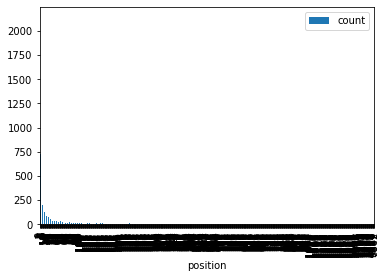

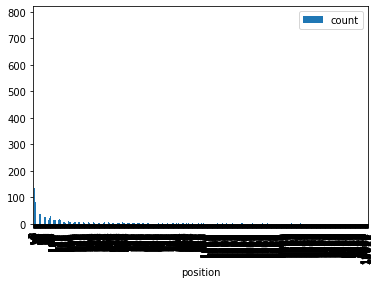

In [18]:
import copy
result_dict = {}
result_dict = copy.deepcopy(all_cohyponym)

for temp_num in range(2):
    count_dict = {}
  
        
    for (key,value) in all_cohyponym.items():
    
        # 没有预测结果的标记
        no_predict = 0

          # 处理模板
        print("==========================================================")
        text = templates[temp_num].replace('*',key)
        print(text)
    
    
        # module
        if mask_token is not None:
            text = text.replace(' _ ', ' %s ' % mask_token)
        tokens = tokenizer.convert_ids_to_tokens(tokenizer.encode(text, add_special_tokens=True))
        tokens = ['*' if token in ['*', 'Ġ*'] else token for token in tokens]
        marker = '*'
        if marker in tokens:
            assert tokens.count(marker) == 2, str(tokens)
            p, h = [i for i, token in enumerate(tokens) if token == marker]
            tokens = [token for token in tokens if token != marker]
            h -= 1
            print(tokens[p], tokens[h])
        token_ids = tokenizer.convert_tokens_to_ids(tokens)
        pred_idx = [i for i, token in enumerate(tokens) if token == mask_token] if mask_token is not None else [-1]
        tokens = ['@' + token if not token.startswith('Ġ') and token not in ['<s>', '</s>', '<mask>'] else token.replace('Ġ', '') 
                  for token in tokens] 
        #print(tokens)

        input_ids = torch.tensor([token_ids])
        with torch.no_grad():
            logits, attns = model(input_ids, output_attentions=True)
            probs = F.softmax(logits, dim=-1)

        for i in pred_idx:
            top_probs, top_indexes = probs[0][i].topk(10)
            top_tokens = tokenizer.convert_ids_to_tokens(top_indexes) 


            # remove G
            ans = []
            for word in top_tokens:
                ans.append(word[1:])
            print(ans)
            print(top_probs)


            # 找到每个同义词位于预测的第几个位置，先找到概率最大的，再去找最大的是预测的第几个
            # 找到每个同义词对应的概率
            word_probe = {}
            for word in value:
                word_id = tokenizer._convert_token_to_id('Ġ'+ word)
                if (word_id != 3):
                    word_probe[word] = probs[0][i][word_id]
                else:
                    print(word + 'is not in list')

            print(word_probe)

            # 找到同义词中概率最大的词和值

            # 没有反义词在预测的结果里
            # 保存计算结果的json文件中写为 -1
            if (len(word_probe)==0):
                no_predict = 1
                break


            max_word = max(word_probe, key=word_probe.get)
            max_probe = word_probe[max_word]

            print('max_probe is: ',end='')
            print(max_probe)

            # 判断概率最大的同义词是预测的第几个
            # 不要陷入死循环
            # k的值不要超过 tensor 的长度
            k = 10
            probe_get = 0
            while(probe_get == 0):
                top_probs, top_indexes = probs[0][i].topk(k)
                #print(top_probs)
                if max_probe in top_probs:
                    print('the position of max probe is: ',end='')
                    print((top_probs == max_probe).nonzero()[0].item())
                    print('-----------------------------------------------------')

                    probe_get = 1
                else:
                    k=k*2
                    print(k)
                    if (k >= list(probs[0][i].size())[0]):
                        top_probs, top_indexes = probs[0][i].topk(probs[0][i].size())
                        print(top_probs)
                        print('the position of max probe is: ',end='')
                        print((top_probs == max_probe).nonzero()[0].item())
                        print('-----------------------------------------------------')
                        probe_get = 1


            print('*****************************************************')

            
        # 没有预测结果
        if(no_predict == 1):
            # 写入结果文件
            if (temp_num == 0):
                result_dict[key] = [result_dict[key],-1]
            else:
                result_dict[key].append(-1)
            continue

            
        # 有预测结果
        position = (top_probs == max_probe).nonzero()[0].item()
        # 写入结果文件
        if (temp_num == 0):
            result_dict[key] = [result_dict[key],position]
        else:
            result_dict[key].append(position)


        if position not in count_dict:
            count_dict[position] = 1
        else:
            count_dict[position]+=1

       
    
    
    # 画图
    count_dict_keys = count_dict.keys()
    count_dict_values = count_dict.values()

    data = {
        'count':Series(count_dict_values),
        'position':Series(count_dict_keys)
    }

    df = DataFrame(data)
    df.sort_values("position",inplace=True)
    print(df)
    # plt.bar(count_dict_keys,count_dict_values)
    df.plot(x='position',y='count',kind='bar')
    
    
    
# 保存到json文件
with open("result_cohyponym.json", "w") as outfile:  
    json.dump(result_dict, outfile)
            
